In [1]:
import pandas as pd
import numpy as np
import datetime 
import matplotlib.pyplot as plt

In [2]:
response_data = pd.read_pickle("response_data.pkl")
feature_data = pd.read_pickle("feature_data_final_ready.pkl")

In [3]:
# X_data is the input variables, dataframe with time index
# Y_data is the single output variable, dataframe with time index same as X_data
# startdate is first day of predicting, string 'YYYYmmdd'
# enddate is the last day of predicting, string 'YYYYmmdd'
# tLen is the length of history for training data used at time t, int, in terms of number of days 
# tperiod is the length of future time, int, in terms of days
# min_data, mimimum data points of train data at time t, if lower than this, no prediction
# title name of columns for predicted variable, default is predicted r 




def predict_reg(X_data,Y_data,startdate,enddate,tLen,tperiod,min_data,model,title='predicted'):
    time_index = X_data.loc[startdate:enddate,:].index
    output = pd.DataFrame(index=time_index,columns=[title])
    

    
    for t in time_index:
        print(t)
        end = t - datetime.timedelta(tperiod)
        start = end - datetime.timedelta(tLen)
        train_X = X_data.loc[start:end,:]
        train_Y = Y_data[start:end]
        test_X = X_data.loc[t,:]
        
        if train_X.shape[0] >= min_data:
            
            #print(train_X.shape[0])
            #model = MLPRegressor(solver='adam',activation='relu', alpha=1e-5,hidden_layer_sizes=(140, 140, 140, 140), random_state=10)
            #model = LinearRegression()
            model.fit(train_X,train_Y)
            #print('mse of training:',np.mean((model.predict(train_X) - train_Y)**2))
            pred = model.predict(test_X.values.reshape(1,-1))
            #print('predicted value:',pred[0])
            #model = cls.fit(train_X,train_Y)
            #pred = cls.predict(test_X)

            output.loc[t,title] = pred[0]
        else:
            output.loc[t,title] = np.nan
    
    return output
         

In [4]:
def prediction(Y_ret,Y_vol,method_r,method_v,m,y,md):
    # Y_ret : next-m-month avg daily return
    # Y_vol : next-m-month daily volatility
    # method : machine learning model
    # m : number of month for period (forward)
    # y : number of years for history length (backward)
    # md : number of years for minimum information should be involved in training data 
    
    ret_pred = predict_reg(X_data=feature_data,Y_data=Y_ret,startdate='19981231',enddate='20161223',tLen=251*y,tperiod=30*m,min_data=251*md,model=method_r,title='pred_ret')
    vol_pred = predict_reg(X_data=feature_data,Y_data=Y_vol,startdate='19981231',enddate='20161223',tLen=251*y,tperiod=30*m,min_data=251*md,model=method_v,title='pred_vol')
    vol_pred = vol_pred.abs()

    ret_pred.join(Y_ret).plot()
    vol_pred.join(Y_vol).plot()
    
    
    output = ret_pred.join(vol_pred)
    output['lower'] = output['pred_ret'] - output['pred_vol']
    output['upper'] = output['pred_ret'] + output['pred_vol']
    
    output = output.join(Y_ret)
    output = output.join(Y_vol)
    
    
    return output

In [5]:
def plotEstimatedPrices(mins, maxes, means, correctness, times):
    N = len(mins)
    ind = np.arange(N) # the x locations for the groups
    width = 1       # the width of the bars: can also be len(x) sequence

    p1 = plt.bar(ind, mins, width, color='w')
    for i in range(N):
        plt2 = plt.bar(ind[i], maxes[i]-mins[i], width, bottom=mins[i], color='orange', alpha=correctness[i])
       
    p3 = plt.plot(ind, means, "-", color='r', label="real return")
    
    plt.ylabel('Return')
    plt.title('Estimated Average Daily Oil Prices Change')

    #plt.yticks(np.arange(0, 100, 10))
    plt.legend()
    #plt.savefig("estimation.png", dpi=200)
    plt.show()
def plot_to_use(prediction,m):
    data = prediction.reset_index()
    mins = data['lower']
    maxes = data['upper']
    means = data['next'+str(m)+'MonthAvgDailyRet']
    times = data['Date']
    data['prob'] = 1
    correctness = data['prob']
    plotEstimatedPrices(mins, maxes, means, correctness, times)

In [6]:
def get_error(prediction,m):
    rr = 'next'+str(m)+'MonthAvgDailyRet'
    rmse_r= np.sqrt(((prediction['pred_ret'] - prediction[rr])**2).mean())
    rmse_v= np.sqrt(((prediction['pred_vol'] - prediction[rr])**2).mean())
    data = prediction.loc[prediction['lower'].notna(),:]
    days_in = 0
    tot_err = 0
    for i in range(data.shape[0]):
        temp = data.iloc[i,:]
        if temp[rr]>temp['upper']:
            #print('over upper')
            tot_err += (temp[rr]-temp['pred_ret'])**2 + 1000*(temp['upper']-temp['lower'])**2 + 500*(temp[rr]-temp['upper'])**2
        elif temp[rr]<temp['lower']:
            #print('below lower')
            tot_err += (temp[rr]-temp['pred_ret'])**2 + 1000*(temp['upper']-temp['lower'])**2 + 500*(temp[rr]-temp['lower'])**2
        else:
            tot_err += (temp[rr]-temp['pred_ret'])**2 + 10*(temp['upper']-temp['lower'])**2
            days_in += 1
    days_in_rate = days_in/data.shape[0]
    tot_err_rate = tot_err/data.shape[0]
    return pd.Series([rmse_r,rmse_v,days_in_rate,tot_err_rate],index=['rmse_r','rmse_v','days_in','tot_error'])

In [17]:
def outlierCut(series,up,lp):
    x = series
    u = np.percentile(x[x.notna()],up)
    l = np.percentile(x[x.notna()],lp)
    x[x>=u] = u
    x[x<=l] = l
    return x

In [8]:
from sklearn.neural_network import MLPRegressor
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso

m_ols = LinearRegression()
m_ridge = Ridge(alpha=0.1,random_state=10)
m_lasso = Lasso(alpha=0.0001,random_state=10)
m_neural = MLPRegressor(solver='adam',activation='tanh', alpha=0.0001,hidden_layer_sizes=(140, 140, 140, 140), random_state=10)



1998-12-31 00:00:00
mse of training: 1.0993163437315439e-05
predicted value: 0.004907453457571761
1999-01-04 00:00:00
mse of training: 1.1499753345124712e-05
predicted value: 0.007593687294111549
1999-01-05 00:00:00
mse of training: 1.15274598884256e-05
predicted value: 0.007704028548209379
1999-01-06 00:00:00
mse of training: 1.1640320640309792e-05
predicted value: 0.008140281091704902
1999-01-07 00:00:00
mse of training: 1.1789903456019706e-05
predicted value: 0.008619752479982071
1999-01-08 00:00:00
mse of training: 1.1934028719785791e-05
predicted value: 0.006613489064198425
1999-01-11 00:00:00
mse of training: 1.2147896326343052e-05
predicted value: 0.007638171298657467
1999-01-12 00:00:00
mse of training: 1.2178257450475043e-05
predicted value: 0.007680516912529461
1999-01-13 00:00:00
mse of training: 1.2175387320610949e-05
predicted value: 0.0076843725754359654
1999-01-14 00:00:00
mse of training: 1.2180912953254735e-05
predicted value: 0.007603327329867689
1999-01-15 00:00:00
m

mse of training: 1.3053541853829248e-05
predicted value: -0.003636818011756665
1999-05-19 00:00:00
mse of training: 1.3026536287304135e-05
predicted value: -0.0035173058248900366
1999-05-20 00:00:00
mse of training: 1.2992565095285432e-05
predicted value: -0.003604750024360795
1999-05-21 00:00:00
mse of training: 1.2944807927092676e-05
predicted value: -0.00169513769137241
1999-05-24 00:00:00
mse of training: 1.2913897101718225e-05
predicted value: -0.0018139740399905485
1999-05-25 00:00:00
mse of training: 1.2945056054941022e-05
predicted value: -0.001606194450402866
1999-05-26 00:00:00
mse of training: 1.296319140522737e-05
predicted value: -0.0011379807133716849
1999-05-27 00:00:00
mse of training: 1.2957397823759705e-05
predicted value: -0.0008811678135020387
1999-05-28 00:00:00
mse of training: 1.2936654951126195e-05
predicted value: 0.0042139756280338905
1999-06-01 00:00:00
mse of training: 1.2946312754702671e-05
predicted value: 0.004774726080377316
1999-06-02 00:00:00
mse of tr

mse of training: 1.310353741537126e-05
predicted value: 0.001395083697517334
1999-09-17 00:00:00
mse of training: 1.326334448180541e-05
predicted value: 0.000568620072566986
1999-09-20 00:00:00
mse of training: 1.3466755075747181e-05
predicted value: 0.0010535516173242193
1999-09-21 00:00:00
mse of training: 1.3501771924076722e-05
predicted value: 0.0007756623499350912
1999-09-22 00:00:00
mse of training: 1.359924938061788e-05
predicted value: 0.0008325666269305351
1999-09-23 00:00:00
mse of training: 1.3709442594773264e-05
predicted value: 0.0013411592291172822
1999-09-24 00:00:00
mse of training: 1.3891095716788802e-05
predicted value: -6.024831341079617e-05
1999-09-27 00:00:00
mse of training: 1.415004268153955e-05
predicted value: 0.0006739529497382171
1999-09-28 00:00:00
mse of training: 1.4178058519792364e-05
predicted value: 0.0006947832728983402
1999-09-29 00:00:00
mse of training: 1.4257253458062492e-05
predicted value: 0.0009085053418249264
1999-09-30 00:00:00
mse of training

2002-03-25 00:00:00
2002-03-26 00:00:00
2002-03-27 00:00:00
2002-03-28 00:00:00
2002-04-01 00:00:00
2002-04-02 00:00:00
2002-04-03 00:00:00
2002-04-04 00:00:00
2002-04-05 00:00:00
2002-04-08 00:00:00
2002-04-09 00:00:00
2002-04-10 00:00:00
2002-04-11 00:00:00
2002-04-12 00:00:00
2002-04-15 00:00:00
2002-04-16 00:00:00
2002-04-17 00:00:00
2002-04-18 00:00:00
2002-04-19 00:00:00
2002-04-22 00:00:00
2002-04-23 00:00:00
2002-04-24 00:00:00
2002-04-25 00:00:00
2002-04-26 00:00:00
2002-04-29 00:00:00
2002-04-30 00:00:00
2002-05-01 00:00:00
2002-05-02 00:00:00
2002-05-03 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00


mse of training: 1.0928421279833764e-05
predicted value: 0.006554070984452745
2003-04-01 00:00:00
mse of training: 1.0928421279833764e-05
predicted value: 0.006803556388604779
2003-04-02 00:00:00
mse of training: 1.1046345747730097e-05
predicted value: 0.0065754543986675795
2003-04-03 00:00:00
mse of training: 1.1235680171104972e-05
predicted value: 0.006126405865765934
2003-04-04 00:00:00
mse of training: 1.1428765591934109e-05
predicted value: 0.0074344937505242915
2003-04-07 00:00:00
mse of training: 1.1965474431369555e-05
predicted value: 0.0070355803869093635
2003-04-08 00:00:00
mse of training: 1.1965474431369555e-05
predicted value: 0.007083486910449027
2003-04-09 00:00:00
mse of training: 1.2184787101994818e-05
predicted value: 0.00677953693767409
2003-04-10 00:00:00
mse of training: 1.2271460229413282e-05
predicted value: 0.006975624154976188
2003-04-11 00:00:00
mse of training: 1.240228714273241e-05
predicted value: 0.0083534456710588
2003-04-14 00:00:00
mse of training: 1.24

mse of training: 1.227468117296729e-05
predicted value: 0.0015526821986427061
2003-07-31 00:00:00
mse of training: 1.2183294841663547e-05
predicted value: 0.002709962918093615
2003-08-01 00:00:00
mse of training: 1.2084151659945791e-05
predicted value: 0.0022085729333484946
2003-08-04 00:00:00
mse of training: 1.2085233286174153e-05
predicted value: 0.0023211160831305318
2003-08-05 00:00:00
mse of training: 1.2085233286174153e-05
predicted value: 0.0022404056612094943
2003-08-06 00:00:00
mse of training: 1.209113006558206e-05
predicted value: 0.0025621488284034953
2003-08-07 00:00:00
mse of training: 1.2085494831360859e-05
predicted value: 0.0024713041849983575
2003-08-08 00:00:00
mse of training: 1.2080543634132727e-05
predicted value: 0.004093694360999288
2003-08-11 00:00:00
mse of training: 1.2044326222596335e-05
predicted value: 0.004116062010014916
2003-08-12 00:00:00
mse of training: 1.206575819142614e-05
predicted value: 0.004118921238579817
2003-08-13 00:00:00
mse of training: 

mse of training: 1.028453390902512e-05
predicted value: 0.001473620607532795
2003-12-24 00:00:00
mse of training: 1.0252442274531234e-05
predicted value: 0.0011827302399905547
2003-12-29 00:00:00
mse of training: 1.015325126112295e-05
predicted value: 0.0033410670796105092
2003-12-30 00:00:00
mse of training: 1.0182170040017121e-05
predicted value: 0.003174636764893014
2003-12-31 00:00:00
mse of training: 1.0178235475060578e-05
predicted value: 0.00022478606082189509
2004-01-05 00:00:00
mse of training: 1.0194387797475995e-05
predicted value: 0.0005550157341922728
2004-01-06 00:00:00
mse of training: 1.02193594887166e-05
predicted value: 0.00014447845583766012
2004-01-07 00:00:00
mse of training: 1.0234034080506042e-05
predicted value: 0.0002961490114344765
2004-01-08 00:00:00
mse of training: 1.0252413150920786e-05
predicted value: 0.00017359498819065778
2004-01-09 00:00:00
mse of training: 1.0263832079952027e-05
predicted value: -7.334690789883615e-05
2004-01-12 00:00:00
mse of train

mse of training: 9.62677764047182e-06
predicted value: 5.367857596891984e-06
2004-05-04 00:00:00
mse of training: 9.639440763124368e-06
predicted value: -0.00034015497882822557
2004-05-05 00:00:00
mse of training: 9.73528451082528e-06
predicted value: 0.00091910188406737
2004-05-06 00:00:00
mse of training: 9.775500686744713e-06
predicted value: 0.0017358964827269077
2004-05-07 00:00:00
mse of training: 9.783351044962856e-06
predicted value: 0.0016123300199037058
2004-05-10 00:00:00
mse of training: 9.799143997961472e-06
predicted value: 0.0021076638353528486
2004-05-11 00:00:00
mse of training: 9.827347611635683e-06
predicted value: 0.0016987566935202057
2004-05-12 00:00:00
mse of training: 9.823917262853401e-06
predicted value: 0.0014901158888835433
2004-05-13 00:00:00
mse of training: 9.824529384943469e-06
predicted value: 0.0015181234185839207
2004-05-14 00:00:00
mse of training: 9.81481975613566e-06
predicted value: 0.00041259011224623054
2004-05-17 00:00:00
mse of training: 9.772

mse of training: 7.842128151065887e-06
predicted value: 0.0009423610926933314
2004-09-02 00:00:00
mse of training: 7.646098634006542e-06
predicted value: 0.0007022653638609107
2004-09-03 00:00:00
mse of training: 7.226203673880698e-06
predicted value: 0.0010646667863027336
2004-09-07 00:00:00
mse of training: 6.311246424016368e-06
predicted value: 0.001427819343907101
2004-09-08 00:00:00
mse of training: 6.307936732628998e-06
predicted value: 0.0017681520842478989
2004-09-09 00:00:00
mse of training: 6.243428965610556e-06
predicted value: 0.0011035654094727135
2004-09-10 00:00:00
mse of training: 6.231986566953403e-06
predicted value: 0.002165279419698244
2004-09-13 00:00:00
mse of training: 6.1809679688166495e-06
predicted value: 0.001507647320312902
2004-09-14 00:00:00
mse of training: 6.1869993396793e-06
predicted value: 0.0015228921300227821
2004-09-15 00:00:00
mse of training: 6.1850593007513145e-06
predicted value: 0.0014458523747867928
2004-09-16 00:00:00
mse of training: 6.1892

2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00
2008-08-19 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00


mse of training: 2.0135352541298752e-05
predicted value: 0.0031827702312179212
2009-04-14 00:00:00
mse of training: 2.0135352541298752e-05
predicted value: 0.0035629449215098044
2009-04-15 00:00:00
mse of training: 2.0068555708294077e-05
predicted value: 0.0036056322255357924
2009-04-16 00:00:00
mse of training: 2.000204627000996e-05
predicted value: 0.003581003025872491
2009-04-17 00:00:00
mse of training: 1.9941118282478763e-05
predicted value: -0.0009329267913290827
2009-04-20 00:00:00
mse of training: 2.0195225841366742e-05
predicted value: -0.0008586908194123111
2009-04-21 00:00:00
mse of training: 2.0195225841366742e-05
predicted value: -0.0009220590460174601
2009-04-22 00:00:00
mse of training: 2.026797908215586e-05
predicted value: -0.0014389661847639332
2009-04-23 00:00:00
mse of training: 2.0261895718571063e-05
predicted value: -0.001526368422942334
2009-04-24 00:00:00
mse of training: 2.0236227347224075e-05
predicted value: -0.004268025991220774
2009-04-27 00:00:00
mse of tr

mse of training: 2.2233297873489243e-05
predicted value: -0.002360163709318616
2009-08-12 00:00:00
mse of training: 2.22822075530006e-05
predicted value: -0.0021693176121193175
2009-08-13 00:00:00
mse of training: 2.2296287416720996e-05
predicted value: -0.0016690251491489894
2009-08-14 00:00:00
mse of training: 2.2282527344189252e-05
predicted value: -0.0036756282707634327
2009-08-17 00:00:00
mse of training: 2.2080664653594896e-05
predicted value: -0.003277282673175258
2009-08-18 00:00:00
mse of training: 2.1958302850629437e-05
predicted value: -0.003777704187804924
2009-08-19 00:00:00
mse of training: 2.1808436257897874e-05
predicted value: -0.004223009804026755
2009-08-20 00:00:00
mse of training: 2.162195188240674e-05
predicted value: -0.003914418440452004
2009-08-21 00:00:00
mse of training: 2.135775630292245e-05
predicted value: -0.002040976250351871
2009-08-24 00:00:00
mse of training: 2.1198002537468468e-05
predicted value: -0.0020443856033591015
2009-08-25 00:00:00
mse of tra

mse of training: 1.831133175053231e-05
predicted value: -0.007562462696154876
2009-12-14 00:00:00
mse of training: 1.823533129738089e-05
predicted value: -0.0070615788102558474
2009-12-15 00:00:00
mse of training: 1.8253617501963126e-05
predicted value: -0.007283482814465496
2009-12-16 00:00:00
mse of training: 1.822042092234052e-05
predicted value: -0.007315170104396848
2009-12-17 00:00:00
mse of training: 1.8189363686337273e-05
predicted value: -0.00732645024894036
2009-12-18 00:00:00
mse of training: 1.8143623251259747e-05
predicted value: -0.0064823055980337135
2009-12-21 00:00:00
mse of training: 1.810358079797635e-05
predicted value: -0.006064669578358262
2009-12-22 00:00:00
mse of training: 1.8151138750898232e-05
predicted value: -0.006655337626298448
2009-12-23 00:00:00
mse of training: 1.827489016895143e-05
predicted value: -0.00725344791044337
2009-12-24 00:00:00
mse of training: 1.8388376074385396e-05
predicted value: -0.007300822485494768
2009-12-28 00:00:00
mse of training

mse of training: 1.0271314632130629e-05
predicted value: -0.0066866021541999825
2010-05-11 00:00:00
mse of training: 1.0017094294019759e-05
predicted value: -0.006808360114319598
2010-05-12 00:00:00
mse of training: 9.995616254644152e-06
predicted value: -0.006956436440007201
2010-05-13 00:00:00
mse of training: 9.89749351086103e-06
predicted value: -0.0064528011511805275
2010-05-14 00:00:00
mse of training: 9.869408036254817e-06
predicted value: -0.007583560652236174
2010-05-17 00:00:00
mse of training: 9.667922729168837e-06
predicted value: -0.006260903618733313
2010-05-18 00:00:00
mse of training: 9.698775045798922e-06
predicted value: -0.005785992337650366
2010-05-19 00:00:00
mse of training: 9.717192858186683e-06
predicted value: -0.00588074430492639
2010-05-20 00:00:00
mse of training: 9.738052002304456e-06
predicted value: -0.004758098986685975
2010-05-21 00:00:00
mse of training: 9.73099158497517e-06
predicted value: -0.003987180835571914
2010-05-24 00:00:00
mse of training: 9.

predicted value: -0.003994264253392728
2010-10-08 00:00:00
mse of training: 4.537325164866643e-06
predicted value: -0.004798716208430538
2010-10-11 00:00:00
mse of training: 4.613204272030022e-06
predicted value: -0.007052996129405249
2010-10-12 00:00:00
mse of training: 4.6262347637929785e-06
predicted value: -0.004016337496327092
2010-10-13 00:00:00
mse of training: 4.678396946332148e-06
predicted value: -0.00432747009024869
2010-10-14 00:00:00
mse of training: 4.710283635632587e-06
predicted value: -0.0039585070088720906
2010-10-15 00:00:00
mse of training: 4.75016090530407e-06
predicted value: -0.004197626681626709
2010-10-18 00:00:00
mse of training: 4.8105314320902315e-06
predicted value: -0.004285809613816999
2010-10-19 00:00:00
mse of training: 4.825526751467214e-06
predicted value: -0.0026456449614820077
2010-10-20 00:00:00
mse of training: 4.837955298435274e-06
predicted value: -0.003410825476873089
2010-10-21 00:00:00
mse of training: 4.85620325041416e-06
predicted value: -0

mse of training: 5.306720814264982e-06
predicted value: -0.005298387926268626
2011-02-28 00:00:00
mse of training: 5.559403655109088e-06
predicted value: -0.00432508252207911
2011-03-01 00:00:00
mse of training: 5.573483574043785e-06
predicted value: -0.005556989035000744
2011-03-02 00:00:00
mse of training: 5.701826885551709e-06
predicted value: -0.006312152989238179
2011-03-03 00:00:00
mse of training: 5.878587059315141e-06
predicted value: -0.006282281045329165
2011-03-04 00:00:00
mse of training: 6.045779439870628e-06
predicted value: -0.006383808694168727
2011-03-07 00:00:00
mse of training: 6.443164181807773e-06
predicted value: -0.0062333616885357004
2011-03-08 00:00:00
mse of training: 6.454298372148252e-06
predicted value: -0.006061224921341132
2011-03-09 00:00:00
mse of training: 6.593800607094373e-06
predicted value: -0.0056090828335121565
2011-03-10 00:00:00
mse of training: 6.684853620955094e-06
predicted value: -0.004675504110413335
2011-03-11 00:00:00
mse of training: 6.

mse of training: 6.276147250476508e-06
predicted value: -0.002449841476166833
2011-07-01 00:00:00
mse of training: 6.205783944408095e-06
predicted value: -0.0024249049197021325
2011-07-05 00:00:00
mse of training: 6.147204301427744e-06
predicted value: -0.0028058024116079452
2011-07-06 00:00:00
mse of training: 6.166746962545802e-06
predicted value: -0.002570744308369212
2011-07-07 00:00:00
mse of training: 6.172181364511599e-06
predicted value: -0.0030613150477974485
2011-07-08 00:00:00
mse of training: 6.175087376397627e-06
predicted value: -0.0023111463969101645
2011-07-11 00:00:00
mse of training: 6.157708674028079e-06
predicted value: -0.0019384135299360637
2011-07-12 00:00:00
mse of training: 6.160028203441434e-06
predicted value: -0.0024681242554327465
2011-07-13 00:00:00
mse of training: 6.155986789321009e-06
predicted value: -0.002581589092313697
2011-07-14 00:00:00
mse of training: 6.15655697294175e-06
predicted value: -0.001986951554998388
2011-07-15 00:00:00
mse of training

mse of training: 5.736924359686064e-06
predicted value: 0.00180707424962602
2011-11-25 00:00:00
mse of training: 5.743721006869711e-06
predicted value: 0.0014627142037959562
2011-11-28 00:00:00
mse of training: 5.735519737888659e-06
predicted value: 0.0010772228941163392
2011-11-29 00:00:00
mse of training: 5.748162664457924e-06
predicted value: 0.0006498112146461482
2011-11-30 00:00:00
mse of training: 5.750089842459946e-06
predicted value: 0.0009097323139643648
2011-12-01 00:00:00
mse of training: 5.755452495283649e-06
predicted value: 0.0010254967487927091
2011-12-02 00:00:00
mse of training: 5.760398408361463e-06
predicted value: 0.0011317880776652786
2011-12-05 00:00:00
mse of training: 5.746925117858532e-06
predicted value: 0.001156810379262678
2011-12-06 00:00:00
mse of training: 5.763913566607689e-06
predicted value: 0.001051305971106399
2011-12-07 00:00:00
mse of training: 5.770435655370934e-06
predicted value: 0.0011950246107778062
2011-12-08 00:00:00
mse of training: 5.77141

mse of training: 1.4798725011363216e-06
predicted value: -0.0037735834033417667
2014-02-03 00:00:00
mse of training: 1.47283527984306e-06
predicted value: -0.002591383377484973
2014-02-04 00:00:00
mse of training: 1.47283527984306e-06
predicted value: -0.0029184119427289983
2014-02-05 00:00:00
mse of training: 1.4737531752892559e-06
predicted value: -0.0026752496272142642
2014-02-06 00:00:00
mse of training: 1.481571964286521e-06
predicted value: -0.0023006947243673637
2014-02-07 00:00:00
mse of training: 1.4957569315687353e-06
predicted value: -0.0031578978277306165
2014-02-10 00:00:00
mse of training: 1.5130003061301646e-06
predicted value: -0.002680767496131404
2014-02-11 00:00:00
mse of training: 1.5130003061301646e-06
predicted value: -0.0016897222812688843
2014-02-12 00:00:00
mse of training: 1.5127665496203903e-06
predicted value: -0.00032281572045439466
2014-02-13 00:00:00
mse of training: 1.5099734242180598e-06
predicted value: -0.0010988830534757257
2014-02-14 00:00:00
mse of

mse of training: 1.451747466588765e-06
predicted value: 0.0008938852278374751
2014-06-03 00:00:00
mse of training: 1.451747466588765e-06
predicted value: 0.0008332938425523288
2014-06-04 00:00:00
mse of training: 1.4472163831852977e-06
predicted value: 0.0009669208017102429
2014-06-05 00:00:00
mse of training: 1.4427065530891258e-06
predicted value: 0.0010226856352524086
2014-06-06 00:00:00
mse of training: 1.438410206682709e-06
predicted value: 0.0010505561235759665
2014-06-09 00:00:00
mse of training: 1.432162213880464e-06
predicted value: 0.0006938268238579938
2014-06-10 00:00:00
mse of training: 1.432162213880464e-06
predicted value: 0.0007056474969582144
2014-06-11 00:00:00
mse of training: 1.4280695288502266e-06
predicted value: 0.0006953392106156635
2014-06-12 00:00:00
mse of training: 1.4242935115235008e-06
predicted value: 0.00031228068609663595
2014-06-13 00:00:00
mse of training: 1.4206989175380144e-06
predicted value: 0.00041511232951700616
2014-06-16 00:00:00
mse of traini

mse of training: 1.3145602472920197e-06
predicted value: 0.004407547733785405
2014-10-22 00:00:00
mse of training: 1.3188590813265336e-06
predicted value: 0.004690831155970156
2014-10-23 00:00:00
mse of training: 1.3304021663570047e-06
predicted value: 0.004283485481698081
2014-10-24 00:00:00
mse of training: 1.3540854093296165e-06
predicted value: 0.0052750995534836705
2014-10-27 00:00:00
mse of training: 1.4485040006894449e-06
predicted value: 0.004719182294352024
2014-10-28 00:00:00
mse of training: 1.4527031904430406e-06
predicted value: 0.004669588782863138
2014-10-29 00:00:00
mse of training: 1.4832999342552975e-06
predicted value: 0.004265935157649881
2014-10-30 00:00:00
mse of training: 1.5312426994982369e-06
predicted value: 0.003969829315476148
2014-10-31 00:00:00
mse of training: 1.7025549211387995e-06
predicted value: 0.004064364869471518
2014-11-03 00:00:00
mse of training: 1.7927833017004678e-06
predicted value: 0.0032627709036708447
2014-11-04 00:00:00
mse of training: 1

predicted value: 0.00648994650846952
2015-03-12 00:00:00
mse of training: 4.5900713154025496e-06
predicted value: 0.006145438497360224
2015-03-13 00:00:00
mse of training: 4.593811814311164e-06
predicted value: 0.004431263807536735
2015-03-16 00:00:00
mse of training: 4.909270216498588e-06
predicted value: 0.0026755743632822415
2015-03-17 00:00:00
mse of training: 4.915968022818893e-06
predicted value: 0.0027640429995670762
2015-03-18 00:00:00
mse of training: 4.91323969152271e-06
predicted value: 0.002817385890210457
2015-03-19 00:00:00
mse of training: 5.018215857838378e-06
predicted value: 0.0021303566029944685
2015-03-20 00:00:00
mse of training: 5.036690336256307e-06
predicted value: 0.00204881044071897
2015-03-23 00:00:00
mse of training: 5.0047802471829125e-06
predicted value: 0.0015576128758933135
2015-03-24 00:00:00
mse of training: 4.968986894766003e-06
predicted value: 0.0016122996522699605
2015-03-25 00:00:00
mse of training: 4.933384445090555e-06
predicted value: 0.0017910

mse of training: 7.791990557215224e-06
predicted value: -0.007314890920593337
2015-07-27 00:00:00
mse of training: 7.955085569883947e-06
predicted value: -0.007878930412791174
2015-07-28 00:00:00
mse of training: 7.97055432471271e-06
predicted value: -0.00792432308527688
2015-07-29 00:00:00
mse of training: 8.030944737388073e-06
predicted value: -0.008145498531288415
2015-07-30 00:00:00
mse of training: 8.051571060278944e-06
predicted value: -0.008946582517010998
2015-07-31 00:00:00
mse of training: 8.048768046835273e-06
predicted value: -0.007927602042330706
2015-08-03 00:00:00
mse of training: 8.029782539620518e-06
predicted value: -0.008343573663355508
2015-08-04 00:00:00
mse of training: 8.029782539620518e-06
predicted value: -0.008478271258212202
2015-08-05 00:00:00
mse of training: 7.9945404857828e-06
predicted value: -0.00880734491141122
2015-08-06 00:00:00
mse of training: 7.94292319152284e-06
predicted value: -0.008513543878436697
2015-08-07 00:00:00
mse of training: 7.9103475

mse of training: 9.770691694124986e-06
predicted value: 0.00038708572513999895
2015-12-11 00:00:00
mse of training: 9.696841325254911e-06
predicted value: 0.0011659973401746994
2015-12-14 00:00:00
mse of training: 9.4741226117828e-06
predicted value: 0.0005285355824419039
2015-12-15 00:00:00
mse of training: 9.496699170701815e-06
predicted value: 0.0002429750730774463
2015-12-16 00:00:00
mse of training: 9.503849271974755e-06
predicted value: 0.0003498794652599495
2015-12-17 00:00:00
mse of training: 9.500003042101819e-06
predicted value: 0.0006204080678724883
2015-12-18 00:00:00
mse of training: 9.496235246602024e-06
predicted value: 0.0017351504411144726
2015-12-21 00:00:00
mse of training: 9.466740187986064e-06
predicted value: 0.0017012999446452855
2015-12-31 00:00:00
mse of training: 9.513614241246996e-06
predicted value: 0.0029488666090388693
2016-01-01 00:00:00
mse of training: 9.52193726596036e-06
predicted value: 5.597217543709676e-05
2016-01-04 00:00:00
mse of training: 9.550

mse of training: 1.1202660423908466e-05
predicted value: 0.0038811215759955234
2016-05-13 00:00:00
mse of training: 1.1169805790092062e-05
predicted value: 0.0021845727684684756
2016-05-16 00:00:00
mse of training: 1.1127616368455846e-05
predicted value: 0.001828635590575018
2016-05-17 00:00:00
mse of training: 1.1096928229087581e-05
predicted value: 0.0014401177427790166
2016-05-18 00:00:00
mse of training: 1.1036606157445297e-05
predicted value: 0.0010855242773859068
2016-05-19 00:00:00
mse of training: 1.0951503822950228e-05
predicted value: 0.000861333936642332
2016-05-20 00:00:00
mse of training: 1.0851833308966291e-05
predicted value: -0.001553434853466991
2016-05-23 00:00:00
mse of training: 1.0795962544360612e-05
predicted value: -0.0015190458201060006
2016-05-24 00:00:00
mse of training: 1.07678452867365e-05
predicted value: -0.0018360292469293757
2016-05-25 00:00:00
mse of training: 1.0739938922930165e-05
predicted value: -0.0020646881543528867
2016-05-26 00:00:00
mse of trai

mse of training: 1.0660483228480615e-05
predicted value: -0.004856619914775168
2016-10-04 00:00:00
mse of training: 1.0668628638043844e-05
predicted value: -0.005016266609146907
2016-10-05 00:00:00
mse of training: 1.0916380185503942e-05
predicted value: -0.005315827056649958
2016-10-06 00:00:00
mse of training: 1.0922699534230085e-05
predicted value: -0.005464962987493847
2016-10-07 00:00:00
mse of training: 1.0912680977228176e-05
predicted value: -0.006752112627199417
2016-10-10 00:00:00
mse of training: 1.0898264195552955e-05
predicted value: -0.007326439888548907
2016-10-11 00:00:00
mse of training: 1.0927728460929975e-05
predicted value: -0.006989509903456748
2016-10-12 00:00:00
mse of training: 1.0929570763334092e-05
predicted value: -0.006836309378931029
2016-10-13 00:00:00
mse of training: 1.0944990770329447e-05
predicted value: -0.006710982865498262
2016-10-14 00:00:00
mse of training: 1.0976048826566647e-05
predicted value: -0.007812655942323382
2016-10-17 00:00:00
mse of tra

mse of training: 4.0658005303527273e-05
predicted value: 0.02923912074084202
1999-02-11 00:00:00
mse of training: 4.0246544829016226e-05
predicted value: 0.029484062195961877
1999-02-12 00:00:00
mse of training: 3.97571315297286e-05
predicted value: 0.02496083188206792
1999-02-16 00:00:00
mse of training: 3.889257320705633e-05
predicted value: 0.023951145558024536
1999-02-17 00:00:00
mse of training: 3.859528735971559e-05
predicted value: 0.02391703331367165
1999-02-18 00:00:00
mse of training: 3.8157374977827015e-05
predicted value: 0.023746673952288785
1999-02-19 00:00:00
mse of training: 3.766295353651865e-05
predicted value: 0.02115245366643928
1999-02-22 00:00:00
mse of training: 3.7682262856847375e-05
predicted value: 0.01998982417199431
1999-02-23 00:00:00
mse of training: 3.7689435192751266e-05
predicted value: 0.019185811193042537
1999-02-24 00:00:00
mse of training: 3.7738053258445854e-05
predicted value: 0.018466736620442126
1999-02-25 00:00:00
mse of training: 3.77741115983

mse of training: 4.061195521916866e-05
predicted value: 0.014848251596468146
1999-06-30 00:00:00
mse of training: 4.0732069362274424e-05
predicted value: 0.01349994618338754
1999-07-01 00:00:00
mse of training: 4.073105898279373e-05
predicted value: 0.013353981074870097
1999-07-02 00:00:00
mse of training: 4.0727696815144266e-05
predicted value: 0.016982620387591185
1999-07-06 00:00:00
mse of training: 4.06667476242895e-05
predicted value: 0.017273612250270354
1999-07-07 00:00:00
mse of training: 4.0696463396685605e-05
predicted value: 0.017355112391534186
1999-07-08 00:00:00
mse of training: 4.070716616882325e-05
predicted value: 0.016897516176456948
1999-07-09 00:00:00
mse of training: 4.0713673625619486e-05
predicted value: 0.020028906789064355
1999-07-12 00:00:00
mse of training: 4.066977932152949e-05
predicted value: 0.019629911771258376
1999-07-13 00:00:00
mse of training: 4.062368740780735e-05
predicted value: 0.01922775554286618
1999-07-14 00:00:00
mse of training: 4.0531555444

mse of training: 1.5471924617883195e-05
predicted value: 0.028119282331734042
1999-11-23 00:00:00
mse of training: 1.5138806562757365e-05
predicted value: 0.02805493099774
1999-11-24 00:00:00
mse of training: 1.4796540128232835e-05
predicted value: 0.02805355851474672
1999-11-26 00:00:00
mse of training: 1.3708548807725969e-05
predicted value: 0.022984411865566462
1999-11-29 00:00:00
mse of training: 1.3116073411910673e-05
predicted value: 0.024480714511923886
1999-11-30 00:00:00
mse of training: 1.2761086674221869e-05
predicted value: 0.025098043184015012
1999-12-01 00:00:00
mse of training: 1.2361430095829774e-05
predicted value: 0.02527876418979897
1999-12-02 00:00:00
mse of training: 1.1890680859304533e-05
predicted value: 0.025378238944525587
1999-12-03 00:00:00
mse of training: 1.1420903513629266e-05
predicted value: 0.023466272234256222
1999-12-06 00:00:00
mse of training: 1.0961604096374322e-05
predicted value: 0.0238970975369125
1999-12-07 00:00:00
mse of training: 1.099481023

mse of training: 6.105199969230205e-06
predicted value: 0.025094728934784483
2003-02-04 00:00:00
mse of training: 6.105199969230205e-06
predicted value: 0.025072330000682316
2003-02-05 00:00:00
mse of training: 6.147357583071349e-06
predicted value: 0.024132699133924556
2003-02-06 00:00:00
mse of training: 6.178493340697089e-06
predicted value: 0.023153852667648186
2003-02-07 00:00:00
mse of training: 6.184013591922796e-06
predicted value: 0.02143046942216193
2003-02-10 00:00:00
mse of training: 6.195474286088154e-06
predicted value: 0.020758167855300293
2003-02-11 00:00:00
mse of training: 6.195474286088154e-06
predicted value: 0.020601789212764076
2003-02-12 00:00:00
mse of training: 6.176797833730835e-06
predicted value: 0.02012236909849044
2003-02-13 00:00:00
mse of training: 6.1560150353339195e-06
predicted value: 0.019813371101981118
2003-02-14 00:00:00
mse of training: 6.13507795361435e-06
predicted value: 0.02448687178506217
2003-02-18 00:00:00
mse of training: 6.10661981373792

mse of training: 2.1436570381307828e-05
predicted value: 0.02254178574423963
2003-06-06 00:00:00
mse of training: 2.143959203676145e-05
predicted value: 0.02121898687521772
2003-06-09 00:00:00
mse of training: 2.1378370737521897e-05
predicted value: 0.02155997779988667
2003-06-10 00:00:00
mse of training: 2.1378370737521897e-05
predicted value: 0.021331991165849034
2003-06-11 00:00:00
mse of training: 2.1323192927089894e-05
predicted value: 0.02127575480864967
2003-06-12 00:00:00
mse of training: 2.12619098769168e-05
predicted value: 0.020586591465113355
2003-06-13 00:00:00
mse of training: 2.120148662697771e-05
predicted value: 0.026727401046524404
2003-06-16 00:00:00
mse of training: 2.1086459280859747e-05
predicted value: 0.02703033107043779
2003-06-17 00:00:00
mse of training: 2.1149722577350927e-05
predicted value: 0.027257562601585454
2003-06-18 00:00:00
mse of training: 2.109547758176121e-05
predicted value: 0.027312337956217275
2003-06-19 00:00:00
mse of training: 2.11097604864

mse of training: 2.1128709562988036e-05
predicted value: 0.025665055846071295
2003-10-23 00:00:00
mse of training: 2.1131343279956247e-05
predicted value: 0.025909384883993358
2003-10-24 00:00:00
mse of training: 2.113320387994514e-05
predicted value: 0.02272517216809793
2003-10-27 00:00:00
mse of training: 2.1008109446810284e-05
predicted value: 0.022740639870031196
2003-10-28 00:00:00
mse of training: 2.0934401575879286e-05
predicted value: 0.022667392362661874
2003-10-29 00:00:00
mse of training: 2.084120735953441e-05
predicted value: 0.022688966282527683
2003-10-30 00:00:00
mse of training: 2.0865748439228437e-05
predicted value: 0.022170414491720598
2003-10-31 00:00:00
mse of training: 2.0809131641003277e-05
predicted value: 0.01812051259311899
2003-11-03 00:00:00
mse of training: 2.0901606710240074e-05
predicted value: 0.016023879299177424
2003-11-04 00:00:00
mse of training: 2.0828741266183954e-05
predicted value: 0.01608264223823303
2003-11-05 00:00:00
mse of training: 2.079816

mse of training: 2.1688889059318874e-05
predicted value: 0.03962044551669673
2004-03-10 00:00:00
mse of training: 2.181530157521735e-05
predicted value: 0.03860703518758184
2004-03-11 00:00:00
mse of training: 2.1959403933186027e-05
predicted value: 0.038606266546695675
2004-03-12 00:00:00
mse of training: 2.2068388239350394e-05
predicted value: 0.038869365625335765
2004-03-15 00:00:00
mse of training: 2.22599737483557e-05
predicted value: 0.037917535359313394
2004-03-16 00:00:00
mse of training: 2.2323993046563382e-05
predicted value: 0.03808293084427176
2004-03-17 00:00:00
mse of training: 2.238881890125973e-05
predicted value: 0.038185544827606166
2004-03-18 00:00:00
mse of training: 2.2528610545559837e-05
predicted value: 0.037570224120365515
2004-03-19 00:00:00
mse of training: 2.263150150988832e-05
predicted value: 0.03420857823290585
2004-03-22 00:00:00
mse of training: 2.2661102336249425e-05
predicted value: 0.033478963270894
2004-03-23 00:00:00
mse of training: 2.2706879841150

mse of training: 1.7962258048087095e-05
predicted value: 0.0216340645459997
2004-08-02 00:00:00
mse of training: 1.6064499684387472e-05
predicted value: 0.021644660725829035
2004-08-03 00:00:00
mse of training: 1.6064499684387472e-05
predicted value: 0.021798091407930167
2004-08-04 00:00:00
mse of training: 1.5197621340924879e-05
predicted value: 0.021502020143592957
2004-08-05 00:00:00
mse of training: 1.416119894042489e-05
predicted value: 0.02242751125015806
2004-08-06 00:00:00
mse of training: 1.310296477232917e-05
predicted value: 0.024786499652303437
2004-08-09 00:00:00
mse of training: 1.2125597829461447e-05
predicted value: 0.025988551928166303
2004-08-10 00:00:00
mse of training: 1.2153019511618396e-05
predicted value: 0.025846847590770692
2004-08-11 00:00:00
mse of training: 1.2095565130490346e-05
predicted value: 0.026667380664924332
2004-08-12 00:00:00
mse of training: 1.1963006265554443e-05
predicted value: 0.027715674399986966
2004-08-13 00:00:00
mse of training: 1.178912

mse of training: 6.12962531878268e-06
predicted value: 0.023721746989438044
2004-12-10 00:00:00
mse of training: 5.785523610175245e-06
predicted value: 0.02114171142179865
2004-12-13 00:00:00
mse of training: 5.247885045754809e-06
predicted value: 0.021166601813134563
2004-12-14 00:00:00
mse of training: 5.210489216482756e-06
predicted value: 0.021708586608375883
2004-12-15 00:00:00
mse of training: 5.299813699373147e-06
predicted value: 0.02218358162731396
2004-12-16 00:00:00
mse of training: 5.448030130837601e-06
predicted value: 0.02282701846721999
2004-12-17 00:00:00
mse of training: 5.599008749865409e-06
predicted value: 0.023648367780044015
2004-12-20 00:00:00
mse of training: 5.836818486444477e-06
predicted value: 0.02424014435334191
2004-12-21 00:00:00
mse of training: 5.849220856829512e-06
predicted value: 0.024154989976859442
2004-12-22 00:00:00
mse of training: 5.962961849328065e-06
predicted value: 0.023568864996933996
2004-12-23 00:00:00
mse of training: 6.085700367675992e

mse of training: 4.493026578548053e-05
predicted value: 0.06139653527166434
2009-02-20 00:00:00
mse of training: 4.4762243578022826e-05
predicted value: 0.06192972027239275
2009-02-23 00:00:00
mse of training: 4.4448749374415635e-05
predicted value: 0.06177943244966601
2009-02-24 00:00:00
mse of training: 4.4448749374415635e-05
predicted value: 0.062314280110024926
2009-02-25 00:00:00
mse of training: 4.431728606235065e-05
predicted value: 0.06307011607168836
2009-02-26 00:00:00
mse of training: 4.417045405087149e-05
predicted value: 0.0629576291067013
2009-02-27 00:00:00
mse of training: 4.4011451921326623e-05
predicted value: 0.0574757371717557
2009-03-02 00:00:00
mse of training: 4.374319344664851e-05
predicted value: 0.05926287974997778
2009-03-03 00:00:00
mse of training: 4.374319344664851e-05
predicted value: 0.0593975644881101
2009-03-04 00:00:00
mse of training: 4.3605269005253274e-05
predicted value: 0.058614899478692195
2009-03-05 00:00:00
mse of training: 4.344669377472675e-

mse of training: 3.983949881570983e-05
predicted value: 0.008342674140018887
2009-07-16 00:00:00
mse of training: 3.942515878121515e-05
predicted value: 0.008683327049002001
2009-07-17 00:00:00
mse of training: 3.888246826342223e-05
predicted value: 0.010332090872111004
2009-07-20 00:00:00
mse of training: 3.873559757307612e-05
predicted value: 0.00988035689128279
2009-07-21 00:00:00
mse of training: 3.880133268929196e-05
predicted value: 0.010158452207903616
2009-07-22 00:00:00
mse of training: 3.869846378371937e-05
predicted value: 0.009622636916360512
2009-07-23 00:00:00
mse of training: 3.8595888267767906e-05
predicted value: 0.008936165033830601
2009-07-24 00:00:00
mse of training: 3.850161019881504e-05
predicted value: 0.004812690608389875
2009-07-27 00:00:00
mse of training: 3.8308011067381054e-05
predicted value: 0.004830322083184568
2009-07-28 00:00:00
mse of training: 3.827638281051421e-05
predicted value: 0.004848641850464783
2009-07-29 00:00:00
mse of training: 3.8235996057

predicted value: 0.03375171886197008
2009-11-17 00:00:00
mse of training: 3.171795080101708e-05
predicted value: 0.03394888899057952
2009-11-18 00:00:00
mse of training: 3.173462784182174e-05
predicted value: 0.03396203105388434
2009-11-19 00:00:00
mse of training: 3.175648854579979e-05
predicted value: 0.03485349752187443
2009-11-20 00:00:00
mse of training: 3.178553009681979e-05
predicted value: 0.029011556400789798
2009-11-23 00:00:00
mse of training: 3.169506341695666e-05
predicted value: 0.028367093337817582
2009-11-24 00:00:00
mse of training: 3.17151806385518e-05
predicted value: 0.028830272967630743
2009-11-25 00:00:00
mse of training: 3.1689109113434983e-05
predicted value: 0.027952023750729714
2009-11-27 00:00:00
mse of training: 3.155810262983357e-05
predicted value: 0.03383652983668357
2009-11-30 00:00:00
mse of training: 3.182310320300382e-05
predicted value: 0.032777580970985626
2009-12-01 00:00:00
mse of training: 3.185803447443842e-05
predicted value: 0.0327647607902168

predicted value: 0.02659732882413797
2010-03-23 00:00:00
mse of training: 1.8335245075795252e-05
predicted value: 0.026373865874790584
2010-03-24 00:00:00
mse of training: 1.8353043284958238e-05
predicted value: 0.026653130023460488
2010-03-25 00:00:00
mse of training: 1.8300868502173185e-05
predicted value: 0.026717420702117627
2010-03-26 00:00:00
mse of training: 1.8091849994656474e-05
predicted value: 0.02773477833370809
2010-03-29 00:00:00
mse of training: 1.826050854289024e-05
predicted value: 0.0270141280842221
2010-03-30 00:00:00
mse of training: 1.82823029658263e-05
predicted value: 0.026821970602856453
2010-03-31 00:00:00
mse of training: 1.8373271457367877e-05
predicted value: 0.00994312429058855
2010-04-01 00:00:00
mse of training: 1.8445022894504394e-05
predicted value: 0.009217066514834275
2010-04-05 00:00:00
mse of training: 1.8607196561014674e-05
predicted value: 0.014084109545996981
2010-04-06 00:00:00
mse of training: 1.8624484941915397e-05
predicted value: 0.014111348

predicted value: 0.026358517276115177
2010-07-29 00:00:00
mse of training: 1.5436770327852826e-05
predicted value: 0.025936296391123142
2010-07-30 00:00:00
mse of training: 1.5129414494080467e-05
predicted value: 0.028104060938182705
2010-08-02 00:00:00
mse of training: 1.5000574677776866e-05
predicted value: 0.025670036919448018
2010-08-03 00:00:00
mse of training: 1.5000574677776866e-05
predicted value: 0.02529981175850631
2010-08-04 00:00:00
mse of training: 1.4900841612307128e-05
predicted value: 0.025371359284252253
2010-08-05 00:00:00
mse of training: 1.4808000981431358e-05
predicted value: 0.024733876608578453
2010-08-06 00:00:00
mse of training: 1.4858664574536975e-05
predicted value: 0.025401028671858835
2010-08-09 00:00:00
mse of training: 1.4810998234771414e-05
predicted value: 0.02445769575727989
2010-08-10 00:00:00
mse of training: 1.479299398127253e-05
predicted value: 0.025079671423177102
2010-08-11 00:00:00
mse of training: 1.47235850414467e-05
predicted value: 0.025356

mse of training: 8.769501127517836e-06
predicted value: 0.01520520008845587
2010-12-10 00:00:00
mse of training: 8.760833254951926e-06
predicted value: 0.015757904729853552
2010-12-13 00:00:00
mse of training: 8.742689976255135e-06
predicted value: 0.015437512062075606
2010-12-14 00:00:00
mse of training: 8.76589818835889e-06
predicted value: 0.01553036846468005
2010-12-15 00:00:00
mse of training: 8.764030909010385e-06
predicted value: 0.015544777584830766
2010-12-16 00:00:00
mse of training: 8.780017316754915e-06
predicted value: 0.015571119263770375
2010-12-17 00:00:00
mse of training: 8.828219751629e-06
predicted value: 0.013547174151928042
2010-12-20 00:00:00
mse of training: 8.830779121964582e-06
predicted value: 0.0134229574240745
2010-12-21 00:00:00
mse of training: 8.8565308421861e-06
predicted value: 0.013271890020393085
2010-12-22 00:00:00
mse of training: 8.866550886057377e-06
predicted value: 0.013174157745402947
2010-12-23 00:00:00
mse of training: 8.86087837847943e-06
pr

mse of training: 8.865530051532762e-06
predicted value: 0.017527433154265484
2011-04-27 00:00:00
mse of training: 8.938602755001633e-06
predicted value: 0.017232157881244985
2011-04-28 00:00:00
mse of training: 8.995247805174536e-06
predicted value: 0.01681684827737906
2011-04-29 00:00:00
mse of training: 9.046735595937943e-06
predicted value: 0.014902878037191286
2011-05-02 00:00:00
mse of training: 9.021431582662902e-06
predicted value: 0.0148235050670781
2011-05-03 00:00:00
mse of training: 9.045753237375278e-06
predicted value: 0.015200073020582357
2011-05-04 00:00:00
mse of training: 9.174844637567606e-06
predicted value: 0.01605997966169869
2011-05-05 00:00:00
mse of training: 9.306373163939192e-06
predicted value: 0.017761390554746924
2011-05-06 00:00:00
mse of training: 9.445005101177046e-06
predicted value: 0.01829485576587008
2011-05-09 00:00:00
mse of training: 9.65285893822771e-06
predicted value: 0.0187122627115119
2011-05-10 00:00:00
mse of training: 9.674184674956089e-06

mse of training: 1.3089451192336444e-05
predicted value: 0.017565386989506798
2011-09-15 00:00:00
mse of training: 1.3097829741037112e-05
predicted value: 0.017706146906784487
2011-09-16 00:00:00
mse of training: 1.3109489983031124e-05
predicted value: 0.019035082352958768
2011-09-19 00:00:00
mse of training: 1.305089446647484e-05
predicted value: 0.018659821820140615
2011-09-20 00:00:00
mse of training: 1.3025663075053977e-05
predicted value: 0.01868118790346683
2011-09-21 00:00:00
mse of training: 1.2994400792514909e-05
predicted value: 0.018908398561816198
2011-09-22 00:00:00
mse of training: 1.295578716569545e-05
predicted value: 0.019402730106065552
2011-09-23 00:00:00
mse of training: 1.2913944286830939e-05
predicted value: 0.019668048658250677
2011-09-26 00:00:00
mse of training: 1.2916684534718583e-05
predicted value: 0.02009190840205749
2011-09-27 00:00:00
mse of training: 1.2818078014785597e-05
predicted value: 0.01996622582234034
2011-09-28 00:00:00
mse of training: 1.293676

2013-03-12 00:00:00
2013-03-13 00:00:00
2013-03-14 00:00:00
2013-03-15 00:00:00
2013-03-18 00:00:00
2013-03-19 00:00:00
2013-03-20 00:00:00
2013-03-21 00:00:00
2013-03-22 00:00:00
2013-03-25 00:00:00
2013-03-26 00:00:00
2013-03-27 00:00:00
2013-03-28 00:00:00
2013-04-01 00:00:00
2013-04-02 00:00:00
2013-04-03 00:00:00
2013-04-04 00:00:00
2013-04-05 00:00:00
2013-04-08 00:00:00
2013-04-09 00:00:00
2013-04-10 00:00:00
2013-04-11 00:00:00
2013-04-12 00:00:00
2013-04-15 00:00:00
2013-04-16 00:00:00
2013-04-17 00:00:00
2013-04-18 00:00:00
2013-04-19 00:00:00
2013-04-22 00:00:00
2013-04-23 00:00:00
2013-04-24 00:00:00
2013-04-25 00:00:00
2013-04-26 00:00:00
2013-04-29 00:00:00
2013-04-30 00:00:00
2013-05-01 00:00:00
2013-05-02 00:00:00
2013-05-03 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-16 00:00:00
2013-05-17 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00


mse of training: 2.2310134046059142e-06
predicted value: 0.011577857416242576
2014-04-03 00:00:00
mse of training: 2.2240853312643648e-06
predicted value: 0.0115634945927036
2014-04-04 00:00:00
mse of training: 2.2188221411411098e-06
predicted value: 0.011891231917803587
2014-04-07 00:00:00
mse of training: 2.2044720192651764e-06
predicted value: 0.011830349712840024
2014-04-08 00:00:00
mse of training: 2.2044720192651764e-06
predicted value: 0.011798114961512729
2014-04-09 00:00:00
mse of training: 2.197542157001813e-06
predicted value: 0.011809810214458446
2014-04-10 00:00:00
mse of training: 2.190210021168905e-06
predicted value: 0.011828889021323598
2014-04-11 00:00:00
mse of training: 2.185404118529975e-06
predicted value: 0.011287981895565742
2014-04-14 00:00:00
mse of training: 2.175945838669581e-06
predicted value: 0.011156965173965588
2014-04-15 00:00:00
mse of training: 2.175945838669581e-06
predicted value: 0.011170269841823073
2014-04-16 00:00:00
mse of training: 2.17567587

mse of training: 2.4029417873118178e-06
predicted value: 0.012600894469154215
2014-08-14 00:00:00
mse of training: 2.3816631545515387e-06
predicted value: 0.012856188618789545
2014-08-15 00:00:00
mse of training: 2.357561188733899e-06
predicted value: 0.013488305152523758
2014-08-18 00:00:00
mse of training: 2.328946661299537e-06
predicted value: 0.013684946240735879
2014-08-19 00:00:00
mse of training: 2.3271224070926415e-06
predicted value: 0.013669967354307063
2014-08-20 00:00:00
mse of training: 2.342303923273558e-06
predicted value: 0.01381362643823288
2014-08-21 00:00:00
mse of training: 2.3550678980177952e-06
predicted value: 0.013971811949806179
2014-08-22 00:00:00
mse of training: 2.3749727693154502e-06
predicted value: 0.014175867907843935
2014-08-25 00:00:00
mse of training: 2.3815574408985186e-06
predicted value: 0.014524841713335719
2014-08-26 00:00:00
mse of training: 2.354031655362047e-06
predicted value: 0.014563513928451602
2014-08-27 00:00:00
mse of training: 2.344296

mse of training: 4.644226948788618e-06
predicted value: 0.023940083161119084
2014-12-15 00:00:00
mse of training: 4.788980685789415e-06
predicted value: 0.025012733262730402
2014-12-16 00:00:00
mse of training: 4.794242466840183e-06
predicted value: 0.025024630515772105
2014-12-17 00:00:00
mse of training: 4.8396995862916804e-06
predicted value: 0.02535413885418833
2014-12-18 00:00:00
mse of training: 4.9561094613091045e-06
predicted value: 0.026047260241357964
2014-12-19 00:00:00
mse of training: 5.080532009697599e-06
predicted value: 0.023841284961534467
2014-12-22 00:00:00
mse of training: 5.268021905068698e-06
predicted value: 0.02456812969665697
2014-12-23 00:00:00
mse of training: 5.253884079682047e-06
predicted value: 0.024701285479792875
2014-12-24 00:00:00
mse of training: 5.3397166351913585e-06
predicted value: 0.025084226463167665
2014-12-26 00:00:00
mse of training: 5.445489112823404e-06
predicted value: 0.024866453752716997
2014-12-29 00:00:00
mse of training: 5.4341964938

mse of training: 8.191329252145669e-06
predicted value: 0.02862245221124053
2015-05-04 00:00:00
mse of training: 8.207727068534193e-06
predicted value: 0.028393937405034014
2015-05-05 00:00:00
mse of training: 8.222867381465384e-06
predicted value: 0.02823492777278408
2015-05-06 00:00:00
mse of training: 8.230640495315597e-06
predicted value: 0.027930580720718995
2015-05-07 00:00:00
mse of training: 8.242082354192132e-06
predicted value: 0.028008419340547333
2015-05-08 00:00:00
mse of training: 8.379288684019371e-06
predicted value: 0.028103996191258876
2015-05-11 00:00:00
mse of training: 8.50385104291221e-06
predicted value: 0.02765349977931774
2015-05-12 00:00:00
mse of training: 8.494231407782534e-06
predicted value: 0.027479113018539905
2015-05-13 00:00:00
mse of training: 8.493500733861411e-06
predicted value: 0.027369497527726563
2015-05-14 00:00:00
mse of training: 8.463805488094766e-06
predicted value: 0.027398972366233086
2015-05-15 00:00:00
mse of training: 8.561234906870802

mse of training: 1.8260810350795612e-05
predicted value: 0.03660423675429722
2015-09-21 00:00:00
mse of training: 1.841117459153322e-05
predicted value: 0.03682406863745663
2015-09-22 00:00:00
mse of training: 1.8456732804968867e-05
predicted value: 0.03670261629945144
2015-09-23 00:00:00
mse of training: 1.841618293780573e-05
predicted value: 0.036894492041359014
2015-09-24 00:00:00
mse of training: 1.837607526243002e-05
predicted value: 0.037061738569350494
2015-09-25 00:00:00
mse of training: 1.834168075007166e-05
predicted value: 0.03652399193873386
2015-09-28 00:00:00
mse of training: 1.8304023289532527e-05
predicted value: 0.028765268161702773
2015-09-29 00:00:00
mse of training: 1.8356750351219542e-05
predicted value: 0.028823028526263866
2015-09-30 00:00:00
mse of training: 1.8580143335380103e-05
predicted value: 0.03595818291931353
2015-10-01 00:00:00
mse of training: 1.9015243265955746e-05
predicted value: 0.03547302232958109
2015-10-02 00:00:00
mse of training: 1.93593567860

2016-02-17 00:00:00
mse of training: 2.1292327335806026e-05
predicted value: 0.060803221301061916
2016-02-18 00:00:00
mse of training: 2.1296467166339783e-05
predicted value: 0.06039896443526322
2016-02-19 00:00:00
mse of training: 2.1311188006370325e-05
predicted value: 0.05330429108300619
2016-02-22 00:00:00
mse of training: 2.167325853969635e-05
predicted value: 0.05204237193037647
2016-02-23 00:00:00
mse of training: 2.1728066926769034e-05
predicted value: 0.052029305272945456
2016-02-24 00:00:00
mse of training: 2.2413409875700106e-05
predicted value: 0.050748832571459165
2016-02-25 00:00:00
mse of training: 2.2849903755324037e-05
predicted value: 0.049979687283727536
2016-02-26 00:00:00
mse of training: 2.3322108902629466e-05
predicted value: 0.045730769794368804
2016-02-29 00:00:00
mse of training: 2.3632856099891885e-05
predicted value: 0.045818171536529985
2016-03-01 00:00:00
mse of training: 2.3682611907551946e-05
predicted value: 0.04553787094037531
2016-03-02 00:00:00
mse o

mse of training: 2.488622501639624e-05
predicted value: 0.01699277243093688
2016-06-30 00:00:00
mse of training: 2.5057461285068452e-05
predicted value: 0.02188903657971284
2016-07-01 00:00:00
mse of training: 2.5175764472023786e-05
predicted value: 0.021719988098034406
2016-07-05 00:00:00
mse of training: 2.525118692103692e-05
predicted value: 0.023380982052303212
2016-07-06 00:00:00
mse of training: 2.538873196063842e-05
predicted value: 0.02353028849308919
2016-07-07 00:00:00
mse of training: 2.5383898613623394e-05
predicted value: 0.024743904132298544
2016-07-08 00:00:00
mse of training: 2.5378520655662193e-05
predicted value: 0.025501539018635496
2016-07-11 00:00:00
mse of training: 2.5508863427257226e-05
predicted value: 0.026306134350777124
2016-07-12 00:00:00
mse of training: 2.550520862773107e-05
predicted value: 0.02560617416382779
2016-07-13 00:00:00
mse of training: 2.5449793230445046e-05
predicted value: 0.026459318080119705
2016-07-14 00:00:00
mse of training: 2.539301075

mse of training: 2.7856974140623952e-05
predicted value: 0.01764102028768215
2016-11-09 00:00:00
mse of training: 2.7866831236764063e-05
predicted value: 0.019887814950103833
2016-11-10 00:00:00
mse of training: 2.7889975543502455e-05
predicted value: 0.021336234156561495
2016-11-11 00:00:00
mse of training: 2.7908182491594906e-05
predicted value: 0.024852002502706624
2016-11-14 00:00:00
mse of training: 2.7875184102482144e-05
predicted value: 0.02755676879918252
2016-11-15 00:00:00
mse of training: 2.7944725364390344e-05
predicted value: 0.026020335509320106
2016-11-16 00:00:00
mse of training: 2.7976673872287267e-05
predicted value: 0.025634593131900807
2016-11-17 00:00:00
mse of training: 2.8019341335360507e-05
predicted value: 0.02740245811225439
2016-11-18 00:00:00
mse of training: 2.811591744238611e-05
predicted value: 0.028906335900661086
2016-11-21 00:00:00
mse of training: 2.832552410487312e-05
predicted value: 0.027927870032576893
2016-11-22 00:00:00
mse of training: 2.840751

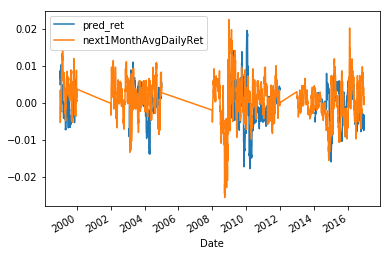

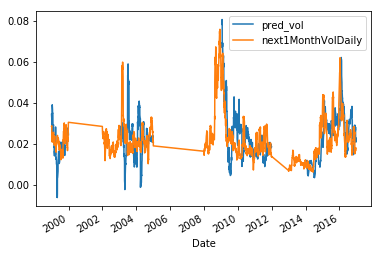

In [128]:
Prediction_1M_ridge = prediction(response_data.next1MonthAvgDailyRet,response_data.next1MonthVolDaily,m_ridge,m_ridge,1,2,1)


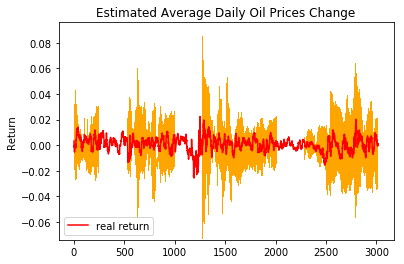

In [134]:
plot_to_use(Prediction_1M_ridge,1)

1998-12-31 00:00:00
mse of training: 1.561329643971974e-05
predicted value: -0.0017604271783411129
1999-01-04 00:00:00
mse of training: 1.653012717800776e-05
predicted value: -0.0004056598522810943
1999-01-05 00:00:00
mse of training: 1.656559210428459e-05
predicted value: -0.0004050687572732404
1999-01-06 00:00:00
mse of training: 1.6851842863197285e-05
predicted value: -0.0003733707131043061
1999-01-07 00:00:00
mse of training: 1.7214901977853672e-05
predicted value: -0.00033645272187467906
1999-01-08 00:00:00
mse of training: 1.7627594517223685e-05
predicted value: -0.00010937942985205906
1999-01-11 00:00:00
mse of training: 1.8590233465669428e-05
predicted value: 0.00010455626255050868
1999-01-12 00:00:00
mse of training: 1.8636307156441014e-05
predicted value: 0.00010766260831449742
1999-01-13 00:00:00
mse of training: 1.8695874912878138e-05
predicted value: 0.00014962883325004683
1999-01-14 00:00:00
mse of training: 1.8714574006007928e-05
predicted value: 0.00018271965910033293
1

mse of training: 2.2168162050454698e-05
predicted value: 0.0024970630743946787
1999-06-07 00:00:00
mse of training: 2.1922823778051674e-05
predicted value: 0.002436212381036064
1999-06-08 00:00:00
mse of training: 2.1825907176487923e-05
predicted value: 0.0024182645881035813
1999-06-09 00:00:00
mse of training: 2.1592394045042177e-05
predicted value: 0.002371666674669452
1999-06-10 00:00:00
mse of training: 2.142158959943054e-05
predicted value: 0.002372604682679108
1999-06-11 00:00:00
mse of training: 2.146078051244245e-05
predicted value: 0.0015060618733506378
1999-06-14 00:00:00
mse of training: 2.1420582302790782e-05
predicted value: 0.0015380213302350725
1999-06-15 00:00:00
mse of training: 2.1457048061887608e-05
predicted value: 0.0015301776806186107
1999-06-16 00:00:00
mse of training: 2.1479636504254528e-05
predicted value: 0.001551201322149887
1999-06-17 00:00:00
mse of training: 2.153006551540008e-05
predicted value: 0.0015954043856948076
1999-06-18 00:00:00
mse of training: 

mse of training: 2.2911476801443527e-05
predicted value: 0.0030728486995292136
1999-10-07 00:00:00
mse of training: 2.2991210122797763e-05
predicted value: 0.0030563065308631034
1999-10-08 00:00:00
mse of training: 2.2951611275784267e-05
predicted value: 0.0024831707855209988
1999-10-11 00:00:00
mse of training: 2.2959828495917408e-05
predicted value: 0.0023236108549944843
1999-10-12 00:00:00
mse of training: 2.3000858393960133e-05
predicted value: 0.0023154327429979965
1999-10-13 00:00:00
mse of training: 2.3089614573983076e-05
predicted value: 0.002255867447130402
1999-10-14 00:00:00
mse of training: 2.3139904199523072e-05
predicted value: 0.0022113586490910666
1999-10-15 00:00:00
mse of training: 2.317864262018097e-05
predicted value: 0.0018951156823183001
1999-10-18 00:00:00
mse of training: 2.321622744753594e-05
predicted value: 0.001706348907145933
1999-10-19 00:00:00
mse of training: 2.32653771750808e-05
predicted value: 0.0016893550820236986
1999-10-20 00:00:00
mse of training:

2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00


mse of training: 1.895801418330607e-05
predicted value: -0.001449894273474457
2003-05-16 00:00:00
mse of training: 1.8916563031333714e-05
predicted value: -0.0014245456857856196
2003-05-19 00:00:00
mse of training: 1.8860983350338307e-05
predicted value: -0.0014212671823239428
2003-05-20 00:00:00
mse of training: 1.8860983350338307e-05
predicted value: -0.0014212671823239428
2003-05-21 00:00:00
mse of training: 1.880454272502645e-05
predicted value: -0.001427883321565484
2003-05-22 00:00:00
mse of training: 1.8761158198548115e-05
predicted value: -0.0014061620230485076
2003-05-23 00:00:00
mse of training: 1.877727937061489e-05
predicted value: -0.0013481480832645764
2003-05-27 00:00:00
mse of training: 1.9004849012586224e-05
predicted value: -0.0011717391145155943
2003-05-28 00:00:00
mse of training: 1.914421705098099e-05
predicted value: -0.0010463595476795078
2003-05-29 00:00:00
mse of training: 1.91881606714231e-05
predicted value: -0.0007559689893861937
2003-05-30 00:00:00
mse of t

mse of training: 1.9261379048210734e-05
predicted value: 0.00046970163253824866
2003-09-17 00:00:00
mse of training: 1.9333381540718937e-05
predicted value: 0.0002940725033141133
2003-09-18 00:00:00
mse of training: 1.941733539556602e-05
predicted value: 0.00011389914475722681
2003-09-19 00:00:00
mse of training: 1.9518542422037657e-05
predicted value: -0.00022788704948930368
2003-09-22 00:00:00
mse of training: 1.976812996942648e-05
predicted value: -0.0006781424454523086
2003-09-23 00:00:00
mse of training: 1.979255583524487e-05
predicted value: -0.0006857660588530912
2003-09-24 00:00:00
mse of training: 1.9779330132136453e-05
predicted value: -0.000813415050161263
2003-09-25 00:00:00
mse of training: 1.980676025486301e-05
predicted value: -0.0009596702640087818
2003-09-26 00:00:00
mse of training: 1.9749571634106597e-05
predicted value: -0.0011792930040726273
2003-09-29 00:00:00
mse of training: 1.9519798569403506e-05
predicted value: -0.0013716644233497987
2003-09-30 00:00:00
mse o

mse of training: 1.8318109570777185e-05
predicted value: -0.00022778448438664752
2004-02-18 00:00:00
mse of training: 1.8356083609355017e-05
predicted value: -0.00022796183464227722
2004-02-19 00:00:00
mse of training: 1.8356989659323928e-05
predicted value: -0.00022893987891521236
2004-02-20 00:00:00
mse of training: 1.8356625162193533e-05
predicted value: -0.0002566707353495422
2004-02-23 00:00:00
mse of training: 1.832871283034387e-05
predicted value: -0.00024159242289268582
2004-02-24 00:00:00
mse of training: 1.8359026502635164e-05
predicted value: -0.00025519564670140917
2004-02-25 00:00:00
mse of training: 1.8371199258661963e-05
predicted value: -0.0002483457399237547
2004-02-26 00:00:00
mse of training: 1.8406950308644645e-05
predicted value: -0.00023218094686959425
2004-02-27 00:00:00
mse of training: 1.8463208622297066e-05
predicted value: -0.0006242930375825453
2004-03-01 00:00:00
mse of training: 1.8606225950170332e-05
predicted value: -0.0005211521688522473
2004-03-02 00:0

mse of training: 1.3717686231062664e-05
predicted value: 0.00220592471985889
2004-07-14 00:00:00
mse of training: 1.3556760223025168e-05
predicted value: 0.002207759243927518
2004-07-15 00:00:00
mse of training: 1.3440348761517492e-05
predicted value: 0.0022198346480275318
2004-07-16 00:00:00
mse of training: 1.3325089742403745e-05
predicted value: 0.001767111274043979
2004-07-19 00:00:00
mse of training: 1.3208218257234685e-05
predicted value: 0.0017702275949048065
2004-07-20 00:00:00
mse of training: 1.3092107372761365e-05
predicted value: 0.0017378701759411196
2004-07-21 00:00:00
mse of training: 1.2952675665398824e-05
predicted value: 0.0017247219791274668
2004-07-22 00:00:00
mse of training: 1.2816265577602945e-05
predicted value: 0.0017095841174857435
2004-07-23 00:00:00
mse of training: 1.2697950747697959e-05
predicted value: 0.002789822518859465
2004-07-26 00:00:00
mse of training: 1.2610912923056124e-05
predicted value: 0.002860936460304636
2004-07-27 00:00:00
mse of training:

mse of training: 1.1948800467928217e-05
predicted value: 0.002131466515107747
2004-11-12 00:00:00
mse of training: 1.2131176949453575e-05
predicted value: 0.0020925914311439005
2004-11-15 00:00:00
mse of training: 1.2568112240570749e-05
predicted value: 0.00200251131914065
2004-11-16 00:00:00
mse of training: 1.2609397608123384e-05
predicted value: 0.0020032736104157243
2004-11-17 00:00:00
mse of training: 1.2809786690761664e-05
predicted value: 0.0019634523241420527
2004-11-18 00:00:00
mse of training: 1.2895352660229743e-05
predicted value: 0.001937090676026148
2004-11-19 00:00:00
mse of training: 1.3043840550928347e-05
predicted value: 0.0019036799819089052
2004-11-22 00:00:00
mse of training: 1.333626997118265e-05
predicted value: 0.0018306483401866582
2004-11-23 00:00:00
mse of training: 1.337041480331996e-05
predicted value: 0.0018311397990403877
2004-11-24 00:00:00
mse of training: 1.351362450562122e-05
predicted value: 0.0017970166260432225
2004-11-29 00:00:00
mse of training: 

mse of training: 3.058222532235998e-05
predicted value: 0.000641573654447912
2009-02-23 00:00:00
mse of training: 3.0958212847562455e-05
predicted value: -0.0003634527535492163
2009-02-24 00:00:00
mse of training: 3.0958212847562455e-05
predicted value: -0.00036398096683017134
2009-02-25 00:00:00
mse of training: 3.0952500640860404e-05
predicted value: -0.0006693749581037495
2009-02-26 00:00:00
mse of training: 3.083252056199228e-05
predicted value: -0.00031442746982130593
2009-02-27 00:00:00
mse of training: 3.070842989296322e-05
predicted value: -0.0004990778092645934
2009-03-02 00:00:00
mse of training: 3.0611692403947426e-05
predicted value: -0.0004792793161491546
2009-03-03 00:00:00
mse of training: 3.0611692403947426e-05
predicted value: -0.0004792793161491546
2009-03-04 00:00:00
mse of training: 3.05015949263372e-05
predicted value: -0.00037334966004921866
2009-03-05 00:00:00
mse of training: 3.0390287374428963e-05
predicted value: -0.00010617318799994307
2009-03-06 00:00:00
mse

mse of training: 3.375305999339047e-05
predicted value: 0.0008124481653891194
2009-07-09 00:00:00
mse of training: 3.38509648553522e-05
predicted value: 0.0006002953651496681
2009-07-10 00:00:00
mse of training: 3.3975443563265564e-05
predicted value: -0.00014754885716933286
2009-07-13 00:00:00
mse of training: 3.4256318705600104e-05
predicted value: -0.0005286745575133756
2009-07-14 00:00:00
mse of training: 3.4310931589279705e-05
predicted value: -0.0005743932915378835
2009-07-15 00:00:00
mse of training: 3.441529409876436e-05
predicted value: -0.0007054668501791372
2009-07-16 00:00:00
mse of training: 3.448041153929893e-05
predicted value: -0.000722335741754114
2009-07-17 00:00:00
mse of training: 3.455852130000858e-05
predicted value: 0.003228613588595289
2009-07-20 00:00:00
mse of training: 3.458415054157194e-05
predicted value: 0.0031447104823708674
2009-07-21 00:00:00
mse of training: 3.4648024856854115e-05
predicted value: 0.0031193719377208134
2009-07-22 00:00:00
mse of traini

2009-11-11 00:00:00
mse of training: 3.4347548529384215e-05
predicted value: -0.007449273111275639
2009-11-12 00:00:00
mse of training: 3.414826919157651e-05
predicted value: -0.007385595041514096
2009-11-13 00:00:00
mse of training: 3.3850460059616586e-05
predicted value: -0.005250692135388858
2009-11-16 00:00:00
mse of training: 3.343549570733621e-05
predicted value: -0.005458877015641624
2009-11-17 00:00:00
mse of training: 3.310348503685106e-05
predicted value: -0.005582013423302799
2009-11-18 00:00:00
mse of training: 3.2567417624022083e-05
predicted value: -0.005892756427634146
2009-11-19 00:00:00
mse of training: 3.19165211723219e-05
predicted value: -0.006057766166823892
2009-11-20 00:00:00
mse of training: 3.138943879371161e-05
predicted value: -0.00715734097894173
2009-11-23 00:00:00
mse of training: 3.125510379825678e-05
predicted value: -0.007348539457649969
2009-11-24 00:00:00
mse of training: 3.120986093922403e-05
predicted value: -0.0074299820189701726
2009-11-25 00:00:0

mse of training: 3.059103016323526e-05
predicted value: -0.0010694277515680504
2010-04-21 00:00:00
mse of training: 2.9899174502684983e-05
predicted value: -0.0010032795778177235
2010-04-22 00:00:00
mse of training: 2.924225741370267e-05
predicted value: -0.0010064291725240208
2010-04-23 00:00:00
mse of training: 2.8753543805950375e-05
predicted value: -0.001954842646977959
2010-04-26 00:00:00
mse of training: 2.8587826270720053e-05
predicted value: -0.001777644273148026
2010-04-27 00:00:00
mse of training: 2.860086400441156e-05
predicted value: -0.0017472566703571352
2010-04-28 00:00:00
mse of training: 2.8609011948947867e-05
predicted value: -0.0016921539192279707
2010-04-29 00:00:00
mse of training: 2.8664065051549554e-05
predicted value: -0.001655636873181274
2010-04-30 00:00:00
mse of training: 2.864799713327319e-05
predicted value: -0.0009002430368661267
2010-05-03 00:00:00
mse of training: 2.860278105408918e-05
predicted value: -0.0009027065879245819
2010-05-04 00:00:00
mse of t

mse of training: 1.5279571496520867e-05
predicted value: 0.0014477394562244627
2010-08-26 00:00:00
mse of training: 1.5317242622552975e-05
predicted value: 0.0012409676998624587
2010-08-27 00:00:00
mse of training: 1.5327647429463005e-05
predicted value: 0.0008574772356104848
2010-08-30 00:00:00
mse of training: 1.5274926299729652e-05
predicted value: 0.0008348618887586926
2010-08-31 00:00:00
mse of training: 1.523493372156204e-05
predicted value: 0.001171925023158103
2010-09-01 00:00:00
mse of training: 1.5124360537230783e-05
predicted value: 0.0008494159877076753
2010-09-02 00:00:00
mse of training: 1.503520525217876e-05
predicted value: 0.000692734922820815
2010-09-03 00:00:00
mse of training: 1.4844919277016599e-05
predicted value: 0.000720777599498729
2010-09-07 00:00:00
mse of training: 1.4078266281262148e-05
predicted value: 0.0006083572620135744
2010-09-08 00:00:00
mse of training: 1.3873056057493746e-05
predicted value: 0.00048038379912840323
2010-09-09 00:00:00
mse of trainin

mse of training: 1.2726722885875632e-05
predicted value: 0.0006909400394888646
2011-01-03 00:00:00
mse of training: 1.2691635883495103e-05
predicted value: 0.0006929677583612205
2011-01-04 00:00:00
mse of training: 1.266071702438272e-05
predicted value: 0.0006790901022524975
2011-01-05 00:00:00
mse of training: 1.2599110691996685e-05
predicted value: 0.0006623736477204235
2011-01-06 00:00:00
mse of training: 1.2515725277173202e-05
predicted value: 0.0006442634370993519
2011-01-07 00:00:00
mse of training: 1.245580081779754e-05
predicted value: 0.000490900119964438
2011-01-10 00:00:00
mse of training: 1.2392657679826538e-05
predicted value: 0.0004839533215894097
2011-01-11 00:00:00
mse of training: 1.2418021410457976e-05
predicted value: 0.00047982946926913806
2011-01-12 00:00:00
mse of training: 1.2408931413500818e-05
predicted value: 0.0004779209051376603
2011-01-13 00:00:00
mse of training: 1.2345313336846711e-05
predicted value: 0.00047247964775626056
2011-01-14 00:00:00
mse of trai

mse of training: 1.2443315809999587e-05
predicted value: 0.0019980297899472167
2011-05-13 00:00:00
mse of training: 1.2467188440150947e-05
predicted value: 0.0022309139039716065
2011-05-16 00:00:00
mse of training: 1.2668876131011891e-05
predicted value: 0.0020214926308666017
2011-05-17 00:00:00
mse of training: 1.2693083459007531e-05
predicted value: 0.0020221387612651413
2011-05-18 00:00:00
mse of training: 1.2763650194350732e-05
predicted value: 0.001939056659823211
2011-05-19 00:00:00
mse of training: 1.2822953016214693e-05
predicted value: 0.0018126225686060206
2011-05-20 00:00:00
mse of training: 1.292132453204918e-05
predicted value: 0.001499894952285774
2011-05-23 00:00:00
mse of training: 1.304245630806539e-05
predicted value: 0.001340638847116788
2011-05-24 00:00:00
mse of training: 1.3062968014233051e-05
predicted value: 0.0012746776522768355
2011-05-25 00:00:00
mse of training: 1.3112842455055699e-05
predicted value: 0.0011309837705416217
2011-05-26 00:00:00
mse of training

mse of training: 1.2064494075121104e-05
predicted value: -0.0019101352759597844
2011-09-19 00:00:00
mse of training: 1.2218109999005564e-05
predicted value: -0.0015290861260914195
2011-09-20 00:00:00
mse of training: 1.2243245086751425e-05
predicted value: -0.0014540840036484453
2011-09-21 00:00:00
mse of training: 1.2230739703799084e-05
predicted value: -0.0013478759467244038
2011-09-22 00:00:00
mse of training: 1.2214826892110496e-05
predicted value: -0.0012788515176955953
2011-09-23 00:00:00
mse of training: 1.2197159389852001e-05
predicted value: -0.0009685396854307786
2011-09-26 00:00:00
mse of training: 1.2170164071909473e-05
predicted value: -0.0010095581078273298
2011-09-27 00:00:00
mse of training: 1.2195104536548337e-05
predicted value: -0.0009511683867354033
2011-09-28 00:00:00
mse of training: 1.2167276003348994e-05
predicted value: -0.0008853874912799871
2011-09-29 00:00:00
mse of training: 1.2113731952302417e-05
predicted value: -0.0008350481791162735
2011-09-30 00:00:00


2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00


mse of training: 4.822123857857586e-06
predicted value: 0.0006873819485385031
2014-06-06 00:00:00
mse of training: 4.812427161336177e-06
predicted value: 0.0006911623353246755
2014-06-09 00:00:00
mse of training: 4.80145239495147e-06
predicted value: 0.0007159189482245906
2014-06-10 00:00:00
mse of training: 4.80145239495147e-06
predicted value: 0.0007159189482245906
2014-06-11 00:00:00
mse of training: 4.803647954131927e-06
predicted value: 0.0007378041459825858
2014-06-12 00:00:00
mse of training: 4.801550553858135e-06
predicted value: 0.0007550798936542275
2014-06-13 00:00:00
mse of training: 4.79776907153316e-06
predicted value: 0.0008344590735035956
2014-06-16 00:00:00
mse of training: 4.793165437807724e-06
predicted value: 0.0008688712849910667
2014-06-17 00:00:00
mse of training: 4.775009756639888e-06
predicted value: 0.0008728059365454689
2014-06-18 00:00:00
mse of training: 4.765479015078937e-06
predicted value: 0.0008810804611306864
2014-06-19 00:00:00
mse of training: 4.7516

mse of training: 4.401866037884753e-06
predicted value: -0.00041257386330925043
2014-10-08 00:00:00
mse of training: 4.388078417904441e-06
predicted value: -0.00043470961602596833
2014-10-09 00:00:00
mse of training: 4.381910297259339e-06
predicted value: -0.0004546163801245357
2014-10-10 00:00:00
mse of training: 4.378222771101803e-06
predicted value: -0.00046934900821600945
2014-10-13 00:00:00
mse of training: 4.369213071567831e-06
predicted value: -0.0005034110458564152
2014-10-14 00:00:00
mse of training: 4.376773567487782e-06
predicted value: -0.0005055072744502311
2014-10-15 00:00:00
mse of training: 4.390324764429052e-06
predicted value: -0.0005337461080452402
2014-10-16 00:00:00
mse of training: 4.420557784187167e-06
predicted value: -0.0005674512515100984
2014-10-17 00:00:00
mse of training: 4.4421822855111094e-06
predicted value: -0.00034881434719359665
2014-10-20 00:00:00
mse of training: 4.447707460198146e-06
predicted value: -0.0004107917244778978
2014-10-21 00:00:00
mse o

mse of training: 7.4320837774244985e-06
predicted value: 0.001040622570049202
2015-02-20 00:00:00
mse of training: 7.407518745267035e-06
predicted value: 0.0021632061080332395
2015-02-23 00:00:00
mse of training: 7.333670212063535e-06
predicted value: 0.0026849132424933194
2015-02-24 00:00:00
mse of training: 7.336190564545315e-06
predicted value: 0.0026790261601172313
2015-02-25 00:00:00
mse of training: 7.309255660258526e-06
predicted value: 0.0028351380205854804
2015-02-26 00:00:00
mse of training: 7.2856219923532605e-06
predicted value: 0.003031444371357595
2015-02-27 00:00:00
mse of training: 7.278876283301001e-06
predicted value: 0.0030727985712052028
2015-03-02 00:00:00
mse of training: 7.262506952081293e-06
predicted value: 0.003412414292256423
2015-03-03 00:00:00
mse of training: 7.270337658706084e-06
predicted value: 0.0034102140599313498
2015-03-04 00:00:00
mse of training: 7.261517122900267e-06
predicted value: 0.0034477898734044856
2015-03-05 00:00:00
mse of training: 7.31

mse of training: 1.1244102445055446e-05
predicted value: -0.0015872618862779464
2015-07-23 00:00:00
mse of training: 1.1411417186549337e-05
predicted value: -0.0016667440052743985
2015-07-24 00:00:00
mse of training: 1.1565194486289587e-05
predicted value: -0.002101012774408717
2015-07-27 00:00:00
mse of training: 1.185062833522075e-05
predicted value: -0.002308517176488941
2015-07-28 00:00:00
mse of training: 1.1864373169974263e-05
predicted value: -0.0023226154562541127
2015-07-29 00:00:00
mse of training: 1.1920208053504217e-05
predicted value: -0.0023959306953563082
2015-07-30 00:00:00
mse of training: 1.2041069220436009e-05
predicted value: -0.002506821545752368
2015-07-31 00:00:00
mse of training: 1.210223209907896e-05
predicted value: -0.0024481035061081156
2015-08-03 00:00:00
mse of training: 1.2295367330347402e-05
predicted value: -0.002644882689955448
2015-08-04 00:00:00
mse of training: 1.2295367330347402e-05
predicted value: -0.0026189368042323236
2015-08-05 00:00:00
mse of

mse of training: 1.6009473738156382e-05
predicted value: -0.007893023898163612
2015-11-19 00:00:00
mse of training: 1.596852417759492e-05
predicted value: -0.00787548989558453
2015-11-20 00:00:00
mse of training: 1.593027779965269e-05
predicted value: -0.007136342731935798
2015-11-23 00:00:00
mse of training: 1.5878973508014242e-05
predicted value: -0.0070710917359974425
2015-11-24 00:00:00
mse of training: 1.591154613801377e-05
predicted value: -0.007057032405843405
2015-11-25 00:00:00
mse of training: 1.5993586262036043e-05
predicted value: -0.006937155605953128
2015-11-26 00:00:00
mse of training: 1.6051337858348126e-05
predicted value: -0.006840501409696111
2015-11-27 00:00:00
mse of training: 1.6054652345023542e-05
predicted value: -0.005939086467036212
2015-11-30 00:00:00
mse of training: 1.601140014911061e-05
predicted value: -0.0059373523840292024
2015-12-01 00:00:00
mse of training: 1.605094055193749e-05
predicted value: -0.005929899110921018
2015-12-02 00:00:00
mse of trainin

2016-03-31 00:00:00
mse of training: 2.0407361586561294e-05
predicted value: 0.005104984476586465
2016-04-01 00:00:00
mse of training: 2.048906845312589e-05
predicted value: 0.0056466455190473455
2016-04-04 00:00:00
mse of training: 2.071276922842868e-05
predicted value: 0.0052951115854641025
2016-04-05 00:00:00
mse of training: 2.071125735023857e-05
predicted value: 0.005254352358606806
2016-04-06 00:00:00
mse of training: 2.0790656015271093e-05
predicted value: 0.005046136436313464
2016-04-07 00:00:00
mse of training: 2.0687270872616404e-05
predicted value: 0.004938649837305003
2016-04-08 00:00:00
mse of training: 2.0644207416704462e-05
predicted value: 0.004844077127312869
2016-04-11 00:00:00
mse of training: 2.0529971555712617e-05
predicted value: 0.0046701957532845045
2016-04-12 00:00:00
mse of training: 2.0498155750689953e-05
predicted value: 0.0046181690437326235
2016-04-13 00:00:00
mse of training: 2.049920465900047e-05
predicted value: 0.004624296404792623
2016-04-14 00:00:00


mse of training: 1.9444435096456282e-05
predicted value: -0.0006641622411472613
2016-08-22 00:00:00
mse of training: 1.9698822081860698e-05
predicted value: -0.0004837561757525359
2016-08-23 00:00:00
mse of training: 1.9717399812048338e-05
predicted value: -0.00047089221441303127
2016-08-24 00:00:00
mse of training: 1.988339488926154e-05
predicted value: -0.00037312880020911633
2016-08-25 00:00:00
mse of training: 2.0087910565829053e-05
predicted value: -0.0002693434150251462
2016-08-26 00:00:00
mse of training: 2.0316337755143285e-05
predicted value: 0.0010818122357143037
2016-08-29 00:00:00
mse of training: 2.067503172952337e-05
predicted value: 0.0011738481329959128
2016-08-30 00:00:00
mse of training: 2.060931501111352e-05
predicted value: 0.001151513417341321
2016-08-31 00:00:00
mse of training: 2.0544758891761117e-05
predicted value: 0.001148961350454173
2016-09-01 00:00:00
mse of training: 2.055169156502406e-05
predicted value: 0.0011592258905648769
2016-09-02 00:00:00
mse of tr

mse of training: 6.425009843890728e-05
predicted value: 0.024505380219117995
1999-01-25 00:00:00
mse of training: 6.399402883102283e-05
predicted value: 0.024512663706498246
1999-01-26 00:00:00
mse of training: 6.385340126229366e-05
predicted value: 0.02450441895820702
1999-01-27 00:00:00
mse of training: 6.351359349637905e-05
predicted value: 0.024520889711243356
1999-01-28 00:00:00
mse of training: 6.305960596550074e-05
predicted value: 0.024558763468019402
1999-01-29 00:00:00
mse of training: 6.244411035684075e-05
predicted value: 0.0228302767343614
1999-02-01 00:00:00
mse of training: 6.231908702152852e-05
predicted value: 0.02373211002280684
1999-02-02 00:00:00
mse of training: 6.228211701441671e-05
predicted value: 0.02373360375721788
1999-02-03 00:00:00
mse of training: 6.20973522552035e-05
predicted value: 0.025917943157621658
1999-02-04 00:00:00
mse of training: 6.192475478123247e-05
predicted value: 0.026549940517671324
1999-02-05 00:00:00
mse of training: 6.176292777105033e-

mse of training: 5.682846791772086e-05
predicted value: 0.020397350298547418
1999-06-02 00:00:00
mse of training: 5.707803526732499e-05
predicted value: 0.020463296100028172
1999-06-03 00:00:00
mse of training: 5.7406864437555146e-05
predicted value: 0.020543939688291442
1999-06-04 00:00:00
mse of training: 5.775042145659741e-05
predicted value: 0.02081945141978956
1999-06-07 00:00:00
mse of training: 5.8040147972868937e-05
predicted value: 0.02098101371851556
1999-06-08 00:00:00
mse of training: 5.819261346421835e-05
predicted value: 0.020818731438975814
1999-06-09 00:00:00
mse of training: 5.7982134234930126e-05
predicted value: 0.020914515598542033
1999-06-10 00:00:00
mse of training: 5.776187812842423e-05
predicted value: 0.020880975933577108
1999-06-11 00:00:00
mse of training: 5.769699967276917e-05
predicted value: 0.019295594945037714
1999-06-14 00:00:00
mse of training: 5.755866114412133e-05
predicted value: 0.019504370678858393
1999-06-15 00:00:00
mse of training: 5.7447975945

mse of training: 2.9684638486839414e-05
predicted value: 0.018047263593318846
1999-10-15 00:00:00
mse of training: 2.9947638339475462e-05
predicted value: 0.018185804430685265
1999-10-18 00:00:00
mse of training: 3.034062349581512e-05
predicted value: 0.018341297657821984
1999-10-19 00:00:00
mse of training: 3.02002624707475e-05
predicted value: 0.018261148569318923
1999-10-20 00:00:00
mse of training: 3.021371318324059e-05
predicted value: 0.018265178959879218
1999-10-21 00:00:00
mse of training: 3.030378427654691e-05
predicted value: 0.018284055959585384
1999-10-22 00:00:00
mse of training: 3.0445157265329703e-05
predicted value: 0.018328036037660263
1999-10-25 00:00:00
mse of training: 3.088972598813304e-05
predicted value: 0.01853711673789259
1999-10-26 00:00:00
mse of training: 3.089911466280824e-05
predicted value: 0.018515780635567695
1999-10-27 00:00:00
mse of training: 3.1206713499676e-05
predicted value: 0.018651335556840544
1999-10-28 00:00:00
mse of training: 3.154061326462

2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 1.3856337552177798e-05
predicted value: 0.021602749586121336
2003-01-31 00:00:00
mse of training: 1.3856337552177798e-05
predicted value: 0.021111912856573614
2003-02-03 00:00:00
mse of training: 1.3705434081392237e-05
predicted value: 0.021277954985154432
2003-02-04 00:00:00
mse of training: 1.3705434081392237e-05
predicted value: 0.021277954985154432
2003-02-05 00:00:00
mse of training: 1.3646531520412054e-05
predicted value: 0.021297752170491423
2003-02-06 00:00:00
mse of training: 1.3611250127524986e-05
predicted value: 0.021289464926912666
2003-02-07 00:00:00
mse of training: 1.3575414547179796e-05
predicted value: 0.02148942111504209
2003-02-10 00:00:00
mse of training: 1.3516385622919253e-05
predicted value: 0.021465868781091434
2003-02-11 00:00:00
mse of training: 

mse of training: 4.320897519285404e-05
predicted value: 0.024132189938562473
2003-06-03 00:00:00
mse of training: 4.320897519285404e-05
predicted value: 0.024132189938562473
2003-06-04 00:00:00
mse of training: 4.3175124312059736e-05
predicted value: 0.024238557739012873
2003-06-05 00:00:00
mse of training: 4.3095166446727725e-05
predicted value: 0.024271216892635485
2003-06-06 00:00:00
mse of training: 4.3020690624629355e-05
predicted value: 0.024729152136021317
2003-06-09 00:00:00
mse of training: 4.283990068603854e-05
predicted value: 0.024734254202997394
2003-06-10 00:00:00
mse of training: 4.283990068603854e-05
predicted value: 0.024734254202997394
2003-06-11 00:00:00
mse of training: 4.2731806489265556e-05
predicted value: 0.02469558768153228
2003-06-12 00:00:00
mse of training: 4.2623234853667826e-05
predicted value: 0.02464463590436386
2003-06-13 00:00:00
mse of training: 4.25163853639786e-05
predicted value: 0.028526836020176614
2003-06-16 00:00:00
mse of training: 4.227364679

mse of training: 4.134892391207309e-05
predicted value: 0.025210384542552262
2003-10-22 00:00:00
mse of training: 4.1247507480496394e-05
predicted value: 0.025302503041157196
2003-10-23 00:00:00
mse of training: 4.117789450334992e-05
predicted value: 0.025380785785592382
2003-10-24 00:00:00
mse of training: 4.111928149215505e-05
predicted value: 0.023353203438730964
2003-10-27 00:00:00
mse of training: 4.1006588973516544e-05
predicted value: 0.023276168547452836
2003-10-28 00:00:00
mse of training: 4.087566490349891e-05
predicted value: 0.023338346346308873
2003-10-29 00:00:00
mse of training: 4.078591731352356e-05
predicted value: 0.02329305964270773
2003-10-30 00:00:00
mse of training: 4.078574786692082e-05
predicted value: 0.023262562579372984
2003-10-31 00:00:00
mse of training: 4.073093356706063e-05
predicted value: 0.020815952347909332
2003-11-03 00:00:00
mse of training: 4.0941704588150634e-05
predicted value: 0.020665314474488286
2003-11-04 00:00:00
mse of training: 4.086579854

mse of training: 3.648332684482721e-05
predicted value: 0.03253539055177317
2004-03-03 00:00:00
mse of training: 3.6542314899667645e-05
predicted value: 0.031944461176007216
2004-03-04 00:00:00
mse of training: 3.657767681936476e-05
predicted value: 0.031665147745842434
2004-03-05 00:00:00
mse of training: 3.661334384120667e-05
predicted value: 0.03496650899237576
2004-03-08 00:00:00
mse of training: 3.6725411341196454e-05
predicted value: 0.03413263628481558
2004-03-09 00:00:00
mse of training: 3.675858722679113e-05
predicted value: 0.03404356394493985
2004-03-10 00:00:00
mse of training: 3.693228905224246e-05
predicted value: 0.03352216089713935
2004-03-11 00:00:00
mse of training: 3.7111552605184245e-05
predicted value: 0.03328365995106014
2004-03-12 00:00:00
mse of training: 3.721688147717292e-05
predicted value: 0.033148874530274444
2004-03-15 00:00:00
mse of training: 3.760483621827191e-05
predicted value: 0.03269934172796959
2004-03-16 00:00:00
mse of training: 3.760170664542493

mse of training: 4.122602870872662e-05
predicted value: 0.016844016914388523
2004-07-09 00:00:00
mse of training: 4.0943574958541624e-05
predicted value: 0.01517285831747307
2004-07-12 00:00:00
mse of training: 4.077290748347933e-05
predicted value: 0.015142564822538214
2004-07-13 00:00:00
mse of training: 4.0579227194136496e-05
predicted value: 0.015293642735176766
2004-07-14 00:00:00
mse of training: 4.009652215596824e-05
predicted value: 0.01531098513869359
2004-07-15 00:00:00
mse of training: 3.936372003932768e-05
predicted value: 0.015651184044687183
2004-07-16 00:00:00
mse of training: 3.876307719850847e-05
predicted value: 0.016761061862973464
2004-07-19 00:00:00
mse of training: 3.7970837804401386e-05
predicted value: 0.01691782347111464
2004-07-20 00:00:00
mse of training: 3.738811634206472e-05
predicted value: 0.01716960853239559
2004-07-21 00:00:00
mse of training: 3.662268708420655e-05
predicted value: 0.017853249436063742
2004-07-22 00:00:00
mse of training: 3.575936635819

mse of training: 1.1516236160443102e-05
predicted value: 0.020851058146337236
2004-11-29 00:00:00
mse of training: 1.1451940629411219e-05
predicted value: 0.0210498553434012
2004-11-30 00:00:00
mse of training: 1.1449064301220207e-05
predicted value: 0.021031349855695033
2004-12-01 00:00:00
mse of training: 1.1508932333672355e-05
predicted value: 0.021099961398575857
2004-12-02 00:00:00
mse of training: 1.1569800405476715e-05
predicted value: 0.02116688608101435
2004-12-03 00:00:00
mse of training: 1.1608179987016822e-05
predicted value: 0.021435884450450457
2004-12-06 00:00:00
mse of training: 1.1645545949527136e-05
predicted value: 0.021623948663211205
2004-12-07 00:00:00
mse of training: 1.1594142092847704e-05
predicted value: 0.021630877128983775
2004-12-08 00:00:00
mse of training: 1.1537922381403661e-05
predicted value: 0.02172487969575983
2004-12-09 00:00:00
mse of training: 1.1537294701836474e-05
predicted value: 0.021818473035545596
2004-12-10 00:00:00
mse of training: 1.15124

mse of training: 5.706939938397866e-05
predicted value: 0.05495642066676231
2009-03-03 00:00:00
mse of training: 5.706939938397866e-05
predicted value: 0.054961509164838544
2009-03-04 00:00:00
mse of training: 5.689262765900417e-05
predicted value: 0.05464135067796001
2009-03-05 00:00:00
mse of training: 5.673690886427556e-05
predicted value: 0.0553128655226415
2009-03-06 00:00:00
mse of training: 5.660432997779156e-05
predicted value: 0.04837939361535117
2009-03-09 00:00:00
mse of training: 5.63285189593374e-05
predicted value: 0.04893417656306355
2009-03-10 00:00:00
mse of training: 5.63285189593374e-05
predicted value: 0.048324349614803794
2009-03-11 00:00:00
mse of training: 5.626145779844353e-05
predicted value: 0.0484909421220143
2009-03-12 00:00:00
mse of training: 5.6124243743408364e-05
predicted value: 0.04817420882302029
2009-03-13 00:00:00
mse of training: 5.597671348666994e-05
predicted value: 0.05534457376742582
2009-03-16 00:00:00
mse of training: 5.5666789180765366e-05
p

mse of training: 5.404382561299628e-05
predicted value: 0.02251791413914466
2009-07-06 00:00:00
mse of training: 5.347430612366889e-05
predicted value: 0.017589899298925328
2009-07-07 00:00:00
mse of training: 5.347430612366889e-05
predicted value: 0.017665938331713753
2009-07-08 00:00:00
mse of training: 5.3168130432749335e-05
predicted value: 0.018489193333181324
2009-07-09 00:00:00
mse of training: 5.2783997662921256e-05
predicted value: 0.017785637992327796
2009-07-10 00:00:00
mse of training: 5.2475572854589734e-05
predicted value: 0.018726058622916514
2009-07-13 00:00:00
mse of training: 5.199942163651592e-05
predicted value: 0.01878622238037645
2009-07-14 00:00:00
mse of training: 5.180528395070183e-05
predicted value: 0.01833146235484432
2009-07-15 00:00:00
mse of training: 5.1463899230407006e-05
predicted value: 0.016663312244467324
2009-07-16 00:00:00
mse of training: 5.1151135824090885e-05
predicted value: 0.016634472130623114
2009-07-17 00:00:00
mse of training: 5.074641557

C:\Users\fzhan\Anaconda3\lib\site-packages\sklearn\linear_model\coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


mse of training: 5.006943856183368e-05
predicted value: 0.019657577829730696
2009-10-14 00:00:00
mse of training: 4.904354363253768e-05
predicted value: 0.01918857093330266
2009-10-15 00:00:00
mse of training: 4.786342408427776e-05
predicted value: 0.018024688865650895
2009-10-16 00:00:00
mse of training: 4.663405369908246e-05
predicted value: 0.019380536782569152
2009-10-19 00:00:00
mse of training: 4.538468613065206e-05
predicted value: 0.01901090661209321
2009-10-20 00:00:00
mse of training: 4.4609479560715404e-05
predicted value: 0.019277861431155903
2009-10-21 00:00:00
mse of training: 4.425392649196743e-05
predicted value: 0.018060418933772103
2009-10-22 00:00:00
mse of training: 4.3919084736527485e-05
predicted value: 0.01808623119042283
2009-10-23 00:00:00
mse of training: 4.3531971814719857e-05
predicted value: 0.017618953187803155
2009-10-26 00:00:00
mse of training: 4.3288692616690946e-05
predicted value: 0.018133898494871355
2009-10-27 00:00:00
mse of training: 4.3043071824

mse of training: 2.810445254368429e-05
predicted value: 0.026014385432377156
2010-02-17 00:00:00
mse of training: 2.8164185075363306e-05
predicted value: 0.026030492423625866
2010-02-18 00:00:00
mse of training: 2.8176037437088107e-05
predicted value: 0.02571015050541408
2010-02-19 00:00:00
mse of training: 2.8176211208134765e-05
predicted value: 0.026037930988838907
2010-02-22 00:00:00
mse of training: 2.815717567978323e-05
predicted value: 0.025652226828575826
2010-02-23 00:00:00
mse of training: 2.8237564773471196e-05
predicted value: 0.02573066421880103
2010-02-24 00:00:00
mse of training: 2.8278314319430827e-05
predicted value: 0.025287642960888534
2010-02-25 00:00:00
mse of training: 2.8312400349076477e-05
predicted value: 0.025327048566700656
2010-02-26 00:00:00
mse of training: 2.8353277127312673e-05
predicted value: 0.02574001286886418
2010-03-01 00:00:00
mse of training: 2.807595292428566e-05
predicted value: 0.025673220203832642
2010-03-02 00:00:00
mse of training: 2.8129159

mse of training: 2.287206674516596e-05
predicted value: 0.025321955347480295
2010-06-21 00:00:00
mse of training: 2.2847914737239273e-05
predicted value: 0.025279761350001796
2010-06-22 00:00:00
mse of training: 2.292655530472773e-05
predicted value: 0.025177765791599672
2010-06-23 00:00:00
mse of training: 2.297933169261522e-05
predicted value: 0.025225049434923465
2010-06-24 00:00:00
mse of training: 2.3023771800689934e-05
predicted value: 0.025234199964686777
2010-06-25 00:00:00
mse of training: 2.3269721856219066e-05
predicted value: 0.02451775168188486
2010-06-28 00:00:00
mse of training: 2.3659977808397502e-05
predicted value: 0.023836998911632816
2010-06-29 00:00:00
mse of training: 2.368638189341867e-05
predicted value: 0.024178338195769984
2010-06-30 00:00:00
mse of training: 2.381405062887477e-05
predicted value: 0.02827868452914148
2010-07-01 00:00:00
mse of training: 2.402525688030552e-05
predicted value: 0.027874190753391592
2010-07-02 00:00:00
mse of training: 2.419064774

mse of training: 1.6238962029891072e-05
predicted value: 0.017374539389092034
2010-11-29 00:00:00
mse of training: 1.6192745568541082e-05
predicted value: 0.01735223546102285
2010-11-30 00:00:00
mse of training: 1.620324710631602e-05
predicted value: 0.01741948366236022
2010-12-01 00:00:00
mse of training: 1.6178813440875046e-05
predicted value: 0.017412695042345768
2010-12-02 00:00:00
mse of training: 1.6133814430002137e-05
predicted value: 0.017410521772901845
2010-12-03 00:00:00
mse of training: 1.6082781245809313e-05
predicted value: 0.017423579590548785
2010-12-06 00:00:00
mse of training: 1.6041185069039406e-05
predicted value: 0.017427772970530903
2010-12-07 00:00:00
mse of training: 1.6059005401489602e-05
predicted value: 0.0174164617984662
2010-12-08 00:00:00
mse of training: 1.6041081145508235e-05
predicted value: 0.01739641343784818
2010-12-09 00:00:00
mse of training: 1.6020958344838534e-05
predicted value: 0.01737683928023634
2010-12-10 00:00:00
mse of training: 1.60055282

mse of training: 1.650856384114584e-05
predicted value: 0.020040357061796812
2011-04-06 00:00:00
mse of training: 1.650365978983014e-05
predicted value: 0.0199893630733435
2011-04-07 00:00:00
mse of training: 1.6501971861331015e-05
predicted value: 0.019951942462194956
2011-04-08 00:00:00
mse of training: 1.6500168714567407e-05
predicted value: 0.02031796805030222
2011-04-11 00:00:00
mse of training: 1.6458384210892316e-05
predicted value: 0.020236017498522912
2011-04-12 00:00:00
mse of training: 1.6465790868548885e-05
predicted value: 0.020207859280353284
2011-04-13 00:00:00
mse of training: 1.64439799747315e-05
predicted value: 0.02017395125247938
2011-04-14 00:00:00
mse of training: 1.6425016757921154e-05
predicted value: 0.0201076087483184
2011-04-15 00:00:00
mse of training: 1.641548376377874e-05
predicted value: 0.01948047781409388
2011-04-18 00:00:00
mse of training: 1.641624389838019e-05
predicted value: 0.019374367872941695
2011-04-19 00:00:00
mse of training: 1.64268338146335

mse of training: 1.9825285224383233e-05
predicted value: 0.019441034250845472
2011-09-08 00:00:00
mse of training: 1.9863231004590734e-05
predicted value: 0.01955961123770153
2011-09-09 00:00:00
mse of training: 1.9862313115198365e-05
predicted value: 0.020093924503703647
2011-09-12 00:00:00
mse of training: 1.9780521527072678e-05
predicted value: 0.02018872018537677
2011-09-13 00:00:00
mse of training: 1.9755671175358248e-05
predicted value: 0.02025434551707047
2011-09-14 00:00:00
mse of training: 1.969004310975552e-05
predicted value: 0.020320024674497734
2011-09-15 00:00:00
mse of training: 1.961966297954157e-05
predicted value: 0.020389680563506554
2011-09-16 00:00:00
mse of training: 1.9546971900072878e-05
predicted value: 0.02111536487084137
2011-09-19 00:00:00
mse of training: 1.954058750066572e-05
predicted value: 0.020938731791791086
2011-09-20 00:00:00
mse of training: 1.9460835804256422e-05
predicted value: 0.02107115924965422
2011-09-21 00:00:00
mse of training: 1.934866265

2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00


mse of training: 3.5492343140270343e-06
predicted value: 0.00965563754239723
2014-06-20 00:00:00
mse of training: 3.501470900109523e-06
predicted value: 0.00963521018555458
2014-06-23 00:00:00
mse of training: 3.4638628538064455e-06
predicted value: 0.00960142682267133
2014-06-24 00:00:00
mse of training: 3.4330801832070403e-06
predicted value: 0.009600426822671329
2014-06-25 00:00:00
mse of training: 3.402149206303891e-06
predicted value: 0.00959942682267133
2014-06-26 00:00:00
mse of training: 3.372124602413149e-06
predicted value: 0.009579588236301674
2014-06-27 00:00:00
mse of training: 3.3477922997468523e-06
predicted value: 0.009555524006184462
2014-06-30 00:00:00
mse of training: 3.3367736274815913e-06
predicted value: 0.009507348960220343
2014-07-01 00:00:00
mse of training: 3.3107001259209788e-06
predicted value: 0.009506387421758805
2014-07-02 00:00:00
mse of training: 3.294404774668545e-06
predicted value: 0.009481456243204988
2014-07-03 00:00:00
mse of training: 3.274084965

mse of training: 4.881661756545223e-06
predicted value: 0.012311824062337556
2014-10-31 00:00:00
mse of training: 4.896558545386212e-06
predicted value: 0.012333778319637695
2014-11-03 00:00:00
mse of training: 4.933659228632279e-06
predicted value: 0.012380655470219824
2014-11-04 00:00:00
mse of training: 4.946533356463253e-06
predicted value: 0.01238199901551873
2014-11-05 00:00:00
mse of training: 4.98499961810282e-06
predicted value: 0.012408582325558862
2014-11-06 00:00:00
mse of training: 5.028026431226672e-06
predicted value: 0.012436214532495899
2014-11-07 00:00:00
mse of training: 5.073398744927599e-06
predicted value: 0.012464417491828932
2014-11-10 00:00:00
mse of training: 5.124463738041767e-06
predicted value: 0.012502080403388677
2014-11-11 00:00:00
mse of training: 5.124463738041767e-06
predicted value: 0.012502080403388677
2014-11-12 00:00:00
mse of training: 5.205458313098099e-06
predicted value: 0.012540877887245342
2014-11-13 00:00:00
mse of training: 5.2558088896946

mse of training: 1.3669838810781358e-05
predicted value: 0.036160945620677926
2015-03-24 00:00:00
mse of training: 1.3696384009217598e-05
predicted value: 0.0361719820471688
2015-03-25 00:00:00
mse of training: 1.3750030031556928e-05
predicted value: 0.03583156444238047
2015-03-26 00:00:00
mse of training: 1.377176040858663e-05
predicted value: 0.03546481741867055
2015-03-27 00:00:00
mse of training: 1.3795767087310227e-05
predicted value: 0.03459196283312202
2015-03-30 00:00:00
mse of training: 1.3929908780716504e-05
predicted value: 0.034314089311409064
2015-03-31 00:00:00
mse of training: 1.3962173260930378e-05
predicted value: 0.03589285767483986
2015-04-01 00:00:00
mse of training: 1.4030161086367823e-05
predicted value: 0.035506438899204656
2015-04-02 00:00:00
mse of training: 1.4098935192314884e-05
predicted value: 0.035534020722559435
2015-04-03 00:00:00
mse of training: 1.4157370261070043e-05
predicted value: 0.03636487723988056
2015-04-06 00:00:00
mse of training: 1.416553342

mse of training: 2.0922194535062762e-05
predicted value: 0.03192851735829984
2015-08-05 00:00:00
mse of training: 2.1185999893340924e-05
predicted value: 0.031879773711043266
2015-08-06 00:00:00
mse of training: 2.1433351658837598e-05
predicted value: 0.03180890800400526
2015-08-07 00:00:00
mse of training: 2.1657184552682824e-05
predicted value: 0.03227467910605095
2015-08-10 00:00:00
mse of training: 2.2536300846768784e-05
predicted value: 0.03192575863601939
2015-08-11 00:00:00
mse of training: 2.259138740226629e-05
predicted value: 0.03206350861366421
2015-08-12 00:00:00
mse of training: 2.3171634422862937e-05
predicted value: 0.03190666722323365
2015-08-13 00:00:00
mse of training: 2.378379082737051e-05
predicted value: 0.031844203217671334
2015-08-14 00:00:00
mse of training: 2.4346332088984398e-05
predicted value: 0.030879491178963506
2015-08-17 00:00:00
mse of training: 2.4661922966139138e-05
predicted value: 0.03015178480247988
2015-08-18 00:00:00
mse of training: 2.4698407384

mse of training: 3.513512876074515e-05
predicted value: 0.029499538571776954
2015-12-08 00:00:00
mse of training: 3.522818731182897e-05
predicted value: 0.02948552776578439
2015-12-09 00:00:00
mse of training: 3.53592438833746e-05
predicted value: 0.029269619192713592
2015-12-10 00:00:00
mse of training: 3.5414584320704584e-05
predicted value: 0.029143953815810687
2015-12-11 00:00:00
mse of training: 3.5464504743981675e-05
predicted value: 0.030197455254030767
2015-12-14 00:00:00
mse of training: 3.542823428654481e-05
predicted value: 0.029928772303571126
2015-12-15 00:00:00
mse of training: 3.548838661876917e-05
predicted value: 0.02992155332978744
2015-12-16 00:00:00
mse of training: 3.548052565361216e-05
predicted value: 0.0298869758018952
2015-12-17 00:00:00
mse of training: 3.546791730649183e-05
predicted value: 0.029821018935784115
2015-12-18 00:00:00
mse of training: 3.543707023240929e-05
predicted value: 0.029718007125611
2015-12-21 00:00:00
mse of training: 3.540623181607244e-

mse of training: 4.150365662411692e-05
predicted value: 0.038202231446520435
2016-04-22 00:00:00
mse of training: 4.1560413197849046e-05
predicted value: 0.03670264562252861
2016-04-25 00:00:00
mse of training: 4.154336759968387e-05
predicted value: 0.03659678819404808
2016-04-26 00:00:00
mse of training: 4.1594832185092804e-05
predicted value: 0.03646410137624024
2016-04-27 00:00:00
mse of training: 4.154483591898807e-05
predicted value: 0.036239729961609485
2016-04-28 00:00:00
mse of training: 4.148080644538859e-05
predicted value: 0.036032848072696015
2016-04-29 00:00:00
mse of training: 4.140576981562589e-05
predicted value: 0.031515115284943836
2016-05-02 00:00:00
mse of training: 4.1261908097123096e-05
predicted value: 0.031396523729488694
2016-05-03 00:00:00
mse of training: 4.133496420889878e-05
predicted value: 0.03147144083798898
2016-05-04 00:00:00
mse of training: 4.123115805028714e-05
predicted value: 0.03126037321264325
2016-05-05 00:00:00
mse of training: 4.1075809531909

mse of training: 3.7004748772924245e-05
predicted value: 0.0326881586990959
2016-08-25 00:00:00
mse of training: 3.7054842581662e-05
predicted value: 0.0325345721778624
2016-08-26 00:00:00
mse of training: 3.711940034941746e-05
predicted value: 0.035943101583519946
2016-08-29 00:00:00
mse of training: 3.7143887963978944e-05
predicted value: 0.03612268719777223
2016-08-30 00:00:00
mse of training: 3.723370581962599e-05
predicted value: 0.03626771113292989
2016-08-31 00:00:00
mse of training: 3.7288105093479525e-05
predicted value: 0.03656118208573243
2016-09-01 00:00:00
mse of training: 3.734700573330177e-05
predicted value: 0.036769113818216154
2016-09-02 00:00:00
mse of training: 3.740755334839763e-05
predicted value: 0.03633903431860129
2016-09-05 00:00:00
mse of training: 3.7493190996044774e-05
predicted value: 0.03594872223839577
2016-09-06 00:00:00
mse of training: 3.7616348249233596e-05
predicted value: 0.03630187956168099
2016-09-07 00:00:00
mse of training: 3.7743116362946345e-

mse of training: 4.258802692963693e-05
predicted value: 0.02559484951205102


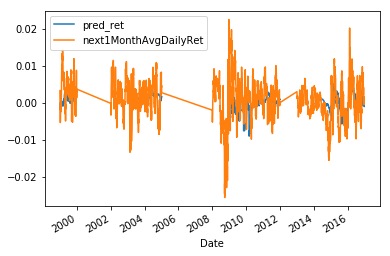

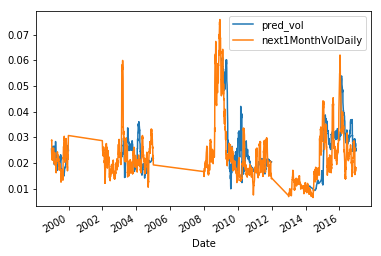

In [146]:
Prediction_1M_lasso = prediction(response_data.next1MonthAvgDailyRet,response_data.next1MonthVolDaily,m_lasso,m_lasso,1,2,1)

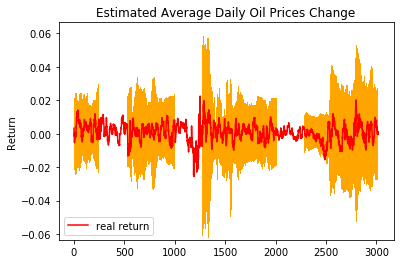

In [147]:
plot_to_use(Prediction_1M_lasso,1)

1998-12-31 00:00:00
mse of training: 5.955732203048692e-06
predicted value: -10193448549.409843
1999-01-04 00:00:00
mse of training: 6.211854642873044e-06
predicted value: 84181219456.50478
1999-01-05 00:00:00
mse of training: 6.105472556229801e-06
predicted value: 45517012552.47504
1999-01-06 00:00:00
mse of training: 6.45682717339456e-06
predicted value: -120697025147.41032
1999-01-07 00:00:00
mse of training: 6.300278640424115e-06
predicted value: -65393181291.12773
1999-01-08 00:00:00
mse of training: 6.344471359689266e-06
predicted value: 6468418194.570942
1999-01-11 00:00:00
mse of training: 6.449131863286605e-06
predicted value: 50660264359.793396
1999-01-12 00:00:00
mse of training: 6.4123170075970786e-06
predicted value: 23179171908.78121
1999-01-13 00:00:00
mse of training: 6.450219304458913e-06
predicted value: -4834027178.632963
1999-01-14 00:00:00
mse of training: 6.721116455031032e-06
predicted value: 13470271944.255356
1999-01-15 00:00:00
mse of training: 6.4676011084388

mse of training: 7.56194959436238e-06
predicted value: -0.0031557083129882812
1999-05-10 00:00:00
mse of training: 7.578706863424144e-06
predicted value: -0.0036783218383789062
1999-05-11 00:00:00
mse of training: 7.502281846654915e-06
predicted value: -0.001359701156616211
1999-05-12 00:00:00
mse of training: 7.511697281221425e-06
predicted value: 0.001251220703125
1999-05-13 00:00:00
mse of training: 7.5745883459035875e-06
predicted value: 8.666515350341797e-05
1999-05-14 00:00:00
mse of training: 7.634757527447077e-06
predicted value: -0.00043642520904541016
1999-05-17 00:00:00
mse of training: 7.683540382007708e-06
predicted value: 0.0008969306945800781
1999-05-18 00:00:00
mse of training: 7.705400997141833e-06
predicted value: 0.0029506683349609375
1999-05-19 00:00:00
mse of training: 7.705050672571448e-06
predicted value: 0.0037174224853515625
1999-05-20 00:00:00
mse of training: 7.710307558784027e-06
predicted value: 0.0035715103149414062
1999-05-21 00:00:00
mse of training: 7.7

mse of training: 7.926373487144808e-06
predicted value: -0.00360870361328125
1999-09-29 00:00:00
mse of training: 7.963728437703575e-06
predicted value: -0.003276824951171875
1999-09-30 00:00:00
mse of training: 8.261384926760652e-06
predicted value: -0.0001068115234375
1999-10-01 00:00:00
mse of training: 8.541590657155983e-06
predicted value: -0.00113677978515625
1999-10-04 00:00:00
mse of training: 8.599208693998625e-06
predicted value: 0.0008640289306640625
1999-10-05 00:00:00
mse of training: 8.53791447349066e-06
predicted value: 0.0018157958984375
1999-10-06 00:00:00
mse of training: 8.481101357348744e-06
predicted value: 0.002545773983001709
1999-10-07 00:00:00
mse of training: 8.549144055921072e-06
predicted value: 0.00296783447265625
1999-10-08 00:00:00
mse of training: 8.556952963233555e-06
predicted value: 0.0017151832580566406
1999-10-11 00:00:00
mse of training: 8.612825141927662e-06
predicted value: -0.012653350830078125
1999-10-12 00:00:00
mse of training: 8.597719123756

mse of training: 2.5000265534949314e-06
predicted value: -0.001657247543334961
2003-02-04 00:00:00
mse of training: 2.5000265534949314e-06
predicted value: -0.003609180450439453
2003-02-05 00:00:00
mse of training: 2.5259534885624255e-06
predicted value: -0.002369105815887451
2003-02-06 00:00:00
mse of training: 2.568009690778397e-06
predicted value: -0.0015382170677185059
2003-02-07 00:00:00
mse of training: 2.617876841027838e-06
predicted value: 0.0009631812572479248
2003-02-10 00:00:00
mse of training: 2.786071584994104e-06
predicted value: 0.0036597847938537598
2003-02-11 00:00:00
mse of training: 2.786071584994104e-06
predicted value: 0.0007850527763366699
2003-02-12 00:00:00
mse of training: 2.947308719020773e-06
predicted value: 0.0007799267768859863
2003-02-13 00:00:00
mse of training: 3.0285136009841855e-06
predicted value: -0.0009131431579589844
2003-02-14 00:00:00
mse of training: 3.0750040518791852e-06
predicted value: 0.00017452239990234375
2003-02-18 00:00:00
mse of train

mse of training: 6.020417100016119e-06
predicted value: 0.01280975341796875
2003-06-26 00:00:00
mse of training: 5.908673331862419e-06
predicted value: 0.01623678207397461
2003-06-27 00:00:00
mse of training: 5.813094082403745e-06
predicted value: 0.01033782958984375
2003-06-30 00:00:00
mse of training: 5.810846406333783e-06
predicted value: -0.00323486328125
2003-07-01 00:00:00
mse of training: 5.815673075959111e-06
predicted value: -0.0031709671020507812
2003-07-02 00:00:00
mse of training: 5.8187570107755135e-06
predicted value: -0.0018720626831054688
2003-07-03 00:00:00
mse of training: 5.820794033425774e-06
predicted value: -0.0014402493834495544
2003-07-07 00:00:00
mse of training: 5.814056942371199e-06
predicted value: -0.0010766386985778809
2003-07-08 00:00:00
mse of training: 5.814056942371199e-06
predicted value: -0.0026125311851501465
2003-07-09 00:00:00
mse of training: 5.911420759988534e-06
predicted value: -0.00177001953125
2003-07-10 00:00:00
mse of training: 5.805368437

mse of training: 5.9053233798837275e-06
predicted value: 0.013865947723388672
2003-10-29 00:00:00
mse of training: 6.150653923141563e-06
predicted value: 0.01422882080078125
2003-10-30 00:00:00
mse of training: 6.443615115492347e-06
predicted value: 0.0120697021484375
2003-10-31 00:00:00
mse of training: 6.606007553162197e-06
predicted value: 0.009519577026367188
2003-11-03 00:00:00
mse of training: 6.637098482368306e-06
predicted value: 0.008623123168945312
2003-11-04 00:00:00
mse of training: 6.597051265974756e-06
predicted value: 0.008522987365722656
2003-11-05 00:00:00
mse of training: 6.505961707011029e-06
predicted value: 0.006100654602050781
2003-11-06 00:00:00
mse of training: 6.442758261865107e-06
predicted value: 0.0063018798828125
2003-11-07 00:00:00
mse of training: 6.35600513135084e-06
predicted value: 0.00583648681640625
2003-11-10 00:00:00
mse of training: 6.2981671112900596e-06
predicted value: 0.006200313568115234
2003-11-11 00:00:00
mse of training: 6.2981671112900596

mse of training: 7.246329472522427e-06
predicted value: -0.008231937885284424
2004-03-10 00:00:00
mse of training: 7.3090183596324795e-06
predicted value: -0.0083998441696167
2004-03-11 00:00:00
mse of training: 7.335634737594014e-06
predicted value: -0.009569168090820312
2004-03-12 00:00:00
mse of training: 7.365558793494699e-06
predicted value: -0.009698867797851562
2004-03-15 00:00:00
mse of training: 7.018270033471673e-06
predicted value: -0.013044357299804688
2004-03-16 00:00:00
mse of training: 7.02796292962046e-06
predicted value: -0.012659460306167603
2004-03-17 00:00:00
mse of training: 7.029425408489996e-06
predicted value: -0.014074325561523438
2004-03-18 00:00:00
mse of training: 7.012227941217451e-06
predicted value: -0.012070059776306152
2004-03-19 00:00:00
mse of training: 6.976306941490223e-06
predicted value: -0.01522207260131836
2004-03-22 00:00:00
mse of training: 6.985577437124378e-06
predicted value: -0.01442718505859375
2004-03-23 00:00:00
mse of training: 6.94318

mse of training: 5.258369891683947e-06
predicted value: -0.00433349609375
2004-07-22 00:00:00
mse of training: 5.105661002874386e-06
predicted value: -0.00439453125
2004-07-23 00:00:00
mse of training: 4.925629074401013e-06
predicted value: -0.0036563873291015625
2004-07-26 00:00:00
mse of training: 4.775271385564413e-06
predicted value: -0.0028839111328125
2004-07-27 00:00:00
mse of training: 4.640863404034896e-06
predicted value: -0.0035400390625
2004-07-28 00:00:00
mse of training: 4.516194689678626e-06
predicted value: -0.005005836486816406
2004-07-29 00:00:00
mse of training: 4.371843517211414e-06
predicted value: -0.004573822021484375
2004-07-30 00:00:00
mse of training: 4.2033782416204995e-06
predicted value: -0.002838134765625
2004-08-02 00:00:00
mse of training: 3.89905546223303e-06
predicted value: -0.0001068115234375
2004-08-03 00:00:00
mse of training: 3.89905546223303e-06
predicted value: -0.001125335693359375
2004-08-04 00:00:00
mse of training: 3.909240158509609e-06
pred

mse of training: 2.826271588038367e-06
predicted value: 0.008072376251220703
2004-11-23 00:00:00
mse of training: 2.8248762367799374e-06
predicted value: 0.0078582763671875
2004-11-24 00:00:00
mse of training: 2.8140343040431496e-06
predicted value: 0.007357597351074219
2004-11-29 00:00:00
mse of training: 2.8421583833289143e-06
predicted value: 0.004399299621582031
2004-11-30 00:00:00
mse of training: 2.8436918221307024e-06
predicted value: 0.0051465630531311035
2004-12-01 00:00:00
mse of training: 3.0260638836530024e-06
predicted value: 0.009100914001464844
2004-12-02 00:00:00
mse of training: 3.277268527285365e-06
predicted value: 0.0118560791015625
2004-12-03 00:00:00
mse of training: 3.5060896447860723e-06
predicted value: 0.011871099472045898
2004-12-06 00:00:00
mse of training: 3.8051714999877625e-06
predicted value: 0.009490966796875
2004-12-07 00:00:00
mse of training: 3.798502340871513e-06
predicted value: 0.011431694030761719
2004-12-08 00:00:00
mse of training: 3.8143495511

mse of training: 1.1058707677514303e-05
predicted value: 0.014832943677902222
2009-02-13 00:00:00
mse of training: 1.1018413327253747e-05
predicted value: 0.01575183868408203
2009-02-17 00:00:00
mse of training: 1.1019766920856794e-05
predicted value: 0.013201236724853516
2009-02-18 00:00:00
mse of training: 1.1019766920856794e-05
predicted value: 0.015661001205444336
2009-02-19 00:00:00
mse of training: 1.1051428178245443e-05
predicted value: 0.017189741134643555
2009-02-20 00:00:00
mse of training: 1.1009965774287705e-05
predicted value: 0.009256422519683838
2009-02-23 00:00:00
mse of training: 1.1068057118627976e-05
predicted value: 0.012389451265335083
2009-02-24 00:00:00
mse of training: 1.1068057118627976e-05
predicted value: 0.015649110078811646
2009-02-25 00:00:00
mse of training: 1.1026865282030449e-05
predicted value: 0.01385498046875
2009-02-26 00:00:00
mse of training: 1.0994842225889587e-05
predicted value: 0.015574932098388672
2009-02-27 00:00:00
mse of training: 1.095507

mse of training: 1.2567409783432185e-05
predicted value: 0.00736236572265625
2009-07-02 00:00:00
mse of training: 1.267380055866793e-05
predicted value: 0.007801055908203125
2009-07-06 00:00:00
mse of training: 1.3034422676209284e-05
predicted value: 0.011832714080810547
2009-07-07 00:00:00
mse of training: 1.3034422676209284e-05
predicted value: 0.012729167938232422
2009-07-08 00:00:00
mse of training: 1.3351805579131581e-05
predicted value: 0.01079559326171875
2009-07-09 00:00:00
mse of training: 1.3723121438891043e-05
predicted value: 0.010852813720703125
2009-07-10 00:00:00
mse of training: 1.4033947149237127e-05
predicted value: 0.007846832275390625
2009-07-13 00:00:00
mse of training: 1.4510887510493498e-05
predicted value: 0.008197784423828125
2009-07-14 00:00:00
mse of training: 1.4528354138962322e-05
predicted value: 0.00783538818359375
2009-07-15 00:00:00
mse of training: 1.4589158912156822e-05
predicted value: 0.007038116455078125
2009-07-16 00:00:00
mse of training: 1.45981

mse of training: 1.3930045711335528e-05
predicted value: -0.003437042236328125
2009-12-04 00:00:00
mse of training: 1.390959328697472e-05
predicted value: -0.0026235580444335938
2009-12-07 00:00:00
mse of training: 1.3870758128509912e-05
predicted value: -0.0011615753173828125
2009-12-08 00:00:00
mse of training: 1.3885812406686332e-05
predicted value: -0.0006256103515625
2009-12-09 00:00:00
mse of training: 1.385529438245861e-05
predicted value: 0.0007390975952148438
2009-12-10 00:00:00
mse of training: 1.3817372858840826e-05
predicted value: 0.001628875732421875
2009-12-11 00:00:00
mse of training: 1.392496343768236e-05
predicted value: 0.0017242431640625
2009-12-14 00:00:00
mse of training: 1.3889295355994215e-05
predicted value: 0.0005340576171875
2009-12-15 00:00:00
mse of training: 1.3839345311783117e-05
predicted value: 0.0005035400390625
2009-12-16 00:00:00
mse of training: 1.3719442719497588e-05
predicted value: 0.0001068115234375
2009-12-17 00:00:00
mse of training: 1.3573183

mse of training: 8.24651552408242e-06
predicted value: 0.027743816375732422
2010-04-19 00:00:00
mse of training: 8.064192277228876e-06
predicted value: 0.030588626861572266
2010-04-20 00:00:00
mse of training: 8.082513760878053e-06
predicted value: 0.029703140258789062
2010-04-21 00:00:00
mse of training: 8.083721649265902e-06
predicted value: 0.028379440307617188
2010-04-22 00:00:00
mse of training: 8.086964740709735e-06
predicted value: 0.028322219848632812
2010-04-23 00:00:00
mse of training: 8.074519502616502e-06
predicted value: 0.024932861328125
2010-04-26 00:00:00
mse of training: 8.0459564151374e-06
predicted value: 0.0247039794921875
2010-04-27 00:00:00
mse of training: 7.808236574563037e-06
predicted value: 0.0235137939453125
2010-04-28 00:00:00
mse of training: 7.590941559551782e-06
predicted value: 0.020679473876953125
2010-04-29 00:00:00
mse of training: 7.3407151360096466e-06
predicted value: 0.015735626220703125
2010-04-30 00:00:00
mse of training: 7.036462326143511e-06


mse of training: 3.6008566213537826e-06
predicted value: 0.005014896392822266
2010-08-20 00:00:00
mse of training: 3.607030426809155e-06
predicted value: 0.006490588188171387
2010-08-23 00:00:00
mse of training: 3.6065513775919685e-06
predicted value: 0.006208062171936035
2010-08-24 00:00:00
mse of training: 3.6129005948395384e-06
predicted value: 0.007115364074707031
2010-08-25 00:00:00
mse of training: 3.604462830337984e-06
predicted value: 0.0060100555419921875
2010-08-26 00:00:00
mse of training: 3.5860333869653345e-06
predicted value: 0.003570556640625
2010-08-27 00:00:00
mse of training: 3.5861112287428656e-06
predicted value: 0.00112152099609375
2010-08-30 00:00:00
mse of training: 3.586255072814637e-06
predicted value: 0.0007333755493164062
2010-08-31 00:00:00
mse of training: 3.5940813165494665e-06
predicted value: 0.002613067626953125
2010-09-01 00:00:00
mse of training: 3.5845815713723363e-06
predicted value: 0.001495361328125
2010-09-02 00:00:00
mse of training: 3.571234873

mse of training: 2.618196252112635e-06
predicted value: -2759931277.2853327
2011-01-03 00:00:00
mse of training: 2.6027741951194964e-06
predicted value: -3831170034.0707874
2011-01-04 00:00:00
mse of training: 2.605716110171778e-06
predicted value: -2676027437.1860065
2011-01-05 00:00:00
mse of training: 2.6067582667346315e-06
predicted value: 1255792420.8904557
2011-01-06 00:00:00
mse of training: 2.60498069828945e-06
predicted value: -2229004216.6564746
2011-01-07 00:00:00
mse of training: 2.594860866791465e-06
predicted value: 1402483796.451849
2011-01-10 00:00:00
mse of training: 2.589152016431181e-06
predicted value: -489105173.87739944
2011-01-11 00:00:00
mse of training: 2.596751907747145e-06
predicted value: 7670034291.895994
2011-01-12 00:00:00
mse of training: 2.5954199641968007e-06
predicted value: -34418519148.78273
2011-01-13 00:00:00
mse of training: 2.5760958283900255e-06
predicted value: -7113492623.608442
2011-01-14 00:00:00
mse of training: 2.5692107220391436e-06
pred

mse of training: 3.347724289246831e-06
predicted value: 0.005934715270996094
2011-05-10 00:00:00
mse of training: 3.3128108831956863e-06
predicted value: 0.00426483154296875
2011-05-11 00:00:00
mse of training: 3.2758778096486978e-06
predicted value: 0.0039816247299313545
2011-05-12 00:00:00
mse of training: 3.1877289653616944e-06
predicted value: 0.004721164703369141
2011-05-13 00:00:00
mse of training: 3.182459882872136e-06
predicted value: 0.0010546445846557617
2011-05-16 00:00:00
mse of training: 3.1445113189897426e-06
predicted value: -0.00016169250011444092
2011-05-17 00:00:00
mse of training: 3.1257298734304056e-06
predicted value: 0.0010099411010742188
2011-05-18 00:00:00
mse of training: 3.1165737544323907e-06
predicted value: 0.00023555755615234375
2011-05-19 00:00:00
mse of training: 3.1181628462355185e-06
predicted value: -0.000498652458190918
2011-05-20 00:00:00
mse of training: 3.122262311473325e-06
predicted value: -0.0027422308921813965
2011-05-23 00:00:00
mse of traini

mse of training: 3.2835193500295645e-06
predicted value: -0.00079345703125
2011-09-15 00:00:00
mse of training: 3.017579094602676e-06
predicted value: -0.0009067058563232422
2011-09-16 00:00:00
mse of training: 2.9348195087741406e-06
predicted value: -0.0017008781433105469
2011-09-19 00:00:00
mse of training: 2.93480083018556e-06
predicted value: -0.00156402587890625
2011-09-20 00:00:00
mse of training: 2.942180781282479e-06
predicted value: -0.0017981529235839844
2011-09-21 00:00:00
mse of training: 2.9791392743493286e-06
predicted value: -0.0019092559814453125
2011-09-22 00:00:00
mse of training: 3.0269764075380523e-06
predicted value: 4.839897155761719e-05
2011-09-23 00:00:00
mse of training: 3.0403068111397725e-06
predicted value: 0.00011205673217773438
2011-09-26 00:00:00
mse of training: 3.046871559130752e-06
predicted value: 0.00044858455657958984
2011-09-27 00:00:00
mse of training: 3.0537783800619853e-06
predicted value: -0.0019989013671875
2011-09-28 00:00:00
mse of training:

2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-23 00:00:00
2013-09-24 00:00:00
2013-09-25 00:00:00
2013-09-26 00:00:00
2013-09-27 00:00:00
2013-09-30 00:00:00
2013-10-01 00:00:00
2013-10-02 00:00:00
2013-10-03 00:00:00
2013-10-04 00:00:00
2013-10-07 00:00:00
2013-10-08 00:00:00
2013-10-09 00:00:00
2013-10-10 00:00:00
2013-10-11 00:00:00
2013-10-14 00:00:00
2013-10-15 00:00:00
2013-10-16 00:00:00
2013-10-17 00:00:00


mse of training: 7.917773583192716e-07
predicted value: 0.0013632774353027344
2014-05-20 00:00:00
mse of training: 7.917773583192716e-07
predicted value: 0.001170516014099121
2014-05-21 00:00:00
mse of training: 8.070173419602561e-07
predicted value: 0.0010809898376464844
2014-05-22 00:00:00
mse of training: 8.28590609475031e-07
predicted value: 0.0014454126358032227
2014-05-23 00:00:00
mse of training: 8.421269276200098e-07
predicted value: 0.00038123130798339844
2014-05-27 00:00:00
mse of training: 8.750735834557543e-07
predicted value: 0.0013332366943359375
2014-05-28 00:00:00
mse of training: 8.844758946701469e-07
predicted value: 0.0020761489868164062
2014-05-29 00:00:00
mse of training: 8.896904163115005e-07
predicted value: 0.0014662742614746094
2014-05-30 00:00:00
mse of training: 8.883091787066488e-07
predicted value: 0.00200653076171875
2014-06-02 00:00:00
mse of training: 8.820150023229751e-07
predicted value: 0.002238282235339284
2014-06-03 00:00:00
mse of training: 8.82015

mse of training: 6.315401157484851e-07
predicted value: 0.0024695396423339844
2014-10-01 00:00:00
mse of training: 6.321564580632671e-07
predicted value: 0.028072834014892578
2014-10-02 00:00:00
mse of training: 6.412491890297919e-07
predicted value: 0.02701568603515625
2014-10-03 00:00:00
mse of training: 6.400122895985708e-07
predicted value: 0.0044138431549072266
2014-10-06 00:00:00
mse of training: 6.362738931733456e-07
predicted value: 0.003871917724609375
2014-10-07 00:00:00
mse of training: 6.371371706961237e-07
predicted value: 0.004717826843261719
2014-10-08 00:00:00
mse of training: 6.429044368116652e-07
predicted value: 0.0049724578857421875
2014-10-09 00:00:00
mse of training: 6.478162275905868e-07
predicted value: 0.005461692810058594
2014-10-10 00:00:00
mse of training: 6.528432419056904e-07
predicted value: 0.00516510009765625
2014-10-13 00:00:00
mse of training: 6.597300958213356e-07
predicted value: 0.00409698486328125
2014-10-14 00:00:00
mse of training: 6.59134239300

mse of training: 2.492454983882287e-06
predicted value: -0.021455764770507812
2015-02-17 00:00:00
mse of training: 2.6688701527030714e-06
predicted value: -0.018060684204101562
2015-02-18 00:00:00
mse of training: 2.6763141180691084e-06
predicted value: -0.018633663654327393
2015-02-19 00:00:00
mse of training: 2.713566128917927e-06
predicted value: -0.016845703125
2015-02-20 00:00:00
mse of training: 2.7087069215555427e-06
predicted value: -0.015066146850585938
2015-02-23 00:00:00
mse of training: 2.79306928951001e-06
predicted value: -0.013224244117736816
2015-02-24 00:00:00
mse of training: 2.807734492055383e-06
predicted value: -0.013172149658203125
2015-02-25 00:00:00
mse of training: 2.7986817424336123e-06
predicted value: -0.013030290603637695
2015-02-26 00:00:00
mse of training: 2.811455502898803e-06
predicted value: -0.014556884765625
2015-02-27 00:00:00
mse of training: 2.8733934732926116e-06
predicted value: -0.012718915939331055
2015-03-02 00:00:00
mse of training: 2.906745

mse of training: 2.731048045115835e-06
predicted value: 0.002103090286254883
2015-06-22 00:00:00
mse of training: 2.731913224965143e-06
predicted value: 0.0015985965728759766
2015-06-23 00:00:00
mse of training: 2.735746276180372e-06
predicted value: 0.0007796287536621094
2015-06-24 00:00:00
mse of training: 2.797076309625556e-06
predicted value: 0.0010738372802734375
2015-06-25 00:00:00
mse of training: 2.7982053758057505e-06
predicted value: 0.0011179447174072266
2015-06-26 00:00:00
mse of training: 2.7978939718760635e-06
predicted value: -0.0005153417587280273
2015-06-29 00:00:00
mse of training: 2.818659212181167e-06
predicted value: 0.06266450881958008
2015-06-30 00:00:00
mse of training: 2.826309038480614e-06
predicted value: -0.004746437072753906
2015-07-01 00:00:00
mse of training: 2.8632208303051867e-06
predicted value: -0.006285667419433594
2015-07-02 00:00:00
mse of training: 2.8929135389711513e-06
predicted value: -0.007452130317687988
2015-07-03 00:00:00
mse of training: 2

mse of training: 4.9506475219087406e-06
predicted value: 0.007350921630859375
2015-10-29 00:00:00
mse of training: 4.9405214179211285e-06
predicted value: 0.004795551300048828
2015-10-30 00:00:00
mse of training: 4.93959871454381e-06
predicted value: 0.002088785171508789
2015-11-02 00:00:00
mse of training: 5.007245407190467e-06
predicted value: 3.814697265625e-06
2015-11-03 00:00:00
mse of training: 4.995536956543292e-06
predicted value: 4.470348358154297e-05
2015-11-04 00:00:00
mse of training: 5.068632216080058e-06
predicted value: -0.0009270580519713766
2015-11-05 00:00:00
mse of training: 5.225341862171926e-06
predicted value: -0.0013713836669921875
2015-11-06 00:00:00
mse of training: 5.257679818108083e-06
predicted value: -0.0014346837997436523
2015-11-09 00:00:00
mse of training: 5.401220619594751e-06
predicted value: -0.0009441375732421875
2015-11-10 00:00:00
mse of training: 5.401220619594751e-06
predicted value: -5.7220458984375e-06
2015-11-11 00:00:00
mse of training: 5.431

mse of training: 6.823293688157737e-06
predicted value: -0.010494232177734375
2016-03-22 00:00:00
mse of training: 6.836996669863173e-06
predicted value: -0.0113677978515625
2016-03-23 00:00:00
mse of training: 6.835450607926904e-06
predicted value: -0.01146697998046875
2016-03-24 00:00:00
mse of training: 6.837334648405006e-06
predicted value: -0.010968208312988281
2016-03-28 00:00:00
mse of training: 6.824588993090165e-06
predicted value: -0.010786056518554688
2016-03-29 00:00:00
mse of training: 6.795877561213965e-06
predicted value: -0.010251045227050781
2016-03-30 00:00:00
mse of training: 6.907472848320689e-06
predicted value: -0.005603790283203125
2016-03-31 00:00:00
mse of training: 6.905861290706798e-06
predicted value: 0.00726318359375
2016-04-01 00:00:00
mse of training: 6.906865559911498e-06
predicted value: 0.01010894775390625
2016-04-04 00:00:00
mse of training: 6.868480844105935e-06
predicted value: 0.01090240478515625
2016-04-05 00:00:00
mse of training: 6.8564534900458

mse of training: 6.5368420712523765e-06
predicted value: -0.00714111328125
2016-08-03 00:00:00
mse of training: 6.477642001063743e-06
predicted value: -0.008406639099121094
2016-08-04 00:00:00
mse of training: 6.534678493973536e-06
predicted value: -0.007282257080078125
2016-08-05 00:00:00
mse of training: 6.5099522385860546e-06
predicted value: -0.00592803955078125
2016-08-08 00:00:00
mse of training: 6.56883021888805e-06
predicted value: -0.003964126110076904
2016-08-09 00:00:00
mse of training: 6.586305887322941e-06
predicted value: -0.003802776336669922
2016-08-10 00:00:00
mse of training: 6.653304331930055e-06
predicted value: -0.0015058517456054688
2016-08-11 00:00:00
mse of training: 6.6767995850016016e-06
predicted value: -0.0014600753784179688
2016-08-12 00:00:00
mse of training: 6.6973350154390145e-06
predicted value: -0.004778146743774414
2016-08-15 00:00:00
mse of training: 6.674191210067566e-06
predicted value: -0.004425048828125
2016-08-16 00:00:00
mse of training: 6.6846

mse of training: 7.953982353662301e-06
predicted value: -0.004779815673828125
2016-12-14 00:00:00
mse of training: 7.906921441026067e-06
predicted value: -0.0022735595703125
2016-12-15 00:00:00
mse of training: 7.883287635945432e-06
predicted value: -0.001277923583984375
2016-12-16 00:00:00
mse of training: 7.82767081136822e-06
predicted value: -0.0011262893676757812
2016-12-19 00:00:00
mse of training: 7.55857567948468e-06
predicted value: -0.000530242919921875
2016-12-20 00:00:00
mse of training: 7.573915342811282e-06
predicted value: -0.000264730304479599
2016-12-21 00:00:00
mse of training: 7.616023825619388e-06
predicted value: -5.14984130859375e-05
2016-12-22 00:00:00
mse of training: 7.657069276777841e-06
predicted value: -0.0001678466796875
2016-12-23 00:00:00
mse of training: 7.720282882056976e-06
predicted value: 0.0008258819580078125
1998-12-31 00:00:00
mse of training: 1.5749527246667388e-05
predicted value: -13962432921.981579
1999-01-04 00:00:00
mse of training: 1.5945008

mse of training: 1.752190127112402e-05
predicted value: -0.008047103881835938
1999-05-04 00:00:00
mse of training: 1.7513990927689862e-05
predicted value: -0.007355600595474243
1999-05-05 00:00:00
mse of training: 1.7821833267106876e-05
predicted value: -0.0043582916259765625
1999-05-06 00:00:00
mse of training: 1.8017928111788832e-05
predicted value: -0.0018930435180664062
1999-05-07 00:00:00
mse of training: 1.8106254323247323e-05
predicted value: 0.0002593994140625
1999-05-10 00:00:00
mse of training: 1.844194822256281e-05
predicted value: 0.004909515380859375
1999-05-11 00:00:00
mse of training: 1.849276804699737e-05
predicted value: 0.0069391727447509766
1999-05-12 00:00:00
mse of training: 1.879086563511133e-05
predicted value: 0.006259918212890625
1999-05-13 00:00:00
mse of training: 1.9091953819976304e-05
predicted value: 0.0050640106201171875
1999-05-14 00:00:00
mse of training: 1.923379430728052e-05
predicted value: 0.009632229804992676
1999-05-17 00:00:00
mse of training: 1.

mse of training: 1.0294010495075088e-05
predicted value: 0.021793365478515625
1999-09-17 00:00:00
mse of training: 1.0252960295682834e-05
predicted value: 0.018402099609375
1999-09-20 00:00:00
mse of training: 1.021376679210204e-05
predicted value: 0.018369674682617188
1999-09-21 00:00:00
mse of training: 1.024862501645844e-05
predicted value: 0.01825714111328125
1999-09-22 00:00:00
mse of training: 1.026411047704026e-05
predicted value: 0.0191650390625
1999-09-23 00:00:00
mse of training: 1.0295234891239853e-05
predicted value: 0.0178680419921875
1999-09-24 00:00:00
mse of training: 1.0371224490309657e-05
predicted value: 0.018707275390625
1999-09-27 00:00:00
mse of training: 1.048466060467174e-05
predicted value: 0.019872665405273438
1999-09-28 00:00:00
mse of training: 1.0518849534109026e-05
predicted value: 0.0199737548828125
1999-09-29 00:00:00
mse of training: 1.06749340572265e-05
predicted value: 0.019853591918945312
1999-09-30 00:00:00
mse of training: 1.105339725993586e-05
pre

2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-10 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-16 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2002-09-20 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00


mse of training: 9.853128795222075e-06
predicted value: 0.057903289794921875
2003-05-28 00:00:00
mse of training: 1.0400889094062914e-05
predicted value: 0.05242156982421875
2003-05-29 00:00:00
mse of training: 1.0638739165798736e-05
predicted value: 0.0505828857421875
2003-05-30 00:00:00
mse of training: 1.063780278887255e-05
predicted value: 0.04889678955078125
2003-06-02 00:00:00
mse of training: 1.0581398597924152e-05
predicted value: 0.04923248291015625
2003-06-03 00:00:00
mse of training: 1.0581398597924152e-05
predicted value: 0.04778480529785156
2003-06-04 00:00:00
mse of training: 1.0551607135741522e-05
predicted value: 0.048590898513793945
2003-06-05 00:00:00
mse of training: 1.0521356516702787e-05
predicted value: 0.04883909225463867
2003-06-06 00:00:00
mse of training: 1.0496253434535767e-05
predicted value: 0.0516510009765625
2003-06-09 00:00:00
mse of training: 1.0493216162418117e-05
predicted value: 0.05026531219482422
2003-06-10 00:00:00
mse of training: 1.0493216162418

mse of training: 1.054455024781625e-05
predicted value: 0.023474693298339844
2003-10-09 00:00:00
mse of training: 1.0505557821708243e-05
predicted value: 0.0261077880859375
2003-10-10 00:00:00
mse of training: 1.0470029475372897e-05
predicted value: 0.024209022521972656
2003-10-13 00:00:00
mse of training: 1.0376843001261213e-05
predicted value: 0.022245407104492188
2003-10-14 00:00:00
mse of training: 1.0202868919741767e-05
predicted value: 0.02142333984375
2003-10-15 00:00:00
mse of training: 9.936809784560402e-06
predicted value: 0.02191162109375
2003-10-16 00:00:00
mse of training: 9.74085132910807e-06
predicted value: 0.020376205444335938
2003-10-17 00:00:00
mse of training: 9.606498415714234e-06
predicted value: 0.0189361572265625
2003-10-20 00:00:00
mse of training: 9.71795122082327e-06
predicted value: 0.018723487854003906
2003-10-21 00:00:00
mse of training: 9.740406783218153e-06
predicted value: 0.019513577222824097
2003-10-22 00:00:00
mse of training: 9.750717902962658e-06
p

mse of training: 1.4546302347653335e-05
predicted value: 0.03673982620239258
2004-02-23 00:00:00
mse of training: 1.540734213153299e-05
predicted value: 0.03364741802215576
2004-02-24 00:00:00
mse of training: 1.5349392295353782e-05
predicted value: 0.03544807434082031
2004-02-25 00:00:00
mse of training: 1.5477012184069804e-05
predicted value: 0.03575706481933594
2004-02-26 00:00:00
mse of training: 1.5849083451167563e-05
predicted value: 0.0301513671875
2004-02-27 00:00:00
mse of training: 1.557745091452114e-05
predicted value: 0.03545701503753662
2004-03-01 00:00:00
mse of training: 1.5724032856092833e-05
predicted value: 0.02764892578125
2004-03-02 00:00:00
mse of training: 1.5758651834682e-05
predicted value: 0.0268096923828125
2004-03-03 00:00:00
mse of training: 1.5796984314808466e-05
predicted value: 0.02600860595703125
2004-03-04 00:00:00
mse of training: 1.5804210670107088e-05
predicted value: 0.027081012725830078
2004-03-05 00:00:00
mse of training: 1.584795330074635e-05
pre

mse of training: 2.108845700441152e-05
predicted value: 0.0286102294921875
2004-07-12 00:00:00
mse of training: 2.1212161291730988e-05
predicted value: 0.02938079833984375
2004-07-13 00:00:00
mse of training: 2.1255495933050027e-05
predicted value: 0.029155731201171875
2004-07-14 00:00:00
mse of training: 2.1072785586544873e-05
predicted value: 0.02838134765625
2004-07-15 00:00:00
mse of training: 2.0665898614448135e-05
predicted value: 0.02684783935546875
2004-07-16 00:00:00
mse of training: 2.0092245870675904e-05
predicted value: 0.024845879524946213
2004-07-19 00:00:00
mse of training: 1.941656970038128e-05
predicted value: 0.02280426025390625
2004-07-20 00:00:00
mse of training: 1.8817219846338362e-05
predicted value: 0.022823333740234375
2004-07-21 00:00:00
mse of training: 1.801871365176693e-05
predicted value: 0.023563385009765625
2004-07-22 00:00:00
mse of training: 1.707580190683069e-05
predicted value: 0.0213623046875
2004-07-23 00:00:00
mse of training: 1.594060675977136e-05

mse of training: 3.314472557837244e-06
predicted value: 0.012668907642364502
2004-11-22 00:00:00
mse of training: 3.353244584395917e-06
predicted value: 0.013058662414550781
2004-11-23 00:00:00
mse of training: 3.363164325191854e-06
predicted value: 0.0133514404296875
2004-11-24 00:00:00
mse of training: 3.3805860797291326e-06
predicted value: 0.014010429382324219
2004-11-29 00:00:00
mse of training: 3.4458588822918876e-06
predicted value: 0.017391204833984375
2004-11-30 00:00:00
mse of training: 3.454955173069056e-06
predicted value: 0.017206192016601562
2004-12-01 00:00:00
mse of training: 3.605032172737585e-06
predicted value: 0.017023563385009766
2004-12-02 00:00:00
mse of training: 3.7568352920617113e-06
predicted value: 0.015239715576171875
2004-12-03 00:00:00
mse of training: 3.876741194303216e-06
predicted value: 0.01620960235595703
2004-12-06 00:00:00
mse of training: 4.040753269354194e-06
predicted value: 0.01801013946533203
2004-12-07 00:00:00
mse of training: 4.052018444608

mse of training: 2.159151235066891e-05
predicted value: 0.047358036041259766
2009-02-13 00:00:00
mse of training: 2.1510670678610985e-05
predicted value: 0.04938364028930664
2009-02-17 00:00:00
mse of training: 2.1633329235171994e-05
predicted value: 0.05345982313156128
2009-02-18 00:00:00
mse of training: 2.1633329235171994e-05
predicted value: 0.05276787281036377
2009-02-19 00:00:00
mse of training: 2.1760965040353288e-05
predicted value: 0.05125761032104492
2009-02-20 00:00:00
mse of training: 2.1749789126784562e-05
predicted value: 0.042984962463378906
2009-02-23 00:00:00
mse of training: 2.16090067450035e-05
predicted value: 0.034919798374176025
2009-02-24 00:00:00
mse of training: 2.16090067450035e-05
predicted value: 0.03577381372451782
2009-02-25 00:00:00
mse of training: 2.1607418321292433e-05
predicted value: 0.03691379725933075
2009-02-26 00:00:00
mse of training: 2.159099382145679e-05
predicted value: 0.04214954376220703
2009-02-27 00:00:00
mse of training: 2.16353409191489

mse of training: 2.625308861177208e-05
predicted value: 0.01678466796875
2009-06-22 00:00:00
mse of training: 2.606686160782285e-05
predicted value: 0.01715087890625
2009-06-23 00:00:00
mse of training: 2.5883752253003307e-05
predicted value: 0.016326904296875
2009-06-24 00:00:00
mse of training: 2.5806061634571368e-05
predicted value: 0.016502857208251953
2009-06-25 00:00:00
mse of training: 2.5624973208053385e-05
predicted value: 0.01885986328125
2009-06-26 00:00:00
mse of training: 2.538713451313418e-05
predicted value: 0.022624969482421875
2009-06-29 00:00:00
mse of training: 2.5329996917862763e-05
predicted value: 0.0204010009765625
2009-06-30 00:00:00
mse of training: 2.538923558338668e-05
predicted value: 0.002162933349609375
2009-07-01 00:00:00
mse of training: 2.540390548394745e-05
predicted value: 0.00402069091796875
2009-07-02 00:00:00
mse of training: 2.5590824035433616e-05
predicted value: 0.005077362060546875
2009-07-06 00:00:00
mse of training: 2.544276161848413e-05
pred

mse of training: 2.074666548470733e-05
predicted value: 0.03433990478515625
2009-10-28 00:00:00
mse of training: 2.0453579604808053e-05
predicted value: 0.03523540496826172
2009-10-29 00:00:00
mse of training: 1.9997755782099432e-05
predicted value: 0.033985793590545654
2009-10-30 00:00:00
mse of training: 1.9832973927002748e-05
predicted value: 0.036834716796875
2009-11-02 00:00:00
mse of training: 2.0228707331472806e-05
predicted value: 0.030694007873535156
2009-11-03 00:00:00
mse of training: 2.0162968080276198e-05
predicted value: 0.0319671630859375
2009-11-04 00:00:00
mse of training: 2.0306134885883867e-05
predicted value: 0.030122756958007812
2009-11-05 00:00:00
mse of training: 2.034106662781703e-05
predicted value: 0.029783248901367188
2009-11-06 00:00:00
mse of training: 2.0382115088000903e-05
predicted value: 0.028507232666015625
2009-11-09 00:00:00
mse of training: 2.0449294414535012e-05
predicted value: 0.027374267578125
2009-11-10 00:00:00
mse of training: 2.0449294414535

mse of training: 8.198994557976328e-06
predicted value: -0.13787460327148438
2010-04-06 00:00:00
mse of training: 8.208267192795916e-06
predicted value: -0.138092041015625
2010-04-07 00:00:00
mse of training: 8.234047400761931e-06
predicted value: -0.13504791259765625
2010-04-08 00:00:00
mse of training: 8.717699726475068e-06
predicted value: -0.1351318359375
2010-04-09 00:00:00
mse of training: 8.264571106893123e-06
predicted value: -0.1334686279296875
2010-04-12 00:00:00
mse of training: 8.234110126558742e-06
predicted value: -0.13318634033203125
2010-04-13 00:00:00
mse of training: 8.253644723661577e-06
predicted value: -0.13254451751708984
2010-04-14 00:00:00
mse of training: 8.251112714748909e-06
predicted value: -0.13248467445373535
2010-04-15 00:00:00
mse of training: 8.221053076995122e-06
predicted value: -0.13249588012695312
2010-04-16 00:00:00
mse of training: 8.222154080510134e-06
predicted value: -0.129241943359375
2010-04-19 00:00:00
mse of training: 8.19010167479877e-06
p

mse of training: 1.0202239775683886e-05
predicted value: 0.02323150634765625
2010-08-18 00:00:00
mse of training: 1.0161427471346277e-05
predicted value: 0.023088455200195312
2010-08-19 00:00:00
mse of training: 1.0035950972884442e-05
predicted value: 0.0245513916015625
2010-08-20 00:00:00
mse of training: 9.918250892338623e-06
predicted value: 0.021678924560546875
2010-08-23 00:00:00
mse of training: 9.92250747774316e-06
predicted value: 0.02129650115966797
2010-08-24 00:00:00
mse of training: 9.830408212202335e-06
predicted value: 0.021566390991210938
2010-08-25 00:00:00
mse of training: 9.706521739594208e-06
predicted value: 0.02248382568359375
2010-08-26 00:00:00
mse of training: 9.585627387460069e-06
predicted value: 0.02518463134765625
2010-08-27 00:00:00
mse of training: 9.570217309415291e-06
predicted value: 0.027185916900634766
2010-08-30 00:00:00
mse of training: 9.526033078628598e-06
predicted value: 0.02756500244140625
2010-08-31 00:00:00
mse of training: 9.49410712118801e-

mse of training: 6.54694868229313e-06
predicted value: -1404213027.4522204
2011-01-03 00:00:00
mse of training: 6.746660003101948e-06
predicted value: -5364702111.223222
2011-01-04 00:00:00
mse of training: 6.689596422279663e-06
predicted value: -7139733797.921457
2011-01-05 00:00:00
mse of training: 6.694518526322231e-06
predicted value: -4680765263.277318
2011-01-06 00:00:00
mse of training: 6.6365295169787455e-06
predicted value: -1229090195.8036246
2011-01-07 00:00:00
mse of training: 6.51304987496769e-06
predicted value: 7470179749.604065
2011-01-10 00:00:00
mse of training: 6.400252932800714e-06
predicted value: 34095087.20741099
2011-01-11 00:00:00
mse of training: 6.324717121138414e-06
predicted value: -64136301174.73256
2011-01-12 00:00:00
mse of training: 6.094846648246418e-06
predicted value: 97683257557.46574
2011-01-13 00:00:00
mse of training: 5.834913225643958e-06
predicted value: 16120556391.211353
2011-01-14 00:00:00
mse of training: 5.491527634586786e-06
predicted val

mse of training: 5.940210457134757e-06
predicted value: 0.021691441535949707
2011-05-20 00:00:00
mse of training: 5.953364335778803e-06
predicted value: 0.021549344062805176
2011-05-23 00:00:00
mse of training: 5.973875943695416e-06
predicted value: 0.022655189037322998
2011-05-24 00:00:00
mse of training: 5.986560808279538e-06
predicted value: 0.02391529083251953
2011-05-25 00:00:00
mse of training: 5.993317619273755e-06
predicted value: 0.02391958236694336
2011-05-26 00:00:00
mse of training: 5.988965608401276e-06
predicted value: 0.023111343383789062
2011-05-27 00:00:00
mse of training: 5.971350076733814e-06
predicted value: 0.023955345153808594
2011-05-31 00:00:00
mse of training: 5.969247336361928e-06
predicted value: 0.015860557556152344
2011-06-01 00:00:00
mse of training: 5.983479454771629e-06
predicted value: 0.014724910259246826
2011-06-02 00:00:00
mse of training: 5.998334546912177e-06
predicted value: 0.015697717666625977
2011-06-03 00:00:00
mse of training: 6.0115423814794

mse of training: 6.2756392352174975e-06
predicted value: 0.023080825805664062
2011-09-27 00:00:00
mse of training: 6.156691505128744e-06
predicted value: 0.02288818359375
2011-09-28 00:00:00
mse of training: 6.070335985933876e-06
predicted value: 0.021394729614257812
2011-09-29 00:00:00
mse of training: 5.963029729261354e-06
predicted value: 0.021505355834960938
2011-09-30 00:00:00
mse of training: 5.7413407304013205e-06
predicted value: -0.007504463195800781
2011-10-03 00:00:00
mse of training: 5.6010144032890535e-06
predicted value: -0.00799560546875
2011-10-04 00:00:00
mse of training: 6.076421907471303e-06
predicted value: -0.00823974609375
2011-10-05 00:00:00
mse of training: 5.964593669917356e-06
predicted value: -0.006622314453125
2011-10-06 00:00:00
mse of training: 5.146626456517802e-06
predicted value: -0.00750732421875
2011-10-07 00:00:00
mse of training: 4.632157900940365e-06
predicted value: -0.007447242736816406
2011-10-10 00:00:00
mse of training: 4.239177435930493e-06
p

2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 7.953508522936146e-07
predicted value: -83974514.97667442
2014-01-28 00:00:00
mse of training: 7.953508

mse of training: 8.938918098344694e-07
predicted value: 0.013963699340820312
2014-05-30 00:00:00
mse of training: 9.231674844945951e-07
predicted value: 0.0126190185546875
2014-06-02 00:00:00
mse of training: 9.567827563281958e-07
predicted value: 0.0114830881357193
2014-06-03 00:00:00
mse of training: 9.567827563281958e-07
predicted value: 0.011493667960166931
2014-06-04 00:00:00
mse of training: 9.836721606040808e-07
predicted value: 0.011255264282226562
2014-06-05 00:00:00
mse of training: 1.0014355932134903e-06
predicted value: 0.01121261715888977
2014-06-06 00:00:00
mse of training: 1.0219167756532304e-06
predicted value: 0.011147797107696533
2014-06-09 00:00:00
mse of training: 1.0370091912523535e-06
predicted value: 0.011213302612304688
2014-06-10 00:00:00
mse of training: 1.0370091912523535e-06
predicted value: 0.010770797729492188
2014-06-11 00:00:00
mse of training: 1.0386166626290047e-06
predicted value: 0.01075667142868042
2014-06-12 00:00:00
mse of training: 1.040516063665

mse of training: 8.001799354594917e-07
predicted value: 0.016938090324401855
2014-09-30 00:00:00
mse of training: 7.9903673607942e-07
predicted value: 0.010791778564453125
2014-10-01 00:00:00
mse of training: 7.940287790698498e-07
predicted value: 0.0085601806640625
2014-10-02 00:00:00
mse of training: 8.25853533538454e-07
predicted value: 0.006725311279296875
2014-10-03 00:00:00
mse of training: 8.529783390899179e-07
predicted value: 0.008953094482421875
2014-10-06 00:00:00
mse of training: 8.739728872604099e-07
predicted value: 0.008098602294921875
2014-10-07 00:00:00
mse of training: 8.742742111505084e-07
predicted value: 0.008157730102539062
2014-10-08 00:00:00
mse of training: 8.743369476218064e-07
predicted value: 0.00791168212890625
2014-10-09 00:00:00
mse of training: 8.708807019800021e-07
predicted value: 0.007591724395751953
2014-10-10 00:00:00
mse of training: 8.806608268829606e-07
predicted value: 0.0072174072265625
2014-10-13 00:00:00
mse of training: 8.622036419518215e-07

mse of training: 3.037233511831965e-06
predicted value: 0.0415191650390625
2015-02-20 00:00:00
mse of training: 3.0458461995775876e-06
predicted value: 0.04131126403808594
2015-02-23 00:00:00
mse of training: 3.0709508044768734e-06
predicted value: 0.039296865463256836
2015-02-24 00:00:00
mse of training: 3.1095145673355746e-06
predicted value: 0.0393524169921875
2015-02-25 00:00:00
mse of training: 3.0776562984244023e-06
predicted value: 0.04006695747375488
2015-02-26 00:00:00
mse of training: 3.079462021244489e-06
predicted value: 0.04059600830078125
2015-02-27 00:00:00
mse of training: 3.0805003364247632e-06
predicted value: 0.04144096374511719
2015-03-02 00:00:00
mse of training: 3.0829489518248576e-06
predicted value: 0.042426109313964844
2015-03-03 00:00:00
mse of training: 3.0811399947651016e-06
predicted value: 0.04324841499328613
2015-03-04 00:00:00
mse of training: 3.068660110983857e-06
predicted value: 0.0433197021484375
2015-03-05 00:00:00
mse of training: 3.099163574991163

mse of training: 3.5138110261279135e-06
predicted value: 0.021372556686401367
2015-07-08 00:00:00
mse of training: 3.588798768376961e-06
predicted value: 0.023448526859283447
2015-07-09 00:00:00
mse of training: 3.6172448320585146e-06
predicted value: 0.025625228881835938
2015-07-10 00:00:00
mse of training: 3.6653261730557143e-06
predicted value: 0.025434017181396484
2015-07-13 00:00:00
mse of training: 3.7536896625240603e-06
predicted value: 0.026937007904052734
2015-07-14 00:00:00
mse of training: 3.763230607790364e-06
predicted value: 0.02703380584716797
2015-07-15 00:00:00
mse of training: 3.7866337475008197e-06
predicted value: 0.02879202365875244
2015-07-16 00:00:00
mse of training: 3.7888898530324708e-06
predicted value: 0.029016494750976562
2015-07-17 00:00:00
mse of training: 3.775371867304092e-06
predicted value: 0.030191421508789062
2015-07-20 00:00:00
mse of training: 3.775265854880873e-06
predicted value: 0.03044891357421875
2015-07-21 00:00:00
mse of training: 3.77050367

mse of training: 7.416932312807028e-06
predicted value: 0.0403439998626709
2015-11-13 00:00:00
mse of training: 7.473120465296579e-06
predicted value: 0.04314613342285156
2015-11-16 00:00:00
mse of training: 7.5003195011426305e-06
predicted value: 0.042835235595703125
2015-11-17 00:00:00
mse of training: 7.513615177152215e-06
predicted value: 0.042316436767578125
2015-11-18 00:00:00
mse of training: 7.527852502974981e-06
predicted value: 0.04325103759765625
2015-11-19 00:00:00
mse of training: 7.560865742818003e-06
predicted value: 0.04445648193359375
2015-11-20 00:00:00
mse of training: 7.563449346064042e-06
predicted value: 0.0435638427734375
2015-11-23 00:00:00
mse of training: 7.516690961227175e-06
predicted value: 0.043684959411621094
2015-11-24 00:00:00
mse of training: 7.447008551024488e-06
predicted value: 0.04293537139892578
2015-11-25 00:00:00
mse of training: 7.423716097306589e-06
predicted value: 0.04063987731933594
2015-11-26 00:00:00
mse of training: 7.413340916366902e-06

mse of training: 6.893322934594417e-06
predicted value: 0.03278923034667969
2016-04-22 00:00:00
mse of training: 7.057003910594451e-06
predicted value: 0.030315399169921875
2016-04-25 00:00:00
mse of training: 7.096329085777093e-06
predicted value: 0.031568050384521484
2016-04-26 00:00:00
mse of training: 7.116334211845041e-06
predicted value: 0.030861854553222656
2016-04-27 00:00:00
mse of training: 7.1922491748339075e-06
predicted value: 0.030025482177734375
2016-04-28 00:00:00
mse of training: 7.257814450661967e-06
predicted value: 0.028228759765625
2016-04-29 00:00:00
mse of training: 7.285086838520559e-06
predicted value: 0.028774261474609375
2016-05-02 00:00:00
mse of training: 7.418796348398386e-06
predicted value: 0.028141021728515625
2016-05-03 00:00:00
mse of training: 7.434718665370297e-06
predicted value: 0.028298795223236084
2016-05-04 00:00:00
mse of training: 7.534650921285733e-06
predicted value: 0.027245521545410156
2016-05-05 00:00:00
mse of training: 7.60047423768269

mse of training: 9.823480726012754e-06
predicted value: 0.04853367805480957
2016-08-30 00:00:00
mse of training: 9.867214503507596e-06
predicted value: 0.049468994140625
2016-08-31 00:00:00
mse of training: 1.0104368144252957e-05
predicted value: 0.04862260818481445
2016-09-01 00:00:00
mse of training: 1.026276282716323e-05
predicted value: 0.047176361083984375
2016-09-02 00:00:00
mse of training: 1.0460911795019651e-05
predicted value: 0.05128002166748047
2016-09-05 00:00:00
mse of training: 1.076666022994209e-05
predicted value: 0.05145454406738281
2016-09-06 00:00:00
mse of training: 1.0792817392312004e-05
predicted value: 0.051265716552734375
2016-09-07 00:00:00
mse of training: 1.0979796477427297e-05
predicted value: 0.05187845230102539
2016-09-08 00:00:00
mse of training: 1.105698805635693e-05
predicted value: 0.05144357681274414
2016-09-09 00:00:00
mse of training: 1.1135464495233898e-05
predicted value: 0.05425840616226196
2016-09-12 00:00:00
mse of training: 1.1384226920862605

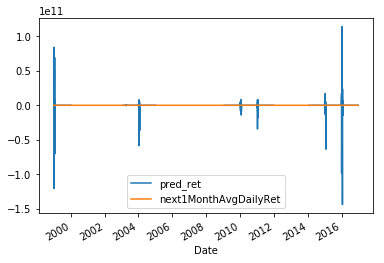

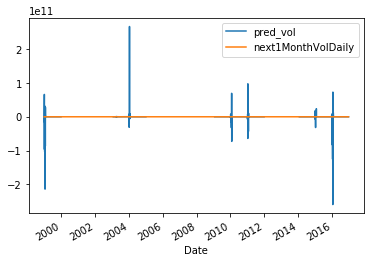

In [241]:
Prediction_1M_ols = prediction(response_data.next1MonthAvgDailyRet,response_data.next1MonthVolDaily,m_ols,m_ols,1,2,1)

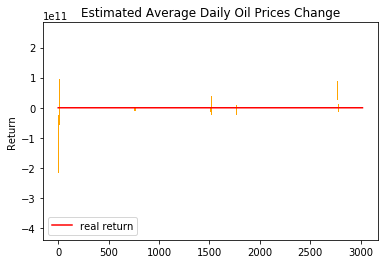

In [242]:
plot_to_use(Prediction_1M_ols,1)

In [13]:
m_neural

MLPRegressor(activation='tanh', alpha=0.0001, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(140, 140, 140, 140), learning_rate='constant',
       learning_rate_init=0.001, max_iter=200, momentum=0.9,
       nesterovs_momentum=True, power_t=0.5, random_state=10, shuffle=True,
       solver='adam', tol=0.0001, validation_fraction=0.1, verbose=False,
       warm_start=False)

1998-12-31 00:00:00
mse of training: 0.013767261868156123
predicted value: -0.15331743855751984
1999-01-04 00:00:00
mse of training: 0.02170981878679916
predicted value: -0.15575702940691805
1999-01-05 00:00:00
mse of training: 0.0166238995757962
predicted value: -0.13815087303204887
1999-01-06 00:00:00
mse of training: 0.01690358399622919
predicted value: -0.14077700094536905
1999-01-07 00:00:00
mse of training: 0.017424587533814984
predicted value: -0.13696243895348909
1999-01-08 00:00:00
mse of training: 0.01653853567783259
predicted value: -0.15633938985360313
1999-01-11 00:00:00
mse of training: 0.02110586184277781
predicted value: -0.16101575464372114
1999-01-12 00:00:00
mse of training: 0.016780926880907508
predicted value: -0.15034016282335638
1999-01-13 00:00:00
mse of training: 0.017697504237601438
predicted value: -0.14984754579153642
1999-01-14 00:00:00
mse of training: 0.018028066268565304
predicted value: -0.14651078432771614
1999-01-15 00:00:00
mse of training: 0.0185195

C:\Users\fzhan\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mse of training: 1.93361276894475e-05
predicted value: -0.0034572075109510214
1999-04-28 00:00:00
mse of training: 0.0008855386133688354
predicted value: 0.0669078808665502
1999-04-29 00:00:00
mse of training: 0.0007684795529244309
predicted value: 0.06167286876393216
1999-04-30 00:00:00
mse of training: 0.0007073363590953711
predicted value: 0.051046779270014386
1999-05-03 00:00:00
mse of training: 0.0006826452260699922
predicted value: 0.04968875779921875
1999-05-04 00:00:00
mse of training: 0.0007753057359078016
predicted value: 0.050656970674251234
1999-05-05 00:00:00
mse of training: 0.0007755525008129452
predicted value: 0.04752192765894683
1999-05-06 00:00:00
mse of training: 0.0007880001594426921
predicted value: 0.04535913651028367
1999-05-07 00:00:00
mse of training: 0.0008693246886167456
predicted value: 0.03949672713772265
1999-05-10 00:00:00
mse of training: 0.10908416571389422
predicted value: -0.028100675628944388
1999-05-11 00:00:00
mse of training: 0.10974349919286559


mse of training: 0.011286561596221292
predicted value: -0.14843965333020406
1999-08-31 00:00:00
mse of training: 0.025475271787156705
predicted value: -0.09346018442952653
1999-09-01 00:00:00
mse of training: 0.025636767971191868
predicted value: -0.09390181079051127
1999-09-02 00:00:00
mse of training: 0.026845902202056154
predicted value: -0.10329488265327536
1999-09-03 00:00:00
mse of training: 0.026454064424667516
predicted value: -0.10992095749659811
1999-09-07 00:00:00
mse of training: 0.022796710283275602
predicted value: -0.10364147061630605
1999-09-08 00:00:00
mse of training: 1.8353843508557736e-05
predicted value: 0.001815411081449142
1999-09-09 00:00:00
mse of training: 0.02163729502562668
predicted value: -0.06669141019040101
1999-09-10 00:00:00
mse of training: 1.7792408964978027e-05
predicted value: 0.0005045964752682097
1999-09-13 00:00:00
mse of training: 1.77723370187784e-05
predicted value: -2.3694464533513537e-05
1999-09-14 00:00:00
mse of training: 0.00393165733463

2002-04-23 00:00:00
2002-04-24 00:00:00
2002-04-25 00:00:00
2002-04-26 00:00:00
2002-04-29 00:00:00
2002-04-30 00:00:00
2002-05-01 00:00:00
2002-05-02 00:00:00
2002-05-03 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00


mse of training: 0.00021453062331361648
predicted value: 0.014816929779759375
2003-04-07 00:00:00
mse of training: 0.0004912976610760498
predicted value: -0.030377002265397385
2003-04-08 00:00:00
mse of training: 0.0004912976610760498
predicted value: -0.030449198556818408
2003-04-09 00:00:00
mse of training: 0.00028877116817312013
predicted value: -0.026923563247270216
2003-04-10 00:00:00
mse of training: 0.0003378497451649677
predicted value: -0.03517798925454166
2003-04-11 00:00:00
mse of training: 0.00022783386472130412
predicted value: -0.03176319031916569
2003-04-14 00:00:00
mse of training: 0.0016632619223960338
predicted value: -0.02297434437606749
2003-04-15 00:00:00
mse of training: 0.0016632619223960338
predicted value: -0.022915600128946806
2003-04-16 00:00:00
mse of training: 0.0015764019002488805
predicted value: -0.04927186388046856
2003-04-17 00:00:00
mse of training: 0.0015296296917281756
predicted value: -0.06765921651238069
2003-04-21 00:00:00
mse of training: 0.0016

mse of training: 0.009636545198157608
predicted value: 0.15477948902821637
2003-08-08 00:00:00
mse of training: 0.00857144971823098
predicted value: 0.144656678597824
2003-08-11 00:00:00
mse of training: 0.0014074201145445697
predicted value: 0.06247355336198396
2003-08-12 00:00:00
mse of training: 0.009174716508946147
predicted value: 0.1485912577747709
2003-08-13 00:00:00
mse of training: 0.009339296310184389
predicted value: 0.1509380781201816
2003-08-14 00:00:00
mse of training: 0.008824949641949544
predicted value: 0.1454780023457335
2003-08-15 00:00:00
mse of training: 0.008687457464707074
predicted value: 0.1579469169520104
2003-08-18 00:00:00
mse of training: 0.0013916351980194348
predicted value: 0.06406577890748488
2003-08-19 00:00:00
mse of training: 0.006944235946027584
predicted value: 0.14172954671815588
2003-08-20 00:00:00
mse of training: 0.005938808408881099
predicted value: 0.13278097263072047
2003-08-21 00:00:00
mse of training: 0.005215958330488312
predicted value: 

mse of training: 0.0019162593223590297
predicted value: 0.016752814815825773
2003-12-12 00:00:00
mse of training: 0.0021727799393846127
predicted value: 0.013843912962989452
2003-12-15 00:00:00
mse of training: 0.00022148784608601606
predicted value: -0.013355151927568865
2003-12-16 00:00:00
mse of training: 0.0022521471802133225
predicted value: 0.013953885705549923
2003-12-17 00:00:00
mse of training: 0.0022146000249155216
predicted value: 0.015416030419120541
2003-12-18 00:00:00
mse of training: 0.002597165293710608
predicted value: 0.017660496940003545
2003-12-19 00:00:00
mse of training: 0.0001921558789042254
predicted value: -0.009329991519869046
2003-12-22 00:00:00
mse of training: 0.0012314900551119755
predicted value: 0.008091792501723483
2003-12-23 00:00:00
mse of training: 0.00018043304960071096
predicted value: -0.010173331474976982
2003-12-24 00:00:00
mse of training: 0.00019006487633895576
predicted value: -0.008115820129593443
2003-12-29 00:00:00
mse of training: 0.00067

predicted value: -0.0631189563160791
2004-04-20 00:00:00
mse of training: 0.0012953668591462464
predicted value: -0.06077294711215815
2004-04-21 00:00:00
mse of training: 0.0011434984230663835
predicted value: -0.05395729896378182
2004-04-22 00:00:00
mse of training: 0.0011441717336660435
predicted value: -0.050309994229919164
2004-04-23 00:00:00
mse of training: 0.0011698179473149286
predicted value: -0.053113150028934825
2004-04-26 00:00:00
mse of training: 0.0012127720657903636
predicted value: -0.06208261456382774
2004-04-27 00:00:00
mse of training: 0.001206500770560845
predicted value: -0.04696860239589079
2004-04-28 00:00:00
mse of training: 0.0011095507275553026
predicted value: -0.04386196336366696
2004-04-29 00:00:00
mse of training: 0.001073934834104934
predicted value: -0.03169127180157
2004-04-30 00:00:00
mse of training: 0.000963635439130752
predicted value: -0.02104560192683025
2004-05-03 00:00:00
mse of training: 0.000962281140653403
predicted value: -0.0253820317247281

predicted value: 0.04215772375517049
2004-08-23 00:00:00
mse of training: 0.0021898615381182977
predicted value: 0.052304257153838796
2004-08-24 00:00:00
mse of training: 0.0011747186588267368
predicted value: 0.04049521368236311
2004-08-25 00:00:00
mse of training: 0.00127722511148433
predicted value: 0.043091503528673025
2004-08-26 00:00:00
mse of training: 0.001462387710187493
predicted value: 0.04641144449391629
2004-08-27 00:00:00
mse of training: 0.0017057117609761228
predicted value: 0.049553463078874815
2004-08-30 00:00:00
mse of training: 0.0033014174122777103
predicted value: 0.06292940236590361
2004-08-31 00:00:00
mse of training: 0.002003638699512832
predicted value: 0.05376698743702685
2004-09-01 00:00:00
mse of training: 0.0020478235236182476
predicted value: 0.05404528705870382
2004-09-02 00:00:00
mse of training: 0.0018087150194529432
predicted value: 0.0514679477331961
2004-09-03 00:00:00
mse of training: 0.002100515019863412
predicted value: 0.05936652448611349
2004-0

predicted value: 0.041188368632871314
2004-12-27 00:00:00
mse of training: 0.0016009136307466754
predicted value: 0.02619785439231484
2004-12-28 00:00:00
mse of training: 0.0007610071776202384
predicted value: 0.01614440499740105
2004-12-29 00:00:00
mse of training: 0.0007447595768491931
predicted value: 0.01575776302691581
2004-12-30 00:00:00
mse of training: 0.0007730658102001444
predicted value: 0.016873854614065376
2005-01-03 00:00:00
mse of training: 0.0008642670678674689
predicted value: 0.019220971178216167
2005-01-04 00:00:00
mse of training: 0.0006071623080497821
predicted value: 0.010070110827938628
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
200

mse of training: 0.003913867425259532
predicted value: 0.05063858362989354
2009-03-03 00:00:00
mse of training: 0.003913867425259532
predicted value: 0.05067041558692814
2009-03-04 00:00:00
mse of training: 0.0038800683194349537
predicted value: 0.04823557591528768
2009-03-05 00:00:00
mse of training: 0.004085400417366952
predicted value: 0.057367166104100836
2009-03-06 00:00:00
mse of training: 0.0038717773237466973
predicted value: 0.06324239209253174
2009-03-09 00:00:00
mse of training: 0.00030106399333573085
predicted value: -0.007890283938200293
2009-03-10 00:00:00
mse of training: 0.00030106399333573085
predicted value: -0.008717997331640137
2009-03-11 00:00:00
mse of training: 0.004930174857877738
predicted value: 0.050676865564721174
2009-03-12 00:00:00
mse of training: 0.0051411696641286515
predicted value: 0.06091671150831213
2009-03-13 00:00:00
mse of training: 0.0052353293101819725
predicted value: 0.037723026786777775
2009-03-16 00:00:00
mse of training: 0.0055026089267067

mse of training: 0.0014556636889983931
predicted value: -0.05693218639099287
2009-07-06 00:00:00
mse of training: 0.0017464845805270836
predicted value: -0.04656373522410437
2009-07-07 00:00:00
mse of training: 0.0017464845805270836
predicted value: -0.04683679536347113
2009-07-08 00:00:00
mse of training: 0.0016609808186994089
predicted value: -0.04683182290039939
2009-07-09 00:00:00
mse of training: 0.0016616343573656967
predicted value: -0.049112472535106616
2009-07-10 00:00:00
mse of training: 0.0016298533618827177
predicted value: -0.053080671881639535
2009-07-13 00:00:00
mse of training: 0.002134683612223731
predicted value: -0.06696752927486029
2009-07-14 00:00:00
mse of training: 0.001559975738469997
predicted value: -0.05037194436330489
2009-07-15 00:00:00
mse of training: 0.0015300989601139806
predicted value: -0.05003569334621613
2009-07-16 00:00:00
mse of training: 0.0014242925576648695
predicted value: -0.046454057588488806
2009-07-17 00:00:00
mse of training: 0.0015667222

mse of training: 0.002471155078412798
predicted value: 0.012695811401919804
2009-11-04 00:00:00
mse of training: 0.002393047881187579
predicted value: 0.013959542715603457
2009-11-05 00:00:00
mse of training: 0.002287594649214814
predicted value: 0.017376994850361788
2009-11-06 00:00:00
mse of training: 0.0025189806846929886
predicted value: 0.011618356610456015
2009-11-09 00:00:00
mse of training: 0.003896608120066146
predicted value: 0.029327405624094083
2009-11-10 00:00:00
mse of training: 0.003896608120066146
predicted value: 0.02922619055721462
2009-11-11 00:00:00
mse of training: 0.004086388714386661
predicted value: 0.023531975230401153
2009-11-12 00:00:00
mse of training: 0.004224678651134456
predicted value: 0.030337801125929487
2009-11-13 00:00:00
mse of training: 0.004476697627248681
predicted value: 0.035665690770658925
2009-11-16 00:00:00
mse of training: 0.004037830147481654
predicted value: 0.027300946518421798
2009-11-17 00:00:00
mse of training: 0.004223859158705885
pr

mse of training: 0.0013705196528055956
predicted value: -0.05133734826919517
2010-03-10 00:00:00
mse of training: 0.0014095904220615295
predicted value: -0.04977925513741835
2010-03-11 00:00:00
mse of training: 0.00154061362610559
predicted value: -0.051140924719943914
2010-03-12 00:00:00
mse of training: 0.0015251898843565838
predicted value: -0.059187465947316664
2010-03-15 00:00:00
mse of training: 0.0011645255937892238
predicted value: -0.06499674500930652
2010-03-16 00:00:00
mse of training: 0.0017664136774775433
predicted value: -0.06023439472552293
2010-03-17 00:00:00
mse of training: 0.001981726237358829
predicted value: -0.07111719010609356
2010-03-18 00:00:00
mse of training: 0.0020001587088008866
predicted value: -0.0685613404337986
2010-03-19 00:00:00
mse of training: 0.00201767522604723
predicted value: -0.06996409465630588
2010-03-22 00:00:00
mse of training: 0.002680573549211963
predicted value: 0.01687975939812425
2010-03-23 00:00:00
mse of training: 0.00224099864836625

mse of training: 1.9623700473927128e-05
predicted value: 0.003579506843739394
2010-07-12 00:00:00
mse of training: 0.005227692888635394
predicted value: -0.09643675993358175
2010-07-13 00:00:00
mse of training: 1.8601009566850296e-05
predicted value: 0.0032145621032236837
2010-07-14 00:00:00
mse of training: 1.8576152006178237e-05
predicted value: 0.003272354672102712
2010-07-15 00:00:00
mse of training: 1.8601740593066843e-05
predicted value: 0.0032128281905211276
2010-07-16 00:00:00
mse of training: 1.8550582926202636e-05
predicted value: 0.001736580051486608
2010-07-19 00:00:00
mse of training: 0.005202318525892192
predicted value: -0.09392483765231607
2010-07-20 00:00:00
mse of training: 1.832243543368768e-05
predicted value: 0.001347273112063202
2010-07-21 00:00:00
mse of training: 1.8291391189219718e-05
predicted value: 0.001313623635006228
2010-07-22 00:00:00
mse of training: 1.832029927127405e-05
predicted value: 0.0016250382754542103
2010-07-23 00:00:00
mse of training: 1.8413

predicted value: -0.06636033838547027
2010-11-09 00:00:00
mse of training: 0.0031915223574778516
predicted value: -0.06671625657744222
2010-11-10 00:00:00
mse of training: 0.0031667631037582793
predicted value: -0.06559670492969236
2010-11-11 00:00:00
mse of training: 0.0031202924529496233
predicted value: -0.07229237322372695
2010-11-12 00:00:00
mse of training: 0.0032765258521125743
predicted value: -0.0688548391121471
2010-11-15 00:00:00
mse of training: 0.004772291395076535
predicted value: -0.0871536140990337
2010-11-16 00:00:00
mse of training: 0.002912262451775735
predicted value: -0.06226098678514093
2010-11-17 00:00:00
mse of training: 0.0028083356428676787
predicted value: -0.058996229081570706
2010-11-18 00:00:00
mse of training: 0.0028403540671390025
predicted value: -0.05808511266806851
2010-11-19 00:00:00
mse of training: 0.0029619339804517
predicted value: -0.05969557618659496
2010-11-22 00:00:00
mse of training: 0.00399269619353273
predicted value: -0.07656270041851705


mse of training: 0.0013996929154919066
predicted value: 0.00850713719878779
2011-03-15 00:00:00
mse of training: 0.0015970407866336927
predicted value: -0.011855916196760324
2011-03-16 00:00:00
mse of training: 0.0017435981980620286
predicted value: 0.0016434747328996913
2011-03-17 00:00:00
mse of training: 0.0017934007016815595
predicted value: 0.006278606641561574
2011-03-18 00:00:00
mse of training: 0.002113795134516023
predicted value: 0.008475097513690466
2011-03-21 00:00:00
mse of training: 0.0021210019237845163
predicted value: 0.026907299657987216
2011-03-22 00:00:00
mse of training: 0.0020860534560278366
predicted value: 0.016782092426359557
2011-03-23 00:00:00
mse of training: 0.0029898875139666523
predicted value: -0.054733144158021496
2011-03-24 00:00:00
mse of training: 0.0028659485093355825
predicted value: -0.04839444818979996
2011-03-25 00:00:00
mse of training: 0.003019631005540418
predicted value: -0.051952425458612145
2011-03-28 00:00:00
mse of training: 0.0025739421

mse of training: 0.00451310734434683
predicted value: 0.11244694708098726
2011-07-19 00:00:00
mse of training: 0.0038021098140811867
predicted value: 0.10422787880430898
2011-07-20 00:00:00
mse of training: 0.003312363330511659
predicted value: 0.09763050738814419
2011-07-21 00:00:00
mse of training: 0.0034490837923880175
predicted value: 0.10044077582518321
2011-07-22 00:00:00
mse of training: 0.00339132753877128
predicted value: 0.097673536874223
2011-07-25 00:00:00
mse of training: 0.0038685432954592516
predicted value: 0.10343048136887534
2011-07-26 00:00:00
mse of training: 0.003598412721261371
predicted value: 0.10039196030578357
2011-07-27 00:00:00
mse of training: 0.003574190865218029
predicted value: 0.09786738686276247
2011-07-28 00:00:00
mse of training: 0.003225458819110031
predicted value: 0.09142997920289575
2011-07-29 00:00:00
mse of training: 0.0027106451871070705
predicted value: 0.08412102751383835
2011-08-01 00:00:00
mse of training: 0.003372936673509384
predicted va

mse of training: 0.005212156029652101
predicted value: 0.07948538256486815
2011-11-17 00:00:00
mse of training: 0.005264440213647735
predicted value: 0.0814310656847256
2011-11-18 00:00:00
mse of training: 0.006267252602517293
predicted value: 0.08397270375607946
2011-11-21 00:00:00
mse of training: 0.018663651954845123
predicted value: -0.11905380205809461
2011-11-22 00:00:00
mse of training: 0.007529096283541026
predicted value: 0.08777614695293598
2011-11-23 00:00:00
mse of training: 0.01051559746915414
predicted value: -0.11134335213113666
2011-11-25 00:00:00
mse of training: 0.009082163156576556
predicted value: 0.09294368331042521
2011-11-28 00:00:00
mse of training: 0.020515785842834235
predicted value: -0.10122700935973657
2011-11-29 00:00:00
mse of training: 0.017741235828890718
predicted value: -0.10225932039978311
2011-11-30 00:00:00
mse of training: 0.017634155115960098
predicted value: -0.10149844904024513
2011-12-01 00:00:00
mse of training: 0.01849367396725135
predicted 

predicted value: 0.01000589022477813
2014-01-28 00:00:00
mse of training: 0.00041343517291002937
predicted value: 0.01000607508734272
2014-01-29 00:00:00
mse of training: 0.0004720696536509869
predicted value: 0.01031514646678025
2014-01-30 00:00:00
mse of training: 0.000522534246458228
predicted value: 0.015049444979164855
2014-01-31 00:00:00
mse of training: 0.000522534246458228
predicted value: 0.02352681517089064
2014-02-03 00:00:00
mse of training: 0.0005720546925363496
predicted value: 0.018377714301653275
2014-02-04 00:00:00
mse of training: 0.0005720546925363496
predicted value: 0.01820993990972003
2014-02-05 00:00:00
mse of training: 0.0005397101336006804
predicted value: -0.02372839314228728
2014-02-06 00:00:00
mse of training: 0.0007516502706312614
predicted value: 0.007048882914509419
2014-02-07 00:00:00
mse of training: 0.0008380830528418927
predicted value: -0.02652219204912426
2014-02-10 00:00:00
mse of training: 0.0008641471795766732
predicted value: -0.0501631711974906

mse of training: 0.005282039550951249
predicted value: -0.0454774035306125
2014-06-02 00:00:00
mse of training: 0.00836116337548951
predicted value: 0.09588704292163427
2014-06-03 00:00:00
mse of training: 0.00836116337548951
predicted value: 0.0957870272215133
2014-06-04 00:00:00
mse of training: 0.005450805813664554
predicted value: -0.03179740435028677
2014-06-05 00:00:00
mse of training: 0.004587816597250635
predicted value: -0.04401983451695818
2014-06-06 00:00:00
mse of training: 0.003640085589927915
predicted value: -0.04567232289923087
2014-06-09 00:00:00
mse of training: 0.012112188419132957
predicted value: 0.095687101601314
2014-06-10 00:00:00
mse of training: 0.012112188419132957
predicted value: 0.09565423954438312
2014-06-11 00:00:00
mse of training: 0.011468144229740355
predicted value: 0.09162313138096595
2014-06-12 00:00:00
mse of training: 0.0029705753163042203
predicted value: -0.02503882034639912
2014-06-13 00:00:00
mse of training: 0.002118590669084595
predicted va

mse of training: 5.7208453150410105e-06
predicted value: -0.00632294717963669
2014-10-01 00:00:00
mse of training: 0.056944964848060234
predicted value: 0.16992049382748278
2014-10-02 00:00:00
mse of training: 0.05995930044439229
predicted value: 0.17549246657362094
2014-10-03 00:00:00
mse of training: 0.04096744074015527
predicted value: 0.15352001495595813
2014-10-06 00:00:00
mse of training: 0.041532439268934726
predicted value: 0.15258368026182606
2014-10-07 00:00:00
mse of training: 0.04793074021385205
predicted value: 0.16714700495698004
2014-10-08 00:00:00
mse of training: 0.05130158911706741
predicted value: 0.17316693107014297
2014-10-09 00:00:00
mse of training: 0.03414738229971237
predicted value: 0.13971486968256158
2014-10-10 00:00:00
mse of training: 0.022985835169853582
predicted value: 0.11139339244848584
2014-10-13 00:00:00
mse of training: 0.009732877589282823
predicted value: 0.058465179752648894
2014-10-14 00:00:00
mse of training: 0.0045829870341483735
predicted va

predicted value: 0.027406105446347556
2015-02-03 00:00:00
mse of training: 0.0021992681897958733
predicted value: 0.019118438029123275
2015-02-04 00:00:00
mse of training: 0.002882760128727357
predicted value: 0.02793450175267176
2015-02-05 00:00:00
mse of training: 0.002426415350586143
predicted value: 0.032332915807646856
2015-02-06 00:00:00
mse of training: 0.003203631222179426
predicted value: 0.038057308654669664
2015-02-09 00:00:00
mse of training: 6.912362720985581e-06
predicted value: 0.0016107480607876201
2015-02-10 00:00:00
mse of training: 0.0025338739754318207
predicted value: 0.04644801000853527
2015-02-11 00:00:00
mse of training: 0.0028945246964561387
predicted value: 0.06258417134098798
2015-02-12 00:00:00
mse of training: 0.0027247180439033043
predicted value: 0.06760236920815227
2015-02-13 00:00:00
mse of training: 0.002743524383535681
predicted value: 0.06545462797796014
2015-02-17 00:00:00
mse of training: 7.201319431632237e-06
predicted value: 0.008336098371496126


mse of training: 1.1193339719318366e-05
predicted value: 0.003833173087098851
2015-06-04 00:00:00
mse of training: 1.1082929314399956e-05
predicted value: 0.002966938229649385
2015-06-05 00:00:00
mse of training: 1.1039581159287285e-05
predicted value: 0.0032784626933194116
2015-06-08 00:00:00
mse of training: 1.1328247371694742e-05
predicted value: 0.003332926582813339
2015-06-09 00:00:00
mse of training: 0.038189351233404126
predicted value: -0.33663963020316856
2015-06-10 00:00:00
mse of training: 0.038511945114599745
predicted value: -0.3327283377913685
2015-06-11 00:00:00
mse of training: 0.03190011691929837
predicted value: -0.31475535685403677
2015-06-12 00:00:00
mse of training: 0.030366603125468558
predicted value: -0.307596152476763
2015-06-15 00:00:00
mse of training: 0.04149760018432698
predicted value: -0.3153914052973722
2015-06-16 00:00:00
mse of training: 0.03115710889025161
predicted value: -0.3060154724204147
2015-06-17 00:00:00
mse of training: 0.02898684620343365
pr

mse of training: 0.005495690175118119
predicted value: 0.01758043356007241
2015-10-02 00:00:00
mse of training: 0.0046081875903833175
predicted value: 0.012799661097020798
2015-10-05 00:00:00
mse of training: 0.00418772934250235
predicted value: 0.01170940160324116
2015-10-06 00:00:00
mse of training: 0.003936185945832853
predicted value: 0.010193699189030458
2015-10-07 00:00:00
mse of training: 0.0037721666153645323
predicted value: 0.008607240041665465
2015-10-08 00:00:00
mse of training: 0.0035792880416408036
predicted value: 0.006613956914722913
2015-10-09 00:00:00
mse of training: 0.003270185862177587
predicted value: 0.0008052794738039049
2015-10-12 00:00:00
mse of training: 0.0032639075605469152
predicted value: 0.00296684862607402
2015-10-13 00:00:00
mse of training: 0.0028715407695760506
predicted value: -0.0024867598727284224
2015-10-14 00:00:00
mse of training: 0.022077624436853873
predicted value: 0.17747377590217706
2015-10-15 00:00:00
mse of training: 0.021806554085017808

mse of training: 1.7530049593787088e-05
predicted value: -0.002889140684646019
2016-02-11 00:00:00
mse of training: 1.7530335264787344e-05
predicted value: -0.002469846989520713
2016-02-12 00:00:00
mse of training: 1.740209368262143e-05
predicted value: -0.001174692255167642
2016-02-16 00:00:00
mse of training: 1.7412539077214293e-05
predicted value: -0.0007752779054712999
2016-02-17 00:00:00
mse of training: 1.7389830013245667e-05
predicted value: -0.0003653445795238075
2016-02-18 00:00:00
mse of training: 1.730172325395473e-05
predicted value: 0.00012058749986110229
2016-02-19 00:00:00
mse of training: 1.7360739540122686e-05
predicted value: 0.0011523182206172877
2016-02-22 00:00:00
mse of training: 1.721874559911334e-05
predicted value: 0.0017805174293711312
2016-02-23 00:00:00
mse of training: 1.733126925031906e-05
predicted value: 0.0014648213506782415
2016-02-24 00:00:00
mse of training: 1.7297763852348263e-05
predicted value: 0.0018534099267726867
2016-02-25 00:00:00
mse of trai

mse of training: 0.006455892226434301
predicted value: 0.04069907653764335
2016-06-14 00:00:00
mse of training: 0.005411255314153507
predicted value: -0.05530290956520187
2016-06-15 00:00:00
mse of training: 0.007869318300593918
predicted value: 0.04394296627367175
2016-06-16 00:00:00
mse of training: 0.0058485580016672594
predicted value: -0.053258413078346584
2016-06-17 00:00:00
mse of training: 0.006027748091720107
predicted value: -0.05371286557674937
2016-06-20 00:00:00
mse of training: 0.005682360552980628
predicted value: -0.04753881738939375
2016-06-21 00:00:00
mse of training: 1.8468122960342534e-05
predicted value: 0.0009229559038972657
2016-06-22 00:00:00
mse of training: 0.008205990548978146
predicted value: 0.0418792562113553
2016-06-23 00:00:00
mse of training: 0.007723133055192191
predicted value: 0.04176148638575336
2016-06-24 00:00:00
mse of training: 0.007275402079419304
predicted value: 0.046813919755228445
2016-06-27 00:00:00
mse of training: 0.005980796432610893
pr

mse of training: 0.000728808863396273
predicted value: -0.031564545021707524
2016-10-13 00:00:00
mse of training: 0.00059220139877655
predicted value: -0.02721174060537579
2016-10-14 00:00:00
mse of training: 0.0006486169767942676
predicted value: -0.029604924051406856
2016-10-17 00:00:00
mse of training: 0.0006063878632090976
predicted value: -0.027050332071344996
2016-10-18 00:00:00
mse of training: 0.0004014464089121014
predicted value: -0.020698068816874055
2016-10-19 00:00:00
mse of training: 0.0003473088739579679
predicted value: -0.018279706071516855
2016-10-20 00:00:00
mse of training: 0.000450950057696568
predicted value: -0.02289185699318555
2016-10-21 00:00:00
mse of training: 0.0004691330390472111
predicted value: -0.02505895041779982
2016-10-24 00:00:00
mse of training: 0.0004949899824331528
predicted value: -0.01899621236243526
2016-10-25 00:00:00
mse of training: 0.00029379235598783244
predicted value: -0.016909795760358337
2016-10-26 00:00:00
mse of training: 0.00023849

mse of training: 0.01042054386329359
predicted value: -0.061854604420143816
1999-02-22 00:00:00
mse of training: 0.007590128002460898
predicted value: -0.07793864089636257
1999-02-23 00:00:00
mse of training: 0.01210288267968494
predicted value: -0.08305791687490072
1999-02-24 00:00:00
mse of training: 0.012340276345947525
predicted value: -0.09133192517638851
1999-02-25 00:00:00
mse of training: 0.012729243123475896
predicted value: -0.1006878541706773
1999-02-26 00:00:00
mse of training: 0.011690725933744093
predicted value: -0.10670934948387674
1999-03-01 00:00:00
mse of training: 0.01019169970519656
predicted value: -0.11892284969427647
1999-03-02 00:00:00
mse of training: 0.012456278791915989
predicted value: -0.11405113665691358
1999-03-03 00:00:00
mse of training: 0.012353844286208204
predicted value: -0.11344759420920472
1999-03-04 00:00:00
mse of training: 5.495148950429508e-05
predicted value: 0.020057129528097933
1999-03-05 00:00:00
mse of training: 0.004190465238647881
pred

mse of training: 4.841061551553037e-05
predicted value: 0.01725139543313811
1999-06-29 00:00:00
mse of training: 0.016453982701707694
predicted value: 0.047842037331484316
1999-06-30 00:00:00
mse of training: 4.802314199351819e-05
predicted value: 0.016185386218036307
1999-07-01 00:00:00
mse of training: 0.014008080328178511
predicted value: 0.08348214075776145
1999-07-02 00:00:00
mse of training: 0.012018104614608848
predicted value: 0.070170143874772
1999-07-06 00:00:00
mse of training: 0.002316364527943217
predicted value: -0.04178240694044194
1999-07-07 00:00:00
mse of training: 0.0022801002660394463
predicted value: -0.04768765429716132
1999-07-08 00:00:00
mse of training: 0.0023232006902451723
predicted value: -0.051757276269419505
1999-07-09 00:00:00
mse of training: 0.0026498697182732226
predicted value: -0.05702112488301661
1999-07-12 00:00:00
mse of training: 0.007862795020111111
predicted value: 0.06453873688273254
1999-07-13 00:00:00
mse of training: 0.0032480396701752468
p

predicted value: -0.19614011427347217
1999-11-02 00:00:00
mse of training: 0.05311535750113957
predicted value: -0.2306779425003854
1999-11-03 00:00:00
mse of training: 0.05684667250903254
predicted value: -0.23865721905074355
1999-11-04 00:00:00
mse of training: 2.9019142856652432e-05
predicted value: 0.022450144726591653
1999-11-05 00:00:00
mse of training: 2.924405013304052e-05
predicted value: 0.021329154049869153
1999-11-08 00:00:00
mse of training: 2.9404565702101802e-05
predicted value: 0.021088823431295395
1999-11-09 00:00:00
mse of training: 2.9404565702101802e-05
predicted value: 0.021181124804914547
1999-11-10 00:00:00
mse of training: 2.9235668516983894e-05
predicted value: 0.021405843394766644
1999-11-11 00:00:00
mse of training: 0.016120615709020448
predicted value: 0.07096121378703987
1999-11-12 00:00:00
mse of training: 0.014649672792452295
predicted value: 0.07361275674058668
1999-11-15 00:00:00
mse of training: 0.01204927940924479
predicted value: 0.06586949881794227


mse of training: 0.0019726315716815388
predicted value: 0.026498874261024236
2003-02-03 00:00:00
mse of training: 0.0021195434950053937
predicted value: 0.006814301959062269
2003-02-04 00:00:00
mse of training: 0.0021195434950053937
predicted value: 0.007162904095969147
2003-02-05 00:00:00
mse of training: 0.0010030694960103368
predicted value: -0.046131791383129755
2003-02-06 00:00:00
mse of training: 0.001498864222602193
predicted value: -0.024955385737760266
2003-02-07 00:00:00
mse of training: 0.0017818969075517818
predicted value: -0.04208152989443367
2003-02-10 00:00:00
mse of training: 0.0014057455038576452
predicted value: -0.04595649507109137
2003-02-11 00:00:00
mse of training: 0.0014057455038576452
predicted value: -0.04579761157431797
2003-02-12 00:00:00
mse of training: 0.0017332332613113515
predicted value: -0.025782899869198572
2003-02-13 00:00:00
mse of training: 0.0013681815353847925
predicted value: -0.05352983658585536
2003-02-14 00:00:00
mse of training: 0.001173073

predicted value: 0.15862986527228362
2003-06-06 00:00:00
mse of training: 0.0003788697693057483
predicted value: 0.024817100429531114
2003-06-09 00:00:00
mse of training: 0.021628939356422863
predicted value: 0.17118603384141934
2003-06-10 00:00:00
mse of training: 0.021628939356422863
predicted value: 0.1708553616916973
2003-06-11 00:00:00
mse of training: 2.490626455235879e-05
predicted value: 0.02195588901770268
2003-06-12 00:00:00
mse of training: 0.024808006113729134
predicted value: 0.18936462077720587
2003-06-13 00:00:00
mse of training: 0.022689089237964293
predicted value: 0.18339495081609522
2003-06-16 00:00:00
mse of training: 0.002759354284214664
predicted value: 0.04001271748889201
2003-06-17 00:00:00
mse of training: 0.0022569631148045125
predicted value: 0.030146130809420663
2003-06-18 00:00:00
mse of training: 0.0031569644643216085
predicted value: 0.035331349530264095
2003-06-19 00:00:00
mse of training: 0.03275689621867146
predicted value: 0.2379266746596075
2003-06-2

mse of training: 0.0029877274413684417
predicted value: 0.08792966234843452
2003-10-13 00:00:00
mse of training: 0.004026695834040293
predicted value: 0.05281646992191924
2003-10-14 00:00:00
mse of training: 0.003273325045158079
predicted value: 0.09392268370033144
2003-10-15 00:00:00
mse of training: 0.0029853357885930858
predicted value: 0.08474315862818041
2003-10-16 00:00:00
mse of training: 0.0029093621463682842
predicted value: 0.08896109971039703
2003-10-17 00:00:00
mse of training: 0.0027433355247257502
predicted value: 0.08564422230294011
2003-10-20 00:00:00
mse of training: 0.003243954012911582
predicted value: 0.05826416980288315
2003-10-21 00:00:00
mse of training: 0.0025862578687135596
predicted value: 0.08603583440081053
2003-10-22 00:00:00
mse of training: 0.00261043162436818
predicted value: 0.09001578851806546
2003-10-23 00:00:00
mse of training: 0.002650579653409671
predicted value: 0.09486638616954329
2003-10-24 00:00:00
mse of training: 0.0026558852294073744
predict

mse of training: 0.003409166391274102
predicted value: -0.034177857482622725
2004-02-20 00:00:00
mse of training: 0.0036416553418106923
predicted value: -0.03030527264674654
2004-02-23 00:00:00
mse of training: 0.003467188980165127
predicted value: -0.03652314069687909
2004-02-24 00:00:00
mse of training: 0.003968084418243921
predicted value: -0.034297931487415834
2004-02-25 00:00:00
mse of training: 0.004075639588378418
predicted value: -0.038581554124100775
2004-02-26 00:00:00
mse of training: 0.0038812156287575538
predicted value: -0.03746018056844025
2004-02-27 00:00:00
mse of training: 0.004424518290669158
predicted value: -0.03887712882365177
2004-03-01 00:00:00
mse of training: 0.004367774811225666
predicted value: -0.0424892332397388
2004-03-02 00:00:00
mse of training: 0.004507015637912388
predicted value: -0.0447042829103963
2004-03-03 00:00:00
mse of training: 0.004801035989357512
predicted value: -0.046680410556111746
2004-03-04 00:00:00
mse of training: 0.00530706342885673

predicted value: 0.04510538305347836
2004-06-23 00:00:00
mse of training: 0.0011412952286461956
predicted value: 0.049667080252040224
2004-06-24 00:00:00
mse of training: 0.000995369867695822
predicted value: 0.04512991116252188
2004-06-25 00:00:00
mse of training: 0.0009729787030520117
predicted value: 0.04686189637624713
2004-06-28 00:00:00
mse of training: 0.001016974082989466
predicted value: 0.053948784711482456
2004-06-29 00:00:00
mse of training: 0.0009109327392659533
predicted value: 0.046722614378194804
2004-06-30 00:00:00
mse of training: 0.0011884469714768889
predicted value: 0.0699604238758175
2004-07-01 00:00:00
mse of training: 0.00116467069311063
predicted value: 0.06737333860753786
2004-07-02 00:00:00
mse of training: 0.001284738366707409
predicted value: 0.06357449062904882
2004-07-06 00:00:00
mse of training: 0.0011436487720478839
predicted value: 0.06237850183955074
2004-07-07 00:00:00
mse of training: 0.0012139873165528843
predicted value: 0.06460522452688719
2004-0

mse of training: 0.003973991355837062
predicted value: -0.06105810568613103
2004-10-25 00:00:00
mse of training: 0.00656769576634681
predicted value: -0.07975997172989936
2004-10-26 00:00:00
mse of training: 0.004677187236891661
predicted value: -0.06783810468811109
2004-10-27 00:00:00
mse of training: 0.004217434319047172
predicted value: -0.06298587646323202
2004-10-28 00:00:00
mse of training: 0.004458767898036591
predicted value: -0.06353406837135606
2004-10-29 00:00:00
mse of training: 0.004294512181152549
predicted value: -0.06232837073374585
2004-11-01 00:00:00
mse of training: 0.007712207299595161
predicted value: 0.13533273923781966
2004-11-02 00:00:00
mse of training: 0.004491945604798679
predicted value: -0.06352114774309597
2004-11-03 00:00:00
mse of training: 0.004981988030128232
predicted value: 0.11763406409529867
2004-11-04 00:00:00
mse of training: 0.004628349809432533
predicted value: 0.1140185047954207
2004-11-05 00:00:00
mse of training: 0.004291482923225384
predict

2008-11-17 00:00:00
2008-11-18 00:00:00
2008-11-19 00:00:00
2008-11-20 00:00:00
2008-11-21 00:00:00
2008-11-24 00:00:00
2008-11-25 00:00:00
2008-11-26 00:00:00
2008-11-28 00:00:00
2008-12-01 00:00:00
2008-12-02 00:00:00
2008-12-03 00:00:00
2008-12-04 00:00:00
2008-12-05 00:00:00
2008-12-08 00:00:00
2008-12-09 00:00:00
2008-12-10 00:00:00
2008-12-11 00:00:00
2008-12-12 00:00:00
2008-12-15 00:00:00
2008-12-16 00:00:00
2008-12-17 00:00:00
2008-12-18 00:00:00
2008-12-19 00:00:00
2008-12-22 00:00:00
2008-12-23 00:00:00
2008-12-24 00:00:00
2008-12-26 00:00:00
2008-12-29 00:00:00
2008-12-31 00:00:00
2009-01-02 00:00:00
2009-01-05 00:00:00
2009-01-06 00:00:00
2009-01-07 00:00:00
2009-01-08 00:00:00
2009-01-09 00:00:00
2009-01-12 00:00:00
2009-01-13 00:00:00
2009-01-14 00:00:00
2009-01-15 00:00:00
2009-01-16 00:00:00
2009-01-20 00:00:00
2009-01-21 00:00:00
2009-01-22 00:00:00
2009-01-23 00:00:00
2009-01-26 00:00:00
mse of training: 0.004724804013863423
predicted value: 0.04345734243515795
2009-

mse of training: 0.001969987348627146
predicted value: -0.029680978100825123
2009-05-15 00:00:00
mse of training: 0.0019840495208376615
predicted value: -0.025848360269874693
2009-05-18 00:00:00
mse of training: 0.0014024100986694125
predicted value: -0.02613856887306107
2009-05-19 00:00:00
mse of training: 0.0014024100986694125
predicted value: -0.026607007659029486
2009-05-20 00:00:00
mse of training: 0.001875382600363848
predicted value: -0.03576498718476834
2009-05-21 00:00:00
mse of training: 0.0017118168923618681
predicted value: -0.03504339838297377
2009-05-22 00:00:00
mse of training: 0.0020995514779757747
predicted value: -0.034261871286516865
2009-05-26 00:00:00
mse of training: 0.0008405476407809055
predicted value: -0.008541930566046824
2009-05-27 00:00:00
mse of training: 0.001801199134104097
predicted value: -0.03408812858463134
2009-05-28 00:00:00
mse of training: 0.0007525373438019658
predicted value: -0.004927464031441481
2009-05-29 00:00:00
mse of training: 0.00203118

mse of training: 0.0009207830444760526
predicted value: 0.05022575623961964
2009-09-16 00:00:00
mse of training: 0.0009951121370575168
predicted value: 0.053748473312127065
2009-09-17 00:00:00
mse of training: 0.0012143969509476843
predicted value: 0.05923170673906364
2009-09-18 00:00:00
mse of training: 0.0011538378203311275
predicted value: 0.058152703912223214
2009-09-21 00:00:00
mse of training: 0.0017765999781838482
predicted value: 0.06864769286025074
2009-09-22 00:00:00
mse of training: 0.0013915537285029782
predicted value: 0.064414684261074
2009-09-23 00:00:00
mse of training: 0.001460143268281816
predicted value: 0.06688489516929763
2009-09-24 00:00:00
mse of training: 0.00151324282671004
predicted value: 0.06577427052833809
2009-09-25 00:00:00
mse of training: 0.00151398999005614
predicted value: 0.06370771578706422
2009-09-28 00:00:00
mse of training: 0.0019991193262000485
predicted value: 0.06689954058471534
2009-09-29 00:00:00
mse of training: 0.001750667122192169
predict

predicted value: 0.034274547317098114
2010-01-20 00:00:00
mse of training: 0.0024597653890551553
predicted value: 0.03577498404768811
2010-01-21 00:00:00
mse of training: 0.0026486898666199512
predicted value: 0.03480351251229921
2010-01-22 00:00:00
mse of training: 0.002389353076172498
predicted value: 0.04963375684438834
2010-01-25 00:00:00
mse of training: 0.002363139022973637
predicted value: 0.0508528588511791
2010-01-26 00:00:00
mse of training: 0.0010436848407161074
predicted value: 0.06311433492557253
2010-01-27 00:00:00
mse of training: 0.0009625983975935625
predicted value: 0.0645946092050581
2010-01-28 00:00:00
mse of training: 0.0009386099290548714
predicted value: 0.06567171367594135
2010-01-29 00:00:00
mse of training: 0.0007931006190646543
predicted value: 0.07530533115094706
2010-02-01 00:00:00
mse of training: 0.0006965097905645137
predicted value: 0.07102988415210021
2010-02-02 00:00:00
mse of training: 0.00024604387360999385
predicted value: 0.09636206326709046
2010-

mse of training: 3.0339307278121457e-05
predicted value: 0.009836380755272878
2010-05-21 00:00:00
mse of training: 3.0258345789683153e-05
predicted value: 0.012725458444706683
2010-05-24 00:00:00
mse of training: 3.009755802256039e-05
predicted value: 0.013132250695305575
2010-05-25 00:00:00
mse of training: 3.0336206272151695e-05
predicted value: 0.013668787985748942
2010-05-26 00:00:00
mse of training: 3.117097093516094e-05
predicted value: 0.014801691818473905
2010-05-27 00:00:00
mse of training: 3.200132489949426e-05
predicted value: 0.015844656799045786
2010-05-28 00:00:00
mse of training: 3.258286308746858e-05
predicted value: 0.011643835483151399
2010-06-01 00:00:00
mse of training: 3.3770434801062915e-05
predicted value: 0.012870003827882615
2010-06-02 00:00:00
mse of training: 3.416840961448657e-05
predicted value: 0.013379908701344673
2010-06-03 00:00:00
mse of training: 3.460092647031648e-05
predicted value: 0.01399557066519519
2010-06-04 00:00:00
mse of training: 3.49335935

mse of training: 0.0032618006768932624
predicted value: -0.05044491633320239
2010-09-23 00:00:00
mse of training: 0.003229241526329559
predicted value: -0.05011097032656253
2010-09-24 00:00:00
mse of training: 0.0030659403217867037
predicted value: -0.05042324194484954
2010-09-27 00:00:00
mse of training: 0.004810027996890643
predicted value: -0.07195785258669463
2010-09-28 00:00:00
mse of training: 0.0023842360469567324
predicted value: -0.042006538468259164
2010-09-29 00:00:00
mse of training: 0.0023639587063747644
predicted value: -0.041874165281036574
2010-09-30 00:00:00
mse of training: 0.0022334170753972237
predicted value: -0.04863225092516618
2010-10-01 00:00:00
mse of training: 0.0019224293699156795
predicted value: -0.04426508077492439
2010-10-04 00:00:00
mse of training: 0.005387390542877601
predicted value: -0.08713327777155172
2010-10-05 00:00:00
mse of training: 0.0019278970036255845
predicted value: -0.04387654792730092
2010-10-06 00:00:00
mse of training: 0.002570444778

predicted value: -0.02160836406806982
2011-01-24 00:00:00
mse of training: 0.0013852976787249497
predicted value: -0.02416190192380291
2011-01-25 00:00:00
mse of training: 0.0006518796347852632
predicted value: -0.015131739430411517
2011-01-26 00:00:00
mse of training: 0.0006624526880415693
predicted value: -0.014092897215262051
2011-01-27 00:00:00
mse of training: 0.0008365098448131686
predicted value: -0.020416647344316446
2011-01-28 00:00:00
mse of training: 0.0009127875219116137
predicted value: -0.020336850959740777
2011-01-31 00:00:00
mse of training: 0.0016487879549136938
predicted value: -0.02832173544794178
2011-02-01 00:00:00
mse of training: 0.0012039345126689588
predicted value: -0.02829320699429677
2011-02-02 00:00:00
mse of training: 0.0012497303462982714
predicted value: -0.02953517332801059
2011-02-03 00:00:00
mse of training: 0.0012110303374163222
predicted value: -0.03557004564368563
2011-02-04 00:00:00
mse of training: 0.0012661401871930046
predicted value: -0.039785

mse of training: 0.0012163083733680426
predicted value: 0.07710341575049465
2011-05-27 00:00:00
mse of training: 0.0016194614484001271
predicted value: 0.09133832400947717
2011-05-31 00:00:00
mse of training: 0.0019275806251432914
predicted value: 0.10141799138459279
2011-06-01 00:00:00
mse of training: 0.0021644993429308372
predicted value: 0.1054135607848001
2011-06-02 00:00:00
mse of training: 0.0027288053716224294
predicted value: 0.11539062525527669
2011-06-03 00:00:00
mse of training: 0.0037186809644003506
predicted value: 0.13192705141320885
2011-06-06 00:00:00
mse of training: 0.0173617077143249
predicted value: 0.24096739821956936
2011-06-07 00:00:00
mse of training: 0.002820340209547373
predicted value: 0.11908512824756257
2011-06-08 00:00:00
mse of training: 0.0017331153833711104
predicted value: 0.09866872742200211
2011-06-09 00:00:00
mse of training: 0.0012161473322716485
predicted value: 0.08626112806757885
2011-06-10 00:00:00
mse of training: 0.001199827190571505
predict

predicted value: 0.11064116765963583
2011-10-04 00:00:00
mse of training: 0.004261076980594062
predicted value: 0.06956278282068618
2011-10-05 00:00:00
mse of training: 0.007362072033959332
predicted value: 0.013986120291811899
2011-10-06 00:00:00
mse of training: 0.007203700825538876
predicted value: 0.012858399847502866
2011-10-07 00:00:00
mse of training: 0.006547008569933294
predicted value: 0.02139362897322461
2011-10-10 00:00:00
mse of training: 0.0036188462129387367
predicted value: 0.07099950430886054
2011-10-11 00:00:00
mse of training: 0.006966843744784484
predicted value: 0.01840087984481034
2011-10-12 00:00:00
mse of training: 0.007032834163178835
predicted value: 0.020788832705461252
2011-10-13 00:00:00
mse of training: 0.007717315909664754
predicted value: 0.013500573976950592
2011-10-14 00:00:00
mse of training: 0.008177922678573526
predicted value: 0.0002330341658844659
2011-10-17 00:00:00
mse of training: 0.004366301695310901
predicted value: 0.04358986890677119
2011-1

2013-10-29 00:00:00
2013-10-30 00:00:00
2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00


mse of training: 0.008722867585216088
predicted value: 0.06322284119439198
2014-05-12 00:00:00
mse of training: 0.002037411530160168
predicted value: 0.0040675846249282055
2014-05-13 00:00:00
mse of training: 0.002037411530160168
predicted value: 0.004077629797647614
2014-05-14 00:00:00
mse of training: 0.002956276883670989
predicted value: 0.006075450231290386
2014-05-15 00:00:00
mse of training: 0.0020586611031643883
predicted value: -0.0085415906774029
2014-05-16 00:00:00
mse of training: 0.0026392324204828534
predicted value: 0.005797100628962493
2014-05-19 00:00:00
mse of training: 0.00900464911777776
predicted value: 0.08080356441460448
2014-05-20 00:00:00
mse of training: 0.00900464911777776
predicted value: 0.08096561629602064
2014-05-21 00:00:00
mse of training: 0.002396664894290926
predicted value: -0.007338484993031025
2014-05-22 00:00:00
mse of training: 0.00904805113564475
predicted value: 0.07773028046372502
2014-05-23 00:00:00
mse of training: 0.004547156870753603
predic

mse of training: 0.017995820370396064
predicted value: 0.10860220257474856
2014-09-12 00:00:00
mse of training: 0.009358232209846664
predicted value: 0.08293615011863836
2014-09-15 00:00:00
mse of training: 0.005616129225428878
predicted value: 0.06669916861290143
2014-09-16 00:00:00
mse of training: 0.02846097563256149
predicted value: 0.25098551187999213
2014-09-17 00:00:00
mse of training: 0.025483889156540977
predicted value: 0.23927890363189178
2014-09-18 00:00:00
mse of training: 6.794824588245512e-06
predicted value: 0.01628855585723707
2014-09-19 00:00:00
mse of training: 0.007472626052571918
predicted value: -0.09909010052534067
2014-09-22 00:00:00
mse of training: 6.5780745617688655e-06
predicted value: 0.014451897445055012
2014-09-23 00:00:00
mse of training: 6.681612896924869e-06
predicted value: 0.014804550698385738
2014-09-24 00:00:00
mse of training: 0.04582745259183834
predicted value: 0.30621390371241497
2014-09-25 00:00:00
mse of training: 0.04621557509087745
predicte

mse of training: 1.311825420053206e-05
predicted value: -0.026971796521129854
2015-01-14 00:00:00
mse of training: 1.3139224866757824e-05
predicted value: -0.027142222915239905
2015-01-15 00:00:00
mse of training: 0.002524709421549165
predicted value: 0.001912715142980026
2015-01-16 00:00:00
mse of training: 0.001803676864788604
predicted value: -0.0054944660375000065
2015-01-20 00:00:00
mse of training: 0.0013315563247074972
predicted value: -0.01146309055459202
2015-01-21 00:00:00
mse of training: 0.0012750855442471628
predicted value: -0.013278609405029118
2015-01-22 00:00:00
mse of training: 0.0010074385286061652
predicted value: -0.017534530407014665
2015-01-23 00:00:00
mse of training: 0.0008272376904509843
predicted value: -0.014715665143907847
2015-01-26 00:00:00
mse of training: 0.0008598544809703331
predicted value: -0.011854740403381137
2015-01-27 00:00:00
mse of training: 0.0007813022424330153
predicted value: -0.02040609230484003
2015-01-28 00:00:00
mse of training: 0.0008

mse of training: 1.8403041856266838e-05
predicted value: 0.030723970466343176
2015-05-15 00:00:00
mse of training: 0.0028124927755981636
predicted value: 0.11130855399708603
2015-05-18 00:00:00
mse of training: 0.001318165568757838
predicted value: -0.028620968078845094
2015-05-19 00:00:00
mse of training: 0.0025450079857509585
predicted value: 0.13231043990361602
2015-05-20 00:00:00
mse of training: 0.0025382813974046212
predicted value: 0.12664248593152944
2015-05-21 00:00:00
mse of training: 0.0031301692163199497
predicted value: 0.1501423241800128
2015-05-22 00:00:00
mse of training: 0.0026185271244511888
predicted value: 0.13557084759110744
2015-05-25 00:00:00
mse of training: 0.0026399341489904402
predicted value: 0.097118231034142
2015-05-26 00:00:00
mse of training: 0.0037987269864051053
predicted value: 0.15446535545390713
2015-05-27 00:00:00
mse of training: 0.005198084550056347
predicted value: 0.16754198560565467
2015-05-28 00:00:00
mse of training: 1.9607839907766608e-05
p

mse of training: 3.0347828215408103e-05
predicted value: 0.023892947148618643
2015-09-14 00:00:00
mse of training: 3.187020640931113e-05
predicted value: 0.02408525763583949
2015-09-15 00:00:00
mse of training: 3.189159904889915e-05
predicted value: 0.024466131203014635
2015-09-16 00:00:00
mse of training: 3.271808741954504e-05
predicted value: 0.0246399979313473
2015-09-17 00:00:00
mse of training: 3.3506054921957574e-05
predicted value: 0.02488241138717573
2015-09-18 00:00:00
mse of training: 3.4302780627308947e-05
predicted value: 0.02473128935990418
2015-09-21 00:00:00
mse of training: 0.04135123736550803
predicted value: -0.2683209301408088
2015-09-22 00:00:00
mse of training: 0.019719893470444238
predicted value: -0.028955720702880244
2015-09-23 00:00:00
mse of training: 0.04520934782855663
predicted value: -0.2823549260171473
2015-09-24 00:00:00
mse of training: 0.04610889490569197
predicted value: -0.2839862550666381
2015-09-25 00:00:00
mse of training: 0.047189454577524284
pre

predicted value: -0.04815240347486374
2016-01-25 00:00:00
mse of training: 0.018055002805514114
predicted value: -0.03855544883623388
2016-01-26 00:00:00
mse of training: 0.015201191640225846
predicted value: -0.033942933525899055
2016-01-27 00:00:00
mse of training: 0.020482548857268936
predicted value: -0.046079955492874136
2016-01-28 00:00:00
mse of training: 0.00112786515338502
predicted value: 0.01862280066948449
2016-01-29 00:00:00
mse of training: 0.019371502517572217
predicted value: -0.04474621869457582
2016-02-01 00:00:00
mse of training: 0.0017525908396935175
predicted value: 0.029720475190717244
2016-02-02 00:00:00
mse of training: 0.001821720402826458
predicted value: 0.020518066598798568
2016-02-03 00:00:00
mse of training: 0.0021610946844805717
predicted value: 0.021902003080178062
2016-02-04 00:00:00
mse of training: 3.9282469959596156e-05
predicted value: 0.048324257162624534
2016-02-05 00:00:00
mse of training: 3.925525989059178e-05
predicted value: 0.0492250942843857

predicted value: -0.004535877933658616
2016-05-27 00:00:00
mse of training: 0.0049405469846877
predicted value: -0.0006110094647441833
2016-05-31 00:00:00
mse of training: 0.004808836603595516
predicted value: -0.0037213111085437622
2016-06-01 00:00:00
mse of training: 0.0049117723638418985
predicted value: -0.004256370329297571
2016-06-02 00:00:00
mse of training: 0.00545190107677755
predicted value: -0.0026336512019523584
2016-06-03 00:00:00
mse of training: 0.005481976827828107
predicted value: -0.0031207791175218713
2016-06-06 00:00:00
mse of training: 0.006471454108830882
predicted value: 0.08977364553513936
2016-06-07 00:00:00
mse of training: 0.0054531792981316555
predicted value: 0.0057794937283556225
2016-06-08 00:00:00
mse of training: 0.005584408352517902
predicted value: 0.01086305103639934
2016-06-09 00:00:00
mse of training: 0.0055840886587207195
predicted value: 0.012531320131353746
2016-06-10 00:00:00
mse of training: 0.0059652006045593986
predicted value: 0.07182082546

predicted value: -0.008966821661218954
2016-09-28 00:00:00
mse of training: 0.0013015631540613827
predicted value: -0.010326058293364665
2016-09-29 00:00:00
mse of training: 0.0011761488219574501
predicted value: -0.0028991957537857216
2016-09-30 00:00:00
mse of training: 0.0012856622316665435
predicted value: -0.006859439405100809
2016-10-03 00:00:00
mse of training: 0.0009728294164565936
predicted value: -0.005831707084365617
2016-10-04 00:00:00
mse of training: 0.001137324909155787
predicted value: -0.0023657587347829523
2016-10-05 00:00:00
mse of training: 0.001040723522143652
predicted value: 0.0023953440256118674
2016-10-06 00:00:00
mse of training: 0.0010455398868949998
predicted value: -0.0010627242148932292
2016-10-07 00:00:00
mse of training: 0.0010649255256191949
predicted value: 0.00039083655141428086
2016-10-10 00:00:00
mse of training: 0.0009502784470848041
predicted value: 0.0025983489560141293
2016-10-11 00:00:00
mse of training: 0.0014950428516147974
predicted value: -

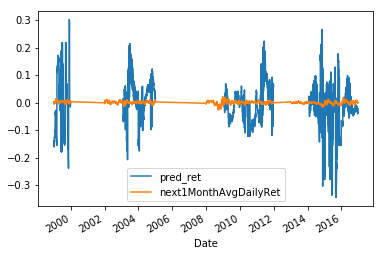

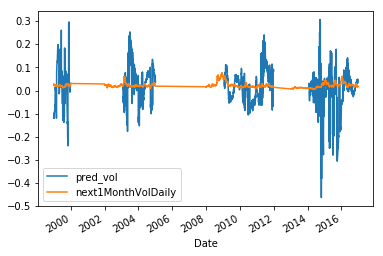

In [18]:
Prediction_1M_nn = prediction(response_data.next1MonthAvgDailyRet,response_data.next1MonthVolDaily,m_neural,m_neural,1,2,1)

In [22]:
Prediction_1M_nn['pred_vol'] = Prediction_1M_nn['pred_vol'].abs()
Prediction_1M_nn_adj = Prediction_1M_nn
Prediction_1M_nn_adj['pred_vol'] = Prediction_1M_nn_adj['pred_vol']/5
Prediction_1M_nn_adj['pred_ret'] = Prediction_1M_nn_adj['pred_ret']/5


,pred_ret,pred_vol,lower,upper,next1MonthAvgDailyRet,next1MonthVolDaily
Date,,,,,,
1998-12-31,-0.0306635,0.0235625,-0.0355048,-0.27113,0.00324009,0.0287123
1999-01-04,-0.0311514,0.0223068,-0.0442228,-0.267291,-0.00137344,0.0289673
1999-01-05,-0.0276302,0.0198067,-0.0391172,-0.237185,-0.000325344,0.0283004
1999-01-06,-0.0281554,0.0205571,-0.0379913,-0.243563,-0.00350489,0.0248323
1999-01-07,-0.0273925,0.0194857,-0.0395337,-0.234391,-0.00426425,0.0252065


In [24]:
Prediction_1M_nn_adj['lower'] = Prediction_1M_nn_adj['pred_ret'] - Prediction_1M_nn_adj['pred_vol']
Prediction_1M_nn_adj['upper'] = Prediction_1M_nn_adj['pred_ret'] + Prediction_1M_nn_adj['pred_vol']
Prediction_1M_nn_adj.head()

,pred_ret,pred_vol,lower,upper,next1MonthAvgDailyRet,next1MonthVolDaily
Date,,,,,,
1998-12-31,-0.0306635,0.0235625,-0.054226,-0.00710096,0.00324009,0.0287123
1999-01-04,-0.0311514,0.0223068,-0.0534582,-0.00884457,-0.00137344,0.0289673
1999-01-05,-0.0276302,0.0198067,-0.0474369,-0.00782343,-0.000325344,0.0283004
1999-01-06,-0.0281554,0.0205571,-0.0487125,-0.00759826,-0.00350489,0.0248323
1999-01-07,-0.0273925,0.0194857,-0.0468782,-0.00790674,-0.00426425,0.0252065


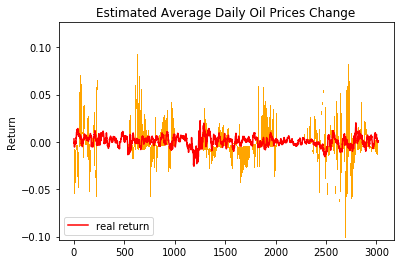

In [26]:
plot_to_use(Prediction_1M_nn_adj,1)

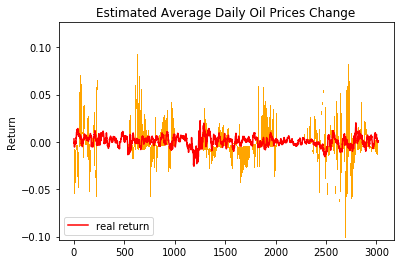

In [28]:
plot_to_use(Prediction_1M_nn,1)

In [23]:
m_neural_relu = MLPRegressor(activation='relu',alpha=5e-2,hidden_layer_sizes=(140,140,140,140),solver='adam')

1998-12-31 00:00:00
1999-01-04 00:00:00
1999-01-05 00:00:00
1999-01-06 00:00:00
1999-01-07 00:00:00
1999-01-08 00:00:00
1999-01-11 00:00:00
1999-01-12 00:00:00
1999-01-13 00:00:00
1999-01-14 00:00:00
1999-01-15 00:00:00
1999-01-19 00:00:00
1999-01-20 00:00:00
1999-01-21 00:00:00
1999-01-22 00:00:00
1999-01-25 00:00:00
1999-01-26 00:00:00
1999-01-27 00:00:00
1999-01-28 00:00:00
1999-01-29 00:00:00
1999-02-01 00:00:00
1999-02-02 00:00:00
1999-02-03 00:00:00
1999-02-04 00:00:00
1999-02-05 00:00:00
1999-02-08 00:00:00
1999-02-09 00:00:00
1999-02-10 00:00:00
1999-02-11 00:00:00
1999-02-12 00:00:00
1999-02-16 00:00:00
1999-02-17 00:00:00
1999-02-18 00:00:00
1999-02-19 00:00:00
1999-02-22 00:00:00
1999-02-23 00:00:00
1999-02-24 00:00:00
1999-02-25 00:00:00
1999-02-26 00:00:00
1999-03-01 00:00:00
1999-03-02 00:00:00
1999-03-03 00:00:00
1999-03-04 00:00:00
1999-03-05 00:00:00
1999-03-08 00:00:00
1999-03-09 00:00:00
1999-03-10 00:00:00
1999-03-11 00:00:00
1999-03-12 00:00:00
1999-03-15 00:00:00


2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00


2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-12 00:00:00
2004-07-13 00:00:00
2004-07-14 00:00:00
2004-07-15 00:00:00
2004-07-16 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-23 00:00:00
2004-07-26 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-07-30 00:00:00
2004-08-02 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-11 00:00:00
2004-08-12 00:00:00
2004-08-13 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-20 00:00:00
2004-08-23 00:00:00
2004-08-24 00:00:00


2009-01-28 00:00:00
2009-01-29 00:00:00
2009-01-30 00:00:00
2009-02-02 00:00:00
2009-02-03 00:00:00
2009-02-04 00:00:00
2009-02-05 00:00:00
2009-02-06 00:00:00
2009-02-09 00:00:00
2009-02-10 00:00:00
2009-02-11 00:00:00
2009-02-12 00:00:00
2009-02-13 00:00:00
2009-02-17 00:00:00
2009-02-18 00:00:00
2009-02-19 00:00:00
2009-02-20 00:00:00
2009-02-23 00:00:00
2009-02-24 00:00:00
2009-02-25 00:00:00
2009-02-26 00:00:00
2009-02-27 00:00:00
2009-03-02 00:00:00
2009-03-03 00:00:00
2009-03-04 00:00:00
2009-03-05 00:00:00
2009-03-06 00:00:00
2009-03-09 00:00:00
2009-03-10 00:00:00
2009-03-11 00:00:00
2009-03-12 00:00:00
2009-03-13 00:00:00
2009-03-16 00:00:00
2009-03-17 00:00:00
2009-03-18 00:00:00
2009-03-19 00:00:00
2009-03-20 00:00:00
2009-03-23 00:00:00
2009-03-24 00:00:00
2009-03-25 00:00:00
2009-03-26 00:00:00
2009-03-27 00:00:00
2009-03-30 00:00:00
2009-03-31 00:00:00
2009-04-01 00:00:00
2009-04-02 00:00:00
2009-04-03 00:00:00
2009-04-06 00:00:00
2009-04-07 00:00:00
2009-04-08 00:00:00


2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2010-09-23 00:00:00
2010-09-24 00:00:00
2010-09-27 00:00:00
2010-09-28 00:00:00
2010-09-29 00:00:00
2010-09-30 00:00:00
2010-10-01 00:00:00
2010-10-04 00:00:00
2010-10-05 00:00:00
2010-10-06 00:00:00
2010-10-07 00:00:00
2010-10-08 00:00:00
2010-10-11 00:00:00
2010-10-12 00:00:00
2010-10-13 00:00:00
2010-10-14 00:00:00
2010-10-15 00:00:00
2010-10-18 00:00:00
2010-10-19 00:00:00
2010-10-20 00:00:00
2010-10-21 00:00:00
2010-10-22 00:00:00
2010-10-25 00:00:00
2010-10-26 00:00:00
2010-10-27 00:00:00
2010-10-28 00:00:00
2010-10-29 00:00:00
2010-11-01 00:00:00
2010-11-02 00:00:00
2010-11-03 00:00:00
2010-11-04 00:00:00
2010-11-05 00:00:00
2010-11-08 00:00:00
2010-11-09 00:00:00
2010-11-10 00:00:00
2010-11-11 00:00:00
2010-11-12 00:00:00
2010-11-15 00:00:00
2010-11-16 00:00:00
2010-11-17 00:00:00
2010-11-18 00:00:00
2010-11-19 00:00:00
2010-11-22 00:00:00


2013-08-27 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-23 00:00:00
2013-09-24 00:00:00
2013-09-25 00:00:00
2013-09-26 00:00:00
2013-09-27 00:00:00
2013-09-30 00:00:00
2013-10-01 00:00:00
2013-10-02 00:00:00
2013-10-03 00:00:00
2013-10-04 00:00:00
2013-10-07 00:00:00
2013-10-08 00:00:00
2013-10-09 00:00:00
2013-10-10 00:00:00
2013-10-11 00:00:00
2013-10-14 00:00:00
2013-10-15 00:00:00
2013-10-16 00:00:00
2013-10-17 00:00:00
2013-10-18 00:00:00
2013-10-21 00:00:00
2013-10-22 00:00:00
2013-10-23 00:00:00
2013-10-24 00:00:00
2013-10-25 00:00:00
2013-10-28 00:00:00
2013-10-29 00:00:00
2013-10-30 00:00:00
2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00


2015-04-13 00:00:00
2015-04-14 00:00:00
2015-04-15 00:00:00
2015-04-16 00:00:00
2015-04-17 00:00:00
2015-04-20 00:00:00
2015-04-21 00:00:00
2015-04-22 00:00:00
2015-04-23 00:00:00
2015-04-24 00:00:00
2015-04-27 00:00:00
2015-04-28 00:00:00
2015-04-29 00:00:00
2015-04-30 00:00:00
2015-05-01 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-11 00:00:00
2015-05-12 00:00:00
2015-05-13 00:00:00
2015-05-14 00:00:00
2015-05-15 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-20 00:00:00
2015-05-21 00:00:00
2015-05-22 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-11 00:00:00
2015-06-12 00:00:00
2015-06-15 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00


2016-11-23 00:00:00
2016-11-24 00:00:00
2016-11-25 00:00:00
2016-11-28 00:00:00
2016-11-29 00:00:00
2016-11-30 00:00:00
2016-12-01 00:00:00
2016-12-02 00:00:00
2016-12-05 00:00:00
2016-12-06 00:00:00
2016-12-07 00:00:00
2016-12-08 00:00:00
2016-12-09 00:00:00
2016-12-12 00:00:00
2016-12-13 00:00:00
2016-12-14 00:00:00
2016-12-15 00:00:00
2016-12-16 00:00:00
2016-12-19 00:00:00
2016-12-20 00:00:00
2016-12-21 00:00:00
2016-12-22 00:00:00
2016-12-23 00:00:00
1998-12-31 00:00:00
1999-01-04 00:00:00
1999-01-05 00:00:00
1999-01-06 00:00:00
1999-01-07 00:00:00
1999-01-08 00:00:00
1999-01-11 00:00:00
1999-01-12 00:00:00
1999-01-13 00:00:00
1999-01-14 00:00:00
1999-01-15 00:00:00
1999-01-19 00:00:00
1999-01-20 00:00:00
1999-01-21 00:00:00
1999-01-22 00:00:00
1999-01-25 00:00:00
1999-01-26 00:00:00
1999-01-27 00:00:00
1999-01-28 00:00:00
1999-01-29 00:00:00
1999-02-01 00:00:00
1999-02-02 00:00:00
1999-02-03 00:00:00
1999-02-04 00:00:00
1999-02-05 00:00:00
1999-02-08 00:00:00
1999-02-09 00:00:00


2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-16 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2002-09-20 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00


2004-05-05 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-13 00:00:00
2004-05-14 00:00:00
2004-05-17 00:00:00
2004-05-18 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-05-27 00:00:00
2004-05-28 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-10 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-12 00:00:00
2004-07-13 00:00:00
2004-07-14 00:00:00
2004-07-15 00:00:00
2004-07-16 00:00:00


2009-01-27 00:00:00
2009-01-28 00:00:00
2009-01-29 00:00:00
2009-01-30 00:00:00
2009-02-02 00:00:00
2009-02-03 00:00:00
2009-02-04 00:00:00
2009-02-05 00:00:00
2009-02-06 00:00:00
2009-02-09 00:00:00
2009-02-10 00:00:00
2009-02-11 00:00:00
2009-02-12 00:00:00
2009-02-13 00:00:00
2009-02-17 00:00:00
2009-02-18 00:00:00
2009-02-19 00:00:00
2009-02-20 00:00:00
2009-02-23 00:00:00
2009-02-24 00:00:00
2009-02-25 00:00:00
2009-02-26 00:00:00
2009-02-27 00:00:00
2009-03-02 00:00:00
2009-03-03 00:00:00
2009-03-04 00:00:00
2009-03-05 00:00:00
2009-03-06 00:00:00
2009-03-09 00:00:00
2009-03-10 00:00:00
2009-03-11 00:00:00
2009-03-12 00:00:00
2009-03-13 00:00:00
2009-03-16 00:00:00
2009-03-17 00:00:00
2009-03-18 00:00:00
2009-03-19 00:00:00
2009-03-20 00:00:00
2009-03-23 00:00:00
2009-03-24 00:00:00
2009-03-25 00:00:00
2009-03-26 00:00:00
2009-03-27 00:00:00
2009-03-30 00:00:00
2009-03-31 00:00:00
2009-04-01 00:00:00
2009-04-02 00:00:00
2009-04-03 00:00:00
2009-04-06 00:00:00
2009-04-07 00:00:00


2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2010-09-23 00:00:00
2010-09-24 00:00:00
2010-09-27 00:00:00
2010-09-28 00:00:00
2010-09-29 00:00:00
2010-09-30 00:00:00
2010-10-01 00:00:00
2010-10-04 00:00:00
2010-10-05 00:00:00
2010-10-06 00:00:00
2010-10-07 00:00:00
2010-10-08 00:00:00
2010-10-11 00:00:00
2010-10-12 00:00:00
2010-10-13 00:00:00
2010-10-14 00:00:00
2010-10-15 00:00:00
2010-10-18 00:00:00
2010-10-19 00:00:00
2010-10-20 00:00:00
2010-10-21 00:00:00
2010-10-22 00:00:00
2010-10-25 00:00:00
2010-10-26 00:00:00
2010-10-27 00:00:00
2010-10-28 00:00:00
2010-10-29 00:00:00
2010-11-01 00:00:00
2010-11-02 00:00:00
2010-11-03 00:00:00
2010-11-04 00:00:00
2010-11-05 00:00:00
2010-11-08 00:00:00
2010-11-09 00:00:00
2010-11-10 00:00:00
2010-11-11 00:00:00
2010-11-12 00:00:00
2010-11-15 00:00:00
2010-11-16 00:00:00
2010-11-17 00:00:00
2010-11-18 00:00:00
2010-11-19 00:00:00


2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-23 00:00:00
2013-09-24 00:00:00
2013-09-25 00:00:00
2013-09-26 00:00:00
2013-09-27 00:00:00
2013-09-30 00:00:00
2013-10-01 00:00:00
2013-10-02 00:00:00
2013-10-03 00:00:00
2013-10-04 00:00:00
2013-10-07 00:00:00
2013-10-08 00:00:00
2013-10-09 00:00:00
2013-10-10 00:00:00
2013-10-11 00:00:00
2013-10-14 00:00:00
2013-10-15 00:00:00
2013-10-16 00:00:00
2013-10-17 00:00:00
2013-10-18 00:00:00
2013-10-21 00:00:00
2013-10-22 00:00:00
2013-10-23 00:00:00
2013-10-24 00:00:00
2013-10-25 00:00:00
2013-10-28 00:00:00
2013-10-29 00:00:00
2013-10-30 00:00:00
2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00


2015-04-30 00:00:00
2015-05-01 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-11 00:00:00
2015-05-12 00:00:00
2015-05-13 00:00:00
2015-05-14 00:00:00
2015-05-15 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-20 00:00:00
2015-05-21 00:00:00
2015-05-22 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-11 00:00:00
2015-06-12 00:00:00
2015-06-15 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-22 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00


2016-12-12 00:00:00
2016-12-13 00:00:00
2016-12-14 00:00:00
2016-12-15 00:00:00
2016-12-16 00:00:00
2016-12-19 00:00:00
2016-12-20 00:00:00
2016-12-21 00:00:00
2016-12-22 00:00:00
2016-12-23 00:00:00


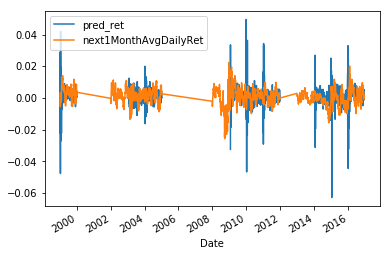

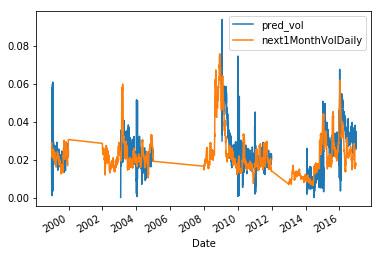

In [24]:
Prediction_1M_nn_relu = prediction(response_data.next1MonthAvgDailyRet,response_data.next1MonthVolDaily,m_neural_relu,m_neural_relu,1,2,1)

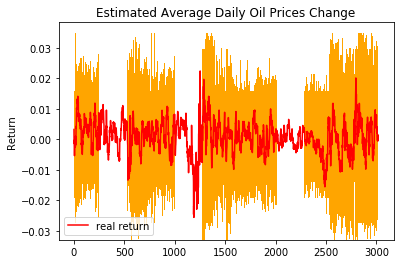

In [32]:
plot_to_use(Prediction_1M_nn_relu,1)

In [33]:
Prediction_1M_nn_relu.to_pickle("Prediction_1M_nn_relu.pkl")

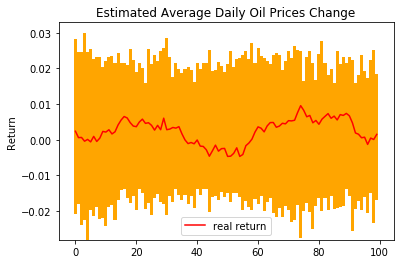

In [35]:
plot_to_use(Prediction_1M_nn_relu.iloc[800:900,:],1)

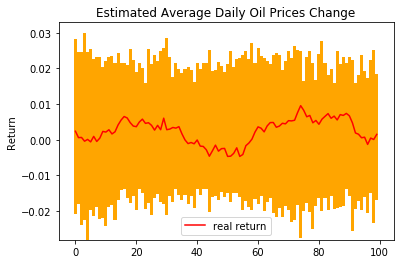

In [36]:
plot_to_use(Prediction_1M_nn_relu_adj.iloc[800:900,:],1)

In [29]:
Prediction_1M_nn_relu_adj = Prediction_1M_nn_relu.iloc[:,:]
Prediction_1M_nn_relu_adj['pred_ret'] = outlierCut(Prediction_1M_nn_relu_adj['pred_ret'],70,30)
Prediction_1M_nn_relu_adj['pred_vol'] = outlierCut(Prediction_1M_nn_relu_adj['pred_vol'],70,30)
Prediction_1M_nn_relu_adj['lower'] = Prediction_1M_nn_relu_adj['pred_ret'] - Prediction_1M_nn_relu_adj['pred_vol']
Prediction_1M_nn_relu_adj['upper'] = Prediction_1M_nn_relu_adj['pred_ret'] + Prediction_1M_nn_relu_adj['pred_vol']
Prediction_1M_nn_relu_adj.head()

,pred_ret,pred_vol,lower,upper,next1MonthAvgDailyRet,next1MonthVolDaily
Date,,,,,,
1998-12-31,0.00224856,0.0214572,-0.0192086,0.0237057,0.00324009,0.0287123
1999-01-04,-0.00174195,0.0176216,-0.0193635,0.0158796,-0.00137344,0.0289673
1999-01-05,0.003762,0.0284789,-0.0247169,0.0322409,-0.000325344,0.0283004
1999-01-06,0.003762,0.0176216,-0.0138595,0.0213836,-0.00350489,0.0248323
1999-01-07,-0.00174195,0.0312573,-0.0329993,0.0295154,-0.00426425,0.0252065


In [37]:
Prediction_1M_nn_relu_adj['pred_ret'] = outlierCut(Prediction_1M_nn_relu_adj['pred_ret'],70,30)
Prediction_1M_nn_relu_adj['pred_vol'] = outlierCut(Prediction_1M_nn_relu_adj['pred_vol'],70,30)
Prediction_1M_nn_relu_adj['lower'] = Prediction_1M_nn_relu_adj['pred_ret'] - Prediction_1M_nn_relu_adj['pred_vol']
Prediction_1M_nn_relu_adj['upper'] = Prediction_1M_nn_relu_adj['pred_ret'] + Prediction_1M_nn_relu_adj['pred_vol']
Prediction_1M_nn_relu_adj.head()

,pred_ret,pred_vol,lower,upper,next1MonthAvgDailyRet,next1MonthVolDaily
Date,,,,,,
1998-12-31,0.00224856,0.0214572,-0.0192086,0.0237057,0.00324009,0.0287123
1999-01-04,-0.00071022,0.0195168,-0.020227,0.0188066,-0.00137344,0.0289673
1999-01-05,0.00269079,0.0273328,-0.024642,0.0300235,-0.000325344,0.0283004
1999-01-06,0.00269079,0.0195168,-0.016826,0.0222076,-0.00350489,0.0248323
1999-01-07,-0.00071022,0.0273328,-0.028043,0.0266225,-0.00426425,0.0252065


In [40]:
Prediction_1M_nn_relu_adj.to_pickle('Prediction_1M_nn_relu_adj.pkl')

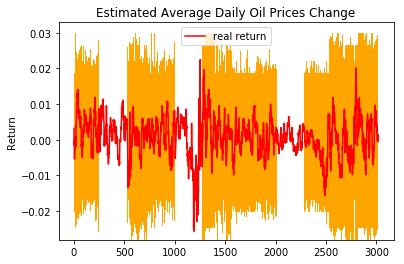

In [38]:
plot_to_use(Prediction_1M_nn_relu_adj,1)

In [239]:
get_error(Prediction_1M_ridge,1)

rmse_r       0.007185
rmse_v       0.024679
days_in      0.971984
tot_error    0.034131
dtype: float64

In [240]:
get_error(Prediction_1M_lasso,1)

rmse_r       0.005301
rmse_v       0.024915
days_in      0.998192
tot_error    0.027932
dtype: float64

In [243]:
get_error(Prediction_1M_ols,1)

rmse_r       7.011991e+09
rmse_v       1.154282e+10
days_in      8.197018e-01
tot_error    4.401628e+23
dtype: float64

In [20]:
get_error(Prediction_1M_nn,1)

rmse_r        0.085361
rmse_v        0.086886
days_in       0.481699
tot_error    19.399337
dtype: float64

In [25]:
get_error(Prediction_1M_nn_adj,1)

rmse_r       0.017992
rmse_v       0.017896
days_in      0.504293
tot_error    0.294162
dtype: float64

In [30]:
get_error(Prediction_1M_nn_relu,1)

rmse_r       0.005367
rmse_v       0.023656
days_in      0.999548
tot_error    0.024056
dtype: float64

In [39]:
get_error(Prediction_1M_nn_relu_adj,1)

rmse_r       0.005191
rmse_v       0.022936
days_in      1.000000
tot_error    0.021941
dtype: float64

1998-12-31 00:00:00
mse of training: 1.246546967680421e-05
predicted value: 1267538065835.5962
1999-01-04 00:00:00
mse of training: 4.0721816346123355e-05
predicted value: -6021912599756.702
1999-01-05 00:00:00
mse of training: 8.093098885720195e-06
predicted value: -767197032185.6685
1999-01-06 00:00:00
mse of training: 2.917761676462751e-05
predicted value: 3224548295507.063
1999-01-07 00:00:00
mse of training: 1.0029444137583453e-05
predicted value: 514764362025.8677
1999-01-08 00:00:00
mse of training: 9.87944057017577e-06
predicted value: 353805514939.47656
1999-01-11 00:00:00
mse of training: 1.0506182628738857e-05
predicted value: -836980246237.9835
1999-01-12 00:00:00
mse of training: 8.13724553928996e-06
predicted value: -9250281698248.537
1999-01-13 00:00:00
mse of training: 9.430127840721725e-06
predicted value: -2339230274275.134
1999-01-14 00:00:00
mse of training: 1.056686027875728e-05
predicted value: 1930657288912.9521
1999-01-15 00:00:00
mse of training: 6.650952723497

mse of training: 1.209528144585101e-05
predicted value: 0.00537109375
1999-05-21 00:00:00
mse of training: 2.287439494599976e-05
predicted value: 0.0
1999-05-24 00:00:00
mse of training: 1.2341365667634211e-05
predicted value: 0.00244140625
1999-05-25 00:00:00
mse of training: 1.7196660458047196e-05
predicted value: 0.0029296875
1999-05-26 00:00:00
mse of training: 1.7225970065366653e-05
predicted value: 0.0
1999-05-27 00:00:00
mse of training: 1.356893227637981e-05
predicted value: 0.0048828125
1999-05-28 00:00:00
mse of training: 1.061839462795253e-05
predicted value: 0.0087890625
1999-06-01 00:00:00
mse of training: 9.76225467739068e-06
predicted value: 0.0126953125
1999-06-02 00:00:00
mse of training: 3.976958188290269e-05
predicted value: 0.017578125
1999-06-03 00:00:00
mse of training: 2.7348746532972308e-05
predicted value: 0.00927734375
1999-06-04 00:00:00
mse of training: 9.170936387322333e-06
predicted value: 0.000732421875
1999-06-07 00:00:00
mse of training: 6.8845717818122

mse of training: 1.3316215076624914e-05
predicted value: -0.006134033203125
1999-10-12 00:00:00
mse of training: 2.3515474063953726e-05
predicted value: -0.0029296875
1999-10-13 00:00:00
mse of training: 1.2461731724129239e-05
predicted value: -0.009765625
1999-10-14 00:00:00
mse of training: 1.0646059571173225e-05
predicted value: -0.005859375
1999-10-15 00:00:00
mse of training: 1.3706747988859242e-05
predicted value: -0.0126953125
1999-10-18 00:00:00
mse of training: 2.1612642363358566e-05
predicted value: -0.005859375
1999-10-19 00:00:00
mse of training: 1.0124751177720283e-05
predicted value: -0.008544921875
1999-10-20 00:00:00
mse of training: 1.8017295813576614e-05
predicted value: -0.00640869140625
1999-10-21 00:00:00
mse of training: 2.1195696165265723e-05
predicted value: -0.00830078125
1999-10-22 00:00:00
mse of training: 2.039695201694787e-05
predicted value: -0.00732421875
1999-10-25 00:00:00
mse of training: 1.4604636424475096e-05
predicted value: -0.0087890625
1999-10-26

mse of training: 7.042580659757387e-06
predicted value: -0.0068359375
2003-02-14 00:00:00
mse of training: 8.765082335107817e-06
predicted value: 0.00732421875
2003-02-18 00:00:00
mse of training: 4.615697688119141e-06
predicted value: -0.00146484375
2003-02-19 00:00:00
mse of training: 4.615697688119141e-06
predicted value: 0.0
2003-02-20 00:00:00
mse of training: 3.306865186416853e-05
predicted value: 0.0068359375
2003-02-21 00:00:00
mse of training: 1.7307584086701316e-05
predicted value: 0.0029296875
2003-02-24 00:00:00
mse of training: 2.3214403221834104e-05
predicted value: 0.0087890625
2003-02-25 00:00:00
mse of training: 2.3214403221834104e-05
predicted value: 0.017578125
2003-02-26 00:00:00
mse of training: 8.9194188145684e-06
predicted value: 0.0146484375
2003-02-27 00:00:00
mse of training: 1.4801083659395952e-05
predicted value: 0.02685546875
2003-02-28 00:00:00
mse of training: 3.5820150931013528e-06
predicted value: 0.024932861328125
2003-03-03 00:00:00
mse of training: 1

mse of training: 1.0115074515563801e-05
predicted value: 0.000732421875
2003-07-09 00:00:00
mse of training: 7.35539990576642e-06
predicted value: -0.0009765625
2003-07-10 00:00:00
mse of training: 1.0676744760298772e-05
predicted value: 0.0
2003-07-11 00:00:00
mse of training: 2.4793169105190037e-05
predicted value: 0.015625
2003-07-14 00:00:00
mse of training: 1.9446854293369874e-05
predicted value: 0.0042724609375
2003-07-15 00:00:00
mse of training: 1.5578470851921257e-05
predicted value: 0.0
2003-07-16 00:00:00
mse of training: 1.1730744529780212e-05
predicted value: 0.005859375
2003-07-17 00:00:00
mse of training: 8.060025306086517e-06
predicted value: 0.0029296875
2003-07-18 00:00:00
mse of training: 8.531847930465622e-06
predicted value: 0.001708984375
2003-07-21 00:00:00
mse of training: 6.2858791906284395e-06
predicted value: -0.001708984375
2003-07-22 00:00:00
mse of training: 4.029544609282475e-05
predicted value: -0.05078125
2003-07-23 00:00:00
mse of training: 7.784365678

mse of training: 1.1006596850754979e-05
predicted value: 0.01171875
2003-11-19 00:00:00
mse of training: 1.7425702651277955e-05
predicted value: 0.0068359375
2003-11-20 00:00:00
mse of training: 8.804242023828139e-06
predicted value: 0.01025390625
2003-11-21 00:00:00
mse of training: 1.344280706651035e-05
predicted value: 0.0087890625
2003-11-24 00:00:00
mse of training: 9.817408468255287e-06
predicted value: 0.009765625
2003-11-25 00:00:00
mse of training: 7.056250037268646e-06
predicted value: 0.00927734375
2003-11-26 00:00:00
mse of training: 1.5018901374517597e-05
predicted value: 0.0068359375
2003-12-01 00:00:00
mse of training: 8.056011044731792e-06
predicted value: 0.01123046875
2003-12-02 00:00:00
mse of training: 8.063621235991547e-06
predicted value: 0.0086669921875
2003-12-03 00:00:00
mse of training: 5.9581096194922624e-05
predicted value: -0.00390625
2003-12-04 00:00:00
mse of training: 1.2065638575296484e-05
predicted value: 0.015625
2003-12-05 00:00:00
mse of training: 7

mse of training: 4.63554642605813e-05
predicted value: 0.015625
2004-04-06 00:00:00
mse of training: 1.0512222355099064e-05
predicted value: -0.00390625
2004-04-07 00:00:00
mse of training: 8.361934929249684e-06
predicted value: -0.005859375
2004-04-08 00:00:00
mse of training: 1.8305078519211232e-05
predicted value: -0.005859375
2004-04-12 00:00:00
mse of training: 9.053025963045261e-06
predicted value: -0.00927734375
2004-04-13 00:00:00
mse of training: 8.32308338397532e-06
predicted value: -0.0078125
2004-04-14 00:00:00
mse of training: 1.0251767767923247e-05
predicted value: -0.0068359375
2004-04-15 00:00:00
mse of training: 1.1129563508621851e-05
predicted value: -0.0078125
2004-04-16 00:00:00
mse of training: 6.229249084998975e-06
predicted value: -0.00927734375
2004-04-19 00:00:00
mse of training: 7.725771006990111e-06
predicted value: -0.01708984375
2004-04-20 00:00:00
mse of training: 7.80678780506789e-06
predicted value: -0.01708984375
2004-04-21 00:00:00
mse of training: 1.6

mse of training: 1.4789080318353353e-05
predicted value: 0.00095367431640625
2004-08-19 00:00:00
mse of training: 4.399592630581718e-06
predicted value: -0.002685546875
2004-08-20 00:00:00
mse of training: 6.188263555752855e-06
predicted value: -0.0009765625
2004-08-23 00:00:00
mse of training: 8.273030013594175e-06
predicted value: -0.0009765625
2004-08-24 00:00:00
mse of training: 4.680006571626316e-06
predicted value: 0.0
2004-08-25 00:00:00
mse of training: 3.9779678249921274e-05
predicted value: 0.00390625
2004-08-26 00:00:00
mse of training: 1.755356979835036e-05
predicted value: 0.00439453125
2004-08-27 00:00:00
mse of training: 5.9806039356413415e-06
predicted value: 0.0
2004-08-30 00:00:00
mse of training: 2.0012287554118545e-05
predicted value: 0.0078125
2004-08-31 00:00:00
mse of training: 1.5042876554353678e-05
predicted value: 0.0107421875
2004-09-01 00:00:00
mse of training: 6.0972207116553215e-05
predicted value: 0.0126953125
2004-09-02 00:00:00
mse of training: 1.359321

2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00
2008-04-02 00:00:00
2008-04-03 00:00:00
2008-04-04 00:00:00
2008-04-07 00:00:00
2008-04-08 00:00:00
2008-04-09 00:00:00
2008-04-10 00:00:00
2008-04-11 00:00:00


mse of training: 1.244157246665555e-05
predicted value: 0.06201171875
2009-03-24 00:00:00
mse of training: 1.244157246665555e-05
predicted value: 0.06103515625
2009-03-25 00:00:00
mse of training: 1.500007414983229e-05
predicted value: 0.06005859375
2009-03-26 00:00:00
mse of training: 1.7619727384578725e-05
predicted value: 0.0732421875
2009-03-27 00:00:00
mse of training: 2.4840984462589654e-05
predicted value: 0.06884765625
2009-03-30 00:00:00
mse of training: 1.638151461715168e-05
predicted value: 0.07421875
2009-03-31 00:00:00
mse of training: 1.638151461715168e-05
predicted value: 0.0361328125
2009-04-01 00:00:00
mse of training: 2.174181928794793e-05
predicted value: 0.0185546875
2009-04-02 00:00:00
mse of training: 2.2780634604649058e-05
predicted value: 0.021484375
2009-04-03 00:00:00
mse of training: 3.357579764723661e-05
predicted value: 0.009765625
2009-04-06 00:00:00
mse of training: 2.6749189570039107e-05
predicted value: -0.00390625
2009-04-07 00:00:00
mse of training: 2

mse of training: 1.7186099891031744e-05
predicted value: -0.012451171875
2009-08-20 00:00:00
mse of training: 1.763629495547742e-05
predicted value: -0.01392364501953125
2009-08-21 00:00:00
mse of training: 5.845761741815513e-05
predicted value: -0.0087890625
2009-08-24 00:00:00
mse of training: 4.416115007519326e-05
predicted value: -0.01953125
2009-08-25 00:00:00
mse of training: 2.305330868737927e-05
predicted value: -0.0087890625
2009-08-26 00:00:00
mse of training: 2.0337646562025597e-05
predicted value: -0.01123046875
2009-08-27 00:00:00
mse of training: 1.632260538448684e-05
predicted value: -0.009765625
2009-08-28 00:00:00
mse of training: 1.7065878498784037e-05
predicted value: -0.01171875
2009-08-31 00:00:00
mse of training: 3.43931234361428e-05
predicted value: -0.0126953125
2009-09-01 00:00:00
mse of training: 2.1615493600392434e-05
predicted value: -0.0146484375
2009-09-02 00:00:00
mse of training: 1.766694912928319e-05
predicted value: -0.009765625
2009-09-03 00:00:00
mse

mse of training: 2.67070710871203e-05
predicted value: 92173277740.9414
2010-01-12 00:00:00
mse of training: 2.4225050735842762e-05
predicted value: -261402202826.8006
2010-01-13 00:00:00
mse of training: 4.837607855039417e-05
predicted value: -9921311171713.977
2010-01-14 00:00:00
mse of training: 2.306266914356316e-05
predicted value: -279926249316.78613
2010-01-15 00:00:00
mse of training: 1.8520123229905168e-05
predicted value: -3763503600277.901
2010-01-19 00:00:00
mse of training: 2.601231677558004e-05
predicted value: -10412258689680.809
2010-01-20 00:00:00
mse of training: 3.069900801341387e-05
predicted value: 2437500602460.8105
2010-01-21 00:00:00
mse of training: 1.8289098672574134e-05
predicted value: 6585374739038.807
2010-01-22 00:00:00
mse of training: 2.075183206225066e-05
predicted value: -10382289950499.445
2010-01-25 00:00:00
mse of training: 4.316476370961027e-05
predicted value: -5883771142663.927
2010-01-26 00:00:00
mse of training: 2.2779633647895347e-05
predicte

mse of training: 1.3120062942800021e-05
predicted value: -0.00244140625
2010-06-03 00:00:00
mse of training: 1.092777117004042e-05
predicted value: -0.0029296875
2010-06-04 00:00:00
mse of training: 8.283485076867693e-06
predicted value: 0.000244140625
2010-06-07 00:00:00
mse of training: 9.248074053048333e-06
predicted value: -0.004150390625
2010-06-08 00:00:00
mse of training: 1.539376773139823e-05
predicted value: -0.008544921875
2010-06-09 00:00:00
mse of training: 8.586784843166655e-06
predicted value: -0.0048828125
2010-06-10 00:00:00
mse of training: 6.589793805935804e-06
predicted value: -0.009521484375
2010-06-11 00:00:00
mse of training: 7.484820431144024e-06
predicted value: -0.00390625
2010-06-14 00:00:00
mse of training: 1.2440846782869888e-05
predicted value: -0.00390625
2010-06-15 00:00:00
mse of training: 5.843025216407678e-06
predicted value: -0.0029296875
2010-06-16 00:00:00
mse of training: 8.706473985722903e-06
predicted value: -0.00830078125
2010-06-17 00:00:00
mse

mse of training: 2.9761339639496296e-06
predicted value: 0.00732421875
2010-10-21 00:00:00
mse of training: 3.826727163923962e-06
predicted value: 0.0074462890625
2010-10-22 00:00:00
mse of training: 2.805154521169988e-06
predicted value: 0.00634765625
2010-10-25 00:00:00
mse of training: 4.966114678969323e-06
predicted value: 0.0059814453125
2010-10-26 00:00:00
mse of training: 2.735459509147399e-06
predicted value: 0.00787353515625
2010-10-27 00:00:00
mse of training: 5.812306885329417e-06
predicted value: 0.005859375
2010-10-28 00:00:00
mse of training: 2.74831507854568e-06
predicted value: 0.0089111328125
2010-10-29 00:00:00
mse of training: 5.539497245268153e-06
predicted value: 0.005615234375
2010-11-01 00:00:00
mse of training: 3.381580619889233e-06
predicted value: 0.0
2010-11-02 00:00:00
mse of training: 4.129926179428031e-06
predicted value: -0.001953125
2010-11-03 00:00:00
mse of training: 7.843227779796971e-06
predicted value: -0.00732421875
2010-11-04 00:00:00
mse of train

mse of training: 1.1221838951771941e-05
predicted value: -0.01953125
2011-03-16 00:00:00
mse of training: 6.8731529398746735e-06
predicted value: 0.003662109375
2011-03-17 00:00:00
mse of training: 6.5899422100391336e-06
predicted value: -0.003173828125
2011-03-18 00:00:00
mse of training: 4.036574785462919e-06
predicted value: -0.0029296875
2011-03-21 00:00:00
mse of training: 9.182365272828966e-06
predicted value: -0.0048828125
2011-03-22 00:00:00
mse of training: 5.6004758167177685e-06
predicted value: -0.00390625
2011-03-23 00:00:00
mse of training: 4.514685699528838e-06
predicted value: -0.0079345703125
2011-03-24 00:00:00
mse of training: 4.568072543240865e-06
predicted value: -0.005126953125
2011-03-25 00:00:00
mse of training: 7.078629843234087e-06
predicted value: -0.00390625
2011-03-28 00:00:00
mse of training: 6.0879820817070985e-06
predicted value: -0.005859375
2011-03-29 00:00:00
mse of training: 7.042819037812862e-06
predicted value: -0.00537109375
2011-03-30 00:00:00
mse

predicted value: 0.001708984375
2011-08-09 00:00:00
mse of training: 4.674278827607178e-06
predicted value: 0.00341796875
2011-08-10 00:00:00
mse of training: 4.039628211429796e-06
predicted value: 0.0045166015625
2011-08-11 00:00:00
mse of training: 5.547668990328066e-06
predicted value: 0.00244140625
2011-08-12 00:00:00
mse of training: 4.299343214392874e-06
predicted value: -0.000732421875
2011-08-15 00:00:00
mse of training: 6.16322018259842e-06
predicted value: -0.0029296875
2011-08-16 00:00:00
mse of training: 4.504072781331214e-06
predicted value: -0.00146484375
2011-08-17 00:00:00
mse of training: 5.322583387628677e-06
predicted value: -0.0048828125
2011-08-18 00:00:00
mse of training: 5.322422721991089e-06
predicted value: -0.001953125
2011-08-19 00:00:00
mse of training: 4.535263929686827e-06
predicted value: 0.0010986328125
2011-08-22 00:00:00
mse of training: 4.747037666048327e-06
predicted value: -0.00048828125
2011-08-23 00:00:00
mse of training: 5.401239752735659e-06
pre

2013-01-16 00:00:00
2013-01-17 00:00:00
2013-01-18 00:00:00
2013-01-22 00:00:00
2013-01-23 00:00:00
2013-01-24 00:00:00
2013-01-25 00:00:00
2013-01-28 00:00:00
2013-01-29 00:00:00
2013-01-30 00:00:00
2013-01-31 00:00:00
2013-02-01 00:00:00
2013-02-04 00:00:00
2013-02-05 00:00:00
2013-02-06 00:00:00
2013-02-07 00:00:00
2013-02-08 00:00:00
2013-02-11 00:00:00
2013-02-12 00:00:00
2013-02-13 00:00:00
2013-02-14 00:00:00
2013-02-15 00:00:00
2013-02-19 00:00:00
2013-02-20 00:00:00
2013-02-21 00:00:00
2013-02-22 00:00:00
2013-02-25 00:00:00
2013-02-26 00:00:00
2013-02-27 00:00:00
2013-02-28 00:00:00
2013-03-01 00:00:00
2013-03-04 00:00:00
2013-03-05 00:00:00
2013-03-06 00:00:00
2013-03-07 00:00:00
2013-03-08 00:00:00
2013-03-11 00:00:00
2013-03-12 00:00:00
2013-03-13 00:00:00
2013-03-14 00:00:00
2013-03-15 00:00:00
2013-03-18 00:00:00
2013-03-19 00:00:00
2013-03-20 00:00:00
2013-03-21 00:00:00
2013-03-22 00:00:00
2013-03-25 00:00:00
2013-03-26 00:00:00
2013-03-27 00:00:00
2013-03-28 00:00:00


mse of training: 1.056256465849936e-06
predicted value: 0.0020751953125
2014-03-24 00:00:00
mse of training: 1.3140087267964044e-06
predicted value: 0.00341796875
2014-03-25 00:00:00
mse of training: 1.3140087267964044e-06
predicted value: 0.00341796875
2014-03-26 00:00:00
mse of training: 1.5183522671343323e-06
predicted value: 0.0018310546875
2014-03-27 00:00:00
mse of training: 2.227218541454578e-06
predicted value: 0.00146484375
2014-03-28 00:00:00
mse of training: 1.3401636947962492e-06
predicted value: 0.0048828125
2014-03-31 00:00:00
mse of training: 1.061191382658685e-06
predicted value: 1511971937.8447876
2014-04-01 00:00:00
mse of training: 1.061191382658685e-06
predicted value: 1511971937.8452759
2014-04-02 00:00:00
mse of training: 1.4318882731122532e-06
predicted value: 5781002380.926758
2014-04-03 00:00:00
mse of training: 5.0147574088693255e-06
predicted value: -5203625908.261475
2014-04-04 00:00:00
mse of training: 1.0585227992648021e-06
predicted value: 10051664533.155

mse of training: 2.466597505581842e-06
predicted value: -0.00238037109375
2014-08-18 00:00:00
mse of training: 1.264586976757446e-06
predicted value: -0.001953125
2014-08-19 00:00:00
mse of training: 8.669719453481407e-06
predicted value: 0.0
2014-08-20 00:00:00
mse of training: 1.0001844987351618e-06
predicted value: -0.001220703125
2014-08-21 00:00:00
mse of training: 2.0471775799226736e-06
predicted value: -0.002197265625
2014-08-22 00:00:00
mse of training: 8.26533579194188e-07
predicted value: -0.001220703125
2014-08-25 00:00:00
mse of training: 1.7889616712311626e-06
predicted value: -0.00146484375
2014-08-26 00:00:00
mse of training: 5.7090956968374434e-06
predicted value: -0.002197265625
2014-08-27 00:00:00
mse of training: 1.5546404649230327e-06
predicted value: -0.00103759765625
2014-08-28 00:00:00
mse of training: 3.2953491871886993e-06
predicted value: -0.00244140625
2014-08-29 00:00:00
mse of training: 9.24115812310641e-07
predicted value: -0.0008544921875
2014-09-02 00:00

mse of training: 3.4551224408907647e-06
predicted value: 1184968914615.9937
2015-01-06 00:00:00
mse of training: 5.086183045068917e-06
predicted value: 1190209480436.4634
2015-01-07 00:00:00
mse of training: 4.241001576700426e-06
predicted value: 1196678135267.313
2015-01-08 00:00:00
mse of training: 2.485375076866068e-06
predicted value: -700131093716.926
2015-01-09 00:00:00
mse of training: 5.528952353366432e-06
predicted value: 1555650769601.4233
2015-01-12 00:00:00
mse of training: 2.4501551079620445e-06
predicted value: -857265470433.8634
2015-01-13 00:00:00
mse of training: 4.5456982297988814e-06
predicted value: -1312460340746.1934
2015-01-14 00:00:00
mse of training: 2.813011056101912e-06
predicted value: 1478649090614.035
2015-01-15 00:00:00
mse of training: 2.7576334481282995e-06
predicted value: 1016589711664.7168
2015-01-16 00:00:00
mse of training: 4.101730839798143e-06
predicted value: 2564268596327.029
2015-01-20 00:00:00
mse of training: 3.1459557964540293e-06
predicted

mse of training: 4.5855803918554096e-06
predicted value: 0.0013427734375
2015-05-27 00:00:00
mse of training: 5.1020491487402505e-06
predicted value: -0.001739501953125
2015-05-28 00:00:00
mse of training: 3.2627316720070027e-06
predicted value: 0.0003662109375
2015-05-29 00:00:00
mse of training: 5.126080299705195e-06
predicted value: 0.001953125
2015-06-01 00:00:00
mse of training: 4.022832849576417e-06
predicted value: -0.001953125
2015-06-02 00:00:00
mse of training: 5.981743011729864e-06
predicted value: -0.0048828125
2015-06-03 00:00:00
mse of training: 6.638686587840073e-06
predicted value: -0.0048828125
2015-06-04 00:00:00
mse of training: 5.527616592282566e-06
predicted value: -0.001953125
2015-06-05 00:00:00
mse of training: 3.932698519812954e-06
predicted value: -0.0015869140625
2015-06-08 00:00:00
mse of training: 6.5733385364966445e-06
predicted value: -0.00048828125
2015-06-09 00:00:00
mse of training: 4.585871937896731e-06
predicted value: 0.00244140625
2015-06-10 00:00:

mse of training: 9.656938072123134e-06
predicted value: 0.001953125
2015-10-12 00:00:00
mse of training: 6.369661890000769e-06
predicted value: 0.0029296875
2015-10-13 00:00:00
mse of training: 2.3586290065064782e-05
predicted value: -0.0068359375
2015-10-14 00:00:00
mse of training: 7.091359813073816e-06
predicted value: 0.00634765625
2015-10-15 00:00:00
mse of training: 5.772182032762069e-06
predicted value: 0.0068359375
2015-10-16 00:00:00
mse of training: 1.3574243427548868e-05
predicted value: -0.005859375
2015-10-19 00:00:00
mse of training: 6.662896776087225e-06
predicted value: 0.00537109375
2015-10-20 00:00:00
mse of training: 1.3019025529880856e-05
predicted value: 0.0107421875
2015-10-21 00:00:00
mse of training: 7.954376787426465e-06
predicted value: 0.00146484375
2015-10-22 00:00:00
mse of training: 6.059604363339686e-06
predicted value: 0.007568359375
2015-10-23 00:00:00
mse of training: 6.647047556992587e-06
predicted value: 0.0111083984375
2015-10-26 00:00:00
mse of tra

mse of training: 2.7680152291035254e-05
predicted value: -0.0078125
2016-03-11 00:00:00
mse of training: 1.487843895336194e-05
predicted value: -0.00946044921875
2016-03-14 00:00:00
mse of training: 3.165943021886856e-05
predicted value: -0.005859375
2016-03-15 00:00:00
mse of training: 1.170027824592197e-05
predicted value: -0.01318359375
2016-03-16 00:00:00
mse of training: 2.854268554421363e-05
predicted value: -0.01318359375
2016-03-17 00:00:00
mse of training: 5.1051892944472205e-05
predicted value: -0.016357421875
2016-03-18 00:00:00
mse of training: 2.580505029375239e-05
predicted value: -0.015625
2016-03-21 00:00:00
mse of training: 3.0024558566749917e-05
predicted value: -0.0203857421875
2016-03-22 00:00:00
mse of training: 8.821847560538838e-06
predicted value: -0.01171875
2016-03-23 00:00:00
mse of training: 1.296534415285833e-05
predicted value: -0.015625
2016-03-24 00:00:00
mse of training: 1.7892193978890558e-05
predicted value: -0.01953125
2016-03-28 00:00:00
mse of trai

mse of training: 1.4847393829300232e-05
predicted value: -0.013671875
2016-08-02 00:00:00
mse of training: 1.4847393829300232e-05
predicted value: -0.013671875
2016-08-03 00:00:00
mse of training: 2.1155889955965113e-05
predicted value: -0.0068359375
2016-08-04 00:00:00
mse of training: 1.5611673750253064e-05
predicted value: 0.0029296875
2016-08-05 00:00:00
mse of training: 1.1998697743836515e-05
predicted value: -0.005859375
2016-08-08 00:00:00
mse of training: 3.194670819679077e-05
predicted value: -0.001953125
2016-08-09 00:00:00
mse of training: 7.461585672096253e-06
predicted value: -0.00390625
2016-08-10 00:00:00
mse of training: 2.8178916127220455e-05
predicted value: 0.01123046875
2016-08-11 00:00:00
mse of training: 1.54504133190254e-05
predicted value: 0.0029296875
2016-08-12 00:00:00
mse of training: 8.688263507203021e-05
predicted value: 0.0087890625
2016-08-15 00:00:00
mse of training: 2.5878034809304712e-05
predicted value: -0.0078125
2016-08-16 00:00:00
mse of training:

mse of training: 1.0247072646985758e-05
predicted value: 0.000732421875
2016-12-21 00:00:00
mse of training: 2.918080936388863e-05
predicted value: 0.0
2016-12-22 00:00:00
mse of training: 1.7888055650001387e-05
predicted value: 0.0029296875
2016-12-23 00:00:00
mse of training: 1.1441210130207633e-05
predicted value: 0.00390625
1998-12-31 00:00:00
mse of training: 1.885684797450643e-05
predicted value: 1624443331252.9531
1999-01-04 00:00:00
mse of training: 2.081172783843235e-05
predicted value: 1520238236846.8826
1999-01-05 00:00:00
mse of training: 2.0358385297657986e-05
predicted value: 2503448636985.3525
1999-01-06 00:00:00
mse of training: 4.8005339939352484e-05
predicted value: 9298331330958.77
1999-01-07 00:00:00
mse of training: 2.567006448110753e-05
predicted value: -5749035461593.99
1999-01-08 00:00:00
mse of training: 1.9001169874461252e-05
predicted value: -4947207635749.717
1999-01-11 00:00:00
mse of training: 3.123278851222943e-05
predicted value: -1601868509419.3262
1999

mse of training: 3.313397084644513e-05
predicted value: 0.01123046875
1999-05-20 00:00:00
mse of training: 2.8964856665865963e-05
predicted value: 0.009765625
1999-05-21 00:00:00
mse of training: 2.9778013761992446e-05
predicted value: 0.0225830078125
1999-05-24 00:00:00
mse of training: 4.320147465354236e-05
predicted value: 0.0107421875
1999-05-25 00:00:00
mse of training: 3.4280811556145776e-05
predicted value: 0.015625
1999-05-26 00:00:00
mse of training: 9.306445476172082e-05
predicted value: 0.029296875
1999-05-27 00:00:00
mse of training: 3.130182031448908e-05
predicted value: 0.02294921875
1999-05-28 00:00:00
mse of training: 2.8902719076003686e-05
predicted value: 0.021484375
1999-06-01 00:00:00
mse of training: 2.719144071615798e-05
predicted value: 0.0224609375
1999-06-02 00:00:00
mse of training: 4.1118842349223354e-05
predicted value: 0.03125
1999-06-03 00:00:00
mse of training: 8.245311743904447e-05
predicted value: 0.03173828125
1999-06-04 00:00:00
mse of training: 3.013

mse of training: 1.886565950794743e-05
predicted value: -0.01513671875
1999-10-12 00:00:00
mse of training: 1.5401229197372182e-05
predicted value: 0.0048828125
1999-10-13 00:00:00
mse of training: 1.6389693395854764e-05
predicted value: 0.0013427734375
1999-10-14 00:00:00
mse of training: 4.298590456310303e-05
predicted value: 0.0107421875
1999-10-15 00:00:00
mse of training: 6.056661460942578e-05
predicted value: 0.01171875
1999-10-18 00:00:00
mse of training: 2.454650450647264e-05
predicted value: 0.0126953125
1999-10-19 00:00:00
mse of training: 1.851110377981699e-05
predicted value: 0.015071868896484375
1999-10-20 00:00:00
mse of training: 2.7595865120254222e-05
predicted value: 0.01678466796875
1999-10-21 00:00:00
mse of training: 3.4731929055688484e-05
predicted value: 0.017578125
1999-10-22 00:00:00
mse of training: 1.720886235516786e-05
predicted value: 0.009765625
1999-10-25 00:00:00
mse of training: 1.550294216651186e-05
predicted value: 0.016265869140625
1999-10-26 00:00:00

2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 2.963519338987531e-06
predicted value: 0.03257432579994202
2003-01-31 00:00:00
mse of training: 2.963519338987531e-06
predicted value: 0.03231993317604065
2003-02-03 00:00:00
mse of training: 2.9754932772632487e-06
predicted value: 0.028124749660491943
2003-02-04 00:00:00
mse of training: 2.97549327726

mse of training: 1.778419826283386e-05
predicted value: 0.0458984375
2003-06-25 00:00:00
mse of training: 2.2686669764499994e-05
predicted value: 0.0517578125
2003-06-26 00:00:00
mse of training: 1.619630171215884e-05
predicted value: 0.041015625
2003-06-27 00:00:00
mse of training: 2.940561012986381e-05
predicted value: 0.03125
2003-06-30 00:00:00
mse of training: 1.6517477781881273e-05
predicted value: 0.064453125
2003-07-01 00:00:00
mse of training: 2.8674602458109964e-05
predicted value: 0.0654296875
2003-07-02 00:00:00
mse of training: 1.2957474282847257e-05
predicted value: 0.0751953125
2003-07-03 00:00:00
mse of training: 1.7217386200559476e-05
predicted value: 0.06842041015625
2003-07-07 00:00:00
mse of training: 2.804871056937561e-05
predicted value: 0.076171875
2003-07-08 00:00:00
mse of training: 2.804871056937561e-05
predicted value: 0.076171875
2003-07-09 00:00:00
mse of training: 1.6761778328798945e-05
predicted value: 0.0830078125
2003-07-10 00:00:00
mse of training: 1.5

mse of training: 1.3080703913148587e-05
predicted value: 0.00146484375
2003-11-13 00:00:00
mse of training: 1.658906158949244e-05
predicted value: -0.0029296875
2003-11-14 00:00:00
mse of training: 1.9186606014852397e-05
predicted value: -0.0029296875
2003-11-17 00:00:00
mse of training: 1.2082406696332805e-05
predicted value: -0.001953125
2003-11-18 00:00:00
mse of training: 1.527996407697125e-05
predicted value: -0.013916015625
2003-11-19 00:00:00
mse of training: 1.4030150854684562e-05
predicted value: -0.00390625
2003-11-20 00:00:00
mse of training: 1.0963048026924216e-05
predicted value: -0.005859375
2003-11-21 00:00:00
mse of training: 1.235147821190998e-05
predicted value: -0.00649261474609375
2003-11-24 00:00:00
mse of training: 1.4428582450790081e-05
predicted value: -0.006103515625
2003-11-25 00:00:00
mse of training: 1.5687340171485223e-05
predicted value: -0.005859375
2003-11-26 00:00:00
mse of training: 1.5099855753239465e-05
predicted value: -0.00732421875
2003-12-01 00:0

mse of training: 2.6829986116375416e-05
predicted value: 0.001953125
2004-04-14 00:00:00
mse of training: 2.9791885394308078e-05
predicted value: 0.0
2004-04-15 00:00:00
mse of training: 3.045585390568414e-05
predicted value: 0.00244140625
2004-04-16 00:00:00
mse of training: 5.074287611742471e-05
predicted value: 0.00390625
2004-04-19 00:00:00
mse of training: 2.74082243442202e-05
predicted value: -0.0029296875
2004-04-20 00:00:00
mse of training: 1.8683894469176218e-05
predicted value: -0.003173828125
2004-04-21 00:00:00
mse of training: 6.990337969071776e-05
predicted value: -0.0078125
2004-04-22 00:00:00
mse of training: 3.133706976082571e-05
predicted value: 0.002685546875
2004-04-23 00:00:00
mse of training: 3.311736191920351e-05
predicted value: 0.0048828125
2004-04-26 00:00:00
mse of training: 2.7470650070457797e-05
predicted value: -0.00146484375
2004-04-27 00:00:00
mse of training: 4.987472175189694e-05
predicted value: -0.005859375
2004-04-28 00:00:00
mse of training: 9.2888

mse of training: 8.452882962139637e-06
predicted value: 0.02392578125
2004-09-02 00:00:00
mse of training: 1.1540393555879183e-05
predicted value: 0.0234222412109375
2004-09-03 00:00:00
mse of training: 3.49244568664045e-05
predicted value: 0.03125
2004-09-07 00:00:00
mse of training: 4.690384475222153e-06
predicted value: 0.0205078125
2004-09-08 00:00:00
mse of training: 4.436227352628728e-06
predicted value: 0.021820068359375
2004-09-09 00:00:00
mse of training: 4.966546384238363e-06
predicted value: 0.021484375
2004-09-10 00:00:00
mse of training: 4.287723553298921e-06
predicted value: 0.022216796875
2004-09-13 00:00:00
mse of training: 4.168630392274488e-06
predicted value: 0.0205078125
2004-09-14 00:00:00
mse of training: 3.6116739182359488e-06
predicted value: 0.0205078125
2004-09-15 00:00:00
mse of training: 4.0115218502917934e-06
predicted value: 0.021484375
2004-09-16 00:00:00
mse of training: 1.5144166123582692e-05
predicted value: 0.0234375
2004-09-17 00:00:00
mse of trainin

2008-06-06 00:00:00
2008-06-09 00:00:00
2008-06-10 00:00:00
2008-06-11 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00


mse of training: 0.0001843466663659388
predicted value: 0.03515625
2009-05-05 00:00:00
mse of training: 0.0001843466663659388
predicted value: 0.03515625
2009-05-06 00:00:00
mse of training: 3.217360760968639e-05
predicted value: 0.034912109375
2009-05-07 00:00:00
mse of training: 3.1261623947212166e-05
predicted value: 0.041015625
2009-05-08 00:00:00
mse of training: 9.625384219092918e-05
predicted value: 0.04168701171875
2009-05-11 00:00:00
mse of training: 4.594865608153117e-05
predicted value: 0.0185546875
2009-05-12 00:00:00
mse of training: 4.594865608153117e-05
predicted value: 0.015625
2009-05-13 00:00:00
mse of training: 8.752919862009133e-05
predicted value: 0.0390625
2009-05-14 00:00:00
mse of training: 0.00011091647451494393
predicted value: 0.0234375
2009-05-15 00:00:00
mse of training: 3.067340099067203e-05
predicted value: 0.0341796875
2009-05-18 00:00:00
mse of training: 6.321309796772458e-05
predicted value: 0.02734375
2009-05-19 00:00:00
mse of training: 6.32130979677

mse of training: 5.698557839975933e-05
predicted value: 0.033203125
2009-09-24 00:00:00
mse of training: 2.9524443911066536e-05
predicted value: 0.033447265625
2009-09-25 00:00:00
mse of training: 3.737678317662319e-05
predicted value: 0.025390625
2009-09-28 00:00:00
mse of training: 6.8703454330659e-05
predicted value: 0.033203125
2009-09-29 00:00:00
mse of training: 2.8795630581716652e-05
predicted value: 0.0341796875
2009-09-30 00:00:00
mse of training: 3.500607130450185e-05
predicted value: 0.0322265625
2009-10-01 00:00:00
mse of training: 0.00028432425561621474
predicted value: 0.04296875
2009-10-02 00:00:00
mse of training: 4.615958990275337e-05
predicted value: 0.0185546875
2009-10-05 00:00:00
mse of training: 0.0001043555284894724
predicted value: 0.0078125
2009-10-06 00:00:00
mse of training: 5.2135265076461433e-05
predicted value: 0.033203125
2009-10-07 00:00:00
mse of training: 0.0002172122989199471
predicted value: -0.015625
2009-10-08 00:00:00
mse of training: 4.0444414844

mse of training: 4.027302632160221e-05
predicted value: 0.0390625
2010-02-18 00:00:00
mse of training: 1.8798136182643265e-05
predicted value: 0.0302734375
2010-02-19 00:00:00
mse of training: 1.892719170292062e-05
predicted value: 0.03515625
2010-02-22 00:00:00
mse of training: 1.6053929326574974e-05
predicted value: 0.02685546875
2010-02-23 00:00:00
mse of training: 4.0074913951087266e-05
predicted value: 0.0390625
2010-02-24 00:00:00
mse of training: 3.4193875240049005e-05
predicted value: 0.037109375
2010-02-25 00:00:00
mse of training: 1.8640573383585005e-05
predicted value: 0.0361328125
2010-02-26 00:00:00
mse of training: 1.8120094807285604e-05
predicted value: 0.029296875
2010-03-01 00:00:00
mse of training: 2.2893906834586165e-05
predicted value: 0.025390625
2010-03-02 00:00:00
mse of training: 1.8392195525741515e-05
predicted value: 0.02734375
2010-03-03 00:00:00
mse of training: 7.040070571507773e-05
predicted value: 0.0234375
2010-03-04 00:00:00
mse of training: 3.484375791

mse of training: 2.4067540716893103e-05
predicted value: 0.0322265625
2010-07-13 00:00:00
mse of training: 3.177339850940407e-05
predicted value: 0.03125
2010-07-14 00:00:00
mse of training: 1.7973791034185443e-05
predicted value: 0.025390625
2010-07-15 00:00:00
mse of training: 1.176874707779308e-05
predicted value: 0.025390625
2010-07-16 00:00:00
mse of training: 2.944733934346337e-05
predicted value: 0.029296875
2010-07-19 00:00:00
mse of training: 1.662713723624855e-05
predicted value: 0.02880859375
2010-07-20 00:00:00
mse of training: 2.2195246883574246e-05
predicted value: 0.0224609375
2010-07-21 00:00:00
mse of training: 3.138128977751898e-05
predicted value: 0.0205078125
2010-07-22 00:00:00
mse of training: 1.1868096814878924e-05
predicted value: 0.026123046875
2010-07-23 00:00:00
mse of training: 5.000198273890497e-05
predicted value: 0.025390625
2010-07-26 00:00:00
mse of training: 1.6674286149275607e-05
predicted value: 0.02490234375
2010-07-27 00:00:00
mse of training: 1.47

mse of training: 1.0292619618530017e-05
predicted value: 0.0198974609375
2010-12-06 00:00:00
mse of training: 1.210435905795652e-05
predicted value: 0.0205078125
2010-12-07 00:00:00
mse of training: 1.2613562914391674e-05
predicted value: 0.0205078125
2010-12-08 00:00:00
mse of training: 7.932885039123741e-06
predicted value: 0.02099609375
2010-12-09 00:00:00
mse of training: 7.982508977692635e-06
predicted value: 0.01708984375
2010-12-10 00:00:00
mse of training: 1.5803491951633047e-05
predicted value: 0.0234375
2010-12-13 00:00:00
mse of training: 8.972741372926745e-06
predicted value: 0.01708984375
2010-12-14 00:00:00
mse of training: 2.3155369377186408e-05
predicted value: 0.0146484375
2010-12-15 00:00:00
mse of training: 9.597229640768664e-06
predicted value: 0.0166015625
2010-12-16 00:00:00
mse of training: 9.22433197405472e-06
predicted value: 0.0185546875
2010-12-17 00:00:00
mse of training: 1.5678748421484575e-05
predicted value: 0.0185546875
2010-12-20 00:00:00
mse of trainin

mse of training: 1.116125398554793e-05
predicted value: 0.02685546875
2011-05-03 00:00:00
mse of training: 1.1548336540241562e-05
predicted value: 0.017578125
2011-05-04 00:00:00
mse of training: 8.617978181167843e-06
predicted value: 0.0212860107421875
2011-05-05 00:00:00
mse of training: 1.0816170861062662e-05
predicted value: 0.02490234375
2011-05-06 00:00:00
mse of training: 7.1440271819728715e-06
predicted value: 0.0205078125
2011-05-09 00:00:00
mse of training: 1.3699594876705562e-05
predicted value: 0.02490234375
2011-05-10 00:00:00
mse of training: 7.360987842391566e-06
predicted value: 0.01708984375
2011-05-11 00:00:00
mse of training: 1.5029667081521525e-05
predicted value: 0.016845703125
2011-05-12 00:00:00
mse of training: 6.831958866798186e-06
predicted value: 0.0224609375
2011-05-13 00:00:00
mse of training: 1.791699846251201e-05
predicted value: 0.021484375
2011-05-16 00:00:00
mse of training: 7.329158504376245e-06
predicted value: 0.022735595703125
2011-05-17 00:00:00
m

mse of training: 1.5122688147975911e-05
predicted value: 0.021484375
2011-09-26 00:00:00
mse of training: 1.4540323423370926e-05
predicted value: 0.02734375
2011-09-27 00:00:00
mse of training: 3.005156652725728e-05
predicted value: 0.0234375
2011-09-28 00:00:00
mse of training: 1.785941821751138e-05
predicted value: 0.02978515625
2011-09-29 00:00:00
mse of training: 1.2096476043017896e-05
predicted value: 0.029296875
2011-09-30 00:00:00
mse of training: 4.067128258066048e-05
predicted value: -0.00390625
2011-10-03 00:00:00
mse of training: 8.03483012460942e-06
predicted value: -0.011505126953125
2011-10-04 00:00:00
mse of training: 1.1239414206929242e-05
predicted value: -0.00927734375
2011-10-05 00:00:00
mse of training: 7.652474965194388e-06
predicted value: -0.0048828125
2011-10-06 00:00:00
mse of training: 8.519301025284123e-06
predicted value: -0.00830078125
2011-10-07 00:00:00
mse of training: 8.997242465944692e-06
predicted value: -0.00390625
2011-10-10 00:00:00
mse of training

2013-06-27 00:00:00
2013-06-28 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00


mse of training: 1.14091339742662e-06
predicted value: 0.01708984375
2014-05-07 00:00:00
mse of training: 1.1074570523579524e-06
predicted value: 0.015625
2014-05-08 00:00:00
mse of training: 9.685205152910461e-07
predicted value: 0.015625
2014-05-09 00:00:00
mse of training: 1.22793816521323e-06
predicted value: 0.01544189453125
2014-05-12 00:00:00
mse of training: 8.260514377627945e-06
predicted value: 0.0126953125
2014-05-13 00:00:00
mse of training: 8.260514377627945e-06
predicted value: 0.0126953125
2014-05-14 00:00:00
mse of training: 1.4984438329429123e-06
predicted value: 0.0169677734375
2014-05-15 00:00:00
mse of training: 1.6638412505109726e-06
predicted value: 0.0155029296875
2014-05-16 00:00:00
mse of training: 9.823104494332523e-07
predicted value: 0.013916015625
2014-05-19 00:00:00
mse of training: 1.3306102516955795e-06
predicted value: 0.01361083984375
2014-05-20 00:00:00
mse of training: 1.3306102516955795e-06
predicted value: 0.01361083984375
2014-05-21 00:00:00
mse o

mse of training: 2.2334901909377964e-06
predicted value: 0.017822265625
2014-09-30 00:00:00
mse of training: 1.210275672048723e-06
predicted value: 0.0133056640625
2014-10-01 00:00:00
mse of training: 1.283371751278896e-06
predicted value: 0.01102447509765625
2014-10-02 00:00:00
mse of training: 1.4789578331462167e-06
predicted value: 0.005615234375
2014-10-03 00:00:00
mse of training: 3.3269724672758323e-06
predicted value: 0.00927734375
2014-10-06 00:00:00
mse of training: 1.3796745054051728e-06
predicted value: 0.0106201171875
2014-10-07 00:00:00
mse of training: 1.181240177375687e-06
predicted value: 0.008056640625
2014-10-08 00:00:00
mse of training: 1.8381144507753716e-06
predicted value: 0.00958251953125
2014-10-09 00:00:00
mse of training: 2.2932161835446365e-06
predicted value: 0.00830078125
2014-10-10 00:00:00
mse of training: 9.437213986212821e-07
predicted value: 0.0069580078125
2014-10-13 00:00:00
mse of training: 1.1179572449949122e-06
predicted value: 0.00787353515625
20

mse of training: 1.5317577979033106e-05
predicted value: 0.04296875
2015-02-20 00:00:00
mse of training: 6.450568092980996e-06
predicted value: 0.04296875
2015-02-23 00:00:00
mse of training: 4.631063379835812e-06
predicted value: 0.03857421875
2015-02-24 00:00:00
mse of training: 5.060314776476501e-06
predicted value: 0.03955078125
2015-02-25 00:00:00
mse of training: 3.7480932463131616e-06
predicted value: 0.04296875
2015-02-26 00:00:00
mse of training: 4.6583890608351405e-06
predicted value: 0.040283203125
2015-02-27 00:00:00
mse of training: 5.330121160234469e-06
predicted value: 0.0400390625
2015-03-02 00:00:00
mse of training: 5.90636350260417e-06
predicted value: 0.041015625
2015-03-03 00:00:00
mse of training: 5.321589038364906e-06
predicted value: 0.04296875
2015-03-04 00:00:00
mse of training: 4.281014087719311e-06
predicted value: 0.042724609375
2015-03-05 00:00:00
mse of training: 4.96102407918218e-06
predicted value: 0.03759765625
2015-03-06 00:00:00
mse of training: 3.794

mse of training: 5.419357314233729e-06
predicted value: 0.02734375
2015-07-14 00:00:00
mse of training: 4.963391473078124e-06
predicted value: 0.0283203125
2015-07-15 00:00:00
mse of training: 4.22812651427644e-06
predicted value: 0.029541015625
2015-07-16 00:00:00
mse of training: 4.435423308376313e-06
predicted value: 0.0291748046875
2015-07-17 00:00:00
mse of training: 4.045849207156198e-06
predicted value: 0.029296875
2015-07-20 00:00:00
mse of training: 5.898423726762611e-06
predicted value: 0.0302734375
2015-07-21 00:00:00
mse of training: 5.02155547880451e-06
predicted value: 0.0302734375
2015-07-22 00:00:00
mse of training: 5.103382949019971e-06
predicted value: 0.03076171875
2015-07-23 00:00:00
mse of training: 6.100007349317254e-06
predicted value: 0.03173828125
2015-07-24 00:00:00
mse of training: 4.102807058377764e-06
predicted value: 0.032470703125
2015-07-27 00:00:00
mse of training: 4.152054157450408e-06
predicted value: 0.0332183837890625
2015-07-28 00:00:00
mse of trai

mse of training: 1.717378343188211e-05
predicted value: 0.044921875
2015-11-26 00:00:00
mse of training: 1.365659186914792e-05
predicted value: 0.041015625
2015-11-27 00:00:00
mse of training: 9.608755167533897e-06
predicted value: 0.0380859375
2015-11-30 00:00:00
mse of training: 1.7609341201581617e-05
predicted value: 0.039794921875
2015-12-01 00:00:00
mse of training: 1.6722396746026095e-05
predicted value: 0.0400390625
2015-12-02 00:00:00
mse of training: 2.4203775231067303e-05
predicted value: 0.03955078125
2015-12-03 00:00:00
mse of training: 8.826213629052555e-06
predicted value: 0.0357818603515625
2015-12-04 00:00:00
mse of training: 1.3107524713012425e-05
predicted value: 0.03466796875
2015-12-07 00:00:00
mse of training: 9.390475287812078e-06
predicted value: 0.0376739501953125
2015-12-08 00:00:00
mse of training: 1.1338709408266272e-05
predicted value: 0.036376953125
2015-12-09 00:00:00
mse of training: 9.09138875109558e-06
predicted value: 0.038604736328125
2015-12-10 00:00

mse of training: 1.0772825009087655e-05
predicted value: 0.030517578125
2016-04-26 00:00:00
mse of training: 1.2173593388098249e-05
predicted value: 0.03515625
2016-04-27 00:00:00
mse of training: 1.7366791871072017e-05
predicted value: 0.0302734375
2016-04-28 00:00:00
mse of training: 2.076398297939047e-05
predicted value: 0.029296875
2016-04-29 00:00:00
mse of training: 1.1337496154102502e-05
predicted value: 0.0306396484375
2016-05-02 00:00:00
mse of training: 1.3748443528420813e-05
predicted value: 0.0283203125
2016-05-03 00:00:00
mse of training: 1.1439257314287634e-05
predicted value: 0.02783203125
2016-05-04 00:00:00
mse of training: 1.6600037060383486e-05
predicted value: 0.0244140625
2016-05-05 00:00:00
mse of training: 4.682457478594022e-05
predicted value: 0.02734375
2016-05-06 00:00:00
mse of training: 1.2446886284972445e-05
predicted value: 0.0263671875
2016-05-09 00:00:00
mse of training: 2.713856891773005e-05
predicted value: 0.033203125
2016-05-10 00:00:00
mse of traini

mse of training: 1.455924562660819e-05
predicted value: 0.052337646484375
2016-09-14 00:00:00
mse of training: 8.508946008742372e-05
predicted value: 0.06494140625
2016-09-15 00:00:00
mse of training: 2.1124533399342612e-05
predicted value: 0.05029296875
2016-09-16 00:00:00
mse of training: 2.115792280306488e-05
predicted value: 0.04931640625
2016-09-19 00:00:00
mse of training: 1.7821067230825024e-05
predicted value: 0.048828125
2016-09-20 00:00:00
mse of training: 1.767719058542525e-05
predicted value: 0.04736328125
2016-09-21 00:00:00
mse of training: 1.7662203855784302e-05
predicted value: 0.0419921875
2016-09-22 00:00:00
mse of training: 1.809762209736767e-05
predicted value: 0.0419921875
2016-09-23 00:00:00
mse of training: 3.926432846449033e-05
predicted value: 0.048828125
2016-09-26 00:00:00
mse of training: 6.352799636993762e-05
predicted value: 0.05078125
2016-09-27 00:00:00
mse of training: 3.0329272160890064e-05
predicted value: 0.048828125
2016-09-28 00:00:00
mse of traini

mse of training: 1.2529427506553929e-05
predicted value: 0.0028665520181858327
1999-02-10 00:00:00
mse of training: 1.252378106914996e-05
predicted value: 0.0026574746228944304
1999-02-11 00:00:00
mse of training: 1.2529327581955746e-05
predicted value: 0.0027161294287901313
1999-02-12 00:00:00
mse of training: 1.2554095844153049e-05
predicted value: 0.0027751772563498625
1999-02-16 00:00:00
mse of training: 1.2539735816031215e-05
predicted value: 0.00315952980670232
1999-02-17 00:00:00
mse of training: 1.2523863945460128e-05
predicted value: 0.003161630633399805
1999-02-18 00:00:00
mse of training: 1.2447663013050999e-05
predicted value: 0.0031582681134748524
1999-02-19 00:00:00
mse of training: 1.2342356138493492e-05
predicted value: 0.00460169209734484
1999-02-22 00:00:00
mse of training: 1.2305253237192405e-05
predicted value: 0.004502620711337091
1999-02-23 00:00:00
mse of training: 1.2312582639354033e-05
predicted value: 0.004159572030033133
1999-02-24 00:00:00
mse of training: 1

mse of training: 1.316198699446651e-05
predicted value: 0.0011066692621924251
1999-07-14 00:00:00
mse of training: 1.31883440485379e-05
predicted value: 0.0009959948600467977
1999-07-15 00:00:00
mse of training: 1.3174760671006052e-05
predicted value: 0.0010615994838746104
1999-07-16 00:00:00
mse of training: 1.3150685962606898e-05
predicted value: -0.00409807208211789
1999-07-19 00:00:00
mse of training: 1.318399032800561e-05
predicted value: -0.004028637277383805
1999-07-20 00:00:00
mse of training: 1.3124154706813032e-05
predicted value: -0.004376461878074819
1999-07-21 00:00:00
mse of training: 1.3088423636254115e-05
predicted value: -0.004053192838235145
1999-07-22 00:00:00
mse of training: 1.3097515569984373e-05
predicted value: -0.004067935024580971
1999-07-23 00:00:00
mse of training: 1.3030867864168709e-05
predicted value: -0.00585561288699972
1999-07-26 00:00:00
mse of training: 1.3054925714084041e-05
predicted value: -0.006037328681244611
1999-07-27 00:00:00
mse of training:

mse of training: 1.3144069301724339e-05
predicted value: 0.00513033832227195
1999-12-14 00:00:00
mse of training: 1.2730008548691169e-05
predicted value: 0.005773021096324965
1999-12-15 00:00:00
mse of training: 1.273925028838761e-05
predicted value: 0.0052962086283759105
1999-12-16 00:00:00
mse of training: 1.2779003795758688e-05
predicted value: 0.004479348522598368
1999-12-17 00:00:00
mse of training: 1.2825560257801877e-05
predicted value: 0.004381601997853361
1999-12-20 00:00:00
mse of training: 1.2793630423947708e-05
predicted value: 0.004071690097420845
1999-12-21 00:00:00
mse of training: 1.2796400720630493e-05
predicted value: 0.004007646327997598
1999-12-22 00:00:00
mse of training: 1.2854193234477218e-05
predicted value: 0.0035568013014146485
1999-12-23 00:00:00
mse of training: 1.2874812042476104e-05
predicted value: 0.003088295377804716
1999-12-27 00:00:00
mse of training: 1.2918432513709911e-05
predicted value: 0.0008686045030076653
1999-12-28 00:00:00
mse of training: 1.

mse of training: 9.840090133311358e-06
predicted value: 0.0075038627960347685
2003-03-24 00:00:00
mse of training: 1.0834990077049224e-05
predicted value: 0.006053595726661763
2003-03-25 00:00:00
mse of training: 1.0834990077049224e-05
predicted value: 0.006222427986471339
2003-03-26 00:00:00
mse of training: 1.0932695328063588e-05
predicted value: 0.005882289123859755
2003-03-27 00:00:00
mse of training: 1.0948147575668322e-05
predicted value: 0.005563700991598367
2003-03-28 00:00:00
mse of training: 1.0989123287962394e-05
predicted value: 0.006095982509431119
2003-03-31 00:00:00
mse of training: 1.0928421279833764e-05
predicted value: 0.006554070984452745
2003-04-01 00:00:00
mse of training: 1.0928421279833764e-05
predicted value: 0.006803556388604779
2003-04-02 00:00:00
mse of training: 1.1046345747730097e-05
predicted value: 0.0065754543986675795
2003-04-03 00:00:00
mse of training: 1.1235680171104972e-05
predicted value: 0.006126405865765934
2003-04-04 00:00:00
mse of training: 1.

mse of training: 1.2008484665899917e-05
predicted value: 0.005608275150474875
2003-08-28 00:00:00
mse of training: 1.1973332700194272e-05
predicted value: 0.005461610275513052
2003-08-29 00:00:00
mse of training: 1.191170081717254e-05
predicted value: 0.004792048833777464
2003-09-02 00:00:00
mse of training: 1.1878231072953766e-05
predicted value: 0.0052647640695953
2003-09-03 00:00:00
mse of training: 1.197582162328147e-05
predicted value: 0.004843904514435067
2003-09-04 00:00:00
mse of training: 1.2078721181508338e-05
predicted value: 0.004601584215232896
2003-09-05 00:00:00
mse of training: 1.213765226472742e-05
predicted value: 0.003485271042136657
2003-09-08 00:00:00
mse of training: 1.2332399982722999e-05
predicted value: 0.0028135595304845176
2003-09-09 00:00:00
mse of training: 1.2364582809019958e-05
predicted value: 0.0027127981429908715
2003-09-10 00:00:00
mse of training: 1.2429858850632456e-05
predicted value: 0.002295701675826302
2003-09-11 00:00:00
mse of training: 1.2496

mse of training: 1.047810087045408e-05
predicted value: -0.003099880052308422
2004-02-03 00:00:00
mse of training: 1.049657122151445e-05
predicted value: -0.0029100964325763164
2004-02-04 00:00:00
mse of training: 1.0487150263075774e-05
predicted value: -0.0032075712569138272
2004-02-05 00:00:00
mse of training: 1.046776280946635e-05
predicted value: -0.0036283102577361497
2004-02-06 00:00:00
mse of training: 1.0446299908566133e-05
predicted value: -0.007132055518990134
2004-02-09 00:00:00
mse of training: 1.0422338804698394e-05
predicted value: -0.00758738633486339
2004-02-10 00:00:00
mse of training: 1.0451180351732935e-05
predicted value: -0.007923297143057069
2004-02-11 00:00:00
mse of training: 1.0445929318152343e-05
predicted value: -0.00800880622795199
2004-02-12 00:00:00
mse of training: 1.0435142218733898e-05
predicted value: -0.007866525191370927
2004-02-13 00:00:00
mse of training: 1.0420164102229935e-05
predicted value: -0.009640035427780294
2004-02-17 00:00:00
mse of train

mse of training: 9.552199215182292e-06
predicted value: 0.0009516888171247871
2004-06-03 00:00:00
mse of training: 9.54758714311274e-06
predicted value: 0.0008512577563544003
2004-06-04 00:00:00
mse of training: 9.543741697265354e-06
predicted value: 0.0010693254698829133
2004-06-07 00:00:00
mse of training: 9.526612281078337e-06
predicted value: 0.0006858223180731503
2004-06-08 00:00:00
mse of training: 9.553327289851074e-06
predicted value: 0.0011891924863776
2004-06-09 00:00:00
mse of training: 9.535495918444284e-06
predicted value: 0.0007899516511504813
2004-06-10 00:00:00
mse of training: 9.517806636352618e-06
predicted value: 0.0002327751255800925
2004-06-14 00:00:00
mse of training: 9.45311527231664e-06
predicted value: 0.001708969614398502
2004-06-15 00:00:00
mse of training: 9.480671786216237e-06
predicted value: 0.001968180487824229
2004-06-16 00:00:00
mse of training: 9.466529249291462e-06
predicted value: 0.0016841095957974284
2004-06-17 00:00:00
mse of training: 9.43707328

mse of training: 6.795849765061868e-06
predicted value: 0.0036547406384793146
2004-11-08 00:00:00
mse of training: 6.835376377709767e-06
predicted value: 0.003232795908633894
2004-11-09 00:00:00
mse of training: 6.835376377709767e-06
predicted value: 0.00375488519721863
2004-11-10 00:00:00
mse of training: 6.917646250366467e-06
predicted value: 0.0024691635697672437
2004-11-11 00:00:00
mse of training: 6.93358235305789e-06
predicted value: 0.003137421976199428
2004-11-12 00:00:00
mse of training: 6.967430769929703e-06
predicted value: 0.002409616366369518
2004-11-15 00:00:00
mse of training: 7.069946455812905e-06
predicted value: 0.0016130234457777531
2004-11-16 00:00:00
mse of training: 7.089443183107431e-06
predicted value: 0.0020745799358428754
2004-11-17 00:00:00
mse of training: 7.1297035830694996e-06
predicted value: 0.001796163253607902
2004-11-18 00:00:00
mse of training: 7.123618832507574e-06
predicted value: 0.0016310723377011005
2004-11-19 00:00:00
mse of training: 7.1404492

mse of training: 1.759561276463206e-05
predicted value: 0.0027844429109767383
2009-02-05 00:00:00
mse of training: 1.7536395453907806e-05
predicted value: 0.002338896780615227
2009-02-06 00:00:00
mse of training: 1.7468504611964616e-05
predicted value: 0.003043842966981694
2009-02-09 00:00:00
mse of training: 1.7344116005518402e-05
predicted value: 0.0034269432560548076
2009-02-10 00:00:00
mse of training: 1.7344116005518402e-05
predicted value: 0.0036382462352463063
2009-02-11 00:00:00
mse of training: 1.7340951877259926e-05
predicted value: 0.002771104694764161
2009-02-12 00:00:00
mse of training: 1.729633644468539e-05
predicted value: 0.003148031570965956
2009-02-13 00:00:00
mse of training: 1.725295297185063e-05
predicted value: 0.0005885103553574279
2009-02-17 00:00:00
mse of training: 1.732721694266444e-05
predicted value: 0.0025364574323253307
2009-02-18 00:00:00
mse of training: 1.732721694266444e-05
predicted value: 0.0026627100568432545
2009-02-19 00:00:00
mse of training: 1.

mse of training: 2.0166586192990083e-05
predicted value: 0.004521634605928908
2009-06-10 00:00:00
mse of training: 2.0117801221601134e-05
predicted value: 0.00404549065204033
2009-06-11 00:00:00
mse of training: 2.0060191779060288e-05
predicted value: 0.004395285750510944
2009-06-12 00:00:00
mse of training: 2.000823473288514e-05
predicted value: 0.00485974912452751
2009-06-15 00:00:00
mse of training: 1.9973092918306397e-05
predicted value: 0.005236557991082143
2009-06-16 00:00:00
mse of training: 2.0020383976144566e-05
predicted value: 0.005678866713688946
2009-06-17 00:00:00
mse of training: 1.9997432477078125e-05
predicted value: 0.005602289211883091
2009-06-18 00:00:00
mse of training: 2.00057282727113e-05
predicted value: 0.00601549224976141
2009-06-19 00:00:00
mse of training: 2.0006001095939265e-05
predicted value: 0.002582352928653296
2009-06-22 00:00:00
mse of training: 1.987371776598577e-05
predicted value: 0.0032697305453643355
2009-06-23 00:00:00
mse of training: 1.9831432

mse of training: 1.9935523422304687e-05
predicted value: -0.001993741787543732
2009-11-05 00:00:00
mse of training: 1.9989800947348024e-05
predicted value: -0.002148176673477095
2009-11-06 00:00:00
mse of training: 2.003243487704682e-05
predicted value: -0.010414583230429198
2009-11-09 00:00:00
mse of training: 2.001607482794406e-05
predicted value: -0.011000010690733843
2009-11-10 00:00:00
mse of training: 2.001607482794406e-05
predicted value: -0.010728933400489273
2009-11-11 00:00:00
mse of training: 2.0083158117728157e-05
predicted value: -0.01732449888260874
2009-11-12 00:00:00
mse of training: 2.0066042844693316e-05
predicted value: -0.01057783364023461
2009-11-13 00:00:00
mse of training: 2.0015345992369643e-05
predicted value: -0.008030024447251635
2009-11-16 00:00:00
mse of training: 1.991954259523388e-05
predicted value: -0.008830924681734867
2009-11-17 00:00:00
mse of training: 1.980505054478698e-05
predicted value: -0.009410680336200364
2009-11-18 00:00:00
mse of training: 

mse of training: 1.2329916025755366e-05
predicted value: -0.010133518399975661
2010-04-14 00:00:00
mse of training: 1.2073829439081746e-05
predicted value: -0.011230918795877756
2010-04-15 00:00:00
mse of training: 1.1835780172076966e-05
predicted value: -0.011917738335167648
2010-04-16 00:00:00
mse of training: 1.155684129215071e-05
predicted value: -0.010844236466795783
2010-04-19 00:00:00
mse of training: 1.1363528838549942e-05
predicted value: -0.00991567531588428
2010-04-20 00:00:00
mse of training: 1.1380853215375272e-05
predicted value: -0.01025150172524723
2010-04-21 00:00:00
mse of training: 1.1413010935305776e-05
predicted value: -0.01091430096525358
2010-04-22 00:00:00
mse of training: 1.1436534130236714e-05
predicted value: -0.011043169729762999
2010-04-23 00:00:00
mse of training: 1.1448052911850156e-05
predicted value: -0.014978570935826864
2010-04-26 00:00:00
mse of training: 1.1440680486128965e-05
predicted value: -0.01469630140864879
2010-04-27 00:00:00
mse of training

mse of training: 7.0078205264570575e-06
predicted value: 0.0009355378666558306
2010-08-25 00:00:00
mse of training: 6.966662986950696e-06
predicted value: 0.00024350820864708217
2010-08-26 00:00:00
mse of training: 6.850551909875068e-06
predicted value: -0.00016311013624271953
2010-08-27 00:00:00
mse of training: 6.795759837401265e-06
predicted value: -0.002442029161732688
2010-08-30 00:00:00
mse of training: 6.777863080531949e-06
predicted value: -0.002350236131225536
2010-08-31 00:00:00
mse of training: 6.79361010131618e-06
predicted value: -0.0011699589276296801
2010-09-01 00:00:00
mse of training: 6.7915806166472826e-06
predicted value: -0.0019164692420439791
2010-09-02 00:00:00
mse of training: 6.775695351999038e-06
predicted value: -0.0022669656307829633
2010-09-03 00:00:00
mse of training: 6.70012852477343e-06
predicted value: -0.002020080308517226
2010-09-07 00:00:00
mse of training: 6.483212503422777e-06
predicted value: -0.0019178527263188083
2010-09-08 00:00:00
mse of traini

mse of training: 5.301175622689531e-06
predicted value: -0.0030738629406492773
2011-01-05 00:00:00
mse of training: 5.3288986691106344e-06
predicted value: -0.0036951538179273227
2011-01-06 00:00:00
mse of training: 5.352702020776309e-06
predicted value: -0.0028794314184864347
2011-01-07 00:00:00
mse of training: 5.369197604105584e-06
predicted value: -0.0030959124056606363
2011-01-10 00:00:00
mse of training: 5.380959714766612e-06
predicted value: -0.0034852909871866053
2011-01-11 00:00:00
mse of training: 5.381692967278582e-06
predicted value: -0.004171097808776322
2011-01-12 00:00:00
mse of training: 5.412671809164424e-06
predicted value: -0.004236321964746208
2011-01-13 00:00:00
mse of training: 5.420108952253731e-06
predicted value: -0.0037326829620965216
2011-01-14 00:00:00
mse of training: 5.424438664229532e-06
predicted value: -0.004908525874500795
2011-01-18 00:00:00
mse of training: 5.518565320805296e-06
predicted value: -0.004737520362503009
2011-01-19 00:00:00
mse of traini

mse of training: 7.261580492967484e-06
predicted value: -0.0010474073568124374
2011-05-24 00:00:00
mse of training: 7.279009289879995e-06
predicted value: -0.0015489775648092168
2011-05-25 00:00:00
mse of training: 7.271249991593768e-06
predicted value: -0.001981592075425212
2011-05-26 00:00:00
mse of training: 7.250943685609461e-06
predicted value: -0.0015592459495209834
2011-05-27 00:00:00
mse of training: 7.2160239172385595e-06
predicted value: -0.0021990184484891144
2011-05-31 00:00:00
mse of training: 7.0028975987578525e-06
predicted value: -0.0035136726515888027
2011-06-01 00:00:00
mse of training: 6.950320025652429e-06
predicted value: -0.0028027239563873894
2011-06-02 00:00:00
mse of training: 6.900044927820028e-06
predicted value: -0.0029262743950629992
2011-06-03 00:00:00
mse of training: 6.829970750677308e-06
predicted value: -0.0028647261935279486
2011-06-06 00:00:00
mse of training: 6.777459169222035e-06
predicted value: -0.002535838818177729
2011-06-07 00:00:00
mse of tra

mse of training: 5.780909614253067e-06
predicted value: 0.0017794547278407943
2011-10-13 00:00:00
mse of training: 5.754849150699857e-06
predicted value: 0.0019353147559523637
2011-10-14 00:00:00
mse of training: 5.703277651033907e-06
predicted value: 0.0009594663039661153
2011-10-17 00:00:00
mse of training: 5.622283437248317e-06
predicted value: 0.0010610991426841729
2011-10-18 00:00:00
mse of training: 5.599915645289712e-06
predicted value: 0.0004933091380008373
2011-10-19 00:00:00
mse of training: 5.5311795057943655e-06
predicted value: 0.0011643291413251933
2011-10-20 00:00:00
mse of training: 5.4689154720408385e-06
predicted value: 0.0010807457384619454
2011-10-21 00:00:00
mse of training: 5.4250289802267925e-06
predicted value: 0.0022442755741198944
2011-10-24 00:00:00
mse of training: 5.531306820547991e-06
predicted value: 0.001677580169341622
2011-10-25 00:00:00
mse of training: 5.542139754276279e-06
predicted value: 0.0012379370810733231
2011-10-26 00:00:00
mse of training: 5

2013-10-23 00:00:00
2013-10-24 00:00:00
2013-10-25 00:00:00
2013-10-28 00:00:00
2013-10-29 00:00:00
2013-10-30 00:00:00
2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00


mse of training: 1.4463122410308808e-06
predicted value: 0.0013519030213131264
2014-05-19 00:00:00
mse of training: 1.4421249919290012e-06
predicted value: 0.001223707646914235
2014-05-20 00:00:00
mse of training: 1.4421249919290012e-06
predicted value: 0.0011364170822633808
2014-05-21 00:00:00
mse of training: 1.4407205003348576e-06
predicted value: 0.0010358221438716148
2014-05-22 00:00:00
mse of training: 1.4476320474233522e-06
predicted value: 0.0011562068173551418
2014-05-23 00:00:00
mse of training: 1.4513849178179581e-06
predicted value: 0.000508080336842253
2014-05-27 00:00:00
mse of training: 1.4619722399860704e-06
predicted value: 0.0007483940476202613
2014-05-28 00:00:00
mse of training: 1.4627169090826336e-06
predicted value: 0.0010610271801322624
2014-05-29 00:00:00
mse of training: 1.4602261126447633e-06
predicted value: 0.0009690305821977198
2014-05-30 00:00:00
mse of training: 1.4581686423829925e-06
predicted value: 0.0007419851443690277
2014-06-02 00:00:00
mse of train

mse of training: 1.1963339784392968e-06
predicted value: 0.0009973079385086625
2014-10-09 00:00:00
mse of training: 1.2053085417605698e-06
predicted value: 0.001366187909156491
2014-10-10 00:00:00
mse of training: 1.2083114981598941e-06
predicted value: 0.0025358977177598156
2014-10-13 00:00:00
mse of training: 1.2208391692446804e-06
predicted value: 0.0018826533309465703
2014-10-14 00:00:00
mse of training: 1.223840014299776e-06
predicted value: 0.003077279889217792
2014-10-15 00:00:00
mse of training: 1.2412052225900016e-06
predicted value: 0.0030215152819293017
2014-10-16 00:00:00
mse of training: 1.2633150483606501e-06
predicted value: 0.00272422230999295
2014-10-17 00:00:00
mse of training: 1.2812713850775952e-06
predicted value: 0.0045620932496327656
2014-10-20 00:00:00
mse of training: 1.3106806194184333e-06
predicted value: 0.004432174782678017
2014-10-21 00:00:00
mse of training: 1.3145602472920197e-06
predicted value: 0.004407547733785405
2014-10-22 00:00:00
mse of training: 

mse of training: 4.5900713154025496e-06
predicted value: 0.006145438497360224
2015-03-13 00:00:00
mse of training: 4.593811814311164e-06
predicted value: 0.004431263807536735
2015-03-16 00:00:00
mse of training: 4.909270216498588e-06
predicted value: 0.0026755743632822415
2015-03-17 00:00:00
mse of training: 4.915968022818893e-06
predicted value: 0.0027640429995670762
2015-03-18 00:00:00
mse of training: 4.91323969152271e-06
predicted value: 0.002817385890210457
2015-03-19 00:00:00
mse of training: 5.018215857838378e-06
predicted value: 0.0021303566029944685
2015-03-20 00:00:00
mse of training: 5.036690336256307e-06
predicted value: 0.00204881044071897
2015-03-23 00:00:00
mse of training: 5.0047802471829125e-06
predicted value: 0.0015576128758933135
2015-03-24 00:00:00
mse of training: 4.968986894766003e-06
predicted value: 0.0016122996522699605
2015-03-25 00:00:00
mse of training: 4.933384445090555e-06
predicted value: 0.0017910932708075245
2015-03-26 00:00:00
mse of training: 4.89206

mse of training: 7.9945404857828e-06
predicted value: -0.00880734491141122
2015-08-06 00:00:00
mse of training: 7.94292319152284e-06
predicted value: -0.008513543878436697
2015-08-07 00:00:00
mse of training: 7.91034759706557e-06
predicted value: -0.008186198216463712
2015-08-10 00:00:00
mse of training: 7.845323020100907e-06
predicted value: -0.00816393715348797
2015-08-11 00:00:00
mse of training: 7.820412971894365e-06
predicted value: -0.008356484261491527
2015-08-12 00:00:00
mse of training: 7.792778795463324e-06
predicted value: -0.008153701721627804
2015-08-13 00:00:00
mse of training: 7.763411575048802e-06
predicted value: -0.008467102985773533
2015-08-14 00:00:00
mse of training: 7.742616972054553e-06
predicted value: -0.00848962880096323
2015-08-17 00:00:00
mse of training: 7.663022447666582e-06
predicted value: -0.008555082991364782
2015-08-18 00:00:00
mse of training: 7.569493535180855e-06
predicted value: -0.00884859605393174
2015-08-19 00:00:00
mse of training: 7.489643199

predicted value: 0.0002429750730774463
2015-12-16 00:00:00
mse of training: 9.503849271974755e-06
predicted value: 0.0003498794652599495
2015-12-17 00:00:00
mse of training: 9.500003042101819e-06
predicted value: 0.0006204080678724883
2015-12-18 00:00:00
mse of training: 9.496235246602024e-06
predicted value: 0.0017351504411144726
2015-12-21 00:00:00
mse of training: 9.466740187986064e-06
predicted value: 0.0017012999446452855
2015-12-31 00:00:00
mse of training: 9.513614241246996e-06
predicted value: 0.0029488666090388693
2016-01-01 00:00:00
mse of training: 9.52193726596036e-06
predicted value: 5.597217543709676e-05
2016-01-04 00:00:00
mse of training: 9.55055232864291e-06
predicted value: 0.0034190728925356656
2016-01-05 00:00:00
mse of training: 9.574126227415636e-06
predicted value: 0.0034404173629266725
2016-01-06 00:00:00
mse of training: 9.640177886000684e-06
predicted value: 0.0032533242473097683
2016-01-07 00:00:00
mse of training: 9.69126161988282e-06
predicted value: 0.0029

mse of training: 1.1342543188319932e-05
predicted value: 0.004330465518631196
2016-05-03 00:00:00
mse of training: 1.137450213696453e-05
predicted value: 0.004676457129141817
2016-05-04 00:00:00
mse of training: 1.1354192258527024e-05
predicted value: 0.004749838676680929
2016-05-05 00:00:00
mse of training: 1.1324438687593635e-05
predicted value: 0.004751489812269364
2016-05-06 00:00:00
mse of training: 1.1294873845867281e-05
predicted value: 0.004680320772468577
2016-05-09 00:00:00
mse of training: 1.1259299479460433e-05
predicted value: 0.004914274820655283
2016-05-10 00:00:00
mse of training: 1.12550375195442e-05
predicted value: 0.004497592821587706
2016-05-11 00:00:00
mse of training: 1.1223016642713663e-05
predicted value: 0.004265434337594524
2016-05-12 00:00:00
mse of training: 1.1202660423908466e-05
predicted value: 0.0038811215759955234
2016-05-13 00:00:00
mse of training: 1.1169805790092062e-05
predicted value: 0.0021845727684684756
2016-05-16 00:00:00
mse of training: 1.11

2016-08-30 00:00:00
mse of training: 1.0628591472561567e-05
predicted value: -0.0035951962357717825
2016-08-31 00:00:00
mse of training: 1.0599147780603264e-05
predicted value: -0.00326484425534862
2016-09-01 00:00:00
mse of training: 1.059312707622598e-05
predicted value: -0.0026316737401764594
2016-09-02 00:00:00
mse of training: 1.055872805114175e-05
predicted value: -0.00038597517660377695
2016-09-05 00:00:00
mse of training: 1.0534861246003712e-05
predicted value: -0.004753618093658953
2016-09-06 00:00:00
mse of training: 1.0562934163834315e-05
predicted value: -0.00011621531914899133
2016-09-07 00:00:00
mse of training: 1.061886105337202e-05
predicted value: -0.0002558406004763286
2016-09-08 00:00:00
mse of training: 1.0637838570651923e-05
predicted value: -0.0011750727551329034
2016-09-09 00:00:00
mse of training: 1.0660834690986611e-05
predicted value: 0.0011965114476024698
2016-09-12 00:00:00
mse of training: 1.0655480677368126e-05
predicted value: 0.0010507641885174647
2016-0

1998-12-31 00:00:00
mse of training: 4.288698031689425e-05
predicted value: 0.03452842146334608
1999-01-04 00:00:00
mse of training: 4.319192772283889e-05
predicted value: 0.03285604735102647
1999-01-05 00:00:00
mse of training: 4.3146343562880446e-05
predicted value: 0.03301305711273571
1999-01-06 00:00:00
mse of training: 4.327509782135925e-05
predicted value: 0.03365136054470237
1999-01-07 00:00:00
mse of training: 4.3279555632912513e-05
predicted value: 0.0344388617613528
1999-01-08 00:00:00
mse of training: 4.326321236128684e-05
predicted value: 0.0257610481474201
1999-01-11 00:00:00
mse of training: 4.338466403236557e-05
predicted value: 0.027125570503738414
1999-01-12 00:00:00
mse of training: 4.351014011836917e-05
predicted value: 0.026913838075411298
1999-01-13 00:00:00
mse of training: 4.359371959200489e-05
predicted value: 0.027160931783398554
1999-01-14 00:00:00
mse of training: 4.366579239379735e-05
predicted value: 0.027753701046697984
1999-01-15 00:00:00
mse of training:

mse of training: 3.581029954916783e-05
predicted value: 0.00414822382269224
1999-05-13 00:00:00
mse of training: 3.5926279324332207e-05
predicted value: 0.004086357373665098
1999-05-14 00:00:00
mse of training: 3.5931978047793726e-05
predicted value: 0.005139905616174348
1999-05-17 00:00:00
mse of training: 3.599975553194377e-05
predicted value: 0.005907571994241245
1999-05-18 00:00:00
mse of training: 3.595893386983288e-05
predicted value: 0.006363917293646493
1999-05-19 00:00:00
mse of training: 3.5988461478791183e-05
predicted value: 0.006557391610695948
1999-05-20 00:00:00
mse of training: 3.597338343412557e-05
predicted value: 0.006882204635646774
1999-05-21 00:00:00
mse of training: 3.589070937506938e-05
predicted value: 0.011110146717253952
1999-05-24 00:00:00
mse of training: 3.6433838598057425e-05
predicted value: 0.01227287778983932
1999-05-25 00:00:00
mse of training: 3.6535464480116493e-05
predicted value: 0.012197382104405005
1999-05-26 00:00:00
mse of training: 3.68898490

predicted value: 0.019414910626925477
1999-09-22 00:00:00
mse of training: 2.3332632761745046e-05
predicted value: 0.019296517834493265
1999-09-23 00:00:00
mse of training: 2.325326855374926e-05
predicted value: 0.0187022936633277
1999-09-24 00:00:00
mse of training: 2.314856563920636e-05
predicted value: 0.016830352201863283
1999-09-27 00:00:00
mse of training: 2.307118430407308e-05
predicted value: 0.016829693885431485
1999-09-28 00:00:00
mse of training: 2.3014488119195674e-05
predicted value: 0.01692296934433514
1999-09-29 00:00:00
mse of training: 2.2878381091012476e-05
predicted value: 0.01689507545973576
1999-09-30 00:00:00
mse of training: 2.267302750773055e-05
predicted value: 0.01591879428145719
1999-10-01 00:00:00
mse of training: 2.232464504668685e-05
predicted value: 0.018050184582575915
1999-10-04 00:00:00
mse of training: 2.195569178272223e-05
predicted value: 0.017681916199335998
1999-10-05 00:00:00
mse of training: 2.1410903758632696e-05
predicted value: 0.017800592102

2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 6.0

mse of training: 2.1378370737521897e-05
predicted value: 0.021331991165849034
2003-06-11 00:00:00
mse of training: 2.1323192927089894e-05
predicted value: 0.02127575480864967
2003-06-12 00:00:00
mse of training: 2.12619098769168e-05
predicted value: 0.020586591465113355
2003-06-13 00:00:00
mse of training: 2.120148662697771e-05
predicted value: 0.026727401046524404
2003-06-16 00:00:00
mse of training: 2.1086459280859747e-05
predicted value: 0.02703033107043779
2003-06-17 00:00:00
mse of training: 2.1149722577350927e-05
predicted value: 0.027257562601585454
2003-06-18 00:00:00
mse of training: 2.109547758176121e-05
predicted value: 0.027312337956217275
2003-06-19 00:00:00
mse of training: 2.1109760486486048e-05
predicted value: 0.027696506035075813
2003-06-20 00:00:00
mse of training: 2.1130057530163694e-05
predicted value: 0.027904839283687782
2003-06-23 00:00:00
mse of training: 2.1096425352148654e-05
predicted value: 0.028127401430174476
2003-06-24 00:00:00
mse of training: 2.1153511

mse of training: 2.1008109446810284e-05
predicted value: 0.022740639870031196
2003-10-28 00:00:00
mse of training: 2.0934401575879286e-05
predicted value: 0.022667392362661874
2003-10-29 00:00:00
mse of training: 2.084120735953441e-05
predicted value: 0.022688966282527683
2003-10-30 00:00:00
mse of training: 2.0865748439228437e-05
predicted value: 0.022170414491720598
2003-10-31 00:00:00
mse of training: 2.0809131641003277e-05
predicted value: 0.01812051259311899
2003-11-03 00:00:00
mse of training: 2.0901606710240074e-05
predicted value: 0.016023879299177424
2003-11-04 00:00:00
mse of training: 2.0828741266183954e-05
predicted value: 0.01608264223823303
2003-11-05 00:00:00
mse of training: 2.0798160300202497e-05
predicted value: 0.015481694665430028
2003-11-06 00:00:00
mse of training: 2.071767872601427e-05
predicted value: 0.014834652543007563
2003-11-07 00:00:00
mse of training: 2.0616012622404394e-05
predicted value: 0.014899411500356636
2003-11-10 00:00:00
mse of training: 2.09107

mse of training: 2.2661102336249425e-05
predicted value: 0.033478963270894
2004-03-23 00:00:00
mse of training: 2.2706879841150683e-05
predicted value: 0.033700072881124275
2004-03-24 00:00:00
mse of training: 2.2677192718318395e-05
predicted value: 0.033531649385564744
2004-03-25 00:00:00
mse of training: 2.270158286920336e-05
predicted value: 0.03302281718395197
2004-03-26 00:00:00
mse of training: 2.275596784248214e-05
predicted value: 0.03196751058772616
2004-03-29 00:00:00
mse of training: 2.294282069951473e-05
predicted value: 0.03196057757189867
2004-03-30 00:00:00
mse of training: 2.2936743481303532e-05
predicted value: 0.03245749329818968
2004-03-31 00:00:00
mse of training: 2.2819997987503736e-05
predicted value: -0.000293900056038382
2004-04-01 00:00:00
mse of training: 2.268462892799287e-05
predicted value: -0.0006803255300267055
2004-04-02 00:00:00
mse of training: 2.2536216690226545e-05
predicted value: -0.0009658724911871877
2004-04-05 00:00:00
mse of training: 2.3111008

mse of training: 1.2095565130490346e-05
predicted value: 0.026667380664924332
2004-08-12 00:00:00
mse of training: 1.1963006265554443e-05
predicted value: 0.027715674399986966
2004-08-13 00:00:00
mse of training: 1.1789126616193313e-05
predicted value: 0.027157873349494
2004-08-16 00:00:00
mse of training: 1.1591513631889074e-05
predicted value: 0.02752718835001458
2004-08-17 00:00:00
mse of training: 1.1638547904884123e-05
predicted value: 0.02727447178262931
2004-08-18 00:00:00
mse of training: 1.1679347434794093e-05
predicted value: 0.027017761403359396
2004-08-19 00:00:00
mse of training: 1.168918512820618e-05
predicted value: 0.02664565836531488
2004-08-20 00:00:00
mse of training: 1.1679972496952123e-05
predicted value: 0.026470383380099195
2004-08-23 00:00:00
mse of training: 1.1534717332633831e-05
predicted value: 0.026232723763915985
2004-08-24 00:00:00
mse of training: 1.1412345586891244e-05
predicted value: 0.025488216748328355
2004-08-25 00:00:00
mse of training: 1.11362155

2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00


mse of training: 4.455001628402247e-05
predicted value: 0.03590664075838403
2009-03-31 00:00:00
mse of training: 4.455001628402247e-05
predicted value: 0.039902144791475344
2009-04-01 00:00:00
mse of training: 4.4545992531759066e-05
predicted value: 0.03959930055160195
2009-04-02 00:00:00
mse of training: 4.4529050653864566e-05
predicted value: 0.03742757024228583
2009-04-03 00:00:00
mse of training: 4.4550983157596756e-05
predicted value: 0.037149952337179104
2009-04-06 00:00:00
mse of training: 4.471053940805362e-05
predicted value: 0.03876088762256508
2009-04-07 00:00:00
mse of training: 4.471053940805362e-05
predicted value: 0.03877423353094412
2009-04-08 00:00:00
mse of training: 4.470110933664186e-05
predicted value: 0.03919574674863735
2009-04-09 00:00:00
mse of training: 4.4703305470146853e-05
predicted value: 0.03918834731146636
2009-04-13 00:00:00
mse of training: 4.445695267791375e-05
predicted value: 0.04208432725638793
2009-04-14 00:00:00
mse of training: 4.445695267791375

mse of training: 3.788563263606973e-05
predicted value: 0.009108635937949371
2009-08-14 00:00:00
mse of training: 3.775299568840543e-05
predicted value: 0.011762917386620622
2009-08-17 00:00:00
mse of training: 3.758763063809163e-05
predicted value: 0.013668065266153075
2009-08-18 00:00:00
mse of training: 3.7360868258153846e-05
predicted value: 0.013252151293293973
2009-08-19 00:00:00
mse of training: 3.719848970881862e-05
predicted value: 0.012170541644975306
2009-08-20 00:00:00
mse of training: 3.699153652588355e-05
predicted value: 0.012363900479346511
2009-08-21 00:00:00
mse of training: 3.6713016520092124e-05
predicted value: 0.01565954333615041
2009-08-24 00:00:00
mse of training: 3.736992785315891e-05
predicted value: 0.016963436000551255
2009-08-25 00:00:00
mse of training: 3.74355456901961e-05
predicted value: 0.0170562804129303
2009-08-26 00:00:00
mse of training: 3.787516891808233e-05
predicted value: 0.019786299501041778
2009-08-27 00:00:00
mse of training: 3.8218142752151

mse of training: 3.584142365073828e-05
predicted value: 0.03448838592667499
2010-01-11 00:00:00
mse of training: 3.618347852611842e-05
predicted value: 0.03218246349112075
2010-01-12 00:00:00
mse of training: 3.6252817557211666e-05
predicted value: 0.032414926981382666
2010-01-13 00:00:00
mse of training: 3.638874224982707e-05
predicted value: 0.03152518535548457
2010-01-14 00:00:00
mse of training: 3.644814749299038e-05
predicted value: 0.030390778749880304
2010-01-15 00:00:00
mse of training: 3.6427506664233194e-05
predicted value: 0.033957911022950094
2010-01-19 00:00:00
mse of training: 3.5654102552961885e-05
predicted value: 0.03397601020523826
2010-01-20 00:00:00
mse of training: 3.499679301423946e-05
predicted value: 0.03506694140294615
2010-01-21 00:00:00
mse of training: 3.42751487614712e-05
predicted value: 0.035867204856605224
2010-01-22 00:00:00
mse of training: 3.343563326679689e-05
predicted value: 0.03423859289727254
2010-01-25 00:00:00
mse of training: 3.239143083159695

mse of training: 1.3265794484219694e-05
predicted value: 0.01985645020103358
2010-05-24 00:00:00
mse of training: 1.3242065496102261e-05
predicted value: 0.02035637247714742
2010-05-25 00:00:00
mse of training: 1.3276482497134585e-05
predicted value: 0.02080781006791849
2010-05-26 00:00:00
mse of training: 1.3783525061665145e-05
predicted value: 0.021513876058612855
2010-05-27 00:00:00
mse of training: 1.4161083749321177e-05
predicted value: 0.02218627923087275
2010-05-28 00:00:00
mse of training: 1.4508211267774243e-05
predicted value: 0.019229893768589027
2010-06-01 00:00:00
mse of training: 1.515337840291373e-05
predicted value: 0.020910893427462017
2010-06-02 00:00:00
mse of training: 1.538642207455451e-05
predicted value: 0.02139489037048777
2010-06-03 00:00:00
mse of training: 1.5571673886992236e-05
predicted value: 0.02163331216710715
2010-06-04 00:00:00
mse of training: 1.5731746186067158e-05
predicted value: 0.02301583849502302
2010-06-07 00:00:00
mse of training: 1.5934755153

mse of training: 8.658055900020274e-06
predicted value: 0.015662042614085242
2010-10-15 00:00:00
mse of training: 8.643882845033617e-06
predicted value: 0.014669038378759831
2010-10-18 00:00:00
mse of training: 8.606481096599726e-06
predicted value: 0.014234772752598674
2010-10-19 00:00:00
mse of training: 8.631200789271492e-06
predicted value: 0.014687744259934535
2010-10-20 00:00:00
mse of training: 8.660973700164138e-06
predicted value: 0.014322323169968284
2010-10-21 00:00:00
mse of training: 8.67153469366249e-06
predicted value: 0.01437132475716454
2010-10-22 00:00:00
mse of training: 8.697447921972628e-06
predicted value: 0.016054435787811117
2010-10-25 00:00:00
mse of training: 8.774718347640851e-06
predicted value: 0.01644064543293104
2010-10-26 00:00:00
mse of training: 8.785842481878446e-06
predicted value: 0.01659141584450894
2010-10-27 00:00:00
mse of training: 8.811777509878689e-06
predicted value: 0.01725090733312878
2010-10-28 00:00:00
mse of training: 8.830357758454589e

mse of training: 8.779327705662694e-06
predicted value: 0.016839072519520243
2011-03-21 00:00:00
mse of training: 8.978906879243157e-06
predicted value: 0.01715502517362069
2011-03-22 00:00:00
mse of training: 8.951243556196063e-06
predicted value: 0.016774792825132778
2011-03-23 00:00:00
mse of training: 8.947934522294714e-06
predicted value: 0.016329461808703524
2011-03-24 00:00:00
mse of training: 8.915332018617515e-06
predicted value: 0.016173020476288075
2011-03-25 00:00:00
mse of training: 8.87644471643319e-06
predicted value: 0.02004382245879978
2011-03-28 00:00:00
mse of training: 8.831846762325287e-06
predicted value: 0.020314460617013988
2011-03-29 00:00:00
mse of training: 8.804659914629566e-06
predicted value: 0.020162235368442846
2011-03-30 00:00:00
mse of training: 8.78695249563178e-06
predicted value: 0.02015088658627253
2011-03-31 00:00:00
mse of training: 8.772133314425246e-06
predicted value: 0.01606699333509632
2011-04-01 00:00:00
mse of training: 8.750732368629015e-

mse of training: 1.0848508343064491e-05
predicted value: 0.010058014026616477
2011-08-11 00:00:00
mse of training: 1.0968510918283403e-05
predicted value: 0.010510930228055798
2011-08-12 00:00:00
mse of training: 1.1091156898739143e-05
predicted value: 0.011443808310342245
2011-08-15 00:00:00
mse of training: 1.1321174722840683e-05
predicted value: 0.012294371953196478
2011-08-16 00:00:00
mse of training: 1.1350425689040585e-05
predicted value: 0.012275642193988467
2011-08-17 00:00:00
mse of training: 1.153002199857367e-05
predicted value: 0.012760185824695396
2011-08-18 00:00:00
mse of training: 1.166907460461085e-05
predicted value: 0.013341617236347053
2011-08-19 00:00:00
mse of training: 1.1799517008710007e-05
predicted value: 0.012579666519425194
2011-08-22 00:00:00
mse of training: 1.2002635057479729e-05
predicted value: 0.013407089970194831
2011-08-23 00:00:00
mse of training: 1.2037205918244536e-05
predicted value: 0.013397177080005915
2011-08-24 00:00:00
mse of training: 1.209

mse of training: 6.085768914294483e-06
predicted value: 0.01873632328644776
2012-12-31 00:00:00
2013-01-02 00:00:00
2013-01-03 00:00:00
2013-01-04 00:00:00
2013-01-07 00:00:00
2013-01-08 00:00:00
2013-01-09 00:00:00
2013-01-10 00:00:00
2013-01-11 00:00:00
2013-01-14 00:00:00
2013-01-15 00:00:00
2013-01-16 00:00:00
2013-01-17 00:00:00
2013-01-18 00:00:00
2013-01-22 00:00:00
2013-01-23 00:00:00
2013-01-24 00:00:00
2013-01-25 00:00:00
2013-01-28 00:00:00
2013-01-29 00:00:00
2013-01-30 00:00:00
2013-01-31 00:00:00
2013-02-01 00:00:00
2013-02-04 00:00:00
2013-02-05 00:00:00
2013-02-06 00:00:00
2013-02-07 00:00:00
2013-02-08 00:00:00
2013-02-11 00:00:00
2013-02-12 00:00:00
2013-02-13 00:00:00
2013-02-14 00:00:00
2013-02-15 00:00:00
2013-02-19 00:00:00
2013-02-20 00:00:00
2013-02-21 00:00:00
2013-02-22 00:00:00
2013-02-25 00:00:00
2013-02-26 00:00:00
2013-02-27 00:00:00
2013-02-28 00:00:00
2013-03-01 00:00:00
2013-03-04 00:00:00
2013-03-05 00:00:00
2013-03-06 00:00:00
2013-03-07 00:00:00
2013

mse of training: 2.2044720192651764e-06
predicted value: 0.011830349712840024
2014-04-08 00:00:00
mse of training: 2.2044720192651764e-06
predicted value: 0.011798114961512729
2014-04-09 00:00:00
mse of training: 2.197542157001813e-06
predicted value: 0.011809810214458446
2014-04-10 00:00:00
mse of training: 2.190210021168905e-06
predicted value: 0.011828889021323598
2014-04-11 00:00:00
mse of training: 2.185404118529975e-06
predicted value: 0.011287981895565742
2014-04-14 00:00:00
mse of training: 2.175945838669581e-06
predicted value: 0.011156965173965588
2014-04-15 00:00:00
mse of training: 2.175945838669581e-06
predicted value: 0.011170269841823073
2014-04-16 00:00:00
mse of training: 2.175675874684318e-06
predicted value: 0.011029511121756253
2014-04-17 00:00:00
mse of training: 2.179090750187999e-06
predicted value: 0.010830551553635444
2014-04-21 00:00:00
mse of training: 2.1942655769570396e-06
predicted value: 0.011616389883468302
2014-04-22 00:00:00
mse of training: 2.19426557

mse of training: 2.354031655362047e-06
predicted value: 0.014563513928451602
2014-08-27 00:00:00
mse of training: 2.344296313850721e-06
predicted value: 0.014701548859230792
2014-08-28 00:00:00
mse of training: 2.3380753551329958e-06
predicted value: 0.014870263235206928
2014-08-29 00:00:00
mse of training: 2.3350897407400954e-06
predicted value: 0.015690493826512737
2014-09-02 00:00:00
mse of training: 2.3782285987229813e-06
predicted value: 0.01536917616362531
2014-09-03 00:00:00
mse of training: 2.3815128097971725e-06
predicted value: 0.015443470388768265
2014-09-04 00:00:00
mse of training: 2.3847534694776246e-06
predicted value: 0.015549087190812685
2014-09-05 00:00:00
mse of training: 2.3908699485206564e-06
predicted value: 0.015957904661818508
2014-09-08 00:00:00
mse of training: 2.4174179841750473e-06
predicted value: 0.01625488501624408
2014-09-09 00:00:00
mse of training: 2.4171514503310673e-06
predicted value: 0.016241182080482787
2014-09-10 00:00:00
mse of training: 2.42784

mse of training: 5.524613578671684e-06
predicted value: 0.020104281806871474
2015-01-20 00:00:00
mse of training: 5.545396581779667e-06
predicted value: 0.021611789012036267
2015-01-21 00:00:00
mse of training: 5.557252615485126e-06
predicted value: 0.02228536176370015
2015-01-22 00:00:00
mse of training: 5.556893847747425e-06
predicted value: 0.022689252440523208
2015-01-23 00:00:00
mse of training: 5.560078905269668e-06
predicted value: 0.023734074481770742
2015-01-26 00:00:00
mse of training: 5.5555894089508516e-06
predicted value: 0.02435639434036735
2015-01-27 00:00:00
mse of training: 5.565712886060876e-06
predicted value: 0.024215014482340605
2015-01-28 00:00:00
mse of training: 5.561655399649564e-06
predicted value: 0.024876606133443516
2015-01-29 00:00:00
mse of training: 5.6754769771772035e-06
predicted value: 0.026482794043081473
2015-01-30 00:00:00
mse of training: 5.671368025740426e-06
predicted value: 0.03409813350180112
2015-02-02 00:00:00
mse of training: 5.655995485337

mse of training: 8.917725048339272e-06
predicted value: 0.02556566336002039
2015-06-12 00:00:00
mse of training: 8.906573399444007e-06
predicted value: 0.026253975335623077
2015-06-15 00:00:00
mse of training: 8.898605409073413e-06
predicted value: 0.02634986677294962
2015-06-16 00:00:00
mse of training: 8.923589497040059e-06
predicted value: 0.02634366484558335
2015-06-17 00:00:00
mse of training: 8.930076381861625e-06
predicted value: 0.026190251717621266
2015-06-18 00:00:00
mse of training: 8.938174307366843e-06
predicted value: 0.02625738429731983
2015-06-19 00:00:00
mse of training: 8.974102679875513e-06
predicted value: 0.02575350861537609
2015-06-22 00:00:00
mse of training: 9.079768549913476e-06
predicted value: 0.025294853849524734
2015-06-23 00:00:00
mse of training: 9.074587846443254e-06
predicted value: 0.024907295031245134
2015-06-24 00:00:00
mse of training: 9.183770564185246e-06
predicted value: 0.0247989530511029
2015-06-25 00:00:00
mse of training: 9.261794767659359e-0

mse of training: 2.166632474746163e-05
predicted value: 0.03258049815501217
2015-10-29 00:00:00
mse of training: 2.1666403209728446e-05
predicted value: 0.032019671562250884
2015-10-30 00:00:00
mse of training: 2.1662322948066534e-05
predicted value: 0.03137385061726296
2015-11-02 00:00:00
mse of training: 2.1667442388598296e-05
predicted value: 0.031133032364200106
2015-11-03 00:00:00
mse of training: 2.1660311191258718e-05
predicted value: 0.030821420644142963
2015-11-04 00:00:00
mse of training: 2.1652324767721497e-05
predicted value: 0.030626271965078514
2015-11-05 00:00:00
mse of training: 2.1671980435248687e-05
predicted value: 0.03067604202147378
2015-11-06 00:00:00
mse of training: 2.1667484338553043e-05
predicted value: 0.030019560936668716
2015-11-09 00:00:00
mse of training: 2.176205155317292e-05
predicted value: 0.02953427747512563
2015-11-10 00:00:00
mse of training: 2.176205155317292e-05
predicted value: 0.029535897073706838
2015-11-11 00:00:00
mse of training: 2.20360804

mse of training: 2.8371325750800842e-05
predicted value: 0.03918243704299488
2016-03-29 00:00:00
mse of training: 2.8449144799682527e-05
predicted value: 0.03962047860290919
2016-03-30 00:00:00
mse of training: 2.8379182826435676e-05
predicted value: 0.0395401997231041
2016-03-31 00:00:00
mse of training: 2.8300667187389385e-05
predicted value: 0.03684593214831705
2016-04-01 00:00:00
mse of training: 2.8219719687656375e-05
predicted value: 0.03785755650343811
2016-04-04 00:00:00
mse of training: 2.8072297507099697e-05
predicted value: 0.03823886375504129
2016-04-05 00:00:00
mse of training: 2.806502429127205e-05
predicted value: 0.038499631861627595
2016-04-06 00:00:00
mse of training: 2.7981675297549574e-05
predicted value: 0.03811013400017171
2016-04-07 00:00:00
mse of training: 2.7825568087205304e-05
predicted value: 0.03794130124652752
2016-04-08 00:00:00
mse of training: 2.7622991527546646e-05
predicted value: 0.03828997187553778
2016-04-11 00:00:00
mse of training: 2.734468928485

mse of training: 2.538586441710953e-05
predicted value: 0.030805539554979187
2016-08-17 00:00:00
mse of training: 2.534865067250428e-05
predicted value: 0.03086160633978194
2016-08-18 00:00:00
mse of training: 2.529603439276961e-05
predicted value: 0.030159699153774196
2016-08-19 00:00:00
mse of training: 2.5176749810537038e-05
predicted value: 0.03022764803372973
2016-08-22 00:00:00
mse of training: 2.5108959297940577e-05
predicted value: 0.030617069309549088
2016-08-23 00:00:00
mse of training: 2.5119062985144808e-05
predicted value: 0.029932707990953093
2016-08-24 00:00:00
mse of training: 2.511857736256036e-05
predicted value: 0.030327792293704914
2016-08-25 00:00:00
mse of training: 2.509807632559967e-05
predicted value: 0.02993786761745005
2016-08-26 00:00:00
mse of training: 2.5061349859137445e-05
predicted value: 0.03238079256572104
2016-08-29 00:00:00
mse of training: 2.5098642310359477e-05
predicted value: 0.032581848807725425
2016-08-30 00:00:00
mse of training: 2.5168312440

1998-12-31 00:00:00
mse of training: 1.167446642584514e-05
predicted value: 0.0031699051511866264
1999-01-04 00:00:00
mse of training: 1.2352200491549628e-05
predicted value: 0.005355134317827357
1999-01-05 00:00:00
mse of training: 1.2385890480657152e-05
predicted value: 0.005414489716664328
1999-01-06 00:00:00
mse of training: 1.2552189317036524e-05
predicted value: 0.005756388688770977
1999-01-07 00:00:00
mse of training: 1.276010350365912e-05
predicted value: 0.0061176471759210455
1999-01-08 00:00:00
mse of training: 1.2972749838354157e-05
predicted value: 0.004756230672527803
1999-01-11 00:00:00
mse of training: 1.334012463603306e-05
predicted value: 0.005653522723224615
1999-01-12 00:00:00
mse of training: 1.3376715744486349e-05
predicted value: 0.005673074760451717
1999-01-13 00:00:00
mse of training: 1.33592265290672e-05
predicted value: 0.005736711967682729
1999-01-14 00:00:00
mse of training: 1.334778154700177e-05
predicted value: 0.005722452119074401
1999-01-15 00:00:00
mse 

mse of training: 1.394436482248342e-05
predicted value: 0.004508467768240647
1999-06-04 00:00:00
mse of training: 1.395487485674802e-05
predicted value: 0.000796608166363115
1999-06-07 00:00:00
mse of training: 1.4009917699872773e-05
predicted value: 0.0007109652563559443
1999-06-08 00:00:00
mse of training: 1.4009306189251822e-05
predicted value: 0.00022129713853941135
1999-06-09 00:00:00
mse of training: 1.391183866023368e-05
predicted value: 0.00015593325349241155
1999-06-10 00:00:00
mse of training: 1.377416095570283e-05
predicted value: -9.268761038030982e-05
1999-06-11 00:00:00
mse of training: 1.3870777757897209e-05
predicted value: -0.002685924871115984
1999-06-14 00:00:00
mse of training: 1.3923996249501562e-05
predicted value: -0.002070833620249367
1999-06-15 00:00:00
mse of training: 1.3955466873426139e-05
predicted value: -0.002073173264077348
1999-06-16 00:00:00
mse of training: 1.4002889135878822e-05
predicted value: -0.001970230939643297
1999-06-17 00:00:00
mse of traini

mse of training: 1.5389757250829812e-05
predicted value: 0.0023616477401956285
1999-10-08 00:00:00
mse of training: 1.541754714426437e-05
predicted value: 0.0019738822962804548
1999-10-11 00:00:00
mse of training: 1.548562785132724e-05
predicted value: -0.0022839024548236414
1999-10-12 00:00:00
mse of training: 1.5529685782576895e-05
predicted value: 0.0011612218353917875
1999-10-13 00:00:00
mse of training: 1.5621788777218554e-05
predicted value: 0.0011311609802623496
1999-10-14 00:00:00
mse of training: 1.5663387703509876e-05
predicted value: 0.0010105823364257721
1999-10-15 00:00:00
mse of training: 1.570529807797956e-05
predicted value: -0.0002651723982338011
1999-10-18 00:00:00
mse of training: 1.5779575531426942e-05
predicted value: -0.0005298342687082847
1999-10-19 00:00:00
mse of training: 1.5824986564466348e-05
predicted value: -0.0004220338845088087
1999-10-20 00:00:00
mse of training: 1.584960415207591e-05
predicted value: -0.0004037432534560459
1999-10-21 00:00:00
mse of tr

2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 7.518712666766811e-06
p

mse of training: 1.3923107546303858e-05
predicted value: 0.004086673115750443
2003-05-23 00:00:00
mse of training: 1.389069401637097e-05
predicted value: 0.004573361541299602
2003-05-27 00:00:00
mse of training: 1.3861702072151703e-05
predicted value: 0.005259359361679256
2003-05-28 00:00:00
mse of training: 1.3836070208879412e-05
predicted value: 0.005555936922979895
2003-05-29 00:00:00
mse of training: 1.3810079446961325e-05
predicted value: 0.005848926386497784
2003-05-30 00:00:00
mse of training: 1.3765426054579088e-05
predicted value: 0.004240778594924111
2003-06-02 00:00:00
mse of training: 1.3685855223916291e-05
predicted value: 0.004469274578424446
2003-06-03 00:00:00
mse of training: 1.3685855223916291e-05
predicted value: 0.0044238118107577835
2003-06-04 00:00:00
mse of training: 1.3642399159373797e-05
predicted value: 0.004684104850263233
2003-06-05 00:00:00
mse of training: 1.3606494556569452e-05
predicted value: 0.004877345486632961
2003-06-06 00:00:00
mse of training: 1.3

mse of training: 1.3331235603626127e-05
predicted value: 0.003241827811702149
2003-10-09 00:00:00
mse of training: 1.3398702077197056e-05
predicted value: 0.002831360239950821
2003-10-10 00:00:00
mse of training: 1.3458353148363766e-05
predicted value: 0.0026691778054129048
2003-10-13 00:00:00
mse of training: 1.360411618208562e-05
predicted value: 0.0031315255540926706
2003-10-14 00:00:00
mse of training: 1.360505475903102e-05
predicted value: 0.0026075056570131414
2003-10-15 00:00:00
mse of training: 1.364255956325217e-05
predicted value: 0.002605525689660146
2003-10-16 00:00:00
mse of training: 1.3669575554280582e-05
predicted value: 0.002723575266517793
2003-10-17 00:00:00
mse of training: 1.371173318255404e-05
predicted value: 0.0028877136703874713
2003-10-20 00:00:00
mse of training: 1.3749736985922273e-05
predicted value: 0.002888929867898994
2003-10-21 00:00:00
mse of training: 1.3787113413156735e-05
predicted value: 0.002893968943753447
2003-10-22 00:00:00
mse of training: 1.3

mse of training: 1.243214949556602e-05
predicted value: -0.005179842926681182
2004-03-12 00:00:00
mse of training: 1.2450272269591714e-05
predicted value: -0.004647106939660286
2004-03-15 00:00:00
mse of training: 1.2576171290725295e-05
predicted value: -0.004070871434828469
2004-03-16 00:00:00
mse of training: 1.2551695390054464e-05
predicted value: -0.004144702991825126
2004-03-17 00:00:00
mse of training: 1.2506150626193772e-05
predicted value: -0.004359421679258071
2004-03-18 00:00:00
mse of training: 1.2487108081869024e-05
predicted value: -0.003866552759019447
2004-03-19 00:00:00
mse of training: 1.2453494688972138e-05
predicted value: -0.002410444513286994
2004-03-22 00:00:00
mse of training: 1.2426083852700927e-05
predicted value: -0.002007027121435111
2004-03-23 00:00:00
mse of training: 1.2311247151893011e-05
predicted value: -0.0021446979815211986
2004-03-24 00:00:00
mse of training: 1.2178173739652323e-05
predicted value: -0.0021763725025726235
2004-03-25 00:00:00
mse of tr

mse of training: 7.982262458123876e-06
predicted value: -0.0003073201540940221
2004-08-06 00:00:00
mse of training: 7.952386259374865e-06
predicted value: -0.0005491703561446605
2004-08-09 00:00:00
mse of training: 8.012463237163949e-06
predicted value: -0.0004047088082704889
2004-08-10 00:00:00
mse of training: 8.0331284079042e-06
predicted value: -0.00035591225900156315
2004-08-11 00:00:00
mse of training: 8.073197769574675e-06
predicted value: -0.00042296931748763214
2004-08-12 00:00:00
mse of training: 8.160026087654665e-06
predicted value: -0.0004608058843720911
2004-08-13 00:00:00
mse of training: 8.187566804115397e-06
predicted value: -0.0008250914311264262
2004-08-16 00:00:00
mse of training: 8.126974330832273e-06
predicted value: -0.0007984402634943627
2004-08-17 00:00:00
mse of training: 8.138628543242097e-06
predicted value: -0.0008089155254800938
2004-08-18 00:00:00
mse of training: 8.244892287937727e-06
predicted value: -0.00044492078056519377
2004-08-19 00:00:00
mse of tr

mse of training: 7.916746712106122e-06
predicted value: 0.004095732708037345
2005-01-04 00:00:00
mse of training: 7.930992150024906e-06
predicted value: 0.00400166717520407
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02

mse of training: 2.0967068636243503e-05
predicted value: 0.001137861608088514
2009-04-01 00:00:00
mse of training: 2.09981467738627e-05
predicted value: 0.0020697020176019473
2009-04-02 00:00:00
mse of training: 2.0972386300755512e-05
predicted value: 0.001527017201765464
2009-04-03 00:00:00
mse of training: 2.0901921634676185e-05
predicted value: -0.002392735711472631
2009-04-06 00:00:00
mse of training: 2.1185783717720296e-05
predicted value: -0.0033263048133148135
2009-04-07 00:00:00
mse of training: 2.1185783717720296e-05
predicted value: -0.0031444023298448504
2009-04-08 00:00:00
mse of training: 2.1254080283486493e-05
predicted value: -0.0033941585029649696
2009-04-09 00:00:00
mse of training: 2.1236637979830275e-05
predicted value: -0.004033767777880833
2009-04-13 00:00:00
mse of training: 2.1097835983230118e-05
predicted value: 0.0032961170673517573
2009-04-14 00:00:00
mse of training: 2.1097835983230118e-05
predicted value: 0.003592690976562174
2009-04-15 00:00:00
mse of train

mse of training: 2.3201695174668048e-05
predicted value: -0.002149546958768858
2009-08-12 00:00:00
mse of training: 2.3254849355428144e-05
predicted value: -0.0019339713669439887
2009-08-13 00:00:00
mse of training: 2.326671171951908e-05
predicted value: -0.0015191109324548396
2009-08-14 00:00:00
mse of training: 2.324585158643134e-05
predicted value: -0.0034860103671453466
2009-08-17 00:00:00
mse of training: 2.3043780120279732e-05
predicted value: -0.003236199891667707
2009-08-18 00:00:00
mse of training: 2.2918587020392253e-05
predicted value: -0.0036388004286815948
2009-08-19 00:00:00
mse of training: 2.2770636622463446e-05
predicted value: -0.003971258101380541
2009-08-20 00:00:00
mse of training: 2.257484432460932e-05
predicted value: -0.0037018207033781073
2009-08-21 00:00:00
mse of training: 2.230038161643254e-05
predicted value: -0.0016147509746585464
2009-08-24 00:00:00
mse of training: 2.2142644429288608e-05
predicted value: -0.001650765194354642
2009-08-25 00:00:00
mse of t

mse of training: 1.933300301215111e-05
predicted value: -0.007496964118054492
2009-12-14 00:00:00
mse of training: 1.9283649528288784e-05
predicted value: -0.007036822054075062
2009-12-15 00:00:00
mse of training: 1.931426526857202e-05
predicted value: -0.007213936153869088
2009-12-16 00:00:00
mse of training: 1.9304357438762226e-05
predicted value: -0.007192574997527998
2009-12-17 00:00:00
mse of training: 1.9302219992530593e-05
predicted value: -0.007214227033546072
2009-12-18 00:00:00
mse of training: 1.929166392123192e-05
predicted value: -0.006788183920909685
2009-12-21 00:00:00
mse of training: 1.927342882627919e-05
predicted value: -0.006311050580918513
2009-12-22 00:00:00
mse of training: 1.9326394654534812e-05
predicted value: -0.006758153326139452
2009-12-23 00:00:00
mse of training: 1.9480058026443195e-05
predicted value: -0.00713909094636609
2009-12-24 00:00:00
mse of training: 1.9629679665816688e-05
predicted value: -0.007042898678167313
2009-12-28 00:00:00
mse of training

mse of training: 1.2746940228917179e-05
predicted value: -0.0077529493532185675
2010-05-05 00:00:00
mse of training: 1.2586248919242924e-05
predicted value: -0.006964005712280643
2010-05-06 00:00:00
mse of training: 1.234402973866353e-05
predicted value: -0.006123587901214117
2010-05-07 00:00:00
mse of training: 1.2081605996939822e-05
predicted value: -0.005326163353612665
2010-05-10 00:00:00
mse of training: 1.1631806060004453e-05
predicted value: -0.006260275067051794
2010-05-11 00:00:00
mse of training: 1.1322129351771804e-05
predicted value: -0.006350517889830855
2010-05-12 00:00:00
mse of training: 1.1290373368667205e-05
predicted value: -0.0064984563663784585
2010-05-13 00:00:00
mse of training: 1.1146204104053331e-05
predicted value: -0.006180863147868199
2010-05-14 00:00:00
mse of training: 1.1113836512283958e-05
predicted value: -0.007188261774158409
2010-05-17 00:00:00
mse of training: 1.0843639146633869e-05
predicted value: -0.006206172169118181
2010-05-18 00:00:00
mse of tr

mse of training: 5.504057436436138e-06
predicted value: -0.0048962766615665634
2010-09-27 00:00:00
mse of training: 5.47529728906084e-06
predicted value: -0.004575968694726311
2010-09-28 00:00:00
mse of training: 5.43497263095694e-06
predicted value: -0.004734271440301634
2010-09-29 00:00:00
mse of training: 5.357817079157197e-06
predicted value: -0.005417222255556103
2010-09-30 00:00:00
mse of training: 5.2956472878938e-06
predicted value: -0.0046365940582838785
2010-10-01 00:00:00
mse of training: 5.200232031220495e-06
predicted value: -0.00490241988582233
2010-10-04 00:00:00
mse of training: 5.267769991055082e-06
predicted value: -0.00436531669942674
2010-10-05 00:00:00
mse of training: 5.285971123449119e-06
predicted value: -0.004991692134483569
2010-10-06 00:00:00
mse of training: 5.302827637455702e-06
predicted value: -0.005047750614252403
2010-10-07 00:00:00
mse of training: 5.3743191778690464e-06
predicted value: -0.004219117113060021
2010-10-08 00:00:00
mse of training: 5.4425

mse of training: 5.788369616377867e-06
predicted value: -0.002580644642191446
2011-02-16 00:00:00
mse of training: 5.754538981570302e-06
predicted value: -0.002618816189121957
2011-02-17 00:00:00
mse of training: 5.700564797327268e-06
predicted value: -0.0025798703012952506
2011-02-18 00:00:00
mse of training: 5.640545147130486e-06
predicted value: -0.002738847499621659
2011-02-22 00:00:00
mse of training: 5.617220290903297e-06
predicted value: -0.003634481120073023
2011-02-23 00:00:00
mse of training: 5.748712944407481e-06
predicted value: -0.004163420970920102
2011-02-24 00:00:00
mse of training: 5.876729484686891e-06
predicted value: -0.003194114522642337
2011-02-25 00:00:00
mse of training: 5.992043942606687e-06
predicted value: -0.004619250185904714
2011-02-28 00:00:00
mse of training: 6.23993768998304e-06
predicted value: -0.003729744500588855
2011-03-01 00:00:00
mse of training: 6.253347234448476e-06
predicted value: -0.00455341753852033
2011-03-02 00:00:00
mse of training: 6.35

mse of training: 6.436846929181277e-06
predicted value: -0.0018664527778700889
2011-07-12 00:00:00
mse of training: 6.440660230591969e-06
predicted value: -0.0022588878669675266
2011-07-13 00:00:00
mse of training: 6.437032091264254e-06
predicted value: -0.002350914437388687
2011-07-14 00:00:00
mse of training: 6.437539341225929e-06
predicted value: -0.0019168285853119402
2011-07-15 00:00:00
mse of training: 6.44391216083194e-06
predicted value: -0.0018451772585042318
2011-07-18 00:00:00
mse of training: 6.429257384019869e-06
predicted value: -0.0014562080194931055
2011-07-19 00:00:00
mse of training: 6.44304946718111e-06
predicted value: -0.0017369383026177923
2011-07-20 00:00:00
mse of training: 6.4458633399129e-06
predicted value: -0.001731772683785375
2011-07-21 00:00:00
mse of training: 6.450657756218421e-06
predicted value: -0.0018236553191573017
2011-07-22 00:00:00
mse of training: 6.4611464904045876e-06
predicted value: -0.001225511835968869
2011-07-25 00:00:00
mse of training:

mse of training: 6.120634949458046e-06
predicted value: -1.0001870773677923e-05
2011-11-16 00:00:00
mse of training: 6.123669570214481e-06
predicted value: -0.00047721627577610587
2011-11-17 00:00:00
mse of training: 6.120178814614943e-06
predicted value: 0.0002808140370650705
2011-11-18 00:00:00
mse of training: 6.112065147717107e-06
predicted value: 0.0012077750547326849
2011-11-21 00:00:00
mse of training: 6.0870446062968145e-06
predicted value: 0.0014870705653111382
2011-11-22 00:00:00
mse of training: 6.104397931492154e-06
predicted value: 0.0012533255515446776
2011-11-23 00:00:00
mse of training: 6.1119487040824e-06
predicted value: 0.0015773350424968177
2011-11-25 00:00:00
mse of training: 6.115721412811086e-06
predicted value: 0.0013491515974278084
2011-11-28 00:00:00
mse of training: 6.108376282723891e-06
predicted value: 0.0010403192164297331
2011-11-29 00:00:00
mse of training: 6.1237086848388016e-06
predicted value: 0.0006960270819222833
2011-11-30 00:00:00
mse of training:

mse of training: 1.6798183297182872e-06
predicted value: -0.002435628735795517
2014-02-06 00:00:00
mse of training: 1.6878738036271478e-06
predicted value: -0.0020234183541276776
2014-02-07 00:00:00
mse of training: 1.703514276344012e-06
predicted value: -0.0025316972311576168
2014-02-10 00:00:00
mse of training: 1.723613367470909e-06
predicted value: -0.0019890887120442916
2014-02-11 00:00:00
mse of training: 1.723613367470909e-06
predicted value: -0.0011298986926158439
2014-02-12 00:00:00
mse of training: 1.724555427501425e-06
predicted value: 0.00012318072225043011
2014-02-13 00:00:00
mse of training: 1.7219107912850019e-06
predicted value: -0.0005078395566585486
2014-02-14 00:00:00
mse of training: 1.7172747566801808e-06
predicted value: -0.0014528225036244923
2014-02-18 00:00:00
mse of training: 1.7189568322607166e-06
predicted value: -0.0015868016614772051
2014-02-19 00:00:00
mse of training: 1.7189568322607166e-06
predicted value: -0.0014473544643366434
2014-02-20 00:00:00
mse o

mse of training: 1.4754090894667363e-06
predicted value: -0.0008341932676685995
2014-07-09 00:00:00
mse of training: 1.4761617598331743e-06
predicted value: -0.000802559420675808
2014-07-10 00:00:00
mse of training: 1.4818690238757752e-06
predicted value: -0.00108231079856606
2014-07-11 00:00:00
mse of training: 1.487061068821217e-06
predicted value: -0.001747030899325628
2014-07-14 00:00:00
mse of training: 1.5124711278272694e-06
predicted value: -0.0021873260778470342
2014-07-15 00:00:00
mse of training: 1.5175423166407866e-06
predicted value: -0.0020540183503942495
2014-07-16 00:00:00
mse of training: 1.5159113753252639e-06
predicted value: -0.0023005222855236006
2014-07-17 00:00:00
mse of training: 1.5118532050309885e-06
predicted value: -0.0025445882259174796
2014-07-18 00:00:00
mse of training: 1.5054327000139352e-06
predicted value: -0.0021085502194896216
2014-07-21 00:00:00
mse of training: 1.4912889888673644e-06
predicted value: -0.0023553754305698747
2014-07-22 00:00:00
mse o

mse of training: 2.568588291083329e-06
predicted value: -0.0028041352606285406
2014-12-02 00:00:00
mse of training: 2.5740875239262566e-06
predicted value: -0.0029484906836905944
2014-12-03 00:00:00
mse of training: 2.6248756767988807e-06
predicted value: -0.003404986844845063
2014-12-04 00:00:00
mse of training: 2.6570636561343892e-06
predicted value: -0.003679915462158012
2014-12-05 00:00:00
mse of training: 2.666092663584257e-06
predicted value: -0.00532471339707318
2014-12-08 00:00:00
mse of training: 2.7986081608285767e-06
predicted value: -0.006243422421817346
2014-12-09 00:00:00
mse of training: 2.802733317360154e-06
predicted value: -0.006157485193150732
2014-12-10 00:00:00
mse of training: 2.9146034756617348e-06
predicted value: -0.006711454423738188
2014-12-11 00:00:00
mse of training: 3.007916842912226e-06
predicted value: -0.007332319722168786
2014-12-12 00:00:00
mse of training: 3.1542800306251067e-06
predicted value: -0.008132548619320213
2014-12-15 00:00:00
mse of traini

mse of training: 5.954159292281461e-06
predicted value: 0.003978452481157537
2015-04-22 00:00:00
mse of training: 5.996091446753627e-06
predicted value: 0.004098522137286667
2015-04-23 00:00:00
mse of training: 6.033904012618101e-06
predicted value: 0.004301946872458046
2015-04-24 00:00:00
mse of training: 6.046221509636667e-06
predicted value: 0.00302127821158149
2015-04-27 00:00:00
mse of training: 6.031879564890506e-06
predicted value: 0.003122772174207442
2015-04-28 00:00:00
mse of training: 6.0187947223670075e-06
predicted value: 0.003179176636794411
2015-04-29 00:00:00
mse of training: 6.062790953335848e-06
predicted value: 0.0032857620534136964
2015-04-30 00:00:00
mse of training: 6.115045169864116e-06
predicted value: 0.0030387952102957317
2015-05-01 00:00:00
mse of training: 6.124202986990208e-06
predicted value: 0.0036699913808856165
2015-05-04 00:00:00
mse of training: 6.150813128706526e-06
predicted value: 0.003954610667399784
2015-05-05 00:00:00
mse of training: 6.16574513

2015-08-20 00:00:00
mse of training: 7.946256902963656e-06
predicted value: -0.008913595147106471
2015-08-21 00:00:00
mse of training: 7.853237997538985e-06
predicted value: -0.008774903199666145
2015-08-24 00:00:00
mse of training: 7.73057946679273e-06
predicted value: -0.008777515930786756
2015-08-25 00:00:00
mse of training: 7.691750214696389e-06
predicted value: -0.009107851673526717
2015-08-26 00:00:00
mse of training: 7.709101233656046e-06
predicted value: -0.009194433105420487
2015-08-27 00:00:00
mse of training: 7.807507393371764e-06
predicted value: -0.00893517022833398
2015-08-28 00:00:00
mse of training: 7.852090621370954e-06
predicted value: -0.010541731032445299
2015-08-31 00:00:00
mse of training: 8.238944839698874e-06
predicted value: -0.009813620873533073
2015-09-01 00:00:00
mse of training: 8.246104086094038e-06
predicted value: -0.009737687127632002
2015-09-02 00:00:00
mse of training: 8.468624335508293e-06
predicted value: -0.00931525784046449
2015-09-03 00:00:00
mse

mse of training: 1.0355708953703228e-05
predicted value: 0.003080415602496226
2016-01-07 00:00:00
mse of training: 1.0406942059070187e-05
predicted value: 0.0028721894071963468
2016-01-08 00:00:00
mse of training: 1.045294218633888e-05
predicted value: 0.005483631730212737
2016-01-11 00:00:00
mse of training: 1.0527706667560646e-05
predicted value: 0.004954829893997702
2016-01-12 00:00:00
mse of training: 1.0556156199061037e-05
predicted value: 0.005128770401343612
2016-01-13 00:00:00
mse of training: 1.0605656221982708e-05
predicted value: 0.004916818152352117
2016-01-14 00:00:00
mse of training: 1.0741376559080527e-05
predicted value: 0.004196459587421892
2016-01-15 00:00:00
mse of training: 1.0733858197807495e-05
predicted value: 0.005820958258890455
2016-01-19 00:00:00
mse of training: 1.0761217958324922e-05
predicted value: 0.005214319149282453
2016-01-20 00:00:00
mse of training: 1.0757886997133263e-05
predicted value: 0.0051774170839470335
2016-01-21 00:00:00
mse of training: 1.

predicted value: 0.001521104113406023
2016-05-16 00:00:00
mse of training: 1.2284532026678756e-05
predicted value: 0.001343667608331038
2016-05-17 00:00:00
mse of training: 1.2256209566479419e-05
predicted value: 0.001061073503821574
2016-05-18 00:00:00
mse of training: 1.2210263271328236e-05
predicted value: 0.0009129863228584875
2016-05-19 00:00:00
mse of training: 1.2133988642580795e-05
predicted value: 0.0008312174858374002
2016-05-20 00:00:00
mse of training: 1.2037065813293388e-05
predicted value: -0.0014254676667662426
2016-05-23 00:00:00
mse of training: 1.199655434931874e-05
predicted value: -0.0013460467677981827
2016-05-24 00:00:00
mse of training: 1.1982019499652545e-05
predicted value: -0.001570323622387737
2016-05-25 00:00:00
mse of training: 1.1970942120597597e-05
predicted value: -0.0017085453460539586
2016-05-26 00:00:00
mse of training: 1.1937439552459932e-05
predicted value: -0.0014926003872641931
2016-05-27 00:00:00
mse of training: 1.1869438225642756e-05
predicted 

mse of training: 1.1562273247304964e-05
predicted value: 0.001426919347574579
2016-09-22 00:00:00
mse of training: 1.153608588413363e-05
predicted value: 0.0014668961079224606
2016-09-23 00:00:00
mse of training: 1.149410353556078e-05
predicted value: 0.0006560055498389542
2016-09-26 00:00:00
mse of training: 1.142479237601767e-05
predicted value: 0.0004849656360940962
2016-09-27 00:00:00
mse of training: 1.1419424070363384e-05
predicted value: 0.0008902648094222757
2016-09-28 00:00:00
mse of training: 1.1434293331156503e-05
predicted value: 0.0003900112591416569
2016-09-29 00:00:00
mse of training: 1.1466781425831713e-05
predicted value: 0.00016480946255847083
2016-09-30 00:00:00
mse of training: 1.1526619944953437e-05
predicted value: -0.003545283338601205
2016-10-03 00:00:00
mse of training: 1.1604676044989681e-05
predicted value: -0.003593736099820187
2016-10-04 00:00:00
mse of training: 1.1607311349367362e-05
predicted value: -0.0036820056983329144
2016-10-05 00:00:00
mse of train

mse of training: 4.389891576986382e-05
predicted value: 0.026093030479941326
1999-02-03 00:00:00
mse of training: 4.3680434562505746e-05
predicted value: 0.026147980908852744
1999-02-04 00:00:00
mse of training: 4.3472439731304774e-05
predicted value: 0.02606527507203775
1999-02-05 00:00:00
mse of training: 4.323883069640695e-05
predicted value: 0.028151568597667515
1999-02-08 00:00:00
mse of training: 4.294652221554301e-05
predicted value: 0.028394926063932874
1999-02-09 00:00:00
mse of training: 4.268740464679115e-05
predicted value: 0.02831331913439511
1999-02-10 00:00:00
mse of training: 4.23499592847977e-05
predicted value: 0.028682412400203
1999-02-11 00:00:00
mse of training: 4.1939421453967604e-05
predicted value: 0.028910609707569798
1999-02-12 00:00:00
mse of training: 4.1459881653579744e-05
predicted value: 0.024868496474110754
1999-02-16 00:00:00
mse of training: 4.062039832018551e-05
predicted value: 0.02383441530914096
1999-02-17 00:00:00
mse of training: 4.03500910679296

mse of training: 4.343924437606583e-05
predicted value: 0.01128909782686531
1999-06-16 00:00:00
mse of training: 4.354332232955206e-05
predicted value: 0.011384369884886808
1999-06-17 00:00:00
mse of training: 4.302462773320717e-05
predicted value: 0.0117209976861498
1999-06-18 00:00:00
mse of training: 4.295142493689361e-05
predicted value: 0.011802627333838689
1999-06-21 00:00:00
mse of training: 4.269918846904817e-05
predicted value: 0.011781962858539358
1999-06-22 00:00:00
mse of training: 4.264712662776043e-05
predicted value: 0.012147475058156124
1999-06-23 00:00:00
mse of training: 4.248392362189538e-05
predicted value: 0.012007701173182186
1999-06-24 00:00:00
mse of training: 4.22640333043435e-05
predicted value: 0.01217010632309816
1999-06-25 00:00:00
mse of training: 4.209617724012141e-05
predicted value: 0.015325685081039625
1999-06-28 00:00:00
mse of training: 4.2001952495529606e-05
predicted value: 0.015170423363959185
1999-06-29 00:00:00
mse of training: 4.211932696869808

mse of training: 1.8200497947837855e-05
predicted value: 0.02231852795483845
1999-10-28 00:00:00
mse of training: 1.821440448014111e-05
predicted value: 0.022100216226815496
1999-10-29 00:00:00
mse of training: 1.8215046522034317e-05
predicted value: 0.024421966519137694
1999-11-01 00:00:00
mse of training: 1.8270219770279923e-05
predicted value: 0.025312610762822315
1999-11-02 00:00:00
mse of training: 1.832100113640717e-05
predicted value: 0.02529664691988069
1999-11-03 00:00:00
mse of training: 1.826897003048642e-05
predicted value: 0.025360880197542027
1999-11-04 00:00:00
mse of training: 1.819562642793054e-05
predicted value: 0.025551790741048658
1999-11-05 00:00:00
mse of training: 1.7987330604886413e-05
predicted value: 0.026006749379661145
1999-11-08 00:00:00
mse of training: 1.7910945165416957e-05
predicted value: 0.026148599432268466
1999-11-09 00:00:00
mse of training: 1.7910945165416957e-05
predicted value: 0.0263479593361329
1999-11-10 00:00:00
mse of training: 1.788641218

mse of training: 6.791829763838431e-06
predicted value: 0.020657671885881204
2003-02-10 00:00:00
mse of training: 6.796443430177503e-06
predicted value: 0.020061182196374747
2003-02-11 00:00:00
mse of training: 6.796443430177503e-06
predicted value: 0.01996101947402549
2003-02-12 00:00:00
mse of training: 6.77481822591152e-06
predicted value: 0.019634760696811516
2003-02-13 00:00:00
mse of training: 6.751366885921189e-06
predicted value: 0.019377854712055095
2003-02-14 00:00:00
mse of training: 6.7274446791311615e-06
predicted value: 0.023533743162664045
2003-02-18 00:00:00
mse of training: 6.701538965708691e-06
predicted value: 0.023718401416431653
2003-02-19 00:00:00
mse of training: 6.701538965708691e-06
predicted value: 0.023698735582791272
2003-02-20 00:00:00
mse of training: 6.678433796311011e-06
predicted value: 0.023715727427299417
2003-02-21 00:00:00
mse of training: 6.6589576045948976e-06
predicted value: 0.02191858070433827
2003-02-24 00:00:00
mse of training: 6.617047459748

mse of training: 2.293574201295868e-05
predicted value: 0.027221782175118402
2003-06-16 00:00:00
mse of training: 2.2812576893084767e-05
predicted value: 0.027421826512638064
2003-06-17 00:00:00
mse of training: 2.2879473044093984e-05
predicted value: 0.02757441016315817
2003-06-18 00:00:00
mse of training: 2.2823281615838167e-05
predicted value: 0.027611890843935224
2003-06-19 00:00:00
mse of training: 2.284840100618009e-05
predicted value: 0.027953446002979283
2003-06-20 00:00:00
mse of training: 2.2877978180203688e-05
predicted value: 0.028098651396551946
2003-06-23 00:00:00
mse of training: 2.2847003133142993e-05
predicted value: 0.028303585914175228
2003-06-24 00:00:00
mse of training: 2.291346506228699e-05
predicted value: 0.028076475944283273
2003-06-25 00:00:00
mse of training: 2.298101896424673e-05
predicted value: 0.02821106245625381
2003-06-26 00:00:00
mse of training: 2.3196366268789288e-05
predicted value: 0.028634678705684733
2003-06-27 00:00:00
mse of training: 2.3391999

mse of training: 2.2460003889058243e-05
predicted value: 0.016967536149560442
2003-11-06 00:00:00
mse of training: 2.2372223020516007e-05
predicted value: 0.016421182440686657
2003-11-07 00:00:00
mse of training: 2.2261793750877162e-05
predicted value: 0.016860595625016926
2003-11-10 00:00:00
mse of training: 2.260476782990404e-05
predicted value: 0.015056641221379334
2003-11-11 00:00:00
mse of training: 2.260476782990404e-05
predicted value: 0.014978901770737872
2003-11-12 00:00:00
mse of training: 2.2840190018247154e-05
predicted value: 0.014371835072633142
2003-11-13 00:00:00
mse of training: 2.3047072729531793e-05
predicted value: 0.013802858543167366
2003-11-14 00:00:00
mse of training: 2.3223586803501428e-05
predicted value: 0.014779833861121461
2003-11-17 00:00:00
mse of training: 2.3284968752718462e-05
predicted value: 0.013659446522154166
2003-11-18 00:00:00
mse of training: 2.3341799400713592e-05
predicted value: 0.013752176922994321
2003-11-19 00:00:00
mse of training: 2.331

mse of training: 2.371885598330981e-05
predicted value: 0.03665972653281056
2004-03-16 00:00:00
mse of training: 2.3787359481766106e-05
predicted value: 0.03679493363936459
2004-03-17 00:00:00
mse of training: 2.385674720580171e-05
predicted value: 0.0368938947392862
2004-03-18 00:00:00
mse of training: 2.4025134951275054e-05
predicted value: 0.03625597694581721
2004-03-19 00:00:00
mse of training: 2.415235452910086e-05
predicted value: 0.032063542132561185
2004-03-22 00:00:00
mse of training: 2.4210945163416673e-05
predicted value: 0.03126837095756116
2004-03-23 00:00:00
mse of training: 2.4267017053175183e-05
predicted value: 0.03146396774462843
2004-03-24 00:00:00
mse of training: 2.425173400497805e-05
predicted value: 0.031276538475549745
2004-03-25 00:00:00
mse of training: 2.430044071243961e-05
predicted value: 0.03075603099331893
2004-03-26 00:00:00
mse of training: 2.4389574275566943e-05
predicted value: 0.029470863215472907
2004-03-29 00:00:00
mse of training: 2.46557834479715

mse of training: 1.993063740784192e-05
predicted value: 0.018832222459282184
2004-07-30 00:00:00
mse of training: 1.8866152958877774e-05
predicted value: 0.02018456070789546
2004-08-02 00:00:00
mse of training: 1.7070359649324178e-05
predicted value: 0.02023808537773909
2004-08-03 00:00:00
mse of training: 1.7070359649324178e-05
predicted value: 0.020388069345020476
2004-08-04 00:00:00
mse of training: 1.6308666615964188e-05
predicted value: 0.020087892655167083
2004-08-05 00:00:00
mse of training: 1.5401033695936666e-05
predicted value: 0.020943993363091485
2004-08-06 00:00:00
mse of training: 1.4488029320930084e-05
predicted value: 0.023547553070146207
2004-08-09 00:00:00
mse of training: 1.3631789969215873e-05
predicted value: 0.02466567284768516
2004-08-10 00:00:00
mse of training: 1.3680357278189744e-05
predicted value: 0.024545765477155007
2004-08-11 00:00:00
mse of training: 1.3646812177147114e-05
predicted value: 0.02519169499963477
2004-08-12 00:00:00
mse of training: 1.353363

mse of training: 6.447512034295946e-06
predicted value: 0.02262778206550207
2004-12-28 00:00:00
mse of training: 6.407533308746621e-06
predicted value: 0.022835960722314284
2004-12-29 00:00:00
mse of training: 6.440757262630242e-06
predicted value: 0.023397927546149458
2004-12-30 00:00:00
mse of training: 6.471279383735408e-06
predicted value: 0.02343599047565161
2005-01-03 00:00:00
mse of training: 6.405305600864402e-06
predicted value: 0.021639437806017195
2005-01-04 00:00:00
mse of training: 6.380843386638326e-06
predicted value: 0.02145252604851232
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2

predicted value: 0.04160772285491199
2009-03-23 00:00:00
mse of training: 4.584172066750462e-05
predicted value: 0.04051473464214557
2009-03-24 00:00:00
mse of training: 4.584172066750462e-05
predicted value: 0.040538202202138766
2009-03-25 00:00:00
mse of training: 4.626444023967657e-05
predicted value: 0.03979033359088788
2009-03-26 00:00:00
mse of training: 4.6592725041314446e-05
predicted value: 0.0394951160063
2009-03-27 00:00:00
mse of training: 4.691945438130895e-05
predicted value: 0.03713593610361257
2009-03-30 00:00:00
mse of training: 4.6967332461461965e-05
predicted value: 0.038079201112190125
2009-03-31 00:00:00
mse of training: 4.6967332461461965e-05
predicted value: 0.045280012450211966
2009-04-01 00:00:00
mse of training: 4.69163717672887e-05
predicted value: 0.045113515942328423
2009-04-02 00:00:00
mse of training: 4.6857812618449956e-05
predicted value: 0.043181557063236654
2009-04-03 00:00:00
mse of training: 4.683850569826591e-05
predicted value: 0.04250490792773705

2009-08-05 00:00:00
mse of training: 4.081226232963129e-05
predicted value: 0.005600612529196317
2009-08-06 00:00:00
mse of training: 4.088142685756906e-05
predicted value: 0.006497522989884416
2009-08-07 00:00:00
mse of training: 4.0847349963797135e-05
predicted value: 0.007183728617408392
2009-08-10 00:00:00
mse of training: 4.0742727534864144e-05
predicted value: 0.008240829440386191
2009-08-11 00:00:00
mse of training: 4.081701909508732e-05
predicted value: 0.008860836965723515
2009-08-12 00:00:00
mse of training: 4.0725392060434804e-05
predicted value: 0.008383367084139094
2009-08-13 00:00:00
mse of training: 4.058788432943999e-05
predicted value: 0.008205335141687111
2009-08-14 00:00:00
mse of training: 4.0462303663858544e-05
predicted value: 0.010639985389273448
2009-08-17 00:00:00
mse of training: 4.0321375392701843e-05
predicted value: 0.012397349637844033
2009-08-18 00:00:00
mse of training: 4.0073439855255647e-05
predicted value: 0.011973702546908046
2009-08-19 00:00:00
mse 

mse of training: 3.6779171565112785e-05
predicted value: 0.03216360622254277
2010-01-04 00:00:00
mse of training: 3.685039913132904e-05
predicted value: 0.033711251809593924
2010-01-05 00:00:00
mse of training: 3.695745658803003e-05
predicted value: 0.03375359569697728
2010-01-06 00:00:00
mse of training: 3.699325310877514e-05
predicted value: 0.033575303893863914
2010-01-07 00:00:00
mse of training: 3.7061533422775456e-05
predicted value: 0.03346963258055671
2010-01-08 00:00:00
mse of training: 3.7191389817953636e-05
predicted value: 0.03347266072957246
2010-01-11 00:00:00
mse of training: 3.746589732368439e-05
predicted value: 0.03164595302307949
2010-01-12 00:00:00
mse of training: 3.75239195038713e-05
predicted value: 0.03191168549381165
2010-01-13 00:00:00
mse of training: 3.7616576325644164e-05
predicted value: 0.03123533189267711
2010-01-14 00:00:00
mse of training: 3.7630564387798e-05
predicted value: 0.030376330650305976
2010-01-15 00:00:00
mse of training: 3.757560713870649e-

mse of training: 1.662714034469252e-05
predicted value: 0.019944760517120873
2010-06-03 00:00:00
mse of training: 1.6818464851029753e-05
predicted value: 0.020174728336095817
2010-06-04 00:00:00
mse of training: 1.699125949402639e-05
predicted value: 0.02132734224538939
2010-06-07 00:00:00
mse of training: 1.7229201442495833e-05
predicted value: 0.022575417768626663
2010-06-08 00:00:00
mse of training: 1.726194977758754e-05
predicted value: 0.02240057007457491
2010-06-09 00:00:00
mse of training: 1.736638455847972e-05
predicted value: 0.022422555646466995
2010-06-10 00:00:00
mse of training: 1.7447087547156405e-05
predicted value: 0.02258734773428822
2010-06-11 00:00:00
mse of training: 1.7528704167081424e-05
predicted value: 0.024240147942051184
2010-06-14 00:00:00
mse of training: 1.7662017779166473e-05
predicted value: 0.024816219363808623
2010-06-15 00:00:00
mse of training: 1.770456854747332e-05
predicted value: 0.024437422910906694
2010-06-16 00:00:00
mse of training: 1.765603096

mse of training: 9.250991316141707e-06
predicted value: 0.014574676999780076
2010-10-22 00:00:00
mse of training: 9.264317820366756e-06
predicted value: 0.01627915324752276
2010-10-25 00:00:00
mse of training: 9.3461026227794e-06
predicted value: 0.016599118684438505
2010-10-26 00:00:00
mse of training: 9.349739154237071e-06
predicted value: 0.016712552889799205
2010-10-27 00:00:00
mse of training: 9.378051866328248e-06
predicted value: 0.01727152699162653
2010-10-28 00:00:00
mse of training: 9.397910520911597e-06
predicted value: 0.017271445552457063
2010-10-29 00:00:00
mse of training: 9.419720746982976e-06
predicted value: 0.016415118760858324
2010-11-01 00:00:00
mse of training: 9.381123584135152e-06
predicted value: 0.016528611543646137
2010-11-02 00:00:00
mse of training: 9.335121695863201e-06
predicted value: 0.01624184339456503
2010-11-03 00:00:00
mse of training: 9.297050811789747e-06
predicted value: 0.016208010145779404
2010-11-04 00:00:00
mse of training: 9.259132458790219e

mse of training: 9.291640413866041e-06
predicted value: 0.017334870043562205
2011-03-21 00:00:00
mse of training: 9.50517876097102e-06
predicted value: 0.01763200033416766
2011-03-22 00:00:00
mse of training: 9.478337402061613e-06
predicted value: 0.017384763794191096
2011-03-23 00:00:00
mse of training: 9.476708003404754e-06
predicted value: 0.017231968354245484
2011-03-24 00:00:00
mse of training: 9.441048877980698e-06
predicted value: 0.017157442041767498
2011-03-25 00:00:00
mse of training: 9.397291689593842e-06
predicted value: 0.020645752133686683
2011-03-28 00:00:00
mse of training: 9.34960934747896e-06
predicted value: 0.020794224834626212
2011-03-29 00:00:00
mse of training: 9.320391312435152e-06
predicted value: 0.020691626485704624
2011-03-30 00:00:00
mse of training: 9.300479629390094e-06
predicted value: 0.02066918098399645
2011-03-31 00:00:00
mse of training: 9.281495437102874e-06
predicted value: 0.01690045196035305
2011-04-01 00:00:00
mse of training: 9.251296973137352e

mse of training: 1.1837277358469886e-05
predicted value: 0.01342004595014347
2011-08-17 00:00:00
mse of training: 1.204108933809984e-05
predicted value: 0.013925705502837605
2011-08-18 00:00:00
mse of training: 1.2199265748724109e-05
predicted value: 0.014478423487600579
2011-08-19 00:00:00
mse of training: 1.2347599769236956e-05
predicted value: 0.013567757791880717
2011-08-22 00:00:00
mse of training: 1.2590923543834988e-05
predicted value: 0.014500388076096198
2011-08-23 00:00:00
mse of training: 1.2627110482326256e-05
predicted value: 0.014512789203181213
2011-08-24 00:00:00
mse of training: 1.2705290131344911e-05
predicted value: 0.014957084849321896
2011-08-25 00:00:00
mse of training: 1.277135090184284e-05
predicted value: 0.015234980671276852
2011-08-26 00:00:00
mse of training: 1.2836145837305542e-05
predicted value: 0.013487279985454813
2011-08-29 00:00:00
mse of training: 1.3198105100877311e-05
predicted value: 0.014067014312562569
2011-08-30 00:00:00
mse of training: 1.3232

2013-04-05 00:00:00
2013-04-08 00:00:00
2013-04-09 00:00:00
2013-04-10 00:00:00
2013-04-11 00:00:00
2013-04-12 00:00:00
2013-04-15 00:00:00
2013-04-16 00:00:00
2013-04-17 00:00:00
2013-04-18 00:00:00
2013-04-19 00:00:00
2013-04-22 00:00:00
2013-04-23 00:00:00
2013-04-24 00:00:00
2013-04-25 00:00:00
2013-04-26 00:00:00
2013-04-29 00:00:00
2013-04-30 00:00:00
2013-05-01 00:00:00
2013-05-02 00:00:00
2013-05-03 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-16 00:00:00
2013-05-17 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-10 00:00:00
2013-06-11 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00


mse of training: 2.2363405802798486e-06
predicted value: 0.011235355547163477
2014-04-17 00:00:00
mse of training: 2.2396031283641564e-06
predicted value: 0.01107620242818098
2014-04-21 00:00:00
mse of training: 2.2534002196505966e-06
predicted value: 0.011849648459322425
2014-04-22 00:00:00
mse of training: 2.2534002196505966e-06
predicted value: 0.011842403594164004
2014-04-23 00:00:00
mse of training: 2.246744972974421e-06
predicted value: 0.011833509134586079
2014-04-24 00:00:00
mse of training: 2.2394556219629284e-06
predicted value: 0.011839755000533723
2014-04-25 00:00:00
mse of training: 2.2322073286036307e-06
predicted value: 0.011429179756942227
2014-04-28 00:00:00
mse of training: 2.219336244326453e-06
predicted value: 0.011406788791644727
2014-04-29 00:00:00
mse of training: 2.219336244326453e-06
predicted value: 0.011400979605348215
2014-04-30 00:00:00
mse of training: 2.2120291258049475e-06
predicted value: 0.011295638023997249
2014-05-01 00:00:00
mse of training: 2.20592

mse of training: 2.6317927823899335e-06
predicted value: 0.016201533754736118
2014-09-12 00:00:00
mse of training: 2.630886500569465e-06
predicted value: 0.014765361795371681
2014-09-15 00:00:00
mse of training: 2.6409501803850577e-06
predicted value: 0.014997336656013039
2014-09-16 00:00:00
mse of training: 2.5379080886444354e-06
predicted value: 0.014970388101895039
2014-09-17 00:00:00
mse of training: 2.3958356723616943e-06
predicted value: 0.015020636117763672
2014-09-18 00:00:00
mse of training: 2.2330293765686974e-06
predicted value: 0.015089920663423758
2014-09-19 00:00:00
mse of training: 2.1437399519242418e-06
predicted value: 0.01502626420893062
2014-09-22 00:00:00
mse of training: 2.0678080125637286e-06
predicted value: 0.01506832274281981
2014-09-23 00:00:00
mse of training: 2.0149120923755166e-06
predicted value: 0.015062523661774093
2014-09-24 00:00:00
mse of training: 1.9518343704815205e-06
predicted value: 0.015020026955066901
2014-09-25 00:00:00
mse of training: 1.8711

mse of training: 6.179245470380351e-06
predicted value: 0.037205492626818916
2015-02-09 00:00:00
mse of training: 6.330117026292702e-06
predicted value: 0.039009751630097726
2015-02-10 00:00:00
mse of training: 6.3272101490783874e-06
predicted value: 0.039247365232866455
2015-02-11 00:00:00
mse of training: 6.426229874700299e-06
predicted value: 0.0403999394002661
2015-02-12 00:00:00
mse of training: 6.500559455923082e-06
predicted value: 0.04056625667831
2015-02-13 00:00:00
mse of training: 6.551697487549571e-06
predicted value: 0.03696186586767842
2015-02-17 00:00:00
mse of training: 6.585800680617734e-06
predicted value: 0.03671102708355419
2015-02-18 00:00:00
mse of training: 6.599392414114007e-06
predicted value: 0.03782497051618322
2015-02-19 00:00:00
mse of training: 6.590404880388144e-06
predicted value: 0.03783721470293998
2015-02-20 00:00:00
mse of training: 6.581839511114224e-06
predicted value: 0.0355187110102842
2015-02-23 00:00:00
mse of training: 6.5487719007838375e-06
p

mse of training: 1.097723635077216e-05
predicted value: 0.02884933073547031
2015-07-06 00:00:00
mse of training: 1.1011682835212481e-05
predicted value: 0.028207979424314703
2015-07-07 00:00:00
mse of training: 1.1011682835212481e-05
predicted value: 0.028132896022575016
2015-07-08 00:00:00
mse of training: 1.1008042191471003e-05
predicted value: 0.0283284807808828
2015-07-09 00:00:00
mse of training: 1.1007813952838042e-05
predicted value: 0.02796353794753119
2015-07-10 00:00:00
mse of training: 1.1009327557360868e-05
predicted value: 0.031904453618529956
2015-07-13 00:00:00
mse of training: 1.0978958835624475e-05
predicted value: 0.03179419662151304
2015-07-14 00:00:00
mse of training: 1.10074256720369e-05
predicted value: 0.03174930429179756
2015-07-15 00:00:00
mse of training: 1.100139377846141e-05
predicted value: 0.03178843853187191
2015-07-16 00:00:00
mse of training: 1.0996871470082219e-05
predicted value: 0.031834224079837985
2015-07-17 00:00:00
mse of training: 1.099153130017

mse of training: 2.416396962845343e-05
predicted value: 0.03180634369150383
2015-11-12 00:00:00
mse of training: 2.4281611667457397e-05
predicted value: 0.03012349080680317
2015-11-13 00:00:00
mse of training: 2.437183717264193e-05
predicted value: 0.030587125361885667
2015-11-16 00:00:00
mse of training: 2.4408339909711544e-05
predicted value: 0.029861986727940118
2015-11-17 00:00:00
mse of training: 2.4468897103744494e-05
predicted value: 0.030064570807091663
2015-11-18 00:00:00
mse of training: 2.449175795058229e-05
predicted value: 0.029683094221683803
2015-11-19 00:00:00
mse of training: 2.450171734623266e-05
predicted value: 0.029760307575631945
2015-11-20 00:00:00
mse of training: 2.450219251781595e-05
predicted value: 0.03370756223884577
2015-11-23 00:00:00
mse of training: 2.4458795995185596e-05
predicted value: 0.03293279899525748
2015-11-24 00:00:00
mse of training: 2.447245374688907e-05
predicted value: 0.032691920341929886
2015-11-25 00:00:00
mse of training: 2.44859521565

mse of training: 2.9846356389448072e-05
predicted value: 0.034520765535279316
2016-04-18 00:00:00
mse of training: 2.9707071535934767e-05
predicted value: 0.03453087636417784
2016-04-19 00:00:00
mse of training: 2.975972175063406e-05
predicted value: 0.034235891248031225
2016-04-20 00:00:00
mse of training: 2.9745435762082018e-05
predicted value: 0.03362339672275691
2016-04-21 00:00:00
mse of training: 2.972134211589139e-05
predicted value: 0.033498125337052966
2016-04-22 00:00:00
mse of training: 2.9769546152700534e-05
predicted value: 0.030128680688852924
2016-04-25 00:00:00
mse of training: 2.973869752819459e-05
predicted value: 0.030269362897117236
2016-04-26 00:00:00
mse of training: 2.972414416289657e-05
predicted value: 0.0298961759900705
2016-04-27 00:00:00
mse of training: 2.9657996359016994e-05
predicted value: 0.029391416982628975
2016-04-28 00:00:00
mse of training: 2.958239381865235e-05
predicted value: 0.028932085553023283
2016-04-29 00:00:00
mse of training: 2.9493394845

mse of training: 2.7096864706154546e-05
predicted value: 0.03639231480868165
2016-09-12 00:00:00
mse of training: 2.7126627522101143e-05
predicted value: 0.0362684381552576
2016-09-13 00:00:00
mse of training: 2.7187962001198698e-05
predicted value: 0.03687992921441397
2016-09-14 00:00:00
mse of training: 2.7267372712479157e-05
predicted value: 0.037007553243829
2016-09-15 00:00:00
mse of training: 2.732586677345945e-05
predicted value: 0.03657390411902394
2016-09-16 00:00:00
mse of training: 2.7371043024362125e-05
predicted value: 0.03502798240086498
2016-09-19 00:00:00
mse of training: 2.720284617593102e-05
predicted value: 0.03466200948778645
2016-09-20 00:00:00
mse of training: 2.7186527150354706e-05
predicted value: 0.0348876849096869
2016-09-21 00:00:00
mse of training: 2.713907754201324e-05
predicted value: 0.034225596005341946
2016-09-22 00:00:00
mse of training: 2.7153047977806883e-05
predicted value: 0.03364763696379151
2016-09-23 00:00:00
mse of training: 2.717173169064101e-

1999-02-09 00:00:00
mse of training: 1.4408513279064249e-05
predicted value: 0.001594966131302963
1999-02-10 00:00:00
mse of training: 1.4402826279812582e-05
predicted value: 0.001329654389074503
1999-02-11 00:00:00
mse of training: 1.4402226503859179e-05
predicted value: 0.0013306152192681109
1999-02-12 00:00:00
mse of training: 1.441781665679015e-05
predicted value: 0.001538443531770026
1999-02-16 00:00:00
mse of training: 1.4387253947737541e-05
predicted value: 0.0018200334646842273
1999-02-17 00:00:00
mse of training: 1.4366646742722935e-05
predicted value: 0.001802615889410157
1999-02-18 00:00:00
mse of training: 1.428205019705401e-05
predicted value: 0.0018575027649536426
1999-02-19 00:00:00
mse of training: 1.416688598991084e-05
predicted value: 0.0034692841676596774
1999-02-22 00:00:00
mse of training: 1.4106822447651272e-05
predicted value: 0.0034424126287233535
1999-02-23 00:00:00
mse of training: 1.4106509984868744e-05
predicted value: 0.0032372708232998194
1999-02-24 00:00:

mse of training: 1.4717180162560324e-05
predicted value: 0.0028378824945247405
1999-07-13 00:00:00
mse of training: 1.4719641297651512e-05
predicted value: 0.0025075557624721703
1999-07-14 00:00:00
mse of training: 1.4739772089713543e-05
predicted value: 0.0023876616189770147
1999-07-15 00:00:00
mse of training: 1.4717460299753469e-05
predicted value: 0.00241108800946626
1999-07-16 00:00:00
mse of training: 1.4665441560830214e-05
predicted value: -0.002325325705527244
1999-07-19 00:00:00
mse of training: 1.4671863419233084e-05
predicted value: -0.0022579708252771988
1999-07-20 00:00:00
mse of training: 1.4619212016941562e-05
predicted value: -0.0025840869166200153
1999-07-21 00:00:00
mse of training: 1.4584606650548616e-05
predicted value: -0.002462653206030452
1999-07-22 00:00:00
mse of training: 1.4599992987054543e-05
predicted value: -0.002398663956658942
1999-07-23 00:00:00
mse of training: 1.4534213482480517e-05
predicted value: -0.00421788885024009
1999-07-26 00:00:00
mse of trai

mse of training: 1.4991959948885255e-05
predicted value: 0.00509220976224458
1999-12-08 00:00:00
mse of training: 1.493914084555749e-05
predicted value: 0.005236912940874833
1999-12-09 00:00:00
mse of training: 1.4874179024189213e-05
predicted value: 0.005241616935670539
1999-12-10 00:00:00
mse of training: 1.4686517477791959e-05
predicted value: 0.004382552626249724
1999-12-13 00:00:00
mse of training: 1.4551893528159642e-05
predicted value: 0.004417169980808482
1999-12-14 00:00:00
mse of training: 1.4385305828265224e-05
predicted value: 0.004795545291489199
1999-12-15 00:00:00
mse of training: 1.4407251894940973e-05
predicted value: 0.004521966075059919
1999-12-16 00:00:00
mse of training: 1.4462444021001788e-05
predicted value: 0.0040043743826363165
1999-12-17 00:00:00
mse of training: 1.4529007806068012e-05
predicted value: 0.0035847784889249112
1999-12-20 00:00:00
mse of training: 1.4511029527637531e-05
predicted value: 0.0033161772375952595
1999-12-21 00:00:00
mse of training: 1.

mse of training: 8.66896016654999e-06
predicted value: 0.00699378944904775
2003-03-17 00:00:00
mse of training: 8.89559022082644e-06
predicted value: 0.006185889924061218
2003-03-18 00:00:00
mse of training: 8.89559022082644e-06
predicted value: 0.00642241588639702
2003-03-19 00:00:00
mse of training: 8.89559022082644e-06
predicted value: 0.006467394839686032
2003-03-20 00:00:00
mse of training: 9.864578472055909e-06
predicted value: 0.005234938831231805
2003-03-21 00:00:00
mse of training: 1.0744080847917063e-05
predicted value: 0.006772697174488212
2003-03-24 00:00:00
mse of training: 1.1766660143551296e-05
predicted value: 0.005516662444748379
2003-03-25 00:00:00
mse of training: 1.1766660143551296e-05
predicted value: 0.005594376284346392
2003-03-26 00:00:00
mse of training: 1.1854081947155601e-05
predicted value: 0.005377150652730983
2003-03-27 00:00:00
mse of training: 1.1854220146908992e-05
predicted value: 0.005199999632915205
2003-03-28 00:00:00
mse of training: 1.188333274659

mse of training: 1.3303963260425728e-05
predicted value: 0.003564897298114645
2003-08-15 00:00:00
mse of training: 1.3308510811143989e-05
predicted value: 0.003588960814073984
2003-08-18 00:00:00
mse of training: 1.327886345567205e-05
predicted value: 0.003353440619726245
2003-08-19 00:00:00
mse of training: 1.3317075656456612e-05
predicted value: 0.0033468306832891877
2003-08-20 00:00:00
mse of training: 1.3313602368489113e-05
predicted value: 0.0033083992996393845
2003-08-21 00:00:00
mse of training: 1.3316252357281064e-05
predicted value: 0.003288080096234122
2003-08-22 00:00:00
mse of training: 1.3314820791057611e-05
predicted value: 0.00472017850276088
2003-08-25 00:00:00
mse of training: 1.3256368078764594e-05
predicted value: 0.00481654860641316
2003-08-26 00:00:00
mse of training: 1.329411071576875e-05
predicted value: 0.00479871872770205
2003-08-27 00:00:00
mse of training: 1.3255727926151936e-05
predicted value: 0.004912988077147544
2003-08-28 00:00:00
mse of training: 1.3226

mse of training: 1.2046419755563203e-05
predicted value: 0.0013234685513175536
2004-01-20 00:00:00
mse of training: 1.2031687940132535e-05
predicted value: 0.0010150418121748963
2004-01-21 00:00:00
mse of training: 1.203588803093567e-05
predicted value: 0.0012500343493669032
2004-01-22 00:00:00
mse of training: 1.2007636326678485e-05
predicted value: 0.0012164648278235133
2004-01-23 00:00:00
mse of training: 1.197033012803314e-05
predicted value: -0.0011547317833803103
2004-01-26 00:00:00
mse of training: 1.197905041215695e-05
predicted value: -0.0008844450325661184
2004-01-27 00:00:00
mse of training: 1.2014044452857906e-05
predicted value: -0.0007725931751405412
2004-01-28 00:00:00
mse of training: 1.205975835058094e-05
predicted value: -0.0007929038906760019
2004-01-29 00:00:00
mse of training: 1.2100687662308443e-05
predicted value: -0.000784231725148128
2004-01-30 00:00:00
mse of training: 1.2100086150134474e-05
predicted value: -0.002636327233190355
2004-02-02 00:00:00
mse of tra

mse of training: 1.0327255603619836e-05
predicted value: 0.0014330426951763842
2004-06-22 00:00:00
mse of training: 1.0359520721446184e-05
predicted value: 0.0013559204697916431
2004-06-23 00:00:00
mse of training: 1.0366565544350387e-05
predicted value: 0.0014182440590715488
2004-06-24 00:00:00
mse of training: 1.0327157056994246e-05
predicted value: 0.0013531499142487163
2004-06-25 00:00:00
mse of training: 1.0276951987012736e-05
predicted value: 0.0008741627463391619
2004-06-28 00:00:00
mse of training: 1.0276969938260303e-05
predicted value: 0.0010165609413517393
2004-06-29 00:00:00
mse of training: 1.0254611298795577e-05
predicted value: 0.0011265555614337827
2004-06-30 00:00:00
mse of training: 1.0234993463241301e-05
predicted value: 5.953545245391059e-05
2004-07-01 00:00:00
mse of training: 1.0195176900975183e-05
predicted value: -0.00017811550071089588
2004-07-02 00:00:00
mse of training: 1.0141378748336176e-05
predicted value: -0.00018251233843154246
2004-07-06 00:00:00
mse of

mse of training: 8.491319229599034e-06
predicted value: 0.00045482789445594127
2004-11-19 00:00:00
mse of training: 8.513249960050284e-06
predicted value: 0.0010193394922496813
2004-11-22 00:00:00
mse of training: 8.519584959758999e-06
predicted value: 0.0005070063674258822
2004-11-23 00:00:00
mse of training: 8.536776589493574e-06
predicted value: 0.0004733932107242114
2004-11-24 00:00:00
mse of training: 8.535620636763022e-06
predicted value: 0.00033249224835917024
2004-11-29 00:00:00
mse of training: 8.509460685862843e-06
predicted value: -0.0005576764510523656
2004-11-30 00:00:00
mse of training: 8.531079792814515e-06
predicted value: -0.00040766590868652683
2004-12-01 00:00:00
mse of training: 8.567785370789334e-06
predicted value: 0.0004258103044893734
2004-12-02 00:00:00
mse of training: 8.586472096283497e-06
predicted value: 0.0007576137464886876
2004-12-03 00:00:00
mse of training: 8.59622983667585e-06
predicted value: 0.000998548042547908
2004-12-06 00:00:00
mse of training: 

mse of training: 1.9446984296860066e-05
predicted value: 0.003020263484338221
2009-02-20 00:00:00
mse of training: 1.937454590781457e-05
predicted value: 0.0008561476447218747
2009-02-23 00:00:00
mse of training: 1.954785153696959e-05
predicted value: -0.00034919245080792735
2009-02-24 00:00:00
mse of training: 1.954785153696959e-05
predicted value: -0.0006979873512534297
2009-02-25 00:00:00
mse of training: 1.9519118107059378e-05
predicted value: -0.0017652870795137401
2009-02-26 00:00:00
mse of training: 1.945415973402991e-05
predicted value: -0.002134662794019769
2009-02-27 00:00:00
mse of training: 1.938770525642758e-05
predicted value: -0.0025648009964572664
2009-03-02 00:00:00
mse of training: 1.931185195282732e-05
predicted value: -0.0022597485094320788
2009-03-03 00:00:00
mse of training: 1.931185195282732e-05
predicted value: -0.0024904250937154114
2009-03-04 00:00:00
mse of training: 1.9243954819313785e-05
predicted value: -0.002659271618299281
2009-03-05 00:00:00
mse of trai

mse of training: 2.366283042153527e-05
predicted value: 0.003985445153942238
2009-07-28 00:00:00
mse of training: 2.370749357103885e-05
predicted value: 0.004255027975260277
2009-07-29 00:00:00
mse of training: 2.3694915257180575e-05
predicted value: 0.004740496517395484
2009-07-30 00:00:00
mse of training: 2.366945269102351e-05
predicted value: 0.004225777232362234
2009-07-31 00:00:00
mse of training: 2.3638268588687596e-05
predicted value: -0.00603067720082389
2009-08-03 00:00:00
mse of training: 2.3645275684126584e-05
predicted value: -0.006362824256343526
2009-08-04 00:00:00
mse of training: 2.3645275684126584e-05
predicted value: -0.006501448063841543
2009-08-05 00:00:00
mse of training: 2.370232853275346e-05
predicted value: -0.006387574541061633
2009-08-06 00:00:00
mse of training: 2.3738052255412297e-05
predicted value: -0.006224781499542954
2009-08-07 00:00:00
mse of training: 2.3789603163863197e-05
predicted value: -0.0030432027496758857
2009-08-10 00:00:00
mse of training: 2

mse of training: 2.0101294117033662e-05
predicted value: -0.007037979640559432
2009-12-18 00:00:00
mse of training: 2.0107651633564256e-05
predicted value: -0.006846637047225421
2009-12-21 00:00:00
mse of training: 2.010230798975297e-05
predicted value: -0.006373114230441207
2009-12-22 00:00:00
mse of training: 2.0158499961558772e-05
predicted value: -0.006738076733052253
2009-12-23 00:00:00
mse of training: 2.0329637213017426e-05
predicted value: -0.00701438602710798
2009-12-24 00:00:00
mse of training: 2.0501762244670973e-05
predicted value: -0.006863778074899695
2009-12-28 00:00:00
mse of training: 2.072977465324401e-05
predicted value: -0.007476764820828097
2009-12-29 00:00:00
mse of training: 2.0789583992312235e-05
predicted value: -0.007598300102981764
2009-12-30 00:00:00
mse of training: 2.0895958835155604e-05
predicted value: -0.007178856696832107
2009-12-31 00:00:00
mse of training: 2.0983573182661896e-05
predicted value: -0.001450243984830582
2010-01-04 00:00:00
mse of traini

mse of training: 1.3925310029826269e-05
predicted value: -0.0064741873849975436
2010-05-05 00:00:00
mse of training: 1.3729367231368075e-05
predicted value: -0.006066857236933031
2010-05-06 00:00:00
mse of training: 1.3453809416241953e-05
predicted value: -0.005551454563190974
2010-05-07 00:00:00
mse of training: 1.3178761905445725e-05
predicted value: -0.004876231656322005
2010-05-10 00:00:00
mse of training: 1.2679848692077507e-05
predicted value: -0.005800261425202482
2010-05-11 00:00:00
mse of training: 1.2313221699894424e-05
predicted value: -0.005881167981732362
2010-05-12 00:00:00
mse of training: 1.2265777748983707e-05
predicted value: -0.006041494171119679
2010-05-13 00:00:00
mse of training: 1.2075336972525186e-05
predicted value: -0.005835678215660004
2010-05-14 00:00:00
mse of training: 1.2040472887627348e-05
predicted value: -0.006714265106862138
2010-05-17 00:00:00
mse of training: 1.1714457363081844e-05
predicted value: -0.005940466967236817
2010-05-18 00:00:00
mse of tr

mse of training: 7.755834317064154e-06
predicted value: -0.0028148539060243033
2010-09-09 00:00:00
mse of training: 7.667091389656552e-06
predicted value: -0.0026345143044507364
2010-09-10 00:00:00
mse of training: 7.465619017392506e-06
predicted value: -0.002987351726668405
2010-09-13 00:00:00
mse of training: 7.105062462801787e-06
predicted value: -0.0030665278746391557
2010-09-14 00:00:00
mse of training: 6.693579985453824e-06
predicted value: -0.003120449537857374
2010-09-15 00:00:00
mse of training: 6.634978643344365e-06
predicted value: -0.003076454511717626
2010-09-16 00:00:00
mse of training: 6.584966672473101e-06
predicted value: -0.0026812503090749354
2010-09-17 00:00:00
mse of training: 6.460071515150828e-06
predicted value: -0.002165539498146768
2010-09-20 00:00:00
mse of training: 6.267416952789835e-06
predicted value: -0.0026016079992917038
2010-09-21 00:00:00
mse of training: 6.192441182114144e-06
predicted value: -0.002330608270010824
2010-09-22 00:00:00
mse of training

mse of training: 6.884681792227917e-06
predicted value: -0.002195727384385719
2011-01-07 00:00:00
mse of training: 6.8830923381738105e-06
predicted value: -0.002351657715610571
2011-01-10 00:00:00
mse of training: 6.860791657855006e-06
predicted value: -0.0025925217139036658
2011-01-11 00:00:00
mse of training: 6.871993085861862e-06
predicted value: -0.003015783139384713
2011-01-12 00:00:00
mse of training: 6.8837884463960056e-06
predicted value: -0.003071269865918519
2011-01-13 00:00:00
mse of training: 6.868402594521251e-06
predicted value: -0.0027607920950230708
2011-01-14 00:00:00
mse of training: 6.868130530591349e-06
predicted value: -0.003492996022234386
2011-01-18 00:00:00
mse of training: 6.904584592097072e-06
predicted value: -0.003404678122463249
2011-01-19 00:00:00
mse of training: 6.884862661906075e-06
predicted value: -0.0032947742465680788
2011-01-20 00:00:00
mse of training: 6.857455320018675e-06
predicted value: -0.0029221957837831103
2011-01-21 00:00:00
mse of trainin

mse of training: 7.951329450262978e-06
predicted value: -0.0019178417285676125
2011-05-26 00:00:00
mse of training: 7.917908025201876e-06
predicted value: -0.0016386895957191394
2011-05-27 00:00:00
mse of training: 7.865000256740465e-06
predicted value: -0.002446579919546839
2011-05-31 00:00:00
mse of training: 7.614830659298325e-06
predicted value: -0.0031435431093706882
2011-06-01 00:00:00
mse of training: 7.54926274543535e-06
predicted value: -0.0027150892346197407
2011-06-02 00:00:00
mse of training: 7.4911185441653e-06
predicted value: -0.002803089645428594
2011-06-03 00:00:00
mse of training: 7.409433443116076e-06
predicted value: -0.0027857459932457904
2011-06-06 00:00:00
mse of training: 7.367660844743223e-06
predicted value: -0.0024301281414764453
2011-06-07 00:00:00
mse of training: 7.3716511344484295e-06
predicted value: -0.0025031550107982824
2011-06-08 00:00:00
mse of training: 7.375673169656771e-06
predicted value: -0.002589985045880889
2011-06-09 00:00:00
mse of training

mse of training: 6.004585768521793e-06
predicted value: 0.0021244572869930506
2011-10-24 00:00:00
mse of training: 6.129977149935357e-06
predicted value: 0.0018429595661201802
2011-10-25 00:00:00
mse of training: 6.143881774542821e-06
predicted value: 0.0016138261870128102
2011-10-26 00:00:00
mse of training: 6.2705753103462825e-06
predicted value: 0.002137285392225123
2011-10-27 00:00:00
mse of training: 6.33766040659928e-06
predicted value: 0.0015900308633070605
2011-10-28 00:00:00
mse of training: 6.435495544779868e-06
predicted value: -5.97353063169076e-05
2011-10-31 00:00:00
mse of training: 6.524070809167426e-06
predicted value: 0.0004502832333020783
2011-11-01 00:00:00
mse of training: 6.531262098936763e-06
predicted value: 0.0007641188690987941
2011-11-02 00:00:00
mse of training: 6.5267904987017015e-06
predicted value: 0.0009455116617496373
2011-11-03 00:00:00
mse of training: 6.528135789835404e-06
predicted value: 0.0009130829285103684
2011-11-04 00:00:00
mse of training: 6.4

2013-10-17 00:00:00
2013-10-18 00:00:00
2013-10-21 00:00:00
2013-10-22 00:00:00
2013-10-23 00:00:00
2013-10-24 00:00:00
2013-10-25 00:00:00
2013-10-28 00:00:00
2013-10-29 00:00:00
2013-10-30 00:00:00
2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00


mse of training: 1.7601375394197364e-06
predicted value: 0.0018116005982174478
2014-05-15 00:00:00
mse of training: 1.7544612814461955e-06
predicted value: 0.001889577057238915
2014-05-16 00:00:00
mse of training: 1.7488256029945173e-06
predicted value: 0.0012504389740908561
2014-05-19 00:00:00
mse of training: 1.7429475025760002e-06
predicted value: 0.001139842229356619
2014-05-20 00:00:00
mse of training: 1.7429475025760002e-06
predicted value: 0.0010847911823967209
2014-05-21 00:00:00
mse of training: 1.737334295947794e-06
predicted value: 0.0009904832270247223
2014-05-22 00:00:00
mse of training: 1.7394084848562786e-06
predicted value: 0.001066242789392425
2014-05-23 00:00:00
mse of training: 1.7402886484882378e-06
predicted value: 0.0005455216786168018
2014-05-27 00:00:00
mse of training: 1.747034264141156e-06
predicted value: 0.000735237410862101
2014-05-28 00:00:00
mse of training: 1.746881478905552e-06
predicted value: 0.0009461345476012815
2014-05-29 00:00:00
mse of training: 

mse of training: 1.3935741248006882e-06
predicted value: -0.00015465365561947997
2014-10-08 00:00:00
mse of training: 1.4017950017800697e-06
predicted value: -9.454687795320063e-05
2014-10-09 00:00:00
mse of training: 1.4088704464813126e-06
predicted value: 0.00014855551417934654
2014-10-10 00:00:00
mse of training: 1.4100785620190223e-06
predicted value: 0.0012524015203193503
2014-10-13 00:00:00
mse of training: 1.4170908001644373e-06
predicted value: 0.0008888182232021785
2014-10-14 00:00:00
mse of training: 1.4208277117879057e-06
predicted value: 0.0015633334827990092
2014-10-15 00:00:00
mse of training: 1.4357548165878445e-06
predicted value: 0.0015141611476958763
2014-10-16 00:00:00
mse of training: 1.4581155237476852e-06
predicted value: 0.0013223701651384166
2014-10-17 00:00:00
mse of training: 1.475777165751308e-06
predicted value: 0.003037014324242259
2014-10-20 00:00:00
mse of training: 1.4992040725258693e-06
predicted value: 0.00296691389035781
2014-10-21 00:00:00
mse of tra

mse of training: 4.501023330611213e-06
predicted value: 0.0062798709706030405
2015-02-27 00:00:00
mse of training: 4.530592283861568e-06
predicted value: 0.00577281518573396
2015-03-02 00:00:00
mse of training: 4.55385561470191e-06
predicted value: 0.005952198039134975
2015-03-03 00:00:00
mse of training: 4.562289680756172e-06
predicted value: 0.006003749219681267
2015-03-04 00:00:00
mse of training: 4.560138343943158e-06
predicted value: 0.0059343577504727026
2015-03-05 00:00:00
mse of training: 4.604961935292011e-06
predicted value: 0.006464876880838041
2015-03-06 00:00:00
mse of training: 4.592082950282817e-06
predicted value: 0.008007114672580404
2015-03-09 00:00:00
mse of training: 4.63128545014112e-06
predicted value: 0.00754351718840943
2015-03-10 00:00:00
mse of training: 4.62526338971581e-06
predicted value: 0.007328915230323783
2015-03-11 00:00:00
mse of training: 4.758347075438238e-06
predicted value: 0.0067628428603666736
2015-03-12 00:00:00
mse of training: 4.8518270488432

mse of training: 6.9147787002488656e-06
predicted value: 9.231060993929391e-05
2015-07-08 00:00:00
mse of training: 7.022655568922197e-06
predicted value: -0.00019457683043289662
2015-07-09 00:00:00
mse of training: 7.1827354046022065e-06
predicted value: -0.0005633570784641846
2015-07-10 00:00:00
mse of training: 7.376823740595228e-06
predicted value: -0.0023293751301325287
2015-07-13 00:00:00
mse of training: 7.658179391900349e-06
predicted value: -0.0030421532398377353
2015-07-14 00:00:00
mse of training: 7.668905902083835e-06
predicted value: -0.003038886007532559
2015-07-15 00:00:00
mse of training: 7.79022168180768e-06
predicted value: -0.003376491880230272
2015-07-16 00:00:00
mse of training: 7.913869080936184e-06
predicted value: -0.003745516616721207
2015-07-17 00:00:00
mse of training: 8.034902777266837e-06
predicted value: -0.0029797699780881263
2015-07-20 00:00:00
mse of training: 8.249445608261575e-06
predicted value: -0.0037550311295530365
2015-07-21 00:00:00
mse of train

mse of training: 1.1569764831811913e-05
predicted value: -0.008580076761709039
2015-11-12 00:00:00
mse of training: 1.1598339020433584e-05
predicted value: -0.006604359223740019
2015-11-13 00:00:00
mse of training: 1.1624276105199526e-05
predicted value: -0.006017517186288613
2015-11-16 00:00:00
mse of training: 1.162986539933555e-05
predicted value: -0.006316039998117777
2015-11-17 00:00:00
mse of training: 1.1619270457927367e-05
predicted value: -0.006306140091045788
2015-11-18 00:00:00
mse of training: 1.1572377382037407e-05
predicted value: -0.006292202756136722
2015-11-19 00:00:00
mse of training: 1.151241352873865e-05
predicted value: -0.006396714801231755
2015-11-20 00:00:00
mse of training: 1.1441856287113636e-05
predicted value: -0.005143581932676465
2015-11-23 00:00:00
mse of training: 1.1375652680326716e-05
predicted value: -0.005099273350084796
2015-11-24 00:00:00
mse of training: 1.1388032961292395e-05
predicted value: -0.00506953156080386
2015-11-25 00:00:00
mse of traini

mse of training: 1.2813648441417866e-05
predicted value: 0.004096876796475727
2016-03-22 00:00:00
mse of training: 1.2841899589371981e-05
predicted value: 0.003921142209912798
2016-03-23 00:00:00
mse of training: 1.2837315777646381e-05
predicted value: 0.004228674501644788
2016-03-24 00:00:00
mse of training: 1.2834395690547723e-05
predicted value: 0.004248146369922142
2016-03-28 00:00:00
mse of training: 1.2821705504770806e-05
predicted value: 0.002811148246806344
2016-03-29 00:00:00
mse of training: 1.2851246583142254e-05
predicted value: 0.0029730850560810763
2016-03-30 00:00:00
mse of training: 1.2882084522710479e-05
predicted value: 0.0027316790156790283
2016-03-31 00:00:00
mse of training: 1.3025125686076658e-05
predicted value: 0.004515120429111399
2016-04-01 00:00:00
mse of training: 1.3147533881405993e-05
predicted value: 0.006018154326983342
2016-04-04 00:00:00
mse of training: 1.3276986653221496e-05
predicted value: 0.005435135526332947
2016-04-05 00:00:00
mse of training: 1

mse of training: 1.1566922077846297e-05
predicted value: -0.005565538959331817
2016-07-26 00:00:00
mse of training: 1.1582436009548317e-05
predicted value: -0.005471570617770038
2016-07-27 00:00:00
mse of training: 1.1558622854600961e-05
predicted value: -0.005193920667483283
2016-07-28 00:00:00
mse of training: 1.155222060083353e-05
predicted value: -0.005102337637990191
2016-07-29 00:00:00
mse of training: 1.1513330707599765e-05
predicted value: -0.0026329464985614826
2016-08-01 00:00:00
mse of training: 1.1268247812383203e-05
predicted value: -0.002412907566097404
2016-08-02 00:00:00
mse of training: 1.1268247812383203e-05
predicted value: -0.0023647507024024874
2016-08-03 00:00:00
mse of training: 1.1188291745891553e-05
predicted value: -0.0025479132677185988
2016-08-04 00:00:00
mse of training: 1.1130714810683048e-05
predicted value: -0.0026069235453255396
2016-08-05 00:00:00
mse of training: 1.1060265320490637e-05
predicted value: -0.0025878387362291994
2016-08-08 00:00:00
mse of

predicted value: -0.002728705494821164
2016-12-05 00:00:00
mse of training: 1.2850086554605526e-05
predicted value: -0.002232634684345935
2016-12-06 00:00:00
mse of training: 1.2867383801779948e-05
predicted value: -0.002176405669566054
2016-12-07 00:00:00
mse of training: 1.2905777827419111e-05
predicted value: -0.0018107805172225943
2016-12-08 00:00:00
mse of training: 1.2950888432077184e-05
predicted value: -0.0018777708831919926
2016-12-09 00:00:00
mse of training: 1.2990147440244129e-05
predicted value: -0.005721496036978474
2016-12-12 00:00:00
mse of training: 1.3431326291893763e-05
predicted value: -0.005756220603041006
2016-12-13 00:00:00
mse of training: 1.3464957241966769e-05
predicted value: -0.005776445592004513
2016-12-14 00:00:00
mse of training: 1.3620388150797657e-05
predicted value: -0.00516949684264497
2016-12-15 00:00:00
mse of training: 1.3726255195265719e-05
predicted value: -0.0048718264945973
2016-12-16 00:00:00
mse of training: 1.3832897887777298e-05
predicted v

mse of training: 3.88599143047308e-05
predicted value: 0.009316741651244562
1999-04-30 00:00:00
mse of training: 3.884432976863983e-05
predicted value: 0.001135539526232604
1999-05-03 00:00:00
mse of training: 3.8829182910189135e-05
predicted value: 0.0010757688732672133
1999-05-04 00:00:00
mse of training: 3.8921630302108536e-05
predicted value: 0.0009342710473181082
1999-05-05 00:00:00
mse of training: 3.9041389626572055e-05
predicted value: 0.001423102914814539
1999-05-06 00:00:00
mse of training: 3.913011905219089e-05
predicted value: 0.0018329556204259162
1999-05-07 00:00:00
mse of training: 3.9144132693021674e-05
predicted value: 0.008323765426211396
1999-05-10 00:00:00
mse of training: 3.903475244141642e-05
predicted value: 0.008345036999582028
1999-05-11 00:00:00
mse of training: 3.9139967887142245e-05
predicted value: 0.00840116797013854
1999-05-12 00:00:00
mse of training: 3.91909086016391e-05
predicted value: 0.008452364452338545
1999-05-13 00:00:00
mse of training: 3.923582

mse of training: 2.4685321263737494e-05
predicted value: 0.01689877698734764
1999-09-27 00:00:00
mse of training: 2.4588725142723556e-05
predicted value: 0.016810923551929362
1999-09-28 00:00:00
mse of training: 2.4522975668022428e-05
predicted value: 0.01683340854907859
1999-09-29 00:00:00
mse of training: 2.4360406841230956e-05
predicted value: 0.01676162057929613
1999-09-30 00:00:00
mse of training: 2.4128635053670126e-05
predicted value: 0.016203127232984477
1999-10-01 00:00:00
mse of training: 2.3770600142407884e-05
predicted value: 0.017883077290102967
1999-10-04 00:00:00
mse of training: 2.3397126958700968e-05
predicted value: 0.017732023431911187
1999-10-05 00:00:00
mse of training: 2.2871113562613094e-05
predicted value: 0.017878321450584288
1999-10-06 00:00:00
mse of training: 2.2173923657852906e-05
predicted value: 0.017918617093950054
1999-10-07 00:00:00
mse of training: 2.1299356659152557e-05
predicted value: 0.01808782200186395
1999-10-08 00:00:00
mse of training: 2.09782

mse of training: 7.077729623294329e-06
predicted value: 0.027444218951331843
2003-01-31 00:00:00
mse of training: 7.077729623294329e-06
predicted value: 0.025808717871772142
2003-02-03 00:00:00
mse of training: 7.1021644285741965e-06
predicted value: 0.02383337149087994
2003-02-04 00:00:00
mse of training: 7.1021644285741965e-06
predicted value: 0.023769188296339297
2003-02-05 00:00:00
mse of training: 7.1423106605418736e-06
predicted value: 0.022748612198316673
2003-02-06 00:00:00
mse of training: 7.176627172382035e-06
predicted value: 0.02183117969105093
2003-02-07 00:00:00
mse of training: 7.185386821285388e-06
predicted value: 0.020480669804050604
2003-02-10 00:00:00
mse of training: 7.1852184780910685e-06
predicted value: 0.01991958521300559
2003-02-11 00:00:00
mse of training: 7.1852184780910685e-06
predicted value: 0.019848198790761187
2003-02-12 00:00:00
mse of training: 7.1616518833943044e-06
predicted value: 0.019594227131901874
2003-02-13 00:00:00
mse of training: 7.13646171

mse of training: 2.4615176973006027e-05
predicted value: 0.02238103627566566
2003-06-04 00:00:00
mse of training: 2.4646336587389356e-05
predicted value: 0.02271217173310493
2003-06-05 00:00:00
mse of training: 2.462845814081478e-05
predicted value: 0.023157850514653005
2003-06-06 00:00:00
mse of training: 2.4609183184253984e-05
predicted value: 0.02191876335115362
2003-06-09 00:00:00
mse of training: 2.4521192979775837e-05
predicted value: 0.02217026397333613
2003-06-10 00:00:00
mse of training: 2.4521192979775837e-05
predicted value: 0.02205925286877517
2003-06-11 00:00:00
mse of training: 2.445645711977854e-05
predicted value: 0.021952814055704106
2003-06-12 00:00:00
mse of training: 2.4385922058048903e-05
predicted value: 0.021465587854700874
2003-06-13 00:00:00
mse of training: 2.4315817906829477e-05
predicted value: 0.027546109895493536
2003-06-16 00:00:00
mse of training: 2.4184264831871078e-05
predicted value: 0.027683215892044078
2003-06-17 00:00:00
mse of training: 2.42515126

mse of training: 2.3921102015339888e-05
predicted value: 0.022522088892993935
2003-10-28 00:00:00
mse of training: 2.3801340193738293e-05
predicted value: 0.02245713520963382
2003-10-29 00:00:00
mse of training: 2.3684893867138906e-05
predicted value: 0.02232753985067225
2003-10-30 00:00:00
mse of training: 2.3720526561087362e-05
predicted value: 0.021951480729176073
2003-10-31 00:00:00
mse of training: 2.3670767017673583e-05
predicted value: 0.01950537464788557
2003-11-03 00:00:00
mse of training: 2.3838530168744814e-05
predicted value: 0.018164905466722822
2003-11-04 00:00:00
mse of training: 2.373702874261029e-05
predicted value: 0.018202691852399363
2003-11-05 00:00:00
mse of training: 2.371466185883145e-05
predicted value: 0.01779694450865108
2003-11-06 00:00:00
mse of training: 2.3634685292411062e-05
predicted value: 0.017333628492820236
2003-11-07 00:00:00
mse of training: 2.3533492840013076e-05
predicted value: 0.01802128731270247
2003-11-10 00:00:00
mse of training: 2.39155026

mse of training: 2.591180455157888e-05
predicted value: 0.02804932774786877
2004-03-30 00:00:00
mse of training: 2.5927392297836147e-05
predicted value: 0.028442017960439537
2004-03-31 00:00:00
mse of training: 2.58316367557796e-05
predicted value: 0.009620006145180236
2004-04-01 00:00:00
mse of training: 2.5713425345259562e-05
predicted value: 0.009278454621448416
2004-04-02 00:00:00
mse of training: 2.557923125075506e-05
predicted value: 0.009139369497086866
2004-04-05 00:00:00
mse of training: 2.5884349717573373e-05
predicted value: 0.009710321844076126
2004-04-06 00:00:00
mse of training: 2.5949042534265533e-05
predicted value: 0.009820549006849096
2004-04-07 00:00:00
mse of training: 2.6147986652261556e-05
predicted value: 0.010479966691902336
2004-04-08 00:00:00
mse of training: 2.6273657343539902e-05
predicted value: 0.011039464924484897
2004-04-12 00:00:00
mse of training: 2.657522414253651e-05
predicted value: 0.007838664318738559
2004-04-13 00:00:00
mse of training: 2.6637904

mse of training: 1.4421360029667439e-05
predicted value: 0.024623150976102213
2004-08-17 00:00:00
mse of training: 1.4493129651409802e-05
predicted value: 0.024288849049572854
2004-08-18 00:00:00
mse of training: 1.453457540595966e-05
predicted value: 0.02401648138367084
2004-08-19 00:00:00
mse of training: 1.4512065441623831e-05
predicted value: 0.023658137386320614
2004-08-20 00:00:00
mse of training: 1.4432956464776867e-05
predicted value: 0.023023206886007296
2004-08-23 00:00:00
mse of training: 1.417251199590248e-05
predicted value: 0.022983780601814257
2004-08-24 00:00:00
mse of training: 1.3948731657018531e-05
predicted value: 0.0224272397406528
2004-08-25 00:00:00
mse of training: 1.3532818185754825e-05
predicted value: 0.02167546718454641
2004-08-26 00:00:00
mse of training: 1.2954496508637417e-05
predicted value: 0.02145366743807249
2004-08-27 00:00:00
mse of training: 1.2183753537430623e-05
predicted value: 0.021172965086384464
2004-08-30 00:00:00
mse of training: 1.17138019

2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00
2008-04-02 00:00:00
2008-04-03 00:00:00
2008-04-04 00:00:00
2008-04-07 00:00:00


mse of training: 4.7398900681264775e-05
predicted value: 0.04118697849231675
2009-03-24 00:00:00
mse of training: 4.7398900681264775e-05
predicted value: 0.041208803762286916
2009-03-25 00:00:00
mse of training: 4.777414812447853e-05
predicted value: 0.04067572395556103
2009-03-26 00:00:00
mse of training: 4.805571392986323e-05
predicted value: 0.04037538530722922
2009-03-27 00:00:00
mse of training: 4.8337727961290784e-05
predicted value: 0.03809204825055179
2009-03-30 00:00:00
mse of training: 4.83386698783426e-05
predicted value: 0.039052783705292124
2009-03-31 00:00:00
mse of training: 4.83386698783426e-05
predicted value: 0.04756777686209014
2009-04-01 00:00:00
mse of training: 4.8267182596339345e-05
predicted value: 0.04746363224280789
2009-04-02 00:00:00
mse of training: 4.8189579779021195e-05
predicted value: 0.04564657452876796
2009-04-03 00:00:00
mse of training: 4.815031935786025e-05
predicted value: 0.044694857484634046
2009-04-06 00:00:00
mse of training: 4.809029951024521

mse of training: 4.249593260445628e-05
predicted value: 0.010240396016161887
2009-08-17 00:00:00
mse of training: 4.2394933921518375e-05
predicted value: 0.011888384559790403
2009-08-18 00:00:00
mse of training: 4.21395829616641e-05
predicted value: 0.011464711209204854
2009-08-19 00:00:00
mse of training: 4.201508888242605e-05
predicted value: 0.010564186356603146
2009-08-20 00:00:00
mse of training: 4.185766003306269e-05
predicted value: 0.010823469562141485
2009-08-21 00:00:00
mse of training: 4.162918918857272e-05
predicted value: 0.0135492402076696
2009-08-24 00:00:00
mse of training: 4.249799689929173e-05
predicted value: 0.014710102395981538
2009-08-25 00:00:00
mse of training: 4.2591517427004684e-05
predicted value: 0.014897611539235505
2009-08-26 00:00:00
mse of training: 4.31816633475955e-05
predicted value: 0.01704752285513901
2009-08-27 00:00:00
mse of training: 4.367231479374427e-05
predicted value: 0.017394839484417265
2009-08-28 00:00:00
mse of training: 4.37790263277626

mse of training: 3.8325457114064736e-05
predicted value: 0.03184041308325962
2010-01-13 00:00:00
mse of training: 3.838913189671577e-05
predicted value: 0.031295364276139145
2010-01-14 00:00:00
mse of training: 3.8372845587427475e-05
predicted value: 0.030606114985406344
2010-01-15 00:00:00
mse of training: 3.829636215319944e-05
predicted value: 0.03380273965525043
2010-01-19 00:00:00
mse of training: 3.732718169756916e-05
predicted value: 0.033860585099166327
2010-01-20 00:00:00
mse of training: 3.660596500582857e-05
predicted value: 0.03475449932352237
2010-01-21 00:00:00
mse of training: 3.583587204077747e-05
predicted value: 0.035436747099908614
2010-01-22 00:00:00
mse of training: 3.495514546519628e-05
predicted value: 0.03424381033623278
2010-01-25 00:00:00
mse of training: 3.3931549790511536e-05
predicted value: 0.03471423520339443
2010-01-26 00:00:00
mse of training: 3.2864031503177815e-05
predicted value: 0.03562061098721777
2010-01-27 00:00:00
mse of training: 3.1503171722755

mse of training: 1.540573872356878e-05
predicted value: 0.018677496684399122
2010-05-25 00:00:00
mse of training: 1.5437165062117333e-05
predicted value: 0.01913474514925448
2010-05-26 00:00:00
mse of training: 1.599134334350532e-05
predicted value: 0.019833664631032064
2010-05-27 00:00:00
mse of training: 1.6386025760948298e-05
predicted value: 0.020439785391822556
2010-05-28 00:00:00
mse of training: 1.676133120070413e-05
predicted value: 0.016827517748596435
2010-06-01 00:00:00
mse of training: 1.7437080626733963e-05
predicted value: 0.01843762241754584
2010-06-02 00:00:00
mse of training: 1.768307889776484e-05
predicted value: 0.01886670459081873
2010-06-03 00:00:00
mse of training: 1.7879678932029753e-05
predicted value: 0.019094626047101278
2010-06-04 00:00:00
mse of training: 1.806034717497581e-05
predicted value: 0.020115646971307823
2010-06-07 00:00:00
mse of training: 1.8326130180425417e-05
predicted value: 0.021365268212590147
2010-06-08 00:00:00
mse of training: 1.836269402

predicted value: 0.015644711620463735
2010-10-08 00:00:00
mse of training: 9.744928856605989e-06
predicted value: 0.016622527798342557
2010-10-11 00:00:00
mse of training: 9.722907610530707e-06
predicted value: 0.02099995250437709
2010-10-12 00:00:00
mse of training: 9.738609635990445e-06
predicted value: 0.0165579266194653
2010-10-13 00:00:00
mse of training: 9.715989354984276e-06
predicted value: 0.016246971864362005
2010-10-14 00:00:00
mse of training: 9.70010720182837e-06
predicted value: 0.016160478411759268
2010-10-15 00:00:00
mse of training: 9.67909850980169e-06
predicted value: 0.015196008756954378
2010-10-18 00:00:00
mse of training: 9.62482097358493e-06
predicted value: 0.014863817522228973
2010-10-19 00:00:00
mse of training: 9.645494228201485e-06
predicted value: 0.015104909249641845
2010-10-20 00:00:00
mse of training: 9.658646017944581e-06
predicted value: 0.014877626808730945
2010-10-21 00:00:00
mse of training: 9.648024108120952e-06
predicted value: 0.01481621840284026

mse of training: 9.841182691611028e-06
predicted value: 0.014327829546197834
2011-03-09 00:00:00
mse of training: 9.822290100115313e-06
predicted value: 0.01434380261679196
2011-03-10 00:00:00
mse of training: 9.819447473358789e-06
predicted value: 0.01449800232334288
2011-03-11 00:00:00
mse of training: 9.801491640600526e-06
predicted value: 0.015212124109591763
2011-03-14 00:00:00
mse of training: 9.748820150429213e-06
predicted value: 0.01526813334642551
2011-03-15 00:00:00
mse of training: 9.747020071903436e-06
predicted value: 0.01548635690703647
2011-03-16 00:00:00
mse of training: 9.78757791667225e-06
predicted value: 0.015513147837661376
2011-03-17 00:00:00
mse of training: 9.697764678364476e-06
predicted value: 0.015185663785284468
2011-03-18 00:00:00
mse of training: 9.617238150765438e-06
predicted value: 0.017672336199257038
2011-03-21 00:00:00
mse of training: 9.830582128756426e-06
predicted value: 0.01795348566984016
2011-03-22 00:00:00
mse of training: 9.805521322045879e-

mse of training: 1.1379887158819042e-05
predicted value: 0.011722028446721176
2011-08-04 00:00:00
mse of training: 1.1365415643737278e-05
predicted value: 0.011972642283907226
2011-08-05 00:00:00
mse of training: 1.1345846646312422e-05
predicted value: 0.010496800351318569
2011-08-08 00:00:00
mse of training: 1.1413608027926001e-05
predicted value: 0.011020431308480749
2011-08-09 00:00:00
mse of training: 1.1449122598465405e-05
predicted value: 0.010928578705843399
2011-08-10 00:00:00
mse of training: 1.1620394562932445e-05
predicted value: 0.011190042513376935
2011-08-11 00:00:00
mse of training: 1.174382604281558e-05
predicted value: 0.011530853810266944
2011-08-12 00:00:00
mse of training: 1.186918533063416e-05
predicted value: 0.013348126929797331
2011-08-15 00:00:00
mse of training: 1.2140401719855362e-05
predicted value: 0.014166385903199238
2011-08-16 00:00:00
mse of training: 1.2169834347846106e-05
predicted value: 0.014172279952667989
2011-08-17 00:00:00
mse of training: 1.238

2013-01-10 00:00:00
2013-01-11 00:00:00
2013-01-14 00:00:00
2013-01-15 00:00:00
2013-01-16 00:00:00
2013-01-17 00:00:00
2013-01-18 00:00:00
2013-01-22 00:00:00
2013-01-23 00:00:00
2013-01-24 00:00:00
2013-01-25 00:00:00
2013-01-28 00:00:00
2013-01-29 00:00:00
2013-01-30 00:00:00
2013-01-31 00:00:00
2013-02-01 00:00:00
2013-02-04 00:00:00
2013-02-05 00:00:00
2013-02-06 00:00:00
2013-02-07 00:00:00
2013-02-08 00:00:00
2013-02-11 00:00:00
2013-02-12 00:00:00
2013-02-13 00:00:00
2013-02-14 00:00:00
2013-02-15 00:00:00
2013-02-19 00:00:00
2013-02-20 00:00:00
2013-02-21 00:00:00
2013-02-22 00:00:00
2013-02-25 00:00:00
2013-02-26 00:00:00
2013-02-27 00:00:00
2013-02-28 00:00:00
2013-03-01 00:00:00
2013-03-04 00:00:00
2013-03-05 00:00:00
2013-03-06 00:00:00
2013-03-07 00:00:00
2013-03-08 00:00:00
2013-03-11 00:00:00
2013-03-12 00:00:00
2013-03-13 00:00:00
2013-03-14 00:00:00
2013-03-15 00:00:00
2013-03-18 00:00:00
2013-03-19 00:00:00
2013-03-20 00:00:00
2013-03-21 00:00:00
2013-03-22 00:00:00


mse of training: 2.33281989525929e-06
predicted value: 0.011735687402409744
2014-04-03 00:00:00
mse of training: 2.325583314127377e-06
predicted value: 0.011714177563673428
2014-04-04 00:00:00
mse of training: 2.320292707115999e-06
predicted value: 0.011961325007090063
2014-04-07 00:00:00
mse of training: 2.3056439838662034e-06
predicted value: 0.01189928878578958
2014-04-08 00:00:00
mse of training: 2.3056439838662034e-06
predicted value: 0.011869788896511762
2014-04-09 00:00:00
mse of training: 2.2981894621764496e-06
predicted value: 0.011875146578966607
2014-04-10 00:00:00
mse of training: 2.2905137778355085e-06
predicted value: 0.011875102417326346
2014-04-11 00:00:00
mse of training: 2.2859633516201606e-06
predicted value: 0.01153912328874055
2014-04-14 00:00:00
mse of training: 2.276048626082425e-06
predicted value: 0.011428931224069738
2014-04-15 00:00:00
mse of training: 2.276048626082425e-06
predicted value: 0.01143644182326345
2014-04-16 00:00:00
mse of training: 2.2758147577

mse of training: 2.6761212396189326e-06
predicted value: 0.013519603817779823
2014-08-22 00:00:00
mse of training: 2.7011086843868023e-06
predicted value: 0.013722056208414886
2014-08-25 00:00:00
mse of training: 2.7116153307167567e-06
predicted value: 0.014055958477155675
2014-08-26 00:00:00
mse of training: 2.680261023109861e-06
predicted value: 0.014076379719294044
2014-08-27 00:00:00
mse of training: 2.6702825720453243e-06
predicted value: 0.014208434246800659
2014-08-28 00:00:00
mse of training: 2.6645819459946216e-06
predicted value: 0.014352961607492602
2014-08-29 00:00:00
mse of training: 2.6619873878181447e-06
predicted value: 0.015036523155305796
2014-09-02 00:00:00
mse of training: 2.699576582103107e-06
predicted value: 0.014831348007562261
2014-09-03 00:00:00
mse of training: 2.7036421897521545e-06
predicted value: 0.014910123722994169
2014-09-04 00:00:00
mse of training: 2.7077181365360906e-06
predicted value: 0.015020545026866314
2014-09-05 00:00:00
mse of training: 2.714

mse of training: 6.013859366499925e-06
predicted value: 0.022434702058097472
2015-01-02 00:00:00
mse of training: 6.0101681042676726e-06
predicted value: 0.021977774619039374
2015-01-05 00:00:00
mse of training: 6.004195783918024e-06
predicted value: 0.022339177542329045
2015-01-06 00:00:00
mse of training: 6.0207641327988486e-06
predicted value: 0.022426887493861757
2015-01-07 00:00:00
mse of training: 6.021023048572546e-06
predicted value: 0.022504328445215993
2015-01-08 00:00:00
mse of training: 6.020064033489165e-06
predicted value: 0.022378667520620038
2015-01-09 00:00:00
mse of training: 6.022058733657541e-06
predicted value: 0.016969168301576514
2015-01-12 00:00:00
mse of training: 6.017925018561725e-06
predicted value: 0.01687803054289961
2015-01-13 00:00:00
mse of training: 6.033739162032283e-06
predicted value: 0.016838343495468207
2015-01-14 00:00:00
mse of training: 6.033821837517307e-06
predicted value: 0.01681922761555877
2015-01-15 00:00:00
mse of training: 6.05365093190

mse of training: 1.0630820436268071e-05
predicted value: 0.029723545491507436
2015-05-27 00:00:00
mse of training: 1.0637636706822e-05
predicted value: 0.029772165899455194
2015-05-28 00:00:00
mse of training: 1.0627341519060448e-05
predicted value: 0.02965866260867476
2015-05-29 00:00:00
mse of training: 1.0620266691120908e-05
predicted value: 0.026924667529810445
2015-06-01 00:00:00
mse of training: 1.0631273944126153e-05
predicted value: 0.026642188250193752
2015-06-02 00:00:00
mse of training: 1.066145579426852e-05
predicted value: 0.0265343985927751
2015-06-03 00:00:00
mse of training: 1.0683711126984992e-05
predicted value: 0.02676929229503751
2015-06-04 00:00:00
mse of training: 1.070754976455979e-05
predicted value: 0.027039464710025107
2015-06-05 00:00:00
mse of training: 1.0725713257448272e-05
predicted value: 0.027425196045853466
2015-06-08 00:00:00
mse of training: 1.0773352052577667e-05
predicted value: 0.02719546852525733
2015-06-09 00:00:00
mse of training: 1.08042885405

mse of training: 2.235732952245515e-05
predicted value: 0.033814543287945684
2015-10-02 00:00:00
mse of training: 2.263405751447065e-05
predicted value: 0.035757307974739055
2015-10-05 00:00:00
mse of training: 2.2876698396324543e-05
predicted value: 0.034981781311981666
2015-10-06 00:00:00
mse of training: 2.2901418627929454e-05
predicted value: 0.034661836651752834
2015-10-07 00:00:00
mse of training: 2.2969161681471664e-05
predicted value: 0.03466915989264552
2015-10-08 00:00:00
mse of training: 2.303969565944339e-05
predicted value: 0.03424432462904618
2015-10-09 00:00:00
mse of training: 2.3138054564099127e-05
predicted value: 0.03483422163454397
2015-10-12 00:00:00
mse of training: 2.328748787330919e-05
predicted value: 0.03439947167153963
2015-10-13 00:00:00
mse of training: 2.334957104509484e-05
predicted value: 0.03499419726215984
2015-10-14 00:00:00
mse of training: 2.349428304841604e-05
predicted value: 0.034919440035629926
2015-10-15 00:00:00
mse of training: 2.361533519386

mse of training: 2.4282609062284147e-05
predicted value: 0.06071068924156325
2016-02-17 00:00:00
mse of training: 2.4343272575902523e-05
predicted value: 0.06030301517624373
2016-02-18 00:00:00
mse of training: 2.4345720068044777e-05
predicted value: 0.06007263247322189
2016-02-19 00:00:00
mse of training: 2.435711164659709e-05
predicted value: 0.053709998397991246
2016-02-22 00:00:00
mse of training: 2.470353751494071e-05
predicted value: 0.05248054029310906
2016-02-23 00:00:00
mse of training: 2.477222208051405e-05
predicted value: 0.05249823231904868
2016-02-24 00:00:00
mse of training: 2.5399810771962468e-05
predicted value: 0.05147194940993209
2016-02-25 00:00:00
mse of training: 2.5843102349150242e-05
predicted value: 0.05076569918255891
2016-02-26 00:00:00
mse of training: 2.6364494939666227e-05
predicted value: 0.046846901679946235
2016-02-29 00:00:00
mse of training: 2.6767200375449624e-05
predicted value: 0.0464288177322925
2016-03-01 00:00:00
mse of training: 2.6793898314509

mse of training: 2.768181867431212e-05
predicted value: 0.02795347526640408
2016-07-14 00:00:00
mse of training: 2.7595419658407443e-05
predicted value: 0.02778329961226403
2016-07-15 00:00:00
mse of training: 2.7476281015761814e-05
predicted value: 0.026069791887137456
2016-07-18 00:00:00
mse of training: 2.7415794717137043e-05
predicted value: 0.026420816179898093
2016-07-19 00:00:00
mse of training: 2.7422165928558117e-05
predicted value: 0.026618559078384486
2016-07-20 00:00:00
mse of training: 2.7427482465076323e-05
predicted value: 0.02663520951914911
2016-07-21 00:00:00
mse of training: 2.7445780492765835e-05
predicted value: 0.026816281450646004
2016-07-22 00:00:00
mse of training: 2.747299639624109e-05
predicted value: 0.028081747966205106
2016-07-25 00:00:00
mse of training: 2.7468608100351966e-05
predicted value: 0.02859838930924934
2016-07-26 00:00:00
mse of training: 2.7537949039166377e-05
predicted value: 0.02876870582348628
2016-07-27 00:00:00
mse of training: 2.74953912

mse of training: 3.2711133680027143e-05
predicted value: 0.031051920283818438
2016-11-30 00:00:00
mse of training: 3.289800913696882e-05
predicted value: 0.02925540161787664
2016-12-01 00:00:00
mse of training: 3.31457250823949e-05
predicted value: 0.028348719956352957
2016-12-02 00:00:00
mse of training: 3.319944556135765e-05
predicted value: 0.027543277079822633
2016-12-05 00:00:00
mse of training: 3.3208221226379085e-05
predicted value: 0.027382865219126803
2016-12-06 00:00:00
mse of training: 3.3223058221408946e-05
predicted value: 0.027722407637302722
2016-12-07 00:00:00
mse of training: 3.317289939110826e-05
predicted value: 0.028201153188054377
2016-12-08 00:00:00
mse of training: 3.307342534561886e-05
predicted value: 0.028360410624818592
2016-12-09 00:00:00
mse of training: 3.290271516118404e-05
predicted value: 0.02914664107234357
2016-12-12 00:00:00
mse of training: 3.272955661203367e-05
predicted value: 0.028496017461305888
2016-12-13 00:00:00
mse of training: 3.27558602545

mse of training: 1.586407794637334e-05
predicted value: -0.003517199694023823
1999-05-04 00:00:00
mse of training: 1.5876777417002154e-05
predicted value: -0.0035954838308017607
1999-05-05 00:00:00
mse of training: 1.577323104193235e-05
predicted value: -0.0037418476906093887
1999-05-06 00:00:00
mse of training: 1.5663290553661096e-05
predicted value: -0.003771746179473387
1999-05-07 00:00:00
mse of training: 1.551392487062965e-05
predicted value: -0.002846910201187075
1999-05-10 00:00:00
mse of training: 1.5503978500983487e-05
predicted value: -0.0026753474476966244
1999-05-11 00:00:00
mse of training: 1.5469580539911872e-05
predicted value: -0.002628639434113192
1999-05-12 00:00:00
mse of training: 1.5410861358540368e-05
predicted value: -0.0024095660879443134
1999-05-13 00:00:00
mse of training: 1.532536455152978e-05
predicted value: -0.0024528426247933874
1999-05-14 00:00:00
mse of training: 1.529052439875773e-05
predicted value: -0.00212426332098279
1999-05-17 00:00:00
mse of trai

mse of training: 1.4813945472420609e-05
predicted value: -0.004330752530824322
1999-08-31 00:00:00
mse of training: 1.4646517615350423e-05
predicted value: -0.004269501545313102
1999-09-01 00:00:00
mse of training: 1.4527755027104082e-05
predicted value: -0.004115040363005161
1999-09-02 00:00:00
mse of training: 1.4491723953333986e-05
predicted value: -0.003843316692611197
1999-09-03 00:00:00
mse of training: 1.4420878799676678e-05
predicted value: -0.0018219255048849761
1999-09-07 00:00:00
mse of training: 1.4258437729328883e-05
predicted value: -0.001387709097011712
1999-09-08 00:00:00
mse of training: 1.4332536327116808e-05
predicted value: -0.001356087054255356
1999-09-09 00:00:00
mse of training: 1.430945356765748e-05
predicted value: -0.0015822350852346609
1999-09-10 00:00:00
mse of training: 1.418073164541993e-05
predicted value: 0.0007070061985661319
1999-09-13 00:00:00
mse of training: 1.4317747566848913e-05
predicted value: 0.0008824852352683418
1999-09-14 00:00:00
mse of tra

mse of training: 1.5160061992814904e-05
predicted value: 0.0003102112705767393
1999-12-30 00:00:00
mse of training: 1.516509751496025e-05
predicted value: 0.00031603830931638266
2001-12-31 00:00:00
2002-01-02 00:00:00
2002-01-03 00:00:00
2002-01-04 00:00:00
2002-01-07 00:00:00
2002-01-08 00:00:00
2002-01-09 00:00:00
2002-01-10 00:00:00
2002-01-11 00:00:00
2002-01-14 00:00:00
2002-01-15 00:00:00
2002-01-16 00:00:00
2002-01-17 00:00:00
2002-01-18 00:00:00
2002-01-22 00:00:00
2002-01-23 00:00:00
2002-01-24 00:00:00
2002-01-25 00:00:00
2002-01-28 00:00:00
2002-01-29 00:00:00
2002-01-30 00:00:00
2002-01-31 00:00:00
2002-02-01 00:00:00
2002-02-04 00:00:00
2002-02-05 00:00:00
2002-02-06 00:00:00
2002-02-07 00:00:00
2002-02-08 00:00:00
2002-02-11 00:00:00
2002-02-12 00:00:00
2002-02-13 00:00:00
2002-02-14 00:00:00
2002-02-15 00:00:00
2002-02-19 00:00:00
2002-02-20 00:00:00
2002-02-21 00:00:00
2002-02-22 00:00:00
2002-02-25 00:00:00
2002-02-26 00:00:00
2002-02-27 00:00:00
2002-02-28 00:00:00
20

mse of training: 8.872262448444552e-06
predicted value: 0.006882186279549586
2003-03-17 00:00:00
mse of training: 9.09591647363982e-06
predicted value: 0.00613062613530627
2003-03-18 00:00:00
mse of training: 9.09591647363982e-06
predicted value: 0.006334768788547156
2003-03-19 00:00:00
mse of training: 9.09591647363982e-06
predicted value: 0.006380101522864287
2003-03-20 00:00:00
mse of training: 1.0069789580150243e-05
predicted value: 0.005233608907642951
2003-03-21 00:00:00
mse of training: 1.096210651173209e-05
predicted value: 0.006532565971559239
2003-03-24 00:00:00
mse of training: 1.1998430264540431e-05
predicted value: 0.005330001853541053
2003-03-25 00:00:00
mse of training: 1.1998430264540431e-05
predicted value: 0.005392732859007798
2003-03-26 00:00:00
mse of training: 1.2087572782603753e-05
predicted value: 0.005186740874893243
2003-03-27 00:00:00
mse of training: 1.2089342167172055e-05
predicted value: 0.005022184375721516
2003-03-28 00:00:00
mse of training: 1.2124329699

mse of training: 1.363148335855585e-05
predicted value: 0.003547878682776579
2003-08-13 00:00:00
mse of training: 1.363845960296302e-05
predicted value: 0.0035026144638585915
2003-08-14 00:00:00
mse of training: 1.3638598554272218e-05
predicted value: 0.003320506405399897
2003-08-15 00:00:00
mse of training: 1.3641370028222634e-05
predicted value: 0.003255425181609317
2003-08-18 00:00:00
mse of training: 1.3612450258340076e-05
predicted value: 0.003021345473015486
2003-08-19 00:00:00
mse of training: 1.365125821370884e-05
predicted value: 0.0030154525105135074
2003-08-20 00:00:00
mse of training: 1.3648836734034243e-05
predicted value: 0.002981179337463436
2003-08-21 00:00:00
mse of training: 1.365191562984368e-05
predicted value: 0.0029720234429188377
2003-08-22 00:00:00
mse of training: 1.3651515280301756e-05
predicted value: 0.004418548933187662
2003-08-25 00:00:00
mse of training: 1.3591644413980229e-05
predicted value: 0.00450616553214294
2003-08-26 00:00:00
mse of training: 1.363

mse of training: 1.2433328835953273e-05
predicted value: 0.002564041872137721
2004-01-13 00:00:00
mse of training: 1.2469962908146956e-05
predicted value: 0.002552764706611548
2004-01-14 00:00:00
mse of training: 1.2470083648435949e-05
predicted value: 0.0025655904207885364
2004-01-15 00:00:00
mse of training: 1.2478454964020947e-05
predicted value: 0.0029492355000371147
2004-01-16 00:00:00
mse of training: 1.2479807101375305e-05
predicted value: 0.0017138292027297757
2004-01-20 00:00:00
mse of training: 1.2457592716206116e-05
predicted value: 0.00143174951753129
2004-01-21 00:00:00
mse of training: 1.2458149772378844e-05
predicted value: 0.0016320420174051184
2004-01-22 00:00:00
mse of training: 1.2424759526903346e-05
predicted value: 0.0016138107209781715
2004-01-23 00:00:00
mse of training: 1.2381970949104425e-05
predicted value: -0.0005995342241945966
2004-01-26 00:00:00
mse of training: 1.2388908234391627e-05
predicted value: -0.00035834347045771067
2004-01-27 00:00:00
mse of trai

mse of training: 1.0569259950409907e-05
predicted value: 0.0017923748450693715
2004-06-08 00:00:00
mse of training: 1.0599990740965814e-05
predicted value: 0.0020464956597347223
2004-06-09 00:00:00
mse of training: 1.0600724461856455e-05
predicted value: 0.0017555233140324322
2004-06-10 00:00:00
mse of training: 1.060312397389724e-05
predicted value: 0.0013742588964331358
2004-06-14 00:00:00
mse of training: 1.0630939195522094e-05
predicted value: 0.0023406866041897796
2004-06-15 00:00:00
mse of training: 1.0662068705198308e-05
predicted value: 0.0024818780764798796
2004-06-16 00:00:00
mse of training: 1.0675428111158811e-05
predicted value: 0.0022366011799635176
2004-06-17 00:00:00
mse of training: 1.0643632143108724e-05
predicted value: 0.0018795774345149886
2004-06-18 00:00:00
mse of training: 1.0648075142903639e-05
predicted value: 0.0014942677459629638
2004-06-21 00:00:00
mse of training: 1.0636261432240449e-05
predicted value: 0.0015475023198388074
2004-06-22 00:00:00
mse of trai

mse of training: 8.384454779143727e-06
predicted value: 0.0026987070742463867
2004-11-04 00:00:00
mse of training: 8.39425012213678e-06
predicted value: 0.003029845202466715
2004-11-05 00:00:00
mse of training: 8.392484145508847e-06
predicted value: 0.002963247038902314
2004-11-08 00:00:00
mse of training: 8.456975839045364e-06
predicted value: 0.0025391184822367834
2004-11-09 00:00:00
mse of training: 8.456975839045364e-06
predicted value: 0.0027968752076952905
2004-11-10 00:00:00
mse of training: 8.551045303421198e-06
predicted value: 0.0020097838519322862
2004-11-11 00:00:00
mse of training: 8.592755521795064e-06
predicted value: 0.0021384278402724645
2004-11-12 00:00:00
mse of training: 8.651747876664695e-06
predicted value: 0.001329140399750059
2004-11-15 00:00:00
mse of training: 8.804121046033796e-06
predicted value: 0.0005525232629806625
2004-11-16 00:00:00
mse of training: 8.829597808389422e-06
predicted value: 0.000781934718645988
2004-11-17 00:00:00
mse of training: 8.886184

mse of training: 2.060383339914004e-05
predicted value: 0.007332062990166869
2009-01-30 00:00:00
mse of training: 2.0522441532798636e-05
predicted value: 0.008599384895992657
2009-02-02 00:00:00
mse of training: 2.0564348068010874e-05
predicted value: 0.004834894098336779
2009-02-03 00:00:00
mse of training: 2.0564348068010874e-05
predicted value: 0.005162669202349434
2009-02-04 00:00:00
mse of training: 2.0537892300741654e-05
predicted value: 0.0032913461460189614
2009-02-05 00:00:00
mse of training: 2.0486981375496384e-05
predicted value: 0.0025499806954144173
2009-02-06 00:00:00
mse of training: 2.040772336600644e-05
predicted value: 0.003359062236215963
2009-02-09 00:00:00
mse of training: 2.0258840730508887e-05
predicted value: 0.003981584219684149
2009-02-10 00:00:00
mse of training: 2.0258840730508887e-05
predicted value: 0.003991927337213888
2009-02-11 00:00:00
mse of training: 2.022982258278662e-05
predicted value: 0.003334042151027356
2009-02-12 00:00:00
mse of training: 2.01

mse of training: 2.197584322391343e-05
predicted value: 0.002621911403093896
2009-07-06 00:00:00
mse of training: 2.2267005848307253e-05
predicted value: 0.0031962668137089714
2009-07-07 00:00:00
mse of training: 2.2267005848307253e-05
predicted value: 0.0035272432305005832
2009-07-08 00:00:00
mse of training: 2.2503306401851246e-05
predicted value: 0.0036325198883565696
2009-07-09 00:00:00
mse of training: 2.280937752589518e-05
predicted value: 0.003148191340109484
2009-07-10 00:00:00
mse of training: 2.3114950574020928e-05
predicted value: 0.0028149442710755992
2009-07-13 00:00:00
mse of training: 2.3766942734947367e-05
predicted value: 0.0018590092275720949
2009-07-14 00:00:00
mse of training: 2.3816621015592822e-05
predicted value: 0.001716976277107582
2009-07-15 00:00:00
mse of training: 2.3941177026521707e-05
predicted value: 0.0012298421719695932
2009-07-16 00:00:00
mse of training: 2.4025988664849856e-05
predicted value: 0.0009718272231815372
2009-07-17 00:00:00
mse of training

mse of training: 2.1233254184698976e-05
predicted value: -0.011243105036871953
2009-11-23 00:00:00
mse of training: 2.116992743923047e-05
predicted value: -0.011612301934940922
2009-11-24 00:00:00
mse of training: 2.11578794553624e-05
predicted value: -0.011463342950897036
2009-11-25 00:00:00
mse of training: 2.1003306218897494e-05
predicted value: -0.01159267777975042
2009-11-27 00:00:00
mse of training: 2.0576738591870946e-05
predicted value: -0.011644288573477199
2009-11-30 00:00:00
mse of training: 2.0419833095502444e-05
predicted value: -0.011382174745495209
2009-12-01 00:00:00
mse of training: 2.046487514209566e-05
predicted value: -0.01167007611132663
2009-12-02 00:00:00
mse of training: 2.047651636312955e-05
predicted value: -0.011282941265361363
2009-12-03 00:00:00
mse of training: 2.0472808884565665e-05
predicted value: -0.011223498417015032
2009-12-04 00:00:00
mse of training: 2.045078481298317e-05
predicted value: -0.010770972402275758
2009-12-07 00:00:00
mse of training: 2

mse of training: 1.4921977159188471e-05
predicted value: -0.0027501976214695627
2010-04-20 00:00:00
mse of training: 1.4983668356176945e-05
predicted value: -0.0030344791051237392
2010-04-21 00:00:00
mse of training: 1.5016818753769249e-05
predicted value: -0.003370109988436773
2010-04-22 00:00:00
mse of training: 1.5032016274359001e-05
predicted value: -0.0034272929009808127
2010-04-23 00:00:00
mse of training: 1.505160568081215e-05
predicted value: -0.006625910860693496
2010-04-26 00:00:00
mse of training: 1.5086658577736766e-05
predicted value: -0.006349301723503566
2010-04-27 00:00:00
mse of training: 1.5050703726289244e-05
predicted value: -0.00602223194099856
2010-04-28 00:00:00
mse of training: 1.5003356241866776e-05
predicted value: -0.006162332189550916
2010-04-29 00:00:00
mse of training: 1.4900511648274865e-05
predicted value: -0.006237476704126624
2010-04-30 00:00:00
mse of training: 1.4871356210494598e-05
predicted value: -0.006319916083675797
2010-05-03 00:00:00
mse of tr

mse of training: 7.103814552525982e-06
predicted value: -0.0030656189994331985
2010-09-16 00:00:00
mse of training: 7.058266749336082e-06
predicted value: -0.0027173793601510537
2010-09-17 00:00:00
mse of training: 6.9369830627198e-06
predicted value: -0.0022740863568881595
2010-09-20 00:00:00
mse of training: 6.736935209235418e-06
predicted value: -0.002654628122650389
2010-09-21 00:00:00
mse of training: 6.66085718907709e-06
predicted value: -0.002428462587628556
2010-09-22 00:00:00
mse of training: 6.632963473561461e-06
predicted value: -0.002768991908874193
2010-09-23 00:00:00
mse of training: 6.60620977872697e-06
predicted value: -0.0027827497137747556
2010-09-24 00:00:00
mse of training: 6.541223795155712e-06
predicted value: -0.005003598212903887
2010-09-27 00:00:00
mse of training: 6.513577823598178e-06
predicted value: -0.0047315942704136554
2010-09-28 00:00:00
mse of training: 6.486148364485461e-06
predicted value: -0.004884704276454405
2010-09-29 00:00:00
mse of training: 6.

mse of training: 6.870664982979712e-06
predicted value: -0.0028945080198913113
2011-02-11 00:00:00
mse of training: 6.761676909145951e-06
predicted value: -0.0023076629896080086
2011-02-14 00:00:00
mse of training: 6.585705492231526e-06
predicted value: -0.002581416395329276
2011-02-15 00:00:00
mse of training: 6.56722210511904e-06
predicted value: -0.0023502015748415803
2011-02-16 00:00:00
mse of training: 6.546002180263098e-06
predicted value: -0.0024186788663792327
2011-02-17 00:00:00
mse of training: 6.5044580295712384e-06
predicted value: -0.0023993437513540328
2011-02-18 00:00:00
mse of training: 6.461238411886929e-06
predicted value: -0.002378183098976888
2011-02-22 00:00:00
mse of training: 6.439801260088659e-06
predicted value: -0.0029135370976477934
2011-02-23 00:00:00
mse of training: 6.572619961156406e-06
predicted value: -0.0031819892848492723
2011-02-24 00:00:00
mse of training: 6.709115543551742e-06
predicted value: -0.0024865661113683685
2011-02-25 00:00:00
mse of train

mse of training: 6.721522622905034e-06
predicted value: -0.00198552882382607
2011-07-12 00:00:00
mse of training: 6.7264723373952804e-06
predicted value: -0.0022662768155297334
2011-07-13 00:00:00
mse of training: 6.723713921276888e-06
predicted value: -0.0023377940317670827
2011-07-14 00:00:00
mse of training: 6.724639738705544e-06
predicted value: -0.0020286443602596863
2011-07-15 00:00:00
mse of training: 6.734644515314518e-06
predicted value: -0.0018851010254392793
2011-07-18 00:00:00
mse of training: 6.724381727541716e-06
predicted value: -0.0015675832803705714
2011-07-19 00:00:00
mse of training: 6.73947231273414e-06
predicted value: -0.001780535814636856
2011-07-20 00:00:00
mse of training: 6.743833298346952e-06
predicted value: -0.0017660855600089079
2011-07-21 00:00:00
mse of training: 6.7502900540812086e-06
predicted value: -0.0018208591580027543
2011-07-22 00:00:00
mse of training: 6.761976396876393e-06
predicted value: -0.0012315158043980853
2011-07-25 00:00:00
mse of train

mse of training: 6.5745665490430795e-06
predicted value: 0.000733057821094802
2011-12-05 00:00:00
mse of training: 6.554552827632897e-06
predicted value: 0.0007393782294823868
2011-12-06 00:00:00
mse of training: 6.574745007506057e-06
predicted value: 0.0006462733965346239
2011-12-07 00:00:00
mse of training: 6.580653090795387e-06
predicted value: 0.0007205937629564362
2011-12-08 00:00:00
mse of training: 6.585581275316951e-06
predicted value: 0.0010340503624933772
2011-12-09 00:00:00
mse of training: 6.589001518298686e-06
predicted value: 0.0013125770160543025
2011-12-12 00:00:00
mse of training: 6.56906031911432e-06
predicted value: 0.001395723568186999
2011-12-13 00:00:00
mse of training: 6.574626460323692e-06
predicted value: 0.0009059994764656978
2011-12-14 00:00:00
mse of training: 6.587291200580591e-06
predicted value: 0.0015312508698634882
2011-12-15 00:00:00
mse of training: 6.6068055529329795e-06
predicted value: 0.0016830552311927968
2011-12-16 00:00:00
mse of training: 6.62

mse of training: 2.0096439692073e-06
predicted value: 0.0023504513484370326
2014-03-06 00:00:00
mse of training: 2.004115021270916e-06
predicted value: 0.0023979689311793492
2014-03-07 00:00:00
mse of training: 1.99906267656e-06
predicted value: 0.0024153391855427295
2014-03-10 00:00:00
mse of training: 1.9846886474367232e-06
predicted value: 0.0024492410185528377
2014-03-11 00:00:00
mse of training: 1.9846886474367232e-06
predicted value: 0.0024712843081739835
2014-03-12 00:00:00
mse of training: 1.980298152466759e-06
predicted value: 0.002507221847670535
2014-03-13 00:00:00
mse of training: 1.9794139843785487e-06
predicted value: 0.0023762914374140832
2014-03-14 00:00:00
mse of training: 1.9920512153486075e-06
predicted value: 0.0027895591477230842
2014-03-17 00:00:00
mse of training: 1.9870617100709884e-06
predicted value: 0.002666315686814077
2014-03-18 00:00:00
mse of training: 1.9870617100709884e-06
predicted value: 0.002561281335404921
2014-03-19 00:00:00
mse of training: 1.9870

mse of training: 1.6889546395664496e-06
predicted value: -0.00223817355851548
2014-07-31 00:00:00
mse of training: 1.6798500331566373e-06
predicted value: -0.0022379849913244446
2014-08-01 00:00:00
mse of training: 1.6670886350953844e-06
predicted value: -0.002163368708126931
2014-08-04 00:00:00
mse of training: 1.6668974736509034e-06
predicted value: -0.0023047809922275946
2014-08-05 00:00:00
mse of training: 1.6668974736509034e-06
predicted value: -0.002243416600671365
2014-08-06 00:00:00
mse of training: 1.6656803219519942e-06
predicted value: -0.0023013714248353856
2014-08-07 00:00:00
mse of training: 1.6651891912428454e-06
predicted value: -0.0024038426771086537
2014-08-08 00:00:00
mse of training: 1.6633513629989155e-06
predicted value: -0.0014190995557365124
2014-08-11 00:00:00
mse of training: 1.6650363363392683e-06
predicted value: -0.0014198725583537374
2014-08-12 00:00:00
mse of training: 1.6576522939815683e-06
predicted value: -0.0013601444885573584
2014-08-13 00:00:00
mse 

mse of training: 3.7627611914053325e-06
predicted value: -0.00956950228102707
2014-12-19 00:00:00
mse of training: 3.80257385897251e-06
predicted value: -0.00982215753520072
2014-12-22 00:00:00
mse of training: 4.007084727769846e-06
predicted value: -0.010349021081993405
2014-12-23 00:00:00
mse of training: 4.017011447374852e-06
predicted value: -0.010417236060644142
2014-12-24 00:00:00
mse of training: 4.084764359964894e-06
predicted value: -0.010696182262585743
2014-12-26 00:00:00
mse of training: 4.215972819415089e-06
predicted value: -0.010537771466420862
2014-12-29 00:00:00
mse of training: 4.21479159963996e-06
predicted value: -0.010590680018981911
2014-12-30 00:00:00
mse of training: 4.221527636420674e-06
predicted value: -0.01054968521229454
2014-12-31 00:00:00
mse of training: 4.214662974498927e-06
predicted value: -0.011650973846714256
2015-01-01 00:00:00
mse of training: 4.2095644867871626e-06
predicted value: -0.011603738475035685
2015-01-02 00:00:00
mse of training: 4.2067

mse of training: 6.520578248289463e-06
predicted value: 0.0045290716310910206
2015-05-12 00:00:00
mse of training: 6.482499357527348e-06
predicted value: 0.004578163111973534
2015-05-13 00:00:00
mse of training: 6.410848570494877e-06
predicted value: 0.004665669618217598
2015-05-14 00:00:00
mse of training: 6.28216871604693e-06
predicted value: 0.004676941626674801
2015-05-15 00:00:00
mse of training: 6.2713721879172425e-06
predicted value: 0.005265392070606913
2015-05-18 00:00:00
mse of training: 6.212714770918005e-06
predicted value: 0.005072125692119016
2015-05-19 00:00:00
mse of training: 6.210946359187559e-06
predicted value: 0.004970047613521173
2015-05-20 00:00:00
mse of training: 6.223897035858581e-06
predicted value: 0.004855344624227931
2015-05-21 00:00:00
mse of training: 6.241508393411593e-06
predicted value: 0.004806291075320736
2015-05-22 00:00:00
mse of training: 6.262168986076352e-06
predicted value: 0.003681905840316084
2015-05-25 00:00:00
mse of training: 6.2686293728

mse of training: 1.1619147363469321e-05
predicted value: -0.002908610472041333
2015-09-23 00:00:00
mse of training: 1.1918434375998234e-05
predicted value: -0.002560721994721471
2015-09-24 00:00:00
mse of training: 1.2171148581930882e-05
predicted value: -0.0022676829024067943
2015-09-25 00:00:00
mse of training: 1.2472536562557093e-05
predicted value: -0.001423390501161255
2015-09-28 00:00:00
mse of training: 1.2530641135305059e-05
predicted value: 0.0006204483869053975
2015-09-29 00:00:00
mse of training: 1.2561807218278598e-05
predicted value: 0.0006205329411635213
2015-09-30 00:00:00
mse of training: 1.2563632771039845e-05
predicted value: 0.0001964191061059337
2015-10-01 00:00:00
mse of training: 1.2574118995637812e-05
predicted value: 0.0003174848745268657
2015-10-02 00:00:00
mse of training: 1.2570403804661638e-05
predicted value: -0.0007335457489328172
2015-10-05 00:00:00
mse of training: 1.2520016091153079e-05
predicted value: -0.0005385142257420244
2015-10-06 00:00:00
mse of 

mse of training: 1.1514427106415575e-05
predicted value: 0.00308185847334199
2016-02-23 00:00:00
mse of training: 1.1538653405106899e-05
predicted value: 0.0031327537904662596
2016-02-24 00:00:00
mse of training: 1.1526807739673734e-05
predicted value: 0.0033231991064588498
2016-02-25 00:00:00
mse of training: 1.1525342890180368e-05
predicted value: 0.003536951489029606
2016-02-26 00:00:00
mse of training: 1.1525263344655875e-05
predicted value: 0.005539424346781361
2016-02-29 00:00:00
mse of training: 1.1518002922092383e-05
predicted value: 0.004828076927861438
2016-03-01 00:00:00
mse of training: 1.15505487552498e-05
predicted value: 0.004731143239166968
2016-03-02 00:00:00
mse of training: 1.1582017201986465e-05
predicted value: 0.004893529868209951
2016-03-03 00:00:00
mse of training: 1.1726408540993826e-05
predicted value: 0.005225758166141148
2016-03-04 00:00:00
mse of training: 1.1759451262360387e-05
predicted value: 0.004423377428666303
2016-03-07 00:00:00
mse of training: 1.19

mse of training: 1.2130368776382631e-05
predicted value: -0.0052436450165523766
2016-07-25 00:00:00
mse of training: 1.211066857716448e-05
predicted value: -0.005175425421339142
2016-07-26 00:00:00
mse of training: 1.2125322319687953e-05
predicted value: -0.005089618900700088
2016-07-27 00:00:00
mse of training: 1.2098294281282035e-05
predicted value: -0.004840774527590147
2016-07-28 00:00:00
mse of training: 1.2088780264964053e-05
predicted value: -0.004779015416636905
2016-07-29 00:00:00
mse of training: 1.2044123351100759e-05
predicted value: -0.0023971177480682504
2016-08-01 00:00:00
mse of training: 1.178967610594656e-05
predicted value: -0.0022317423322809615
2016-08-02 00:00:00
mse of training: 1.178967610594656e-05
predicted value: -0.0021951221607137503
2016-08-03 00:00:00
mse of training: 1.1710055091309894e-05
predicted value: -0.0023485546829928677
2016-08-04 00:00:00
mse of training: 1.1646005729268854e-05
predicted value: -0.002402720761406292
2016-08-05 00:00:00
mse of t

mse of training: 1.3345206425005307e-05
predicted value: -0.0015037654531039283
2016-12-09 00:00:00
mse of training: 1.3382395253159924e-05
predicted value: -0.005241052272941799
2016-12-12 00:00:00
mse of training: 1.3831894072724215e-05
predicted value: -0.005269004860024342
2016-12-13 00:00:00
mse of training: 1.3871477642892204e-05
predicted value: -0.005281872481641938
2016-12-14 00:00:00
mse of training: 1.4024237967979999e-05
predicted value: -0.004752654540832213
2016-12-15 00:00:00
mse of training: 1.4127807661261107e-05
predicted value: -0.004447485189953585
2016-12-16 00:00:00
mse of training: 1.4232971041311762e-05
predicted value: -0.003248221656398419
2016-12-19 00:00:00
mse of training: 1.4352112985449024e-05
predicted value: -0.0026646317841536264
2016-12-20 00:00:00
mse of training: 1.4378778986703947e-05
predicted value: -0.002739229818582215
2016-12-21 00:00:00
mse of training: 1.4422456839034277e-05
predicted value: -0.0025137591656295057
2016-12-22 00:00:00
mse of 

mse of training: 4.0311470431808065e-05
predicted value: 0.009730154989643566
1999-05-13 00:00:00
mse of training: 4.034288611373499e-05
predicted value: 0.009666468938490366
1999-05-14 00:00:00
mse of training: 4.025814111103588e-05
predicted value: 0.009789681442520515
1999-05-17 00:00:00
mse of training: 4.013045582470353e-05
predicted value: 0.0100911121963696
1999-05-18 00:00:00
mse of training: 4.016106603299371e-05
predicted value: 0.010343833152062346
1999-05-19 00:00:00
mse of training: 4.0151374435971834e-05
predicted value: 0.010399230338366955
1999-05-20 00:00:00
mse of training: 4.012081273714471e-05
predicted value: 0.010575592065207112
1999-05-21 00:00:00
mse of training: 4.006097415868381e-05
predicted value: 0.014749343354021921
1999-05-24 00:00:00
mse of training: 4.037763247305873e-05
predicted value: 0.01543197463581275
1999-05-25 00:00:00
mse of training: 4.048660843647777e-05
predicted value: 0.015355540772306775
1999-05-26 00:00:00
mse of training: 4.075939854347

mse of training: 2.325803975019624e-05
predicted value: 0.017770270551558776
1999-10-06 00:00:00
mse of training: 2.257056918304148e-05
predicted value: 0.01784474842118304
1999-10-07 00:00:00
mse of training: 2.170974783185384e-05
predicted value: 0.018036329815217196
1999-10-08 00:00:00
mse of training: 2.1398898541530705e-05
predicted value: 0.019317535166263167
1999-10-11 00:00:00
mse of training: 2.1170063747452387e-05
predicted value: 0.017773067782945073
1999-10-12 00:00:00
mse of training: 2.1110124893190112e-05
predicted value: 0.019568715464513504
1999-10-13 00:00:00
mse of training: 2.115120909300945e-05
predicted value: 0.019773432910010706
1999-10-14 00:00:00
mse of training: 2.113796077527749e-05
predicted value: 0.020128490720584556
1999-10-15 00:00:00
mse of training: 2.1096231928775467e-05
predicted value: 0.021203032150667885
1999-10-18 00:00:00
mse of training: 2.1082116076910527e-05
predicted value: 0.021656593010537392
1999-10-19 00:00:00
mse of training: 2.0700977

mse of training: 7.490632991702247e-06
predicted value: 0.019942931845277054
2003-02-11 00:00:00
mse of training: 7.490632991702247e-06
predicted value: 0.019888400668975202
2003-02-12 00:00:00
mse of training: 7.46554195754562e-06
predicted value: 0.019675676017687015
2003-02-13 00:00:00
mse of training: 7.438989452593339e-06
predicted value: 0.019470453820472768
2003-02-14 00:00:00
mse of training: 7.4118180720292364e-06
predicted value: 0.022895043146420872
2003-02-18 00:00:00
mse of training: 7.387956779844517e-06
predicted value: 0.023099493694116506
2003-02-19 00:00:00
mse of training: 7.387956779844517e-06
predicted value: 0.023066893828756783
2003-02-20 00:00:00
mse of training: 7.364248112105926e-06
predicted value: 0.023091219993330782
2003-02-21 00:00:00
mse of training: 7.343852359728158e-06
predicted value: 0.021384244464534043
2003-02-24 00:00:00
mse of training: 7.298490044249222e-06
predicted value: 0.021567089844987425
2003-02-25 00:00:00
mse of training: 7.29849004424

mse of training: 2.6200169003517798e-05
predicted value: 0.043705545326255965
2003-07-14 00:00:00
mse of training: 2.6200786931722307e-05
predicted value: 0.04379665020944726
2003-07-15 00:00:00
mse of training: 2.6275602270638836e-05
predicted value: 0.043960377536730814
2003-07-16 00:00:00
mse of training: 2.634072494670046e-05
predicted value: 0.04384382124521321
2003-07-17 00:00:00
mse of training: 2.639248993512189e-05
predicted value: 0.04387664618713424
2003-07-18 00:00:00
mse of training: 2.6416719362282035e-05
predicted value: 0.04109862448079867
2003-07-21 00:00:00
mse of training: 2.6386251414947086e-05
predicted value: 0.04152945701854066
2003-07-22 00:00:00
mse of training: 2.6456004275722997e-05
predicted value: 0.04153667444614216
2003-07-23 00:00:00
mse of training: 2.6462127569110588e-05
predicted value: 0.041252327183761886
2003-07-24 00:00:00
mse of training: 2.6463657792511216e-05
predicted value: 0.04134155022878285
2003-07-25 00:00:00
mse of training: 2.6491506206

mse of training: 2.7237540495584887e-05
predicted value: 0.017849817613833405
2003-12-08 00:00:00
mse of training: 2.73614814415303e-05
predicted value: 0.01861351822397968
2003-12-09 00:00:00
mse of training: 2.739858444629608e-05
predicted value: 0.01883076538371701
2003-12-10 00:00:00
mse of training: 2.744070924079891e-05
predicted value: 0.01927577188704246
2003-12-11 00:00:00
mse of training: 2.749429830351263e-05
predicted value: 0.019394709718182867
2003-12-12 00:00:00
mse of training: 2.7541787903945385e-05
predicted value: 0.016622090403049766
2003-12-15 00:00:00
mse of training: 2.7582261955257763e-05
predicted value: 0.016918087990191788
2003-12-16 00:00:00
mse of training: 2.763188999634167e-05
predicted value: 0.016821677533906752
2003-12-17 00:00:00
mse of training: 2.7603037716280463e-05
predicted value: 0.016926391416209316
2003-12-18 00:00:00
mse of training: 2.754639858625061e-05
predicted value: 0.01699602371173454
2003-12-19 00:00:00
mse of training: 2.747142475502

mse of training: 2.9046077724030844e-05
predicted value: 0.01175553892608036
2004-05-06 00:00:00
mse of training: 2.9036943631628387e-05
predicted value: 0.011894566344166151
2004-05-07 00:00:00
mse of training: 2.902653937804362e-05
predicted value: 0.014099023438895821
2004-05-10 00:00:00
mse of training: 2.901790996066601e-05
predicted value: 0.014000043340177026
2004-05-11 00:00:00
mse of training: 2.9057882586657173e-05
predicted value: 0.014211207570273868
2004-05-12 00:00:00
mse of training: 2.902821112208475e-05
predicted value: 0.014836284452454704
2004-05-13 00:00:00
mse of training: 2.8967496029068994e-05
predicted value: 0.015165880018546643
2004-05-14 00:00:00
mse of training: 2.89164521644517e-05
predicted value: 0.018190242755356655
2004-05-17 00:00:00
mse of training: 2.8778966616516157e-05
predicted value: 0.018595355579558104
2004-05-18 00:00:00
mse of training: 2.8853803543013337e-05
predicted value: 0.018239322662557067
2004-05-19 00:00:00
mse of training: 2.8896605

mse of training: 5.905562474270265e-06
predicted value: 0.022954313948278723
2004-10-04 00:00:00
mse of training: 5.903821826801989e-06
predicted value: 0.022915918352504592
2004-10-05 00:00:00
mse of training: 5.858200426613153e-06
predicted value: 0.023034162110617894
2004-10-06 00:00:00
mse of training: 5.7965057539349485e-06
predicted value: 0.023144145340962787
2004-10-07 00:00:00
mse of training: 5.815308811671127e-06
predicted value: 0.023172291121766962
2004-10-08 00:00:00
mse of training: 5.8200539307957035e-06
predicted value: 0.023055714708647534
2004-10-11 00:00:00
mse of training: 6.01894990121739e-06
predicted value: 0.0228501595213467
2004-10-12 00:00:00
mse of training: 6.035044260546296e-06
predicted value: 0.022973064972240095
2004-10-13 00:00:00
mse of training: 6.201302883385793e-06
predicted value: 0.02292692105340873
2004-10-14 00:00:00
mse of training: 6.345659725779843e-06
predicted value: 0.02280591753717211
2004-10-15 00:00:00
mse of training: 6.53539223050737

mse of training: 5.270529287939428e-05
predicted value: 0.07173657125711608
2009-01-29 00:00:00
mse of training: 5.270529287939428e-05
predicted value: 0.07235963334346968
2009-01-30 00:00:00
mse of training: 5.2506475991899774e-05
predicted value: 0.06124306515774589
2009-02-02 00:00:00
mse of training: 5.232283848711523e-05
predicted value: 0.06371947424565975
2009-02-03 00:00:00
mse of training: 5.232283848711523e-05
predicted value: 0.06315997542314122
2009-02-04 00:00:00
mse of training: 5.212547424273264e-05
predicted value: 0.06266756607630408
2009-02-05 00:00:00
mse of training: 5.192198509675328e-05
predicted value: 0.0633086821946203
2009-02-06 00:00:00
mse of training: 5.180047750873827e-05
predicted value: 0.06403144449145384
2009-02-09 00:00:00
mse of training: 5.1849801989246244e-05
predicted value: 0.06021196142594595
2009-02-10 00:00:00
mse of training: 5.1849801989246244e-05
predicted value: 0.06103158072364437
2009-02-11 00:00:00
mse of training: 5.204072355335754e-05

mse of training: 4.645439110319536e-05
predicted value: 0.011791355132066902
2009-07-06 00:00:00
mse of training: 4.616706594559375e-05
predicted value: 0.007527506881103589
2009-07-07 00:00:00
mse of training: 4.616706594559375e-05
predicted value: 0.007757758703626279
2009-07-08 00:00:00
mse of training: 4.595879045211613e-05
predicted value: 0.008785044942410329
2009-07-09 00:00:00
mse of training: 4.567680648691722e-05
predicted value: 0.008336401881027238
2009-07-10 00:00:00
mse of training: 4.543974283788676e-05
predicted value: 0.010774898620304861
2009-07-13 00:00:00
mse of training: 4.496552299617943e-05
predicted value: 0.01085278350530327
2009-07-14 00:00:00
mse of training: 4.476887159032603e-05
predicted value: 0.010519008184053671
2009-07-15 00:00:00
mse of training: 4.443344280822564e-05
predicted value: 0.00927391510657459
2009-07-16 00:00:00
mse of training: 4.4112760386429935e-05
predicted value: 0.009422835973799101
2009-07-17 00:00:00
mse of training: 4.367711157523

mse of training: 3.490957130345183e-05
predicted value: 0.025203985722137986
2009-11-24 00:00:00
mse of training: 3.497088572639413e-05
predicted value: 0.025512427539470917
2009-11-25 00:00:00
mse of training: 3.49475010266419e-05
predicted value: 0.024988127763622563
2009-11-27 00:00:00
mse of training: 3.4869740504215856e-05
predicted value: 0.03075298630921581
2009-11-30 00:00:00
mse of training: 3.5061716044066334e-05
predicted value: 0.029809265701237937
2009-12-01 00:00:00
mse of training: 3.516533389824491e-05
predicted value: 0.0295444983916053
2009-12-02 00:00:00
mse of training: 3.538416899760685e-05
predicted value: 0.02939713487658558
2009-12-03 00:00:00
mse of training: 3.5583988235342254e-05
predicted value: 0.028899339346126457
2009-12-04 00:00:00
mse of training: 3.576827324444239e-05
predicted value: 0.02553898473515131
2009-12-07 00:00:00
mse of training: 3.601775965268258e-05
predicted value: 0.02490594100946638
2009-12-08 00:00:00
mse of training: 3.614362507937089

mse of training: 1.909466165072542e-05
predicted value: 0.006633408745050279
2010-04-22 00:00:00
mse of training: 1.854316387326309e-05
predicted value: 0.00641755828915954
2010-04-23 00:00:00
mse of training: 1.7805492375359878e-05
predicted value: 0.005493084858534423
2010-04-26 00:00:00
mse of training: 1.7473328566071916e-05
predicted value: 0.005263627574329962
2010-04-27 00:00:00
mse of training: 1.7411475558656917e-05
predicted value: 0.005547511606227233
2010-04-28 00:00:00
mse of training: 1.725653358142509e-05
predicted value: 0.005415236137336788
2010-04-29 00:00:00
mse of training: 1.7058667830662128e-05
predicted value: 0.004932868555149936
2010-04-30 00:00:00
mse of training: 1.69789898408563e-05
predicted value: 0.008305790636837892
2010-05-03 00:00:00
mse of training: 1.6908762669332126e-05
predicted value: 0.009875579066951669
2010-05-04 00:00:00
mse of training: 1.6834909423844748e-05
predicted value: 0.010375419858308324
2010-05-05 00:00:00
mse of training: 1.6757104

mse of training: 1.1710625825225243e-05
predicted value: 0.017514986140187636
2010-09-17 00:00:00
mse of training: 1.155466169575116e-05
predicted value: 0.01794488717683241
2010-09-20 00:00:00
mse of training: 1.1278237318366963e-05
predicted value: 0.017901923030583924
2010-09-21 00:00:00
mse of training: 1.1092779974213161e-05
predicted value: 0.01801083337117632
2010-09-22 00:00:00
mse of training: 1.090052485042398e-05
predicted value: 0.017888448159059076
2010-09-23 00:00:00
mse of training: 1.0642850839955471e-05
predicted value: 0.01799154599650152
2010-09-24 00:00:00
mse of training: 1.0413044703785238e-05
predicted value: 0.014693605272986736
2010-09-27 00:00:00
mse of training: 1.0358778739415773e-05
predicted value: 0.014528230021579217
2010-09-28 00:00:00
mse of training: 1.0360098084466444e-05
predicted value: 0.014529466265460436
2010-09-29 00:00:00
mse of training: 1.0305305280885893e-05
predicted value: 0.014458458569358061
2010-09-30 00:00:00
mse of training: 1.025726

mse of training: 1.0460979951154782e-05
predicted value: 0.01879692454009981
2011-02-10 00:00:00
mse of training: 1.0426110173186903e-05
predicted value: 0.01862837789147811
2011-02-11 00:00:00
mse of training: 1.0376696152618311e-05
predicted value: 0.016648476550400703
2011-02-14 00:00:00
mse of training: 1.0314578180109926e-05
predicted value: 0.01668841113383424
2011-02-15 00:00:00
mse of training: 1.0292691826099903e-05
predicted value: 0.016813485368557528
2011-02-16 00:00:00
mse of training: 1.0285584749320329e-05
predicted value: 0.016796575596812916
2011-02-17 00:00:00
mse of training: 1.0229653294315278e-05
predicted value: 0.016787236381841562
2011-02-18 00:00:00
mse of training: 1.0147199522703556e-05
predicted value: 0.014793772250872767
2011-02-22 00:00:00
mse of training: 1.0001615520999189e-05
predicted value: 0.014435716207433884
2011-02-23 00:00:00
mse of training: 1.005428665386673e-05
predicted value: 0.014638121937756484
2011-02-24 00:00:00
mse of training: 1.00462

mse of training: 1.2866990624479367e-05
predicted value: 0.015259772606665688
2011-07-08 00:00:00
mse of training: 1.286882012141108e-05
predicted value: 0.017159776524310864
2011-07-11 00:00:00
mse of training: 1.276801953524364e-05
predicted value: 0.01721592433850941
2011-07-12 00:00:00
mse of training: 1.2725118352668282e-05
predicted value: 0.017265145827111826
2011-07-13 00:00:00
mse of training: 1.2627893775225162e-05
predicted value: 0.0172088556273371
2011-07-14 00:00:00
mse of training: 1.2510354339887258e-05
predicted value: 0.017229618623824765
2011-07-15 00:00:00
mse of training: 1.237076715595051e-05
predicted value: 0.015793864339167588
2011-07-18 00:00:00
mse of training: 1.2210543544159233e-05
predicted value: 0.015756956827174495
2011-07-19 00:00:00
mse of training: 1.2129524395967381e-05
predicted value: 0.015644941671772078
2011-07-20 00:00:00
mse of training: 1.2036151503107607e-05
predicted value: 0.015595951516287364
2011-07-21 00:00:00
mse of training: 1.1912521

mse of training: 7.349371277404354e-06
predicted value: 0.018882505477952866
2011-12-06 00:00:00
mse of training: 7.3181532927509015e-06
predicted value: 0.019070041989084133
2011-12-07 00:00:00
mse of training: 7.263850911253851e-06
predicted value: 0.019104968645029537
2011-12-08 00:00:00
mse of training: 7.191654551114363e-06
predicted value: 0.01910458714131997
2011-12-09 00:00:00
mse of training: 7.083039173057056e-06
predicted value: 0.01958499033114644
2011-12-12 00:00:00
mse of training: 7.010555304848514e-06
predicted value: 0.01966776874253156
2011-12-13 00:00:00
mse of training: 6.947261379151437e-06
predicted value: 0.020040081578572955
2011-12-14 00:00:00
mse of training: 6.900205037761366e-06
predicted value: 0.020088813677697426
2011-12-15 00:00:00
mse of training: 6.9116991515074975e-06
predicted value: 0.020041744515331635
2011-12-16 00:00:00
mse of training: 6.915610566945056e-06
predicted value: 0.019563728688286642
2011-12-19 00:00:00
mse of training: 6.899944781812

mse of training: 2.2262277054605483e-06
predicted value: 0.007862773444001728
2014-03-12 00:00:00
mse of training: 2.2516333942487215e-06
predicted value: 0.008050969589496245
2014-03-13 00:00:00
mse of training: 2.2739048372120166e-06
predicted value: 0.008243089452308373
2014-03-14 00:00:00
mse of training: 2.2959112775848373e-06
predicted value: 0.008784012715602633
2014-03-17 00:00:00
mse of training: 2.360001611079705e-06
predicted value: 0.009181175674676568
2014-03-18 00:00:00
mse of training: 2.360001611079705e-06
predicted value: 0.009183561432050713
2014-03-19 00:00:00
mse of training: 2.360001611079705e-06
predicted value: 0.00917683004460643
2014-03-20 00:00:00
mse of training: 2.373312671884823e-06
predicted value: 0.009327199301927627
2014-03-21 00:00:00
mse of training: 2.3833990491242997e-06
predicted value: 0.00981657739733888
2014-03-24 00:00:00
mse of training: 2.3954538669536353e-06
predicted value: 0.01010344237117741
2014-03-25 00:00:00
mse of training: 2.39545386

mse of training: 2.767637169534124e-06
predicted value: 0.011787729206886812
2014-08-12 00:00:00
mse of training: 2.7479879687913115e-06
predicted value: 0.011783077897551229
2014-08-13 00:00:00
mse of training: 2.7416759133187242e-06
predicted value: 0.012063311133402366
2014-08-14 00:00:00
mse of training: 2.7398533977601977e-06
predicted value: 0.012323646752792536
2014-08-15 00:00:00
mse of training: 2.7298080586995864e-06
predicted value: 0.012781566044208586
2014-08-18 00:00:00
mse of training: 2.7130989394408645e-06
predicted value: 0.013051535282181153
2014-08-19 00:00:00
mse of training: 2.713310753525597e-06
predicted value: 0.013036841760756956
2014-08-20 00:00:00
mse of training: 2.736499339975544e-06
predicted value: 0.013193699957563568
2014-08-21 00:00:00
mse of training: 2.756394640617564e-06
predicted value: 0.013345659841377948
2014-08-22 00:00:00
mse of training: 2.782674539834271e-06
predicted value: 0.013536649237944065
2014-08-25 00:00:00
mse of training: 2.795677

mse of training: 6.169433878635656e-06
predicted value: 0.02192186120072777
2015-01-06 00:00:00
mse of training: 6.187144348101891e-06
predicted value: 0.022013518482842005
2015-01-07 00:00:00
mse of training: 6.187902247738592e-06
predicted value: 0.02208040094214124
2015-01-08 00:00:00
mse of training: 6.187696230197474e-06
predicted value: 0.02195504030655123
2015-01-09 00:00:00
mse of training: 6.190139493991908e-06
predicted value: 0.016665683303091823
2015-01-12 00:00:00
mse of training: 6.183341310032712e-06
predicted value: 0.016638543949205928
2015-01-13 00:00:00
mse of training: 6.1987722420117e-06
predicted value: 0.016603587608953932
2015-01-14 00:00:00
mse of training: 6.198702374307307e-06
predicted value: 0.016593531423606228
2015-01-15 00:00:00
mse of training: 6.220356058656871e-06
predicted value: 0.017192286048677966
2015-01-16 00:00:00
mse of training: 6.248171845134776e-06
predicted value: 0.018127854301241732
2015-01-20 00:00:00
mse of training: 6.296444240208826e

mse of training: 1.1180573313136436e-05
predicted value: 0.02689815453499373
2015-06-02 00:00:00
mse of training: 1.1212204363220125e-05
predicted value: 0.026755990975875374
2015-06-03 00:00:00
mse of training: 1.1237994428405221e-05
predicted value: 0.026984914065450602
2015-06-04 00:00:00
mse of training: 1.1264500047687183e-05
predicted value: 0.027279083251228783
2015-06-05 00:00:00
mse of training: 1.1284051564971877e-05
predicted value: 0.02761961801986098
2015-06-08 00:00:00
mse of training: 1.1338418926914169e-05
predicted value: 0.02737415833116083
2015-06-09 00:00:00
mse of training: 1.1371047227915031e-05
predicted value: 0.026948716899444863
2015-06-10 00:00:00
mse of training: 1.1401505211275854e-05
predicted value: 0.026532443720800068
2015-06-11 00:00:00
mse of training: 1.1401429591863122e-05
predicted value: 0.02642311583941312
2015-06-12 00:00:00
mse of training: 1.1408648713160084e-05
predicted value: 0.02718165914988381
2015-06-15 00:00:00
mse of training: 1.140217

mse of training: 2.414441472931971e-05
predicted value: 0.03484899539548441
2015-10-14 00:00:00
mse of training: 2.428460173672834e-05
predicted value: 0.034767011062080536
2015-10-15 00:00:00
mse of training: 2.4404940865823438e-05
predicted value: 0.034689992144926296
2015-10-16 00:00:00
mse of training: 2.457662634285265e-05
predicted value: 0.030067172170185126
2015-10-19 00:00:00
mse of training: 2.4793009134807177e-05
predicted value: 0.030033468712100317
2015-10-20 00:00:00
mse of training: 2.486410171406734e-05
predicted value: 0.029991930072687974
2015-10-21 00:00:00
mse of training: 2.509120260485242e-05
predicted value: 0.029811157535402324
2015-10-22 00:00:00
mse of training: 2.526654338237444e-05
predicted value: 0.029481925142512813
2015-10-23 00:00:00
mse of training: 2.544553102662867e-05
predicted value: 0.03366502508065411
2015-10-26 00:00:00
mse of training: 2.559590155671201e-05
predicted value: 0.03350250085675475
2015-10-27 00:00:00
mse of training: 2.565542247646

mse of training: 3.173104017171653e-05
predicted value: 0.04206470435010062
2016-03-15 00:00:00
mse of training: 3.1828457252282656e-05
predicted value: 0.04240002860909549
2016-03-16 00:00:00
mse of training: 3.189193756348403e-05
predicted value: 0.0420769067723345
2016-03-17 00:00:00
mse of training: 3.22525353528215e-05
predicted value: 0.04134420507501841
2016-03-18 00:00:00
mse of training: 3.2315694436126555e-05
predicted value: 0.04109331467460091
2016-03-21 00:00:00
mse of training: 3.307327434870592e-05
predicted value: 0.04010510349286106
2016-03-22 00:00:00
mse of training: 3.3183041771696776e-05
predicted value: 0.04001837993760626
2016-03-23 00:00:00
mse of training: 3.3306358369444874e-05
predicted value: 0.040074132416835336
2016-03-24 00:00:00
mse of training: 3.339285076673085e-05
predicted value: 0.03989721414093935
2016-03-28 00:00:00
mse of training: 3.3433473231674465e-05
predicted value: 0.03895890340878662
2016-03-29 00:00:00
mse of training: 3.351309594603387e-

mse of training: 2.797262032899622e-05
predicted value: 0.029532038603034577
2016-08-04 00:00:00
mse of training: 2.8028712569721764e-05
predicted value: 0.029243983122111045
2016-08-05 00:00:00
mse of training: 2.8069646735466798e-05
predicted value: 0.031164462224421888
2016-08-08 00:00:00
mse of training: 2.8141617285865866e-05
predicted value: 0.03051337876734649
2016-08-09 00:00:00
mse of training: 2.821724591121525e-05
predicted value: 0.03047849121300997
2016-08-10 00:00:00
mse of training: 2.8222706150806464e-05
predicted value: 0.030615576550779497
2016-08-11 00:00:00
mse of training: 2.823671025580747e-05
predicted value: 0.030078881622478636
2016-08-12 00:00:00
mse of training: 2.8328899102627433e-05
predicted value: 0.03243816184450163
2016-08-15 00:00:00
mse of training: 2.833493123644905e-05
predicted value: 0.03193936252015352
2016-08-16 00:00:00
mse of training: 2.8392428270496485e-05
predicted value: 0.03165666550374778
2016-08-17 00:00:00
mse of training: 2.8386247018

mse of training: 3.419557280972842e-05
predicted value: 0.026267113081051237
2016-12-22 00:00:00
mse of training: 3.414035212108746e-05
predicted value: 0.025787734476983706
2016-12-23 00:00:00
mse of training: 3.411791869565409e-05
predicted value: 0.027131280118595044
1998-12-31 00:00:00
mse of training: 1.2439257703915162e-05
predicted value: 0.0013760767756157456
1999-01-04 00:00:00
mse of training: 1.3253343955828698e-05
predicted value: 0.0030787262384874073
1999-01-05 00:00:00
mse of training: 1.3291983714712365e-05
predicted value: 0.00310041539977585
1999-01-06 00:00:00
mse of training: 1.3508296277342519e-05
predicted value: 0.003320693640067797
1999-01-07 00:00:00
mse of training: 1.3773209235264555e-05
predicted value: 0.003546272309090744
1999-01-08 00:00:00
mse of training: 1.405684027070423e-05
predicted value: 0.003084264317915109
1999-01-11 00:00:00
mse of training: 1.4617280540010743e-05
predicted value: 0.0037616765854652096
1999-01-12 00:00:00
mse of training: 1.465

mse of training: 1.5526164443287075e-05
predicted value: 0.00014618163248964616
1999-05-28 00:00:00
mse of training: 1.551970878662302e-05
predicted value: 0.0040159288409644875
1999-06-01 00:00:00
mse of training: 1.5490735297604213e-05
predicted value: 0.004106125838389034
1999-06-02 00:00:00
mse of training: 1.5475672561184703e-05
predicted value: 0.004150465720320802
1999-06-03 00:00:00
mse of training: 1.5474317242031938e-05
predicted value: 0.004050598178827608
1999-06-04 00:00:00
mse of training: 1.545566965112624e-05
predicted value: 0.001109704526750993
1999-06-07 00:00:00
mse of training: 1.546495060273816e-05
predicted value: 0.0010448273961845694
1999-06-08 00:00:00
mse of training: 1.54650777338038e-05
predicted value: 0.0007175122585364666
1999-06-09 00:00:00
mse of training: 1.5354084002425003e-05
predicted value: 0.000634344415928495
1999-06-10 00:00:00
mse of training: 1.5203336235888067e-05
predicted value: 0.00045109695137316927
1999-06-11 00:00:00
mse of training: 1

mse of training: 1.6894837951430436e-05
predicted value: 0.00018911560537684252
1999-10-26 00:00:00
mse of training: 1.6909041572105286e-05
predicted value: 0.0002192019705841916
1999-10-27 00:00:00
mse of training: 1.692287515472906e-05
predicted value: 0.00010507804930742076
1999-10-28 00:00:00
mse of training: 1.6913711991630945e-05
predicted value: 8.035554972404824e-05
1999-10-29 00:00:00
mse of training: 1.688406695983636e-05
predicted value: -0.0011804545743801832
1999-11-01 00:00:00
mse of training: 1.6715773691726793e-05
predicted value: -0.0015469988413387079
1999-11-02 00:00:00
mse of training: 1.666792654315619e-05
predicted value: -0.0016558904153537828
1999-11-03 00:00:00
mse of training: 1.6651749049378225e-05
predicted value: -0.0016439444294672756
1999-11-04 00:00:00
mse of training: 1.6612676524895674e-05
predicted value: -0.0017839980092355795
1999-11-05 00:00:00
mse of training: 1.6459779542543915e-05
predicted value: -0.001590836127849337
1999-11-08 00:00:00
mse of

2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 8.495482987380355e-06
p

mse of training: 1.4535085295562623e-05
predicted value: 0.004694470464943236
2003-06-13 00:00:00
mse of training: 1.4536845110047836e-05
predicted value: 0.0035523498655533102
2003-06-16 00:00:00
mse of training: 1.4481129959248992e-05
predicted value: 0.0033285237289816597
2003-06-17 00:00:00
mse of training: 1.4518408896085264e-05
predicted value: 0.0033404307707445274
2003-06-18 00:00:00
mse of training: 1.4516459124360834e-05
predicted value: 0.0032629543604274034
2003-06-19 00:00:00
mse of training: 1.4525874997870025e-05
predicted value: 0.0031131358723812614
2003-06-20 00:00:00
mse of training: 1.4545808961683121e-05
predicted value: 0.0021628764610312394
2003-06-23 00:00:00
mse of training: 1.4448583395725939e-05
predicted value: 0.0021462453663626873
2003-06-24 00:00:00
mse of training: 1.4357079154149074e-05
predicted value: 0.002368982385802255
2003-06-25 00:00:00
mse of training: 1.4335859620087629e-05
predicted value: 0.002439412434557907
2003-06-26 00:00:00
mse of traini

mse of training: 1.5041299704093122e-05
predicted value: 0.001448888916080143
2003-10-15 00:00:00
mse of training: 1.5080314906045289e-05
predicted value: 0.0014903062562643486
2003-10-16 00:00:00
mse of training: 1.5113695961355722e-05
predicted value: 0.0015966809470265401
2003-10-17 00:00:00
mse of training: 1.5170330319087225e-05
predicted value: 0.001451876864806391
2003-10-20 00:00:00
mse of training: 1.5225420691926984e-05
predicted value: 0.0014692489688715223
2003-10-21 00:00:00
mse of training: 1.526074025497746e-05
predicted value: 0.0014495097386644394
2003-10-22 00:00:00
mse of training: 1.526450060215014e-05
predicted value: 0.001551724780459146
2003-10-23 00:00:00
mse of training: 1.5212943981463956e-05
predicted value: 0.0013546298274819618
2003-10-24 00:00:00
mse of training: 1.5122229219787969e-05
predicted value: 0.00238862905359951
2003-10-27 00:00:00
mse of training: 1.4817431352778765e-05
predicted value: 0.002386953444812835
2003-10-28 00:00:00
mse of training: 1

mse of training: 1.3611680589976875e-05
predicted value: -0.004569031013625763
2004-03-10 00:00:00
mse of training: 1.3700911239987088e-05
predicted value: -0.004107480796798221
2004-03-11 00:00:00
mse of training: 1.370183442410914e-05
predicted value: -0.004052850665181922
2004-03-12 00:00:00
mse of training: 1.3696063279748538e-05
predicted value: -0.0035782236989763874
2004-03-15 00:00:00
mse of training: 1.3786002526667872e-05
predicted value: -0.003006680677067372
2004-03-16 00:00:00
mse of training: 1.376033478880923e-05
predicted value: -0.0030670887315948085
2004-03-17 00:00:00
mse of training: 1.3713433690218014e-05
predicted value: -0.0032047929204331808
2004-03-18 00:00:00
mse of training: 1.3680684968819411e-05
predicted value: -0.0028266697096476744
2004-03-19 00:00:00
mse of training: 1.3644137860630321e-05
predicted value: -0.0012596002328822539
2004-03-22 00:00:00
mse of training: 1.3597912323026511e-05
predicted value: -0.0009351501871896135
2004-03-23 00:00:00
mse of

mse of training: 8.873170733479481e-06
predicted value: 0.0009445760769785684
2004-07-27 00:00:00
mse of training: 8.732504866283815e-06
predicted value: 0.0007062518711681461
2004-07-28 00:00:00
mse of training: 8.711975951936776e-06
predicted value: 0.00044799842179569366
2004-07-29 00:00:00
mse of training: 8.763575967723145e-06
predicted value: 0.0004064975157895799
2004-07-30 00:00:00
mse of training: 8.836497182258315e-06
predicted value: 0.0004995326273849864
2004-08-02 00:00:00
mse of training: 8.857405880439767e-06
predicted value: 0.0009943504006515828
2004-08-03 00:00:00
mse of training: 8.857405880439767e-06
predicted value: 0.0009447901335884693
2004-08-04 00:00:00
mse of training: 8.820983304774348e-06
predicted value: 0.0011185872133389549
2004-08-05 00:00:00
mse of training: 8.764058434755987e-06
predicted value: 0.000998240148879937
2004-08-06 00:00:00
mse of training: 8.69729161697831e-06
predicted value: 0.000577157381662476
2004-08-09 00:00:00
mse of training: 8.723

mse of training: 9.297076938633235e-06
predicted value: 0.00028959382312003686
2004-12-06 00:00:00
mse of training: 9.315033459807815e-06
predicted value: -0.00035313018416306685
2004-12-07 00:00:00
mse of training: 9.287654912249968e-06
predicted value: 3.067842774165733e-05
2004-12-08 00:00:00
mse of training: 9.266679234349346e-06
predicted value: -0.0004634364869585874
2004-12-09 00:00:00
mse of training: 9.304487064836548e-06
predicted value: -0.0008480376980367198
2004-12-10 00:00:00
mse of training: 9.222458343317373e-06
predicted value: 0.00012910675936817807
2004-12-13 00:00:00
mse of training: 9.081006799888714e-06
predicted value: -0.00015899097697043285
2004-12-14 00:00:00
mse of training: 9.106110862342595e-06
predicted value: -0.0005242269554758035
2004-12-15 00:00:00
mse of training: 9.106286590427404e-06
predicted value: -0.0007702371994330569
2004-12-16 00:00:00
mse of training: 9.145050593037707e-06
predicted value: -0.0006944795393037193
2004-12-17 00:00:00
mse of tr

mse of training: 2.0817680767403774e-05
predicted value: -0.0015270369226764342
2009-02-27 00:00:00
mse of training: 2.07442082236865e-05
predicted value: -0.002129271027885276
2009-03-02 00:00:00
mse of training: 2.0668532940784076e-05
predicted value: -0.001953448427236156
2009-03-03 00:00:00
mse of training: 2.0668532940784076e-05
predicted value: -0.002131766039250218
2009-03-04 00:00:00
mse of training: 2.059376421384825e-05
predicted value: -0.0022253021809973024
2009-03-05 00:00:00
mse of training: 2.0539703869119715e-05
predicted value: 0.0022792674771913435
2009-03-06 00:00:00
mse of training: 2.0506572157314057e-05
predicted value: 0.005871863665051172
2009-03-09 00:00:00
mse of training: 2.0431923055700232e-05
predicted value: 0.0058403135721204445
2009-03-10 00:00:00
mse of training: 2.0431923055700232e-05
predicted value: 0.006321023672976874
2009-03-11 00:00:00
mse of training: 2.0400450761847815e-05
predicted value: 0.007080330323705322
2009-03-12 00:00:00
mse of trainin

mse of training: 2.2309686265844356e-05
predicted value: 0.002482427761039699
2009-07-02 00:00:00
mse of training: 2.245691134693682e-05
predicted value: 0.0024714955361794452
2009-07-06 00:00:00
mse of training: 2.2742601062785878e-05
predicted value: 0.0030789479041047826
2009-07-07 00:00:00
mse of training: 2.2742601062785878e-05
predicted value: 0.0033744191094656137
2009-07-08 00:00:00
mse of training: 2.2978653346935743e-05
predicted value: 0.003440793607885205
2009-07-09 00:00:00
mse of training: 2.3286575949853646e-05
predicted value: 0.0029892728593037404
2009-07-10 00:00:00
mse of training: 2.3597622957418833e-05
predicted value: 0.002757491551819105
2009-07-13 00:00:00
mse of training: 2.425981481345969e-05
predicted value: 0.001846791011482475
2009-07-14 00:00:00
mse of training: 2.4312117982458046e-05
predicted value: 0.001726667093292597
2009-07-15 00:00:00
mse of training: 2.4440728707802755e-05
predicted value: 0.001289813782227374
2009-07-16 00:00:00
mse of training: 2

mse of training: 2.2882003252596464e-05
predicted value: -0.008075486963465356
2009-11-18 00:00:00
mse of training: 2.258828717288656e-05
predicted value: -0.008653557062482657
2009-11-19 00:00:00
mse of training: 2.2179707638366113e-05
predicted value: -0.008938175763121184
2009-11-20 00:00:00
mse of training: 2.1769241739898598e-05
predicted value: -0.010730987500199053
2009-11-23 00:00:00
mse of training: 2.17058365013033e-05
predicted value: -0.011092325022698163
2009-11-24 00:00:00
mse of training: 2.169546387795156e-05
predicted value: -0.010965379294605636
2009-11-25 00:00:00
mse of training: 2.1540514087213978e-05
predicted value: -0.011096978476598345
2009-11-27 00:00:00
mse of training: 2.1130599401278563e-05
predicted value: -0.011167293503517722
2009-11-30 00:00:00
mse of training: 2.0972210534680315e-05
predicted value: -0.010916622668893573
2009-12-01 00:00:00
mse of training: 2.1019331571014212e-05
predicted value: -0.011169274473330673
2009-12-02 00:00:00
mse of trainin

mse of training: 1.5011229577326919e-05
predicted value: -0.005277477519300968
2010-04-05 00:00:00
mse of training: 1.5643310515976236e-05
predicted value: -0.005349400580033947
2010-04-06 00:00:00
mse of training: 1.5698123101113726e-05
predicted value: -0.005383640196444715
2010-04-07 00:00:00
mse of training: 1.604533858043959e-05
predicted value: -0.004594599948362833
2010-04-08 00:00:00
mse of training: 1.6243823309954493e-05
predicted value: -0.004053129909661514
2010-04-09 00:00:00
mse of training: 1.637383275787155e-05
predicted value: -0.004196220754164289
2010-04-12 00:00:00
mse of training: 1.6367111706060554e-05
predicted value: -0.0037158636978754872
2010-04-13 00:00:00
mse of training: 1.6225913638145365e-05
predicted value: -0.0037214940792428142
2010-04-14 00:00:00
mse of training: 1.6047168741094513e-05
predicted value: -0.004005450120959269
2010-04-15 00:00:00
mse of training: 1.5924070761616187e-05
predicted value: -0.0040985974601830295
2010-04-16 00:00:00
mse of tr

mse of training: 9.185849102217085e-06
predicted value: -4.969147875727789e-05
2010-08-25 00:00:00
mse of training: 9.161605845298236e-06
predicted value: -0.0004760657613611628
2010-08-26 00:00:00
mse of training: 9.024613482945912e-06
predicted value: -0.0008664743040593566
2010-08-27 00:00:00
mse of training: 8.979211271011114e-06
predicted value: -0.0025132502308886466
2010-08-30 00:00:00
mse of training: 8.955791519052852e-06
predicted value: -0.002502019921155993
2010-08-31 00:00:00
mse of training: 8.972184398768661e-06
predicted value: -0.0018207307600166325
2010-09-01 00:00:00
mse of training: 8.952824466528728e-06
predicted value: -0.0023027850083590373
2010-09-02 00:00:00
mse of training: 8.929706848783573e-06
predicted value: -0.002515095683700449
2010-09-03 00:00:00
mse of training: 8.848068278784693e-06
predicted value: -0.002626029277648663
2010-09-07 00:00:00
mse of training: 8.574024098434336e-06
predicted value: -0.002559469518474449
2010-09-08 00:00:00
mse of trainin

mse of training: 7.685952579506489e-06
predicted value: -0.0023420428802629206
2011-01-13 00:00:00
mse of training: 7.659978412941543e-06
predicted value: -0.002109748715876377
2011-01-14 00:00:00
mse of training: 7.654626830162947e-06
predicted value: -0.0026122950548988534
2011-01-18 00:00:00
mse of training: 7.660283653879927e-06
predicted value: -0.0025498458389045416
2011-01-19 00:00:00
mse of training: 7.626639651509637e-06
predicted value: -0.0024806655072819594
2011-01-20 00:00:00
mse of training: 7.582792697610663e-06
predicted value: -0.0022136090388865035
2011-01-21 00:00:00
mse of training: 7.527180920462173e-06
predicted value: -0.0023066240938542544
2011-01-24 00:00:00
mse of training: 7.491836626302316e-06
predicted value: -0.002164417179191136
2011-01-25 00:00:00
mse of training: 7.513075717457066e-06
predicted value: -0.0018463315696828214
2011-01-26 00:00:00
mse of training: 7.499353718197093e-06
predicted value: -0.0022229491073150094
2011-01-27 00:00:00
mse of train

mse of training: 8.282069233169619e-06
predicted value: -0.0015710548027268213
2011-05-25 00:00:00
mse of training: 8.26680461803782e-06
predicted value: -0.001783036362383656
2011-05-26 00:00:00
mse of training: 8.227601952720235e-06
predicted value: -0.0015721253913370432
2011-05-27 00:00:00
mse of training: 8.167478779554961e-06
predicted value: -0.002427904853394579
2011-05-31 00:00:00
mse of training: 7.898478224627792e-06
predicted value: -0.002985608564606994
2011-06-01 00:00:00
mse of training: 7.825712492680324e-06
predicted value: -0.002675476578874264
2011-06-02 00:00:00
mse of training: 7.7625188993537e-06
predicted value: -0.0027588112983363
2011-06-03 00:00:00
mse of training: 7.674900566398643e-06
predicted value: -0.002718123554927905
2011-06-06 00:00:00
mse of training: 7.640571673187282e-06
predicted value: -0.002393977470742721
2011-06-07 00:00:00
mse of training: 7.642748358666283e-06
predicted value: -0.0024606734438937343
2011-06-08 00:00:00
mse of training: 7.649

mse of training: 6.350399958669639e-06
predicted value: 0.0010349074974247419
2011-10-21 00:00:00
mse of training: 6.315323199304878e-06
predicted value: 0.0019399606439356003
2011-10-24 00:00:00
mse of training: 6.45211313864114e-06
predicted value: 0.0017579720789603522
2011-10-25 00:00:00
mse of training: 6.467490004785096e-06
predicted value: 0.00159054155355497
2011-10-26 00:00:00
mse of training: 6.601143930534677e-06
predicted value: 0.002018004304670775
2011-10-27 00:00:00
mse of training: 6.668582208333485e-06
predicted value: 0.001572000466816579
2011-10-28 00:00:00
mse of training: 6.772830648330347e-06
predicted value: -5.78393533990848e-06
2011-10-31 00:00:00
mse of training: 6.869379167821861e-06
predicted value: 0.00041400771316304
2011-11-01 00:00:00
mse of training: 6.875313593278068e-06
predicted value: 0.0007052495748873823
2011-11-02 00:00:00
mse of training: 6.87304656749202e-06
predicted value: 0.0008695240783838099
2011-11-03 00:00:00
mse of training: 6.878954534

2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 2.056791520402054e-06
predicted value: -0.003738903412709712
2014-01-28 00:00:00
mse of training: 2.056791520402054e-06
predicted value: -0.00391403132493184
2014-01-29 00:00:00
mse of training: 2.0559829855693356e-06
predicted value: -0.004382225338666968
2014-01-30 00:00:00
mse of training: 2.04794219031845e-06
predicted value: -0.003651213353407349
2014-01-31 00:00:00
mse of training: 2.04794219031845e-06
predicted value: -0.0033689271707081705
2014-02-03 00:00:00
mse of training: 2.0397189190323675e-06
predicted value: -0.0021157023614186907
2014-02-04 00:00:00
mse of training: 2.0397189190323675e-06
predicted value: -0.002292597541063684
2014-02-05 00:00:00
mse of training: 2.0405382000487

mse of training: 1.9213312029324156e-06
predicted value: 0.001111523783696713
2014-06-03 00:00:00
mse of training: 1.9213312029324156e-06
predicted value: 0.0010829089122974932
2014-06-04 00:00:00
mse of training: 1.9169093846341066e-06
predicted value: 0.001192731605092246
2014-06-05 00:00:00
mse of training: 1.9123135109258794e-06
predicted value: 0.0012473126217206233
2014-06-06 00:00:00
mse of training: 1.906782834391018e-06
predicted value: 0.0013037341670510058
2014-06-09 00:00:00
mse of training: 1.896652067255611e-06
predicted value: 0.001177674633805855
2014-06-10 00:00:00
mse of training: 1.896652067255611e-06
predicted value: 0.0011820931184701837
2014-06-11 00:00:00
mse of training: 1.8908306910031887e-06
predicted value: 0.0012050651783902383
2014-06-12 00:00:00
mse of training: 1.8853572290733632e-06
predicted value: 0.0010574809511468553
2014-06-13 00:00:00
mse of training: 1.8802413818150804e-06
predicted value: 0.00132467790294734
2014-06-16 00:00:00
mse of training: 1

mse of training: 1.6252979253946808e-06
predicted value: 0.002260537418664844
2014-10-21 00:00:00
mse of training: 1.630527978768753e-06
predicted value: 0.0022634251651919273
2014-10-22 00:00:00
mse of training: 1.632890250326401e-06
predicted value: 0.002398662207942862
2014-10-23 00:00:00
mse of training: 1.6419476748459382e-06
predicted value: 0.0022033226987395182
2014-10-24 00:00:00
mse of training: 1.664932557637653e-06
predicted value: 0.0030896952867989283
2014-10-27 00:00:00
mse of training: 1.747445259505439e-06
predicted value: 0.0027765636251932714
2014-10-28 00:00:00
mse of training: 1.7527044974481792e-06
predicted value: 0.0027432997361212467
2014-10-29 00:00:00
mse of training: 1.7829764507690464e-06
predicted value: 0.002514492301175326
2014-10-30 00:00:00
mse of training: 1.819062154448529e-06
predicted value: 0.002384936213843279
2014-10-31 00:00:00
mse of training: 1.8982568897508114e-06
predicted value: 0.0030519573877514925
2014-11-03 00:00:00
mse of training: 1.

mse of training: 5.523187799103069e-06
predicted value: 0.0035613284868356828
2015-03-18 00:00:00
mse of training: 5.52090341338328e-06
predicted value: 0.0036071078456801743
2015-03-19 00:00:00
mse of training: 5.689116169684058e-06
predicted value: 0.002915966527060084
2015-03-20 00:00:00
mse of training: 5.749470994601055e-06
predicted value: 0.0025821568814656613
2015-03-23 00:00:00
mse of training: 5.761583897700545e-06
predicted value: 0.0020680034330627824
2015-03-24 00:00:00
mse of training: 5.718682738722656e-06
predicted value: 0.002099497367034695
2015-03-25 00:00:00
mse of training: 5.657809108164184e-06
predicted value: 0.002222971222569403
2015-03-26 00:00:00
mse of training: 5.605970491177628e-06
predicted value: 0.0021401744673421336
2015-03-27 00:00:00
mse of training: 5.531934192095962e-06
predicted value: 0.0030173135750246136
2015-03-30 00:00:00
mse of training: 5.50539975521652e-06
predicted value: 0.002834378627605505
2015-03-31 00:00:00
mse of training: 5.5234556

mse of training: 9.435754162604731e-06
predicted value: -0.006406562972702732
2015-08-04 00:00:00
mse of training: 9.435754162604731e-06
predicted value: -0.006424232767813487
2015-08-05 00:00:00
mse of training: 9.389774672745991e-06
predicted value: -0.006693432392464761
2015-08-06 00:00:00
mse of training: 9.32698424566281e-06
predicted value: -0.006706022981775691
2015-08-07 00:00:00
mse of training: 9.276922251031017e-06
predicted value: -0.006962316826573925
2015-08-10 00:00:00
mse of training: 9.186122522848463e-06
predicted value: -0.0070897573714558135
2015-08-11 00:00:00
mse of training: 9.151219108931596e-06
predicted value: -0.007333018925002229
2015-08-12 00:00:00
mse of training: 9.106155825021844e-06
predicted value: -0.007352858760640579
2015-08-13 00:00:00
mse of training: 9.060452430948616e-06
predicted value: -0.007649839914872687
2015-08-14 00:00:00
mse of training: 9.016383597842496e-06
predicted value: -0.00788428489257491
2015-08-17 00:00:00
mse of training: 8.90

mse of training: 1.1271961204695002e-05
predicted value: 0.0024304929668429783
2016-01-06 00:00:00
mse of training: 1.1331945190815554e-05
predicted value: 0.0023422942252339096
2016-01-07 00:00:00
mse of training: 1.1383635770539214e-05
predicted value: 0.0021984142634237733
2016-01-08 00:00:00
mse of training: 1.1428882465579592e-05
predicted value: 0.004753469824412145
2016-01-11 00:00:00
mse of training: 1.1507771263229011e-05
predicted value: 0.004387756026462268
2016-01-12 00:00:00
mse of training: 1.1538357221098598e-05
predicted value: 0.0045165019367845935
2016-01-13 00:00:00
mse of training: 1.160157933624478e-05
predicted value: 0.004327067235150547
2016-01-14 00:00:00
mse of training: 1.1772312653664231e-05
predicted value: 0.003805159318712318
2016-01-15 00:00:00
mse of training: 1.1800929512616239e-05
predicted value: 0.005041099324980631
2016-01-19 00:00:00
mse of training: 1.189199469419519e-05
predicted value: 0.004494573582405346
2016-01-20 00:00:00
mse of training: 1

mse of training: 1.3930285637869388e-05
predicted value: -0.0033275931830657225
2016-05-31 00:00:00
mse of training: 1.389802423400998e-05
predicted value: -0.0037299259222644075
2016-06-01 00:00:00
mse of training: 1.3800630545026802e-05
predicted value: -0.0038237836508681743
2016-06-02 00:00:00
mse of training: 1.3691824101027087e-05
predicted value: -0.0035286380435500695
2016-06-03 00:00:00
mse of training: 1.3489530349442205e-05
predicted value: -0.002925158344371611
2016-06-06 00:00:00
mse of training: 1.3447328474420732e-05
predicted value: -0.0030390991889629507
2016-06-07 00:00:00
mse of training: 1.348023211797216e-05
predicted value: -0.003173988426286592
2016-06-08 00:00:00
mse of training: 1.3499994635074346e-05
predicted value: -0.0031864137687987594
2016-06-09 00:00:00
mse of training: 1.3500136339663466e-05
predicted value: -0.0030534831993081317
2016-06-10 00:00:00
mse of training: 1.346291105212503e-05
predicted value: -0.0028159549774415676
2016-06-13 00:00:00
mse o

mse of training: 1.2747523603015575e-05
predicted value: 0.0012508222244530473
2016-09-29 00:00:00
mse of training: 1.276342743272897e-05
predicted value: 0.0005038100053335643
2016-09-30 00:00:00
mse of training: 1.2804572473562314e-05
predicted value: -0.0015655645727404629
2016-10-03 00:00:00
mse of training: 1.2855225633909978e-05
predicted value: -0.0015712671140633338
2016-10-04 00:00:00
mse of training: 1.2854220963415773e-05
predicted value: -0.0016015818388285222
2016-10-05 00:00:00
mse of training: 1.2966857206578849e-05
predicted value: -0.0016477448366945912
2016-10-06 00:00:00
mse of training: 1.2964863094165009e-05
predicted value: -0.0016790549208553452
2016-10-07 00:00:00
mse of training: 1.2950417352001821e-05
predicted value: -0.003052153818029245
2016-10-10 00:00:00
mse of training: 1.2910314814468397e-05
predicted value: -0.003953690240680984
2016-10-11 00:00:00
mse of training: 1.2944160305244546e-05
predicted value: -0.0031180119757735682
2016-10-12 00:00:00
mse o

mse of training: 4.637641047318956e-05
predicted value: 0.027405336980483558
1999-02-08 00:00:00
mse of training: 4.606538062572298e-05
predicted value: 0.027456221718641344
1999-02-09 00:00:00
mse of training: 4.585284353218284e-05
predicted value: 0.02739451206491679
1999-02-10 00:00:00
mse of training: 4.5546819851829804e-05
predicted value: 0.027688311164878777
1999-02-11 00:00:00
mse of training: 4.518545861589555e-05
predicted value: 0.02784682861566659
1999-02-12 00:00:00
mse of training: 4.477563188696619e-05
predicted value: 0.02479639591055549
1999-02-16 00:00:00
mse of training: 4.4012021963056595e-05
predicted value: 0.023819144520225058
1999-02-17 00:00:00
mse of training: 4.3811017089226536e-05
predicted value: 0.023801383155963293
1999-02-18 00:00:00
mse of training: 4.346632843588964e-05
predicted value: 0.023667114234346177
1999-02-19 00:00:00
mse of training: 4.308645550801861e-05
predicted value: 0.021488075163081127
1999-02-22 00:00:00
mse of training: 4.30788195574

mse of training: 4.410522769447848e-05
predicted value: 0.01758413341361975
1999-07-09 00:00:00
mse of training: 4.4123667501869165e-05
predicted value: 0.019758523537383776
1999-07-12 00:00:00
mse of training: 4.4093575869561244e-05
predicted value: 0.019636908541394923
1999-07-13 00:00:00
mse of training: 4.403644729854627e-05
predicted value: 0.01951029156495994
1999-07-14 00:00:00
mse of training: 4.390557875199847e-05
predicted value: 0.01967528099817803
1999-07-15 00:00:00
mse of training: 4.375487497068018e-05
predicted value: 0.019646390838918747
1999-07-16 00:00:00
mse of training: 4.348636020384876e-05
predicted value: 0.020669693810350602
1999-07-19 00:00:00
mse of training: 4.2690435610455706e-05
predicted value: 0.020599362033864706
1999-07-20 00:00:00
mse of training: 4.192263559828254e-05
predicted value: 0.020566083472812073
1999-07-21 00:00:00
mse of training: 4.098675731822034e-05
predicted value: 0.020519626479780576
1999-07-22 00:00:00
mse of training: 3.99895489445

mse of training: 1.562101629285991e-05
predicted value: 0.02485057908521756
1999-11-29 00:00:00
mse of training: 1.4936320824421975e-05
predicted value: 0.02511868606700527
1999-11-30 00:00:00
mse of training: 1.454166340630217e-05
predicted value: 0.02548511536144465
1999-12-01 00:00:00
mse of training: 1.407347269366923e-05
predicted value: 0.02567168579669987
1999-12-02 00:00:00
mse of training: 1.3483049702470278e-05
predicted value: 0.025914105553517624
1999-12-03 00:00:00
mse of training: 1.2894025674961012e-05
predicted value: 0.024121258727587257
1999-12-06 00:00:00
mse of training: 1.2289779193367181e-05
predicted value: 0.02446088563392177
1999-12-07 00:00:00
mse of training: 1.2317782945131595e-05
predicted value: 0.02449027186616858
1999-12-08 00:00:00
mse of training: 1.2294823989959712e-05
predicted value: 0.024517949210474028
1999-12-09 00:00:00
mse of training: 1.2279272160108732e-05
predicted value: 0.024457788082335362
1999-12-10 00:00:00
mse of training: 1.2229860443

mse of training: 7.446699414330163e-06
predicted value: 0.024471484873648718
2003-03-05 00:00:00
mse of training: 7.422485179436988e-06
predicted value: 0.02434936922621684
2003-03-06 00:00:00
mse of training: 7.399086565925559e-06
predicted value: 0.024321355983302644
2003-03-07 00:00:00
mse of training: 7.37361840428734e-06
predicted value: 0.026111648061158656
2003-03-10 00:00:00
mse of training: 7.325546161662814e-06
predicted value: 0.02610741720427763
2003-03-11 00:00:00
mse of training: 7.325546161662814e-06
predicted value: 0.026105205803588986
2003-03-12 00:00:00
mse of training: 7.337806900225405e-06
predicted value: 0.02623999924691521
2003-03-13 00:00:00
mse of training: 7.337924740269419e-06
predicted value: 0.02652880670226538
2003-03-14 00:00:00
mse of training: 7.344349981620798e-06
predicted value: 0.02554886127782624
2003-03-17 00:00:00
mse of training: 7.32578762629331e-06
predicted value: 0.025761500893837698
2003-03-18 00:00:00
mse of training: 7.32578762629331e-06

mse of training: 2.793593147731361e-05
predicted value: 0.04070198370418408
2003-07-30 00:00:00
mse of training: 3.0330178644735885e-05
predicted value: 0.03278376412514508
2003-07-31 00:00:00
mse of training: 3.1065279496261965e-05
predicted value: 0.02881437548982478
2003-08-01 00:00:00
mse of training: 3.1393354479138536e-05
predicted value: 0.03157232022164283
2003-08-04 00:00:00
mse of training: 3.159845876918603e-05
predicted value: 0.02993378600136482
2003-08-05 00:00:00
mse of training: 3.159845876918603e-05
predicted value: 0.030123541262212592
2003-08-06 00:00:00
mse of training: 3.211291294120255e-05
predicted value: 0.028018173657723935
2003-08-07 00:00:00
mse of training: 3.251462718988123e-05
predicted value: 0.026520780775697694
2003-08-08 00:00:00
mse of training: 3.2808199254458366e-05
predicted value: 0.02445846164372187
2003-08-11 00:00:00
mse of training: 3.283582065721587e-05
predicted value: 0.023503872603117062
2003-08-12 00:00:00
mse of training: 3.2919046086748

mse of training: 2.8023824829440357e-05
predicted value: 0.016558858888409023
2003-12-29 00:00:00
mse of training: 2.7653653849231473e-05
predicted value: 0.014881103446321136
2003-12-30 00:00:00
mse of training: 2.7677898909838295e-05
predicted value: 0.015175263156750626
2003-12-31 00:00:00
mse of training: 2.764110015181198e-05
predicted value: 0.012422356022076652
2004-01-05 00:00:00
mse of training: 2.726346977047614e-05
predicted value: 0.014769095930971502
2004-01-06 00:00:00
mse of training: 2.7268325940548298e-05
predicted value: 0.01507091179347231
2004-01-07 00:00:00
mse of training: 2.7182946899088027e-05
predicted value: 0.014908563843330025
2004-01-08 00:00:00
mse of training: 2.7082416237722684e-05
predicted value: 0.015310338701309588
2004-01-09 00:00:00
mse of training: 2.696303508780019e-05
predicted value: 0.013709586303557423
2004-01-12 00:00:00
mse of training: 2.6702552409391094e-05
predicted value: 0.01317865529098209
2004-01-13 00:00:00
mse of training: 2.653393

mse of training: 2.9647502521743733e-05
predicted value: 0.01863260118151183
2004-05-21 00:00:00
mse of training: 2.9677034363634517e-05
predicted value: 0.01855026341405648
2004-05-24 00:00:00
mse of training: 2.9646590094204522e-05
predicted value: 0.01947029537522357
2004-05-25 00:00:00
mse of training: 2.9716483369086857e-05
predicted value: 0.01921953138182455
2004-05-26 00:00:00
mse of training: 2.974432673814958e-05
predicted value: 0.019459070797906503
2004-05-27 00:00:00
mse of training: 2.9756409204355975e-05
predicted value: 0.019341703724907365
2004-05-28 00:00:00
mse of training: 2.976325578460112e-05
predicted value: 0.021410495932851378
2004-06-01 00:00:00
mse of training: 3.001540629442619e-05
predicted value: 0.022820622579469145
2004-06-02 00:00:00
mse of training: 3.0436893247604547e-05
predicted value: 0.02293851087939153
2004-06-03 00:00:00
mse of training: 3.078964555605815e-05
predicted value: 0.02347632891796265
2004-06-04 00:00:00
mse of training: 3.11222763532

mse of training: 6.484359936765465e-06
predicted value: 0.022612711732442545
2004-10-15 00:00:00
mse of training: 6.6769234370148525e-06
predicted value: 0.02311132723849907
2004-10-18 00:00:00
mse of training: 6.934866438058314e-06
predicted value: 0.022868866375382334
2004-10-19 00:00:00
mse of training: 6.953178818952784e-06
predicted value: 0.02278720333921153
2004-10-20 00:00:00
mse of training: 7.012866223747465e-06
predicted value: 0.022768925284851686
2004-10-21 00:00:00
mse of training: 7.059136242090452e-06
predicted value: 0.022698711858952496
2004-10-22 00:00:00
mse of training: 7.1141579068741515e-06
predicted value: 0.022381096561556405
2004-10-25 00:00:00
mse of training: 7.217442445961354e-06
predicted value: 0.02195933594803934
2004-10-26 00:00:00
mse of training: 7.2317705475738605e-06
predicted value: 0.022043599970127333
2004-10-27 00:00:00
mse of training: 7.236231324219711e-06
predicted value: 0.021907688565967743
2004-10-28 00:00:00
mse of training: 7.23969954561

2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00
2008-08-19 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-03 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-09 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-12 00:00:00
2008-09-15 00:00:00
2008-09-16 00:00:00
2008-09-17 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-22 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2008-09-25 00:00:00
2008-09-26 00:00:00
2008-09-29 00:00:00
2008-09-30 00:00:00
2008-10-01 00:00:00
2008-10-02 00:00:00
2008-10-03 00:00:00
2008-10-06 00:00:00
2008-10-07 00:00:00
2008-10-08 00:00:00
2008-10-09 00:00:00
2008-10-10 00:00:00
2008-10-13 00:00:00
2008-10-14 00:00:00


mse of training: 4.799247394386252e-05
predicted value: 0.055456381309490925
2009-05-04 00:00:00
mse of training: 4.772662421982464e-05
predicted value: 0.052255338946044956
2009-05-05 00:00:00
mse of training: 4.772662421982464e-05
predicted value: 0.05208763288497491
2009-05-06 00:00:00
mse of training: 4.754650864172893e-05
predicted value: 0.05104092041526047
2009-05-07 00:00:00
mse of training: 4.737912577864188e-05
predicted value: 0.04974086458915351
2009-05-08 00:00:00
mse of training: 4.719479598889475e-05
predicted value: 0.04308216478592482
2009-05-11 00:00:00
mse of training: 4.702169643413508e-05
predicted value: 0.04238182061095778
2009-05-12 00:00:00
mse of training: 4.702169643413508e-05
predicted value: 0.042355752312362646
2009-05-13 00:00:00
mse of training: 4.707585269182401e-05
predicted value: 0.04146725523525921
2009-05-14 00:00:00
mse of training: 4.701871740934784e-05
predicted value: 0.0406269612379291
2009-05-15 00:00:00
mse of training: 4.692487382818162e-05

mse of training: 4.547001769432555e-05
predicted value: 0.018117756941387106
2009-09-24 00:00:00
mse of training: 4.5184717945570974e-05
predicted value: 0.019180102058306697
2009-09-25 00:00:00
mse of training: 4.488016917156293e-05
predicted value: 0.019512874624674638
2009-09-28 00:00:00
mse of training: 4.4621454401001234e-05
predicted value: 0.019492152471615745
2009-09-29 00:00:00
mse of training: 4.459150363420284e-05
predicted value: 0.019822747712810396
2009-09-30 00:00:00
mse of training: 4.444217164207721e-05
predicted value: 0.02328054673392326
2009-10-01 00:00:00
mse of training: 4.4364265788334806e-05
predicted value: 0.02368707806057173
2009-10-02 00:00:00
mse of training: 4.425069328824639e-05
predicted value: 0.024301416396121517
2009-10-05 00:00:00
mse of training: 4.389622974737353e-05
predicted value: 0.024406650614163736
2009-10-06 00:00:00
mse of training: 4.37890334627742e-05
predicted value: 0.023928563732677273
2009-10-07 00:00:00
mse of training: 4.36813350631

mse of training: 2.316794293314214e-05
predicted value: 0.027383177486770823
2010-02-17 00:00:00
mse of training: 2.323097164237702e-05
predicted value: 0.027273697488773153
2010-02-18 00:00:00
mse of training: 2.3205125333368723e-05
predicted value: 0.027184094847800246
2010-02-19 00:00:00
mse of training: 2.313723809740024e-05
predicted value: 0.028848018574741525
2010-02-22 00:00:00
mse of training: 2.3071460453782396e-05
predicted value: 0.028383351679435787
2010-02-23 00:00:00
mse of training: 2.3141979154918188e-05
predicted value: 0.02861148394257043
2010-02-24 00:00:00
mse of training: 2.310446490069556e-05
predicted value: 0.028289645504779547
2010-02-25 00:00:00
mse of training: 2.2986141936294688e-05
predicted value: 0.02833438570775402
2010-02-26 00:00:00
mse of training: 2.272601340237497e-05
predicted value: 0.02928941637759788
2010-03-01 00:00:00
mse of training: 2.203570522289132e-05
predicted value: 0.029138684396738355
2010-03-02 00:00:00
mse of training: 2.1565563531

mse of training: 2.1773351345846998e-05
predicted value: 0.019505749930656683
2010-07-09 00:00:00
mse of training: 2.187418585358673e-05
predicted value: 0.02070545131841557
2010-07-12 00:00:00
mse of training: 2.1945867639789615e-05
predicted value: 0.020570836819848178
2010-07-13 00:00:00
mse of training: 2.2012442590182824e-05
predicted value: 0.020067051412507697
2010-07-14 00:00:00
mse of training: 2.2079646721246475e-05
predicted value: 0.020058368347552646
2010-07-15 00:00:00
mse of training: 2.2155591246532243e-05
predicted value: 0.01988343759827326
2010-07-16 00:00:00
mse of training: 2.2217052295805664e-05
predicted value: 0.020234704161003796
2010-07-19 00:00:00
mse of training: 2.2126058159513932e-05
predicted value: 0.020287035486563347
2010-07-20 00:00:00
mse of training: 2.2120450090834024e-05
predicted value: 0.020359846245326014
2010-07-21 00:00:00
mse of training: 2.1994080499208343e-05
predicted value: 0.02067131026348447
2010-07-22 00:00:00
mse of training: 2.17833

mse of training: 1.0181135234968802e-05
predicted value: 0.01651744292510085
2010-12-02 00:00:00
mse of training: 1.0187034656922405e-05
predicted value: 0.0164379391833181
2010-12-03 00:00:00
mse of training: 1.0195069844410825e-05
predicted value: 0.015332943750232846
2010-12-06 00:00:00
mse of training: 1.0172104087709748e-05
predicted value: 0.015360294414003446
2010-12-07 00:00:00
mse of training: 1.0200319257679335e-05
predicted value: 0.015432206774530867
2010-12-08 00:00:00
mse of training: 1.0197720236857477e-05
predicted value: 0.015545997512602959
2010-12-09 00:00:00
mse of training: 1.019666777917791e-05
predicted value: 0.015539238687130454
2010-12-10 00:00:00
mse of training: 1.0195215488499423e-05
predicted value: 0.015297523236316071
2010-12-13 00:00:00
mse of training: 1.018319070871872e-05
predicted value: 0.015037699481987013
2010-12-14 00:00:00
mse of training: 1.020096151903277e-05
predicted value: 0.015009715797080768
2010-12-15 00:00:00
mse of training: 1.0193923

mse of training: 1.0222870804285847e-05
predicted value: 0.01813473839938231
2011-04-28 00:00:00
mse of training: 1.0298194896920365e-05
predicted value: 0.017806831323504618
2011-04-29 00:00:00
mse of training: 1.0363170455967906e-05
predicted value: 0.016295832909018662
2011-05-02 00:00:00
mse of training: 1.0330385443572582e-05
predicted value: 0.01602244137609634
2011-05-03 00:00:00
mse of training: 1.0359884449514561e-05
predicted value: 0.016211715204011986
2011-05-04 00:00:00
mse of training: 1.0476703527895496e-05
predicted value: 0.01669670662343592
2011-05-05 00:00:00
mse of training: 1.0601771605808868e-05
predicted value: 0.017751842444661985
2011-05-06 00:00:00
mse of training: 1.0734508226311597e-05
predicted value: 0.01842343217593551
2011-05-09 00:00:00
mse of training: 1.0939723562427825e-05
predicted value: 0.01873729432720805
2011-05-10 00:00:00
mse of training: 1.096286705306229e-05
predicted value: 0.018676897312307296
2011-05-11 00:00:00
mse of training: 1.1102552

mse of training: 1.5524418430757202e-05
predicted value: 0.020564549911876766
2011-09-19 00:00:00
mse of training: 1.548783076928392e-05
predicted value: 0.020079945265372254
2011-09-20 00:00:00
mse of training: 1.5422555485315944e-05
predicted value: 0.020207343446852252
2011-09-21 00:00:00
mse of training: 1.532344681233246e-05
predicted value: 0.020380812658626443
2011-09-22 00:00:00
mse of training: 1.5218394166174884e-05
predicted value: 0.02055864572873044
2011-09-23 00:00:00
mse of training: 1.511235259720039e-05
predicted value: 0.020605985832653086
2011-09-26 00:00:00
mse of training: 1.5036757253920527e-05
predicted value: 0.020830488784982074
2011-09-27 00:00:00
mse of training: 1.4941784846021337e-05
predicted value: 0.02088030556965871
2011-09-28 00:00:00
mse of training: 1.4981328709689196e-05
predicted value: 0.021086269662516248
2011-09-29 00:00:00
mse of training: 1.4997705886496013e-05
predicted value: 0.02127062204033908
2011-09-30 00:00:00
mse of training: 1.5034775

2013-10-15 00:00:00
2013-10-16 00:00:00
2013-10-17 00:00:00
2013-10-18 00:00:00
2013-10-21 00:00:00
2013-10-22 00:00:00
2013-10-23 00:00:00
2013-10-24 00:00:00
2013-10-25 00:00:00
2013-10-28 00:00:00
2013-10-29 00:00:00
2013-10-30 00:00:00
2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00


mse of training: 2.2757585448604765e-06
predicted value: 0.010929690298014202
2014-05-14 00:00:00
mse of training: 2.2692295453368347e-06
predicted value: 0.010853623647240056
2014-05-15 00:00:00
mse of training: 2.2624092122212316e-06
predicted value: 0.010801201167566003
2014-05-16 00:00:00
mse of training: 2.2552143282047362e-06
predicted value: 0.010286106508663444
2014-05-19 00:00:00
mse of training: 2.2479789293652233e-06
predicted value: 0.010266686187429302
2014-05-20 00:00:00
mse of training: 2.2479789293652233e-06
predicted value: 0.010284381318548438
2014-05-21 00:00:00
mse of training: 2.2447151846952153e-06
predicted value: 0.010214074944223987
2014-05-22 00:00:00
mse of training: 2.256165537173853e-06
predicted value: 0.010058732290514058
2014-05-23 00:00:00
mse of training: 2.262463772441442e-06
predicted value: 0.010074964335051778
2014-05-27 00:00:00
mse of training: 2.2704720366034363e-06
predicted value: 0.009830332130605295
2014-05-28 00:00:00
mse of training: 2.268

mse of training: 1.9336292129730508e-06
predicted value: 0.014799954655416038
2014-10-03 00:00:00
mse of training: 1.962767704202377e-06
predicted value: 0.014860666813938762
2014-10-06 00:00:00
mse of training: 2.004365821538787e-06
predicted value: 0.01462556401341729
2014-10-07 00:00:00
mse of training: 2.0005579560825983e-06
predicted value: 0.014549773341654899
2014-10-08 00:00:00
mse of training: 2.003917768889982e-06
predicted value: 0.014359714500561598
2014-10-09 00:00:00
mse of training: 2.0076268075785375e-06
predicted value: 0.01403892431292976
2014-10-10 00:00:00
mse of training: 2.012592885442413e-06
predicted value: 0.011739892907878377
2014-10-13 00:00:00
mse of training: 2.013066665987402e-06
predicted value: 0.011911503115608495
2014-10-14 00:00:00
mse of training: 2.0165803000663443e-06
predicted value: 0.011599315304110621
2014-10-15 00:00:00
mse of training: 2.022912273626124e-06
predicted value: 0.011655341157017728
2014-10-16 00:00:00
mse of training: 2.025639960

mse of training: 7.1200447833317844e-06
predicted value: 0.03576366820493576
2015-02-26 00:00:00
mse of training: 7.079969206331148e-06
predicted value: 0.0362097832221989
2015-02-27 00:00:00
mse of training: 7.024595833316144e-06
predicted value: 0.03766588380941875
2015-03-02 00:00:00
mse of training: 6.970340091621736e-06
predicted value: 0.03791632785071646
2015-03-03 00:00:00
mse of training: 6.927392683497491e-06
predicted value: 0.03777870869564947
2015-03-04 00:00:00
mse of training: 6.8871336745049405e-06
predicted value: 0.037719084186478694
2015-03-05 00:00:00
mse of training: 6.933018841079005e-06
predicted value: 0.03665781384895375
2015-03-06 00:00:00
mse of training: 7.1727538886253185e-06
predicted value: 0.03565646670305393
2015-03-09 00:00:00
mse of training: 7.680982940314193e-06
predicted value: 0.034792198563256216
2015-03-10 00:00:00
mse of training: 7.666110457345118e-06
predicted value: 0.035224023996837744
2015-03-11 00:00:00
mse of training: 7.93376773636019e-

mse of training: 1.3305264818686621e-05
predicted value: 0.0329009198623119
2015-07-17 00:00:00
mse of training: 1.3304783395587524e-05
predicted value: 0.031133332493009862
2015-07-20 00:00:00
mse of training: 1.3245760101852143e-05
predicted value: 0.03112537699682636
2015-07-21 00:00:00
mse of training: 1.3270190904891833e-05
predicted value: 0.031102297483968
2015-07-22 00:00:00
mse of training: 1.3257644484313277e-05
predicted value: 0.03112791239800481
2015-07-23 00:00:00
mse of training: 1.3248934370391412e-05
predicted value: 0.031181000176652166
2015-07-24 00:00:00
mse of training: 1.3239284933203229e-05
predicted value: 0.030901555884061856
2015-07-27 00:00:00
mse of training: 1.3205943202626149e-05
predicted value: 0.030877910577411315
2015-07-28 00:00:00
mse of training: 1.3244568184351404e-05
predicted value: 0.03079016152007942
2015-07-29 00:00:00
mse of training: 1.3278952770028414e-05
predicted value: 0.030746143270370202
2015-07-30 00:00:00
mse of training: 1.333276857

mse of training: 2.7344046724509903e-05
predicted value: 0.031136303406945322
2015-12-03 00:00:00
mse of training: 2.7428403952888035e-05
predicted value: 0.030695266009832717
2015-12-04 00:00:00
mse of training: 2.7510756704106905e-05
predicted value: 0.027098885750672964
2015-12-07 00:00:00
mse of training: 2.751041311942245e-05
predicted value: 0.026992184716301732
2015-12-08 00:00:00
mse of training: 2.7576604500821878e-05
predicted value: 0.02705096817983007
2015-12-09 00:00:00
mse of training: 2.7587969565543173e-05
predicted value: 0.027000303891834387
2015-12-10 00:00:00
mse of training: 2.7595818680982824e-05
predicted value: 0.026879712799352987
2015-12-11 00:00:00
mse of training: 2.765700450159325e-05
predicted value: 0.027896927654636625
2015-12-14 00:00:00
mse of training: 2.7585633481499222e-05
predicted value: 0.027885306490800912
2015-12-15 00:00:00
mse of training: 2.764443425749477e-05
predicted value: 0.027844074218334566
2015-12-16 00:00:00
mse of training: 2.76192

mse of training: 3.228883130932917e-05
predicted value: 0.02541971772480598
2016-05-02 00:00:00
mse of training: 3.215324676283279e-05
predicted value: 0.025517042669654114
2016-05-03 00:00:00
mse of training: 3.218167014675707e-05
predicted value: 0.025682093278141888
2016-05-04 00:00:00
mse of training: 3.207778921585772e-05
predicted value: 0.025489253449392072
2016-05-05 00:00:00
mse of training: 3.1940761619600926e-05
predicted value: 0.025244745353775334
2016-05-06 00:00:00
mse of training: 3.186280551480653e-05
predicted value: 0.025571377167978995
2016-05-09 00:00:00
mse of training: 3.183706889733448e-05
predicted value: 0.02537259329130987
2016-05-10 00:00:00
mse of training: 3.156371267362689e-05
predicted value: 0.024921766322508105
2016-05-11 00:00:00
mse of training: 3.127143545077335e-05
predicted value: 0.023815525938871214
2016-05-12 00:00:00
mse of training: 3.079384051783143e-05
predicted value: 0.023020629188450624
2016-05-13 00:00:00
mse of training: 3.078681186379

mse of training: 2.9458293399438474e-05
predicted value: 0.03587787501722767
2016-09-21 00:00:00
mse of training: 2.9418194997670827e-05
predicted value: 0.03535988546309907
2016-09-22 00:00:00
mse of training: 2.9437316086077203e-05
predicted value: 0.03489470913120403
2016-09-23 00:00:00
mse of training: 2.9460277423154062e-05
predicted value: 0.03802478296101873
2016-09-26 00:00:00
mse of training: 2.9438984176220167e-05
predicted value: 0.037783577933844584
2016-09-27 00:00:00
mse of training: 2.9523917861305693e-05
predicted value: 0.038089276034975264
2016-09-28 00:00:00
mse of training: 2.9542926711687398e-05
predicted value: 0.03763221849463556
2016-09-29 00:00:00
mse of training: 2.954483188954636e-05
predicted value: 0.03871503922204583
2016-09-30 00:00:00
mse of training: 2.9588164500842197e-05
predicted value: 0.03598519941214227
2016-10-03 00:00:00
mse of training: 2.9739548860173434e-05
predicted value: 0.035683557557524774
2016-10-04 00:00:00
mse of training: 2.981330263

mse of training: 1.5454497384024888e-05
predicted value: 0.0002829759820352929
1999-02-11 00:00:00
mse of training: 1.545215267135928e-05
predicted value: 0.00022670725978988018
1999-02-12 00:00:00
mse of training: 1.5461957567199893e-05
predicted value: 0.0005768889208401084
1999-02-16 00:00:00
mse of training: 1.5421706999241263e-05
predicted value: 0.0008151564670623897
1999-02-17 00:00:00
mse of training: 1.5399695598116914e-05
predicted value: 0.0007920168469754685
1999-02-18 00:00:00
mse of training: 1.531231370583312e-05
predicted value: 0.0008659313632707263
1999-02-19 00:00:00
mse of training: 1.5194654465242929e-05
predicted value: 0.0024535647504649576
1999-02-22 00:00:00
mse of training: 1.5119853830155937e-05
predicted value: 0.002457232495433578
1999-02-23 00:00:00
mse of training: 1.5110276817876136e-05
predicted value: 0.00231046292634861
1999-02-24 00:00:00
mse of training: 1.5130965496922325e-05
predicted value: 0.0026034482409781293
1999-02-25 00:00:00
mse of trainin

mse of training: 1.5825050144636637e-05
predicted value: -0.0011367387577454063
1999-07-07 00:00:00
mse of training: 1.5837957687144185e-05
predicted value: -0.0009673621721534714
1999-07-08 00:00:00
mse of training: 1.5875109018811224e-05
predicted value: -0.0009064217720592058
1999-07-09 00:00:00
mse of training: 1.5898225394596002e-05
predicted value: 0.003067682102845741
1999-07-12 00:00:00
mse of training: 1.5932299861435567e-05
predicted value: 0.003259576397273381
1999-07-13 00:00:00
mse of training: 1.5943949021331612e-05
predicted value: 0.003051794521106939
1999-07-14 00:00:00
mse of training: 1.596344422593566e-05
predicted value: 0.002965555643660703
1999-07-15 00:00:00
mse of training: 1.5943285548784887e-05
predicted value: 0.002981081682691712
1999-07-16 00:00:00
mse of training: 1.5893055458137165e-05
predicted value: -0.001204087860249392
1999-07-19 00:00:00
mse of training: 1.5902443801288675e-05
predicted value: -0.0011263187758094526
1999-07-20 00:00:00
mse of train

mse of training: 1.7612063750931644e-05
predicted value: 0.0031362978158050517
1999-12-01 00:00:00
mse of training: 1.740749845575841e-05
predicted value: 0.003520844195800635
1999-12-02 00:00:00
mse of training: 1.7115974370955222e-05
predicted value: 0.003904811117733789
1999-12-03 00:00:00
mse of training: 1.646421845944617e-05
predicted value: 0.004236210061243584
1999-12-06 00:00:00
mse of training: 1.606211642112281e-05
predicted value: 0.004281645225161071
1999-12-07 00:00:00
mse of training: 1.596231185671534e-05
predicted value: 0.004248366111644766
1999-12-08 00:00:00
mse of training: 1.5929854631858063e-05
predicted value: 0.0043743786051343644
1999-12-09 00:00:00
mse of training: 1.5885234545931164e-05
predicted value: 0.0043863132857556095
1999-12-10 00:00:00
mse of training: 1.574833364121182e-05
predicted value: 0.0037974064053278925
1999-12-13 00:00:00
mse of training: 1.5665811364577727e-05
predicted value: 0.0038072864077249233
1999-12-14 00:00:00
mse of training: 1.5

mse of training: 9.169752969968138e-06
predicted value: 0.005909265622220539
2003-03-05 00:00:00
mse of training: 9.178778497144205e-06
predicted value: 0.006181542671252999
2003-03-06 00:00:00
mse of training: 9.175377159111123e-06
predicted value: 0.006354305662021872
2003-03-07 00:00:00
mse of training: 9.167064837287092e-06
predicted value: 0.008105462586755803
2003-03-10 00:00:00
mse of training: 9.12137690290329e-06
predicted value: 0.008198114798933058
2003-03-11 00:00:00
mse of training: 9.12137690290329e-06
predicted value: 0.008279018760711118
2003-03-12 00:00:00
mse of training: 9.103781090074905e-06
predicted value: 0.008189667827834994
2003-03-13 00:00:00
mse of training: 9.127407001311913e-06
predicted value: 0.008146853627866615
2003-03-14 00:00:00
mse of training: 9.162614468671142e-06
predicted value: 0.006677253657376329
2003-03-17 00:00:00
mse of training: 9.379538610500838e-06
predicted value: 0.006002158253984247
2003-03-18 00:00:00
mse of training: 9.3795386105008

mse of training: 1.4264827057207314e-05
predicted value: 0.001917263604973551
2003-08-01 00:00:00
mse of training: 1.4211438614538275e-05
predicted value: 0.0016751478857516683
2003-08-04 00:00:00
mse of training: 1.4210162439122814e-05
predicted value: 0.0018698393217986692
2003-08-05 00:00:00
mse of training: 1.4210162439122814e-05
predicted value: 0.0018500187489279441
2003-08-06 00:00:00
mse of training: 1.4206806025764903e-05
predicted value: 0.0021017609492818053
2003-08-07 00:00:00
mse of training: 1.417882315757861e-05
predicted value: 0.0021226612403662604
2003-08-08 00:00:00
mse of training: 1.4156320469414045e-05
predicted value: 0.0032278361675018765
2003-08-11 00:00:00
mse of training: 1.4107687366008947e-05
predicted value: 0.0031954080066934863
2003-08-12 00:00:00
mse of training: 1.4111856229339807e-05
predicted value: 0.003165606104142236
2003-08-13 00:00:00
mse of training: 1.4117468067759028e-05
predicted value: 0.0030967976757737634
2003-08-14 00:00:00
mse of traini

mse of training: 1.308074051232211e-05
predicted value: 0.0005465586495074087
2003-12-19 00:00:00
mse of training: 1.3048031011868845e-05
predicted value: 0.0014593248126040324
2003-12-22 00:00:00
mse of training: 1.299148778689013e-05
predicted value: 0.0016621437808479536
2003-12-23 00:00:00
mse of training: 1.299068872346857e-05
predicted value: 0.0018247465970486479
2003-12-24 00:00:00
mse of training: 1.297892832839557e-05
predicted value: 0.0017944752118176574
2003-12-29 00:00:00
mse of training: 1.291296462187965e-05
predicted value: 0.003242767937066491
2003-12-30 00:00:00
mse of training: 1.2950248189102585e-05
predicted value: 0.0031235745233275944
2003-12-31 00:00:00
mse of training: 1.296123300224691e-05
predicted value: 0.003439494497515773
2004-01-05 00:00:00
mse of training: 1.2979942188879256e-05
predicted value: 0.0034112817229808726
2004-01-06 00:00:00
mse of training: 1.3012129954034958e-05
predicted value: 0.0031753348821253894
2004-01-07 00:00:00
mse of training: 1

mse of training: 1.0908556351522699e-05
predicted value: 0.0033556296428853697
2004-05-24 00:00:00
mse of training: 1.0856568349927972e-05
predicted value: 0.0031594698854882294
2004-05-25 00:00:00
mse of training: 1.0876229477333937e-05
predicted value: 0.0032603937803771677
2004-05-26 00:00:00
mse of training: 1.087585388498936e-05
predicted value: 0.003211181961262126
2004-05-27 00:00:00
mse of training: 1.0868021166550697e-05
predicted value: 0.0033438080350488885
2004-05-28 00:00:00
mse of training: 1.086327977429371e-05
predicted value: 0.0030072227913573316
2004-06-01 00:00:00
mse of training: 1.0837657603373117e-05
predicted value: 0.0025341145508878758
2004-06-02 00:00:00
mse of training: 1.0839344165290187e-05
predicted value: 0.0026833758783298967
2004-06-03 00:00:00
mse of training: 1.0864148663067884e-05
predicted value: 0.00251899445841441
2004-06-04 00:00:00
mse of training: 1.0898839770945685e-05
predicted value: 0.002461908316891104
2004-06-07 00:00:00
mse of training:

mse of training: 9.162446430120318e-06
predicted value: 0.002140082518420557
2004-10-18 00:00:00
mse of training: 9.211745558546314e-06
predicted value: 0.002353816808926953
2004-10-19 00:00:00
mse of training: 9.175421056168025e-06
predicted value: 0.0024519398954228992
2004-10-20 00:00:00
mse of training: 9.104633455010246e-06
predicted value: 0.002483770875151432
2004-10-21 00:00:00
mse of training: 9.047935943409661e-06
predicted value: 0.002546205307201145
2004-10-22 00:00:00
mse of training: 8.988448831630866e-06
predicted value: 0.002074077925088404
2004-10-25 00:00:00
mse of training: 8.95142109757969e-06
predicted value: 0.0024480905820913786
2004-10-26 00:00:00
mse of training: 8.89745804905762e-06
predicted value: 0.002355724753363939
2004-10-27 00:00:00
mse of training: 8.888994228435849e-06
predicted value: 0.002520987084197788
2004-10-28 00:00:00
mse of training: 8.886048509768404e-06
predicted value: 0.002736218825821207
2004-10-29 00:00:00
mse of training: 8.86434266884

2008-10-15 00:00:00
2008-10-16 00:00:00
2008-10-17 00:00:00
2008-10-20 00:00:00
2008-10-21 00:00:00
2008-10-22 00:00:00
2008-10-23 00:00:00
2008-10-24 00:00:00
2008-10-27 00:00:00
2008-10-28 00:00:00
2008-10-29 00:00:00
2008-10-30 00:00:00
2008-10-31 00:00:00
2008-11-03 00:00:00
2008-11-04 00:00:00
2008-11-05 00:00:00
2008-11-06 00:00:00
2008-11-07 00:00:00
2008-11-10 00:00:00
2008-11-11 00:00:00
2008-11-12 00:00:00
2008-11-13 00:00:00
2008-11-14 00:00:00
2008-11-17 00:00:00
2008-11-18 00:00:00
2008-11-19 00:00:00
2008-11-20 00:00:00
2008-11-21 00:00:00
2008-11-24 00:00:00
2008-11-25 00:00:00
2008-11-26 00:00:00
2008-11-28 00:00:00
2008-12-01 00:00:00
2008-12-02 00:00:00
2008-12-03 00:00:00
2008-12-04 00:00:00
2008-12-05 00:00:00
2008-12-08 00:00:00
2008-12-09 00:00:00
2008-12-10 00:00:00
2008-12-11 00:00:00
2008-12-12 00:00:00
2008-12-15 00:00:00
2008-12-16 00:00:00
2008-12-17 00:00:00
2008-12-18 00:00:00
2008-12-19 00:00:00
2008-12-22 00:00:00
2008-12-23 00:00:00
2008-12-24 00:00:00


mse of training: 2.3396649219154975e-05
predicted value: 0.0020778913656606182
2009-05-12 00:00:00
mse of training: 2.3396649219154975e-05
predicted value: 0.001999724471272217
2009-05-13 00:00:00
mse of training: 2.331050731771804e-05
predicted value: 0.0021472938345668893
2009-05-14 00:00:00
mse of training: 2.323570690096387e-05
predicted value: 0.0020625394967606347
2009-05-15 00:00:00
mse of training: 2.3156644462374166e-05
predicted value: -0.0008714621703281994
2009-05-18 00:00:00
mse of training: 2.3048514740338688e-05
predicted value: -0.0009358912484998469
2009-05-19 00:00:00
mse of training: 2.3048514740338688e-05
predicted value: -0.0007666349379704743
2009-05-20 00:00:00
mse of training: 2.3131413198600284e-05
predicted value: -0.00024620137109733486
2009-05-21 00:00:00
mse of training: 2.3178838531473594e-05
predicted value: 0.00017764825772161735
2009-05-22 00:00:00
mse of training: 2.3208869121514543e-05
predicted value: -0.0012858168089383282
2009-05-26 00:00:00
mse of

mse of training: 2.355033405000086e-05
predicted value: 0.0029987913164091357
2009-09-23 00:00:00
mse of training: 2.360641057536588e-05
predicted value: 0.003125949988448992
2009-09-24 00:00:00
mse of training: 2.3640079354637892e-05
predicted value: 0.0033269224547504556
2009-09-25 00:00:00
mse of training: 2.3657430119144458e-05
predicted value: 0.008074027666668322
2009-09-28 00:00:00
mse of training: 2.3623689231104787e-05
predicted value: 0.0073558612852486355
2009-09-29 00:00:00
mse of training: 2.369826999983773e-05
predicted value: 0.007299885730525618
2009-09-30 00:00:00
mse of training: 2.37424625237502e-05
predicted value: 0.01104102049424184
2009-10-01 00:00:00
mse of training: 2.379629307404565e-05
predicted value: 0.011011744992750351
2009-10-02 00:00:00
mse of training: 2.3832622831240255e-05
predicted value: 0.008307587141111322
2009-10-05 00:00:00
mse of training: 2.3818788630817362e-05
predicted value: 0.008583635203090127
2009-10-06 00:00:00
mse of training: 2.38857

mse of training: 1.781392943659945e-05
predicted value: -0.0024015584759047963
2010-02-18 00:00:00
mse of training: 1.7543222733814802e-05
predicted value: -0.002159807450386863
2010-02-19 00:00:00
mse of training: 1.719775252455109e-05
predicted value: -0.0005534520855179914
2010-02-22 00:00:00
mse of training: 1.7092635774921104e-05
predicted value: 0.0002170396527829254
2010-02-23 00:00:00
mse of training: 1.69725603870743e-05
predicted value: 0.0004420699704529192
2010-02-24 00:00:00
mse of training: 1.6937407691867466e-05
predicted value: 0.0003533548415299709
2010-02-25 00:00:00
mse of training: 1.6912181030800498e-05
predicted value: 0.001324262304075204
2010-02-26 00:00:00
mse of training: 1.687975171211658e-05
predicted value: 0.001341555037114051
2010-03-01 00:00:00
mse of training: 1.652816606917432e-05
predicted value: 0.0022927247102657537
2010-03-02 00:00:00
mse of training: 1.648517276872896e-05
predicted value: 0.002172655481240092
2010-03-03 00:00:00
mse of training: 1

mse of training: 1.0709112667284873e-05
predicted value: -0.001438111292805161
2010-07-13 00:00:00
mse of training: 1.0511886305891965e-05
predicted value: -0.0020220734423507577
2010-07-14 00:00:00
mse of training: 1.0446478815977281e-05
predicted value: -0.0021874628641329903
2010-07-15 00:00:00
mse of training: 1.0383976471521981e-05
predicted value: -0.0021407615656044276
2010-07-16 00:00:00
mse of training: 1.0335728740689031e-05
predicted value: -0.002436540551895461
2010-07-19 00:00:00
mse of training: 1.006438922018032e-05
predicted value: -0.002823627782304123
2010-07-20 00:00:00
mse of training: 9.991295009901519e-06
predicted value: -0.003061109148677535
2010-07-21 00:00:00
mse of training: 9.952138407085478e-06
predicted value: -0.002978460469315986
2010-07-22 00:00:00
mse of training: 9.931389972489854e-06
predicted value: -0.003730136067421891
2010-07-23 00:00:00
mse of training: 9.894483496471316e-06
predicted value: -0.0021325635398984615
2010-07-26 00:00:00
mse of trai

mse of training: 7.653994216621814e-06
predicted value: -0.00286304770797818
2010-12-09 00:00:00
mse of training: 7.646128622934902e-06
predicted value: -0.0027870788416277867
2010-12-10 00:00:00
mse of training: 7.61575014029399e-06
predicted value: -0.0015597422775552802
2010-12-13 00:00:00
mse of training: 7.606028616943979e-06
predicted value: -0.0015808946132868026
2010-12-14 00:00:00
mse of training: 7.537325484361225e-06
predicted value: -0.0017041749915518226
2010-12-15 00:00:00
mse of training: 7.531741867094371e-06
predicted value: -0.0017133049016216026
2010-12-16 00:00:00
mse of training: 7.5403212587595415e-06
predicted value: -0.0014549069366276528
2010-12-17 00:00:00
mse of training: 7.5798705534792075e-06
predicted value: -0.001569730561639348
2010-12-20 00:00:00
mse of training: 7.62553943753695e-06
predicted value: -0.0015547635325590461
2010-12-21 00:00:00
mse of training: 7.649381524402366e-06
predicted value: -0.001722471144756814
2010-12-22 00:00:00
mse of trainin

mse of training: 8.448076573510222e-06
predicted value: -0.000750050730171526
2011-05-04 00:00:00
mse of training: 8.423300816906224e-06
predicted value: -0.0007736036018732989
2011-05-05 00:00:00
mse of training: 8.406216737990091e-06
predicted value: 7.353140226815102e-05
2011-05-06 00:00:00
mse of training: 8.406912491362805e-06
predicted value: 0.0005636027159389122
2011-05-09 00:00:00
mse of training: 8.357162608599417e-06
predicted value: -0.0005233005377307566
2011-05-10 00:00:00
mse of training: 8.366080941222306e-06
predicted value: -0.0006972815323906915
2011-05-11 00:00:00
mse of training: 8.359540756571575e-06
predicted value: -0.00013113936121380426
2011-05-12 00:00:00
mse of training: 8.333986893167554e-06
predicted value: -0.0003006120825284654
2011-05-13 00:00:00
mse of training: 8.308172734558188e-06
predicted value: -0.0007090524396763803
2011-05-16 00:00:00
mse of training: 8.324263978460197e-06
predicted value: -0.0008181898839343775
2011-05-17 00:00:00
mse of train

mse of training: 7.273787824399013e-06
predicted value: -0.0003016754783898047
2011-09-28 00:00:00
mse of training: 7.2420777211670294e-06
predicted value: 5.059708933801907e-05
2011-09-29 00:00:00
mse of training: 7.2047452005606124e-06
predicted value: -0.00012609838298714357
2011-09-30 00:00:00
mse of training: 7.154151685371242e-06
predicted value: 0.003961907427876939
2011-10-03 00:00:00
mse of training: 7.212977230152086e-06
predicted value: 0.0039886240033902495
2011-10-04 00:00:00
mse of training: 7.198252424618019e-06
predicted value: 0.004210877225670161
2011-10-05 00:00:00
mse of training: 7.159294466628829e-06
predicted value: 0.003695032063490396
2011-10-06 00:00:00
mse of training: 7.094797790844593e-06
predicted value: 0.0032711405457044873
2011-10-07 00:00:00
mse of training: 7.0170124030894536e-06
predicted value: 0.002334561412588098
2011-10-10 00:00:00
mse of training: 6.846968998832678e-06
predicted value: 0.0014231561067536043
2011-10-11 00:00:00
mse of training: 6

2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 2.141611662571192e-06
predicted value: -0.003601113332657429
2014-01-28 00:00:00
mse of training: 2.141611662571192e-06
predicted value: -0.003758356377505972
2014-01-29 00:00:00
mse of training: 2.1393960193596513e-06
predicted value: -0.0041896295170996845
2014-01-30 00:00:00
mse of training: 2.1310405269819702e-06
predicted value: -0.003507486501936174
2014-01-31 00:00:00
mse of training: 2.1310405269819702e-06
predicted value: -0.0032788982341421247
2014-02-03 00:00:00
mse of training: 2.122425371328395e-06
predicted value: -0.0020258703936320826
2014-02-04 00:00:00
mse of training: 2.122425371328395e-06
predicted value: -0.0021871220173511983
2014-02-05 00:00:00
mse of training: 2.123014895762806e-06
predicted value: -0.00183002

mse of training: 1.9266671491798067e-06
predicted value: 0.0013238152601805116
2014-06-26 00:00:00
mse of training: 1.9232784475463334e-06
predicted value: 0.0013540673522983784
2014-06-27 00:00:00
mse of training: 1.920459396012106e-06
predicted value: 0.0014033002967479835
2014-06-30 00:00:00
mse of training: 1.9015305711668595e-06
predicted value: 1.812632541188519e-05
2014-07-01 00:00:00
mse of training: 1.8964435684658093e-06
predicted value: -1.1593591007774684e-06
2014-07-02 00:00:00
mse of training: 1.8875058025370903e-06
predicted value: 4.0196483063487803e-05
2014-07-03 00:00:00
mse of training: 1.8813300947806213e-06
predicted value: 3.611785772455675e-05
2014-07-07 00:00:00
mse of training: 1.8626212408091061e-06
predicted value: 5.2054029629267085e-05
2014-07-08 00:00:00
mse of training: 1.8626212408091061e-06
predicted value: 7.942400978919531e-05
2014-07-09 00:00:00
mse of training: 1.8670674127633688e-06
predicted value: 4.95969881418451e-05
2014-07-10 00:00:00
mse of t

mse of training: 2.000859334549633e-06
predicted value: 0.002856161646870449
2014-11-14 00:00:00
mse of training: 1.9766009284005274e-06
predicted value: 0.002671419392639266
2014-11-17 00:00:00
mse of training: 2.0246675960447276e-06
predicted value: 0.0022547239324772483
2014-11-18 00:00:00
mse of training: 2.030088429748415e-06
predicted value: 0.0023262706514626825
2014-11-19 00:00:00
mse of training: 2.0585948612370434e-06
predicted value: 0.002108756249653926
2014-11-20 00:00:00
mse of training: 2.0777436291370366e-06
predicted value: 0.0018703422899943008
2014-11-21 00:00:00
mse of training: 2.080820802198126e-06
predicted value: 0.002237478605491487
2014-11-24 00:00:00
mse of training: 2.1197307964061804e-06
predicted value: 0.001770874645124679
2014-11-25 00:00:00
mse of training: 2.1267311100404927e-06
predicted value: 0.0017916007987710545
2014-11-26 00:00:00
mse of training: 2.166402226431496e-06
predicted value: 0.001482426877442127
2014-11-28 00:00:00
mse of training: 2.5

mse of training: 5.548329932655675e-06
predicted value: 0.0003854855512543348
2015-04-06 00:00:00
mse of training: 5.510743133012524e-06
predicted value: 0.0004217475747024012
2015-04-07 00:00:00
mse of training: 5.517979406521524e-06
predicted value: 0.00031219800219765576
2015-04-08 00:00:00
mse of training: 5.510104156489965e-06
predicted value: 0.0002780281793791197
2015-04-09 00:00:00
mse of training: 5.517342957944029e-06
predicted value: 0.00025605690719560526
2015-04-10 00:00:00
mse of training: 5.53127998685041e-06
predicted value: 0.00013998677970529505
2015-04-13 00:00:00
mse of training: 5.6367827386163035e-06
predicted value: 0.0004325226844940702
2015-04-14 00:00:00
mse of training: 5.593384957064714e-06
predicted value: 0.0006125394514185038
2015-04-15 00:00:00
mse of training: 5.820750060117145e-06
predicted value: 0.0009787782500249552
2015-04-16 00:00:00
mse of training: 6.0129991251292496e-06
predicted value: 0.0014463965308795304
2015-04-17 00:00:00
mse of training:

mse of training: 8.381439894059651e-06
predicted value: -0.008787720529296692
2015-08-26 00:00:00
mse of training: 8.386463730759526e-06
predicted value: -0.008838555906280776
2015-08-27 00:00:00
mse of training: 8.478480677616124e-06
predicted value: -0.008564564470638605
2015-08-28 00:00:00
mse of training: 8.520476247519883e-06
predicted value: -0.009913839377147952
2015-08-31 00:00:00
mse of training: 8.91108715508662e-06
predicted value: -0.009342371245827924
2015-09-01 00:00:00
mse of training: 8.918056820478713e-06
predicted value: -0.009371567260557245
2015-09-02 00:00:00
mse of training: 9.160610913876768e-06
predicted value: -0.009071801499969466
2015-09-03 00:00:00
mse of training: 9.323050961246508e-06
predicted value: -0.008844061133151438
2015-09-04 00:00:00
mse of training: 9.521160829512544e-06
predicted value: -0.007447203760227346
2015-09-07 00:00:00
mse of training: 9.991648963996143e-06
predicted value: -0.005962432835960565
2015-09-08 00:00:00
mse of training: 1.00

mse of training: 1.21615259297409e-05
predicted value: 0.004083117464586136
2016-01-22 00:00:00
mse of training: 1.2180940396967027e-05
predicted value: 0.0039137582681705654
2016-01-25 00:00:00
mse of training: 1.2214494482830347e-05
predicted value: 0.0034841340483806166
2016-01-26 00:00:00
mse of training: 1.2248098512600201e-05
predicted value: 0.0034123285517024963
2016-01-27 00:00:00
mse of training: 1.2281927003126096e-05
predicted value: 0.0038450691328218243
2016-01-28 00:00:00
mse of training: 1.2316603975125125e-05
predicted value: 0.003953681163779198
2016-01-29 00:00:00
mse of training: 1.2347904226743156e-05
predicted value: 0.0040754538726533295
2016-02-01 00:00:00
mse of training: 1.2310054586923798e-05
predicted value: 0.0010510259866499247
2016-02-02 00:00:00
mse of training: 1.2331666835487745e-05
predicted value: 0.0012118878977502344
2016-02-03 00:00:00
mse of training: 1.2319176672975788e-05
predicted value: 0.0004890257995334465
2016-02-04 00:00:00
mse of trainin

mse of training: 1.41421943342923e-05
predicted value: -0.0032351558144715557
2016-06-03 00:00:00
mse of training: 1.393908394557819e-05
predicted value: -0.002615294294888677
2016-06-06 00:00:00
mse of training: 1.3897577045139666e-05
predicted value: -0.0027110976785929973
2016-06-07 00:00:00
mse of training: 1.3931831324251896e-05
predicted value: -0.0028376331986436944
2016-06-08 00:00:00
mse of training: 1.3954144867598366e-05
predicted value: -0.0028477664046081593
2016-06-09 00:00:00
mse of training: 1.3954894990904342e-05
predicted value: -0.002718501832808969
2016-06-10 00:00:00
mse of training: 1.3916010766012963e-05
predicted value: -0.00250739039754431
2016-06-13 00:00:00
mse of training: 1.3871079749615262e-05
predicted value: -0.0024450485591696715
2016-06-14 00:00:00
mse of training: 1.3896127791052016e-05
predicted value: -0.0023690652151048108
2016-06-15 00:00:00
mse of training: 1.3914104469717202e-05
predicted value: -0.0023495334468036214
2016-06-16 00:00:00
mse of 

mse of training: 1.3153003508052514e-05
predicted value: -0.0034898956771876634
2016-10-11 00:00:00
mse of training: 1.3187604835764363e-05
predicted value: -0.0026353877610520355
2016-10-12 00:00:00
mse of training: 1.317734942679189e-05
predicted value: -0.00253470799911387
2016-10-13 00:00:00
mse of training: 1.3179292662985043e-05
predicted value: -0.0025095201855050066
2016-10-14 00:00:00
mse of training: 1.319914728666071e-05
predicted value: -0.004379546969853964
2016-10-17 00:00:00
mse of training: 1.3208335793758804e-05
predicted value: -0.0041811628396592705
2016-10-18 00:00:00
mse of training: 1.3244593836044244e-05
predicted value: -0.00421827796856908
2016-10-19 00:00:00
mse of training: 1.3258108467436233e-05
predicted value: -0.004384612469786473
2016-10-20 00:00:00
mse of training: 1.3265264005165515e-05
predicted value: -0.00419244611358321
2016-10-21 00:00:00
mse of training: 1.3268121957219758e-05
predicted value: -0.003212481453523869
2016-10-24 00:00:00
mse of trai

predicted value: 0.01992561513077206
1999-02-26 00:00:00
mse of training: 4.420334539473865e-05
predicted value: 0.017997017266078233
1999-03-01 00:00:00
mse of training: 4.408799530587115e-05
predicted value: 0.017583864098278723
1999-03-02 00:00:00
mse of training: 4.422257344562642e-05
predicted value: 0.017488959266631424
1999-03-03 00:00:00
mse of training: 4.422657920503516e-05
predicted value: 0.01716062139758165
1999-03-04 00:00:00
mse of training: 4.422950124194446e-05
predicted value: 0.016848947087077
1999-03-05 00:00:00
mse of training: 4.422345772539299e-05
predicted value: 0.017558724294150743
1999-03-08 00:00:00
mse of training: 4.415882933516784e-05
predicted value: 0.017551602875123078
1999-03-09 00:00:00
mse of training: 4.424078660049224e-05
predicted value: 0.0176688296316085
1999-03-10 00:00:00
mse of training: 4.418996106346395e-05
predicted value: 0.017983819027362777
1999-03-11 00:00:00
mse of training: 4.413295617827683e-05
predicted value: 0.018024834843886256

mse of training: 4.455542282915071e-05
predicted value: 0.017832866309090672
1999-07-08 00:00:00
mse of training: 4.457516382951449e-05
predicted value: 0.017697671195998063
1999-07-09 00:00:00
mse of training: 4.459554252093368e-05
predicted value: 0.019705335857776618
1999-07-12 00:00:00
mse of training: 4.456284583055187e-05
predicted value: 0.019594617242052963
1999-07-13 00:00:00
mse of training: 4.450069034495624e-05
predicted value: 0.019482647181438113
1999-07-14 00:00:00
mse of training: 4.436016859001717e-05
predicted value: 0.019627125387239805
1999-07-15 00:00:00
mse of training: 4.419901835472384e-05
predicted value: 0.019594506806718558
1999-07-16 00:00:00
mse of training: 4.3915984267819486e-05
predicted value: 0.02060725909211017
1999-07-19 00:00:00
mse of training: 4.3100123566352345e-05
predicted value: 0.02052944648423117
1999-07-20 00:00:00
mse of training: 4.232203022985336e-05
predicted value: 0.02048994262427345
1999-07-21 00:00:00
mse of training: 4.137225858183

mse of training: 1.8117948361849137e-05
predicted value: 0.026745229778566183
1999-11-23 00:00:00
mse of training: 1.7678024054163327e-05
predicted value: 0.026828616676457525
1999-11-24 00:00:00
mse of training: 1.7220758880124225e-05
predicted value: 0.026988501794682394
1999-11-26 00:00:00
mse of training: 1.592792270641096e-05
predicted value: 0.024887389544803094
1999-11-29 00:00:00
mse of training: 1.5221007942225252e-05
predicted value: 0.025132940034142747
1999-11-30 00:00:00
mse of training: 1.4812895071414272e-05
predicted value: 0.02548097197992791
1999-12-01 00:00:00
mse of training: 1.432728699227236e-05
predicted value: 0.025672363308370662
1999-12-02 00:00:00
mse of training: 1.3711973753811826e-05
predicted value: 0.02591744550072806
1999-12-03 00:00:00
mse of training: 1.3099044112291967e-05
predicted value: 0.024171277119701524
1999-12-06 00:00:00
mse of training: 1.246770313742438e-05
predicted value: 0.024503510082025236
1999-12-07 00:00:00
mse of training: 1.249248

mse of training: 7.775505607780572e-06
predicted value: 0.021399261523069847
2003-02-25 00:00:00
mse of training: 7.775505607780572e-06
predicted value: 0.021473817156658706
2003-02-26 00:00:00
mse of training: 7.75677886915195e-06
predicted value: 0.021387766565831134
2003-02-27 00:00:00
mse of training: 7.738116116060426e-06
predicted value: 0.021287408292494876
2003-02-28 00:00:00
mse of training: 7.719913199736941e-06
predicted value: 0.024574949335659728
2003-03-03 00:00:00
mse of training: 7.666388427363239e-06
predicted value: 0.024275136579617163
2003-03-04 00:00:00
mse of training: 7.666388427363239e-06
predicted value: 0.024237056212551775
2003-03-05 00:00:00
mse of training: 7.640611265232404e-06
predicted value: 0.024127168228409955
2003-03-06 00:00:00
mse of training: 7.615623076326068e-06
predicted value: 0.024099791160580177
2003-03-07 00:00:00
mse of training: 7.588891836131355e-06
predicted value: 0.025841111343840012
2003-03-10 00:00:00
mse of training: 7.538839566965

mse of training: 2.836196743236739e-05
predicted value: 0.03932598647139338
2003-07-28 00:00:00
mse of training: 2.875336440802567e-05
predicted value: 0.0395209278118072
2003-07-29 00:00:00
mse of training: 2.8807832914822044e-05
predicted value: 0.039651193731282786
2003-07-30 00:00:00
mse of training: 3.113023176004564e-05
predicted value: 0.032547543607220064
2003-07-31 00:00:00
mse of training: 3.188176391589156e-05
predicted value: 0.02884773335078837
2003-08-01 00:00:00
mse of training: 3.223204669434312e-05
predicted value: 0.031518895704092456
2003-08-04 00:00:00
mse of training: 3.2451320980767835e-05
predicted value: 0.02992233866197253
2003-08-05 00:00:00
mse of training: 3.2451320980767835e-05
predicted value: 0.030089957074996922
2003-08-06 00:00:00
mse of training: 3.2975424075170097e-05
predicted value: 0.028083898896219484
2003-08-07 00:00:00
mse of training: 3.338613695941269e-05
predicted value: 0.026630224541795547
2003-08-08 00:00:00
mse of training: 3.368795842887

mse of training: 2.9244281267105916e-05
predicted value: 0.017048534920772497
2003-12-17 00:00:00
mse of training: 2.921069545242099e-05
predicted value: 0.017133074950147768
2003-12-18 00:00:00
mse of training: 2.9149588083966068e-05
predicted value: 0.01718996347974579
2003-12-19 00:00:00
mse of training: 2.9069841786524633e-05
predicted value: 0.016973867806720618
2003-12-22 00:00:00
mse of training: 2.9062523550116218e-05
predicted value: 0.016800192242469855
2003-12-23 00:00:00
mse of training: 2.895888552015101e-05
predicted value: 0.016461319253389187
2003-12-24 00:00:00
mse of training: 2.8763664682493398e-05
predicted value: 0.016599648944953433
2003-12-29 00:00:00
mse of training: 2.83861683749888e-05
predicted value: 0.01499538249764725
2003-12-30 00:00:00
mse of training: 2.8411443879494565e-05
predicted value: 0.015260677521515768
2003-12-31 00:00:00
mse of training: 2.8371430946445365e-05
predicted value: 0.012638510473507204
2004-01-05 00:00:00
mse of training: 2.7987458

mse of training: 3.0402686431011354e-05
predicted value: 0.01440344785711251
2004-05-13 00:00:00
mse of training: 3.0325670020933767e-05
predicted value: 0.01468880537376145
2004-05-14 00:00:00
mse of training: 3.02662788117098e-05
predicted value: 0.017528764143902267
2004-05-17 00:00:00
mse of training: 3.0119339391253705e-05
predicted value: 0.01788350544366772
2004-05-18 00:00:00
mse of training: 3.0194201908296183e-05
predicted value: 0.017584043207023798
2004-05-19 00:00:00
mse of training: 3.023599042549642e-05
predicted value: 0.01800190653985978
2004-05-20 00:00:00
mse of training: 3.0290075924800094e-05
predicted value: 0.018310543422081587
2004-05-21 00:00:00
mse of training: 3.031856544148709e-05
predicted value: 0.01838040527864937
2004-05-24 00:00:00
mse of training: 3.0289922288276042e-05
predicted value: 0.019258922054246452
2004-05-25 00:00:00
mse of training: 3.0361101618554154e-05
predicted value: 0.019026892786800035
2004-05-26 00:00:00
mse of training: 3.0391687768

mse of training: 6.4095258993252245e-06
predicted value: 0.01974259239867797
2004-09-23 00:00:00
mse of training: 6.353972664801785e-06
predicted value: 0.019790683060325387
2004-09-24 00:00:00
mse of training: 6.325423089600757e-06
predicted value: 0.020944926966266687
2004-09-27 00:00:00
mse of training: 6.288255997230314e-06
predicted value: 0.021085307301794816
2004-09-28 00:00:00
mse of training: 6.26583960908415e-06
predicted value: 0.021119317123212765
2004-09-29 00:00:00
mse of training: 6.245843546277749e-06
predicted value: 0.021043447253170623
2004-09-30 00:00:00
mse of training: 6.201015147236669e-06
predicted value: 0.022044751116221447
2004-10-01 00:00:00
mse of training: 6.162655788448061e-06
predicted value: 0.02265921838066227
2004-10-04 00:00:00
mse of training: 6.156880535529876e-06
predicted value: 0.02261458900589078
2004-10-05 00:00:00
mse of training: 6.106595422559271e-06
predicted value: 0.022715804089802193
2004-10-06 00:00:00
mse of training: 6.04240311223157

2008-10-15 00:00:00
2008-10-16 00:00:00
2008-10-17 00:00:00
2008-10-20 00:00:00
2008-10-21 00:00:00
2008-10-22 00:00:00
2008-10-23 00:00:00
2008-10-24 00:00:00
2008-10-27 00:00:00
2008-10-28 00:00:00
2008-10-29 00:00:00
2008-10-30 00:00:00
2008-10-31 00:00:00
2008-11-03 00:00:00
2008-11-04 00:00:00
2008-11-05 00:00:00
2008-11-06 00:00:00
2008-11-07 00:00:00
2008-11-10 00:00:00
2008-11-11 00:00:00
2008-11-12 00:00:00
2008-11-13 00:00:00
2008-11-14 00:00:00
2008-11-17 00:00:00
2008-11-18 00:00:00
2008-11-19 00:00:00
2008-11-20 00:00:00
2008-11-21 00:00:00
2008-11-24 00:00:00
2008-11-25 00:00:00
2008-11-26 00:00:00
2008-11-28 00:00:00
2008-12-01 00:00:00
2008-12-02 00:00:00
2008-12-03 00:00:00
2008-12-04 00:00:00
2008-12-05 00:00:00
2008-12-08 00:00:00
2008-12-09 00:00:00
2008-12-10 00:00:00
2008-12-11 00:00:00
2008-12-12 00:00:00
2008-12-15 00:00:00
2008-12-16 00:00:00
2008-12-17 00:00:00
2008-12-18 00:00:00
2008-12-19 00:00:00
2008-12-22 00:00:00
2008-12-23 00:00:00
2008-12-24 00:00:00


mse of training: 4.794349503776034e-05
predicted value: 0.03781442135796356
2009-05-19 00:00:00
mse of training: 4.794349503776034e-05
predicted value: 0.03722081293227058
2009-05-20 00:00:00
mse of training: 4.896969999453432e-05
predicted value: 0.03505743913317175
2009-05-21 00:00:00
mse of training: 4.977728413585607e-05
predicted value: 0.03388263284006925
2009-05-22 00:00:00
mse of training: 5.038509193845974e-05
predicted value: 0.03316366936348651
2009-05-26 00:00:00
mse of training: 5.1211659918820654e-05
predicted value: 0.03145458258035118
2009-05-27 00:00:00
mse of training: 5.176916855638969e-05
predicted value: 0.030270265820101762
2009-05-28 00:00:00
mse of training: 5.2299823784581316e-05
predicted value: 0.029338009776731865
2009-05-29 00:00:00
mse of training: 5.255844643308168e-05
predicted value: 0.023484835553874685
2009-06-01 00:00:00
mse of training: 5.267798245045833e-05
predicted value: 0.021073001246934606
2009-06-02 00:00:00
mse of training: 5.267798245045833

2009-09-17 00:00:00
mse of training: 4.770968997129614e-05
predicted value: 0.01774463926797129
2009-09-18 00:00:00
mse of training: 4.746615987133882e-05
predicted value: 0.017213578972205677
2009-09-21 00:00:00
mse of training: 4.71184419130941e-05
predicted value: 0.017898077172036626
2009-09-22 00:00:00
mse of training: 4.69899543638322e-05
predicted value: 0.01726582790166059
2009-09-23 00:00:00
mse of training: 4.670334338478643e-05
predicted value: 0.017901367886831936
2009-09-24 00:00:00
mse of training: 4.640298733299164e-05
predicted value: 0.018945916316428293
2009-09-25 00:00:00
mse of training: 4.608099607677339e-05
predicted value: 0.019294033476712526
2009-09-28 00:00:00
mse of training: 4.580926834643008e-05
predicted value: 0.019232121948655694
2009-09-29 00:00:00
mse of training: 4.577424237880731e-05
predicted value: 0.019548010675712275
2009-09-30 00:00:00
mse of training: 4.561181381742607e-05
predicted value: 0.022453456823645385
2009-10-01 00:00:00
mse of trainin

mse of training: 3.4044703532599895e-05
predicted value: 0.035585222084860646
2010-01-27 00:00:00
mse of training: 3.2702319124096384e-05
predicted value: 0.03611317781892005
2010-01-28 00:00:00
mse of training: 3.119283847279792e-05
predicted value: 0.03650525885808041
2010-01-29 00:00:00
mse of training: 2.9545311089967764e-05
predicted value: 0.040019264006146624
2010-02-01 00:00:00
mse of training: 2.8066979762407766e-05
predicted value: 0.02531594907853998
2010-02-02 00:00:00
mse of training: 2.6994730563407254e-05
predicted value: 0.025193637229197766
2010-02-03 00:00:00
mse of training: 2.6106694044114284e-05
predicted value: 0.025846169847109315
2010-02-04 00:00:00
mse of training: 2.514760681935345e-05
predicted value: 0.026751874008985883
2010-02-05 00:00:00
mse of training: 2.3911768915189927e-05
predicted value: 0.02480310797054186
2010-02-08 00:00:00
mse of training: 2.3689468374150187e-05
predicted value: 0.02426248979615213
2010-02-09 00:00:00
mse of training: 2.37326637

mse of training: 2.1038161466918077e-05
predicted value: 0.018967042474479265
2010-06-09 00:00:00
mse of training: 2.1215155562380143e-05
predicted value: 0.01906987304344104
2010-06-10 00:00:00
mse of training: 2.1363802351009073e-05
predicted value: 0.019249338720335414
2010-06-11 00:00:00
mse of training: 2.1501060500604506e-05
predicted value: 0.021383039971500175
2010-06-14 00:00:00
mse of training: 2.1795122952251544e-05
predicted value: 0.022151395041104294
2010-06-15 00:00:00
mse of training: 2.1847699662543735e-05
predicted value: 0.021828955843533993
2010-06-16 00:00:00
mse of training: 2.18487936587024e-05
predicted value: 0.022171409733155963
2010-06-17 00:00:00
mse of training: 2.181589309346578e-05
predicted value: 0.02246457756919768
2010-06-18 00:00:00
mse of training: 2.1797398474954945e-05
predicted value: 0.02026538624001257
2010-06-21 00:00:00
mse of training: 2.1656589857962896e-05
predicted value: 0.020554856331782403
2010-06-22 00:00:00
mse of training: 2.1697880

predicted value: 0.017176462870009044
2010-10-26 00:00:00
mse of training: 1.0482928581075407e-05
predicted value: 0.01724111327405237
2010-10-27 00:00:00
mse of training: 1.0508695803156242e-05
predicted value: 0.01759612444617387
2010-10-28 00:00:00
mse of training: 1.0527610897089518e-05
predicted value: 0.01756812526764687
2010-10-29 00:00:00
mse of training: 1.0549957718034149e-05
predicted value: 0.016439534372584972
2010-11-01 00:00:00
mse of training: 1.0511183159410088e-05
predicted value: 0.01651261322190806
2010-11-02 00:00:00
mse of training: 1.0459523460387674e-05
predicted value: 0.016294837641372035
2010-11-03 00:00:00
mse of training: 1.0416723020557165e-05
predicted value: 0.01629140655698788
2010-11-04 00:00:00
mse of training: 1.0371882726694035e-05
predicted value: 0.016008042239296704
2010-11-05 00:00:00
mse of training: 1.0319586206511214e-05
predicted value: 0.017540910547369035
2010-11-08 00:00:00
mse of training: 1.0290106811887534e-05
predicted value: 0.017639

mse of training: 1.0389248789065385e-05
predicted value: 0.01606268955581268
2011-03-15 00:00:00
mse of training: 1.0392535183658813e-05
predicted value: 0.016241142023668494
2011-03-16 00:00:00
mse of training: 1.0442144418873225e-05
predicted value: 0.01627607235227123
2011-03-17 00:00:00
mse of training: 1.03699505359739e-05
predicted value: 0.015968949202892314
2011-03-18 00:00:00
mse of training: 1.0309837527249734e-05
predicted value: 0.018320127106625034
2011-03-21 00:00:00
mse of training: 1.0512052394153547e-05
predicted value: 0.0185778908747913
2011-03-22 00:00:00
mse of training: 1.049360722662434e-05
predicted value: 0.01846006058908969
2011-03-23 00:00:00
mse of training: 1.0500334588157227e-05
predicted value: 0.018567991115602315
2011-03-24 00:00:00
mse of training: 1.0468432313582706e-05
predicted value: 0.01856772254999901
2011-03-25 00:00:00
mse of training: 1.0430776115965747e-05
predicted value: 0.021367260038653323
2011-03-28 00:00:00
mse of training: 1.0383245513

2011-07-26 00:00:00
mse of training: 1.2314951173489057e-05
predicted value: 0.01578100211135474
2011-07-27 00:00:00
mse of training: 1.2291978571337264e-05
predicted value: 0.01576186450234102
2011-07-28 00:00:00
mse of training: 1.226517785577029e-05
predicted value: 0.015693961020559866
2011-07-29 00:00:00
mse of training: 1.22314015002421e-05
predicted value: 0.013102396658751188
2011-08-01 00:00:00
mse of training: 1.2140566715232407e-05
predicted value: 0.012982028125825745
2011-08-02 00:00:00
mse of training: 1.2140566715232407e-05
predicted value: 0.01292868759457954
2011-08-03 00:00:00
mse of training: 1.2144549337623846e-05
predicted value: 0.012884611433413115
2011-08-04 00:00:00
mse of training: 1.2127251464551843e-05
predicted value: 0.013098414726929453
2011-08-05 00:00:00
mse of training: 1.2111745986152579e-05
predicted value: 0.012023620994815885
2011-08-08 00:00:00
mse of training: 1.2154778191371466e-05
predicted value: 0.01243099543160706
2011-08-09 00:00:00
mse of 

mse of training: 7.709161294569242e-06
predicted value: 0.019132312601418767
2011-12-07 00:00:00
mse of training: 7.64506228753064e-06
predicted value: 0.019160178489385896
2011-12-08 00:00:00
mse of training: 7.562639971866902e-06
predicted value: 0.01914982025696871
2011-12-09 00:00:00
mse of training: 7.442695135258961e-06
predicted value: 0.019635830799945256
2011-12-12 00:00:00
mse of training: 7.3575629465981405e-06
predicted value: 0.019696319438530917
2011-12-13 00:00:00
mse of training: 7.2859283109227005e-06
predicted value: 0.02001002777400915
2011-12-14 00:00:00
mse of training: 7.234118690040969e-06
predicted value: 0.020031115494552127
2011-12-15 00:00:00
mse of training: 7.244990107706047e-06
predicted value: 0.020005443732055046
2011-12-16 00:00:00
mse of training: 7.249575309108525e-06
predicted value: 0.01965555403434777
2011-12-19 00:00:00
mse of training: 7.231747753435113e-06
predicted value: 0.01955708517054224
2011-12-20 00:00:00
mse of training: 7.23174775343511

mse of training: 2.289175431826405e-06
predicted value: 0.007886400188098214
2014-02-24 00:00:00
mse of training: 2.2740716884419824e-06
predicted value: 0.007794512951971184
2014-02-25 00:00:00
mse of training: 2.2740716884419824e-06
predicted value: 0.007840034705548147
2014-02-26 00:00:00
mse of training: 2.266299218124173e-06
predicted value: 0.007809172564119353
2014-02-27 00:00:00
mse of training: 2.2608575955990677e-06
predicted value: 0.007734134080836334
2014-02-28 00:00:00
mse of training: 2.2538676411631394e-06
predicted value: 0.00772103273784284
2014-03-03 00:00:00
mse of training: 2.2479491493256363e-06
predicted value: 0.007799875991627639
2014-03-04 00:00:00
mse of training: 2.2479491493256363e-06
predicted value: 0.007805807004153878
2014-03-05 00:00:00
mse of training: 2.2614471886193443e-06
predicted value: 0.008012405777508048
2014-03-06 00:00:00
mse of training: 2.2722761142602176e-06
predicted value: 0.008146697593377713
2014-03-07 00:00:00
mse of training: 2.2840

mse of training: 2.0888952666727534e-06
predicted value: 0.005675968415337956
2014-07-22 00:00:00
mse of training: 2.0853832664229295e-06
predicted value: 0.00567824407047878
2014-07-23 00:00:00
mse of training: 2.082001180317923e-06
predicted value: 0.00575320483139644
2014-07-24 00:00:00
mse of training: 2.0978784595826275e-06
predicted value: 0.005892607387354864
2014-07-25 00:00:00
mse of training: 2.1161923401175626e-06
predicted value: 0.006136265049211464
2014-07-28 00:00:00
mse of training: 2.1517638788779517e-06
predicted value: 0.006415322958758591
2014-07-29 00:00:00
mse of training: 2.1394201074240937e-06
predicted value: 0.006443737187088525
2014-07-30 00:00:00
mse of training: 2.344514861271347e-06
predicted value: 0.007486270808357141
2014-07-31 00:00:00
mse of training: 2.482206171798295e-06
predicted value: 0.008192504641892504
2014-08-01 00:00:00
mse of training: 2.5882719960688184e-06
predicted value: 0.009567303341660487
2014-08-04 00:00:00
mse of training: 2.689783

mse of training: 5.0890540282496916e-06
predicted value: 0.019141926808893463
2014-12-10 00:00:00
mse of training: 5.251010415452818e-06
predicted value: 0.019941050648780715
2014-12-11 00:00:00
mse of training: 5.3516596408637645e-06
predicted value: 0.020600035919363845
2014-12-12 00:00:00
mse of training: 5.4963144094608675e-06
predicted value: 0.022699609074098313
2014-12-15 00:00:00
mse of training: 5.66058011599139e-06
predicted value: 0.023749961121464807
2014-12-16 00:00:00
mse of training: 5.659842164223858e-06
predicted value: 0.023772579095637972
2014-12-17 00:00:00
mse of training: 5.7052179541442435e-06
predicted value: 0.02405118281161132
2014-12-18 00:00:00
mse of training: 5.825750111171566e-06
predicted value: 0.024712222709851198
2014-12-19 00:00:00
mse of training: 5.9608120016740345e-06
predicted value: 0.022442001984838908
2014-12-22 00:00:00
mse of training: 6.18650003214029e-06
predicted value: 0.023126958487537166
2014-12-23 00:00:00
mse of training: 6.170252960

mse of training: 9.200098812942649e-06
predicted value: 0.030082612323751548
2015-04-27 00:00:00
mse of training: 9.248593619872264e-06
predicted value: 0.02998022761793198
2015-04-28 00:00:00
mse of training: 9.261344343947394e-06
predicted value: 0.0298784861427459
2015-04-29 00:00:00
mse of training: 9.342749086113696e-06
predicted value: 0.029547984806320246
2015-04-30 00:00:00
mse of training: 9.46088376000319e-06
predicted value: 0.02954809481132424
2015-05-01 00:00:00
mse of training: 9.581967299507385e-06
predicted value: 0.03067744080560978
2015-05-04 00:00:00
mse of training: 9.699176402669039e-06
predicted value: 0.030452711320689538
2015-05-05 00:00:00
mse of training: 9.723108160366619e-06
predicted value: 0.030224559724808968
2015-05-06 00:00:00
mse of training: 9.776252904030703e-06
predicted value: 0.02984948083528795
2015-05-07 00:00:00
mse of training: 9.840158409783902e-06
predicted value: 0.030021233520130072
2015-05-08 00:00:00
mse of training: 1.0099241547637977e-

mse of training: 1.8890552655794386e-05
predicted value: 0.028756777499041777
2015-09-04 00:00:00
mse of training: 1.94073853619985e-05
predicted value: 0.030681194279079296
2015-09-07 00:00:00
mse of training: 2.039124906099301e-05
predicted value: 0.030419467708588187
2015-09-08 00:00:00
mse of training: 2.041368322335976e-05
predicted value: 0.03133039680967751
2015-09-09 00:00:00
mse of training: 2.0830935822823668e-05
predicted value: 0.031863989636246814
2015-09-10 00:00:00
mse of training: 2.1161774688944544e-05
predicted value: 0.031869608405098684
2015-09-11 00:00:00
mse of training: 2.1521753542357974e-05
predicted value: 0.03246324565120013
2015-09-14 00:00:00
mse of training: 2.223880582775644e-05
predicted value: 0.033163589306528074
2015-09-15 00:00:00
mse of training: 2.2292527736775865e-05
predicted value: 0.03299397849358758
2015-09-16 00:00:00
mse of training: 2.2578122705011194e-05
predicted value: 0.03278894581373333
2015-09-17 00:00:00
mse of training: 2.2921374787

mse of training: 2.6714194312480374e-05
predicted value: 0.03456304046468889
2016-01-21 00:00:00
mse of training: 2.672113488157713e-05
predicted value: 0.03429533082574804
2016-01-22 00:00:00
mse of training: 2.670476392360705e-05
predicted value: 0.03715382008650364
2016-01-25 00:00:00
mse of training: 2.6647908091232744e-05
predicted value: 0.038798367996324315
2016-01-26 00:00:00
mse of training: 2.6590854319816582e-05
predicted value: 0.03877646380358071
2016-01-27 00:00:00
mse of training: 2.6526276477528564e-05
predicted value: 0.03763142865368169
2016-01-28 00:00:00
mse of training: 2.6429784644522347e-05
predicted value: 0.037288515641025075
2016-01-29 00:00:00
mse of training: 2.634629192743235e-05
predicted value: 0.03529137834936466
2016-02-01 00:00:00
mse of training: 2.62430467099377e-05
predicted value: 0.05626859853258577
2016-02-02 00:00:00
mse of training: 2.6294370087859636e-05
predicted value: 0.05666361775972182
2016-02-03 00:00:00
mse of training: 2.62956869878650

mse of training: 3.1996167864549765e-05
predicted value: 0.022098680527069203
2016-06-06 00:00:00
mse of training: 3.1952314076575276e-05
predicted value: 0.021468575239796492
2016-06-07 00:00:00
mse of training: 3.203818297681654e-05
predicted value: 0.021237379826318438
2016-06-08 00:00:00
mse of training: 3.210608797284363e-05
predicted value: 0.02049815438330327
2016-06-09 00:00:00
mse of training: 3.2126126483402355e-05
predicted value: 0.020485336475347823
2016-06-10 00:00:00
mse of training: 3.20519045764913e-05
predicted value: 0.025949958426089548
2016-06-13 00:00:00
mse of training: 3.194639076009906e-05
predicted value: 0.025989173439176415
2016-06-14 00:00:00
mse of training: 3.199678656791405e-05
predicted value: 0.02607958127659154
2016-06-15 00:00:00
mse of training: 3.197581804856504e-05
predicted value: 0.025935622242338474
2016-06-16 00:00:00
mse of training: 3.180782425251246e-05
predicted value: 0.02628684479172056
2016-06-17 00:00:00
mse of training: 3.158236342693

mse of training: 3.277743412171584e-05
predicted value: 0.025093320224898588
2016-10-17 00:00:00
mse of training: 3.342446310705493e-05
predicted value: 0.02539425899919522
2016-10-18 00:00:00
mse of training: 3.3385480226330415e-05
predicted value: 0.02524850744934761
2016-10-19 00:00:00
mse of training: 3.350011953631291e-05
predicted value: 0.02371413219366939
2016-10-20 00:00:00
mse of training: 3.355743847390078e-05
predicted value: 0.02396786772738897
2016-10-21 00:00:00
mse of training: 3.3621541193221614e-05
predicted value: 0.02326355693330564
2016-10-24 00:00:00
mse of training: 3.413998986454166e-05
predicted value: 0.02264134436332519
2016-10-25 00:00:00
mse of training: 3.416901895558328e-05
predicted value: 0.02287842840164014
2016-10-26 00:00:00
mse of training: 3.4530810230261894e-05
predicted value: 0.022861253680095613
2016-10-27 00:00:00
mse of training: 3.4872633579364836e-05
predicted value: 0.022854788910947398
2016-10-28 00:00:00
mse of training: 3.53320059884893

predicted value: -0.0004578292676518658
1999-03-08 00:00:00
mse of training: 1.5264771411127906e-05
predicted value: 8.24758015059747e-05
1999-03-09 00:00:00
mse of training: 1.527668276497364e-05
predicted value: 0.00010403691757851496
1999-03-10 00:00:00
mse of training: 1.531926192366446e-05
predicted value: 0.0004361586239160463
1999-03-11 00:00:00
mse of training: 1.5370552929140886e-05
predicted value: 0.0007858775942916237
1999-03-12 00:00:00
mse of training: 1.5406934468809696e-05
predicted value: 0.00019669358901491102
1999-03-15 00:00:00
mse of training: 1.5433822488154857e-05
predicted value: 0.0004349570795095653
1999-03-16 00:00:00
mse of training: 1.5443983925862384e-05
predicted value: 0.00041957942447825095
1999-03-17 00:00:00
mse of training: 1.54561885726914e-05
predicted value: 0.0002977814846046242
1999-03-18 00:00:00
mse of training: 1.5553634551236312e-05
predicted value: 0.00040149694771594857
1999-03-19 00:00:00
mse of training: 1.5669979792613066e-05
predicted 

mse of training: 1.619376333422939e-05
predicted value: -0.0009456485914332569
1999-07-23 00:00:00
mse of training: 1.613892650017989e-05
predicted value: -0.002719890556536972
1999-07-26 00:00:00
mse of training: 1.612950490526139e-05
predicted value: -0.0027246943835322196
1999-07-27 00:00:00
mse of training: 1.6054523875981758e-05
predicted value: -0.0027996058000313295
1999-07-28 00:00:00
mse of training: 1.604504801546751e-05
predicted value: -0.0028520488093411456
1999-07-29 00:00:00
mse of training: 1.598220872780424e-05
predicted value: -0.0029535282217329276
1999-07-30 00:00:00
mse of training: 1.5940948714018928e-05
predicted value: -0.0004098407521279865
1999-08-02 00:00:00
mse of training: 1.5757468415579367e-05
predicted value: -0.00023365396269634658
1999-08-03 00:00:00
mse of training: 1.5757468415579367e-05
predicted value: -0.00026268850909352826
1999-08-04 00:00:00
mse of training: 1.575402309887315e-05
predicted value: -0.0004509499968161426
1999-08-05 00:00:00
mse o

mse of training: 1.7616724894573904e-05
predicted value: 0.0033283944011766875
1999-12-02 00:00:00
mse of training: 1.7330254692198472e-05
predicted value: 0.0036917734914219263
1999-12-03 00:00:00
mse of training: 1.6689574600260428e-05
predicted value: 0.004013607990878736
1999-12-06 00:00:00
mse of training: 1.630053009135362e-05
predicted value: 0.0040754930078291465
1999-12-07 00:00:00
mse of training: 1.6207515018306494e-05
predicted value: 0.004048987231202936
1999-12-08 00:00:00
mse of training: 1.6180841296734603e-05
predicted value: 0.004169382219980887
1999-12-09 00:00:00
mse of training: 1.614138690868879e-05
predicted value: 0.0041815471418287994
1999-12-10 00:00:00
mse of training: 1.6016190070786798e-05
predicted value: 0.003670758516679133
1999-12-13 00:00:00
mse of training: 1.594195349901122e-05
predicted value: 0.003678211363353563
1999-12-14 00:00:00
mse of training: 1.5901207810426682e-05
predicted value: 0.0038931407676018395
1999-12-15 00:00:00
mse of training: 1

mse of training: 9.431060081337447e-06
predicted value: 0.0021297028902322805
2003-02-26 00:00:00
mse of training: 9.405643901639284e-06
predicted value: 0.0018976478301867806
2003-02-27 00:00:00
mse of training: 9.377738586553442e-06
predicted value: 0.0018294340393320485
2003-02-28 00:00:00
mse of training: 9.344761538625736e-06
predicted value: 0.004314887325846568
2003-03-03 00:00:00
mse of training: 9.290726341127647e-06
predicted value: 0.005799123193685713
2003-03-04 00:00:00
mse of training: 9.290726341127647e-06
predicted value: 0.005822402429110925
2003-03-05 00:00:00
mse of training: 9.298682725577635e-06
predicted value: 0.006083929794349302
2003-03-06 00:00:00
mse of training: 9.294352968007801e-06
predicted value: 0.006252005322023064
2003-03-07 00:00:00
mse of training: 9.285148105805855e-06
predicted value: 0.008003538640447736
2003-03-10 00:00:00
mse of training: 9.237921179042598e-06
predicted value: 0.00809312931754528
2003-03-11 00:00:00
mse of training: 9.237921179

mse of training: 1.4617006375130447e-05
predicted value: 0.0006316257441815422
2003-07-15 00:00:00
mse of training: 1.4618572917921927e-05
predicted value: 0.0007107712699108721
2003-07-16 00:00:00
mse of training: 1.4615631710081681e-05
predicted value: 0.0008005207627205975
2003-07-17 00:00:00
mse of training: 1.4616610203480384e-05
predicted value: 0.0007778002583160113
2003-07-18 00:00:00
mse of training: 1.4613565859923634e-05
predicted value: 0.00016283381922777354
2003-07-21 00:00:00
mse of training: 1.4590704730327448e-05
predicted value: 9.121485488442199e-05
2003-07-22 00:00:00
mse of training: 1.4628976786479939e-05
predicted value: 0.00015925905451522754
2003-07-23 00:00:00
mse of training: 1.4620492046452073e-05
predicted value: 0.0002063834014645067
2003-07-24 00:00:00
mse of training: 1.4594500029202102e-05
predicted value: 0.0001879555787928722
2003-07-25 00:00:00
mse of training: 1.457011022910596e-05
predicted value: 0.0009644933131322912
2003-07-28 00:00:00
mse of tr

mse of training: 1.3886521798907384e-05
predicted value: 0.0003151674158686085
2003-11-21 00:00:00
mse of training: 1.390976343522014e-05
predicted value: 0.0006374906515577185
2003-11-24 00:00:00
mse of training: 1.389035871351606e-05
predicted value: 0.0008676831572323289
2003-11-25 00:00:00
mse of training: 1.3930402346340183e-05
predicted value: 0.0008448195759315985
2003-11-26 00:00:00
mse of training: 1.3930275291233862e-05
predicted value: 0.0007992522076901102
2003-12-01 00:00:00
mse of training: 1.3872006119144271e-05
predicted value: 0.00034409384848510874
2003-12-02 00:00:00
mse of training: 1.3894849333500712e-05
predicted value: 0.00023741158308067563
2003-12-03 00:00:00
mse of training: 1.3899003765358558e-05
predicted value: 0.0003382089991498822
2003-12-04 00:00:00
mse of training: 1.3895375506027773e-05
predicted value: 0.00027420726975482985
2003-12-05 00:00:00
mse of training: 1.389767668107755e-05
predicted value: -0.00029765697554089837
2003-12-08 00:00:00
mse of t

mse of training: 1.1235387840557023e-05
predicted value: -0.004381391954312539
2004-04-16 00:00:00
mse of training: 1.113706746104867e-05
predicted value: -0.0038252729169343212
2004-04-19 00:00:00
mse of training: 1.1037202257909932e-05
predicted value: -0.0037521539199539223
2004-04-20 00:00:00
mse of training: 1.0969678927301361e-05
predicted value: -0.0037281169297517618
2004-04-21 00:00:00
mse of training: 1.0906745281391043e-05
predicted value: -0.003630641842196097
2004-04-22 00:00:00
mse of training: 1.0832911382792284e-05
predicted value: -0.003768505139896121
2004-04-23 00:00:00
mse of training: 1.0780150193923091e-05
predicted value: -0.0034585242557281567
2004-04-26 00:00:00
mse of training: 1.0772862523984496e-05
predicted value: -0.00334814782730335
2004-04-27 00:00:00
mse of training: 1.0790424034877249e-05
predicted value: -0.0031508459629044742
2004-04-28 00:00:00
mse of training: 1.0794080383797614e-05
predicted value: -0.0030530256516408012
2004-04-29 00:00:00
mse of

mse of training: 8.055879096791935e-06
predicted value: 0.00223627536146044
2004-09-08 00:00:00
mse of training: 8.03815679658413e-06
predicted value: 0.002264382979630093
2004-09-09 00:00:00
mse of training: 8.034436881618716e-06
predicted value: 0.001938651640958175
2004-09-10 00:00:00
mse of training: 8.057277132680129e-06
predicted value: 0.0025683644578967206
2004-09-13 00:00:00
mse of training: 8.018478528888784e-06
predicted value: 0.002054525813154422
2004-09-14 00:00:00
mse of training: 8.004911515852303e-06
predicted value: 0.0019994948760909716
2004-09-15 00:00:00
mse of training: 7.996503446985973e-06
predicted value: 0.0018269218330421045
2004-09-16 00:00:00
mse of training: 7.994099495833166e-06
predicted value: 0.001815910344803471
2004-09-17 00:00:00
mse of training: 7.980438291946429e-06
predicted value: 0.0006504929499583558
2004-09-20 00:00:00
mse of training: 7.96669892240981e-06
predicted value: 0.0004917424272205626
2004-09-21 00:00:00
mse of training: 7.991838985

2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00


mse of training: 2.390531291830602e-05
predicted value: -0.002303877158643962
2009-04-07 00:00:00
mse of training: 2.390531291830602e-05
predicted value: -0.0022193113940339737
2009-04-08 00:00:00
mse of training: 2.394711402537421e-05
predicted value: -0.00241921260922838
2009-04-09 00:00:00
mse of training: 2.3915450246965146e-05
predicted value: -0.0027867165023546595
2009-04-13 00:00:00
mse of training: 2.3740614394856625e-05
predicted value: 0.002601213692515765
2009-04-14 00:00:00
mse of training: 2.3740614394856625e-05
predicted value: 0.00276103123388749
2009-04-15 00:00:00
mse of training: 2.3661448793112325e-05
predicted value: 0.0027347129257976957
2009-04-16 00:00:00
mse of training: 2.3585795458499266e-05
predicted value: 0.0027007233763187005
2009-04-17 00:00:00
mse of training: 2.3510575973826197e-05
predicted value: 2.6436034667835784e-05
2009-04-20 00:00:00
mse of training: 2.3706966762289888e-05
predicted value: -5.296581701902392e-05
2009-04-21 00:00:00
mse of traini

mse of training: 2.455699565633434e-05
predicted value: -0.0030197721976609124
2009-09-03 00:00:00
mse of training: 2.45587117772507e-05
predicted value: -0.003106207726784195
2009-09-04 00:00:00
mse of training: 2.4547690507923152e-05
predicted value: 0.0019064358395478181
2009-09-08 00:00:00
mse of training: 2.4469995694524934e-05
predicted value: 0.001759967494982126
2009-09-09 00:00:00
mse of training: 2.4485526657822306e-05
predicted value: 0.0018041448600783563
2009-09-10 00:00:00
mse of training: 2.447245275672202e-05
predicted value: 0.0019165828062690515
2009-09-11 00:00:00
mse of training: 2.444651206479103e-05
predicted value: 0.005078099470737785
2009-09-14 00:00:00
mse of training: 2.4206765570790845e-05
predicted value: 0.0051807343517964385
2009-09-15 00:00:00
mse of training: 2.418005063893002e-05
predicted value: 0.00501056231511466
2009-09-16 00:00:00
mse of training: 2.424178882663696e-05
predicted value: 0.005209789997566293
2009-09-17 00:00:00
mse of training: 2.42

mse of training: 2.2468780207948197e-05
predicted value: 0.009879121645959554
2010-02-01 00:00:00
mse of training: 2.2463297363613732e-05
predicted value: 0.0035914023817407645
2010-02-02 00:00:00
mse of training: 2.248660627572022e-05
predicted value: 0.0031781164448378488
2010-02-03 00:00:00
mse of training: 2.2353022716717336e-05
predicted value: 0.001802563245643464
2010-02-04 00:00:00
mse of training: 2.221422731911446e-05
predicted value: 0.0016862966422390227
2010-02-05 00:00:00
mse of training: 2.2093747648269256e-05
predicted value: 0.0030614321439949715
2010-02-08 00:00:00
mse of training: 2.1267016374087702e-05
predicted value: 0.0009900172496019183
2010-02-09 00:00:00
mse of training: 2.0698758124644897e-05
predicted value: 0.0004197405283295312
2010-02-10 00:00:00
mse of training: 2.0177877748483302e-05
predicted value: -0.00013556750522216582
2010-02-11 00:00:00
mse of training: 1.957652554865487e-05
predicted value: -0.0006339772120648735
2010-02-12 00:00:00
mse of train

mse of training: 1.1991409166209672e-05
predicted value: -0.0016810876095338656
2010-07-02 00:00:00
mse of training: 1.199478716683221e-05
predicted value: -0.0012591359778871703
2010-07-06 00:00:00
mse of training: 1.1971006359959427e-05
predicted value: -0.0014428015021841403
2010-07-07 00:00:00
mse of training: 1.1946405528224577e-05
predicted value: -0.001727691604964273
2010-07-08 00:00:00
mse of training: 1.1799646510558298e-05
predicted value: -0.0018246077098899582
2010-07-09 00:00:00
mse of training: 1.1639934353080215e-05
predicted value: -0.0013929354437210942
2010-07-12 00:00:00
mse of training: 1.1022667595795394e-05
predicted value: -0.0012875922276070848
2010-07-13 00:00:00
mse of training: 1.0818018151838806e-05
predicted value: -0.0018454090983826901
2010-07-14 00:00:00
mse of training: 1.0750808843514697e-05
predicted value: -0.0020067794202012004
2010-07-15 00:00:00
mse of training: 1.0686759803526747e-05
predicted value: -0.0019747027120708503
2010-07-16 00:00:00
ms

mse of training: 8.012149211417324e-06
predicted value: -0.0019005370325058772
2010-12-01 00:00:00
mse of training: 8.00783401483111e-06
predicted value: -0.0022046077866692514
2010-12-02 00:00:00
mse of training: 7.986518542680895e-06
predicted value: -0.0022878305781354434
2010-12-03 00:00:00
mse of training: 7.940012351533963e-06
predicted value: -0.0029252008028883177
2010-12-06 00:00:00
mse of training: 7.88682130091442e-06
predicted value: -0.00274375517313135
2010-12-07 00:00:00
mse of training: 7.897868224043601e-06
predicted value: -0.002787859404937112
2010-12-08 00:00:00
mse of training: 7.889147140680438e-06
predicted value: -0.002728361626955597
2010-12-09 00:00:00
mse of training: 7.878679177613306e-06
predicted value: -0.002656135819973794
2010-12-10 00:00:00
mse of training: 7.843419005704376e-06
predicted value: -0.0014323613458917736
2010-12-13 00:00:00
mse of training: 7.832326983939222e-06
predicted value: -0.0014515444564841239
2010-12-14 00:00:00
mse of training: 

mse of training: 9.034065347042036e-06
predicted value: 0.0006361694759257699
2011-04-21 00:00:00
mse of training: 9.042226638965854e-06
predicted value: 0.0005889909322382217
2011-04-25 00:00:00
mse of training: 9.03633770793197e-06
predicted value: -0.00032446640419701855
2011-04-26 00:00:00
mse of training: 8.947404181943335e-06
predicted value: -0.00041830888558635343
2011-04-27 00:00:00
mse of training: 8.845680161820577e-06
predicted value: -0.0005627483006231289
2011-04-28 00:00:00
mse of training: 8.723688531141345e-06
predicted value: -0.0007547766582141936
2011-04-29 00:00:00
mse of training: 8.603305358156894e-06
predicted value: -0.0010375255571964913
2011-05-02 00:00:00
mse of training: 8.561394600840745e-06
predicted value: -0.0007824941712077441
2011-05-03 00:00:00
mse of training: 8.537070789317812e-06
predicted value: -0.0005831135861118671
2011-05-04 00:00:00
mse of training: 8.513574761001937e-06
predicted value: -0.000617187811574365
2011-05-05 00:00:00
mse of train

mse of training: 7.336500765305577e-06
predicted value: -0.0011620513261035303
2011-09-19 00:00:00
mse of training: 7.317907639109112e-06
predicted value: -0.00042990642070981147
2011-09-20 00:00:00
mse of training: 7.338864952103418e-06
predicted value: -0.0005310778622040629
2011-09-21 00:00:00
mse of training: 7.345047068593307e-06
predicted value: -0.0004172864185642382
2011-09-22 00:00:00
mse of training: 7.359394003883968e-06
predicted value: 0.0002770144217172331
2011-09-23 00:00:00
mse of training: 7.368834901538273e-06
predicted value: 0.00041735093962298395
2011-09-26 00:00:00
mse of training: 7.374884079858475e-06
predicted value: 0.0002079341156638534
2011-09-27 00:00:00
mse of training: 7.38734422235716e-06
predicted value: -0.0003473590394387077
2011-09-28 00:00:00
mse of training: 7.35551051782278e-06
predicted value: -1.8094073299182445e-05
2011-09-29 00:00:00
mse of training: 7.31746806386996e-06
predicted value: -0.0001806897903546753
2011-09-30 00:00:00
mse of traini

2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 2.2157268299343295e-06


mse of training: 2.0856783340772356e-06
predicted value: 0.0011396769785833507
2014-05-20 00:00:00
mse of training: 2.0856783340772356e-06
predicted value: 0.0011048895223640214
2014-05-21 00:00:00
mse of training: 2.0785614605388737e-06
predicted value: 0.0010148751731906182
2014-05-22 00:00:00
mse of training: 2.0760897645815076e-06
predicted value: 0.0010588600431125916
2014-05-23 00:00:00
mse of training: 2.073526478557616e-06
predicted value: 0.0006792250441436162
2014-05-27 00:00:00
mse of training: 2.0754713290535803e-06
predicted value: 0.0008216794022550562
2014-05-28 00:00:00
mse of training: 2.0739508074095234e-06
predicted value: 0.0009655964538273932
2014-05-29 00:00:00
mse of training: 2.069083316239298e-06
predicted value: 0.0009484546945864696
2014-05-30 00:00:00
mse of training: 2.0671638624120755e-06
predicted value: 0.0010712083908224496
2014-06-02 00:00:00
mse of training: 2.06197978209794e-06
predicted value: 0.0012045752434845375
2014-06-03 00:00:00
mse of trainin

mse of training: 1.6492487646350586e-06
predicted value: -0.000752229245418146
2014-10-09 00:00:00
mse of training: 1.6539803298281016e-06
predicted value: -0.0005868758440985833
2014-10-10 00:00:00
mse of training: 1.6550076387292162e-06
predicted value: 0.0003906783382421255
2014-10-13 00:00:00
mse of training: 1.657660995079758e-06
predicted value: 0.0001951317865336536
2014-10-14 00:00:00
mse of training: 1.6622557517225598e-06
predicted value: 0.0005767139961683643
2014-10-15 00:00:00
mse of training: 1.6751926376096818e-06
predicted value: 0.000534558701196378
2014-10-16 00:00:00
mse of training: 1.696501875167181e-06
predicted value: 0.00040706777205406185
2014-10-17 00:00:00
mse of training: 1.7134415356273941e-06
predicted value: 0.0018559621967359687
2014-10-20 00:00:00
mse of training: 1.7318055462894041e-06
predicted value: 0.0018083880925962217
2014-10-21 00:00:00
mse of training: 1.737264758791555e-06
predicted value: 0.0018112814532079483
2014-10-22 00:00:00
mse of train

mse of training: 4.816883354126379e-06
predicted value: 0.007197599290154066
2015-03-11 00:00:00
mse of training: 4.968222044428035e-06
predicted value: 0.006698159655361734
2015-03-12 00:00:00
mse of training: 5.080523156490581e-06
predicted value: 0.006375644927565495
2015-03-13 00:00:00
mse of training: 5.133580669717787e-06
predicted value: 0.004980132721663538
2015-03-16 00:00:00
mse of training: 5.644332391670256e-06
predicted value: 0.003640358940964666
2015-03-17 00:00:00
mse of training: 5.652253792941461e-06
predicted value: 0.0036231683716194917
2015-03-18 00:00:00
mse of training: 5.650444651403226e-06
predicted value: 0.0036702664507706016
2015-03-19 00:00:00
mse of training: 5.8257499327235e-06
predicted value: 0.0029993012714796905
2015-03-20 00:00:00
mse of training: 5.894899769834166e-06
predicted value: 0.00265158186138972
2015-03-23 00:00:00
mse of training: 5.91744441161041e-06
predicted value: 0.002152670172172407
2015-03-24 00:00:00
mse of training: 5.874533963922

mse of training: 8.917999204244335e-06
predicted value: -0.003102920376487955
2015-07-23 00:00:00
mse of training: 9.081197946015693e-06
predicted value: -0.003456885622065508
2015-07-24 00:00:00
mse of training: 9.215638771616773e-06
predicted value: -0.004501509274738918
2015-07-27 00:00:00
mse of training: 9.46576831484905e-06
predicted value: -0.005103284343091047
2015-07-28 00:00:00
mse of training: 9.485349033454294e-06
predicted value: -0.005098703827817588
2015-07-29 00:00:00
mse of training: 9.537498226399502e-06
predicted value: -0.005302340321465689
2015-07-30 00:00:00
mse of training: 9.608773035282739e-06
predicted value: -0.005807870790946452
2015-07-31 00:00:00
mse of training: 9.631031554139816e-06
predicted value: -0.005369921692324157
2015-08-03 00:00:00
mse of training: 9.703990033067422e-06
predicted value: -0.005938592646060371
2015-08-04 00:00:00
mse of training: 9.703990033067422e-06
predicted value: -0.0059415160066288355
2015-08-05 00:00:00
mse of training: 9.6

mse of training: 1.1750434066568941e-05
predicted value: -0.0004664170085128933
2015-12-16 00:00:00
mse of training: 1.1744196580633329e-05
predicted value: -0.0004118336908238195
2015-12-17 00:00:00
mse of training: 1.1729028424215803e-05
predicted value: -0.0002548154656583342
2015-12-18 00:00:00
mse of training: 1.1713966382723806e-05
predicted value: 2.459142128868625e-05
2015-12-21 00:00:00
mse of training: 1.1658934122372304e-05
predicted value: -3.71988814909692e-06
2015-12-31 00:00:00
mse of training: 1.162686804304402e-05
predicted value: 0.0010724270725580689
2016-01-01 00:00:00
mse of training: 1.1623286327582768e-05
predicted value: -0.00030918546929145684
2016-01-04 00:00:00
mse of training: 1.1626550713384363e-05
predicted value: 0.0019297648261064788
2016-01-05 00:00:00
mse of training: 1.1658577110581773e-05
predicted value: 0.0019512760466789676
2016-01-06 00:00:00
mse of training: 1.1716082488528999e-05
predicted value: 0.0018775905036286637
2016-01-07 00:00:00
mse of

mse of training: 1.4777026229297642e-05
predicted value: -0.0004311124463327523
2016-05-23 00:00:00
mse of training: 1.4756910365012138e-05
predicted value: -0.0003245406974711936
2016-05-24 00:00:00
mse of training: 1.4781891174383496e-05
predicted value: -0.00042049075764320114
2016-05-25 00:00:00
mse of training: 1.4804954101037902e-05
predicted value: -0.000441624721797754
2016-05-26 00:00:00
mse of training: 1.4801693603572248e-05
predicted value: -0.0003355510473901763
2016-05-27 00:00:00
mse of training: 1.4767390274867083e-05
predicted value: -0.0028088791435759777
2016-05-31 00:00:00
mse of training: 1.473540562372785e-05
predicted value: -0.003130004474405743
2016-06-01 00:00:00
mse of training: 1.4637436110280811e-05
predicted value: -0.0032073058296060537
2016-06-02 00:00:00
mse of training: 1.4530684016542482e-05
predicted value: -0.002971284649972703
2016-06-03 00:00:00
mse of training: 1.4327913856099304e-05
predicted value: -0.0023406759369501017
2016-06-06 00:00:00
mse

mse of training: 1.3471886134525502e-05
predicted value: -0.0038620195526670904
2016-10-21 00:00:00
mse of training: 1.3474415386098317e-05
predicted value: -0.0028579101692371017
2016-10-24 00:00:00
mse of training: 1.3478148416480444e-05
predicted value: -0.002749304006572653
2016-10-25 00:00:00
mse of training: 1.3499255049385953e-05
predicted value: -0.0026592737831470613
2016-10-26 00:00:00
mse of training: 1.350331009770847e-05
predicted value: -0.002524609945400264
2016-10-27 00:00:00
mse of training: 1.3503757036131415e-05
predicted value: -0.0025247866557482077
2016-10-28 00:00:00
mse of training: 1.349546054867622e-05
predicted value: -0.0017482166773381226
2016-10-31 00:00:00
mse of training: 1.343279432823032e-05
predicted value: -0.0015777603641503263
2016-11-01 00:00:00
mse of training: 1.3439580469825406e-05
predicted value: -0.0015568904910605637
2016-11-02 00:00:00
mse of training: 1.3396968819948464e-05
predicted value: -0.0015106707542697634
2016-11-03 00:00:00
mse o

mse of training: 4.3212396770956496e-05
predicted value: 0.017774341862218573
1999-03-23 00:00:00
mse of training: 4.314692540629281e-05
predicted value: 0.017785395415288174
1999-03-24 00:00:00
mse of training: 4.294428806864382e-05
predicted value: 0.01784778564892625
1999-03-25 00:00:00
mse of training: 4.272624893975967e-05
predicted value: 0.01770325954374486
1999-03-26 00:00:00
mse of training: 4.24809006170064e-05
predicted value: 0.027599125306758093
1999-03-29 00:00:00
mse of training: 4.2270417589147614e-05
predicted value: 0.027775186140326202
1999-03-30 00:00:00
mse of training: 4.209148100224751e-05
predicted value: 0.027724240225606156
1999-03-31 00:00:00
mse of training: 4.2026060877495326e-05
predicted value: 0.023801434450119313
1999-04-01 00:00:00
mse of training: 4.1941589792109584e-05
predicted value: 0.023792807548228198
1999-04-05 00:00:00
mse of training: 4.169520288322255e-05
predicted value: 0.018466532304038767
1999-04-06 00:00:00
mse of training: 4.1748375178

mse of training: 2.9544387997111396e-05
predicted value: 0.01672095904367181
1999-08-19 00:00:00
mse of training: 2.9569243919047752e-05
predicted value: 0.016633097232899914
1999-08-20 00:00:00
mse of training: 2.961684300496138e-05
predicted value: 0.01895090774795749
1999-08-23 00:00:00
mse of training: 2.9556639342854706e-05
predicted value: 0.01874725157938663
1999-08-24 00:00:00
mse of training: 2.9646516371592336e-05
predicted value: 0.018695774289472188
1999-08-25 00:00:00
mse of training: 2.9647282699133538e-05
predicted value: 0.018648893476424122
1999-08-26 00:00:00
mse of training: 2.96393221460742e-05
predicted value: 0.018620641258306064
1999-08-27 00:00:00
mse of training: 2.9613205526606377e-05
predicted value: 0.018395431893843753
1999-08-30 00:00:00
mse of training: 2.9524609657703377e-05
predicted value: 0.018376511322260994
1999-08-31 00:00:00
mse of training: 2.9505834060469717e-05
predicted value: 0.018841227528837892
1999-09-01 00:00:00
mse of training: 2.9425458

2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00


mse of training: 2.8777113539457877e-05
predicted value: 0.02071016855466414
2003-04-24 00:00:00
mse of training: 2.8680160223973083e-05
predicted value: 0.020527528272545326
2003-04-25 00:00:00
mse of training: 2.886974358144868e-05
predicted value: 0.014280487297658441
2003-04-28 00:00:00
mse of training: 2.9203174819534952e-05
predicted value: 0.01357914145267481
2003-04-29 00:00:00
mse of training: 2.9203174819534952e-05
predicted value: 0.0133715447297435
2003-04-30 00:00:00
mse of training: 2.9092002620632947e-05
predicted value: 0.01182879476035708
2003-05-01 00:00:00
mse of training: 2.89859185863309e-05
predicted value: 0.010766093049521828
2003-05-02 00:00:00
mse of training: 2.8878628801071034e-05
predicted value: 0.012242660286462384
2003-05-05 00:00:00
mse of training: 2.8874236755429316e-05
predicted value: 0.012784159731109957
2003-05-06 00:00:00
mse of training: 2.8874236755429316e-05
predicted value: 0.012614046972310194
2003-05-07 00:00:00
mse of training: 2.890918673

mse of training: 2.895637940231486e-05
predicted value: 0.024325872687880817
2003-09-22 00:00:00
mse of training: 2.8802708305593136e-05
predicted value: 0.02399934252759323
2003-09-23 00:00:00
mse of training: 2.8711444794532183e-05
predicted value: 0.02392252978644232
2003-09-24 00:00:00
mse of training: 2.853537576275441e-05
predicted value: 0.023819902130520588
2003-09-25 00:00:00
mse of training: 2.8345714758742177e-05
predicted value: 0.023881675612086314
2003-09-26 00:00:00
mse of training: 2.820788367274555e-05
predicted value: 0.02469665001093927
2003-09-29 00:00:00
mse of training: 2.809263717155503e-05
predicted value: 0.024713175115949355
2003-09-30 00:00:00
mse of training: 2.814473987663965e-05
predicted value: 0.02695656945495011
2003-10-01 00:00:00
mse of training: 2.8197611902864297e-05
predicted value: 0.026979091623874813
2003-10-02 00:00:00
mse of training: 2.8249998480244896e-05
predicted value: 0.02693016028009976
2003-10-03 00:00:00
mse of training: 2.82839968532

mse of training: 2.6083267511458773e-05
predicted value: 0.03518468393078149
2004-02-24 00:00:00
mse of training: 2.6107943594104595e-05
predicted value: 0.03678479289862059
2004-02-25 00:00:00
mse of training: 2.6266442555248306e-05
predicted value: 0.036715327721952726
2004-02-26 00:00:00
mse of training: 2.635294021780473e-05
predicted value: 0.0347086300261879
2004-02-27 00:00:00
mse of training: 2.6410810007667524e-05
predicted value: 0.038542536906022634
2004-03-01 00:00:00
mse of training: 2.6504945765845362e-05
predicted value: 0.03307914509203283
2004-03-02 00:00:00
mse of training: 2.6579971677604708e-05
predicted value: 0.03277381626302302
2004-03-03 00:00:00
mse of training: 2.6623204167191748e-05
predicted value: 0.03198315128743942
2004-03-04 00:00:00
mse of training: 2.6651062869968986e-05
predicted value: 0.03180254099994894
2004-03-05 00:00:00
mse of training: 2.668539590374038e-05
predicted value: 0.03808446544075697
2004-03-08 00:00:00
mse of training: 2.688125296937

mse of training: 2.8526923261564224e-05
predicted value: 0.017070172643371437
2004-07-22 00:00:00
mse of training: 2.74639383782082e-05
predicted value: 0.017241993672845193
2004-07-23 00:00:00
mse of training: 2.6358253932223994e-05
predicted value: 0.015130386410012377
2004-07-26 00:00:00
mse of training: 2.5385019240119875e-05
predicted value: 0.015340582707050654
2004-07-27 00:00:00
mse of training: 2.4681881283774174e-05
predicted value: 0.01572683634724563
2004-07-28 00:00:00
mse of training: 2.381174458212437e-05
predicted value: 0.016124437506026892
2004-07-29 00:00:00
mse of training: 2.294318174876621e-05
predicted value: 0.0162219311100225
2004-07-30 00:00:00
mse of training: 2.2006490049113118e-05
predicted value: 0.017270539885221075
2004-08-02 00:00:00
mse of training: 2.040753539316066e-05
predicted value: 0.01741800957393886
2004-08-03 00:00:00
mse of training: 2.040753539316066e-05
predicted value: 0.017529915973401013
2004-08-04 00:00:00
mse of training: 1.98283290077

mse of training: 7.017676476905885e-06
predicted value: 0.024771577712572324
2004-12-21 00:00:00
mse of training: 7.035697888597276e-06
predicted value: 0.024712419735895486
2004-12-22 00:00:00
mse of training: 7.110603673036023e-06
predicted value: 0.024423956437345667
2004-12-23 00:00:00
mse of training: 7.196818343323911e-06
predicted value: 0.024806597191326704
2004-12-27 00:00:00
mse of training: 7.276219122609181e-06
predicted value: 0.023318120362382615
2004-12-28 00:00:00
mse of training: 7.249679930387849e-06
predicted value: 0.023442382185926196
2004-12-29 00:00:00
mse of training: 7.2738515810971635e-06
predicted value: 0.023778563455098253
2004-12-30 00:00:00
mse of training: 7.29949783808347e-06
predicted value: 0.02386777210434734
2005-01-03 00:00:00
mse of training: 7.2127109479984795e-06
predicted value: 0.022274546728664166
2005-01-04 00:00:00
mse of training: 7.200050337591015e-06
predicted value: 0.021978904642087647
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03

mse of training: 5.0616945091887716e-05
predicted value: 0.04328762742563552
2009-03-20 00:00:00
mse of training: 5.0543703806471104e-05
predicted value: 0.043546101502383285
2009-03-23 00:00:00
mse of training: 5.087782580877253e-05
predicted value: 0.042539018323056815
2009-03-24 00:00:00
mse of training: 5.087782580877253e-05
predicted value: 0.042564919630766855
2009-03-25 00:00:00
mse of training: 5.115731293361959e-05
predicted value: 0.04232936566748974
2009-03-26 00:00:00
mse of training: 5.134768646261439e-05
predicted value: 0.04201646851526379
2009-03-27 00:00:00
mse of training: 5.154020149820153e-05
predicted value: 0.039884792487315926
2009-03-30 00:00:00
mse of training: 5.144992417828818e-05
predicted value: 0.04081298471147389
2009-03-31 00:00:00
mse of training: 5.144992417828818e-05
predicted value: 0.05108346076275966
2009-04-01 00:00:00
mse of training: 5.135015408399043e-05
predicted value: 0.051075154671058796
2009-04-02 00:00:00
mse of training: 5.12453617943573

mse of training: 4.7579334896813135e-05
predicted value: 0.010756102936568313
2009-08-20 00:00:00
mse of training: 4.751692920161922e-05
predicted value: 0.011031794396879076
2009-08-21 00:00:00
mse of training: 4.739989294084754e-05
predicted value: 0.012894338844251507
2009-08-24 00:00:00
mse of training: 4.843950891520076e-05
predicted value: 0.01385438394532551
2009-08-25 00:00:00
mse of training: 4.857840693408502e-05
predicted value: 0.014114322732422704
2009-08-26 00:00:00
mse of training: 4.930129252097239e-05
predicted value: 0.01579531188413627
2009-08-27 00:00:00
mse of training: 4.992835955938663e-05
predicted value: 0.016106299343581217
2009-08-28 00:00:00
mse of training: 5.018434909824857e-05
predicted value: 0.021126871089683787
2009-08-31 00:00:00
mse of training: 5.052913208086226e-05
predicted value: 0.022291556196914655
2009-09-01 00:00:00
mse of training: 5.067441608477311e-05
predicted value: 0.02328039513698404
2009-09-02 00:00:00
mse of training: 5.0865584709539

mse of training: 3.89559170965347e-05
predicted value: 0.03411790449835285
2010-01-20 00:00:00
mse of training: 3.8183103249533465e-05
predicted value: 0.034799356698547584
2010-01-21 00:00:00
mse of training: 3.736961628349285e-05
predicted value: 0.03530655010945038
2010-01-22 00:00:00
mse of training: 3.645199968445716e-05
predicted value: 0.03465400718927025
2010-01-25 00:00:00
mse of training: 3.542781642173699e-05
predicted value: 0.03497888069724178
2010-01-26 00:00:00
mse of training: 3.4354392107442805e-05
predicted value: 0.035575589729843274
2010-01-27 00:00:00
mse of training: 3.301210439424973e-05
predicted value: 0.036062232326807234
2010-01-28 00:00:00
mse of training: 3.1503682149225364e-05
predicted value: 0.03642574651053867
2010-01-29 00:00:00
mse of training: 2.9863325753334868e-05
predicted value: 0.039865727153128194
2010-02-01 00:00:00
mse of training: 2.8393246910899855e-05
predicted value: 0.02531303027162171
2010-02-02 00:00:00
mse of training: 2.7332615115138

mse of training: 2.17869512312779e-05
predicted value: 0.018480274035119065
2010-06-09 00:00:00
mse of training: 2.1979313446216445e-05
predicted value: 0.01859272893922384
2010-06-10 00:00:00
mse of training: 2.214331590330202e-05
predicted value: 0.018775247571715437
2010-06-11 00:00:00
mse of training: 2.2292626822834376e-05
predicted value: 0.02093801505452816
2010-06-14 00:00:00
mse of training: 2.262571149773012e-05
predicted value: 0.02172073943126164
2010-06-15 00:00:00
mse of training: 2.2681299140218525e-05
predicted value: 0.021408379549178184
2010-06-16 00:00:00
mse of training: 2.269771518466265e-05
predicted value: 0.021772464580767276
2010-06-17 00:00:00
mse of training: 2.26810919542144e-05
predicted value: 0.02210084885515775
2010-06-18 00:00:00
mse of training: 2.2673693541034638e-05
predicted value: 0.019712976908547012
2010-06-21 00:00:00
mse of training: 2.25363661637769e-05
predicted value: 0.020044623437706115
2010-06-22 00:00:00
mse of training: 2.25765316984880

mse of training: 1.0625760186690335e-05
predicted value: 0.015567388495778108
2010-10-19 00:00:00
mse of training: 1.064509592327167e-05
predicted value: 0.015718840053232992
2010-10-20 00:00:00
mse of training: 1.0643244133363513e-05
predicted value: 0.015577524644276277
2010-10-21 00:00:00
mse of training: 1.0618183574449833e-05
predicted value: 0.015502385060254226
2010-10-22 00:00:00
mse of training: 1.0606470621709737e-05
predicted value: 0.017114531595318318
2010-10-25 00:00:00
mse of training: 1.0670535345188838e-05
predicted value: 0.017268532629797093
2010-10-26 00:00:00
mse of training: 1.0669907936938808e-05
predicted value: 0.017328210751475115
2010-10-27 00:00:00
mse of training: 1.0694830587416702e-05
predicted value: 0.017654581533112463
2010-10-28 00:00:00
mse of training: 1.071339474921318e-05
predicted value: 0.017623328201135897
2010-10-29 00:00:00
mse of training: 1.0735715540302333e-05
predicted value: 0.016474623531356574
2010-11-01 00:00:00
mse of training: 1.069

mse of training: 1.0568415437552793e-05
predicted value: 0.01642538262909864
2011-03-16 00:00:00
mse of training: 1.0619820962598539e-05
predicted value: 0.016463244942754127
2011-03-17 00:00:00
mse of training: 1.0553202172176587e-05
predicted value: 0.01616752753083602
2011-03-18 00:00:00
mse of training: 1.0499526782129147e-05
predicted value: 0.018470279665240966
2011-03-21 00:00:00
mse of training: 1.0698210658453919e-05
predicted value: 0.018724550142129814
2011-03-22 00:00:00
mse of training: 1.0682072116539008e-05
predicted value: 0.018619144277981708
2011-03-23 00:00:00
mse of training: 1.069083527706619e-05
predicted value: 0.018744322181741917
2011-03-24 00:00:00
mse of training: 1.0660948574147042e-05
predicted value: 0.01874807862651923
2011-03-25 00:00:00
mse of training: 1.0625994224140229e-05
predicted value: 0.021438554458828286
2011-03-28 00:00:00
mse of training: 1.058001285029534e-05
predicted value: 0.021436455953014997
2011-03-29 00:00:00
mse of training: 1.057210

mse of training: 1.255549240110874e-05
predicted value: 0.0128715798376418
2011-08-11 00:00:00
mse of training: 1.2665159342399267e-05
predicted value: 0.013084664113301829
2011-08-12 00:00:00
mse of training: 1.2772719102973002e-05
predicted value: 0.01513406824672274
2011-08-15 00:00:00
mse of training: 1.3044869680004636e-05
predicted value: 0.015802965473435977
2011-08-16 00:00:00
mse of training: 1.3066234487139514e-05
predicted value: 0.01580562271053068
2011-08-17 00:00:00
mse of training: 1.3294237611270806e-05
predicted value: 0.016229622452886092
2011-08-18 00:00:00
mse of training: 1.3472583425378107e-05
predicted value: 0.016715742668646758
2011-08-19 00:00:00
mse of training: 1.3639438314485802e-05
predicted value: 0.015723468753020133
2011-08-22 00:00:00
mse of training: 1.398850750909601e-05
predicted value: 0.016685104483524244
2011-08-23 00:00:00
mse of training: 1.4029108253415666e-05
predicted value: 0.016699521442860982
2011-08-24 00:00:00
mse of training: 1.4159960

mse of training: 7.372269088465222e-06
predicted value: 0.020000596977746355
2011-12-15 00:00:00
mse of training: 7.382616425927419e-06
predicted value: 0.019980732840653145
2011-12-16 00:00:00
mse of training: 7.38725332106101e-06
predicted value: 0.01967391390827242
2011-12-19 00:00:00
mse of training: 7.3685154111630165e-06
predicted value: 0.019580690061089027
2011-12-20 00:00:00
mse of training: 7.3685154111630165e-06
predicted value: 0.019705153593044256
2011-12-21 00:00:00
mse of training: 7.36893349229673e-06
predicted value: 0.019770369359766626
2011-12-22 00:00:00
mse of training: 7.367714884785717e-06
predicted value: 0.01982356911505121
2011-12-23 00:00:00
mse of training: 7.366088514333585e-06
predicted value: 0.019518645690371723
2011-12-27 00:00:00
mse of training: 7.376031775868503e-06
predicted value: 0.019707802813662155
2011-12-28 00:00:00
mse of training: 7.37500399519064e-06
predicted value: 0.019674731873347763
2011-12-29 00:00:00
mse of training: 7.37378199813694

mse of training: 2.450355643977823e-06
predicted value: 0.00933603250337735
2014-03-18 00:00:00
mse of training: 2.450355643977823e-06
predicted value: 0.009338112400711866
2014-03-19 00:00:00
mse of training: 2.450355643977823e-06
predicted value: 0.009335675513650261
2014-03-20 00:00:00
mse of training: 2.458907905424855e-06
predicted value: 0.009452568870828968
2014-03-21 00:00:00
mse of training: 2.4652475743608806e-06
predicted value: 0.009817516138049128
2014-03-24 00:00:00
mse of training: 2.4727912276223807e-06
predicted value: 0.010037551838648415
2014-03-25 00:00:00
mse of training: 2.4727912276223807e-06
predicted value: 0.010030340456766226
2014-03-26 00:00:00
mse of training: 2.4693604582627284e-06
predicted value: 0.010107123668491935
2014-03-27 00:00:00
mse of training: 2.4640023267482767e-06
predicted value: 0.010166775317060905
2014-03-28 00:00:00
mse of training: 2.4586174521953176e-06
predicted value: 0.010609761939546821
2014-03-31 00:00:00
mse of training: 2.448445

mse of training: 2.846247562513629e-06
predicted value: 0.010768590620411954
2014-08-11 00:00:00
mse of training: 2.903908065117583e-06
predicted value: 0.011465072781432805
2014-08-12 00:00:00
mse of training: 2.8859670382208647e-06
predicted value: 0.011459146547098844
2014-08-13 00:00:00
mse of training: 2.8854611473469522e-06
predicted value: 0.011726999007086503
2014-08-14 00:00:00
mse of training: 2.8897159409201847e-06
predicted value: 0.011982244913186169
2014-08-15 00:00:00
mse of training: 2.8851824118146405e-06
predicted value: 0.012354896453582703
2014-08-18 00:00:00
mse of training: 2.8741610654260754e-06
predicted value: 0.012640711081256653
2014-08-19 00:00:00
mse of training: 2.8748094378822257e-06
predicted value: 0.012624745959235963
2014-08-20 00:00:00
mse of training: 2.9017637998923488e-06
predicted value: 0.012784653191426042
2014-08-21 00:00:00
mse of training: 2.925119877745904e-06
predicted value: 0.012936945081051355
2014-08-22 00:00:00
mse of training: 2.9544

mse of training: 6.298876861804033e-06
predicted value: 0.023005990324050884
2014-12-23 00:00:00
mse of training: 6.284267407923975e-06
predicted value: 0.023005967933272226
2014-12-24 00:00:00
mse of training: 6.400084829614898e-06
predicted value: 0.023395940338682093
2014-12-26 00:00:00
mse of training: 6.562798262327418e-06
predicted value: 0.022578631114763582
2014-12-29 00:00:00
mse of training: 6.554053538844088e-06
predicted value: 0.02277530731276374
2014-12-30 00:00:00
mse of training: 6.558021400359978e-06
predicted value: 0.02270761018532048
2014-12-31 00:00:00
mse of training: 6.567441774356815e-06
predicted value: 0.021475231331032317
2015-01-01 00:00:00
mse of training: 6.5856291385312715e-06
predicted value: 0.021394226469211346
2015-01-02 00:00:00
mse of training: 6.591243853389931e-06
predicted value: 0.02079845854056259
2015-01-05 00:00:00
mse of training: 6.587502807359675e-06
predicted value: 0.02115734162113711
2015-01-06 00:00:00
mse of training: 6.60749596960594

mse of training: 9.355727785969496e-06
predicted value: 0.03151535266847952
2015-04-24 00:00:00
mse of training: 9.347894076580567e-06
predicted value: 0.03031029757076228
2015-04-27 00:00:00
mse of training: 9.395286624963075e-06
predicted value: 0.030209712016114713
2015-04-28 00:00:00
mse of training: 9.408607925976678e-06
predicted value: 0.030109317404987557
2015-04-29 00:00:00
mse of training: 9.490127662977897e-06
predicted value: 0.029783227219106
2015-04-30 00:00:00
mse of training: 9.610592582633567e-06
predicted value: 0.029787180366424557
2015-05-01 00:00:00
mse of training: 9.734421074401094e-06
predicted value: 0.030845745267695276
2015-05-04 00:00:00
mse of training: 9.85812189989887e-06
predicted value: 0.03062192378853141
2015-05-05 00:00:00
mse of training: 9.883018335936514e-06
predicted value: 0.030394744827385474
2015-05-06 00:00:00
mse of training: 9.940806668684812e-06
predicted value: 0.030020640735707406
2015-05-07 00:00:00
mse of training: 1.0009884147297906e-

mse of training: 1.7452436995425646e-05
predicted value: 0.02791970836418109
2015-08-31 00:00:00
mse of training: 1.8321781094681335e-05
predicted value: 0.027734378011528046
2015-09-01 00:00:00
mse of training: 1.832698966326773e-05
predicted value: 0.028329223429447256
2015-09-02 00:00:00
mse of training: 1.8827521002405675e-05
predicted value: 0.02848562495623208
2015-09-03 00:00:00
mse of training: 1.930819672874108e-05
predicted value: 0.028775547081816143
2015-09-04 00:00:00
mse of training: 1.980909080405598e-05
predicted value: 0.03075430777816579
2015-09-07 00:00:00
mse of training: 2.0777705695406883e-05
predicted value: 0.030280271129635383
2015-09-08 00:00:00
mse of training: 2.079785118373351e-05
predicted value: 0.03135882319337582
2015-09-09 00:00:00
mse of training: 2.1213023765114268e-05
predicted value: 0.03187639854905367
2015-09-10 00:00:00
mse of training: 2.154082923711637e-05
predicted value: 0.03186213381525381
2015-09-11 00:00:00
mse of training: 2.190039963308

mse of training: 2.6829191684926334e-05
predicted value: 0.05690107568712764
2016-02-04 00:00:00
mse of training: 2.6819049799437284e-05
predicted value: 0.05745418076780718
2016-02-05 00:00:00
mse of training: 2.680709474945094e-05
predicted value: 0.05748621964497523
2016-02-08 00:00:00
mse of training: 2.673220747241273e-05
predicted value: 0.0580391580360147
2016-02-09 00:00:00
mse of training: 2.680847651987448e-05
predicted value: 0.05842873741639932
2016-02-10 00:00:00
mse of training: 2.6810559231154304e-05
predicted value: 0.058180484418137286
2016-02-11 00:00:00
mse of training: 2.6844137358931113e-05
predicted value: 0.058997349246918136
2016-02-12 00:00:00
mse of training: 2.689077334665832e-05
predicted value: 0.05846089056459679
2016-02-16 00:00:00
mse of training: 2.6881724056200002e-05
predicted value: 0.059454501583365446
2016-02-17 00:00:00
mse of training: 2.6954281652305617e-05
predicted value: 0.05905898007635849
2016-02-18 00:00:00
mse of training: 2.6947319494889

mse of training: 3.2602051211473644e-05
predicted value: 0.026475800306728105
2016-06-16 00:00:00
mse of training: 3.242651860150045e-05
predicted value: 0.026792426355057162
2016-06-17 00:00:00
mse of training: 3.219081957434614e-05
predicted value: 0.02315113352262406
2016-06-20 00:00:00
mse of training: 3.200991298753114e-05
predicted value: 0.022588415089795415
2016-06-21 00:00:00
mse of training: 3.18049442592909e-05
predicted value: 0.022535442372968298
2016-06-22 00:00:00
mse of training: 3.153743704108654e-05
predicted value: 0.022742668997996318
2016-06-23 00:00:00
mse of training: 3.1157837187942e-05
predicted value: 0.02256920292798012
2016-06-24 00:00:00
mse of training: 3.059485696693217e-05
predicted value: 0.023431967296630815
2016-06-27 00:00:00
mse of training: 3.0371442540843683e-05
predicted value: 0.024025325535628184
2016-06-28 00:00:00
mse of training: 3.0288147079983066e-05
predicted value: 0.023711691859665342
2016-06-29 00:00:00
mse of training: 3.0169821997464

mse of training: 3.704822924826644e-05
predicted value: 0.023567220476501383
2016-11-08 00:00:00
mse of training: 3.7156622204628255e-05
predicted value: 0.023536084452025992
2016-11-09 00:00:00
mse of training: 3.712873668007011e-05
predicted value: 0.024434695711034106
2016-11-10 00:00:00
mse of training: 3.707685363181805e-05
predicted value: 0.024924890551148573
2016-11-11 00:00:00
mse of training: 3.703793944736378e-05
predicted value: 0.025449383440755882
2016-11-14 00:00:00
mse of training: 3.6859770637244476e-05
predicted value: 0.029556861305693287
2016-11-15 00:00:00
mse of training: 3.697062067150178e-05
predicted value: 0.028576049934706825
2016-11-16 00:00:00
mse of training: 3.698399607110852e-05
predicted value: 0.028392930828666826
2016-11-17 00:00:00
mse of training: 3.697109942009421e-05
predicted value: 0.029061640262700965
2016-11-18 00:00:00
mse of training: 3.692173638091153e-05
predicted value: 0.03035033955283211
2016-11-21 00:00:00
mse of training: 3.6960157714

mse of training: 1.566007870745214e-05
predicted value: 0.0005515264459473417
1999-03-16 00:00:00
mse of training: 1.5673247779152966e-05
predicted value: 0.0005368951737012295
1999-03-17 00:00:00
mse of training: 1.568749305073592e-05
predicted value: 0.00042609434997067236
1999-03-18 00:00:00
mse of training: 1.579325491844975e-05
predicted value: 0.0005437928985867063
1999-03-19 00:00:00
mse of training: 1.5917162595719488e-05
predicted value: -0.001282016722957715
1999-03-22 00:00:00
mse of training: 1.6016291568058594e-05
predicted value: -0.0009553049780171366
1999-03-23 00:00:00
mse of training: 1.606297049170134e-05
predicted value: -0.0010069830422558095
1999-03-24 00:00:00
mse of training: 1.609966358842332e-05
predicted value: -0.0008866823898974995
1999-03-25 00:00:00
mse of training: 1.612669200634758e-05
predicted value: -0.0007197772269330223
1999-03-26 00:00:00
mse of training: 1.6156740156518326e-05
predicted value: -0.0008695324526763332
1999-03-29 00:00:00
mse of tra

mse of training: 1.5836352462079727e-05
predicted value: -0.0030336908000508575
1999-08-11 00:00:00
mse of training: 1.5770288435828925e-05
predicted value: -0.0029793891987365123
1999-08-12 00:00:00
mse of training: 1.570345812026308e-05
predicted value: -0.002871739450309413
1999-08-13 00:00:00
mse of training: 1.5635150776948447e-05
predicted value: -0.0028671541928494
1999-08-16 00:00:00
mse of training: 1.558246692912548e-05
predicted value: -0.0028336332181572166
1999-08-17 00:00:00
mse of training: 1.56053511021831e-05
predicted value: -0.002881805269769659
1999-08-18 00:00:00
mse of training: 1.560067362444932e-05
predicted value: -0.0028109885248984445
1999-08-19 00:00:00
mse of training: 1.568277962361009e-05
predicted value: -0.0027285453736826393
1999-08-20 00:00:00
mse of training: 1.5751159890354678e-05
predicted value: -0.003223495318532797
1999-08-23 00:00:00
mse of training: 1.5853980359574095e-05
predicted value: -0.002900528735525071
1999-08-24 00:00:00
mse of traini

mse of training: 1.6429829727221183e-05
predicted value: 0.003879214230895954
1999-12-08 00:00:00
mse of training: 1.6408450842637497e-05
predicted value: 0.003994474540100705
1999-12-09 00:00:00
mse of training: 1.6373604154482587e-05
predicted value: 0.0040064177566241435
1999-12-10 00:00:00
mse of training: 1.6258575283066768e-05
predicted value: 0.0035670108273700707
1999-12-13 00:00:00
mse of training: 1.61905296715584e-05
predicted value: 0.0035728278697746904
1999-12-14 00:00:00
mse of training: 1.61636055555e-05
predicted value: 0.003766610438816556
1999-12-15 00:00:00
mse of training: 1.618171126676373e-05
predicted value: 0.003645253220923114
1999-12-16 00:00:00
mse of training: 1.6228430081543063e-05
predicted value: 0.0033677547669955857
1999-12-17 00:00:00
mse of training: 1.6289196107134227e-05
predicted value: 0.0026266626353797368
1999-12-20 00:00:00
mse of training: 1.6261857632417817e-05
predicted value: 0.0024557653566842502
1999-12-21 00:00:00
mse of training: 1.624

mse of training: 9.404029783151758e-06
predicted value: 0.005997826562471925
2003-03-06 00:00:00
mse of training: 9.398938164586946e-06
predicted value: 0.006161880634376321
2003-03-07 00:00:00
mse of training: 9.388991745570021e-06
predicted value: 0.007906936731591374
2003-03-10 00:00:00
mse of training: 9.340462328887073e-06
predicted value: 0.007993894727722784
2003-03-11 00:00:00
mse of training: 9.340462328887073e-06
predicted value: 0.00806442577283339
2003-03-12 00:00:00
mse of training: 9.320763107878609e-06
predicted value: 0.007983489749186804
2003-03-13 00:00:00
mse of training: 9.341657775556817e-06
predicted value: 0.007931027234516776
2003-03-14 00:00:00
mse of training: 9.374107126498245e-06
predicted value: 0.006499252409969896
2003-03-17 00:00:00
mse of training: 9.58509466078e-06
predicted value: 0.005873901670782325
2003-03-18 00:00:00
mse of training: 9.58509466078e-06
predicted value: 0.006012486414810329
2003-03-19 00:00:00
mse of training: 9.58509466078e-06
pred

mse of training: 1.4869728498533056e-05
predicted value: 3.255736688301432e-05
2003-07-09 00:00:00
mse of training: 1.4892156062298312e-05
predicted value: -5.357426342287794e-05
2003-07-10 00:00:00
mse of training: 1.4905414503288713e-05
predicted value: -4.667494342232032e-05
2003-07-11 00:00:00
mse of training: 1.4914968798563457e-05
predicted value: 0.00048038912352091605
2003-07-14 00:00:00
mse of training: 1.4773496353214607e-05
predicted value: 0.0005273550421269419
2003-07-15 00:00:00
mse of training: 1.4775719407125893e-05
predicted value: 0.0006029925240483222
2003-07-16 00:00:00
mse of training: 1.4773200233070664e-05
predicted value: 0.0006850440896518087
2003-07-17 00:00:00
mse of training: 1.4774177695040678e-05
predicted value: 0.000663757746843803
2003-07-18 00:00:00
mse of training: 1.4771650072409555e-05
predicted value: 2.5046933398431385e-05
2003-07-21 00:00:00
mse of training: 1.4747260512674686e-05
predicted value: -4.0012451370286493e-05
2003-07-22 00:00:00
mse o

mse of training: 1.401855779039172e-05
predicted value: -0.0002802232524179542
2003-11-14 00:00:00
mse of training: 1.4018330358793571e-05
predicted value: -0.0003095034051202473
2003-11-17 00:00:00
mse of training: 1.3982499174989642e-05
predicted value: -0.00010157619948327184
2003-11-18 00:00:00
mse of training: 1.4013924105492592e-05
predicted value: -0.0002076107629297129
2003-11-19 00:00:00
mse of training: 1.403919387993652e-05
predicted value: 6.41230289323046e-05
2003-11-20 00:00:00
mse of training: 1.4057373679877575e-05
predicted value: 0.0002126954089950346
2003-11-21 00:00:00
mse of training: 1.408218642632152e-05
predicted value: 0.000561923628437668
2003-11-24 00:00:00
mse of training: 1.4062443576252757e-05
predicted value: 0.0007716182829406283
2003-11-25 00:00:00
mse of training: 1.4102843961540224e-05
predicted value: 0.0007515641088274511
2003-11-26 00:00:00
mse of training: 1.4101590444374858e-05
predicted value: 0.0007166908567301884
2003-12-01 00:00:00
mse of tra

mse of training: 1.3556145468188556e-05
predicted value: -4.66770773906442e-05
2004-03-29 00:00:00
mse of training: 1.3310186643573606e-05
predicted value: -5.466372556541996e-05
2004-03-30 00:00:00
mse of training: 1.3010090501312567e-05
predicted value: -0.0003101987716110279
2004-03-31 00:00:00
mse of training: 1.2670882071517404e-05
predicted value: -0.0031272007491473823
2004-04-01 00:00:00
mse of training: 1.2306701804475098e-05
predicted value: -0.0031668800811357548
2004-04-02 00:00:00
mse of training: 1.1816911865543325e-05
predicted value: -0.004386595391801686
2004-04-05 00:00:00
mse of training: 1.162921891758454e-05
predicted value: -0.0044689453658315025
2004-04-06 00:00:00
mse of training: 1.1574341966908036e-05
predicted value: -0.004488282637511406
2004-04-07 00:00:00
mse of training: 1.1564807415135966e-05
predicted value: -0.004626555352677873
2004-04-08 00:00:00
mse of training: 1.153561595022547e-05
predicted value: -0.004774972946548465
2004-04-12 00:00:00
mse of 

mse of training: 9.259556129950934e-06
predicted value: 0.0011661953165894908
2004-08-02 00:00:00
mse of training: 9.26820086050091e-06
predicted value: 0.0015663561750121537
2004-08-03 00:00:00
mse of training: 9.26820086050091e-06
predicted value: 0.0015276722664693604
2004-08-04 00:00:00
mse of training: 9.222516701650598e-06
predicted value: 0.0016579779407731032
2004-08-05 00:00:00
mse of training: 9.146097124329296e-06
predicted value: 0.0015668686281121716
2004-08-06 00:00:00
mse of training: 9.063016596287874e-06
predicted value: 0.0010705288041819166
2004-08-09 00:00:00
mse of training: 9.073398457541904e-06
predicted value: 0.0012062589154581225
2004-08-10 00:00:00
mse of training: 9.103262447584069e-06
predicted value: 0.0012450176854377406
2004-08-11 00:00:00
mse of training: 9.138404878485527e-06
predicted value: 0.001261601945313249
2004-08-12 00:00:00
mse of training: 9.212728891212023e-06
predicted value: 0.001332127133276676
2004-08-13 00:00:00
mse of training: 9.24422

mse of training: 9.915137448018937e-06
predicted value: -0.0008758043528789734
2004-12-01 00:00:00
mse of training: 9.946940334680782e-06
predicted value: -0.0004714126317388965
2004-12-02 00:00:00
mse of training: 9.958647085006655e-06
predicted value: -0.00033104010402489753
2004-12-03 00:00:00
mse of training: 9.965696911679145e-06
predicted value: -0.000120294949052073
2004-12-06 00:00:00
mse of training: 9.986642108104045e-06
predicted value: -0.0007030438745031665
2004-12-07 00:00:00
mse of training: 9.970839254964547e-06
predicted value: -0.00039807380334798935
2004-12-08 00:00:00
mse of training: 9.961714936174371e-06
predicted value: -0.0007929832133881081
2004-12-09 00:00:00
mse of training: 1.0004151489009658e-05
predicted value: -0.0011338143915349715
2004-12-10 00:00:00
mse of training: 9.95536365215444e-06
predicted value: -0.00029318232041866503
2004-12-13 00:00:00
mse of training: 9.865067192278156e-06
predicted value: -0.0005937586264372534
2004-12-14 00:00:00
mse of t

mse of training: 2.2433881194177943e-05
predicted value: -0.00018691320662816285
2009-02-24 00:00:00
mse of training: 2.2433881194177943e-05
predicted value: -0.00040033972935616877
2009-02-25 00:00:00
mse of training: 2.2408628470117507e-05
predicted value: -0.0011007517293337293
2009-02-26 00:00:00
mse of training: 2.2330298276091517e-05
predicted value: -0.001219799664468165
2009-02-27 00:00:00
mse of training: 2.225041134222526e-05
predicted value: -0.0018903913873143038
2009-03-02 00:00:00
mse of training: 2.2169381628245685e-05
predicted value: -0.0017739164619485735
2009-03-03 00:00:00
mse of training: 2.2169381628245685e-05
predicted value: -0.0019104771216654666
2009-03-04 00:00:00
mse of training: 2.2087439452089522e-05
predicted value: -0.0019433531015943008
2009-03-05 00:00:00
mse of training: 2.2024260226579754e-05
predicted value: 0.0017536853121411615
2009-03-06 00:00:00
mse of training: 2.1980824464119527e-05
predicted value: 0.005192544758782114
2009-03-09 00:00:00
mse

mse of training: 2.3608635325220403e-05
predicted value: 0.0028194530521281486
2009-06-25 00:00:00
mse of training: 2.3536503716148914e-05
predicted value: 0.0026461539878165213
2009-06-26 00:00:00
mse of training: 2.346784987143326e-05
predicted value: -0.0012201615654477624
2009-06-29 00:00:00
mse of training: 2.3431076143011726e-05
predicted value: -0.0015134044110768283
2009-06-30 00:00:00
mse of training: 2.3497454892556835e-05
predicted value: 0.0021855513877917093
2009-07-01 00:00:00
mse of training: 2.36535985175924e-05
predicted value: 0.002297792555901103
2009-07-02 00:00:00
mse of training: 2.3794875708205165e-05
predicted value: 0.0022419802985551504
2009-07-06 00:00:00
mse of training: 2.4063991297924084e-05
predicted value: 0.002936679121320375
2009-07-07 00:00:00
mse of training: 2.4063991297924084e-05
predicted value: 0.003163767744836475
2009-07-08 00:00:00
mse of training: 2.429863702043084e-05
predicted value: 0.0031632342271260966
2009-07-09 00:00:00
mse of training

mse of training: 2.4071898827831337e-05
predicted value: -0.007535937562417341
2009-11-19 00:00:00
mse of training: 2.362449680659387e-05
predicted value: -0.007788808273805285
2009-11-20 00:00:00
mse of training: 2.3199420609532903e-05
predicted value: -0.00937512741866322
2009-11-23 00:00:00
mse of training: 2.313300516192374e-05
predicted value: -0.009719471403499796
2009-11-24 00:00:00
mse of training: 2.3125227073092557e-05
predicted value: -0.009633562699631788
2009-11-25 00:00:00
mse of training: 2.296571962023786e-05
predicted value: -0.009772970498826201
2009-11-27 00:00:00
mse of training: 2.2580331808698224e-05
predicted value: -0.009879399880625833
2009-11-30 00:00:00
mse of training: 2.2410654989410695e-05
predicted value: -0.009670696510975317
2009-12-01 00:00:00
mse of training: 2.2461553192282933e-05
predicted value: -0.009859872809849249
2009-12-02 00:00:00
mse of training: 2.247023491300028e-05
predicted value: -0.009559803034662358
2009-12-03 00:00:00
mse of training

mse of training: 1.6696517685856033e-05
predicted value: -0.012889032212345585
2010-03-26 00:00:00
mse of training: 1.6711333429471106e-05
predicted value: -0.011369163550811015
2010-03-29 00:00:00
mse of training: 1.6641705539449515e-05
predicted value: -0.011884883008600817
2010-03-30 00:00:00
mse of training: 1.6695369244904118e-05
predicted value: -0.011970614835554751
2010-03-31 00:00:00
mse of training: 1.6700033328664555e-05
predicted value: -0.004342458538862344
2010-04-01 00:00:00
mse of training: 1.670118441675191e-05
predicted value: -0.004697495063075579
2010-04-05 00:00:00
mse of training: 1.729216086504437e-05
predicted value: -0.004567365011075069
2010-04-06 00:00:00
mse of training: 1.7349149748040515e-05
predicted value: -0.004598090635136674
2010-04-07 00:00:00
mse of training: 1.770654630877353e-05
predicted value: -0.0038271331586176615
2010-04-08 00:00:00
mse of training: 1.7930457217224154e-05
predicted value: -0.0032726970414401466
2010-04-09 00:00:00
mse of trai

mse of training: 9.957438481736898e-06
predicted value: -9.520253806718192e-05
2010-08-20 00:00:00
mse of training: 9.949054040176442e-06
predicted value: 0.0001467263823486161
2010-08-23 00:00:00
mse of training: 9.953635106725435e-06
predicted value: -0.00019817264676564444
2010-08-24 00:00:00
mse of training: 9.972353886134815e-06
predicted value: 5.3728363002202364e-05
2010-08-25 00:00:00
mse of training: 9.958522982520346e-06
predicted value: -0.0003066852946405109
2010-08-26 00:00:00
mse of training: 9.820600141798081e-06
predicted value: -0.0006693465445043456
2010-08-27 00:00:00
mse of training: 9.781486055197628e-06
predicted value: -0.0021053678045170852
2010-08-30 00:00:00
mse of training: 9.756658719028177e-06
predicted value: -0.002126124510837447
2010-08-31 00:00:00
mse of training: 9.77616453912651e-06
predicted value: -0.0015741652367069862
2010-09-01 00:00:00
mse of training: 9.754041927294561e-06
predicted value: -0.001999594698624303
2010-09-02 00:00:00
mse of traini

mse of training: 8.439022095122505e-06
predicted value: -0.0011779788047508663
2011-01-07 00:00:00
mse of training: 8.419611773520125e-06
predicted value: -0.0012787509948786954
2011-01-10 00:00:00
mse of training: 8.376563831343999e-06
predicted value: -0.0014121994905962366
2011-01-11 00:00:00
mse of training: 8.39583587496447e-06
predicted value: -0.0016450186793586959
2011-01-12 00:00:00
mse of training: 8.394910382414214e-06
predicted value: -0.001682695788843832
2011-01-13 00:00:00
mse of training: 8.359844791632476e-06
predicted value: -0.0015093074964657067
2011-01-14 00:00:00
mse of training: 8.350196331825432e-06
predicted value: -0.001818855503661919
2011-01-18 00:00:00
mse of training: 8.33319777069208e-06
predicted value: -0.0017739092932902538
2011-01-19 00:00:00
mse of training: 8.289924022019359e-06
predicted value: -0.0017329353111765963
2011-01-20 00:00:00
mse of training: 8.234838015596208e-06
predicted value: -0.0015433833092120368
2011-01-21 00:00:00
mse of trainin

mse of training: 8.196572670919086e-06
predicted value: -0.0027631285467970817
2011-06-01 00:00:00
mse of training: 8.118003398658155e-06
predicted value: -0.002549653492334004
2011-06-02 00:00:00
mse of training: 8.050260974258731e-06
predicted value: -0.0026344644291664
2011-06-03 00:00:00
mse of training: 7.957732218339865e-06
predicted value: -0.0025504944091651865
2011-06-06 00:00:00
mse of training: 7.927135605434341e-06
predicted value: -0.002270474662132973
2011-06-07 00:00:00
mse of training: 7.927379822526065e-06
predicted value: -0.002329409162833947
2011-06-08 00:00:00
mse of training: 7.935989964699808e-06
predicted value: -0.002355658834339327
2011-06-09 00:00:00
mse of training: 7.933887916123597e-06
predicted value: -0.002526035128922662
2011-06-10 00:00:00
mse of training: 7.939546645777047e-06
predicted value: -0.0012299389859714936
2011-06-13 00:00:00
mse of training: 7.898970697764795e-06
predicted value: -0.0009698950570730426
2011-06-14 00:00:00
mse of training: 7

mse of training: 6.67352716629683e-06
predicted value: 0.0009393334773718544
2011-10-21 00:00:00
mse of training: 6.640352306594403e-06
predicted value: 0.0016961672198623212
2011-10-24 00:00:00
mse of training: 6.7871899988934626e-06
predicted value: 0.0015893185149109396
2011-10-25 00:00:00
mse of training: 6.803972065871345e-06
predicted value: 0.0014653288628327307
2011-10-26 00:00:00
mse of training: 6.94393929239142e-06
predicted value: 0.0018182536582653022
2011-10-27 00:00:00
mse of training: 7.0121198482548055e-06
predicted value: 0.001459362734210816
2011-10-28 00:00:00
mse of training: 7.122328100265735e-06
predicted value: -5.903460531819088e-06
2011-10-31 00:00:00
mse of training: 7.229784789330875e-06
predicted value: 0.0003500305793769608
2011-11-01 00:00:00
mse of training: 7.234717696640094e-06
predicted value: 0.0006124943974764631
2011-11-02 00:00:00
mse of training: 7.237961800901433e-06
predicted value: 0.0007641267579019603
2011-11-03 00:00:00
mse of training: 7.2

2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 2.281565297441709e-06
predicted value: -0.003365039731202727
2014-01-28 00:00:00
mse of training: 2.281565297441709e-06
pre

mse of training: 2.148060174460318e-06
predicted value: 0.001105249270333071
2014-05-21 00:00:00
mse of training: 2.1409218166576275e-06
predicted value: 0.0010166916573661738
2014-05-22 00:00:00
mse of training: 2.1378094167654645e-06
predicted value: 0.0010565486655679992
2014-05-23 00:00:00
mse of training: 2.1347145448115112e-06
predicted value: 0.0006989260972441805
2014-05-27 00:00:00
mse of training: 2.1358318773899903e-06
predicted value: 0.0008339879328206536
2014-05-28 00:00:00
mse of training: 2.1340341409675886e-06
predicted value: 0.0009685726501553662
2014-05-29 00:00:00
mse of training: 2.1289246589142483e-06
predicted value: 0.0009538202302808111
2014-05-30 00:00:00
mse of training: 2.1268791489056185e-06
predicted value: 0.0011091419065039423
2014-06-02 00:00:00
mse of training: 2.1215918429738854e-06
predicted value: 0.0012389032111229607
2014-06-03 00:00:00
mse of training: 2.1215918429738854e-06
predicted value: 0.001217311948469869
2014-06-04 00:00:00
mse of traini

mse of training: 1.7040323000931727e-06
predicted value: -0.0006761566227674754
2014-10-10 00:00:00
mse of training: 1.7050355988588795e-06
predicted value: 0.00027442675521086035
2014-10-13 00:00:00
mse of training: 1.70713393708964e-06
predicted value: 9.782107690527696e-05
2014-10-14 00:00:00
mse of training: 1.7118767831198158e-06
predicted value: 0.0004442342101861566
2014-10-15 00:00:00
mse of training: 1.7245975020462976e-06
predicted value: 0.00040291386041655525
2014-10-16 00:00:00
mse of training: 1.745881531972712e-06
predicted value: 0.0002834407290570294
2014-10-17 00:00:00
mse of training: 1.7627631804091363e-06
predicted value: 0.0016802959909827803
2014-10-20 00:00:00
mse of training: 1.7803840064299039e-06
predicted value: 0.0016342962724165567
2014-10-21 00:00:00
mse of training: 1.7858735443586057e-06
predicted value: 0.001636989189798762
2014-10-22 00:00:00
mse of training: 1.7881327494799797e-06
predicted value: 0.0017384016455434248
2014-10-23 00:00:00
mse of trai

mse of training: 4.803045732463855e-06
predicted value: 0.0077817031301780065
2015-03-09 00:00:00
mse of training: 4.854096562458474e-06
predicted value: 0.007336576418492198
2015-03-10 00:00:00
mse of training: 4.851469934520492e-06
predicted value: 0.007137422527857009
2015-03-11 00:00:00
mse of training: 5.00606667806057e-06
predicted value: 0.006648171540957613
2015-03-12 00:00:00
mse of training: 5.1215982584815565e-06
predicted value: 0.006326895752880217
2015-03-13 00:00:00
mse of training: 5.178075892210623e-06
predicted value: 0.004961092456192397
2015-03-16 00:00:00
mse of training: 5.697289226231771e-06
predicted value: 0.003652122890721714
2015-03-17 00:00:00
mse of training: 5.705413680176096e-06
predicted value: 0.0036306629608293924
2015-03-18 00:00:00
mse of training: 5.703841547012033e-06
predicted value: 0.003678347376238029
2015-03-19 00:00:00
mse of training: 5.881552325890818e-06
predicted value: 0.0030177748049221263
2015-03-20 00:00:00
mse of training: 5.95414538

mse of training: 9.706002308488073e-06
predicted value: -0.005596742910148593
2015-07-31 00:00:00
mse of training: 9.731004335049759e-06
predicted value: -0.0051864817060245615
2015-08-03 00:00:00
mse of training: 9.809180286406601e-06
predicted value: -0.005752301811480868
2015-08-04 00:00:00
mse of training: 9.809180286406601e-06
predicted value: -0.005750338236172161
2015-08-05 00:00:00
mse of training: 9.759134279040753e-06
predicted value: -0.006001648740640013
2015-08-06 00:00:00
mse of training: 9.693048255711549e-06
predicted value: -0.006070200340469737
2015-08-07 00:00:00
mse of training: 9.638032637935215e-06
predicted value: -0.006448115006444998
2015-08-10 00:00:00
mse of training: 9.545428367559385e-06
predicted value: -0.00660354322097866
2015-08-11 00:00:00
mse of training: 9.50786758475396e-06
predicted value: -0.006832252862491098
2015-08-12 00:00:00
mse of training: 9.460729790324017e-06
predicted value: -0.006895942020532463
2015-08-13 00:00:00
mse of training: 9.41

mse of training: 1.1891847954042003e-05
predicted value: -0.00036573370628424466
2015-12-18 00:00:00
mse of training: 1.1877020710678364e-05
predicted value: -0.00013608054220799444
2015-12-21 00:00:00
mse of training: 1.1820218601176916e-05
predicted value: -0.00016455024998537817
2015-12-31 00:00:00
mse of training: 1.1789479129085607e-05
predicted value: 0.0008373297616719798
2016-01-01 00:00:00
mse of training: 1.178551521876019e-05
predicted value: -0.00039304603770944557
2016-01-04 00:00:00
mse of training: 1.1786649452898213e-05
predicted value: 0.0017141438696742142
2016-01-05 00:00:00
mse of training: 1.1819057575071841e-05
predicted value: 0.0017342239672744541
2016-01-06 00:00:00
mse of training: 1.1875183499245945e-05
predicted value: 0.0016651872840032344
2016-01-07 00:00:00
mse of training: 1.192449592495338e-05
predicted value: 0.0015499484324830205
2016-01-08 00:00:00
mse of training: 1.196749419772901e-05
predicted value: 0.004017331107957728
2016-01-11 00:00:00
mse of

mse of training: 1.5144435332150192e-05
predicted value: 0.001265828302554618
2016-05-20 00:00:00
mse of training: 1.5101601086856394e-05
predicted value: -0.00027287174832519114
2016-05-23 00:00:00
mse of training: 1.5081693178954312e-05
predicted value: -0.00016788355386653788
2016-05-24 00:00:00
mse of training: 1.5110641296601535e-05
predicted value: -0.00025391790530722826
2016-05-25 00:00:00
mse of training: 1.5136045047852335e-05
predicted value: -0.00026649793054762234
2016-05-26 00:00:00
mse of training: 1.5135924831055549e-05
predicted value: -0.0001676802978225697
2016-05-27 00:00:00
mse of training: 1.5105820351712057e-05
predicted value: -0.002581400858884458
2016-05-31 00:00:00
mse of training: 1.507437562989704e-05
predicted value: -0.0028748089878337366
2016-06-01 00:00:00
mse of training: 1.49768734364073e-05
predicted value: -0.0029466021419137334
2016-06-02 00:00:00
mse of training: 1.4871668954291833e-05
predicted value: -0.0027316480800219393
2016-06-03 00:00:00
ms

mse of training: 1.361081153125748e-05
predicted value: -0.0005594338010933616
2016-10-07 00:00:00
mse of training: 1.3596707145023036e-05
predicted value: -0.001851295248894852
2016-10-10 00:00:00
mse of training: 1.3552599087354884e-05
predicted value: -0.0027491485817871426
2016-10-11 00:00:00
mse of training: 1.3588470922635361e-05
predicted value: -0.001890788606329458
2016-10-12 00:00:00
mse of training: 1.3577973218072036e-05
predicted value: -0.0017978697969434484
2016-10-13 00:00:00
mse of training: 1.357924373822234e-05
predicted value: -0.001779421703981176
2016-10-14 00:00:00
mse of training: 1.3598170254381173e-05
predicted value: -0.0037157151697162927
2016-10-17 00:00:00
mse of training: 1.3602147351247165e-05
predicted value: -0.003548036111124562
2016-10-18 00:00:00
mse of training: 1.3639743135399611e-05
predicted value: -0.003587425618116046
2016-10-19 00:00:00
mse of training: 1.3651408721987194e-05
predicted value: -0.0037404682082563994
2016-10-20 00:00:00
mse of 

mse of training: 4.602678082699381e-05
predicted value: 0.01767828858434585
1999-03-04 00:00:00
mse of training: 4.6021828587994704e-05
predicted value: 0.01740037661398891
1999-03-05 00:00:00
mse of training: 4.6004974811842516e-05
predicted value: 0.01788835220568101
1999-03-08 00:00:00
mse of training: 4.591393733459735e-05
predicted value: 0.017870135416640433
1999-03-09 00:00:00
mse of training: 4.599103742115368e-05
predicted value: 0.017971358602585467
1999-03-10 00:00:00
mse of training: 4.592700714354764e-05
predicted value: 0.018267517060508776
1999-03-11 00:00:00
mse of training: 4.585484680917115e-05
predicted value: 0.018323940251504946
1999-03-12 00:00:00
mse of training: 4.5758691995783833e-05
predicted value: 0.024528317752188458
1999-03-15 00:00:00
mse of training: 4.5548531883188106e-05
predicted value: 0.024760528711016326
1999-03-16 00:00:00
mse of training: 4.5522276162758455e-05
predicted value: 0.024710339595594988
1999-03-17 00:00:00
mse of training: 4.531304563

mse of training: 3.69726051732811e-05
predicted value: 0.015812682178181436
1999-07-29 00:00:00
mse of training: 3.584563288921882e-05
predicted value: 0.01575909991994752
1999-07-30 00:00:00
mse of training: 3.475230257824528e-05
predicted value: 0.014223959135750426
1999-08-02 00:00:00
mse of training: 3.3679487623917225e-05
predicted value: 0.01423391643088038
1999-08-03 00:00:00
mse of training: 3.3679487623917225e-05
predicted value: 0.01428176802436154
1999-08-04 00:00:00
mse of training: 3.2905095948391685e-05
predicted value: 0.014216201178001875
1999-08-05 00:00:00
mse of training: 3.18219229456619e-05
predicted value: 0.014010289356757202
1999-08-06 00:00:00
mse of training: 3.0706263847429636e-05
predicted value: 0.017052313055300687
1999-08-09 00:00:00
mse of training: 3.04834540419022e-05
predicted value: 0.017054679255527998
1999-08-10 00:00:00
mse of training: 3.0423867219905232e-05
predicted value: 0.017020994681476644
1999-08-11 00:00:00
mse of training: 3.026096707612

mse of training: 1.2690884961769125e-05
predicted value: 0.0266760826998983
1999-12-22 00:00:00
mse of training: 1.2767279648894133e-05
predicted value: 0.026601321883799562
1999-12-23 00:00:00
mse of training: 1.286541557058018e-05
predicted value: 0.026514102467968315
1999-12-27 00:00:00
mse of training: 1.2940396496195429e-05
predicted value: 0.02541639370464855
1999-12-28 00:00:00
mse of training: 1.2934195266447444e-05
predicted value: 0.025294195523364912
1999-12-29 00:00:00
mse of training: 1.2995266425373286e-05
predicted value: 0.02500430524900882
1999-12-30 00:00:00
mse of training: 1.3079586367156171e-05
predicted value: 0.024678928313466825
2001-12-31 00:00:00
2002-01-02 00:00:00
2002-01-03 00:00:00
2002-01-04 00:00:00
2002-01-07 00:00:00
2002-01-08 00:00:00
2002-01-09 00:00:00
2002-01-10 00:00:00
2002-01-11 00:00:00
2002-01-14 00:00:00
2002-01-15 00:00:00
2002-01-16 00:00:00
2002-01-17 00:00:00
2002-01-18 00:00:00
2002-01-22 00:00:00
2002-01-23 00:00:00
2002-01-24 00:00:00

mse of training: 1.9152382722880157e-05
predicted value: 0.024981642349307647
2003-04-01 00:00:00
mse of training: 1.9152382722880157e-05
predicted value: 0.02483085810089014
2003-04-02 00:00:00
mse of training: 2.0499532628282125e-05
predicted value: 0.02581461720901324
2003-04-03 00:00:00
mse of training: 2.1660133400384915e-05
predicted value: 0.026764482002397994
2003-04-04 00:00:00
mse of training: 2.29277432692423e-05
predicted value: 0.02420276493050839
2003-04-07 00:00:00
mse of training: 2.5170158434451984e-05
predicted value: 0.02541505733415595
2003-04-08 00:00:00
mse of training: 2.5170158434451984e-05
predicted value: 0.025354815485246287
2003-04-09 00:00:00
mse of training: 2.5948398281902094e-05
predicted value: 0.025756115137442713
2003-04-10 00:00:00
mse of training: 2.6756308569666244e-05
predicted value: 0.026007756915210237
2003-04-11 00:00:00
mse of training: 2.7535730281981822e-05
predicted value: 0.022190781241448403
2003-04-14 00:00:00
mse of training: 2.8889629

mse of training: 3.5105039697562224e-05
predicted value: 0.026221490076301573
2003-08-28 00:00:00
mse of training: 3.498516608165217e-05
predicted value: 0.026089923995538333
2003-08-29 00:00:00
mse of training: 3.483779893633837e-05
predicted value: 0.026261375728358346
2003-09-02 00:00:00
mse of training: 3.4422655335952534e-05
predicted value: 0.02573113751774764
2003-09-03 00:00:00
mse of training: 3.4077062421352e-05
predicted value: 0.025463673840644654
2003-09-04 00:00:00
mse of training: 3.365302758967245e-05
predicted value: 0.02508241160576901
2003-09-05 00:00:00
mse of training: 3.315001670731368e-05
predicted value: 0.024628140812264117
2003-09-08 00:00:00
mse of training: 3.2789865963807796e-05
predicted value: 0.024402503103586964
2003-09-09 00:00:00
mse of training: 3.263234382461484e-05
predicted value: 0.02433337458602883
2003-09-10 00:00:00
mse of training: 3.2309400917068057e-05
predicted value: 0.024111045378911893
2003-09-11 00:00:00
mse of training: 3.190226827098

mse of training: 2.86613338521612e-05
predicted value: 0.023454498301919157
2004-01-28 00:00:00
mse of training: 2.8597720095432817e-05
predicted value: 0.023612317843861835
2004-01-29 00:00:00
mse of training: 2.8497851104834896e-05
predicted value: 0.023497141537815687
2004-01-30 00:00:00
mse of training: 2.836028186725552e-05
predicted value: 0.030913625120617336
2004-02-02 00:00:00
mse of training: 2.824953571507532e-05
predicted value: 0.030559381109916454
2004-02-03 00:00:00
mse of training: 2.817736583527572e-05
predicted value: 0.03038201301350245
2004-02-04 00:00:00
mse of training: 2.8027401408387874e-05
predicted value: 0.02910476016798919
2004-02-05 00:00:00
mse of training: 2.784234811605509e-05
predicted value: 0.028884588205389694
2004-02-06 00:00:00
mse of training: 2.7605475673836624e-05
predicted value: 0.034791876083535886
2004-02-09 00:00:00
mse of training: 2.7328150516456703e-05
predicted value: 0.03477270281767741
2004-02-10 00:00:00
mse of training: 2.7272039715

mse of training: 3.3649156610972626e-05
predicted value: 0.02085106650557878
2004-06-24 00:00:00
mse of training: 3.352765780147938e-05
predicted value: 0.020803065367465404
2004-06-25 00:00:00
mse of training: 3.33084078431455e-05
predicted value: 0.019412534368465607
2004-06-28 00:00:00
mse of training: 3.322272729770546e-05
predicted value: 0.019140739433861145
2004-06-29 00:00:00
mse of training: 3.3313766071344955e-05
predicted value: 0.019077081473260423
2004-06-30 00:00:00
mse of training: 3.3400573496710243e-05
predicted value: 0.014854366256113152
2004-07-01 00:00:00
mse of training: 3.3422005050315864e-05
predicted value: 0.014979066154603808
2004-07-02 00:00:00
mse of training: 3.3476266085766115e-05
predicted value: 0.016999710710722416
2004-07-06 00:00:00
mse of training: 3.337820528982108e-05
predicted value: 0.017355459045345457
2004-07-07 00:00:00
mse of training: 3.31502491393598e-05
predicted value: 0.016970538468581903
2004-07-08 00:00:00
mse of training: 3.293375572

mse of training: 7.18253410900458e-06
predicted value: 0.023587465684333248
2004-11-12 00:00:00
mse of training: 7.191937126786717e-06
predicted value: 0.02289692309376094
2004-11-15 00:00:00
mse of training: 7.184265316371004e-06
predicted value: 0.023134087804209336
2004-11-16 00:00:00
mse of training: 7.204481307597119e-06
predicted value: 0.023038152044909707
2004-11-17 00:00:00
mse of training: 7.204158697545e-06
predicted value: 0.023112398711475954
2004-11-18 00:00:00
mse of training: 7.237775144125334e-06
predicted value: 0.02332949985470329
2004-11-19 00:00:00
mse of training: 7.256954535731511e-06
predicted value: 0.022864693409939303
2004-11-22 00:00:00
mse of training: 7.272665520066234e-06
predicted value: 0.023269332141044385
2004-11-23 00:00:00
mse of training: 7.293027492654937e-06
predicted value: 0.023288096774718464
2004-11-24 00:00:00
mse of training: 7.2985846064508334e-06
predicted value: 0.023452371916480776
2004-11-29 00:00:00
mse of training: 7.290867329250859e

mse of training: 5.5385492871235584e-05
predicted value: 0.057862960357746164
2009-02-10 00:00:00
mse of training: 5.5385492871235584e-05
predicted value: 0.05851788465647249
2009-02-11 00:00:00
mse of training: 5.551414703098673e-05
predicted value: 0.05744867318582021
2009-02-12 00:00:00
mse of training: 5.533562277636864e-05
predicted value: 0.05740639905011298
2009-02-13 00:00:00
mse of training: 5.513627785178636e-05
predicted value: 0.05491925553476037
2009-02-17 00:00:00
mse of training: 5.478612579113617e-05
predicted value: 0.056622200966899745
2009-02-18 00:00:00
mse of training: 5.478612579113617e-05
predicted value: 0.0569947978104578
2009-02-19 00:00:00
mse of training: 5.4651934383267735e-05
predicted value: 0.05708161428178629
2009-02-20 00:00:00
mse of training: 5.4458268842498325e-05
predicted value: 0.05635065201830475
2009-02-23 00:00:00
mse of training: 5.4104242810763184e-05
predicted value: 0.05658250132355506
2009-02-24 00:00:00
mse of training: 5.410424281076318

mse of training: 5.025963462986124e-05
predicted value: 0.011641164212654681
2009-07-09 00:00:00
mse of training: 5.000443361871598e-05
predicted value: 0.01115483961659594
2009-07-10 00:00:00
mse of training: 4.979066573485181e-05
predicted value: 0.013335465361068666
2009-07-13 00:00:00
mse of training: 4.928915211310368e-05
predicted value: 0.013293951803194738
2009-07-14 00:00:00
mse of training: 4.911599614172874e-05
predicted value: 0.012981094268845805
2009-07-15 00:00:00
mse of training: 4.878864816628542e-05
predicted value: 0.011850895552814045
2009-07-16 00:00:00
mse of training: 4.8478567735270226e-05
predicted value: 0.0119171139770117
2009-07-17 00:00:00
mse of training: 4.8061721621159786e-05
predicted value: 0.013395229059223204
2009-07-20 00:00:00
mse of training: 4.7838950334397424e-05
predicted value: 0.013006506621464457
2009-07-21 00:00:00
mse of training: 4.7926676503008785e-05
predicted value: 0.013084169406581192
2009-07-22 00:00:00
mse of training: 4.7805161947

mse of training: 3.789832053499899e-05
predicted value: 0.027480734624820508
2009-12-01 00:00:00
mse of training: 3.803631186077754e-05
predicted value: 0.027109576950250278
2009-12-02 00:00:00
mse of training: 3.824509854544966e-05
predicted value: 0.026961860250758383
2009-12-03 00:00:00
mse of training: 3.844647790453492e-05
predicted value: 0.026510298454326713
2009-12-04 00:00:00
mse of training: 3.8617252687126905e-05
predicted value: 0.023547769623809313
2009-12-07 00:00:00
mse of training: 3.8722910007059615e-05
predicted value: 0.02315075701669425
2009-12-08 00:00:00
mse of training: 3.8811777008519075e-05
predicted value: 0.023487960270108854
2009-12-09 00:00:00
mse of training: 3.8916593011807375e-05
predicted value: 0.02334971759145054
2009-12-10 00:00:00
mse of training: 3.898295287611738e-05
predicted value: 0.02289399488536661
2009-12-11 00:00:00
mse of training: 3.91433663177496e-05
predicted value: 0.02595021756800584
2009-12-14 00:00:00
mse of training: 3.930805829307

mse of training: 2.065005351231835e-05
predicted value: 0.006312941104717966
2010-04-22 00:00:00
mse of training: 2.0099427535979034e-05
predicted value: 0.006116597016326136
2010-04-23 00:00:00
mse of training: 1.937922682285765e-05
predicted value: 0.0048226049934932125
2010-04-26 00:00:00
mse of training: 1.90733546937562e-05
predicted value: 0.004570824711500568
2010-04-27 00:00:00
mse of training: 1.9034426222930466e-05
predicted value: 0.004836978377717179
2010-04-28 00:00:00
mse of training: 1.890408873387335e-05
predicted value: 0.0047059818388181865
2010-04-29 00:00:00
mse of training: 1.873825785489552e-05
predicted value: 0.004264175505061422
2010-04-30 00:00:00
mse of training: 1.8863977352672045e-05
predicted value: 0.007071738517479224
2010-05-03 00:00:00
mse of training: 1.8954331287836047e-05
predicted value: 0.008388843099362164
2010-05-04 00:00:00
mse of training: 1.8917785152018825e-05
predicted value: 0.008874401384222765
2010-05-05 00:00:00
mse of training: 1.89378

mse of training: 1.2573511568607521e-05
predicted value: 0.018134467206306792
2010-09-17 00:00:00
mse of training: 1.2408621269693026e-05
predicted value: 0.018777058340127717
2010-09-20 00:00:00
mse of training: 1.210843629243046e-05
predicted value: 0.018699917375270766
2010-09-21 00:00:00
mse of training: 1.1905640842434271e-05
predicted value: 0.018791062679758806
2010-09-22 00:00:00
mse of training: 1.169483720638451e-05
predicted value: 0.018677344144433006
2010-09-23 00:00:00
mse of training: 1.1420025708416091e-05
predicted value: 0.01873536962959336
2010-09-24 00:00:00
mse of training: 1.1175811641310504e-05
predicted value: 0.015285655413134043
2010-09-27 00:00:00
mse of training: 1.1121574742986645e-05
predicted value: 0.015131747968350349
2010-09-28 00:00:00
mse of training: 1.1128109298269519e-05
predicted value: 0.015135495942806745
2010-09-29 00:00:00
mse of training: 1.1082788765799668e-05
predicted value: 0.015063228244672103
2010-09-30 00:00:00
mse of training: 1.1051

mse of training: 1.1242294400839343e-05
predicted value: 0.01718419190290734
2011-02-03 00:00:00
mse of training: 1.1239430093350388e-05
predicted value: 0.01737023293962663
2011-02-04 00:00:00
mse of training: 1.1239081058835923e-05
predicted value: 0.019018109521845863
2011-02-07 00:00:00
mse of training: 1.120480847529069e-05
predicted value: 0.018836780251345085
2011-02-08 00:00:00
mse of training: 1.1189970669251983e-05
predicted value: 0.01881245185285743
2011-02-09 00:00:00
mse of training: 1.1162947293982068e-05
predicted value: 0.018566491595939136
2011-02-10 00:00:00
mse of training: 1.1129151335514278e-05
predicted value: 0.018383673545565613
2011-02-11 00:00:00
mse of training: 1.108038584028926e-05
predicted value: 0.016508248930056493
2011-02-14 00:00:00
mse of training: 1.10096513433487e-05
predicted value: 0.016472913221264353
2011-02-15 00:00:00
mse of training: 1.0979681655859135e-05
predicted value: 0.016554545111574753
2011-02-16 00:00:00
mse of training: 1.09637472

mse of training: 1.3860096554204229e-05
predicted value: 0.016882709042499385
2011-07-05 00:00:00
mse of training: 1.3835189094829373e-05
predicted value: 0.01676375247422931
2011-07-06 00:00:00
mse of training: 1.383963313015267e-05
predicted value: 0.016779587997744767
2011-07-07 00:00:00
mse of training: 1.384136917029272e-05
predicted value: 0.0168030960129747
2011-07-08 00:00:00
mse of training: 1.3842985186066665e-05
predicted value: 0.018368603250543642
2011-07-11 00:00:00
mse of training: 1.3728322592084315e-05
predicted value: 0.018430174890501957
2011-07-12 00:00:00
mse of training: 1.3674596795875385e-05
predicted value: 0.01847981200901551
2011-07-13 00:00:00
mse of training: 1.356017751672355e-05
predicted value: 0.01844947855202622
2011-07-14 00:00:00
mse of training: 1.3425521481129811e-05
predicted value: 0.01848826783179898
2011-07-15 00:00:00
mse of training: 1.3273730523080457e-05
predicted value: 0.01723691460107358
2011-07-18 00:00:00
mse of training: 1.31017953388

mse of training: 7.955190549211242e-06
predicted value: 0.019625631096700073
2011-11-28 00:00:00
mse of training: 8.012563833944762e-06
predicted value: 0.019403129032985765
2011-11-29 00:00:00
mse of training: 8.023859110676743e-06
predicted value: 0.019426983764696863
2011-11-30 00:00:00
mse of training: 8.05175060305213e-06
predicted value: 0.019281872269554513
2011-12-01 00:00:00
mse of training: 8.074403993683078e-06
predicted value: 0.01911389538715334
2011-12-02 00:00:00
mse of training: 8.078373837010531e-06
predicted value: 0.01916776706120758
2011-12-05 00:00:00
mse of training: 8.047470608295064e-06
predicted value: 0.019068225490043236
2011-12-06 00:00:00
mse of training: 8.003676084813143e-06
predicted value: 0.01920152655131256
2011-12-07 00:00:00
mse of training: 7.933481835133292e-06
predicted value: 0.019223028312086467
2011-12-08 00:00:00
mse of training: 7.845218705415633e-06
predicted value: 0.019206313179612803
2011-12-09 00:00:00
mse of training: 7.719378086908407

mse of training: 2.327654210935449e-06
predicted value: 0.008107506353792222
2014-03-04 00:00:00
mse of training: 2.327654210935449e-06
predicted value: 0.00811213189080484
2014-03-05 00:00:00
mse of training: 2.3377018023031523e-06
predicted value: 0.008286062407202453
2014-03-06 00:00:00
mse of training: 2.345689490447384e-06
predicted value: 0.008402616141332699
2014-03-07 00:00:00
mse of training: 2.3548646402354956e-06
predicted value: 0.008180412148618251
2014-03-10 00:00:00
mse of training: 2.3760105095336952e-06
predicted value: 0.008421862555950822
2014-03-11 00:00:00
mse of training: 2.3760105095336952e-06
predicted value: 0.00842441210260606
2014-03-12 00:00:00
mse of training: 2.3940855090621755e-06
predicted value: 0.008565782460384232
2014-03-13 00:00:00
mse of training: 2.4098907748602613e-06
predicted value: 0.008705707416860792
2014-03-14 00:00:00
mse of training: 2.426000644397289e-06
predicted value: 0.00906725939791638
2014-03-17 00:00:00
mse of training: 2.47476027

mse of training: 2.1665856295846073e-06
predicted value: 0.006616398413023969
2014-07-30 00:00:00
mse of training: 2.371896924875095e-06
predicted value: 0.007547825102765085
2014-07-31 00:00:00
mse of training: 2.5151229421018035e-06
predicted value: 0.008200578693731364
2014-08-01 00:00:00
mse of training: 2.6294652448890633e-06
predicted value: 0.009452925481192496
2014-08-04 00:00:00
mse of training: 2.73863474044703e-06
predicted value: 0.010092684627763748
2014-08-05 00:00:00
mse of training: 2.73863474044703e-06
predicted value: 0.0100866496177906
2014-08-06 00:00:00
mse of training: 2.810920027226113e-06
predicted value: 0.010595245659822547
2014-08-07 00:00:00
mse of training: 2.8604759588237406e-06
predicted value: 0.011054388558834454
2014-08-08 00:00:00
mse of training: 2.8777042297383815e-06
predicted value: 0.010696078033051875
2014-08-11 00:00:00
mse of training: 2.9393017773852763e-06
predicted value: 0.011380311373946843
2014-08-12 00:00:00
mse of training: 2.921557872

mse of training: 6.042205038894511e-06
predicted value: 0.024361209658589466
2014-12-19 00:00:00
mse of training: 6.176958698279274e-06
predicted value: 0.02220840198318754
2014-12-22 00:00:00
mse of training: 6.407622046259561e-06
predicted value: 0.022893676985833028
2014-12-23 00:00:00
mse of training: 6.394690584797902e-06
predicted value: 0.022886461502980876
2014-12-24 00:00:00
mse of training: 6.513125955599202e-06
predicted value: 0.02327795660290734
2014-12-26 00:00:00
mse of training: 6.6827357106360994e-06
predicted value: 0.022425941900453418
2014-12-29 00:00:00
mse of training: 6.674396362919343e-06
predicted value: 0.02262181274048301
2014-12-30 00:00:00
mse of training: 6.679847199484131e-06
predicted value: 0.02255387597888259
2014-12-31 00:00:00
mse of training: 6.6904594808273345e-06
predicted value: 0.021325397831178716
2015-01-01 00:00:00
mse of training: 6.710075957184752e-06
predicted value: 0.02123706218602875
2015-01-02 00:00:00
mse of training: 6.71761745949307

mse of training: 1.1331492720227758e-05
predicted value: 0.027751396429372837
2015-05-18 00:00:00
mse of training: 1.1897383620348088e-05
predicted value: 0.02731743169761102
2015-05-19 00:00:00
mse of training: 1.1928678329562967e-05
predicted value: 0.027715382548660843
2015-05-20 00:00:00
mse of training: 1.2137967191428273e-05
predicted value: 0.027346425904888803
2015-05-21 00:00:00
mse of training: 1.2324336395503361e-05
predicted value: 0.02684913823433157
2015-05-22 00:00:00
mse of training: 1.2478632148093567e-05
predicted value: 0.030102037785558595
2015-05-25 00:00:00
mse of training: 1.2586444864679223e-05
predicted value: 0.029959939735359493
2015-05-26 00:00:00
mse of training: 1.2618932888350996e-05
predicted value: 0.030185068959901955
2015-05-27 00:00:00
mse of training: 1.264362959451688e-05
predicted value: 0.03021040742261567
2015-05-28 00:00:00
mse of training: 1.2643056669559962e-05
predicted value: 0.030056764686424577
2015-05-29 00:00:00
mse of training: 1.26434

mse of training: 2.487249574614378e-05
predicted value: 0.03268012919919901
2015-10-01 00:00:00
mse of training: 2.51403290949699e-05
predicted value: 0.032417254839585546
2015-10-02 00:00:00
mse of training: 2.5364609273460852e-05
predicted value: 0.03397886124425429
2015-10-05 00:00:00
mse of training: 2.556106079229899e-05
predicted value: 0.03337649442934986
2015-10-06 00:00:00
mse of training: 2.5605731613336153e-05
predicted value: 0.033003093727041154
2015-10-07 00:00:00
mse of training: 2.565505297779065e-05
predicted value: 0.032986567608594
2015-10-08 00:00:00
mse of training: 2.5746321471620815e-05
predicted value: 0.032586275682035155
2015-10-09 00:00:00
mse of training: 2.5871609599756406e-05
predicted value: 0.03399346309796679
2015-10-12 00:00:00
mse of training: 2.6003913592496523e-05
predicted value: 0.03318077336644844
2015-10-13 00:00:00
mse of training: 2.6090226083529006e-05
predicted value: 0.03424901203397022
2015-10-14 00:00:00
mse of training: 2.621670605305307

mse of training: 2.7439343669090998e-05
predicted value: 0.0588285046173767
2016-02-18 00:00:00
mse of training: 2.74307918200228e-05
predicted value: 0.05876481052882843
2016-02-19 00:00:00
mse of training: 2.7430419195915078e-05
predicted value: 0.05368945511978877
2016-02-22 00:00:00
mse of training: 2.766635171046955e-05
predicted value: 0.05269112671451122
2016-02-23 00:00:00
mse of training: 2.774678052147419e-05
predicted value: 0.05273224180666164
2016-02-24 00:00:00
mse of training: 2.8173981734831e-05
predicted value: 0.0519692709415524
2016-02-25 00:00:00
mse of training: 2.850974622429879e-05
predicted value: 0.05139021562021184
2016-02-26 00:00:00
mse of training: 2.8980404632180705e-05
predicted value: 0.04799115787682677
2016-02-29 00:00:00
mse of training: 2.935682899388624e-05
predicted value: 0.047402298003008304
2016-03-01 00:00:00
mse of training: 2.939821653418356e-05
predicted value: 0.047249557860060715
2016-03-02 00:00:00
mse of training: 2.9655515528998173e-05


mse of training: 3.013970991165396e-05
predicted value: 0.028021865072615507
2016-07-08 00:00:00
mse of training: 3.0068007794201784e-05
predicted value: 0.029148251036265737
2016-07-11 00:00:00
mse of training: 3.0098046407343933e-05
predicted value: 0.029449237933764017
2016-07-12 00:00:00
mse of training: 3.0072984496581618e-05
predicted value: 0.028982819459220103
2016-07-13 00:00:00
mse of training: 2.9937397447340865e-05
predicted value: 0.02943365984581858
2016-07-14 00:00:00
mse of training: 2.9813164435625534e-05
predicted value: 0.029260574880471093
2016-07-15 00:00:00
mse of training: 2.9653032347160746e-05
predicted value: 0.027119608940127903
2016-07-18 00:00:00
mse of training: 2.9545498901153282e-05
predicted value: 0.02734061161298095
2016-07-19 00:00:00
mse of training: 2.956579361312349e-05
predicted value: 0.02751292327919851
2016-07-20 00:00:00
mse of training: 2.956186373460701e-05
predicted value: 0.027497708481475674
2016-07-21 00:00:00
mse of training: 2.9556571

mse of training: 3.806057069011249e-05
predicted value: 0.03231244470571556
2016-11-29 00:00:00
mse of training: 3.81398823858262e-05
predicted value: 0.03282352528179987
2016-11-30 00:00:00
mse of training: 3.828857614056259e-05
predicted value: 0.03139057862110883
2016-12-01 00:00:00
mse of training: 3.846537103341332e-05
predicted value: 0.030763623563028652
2016-12-02 00:00:00
mse of training: 3.851089118274156e-05
predicted value: 0.031106510215090852
2016-12-05 00:00:00
mse of training: 3.848248133170512e-05
predicted value: 0.030976613182602784
2016-12-06 00:00:00
mse of training: 3.852417991558317e-05
predicted value: 0.031197668121155604
2016-12-07 00:00:00
mse of training: 3.848625776995235e-05
predicted value: 0.031507073918851485
2016-12-08 00:00:00
mse of training: 3.841957326271454e-05
predicted value: 0.03160273397687831
2016-12-09 00:00:00
mse of training: 3.8307550786971205e-05
predicted value: 0.0314117693816778
2016-12-12 00:00:00
mse of training: 3.817674826146221e-

mse of training: 1.732338779643392e-05
predicted value: 8.770689170158052e-05
1999-04-28 00:00:00
mse of training: 1.7339909076650753e-05
predicted value: 3.787979105273481e-05
1999-04-29 00:00:00
mse of training: 1.735290288098231e-05
predicted value: -1.7098283939847442e-05
1999-04-30 00:00:00
mse of training: 1.7409854941531797e-05
predicted value: -0.0014461575452507994
1999-05-03 00:00:00
mse of training: 1.7459544141821327e-05
predicted value: -0.0013304019300870024
1999-05-04 00:00:00
mse of training: 1.7472501641872062e-05
predicted value: -0.001385540345772561
1999-05-05 00:00:00
mse of training: 1.7383270574211473e-05
predicted value: -0.0014835895822034872
1999-05-06 00:00:00
mse of training: 1.7284312904566223e-05
predicted value: -0.001509401469992018
1999-05-07 00:00:00
mse of training: 1.714525908940414e-05
predicted value: -0.0009577417010929457
1999-05-10 00:00:00
mse of training: 1.713832621827153e-05
predicted value: -0.0008106297894156719
1999-05-11 00:00:00
mse of 

mse of training: 1.6228094689294913e-05
predicted value: 0.0011609583126286245
1999-09-23 00:00:00
mse of training: 1.6365579169306474e-05
predicted value: 0.0014583338206674915
1999-09-24 00:00:00
mse of training: 1.6574386590377553e-05
predicted value: 0.0012324302055720833
1999-09-27 00:00:00
mse of training: 1.6846794100060415e-05
predicted value: 0.00169177090408636
1999-09-28 00:00:00
mse of training: 1.6873075444688368e-05
predicted value: 0.0016674814817563763
1999-09-29 00:00:00
mse of training: 1.6958755439456083e-05
predicted value: 0.001783883795176175
1999-09-30 00:00:00
mse of training: 1.7036743544056275e-05
predicted value: 0.0010001267504100055
1999-10-01 00:00:00
mse of training: 1.7135665275056243e-05
predicted value: 0.0016780957322473332
1999-10-04 00:00:00
mse of training: 1.717931117218612e-05
predicted value: 0.0018064099746102867
1999-10-05 00:00:00
mse of training: 1.719490184408186e-05
predicted value: 0.0018282847968054995
1999-10-06 00:00:00
mse of training

2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 9.136576304118646e-06
predicted value: -0.0020407146309070474
2003-01-31 00:00:00
m

mse of training: 1.5229547460244807e-05
predicted value: 0.002342160229203246
2003-06-23 00:00:00
mse of training: 1.51207674536916e-05
predicted value: 0.002348491831295623
2003-06-24 00:00:00
mse of training: 1.5030250980324741e-05
predicted value: 0.0025375403099060683
2003-06-25 00:00:00
mse of training: 1.5011251281146484e-05
predicted value: 0.0026077563341116564
2003-06-26 00:00:00
mse of training: 1.5021689130754037e-05
predicted value: 0.0026451245642147934
2003-06-27 00:00:00
mse of training: 1.4988438697417389e-05
predicted value: 0.0023198143085209656
2003-06-30 00:00:00
mse of training: 1.4992430193983734e-05
predicted value: 0.0004183119268523789
2003-07-01 00:00:00
mse of training: 1.5033094730455071e-05
predicted value: 0.0004042550553256018
2003-07-02 00:00:00
mse of training: 1.5047773901155999e-05
predicted value: 0.0004059684465827643
2003-07-03 00:00:00
mse of training: 1.5055746552099344e-05
predicted value: 0.0003474564538564072
2003-07-07 00:00:00
mse of trainin

mse of training: 1.444126449588664e-05
predicted value: 0.0006894024353968969
2003-11-06 00:00:00
mse of training: 1.4323705348256563e-05
predicted value: 0.0006926174922576873
2003-11-07 00:00:00
mse of training: 1.4223483748206481e-05
predicted value: -0.0002040788029051832
2003-11-10 00:00:00
mse of training: 1.41616580943055e-05
predicted value: -0.00025440569015271197
2003-11-11 00:00:00
mse of training: 1.41616580943055e-05
predicted value: -0.0004545429548028345
2003-11-12 00:00:00
mse of training: 1.4161772584042313e-05
predicted value: -0.00028254724313847394
2003-11-13 00:00:00
mse of training: 1.4163668009156045e-05
predicted value: -0.0003359680674327216
2003-11-14 00:00:00
mse of training: 1.4163068338076845e-05
predicted value: -0.0003624034815371815
2003-11-17 00:00:00
mse of training: 1.4127931260872955e-05
predicted value: -0.00017030623752427657
2003-11-18 00:00:00
mse of training: 1.4160648270252497e-05
predicted value: -0.0002642572712870817
2003-11-19 00:00:00
mse 

mse of training: 1.1953134086741616e-05
predicted value: -0.004032067119909711
2004-04-05 00:00:00
mse of training: 1.1762238126780208e-05
predicted value: -0.004116913815854169
2004-04-06 00:00:00
mse of training: 1.1706990304115932e-05
predicted value: -0.00413377609599698
2004-04-07 00:00:00
mse of training: 1.1697009700641395e-05
predicted value: -0.004249802667948421
2004-04-08 00:00:00
mse of training: 1.1667631665742224e-05
predicted value: -0.004379013165176587
2004-04-12 00:00:00
mse of training: 1.1647025259451092e-05
predicted value: -0.0037270323640741466
2004-04-13 00:00:00
mse of training: 1.1601757293578411e-05
predicted value: -0.0036781054630980834
2004-04-14 00:00:00
mse of training: 1.1564977572598063e-05
predicted value: -0.003514224824538595
2004-04-15 00:00:00
mse of training: 1.151393667047506e-05
predicted value: -0.00350474539742971
2004-04-16 00:00:00
mse of training: 1.1415385691286634e-05
predicted value: -0.002949988476084401
2004-04-19 00:00:00
mse of trai

mse of training: 9.270988409012561e-06
predicted value: 0.002049730296390325
2004-08-31 00:00:00
mse of training: 9.30020520476862e-06
predicted value: 0.002214385121882328
2004-09-01 00:00:00
mse of training: 9.28269495154241e-06
predicted value: 0.0019742345009095257
2004-09-02 00:00:00
mse of training: 9.186263918304667e-06
predicted value: 0.001844455143127574
2004-09-03 00:00:00
mse of training: 8.928299879236374e-06
predicted value: 0.0023461137617933787
2004-09-07 00:00:00
mse of training: 8.299686920490048e-06
predicted value: 0.002349194016606164
2004-09-08 00:00:00
mse of training: 8.276118552824294e-06
predicted value: 0.0023490792709353805
2004-09-09 00:00:00
mse of training: 8.284564559919802e-06
predicted value: 0.0020547628922017256
2004-09-10 00:00:00
mse of training: 8.311863668381742e-06
predicted value: 0.0026347777197658143
2004-09-13 00:00:00
mse of training: 8.277218773003733e-06
predicted value: 0.0021454486785259354
2004-09-14 00:00:00
mse of training: 8.2566586

2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00
2008-08-19 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00


mse of training: 2.4422067213999792e-05
predicted value: -0.001841204312210104
2009-04-29 00:00:00
mse of training: 2.4347629680185004e-05
predicted value: -0.0016233708454169021
2009-04-30 00:00:00
mse of training: 2.4328607822684916e-05
predicted value: -0.0015526622947736185
2009-05-01 00:00:00
mse of training: 2.4314580832728547e-05
predicted value: 0.0016692423103819368
2009-05-04 00:00:00
mse of training: 2.4240309271434087e-05
predicted value: 0.00220089913577437
2009-05-05 00:00:00
mse of training: 2.4240309271434087e-05
predicted value: 0.0023281661827838362
2009-05-06 00:00:00
mse of training: 2.431739239476561e-05
predicted value: 0.002756115296677193
2009-05-07 00:00:00
mse of training: 2.4502265496477495e-05
predicted value: 0.0034834452517741796
2009-05-08 00:00:00
mse of training: 2.4637517651922556e-05
predicted value: 0.0007795713747363459
2009-05-11 00:00:00
mse of training: 2.4649953648186384e-05
predicted value: 0.0014113753858907563
2009-05-12 00:00:00
mse of train

mse of training: 2.548193923613097e-05
predicted value: 0.003114054793107897
2009-09-25 00:00:00
mse of training: 2.5495701358022544e-05
predicted value: 0.007199563853822685
2009-09-28 00:00:00
mse of training: 2.545275735259705e-05
predicted value: 0.0065840007313757234
2009-09-29 00:00:00
mse of training: 2.5529460986555165e-05
predicted value: 0.006537036961460935
2009-09-30 00:00:00
mse of training: 2.556649435423436e-05
predicted value: 0.009884607028175306
2009-10-01 00:00:00
mse of training: 2.5613582490690586e-05
predicted value: 0.009862649706899679
2009-10-02 00:00:00
mse of training: 2.5643250556178417e-05
predicted value: 0.0074726582062947106
2009-10-05 00:00:00
mse of training: 2.5622271077582574e-05
predicted value: 0.0077013785926046754
2009-10-06 00:00:00
mse of training: 2.569333121393087e-05
predicted value: 0.007763864143686523
2009-10-07 00:00:00
mse of training: 2.5763552378420267e-05
predicted value: 0.007893178716081584
2009-10-08 00:00:00
mse of training: 2.57

mse of training: 1.9387691808957708e-05
predicted value: -0.0025061122040795566
2010-02-18 00:00:00
mse of training: 1.911887580282101e-05
predicted value: -0.002213541312952908
2010-02-19 00:00:00
mse of training: 1.877548201211702e-05
predicted value: -0.0007748888641631417
2010-02-22 00:00:00
mse of training: 1.867408234624565e-05
predicted value: 1.8101837539205926e-05
2010-02-23 00:00:00
mse of training: 1.855674273217806e-05
predicted value: 0.00020019318757239814
2010-02-24 00:00:00
mse of training: 1.8518467483876525e-05
predicted value: 0.00017093291852401243
2010-02-25 00:00:00
mse of training: 1.8491974572556045e-05
predicted value: 0.0010728734610037753
2010-02-26 00:00:00
mse of training: 1.8457592068671745e-05
predicted value: 0.0011570226152201497
2010-03-01 00:00:00
mse of training: 1.8107564348999794e-05
predicted value: 0.0020865929873134115
2010-03-02 00:00:00
mse of training: 1.805849486288071e-05
predicted value: 0.001992156942659888
2010-03-03 00:00:00
mse of trai

mse of training: 1.2377236033025216e-05
predicted value: -0.0014614730888701383
2010-07-09 00:00:00
mse of training: 1.2208360552887787e-05
predicted value: -0.0011284949705073193
2010-07-12 00:00:00
mse of training: 1.1564656584083094e-05
predicted value: -0.001055258659883566
2010-07-13 00:00:00
mse of training: 1.1349016375837468e-05
predicted value: -0.0015712579995888574
2010-07-14 00:00:00
mse of training: 1.1279385647914055e-05
predicted value: -0.0017230004291766705
2010-07-15 00:00:00
mse of training: 1.1213184341172116e-05
predicted value: -0.0017101602659604937
2010-07-16 00:00:00
mse of training: 1.1161804875024096e-05
predicted value: -0.001943979198991119
2010-07-19 00:00:00
mse of training: 1.0882365730669574e-05
predicted value: -0.002282960755835244
2010-07-20 00:00:00
mse of training: 1.0812973939602643e-05
predicted value: -0.0024874702454206615
2010-07-21 00:00:00
mse of training: 1.0775657254414779e-05
predicted value: -0.002420620044649994
2010-07-22 00:00:00
mse 

mse of training: 8.410600416734671e-06
predicted value: -0.002154467251380814
2010-12-02 00:00:00
mse of training: 8.381689885692035e-06
predicted value: -0.0022159933011688705
2010-12-03 00:00:00
mse of training: 8.324199232457265e-06
predicted value: -0.0027082258792039786
2010-12-06 00:00:00
mse of training: 8.262535208985417e-06
predicted value: -0.002541108531051741
2010-12-07 00:00:00
mse of training: 8.271370624349171e-06
predicted value: -0.002576808225065577
2010-12-08 00:00:00
mse of training: 8.258724424811313e-06
predicted value: -0.002518101558923463
2010-12-09 00:00:00
mse of training: 8.244476420959508e-06
predicted value: -0.0024525332891541726
2010-12-10 00:00:00
mse of training: 8.202398181632198e-06
predicted value: -0.0012457979909588843
2010-12-13 00:00:00
mse of training: 8.190644434016468e-06
predicted value: -0.0012609205510351086
2010-12-14 00:00:00
mse of training: 8.119751473475011e-06
predicted value: -0.0013704992108931752
2010-12-15 00:00:00
mse of trainin

mse of training: 9.122240123880247e-06
predicted value: -0.00014274216220013652
2011-04-27 00:00:00
mse of training: 9.015732094894793e-06
predicted value: -0.00027219801018337625
2011-04-28 00:00:00
mse of training: 8.882494601045174e-06
predicted value: -0.0004506490112180777
2011-04-29 00:00:00
mse of training: 8.76039850693347e-06
predicted value: -0.0006776461177120507
2011-05-02 00:00:00
mse of training: 8.712076498522946e-06
predicted value: -0.0004624199829234652
2011-05-03 00:00:00
mse of training: 8.687671724057743e-06
predicted value: -0.0002918771620109579
2011-05-04 00:00:00
mse of training: 8.666618891555074e-06
predicted value: -0.0003407249061179972
2011-05-05 00:00:00
mse of training: 8.655133965456125e-06
predicted value: 0.00029228649105006964
2011-05-06 00:00:00
mse of training: 8.663971795844403e-06
predicted value: 0.0006191930373747132
2011-05-09 00:00:00
mse of training: 8.62868559316676e-06
predicted value: -0.0003198270889678348
2011-05-10 00:00:00
mse of trai

mse of training: 7.537725487031311e-06
predicted value: -0.0012931777000074092
2011-09-19 00:00:00
mse of training: 7.526863987653261e-06
predicted value: -0.0005939975641813464
2011-09-20 00:00:00
mse of training: 7.5484764292793385e-06
predicted value: -0.0006796932963843948
2011-09-21 00:00:00
mse of training: 7.551607111454389e-06
predicted value: -0.0005639439672829802
2011-09-22 00:00:00
mse of training: 7.562911504148645e-06
predicted value: 6.230025248834398e-05
2011-09-23 00:00:00
mse of training: 7.5699110529531035e-06
predicted value: 0.0002567270395006302
2011-09-26 00:00:00
mse of training: 7.571740982956366e-06
predicted value: 7.362974849653078e-05
2011-09-27 00:00:00
mse of training: 7.584831331229037e-06
predicted value: -0.0004195843757291238
2011-09-28 00:00:00
mse of training: 7.552768653394908e-06
predicted value: -0.0001260486417457348
2011-09-29 00:00:00
mse of training: 7.513425430438775e-06
predicted value: -0.0002675187033063745
2011-09-30 00:00:00
mse of trai

2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00


mse of training: 2.2312802515438135e-06
predicted value: 0.0018717255252141303
2014-05-13 00:00:00
mse of training: 2.2312802515438135e-06
predicted value: 0.0018383030045956966
2014-05-14 00:00:00
mse of training: 2.225297652721244e-06
predicted value: 0.001777572807289126
2014-05-15 00:00:00
mse of training: 2.2182186513077315e-06
predicted value: 0.0017924167964916103
2014-05-16 00:00:00
mse of training: 2.2111901030688548e-06
predicted value: 0.0012243265670322835
2014-05-19 00:00:00
mse of training: 2.204760897884216e-06
predicted value: 0.0011341978380613581
2014-05-20 00:00:00
mse of training: 2.204760897884216e-06
predicted value: 0.0011042529071249724
2014-05-21 00:00:00
mse of training: 2.1976421403757945e-06
predicted value: 0.0010172003766456394
2014-05-22 00:00:00
mse of training: 2.193992101255562e-06
predicted value: 0.001053665531667294
2014-05-23 00:00:00
mse of training: 2.19044143544945e-06
predicted value: 0.0007149556535892033
2014-05-27 00:00:00
mse of training: 2

mse of training: 1.7895037310720135e-06
predicted value: 0.0005638917378232074
2014-10-03 00:00:00
mse of training: 1.763514494707772e-06
predicted value: -0.00085589497422928
2014-10-06 00:00:00
mse of training: 1.7436509354930478e-06
predicted value: -0.000960310067924016
2014-10-07 00:00:00
mse of training: 1.7448657040593312e-06
predicted value: -0.0009195291905946881
2014-10-08 00:00:00
mse of training: 1.747297848537899e-06
predicted value: -0.0008939205772268578
2014-10-09 00:00:00
mse of training: 1.7512642312472803e-06
predicted value: -0.0007483447078963125
2014-10-10 00:00:00
mse of training: 1.7522430053302177e-06
predicted value: 0.0001768194327126868
2014-10-13 00:00:00
mse of training: 1.7538876207718666e-06
predicted value: 1.5202625060073763e-05
2014-10-14 00:00:00
mse of training: 1.7587608181763048e-06
predicted value: 0.000333041830406066
2014-10-15 00:00:00
mse of training: 1.771318024904191e-06
predicted value: 0.0002923897921099823
2014-10-16 00:00:00
mse of trai

mse of training: 4.7479244473232855e-06
predicted value: 0.0060052398775640725
2015-02-26 00:00:00
mse of training: 4.750615125262429e-06
predicted value: 0.005998027342446817
2015-02-27 00:00:00
mse of training: 4.773613338089465e-06
predicted value: 0.00569273828452996
2015-03-02 00:00:00
mse of training: 4.789741522954534e-06
predicted value: 0.005842168783179181
2015-03-03 00:00:00
mse of training: 4.7965912933803885e-06
predicted value: 0.005900845208498819
2015-03-04 00:00:00
mse of training: 4.793796166225729e-06
predicted value: 0.005827106404339829
2015-03-05 00:00:00
mse of training: 4.845467666933193e-06
predicted value: 0.006079169007298338
2015-03-06 00:00:00
mse of training: 4.833089744544292e-06
predicted value: 0.00771298327364037
2015-03-09 00:00:00
mse of training: 4.8858061696243214e-06
predicted value: 0.007270954636251032
2015-03-10 00:00:00
mse of training: 4.883621425726395e-06
predicted value: 0.007074377181542321
2015-03-11 00:00:00
mse of training: 5.041123992

mse of training: 8.382095218802229e-06
predicted value: -0.0024231581629715285
2015-07-16 00:00:00
mse of training: 8.516966669834077e-06
predicted value: -0.0027004294580611115
2015-07-17 00:00:00
mse of training: 8.651631017572966e-06
predicted value: -0.0019665974133043305
2015-07-20 00:00:00
mse of training: 8.893093779629445e-06
predicted value: -0.0025398532409034056
2015-07-21 00:00:00
mse of training: 8.907232205833498e-06
predicted value: -0.0024740871384189784
2015-07-22 00:00:00
mse of training: 9.061925855496586e-06
predicted value: -0.002845016065145892
2015-07-23 00:00:00
mse of training: 9.232365313489305e-06
predicted value: -0.0031804691050853658
2015-07-24 00:00:00
mse of training: 9.374037444599844e-06
predicted value: -0.004165251406316456
2015-07-27 00:00:00
mse of training: 9.639250590615728e-06
predicted value: -0.004750296333692831
2015-07-28 00:00:00
mse of training: 9.658043733665796e-06
predicted value: -0.0047448179768064145
2015-07-29 00:00:00
mse of traini

mse of training: 1.262815975510172e-05
predicted value: -0.003258794918733568
2015-11-30 00:00:00
mse of training: 1.2591867050953889e-05
predicted value: -0.003040005582510809
2015-12-01 00:00:00
mse of training: 1.2615465874959363e-05
predicted value: -0.003001918076892156
2015-12-02 00:00:00
mse of training: 1.2611819736630434e-05
predicted value: -0.0028582794985457247
2015-12-03 00:00:00
mse of training: 1.2595164560277027e-05
predicted value: -0.0030050024514504817
2015-12-04 00:00:00
mse of training: 1.2579425806642212e-05
predicted value: -0.0011599669527667666
2015-12-07 00:00:00
mse of training: 1.2501555493783866e-05
predicted value: -0.00104400336338827
2015-12-08 00:00:00
mse of training: 1.2499120346269852e-05
predicted value: -0.0010409143732914208
2015-12-09 00:00:00
mse of training: 1.2425619559387467e-05
predicted value: -0.0010674749266241252
2015-12-10 00:00:00
mse of training: 1.2358302714659342e-05
predicted value: -0.0011302678901951562
2015-12-11 00:00:00
mse of

mse of training: 1.5017501270983473e-05
predicted value: 0.0022770885662702417
2016-05-02 00:00:00
mse of training: 1.5261931018679823e-05
predicted value: 0.0027933643784549475
2016-05-03 00:00:00
mse of training: 1.530732775394231e-05
predicted value: 0.0029637913070727547
2016-05-04 00:00:00
mse of training: 1.5379755403186282e-05
predicted value: 0.003189268618353827
2016-05-05 00:00:00
mse of training: 1.544754629624049e-05
predicted value: 0.0033365889262286516
2016-05-06 00:00:00
mse of training: 1.54516610117459e-05
predicted value: 0.002574775624896956
2016-05-09 00:00:00
mse of training: 1.5432501947164345e-05
predicted value: 0.0028405039471628398
2016-05-10 00:00:00
mse of training: 1.545966259123849e-05
predicted value: 0.0026933195635574303
2016-05-11 00:00:00
mse of training: 1.5462026276424845e-05
predicted value: 0.0026326038942856497
2016-05-12 00:00:00
mse of training: 1.5450307236047407e-05
predicted value: 0.0026112850524126997
2016-05-13 00:00:00
mse of training: 

mse of training: 1.4269293578501221e-05
predicted value: 0.002985252262702932
2016-09-15 00:00:00
mse of training: 1.4191803182832858e-05
predicted value: 0.0029632408987339725
2016-09-16 00:00:00
mse of training: 1.4057363210843766e-05
predicted value: 0.0031183751250251452
2016-09-19 00:00:00
mse of training: 1.3977645987174766e-05
predicted value: 0.003101933011562189
2016-09-20 00:00:00
mse of training: 1.3985200279633985e-05
predicted value: 0.003193024624191237
2016-09-21 00:00:00
mse of training: 1.3974990919922337e-05
predicted value: 0.003096578928958596
2016-09-22 00:00:00
mse of training: 1.3888694925625592e-05
predicted value: 0.003104969803134726
2016-09-23 00:00:00
mse of training: 1.3785271557755257e-05
predicted value: 0.0017603187486255108
2016-09-26 00:00:00
mse of training: 1.3679034980650945e-05
predicted value: 0.0017338091500653761
2016-09-27 00:00:00
mse of training: 1.365840959024408e-05
predicted value: 0.001923606852459207
2016-09-28 00:00:00
mse of training: 

mse of training: 4.967720385821755e-05
predicted value: 0.02668500767697512
1999-02-05 00:00:00
mse of training: 4.9475572436865524e-05
predicted value: 0.02697881022805397
1999-02-08 00:00:00
mse of training: 4.916789069938637e-05
predicted value: 0.02689106523289171
1999-02-09 00:00:00
mse of training: 4.901553874567102e-05
predicted value: 0.02684347758955974
1999-02-10 00:00:00
mse of training: 4.875630783523275e-05
predicted value: 0.027042821473378997
1999-02-11 00:00:00
mse of training: 4.845570471696965e-05
predicted value: 0.02711689282481987
1999-02-12 00:00:00
mse of training: 4.812334419766245e-05
predicted value: 0.024833568779564483
1999-02-16 00:00:00
mse of training: 4.744559943897633e-05
predicted value: 0.023920987088733164
1999-02-17 00:00:00
mse of training: 4.7319248583759383e-05
predicted value: 0.02390880846609053
1999-02-18 00:00:00
mse of training: 4.7049530153437355e-05
predicted value: 0.02377314355701672
1999-02-19 00:00:00
mse of training: 4.675403964596021

mse of training: 4.593846047094065e-05
predicted value: 0.016515862694772412
1999-06-28 00:00:00
mse of training: 4.581006096917046e-05
predicted value: 0.016487271641149354
1999-06-29 00:00:00
mse of training: 4.59003374594753e-05
predicted value: 0.016468613732188997
1999-06-30 00:00:00
mse of training: 4.5980016688872794e-05
predicted value: 0.01530171397613117
1999-07-01 00:00:00
mse of training: 4.5924119913501406e-05
predicted value: 0.015253576434709176
1999-07-02 00:00:00
mse of training: 4.587624894940224e-05
predicted value: 0.018118726336951135
1999-07-06 00:00:00
mse of training: 4.580660008451278e-05
predicted value: 0.01815313426021095
1999-07-07 00:00:00
mse of training: 4.5837452612290165e-05
predicted value: 0.018109981622274875
1999-07-08 00:00:00
mse of training: 4.585880647674581e-05
predicted value: 0.01799667705207264
1999-07-09 00:00:00
mse of training: 4.588272533909285e-05
predicted value: 0.019603961709765694
1999-07-12 00:00:00
mse of training: 4.583671482208

mse of training: 2.171853249015115e-05
predicted value: 0.023028164151290026
1999-11-15 00:00:00
mse of training: 2.1401283925170854e-05
predicted value: 0.023101082251703504
1999-11-16 00:00:00
mse of training: 2.1215159786080234e-05
predicted value: 0.02317680573301887
1999-11-17 00:00:00
mse of training: 2.0915222385312485e-05
predicted value: 0.023426383614319805
1999-11-18 00:00:00
mse of training: 2.0491854732259702e-05
predicted value: 0.023507055254611914
1999-11-19 00:00:00
mse of training: 1.9922350776458637e-05
predicted value: 0.025951664019807672
1999-11-22 00:00:00
mse of training: 1.9141943894458876e-05
predicted value: 0.02619457577197833
1999-11-23 00:00:00
mse of training: 1.8642514766618612e-05
predicted value: 0.026311464130603205
1999-11-24 00:00:00
mse of training: 1.8126016425018913e-05
predicted value: 0.026498204422296896
1999-11-26 00:00:00
mse of training: 1.6711272624465046e-05
predicted value: 0.024887327702259578
1999-11-29 00:00:00
mse of training: 1.5942

mse of training: 8.525305735469833e-06
predicted value: 0.020302527082641228
2003-02-13 00:00:00
mse of training: 8.494100854431103e-06
predicted value: 0.02014319439645363
2003-02-14 00:00:00
mse of training: 8.46234988359964e-06
predicted value: 0.022633549723428986
2003-02-18 00:00:00
mse of training: 8.434500316098227e-06
predicted value: 0.022829078062445225
2003-02-19 00:00:00
mse of training: 8.434500316098227e-06
predicted value: 0.022794872704111898
2003-02-20 00:00:00
mse of training: 8.40773699932332e-06
predicted value: 0.022813749793086806
2003-02-21 00:00:00
mse of training: 8.384146997727609e-06
predicted value: 0.021332084431820296
2003-02-24 00:00:00
mse of training: 8.330614736190393e-06
predicted value: 0.021393404200476016
2003-02-25 00:00:00
mse of training: 8.330614736190393e-06
predicted value: 0.021418360370343253
2003-02-26 00:00:00
mse of training: 8.312038262833482e-06
predicted value: 0.021284805838998423
2003-02-27 00:00:00
mse of training: 8.29227489708472

mse of training: 3.035253862656728e-05
predicted value: 0.039450797960835074
2003-07-18 00:00:00
mse of training: 3.0370382202030366e-05
predicted value: 0.03688798403052042
2003-07-21 00:00:00
mse of training: 3.0323033311481534e-05
predicted value: 0.037148172450038236
2003-07-22 00:00:00
mse of training: 3.040298219005935e-05
predicted value: 0.03716693863813217
2003-07-23 00:00:00
mse of training: 3.0407178952718247e-05
predicted value: 0.03698584716649015
2003-07-24 00:00:00
mse of training: 3.040760138538929e-05
predicted value: 0.037050047182634216
2003-07-25 00:00:00
mse of training: 3.0431481520684966e-05
predicted value: 0.037263193268521386
2003-07-28 00:00:00
mse of training: 3.082076282959312e-05
predicted value: 0.03741147590435067
2003-07-29 00:00:00
mse of training: 3.0883417911670367e-05
predicted value: 0.03751005103362211
2003-07-30 00:00:00
mse of training: 3.303584107645509e-05
predicted value: 0.032012388284189355
2003-07-31 00:00:00
mse of training: 3.38173864729

mse of training: 3.091343241742196e-05
predicted value: 0.018053280281415392
2003-12-05 00:00:00
mse of training: 3.0990367372695334e-05
predicted value: 0.018483269596591367
2003-12-08 00:00:00
mse of training: 3.0996394627449295e-05
predicted value: 0.018939929536645122
2003-12-09 00:00:00
mse of training: 3.103233108599695e-05
predicted value: 0.01907850951043972
2003-12-10 00:00:00
mse of training: 3.103375177906924e-05
predicted value: 0.019370076620574224
2003-12-11 00:00:00
mse of training: 3.1049597891737984e-05
predicted value: 0.019462812281162485
2003-12-12 00:00:00
mse of training: 3.1060623688674224e-05
predicted value: 0.017216527119103896
2003-12-15 00:00:00
mse of training: 3.106699353631733e-05
predicted value: 0.017431979595677525
2003-12-16 00:00:00
mse of training: 3.111582125104697e-05
predicted value: 0.017360801302752176
2003-12-17 00:00:00
mse of training: 3.107446008911793e-05
predicted value: 0.017426428955441747
2003-12-18 00:00:00
mse of training: 3.10055606

mse of training: 3.2098772451973686e-05
predicted value: 0.011263745965462806
2004-05-04 00:00:00
mse of training: 3.218396422984788e-05
predicted value: 0.011481903917584232
2004-05-05 00:00:00
mse of training: 3.217533905218903e-05
predicted value: 0.011672614368156276
2004-05-06 00:00:00
mse of training: 3.2160219910289865e-05
predicted value: 0.01179400852751393
2004-05-07 00:00:00
mse of training: 3.214539675742349e-05
predicted value: 0.013499501991688702
2004-05-10 00:00:00
mse of training: 3.2128702888117774e-05
predicted value: 0.013431285926048328
2004-05-11 00:00:00
mse of training: 3.216050854669367e-05
predicted value: 0.01356611155954675
2004-05-12 00:00:00
mse of training: 3.209672346213172e-05
predicted value: 0.014012357591281548
2004-05-13 00:00:00
mse of training: 3.200377815649852e-05
predicted value: 0.014256042436944899
2004-05-14 00:00:00
mse of training: 3.1934399171488875e-05
predicted value: 0.016897060701653935
2004-05-17 00:00:00
mse of training: 3.177563733

mse of training: 6.633235787371085e-06
predicted value: 0.02076545413948644
2004-09-27 00:00:00
mse of training: 6.589917347026089e-06
predicted value: 0.020880493391517846
2004-09-28 00:00:00
mse of training: 6.5620320574311564e-06
predicted value: 0.020906820851100242
2004-09-29 00:00:00
mse of training: 6.535223303859228e-06
predicted value: 0.020845567771030398
2004-09-30 00:00:00
mse of training: 6.484180853044345e-06
predicted value: 0.02182843852648941
2004-10-01 00:00:00
mse of training: 6.439242708209613e-06
predicted value: 0.022384688902506257
2004-10-04 00:00:00
mse of training: 6.429079708820159e-06
predicted value: 0.022337957497999973
2004-10-05 00:00:00
mse of training: 6.376519544701182e-06
predicted value: 0.02242190857473561
2004-10-06 00:00:00
mse of training: 6.31268530541777e-06
predicted value: 0.022495269605228855
2004-10-07 00:00:00
mse of training: 6.3309872769982885e-06
predicted value: 0.022500520570270438
2004-10-08 00:00:00
mse of training: 6.3401678747971

2008-12-09 00:00:00
2008-12-10 00:00:00
2008-12-11 00:00:00
2008-12-12 00:00:00
2008-12-15 00:00:00
2008-12-16 00:00:00
2008-12-17 00:00:00
2008-12-18 00:00:00
2008-12-19 00:00:00
2008-12-22 00:00:00
2008-12-23 00:00:00
2008-12-24 00:00:00
2008-12-26 00:00:00
2008-12-29 00:00:00
2008-12-31 00:00:00
2009-01-02 00:00:00
2009-01-05 00:00:00
2009-01-06 00:00:00
2009-01-07 00:00:00
2009-01-08 00:00:00
2009-01-09 00:00:00
2009-01-12 00:00:00
2009-01-13 00:00:00
2009-01-14 00:00:00
2009-01-15 00:00:00
2009-01-16 00:00:00
2009-01-20 00:00:00
2009-01-21 00:00:00
2009-01-22 00:00:00
2009-01-23 00:00:00
2009-01-26 00:00:00
mse of training: 5.707635167427547e-05
predicted value: 0.0682684382609684
2009-01-27 00:00:00
mse of training: 5.707635167427547e-05
predicted value: 0.0688175560262006
2009-01-28 00:00:00
mse of training: 5.706613207818092e-05
predicted value: 0.06775691847761196
2009-01-29 00:00:00
mse of training: 5.706613207818092e-05
predicted value: 0.06818572227055002
2009-01-30 00:00:0

mse of training: 5.416810240743826e-05
predicted value: 0.023393026470428693
2009-06-19 00:00:00
mse of training: 5.380109912599942e-05
predicted value: 0.02266638180922515
2009-06-22 00:00:00
mse of training: 5.315533569237536e-05
predicted value: 0.023506896534327477
2009-06-23 00:00:00
mse of training: 5.281113672390706e-05
predicted value: 0.023079893952014013
2009-06-24 00:00:00
mse of training: 5.2629946333525344e-05
predicted value: 0.02284433761112796
2009-06-25 00:00:00
mse of training: 5.218656812132703e-05
predicted value: 0.023080557719493668
2009-06-26 00:00:00
mse of training: 5.17218361589819e-05
predicted value: 0.024677416735107538
2009-06-29 00:00:00
mse of training: 5.1566976502294e-05
predicted value: 0.024352067406553546
2009-06-30 00:00:00
mse of training: 5.170429645545786e-05
predicted value: 0.015523760752309913
2009-07-01 00:00:00
mse of training: 5.1777554693614475e-05
predicted value: 0.015051720745361728
2009-07-02 00:00:00
mse of training: 5.18463683281720

mse of training: 3.8435867079305546e-05
predicted value: 0.02463428624685888
2009-11-09 00:00:00
mse of training: 3.8393488572485145e-05
predicted value: 0.02401218776758493
2009-11-10 00:00:00
mse of training: 3.8393488572485145e-05
predicted value: 0.0240731721939332
2009-11-11 00:00:00
mse of training: 3.841829800580593e-05
predicted value: 0.02699420067072883
2009-11-12 00:00:00
mse of training: 3.8399282851699944e-05
predicted value: 0.02451894276239245
2009-11-13 00:00:00
mse of training: 3.8354718945987385e-05
predicted value: 0.028521348935243142
2009-11-16 00:00:00
mse of training: 3.8240271311277196e-05
predicted value: 0.028134517206537292
2009-11-17 00:00:00
mse of training: 3.835740867637968e-05
predicted value: 0.028257530260246706
2009-11-18 00:00:00
mse of training: 3.836286585606496e-05
predicted value: 0.02814260397703903
2009-11-19 00:00:00
mse of training: 3.8368240967696415e-05
predicted value: 0.028681284248491326
2009-11-20 00:00:00
mse of training: 3.83775753169

mse of training: 2.136679000382268e-05
predicted value: 0.012487436990511781
2010-04-06 00:00:00
mse of training: 2.1341131160635038e-05
predicted value: 0.012498992123948782
2010-04-07 00:00:00
mse of training: 2.1606991841081244e-05
predicted value: 0.011736706949911788
2010-04-08 00:00:00
mse of training: 2.166676787659996e-05
predicted value: 0.01112338380889779
2010-04-09 00:00:00
mse of training: 2.1667466045999845e-05
predicted value: 0.009833097318462734
2010-04-12 00:00:00
mse of training: 2.162672988412493e-05
predicted value: 0.009249325451131808
2010-04-13 00:00:00
mse of training: 2.166483043091917e-05
predicted value: 0.009348723277645833
2010-04-14 00:00:00
mse of training: 2.167038757132366e-05
predicted value: 0.008792452974923294
2010-04-15 00:00:00
mse of training: 2.1651922626907823e-05
predicted value: 0.008690842825033275
2010-04-16 00:00:00
mse of training: 2.1644395807215004e-05
predicted value: 0.007043554526465112
2010-04-19 00:00:00
mse of training: 2.1525953

mse of training: 1.541963367896261e-05
predicted value: 0.023702073883592748
2010-08-30 00:00:00
mse of training: 1.5396948378663995e-05
predicted value: 0.023440070404547014
2010-08-31 00:00:00
mse of training: 1.5398172650086323e-05
predicted value: 0.02353947002485608
2010-09-01 00:00:00
mse of training: 1.536693421250519e-05
predicted value: 0.02303807341250974
2010-09-02 00:00:00
mse of training: 1.530472328199129e-05
predicted value: 0.022776001514913734
2010-09-03 00:00:00
mse of training: 1.5237168847471512e-05
predicted value: 0.02106803068365595
2010-09-07 00:00:00
mse of training: 1.5107867675273813e-05
predicted value: 0.02087531099269731
2010-09-08 00:00:00
mse of training: 1.4983444656694988e-05
predicted value: 0.020538443700718216
2010-09-09 00:00:00
mse of training: 1.4737149381377232e-05
predicted value: 0.020344924962407977
2010-09-10 00:00:00
mse of training: 1.4337939196194283e-05
predicted value: 0.019076007955149975
2010-09-13 00:00:00
mse of training: 1.37311543

mse of training: 1.1374927745748341e-05
predicted value: 0.014869065558873164
2011-01-19 00:00:00
mse of training: 1.1367613050877381e-05
predicted value: 0.01484706463276985
2011-01-20 00:00:00
mse of training: 1.1356281901285058e-05
predicted value: 0.015007890758803329
2011-01-21 00:00:00
mse of training: 1.133946240921951e-05
predicted value: 0.017139654240542448
2011-01-24 00:00:00
mse of training: 1.1339130904411045e-05
predicted value: 0.017142801579565263
2011-01-25 00:00:00
mse of training: 1.1371789742626231e-05
predicted value: 0.017259005155608527
2011-01-26 00:00:00
mse of training: 1.1363969871025372e-05
predicted value: 0.017149876578509984
2011-01-27 00:00:00
mse of training: 1.1367548233300835e-05
predicted value: 0.017254387278393346
2011-01-28 00:00:00
mse of training: 1.1362539050512337e-05
predicted value: 0.01593659143977072
2011-01-31 00:00:00
mse of training: 1.134511258195693e-05
predicted value: 0.016354529019974678
2011-02-01 00:00:00
mse of training: 1.13721

2011-06-10 00:00:00
mse of training: 1.3710409298093777e-05
predicted value: 0.02272402757915861
2011-06-13 00:00:00
mse of training: 1.3828169409584782e-05
predicted value: 0.02224830785849859
2011-06-14 00:00:00
mse of training: 1.386809818912575e-05
predicted value: 0.02224531769960409
2011-06-15 00:00:00
mse of training: 1.3897015514690369e-05
predicted value: 0.022125740190640817
2011-06-16 00:00:00
mse of training: 1.391720959643692e-05
predicted value: 0.022045293838931793
2011-06-17 00:00:00
mse of training: 1.393561226821459e-05
predicted value: 0.019522084290295595
2011-06-20 00:00:00
mse of training: 1.3909515375778014e-05
predicted value: 0.019281555490903268
2011-06-21 00:00:00
mse of training: 1.3943520175079121e-05
predicted value: 0.01925827046611214
2011-06-22 00:00:00
mse of training: 1.3940151819528522e-05
predicted value: 0.0191763478177364
2011-06-23 00:00:00
mse of training: 1.3946541277741133e-05
predicted value: 0.019103564601353488
2011-06-24 00:00:00
mse of tr

mse of training: 1.2730495840935873e-05
predicted value: 0.018800244585477417
2011-11-02 00:00:00
mse of training: 1.2279081066311445e-05
predicted value: 0.01896975310306324
2011-11-03 00:00:00
mse of training: 1.1723713759472046e-05
predicted value: 0.019098787616046938
2011-11-04 00:00:00
mse of training: 1.108925867217641e-05
predicted value: 0.018684272972881173
2011-11-07 00:00:00
mse of training: 1.0395528497308404e-05
predicted value: 0.018745197518572593
2011-11-08 00:00:00
mse of training: 9.776603069468422e-06
predicted value: 0.018848709364759443
2011-11-09 00:00:00
mse of training: 9.241630190245357e-06
predicted value: 0.01888347459875652
2011-11-10 00:00:00
mse of training: 9.150928327232808e-06
predicted value: 0.018974755741351393
2011-11-11 00:00:00
mse of training: 9.099440691084347e-06
predicted value: 0.01949298814077123
2011-11-14 00:00:00
mse of training: 9.01242740848237e-06
predicted value: 0.019257881744519593
2011-11-15 00:00:00
mse of training: 9.01242740848

2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 2.486551347201945e-06
predicted value: 0.009787294766743001
2014-01-28 00:00:00
mse of training: 2.486551347201945e-06
predicted value: 0.009775146808628612
2014-01-29 00:00:00
mse of training: 2.4980396225969477e-06
predicted value: 0.009776593904219314
2014-01-30 00:00:00
mse of training: 2.488067477418952e-06
predicted value: 0.012222864806120011
2014-01-31 00:00:00
mse of training: 2.488067477418952e-06
predicted value: 0.011528020979925863
2014-02-03 00:00:00
mse of training: 2.4775321124947532e-06
predicted value: 0.010379086302014087
2014-02-04 00:00:00
mse of training: 2.4775321124947532e-06
predicted value: 0.010362229509807037
2014-02-05 00:00:00
mse of training: 2.471271787292002e-06
predicted value: 0.010073461382351608
2014-02-06 00:00:00
mse of training: 2.4616448181429135e-06
predicted value: 0.010052241548032323
2014-02-07 00:00:00
mse of training: 2.4530

mse of training: 2.252916971610254e-06
predicted value: 0.008189742562839176
2014-06-30 00:00:00
mse of training: 2.239387118270043e-06
predicted value: 0.00625412663597963
2014-07-01 00:00:00
mse of training: 2.2325483655013925e-06
predicted value: 0.006257020226653785
2014-07-02 00:00:00
mse of training: 2.221058289097758e-06
predicted value: 0.006206792086239598
2014-07-03 00:00:00
mse of training: 2.207160094496602e-06
predicted value: 0.006178608216867118
2014-07-07 00:00:00
mse of training: 2.159395218146175e-06
predicted value: 0.005924973383507183
2014-07-08 00:00:00
mse of training: 2.159395218146175e-06
predicted value: 0.005923696872485633
2014-07-09 00:00:00
mse of training: 2.15567746816129e-06
predicted value: 0.005876777036512732
2014-07-10 00:00:00
mse of training: 2.152202030680934e-06
predicted value: 0.0059116179911217395
2014-07-11 00:00:00
mse of training: 2.150335537055397e-06
predicted value: 0.005920874148527154
2014-07-14 00:00:00
mse of training: 2.14464769547

mse of training: 2.5577950954761934e-06
predicted value: 0.011425417536311735
2014-11-19 00:00:00
mse of training: 2.5898190557928575e-06
predicted value: 0.011632790928307041
2014-11-20 00:00:00
mse of training: 2.6235534709392437e-06
predicted value: 0.011865098708202758
2014-11-21 00:00:00
mse of training: 2.640368123184436e-06
predicted value: 0.011429322803654917
2014-11-24 00:00:00
mse of training: 2.6383108456466314e-06
predicted value: 0.011671156534329387
2014-11-25 00:00:00
mse of training: 2.646644266951447e-06
predicted value: 0.011705851986058925
2014-11-26 00:00:00
mse of training: 2.6510679808442477e-06
predicted value: 0.011810131019642381
2014-11-28 00:00:00
mse of training: 3.3662079672132425e-06
predicted value: 0.013943770868118661
2014-12-01 00:00:00
mse of training: 4.143362004169935e-06
predicted value: 0.015551700239110244
2014-12-02 00:00:00
mse of training: 4.15479211969042e-06
predicted value: 0.015696965557140754
2014-12-03 00:00:00
mse of training: 4.467829

mse of training: 9.63185316763222e-06
predicted value: 0.03236528278385627
2015-04-10 00:00:00
mse of training: 9.636136331171042e-06
predicted value: 0.03270278797164457
2015-04-13 00:00:00
mse of training: 9.639591895951962e-06
predicted value: 0.03284406295634978
2015-04-14 00:00:00
mse of training: 9.660130766647857e-06
predicted value: 0.03256698690237657
2015-04-15 00:00:00
mse of training: 9.652575390952114e-06
predicted value: 0.03226627656678012
2015-04-16 00:00:00
mse of training: 9.64642691586453e-06
predicted value: 0.03199809966133286
2015-04-17 00:00:00
mse of training: 9.642859061335077e-06
predicted value: 0.03191503520615062
2015-04-20 00:00:00
mse of training: 9.62072469787462e-06
predicted value: 0.0319343069540582
2015-04-21 00:00:00
mse of training: 9.635336502794591e-06
predicted value: 0.032156417135662044
2015-04-22 00:00:00
mse of training: 9.635556039906767e-06
predicted value: 0.03203834334243908
2015-04-23 00:00:00
mse of training: 9.63204697193261e-06
predi

mse of training: 1.744606802294296e-05
predicted value: 0.027962279819186614
2015-08-26 00:00:00
mse of training: 1.7633368633060165e-05
predicted value: 0.02821019122226432
2015-08-27 00:00:00
mse of training: 1.7947469367819313e-05
predicted value: 0.027832221986499567
2015-08-28 00:00:00
mse of training: 1.8277575169967994e-05
predicted value: 0.028030969013612336
2015-08-31 00:00:00
mse of training: 1.9098437445017996e-05
predicted value: 0.027826537953858005
2015-09-01 00:00:00
mse of training: 1.9100357040857095e-05
predicted value: 0.028402551715520113
2015-09-02 00:00:00
mse of training: 1.9574812853919766e-05
predicted value: 0.028533568979542442
2015-09-03 00:00:00
mse of training: 2.0032290753124014e-05
predicted value: 0.028790576891284198
2015-09-04 00:00:00
mse of training: 2.0507178075006582e-05
predicted value: 0.030843430788083964
2015-09-07 00:00:00
mse of training: 2.1447942600585113e-05
predicted value: 0.03007007088346148
2015-09-08 00:00:00
mse of training: 2.1464

mse of training: 2.7976306531918874e-05
predicted value: 0.03263514955404935
2016-01-20 00:00:00
mse of training: 2.8075577075631514e-05
predicted value: 0.03328193584469145
2016-01-21 00:00:00
mse of training: 2.8099003417095806e-05
predicted value: 0.03302292449184312
2016-01-22 00:00:00
mse of training: 2.81021376019223e-05
predicted value: 0.03549527180425662
2016-01-25 00:00:00
mse of training: 2.8058274088867364e-05
predicted value: 0.03646167752227989
2016-01-26 00:00:00
mse of training: 2.801564363003116e-05
predicted value: 0.0364292467844016
2016-01-27 00:00:00
mse of training: 2.796689045558932e-05
predicted value: 0.03586229759068147
2016-01-28 00:00:00
mse of training: 2.7888506452541107e-05
predicted value: 0.03553923751388139
2016-01-29 00:00:00
mse of training: 2.782193012159087e-05
predicted value: 0.03367155452452187
2016-02-01 00:00:00
mse of training: 2.771235372074817e-05
predicted value: 0.05516306367885325
2016-02-02 00:00:00
mse of training: 2.7766654391770062e-

mse of training: 3.373634636749228e-05
predicted value: 0.027411057666930253
2016-06-13 00:00:00
mse of training: 3.363025202421895e-05
predicted value: 0.027383265144520212
2016-06-14 00:00:00
mse of training: 3.368548829086463e-05
predicted value: 0.02747968377790241
2016-06-15 00:00:00
mse of training: 3.365961633227207e-05
predicted value: 0.027322148590074573
2016-06-16 00:00:00
mse of training: 3.3472770486758854e-05
predicted value: 0.02758686438708762
2016-06-17 00:00:00
mse of training: 3.3222870127994195e-05
predicted value: 0.02399376038011425
2016-06-20 00:00:00
mse of training: 3.302188196706807e-05
predicted value: 0.023458850860581845
2016-06-21 00:00:00
mse of training: 3.280091035933926e-05
predicted value: 0.023431097965584072
2016-06-22 00:00:00
mse of training: 3.251129585461137e-05
predicted value: 0.023595327452620482
2016-06-23 00:00:00
mse of training: 3.2099734641022744e-05
predicted value: 0.023426610923808655
2016-06-24 00:00:00
mse of training: 3.15019737658

mse of training: 3.8381435324904316e-05
predicted value: 0.02437148934955439
2016-11-02 00:00:00
mse of training: 3.8584525842513516e-05
predicted value: 0.02489062780601074
2016-11-03 00:00:00
mse of training: 3.875631704830321e-05
predicted value: 0.02448666290414238
2016-11-04 00:00:00
mse of training: 3.890836580281934e-05
predicted value: 0.02521493517172561
2016-11-07 00:00:00
mse of training: 3.8885176686669864e-05
predicted value: 0.024496298845984178
2016-11-08 00:00:00
mse of training: 3.900048176591911e-05
predicted value: 0.02445034822178743
2016-11-09 00:00:00
mse of training: 3.896478056816007e-05
predicted value: 0.025218311904617808
2016-11-10 00:00:00
mse of training: 3.89120963490303e-05
predicted value: 0.02562270788431557
2016-11-11 00:00:00
mse of training: 3.887050235725939e-05
predicted value: 0.02579675184976349
2016-11-14 00:00:00
mse of training: 3.8675526422349686e-05
predicted value: 0.029867274529718067
2016-11-15 00:00:00
mse of training: 3.878784301032998

mse of training: 1.6504367365700763e-05
predicted value: -0.000662214336809715
1999-03-24 00:00:00
mse of training: 1.6547054721485307e-05
predicted value: -0.000531591574881465
1999-03-25 00:00:00
mse of training: 1.6578289486884736e-05
predicted value: -0.00036269717570787743
1999-03-26 00:00:00
mse of training: 1.661280740200424e-05
predicted value: -0.0005485911523077196
1999-03-29 00:00:00
mse of training: 1.6713809487070484e-05
predicted value: -0.00024984205808106785
1999-03-30 00:00:00
mse of training: 1.6757126161705776e-05
predicted value: -0.00027389607476300745
1999-03-31 00:00:00
mse of training: 1.6802932231726058e-05
predicted value: -0.0003609153284376658
1999-04-01 00:00:00
mse of training: 1.6812377361794513e-05
predicted value: -0.00011962404668715981
1999-04-05 00:00:00
mse of training: 1.6958110778678906e-05
predicted value: 0.0012011548995591904
1999-04-06 00:00:00
mse of training: 1.7001318191592573e-05
predicted value: 0.0011262170723378602
1999-04-07 00:00:00
m

mse of training: 1.612920448623578e-05
predicted value: -0.002390458906931736
1999-08-16 00:00:00
mse of training: 1.6069199668922568e-05
predicted value: -0.0023660719693634064
1999-08-17 00:00:00
mse of training: 1.6092574680904265e-05
predicted value: -0.0024041613196675374
1999-08-18 00:00:00
mse of training: 1.6084998367340006e-05
predicted value: -0.002339939581914939
1999-08-19 00:00:00
mse of training: 1.6156570035798423e-05
predicted value: -0.0022626983491835888
1999-08-20 00:00:00
mse of training: 1.621655918279396e-05
predicted value: -0.002777268093573225
1999-08-23 00:00:00
mse of training: 1.630539385737132e-05
predicted value: -0.0024910560252269474
1999-08-24 00:00:00
mse of training: 1.635039293197549e-05
predicted value: -0.0023924329328303684
1999-08-25 00:00:00
mse of training: 1.6377908088156895e-05
predicted value: -0.0022904195731542273
1999-08-26 00:00:00
mse of training: 1.6401137420924992e-05
predicted value: -0.00206619809625095
1999-08-27 00:00:00
mse of tr

2002-01-16 00:00:00
2002-01-17 00:00:00
2002-01-18 00:00:00
2002-01-22 00:00:00
2002-01-23 00:00:00
2002-01-24 00:00:00
2002-01-25 00:00:00
2002-01-28 00:00:00
2002-01-29 00:00:00
2002-01-30 00:00:00
2002-01-31 00:00:00
2002-02-01 00:00:00
2002-02-04 00:00:00
2002-02-05 00:00:00
2002-02-06 00:00:00
2002-02-07 00:00:00
2002-02-08 00:00:00
2002-02-11 00:00:00
2002-02-12 00:00:00
2002-02-13 00:00:00
2002-02-14 00:00:00
2002-02-15 00:00:00
2002-02-19 00:00:00
2002-02-20 00:00:00
2002-02-21 00:00:00
2002-02-22 00:00:00
2002-02-25 00:00:00
2002-02-26 00:00:00
2002-02-27 00:00:00
2002-02-28 00:00:00
2002-03-01 00:00:00
2002-03-04 00:00:00
2002-03-05 00:00:00
2002-03-06 00:00:00
2002-03-07 00:00:00
2002-03-08 00:00:00
2002-03-11 00:00:00
2002-03-12 00:00:00
2002-03-13 00:00:00
2002-03-14 00:00:00
2002-03-15 00:00:00
2002-03-18 00:00:00
2002-03-19 00:00:00
2002-03-20 00:00:00
2002-03-21 00:00:00
2002-03-22 00:00:00
2002-03-25 00:00:00
2002-03-26 00:00:00
2002-03-27 00:00:00
2002-03-28 00:00:00


mse of training: 1.4501694959263877e-05
predicted value: 0.002623427559812464
2003-04-09 00:00:00
mse of training: 1.4873949737930668e-05
predicted value: 0.002333387587085494
2003-04-10 00:00:00
mse of training: 1.5068967912815993e-05
predicted value: 0.0022132976731602466
2003-04-11 00:00:00
mse of training: 1.533426649688789e-05
predicted value: 0.0029375759662541483
2003-04-14 00:00:00
mse of training: 1.5478349575253896e-05
predicted value: 0.002600705027196201
2003-04-15 00:00:00
mse of training: 1.5478349575253896e-05
predicted value: 0.002551670508806631
2003-04-16 00:00:00
mse of training: 1.5422812379115234e-05
predicted value: 0.0025175836887371726
2003-04-17 00:00:00
mse of training: 1.5416260514007857e-05
predicted value: 0.0025734188182065946
2003-04-21 00:00:00
mse of training: 1.572363385565563e-05
predicted value: 0.004269357879445939
2003-04-22 00:00:00
mse of training: 1.572363385565563e-05
predicted value: 0.00431350201399886
2003-04-23 00:00:00
mse of training: 1.5

mse of training: 1.4765569312911033e-05
predicted value: 0.0023468785282521557
2003-09-05 00:00:00
mse of training: 1.4833752712322253e-05
predicted value: 0.0019148883704927476
2003-09-08 00:00:00
mse of training: 1.5038997407723561e-05
predicted value: 0.0014643198741838628
2003-09-09 00:00:00
mse of training: 1.507520622755053e-05
predicted value: 0.0014439464717286325
2003-09-10 00:00:00
mse of training: 1.5149553761392561e-05
predicted value: 0.0012178772200472686
2003-09-11 00:00:00
mse of training: 1.5241189838822498e-05
predicted value: 0.0010113020637821683
2003-09-12 00:00:00
mse of training: 1.529088706402257e-05
predicted value: 0.0005702718576670747
2003-09-15 00:00:00
mse of training: 1.5344575489711977e-05
predicted value: 0.00028763786572499634
2003-09-16 00:00:00
mse of training: 1.538889609387933e-05
predicted value: 0.0003314287912127723
2003-09-17 00:00:00
mse of training: 1.5468631072404276e-05
predicted value: 0.0002441408882297219
2003-09-18 00:00:00
mse of train

mse of training: 1.3825037517780202e-05
predicted value: 0.003290983931767061
2004-01-15 00:00:00
mse of training: 1.3829146433926004e-05
predicted value: 0.003498215069332524
2004-01-16 00:00:00
mse of training: 1.382257408900572e-05
predicted value: 0.0024829047723185314
2004-01-20 00:00:00
mse of training: 1.3782936024578912e-05
predicted value: 0.0023169732365088264
2004-01-21 00:00:00
mse of training: 1.3774446821578317e-05
predicted value: 0.002429527040056073
2004-01-22 00:00:00
mse of training: 1.3729274264883348e-05
predicted value: 0.0024450903764789865
2004-01-23 00:00:00
mse of training: 1.3673641374162769e-05
predicted value: 0.0006059472073976077
2004-01-26 00:00:00
mse of training: 1.3676409208257187e-05
predicted value: 0.0007531836942168075
2004-01-27 00:00:00
mse of training: 1.3715823622533786e-05
predicted value: 0.0008504960539898994
2004-01-28 00:00:00
mse of training: 1.3754832414562739e-05
predicted value: 0.0007973621225572736
2004-01-29 00:00:00
mse of trainin

mse of training: 1.1337400127830652e-05
predicted value: 0.0034537168617501074
2004-05-28 00:00:00
mse of training: 1.1334295001395287e-05
predicted value: 0.0032559522875653325
2004-06-01 00:00:00
mse of training: 1.1309653755704899e-05
predicted value: 0.0028965458858005435
2004-06-02 00:00:00
mse of training: 1.1314306321303648e-05
predicted value: 0.0029749763872456373
2004-06-03 00:00:00
mse of training: 1.1345441945861245e-05
predicted value: 0.0028118170149996034
2004-06-04 00:00:00
mse of training: 1.1388834728350428e-05
predicted value: 0.0027525424900079806
2004-06-07 00:00:00
mse of training: 1.1443889446959546e-05
predicted value: 0.0023919845225231
2004-06-08 00:00:00
mse of training: 1.1477395460057716e-05
predicted value: 0.0025317823492515545
2004-06-09 00:00:00
mse of training: 1.1491434472040334e-05
predicted value: 0.0023106981769152636
2004-06-10 00:00:00
mse of training: 1.1507948836879695e-05
predicted value: 0.002030581171304789
2004-06-14 00:00:00
mse of trainin

mse of training: 9.084351443264481e-06
predicted value: 0.0017828062521126108
2004-10-08 00:00:00
mse of training: 9.24423724547996e-06
predicted value: 0.0019843750120890737
2004-10-11 00:00:00
mse of training: 9.443724369559218e-06
predicted value: 0.002169277794550265
2004-10-12 00:00:00
mse of training: 9.445323072096541e-06
predicted value: 0.0020547971246181306
2004-10-13 00:00:00
mse of training: 9.517047063692406e-06
predicted value: 0.0020712203090746065
2004-10-14 00:00:00
mse of training: 9.573981765343885e-06
predicted value: 0.0021466465284498476
2004-10-15 00:00:00
mse of training: 9.66162933726014e-06
predicted value: 0.002381855892910333
2004-10-18 00:00:00
mse of training: 9.71172759111275e-06
predicted value: 0.002545819256194133
2004-10-19 00:00:00
mse of training: 9.678760918156947e-06
predicted value: 0.0026062987757012957
2004-10-20 00:00:00
mse of training: 9.604009496693169e-06
predicted value: 0.002628838460896902
2004-10-21 00:00:00
mse of training: 9.54486579

2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00
2008-08-19 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-03 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00


mse of training: 2.4903977932497475e-05
predicted value: -0.0002080573909118491
2009-04-24 00:00:00
mse of training: 2.486122001629849e-05
predicted value: -0.0014795660697493399
2009-04-27 00:00:00
mse of training: 2.4790445034073065e-05
predicted value: -0.0015919293888208771
2009-04-28 00:00:00
mse of training: 2.4790445034073065e-05
predicted value: -0.0017499809388379362
2009-04-29 00:00:00
mse of training: 2.4713997886853212e-05
predicted value: -0.0015437611811718877
2009-04-30 00:00:00
mse of training: 2.469357161048933e-05
predicted value: -0.0014892226709528403
2009-05-01 00:00:00
mse of training: 2.4680199776277238e-05
predicted value: 0.0015983261753780911
2009-05-04 00:00:00
mse of training: 2.4604134534717365e-05
predicted value: 0.002095182757838425
2009-05-05 00:00:00
mse of training: 2.4604134534717365e-05
predicted value: 0.002215133398891428
2009-05-06 00:00:00
mse of training: 2.4682587181570465e-05
predicted value: 0.002620354079826352
2009-05-07 00:00:00
mse of tr

mse of training: 2.6032723877781434e-05
predicted value: 0.0018357194158422699
2009-09-08 00:00:00
mse of training: 2.5962108502065707e-05
predicted value: 0.0017047141056174137
2009-09-09 00:00:00
mse of training: 2.5989903185727977e-05
predicted value: 0.0017430469248980035
2009-09-10 00:00:00
mse of training: 2.5992518074083936e-05
predicted value: 0.0018289680629798646
2009-09-11 00:00:00
mse of training: 2.5985300576067026e-05
predicted value: 0.00459277085691779
2009-09-14 00:00:00
mse of training: 2.5805300041542147e-05
predicted value: 0.004678983594033827
2009-09-15 00:00:00
mse of training: 2.582236589950273e-05
predicted value: 0.004540676065858999
2009-09-16 00:00:00
mse of training: 2.5922345631826636e-05
predicted value: 0.0047279159649155425
2009-09-17 00:00:00
mse of training: 2.5936668600237837e-05
predicted value: 0.0048857347501691795
2009-09-18 00:00:00
mse of training: 2.5922710580970418e-05
predicted value: 0.002717210392015487
2009-09-21 00:00:00
mse of training:

mse of training: 2.384307183703919e-05
predicted value: 0.007661628284823918
2010-02-01 00:00:00
mse of training: 2.3838660921298146e-05
predicted value: 0.002363185096531502
2010-02-02 00:00:00
mse of training: 2.3862978697892974e-05
predicted value: 0.0020248488107467433
2010-02-03 00:00:00
mse of training: 2.3725294866512647e-05
predicted value: 0.0008064921761045257
2010-02-04 00:00:00
mse of training: 2.3584936890091976e-05
predicted value: 0.0006400862748639213
2010-02-05 00:00:00
mse of training: 2.347383648982298e-05
predicted value: 0.001783847487519856
2010-02-08 00:00:00
mse of training: 2.2628393658185545e-05
predicted value: -1.7304538867703168e-06
2010-02-09 00:00:00
mse of training: 2.2078699854331698e-05
predicted value: -0.00045804106222608124
2010-02-10 00:00:00
mse of training: 2.1573225185980955e-05
predicted value: -0.0008239472627322164
2010-02-11 00:00:00
mse of training: 2.1003699409180272e-05
predicted value: -0.0011581148629073584
2010-02-12 00:00:00
mse of tr

mse of training: 1.3009199258514462e-05
predicted value: -0.00022337453294180368
2010-06-24 00:00:00
mse of training: 1.3073379772471612e-05
predicted value: 0.0003230139982519954
2010-06-25 00:00:00
mse of training: 1.302599379486697e-05
predicted value: -0.0008236879070526188
2010-06-28 00:00:00
mse of training: 1.2981314273147931e-05
predicted value: -0.0003769526188539419
2010-06-29 00:00:00
mse of training: 1.2842021910267534e-05
predicted value: 0.00018482452627033297
2010-06-30 00:00:00
mse of training: 1.2855704757624826e-05
predicted value: -0.001743401307448763
2010-07-01 00:00:00
mse of training: 1.2839822805495001e-05
predicted value: -0.0013701664076327929
2010-07-02 00:00:00
mse of training: 1.2843000210900469e-05
predicted value: -0.0008778521646382806
2010-07-06 00:00:00
mse of training: 1.2816814481880553e-05
predicted value: -0.0010383533299745187
2010-07-07 00:00:00
mse of training: 1.2789438426724752e-05
predicted value: -0.0012496105797259842
2010-07-08 00:00:00
ms

mse of training: 9.028910660346835e-06
predicted value: -0.002385917545646824
2010-11-17 00:00:00
mse of training: 9.029608965499091e-06
predicted value: -0.0020879773352767833
2010-11-18 00:00:00
mse of training: 9.02938867174158e-06
predicted value: -0.0022792777521198626
2010-11-19 00:00:00
mse of training: 9.030307538281904e-06
predicted value: -0.001976788831048284
2010-11-22 00:00:00
mse of training: 9.008447914848435e-06
predicted value: -0.0019473069261459006
2010-11-23 00:00:00
mse of training: 9.013237134122156e-06
predicted value: -0.0018524469617401673
2010-11-24 00:00:00
mse of training: 8.966594859652829e-06
predicted value: -0.002256308602176198
2010-11-26 00:00:00
mse of training: 8.754470186796806e-06
predicted value: -0.001891842353689676
2010-11-29 00:00:00
mse of training: 8.61222244500965e-06
predicted value: -0.0019453913505085609
2010-11-30 00:00:00
mse of training: 8.583968964488977e-06
predicted value: -0.0019133420561331157
2010-12-01 00:00:00
mse of training:

mse of training: 9.259067540516319e-06
predicted value: 0.0011749611193096372
2011-04-19 00:00:00
mse of training: 9.285953148531405e-06
predicted value: 0.0011349277639882815
2011-04-20 00:00:00
mse of training: 9.300825917529664e-06
predicted value: 0.000910561878788449
2011-04-21 00:00:00
mse of training: 9.305936395554314e-06
predicted value: 0.0008695637578000105
2011-04-25 00:00:00
mse of training: 9.287786313033709e-06
predicted value: 5.461602189431314e-05
2011-04-26 00:00:00
mse of training: 9.196870888883583e-06
predicted value: -2.6060842459523642e-05
2011-04-27 00:00:00
mse of training: 9.088606960033854e-06
predicted value: -0.00014868238351536597
2011-04-28 00:00:00
mse of training: 8.951353582055483e-06
predicted value: -0.00031984510625710644
2011-04-29 00:00:00
mse of training: 8.828795035571193e-06
predicted value: -0.0005236860914159206
2011-05-02 00:00:00
mse of training: 8.777712810672447e-06
predicted value: -0.0003238240794705364
2011-05-03 00:00:00
mse of traini

mse of training: 7.688532175475225e-06
predicted value: -0.0006156920903831273
2011-09-13 00:00:00
mse of training: 7.70101420618629e-06
predicted value: -0.0008100233826492716
2011-09-14 00:00:00
mse of training: 7.698408468960502e-06
predicted value: -0.0006124019230472483
2011-09-15 00:00:00
mse of training: 7.661993113080365e-06
predicted value: -0.0006623271282012021
2011-09-16 00:00:00
mse of training: 7.62628683424379e-06
predicted value: -0.0013424788016367286
2011-09-19 00:00:00
mse of training: 7.619055892218787e-06
predicted value: -0.0006581220449487606
2011-09-20 00:00:00
mse of training: 7.640966279413344e-06
predicted value: -0.0007376299178611448
2011-09-21 00:00:00
mse of training: 7.6429422847992e-06
predicted value: -0.0006216127287282346
2011-09-22 00:00:00
mse of training: 7.653040683919212e-06
predicted value: -2.2883331384466327e-05
2011-09-23 00:00:00
mse of training: 7.65906268256697e-06
predicted value: 0.00019231593008219548
2011-09-26 00:00:00
mse of trainin

2013-10-15 00:00:00
2013-10-16 00:00:00
2013-10-17 00:00:00
2013-10-18 00:00:00
2013-10-21 00:00:00
2013-10-22 00:00:00
2013-10-23 00:00:00
2013-10-24 00:00:00
2013-10-25 00:00:00
2013-10-28 00:00:00
2013-10-29 00:00:00
2013-10-30 00:00:00
2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00


mse of training: 2.263204786091724e-06
predicted value: 0.0012183510824678757
2014-05-19 00:00:00
mse of training: 2.2567516744711434e-06
predicted value: 0.001130339508811971
2014-05-20 00:00:00
mse of training: 2.2567516744711434e-06
predicted value: 0.0011022563151125292
2014-05-21 00:00:00
mse of training: 2.2496759630719847e-06
predicted value: 0.0010167235818110045
2014-05-22 00:00:00
mse of training: 2.2455676827878487e-06
predicted value: 0.0010503576276313514
2014-05-23 00:00:00
mse of training: 2.2416212163814453e-06
predicted value: 0.0007280816233601762
2014-05-27 00:00:00
mse of training: 2.2413380050213687e-06
predicted value: 0.0008511019860766769
2014-05-28 00:00:00
mse of training: 2.2390424699319733e-06
predicted value: 0.0009709418589213259
2014-05-29 00:00:00
mse of training: 2.233508669930129e-06
predicted value: 0.0009594978279327902
2014-05-30 00:00:00
mse of training: 2.2311927697471282e-06
predicted value: 0.0011666716697424709
2014-06-02 00:00:00
mse of traini

mse of training: 1.8032520320256183e-06
predicted value: 0.00023815913127201056
2014-10-15 00:00:00
mse of training: 1.815684536638694e-06
predicted value: 0.00019805277168886623
2014-10-16 00:00:00
mse of training: 1.8370736980019218e-06
predicted value: 9.064606435052122e-05
2014-10-17 00:00:00
mse of training: 1.8539068376239588e-06
predicted value: 0.001396788588289807
2014-10-20 00:00:00
mse of training: 1.8703002882762629e-06
predicted value: 0.001352557340105193
2014-10-21 00:00:00
mse of training: 1.8757275592826096e-06
predicted value: 0.0013548188520304746
2014-10-22 00:00:00
mse of training: 1.8779118174033834e-06
predicted value: 0.0014419432984341275
2014-10-23 00:00:00
mse of training: 1.8860071743924916e-06
predicted value: 0.0013008257256243022
2014-10-24 00:00:00
mse of training: 1.90821838082408e-06
predicted value: 0.0020671045173096363
2014-10-27 00:00:00
mse of training: 1.980616148149791e-06
predicted value: 0.0018419449014013952
2014-10-28 00:00:00
mse of trainin

mse of training: 4.915729308082035e-06
predicted value: 0.007204253721372475
2015-03-10 00:00:00
mse of training: 4.913934218831467e-06
predicted value: 0.007010055286825826
2015-03-11 00:00:00
mse of training: 5.0740422822598256e-06
predicted value: 0.006537406055704622
2015-03-12 00:00:00
mse of training: 5.19501746488762e-06
predicted value: 0.006218576373346399
2015-03-13 00:00:00
mse of training: 5.257123462819131e-06
predicted value: 0.004904047293598564
2015-03-16 00:00:00
mse of training: 5.789237156346078e-06
predicted value: 0.003648021115810476
2015-03-17 00:00:00
mse of training: 5.797738421167109e-06
predicted value: 0.0036203169622523006
2015-03-18 00:00:00
mse of training: 5.7966143167451005e-06
predicted value: 0.0036689845845989605
2015-03-19 00:00:00
mse of training: 5.977817063911728e-06
predicted value: 0.003028604882100925
2015-03-20 00:00:00
mse of training: 6.055999784580368e-06
predicted value: 0.0026837810969579925
2015-03-23 00:00:00
mse of training: 6.0895223

predicted value: -0.004598646385186345
2015-07-29 00:00:00
mse of training: 9.785958727706613e-06
predicted value: -0.004794574992427731
2015-07-30 00:00:00
mse of training: 9.869515288736624e-06
predicted value: -0.005249733659296474
2015-07-31 00:00:00
mse of training: 9.899279193056233e-06
predicted value: -0.004882059831416395
2015-08-03 00:00:00
mse of training: 9.986447846291267e-06
predicted value: -0.005440236778564777
2015-08-04 00:00:00
mse of training: 9.986447846291267e-06
predicted value: -0.005431244276762874
2015-08-05 00:00:00
mse of training: 9.934985532158401e-06
predicted value: -0.0056744366417274825
2015-08-06 00:00:00
mse of training: 9.868096930139114e-06
predicted value: -0.005762677840281524
2015-08-07 00:00:00
mse of training: 9.811451823244603e-06
predicted value: -0.0061870836922639375
2015-08-10 00:00:00
mse of training: 9.719483986872387e-06
predicted value: -0.006352158647197347
2015-08-11 00:00:00
mse of training: 9.681309635473194e-06
predicted value: -

mse of training: 1.2159197290861004e-05
predicted value: -0.00041247520482216426
2015-12-21 00:00:00
mse of training: 1.2099426998935266e-05
predicted value: -0.00044161867222343443
2015-12-31 00:00:00
mse of training: 1.2072473126199564e-05
predicted value: 0.00041779015943948714
2016-01-01 00:00:00
mse of training: 1.2068070890108976e-05
predicted value: -0.0005522984165273019
2016-01-04 00:00:00
mse of training: 1.2065323234266309e-05
predicted value: 0.001324000278585282
2016-01-05 00:00:00
mse of training: 1.2098348282275063e-05
predicted value: 0.0013414553484010104
2016-01-06 00:00:00
mse of training: 1.2151614720465102e-05
predicted value: 0.001278756838210663
2016-01-07 00:00:00
mse of training: 1.2198745002479686e-05
predicted value: 0.0011757646540209651
2016-01-08 00:00:00
mse of training: 1.2239835610572663e-05
predicted value: 0.0035834827954637077
2016-01-11 00:00:00
mse of training: 1.2311902521958365e-05
predicted value: 0.003322795035790427
2016-01-12 00:00:00
mse of 

mse of training: 1.5666512279700934e-05
predicted value: 4.0668497984278594e-05
2016-05-25 00:00:00
mse of training: 1.5694952514966288e-05
predicted value: 4.077267358950807e-05
2016-05-26 00:00:00
mse of training: 1.569952950901106e-05
predicted value: 0.00012913542037126411
2016-05-27 00:00:00
mse of training: 1.5675997210183e-05
predicted value: -0.00217596564638832
2016-05-31 00:00:00
mse of training: 1.5645945959220217e-05
predicted value: -0.0024285076891426534
2016-06-01 00:00:00
mse of training: 1.555002989497817e-05
predicted value: -0.00249238626871328
2016-06-02 00:00:00
mse of training: 1.544823504553134e-05
predicted value: -0.002309781527737883
2016-06-03 00:00:00
mse of training: 1.5249677273817745e-05
predicted value: -0.001667179459348665
2016-06-06 00:00:00
mse of training: 1.5209726880892942e-05
predicted value: -0.0017225354407657532
2016-06-07 00:00:00
mse of training: 1.5248246503817084e-05
predicted value: -0.0018240519976333663
2016-06-08 00:00:00
mse of traini

mse of training: 1.3927105235625883e-05
predicted value: -0.0032034692332520206
2016-10-17 00:00:00
mse of training: 1.3927517827253613e-05
predicted value: -0.0030559395482319396
2016-10-18 00:00:00
mse of training: 1.3966300072616506e-05
predicted value: -0.003095446250761427
2016-10-19 00:00:00
mse of training: 1.3976834812274299e-05
predicted value: -0.0032375061423283447
2016-10-20 00:00:00
mse of training: 1.3981510592035183e-05
predicted value: -0.0030861917085527575
2016-10-21 00:00:00
mse of training: 1.3983547477141522e-05
predicted value: -0.0020470965376725332
2016-10-24 00:00:00
mse of training: 1.3982267619552391e-05
predicted value: -0.0019598363541838484
2016-10-25 00:00:00
mse of training: 1.400403084872662e-05
predicted value: -0.0018856126721537199
2016-10-26 00:00:00
mse of training: 1.4006455655383924e-05
predicted value: -0.0017723619237699183
2016-10-27 00:00:00
mse of training: 1.4005748803423817e-05
predicted value: -0.0017597532356024449
2016-10-28 00:00:00
ms

mse of training: 4.7047410639965904e-05
predicted value: 0.024601908325294138
1999-03-16 00:00:00
mse of training: 4.701224892892767e-05
predicted value: 0.024553888539504173
1999-03-17 00:00:00
mse of training: 4.6807712888746374e-05
predicted value: 0.024548260052335624
1999-03-18 00:00:00
mse of training: 4.637114304492291e-05
predicted value: 0.024517791683686216
1999-03-19 00:00:00
mse of training: 4.5939212778369334e-05
predicted value: 0.01857473399555231
1999-03-22 00:00:00
mse of training: 4.5542576617744355e-05
predicted value: 0.018469595842758854
1999-03-23 00:00:00
mse of training: 4.5496912141172306e-05
predicted value: 0.018483767336750376
1999-03-24 00:00:00
mse of training: 4.530507711752526e-05
predicted value: 0.018536228797434787
1999-03-25 00:00:00
mse of training: 4.5098405149408374e-05
predicted value: 0.018414940071756522
1999-03-26 00:00:00
mse of training: 4.486580588706616e-05
predicted value: 0.02709065232070576
1999-03-29 00:00:00
mse of training: 4.4634728

mse of training: 3.1086540432571104e-05
predicted value: 0.01711704999533039
1999-08-10 00:00:00
mse of training: 3.103472698582925e-05
predicted value: 0.017089397064585343
1999-08-11 00:00:00
mse of training: 3.087976297708067e-05
predicted value: 0.016922628290738637
1999-08-12 00:00:00
mse of training: 3.074914465058558e-05
predicted value: 0.016880790885531072
1999-08-13 00:00:00
mse of training: 3.063823547096232e-05
predicted value: 0.016860804379755234
1999-08-16 00:00:00
mse of training: 3.053067920515902e-05
predicted value: 0.016865434895796567
1999-08-17 00:00:00
mse of training: 3.057819502418511e-05
predicted value: 0.01681444213012212
1999-08-18 00:00:00
mse of training: 3.0517577391708853e-05
predicted value: 0.01682248116751743
1999-08-19 00:00:00
mse of training: 3.054392238787028e-05
predicted value: 0.01673850649684755
1999-08-20 00:00:00
mse of training: 3.059174503215521e-05
predicted value: 0.018848666466432108
1999-08-23 00:00:00
mse of training: 3.0536799718377

mse of training: 1.3025742279669948e-05
predicted value: 0.02658702777677513
1999-12-23 00:00:00
mse of training: 1.3121335359556758e-05
predicted value: 0.02650795930002898
1999-12-27 00:00:00
mse of training: 1.3196977937289913e-05
predicted value: 0.025356373006441436
1999-12-28 00:00:00
mse of training: 1.3190299851351753e-05
predicted value: 0.02524691759928848
1999-12-29 00:00:00
mse of training: 1.3255918529155015e-05
predicted value: 0.024981479707862277
1999-12-30 00:00:00
mse of training: 1.3345124240782152e-05
predicted value: 0.024681655743793628
2001-12-31 00:00:00
2002-01-02 00:00:00
2002-01-03 00:00:00
2002-01-04 00:00:00
2002-01-07 00:00:00
2002-01-08 00:00:00
2002-01-09 00:00:00
2002-01-10 00:00:00
2002-01-11 00:00:00
2002-01-14 00:00:00
2002-01-15 00:00:00
2002-01-16 00:00:00
2002-01-17 00:00:00
2002-01-18 00:00:00
2002-01-22 00:00:00
2002-01-23 00:00:00
2002-01-24 00:00:00
2002-01-25 00:00:00
2002-01-28 00:00:00
2002-01-29 00:00:00
2002-01-30 00:00:00
2002-01-31 00:0

mse of training: 2.1761472416736878e-05
predicted value: 0.026262723265282242
2003-04-03 00:00:00
mse of training: 2.3000541382590417e-05
predicted value: 0.027209894256000892
2003-04-04 00:00:00
mse of training: 2.4336086786231402e-05
predicted value: 0.024980466837689497
2003-04-07 00:00:00
mse of training: 2.6703169726115783e-05
predicted value: 0.026225763693784942
2003-04-08 00:00:00
mse of training: 2.6703169726115783e-05
predicted value: 0.02617386686600535
2003-04-09 00:00:00
mse of training: 2.7527697711355924e-05
predicted value: 0.026590825053789652
2003-04-10 00:00:00
mse of training: 2.837594749005376e-05
predicted value: 0.026876355771648253
2003-04-11 00:00:00
mse of training: 2.9193119368969756e-05
predicted value: 0.023371463617251138
2003-04-14 00:00:00
mse of training: 3.062876818047988e-05
predicted value: 0.024408086892289925
2003-04-15 00:00:00
mse of training: 3.062876818047988e-05
predicted value: 0.024433698400804886
2003-04-16 00:00:00
mse of training: 3.09681

mse of training: 3.599384633530814e-05
predicted value: 0.026189402291654694
2003-09-02 00:00:00
mse of training: 3.556182914178615e-05
predicted value: 0.025685910481074218
2003-09-03 00:00:00
mse of training: 3.520965914848688e-05
predicted value: 0.025442950753106736
2003-09-04 00:00:00
mse of training: 3.478024601567208e-05
predicted value: 0.025101268157901802
2003-09-05 00:00:00
mse of training: 3.427970817825121e-05
predicted value: 0.024664307431685607
2003-09-08 00:00:00
mse of training: 3.391160023078532e-05
predicted value: 0.02444211474493782
2003-09-09 00:00:00
mse of training: 3.375347375584258e-05
predicted value: 0.024388873335148147
2003-09-10 00:00:00
mse of training: 3.3432001296610484e-05
predicted value: 0.02418771521709821
2003-09-11 00:00:00
mse of training: 3.3029833482426596e-05
predicted value: 0.02412135611003427
2003-09-12 00:00:00
mse of training: 3.254655939771847e-05
predicted value: 0.02418956060874309
2003-09-15 00:00:00
mse of training: 3.2428116657190

mse of training: 2.890341886723983e-05
predicted value: 0.02895181575833888
2004-02-06 00:00:00
mse of training: 2.8660050390959617e-05
predicted value: 0.03462627070580106
2004-02-09 00:00:00
mse of training: 2.836553415642986e-05
predicted value: 0.034648832012725575
2004-02-10 00:00:00
mse of training: 2.8300349243025026e-05
predicted value: 0.03511885968874244
2004-02-11 00:00:00
mse of training: 2.8149127968961587e-05
predicted value: 0.035412077931692515
2004-02-12 00:00:00
mse of training: 2.7984868219456885e-05
predicted value: 0.03609837727555476
2004-02-13 00:00:00
mse of training: 2.779688597170278e-05
predicted value: 0.038107388543803127
2004-02-17 00:00:00
mse of training: 2.7437309948207896e-05
predicted value: 0.03756805413814455
2004-02-18 00:00:00
mse of training: 2.7296723022575263e-05
predicted value: 0.03778150982775068
2004-02-19 00:00:00
mse of training: 2.7176124865197753e-05
predicted value: 0.03755651221642074
2004-02-20 00:00:00
mse of training: 2.70434480907

mse of training: 3.449809646292509e-05
predicted value: 0.014513025282549094
2004-07-01 00:00:00
mse of training: 3.4484988918536955e-05
predicted value: 0.01460734265411773
2004-07-02 00:00:00
mse of training: 3.450406830608779e-05
predicted value: 0.016751490080067852
2004-07-06 00:00:00
mse of training: 3.434251386605574e-05
predicted value: 0.01707412509938451
2004-07-07 00:00:00
mse of training: 3.406031037216745e-05
predicted value: 0.01673985773811522
2004-07-08 00:00:00
mse of training: 3.3787469243032526e-05
predicted value: 0.016948902923040333
2004-07-09 00:00:00
mse of training: 3.345748302430518e-05
predicted value: 0.01432000250073426
2004-07-12 00:00:00
mse of training: 3.3448760693374247e-05
predicted value: 0.014153900872453265
2004-07-13 00:00:00
mse of training: 3.336939324595246e-05
predicted value: 0.014239019517104606
2004-07-14 00:00:00
mse of training: 3.308061703558498e-05
predicted value: 0.014193843780845854
2004-07-15 00:00:00
mse of training: 3.264619913319

mse of training: 7.462339913537856e-06
predicted value: 0.02319190576321044
2004-11-23 00:00:00
mse of training: 7.484083666121249e-06
predicted value: 0.023208669523281506
2004-11-24 00:00:00
mse of training: 7.491882195285541e-06
predicted value: 0.023375603049856128
2004-11-29 00:00:00
mse of training: 7.483564343075691e-06
predicted value: 0.023433138751818856
2004-11-30 00:00:00
mse of training: 7.504513029029341e-06
predicted value: 0.023446713868452016
2004-12-01 00:00:00
mse of training: 7.536457442469262e-06
predicted value: 0.02325419836593526
2004-12-02 00:00:00
mse of training: 7.56877861254197e-06
predicted value: 0.0231978867051236
2004-12-03 00:00:00
mse of training: 7.592383254734266e-06
predicted value: 0.02445079115384288
2004-12-06 00:00:00
mse of training: 7.591178733390435e-06
predicted value: 0.024755962628901663
2004-12-07 00:00:00
mse of training: 7.6110487968684155e-06
predicted value: 0.024609988631148747
2004-12-08 00:00:00
mse of training: 7.602639851524639e

mse of training: 5.56477055400203e-05
predicted value: 0.0558791754447618
2009-02-23 00:00:00
mse of training: 5.529006769655825e-05
predicted value: 0.056119575766847306
2009-02-24 00:00:00
mse of training: 5.529006769655825e-05
predicted value: 0.05616347452069215
2009-02-25 00:00:00
mse of training: 5.514229876697156e-05
predicted value: 0.056464989325029996
2009-02-26 00:00:00
mse of training: 5.494418018293047e-05
predicted value: 0.05600439925585705
2009-02-27 00:00:00
mse of training: 5.474326179806855e-05
predicted value: 0.052247162031907914
2009-03-02 00:00:00
mse of training: 5.433624447838078e-05
predicted value: 0.05374673792491442
2009-03-03 00:00:00
mse of training: 5.433624447838078e-05
predicted value: 0.053678378117541
2009-03-04 00:00:00
mse of training: 5.412396166105532e-05
predicted value: 0.053268880046286916
2009-03-05 00:00:00
mse of training: 5.392104843703562e-05
predicted value: 0.048644260402459664
2009-03-06 00:00:00
mse of training: 5.3732948008397545e-05

mse of training: 4.939750163544442e-05
predicted value: 0.008383007967693909
2009-07-27 00:00:00
mse of training: 4.91417787339225e-05
predicted value: 0.008228340133211678
2009-07-28 00:00:00
mse of training: 4.917783186723148e-05
predicted value: 0.008341014830142483
2009-07-29 00:00:00
mse of training: 4.909768748663547e-05
predicted value: 0.009503563366540776
2009-07-30 00:00:00
mse of training: 4.93539578155745e-05
predicted value: 0.009329259509263707
2009-07-31 00:00:00
mse of training: 4.9654752857975725e-05
predicted value: 0.008473073310351971
2009-08-03 00:00:00
mse of training: 4.989883713378652e-05
predicted value: 0.00798321544842688
2009-08-04 00:00:00
mse of training: 4.989883713378652e-05
predicted value: 0.007979483174417684
2009-08-05 00:00:00
mse of training: 5.027436528005525e-05
predicted value: 0.008371246618704274
2009-08-06 00:00:00
mse of training: 5.0577744671516386e-05
predicted value: 0.008921400560759754
2009-08-07 00:00:00
mse of training: 5.070063821125

mse of training: 4.017893603961496e-05
predicted value: 0.024562474556775557
2009-12-16 00:00:00
mse of training: 4.03439451042155e-05
predicted value: 0.023775537779480348
2009-12-17 00:00:00
mse of training: 4.0476901988366095e-05
predicted value: 0.023761178877897422
2009-12-18 00:00:00
mse of training: 4.0569243069239586e-05
predicted value: 0.017624093079832114
2009-12-21 00:00:00
mse of training: 4.051616308261513e-05
predicted value: 0.017230598164932873
2009-12-22 00:00:00
mse of training: 4.063633407748038e-05
predicted value: 0.017082619030667046
2009-12-23 00:00:00
mse of training: 4.063472514063298e-05
predicted value: 0.01673025808544917
2009-12-24 00:00:00
mse of training: 4.0636009046235185e-05
predicted value: 0.016460157592446196
2009-12-28 00:00:00
mse of training: 4.070590786822143e-05
predicted value: 0.01619561889082159
2009-12-29 00:00:00
mse of training: 4.08230206867656e-05
predicted value: 0.01625576266374005
2009-12-30 00:00:00
mse of training: 4.0922051468147

mse of training: 1.9802796541554335e-05
predicted value: 0.011648653879045416
2010-05-13 00:00:00
mse of training: 1.987006772336291e-05
predicted value: 0.012171933276562137
2010-05-14 00:00:00
mse of training: 1.9860497340627163e-05
predicted value: 0.01030889743162922
2010-05-17 00:00:00
mse of training: 1.99745392243575e-05
predicted value: 0.011441722397159897
2010-05-18 00:00:00
mse of training: 2.0004292564452977e-05
predicted value: 0.011386681853430282
2010-05-19 00:00:00
mse of training: 2.005481200181594e-05
predicted value: 0.012093637058959862
2010-05-20 00:00:00
mse of training: 2.0018642172523162e-05
predicted value: 0.012573909228885566
2010-05-21 00:00:00
mse of training: 1.995832151897184e-05
predicted value: 0.015414547947682718
2010-05-24 00:00:00
mse of training: 1.997260579170631e-05
predicted value: 0.016006536590721925
2010-05-25 00:00:00
mse of training: 1.9999405424424897e-05
predicted value: 0.016426521792438822
2010-05-26 00:00:00
mse of training: 2.07084729

mse of training: 1.1132318114783943e-05
predicted value: 0.01639611848324389
2010-10-05 00:00:00
mse of training: 1.1161350508241149e-05
predicted value: 0.016261834738684724
2010-10-06 00:00:00
mse of training: 1.119037920236936e-05
predicted value: 0.016143769760129923
2010-10-07 00:00:00
mse of training: 1.1204516653039151e-05
predicted value: 0.016145317032192033
2010-10-08 00:00:00
mse of training: 1.1213723867492893e-05
predicted value: 0.01731466122800308
2010-10-11 00:00:00
mse of training: 1.119504044119746e-05
predicted value: 0.019620520259909978
2010-10-12 00:00:00
mse of training: 1.121480710444624e-05
predicted value: 0.017233899548523526
2010-10-13 00:00:00
mse of training: 1.1198588236135049e-05
predicted value: 0.01700138927421859
2010-10-14 00:00:00
mse of training: 1.1184635193445539e-05
predicted value: 0.016934479230995322
2010-10-15 00:00:00
mse of training: 1.1166966304189129e-05
predicted value: 0.01611893382798564
2010-10-18 00:00:00
mse of training: 1.11105671

mse of training: 1.0970893056374697e-05
predicted value: 0.015315352701386804
2011-02-24 00:00:00
mse of training: 1.0977973913841455e-05
predicted value: 0.015564983062368375
2011-02-25 00:00:00
mse of training: 1.097108645149511e-05
predicted value: 0.01674994532590645
2011-02-28 00:00:00
mse of training: 1.1062370134777312e-05
predicted value: 0.0171442712569198
2011-03-01 00:00:00
mse of training: 1.1068215151984929e-05
predicted value: 0.017108653564220727
2011-03-02 00:00:00
mse of training: 1.1095110508705671e-05
predicted value: 0.0172972032936179
2011-03-03 00:00:00
mse of training: 1.110587905584193e-05
predicted value: 0.01751757401759593
2011-03-04 00:00:00
mse of training: 1.110898635218404e-05
predicted value: 0.015693336163112758
2011-03-07 00:00:00
mse of training: 1.1087116458764892e-05
predicted value: 0.0159549840478642
2011-03-08 00:00:00
mse of training: 1.1101842780399338e-05
predicted value: 0.016039180648990726
2011-03-09 00:00:00
mse of training: 1.108340721616

mse of training: 1.3114332747085775e-05
predicted value: 0.017556730307615252
2011-07-22 00:00:00
mse of training: 1.3073272317991475e-05
predicted value: 0.01706820491598356
2011-07-25 00:00:00
mse of training: 1.3041766779993904e-05
predicted value: 0.0169170355688285
2011-07-26 00:00:00
mse of training: 1.3067014495777568e-05
predicted value: 0.016867892938475876
2011-07-27 00:00:00
mse of training: 1.3053041265033413e-05
predicted value: 0.016823635816857307
2011-07-28 00:00:00
mse of training: 1.3036810390628677e-05
predicted value: 0.016729777792081794
2011-07-29 00:00:00
mse of training: 1.3016580022252555e-05
predicted value: 0.014275353058261733
2011-08-01 00:00:00
mse of training: 1.2921585300596219e-05
predicted value: 0.014073324928126595
2011-08-02 00:00:00
mse of training: 1.2921585300596219e-05
predicted value: 0.014034581258223332
2011-08-03 00:00:00
mse of training: 1.2941164501394557e-05
predicted value: 0.014017178460726303
2011-08-04 00:00:00
mse of training: 1.2925

mse of training: 7.944554490815114e-06
predicted value: 0.019675702531668757
2011-12-12 00:00:00
mse of training: 7.847073390299688e-06
predicted value: 0.01969868833196095
2011-12-13 00:00:00
mse of training: 7.770181609476996e-06
predicted value: 0.01993100976966483
2011-12-14 00:00:00
mse of training: 7.715147948247054e-06
predicted value: 0.019921362491917834
2011-12-15 00:00:00
mse of training: 7.72376754969245e-06
predicted value: 0.01991080510493579
2011-12-16 00:00:00
mse of training: 7.728057153059283e-06
predicted value: 0.01969044847965741
2011-12-19 00:00:00
mse of training: 7.706968766407564e-06
predicted value: 0.019605711734039463
2011-12-20 00:00:00
mse of training: 7.706968766407564e-06
predicted value: 0.019716023111948287
2011-12-21 00:00:00
mse of training: 7.707579072819639e-06
predicted value: 0.01976741201320175
2011-12-22 00:00:00
mse of training: 7.706804370213828e-06
predicted value: 0.01981031144539808
2011-12-23 00:00:00
mse of training: 7.705725326415195e-0

mse of training: 2.4300948687764326e-06
predicted value: 0.008572684901040323
2014-03-12 00:00:00
mse of training: 2.4458932088629924e-06
predicted value: 0.00870117879609676
2014-03-13 00:00:00
mse of training: 2.459771010748573e-06
predicted value: 0.008827979848725404
2014-03-14 00:00:00
mse of training: 2.4741907653754717e-06
predicted value: 0.009140618860979874
2014-03-17 00:00:00
mse of training: 2.5183891239770626e-06
predicted value: 0.009415059145961632
2014-03-18 00:00:00
mse of training: 2.5183891239770626e-06
predicted value: 0.00941749005364564
2014-03-19 00:00:00
mse of training: 2.5183891239770626e-06
predicted value: 0.009416596903236783
2014-03-20 00:00:00
mse of training: 2.5241452858146788e-06
predicted value: 0.009515959633751115
2014-03-21 00:00:00
mse of training: 2.5282321618865524e-06
predicted value: 0.009821328818019878
2014-03-24 00:00:00
mse of training: 2.5329966450590235e-06
predicted value: 0.010006661518363096
2014-03-25 00:00:00
mse of training: 2.5329

mse of training: 2.910202454123199e-06
predicted value: 0.01088514933826278
2014-08-08 00:00:00
mse of training: 2.932372037380822e-06
predicted value: 0.01057364867018698
2014-08-11 00:00:00
mse of training: 3.0010489647292796e-06
predicted value: 0.011235123594731394
2014-08-12 00:00:00
mse of training: 2.983460326712479e-06
predicted value: 0.011228095543399137
2014-08-13 00:00:00
mse of training: 2.9871539437342936e-06
predicted value: 0.01148570548245928
2014-08-14 00:00:00
mse of training: 2.9958301250011474e-06
predicted value: 0.011733911981773334
2014-08-15 00:00:00
mse of training: 2.995428844330125e-06
predicted value: 0.01205351388221464
2014-08-18 00:00:00
mse of training: 2.9892953571613194e-06
predicted value: 0.0123449348391222
2014-08-19 00:00:00
mse of training: 2.990065095975279e-06
predicted value: 0.012328080331986173
2014-08-20 00:00:00
mse of training: 3.020108751865755e-06
predicted value: 0.012488846231110387
2014-08-21 00:00:00
mse of training: 3.0463556812457

mse of training: 6.947809488282773e-06
predicted value: 0.02096734264089351
2015-01-02 00:00:00
mse of training: 6.958421558737619e-06
predicted value: 0.02030015598683493
2015-01-05 00:00:00
mse of training: 6.9543293035560515e-06
predicted value: 0.02065762991742926
2015-01-06 00:00:00
mse of training: 6.9756114586404e-06
predicted value: 0.020758933269120136
2015-01-07 00:00:00
mse of training: 6.976313670804229e-06
predicted value: 0.020803094900383498
2015-01-08 00:00:00
mse of training: 6.977507322963302e-06
predicted value: 0.020697015279760554
2015-01-09 00:00:00
mse of training: 6.9804847923560175e-06
predicted value: 0.01618288812245956
2015-01-12 00:00:00
mse of training: 6.962863255091929e-06
predicted value: 0.016314747919101855
2015-01-13 00:00:00
mse of training: 6.975533407815567e-06
predicted value: 0.016285447464092415
2015-01-14 00:00:00
mse of training: 6.973379094133249e-06
predicted value: 0.016300308123082294
2015-01-15 00:00:00
mse of training: 7.000265840654432

mse of training: 1.3187485082865942e-05
predicted value: 0.030230093238166028
2015-05-28 00:00:00
mse of training: 1.3191799666790333e-05
predicted value: 0.03006756250164734
2015-05-29 00:00:00
mse of training: 1.3196344924331558e-05
predicted value: 0.027812857739225986
2015-06-01 00:00:00
mse of training: 1.3232469838417239e-05
predicted value: 0.027544035153471372
2015-06-02 00:00:00
mse of training: 1.32696920970033e-05
predicted value: 0.027346718174963945
2015-06-03 00:00:00
mse of training: 1.3305713982979949e-05
predicted value: 0.027554653556684218
2015-06-04 00:00:00
mse of training: 1.3339939222749276e-05
predicted value: 0.027883448385897874
2015-06-05 00:00:00
mse of training: 1.3363325747756122e-05
predicted value: 0.02805069733723263
2015-06-08 00:00:00
mse of training: 1.3431548793979226e-05
predicted value: 0.027774733145478653
2015-06-09 00:00:00
mse of training: 1.3470534905039785e-05
predicted value: 0.02729348444609328
2015-06-10 00:00:00
mse of training: 1.351016

mse of training: 2.6679230848061373e-05
predicted value: 0.03284385327748397
2015-10-13 00:00:00
mse of training: 2.6769879614404393e-05
predicted value: 0.03397128214132432
2015-10-14 00:00:00
mse of training: 2.6890512376459195e-05
predicted value: 0.03387701586021842
2015-10-15 00:00:00
mse of training: 2.6992856508605453e-05
predicted value: 0.033768773934797755
2015-10-16 00:00:00
mse of training: 2.7137523709480077e-05
predicted value: 0.02977782898036692
2015-10-19 00:00:00
mse of training: 2.7303295700601496e-05
predicted value: 0.029854571297531017
2015-10-20 00:00:00
mse of training: 2.7382695041069945e-05
predicted value: 0.029807030141206683
2015-10-21 00:00:00
mse of training: 2.759979125630153e-05
predicted value: 0.02971673426199676
2015-10-22 00:00:00
mse of training: 2.7776150534353954e-05
predicted value: 0.029475398578634033
2015-10-23 00:00:00
mse of training: 2.7963204015217385e-05
predicted value: 0.033804748627058165
2015-10-26 00:00:00
mse of training: 2.8108772

mse of training: 3.2950654322776586e-05
predicted value: 0.04469494181799347
2016-03-14 00:00:00
mse of training: 3.444176791570581e-05
predicted value: 0.04398003944048811
2016-03-15 00:00:00
mse of training: 3.455176032802314e-05
predicted value: 0.04422475644491049
2016-03-16 00:00:00
mse of training: 3.458095039430573e-05
predicted value: 0.04399508113854351
2016-03-17 00:00:00
mse of training: 3.4971289630913634e-05
predicted value: 0.04324204915738977
2016-03-18 00:00:00
mse of training: 3.518119211085818e-05
predicted value: 0.04207003022761893
2016-03-21 00:00:00
mse of training: 3.604934746381623e-05
predicted value: 0.041067830289894386
2016-03-22 00:00:00
mse of training: 3.615100126971724e-05
predicted value: 0.04101555326281633
2016-03-23 00:00:00
mse of training: 3.629863336503113e-05
predicted value: 0.04094660737603304
2016-03-24 00:00:00
mse of training: 3.6389306067397514e-05
predicted value: 0.04073602346831025
2016-03-28 00:00:00
mse of training: 3.642773837849112e-

mse of training: 2.9909008113299577e-05
predicted value: 0.029199147249659524
2016-08-02 00:00:00
mse of training: 2.9909008113299577e-05
predicted value: 0.029245731973624796
2016-08-03 00:00:00
mse of training: 2.999007112339558e-05
predicted value: 0.029058071426835117
2016-08-04 00:00:00
mse of training: 3.005032228590071e-05
predicted value: 0.028833268504901623
2016-08-05 00:00:00
mse of training: 3.00973140071713e-05
predicted value: 0.030692331436272525
2016-08-08 00:00:00
mse of training: 3.0201125676331102e-05
predicted value: 0.0301495960794205
2016-08-09 00:00:00
mse of training: 3.028702996438119e-05
predicted value: 0.030110798758692856
2016-08-10 00:00:00
mse of training: 3.0326561013416225e-05
predicted value: 0.030162302170039554
2016-08-11 00:00:00
mse of training: 3.038731245273884e-05
predicted value: 0.02972397557354523
2016-08-12 00:00:00
mse of training: 3.051814492436123e-05
predicted value: 0.0328505921669797
2016-08-15 00:00:00
mse of training: 3.0560487044666

mse of training: 4.002048429407115e-05
predicted value: 0.02963455738703525
2016-12-21 00:00:00
mse of training: 3.9986951210353505e-05
predicted value: 0.02950561611882655
2016-12-22 00:00:00
mse of training: 3.9914106693447166e-05
predicted value: 0.029167387634305656
2016-12-23 00:00:00
mse of training: 3.985962790221266e-05
predicted value: 0.030028191079020813


C:\Users\fzhan\Anaconda3\lib\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


1998-12-31 00:00:00
mse of training: 1.3093775203263768e-05
predicted value: 0.0002000952847472353
1999-01-04 00:00:00
mse of training: 1.395339211326636e-05
predicted value: 0.0015651706706295114
1999-01-05 00:00:00
mse of training: 1.3994441486694418e-05
predicted value: 0.0015721521403124182
1999-01-06 00:00:00
mse of training: 1.4235746086094984e-05
predicted value: 0.0017201253732053237
1999-01-07 00:00:00
mse of training: 1.4532033863099122e-05
predicted value: 0.001870881232061479
1999-01-08 00:00:00
mse of training: 1.485649175575758e-05
predicted value: 0.002072488048090723
1999-01-11 00:00:00
mse of training: 1.556288793485775e-05
predicted value: 0.0025926528567455573
1999-01-12 00:00:00
mse of training: 1.5607830089380914e-05
predicted value: 0.002592872693466943
1999-01-13 00:00:00
mse of training: 1.5616730788868775e-05
predicted value: 0.002674950441729409
1999-01-14 00:00:00
mse of training: 1.5603253043975225e-05
predicted value: 0.002716892697511429
1999-01-15 00:00:0

mse of training: 1.719417800613683e-05
predicted value: 0.003654775901841937
1999-06-04 00:00:00
mse of training: 1.715171147185578e-05
predicted value: 0.001395191565151891
1999-06-07 00:00:00
mse of training: 1.710564500503198e-05
predicted value: 0.001318463448916691
1999-06-08 00:00:00
mse of training: 1.710937101312901e-05
predicted value: 0.0011148798863889892
1999-06-09 00:00:00
mse of training: 1.6987087090710456e-05
predicted value: 0.0010318004914343683
1999-06-10 00:00:00
mse of training: 1.681958871037207e-05
predicted value: 0.0009098446387863258
1999-06-11 00:00:00
mse of training: 1.687068115030624e-05
predicted value: -0.0006786221394397031
1999-06-14 00:00:00
mse of training: 1.6880393370080464e-05
predicted value: -0.00039641510501238833
1999-06-15 00:00:00
mse of training: 1.6922042570465878e-05
predicted value: -0.00039556101270585287
1999-06-16 00:00:00
mse of training: 1.6968466586795748e-05
predicted value: -0.00030911995880947285
1999-06-17 00:00:00
mse of train

mse of training: 1.7963818055843827e-05
predicted value: -0.00028171389734678656
1999-10-22 00:00:00
mse of training: 1.7967015565079857e-05
predicted value: 0.0005343894905390674
1999-10-25 00:00:00
mse of training: 1.7937489208476078e-05
predicted value: 0.00045680463755116626
1999-10-26 00:00:00
mse of training: 1.7945773975281873e-05
predicted value: 0.0004594066010603845
1999-10-27 00:00:00
mse of training: 1.7968990205045964e-05
predicted value: 0.00036599341665278715
1999-10-28 00:00:00
mse of training: 1.7967523449912985e-05
predicted value: 0.0003457070558945015
1999-10-29 00:00:00
mse of training: 1.794457229882533e-05
predicted value: -0.0009432775089995397
1999-11-01 00:00:00
mse of training: 1.7763230932425735e-05
predicted value: -0.001273931199966976
1999-11-02 00:00:00
mse of training: 1.7702774414015198e-05
predicted value: -0.0013634137341550744
1999-11-03 00:00:00
mse of training: 1.7679293829054012e-05
predicted value: -0.0013770845275252151
1999-11-04 00:00:00
mse 

mse of training: 9.812664216382803e-06
predicted value: 0.0024362367973089884
2003-02-25 00:00:00
mse of training: 9.812664216382803e-06
predicted value: 0.002154540459836694
2003-02-26 00:00:00
mse of training: 9.784061207556914e-06
predicted value: 0.0019945292260488577
2003-02-27 00:00:00
mse of training: 9.752888522390065e-06
predicted value: 0.0019504379761920735
2003-02-28 00:00:00
mse of training: 9.717589101813858e-06
predicted value: 0.004366652048463683
2003-03-03 00:00:00
mse of training: 9.658564633555248e-06
predicted value: 0.005537421852669986
2003-03-04 00:00:00
mse of training: 9.658564633555248e-06
predicted value: 0.005556547261984838
2003-03-05 00:00:00
mse of training: 9.663799865524572e-06
predicted value: 0.005788930531789119
2003-03-06 00:00:00
mse of training: 9.657040751835841e-06
predicted value: 0.00594361096388951
2003-03-07 00:00:00
mse of training: 9.645444872017967e-06
predicted value: 0.0076457116398417685
2003-03-10 00:00:00
mse of training: 9.59390414

mse of training: 1.5150823753109138e-05
predicted value: 0.00042660561699754945
2003-07-18 00:00:00
mse of training: 1.51495180177678e-05
predicted value: -0.0002616312747108283
2003-07-21 00:00:00
mse of training: 1.5121417795087844e-05
predicted value: -0.00031152376907999627
2003-07-22 00:00:00
mse of training: 1.5158407757741718e-05
predicted value: -0.0002623521788206241
2003-07-23 00:00:00
mse of training: 1.5145756510349563e-05
predicted value: -0.00022000501461906128
2003-07-24 00:00:00
mse of training: 1.5113948284519372e-05
predicted value: -0.00022444426995817178
2003-07-25 00:00:00
mse of training: 1.5086316541936928e-05
predicted value: 0.000511958653568411
2003-07-28 00:00:00
mse of training: 1.5052727123365173e-05
predicted value: 0.0005365139337137695
2003-07-29 00:00:00
mse of training: 1.5060055015843015e-05
predicted value: 0.0005569298366694285
2003-07-30 00:00:00
mse of training: 1.5037679207779729e-05
predicted value: 0.0007122815327942674
2003-07-31 00:00:00
mse 

mse of training: 1.4235109264581807e-05
predicted value: 0.0005503670401845158
2003-12-15 00:00:00
mse of training: 1.4117713102306304e-05
predicted value: 0.0006124476906923812
2003-12-16 00:00:00
mse of training: 1.4075321454166491e-05
predicted value: 0.0006690217978087363
2003-12-17 00:00:00
mse of training: 1.4011016825555662e-05
predicted value: 0.0007006680559799817
2003-12-18 00:00:00
mse of training: 1.39402683737604e-05
predicted value: 0.0006622865281391294
2003-12-19 00:00:00
mse of training: 1.3903260027486634e-05
predicted value: 0.0015044327787183415
2003-12-22 00:00:00
mse of training: 1.3838253828530655e-05
predicted value: 0.0016463343884323281
2003-12-23 00:00:00
mse of training: 1.384623149255735e-05
predicted value: 0.0017681079240713217
2003-12-24 00:00:00
mse of training: 1.384633147182938e-05
predicted value: 0.0017824886546212752
2003-12-29 00:00:00
mse of training: 1.3809820287820504e-05
predicted value: 0.002934921938138227
2003-12-30 00:00:00
mse of training

mse of training: 1.1769105283257222e-05
predicted value: 0.0036092990783249458
2004-05-13 00:00:00
mse of training: 1.1742478204675648e-05
predicted value: 0.003739726311794838
2004-05-14 00:00:00
mse of training: 1.1723830969686921e-05
predicted value: 0.003340433775476678
2004-05-17 00:00:00
mse of training: 1.1660775359121192e-05
predicted value: 0.0034678295485466174
2004-05-18 00:00:00
mse of training: 1.1690388113109745e-05
predicted value: 0.0035890487716947195
2004-05-19 00:00:00
mse of training: 1.1656581270383224e-05
predicted value: 0.003538137569885775
2004-05-20 00:00:00
mse of training: 1.1575400123506607e-05
predicted value: 0.003501256706599131
2004-05-21 00:00:00
mse of training: 1.1467711276294335e-05
predicted value: 0.003503318080452054
2004-05-24 00:00:00
mse of training: 1.1409899183369346e-05
predicted value: 0.0033795424917622257
2004-05-25 00:00:00
mse of training: 1.1431112942181707e-05
predicted value: 0.003450683786342185
2004-05-26 00:00:00
mse of training:

mse of training: 9.08438028121845e-06
predicted value: 0.001969741448161183
2004-10-05 00:00:00
mse of training: 9.032704028680227e-06
predicted value: 0.0018861707619950673
2004-10-06 00:00:00
mse of training: 9.024405384032817e-06
predicted value: 0.001807125897386296
2004-10-07 00:00:00
mse of training: 9.163608180114167e-06
predicted value: 0.001859887647723382
2004-10-08 00:00:00
mse of training: 9.324743062101459e-06
predicted value: 0.0020364051525230123
2004-10-11 00:00:00
mse of training: 9.525948707045793e-06
predicted value: 0.002216643207823745
2004-10-12 00:00:00
mse of training: 9.527872692602084e-06
predicted value: 0.002110703607410845
2004-10-13 00:00:00
mse of training: 9.600355438127088e-06
predicted value: 0.00213068312090349
2004-10-14 00:00:00
mse of training: 9.658349132005724e-06
predicted value: 0.002204681674422581
2004-10-15 00:00:00
mse of training: 9.746904151123135e-06
predicted value: 0.0024147847472451
2004-10-18 00:00:00
mse of training: 9.7965330050463

mse of training: 2.4241001463515924e-05
predicted value: 0.00422583287046591
2009-01-27 00:00:00
mse of training: 2.4241001463515924e-05
predicted value: 0.004473628547126043
2009-01-28 00:00:00
mse of training: 2.4138644845963727e-05
predicted value: 0.004796460376303522
2009-01-29 00:00:00
mse of training: 2.4138644845963727e-05
predicted value: 0.004448146955378134
2009-01-30 00:00:00
mse of training: 2.404196174489299e-05
predicted value: 0.006940858710232312
2009-02-02 00:00:00
mse of training: 2.406807719738497e-05
predicted value: 0.0036749282388998487
2009-02-03 00:00:00
mse of training: 2.406807719738497e-05
predicted value: 0.003870296577089611
2009-02-04 00:00:00
mse of training: 2.4045370395321308e-05
predicted value: 0.0020789039461927006
2009-02-05 00:00:00
mse of training: 2.399780397786077e-05
predicted value: 0.0011640785309900217
2009-02-06 00:00:00
mse of training: 2.3906512678090466e-05
predicted value: 0.001730335158341749
2009-02-09 00:00:00
mse of training: 2.372

mse of training: 2.4715307339217203e-05
predicted value: -0.0009950701992564037
2009-06-29 00:00:00
mse of training: 2.4669433147620185e-05
predicted value: -0.0012361745550839784
2009-06-30 00:00:00
mse of training: 2.4738767032115418e-05
predicted value: 0.0021695428353772847
2009-07-01 00:00:00
mse of training: 2.4887434557168367e-05
predicted value: 0.002258788783409335
2009-07-02 00:00:00
mse of training: 2.5023187951406172e-05
predicted value: 0.0021817609763509563
2009-07-06 00:00:00
mse of training: 2.5278345470344403e-05
predicted value: 0.0029300906134100205
2009-07-07 00:00:00
mse of training: 2.5278345470344403e-05
predicted value: 0.003116069122047961
2009-07-08 00:00:00
mse of training: 2.5511969463581706e-05
predicted value: 0.0030804222674060203
2009-07-09 00:00:00
mse of training: 2.5824127169913772e-05
predicted value: 0.0027354697331629096
2009-07-10 00:00:00
mse of training: 2.6152641347288912e-05
predicted value: 0.0027179553939288975
2009-07-13 00:00:00
mse of tra

mse of training: 2.4884038025643467e-05
predicted value: -0.0068614944014964915
2009-11-20 00:00:00
mse of training: 2.4452452834914693e-05
predicted value: -0.008278374425946658
2009-11-23 00:00:00
mse of training: 2.4381016172859502e-05
predicted value: -0.008609806946875513
2009-11-24 00:00:00
mse of training: 2.4373734413325637e-05
predicted value: -0.008547383452217953
2009-11-25 00:00:00
mse of training: 2.4207272363815008e-05
predicted value: -0.00869260648280857
2009-11-27 00:00:00
mse of training: 2.38285355900767e-05
predicted value: -0.008821556428049417
2009-11-30 00:00:00
mse of training: 2.3643666360591676e-05
predicted value: -0.008652121634147768
2009-12-01 00:00:00
mse of training: 2.369629977673917e-05
predicted value: -0.008806737800301653
2009-12-02 00:00:00
mse of training: 2.369989262891806e-05
predicted value: -0.008550369586620744
2009-12-03 00:00:00
mse of training: 2.3690466514275915e-05
predicted value: -0.008510261665591656
2009-12-04 00:00:00
mse of trainin

mse of training: 1.9302263674903708e-05
predicted value: -0.0009114431412306813
2010-04-19 00:00:00
mse of training: 1.9357711506697724e-05
predicted value: -0.0003535285785425824
2010-04-20 00:00:00
mse of training: 1.9426656293131883e-05
predicted value: -0.0005934147431335447
2010-04-21 00:00:00
mse of training: 1.934334911312713e-05
predicted value: -0.0007783377296625392
2010-04-22 00:00:00
mse of training: 1.9263671393195385e-05
predicted value: -0.0007877250004834652
2010-04-23 00:00:00
mse of training: 1.9218072757551806e-05
predicted value: -0.0032304554751714466
2010-04-26 00:00:00
mse of training: 1.9260113506909945e-05
predicted value: -0.002971140785055595
2010-04-27 00:00:00
mse of training: 1.9316318208004433e-05
predicted value: -0.0028019678204202064
2010-04-28 00:00:00
mse of training: 1.9333613497970432e-05
predicted value: -0.0028387571168321827
2010-04-29 00:00:00
mse of training: 1.9318451197181607e-05
predicted value: -0.0028802524501190052
2010-04-30 00:00:00
ms

mse of training: 9.816124779037569e-06
predicted value: -0.0022503597368224455
2010-09-10 00:00:00
mse of training: 9.626387316840234e-06
predicted value: -0.00230391035930373
2010-09-13 00:00:00
mse of training: 9.330674203117499e-06
predicted value: -0.0023837911635825985
2010-09-14 00:00:00
mse of training: 9.146026589246045e-06
predicted value: -0.002472860869509272
2010-09-15 00:00:00
mse of training: 9.098661997870264e-06
predicted value: -0.002428505159766217
2010-09-16 00:00:00
mse of training: 9.06474616023064e-06
predicted value: -0.0022205540896518532
2010-09-17 00:00:00
mse of training: 8.949186336315034e-06
predicted value: -0.0019593451503407324
2010-09-20 00:00:00
mse of training: 8.752822216299391e-06
predicted value: -0.002182506453258187
2010-09-21 00:00:00
mse of training: 8.693647162579607e-06
predicted value: -0.002062651386441903
2010-09-22 00:00:00
mse of training: 8.680034371082049e-06
predicted value: -0.0023035608272028614
2010-09-23 00:00:00
mse of training: 

mse of training: 8.522031221934428e-06
predicted value: -0.0009791065635690634
2011-01-28 00:00:00
mse of training: 8.491434162781085e-06
predicted value: -0.0004342511003331759
2011-01-31 00:00:00
mse of training: 8.457119707755182e-06
predicted value: -0.0005095870332491037
2011-02-01 00:00:00
mse of training: 8.481494747298794e-06
predicted value: -0.0004747170237765566
2011-02-02 00:00:00
mse of training: 8.478141468492608e-06
predicted value: -0.0007610360026890327
2011-02-03 00:00:00
mse of training: 8.451381198783147e-06
predicted value: -0.0008118221978548161
2011-02-04 00:00:00
mse of training: 8.42037738069755e-06
predicted value: -0.0019315195117713471
2011-02-07 00:00:00
mse of training: 8.365938214491547e-06
predicted value: -0.0017198428981018143
2011-02-08 00:00:00
mse of training: 8.278809776132541e-06
predicted value: -0.001769625265140122
2011-02-09 00:00:00
mse of training: 8.195227429523394e-06
predicted value: -0.0018251845395412351
2011-02-10 00:00:00
mse of train

mse of training: 8.156489457541855e-06
predicted value: -0.0021196007891070238
2011-06-07 00:00:00
mse of training: 8.155265725744532e-06
predicted value: -0.0021723428132606453
2011-06-08 00:00:00
mse of training: 8.163878668600706e-06
predicted value: -0.002189637375559007
2011-06-09 00:00:00
mse of training: 8.161197952309711e-06
predicted value: -0.0023384616515622417
2011-06-10 00:00:00
mse of training: 8.168532464277731e-06
predicted value: -0.0012472709717054626
2011-06-13 00:00:00
mse of training: 8.12804436429587e-06
predicted value: -0.0010261324361385236
2011-06-14 00:00:00
mse of training: 8.150167986842071e-06
predicted value: -0.0012303968083701902
2011-06-15 00:00:00
mse of training: 8.149964896002165e-06
predicted value: -0.00078502584001062
2011-06-16 00:00:00
mse of training: 8.151452107793186e-06
predicted value: -0.0007901624955839702
2011-06-17 00:00:00
mse of training: 8.121111350703137e-06
predicted value: 0.0002802982778563577
2011-06-20 00:00:00
mse of training

predicted value: 0.0013903039769711262
2011-10-13 00:00:00
mse of training: 7.2630574563082605e-06
predicted value: 0.0014041058818934412
2011-10-14 00:00:00
mse of training: 7.20115689468616e-06
predicted value: 0.0007525928859902463
2011-10-17 00:00:00
mse of training: 7.096158777014522e-06
predicted value: 0.0008110907500134216
2011-10-18 00:00:00
mse of training: 7.054586105810123e-06
predicted value: 0.0006249425011645507
2011-10-19 00:00:00
mse of training: 6.976153219626062e-06
predicted value: 0.0008559201107830941
2011-10-20 00:00:00
mse of training: 6.916822893454569e-06
predicted value: 0.0008476910019398261
2011-10-21 00:00:00
mse of training: 6.884424325445424e-06
predicted value: 0.0014942093722791032
2011-10-24 00:00:00
mse of training: 7.0377066745410735e-06
predicted value: 0.0014304320383157487
2011-10-25 00:00:00
mse of training: 7.055430414202886e-06
predicted value: 0.0013302649056282628
2011-10-26 00:00:00
mse of training: 7.199591067607116e-06
predicted value: 0.

2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-23 00:00:00
2013-09-24 00:00:00
2013-09-25 00:00:00
2013-09-26 00:00:00
2013-09-27 00:00:00
2013-09-30 00:00:00
2013-10-01 00:00:00
2013-10-02 00:00:00
2013-10-03 00:00:00
2013-10-04 00:00:00
2013-10-07 00:00:00
2013-10-08 00:00:00


mse of training: 2.34729231919231e-06
predicted value: 0.0016789932794653677
2014-04-29 00:00:00
mse of training: 2.34729231919231e-06
predicted value: 0.0016581561873844578
2014-04-30 00:00:00
mse of training: 2.3622329875009776e-06
predicted value: 0.0013668968676448373
2014-05-01 00:00:00
mse of training: 2.360410286882768e-06
predicted value: 0.0012649791275690572
2014-05-02 00:00:00
mse of training: 2.3565724477344632e-06
predicted value: 0.0010364925006516226
2014-05-05 00:00:00
mse of training: 2.349465456490364e-06
predicted value: 0.000843004911027961
2014-05-06 00:00:00
mse of training: 2.349465456490364e-06
predicted value: 0.0008537561667918015
2014-05-07 00:00:00
mse of training: 2.3422004729595475e-06
predicted value: 0.0007694661695590906
2014-05-08 00:00:00
mse of training: 2.3383767632582976e-06
predicted value: 0.0006830981150826067
2014-05-09 00:00:00
mse of training: 2.336728023721172e-06
predicted value: 0.0020683367584337572
2014-05-12 00:00:00
mse of training: 2.

mse of training: 1.951067703451507e-06
predicted value: -0.002315274919509636
2014-09-17 00:00:00
mse of training: 1.9489903034394817e-06
predicted value: -0.0022601899956387183
2014-09-18 00:00:00
mse of training: 1.9493120035988736e-06
predicted value: -0.002198450903494442
2014-09-19 00:00:00
mse of training: 1.95058740355232e-06
predicted value: -0.0027062162190193383
2014-09-22 00:00:00
mse of training: 1.946452483980317e-06
predicted value: -0.002635492349786087
2014-09-23 00:00:00
mse of training: 1.9525065611255052e-06
predicted value: -0.002640067751223652
2014-09-24 00:00:00
mse of training: 1.9520110122209115e-06
predicted value: -0.002662284112964493
2014-09-25 00:00:00
mse of training: 1.952474662861616e-06
predicted value: -0.0025790089653645754
2014-09-26 00:00:00
mse of training: 1.953881321427042e-06
predicted value: -0.002409123011702159
2014-09-29 00:00:00
mse of training: 1.945877368676514e-06
predicted value: -0.0024355846955788473
2014-09-30 00:00:00
mse of traini

mse of training: 4.7131648103746826e-06
predicted value: 0.001853450388094294
2015-02-11 00:00:00
mse of training: 4.731778280887182e-06
predicted value: 0.002159196901800494
2015-02-12 00:00:00
mse of training: 4.765354514427201e-06
predicted value: 0.0028725641212116737
2015-02-13 00:00:00
mse of training: 4.766950431359585e-06
predicted value: 0.004136792547991524
2015-02-17 00:00:00
mse of training: 4.783580859708457e-06
predicted value: 0.005012632755556398
2015-02-18 00:00:00
mse of training: 4.797759519898142e-06
predicted value: 0.004539232503006387
2015-02-19 00:00:00
mse of training: 4.796943726470192e-06
predicted value: 0.004507920523052673
2015-02-20 00:00:00
mse of training: 4.8015868426440926e-06
predicted value: 0.005423883278227248
2015-02-23 00:00:00
mse of training: 4.796048381201665e-06
predicted value: 0.0056970044548690715
2015-02-24 00:00:00
mse of training: 4.805684612393182e-06
predicted value: 0.0057083438358306315
2015-02-25 00:00:00
mse of training: 4.805122

mse of training: 7.255733659692965e-06
predicted value: 0.0015131210793900276
2015-07-02 00:00:00
mse of training: 7.343482147221213e-06
predicted value: 0.0013768580195473168
2015-07-03 00:00:00
mse of training: 7.389232584987997e-06
predicted value: 0.001253984094297362
2015-07-06 00:00:00
mse of training: 7.5718187131216616e-06
predicted value: 0.0003384829835093488
2015-07-07 00:00:00
mse of training: 7.5718187131216616e-06
predicted value: 0.000264233354420035
2015-07-08 00:00:00
mse of training: 7.673428069670325e-06
predicted value: 4.414521364539195e-05
2015-07-09 00:00:00
mse of training: 7.836379860314538e-06
predicted value: -0.00012655079750952588
2015-07-10 00:00:00
mse of training: 8.042756273887802e-06
predicted value: -0.0015861488880702075
2015-07-13 00:00:00
mse of training: 8.34593555302616e-06
predicted value: -0.002051472333387422
2015-07-14 00:00:00
mse of training: 8.352790305476642e-06
predicted value: -0.0020321066828306172
2015-07-15 00:00:00
mse of training: 

mse of training: 1.304735904269658e-05
predicted value: -0.0057672940226075825
2015-11-19 00:00:00
mse of training: 1.2980614637662683e-05
predicted value: -0.005852180246731314
2015-11-20 00:00:00
mse of training: 1.2904296959160733e-05
predicted value: -0.005002388067349772
2015-11-23 00:00:00
mse of training: 1.2825319441365471e-05
predicted value: -0.0049754360669736954
2015-11-24 00:00:00
mse of training: 1.2836776308682067e-05
predicted value: -0.004946393496235968
2015-11-25 00:00:00
mse of training: 1.2855523775961244e-05
predicted value: -0.0048211335598141
2015-11-26 00:00:00
mse of training: 1.2858156173202154e-05
predicted value: -0.005962012283193584
2015-11-27 00:00:00
mse of training: 1.2853029926625425e-05
predicted value: -0.003271868828328111
2015-11-30 00:00:00
mse of training: 1.2815687736164345e-05
predicted value: -0.0031002253669907016
2015-12-01 00:00:00
mse of training: 1.2840338162795282e-05
predicted value: -0.0030665492018889812
2015-12-02 00:00:00
mse of tr

mse of training: 1.510364478977634e-05
predicted value: 0.001548306245573991
2016-04-20 00:00:00
mse of training: 1.5024612324265721e-05
predicted value: 0.001344155448492079
2016-04-21 00:00:00
mse of training: 1.4962009587671396e-05
predicted value: 0.001302733161661635
2016-04-22 00:00:00
mse of training: 1.491540365793275e-05
predicted value: 0.0022521116936022375
2016-04-25 00:00:00
mse of training: 1.4884727925090742e-05
predicted value: 0.002336160706668717
2016-04-26 00:00:00
mse of training: 1.4878675210838268e-05
predicted value: 0.0021553022532121383
2016-04-27 00:00:00
mse of training: 1.5040889360159658e-05
predicted value: 0.0021948264513537872
2016-04-28 00:00:00
mse of training: 1.5244167195448414e-05
predicted value: 0.0022170813797139756
2016-04-29 00:00:00
mse of training: 1.5436655440635573e-05
predicted value: 0.002349871712707987
2016-05-02 00:00:00
mse of training: 1.5686874279347606e-05
predicted value: 0.0028428147656052085
2016-05-03 00:00:00
mse of training: 

mse of training: 1.494910491533425e-05
predicted value: 0.00075177639045071
2016-09-09 00:00:00
mse of training: 1.500302672876356e-05
predicted value: 0.0027427191272978556
2016-09-12 00:00:00
mse of training: 1.494118112856027e-05
predicted value: 0.0027733287744008813
2016-09-13 00:00:00
mse of training: 1.476990265134607e-05
predicted value: 0.0028909482579532707
2016-09-14 00:00:00
mse of training: 1.4643525255181348e-05
predicted value: 0.0030572578101494283
2016-09-15 00:00:00
mse of training: 1.456001969815596e-05
predicted value: 0.003034941566200465
2016-09-16 00:00:00
mse of training: 1.4417187733367222e-05
predicted value: 0.0032574117992363056
2016-09-19 00:00:00
mse of training: 1.4329884095433192e-05
predicted value: 0.0032365151054078757
2016-09-20 00:00:00
mse of training: 1.4334309318241895e-05
predicted value: 0.0033250936004481004
2016-09-21 00:00:00
mse of training: 1.4320365062309169e-05
predicted value: 0.00324076351927784
2016-09-22 00:00:00
mse of training: 1.4

mse of training: 5.0477546625171144e-05
predicted value: 0.026738507906609893
1999-02-09 00:00:00
mse of training: 5.034917502153761e-05
predicted value: 0.02669550435685962
1999-02-10 00:00:00
mse of training: 5.010827699659177e-05
predicted value: 0.026855383240905112
1999-02-11 00:00:00
mse of training: 4.983066182280457e-05
predicted value: 0.026894620313216155
1999-02-12 00:00:00
mse of training: 4.952687100098731e-05
predicted value: 0.024871703694824956
1999-02-16 00:00:00
mse of training: 4.88834218518911e-05
predicted value: 0.023982582384469826
1999-02-17 00:00:00
mse of training: 4.878646698423748e-05
predicted value: 0.02397186697760241
1999-02-18 00:00:00
mse of training: 4.85455883523441e-05
predicted value: 0.02383621065471349
1999-02-19 00:00:00
mse of training: 4.8282064901370224e-05
predicted value: 0.0218827057071896
1999-02-22 00:00:00
mse of training: 4.824613677522843e-05
predicted value: 0.021080449991431244
1999-02-23 00:00:00
mse of training: 4.829612320860245e

mse of training: 4.677957000996732e-05
predicted value: 0.01681632430553559
1999-06-28 00:00:00
mse of training: 4.6641330917560006e-05
predicted value: 0.016794023321832365
1999-06-29 00:00:00
mse of training: 4.672481099460118e-05
predicted value: 0.01677769245298675
1999-06-30 00:00:00
mse of training: 4.679693219107285e-05
predicted value: 0.015641167835795285
1999-07-01 00:00:00
mse of training: 4.673170576977333e-05
predicted value: 0.01559242803736656
1999-07-02 00:00:00
mse of training: 4.667516281332159e-05
predicted value: 0.018299638820806
1999-07-06 00:00:00
mse of training: 4.660095177070349e-05
predicted value: 0.01832023315822537
1999-07-07 00:00:00
mse of training: 4.663052491730612e-05
predicted value: 0.018270648334554954
1999-07-08 00:00:00
mse of training: 4.665159564993446e-05
predicted value: 0.018165008483020134
1999-07-09 00:00:00
mse of training: 4.667630522668881e-05
predicted value: 0.019565978014563182
1999-07-12 00:00:00
mse of training: 4.66194562553558e-0

mse of training: 2.331621932081019e-05
predicted value: 0.02340932152528003
1999-11-10 00:00:00
mse of training: 2.3162003878108527e-05
predicted value: 0.023633251931987013
1999-11-11 00:00:00
mse of training: 2.291486925251514e-05
predicted value: 0.0222584972923983
1999-11-12 00:00:00
mse of training: 2.2546630039128796e-05
predicted value: 0.02281974918991111
1999-11-15 00:00:00
mse of training: 2.218193400973935e-05
predicted value: 0.022912488865613756
1999-11-16 00:00:00
mse of training: 2.197401214260873e-05
predicted value: 0.022998535622197887
1999-11-17 00:00:00
mse of training: 2.1637272228897915e-05
predicted value: 0.023244782529127588
1999-11-18 00:00:00
mse of training: 2.117256107404709e-05
predicted value: 0.02334572199210912
1999-11-19 00:00:00
mse of training: 2.0556836829602376e-05
predicted value: 0.025656321967510533
1999-11-22 00:00:00
mse of training: 1.9727036183219272e-05
predicted value: 0.025911142782060033
1999-11-23 00:00:00
mse of training: 1.91920092993

mse of training: 8.894922598877503e-06
predicted value: 0.021814085904369562
2003-02-07 00:00:00
mse of training: 8.895852383440535e-06
predicted value: 0.021159825975625587
2003-02-10 00:00:00
mse of training: 8.87387663174071e-06
predicted value: 0.020668488660886303
2003-02-11 00:00:00
mse of training: 8.87387663174071e-06
predicted value: 0.02065063090216486
2003-02-12 00:00:00
mse of training: 8.842205365326728e-06
predicted value: 0.020520501693767117
2003-02-13 00:00:00
mse of training: 8.809660446519922e-06
predicted value: 0.020369285393943358
2003-02-14 00:00:00
mse of training: 8.77660327077966e-06
predicted value: 0.02264052848748462
2003-02-18 00:00:00
mse of training: 8.745727245169245e-06
predicted value: 0.022828082282702646
2003-02-19 00:00:00
mse of training: 8.745727245169245e-06
predicted value: 0.022795169361206902
2003-02-20 00:00:00
mse of training: 8.717406908248849e-06
predicted value: 0.02280980762775401
2003-02-21 00:00:00
mse of training: 8.692263073848295e-

mse of training: 3.125909407936837e-05
predicted value: 0.04503450482130074
2003-07-09 00:00:00
mse of training: 3.1271625802776244e-05
predicted value: 0.04502030305143243
2003-07-10 00:00:00
mse of training: 3.1287945351176816e-05
predicted value: 0.04495590608383139
2003-07-11 00:00:00
mse of training: 3.13109891871932e-05
predicted value: 0.03841756944161312
2003-07-14 00:00:00
mse of training: 3.128442919014987e-05
predicted value: 0.03843730260582304
2003-07-15 00:00:00
mse of training: 3.136028748115718e-05
predicted value: 0.03852600105939413
2003-07-16 00:00:00
mse of training: 3.141131358556343e-05
predicted value: 0.038446107912725985
2003-07-17 00:00:00
mse of training: 3.14462097189568e-05
predicted value: 0.03845261052771928
2003-07-18 00:00:00
mse of training: 3.145965131297391e-05
predicted value: 0.03602872965551934
2003-07-21 00:00:00
mse of training: 3.1405459280438234e-05
predicted value: 0.036252670638818985
2003-07-22 00:00:00
mse of training: 3.148732919673046e-0

mse of training: 3.135581131374784e-05
predicted value: 0.01661789862352514
2003-12-01 00:00:00
mse of training: 3.162333450575901e-05
predicted value: 0.017437475117484186
2003-12-02 00:00:00
mse of training: 3.1691142572679904e-05
predicted value: 0.0175467029491687
2003-12-03 00:00:00
mse of training: 3.1843893336258706e-05
predicted value: 0.017802274973195132
2003-12-04 00:00:00
mse of training: 3.1996565551657504e-05
predicted value: 0.018303576296830625
2003-12-05 00:00:00
mse of training: 3.205913433354973e-05
predicted value: 0.018658253267011295
2003-12-08 00:00:00
mse of training: 3.203741584615941e-05
predicted value: 0.019051509741019244
2003-12-09 00:00:00
mse of training: 3.207378648862699e-05
predicted value: 0.019174029829362418
2003-12-10 00:00:00
mse of training: 3.20663258060839e-05
predicted value: 0.01943343484763256
2003-12-11 00:00:00
mse of training: 3.207420505515706e-05
predicted value: 0.019521399782229915
2003-12-12 00:00:00
mse of training: 3.2077175513015

mse of training: 3.311634281630289e-05
predicted value: 0.010586882899015587
2004-05-03 00:00:00
mse of training: 3.304272385252255e-05
predicted value: 0.011326686570328546
2004-05-04 00:00:00
mse of training: 3.313022646439105e-05
predicted value: 0.011516436317173433
2004-05-05 00:00:00
mse of training: 3.312060007641746e-05
predicted value: 0.011691720931747815
2004-05-06 00:00:00
mse of training: 3.310486457522341e-05
predicted value: 0.011810915642603576
2004-05-07 00:00:00
mse of training: 3.3089768887918843e-05
predicted value: 0.013387660490116002
2004-05-10 00:00:00
mse of training: 3.307102885227846e-05
predicted value: 0.01333118960645509
2004-05-11 00:00:00
mse of training: 3.3101661268146584e-05
predicted value: 0.0134476526399734
2004-05-12 00:00:00
mse of training: 3.3029988964748315e-05
predicted value: 0.0138501194659597
2004-05-13 00:00:00
mse of training: 3.2930599344136005e-05
predicted value: 0.014075003619379474
2004-05-14 00:00:00
mse of training: 3.285597513907

mse of training: 6.742908136025014e-06
predicted value: 0.020783989263423217
2004-09-28 00:00:00
mse of training: 6.712726410133469e-06
predicted value: 0.020807618510998792
2004-09-29 00:00:00
mse of training: 6.683004054680347e-06
predicted value: 0.02075340828642248
2004-09-30 00:00:00
mse of training: 6.62945181920785e-06
predicted value: 0.021731749147114406
2004-10-01 00:00:00
mse of training: 6.581931633560771e-06
predicted value: 0.022256973970830478
2004-10-04 00:00:00
mse of training: 6.56952052273487e-06
predicted value: 0.022210435989386216
2004-10-05 00:00:00
mse of training: 6.516980411161213e-06
predicted value: 0.02228611450516043
2004-10-06 00:00:00
mse of training: 6.454536380644426e-06
predicted value: 0.0223517604854419
2004-10-07 00:00:00
mse of training: 6.473316495221248e-06
predicted value: 0.022352100914795586
2004-10-08 00:00:00
mse of training: 6.484167204610947e-06
predicted value: 0.022210982640010084
2004-10-11 00:00:00
mse of training: 6.683084072477499e-

2008-12-12 00:00:00
2008-12-15 00:00:00
2008-12-16 00:00:00
2008-12-17 00:00:00
2008-12-18 00:00:00
2008-12-19 00:00:00
2008-12-22 00:00:00
2008-12-23 00:00:00
2008-12-24 00:00:00
2008-12-26 00:00:00
2008-12-29 00:00:00
2008-12-31 00:00:00
2009-01-02 00:00:00
2009-01-05 00:00:00
2009-01-06 00:00:00
2009-01-07 00:00:00
2009-01-08 00:00:00
2009-01-09 00:00:00
2009-01-12 00:00:00
2009-01-13 00:00:00
2009-01-14 00:00:00
2009-01-15 00:00:00
2009-01-16 00:00:00
2009-01-20 00:00:00
2009-01-21 00:00:00
2009-01-22 00:00:00
2009-01-23 00:00:00
2009-01-26 00:00:00
mse of training: 5.832128850552267e-05
predicted value: 0.06719553416162594
2009-01-27 00:00:00
mse of training: 5.832128850552267e-05
predicted value: 0.06773698185966569
2009-01-28 00:00:00
mse of training: 5.828543636314328e-05
predicted value: 0.0667809717732091
2009-01-29 00:00:00
mse of training: 5.828543636314328e-05
predicted value: 0.06717478797693759
2009-01-30 00:00:00
mse of training: 5.808567529101304e-05
predicted value: 0

mse of training: 5.31589487528082e-05
predicted value: 0.03804747452501668
2009-05-21 00:00:00
mse of training: 5.4173423603527985e-05
predicted value: 0.037054232620292935
2009-05-22 00:00:00
mse of training: 5.4968352581812324e-05
predicted value: 0.03682466618299522
2009-05-26 00:00:00
mse of training: 5.6104335063702136e-05
predicted value: 0.035257987321738224
2009-05-27 00:00:00
mse of training: 5.680709022067393e-05
predicted value: 0.03419560336822989
2009-05-28 00:00:00
mse of training: 5.7475870137850934e-05
predicted value: 0.033258949216546464
2009-05-29 00:00:00
mse of training: 5.786571112556972e-05
predicted value: 0.027372325985186727
2009-06-01 00:00:00
mse of training: 5.823537735125817e-05
predicted value: 0.025105570964151613
2009-06-02 00:00:00
mse of training: 5.823537735125817e-05
predicted value: 0.02496941779734166
2009-06-03 00:00:00
mse of training: 5.8269445696407245e-05
predicted value: 0.02510958858823189
2009-06-04 00:00:00
mse of training: 5.826647938705

mse of training: 4.70867845826481e-05
predicted value: 0.019531734035482515
2009-10-14 00:00:00
mse of training: 4.6302855928486296e-05
predicted value: 0.01938433295830111
2009-10-15 00:00:00
mse of training: 4.539389834406656e-05
predicted value: 0.019128607772365795
2009-10-16 00:00:00
mse of training: 4.441000152775957e-05
predicted value: 0.02008655104321167
2009-10-19 00:00:00
mse of training: 4.3197621462756005e-05
predicted value: 0.020153204161494756
2009-10-20 00:00:00
mse of training: 4.238196006227348e-05
predicted value: 0.020544698497926367
2009-10-21 00:00:00
mse of training: 4.1930944219377816e-05
predicted value: 0.01995806711609708
2009-10-22 00:00:00
mse of training: 4.146523072807135e-05
predicted value: 0.020146102576556163
2009-10-23 00:00:00
mse of training: 4.097679283190773e-05
predicted value: 0.018810861968186286
2009-10-26 00:00:00
mse of training: 4.0569035324761925e-05
predicted value: 0.019165356865425108
2009-10-27 00:00:00
mse of training: 4.02430094951

mse of training: 1.92065737446251e-05
predicted value: 0.03241515554060581
2010-03-12 00:00:00
mse of training: 1.9270963765537168e-05
predicted value: 0.029729448223414813
2010-03-15 00:00:00
mse of training: 1.954637823139086e-05
predicted value: 0.029785924017117126
2010-03-16 00:00:00
mse of training: 1.9606209541615492e-05
predicted value: 0.029379818601655238
2010-03-17 00:00:00
mse of training: 1.9654830069456775e-05
predicted value: 0.029277225339703464
2010-03-18 00:00:00
mse of training: 1.9910939849813143e-05
predicted value: 0.029355047816784486
2010-03-19 00:00:00
mse of training: 2.0106505216303678e-05
predicted value: 0.027113350195955753
2010-03-22 00:00:00
mse of training: 2.042272388320774e-05
predicted value: 0.02710227280925872
2010-03-23 00:00:00
mse of training: 2.0409208697175366e-05
predicted value: 0.026996822775652275
2010-03-24 00:00:00
mse of training: 2.04901928477916e-05
predicted value: 0.027206597019630185
2010-03-25 00:00:00
mse of training: 2.052935291

mse of training: 2.002976170673145e-05
predicted value: 0.023919381384511197
2010-08-04 00:00:00
mse of training: 1.9687629556485996e-05
predicted value: 0.024112841927663574
2010-08-05 00:00:00
mse of training: 1.9264641057080718e-05
predicted value: 0.023886659461686346
2010-08-06 00:00:00
mse of training: 1.9136485430696516e-05
predicted value: 0.024163078427661213
2010-08-09 00:00:00
mse of training: 1.894867877178532e-05
predicted value: 0.023648533546570944
2010-08-10 00:00:00
mse of training: 1.8824051117580788e-05
predicted value: 0.024088071236353044
2010-08-11 00:00:00
mse of training: 1.8621674720118268e-05
predicted value: 0.024412978561200636
2010-08-12 00:00:00
mse of training: 1.8420610262055123e-05
predicted value: 0.02451892517607299
2010-08-13 00:00:00
mse of training: 1.808898811750886e-05
predicted value: 0.02507001299895533
2010-08-16 00:00:00
mse of training: 1.734328198858424e-05
predicted value: 0.0247413195111408
2010-08-17 00:00:00
mse of training: 1.692621535

mse of training: 1.122283392386645e-05
predicted value: 0.014473440352975148
2010-12-22 00:00:00
mse of training: 1.1228651242089044e-05
predicted value: 0.014390635470909572
2010-12-23 00:00:00
mse of training: 1.1230844524120325e-05
predicted value: 0.014282825346477263
2010-12-27 00:00:00
mse of training: 1.1295053391273327e-05
predicted value: 0.015884511574011183
2010-12-28 00:00:00
mse of training: 1.1326340158147163e-05
predicted value: 0.01586598243341268
2010-12-29 00:00:00
mse of training: 1.1381252307857158e-05
predicted value: 0.015776068297980873
2010-12-30 00:00:00
mse of training: 1.1462985136032066e-05
predicted value: 0.0157677594031883
2010-12-31 00:00:00
mse of training: 1.1590751650172145e-05
predicted value: 0.017543957599708452
2011-01-03 00:00:00
mse of training: 1.1811908329105387e-05
predicted value: 0.015416890164366658
2011-01-04 00:00:00
mse of training: 1.1820529019285947e-05
predicted value: 0.015610710902937221
2011-01-05 00:00:00
mse of training: 1.18281

mse of training: 1.2890649943876032e-05
predicted value: 0.020660937415778586
2011-05-19 00:00:00
mse of training: 1.3065583087226754e-05
predicted value: 0.020987801592010243
2011-05-20 00:00:00
mse of training: 1.3205644229864288e-05
predicted value: 0.021476384963578617
2011-05-23 00:00:00
mse of training: 1.3309070721190301e-05
predicted value: 0.02189016641918061
2011-05-24 00:00:00
mse of training: 1.3324148871715438e-05
predicted value: 0.021874885581388174
2011-05-25 00:00:00
mse of training: 1.336642893543215e-05
predicted value: 0.02201488716580601
2011-05-26 00:00:00
mse of training: 1.3418054149266283e-05
predicted value: 0.022151879281973832
2011-05-27 00:00:00
mse of training: 1.3474720296951189e-05
predicted value: 0.022942821581747593
2011-05-31 00:00:00
mse of training: 1.3622161794940397e-05
predicted value: 0.02309960001749289
2011-06-01 00:00:00
mse of training: 1.3709387651945602e-05
predicted value: 0.023301261959895604
2011-06-02 00:00:00
mse of training: 1.37715

mse of training: 1.6333754945736284e-05
predicted value: 0.018808145030817167
2011-10-11 00:00:00
mse of training: 1.6296251460035602e-05
predicted value: 0.01888430669792769
2011-10-12 00:00:00
mse of training: 1.631089915518193e-05
predicted value: 0.019086869525509788
2011-10-13 00:00:00
mse of training: 1.629623055483353e-05
predicted value: 0.019342270989934414
2011-10-14 00:00:00
mse of training: 1.6260529435505575e-05
predicted value: 0.019592408235061202
2011-10-17 00:00:00
mse of training: 1.61969620579119e-05
predicted value: 0.01982667094795795
2011-10-18 00:00:00
mse of training: 1.6072911492644486e-05
predicted value: 0.01988063284344749
2011-10-19 00:00:00
mse of training: 1.5904164050211792e-05
predicted value: 0.019941474236502332
2011-10-20 00:00:00
mse of training: 1.5696699842697008e-05
predicted value: 0.020146799520129807
2011-10-21 00:00:00
mse of training: 1.5460130357808455e-05
predicted value: 0.019776887540388855
2011-10-24 00:00:00
mse of training: 1.51595130

2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-23 00:00:00
2013-09-24 00:00:00
2013-09-25 00:00:00
2013-09-26 00:00:00
2013-09-27 00:00:00
2013-09-30 00:00:00
2013-10-01 00:00:00
2013-10-02 00:00:00
2013-10-03 00:00:00
2013-10-04 00:00:00


mse of training: 2.4258810408690077e-06
predicted value: 0.011712631357113609
2014-04-29 00:00:00
mse of training: 2.4258810408690077e-06
predicted value: 0.011710646448131865
2014-04-30 00:00:00
mse of training: 2.4201894006526357e-06
predicted value: 0.011625992851677591
2014-05-01 00:00:00
mse of training: 2.417892625153584e-06
predicted value: 0.011470674464731663
2014-05-02 00:00:00
mse of training: 2.4127167119055307e-06
predicted value: 0.012077885406457017
2014-05-05 00:00:00
mse of training: 2.402102738159064e-06
predicted value: 0.011903226472454728
2014-05-06 00:00:00
mse of training: 2.402102738159064e-06
predicted value: 0.011894559776593615
2014-05-07 00:00:00
mse of training: 2.397593606599688e-06
predicted value: 0.011809333390626033
2014-05-08 00:00:00
mse of training: 2.4029197427782714e-06
predicted value: 0.011651016719304956
2014-05-09 00:00:00
mse of training: 2.40754009716464e-06
predicted value: 0.011175010131981732
2014-05-12 00:00:00
mse of training: 2.4049641

mse of training: 2.6661149319052633e-06
predicted value: 0.014230218755534471
2014-09-22 00:00:00
mse of training: 2.5843085638347868e-06
predicted value: 0.014308092606977052
2014-09-23 00:00:00
mse of training: 2.53024465743606e-06
predicted value: 0.01430366782993854
2014-09-24 00:00:00
mse of training: 2.4650058921437744e-06
predicted value: 0.014308621372467103
2014-09-25 00:00:00
mse of training: 2.3869451630083644e-06
predicted value: 0.014322083589640856
2014-09-26 00:00:00
mse of training: 2.3021811175742843e-06
predicted value: 0.01565931581067337
2014-09-29 00:00:00
mse of training: 2.261509500416474e-06
predicted value: 0.0157662493403786
2014-09-30 00:00:00
mse of training: 2.2577780092515696e-06
predicted value: 0.013929034951604299
2014-10-01 00:00:00
mse of training: 2.2525024731885097e-06
predicted value: 0.014366322317283516
2014-10-02 00:00:00
mse of training: 2.25843093129711e-06
predicted value: 0.0143010210971634
2014-10-03 00:00:00
mse of training: 2.277929390061

mse of training: 7.616716645576341e-06
predicted value: 0.036575130205074705
2015-02-09 00:00:00
mse of training: 7.757999392979543e-06
predicted value: 0.03818036769560612
2015-02-10 00:00:00
mse of training: 7.7413938806276e-06
predicted value: 0.03847728235343155
2015-02-11 00:00:00
mse of training: 7.843480138842348e-06
predicted value: 0.039498756669263474
2015-02-12 00:00:00
mse of training: 7.91759438942865e-06
predicted value: 0.039619501275917776
2015-02-13 00:00:00
mse of training: 7.971385253687207e-06
predicted value: 0.03743776261713529
2015-02-17 00:00:00
mse of training: 8.007704189463144e-06
predicted value: 0.03741627024506469
2015-02-18 00:00:00
mse of training: 8.002174483930831e-06
predicted value: 0.03828665474358077
2015-02-19 00:00:00
mse of training: 7.969261444996924e-06
predicted value: 0.03838987793958581
2015-02-20 00:00:00
mse of training: 7.939974244440562e-06
predicted value: 0.03670084710380115
2015-02-23 00:00:00
mse of training: 7.878513526010126e-06
p

mse of training: 1.407868026297529e-05
predicted value: 0.02653282805359286
2015-06-24 00:00:00
mse of training: 1.4271534191986076e-05
predicted value: 0.02641118714466959
2015-06-25 00:00:00
mse of training: 1.450705837076453e-05
predicted value: 0.0262081666370685
2015-06-26 00:00:00
mse of training: 1.4703144234828086e-05
predicted value: 0.027694969176333562
2015-06-29 00:00:00
mse of training: 1.5035327274589471e-05
predicted value: 0.024355746207424193
2015-06-30 00:00:00
mse of training: 1.5074896924273786e-05
predicted value: 0.02818736236787427
2015-07-01 00:00:00
mse of training: 1.5162705074811503e-05
predicted value: 0.028367391300779938
2015-07-02 00:00:00
mse of training: 1.5256209294701764e-05
predicted value: 0.0281998423839547
2015-07-03 00:00:00
mse of training: 1.53678333545889e-05
predicted value: 0.028065482907153078
2015-07-06 00:00:00
mse of training: 1.546142205381416e-05
predicted value: 0.028676700747237695
2015-07-07 00:00:00
mse of training: 1.5461422053814

mse of training: 2.821330403571333e-05
predicted value: 0.032893760254574286
2015-11-06 00:00:00
mse of training: 2.8166479055051803e-05
predicted value: 0.03294479933239375
2015-11-09 00:00:00
mse of training: 2.8272070735351573e-05
predicted value: 0.032641859966735506
2015-11-10 00:00:00
mse of training: 2.8272070735351573e-05
predicted value: 0.0326277505444095
2015-11-11 00:00:00
mse of training: 2.8487303111431642e-05
predicted value: 0.03197200223002386
2015-11-12 00:00:00
mse of training: 2.863197711623479e-05
predicted value: 0.032471999183187876
2015-11-13 00:00:00
mse of training: 2.8738708647620583e-05
predicted value: 0.03193820420117803
2015-11-16 00:00:00
mse of training: 2.8788850370017786e-05
predicted value: 0.03141622701661704
2015-11-17 00:00:00
mse of training: 2.8859127815778712e-05
predicted value: 0.03157847325090508
2015-11-18 00:00:00
mse of training: 2.889826798574044e-05
predicted value: 0.03126905176372456
2015-11-19 00:00:00
mse of training: 2.892048640774

mse of training: 3.55958217151159e-05
predicted value: 0.03666110205955239
2016-04-11 00:00:00
mse of training: 3.525002995508998e-05
predicted value: 0.036612430926775824
2016-04-12 00:00:00
mse of training: 3.507382479276686e-05
predicted value: 0.036498011798299826
2016-04-13 00:00:00
mse of training: 3.50833905219867e-05
predicted value: 0.03646060413423928
2016-04-14 00:00:00
mse of training: 3.5091876624410615e-05
predicted value: 0.036429036332193326
2016-04-15 00:00:00
mse of training: 3.510056074399948e-05
predicted value: 0.03514837309354566
2016-04-18 00:00:00
mse of training: 3.496380170356912e-05
predicted value: 0.035002085434864744
2016-04-19 00:00:00
mse of training: 3.503521037858827e-05
predicted value: 0.0348205375346048
2016-04-20 00:00:00
mse of training: 3.501529367353334e-05
predicted value: 0.03449323823225629
2016-04-21 00:00:00
mse of training: 3.499292423326388e-05
predicted value: 0.03441161527792178
2016-04-22 00:00:00
mse of training: 3.503688687979179e-05

mse of training: 3.100701716557195e-05
predicted value: 0.03293927613041057
2016-08-29 00:00:00
mse of training: 3.100193172641239e-05
predicted value: 0.03312398637395418
2016-08-30 00:00:00
mse of training: 3.109439727194348e-05
predicted value: 0.0333453170811666
2016-08-31 00:00:00
mse of training: 3.113507140523301e-05
predicted value: 0.03380512902086788
2016-09-01 00:00:00
mse of training: 3.116459270604683e-05
predicted value: 0.033998557303191644
2016-09-02 00:00:00
mse of training: 3.119003916258324e-05
predicted value: 0.036268442428070966
2016-09-05 00:00:00
mse of training: 3.1188338036518584e-05
predicted value: 0.03427528856083668
2016-09-06 00:00:00
mse of training: 3.1271003164899406e-05
predicted value: 0.03585100459711838
2016-09-07 00:00:00
mse of training: 3.131605171318843e-05
predicted value: 0.03565003867095447
2016-09-08 00:00:00
mse of training: 3.1317151616901175e-05
predicted value: 0.035405919995736265
2016-09-09 00:00:00
mse of training: 3.1326880468635376

1998-12-31 00:00:00
mse of training: 1.3170239405500874e-05
predicted value: 9.278384406721449e-05
1999-01-04 00:00:00
mse of training: 1.4031993436337542e-05
predicted value: 0.0014210631289117964
1999-01-05 00:00:00
mse of training: 1.4073233300949027e-05
predicted value: 0.0014270112350635022
1999-01-06 00:00:00
mse of training: 1.4316710157091845e-05
predicted value: 0.0015687077884538325
1999-01-07 00:00:00
mse of training: 1.4615881795591388e-05
predicted value: 0.0017131616683234516
1999-01-08 00:00:00
mse of training: 1.4944110797585956e-05
predicted value: 0.0019710540560823435
1999-01-11 00:00:00
mse of training: 1.5666073286953897e-05
predicted value: 0.002475989873410408
1999-01-12 00:00:00
mse of training: 1.5711342008078764e-05
predicted value: 0.002476251540902986
1999-01-13 00:00:00
mse of training: 1.5723525814616767e-05
predicted value: 0.002557794572986379
1999-01-14 00:00:00
mse of training: 1.5711627301954382e-05
predicted value: 0.0026003663562359537
1999-01-15 00

mse of training: 1.7411305977517306e-05
predicted value: 0.0036196137601137296
1999-06-04 00:00:00
mse of training: 1.7367337040771833e-05
predicted value: 0.001431600575669649
1999-06-07 00:00:00
mse of training: 1.7315345154914784e-05
predicted value: 0.0013526914755056657
1999-06-08 00:00:00
mse of training: 1.731969176283063e-05
predicted value: 0.0011605868294448166
1999-06-09 00:00:00
mse of training: 1.7196497615287002e-05
predicted value: 0.0010779246109704939
1999-06-10 00:00:00
mse of training: 1.7027048009474405e-05
predicted value: 0.0009619506571379548
1999-06-11 00:00:00
mse of training: 1.7073779192670415e-05
predicted value: -0.0005609128735210196
1999-06-14 00:00:00
mse of training: 1.7079153295596882e-05
predicted value: -0.0002956701567695674
1999-06-15 00:00:00
mse of training: 1.7121403351157515e-05
predicted value: -0.000294925094111876
1999-06-16 00:00:00
mse of training: 1.716668075472902e-05
predicted value: -0.00021199160072549877
1999-06-17 00:00:00
mse of tr

mse of training: 1.8086488740804486e-05
predicted value: -0.00024489479969009437
1999-10-22 00:00:00
mse of training: 1.808968565475677e-05
predicted value: 0.0005678177960266803
1999-10-25 00:00:00
mse of training: 1.806215561847787e-05
predicted value: 0.0004914705964038923
1999-10-26 00:00:00
mse of training: 1.8069278003560455e-05
predicted value: 0.000491574032863748
1999-10-27 00:00:00
mse of training: 1.8093235780397127e-05
predicted value: 0.0003998317436613094
1999-10-28 00:00:00
mse of training: 1.8092333839912297e-05
predicted value: 0.00037930193027731554
1999-10-29 00:00:00
mse of training: 1.8069756138109e-05
predicted value: -0.0009038874573638785
1999-11-01 00:00:00
mse of training: 1.7886408186033894e-05
predicted value: -0.0012307781634610902
1999-11-02 00:00:00
mse of training: 1.782413003167219e-05
predicted value: -0.001318534170938867
1999-11-03 00:00:00
mse of training: 1.7799677248256482e-05
predicted value: -0.0013346017746451479
1999-11-04 00:00:00
mse of trai

2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00


mse of training: 1.6253853240229815e-05
predicted value: 0.002564363796433276
2003-05-16 00:00:00
mse of training: 1.6201899404744698e-05
predicted value: 0.0018497823351121391
2003-05-19 00:00:00
mse of training: 1.6158090478851967e-05
predicted value: 0.001818113223676602
2003-05-20 00:00:00
mse of training: 1.6158090478851967e-05
predicted value: 0.0018353681547249806
2003-05-21 00:00:00
mse of training: 1.6148708197950565e-05
predicted value: 0.0015671164899903377
2003-05-22 00:00:00
mse of training: 1.610275561583497e-05
predicted value: 0.0015213417317045134
2003-05-23 00:00:00
mse of training: 1.6057630170734113e-05
predicted value: 0.0017869462610322704
2003-05-27 00:00:00
mse of training: 1.602055969366363e-05
predicted value: 0.002393611616703694
2003-05-28 00:00:00
mse of training: 1.59990818227887e-05
predicted value: 0.002718700812149963
2003-05-29 00:00:00
mse of training: 1.5978551690675303e-05
predicted value: 0.002991112458054084
2003-05-30 00:00:00
mse of training: 1.

mse of training: 1.5896437214583976e-05
predicted value: 0.0005402862102376624
2003-10-10 00:00:00
mse of training: 1.5968438766025835e-05
predicted value: 0.0006916081446863703
2003-10-13 00:00:00
mse of training: 1.612830676434858e-05
predicted value: 0.0009106618546733101
2003-10-14 00:00:00
mse of training: 1.6111066609652356e-05
predicted value: 0.0007986504096085651
2003-10-15 00:00:00
mse of training: 1.61462348605104e-05
predicted value: 0.000859171026910902
2003-10-16 00:00:00
mse of training: 1.618102180141502e-05
predicted value: 0.0009531800055114232
2003-10-17 00:00:00
mse of training: 1.6245335917811404e-05
predicted value: 0.0005767254992882775
2003-10-20 00:00:00
mse of training: 1.6308973115563113e-05
predicted value: 0.0006223644483795248
2003-10-21 00:00:00
mse of training: 1.634163127098983e-05
predicted value: 0.0006019074698875474
2003-10-22 00:00:00
mse of training: 1.6342751983315905e-05
predicted value: 0.0006641886141073533
2003-10-23 00:00:00
mse of training:

mse of training: 1.4885385034279241e-05
predicted value: -0.003239929374367518
2004-03-10 00:00:00
mse of training: 1.4952901044810023e-05
predicted value: -0.002879384615566474
2004-03-11 00:00:00
mse of training: 1.4932302524832807e-05
predicted value: -0.0027927781786134527
2004-03-12 00:00:00
mse of training: 1.490657466445774e-05
predicted value: -0.0024566006908960996
2004-03-15 00:00:00
mse of training: 1.4946245563564373e-05
predicted value: -0.001974762674563038
2004-03-16 00:00:00
mse of training: 1.4916073041961076e-05
predicted value: -0.0020282610552152815
2004-03-17 00:00:00
mse of training: 1.4863846424102618e-05
predicted value: -0.002134998348567671
2004-03-18 00:00:00
mse of training: 1.4808885989799614e-05
predicted value: -0.0018565348245022303
2004-03-19 00:00:00
mse of training: 1.476032147516932e-05
predicted value: -0.00047156028349950533
2004-03-22 00:00:00
mse of training: 1.4688873100326484e-05
predicted value: -0.00023849048466193282
2004-03-23 00:00:00
mse 

mse of training: 9.617847230830629e-06
predicted value: 0.001933164556724841
2004-08-04 00:00:00
mse of training: 9.564938171981088e-06
predicted value: 0.0020336028020235593
2004-08-05 00:00:00
mse of training: 9.473956338027909e-06
predicted value: 0.001967268857872041
2004-08-06 00:00:00
mse of training: 9.37814792307624e-06
predicted value: 0.0014301138960715878
2004-08-09 00:00:00
mse of training: 9.376593329255219e-06
predicted value: 0.0015697184410443047
2004-08-10 00:00:00
mse of training: 9.408735109758778e-06
predicted value: 0.0016125892856156676
2004-08-11 00:00:00
mse of training: 9.446305585929373e-06
predicted value: 0.001651788804325675
2004-08-12 00:00:00
mse of training: 9.517214688147867e-06
predicted value: 0.0017513166546111085
2004-08-13 00:00:00
mse of training: 9.553407053989412e-06
predicted value: 0.0015513890753224395
2004-08-16 00:00:00
mse of training: 9.562396106681708e-06
predicted value: 0.0017543690841895707
2004-08-17 00:00:00
mse of training: 9.59811

mse of training: 1.0726533300195007e-05
predicted value: -0.00041504928378991064
2004-12-27 00:00:00
mse of training: 1.0809457199089317e-05
predicted value: 0.0013049237031866464
2004-12-28 00:00:00
mse of training: 1.0814372182080824e-05
predicted value: 0.0011777204515859728
2004-12-29 00:00:00
mse of training: 1.0789609475601441e-05
predicted value: 0.0008928448481938297
2004-12-30 00:00:00
mse of training: 1.0769984276702507e-05
predicted value: 0.0009033855989716262
2005-01-03 00:00:00
mse of training: 1.0676631104306304e-05
predicted value: 0.0018820029117681504
2005-01-04 00:00:00
mse of training: 1.0687511032035713e-05
predicted value: 0.0017741455720059534
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-

mse of training: 2.4500853766270737e-05
predicted value: 0.003487309214990561
2009-03-20 00:00:00
mse of training: 2.507043245111556e-05
predicted value: 0.004982370319505484
2009-03-23 00:00:00
mse of training: 2.5493595533004307e-05
predicted value: 0.005397380990246857
2009-03-24 00:00:00
mse of training: 2.5493595533004307e-05
predicted value: 0.0054437488425767636
2009-03-25 00:00:00
mse of training: 2.5846030233658597e-05
predicted value: 0.006030105733732062
2009-03-26 00:00:00
mse of training: 2.6000350396762324e-05
predicted value: 0.006257670640930718
2009-03-27 00:00:00
mse of training: 2.6027696318331913e-05
predicted value: 0.005590045326087041
2009-03-30 00:00:00
mse of training: 2.5925575821613678e-05
predicted value: 0.005977176237143611
2009-03-31 00:00:00
mse of training: 2.5925575821613678e-05
predicted value: 0.0003527498312738686
2009-04-01 00:00:00
mse of training: 2.5989807800520232e-05
predicted value: 0.0008538532474358859
2009-04-02 00:00:00
mse of training: 2

mse of training: 2.8312546310906275e-05
predicted value: -0.001088848537855562
2009-08-14 00:00:00
mse of training: 2.828069966849103e-05
predicted value: -0.0027383468938863495
2009-08-17 00:00:00
mse of training: 2.8082718317811746e-05
predicted value: -0.002671025386317888
2009-08-18 00:00:00
mse of training: 2.800934982703436e-05
predicted value: -0.002822523050889411
2009-08-19 00:00:00
mse of training: 2.7911079645320037e-05
predicted value: -0.002882301003153065
2009-08-20 00:00:00
mse of training: 2.7739278311924627e-05
predicted value: -0.0027255136661875345
2009-08-21 00:00:00
mse of training: 2.7512274394091894e-05
predicted value: -0.0006713629243978725
2009-08-24 00:00:00
mse of training: 2.7372732930124695e-05
predicted value: -0.0006641989773298398
2009-08-25 00:00:00
mse of training: 2.734232054849199e-05
predicted value: -0.0003954437657869708
2009-08-26 00:00:00
mse of training: 2.726172348396576e-05
predicted value: -0.0006217128732837543
2009-08-27 00:00:00
mse of t

mse of training: 2.6512026780828287e-05
predicted value: 0.005944695507223711
2010-01-12 00:00:00
mse of training: 2.642187382763821e-05
predicted value: 0.006289200063304249
2010-01-13 00:00:00
mse of training: 2.6338264336916702e-05
predicted value: 0.006772570350794323
2010-01-14 00:00:00
mse of training: 2.622308655676324e-05
predicted value: 0.007215935929950786
2010-01-15 00:00:00
mse of training: 2.6049161121411017e-05
predicted value: 0.006334833364328194
2010-01-19 00:00:00
mse of training: 2.5798718065269042e-05
predicted value: 0.006451655571838449
2010-01-20 00:00:00
mse of training: 2.566209422410999e-05
predicted value: 0.006678339575279236
2010-01-21 00:00:00
mse of training: 2.551245127856688e-05
predicted value: 0.006822729065031938
2010-01-22 00:00:00
mse of training: 2.537728370316051e-05
predicted value: 0.007313532573327824
2010-01-25 00:00:00
mse of training: 2.5166152543182932e-05
predicted value: 0.007027017717872681
2010-01-26 00:00:00
mse of training: 2.508840

mse of training: 1.366855414533005e-05
predicted value: -0.003508259345013788
2010-06-07 00:00:00
mse of training: 1.3497563000861781e-05
predicted value: -0.003291738924082694
2010-06-08 00:00:00
mse of training: 1.3503604272982191e-05
predicted value: -0.0032630274627115643
2010-06-09 00:00:00
mse of training: 1.3311783078552316e-05
predicted value: -0.003334539138077355
2010-06-10 00:00:00
mse of training: 1.3166117809349889e-05
predicted value: -0.0033801969973746154
2010-06-11 00:00:00
mse of training: 1.3184991527413444e-05
predicted value: -0.0032760889677910616
2010-06-14 00:00:00
mse of training: 1.3239486775824354e-05
predicted value: -0.0029480156795023194
2010-06-15 00:00:00
mse of training: 1.3278159563935843e-05
predicted value: -0.0031000308457894738
2010-06-16 00:00:00
mse of training: 1.3388426951102564e-05
predicted value: -0.0027736928234584532
2010-06-17 00:00:00
mse of training: 1.352420149391264e-05
predicted value: -0.00219564716832369
2010-06-18 00:00:00
mse of 

mse of training: 9.770727599025241e-06
predicted value: -0.0024469893695382283
2010-10-28 00:00:00
mse of training: 9.707508237923737e-06
predicted value: -0.002290837772130412
2010-10-29 00:00:00
mse of training: 9.618171778090738e-06
predicted value: -0.0022431596559674086
2010-11-01 00:00:00
mse of training: 9.474828994784338e-06
predicted value: -0.002341772811828305
2010-11-02 00:00:00
mse of training: 9.426688005636164e-06
predicted value: -0.0024011020285132096
2010-11-03 00:00:00
mse of training: 9.411534706535963e-06
predicted value: -0.002329709468528644
2010-11-04 00:00:00
mse of training: 9.40023659113857e-06
predicted value: -0.0023630624296736586
2010-11-05 00:00:00
mse of training: 9.356307321898554e-06
predicted value: -0.0028304322432714454
2010-11-08 00:00:00
mse of training: 9.365794590818824e-06
predicted value: -0.002615332075985811
2010-11-09 00:00:00
mse of training: 9.365794590818824e-06
predicted value: -0.0026289164830428056
2010-11-10 00:00:00
mse of training

mse of training: 9.4424001007005e-06
predicted value: 0.0010953851712601284
2011-03-24 00:00:00
mse of training: 9.4085241993041e-06
predicted value: 0.001228349517533511
2011-03-25 00:00:00
mse of training: 9.377962995292544e-06
predicted value: 0.0004533525989835821
2011-03-28 00:00:00
mse of training: 9.330644354958632e-06
predicted value: 0.0006573951449944729
2011-03-29 00:00:00
mse of training: 9.347437701903194e-06
predicted value: 0.0006271873626953837
2011-03-30 00:00:00
mse of training: 9.36609491612669e-06
predicted value: 0.000729736265403914
2011-03-31 00:00:00
mse of training: 9.37919135366542e-06
predicted value: 0.0005848475625909837
2011-04-01 00:00:00
mse of training: 9.380833371149085e-06
predicted value: 0.0003254624659596566
2011-04-04 00:00:00
mse of training: 9.348924224096478e-06
predicted value: 0.00027733278101670956
2011-04-05 00:00:00
mse of training: 9.376062328793553e-06
predicted value: 0.00026962680049188656
2011-04-06 00:00:00
mse of training: 9.3741877

mse of training: 7.693895832363665e-06
predicted value: -0.0010218497767764444
2011-08-19 00:00:00
mse of training: 7.732615464192767e-06
predicted value: -0.0012892280412927035
2011-08-22 00:00:00
mse of training: 7.790191092542453e-06
predicted value: -0.0018477309708449007
2011-08-23 00:00:00
mse of training: 7.812396094681869e-06
predicted value: -0.001954300270954121
2011-08-24 00:00:00
mse of training: 7.822457678654882e-06
predicted value: -0.0020886210576597387
2011-08-25 00:00:00
mse of training: 7.83131897035885e-06
predicted value: -0.0021966694737527983
2011-08-26 00:00:00
mse of training: 7.834663836851608e-06
predicted value: -0.002454723291658273
2011-08-29 00:00:00
mse of training: 7.835915301800519e-06
predicted value: -0.002745288114860798
2011-08-30 00:00:00
mse of training: 7.858398999417985e-06
predicted value: -0.0028451401973454303
2011-08-31 00:00:00
mse of training: 7.850866886194426e-06
predicted value: -0.002937970186983545
2011-09-01 00:00:00
mse of training

2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-16 00:00:00
2013-05-17 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-10 00:00:00
2013-06-11 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00


mse of training: 2.398862669761493e-06
predicted value: 0.00246525165739561
2014-04-24 00:00:00
mse of training: 2.3922663119949976e-06
predicted value: 0.0024302866571599465
2014-04-25 00:00:00
mse of training: 2.387392112852224e-06
predicted value: 0.001718373464352883
2014-04-28 00:00:00
mse of training: 2.3913556772358255e-06
predicted value: 0.001664399121981415
2014-04-29 00:00:00
mse of training: 2.3913556772358255e-06
predicted value: 0.0016448506577743799
2014-04-30 00:00:00
mse of training: 2.4062163018345003e-06
predicted value: 0.0013687468103539668
2014-05-01 00:00:00
mse of training: 2.404391750300551e-06
predicted value: 0.0012718067697682096
2014-05-02 00:00:00
mse of training: 2.4005754219838085e-06
predicted value: 0.0010429446944990577
2014-05-05 00:00:00
mse of training: 2.3936552944854315e-06
predicted value: 0.0008536266861794133
2014-05-06 00:00:00
mse of training: 2.3936552944854315e-06
predicted value: 0.0008637539674286113
2014-05-07 00:00:00
mse of training: 

mse of training: 1.9969037595554834e-06
predicted value: -0.002235356927843747
2014-09-16 00:00:00
mse of training: 1.9962295973304307e-06
predicted value: -0.002311694479650024
2014-09-17 00:00:00
mse of training: 1.9939877528363857e-06
predicted value: -0.002259232468392056
2014-09-18 00:00:00
mse of training: 1.9943521682354417e-06
predicted value: -0.0022004845207188144
2014-09-19 00:00:00
mse of training: 1.995600683026619e-06
predicted value: -0.0027061681850565674
2014-09-22 00:00:00
mse of training: 1.9912790449257737e-06
predicted value: -0.002637841594935476
2014-09-23 00:00:00
mse of training: 1.99745405785172e-06
predicted value: -0.0026420772992150968
2014-09-24 00:00:00
mse of training: 1.997059667823368e-06
predicted value: -0.0026616428500970766
2014-09-25 00:00:00
mse of training: 1.99782773689405e-06
predicted value: -0.0025806703711897163
2014-09-26 00:00:00
mse of training: 1.999397143224177e-06
predicted value: -0.0024348021208826422
2014-09-29 00:00:00
mse of trai

mse of training: 4.730653239253131e-06
predicted value: 0.0019947725013836418
2015-02-10 00:00:00
mse of training: 4.740817329667343e-06
predicted value: 0.0018589844645688514
2015-02-11 00:00:00
mse of training: 4.759488068624033e-06
predicted value: 0.002168354881144684
2015-02-12 00:00:00
mse of training: 4.7930613569420835e-06
predicted value: 0.002880026549755466
2015-02-13 00:00:00
mse of training: 4.794567729599351e-06
predicted value: 0.004098175236866083
2015-02-17 00:00:00
mse of training: 4.81125787678488e-06
predicted value: 0.0049649115780092574
2015-02-18 00:00:00
mse of training: 4.825557827031051e-06
predicted value: 0.004505675833080838
2015-02-19 00:00:00
mse of training: 4.824854874065319e-06
predicted value: 0.004475727771825713
2015-02-20 00:00:00
mse of training: 4.8294989615415395e-06
predicted value: 0.00536675087878738
2015-02-23 00:00:00
mse of training: 4.82327802799507e-06
predicted value: 0.005639702833645156
2015-02-24 00:00:00
mse of training: 4.832688802

mse of training: 7.233883985662732e-06
predicted value: 0.002380748350765998
2015-06-26 00:00:00
mse of training: 7.222009718787472e-06
predicted value: 0.002135137749141973
2015-06-29 00:00:00
mse of training: 7.2441467881087825e-06
predicted value: 0.0036158130669620833
2015-06-30 00:00:00
mse of training: 7.248701958713657e-06
predicted value: 0.0017517646052334218
2015-07-01 00:00:00
mse of training: 7.308786503052092e-06
predicted value: 0.0015027694114118605
2015-07-02 00:00:00
mse of training: 7.3958896300662774e-06
predicted value: 0.001370386657996634
2015-07-03 00:00:00
mse of training: 7.441106571256803e-06
predicted value: 0.0012459303319517735
2015-07-06 00:00:00
mse of training: 7.621191256350786e-06
predicted value: 0.000340498815924589
2015-07-07 00:00:00
mse of training: 7.621191256350786e-06
predicted value: 0.0002678459111451455
2015-07-08 00:00:00
mse of training: 7.721213843241532e-06
predicted value: 5.361385378485281e-05
2015-07-09 00:00:00
mse of training: 7.883

mse of training: 1.32626939231716e-05
predicted value: -0.006904989281005944
2015-11-12 00:00:00
mse of training: 1.3249548072377372e-05
predicted value: -0.006019839028505716
2015-11-13 00:00:00
mse of training: 1.3237549416267414e-05
predicted value: -0.00553296365648969
2015-11-16 00:00:00
mse of training: 1.3214431479676764e-05
predicted value: -0.005730679259573115
2015-11-17 00:00:00
mse of training: 1.3199767476121362e-05
predicted value: -0.005727794502333737
2015-11-18 00:00:00
mse of training: 1.3146747117584066e-05
predicted value: -0.0057145026137350565
2015-11-19 00:00:00
mse of training: 1.308021839020921e-05
predicted value: -0.005797594806097351
2015-11-20 00:00:00
mse of training: 1.3004287074100642e-05
predicted value: -0.0049682272716138065
2015-11-23 00:00:00
mse of training: 1.2924875871365224e-05
predicted value: -0.004945180806276826
2015-11-24 00:00:00
mse of training: 1.2936746372752434e-05
predicted value: -0.004915625738896335
2015-11-25 00:00:00
mse of train

mse of training: 1.5432923784712836e-05
predicted value: 0.002465370527903646
2016-04-13 00:00:00
mse of training: 1.542916980936478e-05
predicted value: 0.0025304845757133654
2016-04-14 00:00:00
mse of training: 1.543182844967296e-05
predicted value: 0.0025633276363352855
2016-04-15 00:00:00
mse of training: 1.542360508897541e-05
predicted value: 0.0020860580866078936
2016-04-18 00:00:00
mse of training: 1.5332972955417413e-05
predicted value: 0.0018252425602575412
2016-04-19 00:00:00
mse of training: 1.53080589766081e-05
predicted value: 0.0016157717103229456
2016-04-20 00:00:00
mse of training: 1.5228122818838847e-05
predicted value: 0.0014190584100465921
2016-04-21 00:00:00
mse of training: 1.5166790759954131e-05
predicted value: 0.0013755484170460226
2016-04-22 00:00:00
mse of training: 1.5119073677171684e-05
predicted value: 0.0022995586734709007
2016-04-25 00:00:00
mse of training: 1.5086456377759816e-05
predicted value: 0.002378651282355147
2016-04-26 00:00:00
mse of training: 

predicted value: -0.002531046078491316
2016-08-19 00:00:00
mse of training: 1.4180505893109245e-05
predicted value: -0.0022670223049564113
2016-08-22 00:00:00
mse of training: 1.4449213712955029e-05
predicted value: -0.0019837855339421657
2016-08-23 00:00:00
mse of training: 1.4467179534834237e-05
predicted value: -0.0020517233217676317
2016-08-24 00:00:00
mse of training: 1.462065406807203e-05
predicted value: -0.0018544372276482028
2016-08-25 00:00:00
mse of training: 1.4804224755437927e-05
predicted value: -0.001811618580760674
2016-08-26 00:00:00
mse of training: 1.499594447337672e-05
predicted value: -0.0007882857234546986
2016-08-29 00:00:00
mse of training: 1.5287132894081896e-05
predicted value: -0.000584733509230312
2016-08-30 00:00:00
mse of training: 1.5251547760559013e-05
predicted value: -0.0005258515923792385
2016-08-31 00:00:00
mse of training: 1.5201164133536354e-05
predicted value: -0.00035725209596401946
2016-09-01 00:00:00
mse of training: 1.5200040118270727e-05
pred

2016-12-20 00:00:00
mse of training: 1.589355593574174e-05
predicted value: -0.0013979133658005571
2016-12-21 00:00:00
mse of training: 1.591974027530575e-05
predicted value: -0.0012750896248969676
2016-12-22 00:00:00
mse of training: 1.5931722619510643e-05
predicted value: -0.0012207897761482862
2016-12-23 00:00:00
mse of training: 1.594403358649634e-05
predicted value: -0.0025155895558169154
1998-12-31 00:00:00
mse of training: 5.0651280090022824e-05
predicted value: 0.025184260345590417
1999-01-04 00:00:00
mse of training: 5.155985708654123e-05
predicted value: 0.02517618752263308
1999-01-05 00:00:00
mse of training: 5.156473948818217e-05
predicted value: 0.025257458430054988
1999-01-06 00:00:00
mse of training: 5.200436660657354e-05
predicted value: 0.02540819088472962
1999-01-07 00:00:00
mse of training: 5.2319816308763144e-05
predicted value: 0.02568780873578131
1999-01-08 00:00:00
mse of training: 5.264464101005397e-05
predicted value: 0.020973923492147564
1999-01-11 00:00:00
ms

predicted value: 0.010811975971809058
1999-05-06 00:00:00
mse of training: 4.6630356016807986e-05
predicted value: 0.01093555045511388
1999-05-07 00:00:00
mse of training: 4.662218484485791e-05
predicted value: 0.014827295622668837
1999-05-10 00:00:00
mse of training: 4.6480642585632635e-05
predicted value: 0.014710222220691002
1999-05-11 00:00:00
mse of training: 4.6611956777499355e-05
predicted value: 0.014724285684082294
1999-05-12 00:00:00
mse of training: 4.661564839363947e-05
predicted value: 0.014675310093490171
1999-05-13 00:00:00
mse of training: 4.661838581573518e-05
predicted value: 0.014623189974947298
1999-05-14 00:00:00
mse of training: 4.6487756321853064e-05
predicted value: 0.01434644575027419
1999-05-17 00:00:00
mse of training: 4.624308832713498e-05
predicted value: 0.014447711181589988
1999-05-18 00:00:00
mse of training: 4.631703011907287e-05
predicted value: 0.014597525742771136
1999-05-19 00:00:00
mse of training: 4.627977770653566e-05
predicted value: 0.014593214

predicted value: 0.019350060060703153
1999-09-15 00:00:00
mse of training: 2.8271209667620716e-05
predicted value: 0.01937562541483976
1999-09-16 00:00:00
mse of training: 2.8123441743008673e-05
predicted value: 0.01927990570586756
1999-09-17 00:00:00
mse of training: 2.7898240004361823e-05
predicted value: 0.017851242814587658
1999-09-20 00:00:00
mse of training: 2.763345402642515e-05
predicted value: 0.017862868474622505
1999-09-21 00:00:00
mse of training: 2.762030669752426e-05
predicted value: 0.01792590471534778
1999-09-22 00:00:00
mse of training: 2.752399001951822e-05
predicted value: 0.01790268470306961
1999-09-23 00:00:00
mse of training: 2.7387616133504423e-05
predicted value: 0.01771217615330592
1999-09-24 00:00:00
mse of training: 2.720925440477339e-05
predicted value: 0.016947433602260892
1999-09-27 00:00:00
mse of training: 2.708252677578048e-05
predicted value: 0.016841746224477892
1999-09-28 00:00:00
mse of training: 2.7025807275494553e-05
predicted value: 0.01682844874

2002-06-05 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00


mse of training: 3.35873517377992e-05
predicted value: 0.01839115878743745
2003-04-30 00:00:00
mse of training: 3.3478088388541326e-05
predicted value: 0.017092014755571996
2003-05-01 00:00:00
mse of training: 3.338088037478299e-05
predicted value: 0.016178079212191023
2003-05-02 00:00:00
mse of training: 3.3274054352087535e-05
predicted value: 0.01728331052784108
2003-05-05 00:00:00
mse of training: 3.314553434445865e-05
predicted value: 0.01732640796511294
2003-05-06 00:00:00
mse of training: 3.314553434445865e-05
predicted value: 0.01721008519373955
2003-05-07 00:00:00
mse of training: 3.3100038643618285e-05
predicted value: 0.01741521079670503
2003-05-08 00:00:00
mse of training: 3.306074521175703e-05
predicted value: 0.017657711578474823
2003-05-09 00:00:00
mse of training: 3.300449251733745e-05
predicted value: 0.018765595110582626
2003-05-12 00:00:00
mse of training: 3.288090892148412e-05
predicted value: 0.019046801790245056
2003-05-13 00:00:00
mse of training: 3.28809089214841

mse of training: 3.4704875812325507e-05
predicted value: 0.024425573166643292
2003-09-10 00:00:00
mse of training: 3.438633285175851e-05
predicted value: 0.02423969676724596
2003-09-11 00:00:00
mse of training: 3.399002056273896e-05
predicted value: 0.02417326830345195
2003-09-12 00:00:00
mse of training: 3.351823260172448e-05
predicted value: 0.02414758616216242
2003-09-15 00:00:00
mse of training: 3.340065622592391e-05
predicted value: 0.023905024190679827
2003-09-16 00:00:00
mse of training: 3.3022407515424614e-05
predicted value: 0.023822551322488898
2003-09-17 00:00:00
mse of training: 3.2625430549577395e-05
predicted value: 0.023458070899868354
2003-09-18 00:00:00
mse of training: 3.208901934975717e-05
predicted value: 0.023180219950020547
2003-09-19 00:00:00
mse of training: 3.194849533101774e-05
predicted value: 0.024305830663344002
2003-09-22 00:00:00
mse of training: 3.1803876760817905e-05
predicted value: 0.023958695775570606
2003-09-23 00:00:00
mse of training: 3.1701862472

mse of training: 3.065908279042574e-05
predicted value: 0.017618686491991598
2004-01-21 00:00:00
mse of training: 3.069814715228186e-05
predicted value: 0.017556479322593202
2004-01-22 00:00:00
mse of training: 3.074864278079864e-05
predicted value: 0.01758318274887597
2004-01-23 00:00:00
mse of training: 3.076552436530666e-05
predicted value: 0.023992213500024555
2004-01-26 00:00:00
mse of training: 3.0709062920771336e-05
predicted value: 0.0237143179454862
2004-01-27 00:00:00
mse of training: 3.068747598961187e-05
predicted value: 0.023563356847389184
2004-01-28 00:00:00
mse of training: 3.061919285910153e-05
predicted value: 0.023703409925059163
2004-01-29 00:00:00
mse of training: 3.0514702550086147e-05
predicted value: 0.02365423775510643
2004-01-30 00:00:00
mse of training: 3.0373629294243365e-05
predicted value: 0.030409232215760834
2004-02-02 00:00:00
mse of training: 3.0256842201845827e-05
predicted value: 0.0301552041577329
2004-02-03 00:00:00
mse of training: 3.0179937270520

predicted value: 0.022285609749155087
2004-06-07 00:00:00
mse of training: 3.5636534079111864e-05
predicted value: 0.02317469337609566
2004-06-08 00:00:00
mse of training: 3.569771386374493e-05
predicted value: 0.022955059929631177
2004-06-09 00:00:00
mse of training: 3.583827328220105e-05
predicted value: 0.02350557960355279
2004-06-10 00:00:00
mse of training: 3.586552711382671e-05
predicted value: 0.0239988539089228
2004-06-14 00:00:00
mse of training: 3.597941389943794e-05
predicted value: 0.019889169542835934
2004-06-15 00:00:00
mse of training: 3.608019443789829e-05
predicted value: 0.01974063129353863
2004-06-16 00:00:00
mse of training: 3.615048749923197e-05
predicted value: 0.02009916499774478
2004-06-17 00:00:00
mse of training: 3.60784331910752e-05
predicted value: 0.020569713950722306
2004-06-18 00:00:00
mse of training: 3.61301536582596e-05
predicted value: 0.020380053660346162
2004-06-21 00:00:00
mse of training: 3.605456873983848e-05
predicted value: 0.02047868164741637


mse of training: 7.685581758567218e-06
predicted value: 0.022082820136240387
2004-10-22 00:00:00
mse of training: 7.745473164931296e-06
predicted value: 0.021789007770607015
2004-10-25 00:00:00
mse of training: 7.8643515171463e-06
predicted value: 0.021538007927796088
2004-10-26 00:00:00
mse of training: 7.87694103094573e-06
predicted value: 0.021581848727192543
2004-10-27 00:00:00
mse of training: 7.873325294240953e-06
predicted value: 0.02151106017712085
2004-10-28 00:00:00
mse of training: 7.868982615625545e-06
predicted value: 0.021438216492665065
2004-10-29 00:00:00
mse of training: 7.864388606139167e-06
predicted value: 0.021594743567702232
2004-11-01 00:00:00
mse of training: 7.77629228141301e-06
predicted value: 0.021641917896414842
2004-11-02 00:00:00
mse of training: 7.709247964802954e-06
predicted value: 0.02156567401483514
2004-11-03 00:00:00
mse of training: 7.658116678500158e-06
predicted value: 0.021616451327024756
2004-11-04 00:00:00
mse of training: 7.603254835502232e-

2008-10-30 00:00:00
2008-10-31 00:00:00
2008-11-03 00:00:00
2008-11-04 00:00:00
2008-11-05 00:00:00
2008-11-06 00:00:00
2008-11-07 00:00:00
2008-11-10 00:00:00
2008-11-11 00:00:00
2008-11-12 00:00:00
2008-11-13 00:00:00
2008-11-14 00:00:00
2008-11-17 00:00:00
2008-11-18 00:00:00
2008-11-19 00:00:00
2008-11-20 00:00:00
2008-11-21 00:00:00
2008-11-24 00:00:00
2008-11-25 00:00:00
2008-11-26 00:00:00
2008-11-28 00:00:00
2008-12-01 00:00:00
2008-12-02 00:00:00
2008-12-03 00:00:00
2008-12-04 00:00:00
2008-12-05 00:00:00
2008-12-08 00:00:00
2008-12-09 00:00:00
2008-12-10 00:00:00
2008-12-11 00:00:00
2008-12-12 00:00:00
2008-12-15 00:00:00
2008-12-16 00:00:00
2008-12-17 00:00:00
2008-12-18 00:00:00
2008-12-19 00:00:00
2008-12-22 00:00:00
2008-12-23 00:00:00
2008-12-24 00:00:00
2008-12-26 00:00:00
2008-12-29 00:00:00
2008-12-31 00:00:00
2009-01-02 00:00:00
2009-01-05 00:00:00
2009-01-06 00:00:00
2009-01-07 00:00:00
2009-01-08 00:00:00
2009-01-09 00:00:00
2009-01-12 00:00:00
2009-01-13 00:00:00


predicted value: 0.03749790208195814
2009-05-22 00:00:00
mse of training: 5.5748068125373556e-05
predicted value: 0.03733612932868937
2009-05-26 00:00:00
mse of training: 5.6937000496363754e-05
predicted value: 0.03579299826783754
2009-05-27 00:00:00
mse of training: 5.7665372949755325e-05
predicted value: 0.034747755523506216
2009-05-28 00:00:00
mse of training: 5.835874542727631e-05
predicted value: 0.03381321429406638
2009-05-29 00:00:00
mse of training: 5.877243927541813e-05
predicted value: 0.027928637095588238
2009-06-01 00:00:00
mse of training: 5.919108623941334e-05
predicted value: 0.025683886024703416
2009-06-02 00:00:00
mse of training: 5.919108623941334e-05
predicted value: 0.025549237605311706
2009-06-03 00:00:00
mse of training: 5.924517963322753e-05
predicted value: 0.025678410939471707
2009-06-04 00:00:00
mse of training: 5.9260479735789246e-05
predicted value: 0.024941780532279384
2009-06-05 00:00:00
mse of training: 5.927963526248439e-05
predicted value: 0.02944905296

predicted value: 0.01894798086643442
2009-09-28 00:00:00
mse of training: 5.080864273316387e-05
predicted value: 0.01873872265356609
2009-09-29 00:00:00
mse of training: 5.0742930383758435e-05
predicted value: 0.01901350968113126
2009-09-30 00:00:00
mse of training: 5.052463179029186e-05
predicted value: 0.02022071979430086
2009-10-01 00:00:00
mse of training: 5.0356319562420366e-05
predicted value: 0.02055821644832588
2009-10-02 00:00:00
mse of training: 5.016770953995538e-05
predicted value: 0.021173065860473288
2009-10-05 00:00:00
mse of training: 4.981098009787756e-05
predicted value: 0.02138622161598088
2009-10-06 00:00:00
mse of training: 4.968108043529957e-05
predicted value: 0.021049090110704397
2009-10-07 00:00:00
mse of training: 4.9546882408730926e-05
predicted value: 0.02154468819032715
2009-10-08 00:00:00
mse of training: 4.9297657233254906e-05
predicted value: 0.021145060242299
2009-10-09 00:00:00
mse of training: 4.896043358651598e-05
predicted value: 0.01941112771455996

predicted value: 0.025243856810304995
2010-02-03 00:00:00
mse of training: 2.7926688012271775e-05
predicted value: 0.025576378354915406
2010-02-04 00:00:00
mse of training: 2.7030639097607278e-05
predicted value: 0.02627838690983767
2010-02-05 00:00:00
mse of training: 2.5868388747532687e-05
predicted value: 0.024548466832534064
2010-02-08 00:00:00
mse of training: 2.5671117443665136e-05
predicted value: 0.02404423838561546
2010-02-09 00:00:00
mse of training: 2.5736618201291538e-05
predicted value: 0.023853789820749805
2010-02-10 00:00:00
mse of training: 2.5739275032590647e-05
predicted value: 0.023513929456858054
2010-02-11 00:00:00
mse of training: 2.5753871245888496e-05
predicted value: 0.023164445471685724
2010-02-12 00:00:00
mse of training: 2.5767509829278657e-05
predicted value: 0.027124183288332455
2010-02-16 00:00:00
mse of training: 2.558583398312032e-05
predicted value: 0.026887816496449488
2010-02-17 00:00:00
mse of training: 2.5633888068875694e-05
predicted value: 0.0269

mse of training: 2.4803796967397468e-05
predicted value: 0.017074777053000367
2010-06-08 00:00:00
mse of training: 2.4863228076898793e-05
predicted value: 0.016990063498412485
2010-06-09 00:00:00
mse of training: 2.511966990311234e-05
predicted value: 0.017129115449575356
2010-06-10 00:00:00
mse of training: 2.5348493738601407e-05
predicted value: 0.017319965146291215
2010-06-11 00:00:00
mse of training: 2.5548555086677147e-05
predicted value: 0.01945314673381306
2010-06-14 00:00:00
mse of training: 2.6052808919138932e-05
predicted value: 0.020247318716826165
2010-06-15 00:00:00
mse of training: 2.6121980368627865e-05
predicted value: 0.01997218141895902
2010-06-16 00:00:00
mse of training: 2.6212058194493948e-05
predicted value: 0.02038167638596131
2010-06-17 00:00:00
mse of training: 2.625297162370175e-05
predicted value: 0.020805875636289065
2010-06-18 00:00:00
mse of training: 2.6302958911752272e-05
predicted value: 0.01791469474849411
2010-06-21 00:00:00
mse of training: 2.6186299

mse of training: 1.1377294113754997e-05
predicted value: 0.016036817571795342
2010-10-19 00:00:00
mse of training: 1.1398912591936605e-05
predicted value: 0.016153207230439174
2010-10-20 00:00:00
mse of training: 1.1391399642059354e-05
predicted value: 0.016057608686579756
2010-10-21 00:00:00
mse of training: 1.1363340614962653e-05
predicted value: 0.015994393628124548
2010-10-22 00:00:00
mse of training: 1.1347149235369135e-05
predicted value: 0.017484213555272635
2010-10-25 00:00:00
mse of training: 1.1395217946137791e-05
predicted value: 0.01757660959048705
2010-10-26 00:00:00
mse of training: 1.1399041740820402e-05
predicted value: 0.01762196837415038
2010-10-27 00:00:00
mse of training: 1.1419932861309567e-05
predicted value: 0.01785513722804953
2010-10-28 00:00:00
mse of training: 1.1436385029254177e-05
predicted value: 0.017815031958934986
2010-10-29 00:00:00
mse of training: 1.1457550912217989e-05
predicted value: 0.016648950891390967
2010-11-01 00:00:00
mse of training: 1.1423

mse of training: 1.1373517127835563e-05
predicted value: 0.01593033652997162
2011-03-07 00:00:00
mse of training: 1.1354798953587833e-05
predicted value: 0.01620092765809894
2011-03-08 00:00:00
mse of training: 1.1370956350617545e-05
predicted value: 0.016282385136493254
2011-03-09 00:00:00
mse of training: 1.1354071588429834e-05
predicted value: 0.016301929837691076
2011-03-10 00:00:00
mse of training: 1.1356022285398403e-05
predicted value: 0.0164194964043914
2011-03-11 00:00:00
mse of training: 1.1346401252032293e-05
predicted value: 0.016834515246060746
2011-03-14 00:00:00
mse of training: 1.1302197192229011e-05
predicted value: 0.016939916252953612
2011-03-15 00:00:00
mse of training: 1.131031959821556e-05
predicted value: 0.0170857204825117
2011-03-16 00:00:00
mse of training: 1.1368282766005516e-05
predicted value: 0.017137226095081518
2011-03-17 00:00:00
mse of training: 1.1326523101897286e-05
predicted value: 0.01689606867596696
2011-03-18 00:00:00
mse of training: 1.130095304

mse of training: 1.4523154368544524e-05
predicted value: 0.019057681198918302
2011-07-11 00:00:00
mse of training: 1.4401911967830832e-05
predicted value: 0.019122907802773325
2011-07-12 00:00:00
mse of training: 1.4344466763303632e-05
predicted value: 0.019169705865935242
2011-07-13 00:00:00
mse of training: 1.4223351081297957e-05
predicted value: 0.01915161022646538
2011-07-14 00:00:00
mse of training: 1.4082885389689816e-05
predicted value: 0.01919910708987687
2011-07-15 00:00:00
mse of training: 1.3928543594842994e-05
predicted value: 0.01810045705659246
2011-07-18 00:00:00
mse of training: 1.375262802664053e-05
predicted value: 0.018077692951300222
2011-07-19 00:00:00
mse of training: 1.3661173972053135e-05
predicted value: 0.018025975017809004
2011-07-20 00:00:00
mse of training: 1.3555682314483249e-05
predicted value: 0.017988505603224635
2011-07-21 00:00:00
mse of training: 1.3419244807309137e-05
predicted value: 0.017961640946106496
2011-07-22 00:00:00
mse of training: 1.33786

mse of training: 1.0055767913471768e-05
predicted value: 0.018998004795453723
2011-11-09 00:00:00
mse of training: 9.529047273687399e-06
predicted value: 0.019026105860864232
2011-11-10 00:00:00
mse of training: 9.442591018068938e-06
predicted value: 0.019092948193650955
2011-11-11 00:00:00
mse of training: 9.393325875172495e-06
predicted value: 0.01950940927618699
2011-11-14 00:00:00
mse of training: 9.30744894094557e-06
predicted value: 0.019335237609653652
2011-11-15 00:00:00
mse of training: 9.30744894094557e-06
predicted value: 0.019374270121728918
2011-11-16 00:00:00
mse of training: 9.18188477109767e-06
predicted value: 0.019388238112614226
2011-11-17 00:00:00
mse of training: 9.029695698132055e-06
predicted value: 0.01926642967719168
2011-11-18 00:00:00
mse of training: 8.87758318972628e-06
predicted value: 0.01927457427260882
2011-11-21 00:00:00
mse of training: 8.770704752105704e-06
predicted value: 0.019244534684618404
2011-11-22 00:00:00
mse of training: 8.691714430413353e-

mse of training: 2.5818309813025886e-06
predicted value: 0.0122234487410728
2014-01-31 00:00:00
mse of training: 2.5818309813025886e-06
predicted value: 0.011634540461435515
2014-02-03 00:00:00
mse of training: 2.570739416023803e-06
predicted value: 0.010505940658891431
2014-02-04 00:00:00
mse of training: 2.570739416023803e-06
predicted value: 0.01049293798112298
2014-02-05 00:00:00
mse of training: 2.564424957676561e-06
predicted value: 0.010202480401616943
2014-02-06 00:00:00
mse of training: 2.554442941949213e-06
predicted value: 0.010180778379467157
2014-02-07 00:00:00
mse of training: 2.5456261317880895e-06
predicted value: 0.00975810322451649
2014-02-10 00:00:00
mse of training: 2.5284901520449638e-06
predicted value: 0.009588626636676844
2014-02-11 00:00:00
mse of training: 2.5284901520449638e-06
predicted value: 0.009607115854889492
2014-02-12 00:00:00
mse of training: 2.525611591281036e-06
predicted value: 0.009465560399981627
2014-02-13 00:00:00
mse of training: 2.5212421386

mse of training: 2.4553719381014774e-06
predicted value: 0.008893898364544364
2014-06-05 00:00:00
mse of training: 2.4648194259149342e-06
predicted value: 0.00878117111235583
2014-06-06 00:00:00
mse of training: 2.4752890826010358e-06
predicted value: 0.008607743926895648
2014-06-09 00:00:00
mse of training: 2.47981994085804e-06
predicted value: 0.008466585842421877
2014-06-10 00:00:00
mse of training: 2.47981994085804e-06
predicted value: 0.008468963764267113
2014-06-11 00:00:00
mse of training: 2.473185044473482e-06
predicted value: 0.0084221461097891
2014-06-12 00:00:00
mse of training: 2.4671534115036356e-06
predicted value: 0.008383971665957132
2014-06-13 00:00:00
mse of training: 2.460468696272547e-06
predicted value: 0.008308600614235832
2014-06-16 00:00:00
mse of training: 2.4473595789326046e-06
predicted value: 0.008249085992582532
2014-06-17 00:00:00
mse of training: 2.4305575165027286e-06
predicted value: 0.008238656271043955
2014-06-18 00:00:00
mse of training: 2.4241122468

mse of training: 2.347498519294829e-06
predicted value: 0.01424354571311622
2014-10-08 00:00:00
mse of training: 2.3469674266054976e-06
predicted value: 0.014146145139732058
2014-10-09 00:00:00
mse of training: 2.3480096918403256e-06
predicted value: 0.013969916161782956
2014-10-10 00:00:00
mse of training: 2.3510727720813653e-06
predicted value: 0.012132981434860243
2014-10-13 00:00:00
mse of training: 2.3475759165736455e-06
predicted value: 0.012251170834537039
2014-10-14 00:00:00
mse of training: 2.352134278527048e-06
predicted value: 0.012070807423156544
2014-10-15 00:00:00
mse of training: 2.3582576654391247e-06
predicted value: 0.01211573552717169
2014-10-16 00:00:00
mse of training: 2.3610529030923466e-06
predicted value: 0.01214157843261109
2014-10-17 00:00:00
mse of training: 2.35684935045298e-06
predicted value: 0.01218957786364892
2014-10-20 00:00:00
mse of training: 2.3564255814456706e-06
predicted value: 0.012186775335865707
2014-10-21 00:00:00
mse of training: 2.354802291

mse of training: 8.038466694825978e-06
predicted value: 0.03682362867199112
2015-02-23 00:00:00
mse of training: 7.975349773955699e-06
predicted value: 0.03697153043702065
2015-02-24 00:00:00
mse of training: 7.93797190657894e-06
predicted value: 0.03697767822564159
2015-02-25 00:00:00
mse of training: 7.894169104870512e-06
predicted value: 0.036747137604907235
2015-02-26 00:00:00
mse of training: 7.840426702409718e-06
predicted value: 0.037170585602302006
2015-02-27 00:00:00
mse of training: 7.768134807958017e-06
predicted value: 0.038121463625057556
2015-03-02 00:00:00
mse of training: 7.703406243921145e-06
predicted value: 0.038355454132676284
2015-03-03 00:00:00
mse of training: 7.654481722410266e-06
predicted value: 0.03821075544072221
2015-03-04 00:00:00
mse of training: 7.606908227232221e-06
predicted value: 0.03814096802410072
2015-03-05 00:00:00
mse of training: 7.64412163354021e-06
predicted value: 0.03721665272906613
2015-03-06 00:00:00
mse of training: 7.882512616340028e-06

mse of training: 1.4324379182957303e-05
predicted value: 0.02658912256978782
2015-06-24 00:00:00
mse of training: 1.4515695485543294e-05
predicted value: 0.026467965601945143
2015-06-25 00:00:00
mse of training: 1.4753164488681682e-05
predicted value: 0.026268517331722967
2015-06-26 00:00:00
mse of training: 1.4951823774177063e-05
predicted value: 0.02772977954917753
2015-06-29 00:00:00
mse of training: 1.5287792772289345e-05
predicted value: 0.024502211813232457
2015-06-30 00:00:00
mse of training: 1.53279953487153e-05
predicted value: 0.028176566847235716
2015-07-01 00:00:00
mse of training: 1.5418104063866157e-05
predicted value: 0.028360187573534243
2015-07-02 00:00:00
mse of training: 1.5513674121683953e-05
predicted value: 0.02819298029394321
2015-07-03 00:00:00
mse of training: 1.562773306278805e-05
predicted value: 0.028040958407998508
2015-07-06 00:00:00
mse of training: 1.572427746712187e-05
predicted value: 0.028692517038161985
2015-07-07 00:00:00
mse of training: 1.57242774

mse of training: 2.852035093125585e-05
predicted value: 0.03375204501127324
2015-10-26 00:00:00
mse of training: 2.8662719555539702e-05
predicted value: 0.033618475906335724
2015-10-27 00:00:00
mse of training: 2.8722369190588647e-05
predicted value: 0.03379757973099572
2015-10-28 00:00:00
mse of training: 2.8690735354175313e-05
predicted value: 0.033340808009897124
2015-10-29 00:00:00
mse of training: 2.865948001206604e-05
predicted value: 0.03327662711522185
2015-10-30 00:00:00
mse of training: 2.864596108407582e-05
predicted value: 0.03302967693070648
2015-11-02 00:00:00
mse of training: 2.8569189956468507e-05
predicted value: 0.03292470448415778
2015-11-03 00:00:00
mse of training: 2.8555174073190053e-05
predicted value: 0.03267155102184993
2015-11-04 00:00:00
mse of training: 2.849785441446292e-05
predicted value: 0.0328389388315241
2015-11-05 00:00:00
mse of training: 2.8462829279103682e-05
predicted value: 0.03292876325829454
2015-11-06 00:00:00
mse of training: 2.84119379354281

mse of training: 3.616169049306679e-05
predicted value: 0.03797648556979212
2016-04-08 00:00:00
mse of training: 3.588177393960119e-05
predicted value: 0.03670769699665453
2016-04-11 00:00:00
mse of training: 3.553105900302704e-05
predicted value: 0.036657769405256335
2016-04-12 00:00:00
mse of training: 3.535338880305116e-05
predicted value: 0.036551238546734456
2016-04-13 00:00:00
mse of training: 3.536456106717361e-05
predicted value: 0.036510733344464336
2016-04-14 00:00:00
mse of training: 3.5374680378876445e-05
predicted value: 0.03647389517235749
2016-04-15 00:00:00
mse of training: 3.538560073766971e-05
predicted value: 0.03527484139372349
2016-04-18 00:00:00
mse of training: 3.525079688868465e-05
predicted value: 0.035122571551114645
2016-04-19 00:00:00
mse of training: 3.532406747648732e-05
predicted value: 0.03494759923195261
2016-04-20 00:00:00
mse of training: 3.530469018087045e-05
predicted value: 0.03463120196637026
2016-04-21 00:00:00
mse of training: 3.5283325624333826

mse of training: 3.1386060699889065e-05
predicted value: 0.033308114551954385
2016-08-31 00:00:00
mse of training: 3.142622580937001e-05
predicted value: 0.0337516079759943
2016-09-01 00:00:00
mse of training: 3.14551121138101e-05
predicted value: 0.03393732469723802
2016-09-02 00:00:00
mse of training: 3.148007382125677e-05
predicted value: 0.03625815571763109
2016-09-05 00:00:00
mse of training: 3.14757934574987e-05
predicted value: 0.034258025778587636
2016-09-06 00:00:00
mse of training: 3.1559390456237215e-05
predicted value: 0.035849350010098854
2016-09-07 00:00:00
mse of training: 3.160385752025787e-05
predicted value: 0.035654209915483626
2016-09-08 00:00:00
mse of training: 3.160477314531384e-05
predicted value: 0.03541748729293484
2016-09-09 00:00:00
mse of training: 3.1614439568881605e-05
predicted value: 0.036864304006436116
2016-09-12 00:00:00
mse of training: 3.171297811860172e-05
predicted value: 0.03675048540846233
2016-09-13 00:00:00
mse of training: 3.180482241347435e

predicted value: 0.0025006968344099736
1999-01-22 00:00:00
mse of training: 1.6287207755418973e-05
predicted value: 0.0009367862231976897
1999-01-25 00:00:00
mse of training: 1.6411706345540444e-05
predicted value: 0.0009994678343832383
1999-01-26 00:00:00
mse of training: 1.645938541381545e-05
predicted value: 0.0010034593195688921
1999-01-27 00:00:00
mse of training: 1.645625186025862e-05
predicted value: 0.001000411901920635
1999-01-28 00:00:00
mse of training: 1.6450799656209278e-05
predicted value: 0.0010016191220396653
1999-01-29 00:00:00
mse of training: 1.6451643614407818e-05
predicted value: 0.0025437829146375893
1999-02-01 00:00:00
mse of training: 1.644228572660404e-05
predicted value: 0.0038185167458405483
1999-02-02 00:00:00
mse of training: 1.6487236822363e-05
predicted value: 0.003866511507793923
1999-02-03 00:00:00
mse of training: 1.654724278908922e-05
predicted value: 0.0009667597530554801
1999-02-04 00:00:00
mse of training: 1.6552264534227233e-05
predicted value: 0.

mse of training: 1.735395113934392e-05
predicted value: -0.0001219803445956201
1999-06-17 00:00:00
mse of training: 1.7418343425961414e-05
predicted value: -8.113601168999868e-05
1999-06-18 00:00:00
mse of training: 1.745985080036874e-05
predicted value: -0.001059072788632695
1999-06-21 00:00:00
mse of training: 1.7472974525916417e-05
predicted value: -0.0007738265935876149
1999-06-22 00:00:00
mse of training: 1.7513370277956883e-05
predicted value: -0.0008361824180356109
1999-06-23 00:00:00
mse of training: 1.7545284564528326e-05
predicted value: -0.0007441371403453523
1999-06-24 00:00:00
mse of training: 1.7543931420359163e-05
predicted value: -0.0007466325334759792
1999-06-25 00:00:00
mse of training: 1.7531890886706846e-05
predicted value: -0.0013364061320808203
1999-06-28 00:00:00
mse of training: 1.748305224850677e-05
predicted value: -0.00125536504895939
1999-06-29 00:00:00
mse of training: 1.7500286247362875e-05
predicted value: -0.0012579815382496654
1999-06-30 00:00:00
mse of

mse of training: 1.79628746129449e-05
predicted value: 0.0006822943816088035
1999-11-15 00:00:00
mse of training: 1.8072418448383663e-05
predicted value: 0.0009232163644205468
1999-11-16 00:00:00
mse of training: 1.8124232666505855e-05
predicted value: 0.0009985742273736255
1999-11-17 00:00:00
mse of training: 1.824614611974187e-05
predicted value: 0.001107753198002638
1999-11-18 00:00:00
mse of training: 1.8424976512773904e-05
predicted value: 0.001383389426501118
1999-11-19 00:00:00
mse of training: 1.8619735998232292e-05
predicted value: 0.0015532802681900333
1999-11-22 00:00:00
mse of training: 1.8824229138325306e-05
predicted value: 0.001876539858468581
1999-11-23 00:00:00
mse of training: 1.887812796799503e-05
predicted value: 0.0018851129718722506
1999-11-24 00:00:00
mse of training: 1.894876196509803e-05
predicted value: 0.0021461332781855247
1999-11-26 00:00:00
mse of training: 1.9007121844251708e-05
predicted value: 0.0013289844805037532
1999-11-29 00:00:00
mse of training: 1

mse of training: 9.802886074917227e-06
predicted value: 0.005456312621022436
2003-03-05 00:00:00
mse of training: 9.807229857710749e-06
predicted value: 0.005678804789253788
2003-03-06 00:00:00
mse of training: 9.799655875862626e-06
predicted value: 0.005828684256853071
2003-03-07 00:00:00
mse of training: 9.787244187380324e-06
predicted value: 0.007492161206166538
2003-03-10 00:00:00
mse of training: 9.734151448223535e-06
predicted value: 0.007569881638619663
2003-03-11 00:00:00
mse of training: 9.734151448223535e-06
predicted value: 0.007624308268882855
2003-03-12 00:00:00
mse of training: 9.7109392221377e-06
predicted value: 0.007554358305781792
2003-03-13 00:00:00
mse of training: 9.72691563815593e-06
predicted value: 0.007487890393586052
2003-03-14 00:00:00
mse of training: 9.754233711175575e-06
predicted value: 0.006145967039199104
2003-03-17 00:00:00
mse of training: 9.95358114291571e-06
predicted value: 0.005593510199840262
2003-03-18 00:00:00
mse of training: 9.95358114291571e

mse of training: 1.53479397341616e-05
predicted value: 0.0002869972309918463
2003-07-16 00:00:00
mse of training: 1.5348166343378653e-05
predicted value: 0.0003436374583349912
2003-07-17 00:00:00
mse of training: 1.5349778574425944e-05
predicted value: 0.00032485939912340386
2003-07-18 00:00:00
mse of training: 1.5349158485662824e-05
predicted value: -0.0003832625185592538
2003-07-21 00:00:00
mse of training: 1.5319180240750483e-05
predicted value: -0.00042587381793049114
2003-07-22 00:00:00
mse of training: 1.5355593743125383e-05
predicted value: -0.0003825177260270711
2003-07-23 00:00:00
mse of training: 1.534151347930451e-05
predicted value: -0.0003422196631407098
2003-07-24 00:00:00
mse of training: 1.5307687421605486e-05
predicted value: -0.0003436887015010419
2003-07-25 00:00:00
mse of training: 1.5279174409006843e-05
predicted value: 0.000371873260522664
2003-07-28 00:00:00
mse of training: 1.5245167008841027e-05
predicted value: 0.00039311585907778686
2003-07-29 00:00:00
mse of

mse of training: 1.4708616568881548e-05
predicted value: 0.0001340886724963599
2003-12-05 00:00:00
mse of training: 1.47094552653426e-05
predicted value: -0.0002020931320614438
2003-12-08 00:00:00
mse of training: 1.4657709665614417e-05
predicted value: -0.0001858250036286483
2003-12-09 00:00:00
mse of training: 1.4654233014345026e-05
predicted value: -0.00018973163661987515
2003-12-10 00:00:00
mse of training: 1.4611157975045339e-05
predicted value: -0.00019382313646998384
2003-12-11 00:00:00
mse of training: 1.4548296685162913e-05
predicted value: -7.720576183337362e-05
2003-12-12 00:00:00
mse of training: 1.4467752641153854e-05
predicted value: 0.0005573620902432205
2003-12-15 00:00:00
mse of training: 1.4352193195997072e-05
predicted value: 0.0006190119394379728
2003-12-16 00:00:00
mse of training: 1.431243830172839e-05
predicted value: 0.0006700586689429994
2003-12-17 00:00:00
mse of training: 1.4251577856206043e-05
predicted value: 0.0007041835039541316
2003-12-18 00:00:00
mse of

mse of training: 1.1587129851895986e-05
predicted value: -0.0016305603517872917
2004-04-22 00:00:00
mse of training: 1.1517198937702017e-05
predicted value: -0.0017091770887021802
2004-04-23 00:00:00
mse of training: 1.146792891658166e-05
predicted value: -0.0013052375410361706
2004-04-26 00:00:00
mse of training: 1.145452937538936e-05
predicted value: -0.001171163117153525
2004-04-27 00:00:00
mse of training: 1.1474697263167975e-05
predicted value: -0.0010333037411070093
2004-04-28 00:00:00
mse of training: 1.1478019507910498e-05
predicted value: -0.0009486167935840676
2004-04-29 00:00:00
mse of training: 1.1482829162456483e-05
predicted value: -0.0008523610015774494
2004-04-30 00:00:00
mse of training: 1.1557512179126969e-05
predicted value: 0.0007859489123411721
2004-05-03 00:00:00
mse of training: 1.1717983064682667e-05
predicted value: 0.0023941724886787016
2004-05-04 00:00:00
mse of training: 1.1748923661094887e-05
predicted value: 0.0023116901460673075
2004-05-05 00:00:00
mse of

mse of training: 8.564033904428035e-06
predicted value: 0.0010937174204039574
2004-09-20 00:00:00
mse of training: 8.560243205808997e-06
predicted value: 0.0009317711491809095
2004-09-21 00:00:00
mse of training: 8.586929811303568e-06
predicted value: 0.0008853140422101754
2004-09-22 00:00:00
mse of training: 8.595860518923047e-06
predicted value: 0.0008450503168226011
2004-09-23 00:00:00
mse of training: 8.609905291590098e-06
predicted value: 0.0008803638957924813
2004-09-24 00:00:00
mse of training: 8.647053996164089e-06
predicted value: 0.0010656126573065864
2004-09-27 00:00:00
mse of training: 8.801575405373865e-06
predicted value: 0.0011534083496803323
2004-09-28 00:00:00
mse of training: 8.827233838200351e-06
predicted value: 0.001131927429292144
2004-09-29 00:00:00
mse of training: 8.944685785358225e-06
predicted value: 0.001271852257615536
2004-09-30 00:00:00
mse of training: 9.072567565734452e-06
predicted value: 0.001833817528081966
2004-10-01 00:00:00
mse of training: 9.1310

2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-16 00:00:00
2008-05-19 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-05-29 00:00:00
2008-05-30 00:00:00
2008-06-02 00:00:00
2008-06-03 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-06 00:00:00
2008-06-09 00:00:00
2008-06-10 00:00:00
2008-06-11 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00


mse of training: 2.5937295913232756e-05
predicted value: -0.0001227261629869053
2009-04-24 00:00:00
mse of training: 2.5893289446807323e-05
predicted value: -0.0012530313491880968
2009-04-27 00:00:00
mse of training: 2.5823042531783454e-05
predicted value: -0.0013818944490154167
2009-04-28 00:00:00
mse of training: 2.5823042531783454e-05
predicted value: -0.0015193978310298964
2009-04-29 00:00:00
mse of training: 2.5740936495961428e-05
predicted value: -0.0013404863235116221
2009-04-30 00:00:00
mse of training: 2.5715995607175133e-05
predicted value: -0.0013186790968801251
2009-05-01 00:00:00
mse of training: 2.5702909540634712e-05
predicted value: 0.001431872632833002
2009-05-04 00:00:00
mse of training: 2.5620554385615118e-05
predicted value: 0.0018478330454191963
2009-05-05 00:00:00
mse of training: 2.5620554385615118e-05
predicted value: 0.0019508931469670449
2009-05-06 00:00:00
mse of training: 2.570083298539355e-05
predicted value: 0.002302649840809988
2009-05-07 00:00:00
mse of 

mse of training: 2.7450252484334485e-05
predicted value: 0.0026274844718440354
2009-09-21 00:00:00
mse of training: 2.739725189733624e-05
predicted value: 0.0027843596724397637
2009-09-22 00:00:00
mse of training: 2.747453375780983e-05
predicted value: 0.002747020336594602
2009-09-23 00:00:00
mse of training: 2.7521865107779158e-05
predicted value: 0.0027776062407582625
2009-09-24 00:00:00
mse of training: 2.7545716581104748e-05
predicted value: 0.0028656396529855577
2009-09-25 00:00:00
mse of training: 2.75515587494536e-05
predicted value: 0.006390443445468068
2009-09-28 00:00:00
mse of training: 2.749430481342577e-05
predicted value: 0.005865152727795524
2009-09-29 00:00:00
mse of training: 2.7571120435831776e-05
predicted value: 0.005824667974743139
2009-09-30 00:00:00
mse of training: 2.759906576070954e-05
predicted value: 0.008772360077408586
2009-10-01 00:00:00
mse of training: 2.7637360985250277e-05
predicted value: 0.008754573908642864
2009-10-02 00:00:00
mse of training: 2.765

mse of training: 2.1518222647235737e-05
predicted value: -0.002553467099756561
2010-02-16 00:00:00
mse of training: 2.129095004808803e-05
predicted value: -0.002963713288946103
2010-02-17 00:00:00
mse of training: 2.1101766608876646e-05
predicted value: -0.0026649042540364543
2010-02-18 00:00:00
mse of training: 2.0840287750268624e-05
predicted value: -0.002342063495287162
2010-02-19 00:00:00
mse of training: 2.050781134051489e-05
predicted value: -0.0010520379794778448
2010-02-22 00:00:00
mse of training: 2.0409839169820544e-05
predicted value: -0.0002439550248942851
2010-02-23 00:00:00
mse of training: 2.0295837245300536e-05
predicted value: -9.37335220989044e-05
2010-02-24 00:00:00
mse of training: 2.0256494960613064e-05
predicted value: -7.456917613817178e-05
2010-02-25 00:00:00
mse of training: 2.0231243739429525e-05
predicted value: 0.0007659539089968116
2010-02-26 00:00:00
mse of training: 2.0198636637234855e-05
predicted value: 0.0008975284618283636
2010-03-01 00:00:00
mse of t

mse of training: 1.212562496994608e-05
predicted value: -0.0013551320279307083
2010-07-15 00:00:00
mse of training: 1.2057257549533729e-05
predicted value: -0.0013608089659284568
2010-07-16 00:00:00
mse of training: 1.2004450862718085e-05
predicted value: -0.0015250905682598435
2010-07-19 00:00:00
mse of training: 1.1719896643824104e-05
predicted value: -0.0018161379557703073
2010-07-20 00:00:00
mse of training: 1.1656006476847143e-05
predicted value: -0.0019920818069588415
2010-07-21 00:00:00
mse of training: 1.1621439399438971e-05
predicted value: -0.0019324079261094163
2010-07-22 00:00:00
mse of training: 1.1604024890271011e-05
predicted value: -0.0024421040777455154
2010-07-23 00:00:00
mse of training: 1.1571755168922468e-05
predicted value: -0.0010365332335187157
2010-07-26 00:00:00
mse of training: 1.1541999757335027e-05
predicted value: -0.001135701454570084
2010-07-27 00:00:00
mse of training: 1.1576765001040471e-05
predicted value: -0.0008793354621477734
2010-07-28 00:00:00
ms

mse of training: 8.850557027745401e-06
predicted value: -0.002399818192956881
2010-12-06 00:00:00
mse of training: 8.778246433106297e-06
predicted value: -0.002254285405604871
2010-12-07 00:00:00
mse of training: 8.784696955881026e-06
predicted value: -0.0022813225926393618
2010-12-08 00:00:00
mse of training: 8.76777831231352e-06
predicted value: -0.0022266989893257264
2010-12-09 00:00:00
mse of training: 8.749808037915274e-06
predicted value: -0.0021713488684605535
2010-12-10 00:00:00
mse of training: 8.701225148620884e-06
predicted value: -0.0010118827505655337
2010-12-13 00:00:00
mse of training: 8.691370650308457e-06
predicted value: -0.0010200818484975855
2010-12-14 00:00:00
mse of training: 8.623322419913595e-06
predicted value: -0.0011170387101772407
2010-12-15 00:00:00
mse of training: 8.629135993597397e-06
predicted value: -0.0010935768792839553
2010-12-16 00:00:00
mse of training: 8.656822094105242e-06
predicted value: -0.0008992017038792852
2010-12-17 00:00:00
mse of traini

mse of training: 9.129469299705559e-06
predicted value: 1.0423086597804304e-05
2011-04-29 00:00:00
mse of training: 9.006404455573418e-06
predicted value: -0.00013757880480129263
2011-05-02 00:00:00
mse of training: 8.948384359300062e-06
predicted value: 2.7539022268005184e-05
2011-05-03 00:00:00
mse of training: 8.923702814106169e-06
predicted value: 0.00016173081180379661
2011-05-04 00:00:00
mse of training: 8.90700933203925e-06
predicted value: 9.590623809688573e-05
2011-05-05 00:00:00
mse of training: 8.901613784257438e-06
predicted value: 0.0005647046427019204
2011-05-06 00:00:00
mse of training: 8.91880324745708e-06
predicted value: 0.0007428606373312881
2011-05-09 00:00:00
mse of training: 8.90101736348232e-06
predicted value: -7.488471189906129e-05
2011-05-10 00:00:00
mse of training: 8.911723293627486e-06
predicted value: -0.00018159908876009233
2011-05-11 00:00:00
mse of training: 8.912001112585481e-06
predicted value: 0.00010948891610619398
2011-05-12 00:00:00
mse of trainin

mse of training: 7.906004795661281e-06
predicted value: -0.002948256820221968
2011-09-01 00:00:00
mse of training: 7.89451196853008e-06
predicted value: -0.0030080744304282012
2011-09-02 00:00:00
mse of training: 7.878616468656868e-06
predicted value: -0.0012159670538427047
2011-09-06 00:00:00
mse of training: 7.82345730650864e-06
predicted value: -0.0010633031253612802
2011-09-07 00:00:00
mse of training: 7.864854706414904e-06
predicted value: -0.0011182767981234906
2011-09-08 00:00:00
mse of training: 7.900843930703922e-06
predicted value: -0.0009029587333413674
2011-09-09 00:00:00
mse of training: 7.896135623631937e-06
predicted value: -0.000999014703991618
2011-09-12 00:00:00
mse of training: 7.904852558915932e-06
predicted value: -0.0007823970896468826
2011-09-13 00:00:00
mse of training: 7.920352646801982e-06
predicted value: -0.0009485896350135102
2011-09-14 00:00:00
mse of training: 7.925570514528807e-06
predicted value: -0.0007643955791362175
2011-09-15 00:00:00
mse of trainin

2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00


mse of training: 2.441765896922867e-06
predicted value: 0.0024458317018165483
2014-04-24 00:00:00
mse of training: 2.4348803037533443e-06
predicted value: 0.0024127940237590392
2014-04-25 00:00:00
mse of training: 2.429651665103334e-06
predicted value: 0.0017024515541077014
2014-04-28 00:00:00
mse of training: 2.432672452540412e-06
predicted value: 0.0016502527737544924
2014-04-29 00:00:00
mse of training: 2.432672452540412e-06
predicted value: 0.0016318283017585072
2014-04-30 00:00:00
mse of training: 2.447406043770984e-06
predicted value: 0.0013691988851827833
2014-05-01 00:00:00
mse of training: 2.4455530757850764e-06
predicted value: 0.001276804493375779
2014-05-02 00:00:00
mse of training: 2.4417382626643618e-06
predicted value: 0.001047880880768055
2014-05-05 00:00:00
mse of training: 2.4349701306310453e-06
predicted value: 0.0008626742115401004
2014-05-06 00:00:00
mse of training: 2.4349701306310453e-06
predicted value: 0.0008722540053231215
2014-05-07 00:00:00
mse of training: 

mse of training: 2.036620396307969e-06
predicted value: -0.0022561309279762413
2014-09-18 00:00:00
mse of training: 2.0370213691258027e-06
predicted value: -0.0022000350642353075
2014-09-19 00:00:00
mse of training: 2.038243158219134e-06
predicted value: -0.002703044768731259
2014-09-22 00:00:00
mse of training: 2.0337428772694756e-06
predicted value: -0.0026369131080899322
2014-09-23 00:00:00
mse of training: 2.0400228014783152e-06
predicted value: -0.0026408564092740058
2014-09-24 00:00:00
mse of training: 2.0397217110828934e-06
predicted value: -0.0026581713176060777
2014-09-25 00:00:00
mse of training: 2.0407679052554935e-06
predicted value: -0.0025793244211303017
2014-09-26 00:00:00
mse of training: 2.0424834791287522e-06
predicted value: -0.0024548984623346207
2014-09-29 00:00:00
mse of training: 2.033887579937919e-06
predicted value: -0.00247578960231638
2014-09-30 00:00:00
mse of training: 2.026112405375749e-06
predicted value: -0.0013627218134427202
2014-10-01 00:00:00
mse of 

mse of training: 4.624779845195723e-06
predicted value: -0.008143618095202162
2015-01-28 00:00:00
mse of training: 4.603900418785068e-06
predicted value: -0.008296302539189584
2015-01-29 00:00:00
mse of training: 4.61879125287292e-06
predicted value: -0.008133541156831544
2015-01-30 00:00:00
mse of training: 4.599243748343428e-06
predicted value: -0.005371450989165671
2015-02-02 00:00:00
mse of training: 4.5763431951455895e-06
predicted value: -0.004449410270118796
2015-02-03 00:00:00
mse of training: 4.561811779991625e-06
predicted value: -0.004232225038422768
2015-02-04 00:00:00
mse of training: 4.602233510440663e-06
predicted value: -0.002969725965773015
2015-02-05 00:00:00
mse of training: 4.676348061176168e-06
predicted value: -0.0013866746405028427
2015-02-06 00:00:00
mse of training: 4.701652512270501e-06
predicted value: 0.0007970334003735285
2015-02-09 00:00:00
mse of training: 4.757159038857544e-06
predicted value: 0.0019968742547473925
2015-02-10 00:00:00
mse of training: 4.

mse of training: 7.19418866605885e-06
predicted value: 0.0038216716649758864
2015-06-11 00:00:00
mse of training: 7.205477521461891e-06
predicted value: 0.003719573263399648
2015-06-12 00:00:00
mse of training: 7.210996409116792e-06
predicted value: 0.0033553964734164953
2015-06-15 00:00:00
mse of training: 7.233704991481775e-06
predicted value: 0.0030916462536217685
2015-06-16 00:00:00
mse of training: 7.254985647690669e-06
predicted value: 0.0030903769356847317
2015-06-17 00:00:00
mse of training: 7.260891824568363e-06
predicted value: 0.00305053091769466
2015-06-18 00:00:00
mse of training: 7.243229625413297e-06
predicted value: 0.003090889865466514
2015-06-19 00:00:00
mse of training: 7.257062674645209e-06
predicted value: 0.0024574964727897787
2015-06-22 00:00:00
mse of training: 7.263665406503103e-06
predicted value: 0.0023508959486402
2015-06-23 00:00:00
mse of training: 7.284202279521202e-06
predicted value: 0.0023628459797989144
2015-06-24 00:00:00
mse of training: 7.292272931

mse of training: 1.490773034284177e-05
predicted value: -0.0006851595606118168
2015-10-16 00:00:00
mse of training: 1.4862073532757246e-05
predicted value: -0.004044136800661966
2015-10-19 00:00:00
mse of training: 1.4772995605551395e-05
predicted value: -0.003994163498395176
2015-10-20 00:00:00
mse of training: 1.474295246073273e-05
predicted value: -0.003967632762739596
2015-10-21 00:00:00
mse of training: 1.4669082431986726e-05
predicted value: -0.0039378792240331644
2015-10-22 00:00:00
mse of training: 1.4608315647148652e-05
predicted value: -0.0038906419526508647
2015-10-23 00:00:00
mse of training: 1.451696162917199e-05
predicted value: -0.003352414849449669
2015-10-26 00:00:00
mse of training: 1.4400515837113282e-05
predicted value: -0.0034958255957224446
2015-10-27 00:00:00
mse of training: 1.4301501639510898e-05
predicted value: -0.0035436351647454957
2015-10-28 00:00:00
mse of training: 1.416447928620074e-05
predicted value: -0.0035411085357735447
2015-10-29 00:00:00
mse of t

mse of training: 1.3178601754869382e-05
predicted value: 0.003846923236567351
2016-03-03 00:00:00
mse of training: 1.3343927189887619e-05
predicted value: 0.00419032283015151
2016-03-04 00:00:00
mse of training: 1.3389928534677661e-05
predicted value: 0.004173934435716776
2016-03-07 00:00:00
mse of training: 1.359901889291837e-05
predicted value: 0.004685405685087737
2016-03-08 00:00:00
mse of training: 1.3637589365253007e-05
predicted value: 0.004757868776195422
2016-03-09 00:00:00
mse of training: 1.3808768805651886e-05
predicted value: 0.005002611213324629
2016-03-10 00:00:00
mse of training: 1.413475950472498e-05
predicted value: 0.005444098001501717
2016-03-11 00:00:00
mse of training: 1.4512892722847334e-05
predicted value: 0.005026763095855534
2016-03-14 00:00:00
mse of training: 1.5155949442555022e-05
predicted value: 0.005746906680196565
2016-03-15 00:00:00
mse of training: 1.5198797228708844e-05
predicted value: 0.005792771817405047
2016-03-16 00:00:00
mse of training: 1.5232

mse of training: 1.484547230451969e-05
predicted value: -0.0032068714305900047
2016-07-25 00:00:00
mse of training: 1.4821392413784627e-05
predicted value: -0.003231025340393767
2016-07-26 00:00:00
mse of training: 1.4818297909679325e-05
predicted value: -0.0031814020959509103
2016-07-27 00:00:00
mse of training: 1.4763388441889742e-05
predicted value: -0.003064806232990597
2016-07-28 00:00:00
mse of training: 1.4730578928476763e-05
predicted value: -0.0030968568487155373
2016-07-29 00:00:00
mse of training: 1.4645251880223453e-05
predicted value: -0.0012455243417518122
2016-08-01 00:00:00
mse of training: 1.434260894201771e-05
predicted value: -0.0012691424589463818
2016-08-02 00:00:00
mse of training: 1.434260894201771e-05
predicted value: -0.0012611971829588012
2016-08-03 00:00:00
mse of training: 1.4244415523747668e-05
predicted value: -0.0013326033647767608
2016-08-04 00:00:00
mse of training: 1.4123641881499887e-05
predicted value: -0.0013844376398792074
2016-08-05 00:00:00
mse o

mse of training: 1.4966030722336703e-05
predicted value: -0.0003497039715734049
2016-12-07 00:00:00
mse of training: 1.5001712700906584e-05
predicted value: -0.00021078354444952103
2016-12-08 00:00:00
mse of training: 1.504940775829396e-05
predicted value: -0.00020739273665296848
2016-12-09 00:00:00
mse of training: 1.507614811757406e-05
predicted value: -0.0031297034258443253
2016-12-12 00:00:00
mse of training: 1.5519944936561718e-05
predicted value: -0.0030900725292251005
2016-12-13 00:00:00
mse of training: 1.5573041487524772e-05
predicted value: -0.0030800548565346137
2016-12-14 00:00:00
mse of training: 1.5701247034105243e-05
predicted value: -0.002776467784838683
2016-12-15 00:00:00
mse of training: 1.578693898162474e-05
predicted value: -0.002515811113148237
2016-12-16 00:00:00
mse of training: 1.5875859195037555e-05
predicted value: -0.0015465807721174972
2016-12-19 00:00:00
mse of training: 1.5994934434602405e-05
predicted value: -0.0012395999896600146
2016-12-20 00:00:00
mse

mse of training: 4.7236367569103274e-05
predicted value: 0.015167305533463897
1999-05-10 00:00:00
mse of training: 4.709535169921472e-05
predicted value: 0.015046264565493163
1999-05-11 00:00:00
mse of training: 4.7228512538801476e-05
predicted value: 0.015059706659088679
1999-05-12 00:00:00
mse of training: 4.7231038098692525e-05
predicted value: 0.015009777224512258
1999-05-13 00:00:00
mse of training: 4.7232790172736566e-05
predicted value: 0.014959082733359837
1999-05-14 00:00:00
mse of training: 4.709943303599692e-05
predicted value: 0.014671756050071934
1999-05-17 00:00:00
mse of training: 4.6847779069577006e-05
predicted value: 0.014763307478234802
1999-05-18 00:00:00
mse of training: 4.692492976691698e-05
predicted value: 0.014906942685697776
1999-05-19 00:00:00
mse of training: 4.6886606470006476e-05
predicted value: 0.014900162151008547
1999-05-20 00:00:00
mse of training: 4.683897476965267e-05
predicted value: 0.014985459646568756
1999-05-21 00:00:00
mse of training: 4.67771

mse of training: 2.7307438497760524e-05
predicted value: 0.016863080101535345
1999-09-28 00:00:00
mse of training: 2.7251284003757557e-05
predicted value: 0.01684838651441218
1999-09-29 00:00:00
mse of training: 2.7080784795588492e-05
predicted value: 0.01676560707483043
1999-09-30 00:00:00
mse of training: 2.684481969475059e-05
predicted value: 0.01658929672955259
1999-10-01 00:00:00
mse of training: 2.6500414056365516e-05
predicted value: 0.01705437274981601
1999-10-04 00:00:00
mse of training: 2.609261909440628e-05
predicted value: 0.017061284234661148
1999-10-05 00:00:00
mse of training: 2.5566001758729527e-05
predicted value: 0.01723465797219465
1999-10-06 00:00:00
mse of training: 2.4895948775840263e-05
predicted value: 0.01738264722635187
1999-10-07 00:00:00
mse of training: 2.4069880655529786e-05
predicted value: 0.01760882000783892
1999-10-08 00:00:00
mse of training: 2.3792244223581793e-05
predicted value: 0.018622524346224696
1999-10-11 00:00:00
mse of training: 2.3514765591

2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 9.169766640613515e-06
predicted value: 0.026308368474108397
2003-01-31 00:00:00
mse of training: 9.169766640613515e-06
predicted value: 0.024508434763632285
2003-02-03 00:00:00
mse of training: 9.1460911

mse of training: 3.174571743002151e-05
predicted value: 0.028593349714206066
2003-06-26 00:00:00
mse of training: 3.194931658914787e-05
predicted value: 0.02881953716115993
2003-06-27 00:00:00
mse of training: 3.212347462937407e-05
predicted value: 0.026270517565751633
2003-06-30 00:00:00
mse of training: 3.2223311493776444e-05
predicted value: 0.04137112481378701
2003-07-01 00:00:00
mse of training: 3.230122490585148e-05
predicted value: 0.04129047195932868
2003-07-02 00:00:00
mse of training: 3.228939121636757e-05
predicted value: 0.041194235958393687
2003-07-03 00:00:00
mse of training: 3.2272987242186186e-05
predicted value: 0.04123412309116211
2003-07-07 00:00:00
mse of training: 3.222110292726925e-05
predicted value: 0.04386761368179156
2003-07-08 00:00:00
mse of training: 3.222110292726925e-05
predicted value: 0.04400112980044156
2003-07-09 00:00:00
mse of training: 3.223109736802342e-05
predicted value: 0.043983402075876366
2003-07-10 00:00:00
mse of training: 3.224561309464044

mse of training: 3.104931144037058e-05
predicted value: 0.020617226391382373
2003-11-12 00:00:00
mse of training: 3.139763129971163e-05
predicted value: 0.020298570310536654
2003-11-13 00:00:00
mse of training: 3.170753536667492e-05
predicted value: 0.020095971602226165
2003-11-14 00:00:00
mse of training: 3.1977356309588024e-05
predicted value: 0.02026952900384959
2003-11-17 00:00:00
mse of training: 3.222796401415975e-05
predicted value: 0.019684352110647604
2003-11-18 00:00:00
mse of training: 3.2311577476494015e-05
predicted value: 0.019686291627831833
2003-11-19 00:00:00
mse of training: 3.235446950969029e-05
predicted value: 0.01940671458886987
2003-11-20 00:00:00
mse of training: 3.2379274322681103e-05
predicted value: 0.01920750028994607
2003-11-21 00:00:00
mse of training: 3.2386361862201754e-05
predicted value: 0.016976894263511018
2003-11-24 00:00:00
mse of training: 3.232515062570049e-05
predicted value: 0.01694678659157297
2003-11-25 00:00:00
mse of training: 3.23642745651

mse of training: 3.266737580813947e-05
predicted value: 0.016361780586459734
2004-04-08 00:00:00
mse of training: 3.2764890232046764e-05
predicted value: 0.01650524512484729
2004-04-12 00:00:00
mse of training: 3.296711753685789e-05
predicted value: 0.013989514554962616
2004-04-13 00:00:00
mse of training: 3.306257560619654e-05
predicted value: 0.01393041533189085
2004-04-14 00:00:00
mse of training: 3.324875459593768e-05
predicted value: 0.013572421628415255
2004-04-15 00:00:00
mse of training: 3.34148649426936e-05
predicted value: 0.013467618781113138
2004-04-16 00:00:00
mse of training: 3.356945980091268e-05
predicted value: 0.012584408081523637
2004-04-19 00:00:00
mse of training: 3.3643289895710474e-05
predicted value: 0.012324091182004518
2004-04-20 00:00:00
mse of training: 3.373872067943931e-05
predicted value: 0.012295478352336055
2004-04-21 00:00:00
mse of training: 3.3770661430976074e-05
predicted value: 0.012210282796024034
2004-04-22 00:00:00
mse of training: 3.38057822344

mse of training: 1.9939917117704435e-05
predicted value: 0.018376216274984515
2004-08-25 00:00:00
mse of training: 1.922630504820044e-05
predicted value: 0.018224571245199894
2004-08-26 00:00:00
mse of training: 1.828650184742653e-05
predicted value: 0.018293285878546974
2004-08-27 00:00:00
mse of training: 1.709178844695765e-05
predicted value: 0.019541222290712396
2004-08-30 00:00:00
mse of training: 1.618687823270098e-05
predicted value: 0.0197206243410002
2004-08-31 00:00:00
mse of training: 1.532066697698817e-05
predicted value: 0.01956277785268018
2004-09-01 00:00:00
mse of training: 1.4459652867827662e-05
predicted value: 0.01981897372051391
2004-09-02 00:00:00
mse of training: 1.3355157463700792e-05
predicted value: 0.019948669031568243
2004-09-03 00:00:00
mse of training: 1.1860983499010005e-05
predicted value: 0.019308225482190088
2004-09-07 00:00:00
mse of training: 8.705080347300001e-06
predicted value: 0.01927470966688253
2004-09-08 00:00:00
mse of training: 7.881771444809

2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00
2008-04-02 00:00:00


mse of training: 5.399786097102765e-05
predicted value: 0.043525493923040434
2009-03-24 00:00:00
mse of training: 5.399786097102765e-05
predicted value: 0.04355532217180514
2009-03-25 00:00:00
mse of training: 5.421428510913226e-05
predicted value: 0.04344070008321651
2009-03-26 00:00:00
mse of training: 5.4347269442420456e-05
predicted value: 0.0431233519125806
2009-03-27 00:00:00
mse of training: 5.448365459500149e-05
predicted value: 0.041147697752882406
2009-03-30 00:00:00
mse of training: 5.433417189330659e-05
predicted value: 0.04201552830167447
2009-03-31 00:00:00
mse of training: 5.433417189330659e-05
predicted value: 0.052874954390827344
2009-04-01 00:00:00
mse of training: 5.4223197203829844e-05
predicted value: 0.05290703484478763
2009-04-02 00:00:00
mse of training: 5.4107263865742734e-05
predicted value: 0.05141357739234185
2009-04-03 00:00:00
mse of training: 5.4030875974372116e-05
predicted value: 0.050106242627026204
2009-04-06 00:00:00
mse of training: 5.37930652138645

mse of training: 5.186099276938534e-05
predicted value: 0.01056811277423074
2009-07-31 00:00:00
mse of training: 5.211268862950262e-05
predicted value: 0.009729925183222493
2009-08-03 00:00:00
mse of training: 5.23409393883826e-05
predicted value: 0.009193923434498666
2009-08-04 00:00:00
mse of training: 5.23409393883826e-05
predicted value: 0.00918734800593056
2009-08-05 00:00:00
mse of training: 5.2715490557981795e-05
predicted value: 0.009509659966241292
2009-08-06 00:00:00
mse of training: 5.302212849687984e-05
predicted value: 0.009980207597073007
2009-08-07 00:00:00
mse of training: 5.3154568444935125e-05
predicted value: 0.009826456668291204
2009-08-10 00:00:00
mse of training: 5.323411314107196e-05
predicted value: 0.010360862108871362
2009-08-11 00:00:00
mse of training: 5.3305825798804364e-05
predicted value: 0.010766679493791065
2009-08-12 00:00:00
mse of training: 5.325788472406574e-05
predicted value: 0.010465476524561791
2009-08-13 00:00:00
mse of training: 5.325357905097

mse of training: 4.120012500195939e-05
predicted value: 0.0222891582075807
2009-12-09 00:00:00
mse of training: 4.1208752761595566e-05
predicted value: 0.022265006462624116
2009-12-10 00:00:00
mse of training: 4.118003597286509e-05
predicted value: 0.021946337692571732
2009-12-11 00:00:00
mse of training: 4.11978509999096e-05
predicted value: 0.02486759502452772
2009-12-14 00:00:00
mse of training: 4.122185882896764e-05
predicted value: 0.02419139236921286
2009-12-15 00:00:00
mse of training: 4.12715307128226e-05
predicted value: 0.02410266799372837
2009-12-16 00:00:00
mse of training: 4.141346448308524e-05
predicted value: 0.023386435472278116
2009-12-17 00:00:00
mse of training: 4.1527221791040554e-05
predicted value: 0.023365685356102832
2009-12-18 00:00:00
mse of training: 4.160326442066365e-05
predicted value: 0.017574203694459917
2009-12-21 00:00:00
mse of training: 4.1531902939332325e-05
predicted value: 0.017219807832683738
2009-12-22 00:00:00
mse of training: 4.165510272088264

mse of training: 2.0658007532518244e-05
predicted value: 0.005303034316268003
2010-04-29 00:00:00
mse of training: 2.0516548127242144e-05
predicted value: 0.004890447854184406
2010-04-30 00:00:00
mse of training: 2.0726644316046955e-05
predicted value: 0.007172776264409389
2010-05-03 00:00:00
mse of training: 2.090082117593315e-05
predicted value: 0.008203807397489864
2010-05-04 00:00:00
mse of training: 2.088652096503966e-05
predicted value: 0.008671537547671967
2010-05-05 00:00:00
mse of training: 2.0970782983283733e-05
predicted value: 0.0099272175291275
2010-05-06 00:00:00
mse of training: 2.1050955863883186e-05
predicted value: 0.011167724733322571
2010-05-07 00:00:00
mse of training: 2.1091868186913205e-05
predicted value: 0.010354802383853143
2010-05-10 00:00:00
mse of training: 2.1102868762703194e-05
predicted value: 0.010893010179383475
2010-05-11 00:00:00
mse of training: 2.1033327288331494e-05
predicted value: 0.01092623272494395
2010-05-12 00:00:00
mse of training: 2.110346

mse of training: 1.179922250171448e-05
predicted value: 0.015785564490168547
2010-09-27 00:00:00
mse of training: 1.174699177843112e-05
predicted value: 0.015640992374287774
2010-09-28 00:00:00
mse of training: 1.1755349320883907e-05
predicted value: 0.015647922033097787
2010-09-29 00:00:00
mse of training: 1.1713853296098615e-05
predicted value: 0.015580595601927422
2010-09-30 00:00:00
mse of training: 1.1689973887732297e-05
predicted value: 0.015414474975099087
2010-10-01 00:00:00
mse of training: 1.1638689915881082e-05
predicted value: 0.01662278987270021
2010-10-04 00:00:00
mse of training: 1.1497058957568213e-05
predicted value: 0.016518259736401433
2010-10-05 00:00:00
mse of training: 1.1527593184216526e-05
predicted value: 0.016398730006713224
2010-10-06 00:00:00
mse of training: 1.1558154149806572e-05
predicted value: 0.016297694473388906
2010-10-07 00:00:00
mse of training: 1.1575033481806659e-05
predicted value: 0.016294744435816817
2010-10-08 00:00:00
mse of training: 1.1586

mse of training: 1.1761415949319638e-05
predicted value: 0.018249943319232725
2011-02-11 00:00:00
mse of training: 1.1715899678728564e-05
predicted value: 0.01647060781357971
2011-02-14 00:00:00
mse of training: 1.1641242744120668e-05
predicted value: 0.016398750282248936
2011-02-15 00:00:00
mse of training: 1.1609178951175947e-05
predicted value: 0.016458405429421844
2011-02-16 00:00:00
mse of training: 1.1590509649448904e-05
predicted value: 0.01641787891159145
2011-02-17 00:00:00
mse of training: 1.151494220521742e-05
predicted value: 0.016412275144216434
2011-02-18 00:00:00
mse of training: 1.1408559459976672e-05
predicted value: 0.01546006411643451
2011-02-22 00:00:00
mse of training: 1.1257669834628569e-05
predicted value: 0.015246748895314102
2011-02-23 00:00:00
mse of training: 1.1328849632170528e-05
predicted value: 0.015511763487190685
2011-02-24 00:00:00
mse of training: 1.1341370564730524e-05
predicted value: 0.01575420116937256
2011-02-25 00:00:00
mse of training: 1.134091

mse of training: 1.4669641187231346e-05
predicted value: 0.017858335714418354
2011-07-08 00:00:00
mse of training: 1.4667852545522472e-05
predicted value: 0.019187192179747677
2011-07-11 00:00:00
mse of training: 1.4545520139482731e-05
predicted value: 0.019252914593263108
2011-07-12 00:00:00
mse of training: 1.4487684978057916e-05
predicted value: 0.01929913636774482
2011-07-13 00:00:00
mse of training: 1.43656628367491e-05
predicted value: 0.019283250272979863
2011-07-14 00:00:00
mse of training: 1.4224526289464006e-05
predicted value: 0.01933204447973373
2011-07-15 00:00:00
mse of training: 1.4070154825417724e-05
predicted value: 0.018265958463890307
2011-07-18 00:00:00
mse of training: 1.3893764351767984e-05
predicted value: 0.01824458084377426
2011-07-19 00:00:00
mse of training: 1.3802405322880839e-05
predicted value: 0.018196691103143828
2011-07-20 00:00:00
mse of training: 1.3697002902526489e-05
predicted value: 0.018160650020208426
2011-07-21 00:00:00
mse of training: 1.356085

mse of training: 8.571831987132664e-06
predicted value: 0.019484550708507478
2011-11-29 00:00:00
mse of training: 8.577585578256589e-06
predicted value: 0.019493721573759136
2011-11-30 00:00:00
mse of training: 8.597687443840365e-06
predicted value: 0.019367257451667615
2011-12-01 00:00:00
mse of training: 8.611691351522818e-06
predicted value: 0.0192210507921051
2011-12-02 00:00:00
mse of training: 8.606342850655188e-06
predicted value: 0.019350053537976038
2011-12-05 00:00:00
mse of training: 8.568216417031609e-06
predicted value: 0.019260690949742337
2011-12-06 00:00:00
mse of training: 8.518411672963068e-06
predicted value: 0.019358954162611852
2011-12-07 00:00:00
mse of training: 8.442079845323729e-06
predicted value: 0.019368243834714055
2011-12-08 00:00:00
mse of training: 8.349304969435875e-06
predicted value: 0.01934270664347716
2011-12-09 00:00:00
mse of training: 8.220475429905823e-06
predicted value: 0.019691750420716594
2011-12-12 00:00:00
mse of training: 8.11948210722259

mse of training: 2.4851178666097946e-06
predicted value: 0.008533537123149016
2014-03-10 00:00:00
mse of training: 2.4980299696006203e-06
predicted value: 0.00872778376728028
2014-03-11 00:00:00
mse of training: 2.4980299696006203e-06
predicted value: 0.008728241294364222
2014-03-12 00:00:00
mse of training: 2.51130192997266e-06
predicted value: 0.008843214679492927
2014-03-13 00:00:00
mse of training: 2.5230636785668313e-06
predicted value: 0.00895668145651525
2014-03-14 00:00:00
mse of training: 2.53565046424844e-06
predicted value: 0.009218022488638268
2014-03-17 00:00:00
mse of training: 2.5748537436270967e-06
predicted value: 0.009466213255885246
2014-03-18 00:00:00
mse of training: 2.5748537436270967e-06
predicted value: 0.009468960869271046
2014-03-19 00:00:00
mse of training: 2.5748537436270967e-06
predicted value: 0.00946880354773778
2014-03-20 00:00:00
mse of training: 2.5787465709482425e-06
predicted value: 0.009557148083412157
2014-03-21 00:00:00
mse of training: 2.58130732

mse of training: 2.2260245076886484e-06
predicted value: 0.006929310902183527
2014-07-30 00:00:00
mse of training: 2.429097732853279e-06
predicted value: 0.00768361325402782
2014-07-31 00:00:00
mse of training: 2.58001338528646e-06
predicted value: 0.00824052686663575
2014-08-01 00:00:00
mse of training: 2.707604342408404e-06
predicted value: 0.009280413646964554
2014-08-04 00:00:00
mse of training: 2.8297511365511662e-06
predicted value: 0.009839155172088323
2014-08-05 00:00:00
mse of training: 2.8297511365511662e-06
predicted value: 0.009834462438951915
2014-08-06 00:00:00
mse of training: 2.9119563642937603e-06
predicted value: 0.010282385807659406
2014-08-07 00:00:00
mse of training: 2.9716626668592046e-06
predicted value: 0.010689493704993669
2014-08-08 00:00:00
mse of training: 2.999705633920763e-06
predicted value: 0.010431454858179087
2014-08-11 00:00:00
mse of training: 3.0774269136894184e-06
predicted value: 0.01106267280408129
2014-08-12 00:00:00
mse of training: 3.059750473

mse of training: 7.04176317796973e-06
predicted value: 0.02276678312507291
2014-12-26 00:00:00
mse of training: 7.240421288889437e-06
predicted value: 0.021823175870899113
2014-12-29 00:00:00
mse of training: 7.232700632831399e-06
predicted value: 0.022017021424415223
2014-12-30 00:00:00
mse of training: 7.244250457560134e-06
predicted value: 0.02195103328809323
2014-12-31 00:00:00
mse of training: 7.25836138153542e-06
predicted value: 0.02073872370869464
2015-01-01 00:00:00
mse of training: 7.282096424032251e-06
predicted value: 0.020629202383554722
2015-01-02 00:00:00
mse of training: 7.2955601224044735e-06
predicted value: 0.019903387964030215
2015-01-05 00:00:00
mse of training: 7.289674449517505e-06
predicted value: 0.020261404807043047
2015-01-06 00:00:00
mse of training: 7.311710338346089e-06
predicted value: 0.020363382203243897
2015-01-07 00:00:00
mse of training: 7.311226088178423e-06
predicted value: 0.020407950533909702
2015-01-08 00:00:00
mse of training: 7.311825211449420

mse of training: 1.0672407931663953e-05
predicted value: 0.031347394778221786
2015-05-05 00:00:00
mse of training: 1.0701621987888936e-05
predicted value: 0.03113288149091724
2015-05-06 00:00:00
mse of training: 1.0781026441059522e-05
predicted value: 0.030769252028465977
2015-05-07 00:00:00
mse of training: 1.0873734531771003e-05
predicted value: 0.03092306551824465
2015-05-08 00:00:00
mse of training: 1.1192854763971912e-05
predicted value: 0.030296327414747262
2015-05-11 00:00:00
mse of training: 1.1672699232816299e-05
predicted value: 0.029867451259874785
2015-05-12 00:00:00
mse of training: 1.1662391880542976e-05
predicted value: 0.02959136194559553
2015-05-13 00:00:00
mse of training: 1.185387429602294e-05
predicted value: 0.029405831176297147
2015-05-14 00:00:00
mse of training: 1.199099562979009e-05
predicted value: 0.02941182242141273
2015-05-15 00:00:00
mse of training: 1.2316501316600891e-05
predicted value: 0.028183809754924006
2015-05-18 00:00:00
mse of training: 1.2975593

mse of training: 2.633906229203032e-05
predicted value: 0.02975667550838087
2015-09-29 00:00:00
mse of training: 2.641400968369154e-05
predicted value: 0.02967400634664715
2015-09-30 00:00:00
mse of training: 2.6469348575576122e-05
predicted value: 0.031983499268989746
2015-10-01 00:00:00
mse of training: 2.6704765807609116e-05
predicted value: 0.03175352607069823
2015-10-02 00:00:00
mse of training: 2.6902446066879503e-05
predicted value: 0.033113537006537845
2015-10-05 00:00:00
mse of training: 2.707542309518514e-05
predicted value: 0.03259015030241925
2015-10-06 00:00:00
mse of training: 2.7136721159569303e-05
predicted value: 0.03221452322798077
2015-10-07 00:00:00
mse of training: 2.7184475661595865e-05
predicted value: 0.03218561131170232
2015-10-08 00:00:00
mse of training: 2.728704483589389e-05
predicted value: 0.03181228971185324
2015-10-09 00:00:00
mse of training: 2.742612131265505e-05
predicted value: 0.033328842718778874
2015-10-12 00:00:00
mse of training: 2.7545399573196

mse of training: 3.022913519951275e-05
predicted value: 0.05175406908262606
2016-02-26 00:00:00
mse of training: 3.064645619672443e-05
predicted value: 0.04867101218729773
2016-02-29 00:00:00
mse of training: 3.097785698551144e-05
predicted value: 0.04806906866106056
2016-03-01 00:00:00
mse of training: 3.104130693951013e-05
predicted value: 0.04794375264889414
2016-03-02 00:00:00
mse of training: 3.1296165216137856e-05
predicted value: 0.04749530282585239
2016-03-03 00:00:00
mse of training: 3.161876530804457e-05
predicted value: 0.04700559655488694
2016-03-04 00:00:00
mse of training: 3.197614128944613e-05
predicted value: 0.04659247861051431
2016-03-07 00:00:00
mse of training: 3.2437963740148464e-05
predicted value: 0.04548451966868039
2016-03-08 00:00:00
mse of training: 3.2529350502871864e-05
predicted value: 0.04570260322972031
2016-03-09 00:00:00
mse of training: 3.286969225071969e-05
predicted value: 0.04503837526964019
2016-03-10 00:00:00
mse of training: 3.341100942032711e-0

mse of training: 3.1017953472715574e-05
predicted value: 0.028116932182877925
2016-07-22 00:00:00
mse of training: 3.100177941526463e-05
predicted value: 0.02851026409114137
2016-07-25 00:00:00
mse of training: 3.092679063270312e-05
predicted value: 0.028789808511526686
2016-07-26 00:00:00
mse of training: 3.097553135838121e-05
predicted value: 0.028871504393609342
2016-07-27 00:00:00
mse of training: 3.0893559985826146e-05
predicted value: 0.029180293344593985
2016-07-28 00:00:00
mse of training: 3.081149856356051e-05
predicted value: 0.02919885938511776
2016-07-29 00:00:00
mse of training: 3.068140432411678e-05
predicted value: 0.029213064590576626
2016-08-01 00:00:00
mse of training: 3.070198143378951e-05
predicted value: 0.029153315893940542
2016-08-02 00:00:00
mse of training: 3.070198143378951e-05
predicted value: 0.029190868501580026
2016-08-03 00:00:00
mse of training: 3.0782950790192825e-05
predicted value: 0.029024440228019407
2016-08-04 00:00:00
mse of training: 3.0843089059

mse of training: 4.170694237118894e-05
predicted value: 0.030125254163400346
2016-11-23 00:00:00
mse of training: 4.1762062097570505e-05
predicted value: 0.03046064969436403
2016-11-24 00:00:00
mse of training: 4.179965237952338e-05
predicted value: 0.027134564313700354
2016-11-25 00:00:00
mse of training: 4.1827249183579e-05
predicted value: 0.03311671218266054
2016-11-28 00:00:00
mse of training: 4.169308035608282e-05
predicted value: 0.032873301203420434
2016-11-29 00:00:00
mse of training: 4.1788763537957456e-05
predicted value: 0.03328041301859695
2016-11-30 00:00:00
mse of training: 4.1905964267250526e-05
predicted value: 0.03207738149694346
2016-12-01 00:00:00
mse of training: 4.2041105519182496e-05
predicted value: 0.03156051070829829
2016-12-02 00:00:00
mse of training: 4.2078428419223795e-05
predicted value: 0.032375260631048966
2016-12-05 00:00:00
mse of training: 4.2021107505854e-05
predicted value: 0.03224490587238678
2016-12-06 00:00:00
mse of training: 4.2086811277124544

mse of training: 1.8356042166457404e-05
predicted value: 0.0007656777592704236
1999-04-30 00:00:00
mse of training: 1.8407029078649484e-05
predicted value: -0.00026558295096476905
1999-05-03 00:00:00
mse of training: 1.84559332476308e-05
predicted value: -0.000163830021228481
1999-05-04 00:00:00
mse of training: 1.847291921077305e-05
predicted value: -0.00020514129564874403
1999-05-05 00:00:00
mse of training: 1.8395127944540714e-05
predicted value: -0.00028068412168918977
1999-05-06 00:00:00
mse of training: 1.830735341365428e-05
predicted value: -0.0003007348720001947
1999-05-07 00:00:00
mse of training: 1.818286394429723e-05
predicted value: 5.534495641712142e-05
1999-05-10 00:00:00
mse of training: 1.8176680825166877e-05
predicted value: 0.00018797264045095421
1999-05-11 00:00:00
mse of training: 1.8174609226340327e-05
predicted value: 0.0001900265091262128
1999-05-12 00:00:00
mse of training: 1.8129789710351154e-05
predicted value: 0.0002665351512952663
1999-05-13 00:00:00
mse of 

mse of training: 1.706034496731744e-05
predicted value: 0.0015911519792110237
1999-09-24 00:00:00
mse of training: 1.7265399053633093e-05
predicted value: 0.001584352312148176
1999-09-27 00:00:00
mse of training: 1.752034323270879e-05
predicted value: 0.001974744429091381
1999-09-28 00:00:00
mse of training: 1.754503421348576e-05
predicted value: 0.0019512912272446822
1999-09-29 00:00:00
mse of training: 1.762350172744891e-05
predicted value: 0.0020480639357126802
1999-09-30 00:00:00
mse of training: 1.769495255444723e-05
predicted value: 0.001037300620499025
1999-10-01 00:00:00
mse of training: 1.7789278010137997e-05
predicted value: 0.0017359725787636504
1999-10-04 00:00:00
mse of training: 1.78358186256765e-05
predicted value: 0.001841218727424005
1999-10-05 00:00:00
mse of training: 1.7862442878926786e-05
predicted value: 0.0018505280302587752
1999-10-06 00:00:00
mse of training: 1.7910217340503714e-05
predicted value: 0.0018630173282528709
1999-10-07 00:00:00
mse of training: 1.79

2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 9.651551284296741e-06
predicted value: -0.0013260153933016775
2003-01-31 00:00:00
mse of training: 9.651551284296741e-06
predicted value: -0.0032658837607270085
2003-02-03 00:00:00
mse of training: 9.575245335159129e-06
pre

mse of training: 1.5971799324535638e-05
predicted value: 0.003471099063705063
2003-06-09 00:00:00
mse of training: 1.587503967848412e-05
predicted value: 0.0036780916555256586
2003-06-10 00:00:00
mse of training: 1.587503967848412e-05
predicted value: 0.003667879688200452
2003-06-11 00:00:00
mse of training: 1.582375778274113e-05
predicted value: 0.0037509486634976644
2003-06-12 00:00:00
mse of training: 1.5800568827045617e-05
predicted value: 0.0037575294265789075
2003-06-13 00:00:00
mse of training: 1.5792769126253487e-05
predicted value: 0.003135794520983055
2003-06-16 00:00:00
mse of training: 1.5718156844560588e-05
predicted value: 0.0030516859390443208
2003-06-17 00:00:00
mse of training: 1.5758096272316166e-05
predicted value: 0.0030713673260433882
2003-06-18 00:00:00
mse of training: 1.574033886472664e-05
predicted value: 0.0030407161323177394
2003-06-19 00:00:00
mse of training: 1.573792905008231e-05
predicted value: 0.0029805396645997996
2003-06-20 00:00:00
mse of training: 1

mse of training: 1.631790139986984e-05
predicted value: 0.0007806313528984062
2003-10-16 00:00:00
mse of training: 1.635262605299075e-05
predicted value: 0.0008724589506699622
2003-10-17 00:00:00
mse of training: 1.64178136318549e-05
predicted value: 0.000469825723417596
2003-10-20 00:00:00
mse of training: 1.6482789494942118e-05
predicted value: 0.0005205935245916877
2003-10-21 00:00:00
mse of training: 1.6515080095957224e-05
predicted value: 0.00050102901496323
2003-10-22 00:00:00
mse of training: 1.6516173246850343e-05
predicted value: 0.0005604099240390655
2003-10-23 00:00:00
mse of training: 1.6449933709671254e-05
predicted value: 0.0004652393748218475
2003-10-24 00:00:00
mse of training: 1.6339138740674803e-05
predicted value: 0.0012227161809800565
2003-10-27 00:00:00
mse of training: 1.6024832232012265e-05
predicted value: 0.0012695543783770467
2003-10-28 00:00:00
mse of training: 1.5871062720282053e-05
predicted value: 0.0012712134885955345
2003-10-29 00:00:00
mse of training: 

mse of training: 1.5166106792770995e-05
predicted value: -0.0017803560975742797
2004-03-16 00:00:00
mse of training: 1.5134402566045284e-05
predicted value: -0.0018334736050240274
2004-03-17 00:00:00
mse of training: 1.508037812758217e-05
predicted value: -0.0019369377464947034
2004-03-18 00:00:00
mse of training: 1.5020273501389549e-05
predicted value: -0.001676420098080278
2004-03-19 00:00:00
mse of training: 1.4968320471983004e-05
predicted value: -0.00034258767874196724
2004-03-22 00:00:00
mse of training: 1.4891310940131048e-05
predicted value: -0.00012624952745062998
2004-03-23 00:00:00
mse of training: 1.4757164445315603e-05
predicted value: -0.00027629159510529893
2004-03-24 00:00:00
mse of training: 1.4600698005986238e-05
predicted value: -0.0003904390467119874
2004-03-25 00:00:00
mse of training: 1.4430425658971423e-05
predicted value: -0.0004138475648945419
2004-03-26 00:00:00
mse of training: 1.4242146400604859e-05
predicted value: 0.00020931059378566656
2004-03-29 00:00:00

mse of training: 9.493972118097737e-06
predicted value: 0.0016906944437680431
2004-08-10 00:00:00
mse of training: 9.526818783202168e-06
predicted value: 0.0017352495646359963
2004-08-11 00:00:00
mse of training: 9.565564101950087e-06
predicted value: 0.0017822017032050478
2004-08-12 00:00:00
mse of training: 9.634804674019452e-06
predicted value: 0.0018909342919269777
2004-08-13 00:00:00
mse of training: 9.672167225718751e-06
predicted value: 0.0016990418487202036
2004-08-16 00:00:00
mse of training: 9.688658934140643e-06
predicted value: 0.0019066472059848117
2004-08-17 00:00:00
mse of training: 9.724811817126403e-06
predicted value: 0.001959254165794078
2004-08-18 00:00:00
mse of training: 9.784447128055848e-06
predicted value: 0.002202523762487049
2004-08-19 00:00:00
mse of training: 9.81793932166837e-06
predicted value: 0.002424633055297609
2004-08-20 00:00:00
mse of training: 9.839303454073935e-06
predicted value: 0.0030750383903855316
2004-08-23 00:00:00
mse of training: 9.75304

mse of training: 1.0984837340752976e-05
predicted value: -0.00042410123414553507
2004-12-27 00:00:00
mse of training: 1.1067345058010337e-05
predicted value: 0.0012318060678079916
2004-12-28 00:00:00
mse of training: 1.1072982923105708e-05
predicted value: 0.0011161267920202318
2004-12-29 00:00:00
mse of training: 1.104741965756096e-05
predicted value: 0.0008548632945963117
2004-12-30 00:00:00
mse of training: 1.1027139156244575e-05
predicted value: 0.0008560174293433982
2005-01-03 00:00:00
mse of training: 1.0936364987419579e-05
predicted value: 0.0018039922264065588
2005-01-04 00:00:00
mse of training: 1.0947591778793695e-05
predicted value: 0.0016916984823461463
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-0

mse of training: 2.576153360758727e-05
predicted value: 0.0048858185480723584
2009-03-23 00:00:00
mse of training: 2.618710767890049e-05
predicted value: 0.0053187046993175
2009-03-24 00:00:00
mse of training: 2.618710767890049e-05
predicted value: 0.00536072734086384
2009-03-25 00:00:00
mse of training: 2.6542118837022767e-05
predicted value: 0.005921705603551916
2009-03-26 00:00:00
mse of training: 2.6697433580004042e-05
predicted value: 0.006151150723497187
2009-03-27 00:00:00
mse of training: 2.672366095755318e-05
predicted value: 0.005550159170122866
2009-03-30 00:00:00
mse of training: 2.661720105296367e-05
predicted value: 0.0059083519068366605
2009-03-31 00:00:00
mse of training: 2.661720105296367e-05
predicted value: 0.00042665901579377885
2009-04-01 00:00:00
mse of training: 2.6685587376287484e-05
predicted value: 0.0008999755208651816
2009-04-02 00:00:00
mse of training: 2.667536523883576e-05
predicted value: 0.000879075154133456
2009-04-03 00:00:00
mse of training: 2.659008

mse of training: 2.9070355411704205e-05
predicted value: -0.001211353397279867
2009-08-13 00:00:00
mse of training: 2.908676993813855e-05
predicted value: -0.0009831423455042981
2009-08-14 00:00:00
mse of training: 2.905658205012207e-05
predicted value: -0.0025873021898515994
2009-08-17 00:00:00
mse of training: 2.8861324320748653e-05
predicted value: -0.002526168221492882
2009-08-18 00:00:00
mse of training: 2.8800102876516586e-05
predicted value: -0.0026631385690655887
2009-08-19 00:00:00
mse of training: 2.8710873382558093e-05
predicted value: -0.002707131004906528
2009-08-20 00:00:00
mse of training: 2.854887733654858e-05
predicted value: -0.002558684835945964
2009-08-21 00:00:00
mse of training: 2.8335678031818014e-05
predicted value: -0.0005744735601077786
2009-08-24 00:00:00
mse of training: 2.819886381982721e-05
predicted value: -0.0005607329792526247
2009-08-25 00:00:00
mse of training: 2.8181593504178566e-05
predicted value: -0.0003200777327733856
2009-08-26 00:00:00
mse of t

mse of training: 2.5797978625923696e-05
predicted value: -0.004062083281919589
2010-01-04 00:00:00
mse of training: 2.621951688638089e-05
predicted value: -0.0017912416494676557
2010-01-05 00:00:00
mse of training: 2.619132659508392e-05
predicted value: -0.0018061797654597388
2010-01-06 00:00:00
mse of training: 2.6379164213083082e-05
predicted value: -0.0016878516768070416
2010-01-07 00:00:00
mse of training: 2.6561138233232297e-05
predicted value: -0.0012042701854401948
2010-01-08 00:00:00
mse of training: 2.6799635786632995e-05
predicted value: 0.0039940660446020244
2010-01-11 00:00:00
mse of training: 2.7165773329144626e-05
predicted value: 0.005071276263313912
2010-01-12 00:00:00
mse of training: 2.7078786405487022e-05
predicted value: 0.00538867802650787
2010-01-13 00:00:00
mse of training: 2.7002224194951866e-05
predicted value: 0.005845464591265177
2010-01-14 00:00:00
mse of training: 2.6895633744722955e-05
predicted value: 0.006264840617308639
2010-01-15 00:00:00
mse of traini

mse of training: 1.6278059848078285e-05
predicted value: -0.0044198202812068136
2010-05-28 00:00:00
mse of training: 1.6064723509886382e-05
predicted value: -0.004978184351042738
2010-06-01 00:00:00
mse of training: 1.5256817159728495e-05
predicted value: -0.004561989940702773
2010-06-02 00:00:00
mse of training: 1.4725610330331991e-05
predicted value: -0.004441013604150514
2010-06-03 00:00:00
mse of training: 1.4336383611302118e-05
predicted value: -0.004425122045303098
2010-06-04 00:00:00
mse of training: 1.4098437820629907e-05
predicted value: -0.0034236340375877108
2010-06-07 00:00:00
mse of training: 1.3924091091425256e-05
predicted value: -0.0032189943921430725
2010-06-08 00:00:00
mse of training: 1.393163158859526e-05
predicted value: -0.0031930801404315874
2010-06-09 00:00:00
mse of training: 1.373816434024242e-05
predicted value: -0.0032540742387570593
2010-06-10 00:00:00
mse of training: 1.3587029723249937e-05
predicted value: -0.00329307442280306
2010-06-11 00:00:00
mse of t

mse of training: 9.497163367640407e-06
predicted value: -0.003107432814329054
2010-10-06 00:00:00
mse of training: 9.527025575066621e-06
predicted value: -0.003175928463512003
2010-10-07 00:00:00
mse of training: 9.627813666630857e-06
predicted value: -0.002736415265534248
2010-10-08 00:00:00
mse of training: 9.727987485562157e-06
predicted value: -0.0042670658945931
2010-10-11 00:00:00
mse of training: 9.882224829642648e-06
predicted value: -0.0027482773392639628
2010-10-12 00:00:00
mse of training: 9.907482186645596e-06
predicted value: -0.0037407921390508903
2010-10-13 00:00:00
mse of training: 9.935593391622098e-06
predicted value: -0.0037684224177306075
2010-10-14 00:00:00
mse of training: 9.939694344436406e-06
predicted value: -0.0034929692061524895
2010-10-15 00:00:00
mse of training: 9.934984852576087e-06
predicted value: -0.003919716043949115
2010-10-18 00:00:00
mse of training: 9.986820223189535e-06
predicted value: -0.0036301976469509042
2010-10-19 00:00:00
mse of training: 

mse of training: 8.611285012220887e-06
predicted value: -0.0012693151513797248
2011-03-01 00:00:00
mse of training: 8.619087789636207e-06
predicted value: -0.0014348475392486314
2011-03-02 00:00:00
mse of training: 8.68150785377886e-06
predicted value: -0.0013262146520429535
2011-03-03 00:00:00
mse of training: 8.797433951526095e-06
predicted value: -0.0010246462125763078
2011-03-04 00:00:00
mse of training: 8.90641579554969e-06
predicted value: -0.0005966618942536799
2011-03-07 00:00:00
mse of training: 9.212617981285982e-06
predicted value: -6.454296795955702e-05
2011-03-08 00:00:00
mse of training: 9.207377187825958e-06
predicted value: 1.845140843693971e-05
2011-03-09 00:00:00
mse of training: 9.334688620389337e-06
predicted value: 0.00029718444953532805
2011-03-10 00:00:00
mse of training: 9.397285116358894e-06
predicted value: 0.0006796425425728159
2011-03-11 00:00:00
mse of training: 9.39359694588016e-06
predicted value: 0.0008964787964552325
2011-03-14 00:00:00
mse of training:

mse of training: 7.392238987124061e-06
predicted value: -0.0018427062796759035
2011-07-20 00:00:00
mse of training: 7.4041643678005954e-06
predicted value: -0.001825734284563666
2011-07-21 00:00:00
mse of training: 7.418489908842797e-06
predicted value: -0.0018418733512702385
2011-07-22 00:00:00
mse of training: 7.435194013259053e-06
predicted value: -0.0013744708383728746
2011-07-25 00:00:00
mse of training: 7.469773740769893e-06
predicted value: -0.001072699198395909
2011-07-26 00:00:00
mse of training: 7.477088327020382e-06
predicted value: -0.0010746248300140399
2011-07-27 00:00:00
mse of training: 7.4875421714726e-06
predicted value: -0.0008222522034590195
2011-07-28 00:00:00
mse of training: 7.4858038329947994e-06
predicted value: -0.0007776359520667818
2011-07-29 00:00:00
mse of training: 7.484448876387132e-06
predicted value: 0.0010577841335381415
2011-08-01 00:00:00
mse of training: 7.471108923809153e-06
predicted value: 0.001239451394888253
2011-08-02 00:00:00
mse of training

mse of training: 7.597587982313556e-06
predicted value: 0.0010438339427228157
2011-12-02 00:00:00
mse of training: 7.591191504897647e-06
predicted value: 0.00056373981862207
2011-12-05 00:00:00
mse of training: 7.551738408810301e-06
predicted value: 0.0005710613822861362
2011-12-06 00:00:00
mse of training: 7.564724639394367e-06
predicted value: 0.0005108834609847662
2011-12-07 00:00:00
mse of training: 7.5584908403520645e-06
predicted value: 0.0005459252992793696
2011-12-08 00:00:00
mse of training: 7.556338566978952e-06
predicted value: 0.0007279972725495795
2011-12-09 00:00:00
mse of training: 7.55176771434692e-06
predicted value: 0.0007505351434046043
2011-12-12 00:00:00
mse of training: 7.511962909459755e-06
predicted value: 0.0007975919579840396
2011-12-13 00:00:00
mse of training: 7.4894284206381716e-06
predicted value: 0.0005341843334604763
2011-12-14 00:00:00
mse of training: 7.486618369951733e-06
predicted value: 0.0009030372985512868
2011-12-15 00:00:00
mse of training: 7.51

mse of training: 2.5613042022245723e-06
predicted value: 0.0026826728730558677
2014-03-04 00:00:00
mse of training: 2.5613042022245723e-06
predicted value: 0.0027338384245226364
2014-03-05 00:00:00
mse of training: 2.5528761557273728e-06
predicted value: 0.0028811870133671567
2014-03-06 00:00:00
mse of training: 2.5451797330919207e-06
predicted value: 0.002911276452410584
2014-03-07 00:00:00
mse of training: 2.537794305989509e-06
predicted value: 0.0029901476799579444
2014-03-10 00:00:00
mse of training: 2.52198310593324e-06
predicted value: 0.0029429935777909675
2014-03-11 00:00:00
mse of training: 2.52198310593324e-06
predicted value: 0.002943221330986444
2014-03-12 00:00:00
mse of training: 2.5261141733439245e-06
predicted value: 0.002876565973829806
2014-03-13 00:00:00
mse of training: 2.531202532312855e-06
predicted value: 0.0027544859442870245
2014-03-14 00:00:00
mse of training: 2.5487964406743118e-06
predicted value: 0.002727120938025811
2014-03-17 00:00:00
mse of training: 2.5

mse of training: 2.371671845291082e-06
predicted value: -0.00021462244266835968
2014-07-16 00:00:00
mse of training: 2.368324281007777e-06
predicted value: -0.00038984280650636305
2014-07-17 00:00:00
mse of training: 2.356512481044262e-06
predicted value: -0.0005484130711612394
2014-07-18 00:00:00
mse of training: 2.3417704309851203e-06
predicted value: -0.0003905679917054622
2014-07-21 00:00:00
mse of training: 2.3186609329339704e-06
predicted value: -0.0006124261310485844
2014-07-22 00:00:00
mse of training: 2.315844015309891e-06
predicted value: -0.0006029141753374993
2014-07-23 00:00:00
mse of training: 2.3167784295717773e-06
predicted value: -0.000695719710026934
2014-07-24 00:00:00
mse of training: 2.3074464577830057e-06
predicted value: -0.0007053986362140323
2014-07-25 00:00:00
mse of training: 2.299687519260363e-06
predicted value: -0.0011383101860679128
2014-07-28 00:00:00
mse of training: 2.2823605122844276e-06
predicted value: -0.0011587434468197204
2014-07-29 00:00:00
mse 

mse of training: 3.1993358325900465e-06
predicted value: -0.0032492220712899604
2014-12-04 00:00:00
mse of training: 3.2331577327206944e-06
predicted value: -0.003536896826023272
2014-12-05 00:00:00
mse of training: 3.2344654689828756e-06
predicted value: -0.004496197647890093
2014-12-08 00:00:00
mse of training: 3.381680211776167e-06
predicted value: -0.005314553261356205
2014-12-09 00:00:00
mse of training: 3.382437523282222e-06
predicted value: -0.005262540760875245
2014-12-10 00:00:00
mse of training: 3.504001946629638e-06
predicted value: -0.005773463558231804
2014-12-11 00:00:00
mse of training: 3.6413275398520557e-06
predicted value: -0.0063284955144137
2014-12-12 00:00:00
mse of training: 3.798505643051595e-06
predicted value: -0.006483913285891822
2014-12-15 00:00:00
mse of training: 4.035853046898287e-06
predicted value: -0.007349226924444077
2014-12-16 00:00:00
mse of training: 4.003113133853783e-06
predicted value: -0.007400022367610911
2014-12-17 00:00:00
mse of training: 

mse of training: 7.015062563318331e-06
predicted value: 0.002540095429926518
2015-04-27 00:00:00
mse of training: 6.998511910427603e-06
predicted value: 0.0026032155453239786
2015-04-28 00:00:00
mse of training: 7.003836228531888e-06
predicted value: 0.002655479160093833
2015-04-29 00:00:00
mse of training: 7.0511589940779444e-06
predicted value: 0.002807333343551385
2015-04-30 00:00:00
mse of training: 7.1383559538265076e-06
predicted value: 0.0027670731153923746
2015-05-01 00:00:00
mse of training: 7.168075468148494e-06
predicted value: 0.003069906653343264
2015-05-04 00:00:00
mse of training: 7.273077731277403e-06
predicted value: 0.0033406392559848846
2015-05-05 00:00:00
mse of training: 7.28754828325925e-06
predicted value: 0.003398204595331014
2015-05-06 00:00:00
mse of training: 7.282228071614155e-06
predicted value: 0.0035159019503855455
2015-05-07 00:00:00
mse of training: 7.268099827548293e-06
predicted value: 0.003442765934529123
2015-05-08 00:00:00
mse of training: 7.291438

mse of training: 1.1053015082507696e-05
predicted value: -0.005160368907017878
2015-09-14 00:00:00
mse of training: 1.1463464571111442e-05
predicted value: -0.004868934763577423
2015-09-15 00:00:00
mse of training: 1.149163745840221e-05
predicted value: -0.00488464618873835
2015-09-16 00:00:00
mse of training: 1.1855127203027326e-05
predicted value: -0.004590610690667639
2015-09-17 00:00:00
mse of training: 1.2048466504027457e-05
predicted value: -0.0044327704194059864
2015-09-18 00:00:00
mse of training: 1.2332666998998205e-05
predicted value: -0.003653069497267278
2015-09-21 00:00:00
mse of training: 1.2985058862263603e-05
predicted value: -0.0032810864450796614
2015-09-22 00:00:00
mse of training: 1.3022357063086719e-05
predicted value: -0.0032658840322518125
2015-09-23 00:00:00
mse of training: 1.34276045316694e-05
predicted value: -0.00305998995205658
2015-09-24 00:00:00
mse of training: 1.377528346208776e-05
predicted value: -0.00285895861961946
2015-09-25 00:00:00
mse of trainin

mse of training: 1.3382987568865462e-05
predicted value: 1.5186545805281546e-05
2016-02-10 00:00:00
mse of training: 1.3391894544597458e-05
predicted value: -0.0006045061703567741
2016-02-11 00:00:00
mse of training: 1.3317144876379939e-05
predicted value: -0.0003229836948081743
2016-02-12 00:00:00
mse of training: 1.3243117135687145e-05
predicted value: 8.176257282231647e-05
2016-02-16 00:00:00
mse of training: 1.3170009683265189e-05
predicted value: 0.00038679737106139117
2016-02-17 00:00:00
mse of training: 1.3161703159150695e-05
predicted value: 0.00032026322959301246
2016-02-18 00:00:00
mse of training: 1.3164018670489006e-05
predicted value: 0.0007155297825306994
2016-02-19 00:00:00
mse of training: 1.32269936561797e-05
predicted value: 0.0015746806064479216
2016-02-22 00:00:00
mse of training: 1.3152258918418127e-05
predicted value: 0.0016328900951997991
2016-02-23 00:00:00
mse of training: 1.318116676658939e-05
predicted value: 0.0016682383270093283
2016-02-24 00:00:00
mse of t

mse of training: 1.577220744432579e-05
predicted value: -0.0038700959588631335
2016-07-06 00:00:00
mse of training: 1.571123663557278e-05
predicted value: -0.004010014380043162
2016-07-07 00:00:00
mse of training: 1.5664076101792888e-05
predicted value: -0.003932003561383209
2016-07-08 00:00:00
mse of training: 1.5560240612781723e-05
predicted value: -0.0028876711751809336
2016-07-11 00:00:00
mse of training: 1.544001532529182e-05
predicted value: -0.0030451217373392396
2016-07-12 00:00:00
mse of training: 1.544439580971213e-05
predicted value: -0.0032796138661834043
2016-07-13 00:00:00
mse of training: 1.5362865873609798e-05
predicted value: -0.0031505875542715105
2016-07-14 00:00:00
mse of training: 1.5213447933708122e-05
predicted value: -0.0032991454370507652
2016-07-15 00:00:00
mse of training: 1.5044572612181934e-05
predicted value: -0.002740623808282853
2016-07-18 00:00:00
mse of training: 1.498561947960598e-05
predicted value: -0.002693058182903626
2016-07-19 00:00:00
mse of tr

mse of training: 1.4334640756105842e-05
predicted value: -0.0017850561517315936
2016-11-16 00:00:00
mse of training: 1.4330284239644705e-05
predicted value: -0.0017732669658452414
2016-11-17 00:00:00
mse of training: 1.4321432387831847e-05
predicted value: -0.0017244464091447998
2016-11-18 00:00:00
mse of training: 1.4295459160216768e-05
predicted value: -0.0025182679407933966
2016-11-21 00:00:00
mse of training: 1.4250819247178422e-05
predicted value: -0.0027528491816978347
2016-11-22 00:00:00
mse of training: 1.4291902129532285e-05
predicted value: -0.002815598193906945
2016-11-23 00:00:00
mse of training: 1.4293838992866645e-05
predicted value: -0.0027808231449442944
2016-11-24 00:00:00
mse of training: 1.429742070921314e-05
predicted value: -0.0041032278646744354
2016-11-25 00:00:00
mse of training: 1.4305979876618818e-05
predicted value: -0.0022829561010672596
2016-11-28 00:00:00
mse of training: 1.4259261624685834e-05
predicted value: -0.0024349176116582527
2016-11-29 00:00:00
ms

mse of training: 4.689513621104811e-05
predicted value: 0.019020626749775907
1999-04-19 00:00:00
mse of training: 4.6828521814971854e-05
predicted value: 0.0189821227499634
1999-04-20 00:00:00
mse of training: 4.696497883546724e-05
predicted value: 0.018943028760256664
1999-04-21 00:00:00
mse of training: 4.697524849380106e-05
predicted value: 0.018905188113615377
1999-04-22 00:00:00
mse of training: 4.698462840184601e-05
predicted value: 0.018946710007822373
1999-04-23 00:00:00
mse of training: 4.699114216828512e-05
predicted value: 0.016358465188181612
1999-04-26 00:00:00
mse of training: 4.708161153435252e-05
predicted value: 0.01627600949416738
1999-04-27 00:00:00
mse of training: 4.7212643499771794e-05
predicted value: 0.016281184665942736
1999-04-28 00:00:00
mse of training: 4.7423583607166814e-05
predicted value: 0.016189556582108744
1999-04-29 00:00:00
mse of training: 4.761303877407006e-05
predicted value: 0.016123280924029607
1999-04-30 00:00:00
mse of training: 4.76526347465

mse of training: 3.0389405508691028e-05
predicted value: 0.018255392034414696
1999-09-09 00:00:00
mse of training: 2.9637392915732788e-05
predicted value: 0.018137737512194038
1999-09-10 00:00:00
mse of training: 2.8783336130510706e-05
predicted value: 0.019018044852081847
1999-09-13 00:00:00
mse of training: 2.8740839470353754e-05
predicted value: 0.019207787023824058
1999-09-14 00:00:00
mse of training: 2.8823726531853293e-05
predicted value: 0.019224191694810086
1999-09-15 00:00:00
mse of training: 2.8741566326929696e-05
predicted value: 0.01924951804252581
1999-09-16 00:00:00
mse of training: 2.8596757447431052e-05
predicted value: 0.01915876263979007
1999-09-17 00:00:00
mse of training: 2.83760466741617e-05
predicted value: 0.017792402128083085
1999-09-20 00:00:00
mse of training: 2.8103854215233343e-05
predicted value: 0.017805827576246977
1999-09-21 00:00:00
mse of training: 2.8088214894951456e-05
predicted value: 0.017867189796853256
1999-09-22 00:00:00
mse of training: 2.79875

2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-10 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-16 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00


mse of training: 3.464270118132746e-05
predicted value: 0.018703867983680025
2003-05-05 00:00:00
mse of training: 3.44842318169275e-05
predicted value: 0.018641545247755992
2003-05-06 00:00:00
mse of training: 3.44842318169275e-05
predicted value: 0.01853826289327961
2003-05-07 00:00:00
mse of training: 3.441606875824839e-05
predicted value: 0.018676654098441322
2003-05-08 00:00:00
mse of training: 3.435646017395144e-05
predicted value: 0.018859127415977645
2003-05-09 00:00:00
mse of training: 3.4284013702640834e-05
predicted value: 0.019890734627429848
2003-05-12 00:00:00
mse of training: 3.412675844525655e-05
predicted value: 0.020070218059056462
2003-05-13 00:00:00
mse of training: 3.412675844525655e-05
predicted value: 0.02013651877421574
2003-05-14 00:00:00
mse of training: 3.410182507951344e-05
predicted value: 0.020360794529466705
2003-05-15 00:00:00
mse of training: 3.4039043463308565e-05
predicted value: 0.02046810608913042
2003-05-16 00:00:00
mse of training: 3.39887311733405

mse of training: 3.262119840738704e-05
predicted value: 0.023889263611204064
2003-09-24 00:00:00
mse of training: 3.24406439454979e-05
predicted value: 0.023790392589110896
2003-09-25 00:00:00
mse of training: 3.2248840562998925e-05
predicted value: 0.023787962531762127
2003-09-26 00:00:00
mse of training: 3.211591766005932e-05
predicted value: 0.024949729547041638
2003-09-29 00:00:00
mse of training: 3.2008122704458325e-05
predicted value: 0.024892639075858498
2003-09-30 00:00:00
mse of training: 3.2078580075300904e-05
predicted value: 0.026814874989705657
2003-10-01 00:00:00
mse of training: 3.2149951060497554e-05
predicted value: 0.026812516470152745
2003-10-02 00:00:00
mse of training: 3.2231977857141814e-05
predicted value: 0.026731178511331798
2003-10-03 00:00:00
mse of training: 3.229330297556842e-05
predicted value: 0.028304934150698353
2003-10-06 00:00:00
mse of training: 3.232781648048668e-05
predicted value: 0.028268840933298043
2003-10-07 00:00:00
mse of training: 3.2398172

mse of training: 2.9136589751391013e-05
predicted value: 0.034119516987791546
2004-02-24 00:00:00
mse of training: 2.916906197093254e-05
predicted value: 0.035174627409811934
2004-02-25 00:00:00
mse of training: 2.932949468336996e-05
predicted value: 0.03499492629997643
2004-02-26 00:00:00
mse of training: 2.9424429277860395e-05
predicted value: 0.03354455843171523
2004-02-27 00:00:00
mse of training: 2.949452652544369e-05
predicted value: 0.03665815726071251
2004-03-01 00:00:00
mse of training: 2.9612947092540932e-05
predicted value: 0.03277652890346308
2004-03-02 00:00:00
mse of training: 2.969639251375594e-05
predicted value: 0.032605311073325774
2004-03-03 00:00:00
mse of training: 2.9760753588088263e-05
predicted value: 0.03199208873327475
2004-03-04 00:00:00
mse of training: 2.980734704070148e-05
predicted value: 0.03175131829511977
2004-03-05 00:00:00
mse of training: 2.9865317585764208e-05
predicted value: 0.03670647918871772
2004-03-08 00:00:00
mse of training: 3.0086717958790

mse of training: 3.3490792224236136e-05
predicted value: 0.01605324630309349
2004-07-19 00:00:00
mse of training: 3.26419121100438e-05
predicted value: 0.016125555058100996
2004-07-20 00:00:00
mse of training: 3.1930799620428466e-05
predicted value: 0.016201661486714033
2004-07-21 00:00:00
mse of training: 3.1020122791247064e-05
predicted value: 0.016651146738373427
2004-07-22 00:00:00
mse of training: 3.0036993573476902e-05
predicted value: 0.016790773937901623
2004-07-23 00:00:00
mse of training: 2.9029299453122566e-05
predicted value: 0.014399308295207358
2004-07-26 00:00:00
mse of training: 2.8093010348439702e-05
predicted value: 0.014573504114907807
2004-07-27 00:00:00
mse of training: 2.7442645148258796e-05
predicted value: 0.014867089436217496
2004-07-28 00:00:00
mse of training: 2.6634004819011045e-05
predicted value: 0.015161592125835413
2004-07-29 00:00:00
mse of training: 2.583386878614575e-05
predicted value: 0.0152492328062915
2004-07-30 00:00:00
mse of training: 2.5033254

mse of training: 7.920051517152593e-06
predicted value: 0.02462133521198151
2004-12-09 00:00:00
mse of training: 7.921426541495676e-06
predicted value: 0.024774944977382158
2004-12-10 00:00:00
mse of training: 7.70313652362301e-06
predicted value: 0.02304781568252367
2004-12-13 00:00:00
mse of training: 7.407872693287569e-06
predicted value: 0.023195794866436484
2004-12-14 00:00:00
mse of training: 7.372473963552601e-06
predicted value: 0.023316849965119502
2004-12-15 00:00:00
mse of training: 7.419965284350005e-06
predicted value: 0.02367902698425864
2004-12-16 00:00:00
mse of training: 7.510098516409904e-06
predicted value: 0.023941413868417544
2004-12-17 00:00:00
mse of training: 7.606168683151045e-06
predicted value: 0.024049955745218617
2004-12-20 00:00:00
mse of training: 7.734581160594985e-06
predicted value: 0.02442191521092304
2004-12-21 00:00:00
mse of training: 7.755640032701206e-06
predicted value: 0.02437694669784107
2004-12-22 00:00:00
mse of training: 7.824046982817691e-

mse of training: 5.4800597378333876e-05
predicted value: 0.04674149382498288
2009-03-16 00:00:00
mse of training: 5.44135267248946e-05
predicted value: 0.04633682081140607
2009-03-17 00:00:00
mse of training: 5.44135267248946e-05
predicted value: 0.04600348034309704
2009-03-18 00:00:00
mse of training: 5.44135267248946e-05
predicted value: 0.04621772009257777
2009-03-19 00:00:00
mse of training: 5.4332111248781455e-05
predicted value: 0.04399284408463491
2009-03-20 00:00:00
mse of training: 5.422238483854589e-05
predicted value: 0.04461113636468585
2009-03-23 00:00:00
mse of training: 5.443083973750825e-05
predicted value: 0.043644092274234714
2009-03-24 00:00:00
mse of training: 5.443083973750825e-05
predicted value: 0.043674314986921155
2009-03-25 00:00:00
mse of training: 5.464012359151829e-05
predicted value: 0.043570297324603935
2009-03-26 00:00:00
mse of training: 5.476673293675319e-05
predicted value: 0.043252763491532314
2009-03-27 00:00:00
mse of training: 5.4896950020673794e-

mse of training: 5.343680225645646e-05
predicted value: 0.015896700661812133
2009-07-22 00:00:00
mse of training: 5.3250049290560416e-05
predicted value: 0.015574759554118883
2009-07-23 00:00:00
mse of training: 5.304421793736536e-05
predicted value: 0.01500326264890562
2009-07-24 00:00:00
mse of training: 5.2837130089474216e-05
predicted value: 0.010246909666879175
2009-07-27 00:00:00
mse of training: 5.255557897648828e-05
predicted value: 0.010053796596238534
2009-07-28 00:00:00
mse of training: 5.259353461103802e-05
predicted value: 0.010182940576308426
2009-07-29 00:00:00
mse of training: 5.2478656612129483e-05
predicted value: 0.011269750780726714
2009-07-30 00:00:00
mse of training: 5.26604300372831e-05
predicted value: 0.010952919995568917
2009-07-31 00:00:00
mse of training: 5.2894800544315604e-05
predicted value: 0.010119374579983034
2009-08-03 00:00:00
mse of training: 5.3116563995958976e-05
predicted value: 0.009570335867949642
2009-08-04 00:00:00
mse of training: 5.31165639

predicted value: 0.02183132224998137
2009-12-08 00:00:00
mse of training: 4.161256385985796e-05
predicted value: 0.02212406489298424
2009-12-09 00:00:00
mse of training: 4.1606222564537005e-05
predicted value: 0.02211609136494487
2009-12-10 00:00:00
mse of training: 4.1562857672181756e-05
predicted value: 0.02181676977997806
2009-12-11 00:00:00
mse of training: 4.156020722003833e-05
predicted value: 0.024714841665393852
2009-12-14 00:00:00
mse of training: 4.1563177430814454e-05
predicted value: 0.024064776795657508
2009-12-15 00:00:00
mse of training: 4.1612256990559246e-05
predicted value: 0.023979530015007598
2009-12-16 00:00:00
mse of training: 4.1747567156572464e-05
predicted value: 0.023282441193087228
2009-12-17 00:00:00
mse of training: 4.185588122264324e-05
predicted value: 0.023261320020977652
2009-12-18 00:00:00
mse of training: 4.192739912459976e-05
predicted value: 0.01757824671269901
2009-12-21 00:00:00
mse of training: 4.1850521716644564e-05
predicted value: 0.0172343010

mse of training: 2.0843111792603817e-05
predicted value: 0.005053680936303748
2010-04-30 00:00:00
mse of training: 2.1060128027084605e-05
predicted value: 0.007254188837734026
2010-05-03 00:00:00
mse of training: 2.12428369683809e-05
predicted value: 0.00823923085620461
2010-05-04 00:00:00
mse of training: 2.1231624163620644e-05
predicted value: 0.008703737388025351
2010-05-05 00:00:00
mse of training: 2.1323647241220667e-05
predicted value: 0.009929146000961071
2010-05-06 00:00:00
mse of training: 2.1410885255413892e-05
predicted value: 0.011148827759371144
2010-05-07 00:00:00
mse of training: 2.14592009468379e-05
predicted value: 0.01032114451429628
2010-05-10 00:00:00
mse of training: 2.1484095611030774e-05
predicted value: 0.01084349284010961
2010-05-11 00:00:00
mse of training: 2.1420576020111385e-05
predicted value: 0.010875624361669164
2010-05-12 00:00:00
mse of training: 2.1494049991452812e-05
predicted value: 0.011296441864259921
2010-05-13 00:00:00
mse of training: 2.15833676

mse of training: 1.2893708278526129e-05
predicted value: 0.019265909474494625
2010-09-21 00:00:00
mse of training: 1.267316355417904e-05
predicted value: 0.01933670111673024
2010-09-22 00:00:00
mse of training: 1.2447510340883263e-05
predicted value: 0.019228920765423926
2010-09-23 00:00:00
mse of training: 1.2158822361085524e-05
predicted value: 0.019252328914623796
2010-09-24 00:00:00
mse of training: 1.1902807086960839e-05
predicted value: 0.01586826805855272
2010-09-27 00:00:00
mse of training: 1.1851036149741856e-05
predicted value: 0.01572523704962568
2010-09-28 00:00:00
mse of training: 1.1859563827399221e-05
predicted value: 0.015732653402030033
2010-09-29 00:00:00
mse of training: 1.1818473996718463e-05
predicted value: 0.015666422364587186
2010-09-30 00:00:00
mse of training: 1.179546493136785e-05
predicted value: 0.015462198549103669
2010-10-01 00:00:00
mse of training: 1.1745340408813978e-05
predicted value: 0.016659461401003727
2010-10-04 00:00:00
mse of training: 1.160483

mse of training: 1.1967497252033802e-05
predicted value: 0.016595427742571365
2011-02-02 00:00:00
mse of training: 1.1971716686818063e-05
predicted value: 0.0172916071006695
2011-02-03 00:00:00
mse of training: 1.1969716354317037e-05
predicted value: 0.017415042037915458
2011-02-04 00:00:00
mse of training: 1.1969797878619897e-05
predicted value: 0.018901254776352235
2011-02-07 00:00:00
mse of training: 1.193547655426893e-05
predicted value: 0.018699722972752433
2011-02-08 00:00:00
mse of training: 1.1925158530530908e-05
predicted value: 0.01867914441604791
2011-02-09 00:00:00
mse of training: 1.1902096826127922e-05
predicted value: 0.018423580847350948
2011-02-10 00:00:00
mse of training: 1.1872083763696241e-05
predicted value: 0.018231105199060352
2011-02-11 00:00:00
mse of training: 1.1827186970844566e-05
predicted value: 0.01646918604424788
2011-02-14 00:00:00
mse of training: 1.1752098134853995e-05
predicted value: 0.01639307431276712
2011-02-15 00:00:00
mse of training: 1.1720012

mse of training: 1.4715148222370212e-05
predicted value: 0.019486874729527485
2011-06-22 00:00:00
mse of training: 1.471302762427848e-05
predicted value: 0.019407204464764908
2011-06-23 00:00:00
mse of training: 1.4720477372575495e-05
predicted value: 0.019364054166201065
2011-06-24 00:00:00
mse of training: 1.4720963574718147e-05
predicted value: 0.018730823800429577
2011-06-27 00:00:00
mse of training: 1.4709470167337742e-05
predicted value: 0.01863081492766881
2011-06-28 00:00:00
mse of training: 1.4754077909193274e-05
predicted value: 0.018629700552007612
2011-06-29 00:00:00
mse of training: 1.479898277906764e-05
predicted value: 0.018616132143693787
2011-06-30 00:00:00
mse of training: 1.4817529087253456e-05
predicted value: 0.018019738313433342
2011-07-01 00:00:00
mse of training: 1.483264313732281e-05
predicted value: 0.018069888715106248
2011-07-05 00:00:00
mse of training: 1.4807743113847211e-05
predicted value: 0.0179752936022919
2011-07-06 00:00:00
mse of training: 1.4809596

mse of training: 9.461894906508506e-06
predicted value: 0.01939150533398381
2011-11-15 00:00:00
mse of training: 9.461894906508506e-06
predicted value: 0.019424750748371793
2011-11-16 00:00:00
mse of training: 9.338154708249125e-06
predicted value: 0.019432060435111653
2011-11-17 00:00:00
mse of training: 9.188312914573543e-06
predicted value: 0.019321578342992148
2011-11-18 00:00:00
mse of training: 9.038952481482306e-06
predicted value: 0.019316301584825057
2011-11-21 00:00:00
mse of training: 8.934028993664546e-06
predicted value: 0.01928636033302447
2011-11-22 00:00:00
mse of training: 8.858657624178497e-06
predicted value: 0.01931572044768188
2011-11-23 00:00:00
mse of training: 8.75487379804832e-06
predicted value: 0.019242312489097472
2011-11-25 00:00:00
mse of training: 8.608950593319793e-06
predicted value: 0.019702346243696076
2011-11-28 00:00:00
mse of training: 8.656532327056407e-06
predicted value: 0.019505663797181237
2011-11-29 00:00:00
mse of training: 8.661487126156756

mse of training: 2.5966775672524617e-06
predicted value: 0.009841619479178951
2014-02-10 00:00:00
mse of training: 2.5791119025432236e-06
predicted value: 0.00967359193102578
2014-02-11 00:00:00
mse of training: 2.5791119025432236e-06
predicted value: 0.009689075441704904
2014-02-12 00:00:00
mse of training: 2.575913537267526e-06
predicted value: 0.009545418335617357
2014-02-13 00:00:00
mse of training: 2.5712708815862933e-06
predicted value: 0.009397642252764871
2014-02-14 00:00:00
mse of training: 2.5683697337986035e-06
predicted value: 0.008912682406034222
2014-02-18 00:00:00
mse of training: 2.559493031007319e-06
predicted value: 0.008671849690952489
2014-02-19 00:00:00
mse of training: 2.559493031007319e-06
predicted value: 0.008680427900025142
2014-02-20 00:00:00
mse of training: 2.550709713993995e-06
predicted value: 0.008672279815680193
2014-02-21 00:00:00
mse of training: 2.5436557315174392e-06
predicted value: 0.008764640621518011
2014-02-24 00:00:00
mse of training: 2.526721

mse of training: 2.2356973075788374e-06
predicted value: 0.0064195361862788205
2014-07-11 00:00:00
mse of training: 2.2323473911523476e-06
predicted value: 0.006450199246545389
2014-07-14 00:00:00
mse of training: 2.2275266190782434e-06
predicted value: 0.006324018265139514
2014-07-15 00:00:00
mse of training: 2.2299000489277795e-06
predicted value: 0.006317942381168968
2014-07-16 00:00:00
mse of training: 2.2235441492534788e-06
predicted value: 0.0063490124250183055
2014-07-17 00:00:00
mse of training: 2.216376245368894e-06
predicted value: 0.006376257668215752
2014-07-18 00:00:00
mse of training: 2.212380045920304e-06
predicted value: 0.006334149714218403
2014-07-21 00:00:00
mse of training: 2.205034596832137e-06
predicted value: 0.006438650402170988
2014-07-22 00:00:00
mse of training: 2.1999944600945195e-06
predicted value: 0.00643632818130061
2014-07-23 00:00:00
mse of training: 2.1928420865814093e-06
predicted value: 0.006478721946601688
2014-07-24 00:00:00
mse of training: 2.204

mse of training: 4.777313262105985e-06
predicted value: 0.01621891845166936
2014-12-04 00:00:00
mse of training: 5.055632236451686e-06
predicted value: 0.016940207454308527
2014-12-05 00:00:00
mse of training: 5.2754785859802774e-06
predicted value: 0.017192232384300895
2014-12-08 00:00:00
mse of training: 5.749127253888536e-06
predicted value: 0.018676721973179055
2014-12-09 00:00:00
mse of training: 5.763030717465781e-06
predicted value: 0.01856824226993037
2014-12-10 00:00:00
mse of training: 5.95547227322425e-06
predicted value: 0.019334872016411896
2014-12-11 00:00:00
mse of training: 6.087777710729243e-06
predicted value: 0.019971462847025077
2014-12-12 00:00:00
mse of training: 6.257786041365214e-06
predicted value: 0.021540387048246786
2014-12-15 00:00:00
mse of training: 6.443799366406368e-06
predicted value: 0.0225413930267385
2014-12-16 00:00:00
mse of training: 6.446106823502545e-06
predicted value: 0.022564794939782036
2014-12-17 00:00:00
mse of training: 6.497063699910267

mse of training: 1.0314448024429642e-05
predicted value: 0.031199483062416912
2015-04-29 00:00:00
mse of training: 1.039379793163526e-05
predicted value: 0.0309012533550285
2015-04-30 00:00:00
mse of training: 1.0518035748597469e-05
predicted value: 0.03090696958126344
2015-05-01 00:00:00
mse of training: 1.0647992026401218e-05
predicted value: 0.03166580182814528
2015-05-04 00:00:00
mse of training: 1.0795419371862884e-05
predicted value: 0.031439999349309564
2015-05-05 00:00:00
mse of training: 1.0825191569482076e-05
predicted value: 0.031227789914067102
2015-05-06 00:00:00
mse of training: 1.0907691551442068e-05
predicted value: 0.030866012633567717
2015-05-07 00:00:00
mse of training: 1.1003736993789858e-05
predicted value: 0.03101631855393285
2015-05-08 00:00:00
mse of training: 1.1329439313303869e-05
predicted value: 0.030361350522800257
2015-05-11 00:00:00
mse of training: 1.1822993035308549e-05
predicted value: 0.029929040568994546
2015-05-12 00:00:00
mse of training: 1.1813546

mse of training: 2.3524120187079263e-05
predicted value: 0.03170212548690175
2015-09-11 00:00:00
mse of training: 2.387249583002597e-05
predicted value: 0.03161869514527115
2015-09-14 00:00:00
mse of training: 2.4620342856132497e-05
predicted value: 0.032181075989723515
2015-09-15 00:00:00
mse of training: 2.4675583112634052e-05
predicted value: 0.03203684596391791
2015-09-16 00:00:00
mse of training: 2.498716262145375e-05
predicted value: 0.03178435464925697
2015-09-17 00:00:00
mse of training: 2.5361957908672193e-05
predicted value: 0.03201824895972529
2015-09-18 00:00:00
mse of training: 2.567899760580733e-05
predicted value: 0.03262518976405908
2015-09-21 00:00:00
mse of training: 2.6310889219393567e-05
predicted value: 0.03283305803083593
2015-09-22 00:00:00
mse of training: 2.6365012078719124e-05
predicted value: 0.032883864371958726
2015-09-23 00:00:00
mse of training: 2.6471014248317567e-05
predicted value: 0.03313706109570454
2015-09-24 00:00:00
mse of training: 2.656504869084

mse of training: 2.958716945693209e-05
predicted value: 0.056518731223282284
2016-02-10 00:00:00
mse of training: 2.9588325737456226e-05
predicted value: 0.05634351989826099
2016-02-11 00:00:00
mse of training: 2.962318349717806e-05
predicted value: 0.057123768291522645
2016-02-12 00:00:00
mse of training: 2.9672463763221083e-05
predicted value: 0.05704659489466314
2016-02-16 00:00:00
mse of training: 2.966927973333618e-05
predicted value: 0.05817950845270245
2016-02-17 00:00:00
mse of training: 2.9753018562192607e-05
predicted value: 0.057834455638680636
2016-02-18 00:00:00
mse of training: 2.973967861899598e-05
predicted value: 0.057865062277742414
2016-02-19 00:00:00
mse of training: 2.9732625738560745e-05
predicted value: 0.05371222379538864
2016-02-22 00:00:00
mse of training: 2.9878562888293323e-05
predicted value: 0.05289090497406341
2016-02-23 00:00:00
mse of training: 2.9966583900700076e-05
predicted value: 0.05293618278594049
2016-02-24 00:00:00
mse of training: 3.02705345399

mse of training: 3.290122792998994e-05
predicted value: 0.025824572620709224
2016-06-29 00:00:00
mse of training: 3.2750251941253175e-05
predicted value: 0.025488390172114416
2016-06-30 00:00:00
mse of training: 3.254311768797911e-05
predicted value: 0.02812485229069739
2016-07-01 00:00:00
mse of training: 3.2347756637408185e-05
predicted value: 0.027609152742025526
2016-07-05 00:00:00
mse of training: 3.212535631516497e-05
predicted value: 0.028330174558435072
2016-07-06 00:00:00
mse of training: 3.2116145781078766e-05
predicted value: 0.0284142644657373
2016-07-07 00:00:00
mse of training: 3.20133939595886e-05
predicted value: 0.028868551281388054
2016-07-08 00:00:00
mse of training: 3.1920909738516696e-05
predicted value: 0.030090059454164743
2016-07-11 00:00:00
mse of training: 3.190700534385961e-05
predicted value: 0.030291317165064714
2016-07-12 00:00:00
mse of training: 3.188468515442461e-05
predicted value: 0.0299115148735643
2016-07-13 00:00:00
mse of training: 3.1733976697268

mse of training: 4.245442154228797e-05
predicted value: 0.029351573199656728
2016-11-17 00:00:00
mse of training: 4.240549257049651e-05
predicted value: 0.029739958605780735
2016-11-18 00:00:00
mse of training: 4.2301650033376004e-05
predicted value: 0.030910538749219483
2016-11-21 00:00:00
mse of training: 4.2231197949455184e-05
predicted value: 0.030356520184836627
2016-11-22 00:00:00
mse of training: 4.234958623582331e-05
predicted value: 0.030182337955830713
2016-11-23 00:00:00
mse of training: 4.239892736362169e-05
predicted value: 0.030501929304272785
2016-11-24 00:00:00
mse of training: 4.243226136598875e-05
predicted value: 0.02720427915043101
2016-11-25 00:00:00
mse of training: 4.245669584660896e-05
predicted value: 0.03316627827468617
2016-11-28 00:00:00
mse of training: 4.2317743311666844e-05
predicted value: 0.032922583764428415
2016-11-29 00:00:00
mse of training: 4.241657519925223e-05
predicted value: 0.03331418000933317
2016-11-30 00:00:00
mse of training: 4.25288324501

mse of training: 1.856942091133606e-05
predicted value: -8.767102195399168e-05
1999-05-03 00:00:00
mse of training: 1.8618077740341468e-05
predicted value: 1.2099525667514516e-05
1999-05-04 00:00:00
mse of training: 1.8635979597154025e-05
predicted value: -2.7104691455601126e-05
1999-05-05 00:00:00
mse of training: 1.8560110215292447e-05
predicted value: -9.967337202250806e-05
1999-05-06 00:00:00
mse of training: 1.847429616862282e-05
predicted value: -0.00011896722239097823
1999-05-07 00:00:00
mse of training: 1.835242905236983e-05
predicted value: 0.00020911775326732177
1999-05-10 00:00:00
mse of training: 1.834609504344278e-05
predicted value: 0.00033931696051900384
1999-05-11 00:00:00
mse of training: 1.8345651812728556e-05
predicted value: 0.00034032943058614
1999-05-12 00:00:00
mse of training: 1.8301563302434306e-05
predicted value: 0.0004120582851709978
1999-05-13 00:00:00
mse of training: 1.8236025720699604e-05
predicted value: 0.00037040056559223267
1999-05-14 00:00:00
mse of

mse of training: 1.660563785944186e-05
predicted value: 0.001619553810473108
1999-09-17 00:00:00
mse of training: 1.6715951530502803e-05
predicted value: 0.0010627922090748233
1999-09-20 00:00:00
mse of training: 1.6889735250865434e-05
predicted value: 0.0013511486739553706
1999-09-21 00:00:00
mse of training: 1.6929657581809012e-05
predicted value: 0.001262469693010429
1999-09-22 00:00:00
mse of training: 1.704193511029519e-05
predicted value: 0.0013837152152417
1999-09-23 00:00:00
mse of training: 1.717490054980261e-05
predicted value: 0.0016211762432608544
1999-09-24 00:00:00
mse of training: 1.7378796344999345e-05
predicted value: 0.0016431416634405532
1999-09-27 00:00:00
mse of training: 1.763015967301688e-05
predicted value: 0.0020228709915103144
1999-09-28 00:00:00
mse of training: 1.7654657605806957e-05
predicted value: 0.0019996777771964444
1999-09-29 00:00:00
mse of training: 1.7731810424799074e-05
predicted value: 0.0020934213273097226
1999-09-30 00:00:00
mse of training: 1.

2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00


mse of training: 1.6529764873935585e-05
predicted value: 0.0021196631963810207
2003-05-16 00:00:00
mse of training: 1.6476842361184914e-05
predicted value: 0.0014111467498104382
2003-05-19 00:00:00
mse of training: 1.6430868108309396e-05
predicted value: 0.001388357399578179
2003-05-20 00:00:00
mse of training: 1.6430868108309396e-05
predicted value: 0.0014014926030059814
2003-05-21 00:00:00
mse of training: 1.641805717392609e-05
predicted value: 0.0011713673734193393
2003-05-22 00:00:00
mse of training: 1.6370157251599086e-05
predicted value: 0.0011438804094852436
2003-05-23 00:00:00
mse of training: 1.632430273026417e-05
predicted value: 0.0013894904858790262
2003-05-27 00:00:00
mse of training: 1.629117393576211e-05
predicted value: 0.001989985013943098
2003-05-28 00:00:00
mse of training: 1.6272795513006932e-05
predicted value: 0.002315488026375545
2003-05-29 00:00:00
mse of training: 1.6255329512528943e-05
predicted value: 0.002587705687880194
2003-05-30 00:00:00
mse of training: 

mse of training: 1.6063978613690238e-05
predicted value: 0.0003918391027599461
2003-10-01 00:00:00
mse of training: 1.6008856255423434e-05
predicted value: 0.00040735150976466583
2003-10-02 00:00:00
mse of training: 1.5979961814580282e-05
predicted value: 0.00044650731414787683
2003-10-03 00:00:00
mse of training: 1.5942161758704522e-05
predicted value: 0.00034108803639980876
2003-10-06 00:00:00
mse of training: 1.596415077156307e-05
predicted value: 0.00042822839756359826
2003-10-07 00:00:00
mse of training: 1.6010003586880766e-05
predicted value: 0.0004380141543084714
2003-10-08 00:00:00
mse of training: 1.6068789676814935e-05
predicted value: 0.0004624554918600263
2003-10-09 00:00:00
mse of training: 1.6148879241688773e-05
predicted value: 0.000381151597805344
2003-10-10 00:00:00
mse of training: 1.6221144988604072e-05
predicted value: 0.0005699452414750358
2003-10-13 00:00:00
mse of training: 1.6380557089404103e-05
predicted value: 0.0007748524601760031
2003-10-14 00:00:00
mse of t

mse of training: 1.4452243012364038e-05
predicted value: -0.004728089333592725
2004-02-24 00:00:00
mse of training: 1.4492439844016487e-05
predicted value: -0.004968335628241351
2004-02-25 00:00:00
mse of training: 1.4544219436317336e-05
predicted value: -0.0048476502647097795
2004-02-26 00:00:00
mse of training: 1.4618170425382985e-05
predicted value: -0.004307879716294214
2004-02-27 00:00:00
mse of training: 1.469412552365433e-05
predicted value: -0.005005952593964315
2004-03-01 00:00:00
mse of training: 1.4857801227210747e-05
predicted value: -0.0034179292341397173
2004-03-02 00:00:00
mse of training: 1.4882177311296893e-05
predicted value: -0.0034516920386887424
2004-03-03 00:00:00
mse of training: 1.491219097007803e-05
predicted value: -0.00313180207593519
2004-03-04 00:00:00
mse of training: 1.495080522330031e-05
predicted value: -0.0028747837017945354
2004-03-05 00:00:00
mse of training: 1.502403228405473e-05
predicted value: -0.0037570287092004604
2004-03-08 00:00:00
mse of tra

mse of training: 1.0320179835919515e-05
predicted value: 0.0008215157372922759
2004-07-22 00:00:00
mse of training: 1.0123882882512527e-05
predicted value: 0.0007704568484531472
2004-07-23 00:00:00
mse of training: 9.944617726361995e-06
predicted value: 0.0021785381337584816
2004-07-26 00:00:00
mse of training: 9.805790518547312e-06
predicted value: 0.002114066963843997
2004-07-27 00:00:00
mse of training: 9.688076581709117e-06
predicted value: 0.001970817053939637
2004-07-28 00:00:00
mse of training: 9.686693161142398e-06
predicted value: 0.0018354881182764743
2004-07-29 00:00:00
mse of training: 9.758921085156401e-06
predicted value: 0.0018066669881246075
2004-07-30 00:00:00
mse of training: 9.814097720778885e-06
predicted value: 0.0018351955120269295
2004-08-02 00:00:00
mse of training: 9.812651483668745e-06
predicted value: 0.002139809529646931
2004-08-03 00:00:00
mse of training: 9.812651483668745e-06
predicted value: 0.0021141917672216244
2004-08-04 00:00:00
mse of training: 9.75

mse of training: 1.093530576686625e-05
predicted value: -0.0008171901978923811
2004-12-14 00:00:00
mse of training: 1.0966060083650511e-05
predicted value: -0.0009918096820352692
2004-12-15 00:00:00
mse of training: 1.0964379701222025e-05
predicted value: -0.0011822368092339521
2004-12-16 00:00:00
mse of training: 1.100967403951119e-05
predicted value: -0.0010699808160654235
2004-12-17 00:00:00
mse of training: 1.1032750813660686e-05
predicted value: -0.0005432661652454039
2004-12-20 00:00:00
mse of training: 1.1011128206892304e-05
predicted value: -0.000516919617531331
2004-12-21 00:00:00
mse of training: 1.1029651573307767e-05
predicted value: -0.0004493113019135922
2004-12-22 00:00:00
mse of training: 1.1057667872692061e-05
predicted value: -0.00012866154545425335
2004-12-23 00:00:00
mse of training: 1.109930755272345e-05
predicted value: -0.0004226509892599935
2004-12-27 00:00:00
mse of training: 1.1181774795288036e-05
predicted value: 0.0012049709107573056
2004-12-28 00:00:00
mse 

mse of training: 2.4705896640632356e-05
predicted value: -0.0017003073442453977
2009-03-04 00:00:00
mse of training: 2.46123542791217e-05
predicted value: -0.0016597955182200523
2009-03-05 00:00:00
mse of training: 2.4540601509194527e-05
predicted value: 0.0012548762122644441
2009-03-06 00:00:00
mse of training: 2.4489096838511384e-05
predicted value: 0.004450813195845414
2009-03-09 00:00:00
mse of training: 2.4391690213750274e-05
predicted value: 0.004657650007585598
2009-03-10 00:00:00
mse of training: 2.4391690213750274e-05
predicted value: 0.004921518021421635
2009-03-11 00:00:00
mse of training: 2.435635024935281e-05
predicted value: 0.005427513553043325
2009-03-12 00:00:00
mse of training: 2.436760303112451e-05
predicted value: 0.0054574320759260345
2009-03-13 00:00:00
mse of training: 2.4481948633308603e-05
predicted value: 0.0014659307953780142
2009-03-16 00:00:00
mse of training: 2.4969449032496618e-05
predicted value: 0.0024130914941237237
2009-03-17 00:00:00
mse of training:

mse of training: 2.8896206864350745e-05
predicted value: 0.003608919179109313
2009-07-28 00:00:00
mse of training: 2.896233546467052e-05
predicted value: 0.003720466672253564
2009-07-29 00:00:00
mse of training: 2.894914550651802e-05
predicted value: 0.0038716332035454507
2009-07-30 00:00:00
mse of training: 2.8929386739466424e-05
predicted value: 0.0036308125503176497
2009-07-31 00:00:00
mse of training: 2.891545735628026e-05
predicted value: -0.003900739415209173
2009-08-03 00:00:00
mse of training: 2.893667978961864e-05
predicted value: -0.003967993972389533
2009-08-04 00:00:00
mse of training: 2.893667978961864e-05
predicted value: -0.004023309200655079
2009-08-05 00:00:00
mse of training: 2.9010234963769292e-05
predicted value: -0.0038877399353705114
2009-08-06 00:00:00
mse of training: 2.906976789708469e-05
predicted value: -0.003729407491582827
2009-08-07 00:00:00
mse of training: 2.9180752569206583e-05
predicted value: -0.0019738698679849856
2009-08-10 00:00:00
mse of training:

mse of training: 2.5006996809898625e-05
predicted value: -0.006341015013901351
2009-12-11 00:00:00
mse of training: 2.501989143326529e-05
predicted value: -0.005275616832593855
2009-12-14 00:00:00
mse of training: 2.4964450553083503e-05
predicted value: -0.00517660192177621
2009-12-15 00:00:00
mse of training: 2.5026322705623593e-05
predicted value: -0.005224151515818239
2009-12-16 00:00:00
mse of training: 2.5038204256346052e-05
predicted value: -0.005234381757592783
2009-12-17 00:00:00
mse of training: 2.506264504675734e-05
predicted value: -0.0052579079610346295
2009-12-18 00:00:00
mse of training: 2.5082177120972137e-05
predicted value: -0.005691466857344549
2009-12-21 00:00:00
mse of training: 2.504835763676362e-05
predicted value: -0.0054553254798642495
2009-12-22 00:00:00
mse of training: 2.512027783931348e-05
predicted value: -0.005589041489865637
2009-12-23 00:00:00
mse of training: 2.5299611795114718e-05
predicted value: -0.005686474681644439
2009-12-24 00:00:00
mse of traini

mse of training: 1.947998898536563e-05
predicted value: -0.0024399815843810365
2010-05-10 00:00:00
mse of training: 1.8661706301180448e-05
predicted value: -0.0032753558995193346
2010-05-11 00:00:00
mse of training: 1.7919802901809985e-05
predicted value: -0.0033415440832767836
2010-05-12 00:00:00
mse of training: 1.7727536124640005e-05
predicted value: -0.003569829274995917
2010-05-13 00:00:00
mse of training: 1.723336069488377e-05
predicted value: -0.0037008256172552673
2010-05-14 00:00:00
mse of training: 1.71944098130442e-05
predicted value: -0.0039751473511766885
2010-05-17 00:00:00
mse of training: 1.66044208257067e-05
predicted value: -0.003895127020214179
2010-05-18 00:00:00
mse of training: 1.6606612719770446e-05
predicted value: -0.0038065431831377124
2010-05-19 00:00:00
mse of training: 1.6622181165336298e-05
predicted value: -0.0038999164696917154
2010-05-20 00:00:00
mse of training: 1.6643479153543323e-05
predicted value: -0.0036441251904795594
2010-05-21 00:00:00
mse of t

mse of training: 9.396623237127906e-06
predicted value: -0.0036483666302915066
2010-09-27 00:00:00
mse of training: 9.36240038167851e-06
predicted value: -0.0034961495261089885
2010-09-28 00:00:00
mse of training: 9.371048983593725e-06
predicted value: -0.0035929229935596062
2010-09-29 00:00:00
mse of training: 9.386011808162937e-06
predicted value: -0.0038415512667975583
2010-09-30 00:00:00
mse of training: 9.462480307068125e-06
predicted value: -0.0032142185079270177
2010-10-01 00:00:00
mse of training: 9.505833539913646e-06
predicted value: -0.003012612704981073
2010-10-04 00:00:00
mse of training: 9.653369700997383e-06
predicted value: -0.002715458278519158
2010-10-05 00:00:00
mse of training: 9.680697072359323e-06
predicted value: -0.0030058717378301496
2010-10-06 00:00:00
mse of training: 9.710030397282038e-06
predicted value: -0.0030719538155381584
2010-10-07 00:00:00
mse of training: 9.809405661639707e-06
predicted value: -0.0026449128950179496
2010-10-08 00:00:00
mse of traini

mse of training: 8.112887117883123e-06
predicted value: -0.0018183647666939022
2011-02-23 00:00:00
mse of training: 8.234973107231912e-06
predicted value: -0.0017245587762639777
2011-02-24 00:00:00
mse of training: 8.3731326046021e-06
predicted value: -0.0012725030033323668
2011-02-25 00:00:00
mse of training: 8.482163402768146e-06
predicted value: -0.001909879424895837
2011-02-28 00:00:00
mse of training: 8.693240571070438e-06
predicted value: -0.0011929115211936486
2011-03-01 00:00:00
mse of training: 8.700852538737412e-06
predicted value: -0.0013482541579192264
2011-03-02 00:00:00
mse of training: 8.76247836178817e-06
predicted value: -0.0012314809751766513
2011-03-03 00:00:00
mse of training: 8.877770353973688e-06
predicted value: -0.0009287902931555299
2011-03-04 00:00:00
mse of training: 8.986144647805383e-06
predicted value: -0.0004978300604979759
2011-03-07 00:00:00
mse of training: 9.29022282350403e-06
predicted value: 3.808147547119424e-05
2011-03-08 00:00:00
mse of training:

mse of training: 7.3906509288578285e-06
predicted value: -0.002409043356413871
2011-07-14 00:00:00
mse of training: 7.393399434267742e-06
predicted value: -0.0022580318781992275
2011-07-15 00:00:00
mse of training: 7.414172546315094e-06
predicted value: -0.0019185671442505355
2011-07-18 00:00:00
mse of training: 7.418968040679075e-06
predicted value: -0.001717344016681297
2011-07-19 00:00:00
mse of training: 7.437305929108269e-06
predicted value: -0.0018348205355843035
2011-07-20 00:00:00
mse of training: 7.44971567770393e-06
predicted value: -0.0018178466032102688
2011-07-21 00:00:00
mse of training: 7.464542475744606e-06
predicted value: -0.001832494296120867
2011-07-22 00:00:00
mse of training: 7.481528192213053e-06
predicted value: -0.0013752612338325983
2011-07-25 00:00:00
mse of training: 7.517883053691411e-06
predicted value: -0.001078203404866777
2011-07-26 00:00:00
mse of training: 7.525187963263888e-06
predicted value: -0.0010790806224423004
2011-07-27 00:00:00
mse of trainin

mse of training: 7.660481677128453e-06
predicted value: 0.0005599161606694297
2011-12-05 00:00:00
mse of training: 7.619802026656685e-06
predicted value: 0.0005681762912847551
2011-12-06 00:00:00
mse of training: 7.632240315336565e-06
predicted value: 0.0005100048572109859
2011-12-07 00:00:00
mse of training: 7.62514892591823e-06
predicted value: 0.0005439066717640422
2011-12-08 00:00:00
mse of training: 7.622428153254251e-06
predicted value: 0.0007204882893758809
2011-12-09 00:00:00
mse of training: 7.617269161801133e-06
predicted value: 0.0007366865864688998
2011-12-12 00:00:00
mse of training: 7.5766304239460066e-06
predicted value: 0.0007845265875304833
2011-12-13 00:00:00
mse of training: 7.553091127058778e-06
predicted value: 0.000533000882450646
2011-12-14 00:00:00
mse of training: 7.549917875602564e-06
predicted value: 0.0008919504515165298
2011-12-15 00:00:00
mse of training: 7.579271573492659e-06
predicted value: 0.0009391586458020705
2011-12-16 00:00:00
mse of training: 7.62

mse of training: 2.5857571616115673e-06
predicted value: 0.002901127382010123
2014-03-06 00:00:00
mse of training: 2.577917507176842e-06
predicted value: 0.002930179716968538
2014-03-07 00:00:00
mse of training: 2.5703831287917884e-06
predicted value: 0.0030093788967407893
2014-03-10 00:00:00
mse of training: 2.5546939761527285e-06
predicted value: 0.0029598183788902208
2014-03-11 00:00:00
mse of training: 2.5546939761527285e-06
predicted value: 0.0029595835658535793
2014-03-12 00:00:00
mse of training: 2.559557116205653e-06
predicted value: 0.0028896010800290566
2014-03-13 00:00:00
mse of training: 2.5651025315856036e-06
predicted value: 0.0027681669550537746
2014-03-14 00:00:00
mse of training: 2.582972047674631e-06
predicted value: 0.0027203147517200297
2014-03-17 00:00:00
mse of training: 2.5919159518173157e-06
predicted value: 0.002542195694806052
2014-03-18 00:00:00
mse of training: 2.5919159518173157e-06
predicted value: 0.0024963575907366743
2014-03-19 00:00:00
mse of training:

mse of training: 2.314784017588147e-06
predicted value: -0.0010565640139651219
2014-07-30 00:00:00
mse of training: 2.307847809909786e-06
predicted value: -0.0012309745983610128
2014-07-31 00:00:00
mse of training: 2.3015582093518397e-06
predicted value: -0.0013888945680889594
2014-08-01 00:00:00
mse of training: 2.2894403543751667e-06
predicted value: -0.0014935213253548015
2014-08-04 00:00:00
mse of training: 2.2908619677096854e-06
predicted value: -0.0016443293620695496
2014-08-05 00:00:00
mse of training: 2.2908619677096854e-06
predicted value: -0.0016175261293966403
2014-08-06 00:00:00
mse of training: 2.2887889313923543e-06
predicted value: -0.0017238105352164867
2014-08-07 00:00:00
mse of training: 2.2879972153411223e-06
predicted value: -0.0018345433512141022
2014-08-08 00:00:00
mse of training: 2.285414910851699e-06
predicted value: -0.0008822604862645331
2014-08-11 00:00:00
mse of training: 2.2784359797502114e-06
predicted value: -0.0009599064529103602
2014-08-12 00:00:00
mse

mse of training: 3.830815155630918e-06
predicted value: -0.006395943646990014
2014-12-15 00:00:00
mse of training: 4.067813562705465e-06
predicted value: -0.007252351255663141
2014-12-16 00:00:00
mse of training: 4.034223411302461e-06
predicted value: -0.007302700327047086
2014-12-17 00:00:00
mse of training: 4.1668625985855775e-06
predicted value: -0.0076815027749014605
2014-12-18 00:00:00
mse of training: 4.197159746955096e-06
predicted value: -0.008022464508375009
2014-12-19 00:00:00
mse of training: 4.233672648388426e-06
predicted value: -0.007893958467080351
2014-12-22 00:00:00
mse of training: 4.436875826522001e-06
predicted value: -0.008411775167234974
2014-12-23 00:00:00
mse of training: 4.447016651472113e-06
predicted value: -0.008415739619072542
2014-12-24 00:00:00
mse of training: 4.515141555631145e-06
predicted value: -0.008693026996877427
2014-12-26 00:00:00
mse of training: 4.645313773445511e-06
predicted value: -0.008315959617960014
2014-12-29 00:00:00
mse of training: 4

mse of training: 7.3338999240447084e-06
predicted value: 0.003372763541091202
2015-05-06 00:00:00
mse of training: 7.32893067334286e-06
predicted value: 0.0034903876900624744
2015-05-07 00:00:00
mse of training: 7.314675549624979e-06
predicted value: 0.0034160501099130313
2015-05-08 00:00:00
mse of training: 7.3390375439558494e-06
predicted value: 0.003952446152701706
2015-05-11 00:00:00
mse of training: 7.332938769093321e-06
predicted value: 0.004059406837352069
2015-05-12 00:00:00
mse of training: 7.296539599221403e-06
predicted value: 0.004130314906130663
2015-05-13 00:00:00
mse of training: 7.2316643502030586e-06
predicted value: 0.0041918607368998904
2015-05-14 00:00:00
mse of training: 7.1058719215015605e-06
predicted value: 0.004165924779431736
2015-05-15 00:00:00
mse of training: 7.089193080870393e-06
predicted value: 0.004540974359715308
2015-05-18 00:00:00
mse of training: 7.0087061130629955e-06
predicted value: 0.004391512629755038
2015-05-19 00:00:00
mse of training: 7.0058

mse of training: 1.3499002362976032e-05
predicted value: -0.003055702067634952
2015-09-24 00:00:00
mse of training: 1.3849847061568166e-05
predicted value: -0.0028584229893655663
2015-09-25 00:00:00
mse of training: 1.425454460600859e-05
predicted value: -0.0021052783342224955
2015-09-28 00:00:00
mse of training: 1.4391067664683918e-05
predicted value: -0.00034943980066864423
2015-09-29 00:00:00
mse of training: 1.4426366092190861e-05
predicted value: -0.00036233395477538836
2015-09-30 00:00:00
mse of training: 1.4423158336413785e-05
predicted value: -0.0009478659890570923
2015-10-01 00:00:00
mse of training: 1.4468600029062121e-05
predicted value: -0.000857979784689003
2015-10-02 00:00:00
mse of training: 1.4488205020594393e-05
predicted value: -0.0021417448514067672
2015-10-05 00:00:00
mse of training: 1.4464008300072834e-05
predicted value: -0.001967906991024943
2015-10-06 00:00:00
mse of training: 1.4505832442279668e-05
predicted value: -0.0019020126268645878
2015-10-07 00:00:00
ms

mse of training: 1.324885824217582e-05
predicted value: 0.0015612911067097897
2016-02-23 00:00:00
mse of training: 1.327806840126712e-05
predicted value: 0.0015952493432818578
2016-02-24 00:00:00
mse of training: 1.3296565901269246e-05
predicted value: 0.0018077745089872324
2016-02-25 00:00:00
mse of training: 1.3334838935051211e-05
predicted value: 0.0020443599610897355
2016-02-26 00:00:00
mse of training: 1.3330101885843694e-05
predicted value: 0.0038676772986657795
2016-02-29 00:00:00
mse of training: 1.3303434310172478e-05
predicted value: 0.003548830801343038
2016-03-01 00:00:00
mse of training: 1.3341791907599332e-05
predicted value: 0.003498390542968143
2016-03-02 00:00:00
mse of training: 1.3384022218628753e-05
predicted value: 0.0036998699269261068
2016-03-03 00:00:00
mse of training: 1.3553037931533217e-05
predicted value: 0.004048482508458498
2016-03-04 00:00:00
mse of training: 1.360110563420648e-05
predicted value: 0.004101049963170018
2016-03-07 00:00:00
mse of training: 

mse of training: 1.522424080513329e-05
predicted value: -0.002599970180567764
2016-07-18 00:00:00
mse of training: 1.5164378257496647e-05
predicted value: -0.002558533802338347
2016-07-19 00:00:00
mse of training: 1.5187108580948132e-05
predicted value: -0.0024821102258704188
2016-07-20 00:00:00
mse of training: 1.5198751167592408e-05
predicted value: -0.002595549859448017
2016-07-21 00:00:00
mse of training: 1.520071564492598e-05
predicted value: -0.002661725704744801
2016-07-22 00:00:00
mse of training: 1.5221602745009664e-05
predicted value: -0.002931442160609799
2016-07-25 00:00:00
mse of training: 1.519734706948844e-05
predicted value: -0.0029683163505561036
2016-07-26 00:00:00
mse of training: 1.519021956520307e-05
predicted value: -0.002923501910556405
2016-07-27 00:00:00
mse of training: 1.5130364790191172e-05
predicted value: -0.002823647807902155
2016-07-28 00:00:00
mse of training: 1.5093968158340003e-05
predicted value: -0.002864044760588401
2016-07-29 00:00:00
mse of train

mse of training: 1.5217501270423914e-05
predicted value: -0.0002011578114980879
2016-12-07 00:00:00
mse of training: 1.5251124148247135e-05
predicted value: -7.651986402439082e-05
2016-12-08 00:00:00
mse of training: 1.5297411102231863e-05
predicted value: -7.284426490891498e-05
2016-12-09 00:00:00
mse of training: 1.5322347432132414e-05
predicted value: -0.0028562364701418454
2016-12-12 00:00:00
mse of training: 1.5759691028657123e-05
predicted value: -0.0028080731041137683
2016-12-13 00:00:00
mse of training: 1.5812444826194434e-05
predicted value: -0.002796482233802116
2016-12-14 00:00:00
mse of training: 1.5936072788581997e-05
predicted value: -0.0025127785100326257
2016-12-15 00:00:00
mse of training: 1.601841593128875e-05
predicted value: -0.0022636150134695103
2016-12-16 00:00:00
mse of training: 1.6103999271754835e-05
predicted value: -0.001340329981278244
2016-12-19 00:00:00
mse of training: 1.6219982086567158e-05
predicted value: -0.0010562942520629098
2016-12-20 00:00:00
mse

mse of training: 4.824069156882103e-05
predicted value: 0.012150166088934003
1999-05-04 00:00:00
mse of training: 4.837789919740157e-05
predicted value: 0.012109248064220195
1999-05-05 00:00:00
mse of training: 4.838769667350346e-05
predicted value: 0.012231262995674223
1999-05-06 00:00:00
mse of training: 4.839336779143719e-05
predicted value: 0.012327700727726112
1999-05-07 00:00:00
mse of training: 4.8386290695010544e-05
predicted value: 0.015755102845181432
1999-05-10 00:00:00
mse of training: 4.824650001931306e-05
predicted value: 0.01562781746152124
1999-05-11 00:00:00
mse of training: 4.8383032724956975e-05
predicted value: 0.015640395694574163
1999-05-12 00:00:00
mse of training: 4.8383727765085806e-05
predicted value: 0.015589532379210624
1999-05-13 00:00:00
mse of training: 4.8383944232820385e-05
predicted value: 0.01554146429493486
1999-05-14 00:00:00
mse of training: 4.824581989886607e-05
predicted value: 0.015241523431445608
1999-05-17 00:00:00
mse of training: 4.798212056

mse of training: 2.7745526042966842e-05
predicted value: 0.016908917994719296
1999-09-28 00:00:00
mse of training: 2.769007477110152e-05
predicted value: 0.016891840564028454
1999-09-29 00:00:00
mse of training: 2.751776782818532e-05
predicted value: 0.01680835195801466
1999-09-30 00:00:00
mse of training: 2.7279891098852853e-05
predicted value: 0.016663484037938377
1999-10-01 00:00:00
mse of training: 2.6934307598711588e-05
predicted value: 0.0170136571566495
1999-10-04 00:00:00
mse of training: 2.6518070898011606e-05
predicted value: 0.017027746681636292
1999-10-05 00:00:00
mse of training: 2.5986289942358088e-05
predicted value: 0.01720007521371067
1999-10-06 00:00:00
mse of training: 2.5313116402443453e-05
predicted value: 0.017350430648059627
1999-10-07 00:00:00
mse of training: 2.448528984542052e-05
predicted value: 0.017575127935076675
1999-10-08 00:00:00
mse of training: 2.420824169485035e-05
predicted value: 0.018549362060817757
1999-10-11 00:00:00
mse of training: 2.392188307

2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 9.439091011801227e-06
predicted value: 0.026201989587022176
2003-01-31 00:00:00
mse of training: 9.439091011801227e-06
predicted value: 0.024455095665628743
2003-02-03 00:00:00
mse of training: 9.409074756304333e-06
predicted value: 0.023635947848969295
2003-02-04 00:00:00
mse of training: 9.409074756304333e-06
predicted value: 0.02358021526729122
2003-02-05 00:00:00
mse of training: 9.42191559309155e-06
predicted value: 0.02276840204587274
2003-02-06 00:00:00
mse of training: 9.438735039146484e-06
predicted value: 0.022039465387551735
2003-02-07 00:00:00
mse of training: 9.43579045432822e-06
predicted value: 0.02149806472335821
2003-02-10 00:00:00
mse of training: 9.407045951638314e-06
predicted value: 0.021015234614151727
2003-02-11 00:00:00
mse of training: 9.407045951638314e-06
predicted value: 0.021003240776353533
2003-02-12 00:00:00
mse of training: 9.3730634854455

mse of training: 3.3065627129301834e-05
predicted value: 0.04313059124200858
2003-07-09 00:00:00
mse of training: 3.3073015972477965e-05
predicted value: 0.04311070439885214
2003-07-10 00:00:00
mse of training: 3.3085554244956665e-05
predicted value: 0.04305317101906806
2003-07-11 00:00:00
mse of training: 3.310428336236882e-05
predicted value: 0.03700470109844482
2003-07-14 00:00:00
mse of training: 3.3062481252627846e-05
predicted value: 0.03701022969184814
2003-07-15 00:00:00
mse of training: 3.313552842206767e-05
predicted value: 0.03707940131287982
2003-07-16 00:00:00
mse of training: 3.3176422751944015e-05
predicted value: 0.03700552570789519
2003-07-17 00:00:00
mse of training: 3.3200639540765914e-05
predicted value: 0.037003048485619444
2003-07-18 00:00:00
mse of training: 3.3204871654355996e-05
predicted value: 0.034851483373956
2003-07-21 00:00:00
mse of training: 3.3137805134880185e-05
predicted value: 0.03502460192804421
2003-07-22 00:00:00
mse of training: 3.32218032884398

mse of training: 3.361855737171618e-05
predicted value: 0.018265792347830268
2003-12-04 00:00:00
mse of training: 3.3741731888084976e-05
predicted value: 0.01867199546106418
2003-12-05 00:00:00
mse of training: 3.37837731807647e-05
predicted value: 0.01895148782790549
2003-12-08 00:00:00
mse of training: 3.372308909957289e-05
predicted value: 0.019259602547671777
2003-12-09 00:00:00
mse of training: 3.376178512131303e-05
predicted value: 0.01936076389352296
2003-12-10 00:00:00
mse of training: 3.374323443937721e-05
predicted value: 0.019576486944888075
2003-12-11 00:00:00
mse of training: 3.374134025277618e-05
predicted value: 0.019658090252219873
2003-12-12 00:00:00
mse of training: 3.3734547525931867e-05
predicted value: 0.017790581961025044
2003-12-15 00:00:00
mse of training: 3.371693252905264e-05
predicted value: 0.017960040903382653
2003-12-16 00:00:00
mse of training: 3.376212000641051e-05
predicted value: 0.0179049604761466
2003-12-17 00:00:00
mse of training: 3.370866293869951

mse of training: 3.4659477762048003e-05
predicted value: 0.013681125981374186
2004-04-30 00:00:00
mse of training: 3.466174494302309e-05
predicted value: 0.01089223752850601
2004-05-03 00:00:00
mse of training: 3.457784243700589e-05
predicted value: 0.011465562480708767
2004-05-04 00:00:00
mse of training: 3.466967935425339e-05
predicted value: 0.011614396060247289
2004-05-05 00:00:00
mse of training: 3.4659543532495285e-05
predicted value: 0.011766523947775852
2004-05-06 00:00:00
mse of training: 3.464387755554116e-05
predicted value: 0.011882523677750724
2004-05-07 00:00:00
mse of training: 3.4629216421024544e-05
predicted value: 0.013265777945762731
2004-05-10 00:00:00
mse of training: 3.46078994388913e-05
predicted value: 0.013228041805555998
2004-05-11 00:00:00
mse of training: 3.4638377606236985e-05
predicted value: 0.013318716919116961
2004-05-12 00:00:00
mse of training: 3.4556995076074984e-05
predicted value: 0.013657674185359807
2004-05-13 00:00:00
mse of training: 3.44508078

mse of training: 7.0761001190912475e-06
predicted value: 0.019664503744074135
2004-09-24 00:00:00
mse of training: 7.030866060588079e-06
predicted value: 0.02055227398372258
2004-09-27 00:00:00
mse of training: 6.981619837441188e-06
predicted value: 0.020641800932246983
2004-09-28 00:00:00
mse of training: 6.948599281445869e-06
predicted value: 0.02066252855854689
2004-09-29 00:00:00
mse of training: 6.915123379545029e-06
predicted value: 0.02061869985963625
2004-09-30 00:00:00
mse of training: 6.8585511496875676e-06
predicted value: 0.02159423404183172
2004-10-01 00:00:00
mse of training: 6.808010510217298e-06
predicted value: 0.022069507793655314
2004-10-04 00:00:00
mse of training: 6.7920757369135325e-06
predicted value: 0.02202444127595072
2004-10-05 00:00:00
mse of training: 6.7410226672449675e-06
predicted value: 0.022088028364628066
2004-10-06 00:00:00
mse of training: 6.682127322198613e-06
predicted value: 0.022142829525577473
2004-10-07 00:00:00
mse of training: 6.701881018015

2008-12-19 00:00:00
2008-12-22 00:00:00
2008-12-23 00:00:00
2008-12-24 00:00:00
2008-12-26 00:00:00
2008-12-29 00:00:00
2008-12-31 00:00:00
2009-01-02 00:00:00
2009-01-05 00:00:00
2009-01-06 00:00:00
2009-01-07 00:00:00
2009-01-08 00:00:00
2009-01-09 00:00:00
2009-01-12 00:00:00
2009-01-13 00:00:00
2009-01-14 00:00:00
2009-01-15 00:00:00
2009-01-16 00:00:00
2009-01-20 00:00:00
2009-01-21 00:00:00
2009-01-22 00:00:00
2009-01-23 00:00:00
2009-01-26 00:00:00
mse of training: 6.0435544474081706e-05
predicted value: 0.06557020067909901
2009-01-27 00:00:00
mse of training: 6.0435544474081706e-05
predicted value: 0.06609852079207444
2009-01-28 00:00:00
mse of training: 6.035358802252336e-05
predicted value: 0.06528865815106596
2009-01-29 00:00:00
mse of training: 6.035358802252336e-05
predicted value: 0.06563786312774852
2009-01-30 00:00:00
mse of training: 6.015783019558105e-05
predicted value: 0.05616930211971542
2009-02-02 00:00:00
mse of training: 5.995862017319025e-05
predicted value: 0.

mse of training: 5.862518447262358e-05
predicted value: 0.02531632395690666
2009-06-25 00:00:00
mse of training: 5.816776032681426e-05
predicted value: 0.025344894338730176
2009-06-26 00:00:00
mse of training: 5.767608930759862e-05
predicted value: 0.027361802030856378
2009-06-29 00:00:00
mse of training: 5.7438385395575867e-05
predicted value: 0.026877968216822624
2009-06-30 00:00:00
mse of training: 5.7600426765730445e-05
predicted value: 0.019154399582363146
2009-07-01 00:00:00
mse of training: 5.760588509508622e-05
predicted value: 0.01872605861238371
2009-07-02 00:00:00
mse of training: 5.7610863119332034e-05
predicted value: 0.019754836783961296
2009-07-06 00:00:00
mse of training: 5.714334233478841e-05
predicted value: 0.014493609815202868
2009-07-07 00:00:00
mse of training: 5.714334233478841e-05
predicted value: 0.014776386023139583
2009-07-08 00:00:00
mse of training: 5.696251991168035e-05
predicted value: 0.015498039184587094
2009-07-09 00:00:00
mse of training: 5.6727189090

mse of training: 4.1377043621176855e-05
predicted value: 0.026420711717244194
2009-11-18 00:00:00
mse of training: 4.137996233055015e-05
predicted value: 0.026274923299360722
2009-11-19 00:00:00
mse of training: 4.138035724086304e-05
predicted value: 0.026779013180369435
2009-11-20 00:00:00
mse of training: 4.1384163134671e-05
predicted value: 0.021577626155670576
2009-11-23 00:00:00
mse of training: 4.128699849242195e-05
predicted value: 0.021407598730301722
2009-11-24 00:00:00
mse of training: 4.142846578965909e-05
predicted value: 0.021641410671608054
2009-11-25 00:00:00
mse of training: 4.1458426927286216e-05
predicted value: 0.02130923811899004
2009-11-27 00:00:00
mse of training: 4.152257430212696e-05
predicted value: 0.025946367491842107
2009-11-30 00:00:00
mse of training: 4.150544921885567e-05
predicted value: 0.02525485499207985
2009-12-01 00:00:00
mse of training: 4.164332834515123e-05
predicted value: 0.02482274538683877
2009-12-02 00:00:00
mse of training: 4.17915949673535

mse of training: 2.3502335456122705e-05
predicted value: 0.010140229802185447
2010-04-13 00:00:00
mse of training: 2.3538363926277166e-05
predicted value: 0.010218075690219493
2010-04-14 00:00:00
mse of training: 2.3571010709606262e-05
predicted value: 0.009644703345887976
2010-04-15 00:00:00
mse of training: 2.3564572507231143e-05
predicted value: 0.009484149226674569
2010-04-16 00:00:00
mse of training: 2.3567454753962836e-05
predicted value: 0.008035395648673175
2010-04-19 00:00:00
mse of training: 2.345816133235646e-05
predicted value: 0.00803214443654815
2010-04-20 00:00:00
mse of training: 2.3360313425769408e-05
predicted value: 0.007771257061730957
2010-04-21 00:00:00
mse of training: 2.2932710932027068e-05
predicted value: 0.007413131122099494
2010-04-22 00:00:00
mse of training: 2.2389748384705297e-05
predicted value: 0.007250039668452567
2010-04-23 00:00:00
mse of training: 2.169629041822366e-05
predicted value: 0.0057589502321285894
2010-04-26 00:00:00
mse of training: 2.141

mse of training: 1.645585134678793e-05
predicted value: 0.022987860741027297
2010-09-02 00:00:00
mse of training: 1.6383098598032163e-05
predicted value: 0.02274397021647821
2010-09-03 00:00:00
mse of training: 1.6310750252931553e-05
predicted value: 0.02122980269114955
2010-09-07 00:00:00
mse of training: 1.612036636330832e-05
predicted value: 0.021030297086828312
2010-09-08 00:00:00
mse of training: 1.595155911799105e-05
predicted value: 0.02073209354526092
2010-09-09 00:00:00
mse of training: 1.5651480297930056e-05
predicted value: 0.02056460125530883
2010-09-10 00:00:00
mse of training: 1.5202158382815868e-05
predicted value: 0.019444412503969576
2010-09-13 00:00:00
mse of training: 1.4533290146532745e-05
predicted value: 0.01900872808325001
2010-09-14 00:00:00
mse of training: 1.408471403393172e-05
predicted value: 0.0189023869641051
2010-09-15 00:00:00
mse of training: 1.382181964298346e-05
predicted value: 0.01879753475700087
2010-09-16 00:00:00
mse of training: 1.34933117549191

mse of training: 1.2136345815260056e-05
predicted value: 0.014905286898616374
2011-01-19 00:00:00
mse of training: 1.2124624813589867e-05
predicted value: 0.014875647447676442
2011-01-20 00:00:00
mse of training: 1.2108276020460164e-05
predicted value: 0.014989796377612734
2011-01-21 00:00:00
mse of training: 1.2084789818280404e-05
predicted value: 0.016845174412682285
2011-01-24 00:00:00
mse of training: 1.2082100342926206e-05
predicted value: 0.016840748616511282
2011-01-25 00:00:00
mse of training: 1.211468373398772e-05
predicted value: 0.01694237492119541
2011-01-26 00:00:00
mse of training: 1.2104218624991413e-05
predicted value: 0.01685012520987845
2011-01-27 00:00:00
mse of training: 1.2095014098799973e-05
predicted value: 0.016944905682961434
2011-01-28 00:00:00
mse of training: 1.2075276746173597e-05
predicted value: 0.015667840329073472
2011-01-31 00:00:00
mse of training: 1.2046182509246702e-05
predicted value: 0.016631133510575376
2011-02-01 00:00:00
mse of training: 1.2073

mse of training: 1.4492035758113912e-05
predicted value: 0.022986510592555312
2011-06-10 00:00:00
mse of training: 1.4622593050623568e-05
predicted value: 0.022467416529308896
2011-06-13 00:00:00
mse of training: 1.472973779814419e-05
predicted value: 0.022084142606659432
2011-06-14 00:00:00
mse of training: 1.4772425519905644e-05
predicted value: 0.022074131015778323
2011-06-15 00:00:00
mse of training: 1.4801137084600008e-05
predicted value: 0.02199506472338303
2011-06-16 00:00:00
mse of training: 1.4823305958274309e-05
predicted value: 0.021932285270335146
2011-06-17 00:00:00
mse of training: 1.4839424158335882e-05
predicted value: 0.019748128285931373
2011-06-20 00:00:00
mse of training: 1.4811554707502543e-05
predicted value: 0.01953996196768984
2011-06-21 00:00:00
mse of training: 1.484793951229171e-05
predicted value: 0.019519321688131943
2011-06-22 00:00:00
mse of training: 1.4845853314062762e-05
predicted value: 0.019440460369884616
2011-06-23 00:00:00
mse of training: 1.48533

mse of training: 1.5056128251613229e-05
predicted value: 0.02017789846996886
2011-10-27 00:00:00
mse of training: 1.4674042260570857e-05
predicted value: 0.020206275594507377
2011-10-28 00:00:00
mse of training: 1.4192417429535406e-05
predicted value: 0.018744658142404932
2011-10-31 00:00:00
mse of training: 1.3668161757181899e-05
predicted value: 0.01893668139841123
2011-11-01 00:00:00
mse of training: 1.3245664630964679e-05
predicted value: 0.01911666870125634
2011-11-02 00:00:00
mse of training: 1.2776642544222601e-05
predicted value: 0.019249728412842816
2011-11-03 00:00:00
mse of training: 1.2204877983733683e-05
predicted value: 0.019353745979632644
2011-11-04 00:00:00
mse of training: 1.1564924784330326e-05
predicted value: 0.019017891543799542
2011-11-07 00:00:00
mse of training: 1.0876150749605128e-05
predicted value: 0.019054234534018576
2011-11-08 00:00:00
mse of training: 1.0266773286881036e-05
predicted value: 0.019135649108838984
2011-11-09 00:00:00
mse of training: 9.7456

2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 2.6587153449632304e-06
predicted value: 0.009829368313565158
2014-01-28 00:00:00
mse of training: 2.6587153449632304e-06
predicted value: 0.009823404246793439
2014-01-29 00:00:00
mse of training: 2.667521489368563e-06
predicted value: 0.009831070899642795
2014-01-30 00:00:00
mse of training: 2.6573353147978266e-06
predicted value: 0.012213729524118462
2014-01-31 00:00:00
mse of training: 2.6573353147978266e-06
predicted value: 0.011696330517107176
2014-02-03 00:00:00
mse of training: 2.645695539392

mse of training: 2.3902231728892014e-06
predicted value: 0.008349853055703833
2014-06-25 00:00:00
mse of training: 2.3833590440879957e-06
predicted value: 0.008349790223481573
2014-06-26 00:00:00
mse of training: 2.371752525390054e-06
predicted value: 0.008302895815997914
2014-06-27 00:00:00
mse of training: 2.361996806770499e-06
predicted value: 0.008457582506484308
2014-06-30 00:00:00
mse of training: 2.348217822726816e-06
predicted value: 0.006890693658145605
2014-07-01 00:00:00
mse of training: 2.3398131280631084e-06
predicted value: 0.00688983235231637
2014-07-02 00:00:00
mse of training: 2.327319570362242e-06
predicted value: 0.006829091469200958
2014-07-03 00:00:00
mse of training: 2.312075506391155e-06
predicted value: 0.0067883704966028476
2014-07-07 00:00:00
mse of training: 2.2596676041764894e-06
predicted value: 0.006540502954433703
2014-07-08 00:00:00
mse of training: 2.2596676041764894e-06
predicted value: 0.0065385992181822995
2014-07-09 00:00:00
mse of training: 2.25581

mse of training: 2.6708701292973082e-06
predicted value: 0.010953298193673704
2014-11-13 00:00:00
mse of training: 2.7062500610166262e-06
predicted value: 0.011110854040369256
2014-11-14 00:00:00
mse of training: 2.7442895764663336e-06
predicted value: 0.011251251825164114
2014-11-17 00:00:00
mse of training: 2.8175748433299713e-06
predicted value: 0.011630031731517415
2014-11-18 00:00:00
mse of training: 2.824744364000558e-06
predicted value: 0.011618023021923133
2014-11-19 00:00:00
mse of training: 2.8580598392671016e-06
predicted value: 0.011802892262736866
2014-11-20 00:00:00
mse of training: 2.893184546360189e-06
predicted value: 0.011990220102501947
2014-11-21 00:00:00
mse of training: 2.9111297450986194e-06
predicted value: 0.011576084555655695
2014-11-24 00:00:00
mse of training: 2.9107772924162057e-06
predicted value: 0.01178498304812859
2014-11-25 00:00:00
mse of training: 2.9196818285975236e-06
predicted value: 0.011814233598412788
2014-11-26 00:00:00
mse of training: 2.9245

mse of training: 1.0381430360925566e-05
predicted value: 0.03225833085346704
2015-04-20 00:00:00
mse of training: 1.0358658966872981e-05
predicted value: 0.032274701333542606
2015-04-21 00:00:00
mse of training: 1.0378966984338339e-05
predicted value: 0.032485712021169566
2015-04-22 00:00:00
mse of training: 1.0380841298523971e-05
predicted value: 0.032370930678189934
2015-04-23 00:00:00
mse of training: 1.0379700099955134e-05
predicted value: 0.03202630138145374
2015-04-24 00:00:00
mse of training: 1.0375758028672763e-05
predicted value: 0.031495391987239614
2015-04-27 00:00:00
mse of training: 1.0414631858344266e-05
predicted value: 0.031400027954798945
2015-04-28 00:00:00
mse of training: 1.0433200186877864e-05
predicted value: 0.0313121195780775
2015-04-29 00:00:00
mse of training: 1.0512153773318586e-05
predicted value: 0.0310171913859213
2015-04-30 00:00:00
mse of training: 1.0636333671357188e-05
predicted value: 0.03102206623172948
2015-05-01 00:00:00
mse of training: 1.07665025

mse of training: 2.376041449845181e-05
predicted value: 0.031672248604876815
2015-09-11 00:00:00
mse of training: 2.4107072994104977e-05
predicted value: 0.03154675296689596
2015-09-14 00:00:00
mse of training: 2.485618193299109e-05
predicted value: 0.03209929245627965
2015-09-15 00:00:00
mse of training: 2.4911741570844824e-05
predicted value: 0.031957234345626945
2015-09-16 00:00:00
mse of training: 2.522538837924362e-05
predicted value: 0.03170460918763774
2015-09-17 00:00:00
mse of training: 2.5602718685630007e-05
predicted value: 0.031934943565738214
2015-09-18 00:00:00
mse of training: 2.5922391732719356e-05
predicted value: 0.032537597683538935
2015-09-21 00:00:00
mse of training: 2.656455634064732e-05
predicted value: 0.03274396980296086
2015-09-22 00:00:00
mse of training: 2.661866328112349e-05
predicted value: 0.03279502699537708
2015-09-23 00:00:00
mse of training: 2.672918231708008e-05
predicted value: 0.03304595653189205
2015-09-24 00:00:00
mse of training: 2.6827341472565

mse of training: 2.9900838227737473e-05
predicted value: 0.05632630928937218
2016-02-10 00:00:00
mse of training: 2.9902082706995796e-05
predicted value: 0.05616004277553563
2016-02-11 00:00:00
mse of training: 2.9937531302801638e-05
predicted value: 0.0569378803323223
2016-02-12 00:00:00
mse of training: 2.998763981690692e-05
predicted value: 0.05690587027340993
2016-02-16 00:00:00
mse of training: 2.9986193925719915e-05
predicted value: 0.05805063437115311
2016-02-17 00:00:00
mse of training: 3.0071132970730507e-05
predicted value: 0.05771203111200254
2016-02-18 00:00:00
mse of training: 3.0057473801124135e-05
predicted value: 0.0577538241034378
2016-02-19 00:00:00
mse of training: 3.0049771478178704e-05
predicted value: 0.053718192351008436
2016-02-22 00:00:00
mse of training: 3.0184427707805246e-05
predicted value: 0.05291944415247883
2016-02-23 00:00:00
mse of training: 3.0273360625361075e-05
predicted value: 0.05296474508368165
2016-02-24 00:00:00
mse of training: 3.0563447410549

mse of training: 3.53495640461947e-05
predicted value: 0.02517144039002844
2016-06-21 00:00:00
mse of training: 3.510447552814385e-05
predicted value: 0.025180843977866237
2016-06-22 00:00:00
mse of training: 3.478248355847493e-05
predicted value: 0.025268173003006628
2016-06-23 00:00:00
mse of training: 3.432006427614099e-05
predicted value: 0.025107172116949204
2016-06-24 00:00:00
mse of training: 3.367243405523676e-05
predicted value: 0.025847849238436343
2016-06-27 00:00:00
mse of training: 3.333579157234255e-05
predicted value: 0.02624100089971635
2016-06-28 00:00:00
mse of training: 3.3218258420116855e-05
predicted value: 0.026021608741651873
2016-06-29 00:00:00
mse of training: 3.3064790293401555e-05
predicted value: 0.02569484730444295
2016-06-30 00:00:00
mse of training: 3.2849139799233845e-05
predicted value: 0.02827297742409623
2016-07-01 00:00:00
mse of training: 3.2646026177384586e-05
predicted value: 0.027758213306559195
2016-07-05 00:00:00
mse of training: 3.241449407061

mse of training: 4.205735819404655e-05
predicted value: 0.026286185641106536
2016-11-02 00:00:00
mse of training: 4.241692092712385e-05
predicted value: 0.026617081571328114
2016-11-03 00:00:00
mse of training: 4.2733035123142844e-05
predicted value: 0.026252048998062775
2016-11-04 00:00:00
mse of training: 4.303113111826789e-05
predicted value: 0.026901689200719846
2016-11-07 00:00:00
mse of training: 4.3158628647378656e-05
predicted value: 0.026194318408725478
2016-11-08 00:00:00
mse of training: 4.328939973761115e-05
predicted value: 0.026128248203102885
2016-11-09 00:00:00
mse of training: 4.324960026908753e-05
predicted value: 0.026665915038751892
2016-11-10 00:00:00
mse of training: 4.322060455282392e-05
predicted value: 0.0269294377915504
2016-11-11 00:00:00
mse of training: 4.3194923398500174e-05
predicted value: 0.02656051961314795
2016-11-14 00:00:00
mse of training: 4.299359129466153e-05
predicted value: 0.0303328092520835
2016-11-15 00:00:00
mse of training: 4.3109166341307

mse of training: 1.7296302404476672e-05
predicted value: -0.00032628155378997686
1999-03-22 00:00:00
mse of training: 1.7447270640570112e-05
predicted value: 7.220811221989726e-05
1999-03-23 00:00:00
mse of training: 1.7497221296806196e-05
predicted value: 4.2629728789211896e-05
1999-03-24 00:00:00
mse of training: 1.755630873473578e-05
predicted value: 0.00019545706036687774
1999-03-25 00:00:00
mse of training: 1.7600611053490038e-05
predicted value: 0.00037173691019889467
1999-03-26 00:00:00
mse of training: 1.7648594951237986e-05
predicted value: 0.0001414472034097121
1999-03-29 00:00:00
mse of training: 1.7781276914490146e-05
predicted value: 0.00046871664592921906
1999-03-30 00:00:00
mse of training: 1.7827880854135296e-05
predicted value: 0.0004523067610001548
1999-03-31 00:00:00
mse of training: 1.7894206551258138e-05
predicted value: 0.00024023534340571716
1999-04-01 00:00:00
mse of training: 1.7921005424228974e-05
predicted value: 0.00046346609760638223
1999-04-05 00:00:00
mse

mse of training: 1.7209310472855762e-05
predicted value: -0.0013218785559571226
1999-08-17 00:00:00
mse of training: 1.7234047503447727e-05
predicted value: -0.0013426781363199067
1999-08-18 00:00:00
mse of training: 1.721780167546407e-05
predicted value: -0.00129213892010948
1999-08-19 00:00:00
mse of training: 1.7265377987613308e-05
predicted value: -0.001227443727340554
1999-08-20 00:00:00
mse of training: 1.7305195158222856e-05
predicted value: -0.0017347947179127063
1999-08-23 00:00:00
mse of training: 1.736064803623127e-05
predicted value: -0.0015198974002791459
1999-08-24 00:00:00
mse of training: 1.7406545335217514e-05
predicted value: -0.0014359570529262622
1999-08-25 00:00:00
mse of training: 1.741850815039679e-05
predicted value: -0.001351815104369592
1999-08-26 00:00:00
mse of training: 1.742257449834162e-05
predicted value: -0.0011771499901378941
1999-08-27 00:00:00
mse of training: 1.7408939422740187e-05
predicted value: -0.002331502128936465
1999-08-30 00:00:00
mse of tr

2002-03-08 00:00:00
2002-03-11 00:00:00
2002-03-12 00:00:00
2002-03-13 00:00:00
2002-03-14 00:00:00
2002-03-15 00:00:00
2002-03-18 00:00:00
2002-03-19 00:00:00
2002-03-20 00:00:00
2002-03-21 00:00:00
2002-03-22 00:00:00
2002-03-25 00:00:00
2002-03-26 00:00:00
2002-03-27 00:00:00
2002-03-28 00:00:00
2002-04-01 00:00:00
2002-04-02 00:00:00
2002-04-03 00:00:00
2002-04-04 00:00:00
2002-04-05 00:00:00
2002-04-08 00:00:00
2002-04-09 00:00:00
2002-04-10 00:00:00
2002-04-11 00:00:00
2002-04-12 00:00:00
2002-04-15 00:00:00
2002-04-16 00:00:00
2002-04-17 00:00:00
2002-04-18 00:00:00
2002-04-19 00:00:00
2002-04-22 00:00:00
2002-04-23 00:00:00
2002-04-24 00:00:00
2002-04-25 00:00:00
2002-04-26 00:00:00
2002-04-29 00:00:00
2002-04-30 00:00:00
2002-05-01 00:00:00
2002-05-02 00:00:00
2002-05-03 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00


mse of training: 1.6427144088661345e-05
predicted value: 0.0028414549904407296
2003-04-23 00:00:00
mse of training: 1.6383463603050652e-05
predicted value: 0.0029183004235350165
2003-04-24 00:00:00
mse of training: 1.6664709907271055e-05
predicted value: 0.002802511260576724
2003-04-25 00:00:00
mse of training: 1.6652983335632622e-05
predicted value: 0.0028750623626564876
2003-04-28 00:00:00
mse of training: 1.6871766631024503e-05
predicted value: 0.002472580340003414
2003-04-29 00:00:00
mse of training: 1.6871766631024503e-05
predicted value: 0.0025334261518554974
2003-04-30 00:00:00
mse of training: 1.7001403896382785e-05
predicted value: 0.0018936700284104629
2003-05-01 00:00:00
mse of training: 1.7024763346278137e-05
predicted value: 0.0014976423684237346
2003-05-02 00:00:00
mse of training: 1.7005070969330443e-05
predicted value: 0.0014781129353331286
2003-05-05 00:00:00
mse of training: 1.6958455773932205e-05
predicted value: 0.0009325339721093049
2003-05-06 00:00:00
mse of train

mse of training: 1.581962796233047e-05
predicted value: 0.00047926415062967494
2003-09-15 00:00:00
mse of training: 1.5858096338997167e-05
predicted value: 0.00021954651322885974
2003-09-16 00:00:00
mse of training: 1.5903266745692632e-05
predicted value: 0.0002487566407875783
2003-09-17 00:00:00
mse of training: 1.5975325017211233e-05
predicted value: 0.00015449301391034446
2003-09-18 00:00:00
mse of training: 1.6055451361461083e-05
predicted value: 3.42864736914305e-05
2003-09-19 00:00:00
mse of training: 1.614659317438522e-05
predicted value: -0.0002967073509263749
2003-09-22 00:00:00
mse of training: 1.6404514270312615e-05
predicted value: -0.0005593155986980616
2003-09-23 00:00:00
mse of training: 1.643302720868808e-05
predicted value: -0.0005409876312436432
2003-09-24 00:00:00
mse of training: 1.6433724690675728e-05
predicted value: -0.0006599834742841485
2003-09-25 00:00:00
mse of training: 1.6469161341427358e-05
predicted value: -0.000791154505517055
2003-09-26 00:00:00
mse of 

mse of training: 1.4504518369428154e-05
predicted value: -0.0056642827437684475
2004-02-17 00:00:00
mse of training: 1.447129325284541e-05
predicted value: -0.0053001064467495486
2004-02-18 00:00:00
mse of training: 1.450735864347957e-05
predicted value: -0.005300006207588774
2004-02-19 00:00:00
mse of training: 1.4510185231113032e-05
predicted value: -0.0052871236908464386
2004-02-20 00:00:00
mse of training: 1.4521723013524993e-05
predicted value: -0.005094813759444068
2004-02-23 00:00:00
mse of training: 1.4553753493769396e-05
predicted value: -0.004626123515737033
2004-02-24 00:00:00
mse of training: 1.4594151412765577e-05
predicted value: -0.004856337595480102
2004-02-25 00:00:00
mse of training: 1.4645450638999396e-05
predicted value: -0.004733569613124359
2004-02-26 00:00:00
mse of training: 1.4718946127249073e-05
predicted value: -0.004205460805224502
2004-02-27 00:00:00
mse of training: 1.4794804158429802e-05
predicted value: -0.0048810724838113375
2004-03-01 00:00:00
mse of t

mse of training: 1.0844695633213337e-05
predicted value: 0.0010946648375117765
2004-07-19 00:00:00
mse of training: 1.0717676422884111e-05
predicted value: 0.001096743124222141
2004-07-20 00:00:00
mse of training: 1.0548986118220509e-05
predicted value: 0.00106362532891887
2004-07-21 00:00:00
mse of training: 1.037113077257414e-05
predicted value: 0.0008619961452102382
2004-07-22 00:00:00
mse of training: 1.0175753083989327e-05
predicted value: 0.0008127338572164163
2004-07-23 00:00:00
mse of training: 9.997617644784289e-06
predicted value: 0.00221644735379982
2004-07-26 00:00:00
mse of training: 9.859486448164546e-06
predicted value: 0.0021548906033004725
2004-07-27 00:00:00
mse of training: 9.743781307885292e-06
predicted value: 0.002016636529197087
2004-07-28 00:00:00
mse of training: 9.743584965469755e-06
predicted value: 0.0018876772163764046
2004-07-29 00:00:00
mse of training: 9.816860766487435e-06
predicted value: 0.001860826354201553
2004-07-30 00:00:00
mse of training: 9.8717

mse of training: 1.1059951759962492e-05
predicted value: -0.001161675489071372
2004-12-10 00:00:00
mse of training: 1.106515634796252e-05
predicted value: -0.0005097232248809647
2004-12-13 00:00:00
mse of training: 1.1043519801443515e-05
predicted value: -0.000817224955660785
2004-12-14 00:00:00
mse of training: 1.1074583896461815e-05
predicted value: -0.0009835713337538743
2004-12-15 00:00:00
mse of training: 1.1072471817681824e-05
predicted value: -0.0011703221347796671
2004-12-16 00:00:00
mse of training: 1.1117352822593182e-05
predicted value: -0.0010596768205764296
2004-12-17 00:00:00
mse of training: 1.1140151648112208e-05
predicted value: -0.0005277597776421434
2004-12-20 00:00:00
mse of training: 1.1117595650646457e-05
predicted value: -0.0005033247422752563
2004-12-21 00:00:00
mse of training: 1.1136393663127324e-05
predicted value: -0.00043806514885074647
2004-12-22 00:00:00
mse of training: 1.116418872000795e-05
predicted value: -0.00013339991678652276
2004-12-23 00:00:00
ms

mse of training: 2.4693615877249707e-05
predicted value: 0.004857425924840172
2009-03-11 00:00:00
mse of training: 2.4659291741875154e-05
predicted value: 0.005353456392756684
2009-03-12 00:00:00
mse of training: 2.4672319122220698e-05
predicted value: 0.005397124260985979
2009-03-13 00:00:00
mse of training: 2.47896500971344e-05
predicted value: 0.0014796611746025062
2009-03-16 00:00:00
mse of training: 2.5282031335666513e-05
predicted value: 0.0024218947876122575
2009-03-17 00:00:00
mse of training: 2.5282031335666513e-05
predicted value: 0.0022515489723051417
2009-03-18 00:00:00
mse of training: 2.5282031335666513e-05
predicted value: 0.002594315524498989
2009-03-19 00:00:00
mse of training: 2.5825021127375627e-05
predicted value: 0.00342238607675947
2009-03-20 00:00:00
mse of training: 2.640691581234718e-05
predicted value: 0.0048220891194145875
2009-03-23 00:00:00
mse of training: 2.6835389867785384e-05
predicted value: 0.005270342827769756
2009-03-24 00:00:00
mse of training: 2.6

mse of training: 2.953340195248964e-05
predicted value: -0.001894611621388001
2009-08-10 00:00:00
mse of training: 2.9641746421338007e-05
predicted value: -0.0013706407775435775
2009-08-11 00:00:00
mse of training: 2.9727754962063045e-05
predicted value: -0.001295896930947775
2009-08-12 00:00:00
mse of training: 2.9795218413653183e-05
predicted value: -0.0010910420314720684
2009-08-13 00:00:00
mse of training: 2.9813787232977317e-05
predicted value: -0.0008753924593779064
2009-08-14 00:00:00
mse of training: 2.9785568179299796e-05
predicted value: -0.0024375246202676254
2009-08-17 00:00:00
mse of training: 2.9593294790710468e-05
predicted value: -0.002381599284081014
2009-08-18 00:00:00
mse of training: 2.9543563672326363e-05
predicted value: -0.0025069653039395956
2009-08-19 00:00:00
mse of training: 2.9462862297854157e-05
predicted value: -0.0025386107570230937
2009-08-20 00:00:00
mse of training: 2.9310552011555558e-05
predicted value: -0.002397486722432972
2009-08-21 00:00:00
mse o

mse of training: 2.636118255253199e-05
predicted value: -0.0043160255668959376
2010-01-04 00:00:00
mse of training: 2.6783082521167936e-05
predicted value: -0.0021708098316047357
2010-01-05 00:00:00
mse of training: 2.67582084139932e-05
predicted value: -0.002187575328780316
2010-01-06 00:00:00
mse of training: 2.6949237700117634e-05
predicted value: -0.00206691885619939
2010-01-07 00:00:00
mse of training: 2.7134738413090494e-05
predicted value: -0.001601716233169851
2010-01-08 00:00:00
mse of training: 2.7379070084004613e-05
predicted value: 0.0033051625077383205
2010-01-11 00:00:00
mse of training: 2.7756990054880255e-05
predicted value: 0.004331569482340387
2010-01-12 00:00:00
mse of training: 2.7673118773447052e-05
predicted value: 0.004627248931333514
2010-01-13 00:00:00
mse of training: 2.760297610016529e-05
predicted value: 0.0050611719779291575
2010-01-14 00:00:00
mse of training: 2.750398320048896e-05
predicted value: 0.005459911901868102
2010-01-15 00:00:00
mse of training: 

mse of training: 2.0709981710338894e-05
predicted value: -0.0023096124184509253
2010-05-06 00:00:00
mse of training: 2.019469056884435e-05
predicted value: -0.0024964230022084303
2010-05-07 00:00:00
mse of training: 1.9768753738815643e-05
predicted value: -0.0023410996679714886
2010-05-10 00:00:00
mse of training: 1.8936926202727933e-05
predicted value: -0.0031690723144715445
2010-05-11 00:00:00
mse of training: 1.8178541528198058e-05
predicted value: -0.0032339674867613148
2010-05-12 00:00:00
mse of training: 1.7979131723855458e-05
predicted value: -0.003463661808342028
2010-05-13 00:00:00
mse of training: 1.747194714065783e-05
predicted value: -0.003602346158300431
2010-05-14 00:00:00
mse of training: 1.7433288880300212e-05
predicted value: -0.003861103079061294
2010-05-17 00:00:00
mse of training: 1.6834990667873732e-05
predicted value: -0.003801135212682682
2010-05-18 00:00:00
mse of training: 1.683600587215558e-05
predicted value: -0.0037173709324879174
2010-05-19 00:00:00
mse of 

mse of training: 9.634058881021188e-06
predicted value: -0.0031282546865681257
2010-10-01 00:00:00
mse of training: 9.680031565196314e-06
predicted value: -0.0029205268759023902
2010-10-04 00:00:00
mse of training: 9.827005097415553e-06
predicted value: -0.0026308842537416145
2010-10-05 00:00:00
mse of training: 9.853694142531314e-06
predicted value: -0.00291095423231132
2010-10-06 00:00:00
mse of training: 9.882440181644365e-06
predicted value: -0.002974719496056528
2010-10-07 00:00:00
mse of training: 9.980291569507226e-06
predicted value: -0.0025591766054511318
2010-10-08 00:00:00
mse of training: 1.0077701960991668e-05
predicted value: -0.0040540491432781295
2010-10-11 00:00:00
mse of training: 1.0228181208705882e-05
predicted value: -0.0025607220571095615
2010-10-12 00:00:00
mse of training: 1.0249742465832635e-05
predicted value: -0.0035491202823869535
2010-10-13 00:00:00
mse of training: 1.0268450929845009e-05
predicted value: -0.0035683031047527795
2010-10-14 00:00:00
mse of tr

predicted value: -0.0014014774269811656
2011-02-08 00:00:00
mse of training: 8.721517874816882e-06
predicted value: -0.0014438119153137672
2011-02-09 00:00:00
mse of training: 8.634858900108492e-06
predicted value: -0.0015245122206669764
2011-02-10 00:00:00
mse of training: 8.543088782823684e-06
predicted value: -0.0017494021649707113
2011-02-11 00:00:00
mse of training: 8.416205380189691e-06
predicted value: -0.0014088749583494181
2011-02-14 00:00:00
mse of training: 8.250823204508447e-06
predicted value: -0.0018430293352486998
2011-02-15 00:00:00
mse of training: 8.250573394041052e-06
predicted value: -0.0017694427279094267
2011-02-16 00:00:00
mse of training: 8.255121845449782e-06
predicted value: -0.001827063365504377
2011-02-17 00:00:00
mse of training: 8.234986490129457e-06
predicted value: -0.0018695741507931685
2011-02-18 00:00:00
mse of training: 8.216681993279378e-06
predicted value: -0.0016190591802786175
2011-02-22 00:00:00
mse of training: 8.192157172042629e-06
predicted v

mse of training: 7.450835678244903e-06
predicted value: -0.00231317462171672
2011-07-11 00:00:00
mse of training: 7.427948612935312e-06
predicted value: -0.0022264245178677177
2011-07-12 00:00:00
mse of training: 7.432688411664492e-06
predicted value: -0.002361478160120372
2011-07-13 00:00:00
mse of training: 7.4324273558610585e-06
predicted value: -0.0024007100930978015
2011-07-14 00:00:00
mse of training: 7.435270112853917e-06
predicted value: -0.0022553817946117053
2011-07-15 00:00:00
mse of training: 7.4566072590116925e-06
predicted value: -0.001908555227416905
2011-07-18 00:00:00
mse of training: 7.462182779465727e-06
predicted value: -0.0017123019627686932
2011-07-19 00:00:00
mse of training: 7.480732703058798e-06
predicted value: -0.0018258876158664134
2011-07-20 00:00:00
mse of training: 7.493594964853132e-06
predicted value: -0.001808904185009892
2011-07-21 00:00:00
mse of training: 7.508889741515515e-06
predicted value: -0.0018221928894797462
2011-07-22 00:00:00
mse of traini

mse of training: 7.746767535392495e-06
predicted value: 5.034258706857614e-05
2011-11-15 00:00:00
mse of training: 7.746767535392495e-06
predicted value: -1.5368875659869247e-05
2011-11-16 00:00:00
mse of training: 7.757925344574184e-06
predicted value: -0.00013307360732217957
2011-11-17 00:00:00
mse of training: 7.753354776503953e-06
predicted value: 0.00019684671430734296
2011-11-18 00:00:00
mse of training: 7.745614961118006e-06
predicted value: 0.0009592200705012977
2011-11-21 00:00:00
mse of training: 7.728335220790235e-06
predicted value: 0.0012019120790154238
2011-11-22 00:00:00
mse of training: 7.75064847202777e-06
predicted value: 0.0011167659359136196
2011-11-23 00:00:00
mse of training: 7.752766886860745e-06
predicted value: 0.00130064560035008
2011-11-25 00:00:00
mse of training: 7.748760733865273e-06
predicted value: 0.0012631909459214531
2011-11-28 00:00:00
mse of training: 7.732504574275203e-06
predicted value: 0.0011459556354628062
2011-11-29 00:00:00
mse of training: 7

mse of training: 2.6198125285592103e-06
predicted value: -0.0007198106641541479
2014-02-07 00:00:00
mse of training: 2.6337216750936753e-06
predicted value: -0.00011023486008772572
2014-02-10 00:00:00
mse of training: 2.6594727752745604e-06
predicted value: 0.0005449191656419251
2014-02-11 00:00:00
mse of training: 2.6594727752745604e-06
predicted value: 0.0008963002601144552
2014-02-12 00:00:00
mse of training: 2.6666229818951875e-06
predicted value: 0.0015866416909652518
2014-02-13 00:00:00
mse of training: 2.666108650285591e-06
predicted value: 0.0014454183027629193
2014-02-14 00:00:00
mse of training: 2.659335977328657e-06
predicted value: 0.0011218271154164999
2014-02-18 00:00:00
mse of training: 2.6538595362255647e-06
predicted value: 0.0012117782214463718
2014-02-19 00:00:00
mse of training: 2.6538595362255647e-06
predicted value: 0.0012826106717809278
2014-02-20 00:00:00
mse of training: 2.658481709829496e-06
predicted value: 0.0018428140577361422
2014-02-21 00:00:00
mse of tra

mse of training: 2.388563572323808e-06
predicted value: 0.001876149830141307
2014-06-19 00:00:00
mse of training: 2.386682347972333e-06
predicted value: 0.0018660574335805855
2014-06-20 00:00:00
mse of training: 2.3825510772716047e-06
predicted value: 0.0015712371486500468
2014-06-23 00:00:00
mse of training: 2.371904012162003e-06
predicted value: 0.0016202867599153306
2014-06-24 00:00:00
mse of training: 2.3761621739698355e-06
predicted value: 0.0016228164376733741
2014-06-25 00:00:00
mse of training: 2.380662279828578e-06
predicted value: 0.0016102493902074352
2014-06-26 00:00:00
mse of training: 2.3789747133107705e-06
predicted value: 0.001618859538767975
2014-06-27 00:00:00
mse of training: 2.3772492534685127e-06
predicted value: 0.001564244393671324
2014-06-30 00:00:00
mse of training: 2.3573684029591674e-06
predicted value: 0.0008200654277766058
2014-07-01 00:00:00
mse of training: 2.3539209256066107e-06
predicted value: 0.0008132541789998646
2014-07-02 00:00:00
mse of training: 

mse of training: 2.3574366523305343e-06
predicted value: 0.0015666656413507634
2014-11-12 00:00:00
mse of training: 2.3687777856994903e-06
predicted value: 0.00163633178875986
2014-11-13 00:00:00
mse of training: 2.3539311210953994e-06
predicted value: 0.0016558014645578671
2014-11-14 00:00:00
mse of training: 2.3361792775856194e-06
predicted value: 0.001344261873575307
2014-11-17 00:00:00
mse of training: 2.381368878228759e-06
predicted value: 0.0010845508722155993
2014-11-18 00:00:00
mse of training: 2.3877948459944384e-06
predicted value: 0.0011335345340667954
2014-11-19 00:00:00
mse of training: 2.413694295471335e-06
predicted value: 0.001011356609606942
2014-11-20 00:00:00
mse of training: 2.4315361896187095e-06
predicted value: 0.0008538470429239556
2014-11-21 00:00:00
mse of training: 2.434150347555595e-06
predicted value: 0.0011027501666742495
2014-11-24 00:00:00
mse of training: 2.474873497524279e-06
predicted value: 0.0007806308767482413
2014-11-25 00:00:00
mse of training: 2

mse of training: 6.090629378957393e-06
predicted value: 0.0005677307636859728
2015-04-15 00:00:00
mse of training: 6.316401862130886e-06
predicted value: 0.00093451848236088
2015-04-16 00:00:00
mse of training: 6.515135173234293e-06
predicted value: 0.0013394593526975807
2015-04-17 00:00:00
mse of training: 6.65616212144301e-06
predicted value: 0.002811001579631921
2015-04-20 00:00:00
mse of training: 6.976521715755505e-06
predicted value: 0.003250403138329019
2015-04-21 00:00:00
mse of training: 6.994416374769039e-06
predicted value: 0.0032102457833738714
2015-04-22 00:00:00
mse of training: 7.0404513944403126e-06
predicted value: 0.003360664162497224
2015-04-23 00:00:00
mse of training: 7.084042017105172e-06
predicted value: 0.0035786516949409455
2015-04-24 00:00:00
mse of training: 7.095751659989097e-06
predicted value: 0.002513423345068688
2015-04-27 00:00:00
mse of training: 7.079113911955875e-06
predicted value: 0.0025757854199008664
2015-04-28 00:00:00
mse of training: 7.0852539

mse of training: 1.0042470551054769e-05
predicted value: -0.006075871853394244
2015-08-13 00:00:00
mse of training: 9.995726242820201e-06
predicted value: -0.006346102430318701
2015-08-14 00:00:00
mse of training: 9.941267401924722e-06
predicted value: -0.006535096281270062
2015-08-17 00:00:00
mse of training: 9.823173154483762e-06
predicted value: -0.006800702527956312
2015-08-18 00:00:00
mse of training: 9.69285455007471e-06
predicted value: -0.006939724549849509
2015-08-19 00:00:00
mse of training: 9.567868639191234e-06
predicted value: -0.007158690884669695
2015-08-20 00:00:00
mse of training: 9.472558597242646e-06
predicted value: -0.007259513410590282
2015-08-21 00:00:00
mse of training: 9.354235894625193e-06
predicted value: -0.007384581820150456
2015-08-24 00:00:00
mse of training: 9.189128353580222e-06
predicted value: -0.007588047148251649
2015-08-25 00:00:00
mse of training: 9.134086712252788e-06
predicted value: -0.007682592425032988
2015-08-26 00:00:00
mse of training: 9.1

mse of training: 1.3024957923220094e-05
predicted value: 0.002275593579021632
2016-01-14 00:00:00
mse of training: 1.3216995216362454e-05
predicted value: 0.0019727155798672704
2016-01-15 00:00:00
mse of training: 1.327926222473551e-05
predicted value: 0.0027016281425568615
2016-01-19 00:00:00
mse of training: 1.3420403582796367e-05
predicted value: 0.002333974106115874
2016-01-20 00:00:00
mse of training: 1.3454981980932965e-05
predicted value: 0.0022568743095406733
2016-01-21 00:00:00
mse of training: 1.3479895381792936e-05
predicted value: 0.0022208207692432005
2016-01-22 00:00:00
mse of training: 1.3508135370657792e-05
predicted value: 0.0020066764772726144
2016-01-25 00:00:00
mse of training: 1.3546346514908937e-05
predicted value: 0.0016218115569408553
2016-01-26 00:00:00
mse of training: 1.3584575359698648e-05
predicted value: 0.0015852029726089924
2016-01-27 00:00:00
mse of training: 1.362308428633213e-05
predicted value: 0.0019703595900980786
2016-01-28 00:00:00
mse of trainin

mse of training: 1.6834263540136164e-05
predicted value: 0.000677803191100437
2016-05-23 00:00:00
mse of training: 1.680807763629542e-05
predicted value: 0.0007641490324584964
2016-05-24 00:00:00
mse of training: 1.6853668369395266e-05
predicted value: 0.0007182877493113445
2016-05-25 00:00:00
mse of training: 1.688499333037723e-05
predicted value: 0.0007389010306357094
2016-05-26 00:00:00
mse of training: 1.6896827235696673e-05
predicted value: 0.0008109646241581201
2016-05-27 00:00:00
mse of training: 1.6884677029355687e-05
predicted value: -0.0012341031005690794
2016-05-31 00:00:00
mse of training: 1.68592723189219e-05
predicted value: -0.0014205480156449382
2016-06-01 00:00:00
mse of training: 1.6769583396218475e-05
predicted value: -0.001472354309589326
2016-06-02 00:00:00
mse of training: 1.6677773403255253e-05
predicted value: -0.0013470551593967334
2016-06-03 00:00:00
mse of training: 1.6491270325007654e-05
predicted value: -0.0007194610295586188
2016-06-06 00:00:00
mse of trai

mse of training: 1.512211174486558e-05
predicted value: 0.0034532387652115217
2016-09-19 00:00:00
mse of training: 1.5023812424940908e-05
predicted value: 0.0034246361799364564
2016-09-20 00:00:00
mse of training: 1.5023142134873534e-05
predicted value: 0.0035055986113046826
2016-09-21 00:00:00
mse of training: 1.5002372132999264e-05
predicted value: 0.0034401171476752587
2016-09-22 00:00:00
mse of training: 1.4896895439131752e-05
predicted value: 0.0034411237531549264
2016-09-23 00:00:00
mse of training: 1.4773960599747103e-05
predicted value: 0.0021251289316941823
2016-09-26 00:00:00
mse of training: 1.4661669135150652e-05
predicted value: 0.002121197175160159
2016-09-27 00:00:00
mse of training: 1.4639650166713263e-05
predicted value: 0.0022617034626856297
2016-09-28 00:00:00
mse of training: 1.460323034241741e-05
predicted value: 0.002148185999616253
2016-09-29 00:00:00
mse of training: 1.4602455770559856e-05
predicted value: 0.0016569657864274282
2016-09-30 00:00:00
mse of trainin

mse of training: 5.4346198765846336e-05
predicted value: 0.02521014057228979
1999-02-01 00:00:00
mse of training: 5.412078834263563e-05
predicted value: 0.02738133979195137
1999-02-02 00:00:00
mse of training: 5.4094240323061054e-05
predicted value: 0.027630720585751195
1999-02-03 00:00:00
mse of training: 5.3902624290121334e-05
predicted value: 0.02735949914736477
1999-02-04 00:00:00
mse of training: 5.371534750938291e-05
predicted value: 0.027112278298561276
1999-02-05 00:00:00
mse of training: 5.3535165148875405e-05
predicted value: 0.026760998927283272
1999-02-08 00:00:00
mse of training: 5.323544016701472e-05
predicted value: 0.026528410369810032
1999-02-09 00:00:00
mse of training: 5.315253249708653e-05
predicted value: 0.02649345669063742
1999-02-10 00:00:00
mse of training: 5.2945482692487945e-05
predicted value: 0.026573541642896756
1999-02-11 00:00:00
mse of training: 5.270979633780534e-05
predicted value: 0.026542997596469373
1999-02-12 00:00:00
mse of training: 5.2457584578

mse of training: 4.9636244052436846e-05
predicted value: 0.019679384492474673
1999-06-03 00:00:00
mse of training: 5.001191860441486e-05
predicted value: 0.019825906051822995
1999-06-04 00:00:00
mse of training: 5.035550487208549e-05
predicted value: 0.017740212180532115
1999-06-07 00:00:00
mse of training: 5.0622471659554665e-05
predicted value: 0.018016390697233556
1999-06-08 00:00:00
mse of training: 5.068275740718043e-05
predicted value: 0.01816434051582133
1999-06-09 00:00:00
mse of training: 5.067450801593339e-05
predicted value: 0.018206096970404345
1999-06-10 00:00:00
mse of training: 5.0563655113211986e-05
predicted value: 0.018239222685017875
1999-06-11 00:00:00
mse of training: 5.051540889366978e-05
predicted value: 0.01565867993027041
1999-06-14 00:00:00
mse of training: 5.0505409788780734e-05
predicted value: 0.015672644511683292
1999-06-15 00:00:00
mse of training: 5.064657366784306e-05
predicted value: 0.015659796079761208
1999-06-16 00:00:00
mse of training: 5.072947376

mse of training: 2.3486168446600752e-05
predicted value: 0.01963541867440416
1999-10-22 00:00:00
mse of training: 2.3246910788390895e-05
predicted value: 0.019386280613012397
1999-10-25 00:00:00
mse of training: 2.350650947874931e-05
predicted value: 0.01953297966193098
1999-10-26 00:00:00
mse of training: 2.3502171830046536e-05
predicted value: 0.019494901030044857
1999-10-27 00:00:00
mse of training: 2.369074847081254e-05
predicted value: 0.019519728589267232
1999-10-28 00:00:00
mse of training: 2.3890148333817194e-05
predicted value: 0.019490571221150117
1999-10-29 00:00:00
mse of training: 2.410734716968638e-05
predicted value: 0.021233671788350672
1999-11-01 00:00:00
mse of training: 2.4633924879862003e-05
predicted value: 0.02185289099916312
1999-11-02 00:00:00
mse of training: 2.4713946953471517e-05
predicted value: 0.021886228844098184
1999-11-03 00:00:00
mse of training: 2.4910807910598783e-05
predicted value: 0.022104711374779297
1999-11-04 00:00:00
mse of training: 2.5085628

2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00


mse of training: 3.3629473390466305e-05
predicted value: 0.02467851059280803
2003-06-11 00:00:00
mse of training: 3.35227183726069e-05
predicted value: 0.024538641239768896
2003-06-12 00:00:00
mse of training: 3.3414979490161826e-05
predicted value: 0.024302861679161753
2003-06-13 00:00:00
mse of training: 3.3308484743525356e-05
predicted value: 0.028756311539054343
2003-06-16 00:00:00
mse of training: 3.3091833045483004e-05
predicted value: 0.028632932279641997
2003-06-17 00:00:00
mse of training: 3.3125281185243965e-05
predicted value: 0.028623076157860035
2003-06-18 00:00:00
mse of training: 3.301679184572046e-05
predicted value: 0.02858853526412059
2003-06-19 00:00:00
mse of training: 3.298650013214933e-05
predicted value: 0.028602019626200653
2003-06-20 00:00:00
mse of training: 3.295194260846465e-05
predicted value: 0.02888136129491361
2003-06-23 00:00:00
mse of training: 3.2838577163420944e-05
predicted value: 0.02882029985778647
2003-06-24 00:00:00
mse of training: 3.2934049428

mse of training: 3.1842847314229296e-05
predicted value: 0.022987331659498365
2003-10-29 00:00:00
mse of training: 3.171825789684336e-05
predicted value: 0.022850933230096068
2003-10-30 00:00:00
mse of training: 3.1726709045328765e-05
predicted value: 0.022676898717162733
2003-10-31 00:00:00
mse of training: 3.166506212477062e-05
predicted value: 0.021027395647996314
2003-11-03 00:00:00
mse of training: 3.1880956708034144e-05
predicted value: 0.02064865560576802
2003-11-04 00:00:00
mse of training: 3.1814122589481695e-05
predicted value: 0.02064738640524601
2003-11-05 00:00:00
mse of training: 3.185011407956683e-05
predicted value: 0.020525030415918966
2003-11-06 00:00:00
mse of training: 3.183985199090195e-05
predicted value: 0.020376948072326092
2003-11-07 00:00:00
mse of training: 3.18243233117974e-05
predicted value: 0.021556346094030496
2003-11-10 00:00:00
mse of training: 3.2278127187143757e-05
predicted value: 0.020958918988225567
2003-11-11 00:00:00
mse of training: 3.227812718

mse of training: 3.1600400022590684e-05
predicted value: 0.034295120684492635
2004-03-15 00:00:00
mse of training: 3.1906482192620816e-05
predicted value: 0.03344967222604392
2004-03-16 00:00:00
mse of training: 3.1998039694556996e-05
predicted value: 0.033481560282850396
2004-03-17 00:00:00
mse of training: 3.2090888242910315e-05
predicted value: 0.03352678129754254
2004-03-18 00:00:00
mse of training: 3.229601710106266e-05
predicted value: 0.033006292465802695
2004-03-19 00:00:00
mse of training: 3.2459459407993176e-05
predicted value: 0.02830985331110849
2004-03-22 00:00:00
mse of training: 3.2566834717114845e-05
predicted value: 0.027675716284330704
2004-03-23 00:00:00
mse of training: 3.266416661046294e-05
predicted value: 0.027743126402672905
2004-03-24 00:00:00
mse of training: 3.269608515382461e-05
predicted value: 0.027596223431360853
2004-03-25 00:00:00
mse of training: 3.275801296377515e-05
predicted value: 0.027314090097524543
2004-03-26 00:00:00
mse of training: 3.28592386

mse of training: 2.2576053418054704e-05
predicted value: 0.02055863311715601
2004-08-12 00:00:00
mse of training: 2.2716025771250125e-05
predicted value: 0.020717260078709124
2004-08-13 00:00:00
mse of training: 2.2873802862383868e-05
predicted value: 0.02038405215078385
2004-08-16 00:00:00
mse of training: 2.296661824636566e-05
predicted value: 0.02015989222988553
2004-08-17 00:00:00
mse of training: 2.2924087379862538e-05
predicted value: 0.019907384557371295
2004-08-18 00:00:00
mse of training: 2.279677632377134e-05
predicted value: 0.01970981965197996
2004-08-19 00:00:00
mse of training: 2.2528611151871608e-05
predicted value: 0.01945519495644942
2004-08-20 00:00:00
mse of training: 2.2121112338498357e-05
predicted value: 0.017940183492802873
2004-08-23 00:00:00
mse of training: 2.1517380485860867e-05
predicted value: 0.018112715137154897
2004-08-24 00:00:00
mse of training: 2.095061540356212e-05
predicted value: 0.01796266041282233
2004-08-25 00:00:00
mse of training: 2.0183151813

2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00
2008-04-02 00:00:00
2008-04-03 00:00:00
2008-04-04 00:00:00
2008-04-07 00:00:00
2008-04-08 00:00:00
2008-04-09 00:00:00
2008-04-10 00:00:00
2008-04-11 00:00:00
2008-04-14 00:00:00
2008-04-15 00:00:00
2008-04-16 00:00:00
2008-04-17 00:00:00
2008-04-18 00:00:00
2008-04-21 00:00:00
2008-04-22 00:00:00
2008-04-23 00:00:00
2008-04-24 00:00:00
2008-04-25 00:00:00
2008-04-28 00:00:00
2008-04-29 00:00:00
2008-04-30 00:00:00


mse of training: 5.430662670012121e-05
predicted value: 0.053828673155802816
2009-04-15 00:00:00
mse of training: 5.4238672576110004e-05
predicted value: 0.05390498341048065
2009-04-16 00:00:00
mse of training: 5.416070452425509e-05
predicted value: 0.05370875750065389
2009-04-17 00:00:00
mse of training: 5.405750355680527e-05
predicted value: 0.056978305464793016
2009-04-20 00:00:00
mse of training: 5.376076735152836e-05
predicted value: 0.05766266704720479
2009-04-21 00:00:00
mse of training: 5.376076735152836e-05
predicted value: 0.05750551755702563
2009-04-22 00:00:00
mse of training: 5.3588825871872804e-05
predicted value: 0.05730141869106875
2009-04-23 00:00:00
mse of training: 5.341133952924121e-05
predicted value: 0.05723786678926255
2009-04-24 00:00:00
mse of training: 5.3235345757932865e-05
predicted value: 0.05705847608650141
2009-04-27 00:00:00
mse of training: 5.290605894802798e-05
predicted value: 0.057646098957607514
2009-04-28 00:00:00
mse of training: 5.290605894802798

mse of training: 5.552621162721941e-05
predicted value: 0.012788751643223274
2009-08-20 00:00:00
mse of training: 5.557269906079472e-05
predicted value: 0.013036570672271312
2009-08-21 00:00:00
mse of training: 5.5595721414587775e-05
predicted value: 0.014006256577504865
2009-08-24 00:00:00
mse of training: 5.656406025615174e-05
predicted value: 0.01467496934642043
2009-08-25 00:00:00
mse of training: 5.675868811326154e-05
predicted value: 0.014998900785229412
2009-08-26 00:00:00
mse of training: 5.7469648164664825e-05
predicted value: 0.016259385808822246
2009-08-27 00:00:00
mse of training: 5.810090517143782e-05
predicted value: 0.016467145777421213
2009-08-28 00:00:00
mse of training: 5.840474681124619e-05
predicted value: 0.020983874550017316
2009-08-31 00:00:00
mse of training: 5.866512329464078e-05
predicted value: 0.021831276920209544
2009-09-01 00:00:00
mse of training: 5.879361574751477e-05
predicted value: 0.022656294953124607
2009-09-02 00:00:00
mse of training: 5.8883025002

mse of training: 4.293669564889838e-05
predicted value: 0.03055957744208173
2010-01-04 00:00:00
mse of training: 4.2831703218005024e-05
predicted value: 0.032048479794131224
2010-01-05 00:00:00
mse of training: 4.292869626218719e-05
predicted value: 0.0319841382147182
2010-01-06 00:00:00
mse of training: 4.2941473931499264e-05
predicted value: 0.03157018236512037
2010-01-07 00:00:00
mse of training: 4.296316784225084e-05
predicted value: 0.031557613658193484
2010-01-08 00:00:00
mse of training: 4.303511003243063e-05
predicted value: 0.03260703544482781
2010-01-11 00:00:00
mse of training: 4.310920430097096e-05
predicted value: 0.03204663813384434
2010-01-12 00:00:00
mse of training: 4.3105890418038084e-05
predicted value: 0.032499098073167074
2010-01-13 00:00:00
mse of training: 4.305752344345288e-05
predicted value: 0.032410054907756766
2010-01-14 00:00:00
mse of training: 4.292443695552386e-05
predicted value: 0.03228495480765472
2010-01-15 00:00:00
mse of training: 4.276273032583117

mse of training: 2.2474659100677328e-05
predicted value: 0.010677307714447123
2010-05-18 00:00:00
mse of training: 2.2497850238269257e-05
predicted value: 0.010645236230813242
2010-05-19 00:00:00
mse of training: 2.255328539839222e-05
predicted value: 0.011280026641540226
2010-05-20 00:00:00
mse of training: 2.2514011192607013e-05
predicted value: 0.011796017128459919
2010-05-21 00:00:00
mse of training: 2.2450735109754895e-05
predicted value: 0.014637643618828394
2010-05-24 00:00:00
mse of training: 2.2488868509628472e-05
predicted value: 0.015202706485476461
2010-05-25 00:00:00
mse of training: 2.251583274266582e-05
predicted value: 0.015597348616581568
2010-05-26 00:00:00
mse of training: 2.3308267633964833e-05
predicted value: 0.016156175492562198
2010-05-27 00:00:00
mse of training: 2.388551766776196e-05
predicted value: 0.01648655181546157
2010-05-28 00:00:00
mse of training: 2.4446545170607645e-05
predicted value: 0.01264462384786016
2010-06-01 00:00:00
mse of training: 2.537577

mse of training: 1.287375463634745e-05
predicted value: 0.019449305636997802
2010-09-22 00:00:00
mse of training: 1.2645249402928587e-05
predicted value: 0.019342836315510124
2010-09-23 00:00:00
mse of training: 1.2354020855434993e-05
predicted value: 0.01935861589086216
2010-09-24 00:00:00
mse of training: 1.2096009698557454e-05
predicted value: 0.016021395037033096
2010-09-27 00:00:00
mse of training: 1.2045162696785757e-05
predicted value: 0.015881234962928953
2010-09-28 00:00:00
mse of training: 1.2053931315718974e-05
predicted value: 0.015889497125557338
2010-09-29 00:00:00
mse of training: 1.2013460686781561e-05
predicted value: 0.015825407307918916
2010-09-30 00:00:00
mse of training: 1.1991841651732969e-05
predicted value: 0.015555050436499159
2010-10-01 00:00:00
mse of training: 1.1943587102743653e-05
predicted value: 0.016729492972570155
2010-10-04 00:00:00
mse of training: 1.1804973092678988e-05
predicted value: 0.016628422305530213
2010-10-05 00:00:00
mse of training: 1.183

mse of training: 1.2210829627997665e-05
predicted value: 0.016817494822294696
2011-01-27 00:00:00
mse of training: 1.2200157868020182e-05
predicted value: 0.01691060802192797
2011-01-28 00:00:00
mse of training: 1.2178747687160328e-05
predicted value: 0.01564421122060036
2011-01-31 00:00:00
mse of training: 1.2148281336840319e-05
predicted value: 0.016660090435841855
2011-02-01 00:00:00
mse of training: 1.2175179005331075e-05
predicted value: 0.016660560295594484
2011-02-02 00:00:00
mse of training: 1.2178508358407605e-05
predicted value: 0.017309753637583976
2011-02-03 00:00:00
mse of training: 1.2176619400237889e-05
predicted value: 0.017420669820904205
2011-02-04 00:00:00
mse of training: 1.2176731089866387e-05
predicted value: 0.01886659806983449
2011-02-07 00:00:00
mse of training: 1.2142248669739888e-05
predicted value: 0.01866602497520457
2011-02-08 00:00:00
mse of training: 1.2133360069147598e-05
predicted value: 0.018646428522240265
2011-02-09 00:00:00
mse of training: 1.21113

mse of training: 1.4928573099565154e-05
predicted value: 0.021973639041595893
2011-06-16 00:00:00
mse of training: 1.4950882484955e-05
predicted value: 0.021913308654127217
2011-06-17 00:00:00
mse of training: 1.4966881736717767e-05
predicted value: 0.019773011633062693
2011-06-20 00:00:00
mse of training: 1.4938564873459006e-05
predicted value: 0.019569163932089035
2011-06-21 00:00:00
mse of training: 1.4975211466574521e-05
predicted value: 0.019548877828640437
2011-06-22 00:00:00
mse of training: 1.4973119373962747e-05
predicted value: 0.019470879378358473
2011-06-23 00:00:00
mse of training: 1.4980573405568262e-05
predicted value: 0.01943484958872668
2011-06-24 00:00:00
mse of training: 1.4981046668920116e-05
predicted value: 0.018873256208123395
2011-06-27 00:00:00
mse of training: 1.4969655071813774e-05
predicted value: 0.01877847376227865
2011-06-28 00:00:00
mse of training: 1.5014509561572293e-05
predicted value: 0.018777372475778042
2011-06-29 00:00:00
mse of training: 1.505986

mse of training: 1.0935362548453454e-05
predicted value: 0.01909988553735071
2011-11-08 00:00:00
mse of training: 1.0326765951417544e-05
predicted value: 0.019178761896371598
2011-11-09 00:00:00
mse of training: 9.807133113229545e-06
predicted value: 0.01920256580004203
2011-11-10 00:00:00
mse of training: 9.724524425798914e-06
predicted value: 0.01924871298584354
2011-11-11 00:00:00
mse of training: 9.677319704994175e-06
predicted value: 0.019576723911253705
2011-11-14 00:00:00
mse of training: 9.593265090569682e-06
predicted value: 0.019448106045191725
2011-11-15 00:00:00
mse of training: 9.593265090569682e-06
predicted value: 0.01947682540615374
2011-11-16 00:00:00
mse of training: 9.471247576775261e-06
predicted value: 0.01947909825193902
2011-11-17 00:00:00
mse of training: 9.32359957641936e-06
predicted value: 0.019378205265987502
2011-11-18 00:00:00
mse of training: 9.176787186305326e-06
predicted value: 0.019361871922536855
2011-11-21 00:00:00
mse of training: 9.07362871725139e

2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 2.681510463459251e-06
predicted value: 0.009843232063506572
2014-01-28 00:00:00
mse of training: 2.681510463459251e-06
predicted value: 0.009837917356705715
2014-01-29 00:00:00
mse of training: 2.6899592701680792e-06
predicted value: 0.009846206883797318
2014-01-30 00:00:00
mse of training: 2.6797703140135037e-06
predicted value: 0.012209061764145518
2014-01-31 00:00:00
mse of training: 2.6797703140135037e-06
predicted value: 0.011710818282021737
2014-02-03 00:00:00
mse of training: 2.667950769557669e-06
predicted value: 0.010612948918854765
2014-02-04 00:00:00
mse of training: 2.667950769557669e-06
predicted value: 0.010603331549587168
2014-02-05 00:00:00
mse of training: 2.661482350428505e-06
predicted value: 0.010313136251783218
2014-02-06 00:00:00
m

mse of training: 2.514658253051584e-06
predicted value: 0.00916889007472967
2014-06-04 00:00:00
mse of training: 2.5275294699851053e-06
predicted value: 0.009035869850847545
2014-06-05 00:00:00
mse of training: 2.5375423582675205e-06
predicted value: 0.008928426363439232
2014-06-06 00:00:00
mse of training: 2.5486974090580515e-06
predicted value: 0.008769095718417767
2014-06-09 00:00:00
mse of training: 2.554129001041089e-06
predicted value: 0.008632298386342063
2014-06-10 00:00:00
mse of training: 2.554129001041089e-06
predicted value: 0.008634436468743236
2014-06-11 00:00:00
mse of training: 2.547461680439584e-06
predicted value: 0.008588214531552322
2014-06-12 00:00:00
mse of training: 2.54144085901131e-06
predicted value: 0.008550199214150195
2014-06-13 00:00:00
mse of training: 2.5346814981027545e-06
predicted value: 0.00850400976553848
2014-06-16 00:00:00
mse of training: 2.5215218390940046e-06
predicted value: 0.008442884321954102
2014-06-17 00:00:00
mse of training: 2.504048263

mse of training: 2.522128687887034e-06
predicted value: 0.014105667070297315
2014-10-07 00:00:00
mse of training: 2.5200593651894416e-06
predicted value: 0.014076159738912014
2014-10-08 00:00:00
mse of training: 2.5174107322046163e-06
predicted value: 0.014002784381163869
2014-10-09 00:00:00
mse of training: 2.516678586118548e-06
predicted value: 0.013867076481339398
2014-10-10 00:00:00
mse of training: 2.51835067663197e-06
predicted value: 0.012217193975998918
2014-10-13 00:00:00
mse of training: 2.5125802906598274e-06
predicted value: 0.012319157648750283
2014-10-14 00:00:00
mse of training: 2.517450823106382e-06
predicted value: 0.012175196220340627
2014-10-15 00:00:00
mse of training: 2.5234582834813735e-06
predicted value: 0.012217306176012138
2014-10-16 00:00:00
mse of training: 2.526292089721813e-06
predicted value: 0.012240281758817577
2014-10-17 00:00:00
mse of training: 2.5223634682143423e-06
predicted value: 0.012284083855617349
2014-10-20 00:00:00
mse of training: 2.5219242

2015-02-13 00:00:00
mse of training: 8.459946982465256e-06
predicted value: 0.03778774858120994
2015-02-17 00:00:00
mse of training: 8.488780424743233e-06
predicted value: 0.037817354174672926
2015-02-18 00:00:00
mse of training: 8.477940571389481e-06
predicted value: 0.03860968291379792
2015-02-19 00:00:00
mse of training: 8.43848388421699e-06
predicted value: 0.03871840597570303
2015-02-20 00:00:00
mse of training: 8.403409429065992e-06
predicted value: 0.03725596389324391
2015-02-23 00:00:00
mse of training: 8.335256726845742e-06
predicted value: 0.03739762168504941
2015-02-24 00:00:00
mse of training: 8.294655367749902e-06
predicted value: 0.03740359932343733
2015-02-25 00:00:00
mse of training: 8.24803836198399e-06
predicted value: 0.037181944012236304
2015-02-26 00:00:00
mse of training: 8.191079370714987e-06
predicted value: 0.03758654010172483
2015-02-27 00:00:00
mse of training: 8.115639624543012e-06
predicted value: 0.038384525815734365
2015-03-02 00:00:00
mse of training: 8.

predicted value: 0.026478228980008817
2015-06-26 00:00:00
mse of training: 1.5840335347889652e-05
predicted value: 0.027822258241301637
2015-06-29 00:00:00
mse of training: 1.61856461357457e-05
predicted value: 0.02492939109301042
2015-06-30 00:00:00
mse of training: 1.6228332152789263e-05
predicted value: 0.028137839227427738
2015-07-01 00:00:00
mse of training: 1.6325683667678056e-05
predicted value: 0.028327978605674133
2015-07-02 00:00:00
mse of training: 1.6427922632791395e-05
predicted value: 0.028162554214212203
2015-07-03 00:00:00
mse of training: 1.65497978966438e-05
predicted value: 0.027975985385727386
2015-07-06 00:00:00
mse of training: 1.6655391421283747e-05
predicted value: 0.028736367579302
2015-07-07 00:00:00
mse of training: 1.6655391421283747e-05
predicted value: 0.028845158836676786
2015-07-08 00:00:00
mse of training: 1.6659121300610233e-05
predicted value: 0.028904744185608486
2015-07-09 00:00:00
mse of training: 1.667326812624899e-05
predicted value: 0.0285011412

mse of training: 2.9395372416470735e-05
predicted value: 0.03291121894724264
2015-11-05 00:00:00
mse of training: 2.934502862827213e-05
predicted value: 0.032996939656714484
2015-11-06 00:00:00
mse of training: 2.9279328701413095e-05
predicted value: 0.033135892551472826
2015-11-09 00:00:00
mse of training: 2.936611771826212e-05
predicted value: 0.03288264031465375
2015-11-10 00:00:00
mse of training: 2.936611771826212e-05
predicted value: 0.03287050109645447
2015-11-11 00:00:00
mse of training: 2.9549200845458552e-05
predicted value: 0.03200156981478887
2015-11-12 00:00:00
mse of training: 2.9680577135816e-05
predicted value: 0.03274348390445004
2015-11-13 00:00:00
mse of training: 2.9773816130436975e-05
predicted value: 0.03205932791951181
2015-11-16 00:00:00
mse of training: 2.9818198728475666e-05
predicted value: 0.03159574275680159
2015-11-17 00:00:00
mse of training: 2.988586616293841e-05
predicted value: 0.03174314119355926
2015-11-18 00:00:00
mse of training: 2.9926074398671554

mse of training: 3.7179527030376925e-05
predicted value: 0.03827134154590863
2016-04-08 00:00:00
mse of training: 3.688566201711762e-05
predicted value: 0.03695032806650171
2016-04-11 00:00:00
mse of training: 3.651857465528357e-05
predicted value: 0.03689421441005975
2016-04-12 00:00:00
mse of training: 3.633573500178512e-05
predicted value: 0.036811570614294735
2016-04-13 00:00:00
mse of training: 3.6352802217908706e-05
predicted value: 0.03676096086342975
2016-04-14 00:00:00
mse of training: 3.636887572431707e-05
predicted value: 0.03670894662435427
2016-04-15 00:00:00
mse of training: 3.638792052417169e-05
predicted value: 0.03576058743473998
2016-04-18 00:00:00
mse of training: 3.626056152830877e-05
predicted value: 0.03559005123878778
2016-04-19 00:00:00
mse of training: 3.63402406076028e-05
predicted value: 0.03543667855084521
2016-04-20 00:00:00
mse of training: 3.632302318397343e-05
predicted value: 0.03515301515275835
2016-04-21 00:00:00
mse of training: 3.630536234801124e-05

mse of training: 3.2535258495656784e-05
predicted value: 0.03355343076625955
2016-09-01 00:00:00
mse of training: 3.25617780788453e-05
predicted value: 0.033714817479022136
2016-09-02 00:00:00
mse of training: 3.258461409312077e-05
predicted value: 0.03617457347679598
2016-09-05 00:00:00
mse of training: 3.2571172402518596e-05
predicted value: 0.03418992471515932
2016-09-06 00:00:00
mse of training: 3.265768673529185e-05
predicted value: 0.03579457520885213
2016-09-07 00:00:00
mse of training: 3.269982072778066e-05
predicted value: 0.03561784389988479
2016-09-08 00:00:00
mse of training: 3.269931388117619e-05
predicted value: 0.0354046170393774
2016-09-09 00:00:00
mse of training: 3.2708067877363065e-05
predicted value: 0.036730904169230916
2016-09-12 00:00:00
mse of training: 3.2813541011863305e-05
predicted value: 0.03662100943956747
2016-09-13 00:00:00
mse of training: 3.290915608935865e-05
predicted value: 0.03693785007936563
2016-09-14 00:00:00
mse of training: 3.304792995244781e-

mse of training: 1.7035584377566637e-05
predicted value: 0.0008493411084004449
1999-02-08 00:00:00
mse of training: 1.7046866058941097e-05
predicted value: -0.00065818727517763
1999-02-09 00:00:00
mse of training: 1.7097420506231753e-05
predicted value: -0.0006648378722469948
1999-02-10 00:00:00
mse of training: 1.7112985222854574e-05
predicted value: -0.0011176239628842462
1999-02-11 00:00:00
mse of training: 1.7113429927655966e-05
predicted value: -0.0012600802529184763
1999-02-12 00:00:00
mse of training: 1.7115668234290342e-05
predicted value: -0.0008133037148725202
1999-02-16 00:00:00
mse of training: 1.705787353599989e-05
predicted value: -0.0006128419335616787
1999-02-17 00:00:00
mse of training: 1.7026136537436433e-05
predicted value: -0.0006379622577809378
1999-02-18 00:00:00
mse of training: 1.6925632534161142e-05
predicted value: -0.0005496989469044779
1999-02-19 00:00:00
mse of training: 1.6794621812897016e-05
predicted value: 0.0008617023413223165
1999-02-22 00:00:00
mse o

mse of training: 1.816107875517367e-05
predicted value: -0.0005112230007481844
1999-06-23 00:00:00
mse of training: 1.8193475264002212e-05
predicted value: -0.0004289551205440799
1999-06-24 00:00:00
mse of training: 1.8193511413070133e-05
predicted value: -0.0004293773024162603
1999-06-25 00:00:00
mse of training: 1.8184266589835545e-05
predicted value: -0.0009333987420420617
1999-06-28 00:00:00
mse of training: 1.8135663054422655e-05
predicted value: -0.0008597431854920901
1999-06-29 00:00:00
mse of training: 1.8158597836132183e-05
predicted value: -0.0008625765694608538
1999-06-30 00:00:00
mse of training: 1.8189669580350636e-05
predicted value: -0.0009123038007268422
1999-07-01 00:00:00
mse of training: 1.8204369598580887e-05
predicted value: -0.0008774357609208257
1999-07-02 00:00:00
mse of training: 1.8210405249060106e-05
predicted value: 0.0005903553485731884
1999-07-06 00:00:00
mse of training: 1.8234390304886628e-05
predicted value: 0.0007606298740031082
1999-07-07 00:00:00
mse

mse of training: 1.8588705718063068e-05
predicted value: 0.0006340508167865799
1999-10-27 00:00:00
mse of training: 1.8614828311304103e-05
predicted value: 0.0005477033489767677
1999-10-28 00:00:00
mse of training: 1.861539374579751e-05
predicted value: 0.0005249308164146614
1999-10-29 00:00:00
mse of training: 1.859336979025722e-05
predicted value: -0.0007141287086054778
1999-11-01 00:00:00
mse of training: 1.840113836176721e-05
predicted value: -0.0010264352693377596
1999-11-02 00:00:00
mse of training: 1.8330960482371686e-05
predicted value: -0.0011077144811357624
1999-11-03 00:00:00
mse of training: 1.8302310405623536e-05
predicted value: -0.0011323722878517836
1999-11-04 00:00:00
mse of training: 1.8241260910409973e-05
predicted value: -0.0012376071066518834
1999-11-05 00:00:00
mse of training: 1.8046448259505005e-05
predicted value: -0.0013604290249402788
1999-11-08 00:00:00
mse of training: 1.809995979252203e-05
predicted value: -0.001156443459864251
1999-11-09 00:00:00
mse of t

mse of training: 1.0184379288243174e-05
predicted value: 0.0021511354235951422
2003-02-27 00:00:00
mse of training: 1.0150932216880181e-05
predicted value: 0.002131920412087905
2003-02-28 00:00:00
mse of training: 1.0113746634176585e-05
predicted value: 0.004364833892068947
2003-03-03 00:00:00
mse of training: 1.0050180814809487e-05
predicted value: 0.005281494619687174
2003-03-04 00:00:00
mse of training: 1.0050180814809487e-05
predicted value: 0.0052966464966834595
2003-03-05 00:00:00
mse of training: 1.005310997664044e-05
predicted value: 0.005504107888977728
2003-03-06 00:00:00
mse of training: 1.0044234264965637e-05
predicted value: 0.005646377414460961
2003-03-07 00:00:00
mse of training: 1.0030518122703889e-05
predicted value: 0.007224928201898689
2003-03-10 00:00:00
mse of training: 9.974901922152506e-06
predicted value: 0.007297656775636343
2003-03-11 00:00:00
mse of training: 9.974901922152506e-06
predicted value: 0.00734428285057641
2003-03-12 00:00:00
mse of training: 9.949

mse of training: 1.5579844090661358e-05
predicted value: 0.00021209863942165058
2003-07-30 00:00:00
mse of training: 1.5569179742221442e-05
predicted value: 0.00039436681690790823
2003-07-31 00:00:00
mse of training: 1.5559087032524604e-05
predicted value: 0.0009270663893495988
2003-08-01 00:00:00
mse of training: 1.5549819992206222e-05
predicted value: 0.0008642747926261866
2003-08-04 00:00:00
mse of training: 1.5554217357876906e-05
predicted value: 0.0011107535387761209
2003-08-05 00:00:00
mse of training: 1.5554217357876906e-05
predicted value: 0.0011023481653966126
2003-08-06 00:00:00
mse of training: 1.554981247666294e-05
predicted value: 0.0013398692308937432
2003-08-07 00:00:00
mse of training: 1.551114695288032e-05
predicted value: 0.0014290748989932787
2003-08-08 00:00:00
mse of training: 1.54780755747663e-05
predicted value: 0.0020176099201436666
2003-08-11 00:00:00
mse of training: 1.5413601554860754e-05
predicted value: 0.0020431585310553956
2003-08-12 00:00:00
mse of train

mse of training: 1.4586237119769487e-05
predicted value: 0.000664214949668741
2003-12-19 00:00:00
mse of training: 1.454620661227219e-05
predicted value: 0.0014381647121786273
2003-12-22 00:00:00
mse of training: 1.447486048542385e-05
predicted value: 0.0015465029415043172
2003-12-23 00:00:00
mse of training: 1.4489447289020775e-05
predicted value: 0.0016413831567195416
2003-12-24 00:00:00
mse of training: 1.4498968225583385e-05
predicted value: 0.0016717928086369422
2003-12-29 00:00:00
mse of training: 1.4487829671651723e-05
predicted value: 0.002613241016115016
2003-12-30 00:00:00
mse of training: 1.4529779295965726e-05
predicted value: 0.00255338762892849
2003-12-31 00:00:00
mse of training: 1.4551818665990193e-05
predicted value: 0.0036617677329716224
2004-01-05 00:00:00
mse of training: 1.457988794273741e-05
predicted value: 0.0035945644593157475
2004-01-06 00:00:00
mse of training: 1.461321855884662e-05
predicted value: 0.0034686901103284104
2004-01-07 00:00:00
mse of training: 1

mse of training: 1.2060480752732559e-05
predicted value: 0.0036655338221108845
2004-05-20 00:00:00
mse of training: 1.1982144340952764e-05
predicted value: 0.003623833038446717
2004-05-21 00:00:00
mse of training: 1.1883305794060409e-05
predicted value: 0.0035214485235540646
2004-05-24 00:00:00
mse of training: 1.1822880498983786e-05
predicted value: 0.003442371203004251
2004-05-25 00:00:00
mse of training: 1.1845548878441037e-05
predicted value: 0.003497215203398468
2004-05-26 00:00:00
mse of training: 1.18494685457608e-05
predicted value: 0.0034387885097953578
2004-05-27 00:00:00
mse of training: 1.1845530425749567e-05
predicted value: 0.0034854171890556594
2004-05-28 00:00:00
mse of training: 1.1843935504863423e-05
predicted value: 0.0034094019061346767
2004-06-01 00:00:00
mse of training: 1.1820321858610875e-05
predicted value: 0.0031491917839313
2004-06-02 00:00:00
mse of training: 1.1827134892283733e-05
predicted value: 0.0031772720581307533
2004-06-03 00:00:00
mse of training: 1

mse of training: 9.871904071809343e-06
predicted value: 0.002303449138904984
2004-10-13 00:00:00
mse of training: 9.946436747754549e-06
predicted value: 0.0023364088065479646
2004-10-14 00:00:00
mse of training: 1.0008090526219108e-05
predicted value: 0.002405294506382923
2004-10-15 00:00:00
mse of training: 1.0099736612457709e-05
predicted value: 0.002518968622977176
2004-10-18 00:00:00
mse of training: 1.0145986657925085e-05
predicted value: 0.002647506340323373
2004-10-19 00:00:00
mse of training: 1.0113521504840686e-05
predicted value: 0.002682162264321695
2004-10-20 00:00:00
mse of training: 1.0030988117000507e-05
predicted value: 0.0027027445978638448
2004-10-21 00:00:00
mse of training: 9.965617019735717e-06
predicted value: 0.0027347889155435352
2004-10-22 00:00:00
mse of training: 9.900278665183087e-06
predicted value: 0.0023329835695712338
2004-10-25 00:00:00
mse of training: 9.848059787837414e-06
predicted value: 0.0025097888269206593
2004-10-26 00:00:00
mse of training: 9.7

2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00
2008-08-19 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-03 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-09 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-12 00:00:00
2008-09-15 00:00:00
2008-09-16 00:00:00
2008-09-17 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-22 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2008-09-25 00:00:00


mse of training: 2.6837020755116817e-05
predicted value: 0.0016320694950550177
2009-05-05 00:00:00
mse of training: 2.6837020755116817e-05
predicted value: 0.001719875785498648
2009-05-06 00:00:00
mse of training: 2.6916029815621364e-05
predicted value: 0.002021988524959141
2009-05-07 00:00:00
mse of training: 2.7121420356936186e-05
predicted value: 0.002560621668796448
2009-05-08 00:00:00
mse of training: 2.728489599563215e-05
predicted value: 0.0002681052835659947
2009-05-11 00:00:00
mse of training: 2.7312971949396904e-05
predicted value: 0.0007408314636957319
2009-05-12 00:00:00
mse of training: 2.7312971949396904e-05
predicted value: 0.0006991904339552837
2009-05-13 00:00:00
mse of training: 2.7231883924902552e-05
predicted value: 0.0008869656958055694
2009-05-14 00:00:00
mse of training: 2.7141180467434033e-05
predicted value: 0.0009408114079861446
2009-05-15 00:00:00
mse of training: 2.7053703871310964e-05
predicted value: -0.0011969646744115978
2009-05-18 00:00:00
mse of traini

mse of training: 2.9274089345448196e-05
predicted value: 0.005820815302377047
2009-09-28 00:00:00
mse of training: 2.9202380918065888e-05
predicted value: 0.005357945822984683
2009-09-29 00:00:00
mse of training: 2.9277785160651998e-05
predicted value: 0.005321279638992385
2009-09-30 00:00:00
mse of training: 2.9296973201393322e-05
predicted value: 0.007967057894782512
2009-10-01 00:00:00
mse of training: 2.9326732542065256e-05
predicted value: 0.00795086584098078
2009-10-02 00:00:00
mse of training: 2.9339088706409736e-05
predicted value: 0.006018501778308399
2009-10-05 00:00:00
mse of training: 2.9299424975811688e-05
predicted value: 0.0061787867647557365
2009-10-06 00:00:00
mse of training: 2.937427301461337e-05
predicted value: 0.0062008949322767196
2009-10-07 00:00:00
mse of training: 2.944794628079627e-05
predicted value: 0.0062674199988414225
2009-10-08 00:00:00
mse of training: 2.9435716565559644e-05
predicted value: 0.006131209266194128
2009-10-09 00:00:00
mse of training: 2.9

mse of training: 2.1841227435628456e-05
predicted value: -0.00045981881494247014
2010-02-23 00:00:00
mse of training: 2.1730280674641576e-05
predicted value: -0.00032941304691094624
2010-02-24 00:00:00
mse of training: 2.1691433983885744e-05
predicted value: -0.00027857130715036767
2010-02-25 00:00:00
mse of training: 2.166864044196328e-05
predicted value: 0.000517896622873576
2010-02-26 00:00:00
mse of training: 2.1639449025863567e-05
predicted value: 0.0006776721876740315
2010-03-01 00:00:00
mse of training: 2.1314672400242913e-05
predicted value: 0.0015578071713028257
2010-03-02 00:00:00
mse of training: 2.1272846300499185e-05
predicted value: 0.0014887882698525617
2010-03-03 00:00:00
mse of training: 2.1100380886631433e-05
predicted value: 0.001446781085650219
2010-03-04 00:00:00
mse of training: 2.098122725674307e-05
predicted value: 0.0017963270143903894
2010-03-05 00:00:00
mse of training: 2.0858724017054405e-05
predicted value: -0.007261065723061478
2010-03-08 00:00:00
mse of t

mse of training: 1.4382912857248751e-05
predicted value: -0.0003879312286630271
2010-06-29 00:00:00
mse of training: 1.4240519666702357e-05
predicted value: 1.7136803236925818e-05
2010-06-30 00:00:00
mse of training: 1.4253298906777573e-05
predicted value: -0.0013270149307778095
2010-07-01 00:00:00
mse of training: 1.4231116849911967e-05
predicted value: -0.001056467375664753
2010-07-02 00:00:00
mse of training: 1.423245791780217e-05
predicted value: -0.0004911904900737323
2010-07-06 00:00:00
mse of training: 1.419926006141145e-05
predicted value: -0.0006066391643910303
2010-07-07 00:00:00
mse of training: 1.4167178710269593e-05
predicted value: -0.0007304386247025648
2010-07-08 00:00:00
mse of training: 1.3988403057251675e-05
predicted value: -0.0007735955770986468
2010-07-09 00:00:00
mse of training: 1.3795579522204048e-05
predicted value: -0.0006347401658252528
2010-07-12 00:00:00
mse of training: 1.3099429517916742e-05
predicted value: -0.0006078893733326108
2010-07-13 00:00:00
mse

mse of training: 9.942140270394237e-06
predicted value: -0.002322416814928681
2010-11-11 00:00:00
mse of training: 9.920384974623916e-06
predicted value: -0.001979838994199767
2010-11-12 00:00:00
mse of training: 9.903659799384357e-06
predicted value: -0.0026822188506224753
2010-11-15 00:00:00
mse of training: 9.863531508201335e-06
predicted value: -0.0025771254601389196
2010-11-16 00:00:00
mse of training: 9.892248273631826e-06
predicted value: -0.00227776966323125
2010-11-17 00:00:00
mse of training: 9.892371911192928e-06
predicted value: -0.0020653475748486742
2010-11-18 00:00:00
mse of training: 9.894559144922151e-06
predicted value: -0.0021990741409316176
2010-11-19 00:00:00
mse of training: 9.894412335625807e-06
predicted value: -0.001892202771040151
2010-11-22 00:00:00
mse of training: 9.870091232085868e-06
predicted value: -0.0018688522248366778
2010-11-23 00:00:00
mse of training: 9.870984034276654e-06
predicted value: -0.0017978395322798876
2010-11-24 00:00:00
mse of training

mse of training: 9.669581405036933e-06
predicted value: 0.0009180064618566144
2011-04-01 00:00:00
mse of training: 9.668290111972697e-06
predicted value: 0.0007094561559614909
2011-04-04 00:00:00
mse of training: 9.635654172963387e-06
predicted value: 0.0006484575099665792
2011-04-05 00:00:00
mse of training: 9.664106422747375e-06
predicted value: 0.0006431458306454928
2011-04-06 00:00:00
mse of training: 9.663492531722815e-06
predicted value: 0.0005804774679751545
2011-04-07 00:00:00
mse of training: 9.66336617489789e-06
predicted value: 0.0005134718128702448
2011-04-08 00:00:00
mse of training: 9.665199068324382e-06
predicted value: -0.00020007189158772684
2011-04-11 00:00:00
mse of training: 9.651064183885604e-06
predicted value: 4.603925864368405e-06
2011-04-12 00:00:00
mse of training: 9.678503290788515e-06
predicted value: 0.00019470837340672745
2011-04-13 00:00:00
mse of training: 9.679291277358886e-06
predicted value: 0.0001706254263743965
2011-04-14 00:00:00
mse of training: 9

mse of training: 8.083661099967598e-06
predicted value: -0.002324695184506789
2011-08-26 00:00:00
mse of training: 8.087310123958515e-06
predicted value: -0.00252751430258646
2011-08-29 00:00:00
mse of training: 8.088558026780914e-06
predicted value: -0.0027905745897793956
2011-08-30 00:00:00
mse of training: 8.111822502542843e-06
predicted value: -0.002870335162600896
2011-08-31 00:00:00
mse of training: 8.103959945811157e-06
predicted value: -0.002956399045270206
2011-09-01 00:00:00
mse of training: 8.091754607112486e-06
predicted value: -0.0030187460244088292
2011-09-02 00:00:00
mse of training: 8.075434966957107e-06
predicted value: -0.0013496197287250836
2011-09-06 00:00:00
mse of training: 8.02522142488359e-06
predicted value: -0.001205851838351092
2011-09-07 00:00:00
mse of training: 8.076917310345368e-06
predicted value: -0.0012328883053087337
2011-09-08 00:00:00
mse of training: 8.125085827267005e-06
predicted value: -0.001027729443080814
2011-09-09 00:00:00
mse of training: 8

2013-03-26 00:00:00
2013-03-27 00:00:00
2013-03-28 00:00:00
2013-04-01 00:00:00
2013-04-02 00:00:00
2013-04-03 00:00:00
2013-04-04 00:00:00
2013-04-05 00:00:00
2013-04-08 00:00:00
2013-04-09 00:00:00
2013-04-10 00:00:00
2013-04-11 00:00:00
2013-04-12 00:00:00
2013-04-15 00:00:00
2013-04-16 00:00:00
2013-04-17 00:00:00
2013-04-18 00:00:00
2013-04-19 00:00:00
2013-04-22 00:00:00
2013-04-23 00:00:00
2013-04-24 00:00:00
2013-04-25 00:00:00
2013-04-26 00:00:00
2013-04-29 00:00:00
2013-04-30 00:00:00
2013-05-01 00:00:00
2013-05-02 00:00:00
2013-05-03 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-16 00:00:00
2013-05-17 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00


mse of training: 2.6310960058459465e-06
predicted value: 0.0013613047586980547
2014-04-16 00:00:00
mse of training: 2.6261031853843e-06
predicted value: 0.0013946388996306583
2014-04-17 00:00:00
mse of training: 2.618153807072059e-06
predicted value: 0.001402943894966098
2014-04-21 00:00:00
mse of training: 2.599094464439668e-06
predicted value: 0.0022700190396366116
2014-04-22 00:00:00
mse of training: 2.599094464439668e-06
predicted value: 0.0023486161912833446
2014-04-23 00:00:00
mse of training: 2.5906030073309186e-06
predicted value: 0.002369997425858257
2014-04-24 00:00:00
mse of training: 2.5828505961279894e-06
predicted value: 0.0023425828620209296
2014-04-25 00:00:00
mse of training: 2.5765325406170492e-06
predicted value: 0.0016469135115866947
2014-04-28 00:00:00
mse of training: 2.576497923383354e-06
predicted value: 0.0015998583893967171
2014-04-29 00:00:00
mse of training: 2.576497923383354e-06
predicted value: 0.0015847971970692418
2014-04-30 00:00:00
mse of training: 2.5

mse of training: 2.2138260374738084e-06
predicted value: -0.001861352528330043
2014-09-11 00:00:00
mse of training: 2.2104209592237695e-06
predicted value: -0.0019221131631329009
2014-09-12 00:00:00
mse of training: 2.2026680782316607e-06
predicted value: -0.0021401407599244276
2014-09-15 00:00:00
mse of training: 2.191889772646304e-06
predicted value: -0.0022119112892389076
2014-09-16 00:00:00
mse of training: 2.190808261272818e-06
predicted value: -0.0022726795075229
2014-09-17 00:00:00
mse of training: 2.187910184002138e-06
predicted value: -0.002230318694706102
2014-09-18 00:00:00
mse of training: 2.188408796725985e-06
predicted value: -0.0021824484744941523
2014-09-19 00:00:00
mse of training: 2.189526089841481e-06
predicted value: -0.0026710580954007277
2014-09-22 00:00:00
mse of training: 2.1843751497219352e-06
predicted value: -0.0026121926260973347
2014-09-23 00:00:00
mse of training: 2.190966550295005e-06
predicted value: -0.0026152863129902306
2014-09-24 00:00:00
mse of trai

mse of training: 4.669797014228664e-06
predicted value: -0.004395259750254971
2015-02-03 00:00:00
mse of training: 4.657063308023033e-06
predicted value: -0.004180166748196424
2015-02-04 00:00:00
mse of training: 4.697714069947977e-06
predicted value: -0.002948217133540912
2015-02-05 00:00:00
mse of training: 4.77354884467416e-06
predicted value: -0.001379270675535815
2015-02-06 00:00:00
mse of training: 4.80111274818105e-06
predicted value: 0.0007800055721126839
2015-02-09 00:00:00
mse of training: 4.8567766644446015e-06
predicted value: 0.0019844756802556134
2015-02-10 00:00:00
mse of training: 4.8678347033772714e-06
predicted value: 0.001851313490725582
2015-02-11 00:00:00
mse of training: 4.8869528361235105e-06
predicted value: 0.0021769567523912195
2015-02-12 00:00:00
mse of training: 4.920790189178902e-06
predicted value: 0.0028822695877870255
2015-02-13 00:00:00
mse of training: 4.921945025660968e-06
predicted value: 0.00391137601766119
2015-02-17 00:00:00
mse of training: 4.939

mse of training: 7.481098718787223e-06
predicted value: 0.0021536110201815332
2015-06-25 00:00:00
mse of training: 7.475200840669679e-06
predicted value: 0.0021467575263555763
2015-06-26 00:00:00
mse of training: 7.4628531128820615e-06
predicted value: 0.0020199938918916017
2015-06-29 00:00:00
mse of training: 7.480358562366461e-06
predicted value: 0.0033803144478926706
2015-06-30 00:00:00
mse of training: 7.4839061644510005e-06
predicted value: 0.0017013478401355538
2015-07-01 00:00:00
mse of training: 7.540357164478785e-06
predicted value: 0.0014683947887869668
2015-07-02 00:00:00
mse of training: 7.624749176583897e-06
predicted value: 0.0013513117531781336
2015-07-03 00:00:00
mse of training: 7.667811227660345e-06
predicted value: 0.001219474880365736
2015-07-06 00:00:00
mse of training: 7.836503970431741e-06
predicted value: 0.00035740136252958646
2015-07-07 00:00:00
mse of training: 7.836503970431741e-06
predicted value: 0.0002905432186836518
2015-07-08 00:00:00
mse of training: 7

mse of training: 1.373303216812086e-05
predicted value: -0.005510234417592344
2015-11-11 00:00:00
mse of training: 1.3694777172893084e-05
predicted value: -0.006355094104034179
2015-11-12 00:00:00
mse of training: 1.367660158872753e-05
predicted value: -0.005728176696700317
2015-11-13 00:00:00
mse of training: 1.3661117064739292e-05
predicted value: -0.0052971805821175
2015-11-16 00:00:00
mse of training: 1.3632786519959114e-05
predicted value: -0.005479825167688277
2015-11-17 00:00:00
mse of training: 1.3620103413236113e-05
predicted value: -0.005479490853271146
2015-11-18 00:00:00
mse of training: 1.3567183789678139e-05
predicted value: -0.005475448222104821
2015-11-19 00:00:00
mse of training: 1.3502069672188317e-05
predicted value: -0.005551730423708554
2015-11-20 00:00:00
mse of training: 1.3428253372646697e-05
predicted value: -0.004794661319649505
2015-11-23 00:00:00
mse of training: 1.334722790710628e-05
predicted value: -0.004788585022721467
2015-11-24 00:00:00
mse of training

mse of training: 1.650230065297008e-05
predicted value: 0.0031784609661096534
2016-04-11 00:00:00
mse of training: 1.631978680614578e-05
predicted value: 0.002897248149694876
2016-04-12 00:00:00
mse of training: 1.624321394018292e-05
predicted value: 0.0027288172391285326
2016-04-13 00:00:00
mse of training: 1.6237509354222612e-05
predicted value: 0.0027790350282653684
2016-04-14 00:00:00
mse of training: 1.6238071174485193e-05
predicted value: 0.002801351864862172
2016-04-15 00:00:00
mse of training: 1.6234976840055104e-05
predicted value: 0.0023685991223859806
2016-04-18 00:00:00
mse of training: 1.615977632066777e-05
predicted value: 0.0021032119761166933
2016-04-19 00:00:00
mse of training: 1.6139089740560952e-05
predicted value: 0.001926542239209475
2016-04-20 00:00:00
mse of training: 1.605811645500618e-05
predicted value: 0.0017582901195026049
2016-04-21 00:00:00
mse of training: 1.6003742004989257e-05
predicted value: 0.0017069353248986112
2016-04-22 00:00:00
mse of training: 1

mse of training: 1.6008826085980267e-05
predicted value: -0.00013285028669252942
2016-08-30 00:00:00
mse of training: 1.596910306773285e-05
predicted value: -8.349144564779101e-05
2016-08-31 00:00:00
mse of training: 1.591402990988325e-05
predicted value: 6.235379290114515e-05
2016-09-01 00:00:00
mse of training: 1.5910738586093247e-05
predicted value: 0.0002040534498546579
2016-09-02 00:00:00
mse of training: 1.5828176982414982e-05
predicted value: 0.0011699398100266465
2016-09-05 00:00:00
mse of training: 1.5756011864045566e-05
predicted value: -1.0355910086228687e-05
2016-09-06 00:00:00
mse of training: 1.5765662375115225e-05
predicted value: 0.0011845015096394722
2016-09-07 00:00:00
mse of training: 1.5792783406959208e-05
predicted value: 0.0011916655925977657
2016-09-08 00:00:00
mse of training: 1.580375260292188e-05
predicted value: 0.0010866441152608333
2016-09-09 00:00:00
mse of training: 1.5859291143441063e-05
predicted value: 0.0029310255042844114
2016-09-12 00:00:00
mse of t

mse of training: 5.568919054291753e-05
predicted value: 0.02649456075105306
1999-01-28 00:00:00
mse of training: 5.52633713433138e-05
predicted value: 0.026461822917819747
1999-01-29 00:00:00
mse of training: 5.481516209281232e-05
predicted value: 0.025173528186498928
1999-02-01 00:00:00
mse of training: 5.459092478764757e-05
predicted value: 0.027429330106341784
1999-02-02 00:00:00
mse of training: 5.456709389403686e-05
predicted value: 0.027670459338460636
1999-02-03 00:00:00
mse of training: 5.4376931705884545e-05
predicted value: 0.027406887532010496
1999-02-04 00:00:00
mse of training: 5.419111108620179e-05
predicted value: 0.027160366641896562
1999-02-05 00:00:00
mse of training: 5.401328416741719e-05
predicted value: 0.02675160166151709
1999-02-08 00:00:00
mse of training: 5.371430042513974e-05
predicted value: 0.026503868933106127
1999-02-09 00:00:00
mse of training: 5.363856293620374e-05
predicted value: 0.02647014987253956
1999-02-10 00:00:00
mse of training: 5.34367356007629

mse of training: 5.0067995643873506e-05
predicted value: 0.01596081066541738
1999-06-22 00:00:00
mse of training: 4.9938711556458715e-05
predicted value: 0.016025727290514755
1999-06-23 00:00:00
mse of training: 4.965289837192604e-05
predicted value: 0.01592355730969519
1999-06-24 00:00:00
mse of training: 4.9349967242924804e-05
predicted value: 0.015934158180785828
1999-06-25 00:00:00
mse of training: 4.908424480571672e-05
predicted value: 0.017543361533572256
1999-06-28 00:00:00
mse of training: 4.8916173273034115e-05
predicted value: 0.017530724279957804
1999-06-29 00:00:00
mse of training: 4.8978895031909634e-05
predicted value: 0.017516994879523295
1999-06-30 00:00:00
mse of training: 4.902841423954202e-05
predicted value: 0.016445406437076607
1999-07-01 00:00:00
mse of training: 4.893557705868362e-05
predicted value: 0.016394753399518507
1999-07-02 00:00:00
mse of training: 4.8852784014905466e-05
predicted value: 0.01871351841818572
1999-07-06 00:00:00
mse of training: 4.87615769

mse of training: 2.5318624209900494e-05
predicted value: 0.022898693577459148
1999-11-11 00:00:00
mse of training: 2.5014320167131815e-05
predicted value: 0.02203256072042787
1999-11-12 00:00:00
mse of training: 2.4584766591920135e-05
predicted value: 0.022402891339219095
1999-11-15 00:00:00
mse of training: 2.410996566973622e-05
predicted value: 0.022528330691773797
1999-11-16 00:00:00
mse of training: 2.3842322703619367e-05
predicted value: 0.022632944983454004
1999-11-17 00:00:00
mse of training: 2.341496827478989e-05
predicted value: 0.022871213269148653
1999-11-18 00:00:00
mse of training: 2.284858661110383e-05
predicted value: 0.023007314560011913
1999-11-19 00:00:00
mse of training: 2.211931399293808e-05
predicted value: 0.025021514481788586
1999-11-22 00:00:00
mse of training: 2.1168757024040268e-05
predicted value: 0.025292804565656184
1999-11-23 00:00:00
mse of training: 2.0542900621611824e-05
predicted value: 0.025448076394941625
1999-11-24 00:00:00
mse of training: 1.990231

mse of training: 9.634538435233761e-06
predicted value: 0.021151851886760765
2003-02-12 00:00:00
mse of training: 9.59961091724406e-06
predicted value: 0.0210328274918953
2003-02-13 00:00:00
mse of training: 9.563981370491129e-06
predicted value: 0.020894731976595728
2003-02-14 00:00:00
mse of training: 9.527890630385e-06
predicted value: 0.02272448340059656
2003-02-18 00:00:00
mse of training: 9.487347159555713e-06
predicted value: 0.022888014942128644
2003-02-19 00:00:00
mse of training: 9.487347159555713e-06
predicted value: 0.022859181997417998
2003-02-20 00:00:00
mse of training: 9.454540068096055e-06
predicted value: 0.02286100264128312
2003-02-21 00:00:00
mse of training: 9.424880588516419e-06
predicted value: 0.021638690773873967
2003-02-24 00:00:00
mse of training: 9.361552859738398e-06
predicted value: 0.021637383497321853
2003-02-25 00:00:00
mse of training: 9.361552859738398e-06
predicted value: 0.02162362390645111
2003-02-26 00:00:00
mse of training: 9.345175690944616e-06


mse of training: 3.3801760392537554e-05
predicted value: 0.036467180356807086
2003-07-15 00:00:00
mse of training: 3.3873152784481565e-05
predicted value: 0.03652902674900762
2003-07-16 00:00:00
mse of training: 3.390922354289406e-05
predicted value: 0.03645709662475452
2003-07-17 00:00:00
mse of training: 3.3928424137345346e-05
predicted value: 0.03645126549194581
2003-07-18 00:00:00
mse of training: 3.3928186353540324e-05
predicted value: 0.03442582535970057
2003-07-21 00:00:00
mse of training: 3.385517187006102e-05
predicted value: 0.03458027778497856
2003-07-22 00:00:00
mse of training: 3.393970569861974e-05
predicted value: 0.03459799560499188
2003-07-23 00:00:00
mse of training: 3.393711095922133e-05
predicted value: 0.03447681047141668
2003-07-24 00:00:00
mse of training: 3.3930855501161844e-05
predicted value: 0.034521249057350226
2003-07-25 00:00:00
mse of training: 3.394511179060534e-05
predicted value: 0.03462600396538966
2003-07-28 00:00:00
mse of training: 3.43353122597201

mse of training: 3.417464314250449e-05
predicted value: 0.018202813073903784
2003-12-02 00:00:00
mse of training: 3.424423742078937e-05
predicted value: 0.01827221254762322
2003-12-03 00:00:00
mse of training: 3.435344445263619e-05
predicted value: 0.018443898951393645
2003-12-04 00:00:00
mse of training: 3.4465695359020015e-05
predicted value: 0.018816068476339383
2003-12-05 00:00:00
mse of training: 3.450032739517531e-05
predicted value: 0.01907846684751699
2003-12-08 00:00:00
mse of training: 3.442567486131225e-05
predicted value: 0.019356686993673395
2003-12-09 00:00:00
mse of training: 3.446605845205452e-05
predicted value: 0.01945038775893318
2003-12-10 00:00:00
mse of training: 3.4444170495649416e-05
predicted value: 0.019650540601954793
2003-12-11 00:00:00
mse of training: 3.443941869000805e-05
predicted value: 0.019729814862656528
2003-12-12 00:00:00
mse of training: 3.4429874870199044e-05
predicted value: 0.017955423925032084
2003-12-15 00:00:00
mse of training: 3.44066575220

mse of training: 3.5301667390157285e-05
predicted value: 0.011022686954555418
2004-05-03 00:00:00
mse of training: 3.5214037826287755e-05
predicted value: 0.011538216475719999
2004-05-04 00:00:00
mse of training: 3.530785967218315e-05
predicted value: 0.011671876317250938
2004-05-05 00:00:00
mse of training: 3.5297879359879365e-05
predicted value: 0.011814756404745365
2004-05-06 00:00:00
mse of training: 3.528258589890789e-05
predicted value: 0.01192921422038961
2004-05-07 00:00:00
mse of training: 3.526836823777368e-05
predicted value: 0.013237563510312009
2004-05-10 00:00:00
mse of training: 3.524629598022458e-05
predicted value: 0.01320714757243362
2004-05-11 00:00:00
mse of training: 3.5277386820735485e-05
predicted value: 0.013288503857349341
2004-05-12 00:00:00
mse of training: 3.519317333303383e-05
predicted value: 0.013603596471656727
2004-05-13 00:00:00
mse of training: 3.508549784849335e-05
predicted value: 0.013792682075267855
2004-05-14 00:00:00
mse of training: 3.499963754

mse of training: 7.1285500678523e-06
predicted value: 0.020502594808863364
2004-09-27 00:00:00
mse of training: 7.078216018467707e-06
predicted value: 0.020587011717612968
2004-09-28 00:00:00
mse of training: 7.0442900557713926e-06
predicted value: 0.020606951304498425
2004-09-29 00:00:00
mse of training: 7.009549711406279e-06
predicted value: 0.020567090778668747
2004-09-30 00:00:00
mse of training: 6.952030624274165e-06
predicted value: 0.021542372829545485
2004-10-01 00:00:00
mse of training: 6.90056992371612e-06
predicted value: 0.0219970494217097
2004-10-04 00:00:00
mse of training: 6.883208237650251e-06
predicted value: 0.021952874640718562
2004-10-05 00:00:00
mse of training: 6.833192062026584e-06
predicted value: 0.022011881887170487
2004-10-06 00:00:00
mse of training: 6.776117392869029e-06
predicted value: 0.022062678308119085
2004-10-07 00:00:00
mse of training: 6.796283590729113e-06
predicted value: 0.0220540565524654
2004-10-08 00:00:00
mse of training: 6.810825331476374e-

2009-01-06 00:00:00
2009-01-07 00:00:00
2009-01-08 00:00:00
2009-01-09 00:00:00
2009-01-12 00:00:00
2009-01-13 00:00:00
2009-01-14 00:00:00
2009-01-15 00:00:00
2009-01-16 00:00:00
2009-01-20 00:00:00
2009-01-21 00:00:00
2009-01-22 00:00:00
2009-01-23 00:00:00
2009-01-26 00:00:00
mse of training: 6.137190657915835e-05
predicted value: 0.06492750191772194
2009-01-27 00:00:00
mse of training: 6.137190657915835e-05
predicted value: 0.06545022659263393
2009-01-28 00:00:00
mse of training: 6.126965444364961e-05
predicted value: 0.06469358896724167
2009-01-29 00:00:00
mse of training: 6.126965444364961e-05
predicted value: 0.0650276890111514
2009-01-30 00:00:00
mse of training: 6.107610893973078e-05
predicted value: 0.05585302131597049
2009-02-02 00:00:00
mse of training: 6.0872832193704914e-05
predicted value: 0.05781686421083178
2009-02-03 00:00:00
mse of training: 6.0872832193704914e-05
predicted value: 0.057599450070008607
2009-02-04 00:00:00
mse of training: 6.063548094548684e-05
predict

mse of training: 6.168832742592608e-05
predicted value: 0.02601522906899084
2009-06-22 00:00:00
mse of training: 6.0998014874492406e-05
predicted value: 0.02655570058366727
2009-06-23 00:00:00
mse of training: 6.063211416234227e-05
predicted value: 0.026120164304922512
2009-06-24 00:00:00
mse of training: 6.0439441594577584e-05
predicted value: 0.025943465452558365
2009-06-25 00:00:00
mse of training: 5.9985567028402485e-05
predicted value: 0.025928960378983942
2009-06-26 00:00:00
mse of training: 5.949342759506063e-05
predicted value: 0.02802991801522485
2009-06-29 00:00:00
mse of training: 5.924212657918246e-05
predicted value: 0.027512599635747995
2009-06-30 00:00:00
mse of training: 5.941120339945451e-05
predicted value: 0.020079226734595883
2009-07-01 00:00:00
mse of training: 5.94003735429442e-05
predicted value: 0.0196617966424264
2009-07-02 00:00:00
mse of training: 5.938901386346734e-05
predicted value: 0.020658301597465602
2009-07-06 00:00:00
mse of training: 5.89001928387472

mse of training: 4.2303621644582556e-05
predicted value: 0.022744099763140437
2009-11-05 00:00:00
mse of training: 4.2353688706279336e-05
predicted value: 0.022766373478959136
2009-11-06 00:00:00
mse of training: 4.2407371758607164e-05
predicted value: 0.022597260937976968
2009-11-09 00:00:00
mse of training: 4.231715643902088e-05
predicted value: 0.022071168685514876
2009-11-10 00:00:00
mse of training: 4.231715643902088e-05
predicted value: 0.022152438107580948
2009-11-11 00:00:00
mse of training: 4.23020526435176e-05
predicted value: 0.024801773391582828
2009-11-12 00:00:00
mse of training: 4.227877093701124e-05
predicted value: 0.02260405322435221
2009-11-13 00:00:00
mse of training: 4.223086487673462e-05
predicted value: 0.026225061062804526
2009-11-16 00:00:00
mse of training: 4.211620635721791e-05
predicted value: 0.02587562497216106
2009-11-17 00:00:00
mse of training: 4.22476238944578e-05
predicted value: 0.025998969213359202
2009-11-18 00:00:00
mse of training: 4.224989228316

mse of training: 2.18017241762507e-05
predicted value: 0.026602611814836356
2010-03-25 00:00:00
mse of training: 2.1891745651882708e-05
predicted value: 0.026542199562743382
2010-03-26 00:00:00
mse of training: 2.189330033869799e-05
predicted value: 0.02877904336523387
2010-03-29 00:00:00
mse of training: 2.2229450394962333e-05
predicted value: 0.02815202755126312
2010-03-30 00:00:00
mse of training: 2.2315550780082935e-05
predicted value: 0.028101737433414785
2010-03-31 00:00:00
mse of training: 2.255016275745022e-05
predicted value: 0.011168362530827099
2010-04-01 00:00:00
mse of training: 2.274550630429577e-05
predicted value: 0.010640539260504595
2010-04-05 00:00:00
mse of training: 2.3519761601738407e-05
predicted value: 0.013578542377097078
2010-04-06 00:00:00
mse of training: 2.3459788983195214e-05
predicted value: 0.013585562431523888
2010-04-07 00:00:00
mse of training: 2.3803235701114637e-05
predicted value: 0.012840971015555126
2010-04-08 00:00:00
mse of training: 2.39379578

mse of training: 1.7473968195042128e-05
predicted value: 0.024557215561482743
2010-08-19 00:00:00
mse of training: 1.6963186217832367e-05
predicted value: 0.024636815155513383
2010-08-20 00:00:00
mse of training: 1.6897844647118145e-05
predicted value: 0.024033756952238708
2010-08-23 00:00:00
mse of training: 1.6957901870403313e-05
predicted value: 0.02351286449890251
2010-08-24 00:00:00
mse of training: 1.6903417576815205e-05
predicted value: 0.023535679966483033
2010-08-25 00:00:00
mse of training: 1.682935799718979e-05
predicted value: 0.023252831075524658
2010-08-26 00:00:00
mse of training: 1.6798493034011266e-05
predicted value: 0.022838270632767582
2010-08-27 00:00:00
mse of training: 1.6851716425444097e-05
predicted value: 0.023557378900023615
2010-08-30 00:00:00
mse of training: 1.6815403640511102e-05
predicted value: 0.023302568399246874
2010-08-31 00:00:00
mse of training: 1.6803174695672036e-05
predicted value: 0.023383939444534027
2010-09-01 00:00:00
mse of training: 1.676

mse of training: 1.2484014194583318e-05
predicted value: 0.015456173288339757
2011-01-04 00:00:00
mse of training: 1.2492549029495698e-05
predicted value: 0.01561571531390369
2011-01-05 00:00:00
mse of training: 1.2506639355359029e-05
predicted value: 0.015614399312602984
2011-01-06 00:00:00
mse of training: 1.250750320997779e-05
predicted value: 0.01566929468510697
2011-01-07 00:00:00
mse of training: 1.2488204542631166e-05
predicted value: 0.016894450859111215
2011-01-10 00:00:00
mse of training: 1.2432358926717204e-05
predicted value: 0.016808542747512367
2011-01-11 00:00:00
mse of training: 1.240326958965523e-05
predicted value: 0.01675743351076095
2011-01-12 00:00:00
mse of training: 1.2356277948236006e-05
predicted value: 0.016703435788780953
2011-01-13 00:00:00
mse of training: 1.2362643149618536e-05
predicted value: 0.01667087974975585
2011-01-14 00:00:00
mse of training: 1.237161394123143e-05
predicted value: 0.014996800857667657
2011-01-18 00:00:00
mse of training: 1.23494214

mse of training: 1.4288211693518553e-05
predicted value: 0.02266094274416935
2011-05-31 00:00:00
mse of training: 1.4444587179837016e-05
predicted value: 0.022822699171307054
2011-06-01 00:00:00
mse of training: 1.453607929915687e-05
predicted value: 0.02300803315576459
2011-06-02 00:00:00
mse of training: 1.4603028671180163e-05
predicted value: 0.023191253743157485
2011-06-03 00:00:00
mse of training: 1.46779551793047e-05
predicted value: 0.023127904705781997
2011-06-06 00:00:00
mse of training: 1.4642911592949065e-05
predicted value: 0.023094158475637578
2011-06-07 00:00:00
mse of training: 1.4681166434636749e-05
predicted value: 0.023098086686215488
2011-06-08 00:00:00
mse of training: 1.4705161757606418e-05
predicted value: 0.022992136865215496
2011-06-09 00:00:00
mse of training: 1.4744551329785482e-05
predicted value: 0.02288998646802028
2011-06-10 00:00:00
mse of training: 1.487439251252218e-05
predicted value: 0.022397004684288787
2011-06-13 00:00:00
mse of training: 1.49789349

mse of training: 1.6273314138531287e-05
predicted value: 0.020302657000304352
2011-10-21 00:00:00
mse of training: 1.6020682751098556e-05
predicted value: 0.019985722869420672
2011-10-24 00:00:00
mse of training: 1.5705230737084136e-05
predicted value: 0.020043555666280907
2011-10-25 00:00:00
mse of training: 1.549082430951511e-05
predicted value: 0.02006984763992196
2011-10-26 00:00:00
mse of training: 1.5206469528126626e-05
predicted value: 0.020241645451494948
2011-10-27 00:00:00
mse of training: 1.4818124729547772e-05
predicted value: 0.020268137755237
2011-10-28 00:00:00
mse of training: 1.4329641624134402e-05
predicted value: 0.01884847636627647
2011-10-31 00:00:00
mse of training: 1.3797100070964951e-05
predicted value: 0.01903433473527305
2011-11-01 00:00:00
mse of training: 1.3370477339723086e-05
predicted value: 0.019208253435803638
2011-11-02 00:00:00
mse of training: 1.2896778362373913e-05
predicted value: 0.019333023537277935
2011-11-03 00:00:00
mse of training: 1.23208139

2013-10-23 00:00:00
2013-10-24 00:00:00
2013-10-25 00:00:00
2013-10-28 00:00:00
2013-10-29 00:00:00
2013-10-30 00:00:00
2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00


mse of training: 2.4978652486309307e-06
predicted value: 0.010938358790005556
2014-05-14 00:00:00
mse of training: 2.4936753361600166e-06
predicted value: 0.010858698226743
2014-05-15 00:00:00
mse of training: 2.4885192777487593e-06
predicted value: 0.010795035543123783
2014-05-16 00:00:00
mse of training: 2.4820930994932264e-06
predicted value: 0.01046502411059604
2014-05-19 00:00:00
mse of training: 2.475163391635644e-06
predicted value: 0.010437844517038665
2014-05-20 00:00:00
mse of training: 2.475163391635644e-06
predicted value: 0.010449596049935882
2014-05-21 00:00:00
mse of training: 2.472952212738273e-06
predicted value: 0.010395046053330553
2014-05-22 00:00:00
mse of training: 2.4876714632166196e-06
predicted value: 0.010271283194415889
2014-05-23 00:00:00
mse of training: 2.497027771040879e-06
predicted value: 0.010333724624028286
2014-05-27 00:00:00
mse of training: 2.5138592001311342e-06
predicted value: 0.010112987079662746
2014-05-28 00:00:00
mse of training: 2.515679996

mse of training: 2.533196804792665e-06
predicted value: 0.013992561994377404
2014-10-02 00:00:00
mse of training: 2.53449219231342e-06
predicted value: 0.013953309272305574
2014-10-03 00:00:00
mse of training: 2.547441926512464e-06
predicted value: 0.014162104376912716
2014-10-06 00:00:00
mse of training: 2.5622781867866754e-06
predicted value: 0.014065238108172918
2014-10-07 00:00:00
mse of training: 2.5602713134935944e-06
predicted value: 0.01403753535913448
2014-10-08 00:00:00
mse of training: 2.5571501492403005e-06
predicted value: 0.013968766907234531
2014-10-09 00:00:00
mse of training: 2.556012274959213e-06
predicted value: 0.013840986805214821
2014-10-10 00:00:00
mse of training: 2.5573657005879543e-06
predicted value: 0.012232057238262893
2014-10-13 00:00:00
mse of training: 2.551075599295918e-06
predicted value: 0.012330723762889947
2014-10-14 00:00:00
mse of training: 2.5560131945850422e-06
predicted value: 0.012193913331174158
2014-10-15 00:00:00
mse of training: 2.56199320

mse of training: 8.420053413207907e-06
predicted value: 0.03749094495244626
2015-02-24 00:00:00
mse of training: 8.379023492963889e-06
predicted value: 0.037496901187071455
2015-02-25 00:00:00
mse of training: 8.331967164339724e-06
predicted value: 0.03727742219443721
2015-02-26 00:00:00
mse of training: 8.274508658305072e-06
predicted value: 0.0376776187566419
2015-02-27 00:00:00
mse of training: 8.198662506441849e-06
predicted value: 0.03844495192497297
2015-03-02 00:00:00
mse of training: 8.131623611970884e-06
predicted value: 0.03866216222749701
2015-03-03 00:00:00
mse of training: 8.083551916355983e-06
predicted value: 0.03851865170414017
2015-03-04 00:00:00
mse of training: 8.037475934592085e-06
predicted value: 0.03844145727629619
2015-03-05 00:00:00
mse of training: 8.077477123028953e-06
predicted value: 0.03757511787937079
2015-03-06 00:00:00
mse of training: 8.322529996478832e-06
predicted value: 0.03656387963550055
2015-03-09 00:00:00
mse of training: 8.829590103631625e-06
p

mse of training: 1.68668582274005e-05
predicted value: 0.028854209924362162
2015-07-08 00:00:00
mse of training: 1.6870936927768072e-05
predicted value: 0.028912128500528995
2015-07-09 00:00:00
mse of training: 1.6885561098651352e-05
predicted value: 0.028509900074062205
2015-07-10 00:00:00
mse of training: 1.6899037297158043e-05
predicted value: 0.033617431207572525
2015-07-13 00:00:00
mse of training: 1.6874174062381236e-05
predicted value: 0.03362831076961969
2015-07-14 00:00:00
mse of training: 1.6920023871156314e-05
predicted value: 0.03352656714092559
2015-07-15 00:00:00
mse of training: 1.693057893648748e-05
predicted value: 0.03368209728075662
2015-07-16 00:00:00
mse of training: 1.694468150021403e-05
predicted value: 0.033788055229893976
2015-07-17 00:00:00
mse of training: 1.6953352595211775e-05
predicted value: 0.03205464111467861
2015-07-20 00:00:00
mse of training: 1.689402575797332e-05
predicted value: 0.03206589015243817
2015-07-21 00:00:00
mse of training: 1.69317061993

mse of training: 3.0125539412062672e-05
predicted value: 0.03129307662894093
2015-11-20 00:00:00
mse of training: 3.0136112187342e-05
predicted value: 0.03412129887841015
2015-11-23 00:00:00
mse of training: 3.0169259854799782e-05
predicted value: 0.03358112406745127
2015-11-24 00:00:00
mse of training: 3.018666174695991e-05
predicted value: 0.03332208269074415
2015-11-25 00:00:00
mse of training: 3.0259650389164725e-05
predicted value: 0.03306942889639555
2015-11-26 00:00:00
mse of training: 3.0320788993739044e-05
predicted value: 0.032231324254049606
2015-11-27 00:00:00
mse of training: 3.047150615575915e-05
predicted value: 0.03252259525778408
2015-11-30 00:00:00
mse of training: 3.069684148041167e-05
predicted value: 0.03190433912793611
2015-12-01 00:00:00
mse of training: 3.076047450294614e-05
predicted value: 0.03184747860124808
2015-12-02 00:00:00
mse of training: 3.087775307438718e-05
predicted value: 0.03170904330787565
2015-12-03 00:00:00
mse of training: 3.103486017321877e-0

mse of training: 3.648748057236844e-05
predicted value: 0.03570142124621743
2016-04-19 00:00:00
mse of training: 3.656855689976384e-05
predicted value: 0.035552544420697545
2016-04-20 00:00:00
mse of training: 3.6551879362945236e-05
predicted value: 0.0352751478820997
2016-04-21 00:00:00
mse of training: 3.653508748150255e-05
predicted value: 0.03519405940846758
2016-04-22 00:00:00
mse of training: 3.6586681460052794e-05
predicted value: 0.03398530146671258
2016-04-25 00:00:00
mse of training: 3.6569227197332814e-05
predicted value: 0.03389026953732498
2016-04-26 00:00:00
mse of training: 3.6594601793203454e-05
predicted value: 0.0337029490960593
2016-04-27 00:00:00
mse of training: 3.6540055751546194e-05
predicted value: 0.03344327684743239
2016-04-28 00:00:00
mse of training: 3.646646226238591e-05
predicted value: 0.03319843673565572
2016-04-29 00:00:00
mse of training: 3.637164256968568e-05
predicted value: 0.02903876564849434
2016-05-02 00:00:00
mse of training: 3.6244284461383716e

mse of training: 3.297303954794869e-05
predicted value: 0.03669164085365237
2016-09-12 00:00:00
mse of training: 3.307978671488188e-05
predicted value: 0.036582634011656415
2016-09-13 00:00:00
mse of training: 3.3176305347939935e-05
predicted value: 0.03689238767058872
2016-09-14 00:00:00
mse of training: 3.3316939919207594e-05
predicted value: 0.03693823254477892
2016-09-15 00:00:00
mse of training: 3.344002215017393e-05
predicted value: 0.036691305201882005
2016-09-16 00:00:00
mse of training: 3.354224342394457e-05
predicted value: 0.03657218877062184
2016-09-19 00:00:00
mse of training: 3.340358150971089e-05
predicted value: 0.03633248004980352
2016-09-20 00:00:00
mse of training: 3.337802130425761e-05
predicted value: 0.036467525766918085
2016-09-21 00:00:00
mse of training: 3.332102121368979e-05
predicted value: 0.0361167330178957
2016-09-22 00:00:00
mse of training: 3.334044414493338e-05
predicted value: 0.035780191758416235
2016-09-23 00:00:00
mse of training: 3.336092204881651e

mse of training: 1.7195472751042818e-05
predicted value: -0.0007203299189804009
1999-02-10 00:00:00
mse of training: 1.721199612250528e-05
predicted value: -0.0011777898180061665
1999-02-11 00:00:00
mse of training: 1.7212724775707113e-05
predicted value: -0.0013238987899882662
1999-02-12 00:00:00
mse of training: 1.721462483933653e-05
predicted value: -0.0008789236641381353
1999-02-16 00:00:00
mse of training: 1.715570971695769e-05
predicted value: -0.0006796462462067103
1999-02-17 00:00:00
mse of training: 1.7123092614853563e-05
predicted value: -0.0007046691724955541
1999-02-18 00:00:00
mse of training: 1.702143851517501e-05
predicted value: -0.0006160143846420437
1999-02-19 00:00:00
mse of training: 1.6889224222807256e-05
predicted value: 0.0007818139936254988
1999-02-22 00:00:00
mse of training: 1.678658048164302e-05
predicted value: 0.0008017867711397012
1999-02-23 00:00:00
mse of training: 1.6759328849413734e-05
predicted value: 0.0007257515515007602
1999-02-24 00:00:00
mse of t

mse of training: 1.8387307279524876e-05
predicted value: 0.0008653709184147165
1999-07-07 00:00:00
mse of training: 1.8404887825689453e-05
predicted value: 0.000956863718394263
1999-07-08 00:00:00
mse of training: 1.844227035879499e-05
predicted value: 0.001012371792420197
1999-07-09 00:00:00
mse of training: 1.84653058785385e-05
predicted value: 0.003658446046311596
1999-07-12 00:00:00
mse of training: 1.8480412872780787e-05
predicted value: 0.003777481470642701
1999-07-13 00:00:00
mse of training: 1.850978815835505e-05
predicted value: 0.003681979266488441
1999-07-14 00:00:00
mse of training: 1.8528818101194525e-05
predicted value: 0.0036459910668442466
1999-07-15 00:00:00
mse of training: 1.851686624322025e-05
predicted value: 0.003656900675949537
1999-07-16 00:00:00
mse of training: 1.848441335767708e-05
predicted value: 0.0007780089373791918
1999-07-19 00:00:00
mse of training: 1.850096075007124e-05
predicted value: 0.0008544515179094783
1999-07-20 00:00:00
mse of training: 1.8494

mse of training: 1.966651833042019e-05
predicted value: 0.002054076448977704
1999-11-30 00:00:00
mse of training: 1.924900026633088e-05
predicted value: 0.0021884508964609417
1999-12-01 00:00:00
mse of training: 1.9074264736093152e-05
predicted value: 0.002455276772925879
1999-12-02 00:00:00
mse of training: 1.884510001326804e-05
predicted value: 0.00269923207713859
1999-12-03 00:00:00
mse of training: 1.831286415204818e-05
predicted value: 0.002927521006210354
1999-12-06 00:00:00
mse of training: 1.8029574951980736e-05
predicted value: 0.003039024545269841
1999-12-07 00:00:00
mse of training: 1.7991331636638084e-05
predicted value: 0.0030349317128430427
1999-12-08 00:00:00
mse of training: 1.800266662590945e-05
predicted value: 0.0031174534605070345
1999-12-09 00:00:00
mse of training: 1.799444948854855e-05
predicted value: 0.0031222125612027085
1999-12-10 00:00:00
mse of training: 1.793758490937033e-05
predicted value: 0.00313400804176538
1999-12-13 00:00:00
mse of training: 1.789017

mse of training: 1.0105982093862738e-05
predicted value: 0.005248526421435064
2003-03-04 00:00:00
mse of training: 1.0105982093862738e-05
predicted value: 0.005263184697603108
2003-03-05 00:00:00
mse of training: 1.0108598634863553e-05
predicted value: 0.005467562587495858
2003-03-06 00:00:00
mse of training: 1.0099435417868181e-05
predicted value: 0.005608217128807401
2003-03-07 00:00:00
mse of training: 1.0085432582462448e-05
predicted value: 0.007165184841751375
2003-03-10 00:00:00
mse of training: 1.0029264367465267e-05
predicted value: 0.007236837433408163
2003-03-11 00:00:00
mse of training: 1.0029264367465267e-05
predicted value: 0.007281912080169168
2003-03-12 00:00:00
mse of training: 1.0003666276938306e-05
predicted value: 0.007217416693385409
2003-03-13 00:00:00
mse of training: 1.001612859560563e-05
predicted value: 0.007143202587148071
2003-03-14 00:00:00
mse of training: 1.0039743347358538e-05
predicted value: 0.005883499026324748
2003-03-17 00:00:00
mse of training: 1.02

mse of training: 1.5663523434588996e-05
predicted value: 0.00014818102353516042
2003-07-28 00:00:00
mse of training: 1.5628627087747482e-05
predicted value: 0.00016330166721386188
2003-07-29 00:00:00
mse of training: 1.5649997328401958e-05
predicted value: 0.00017566284083937343
2003-07-30 00:00:00
mse of training: 1.5641003450099515e-05
predicted value: 0.00035786241054713147
2003-07-31 00:00:00
mse of training: 1.5633825085063e-05
predicted value: 0.0008791593158748671
2003-08-01 00:00:00
mse of training: 1.5627401554531862e-05
predicted value: 0.0008231149623983398
2003-08-04 00:00:00
mse of training: 1.5632556660975336e-05
predicted value: 0.001069420062144786
2003-08-05 00:00:00
mse of training: 1.5632556660975336e-05
predicted value: 0.0010614354787019113
2003-08-06 00:00:00
mse of training: 1.5628230182523778e-05
predicted value: 0.0012970536761643537
2003-08-07 00:00:00
mse of training: 1.5589032842125774e-05
predicted value: 0.0013884387785722682
2003-08-08 00:00:00
mse of tra

mse of training: 1.4826863367265413e-05
predicted value: 0.0006101433543825247
2003-12-16 00:00:00
mse of training: 1.4792597148783327e-05
predicted value: 0.0006514369312834098
2003-12-17 00:00:00
mse of training: 1.4738844408846235e-05
predicted value: 0.0006880652021067678
2003-12-18 00:00:00
mse of training: 1.467483930633768e-05
predicted value: 0.000660577596766642
2003-12-19 00:00:00
mse of training: 1.4634423874018419e-05
predicted value: 0.0014243468178544456
2003-12-22 00:00:00
mse of training: 1.456224149159688e-05
predicted value: 0.001528801994246062
2003-12-23 00:00:00
mse of training: 1.4577703836570226e-05
predicted value: 0.0016204102241705997
2003-12-24 00:00:00
mse of training: 1.4588479308727948e-05
predicted value: 0.0016521151523772003
2003-12-29 00:00:00
mse of training: 1.4580823962028773e-05
predicted value: 0.002566638938929361
2003-12-30 00:00:00
mse of training: 1.462304446243123e-05
predicted value: 0.0025093811592152805
2003-12-31 00:00:00
mse of training:

mse of training: 1.2199465303628536e-05
predicted value: 0.0038116062110619625
2004-05-14 00:00:00
mse of training: 1.2180631511861817e-05
predicted value: 0.0034854857809984187
2004-05-17 00:00:00
mse of training: 1.2115132713188248e-05
predicted value: 0.00361770956290728
2004-05-18 00:00:00
mse of training: 1.2145963734829744e-05
predicted value: 0.0037000004046819023
2004-05-19 00:00:00
mse of training: 1.2112946827161374e-05
predicted value: 0.003675375638865023
2004-05-20 00:00:00
mse of training: 1.2035178776955687e-05
predicted value: 0.003633306059045901
2004-05-21 00:00:00
mse of training: 1.1937655659681773e-05
predicted value: 0.003519285394910573
2004-05-24 00:00:00
mse of training: 1.1876974186595038e-05
predicted value: 0.0034455449996604612
2004-05-25 00:00:00
mse of training: 1.189984937718138e-05
predicted value: 0.003498531844812463
2004-05-26 00:00:00
mse of training: 1.1903926597221451e-05
predicted value: 0.0034405374283426582
2004-05-27 00:00:00
mse of training: 

mse of training: 9.452290964292941e-06
predicted value: 0.0022126680694884147
2004-10-05 00:00:00
mse of training: 9.40102763825065e-06
predicted value: 0.0021544062732203814
2004-10-06 00:00:00
mse of training: 9.395447046956195e-06
predicted value: 0.0021004905859457646
2004-10-07 00:00:00
mse of training: 9.537553592600484e-06
predicted value: 0.002167352562701504
2004-10-08 00:00:00
mse of training: 9.703267500419619e-06
predicted value: 0.0022311717446373714
2004-10-11 00:00:00
mse of training: 9.910389365928698e-06
predicted value: 0.002391620588933151
2004-10-12 00:00:00
mse of training: 9.912904155469703e-06
predicted value: 0.002321551637310274
2004-10-13 00:00:00
mse of training: 9.987566726729013e-06
predicted value: 0.002355861017625327
2004-10-14 00:00:00
mse of training: 1.0049583776339928e-05
predicted value: 0.0024242042991455305
2004-10-15 00:00:00
mse of training: 1.01415368413415e-05
predicted value: 0.0025274470763195244
2004-10-18 00:00:00
mse of training: 1.018727

mse of training: 2.6558571037670422e-05
predicted value: 0.0024703526900674566
2009-01-30 00:00:00
mse of training: 2.645010335148705e-05
predicted value: 0.005559675959747799
2009-02-02 00:00:00
mse of training: 2.6456492802346218e-05
predicted value: 0.002705504963879817
2009-02-03 00:00:00
mse of training: 2.6456492802346218e-05
predicted value: 0.0028503980030855046
2009-02-04 00:00:00
mse of training: 2.6428141092268076e-05
predicted value: 0.0011581511113167714
2009-02-05 00:00:00
mse of training: 2.6376932225424062e-05
predicted value: 0.00020619643035443141
2009-02-06 00:00:00
mse of training: 2.6277682010069912e-05
predicted value: 0.0006474749390710417
2009-02-09 00:00:00
mse of training: 2.6087409046651483e-05
predicted value: 0.001519450382291565
2009-02-10 00:00:00
mse of training: 2.6087409046651483e-05
predicted value: 0.0014938043882761522
2009-02-11 00:00:00
mse of training: 2.6007094589516853e-05
predicted value: 0.00118615945368988
2009-02-12 00:00:00
mse of training

mse of training: 2.753019529478802e-05
predicted value: 0.0022804601793195087
2009-07-06 00:00:00
mse of training: 2.776283891484365e-05
predicted value: 0.0030682829075263096
2009-07-07 00:00:00
mse of training: 2.776283891484365e-05
predicted value: 0.0031990804194087993
2009-07-08 00:00:00
mse of training: 2.7996103915270487e-05
predicted value: 0.003122204190239612
2009-07-09 00:00:00
mse of training: 2.8310434578761745e-05
predicted value: 0.0028349638170886426
2009-07-10 00:00:00
mse of training: 2.8650208544238405e-05
predicted value: 0.002849650164576105
2009-07-13 00:00:00
mse of training: 2.936354808052647e-05
predicted value: 0.002210803038325826
2009-07-14 00:00:00
mse of training: 2.9432150504352862e-05
predicted value: 0.002174384108154369
2009-07-15 00:00:00
mse of training: 2.9589515652412287e-05
predicted value: 0.001942047897907008
2009-07-16 00:00:00
mse of training: 2.9699704300081168e-05
predicted value: 0.0017703697396347223
2009-07-17 00:00:00
mse of training: 2.

mse of training: 2.678270868253664e-05
predicted value: -0.006688014519345434
2009-11-25 00:00:00
mse of training: 2.6598729237653707e-05
predicted value: -0.00683888156247206
2009-11-27 00:00:00
mse of training: 2.6214650450518137e-05
predicted value: -0.00699814468413093
2009-11-30 00:00:00
mse of training: 2.5994173324932818e-05
predicted value: -0.006897132731801901
2009-12-01 00:00:00
mse of training: 2.6047541872881828e-05
predicted value: -0.007010809613613042
2009-12-02 00:00:00
mse of training: 2.603782188556951e-05
predicted value: -0.006822873650014015
2009-12-03 00:00:00
mse of training: 2.6019340397998528e-05
predicted value: -0.006805216963092931
2009-12-04 00:00:00
mse of training: 2.597069504970492e-05
predicted value: -0.006614613259682836
2009-12-07 00:00:00
mse of training: 2.5897212092507734e-05
predicted value: -0.0063030669138248
2009-12-08 00:00:00
mse of training: 2.592923723400386e-05
predicted value: -0.006214408260221554
2009-12-09 00:00:00
mse of training: 2

mse of training: 2.2038381399608576e-05
predicted value: -0.0015616737951092761
2010-04-14 00:00:00
mse of training: 2.202306356895388e-05
predicted value: -0.0015396416221884327
2010-04-15 00:00:00
mse of training: 2.2028892758711012e-05
predicted value: -0.0014611347063253886
2010-04-16 00:00:00
mse of training: 2.2001543554460907e-05
predicted value: -0.0003073083004965782
2010-04-19 00:00:00
mse of training: 2.2060420890056876e-05
predicted value: 0.00014903910523743498
2010-04-20 00:00:00
mse of training: 2.210719786622994e-05
predicted value: -5.816888112926497e-05
2010-04-21 00:00:00
mse of training: 2.1913488809653278e-05
predicted value: -0.00018908195686543868
2010-04-22 00:00:00
mse of training: 2.1746752948101415e-05
predicted value: -0.0001791352633170335
2010-04-23 00:00:00
mse of training: 2.1637001343541607e-05
predicted value: -0.002201936650749218
2010-04-26 00:00:00
mse of training: 2.16567015682478e-05
predicted value: -0.001957278391058659
2010-04-27 00:00:00
mse o

mse of training: 1.160760910213762e-05
predicted value: 0.00043594546197671044
2010-08-25 00:00:00
mse of training: 1.161859847038686e-05
predicted value: 0.0001732759363824981
2010-08-26 00:00:00
mse of training: 1.1495594174998005e-05
predicted value: -0.00011892328666736254
2010-08-27 00:00:00
mse of training: 1.147470642997769e-05
predicted value: -0.0011698670679277778
2010-08-30 00:00:00
mse of training: 1.1451786942191391e-05
predicted value: -0.001233158289255673
2010-08-31 00:00:00
mse of training: 1.147767486828403e-05
predicted value: -0.0008721111314341935
2010-09-01 00:00:00
mse of training: 1.1456120633436764e-05
predicted value: -0.001202830002705134
2010-09-02 00:00:00
mse of training: 1.1443370304611638e-05
predicted value: -0.001370689786666079
2010-09-03 00:00:00
mse of training: 1.1380120537648469e-05
predicted value: -0.0016197732987168617
2010-09-07 00:00:00
mse of training: 1.1067450068483483e-05
predicted value: -0.0016536508396779517
2010-09-08 00:00:00
mse of 

mse of training: 9.352520779758188e-06
predicted value: -0.0006428180817195112
2011-01-19 00:00:00
mse of training: 9.301228438942988e-06
predicted value: -0.0006299291696371338
2011-01-20 00:00:00
mse of training: 9.237186094590472e-06
predicted value: -0.0005327848087464792
2011-01-21 00:00:00
mse of training: 9.16472824332153e-06
predicted value: -0.00038494714230457444
2011-01-24 00:00:00
mse of training: 9.119385642696859e-06
predicted value: -0.0003591779311373673
2011-01-25 00:00:00
mse of training: 9.14172607474141e-06
predicted value: -0.00022713395124447817
2011-01-26 00:00:00
mse of training: 9.135680969233887e-06
predicted value: -0.0004097392774207193
2011-01-27 00:00:00
mse of training: 9.11179112490784e-06
predicted value: -0.0003643864950408481
2011-01-28 00:00:00
mse of training: 9.080239598862079e-06
predicted value: 7.065747313963686e-05
2011-01-31 00:00:00
mse of training: 9.044508028500688e-06
predicted value: -0.0002006744752655592
2011-02-01 00:00:00
mse of train

mse of training: 8.58993582144736e-06
predicted value: -0.0018309294088805876
2011-06-09 00:00:00
mse of training: 8.585849687477248e-06
predicted value: -0.0019517741811945852
2011-06-10 00:00:00
mse of training: 8.594304325729362e-06
predicted value: -0.0011826553790141529
2011-06-13 00:00:00
mse of training: 8.552252898374931e-06
predicted value: -0.0010203402922965479
2011-06-14 00:00:00
mse of training: 8.57564700061438e-06
predicted value: -0.0011757138921564669
2011-06-15 00:00:00
mse of training: 8.575460357525033e-06
predicted value: -0.0008428007644106939
2011-06-16 00:00:00
mse of training: 8.576221251483338e-06
predicted value: -0.0008467677697123963
2011-06-17 00:00:00
mse of training: 8.537946808299543e-06
predicted value: 0.00023159448417111456
2011-06-20 00:00:00
mse of training: 8.500940931369192e-06
predicted value: 9.583076690659366e-05
2011-06-21 00:00:00
mse of training: 8.457576563430178e-06
predicted value: 5.7414702665002995e-05
2011-06-22 00:00:00
mse of traini

mse of training: 7.63230211601947e-06
predicted value: 0.0013086216438620915
2011-10-27 00:00:00
mse of training: 7.702692408570855e-06
predicted value: 0.001081998690489118
2011-10-28 00:00:00
mse of training: 7.82372159497883e-06
predicted value: -0.00011886987484218021
2011-10-31 00:00:00
mse of training: 7.959257910485374e-06
predicted value: 0.00015512233398069786
2011-11-01 00:00:00
mse of training: 7.963158509228676e-06
predicted value: 0.0003571735746890816
2011-11-02 00:00:00
mse of training: 7.98574994383602e-06
predicted value: 0.0004884048476008415
2011-11-03 00:00:00
mse of training: 8.025886163954896e-06
predicted value: 0.0005751567658031313
2011-11-04 00:00:00
mse of training: 7.99714680608322e-06
predicted value: 0.0009355572951630607
2011-11-07 00:00:00
mse of training: 7.947075211749027e-06
predicted value: 0.0010299022124440026
2011-11-08 00:00:00
mse of training: 7.943322895316218e-06
predicted value: 0.000932185389105649
2011-11-09 00:00:00
mse of training: 7.8216

mse of training: 2.720384190403215e-06
predicted value: 0.001922083407277144
2014-02-21 00:00:00
mse of training: 2.715154054811624e-06
predicted value: 0.0018638642903190325
2014-02-24 00:00:00
mse of training: 2.705396134511511e-06
predicted value: 0.00212331809778501
2014-02-25 00:00:00
mse of training: 2.705396134511511e-06
predicted value: 0.0023180991204907724
2014-02-26 00:00:00
mse of training: 2.7006532875603965e-06
predicted value: 0.002481269730844766
2014-02-27 00:00:00
mse of training: 2.691601614076587e-06
predicted value: 0.0026007902813216313
2014-02-28 00:00:00
mse of training: 2.685232340578144e-06
predicted value: 0.002648218586931518
2014-03-03 00:00:00
mse of training: 2.6832577909585044e-06
predicted value: 0.002780473439298114
2014-03-04 00:00:00
mse of training: 2.6832577909585044e-06
predicted value: 0.0028233499576253325
2014-03-05 00:00:00
mse of training: 2.674358311182011e-06
predicted value: 0.0029490671091923423
2014-03-06 00:00:00
mse of training: 2.6661

mse of training: 2.51227831387962e-06
predicted value: -0.0001464892741725489
2014-07-17 00:00:00
mse of training: 2.500160850702402e-06
predicted value: -0.000295012410773305
2014-07-18 00:00:00
mse of training: 2.4849377854759773e-06
predicted value: -0.00017126365603825286
2014-07-21 00:00:00
mse of training: 2.4617341956682316e-06
predicted value: -0.0003836569310664735
2014-07-22 00:00:00
mse of training: 2.4578225866487476e-06
predicted value: -0.00037817551499749746
2014-07-23 00:00:00
mse of training: 2.45849035482886e-06
predicted value: -0.00046995000824712023
2014-07-24 00:00:00
mse of training: 2.448091421589492e-06
predicted value: -0.00048704910433792353
2014-07-25 00:00:00
mse of training: 2.439540174522774e-06
predicted value: -0.0009038078109414871
2014-07-28 00:00:00
mse of training: 2.4223931668642183e-06
predicted value: -0.0009328277936688553
2014-07-29 00:00:00
mse of training: 2.4171400249073235e-06
predicted value: -0.0008995176748905469
2014-07-30 00:00:00
mse 

mse of training: 3.348070563468955e-06
predicted value: -0.004306139488235274
2014-12-08 00:00:00
mse of training: 3.4963579972861134e-06
predicted value: -0.005080080859761251
2014-12-09 00:00:00
mse of training: 3.4962287812489906e-06
predicted value: -0.005033087393479234
2014-12-10 00:00:00
mse of training: 3.6186270556891625e-06
predicted value: -0.005518742707979946
2014-12-11 00:00:00
mse of training: 3.7617586950290442e-06
predicted value: -0.006047940550141645
2014-12-12 00:00:00
mse of training: 3.920749419131936e-06
predicted value: -0.00615490975694004
2014-12-15 00:00:00
mse of training: 4.157665706822553e-06
predicted value: -0.006986443031300639
2014-12-16 00:00:00
mse of training: 4.12184401373377e-06
predicted value: -0.007035468244677788
2014-12-17 00:00:00
mse of training: 4.253947982587055e-06
predicted value: -0.007405808072912447
2014-12-18 00:00:00
mse of training: 4.28344466999142e-06
predicted value: -0.0077388697168298175
2014-12-19 00:00:00
mse of training: 4

mse of training: 7.153903068957419e-06
predicted value: 0.0025497096490647124
2015-04-28 00:00:00
mse of training: 7.1607099403137765e-06
predicted value: 0.002597637786725348
2015-04-29 00:00:00
mse of training: 7.2094884855673315e-06
predicted value: 0.002750359641080327
2015-04-30 00:00:00
mse of training: 7.300202353679539e-06
predicted value: 0.002730066810949377
2015-05-01 00:00:00
mse of training: 7.331953112727438e-06
predicted value: 0.002978375335154125
2015-05-04 00:00:00
mse of training: 7.447521838190635e-06
predicted value: 0.0032440199972299764
2015-05-05 00:00:00
mse of training: 7.4618694634945355e-06
predicted value: 0.003302194237899776
2015-05-06 00:00:00
mse of training: 7.457936994973877e-06
predicted value: 0.0034192022892826817
2015-05-07 00:00:00
mse of training: 7.443440727574459e-06
predicted value: 0.0033421954998947862
2015-05-08 00:00:00
mse of training: 7.470640866815343e-06
predicted value: 0.003868833725501209
2015-05-11 00:00:00
mse of training: 7.4687

mse of training: 1.0931348128591798e-05
predicted value: -0.005974980701767432
2015-09-10 00:00:00
mse of training: 1.1114749779555185e-05
predicted value: -0.005766127595842394
2015-09-11 00:00:00
mse of training: 1.1269150567406425e-05
predicted value: -0.005014936518916118
2015-09-14 00:00:00
mse of training: 1.1684246768923778e-05
predicted value: -0.004750427868714665
2015-09-15 00:00:00
mse of training: 1.1713401636878108e-05
predicted value: -0.0047594129886865295
2015-09-16 00:00:00
mse of training: 1.2081009242354725e-05
predicted value: -0.00447376075411306
2015-09-17 00:00:00
mse of training: 1.2278052603391878e-05
predicted value: -0.004329627798128768
2015-09-18 00:00:00
mse of training: 1.2568814919774149e-05
predicted value: -0.0035690327652846505
2015-09-21 00:00:00
mse of training: 1.3236316718280798e-05
predicted value: -0.0032225828390530266
2015-09-22 00:00:00
mse of training: 1.3274547145608914e-05
predicted value: -0.0032137726967798076
2015-09-23 00:00:00
mse of 

mse of training: 1.385300876579149e-05
predicted value: -0.0005798708894046538
2016-02-03 00:00:00
mse of training: 1.3832935753062868e-05
predicted value: -0.0011210907914285927
2016-02-04 00:00:00
mse of training: 1.382411730739801e-05
predicted value: -0.0014254514934378152
2016-02-05 00:00:00
mse of training: 1.379332936339251e-05
predicted value: -0.00044373114892723095
2016-02-08 00:00:00
mse of training: 1.3745165415183974e-05
predicted value: -0.0004148744856736636
2016-02-09 00:00:00
mse of training: 1.3733455447353533e-05
predicted value: -0.00036865585244929763
2016-02-10 00:00:00
mse of training: 1.3736821811494487e-05
predicted value: -0.0009678892070778874
2016-02-11 00:00:00
mse of training: 1.3661893531840005e-05
predicted value: -0.0006744359636728873
2016-02-12 00:00:00
mse of training: 1.3587712464430799e-05
predicted value: -0.0002430942470286971
2016-02-16 00:00:00
mse of training: 1.3515534526460414e-05
predicted value: 8.84740616695183e-05
2016-02-17 00:00:00
mse

mse of training: 1.6785711040094173e-05
predicted value: -0.000701225750498911
2016-06-22 00:00:00
mse of training: 1.6769035312429076e-05
predicted value: -0.0006538349885086038
2016-06-23 00:00:00
mse of training: 1.6747272619836554e-05
predicted value: -0.0007636783087168805
2016-06-24 00:00:00
mse of training: 1.672485190929211e-05
predicted value: -0.0014191193223761509
2016-06-27 00:00:00
mse of training: 1.6629965546528124e-05
predicted value: -0.0013305992888527872
2016-06-28 00:00:00
mse of training: 1.6641224527203628e-05
predicted value: -0.0014103755879272678
2016-06-29 00:00:00
mse of training: 1.6612259831496572e-05
predicted value: -0.0015329447450507135
2016-06-30 00:00:00
mse of training: 1.6610607565279095e-05
predicted value: -0.0016940394198523539
2016-07-01 00:00:00
mse of training: 1.654616288298275e-05
predicted value: -0.003534973678138105
2016-07-05 00:00:00
mse of training: 1.6423390436055806e-05
predicted value: -0.0032359186928813018
2016-07-06 00:00:00
mse 

mse of training: 1.4973883600944674e-05
predicted value: -0.00041210077301451556
2016-11-09 00:00:00
mse of training: 1.4907332739532087e-05
predicted value: -0.0003389850731560246
2016-11-10 00:00:00
mse of training: 1.4889624622436135e-05
predicted value: -0.00032544354180946526
2016-11-11 00:00:00
mse of training: 1.4862641269138542e-05
predicted value: -0.002601355973009982
2016-11-14 00:00:00
mse of training: 1.4840859046536942e-05
predicted value: -0.0011767028487582347
2016-11-15 00:00:00
mse of training: 1.4881715177424862e-05
predicted value: -0.0014046660543436508
2016-11-16 00:00:00
mse of training: 1.4873418552912669e-05
predicted value: -0.0014125174242568105
2016-11-17 00:00:00
mse of training: 1.4861770176402125e-05
predicted value: -0.0013798648819734116
2016-11-18 00:00:00
mse of training: 1.4836143664159157e-05
predicted value: -0.002099103370858754
2016-11-21 00:00:00
mse of training: 1.4781147860894216e-05
predicted value: -0.0023338319779948238
2016-11-22 00:00:00


mse of training: 4.8927136299996084e-05
predicted value: 0.020629913555217406
1999-04-08 00:00:00
mse of training: 4.891839176334496e-05
predicted value: 0.02080954109623695
1999-04-09 00:00:00
mse of training: 4.882383006384301e-05
predicted value: 0.020598382656092984
1999-04-12 00:00:00
mse of training: 4.8764994426636355e-05
predicted value: 0.02057579489298058
1999-04-13 00:00:00
mse of training: 4.8907506930532136e-05
predicted value: 0.020565124632061095
1999-04-14 00:00:00
mse of training: 4.899059868757725e-05
predicted value: 0.020521133257576055
1999-04-15 00:00:00
mse of training: 4.9047520129703156e-05
predicted value: 0.02040396084655071
1999-04-16 00:00:00
mse of training: 4.910550202244552e-05
predicted value: 0.019497909626822962
1999-04-19 00:00:00
mse of training: 4.902203404719065e-05
predicted value: 0.019451692822244897
1999-04-20 00:00:00
mse of training: 4.916493485250968e-05
predicted value: 0.019417301181124058
1999-04-21 00:00:00
mse of training: 4.9169189936

mse of training: 3.279097876534521e-05
predicted value: 0.01828320141865552
1999-08-27 00:00:00
mse of training: 3.2785122249851815e-05
predicted value: 0.017847988307578472
1999-08-30 00:00:00
mse of training: 3.265292883371269e-05
predicted value: 0.01777213966441713
1999-08-31 00:00:00
mse of training: 3.258959435577673e-05
predicted value: 0.018040834000117224
1999-09-01 00:00:00
mse of training: 3.2450367715407287e-05
predicted value: 0.017962863835792264
1999-09-02 00:00:00
mse of training: 3.228032294139287e-05
predicted value: 0.01787306918179786
1999-09-03 00:00:00
mse of training: 3.212989903883769e-05
predicted value: 0.01854911968556852
1999-09-07 00:00:00
mse of training: 3.165168950802095e-05
predicted value: 0.01830203982076367
1999-09-08 00:00:00
mse of training: 3.128216321680053e-05
predicted value: 0.018170620916262842
1999-09-09 00:00:00
mse of training: 3.051819918586061e-05
predicted value: 0.01807125047247618
1999-09-10 00:00:00
mse of training: 2.966447987869225

2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00


mse of training: 3.720124933491449e-05
predicted value: 0.02202922773367867
2003-04-29 00:00:00
mse of training: 3.720124933491449e-05
predicted value: 0.021928990391331844
2003-04-30 00:00:00
mse of training: 3.7103977575040733e-05
predicted value: 0.020838287387444615
2003-05-01 00:00:00
mse of training: 3.702553263485007e-05
predicted value: 0.020063450359029462
2003-05-02 00:00:00
mse of training: 3.693108337959411e-05
predicted value: 0.020935436346928165
2003-05-05 00:00:00
mse of training: 3.6733611732127934e-05
predicted value: 0.020739542114426933
2003-05-06 00:00:00
mse of training: 3.6733611732127934e-05
predicted value: 0.02065527290005039
2003-05-07 00:00:00
mse of training: 3.663250516200023e-05
predicted value: 0.020701527248887314
2003-05-08 00:00:00
mse of training: 3.6542053257415415e-05
predicted value: 0.02079880875784827
2003-05-09 00:00:00
mse of training: 3.6444464988637836e-05
predicted value: 0.021704283339467004
2003-05-12 00:00:00
mse of training: 3.623507147

predicted value: 0.02321438486776554
2003-09-19 00:00:00
mse of training: 3.440611102603194e-05
predicted value: 0.02428483814288926
2003-09-22 00:00:00
mse of training: 3.427258655836838e-05
predicted value: 0.023933078866905346
2003-09-23 00:00:00
mse of training: 3.416582808695539e-05
predicted value: 0.023880761155272608
2003-09-24 00:00:00
mse of training: 3.398689850962943e-05
predicted value: 0.023782334882812912
2003-09-25 00:00:00
mse of training: 3.379768900075681e-05
predicted value: 0.023761649295930568
2003-09-26 00:00:00
mse of training: 3.3669493869383186e-05
predicted value: 0.024970112485154038
2003-09-29 00:00:00
mse of training: 3.356492132646735e-05
predicted value: 0.024894422011560315
2003-09-30 00:00:00
mse of training: 3.364158286942009e-05
predicted value: 0.02670382436078272
2003-10-01 00:00:00
mse of training: 3.371920149923577e-05
predicted value: 0.026695865227344434
2003-10-02 00:00:00
mse of training: 3.381017838922997e-05
predicted value: 0.0266072527817

mse of training: 3.1712879850191576e-05
predicted value: 0.033730330230348785
2004-02-09 00:00:00
mse of training: 3.137129161456088e-05
predicted value: 0.033847241356032565
2004-02-10 00:00:00
mse of training: 3.128150789726015e-05
predicted value: 0.034203043491173125
2004-02-11 00:00:00
mse of training: 3.10952825839882e-05
predicted value: 0.0344393500150837
2004-02-12 00:00:00
mse of training: 3.089636365359344e-05
predicted value: 0.03495360498784132
2004-02-13 00:00:00
mse of training: 3.067097087769626e-05
predicted value: 0.036443161055428476
2004-02-17 00:00:00
mse of training: 3.02920214177753e-05
predicted value: 0.03595266279568852
2004-02-18 00:00:00
mse of training: 3.015006385641019e-05
predicted value: 0.03612883977174265
2004-02-19 00:00:00
mse of training: 3.0020243816187198e-05
predicted value: 0.035864502112643255
2004-02-20 00:00:00
mse of training: 2.988295989881689e-05
predicted value: 0.034694306448237885
2004-02-23 00:00:00
mse of training: 3.0385028612898032

mse of training: 3.738928304185124e-05
predicted value: 0.016342195489203987
2004-07-06 00:00:00
mse of training: 3.70751351106875e-05
predicted value: 0.016588787266194886
2004-07-07 00:00:00
mse of training: 3.666629018625444e-05
predicted value: 0.01636816301191045
2004-07-08 00:00:00
mse of training: 3.626076439819161e-05
predicted value: 0.016536831164410595
2004-07-09 00:00:00
mse of training: 3.5802693095595904e-05
predicted value: 0.014253825960757367
2004-07-12 00:00:00
mse of training: 3.5724075291949655e-05
predicted value: 0.01413012607015936
2004-07-13 00:00:00
mse of training: 3.5601878757640094e-05
predicted value: 0.014205567133317146
2004-07-14 00:00:00
mse of training: 3.5285658816759006e-05
predicted value: 0.014165290210085155
2004-07-15 00:00:00
mse of training: 3.4858620048954154e-05
predicted value: 0.014408445086985964
2004-07-16 00:00:00
mse of training: 3.4482460436738087e-05
predicted value: 0.016024549512635457
2004-07-19 00:00:00
mse of training: 3.36610896

mse of training: 7.959225856231108e-06
predicted value: 0.022454763896085368
2004-11-22 00:00:00
mse of training: 8.000408515615014e-06
predicted value: 0.022817492535556677
2004-11-23 00:00:00
mse of training: 8.026011582001694e-06
predicted value: 0.02282898798839421
2004-11-24 00:00:00
mse of training: 8.043444707454442e-06
predicted value: 0.02299257097858986
2004-11-29 00:00:00
mse of training: 8.035811743418536e-06
predicted value: 0.023018739923710674
2004-11-30 00:00:00
mse of training: 8.060923535244992e-06
predicted value: 0.02302318420076302
2004-12-01 00:00:00
mse of training: 8.10205081498289e-06
predicted value: 0.022942148237946786
2004-12-02 00:00:00
mse of training: 8.143476552379869e-06
predicted value: 0.022945364735196115
2004-12-03 00:00:00
mse of training: 8.17483350117671e-06
predicted value: 0.024080038832554832
2004-12-06 00:00:00
mse of training: 8.173211430467587e-06
predicted value: 0.024377569921548506
2004-12-07 00:00:00
mse of training: 8.189874515467068e

mse of training: 5.892993093764495e-05
predicted value: 0.05510006894776691
2009-02-25 00:00:00
mse of training: 5.8774084471796376e-05
predicted value: 0.055330772413859586
2009-02-26 00:00:00
mse of training: 5.856097255336011e-05
predicted value: 0.054860131458028746
2009-02-27 00:00:00
mse of training: 5.8346824617660085e-05
predicted value: 0.051809237448208124
2009-03-02 00:00:00
mse of training: 5.791556259747476e-05
predicted value: 0.053252413902752885
2009-03-03 00:00:00
mse of training: 5.791556259747476e-05
predicted value: 0.05316646343398919
2009-03-04 00:00:00
mse of training: 5.77012157902238e-05
predicted value: 0.05284607538454218
2009-03-05 00:00:00
mse of training: 5.7499585308751275e-05
predicted value: 0.048400074979083337
2009-03-06 00:00:00
mse of training: 5.732023918775578e-05
predicted value: 0.04270339672043334
2009-03-09 00:00:00
mse of training: 5.695184110924261e-05
predicted value: 0.043280718208243585
2009-03-10 00:00:00
mse of training: 5.6951841109242

mse of training: 5.601108176644204e-05
predicted value: 0.011814452947409015
2009-07-27 00:00:00
mse of training: 5.571167673879046e-05
predicted value: 0.011596270605836019
2009-07-28 00:00:00
mse of training: 5.574781846054357e-05
predicted value: 0.011736283537843124
2009-07-29 00:00:00
mse of training: 5.560477922068029e-05
predicted value: 0.012770361069416328
2009-07-30 00:00:00
mse of training: 5.571423709777126e-05
predicted value: 0.012359249765193717
2009-07-31 00:00:00
mse of training: 5.588059374567457e-05
predicted value: 0.011541906758923137
2009-08-03 00:00:00
mse of training: 5.607487513723247e-05
predicted value: 0.010950120850716706
2009-08-04 00:00:00
mse of training: 5.607487513723247e-05
predicted value: 0.010940329515016757
2009-08-05 00:00:00
mse of training: 5.6422517812688394e-05
predicted value: 0.01117377413021281
2009-08-06 00:00:00
mse of training: 5.6710507414389515e-05
predicted value: 0.011543891032755119
2009-08-07 00:00:00
mse of training: 5.6839060234

mse of training: 4.300734969572153e-05
predicted value: 0.022951746859392802
2009-12-17 00:00:00
mse of training: 4.309740041986917e-05
predicted value: 0.02293276783875537
2009-12-18 00:00:00
mse of training: 4.315398300465209e-05
predicted value: 0.017646236383127078
2009-12-21 00:00:00
mse of training: 4.305714431698243e-05
predicted value: 0.01733564682814246
2009-12-22 00:00:00
mse of training: 4.318496523110437e-05
predicted value: 0.017207684048277872
2009-12-23 00:00:00
mse of training: 4.31827307771601e-05
predicted value: 0.016756481075400318
2009-12-24 00:00:00
mse of training: 4.31839183107785e-05
predicted value: 0.01650459796992585
2009-12-28 00:00:00
mse of training: 4.324132833282815e-05
predicted value: 0.016334549400871312
2009-12-29 00:00:00
mse of training: 4.337885818986905e-05
predicted value: 0.016369959786256983
2009-12-30 00:00:00
mse of training: 4.3462358939197556e-05
predicted value: 0.016236632983041933
2009-12-31 00:00:00
mse of training: 4.352539621245514

mse of training: 2.3165593992790392e-05
predicted value: 0.010576571508795225
2010-05-18 00:00:00
mse of training: 2.3187872009141673e-05
predicted value: 0.01054905442444461
2010-05-19 00:00:00
mse of training: 2.32445207737993e-05
predicted value: 0.011164079720279017
2010-05-20 00:00:00
mse of training: 2.3205274268647228e-05
predicted value: 0.011684083216787093
2010-05-21 00:00:00
mse of training: 2.3142365265072647e-05
predicted value: 0.01450155990206901
2010-05-24 00:00:00
mse of training: 2.3186413416338257e-05
predicted value: 0.015055712849080683
2010-05-25 00:00:00
mse of training: 2.32138711620101e-05
predicted value: 0.01544372528469152
2010-05-26 00:00:00
mse of training: 2.4026957606546515e-05
predicted value: 0.015985854288504242
2010-05-27 00:00:00
mse of training: 2.4622789586486355e-05
predicted value: 0.016294953324584617
2010-05-28 00:00:00
mse of training: 2.520308663678243e-05
predicted value: 0.012505897515720621
2010-06-01 00:00:00
mse of training: 2.616178035

mse of training: 1.2088753481662792e-05
predicted value: 0.017666627523535226
2010-10-11 00:00:00
mse of training: 1.2074446259281974e-05
predicted value: 0.019225017718074264
2010-10-12 00:00:00
mse of training: 1.2099059743879874e-05
predicted value: 0.017587989708008053
2010-10-13 00:00:00
mse of training: 1.2091215547323332e-05
predicted value: 0.01740027508888297
2010-10-14 00:00:00
mse of training: 1.2082748992034756e-05
predicted value: 0.017344138742687795
2010-10-15 00:00:00
mse of training: 1.2071849168719506e-05
predicted value: 0.01658645622531367
2010-10-18 00:00:00
mse of training: 1.2026347961575604e-05
predicted value: 0.016391007561257727
2010-10-19 00:00:00
mse of training: 1.2051489962480192e-05
predicted value: 0.01648715386261696
2010-10-20 00:00:00
mse of training: 1.2042626478088065e-05
predicted value: 0.016420463545099476
2010-10-21 00:00:00
mse of training: 1.2016026658591912e-05
predicted value: 0.01636989646771885
2010-10-22 00:00:00
mse of training: 1.19998

mse of training: 1.2057794297371355e-05
predicted value: 0.016436116010492482
2011-03-07 00:00:00
mse of training: 1.2045941285976981e-05
predicted value: 0.01672250814189515
2011-03-08 00:00:00
mse of training: 1.2065916859582089e-05
predicted value: 0.016796534819359797
2011-03-09 00:00:00
mse of training: 1.2052841761149737e-05
predicted value: 0.01682304776263896
2011-03-10 00:00:00
mse of training: 1.2057344636862527e-05
predicted value: 0.01693435752240139
2011-03-11 00:00:00
mse of training: 1.2047472558372978e-05
predicted value: 0.017324462288796586
2011-03-14 00:00:00
mse of training: 1.2008354089931917e-05
predicted value: 0.017447891460947128
2011-03-15 00:00:00
mse of training: 1.2021537527293127e-05
predicted value: 0.017575105991111218
2011-03-16 00:00:00
mse of training: 1.2084876505932843e-05
predicted value: 0.017639216290332802
2011-03-17 00:00:00
mse of training: 1.2066094049026648e-05
predicted value: 0.017447742190586805
2011-03-18 00:00:00
mse of training: 1.2065

mse of training: 1.4113731013264244e-05
predicted value: 0.015469548346853233
2011-08-02 00:00:00
mse of training: 1.4113731013264244e-05
predicted value: 0.015443995603114186
2011-08-03 00:00:00
mse of training: 1.4151954227804407e-05
predicted value: 0.015445467652507473
2011-08-04 00:00:00
mse of training: 1.4143731875020479e-05
predicted value: 0.015578173940857445
2011-08-05 00:00:00
mse of training: 1.4142655763964825e-05
predicted value: 0.015025882812240376
2011-08-08 00:00:00
mse of training: 1.4121284957485711e-05
predicted value: 0.01520646391368121
2011-08-09 00:00:00
mse of training: 1.4152399155549568e-05
predicted value: 0.015150030342597709
2011-08-10 00:00:00
mse of training: 1.4249334634625467e-05
predicted value: 0.01518505935715704
2011-08-11 00:00:00
mse of training: 1.4311485461960964e-05
predicted value: 0.015272598858076601
2011-08-12 00:00:00
mse of training: 1.4363506286510236e-05
predicted value: 0.017088572981713873
2011-08-15 00:00:00
mse of training: 1.456

mse of training: 8.332020574716648e-06
predicted value: 0.01963674107586315
2011-12-27 00:00:00
mse of training: 8.348657123506017e-06
predicted value: 0.019724248404144273
2011-12-28 00:00:00
mse of training: 8.348604335909471e-06
predicted value: 0.01967920440084501
2011-12-29 00:00:00
mse of training: 8.348516226447615e-06
predicted value: 0.01966921980611149
2012-12-31 00:00:00
2013-01-02 00:00:00
2013-01-03 00:00:00
2013-01-04 00:00:00
2013-01-07 00:00:00
2013-01-08 00:00:00
2013-01-09 00:00:00
2013-01-10 00:00:00
2013-01-11 00:00:00
2013-01-14 00:00:00
2013-01-15 00:00:00
2013-01-16 00:00:00
2013-01-17 00:00:00
2013-01-18 00:00:00
2013-01-22 00:00:00
2013-01-23 00:00:00
2013-01-24 00:00:00
2013-01-25 00:00:00
2013-01-28 00:00:00
2013-01-29 00:00:00
2013-01-30 00:00:00
2013-01-31 00:00:00
2013-02-01 00:00:00
2013-02-04 00:00:00
2013-02-05 00:00:00
2013-02-06 00:00:00
2013-02-07 00:00:00
2013-02-08 00:00:00
2013-02-11 00:00:00
2013-02-12 00:00:00
2013-02-13 00:00:00
2013-02-14 00:0

mse of training: 2.628994750806381e-06
predicted value: 0.011354473746962211
2014-04-02 00:00:00
mse of training: 2.6201501223306804e-06
predicted value: 0.011351454806992699
2014-04-03 00:00:00
mse of training: 2.611768170693077e-06
predicted value: 0.011343367740540785
2014-04-04 00:00:00
mse of training: 2.605307308341804e-06
predicted value: 0.011485459614714272
2014-04-07 00:00:00
mse of training: 2.589004612566572e-06
predicted value: 0.011445907456383478
2014-04-08 00:00:00
mse of training: 2.589004612566572e-06
predicted value: 0.011438953271815246
2014-04-09 00:00:00
mse of training: 2.5804131284827292e-06
predicted value: 0.011441805412204173
2014-04-10 00:00:00
mse of training: 2.5718600290011546e-06
predicted value: 0.01143209529870189
2014-04-11 00:00:00
mse of training: 2.5671409412595556e-06
predicted value: 0.011333118732897423
2014-04-14 00:00:00
mse of training: 2.5554853214568247e-06
predicted value: 0.011273485801914795
2014-04-15 00:00:00
mse of training: 2.5554853

mse of training: 3.3080366030810977e-06
predicted value: 0.012267163558058647
2014-08-25 00:00:00
mse of training: 3.3548999852464083e-06
predicted value: 0.012568252398154197
2014-08-26 00:00:00
mse of training: 3.333211828750228e-06
predicted value: 0.012564114073598961
2014-08-27 00:00:00
mse of training: 3.342755348437288e-06
predicted value: 0.012681304774452597
2014-08-28 00:00:00
mse of training: 3.359090445415163e-06
predicted value: 0.012801433547686503
2014-08-29 00:00:00
mse of training: 3.381020184907842e-06
predicted value: 0.01315996107993664
2014-09-02 00:00:00
mse of training: 3.3918371287395647e-06
predicted value: 0.013122521449251157
2014-09-03 00:00:00
mse of training: 3.4059785749293075e-06
predicted value: 0.013234452184595909
2014-09-04 00:00:00
mse of training: 3.418867378799432e-06
predicted value: 0.0133531721889985
2014-09-05 00:00:00
mse of training: 3.43439412517354e-06
predicted value: 0.013725966636680442
2014-09-08 00:00:00
mse of training: 3.47700112946

mse of training: 7.93669305586538e-06
predicted value: 0.018644198765787306
2015-01-21 00:00:00
mse of training: 7.981475018356862e-06
predicted value: 0.01891203605302
2015-01-22 00:00:00
mse of training: 7.997632096641469e-06
predicted value: 0.019290893266334045
2015-01-23 00:00:00
mse of training: 8.0153724406554e-06
predicted value: 0.020106183091910028
2015-01-26 00:00:00
mse of training: 8.048763803223497e-06
predicted value: 0.02065931854637082
2015-01-27 00:00:00
mse of training: 8.07277547137947e-06
predicted value: 0.020521131428034523
2015-01-28 00:00:00
mse of training: 8.09882455128587e-06
predicted value: 0.021201194019492633
2015-01-29 00:00:00
mse of training: 8.294409691824574e-06
predicted value: 0.02217012562276622
2015-01-30 00:00:00
mse of training: 8.282996437221007e-06
predicted value: 0.032435789459860885
2015-02-02 00:00:00
mse of training: 8.249666307325148e-06
predicted value: 0.033889755338586736
2015-02-03 00:00:00
mse of training: 8.255884704150911e-06
pr

mse of training: 1.529122823321439e-05
predicted value: 0.027555458211771865
2015-06-10 00:00:00
mse of training: 1.53334836961391e-05
predicted value: 0.02713506205558535
2015-06-11 00:00:00
mse of training: 1.5329804877805723e-05
predicted value: 0.02705682479890379
2015-06-12 00:00:00
mse of training: 1.5318341730887973e-05
predicted value: 0.027527658018128242
2015-06-15 00:00:00
mse of training: 1.530201210520452e-05
predicted value: 0.027706732854521906
2015-06-16 00:00:00
mse of training: 1.533600419640889e-05
predicted value: 0.02772529257303152
2015-06-17 00:00:00
mse of training: 1.5346800964412347e-05
predicted value: 0.027615312778234542
2015-06-18 00:00:00
mse of training: 1.5346201271773616e-05
predicted value: 0.02735115999692344
2015-06-19 00:00:00
mse of training: 1.5393676028558918e-05
predicted value: 0.027482516539781236
2015-06-22 00:00:00
mse of training: 1.5591673208837326e-05
predicted value: 0.02706611126598017
2015-06-23 00:00:00
mse of training: 1.56171879988

mse of training: 3.0094747566721817e-05
predicted value: 0.03359197498444246
2015-10-28 00:00:00
mse of training: 3.0057872785867762e-05
predicted value: 0.033157658421278505
2015-10-29 00:00:00
mse of training: 3.0021130193396868e-05
predicted value: 0.03311878809604776
2015-10-30 00:00:00
mse of training: 2.9998500938334924e-05
predicted value: 0.03306610656957833
2015-11-02 00:00:00
mse of training: 2.989585564293761e-05
predicted value: 0.032976562563913285
2015-11-03 00:00:00
mse of training: 2.9871542691426478e-05
predicted value: 0.03274626029290721
2015-11-04 00:00:00
mse of training: 2.979441203318557e-05
predicted value: 0.032919598290542494
2015-11-05 00:00:00
mse of training: 2.9737214049984687e-05
predicted value: 0.033003186543894815
2015-11-06 00:00:00
mse of training: 2.9664871432624438e-05
predicted value: 0.033165128386496184
2015-11-09 00:00:00
mse of training: 2.974387734906559e-05
predicted value: 0.03292659969937479
2015-11-10 00:00:00
mse of training: 2.974387734

mse of training: 3.861282323328753e-05
predicted value: 0.039457343940864864
2016-03-29 00:00:00
mse of training: 3.864302853418971e-05
predicted value: 0.039629982717144484
2016-03-30 00:00:00
mse of training: 3.852369533316194e-05
predicted value: 0.03941200899402396
2016-03-31 00:00:00
mse of training: 3.838878259034835e-05
predicted value: 0.0372619308876425
2016-04-01 00:00:00
mse of training: 3.8230329916817754e-05
predicted value: 0.03849893920567189
2016-04-04 00:00:00
mse of training: 3.803777459119486e-05
predicted value: 0.03840603152572298
2016-04-05 00:00:00
mse of training: 3.801223987291815e-05
predicted value: 0.038520783995567194
2016-04-06 00:00:00
mse of training: 3.785792200833188e-05
predicted value: 0.0383351573811089
2016-04-07 00:00:00
mse of training: 3.762734340946086e-05
predicted value: 0.0384124039805085
2016-04-08 00:00:00
mse of training: 3.732807754843314e-05
predicted value: 0.03708808143712132
2016-04-11 00:00:00
mse of training: 3.695434205338484e-05


mse of training: 3.28509941046144e-05
predicted value: 0.032462858443577464
2016-08-18 00:00:00
mse of training: 3.2881568938427395e-05
predicted value: 0.032064185291551736
2016-08-19 00:00:00
mse of training: 3.287441655157602e-05
predicted value: 0.029335316542926208
2016-08-22 00:00:00
mse of training: 3.282952384213032e-05
predicted value: 0.02949170150247745
2016-08-23 00:00:00
mse of training: 3.290396392524491e-05
predicted value: 0.029220042044327505
2016-08-24 00:00:00
mse of training: 3.292947953247522e-05
predicted value: 0.029393191358102103
2016-08-25 00:00:00
mse of training: 3.294553082634617e-05
predicted value: 0.029173613472023862
2016-08-26 00:00:00
mse of training: 3.2950891662691654e-05
predicted value: 0.03274853336249961
2016-08-29 00:00:00
mse of training: 3.2933382759795306e-05
predicted value: 0.03290306015264727
2016-08-30 00:00:00
mse of training: 3.303338947188574e-05
predicted value: 0.03309272739234409
2016-08-31 00:00:00
mse of training: 3.3071302351113

1998-12-31 00:00:00
mse of training: 1.3598403462379494e-05
predicted value: -0.00039583635235784613
1999-01-04 00:00:00
mse of training: 1.4463487886551269e-05
predicted value: 0.0007367854808458408
1999-01-05 00:00:00
mse of training: 1.4505599314404015e-05
predicted value: 0.0007384967539870117
1999-01-06 00:00:00
mse of training: 1.4759423311657668e-05
predicted value: 0.0008511866458646624
1999-01-07 00:00:00
mse of training: 1.5072682071478976e-05
predicted value: 0.0009668797636995397
1999-01-08 00:00:00
mse of training: 1.541928562490214e-05
predicted value: 0.0014481243304141703
1999-01-11 00:00:00
mse of training: 1.622187212298574e-05
predicted value: 0.001877515647705174
1999-01-12 00:00:00
mse of training: 1.6268858376961304e-05
predicted value: 0.0018786251009335897
1999-01-13 00:00:00
mse of training: 1.6300850481985628e-05
predicted value: 0.001956183363473654
1999-01-14 00:00:00
mse of training: 1.6299978969324762e-05
predicted value: 0.001999877719592355
1999-01-15 00

mse of training: 1.868773041006906e-05
predicted value: 0.0036869525075900814
1999-06-01 00:00:00
mse of training: 1.8679991675596504e-05
predicted value: 0.0035976261674389894
1999-06-02 00:00:00
mse of training: 1.8664359099388113e-05
predicted value: 0.0035603331992568217
1999-06-03 00:00:00
mse of training: 1.8639558370468425e-05
predicted value: 0.0034771415100792943
1999-06-04 00:00:00
mse of training: 1.8593683588732034e-05
predicted value: 0.001651306893574709
1999-06-07 00:00:00
mse of training: 1.8514703624469754e-05
predicted value: 0.0015598504801762857
1999-06-08 00:00:00
mse of training: 1.8523111851634974e-05
predicted value: 0.001420471765393734
1999-06-09 00:00:00
mse of training: 1.839737778757957e-05
predicted value: 0.00134049134679309
1999-06-10 00:00:00
mse of training: 1.8218437074238084e-05
predicted value: 0.0012522124197057727
1999-06-11 00:00:00
mse of training: 1.8240475175328763e-05
predicted value: 6.556065608166045e-05
1999-06-14 00:00:00
mse of training:

mse of training: 1.8765424230144565e-05
predicted value: 0.0006958153309428484
1999-10-26 00:00:00
mse of training: 1.876413870523528e-05
predicted value: 0.0006845300081017858
1999-10-27 00:00:00
mse of training: 1.8790652064572694e-05
predicted value: 0.000599502002600897
1999-10-28 00:00:00
mse of training: 1.879139369366082e-05
predicted value: 0.0005756375986145125
1999-10-29 00:00:00
mse of training: 1.8769213340890167e-05
predicted value: -0.0006422718576780742
1999-11-01 00:00:00
mse of training: 1.8573919613241947e-05
predicted value: -0.0009500480009780737
1999-11-02 00:00:00
mse of training: 1.8501061690388327e-05
predicted value: -0.0010293465008941668
1999-11-03 00:00:00
mse of training: 1.8470978223223187e-05
predicted value: -0.0010564060137208606
1999-11-04 00:00:00
mse of training: 1.8407498226359253e-05
predicted value: -0.0011592772765102073
1999-11-05 00:00:00
mse of training: 1.820831537352898e-05
predicted value: -0.00129285738363848
1999-11-08 00:00:00
mse of tra

2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 1.0046553671737987e-05
predicted value: -0.0008677437926295703
2003-01-31 00:00:00
mse of training: 1.0046553671737987e-05
predicted value: -0.0026475596583641564
2003-02-03 00:00:00
mse of training: 9.967659249678771e-06
p

mse of training: 1.672320589280549e-05
predicted value: 0.0009478497714087075
2003-05-21 00:00:00
mse of training: 1.6705489753706614e-05
predicted value: 0.0007570672672704056
2003-05-22 00:00:00
mse of training: 1.665524668051768e-05
predicted value: 0.0007484400849044075
2003-05-23 00:00:00
mse of training: 1.6609229026428095e-05
predicted value: 0.0009757819656122716
2003-05-27 00:00:00
mse of training: 1.6582569320708258e-05
predicted value: 0.0015675740048292936
2003-05-28 00:00:00
mse of training: 1.6568690421831182e-05
predicted value: 0.0018915704681995358
2003-05-29 00:00:00
mse of training: 1.655559970339533e-05
predicted value: 0.002162786085804968
2003-05-30 00:00:00
mse of training: 1.6512357269076327e-05
predicted value: 0.0017946257315157993
2003-06-02 00:00:00
mse of training: 1.646668932876486e-05
predicted value: 0.0022905520664543567
2003-06-03 00:00:00
mse of training: 1.646668932876486e-05
predicted value: 0.0022786133882187905
2003-06-04 00:00:00
mse of training:

mse of training: 1.6650107167088824e-05
predicted value: 0.0006489099744899244
2003-10-14 00:00:00
mse of training: 1.662776446253677e-05
predicted value: 0.0005776455930764267
2003-10-15 00:00:00
mse of training: 1.666010387104764e-05
predicted value: 0.0006420334886111056
2003-10-16 00:00:00
mse of training: 1.669460518064957e-05
predicted value: 0.000729599803767496
2003-10-17 00:00:00
mse of training: 1.676130104144522e-05
predicted value: 0.00029260403978985383
2003-10-20 00:00:00
mse of training: 1.6829168658790023e-05
predicted value: 0.00035318498332571804
2003-10-21 00:00:00
mse of training: 1.6860852898622534e-05
predicted value: 0.00033578683329361274
2003-10-22 00:00:00
mse of training: 1.6862411749919488e-05
predicted value: 0.00039152817988592444
2003-10-23 00:00:00
mse of training: 1.6794358839816347e-05
predicted value: 0.00031949273243110816
2003-10-24 00:00:00
mse of training: 1.6680534400616837e-05
predicted value: 0.0009835191613297126
2003-10-27 00:00:00
mse of tra

mse of training: 1.563054333538571e-05
predicted value: -0.0024482800556476555
2004-03-10 00:00:00
mse of training: 1.568428083191977e-05
predicted value: -0.002136894242745436
2004-03-11 00:00:00
mse of training: 1.56511128103941e-05
predicted value: -0.0020492234638533435
2004-03-12 00:00:00
mse of training: 1.5613857741282126e-05
predicted value: -0.0018018898566865933
2004-03-15 00:00:00
mse of training: 1.56229280921735e-05
predicted value: -0.0013855019255442072
2004-03-16 00:00:00
mse of training: 1.558720493661473e-05
predicted value: -0.0014382395301826682
2004-03-17 00:00:00
mse of training: 1.5528513296110356e-05
predicted value: -0.0015359986134944213
2004-03-18 00:00:00
mse of training: 1.5456804930982174e-05
predicted value: -0.0013108347649717252
2004-03-19 00:00:00
mse of training: 1.5396711832440726e-05
predicted value: -8.939964800471541e-05
2004-03-22 00:00:00
mse of training: 1.5307338210214992e-05
predicted value: 9.43095402931029e-05
2004-03-23 00:00:00
mse of tra

mse of training: 1.0025015099942094e-05
predicted value: 0.002272964553044046
2004-08-04 00:00:00
mse of training: 9.963621028433493e-06
predicted value: 0.0023461796192143754
2004-08-05 00:00:00
mse of training: 9.857253601012054e-06
predicted value: 0.002304737656474408
2004-08-06 00:00:00
mse of training: 9.747366960344449e-06
predicted value: 0.0017571080581315545
2004-08-09 00:00:00
mse of training: 9.73380162036739e-06
predicted value: 0.0019011113233473281
2004-08-10 00:00:00
mse of training: 9.767649571362561e-06
predicted value: 0.0019486862901529926
2004-08-11 00:00:00
mse of training: 9.808838138154662e-06
predicted value: 0.002009174199614232
2004-08-12 00:00:00
mse of training: 9.873906502679428e-06
predicted value: 0.002132505491839824
2004-08-13 00:00:00
mse of training: 9.912104252290876e-06
predicted value: 0.0019535668912352647
2004-08-16 00:00:00
mse of training: 9.940619283808548e-06
predicted value: 0.0021640389303667212
2004-08-17 00:00:00
mse of training: 9.97663

mse of training: 1.1443276530564264e-05
predicted value: -0.00013159904579816434
2004-12-23 00:00:00
mse of training: 1.1484476760292858e-05
predicted value: -0.00039360907865749334
2004-12-27 00:00:00
mse of training: 1.1567536327497087e-05
predicted value: 0.00113803064723048
2004-12-28 00:00:00
mse of training: 1.1574646386873146e-05
predicted value: 0.0010431735192363866
2004-12-29 00:00:00
mse of training: 1.154822344543611e-05
predicted value: 0.0008236979696279209
2004-12-30 00:00:00
mse of training: 1.1527246499079752e-05
predicted value: 0.0008100119298425157
2005-01-03 00:00:00
mse of training: 1.1440176652256871e-05
predicted value: 0.001691707152941268
2005-01-04 00:00:00
mse of training: 1.1452391057714166e-05
predicted value: 0.0015714817966183143
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-

mse of training: 2.6714939248199916e-05
predicted value: 0.0034216821210999032
2009-03-20 00:00:00
mse of training: 2.7305322306922325e-05
predicted value: 0.004764037732834469
2009-03-23 00:00:00
mse of training: 2.773832639586831e-05
predicted value: 0.005231636010340598
2009-03-24 00:00:00
mse of training: 2.773832639586831e-05
predicted value: 0.005265887702480789
2009-03-25 00:00:00
mse of training: 2.8099911888393e-05
predicted value: 0.005782637709971443
2009-03-26 00:00:00
mse of training: 2.8258296563061475e-05
predicted value: 0.006016374845660592
2009-03-27 00:00:00
mse of training: 2.8283085536859032e-05
predicted value: 0.005548438719261702
2009-03-30 00:00:00
mse of training: 2.816817020789156e-05
predicted value: 0.005854939652626394
2009-03-31 00:00:00
mse of training: 2.816817020789156e-05
predicted value: 0.0006348783484973024
2009-04-01 00:00:00
mse of training: 2.8244195539046502e-05
predicted value: 0.0010576355897744458
2009-04-02 00:00:00
mse of training: 2.82378

mse of training: 3.0803308345392584e-05
predicted value: -0.0009129245747154097
2009-08-13 00:00:00
mse of training: 3.0825035065378305e-05
predicted value: -0.0007135469770805994
2009-08-14 00:00:00
mse of training: 3.080005626846952e-05
predicted value: -0.002217812295672257
2009-08-17 00:00:00
mse of training: 3.061247791345088e-05
predicted value: -0.0021686428811869135
2009-08-18 00:00:00
mse of training: 3.057865276324178e-05
predicted value: -0.0022803231686535225
2009-08-19 00:00:00
mse of training: 3.0509744055306824e-05
predicted value: -0.0022978819603525144
2009-08-20 00:00:00
mse of training: 3.0371367513365732e-05
predicted value: -0.0021663701663958215
2009-08-21 00:00:00
mse of training: 3.0190156492971807e-05
predicted value: -0.000347801211262877
2009-08-24 00:00:00
mse of training: 3.0059717247930626e-05
predicted value: -0.0003229280392836112
2009-08-25 00:00:00
mse of training: 3.007046378214884e-05
predicted value: -0.00013395893371283274
2009-08-26 00:00:00
mse o

mse of training: 2.771637675533318e-05
predicted value: -0.0025293828664013952
2010-01-07 00:00:00
mse of training: 2.7905567472896962e-05
predicted value: -0.0020889547334852973
2010-01-08 00:00:00
mse of training: 2.8156542845280787e-05
predicted value: 0.00245322787322241
2010-01-11 00:00:00
mse of training: 2.8548327631377037e-05
predicted value: 0.0034142860532425205
2010-01-12 00:00:00
mse of training: 2.8468863921306244e-05
predicted value: 0.003684194072703314
2010-01-13 00:00:00
mse of training: 2.840713129890665e-05
predicted value: 0.0040889679110926065
2010-01-14 00:00:00
mse of training: 2.831790551920465e-05
predicted value: 0.0044613873119669425
2010-01-15 00:00:00
mse of training: 2.816228882988958e-05
predicted value: 0.0037570630013865694
2010-01-19 00:00:00
mse of training: 2.7949615075808455e-05
predicted value: 0.003884877521592632
2010-01-20 00:00:00
mse of training: 2.7824371444361085e-05
predicted value: 0.0040905537101036185
2010-01-21 00:00:00
mse of training:

mse of training: 1.7346940062248666e-05
predicted value: -0.004095917448165018
2010-05-28 00:00:00
mse of training: 1.711427684733649e-05
predicted value: -0.004612936744326114
2010-06-01 00:00:00
mse of training: 1.6236107007877838e-05
predicted value: -0.004280023820159175
2010-06-02 00:00:00
mse of training: 1.5664580623714467e-05
predicted value: -0.004183672751297558
2010-06-03 00:00:00
mse of training: 1.5244177457023519e-05
predicted value: -0.004177148906886115
2010-06-04 00:00:00
mse of training: 1.4982190402145984e-05
predicted value: -0.003263239240669341
2010-06-07 00:00:00
mse of training: 1.4800174172332556e-05
predicted value: -0.0030841483843616854
2010-06-08 00:00:00
mse of training: 1.4810726635691954e-05
predicted value: -0.0030633632028504772
2010-06-09 00:00:00
mse of training: 1.4613652148599231e-05
predicted value: -0.003108368769787293
2010-06-10 00:00:00
mse of training: 1.4452148613136721e-05
predicted value: -0.0031374701456607723
2010-06-11 00:00:00
mse of t

mse of training: 1.0691834301494303e-05
predicted value: -0.003295864471531129
2010-10-13 00:00:00
mse of training: 1.069690528476339e-05
predicted value: -0.003305433729691684
2010-10-14 00:00:00
mse of training: 1.0678933855709916e-05
predicted value: -0.0030570641912935747
2010-10-15 00:00:00
mse of training: 1.0645907287038486e-05
predicted value: -0.0034491552746223376
2010-10-18 00:00:00
mse of training: 1.0666795767852139e-05
predicted value: -0.003172206365902314
2010-10-19 00:00:00
mse of training: 1.0658723142006137e-05
predicted value: -0.0026551620955066156
2010-10-20 00:00:00
mse of training: 1.0635998311182946e-05
predicted value: -0.0026044695568867484
2010-10-21 00:00:00
mse of training: 1.066599095044628e-05
predicted value: -0.0023179243478804908
2010-10-22 00:00:00
mse of training: 1.068889289840098e-05
predicted value: -0.002540212121382994
2010-10-25 00:00:00
mse of training: 1.077569445625799e-05
predicted value: -0.002359986885046567
2010-10-26 00:00:00
mse of tr

mse of training: 9.036716773403465e-06
predicted value: -0.0009343006101230657
2011-03-03 00:00:00
mse of training: 9.1500939470536e-06
predicted value: -0.0006290561824475339
2011-03-04 00:00:00
mse of training: 9.256649154237935e-06
predicted value: -0.00019203881138829364
2011-03-07 00:00:00
mse of training: 9.553782545148518e-06
predicted value: 0.00035528166233586914
2011-03-08 00:00:00
mse of training: 9.546580555643293e-06
predicted value: 0.00042530980175690264
2011-03-09 00:00:00
mse of training: 9.66944428657743e-06
predicted value: 0.0006963048242629565
2011-03-10 00:00:00
mse of training: 9.72598612659625e-06
predicted value: 0.0010455621048384087
2011-03-11 00:00:00
mse of training: 9.712290975961344e-06
predicted value: 0.001163971923761541
2011-03-14 00:00:00
mse of training: 9.802618401700656e-06
predicted value: 0.0016110808447227856
2011-03-15 00:00:00
mse of training: 9.710994215628831e-06
predicted value: 0.001904794217426311
2011-03-16 00:00:00
mse of training: 9.7

mse of training: 7.60290010905537e-06
predicted value: -0.001794483361425553
2011-07-20 00:00:00
mse of training: 7.616961845770507e-06
predicted value: -0.001777425403691137
2011-07-21 00:00:00
mse of training: 7.633495212763054e-06
predicted value: -0.0017872480605296602
2011-07-22 00:00:00
mse of training: 7.651382304544345e-06
predicted value: -0.0013659247696023846
2011-07-25 00:00:00
mse of training: 7.693709928464332e-06
predicted value: -0.0010851318941782241
2011-07-26 00:00:00
mse of training: 7.701104692732075e-06
predicted value: -0.0010823407524113123
2011-07-27 00:00:00
mse of training: 7.71533378543404e-06
predicted value: -0.000859130166090542
2011-07-28 00:00:00
mse of training: 7.714586995626181e-06
predicted value: -0.0008145457527572774
2011-07-29 00:00:00
mse of training: 7.713372804629512e-06
predicted value: 0.0010097646538993364
2011-08-01 00:00:00
mse of training: 7.701397382324686e-06
predicted value: 0.001169798723242424
2011-08-02 00:00:00
mse of training: 7

mse of training: 7.924725192534701e-06
predicted value: 0.0010612089189721008
2011-12-02 00:00:00
mse of training: 7.912584762639837e-06
predicted value: 0.0005504207354288283
2011-12-05 00:00:00
mse of training: 7.86803383845455e-06
predicted value: 0.0005622573987293083
2011-12-06 00:00:00
mse of training: 7.878768062712612e-06
predicted value: 0.0005109214820886148
2011-12-07 00:00:00
mse of training: 7.86887214435649e-06
predicted value: 0.0005415151264836892
2011-12-08 00:00:00
mse of training: 7.864311211494764e-06
predicted value: 0.0007003182412023828
2011-12-09 00:00:00
mse of training: 7.857319110257903e-06
predicted value: 0.0007016143201894354
2011-12-12 00:00:00
mse of training: 7.81424526099406e-06
predicted value: 0.0007526112248726988
2011-12-13 00:00:00
mse of training: 7.78825420020439e-06
predicted value: 0.0005399298147232764
2011-12-14 00:00:00
mse of training: 7.784524296206922e-06
predicted value: 0.0008663844193683851
2011-12-15 00:00:00
mse of training: 7.81511

mse of training: 2.7101766747141366e-06
predicted value: 0.0027993132585960676
2014-03-04 00:00:00
mse of training: 2.7101766747141366e-06
predicted value: 0.002840578371690919
2014-03-05 00:00:00
mse of training: 2.701168245860125e-06
predicted value: 0.002961951952593726
2014-03-06 00:00:00
mse of training: 2.6928092127796056e-06
predicted value: 0.0029874397199435064
2014-03-07 00:00:00
mse of training: 2.6847388737056134e-06
predicted value: 0.00306529083634223
2014-03-10 00:00:00
mse of training: 2.6695425787675144e-06
predicted value: 0.003008653756875223
2014-03-11 00:00:00
mse of training: 2.6695425787675144e-06
predicted value: 0.003007191980006034
2014-03-12 00:00:00
mse of training: 2.676985468379162e-06
predicted value: 0.002927332807905284
2014-03-13 00:00:00
mse of training: 2.68411371966932e-06
predicted value: 0.00280820061541932
2014-03-14 00:00:00
mse of training: 2.7028869171283444e-06
predicted value: 0.002696827111535625
2014-03-17 00:00:00
mse of training: 2.71518

mse of training: 2.439194889473802e-06
predicted value: -0.0011963749312609417
2014-08-01 00:00:00
mse of training: 2.4286377308612913e-06
predicted value: -0.0013163007514926765
2014-08-04 00:00:00
mse of training: 2.4311423878197776e-06
predicted value: -0.0014656713271264128
2014-08-05 00:00:00
mse of training: 2.4311423878197776e-06
predicted value: -0.0014428723598351612
2014-08-06 00:00:00
mse of training: 2.4295167598656377e-06
predicted value: -0.00155269384861805
2014-08-07 00:00:00
mse of training: 2.4291516380200735e-06
predicted value: -0.001663347493768643
2014-08-08 00:00:00
mse of training: 2.4268149544660227e-06
predicted value: -0.0007473503031466197
2014-08-11 00:00:00
mse of training: 2.418275186975945e-06
predicted value: -0.0008359733267882287
2014-08-12 00:00:00
mse of training: 2.409197662018065e-06
predicted value: -0.0008090865225539225
2014-08-13 00:00:00
mse of training: 2.388783572133144e-06
predicted value: -0.000857233827354309
2014-08-14 00:00:00
mse of t

mse of training: 4.347879766019407e-06
predicted value: -0.007491690353382036
2014-12-22 00:00:00
mse of training: 4.553137650414735e-06
predicted value: -0.008004333701938914
2014-12-23 00:00:00
mse of training: 4.563434039065584e-06
predicted value: -0.008002769461747699
2014-12-24 00:00:00
mse of training: 4.632286022862705e-06
predicted value: -0.008276772438275085
2014-12-26 00:00:00
mse of training: 4.763507263096333e-06
predicted value: -0.007886759630769074
2014-12-29 00:00:00
mse of training: 4.755191926938002e-06
predicted value: -0.007994989241288039
2014-12-30 00:00:00
mse of training: 4.7619920996316966e-06
predicted value: -0.007969997579936544
2014-12-31 00:00:00
mse of training: 4.74979764938254e-06
predicted value: -0.00830956237550814
2015-01-01 00:00:00
mse of training: 4.7377817627495194e-06
predicted value: -0.008304702935504395
2015-01-02 00:00:00
mse of training: 4.731209648800739e-06
predicted value: -0.008322784921953251
2015-01-05 00:00:00
mse of training: 4.7

mse of training: 7.476149042911806e-06
predicted value: 0.004031772363571312
2015-05-13 00:00:00
mse of training: 7.413984297102837e-06
predicted value: 0.004090832453774959
2015-05-14 00:00:00
mse of training: 7.291094116402412e-06
predicted value: 0.0040619974149539335
2015-05-15 00:00:00
mse of training: 7.273414825556648e-06
predicted value: 0.0043888568672909144
2015-05-18 00:00:00
mse of training: 7.190367506979033e-06
predicted value: 0.004247192398927865
2015-05-19 00:00:00
mse of training: 7.187832858904336e-06
predicted value: 0.0041178141765494634
2015-05-20 00:00:00
mse of training: 7.193957815369606e-06
predicted value: 0.0040565969598737525
2015-05-21 00:00:00
mse of training: 7.2050568054946306e-06
predicted value: 0.004053204629626498
2015-05-22 00:00:00
mse of training: 7.220180934328264e-06
predicted value: 0.003436294010635367
2015-05-25 00:00:00
mse of training: 7.219805422760507e-06
predicted value: 0.0036067543636863018
2015-05-26 00:00:00
mse of training: 7.23477

mse of training: 1.37489617960374e-05
predicted value: -0.0030175431076016994
2015-09-24 00:00:00
mse of training: 1.410912258786966e-05
predicted value: -0.002832250560742126
2015-09-25 00:00:00
mse of training: 1.4524411925605776e-05
predicted value: -0.002101445071994954
2015-09-28 00:00:00
mse of training: 1.4669359028007241e-05
predicted value: -0.00042568338318516377
2015-09-29 00:00:00
mse of training: 1.4705790727209786e-05
predicted value: -0.00043668227923827907
2015-09-30 00:00:00
mse of training: 1.47030827678031e-05
predicted value: -0.001017396069083869
2015-10-01 00:00:00
mse of training: 1.4753211893894914e-05
predicted value: -0.0009329279293154372
2015-10-02 00:00:00
mse of training: 1.4776658402595363e-05
predicted value: -0.002179737991847279
2015-10-05 00:00:00
mse of training: 1.4755665167004105e-05
predicted value: -0.002014978636036573
2015-10-06 00:00:00
mse of training: 1.4798452865847549e-05
predicted value: -0.00194474081739026
2015-10-07 00:00:00
mse of tra

mse of training: 1.3591565519551229e-05
predicted value: 0.00037600925624042825
2016-02-19 00:00:00
mse of training: 1.3663378116961466e-05
predicted value: 0.001227857149509723
2016-02-22 00:00:00
mse of training: 1.3588183933367636e-05
predicted value: 0.0013225446677093394
2016-02-23 00:00:00
mse of training: 1.3618443557520073e-05
predicted value: 0.001351549021937853
2016-02-24 00:00:00
mse of training: 1.3640167084860462e-05
predicted value: 0.0015646639623934106
2016-02-25 00:00:00
mse of training: 1.3682821979429579e-05
predicted value: 0.0018061386816036178
2016-02-26 00:00:00
mse of training: 1.3677401712957728e-05
predicted value: 0.003552145805672388
2016-02-29 00:00:00
mse of training: 1.3647049484235904e-05
predicted value: 0.0032837497212140944
2016-03-01 00:00:00
mse of training: 1.3686552144627248e-05
predicted value: 0.0032404021188829017
2016-03-02 00:00:00
mse of training: 1.3731921105079096e-05
predicted value: 0.0034495228760152014
2016-03-03 00:00:00
mse of train

mse of training: 1.637151133268729e-05
predicted value: -0.0021928468644078786
2016-07-11 00:00:00
mse of training: 1.625447827540848e-05
predicted value: -0.002357453643347789
2016-07-12 00:00:00
mse of training: 1.6260516373833138e-05
predicted value: -0.0025457170713691427
2016-07-13 00:00:00
mse of training: 1.6178327617351457e-05
predicted value: -0.0024596052885058027
2016-07-14 00:00:00
mse of training: 1.602589497583456e-05
predicted value: -0.0025924796029697522
2016-07-15 00:00:00
mse of training: 1.585444455497486e-05
predicted value: -0.002115027011827973
2016-07-18 00:00:00
mse of training: 1.579155735281964e-05
predicted value: -0.002093499272980224
2016-07-19 00:00:00
mse of training: 1.5817969538739272e-05
predicted value: -0.0020261222672197255
2016-07-20 00:00:00
mse of training: 1.5831306309399935e-05
predicted value: -0.0021372208208805046
2016-07-21 00:00:00
mse of training: 1.58384030866066e-05
predicted value: -0.0022070929552158534
2016-07-22 00:00:00
mse of tra

mse of training: 1.4961436326984148e-05
predicted value: -0.002008440935624245
2016-11-21 00:00:00
mse of training: 1.4904289436292646e-05
predicted value: -0.0022429313929942787
2016-11-22 00:00:00
mse of training: 1.4947735268328759e-05
predicted value: -0.0022988634539833483
2016-11-23 00:00:00
mse of training: 1.4943675133416145e-05
predicted value: -0.0022784685808860004
2016-11-24 00:00:00
mse of training: 1.4938391296880845e-05
predicted value: -0.0035092197646265752
2016-11-25 00:00:00
mse of training: 1.4937987881105765e-05
predicted value: -0.0017893099461538829
2016-11-28 00:00:00
mse of training: 1.4882037429305638e-05
predicted value: -0.0019445504695969288
2016-11-29 00:00:00
mse of training: 1.4914697978724995e-05
predicted value: -0.001852344420427485
2016-11-30 00:00:00
mse of training: 1.5026246409195763e-05
predicted value: -0.0021866692379128765
2016-12-01 00:00:00
mse of training: 1.5155127474822125e-05
predicted value: -0.0022698573554291637
2016-12-02 00:00:00
ms

mse of training: 4.960355764115218e-05
predicted value: 0.019591884372941987
1999-04-19 00:00:00
mse of training: 4.951644490314746e-05
predicted value: 0.019544086498791594
1999-04-20 00:00:00
mse of training: 4.9660794178168306e-05
predicted value: 0.019510664540922276
1999-04-21 00:00:00
mse of training: 4.966392697131927e-05
predicted value: 0.019466321206839797
1999-04-22 00:00:00
mse of training: 4.966643934358603e-05
predicted value: 0.0194953988551861
1999-04-23 00:00:00
mse of training: 4.966637236819739e-05
predicted value: 0.01744421215056681
1999-04-26 00:00:00
mse of training: 4.971321397470945e-05
predicted value: 0.017343584760761144
1999-04-27 00:00:00
mse of training: 4.985455311765693e-05
predicted value: 0.0173473392203334
1999-04-28 00:00:00
mse of training: 5.003716769040436e-05
predicted value: 0.017262002812467217
1999-04-29 00:00:00
mse of training: 5.020454070177054e-05
predicted value: 0.017195404800694772
1999-04-30 00:00:00
mse of training: 5.024691712489995

mse of training: 3.250379894618298e-05
predicted value: 0.017843449120349117
1999-09-03 00:00:00
mse of training: 3.235023817546121e-05
predicted value: 0.01852711595214558
1999-09-07 00:00:00
mse of training: 3.18670884269215e-05
predicted value: 0.018285357051719443
1999-09-08 00:00:00
mse of training: 3.149572460828648e-05
predicted value: 0.018157906097540935
1999-09-09 00:00:00
mse of training: 3.073077531962033e-05
predicted value: 0.01806247559544577
1999-09-10 00:00:00
mse of training: 2.987890014775556e-05
predicted value: 0.01883588213327355
1999-09-13 00:00:00
mse of training: 2.9844330035132806e-05
predicted value: 0.019007361879349996
1999-09-14 00:00:00
mse of training: 2.9944390048677317e-05
predicted value: 0.01902775237565074
1999-09-15 00:00:00
mse of training: 2.986570125950307e-05
predicted value: 0.019050640193849493
1999-09-16 00:00:00
mse of training: 2.9725294215267947e-05
predicted value: 0.0189676977134278
1999-09-17 00:00:00
mse of training: 2.951125134833949

2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-10 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-16 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2002-09-20 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00


mse of training: 3.722454431165681e-05
predicted value: 0.02117905085350381
2003-05-06 00:00:00
mse of training: 3.722454431165681e-05
predicted value: 0.02109851507314279
2003-05-07 00:00:00
mse of training: 3.7117218574074276e-05
predicted value: 0.021127792023262443
2003-05-08 00:00:00
mse of training: 3.7020710002066276e-05
predicted value: 0.021208974226309758
2003-05-09 00:00:00
mse of training: 3.691809829823497e-05
predicted value: 0.022087319389715178
2003-05-12 00:00:00
mse of training: 3.6698348953488806e-05
predicted value: 0.022091964809413014
2003-05-13 00:00:00
mse of training: 3.6698348953488806e-05
predicted value: 0.02214397739273105
2003-05-14 00:00:00
mse of training: 3.663188743914831e-05
predicted value: 0.022262884244895295
2003-05-15 00:00:00
mse of training: 3.653766167307613e-05
predicted value: 0.022292284729960875
2003-05-16 00:00:00
mse of training: 3.6456910086576295e-05
predicted value: 0.022524254939164653
2003-05-19 00:00:00
mse of training: 3.636957302

mse of training: 3.401067200894258e-05
predicted value: 0.024970034474828394
2003-09-29 00:00:00
mse of training: 3.3906740845648646e-05
predicted value: 0.02489094677431292
2003-09-30 00:00:00
mse of training: 3.398468512277272e-05
predicted value: 0.026677055840416575
2003-10-01 00:00:00
mse of training: 3.406359568121144e-05
predicted value: 0.026668097823400124
2003-10-02 00:00:00
mse of training: 3.415625257192022e-05
predicted value: 0.02657820516177174
2003-10-03 00:00:00
mse of training: 3.4227497633903346e-05
predicted value: 0.0281315049520789
2003-10-06 00:00:00
mse of training: 3.426884519679336e-05
predicted value: 0.028071975426383584
2003-10-07 00:00:00
mse of training: 3.4341344773702984e-05
predicted value: 0.028117632778781435
2003-10-08 00:00:00
mse of training: 3.4323117124802996e-05
predicted value: 0.02817785320352278
2003-10-09 00:00:00
mse of training: 3.428477279022202e-05
predicted value: 0.02835377757209575
2003-10-10 00:00:00
mse of training: 3.4231895330171

mse of training: 3.0663637880923024e-05
predicted value: 0.03334943725467003
2004-02-24 00:00:00
mse of training: 3.070177199503777e-05
predicted value: 0.03420428181768621
2004-02-25 00:00:00
mse of training: 3.085822475684947e-05
predicted value: 0.0339960384421739
2004-02-26 00:00:00
mse of training: 3.0953661254423356e-05
predicted value: 0.032761384992326295
2004-02-27 00:00:00
mse of training: 3.1026614349944686e-05
predicted value: 0.03558184586438945
2004-03-01 00:00:00
mse of training: 3.114823340145614e-05
predicted value: 0.03231291687025665
2004-03-02 00:00:00
mse of training: 3.123589122571551e-05
predicted value: 0.03218861179786112
2004-03-03 00:00:00
mse of training: 3.1307404240611136e-05
predicted value: 0.031653006416489146
2004-03-04 00:00:00
mse of training: 3.136104619057576e-05
predicted value: 0.03140519053696634
2004-03-05 00:00:00
mse of training: 3.142867893454311e-05
predicted value: 0.03585975742403549
2004-03-08 00:00:00
mse of training: 3.16488065324411e-

mse of training: 3.4706691280517166e-05
predicted value: 0.01602343627089738
2004-07-19 00:00:00
mse of training: 3.389171300857119e-05
predicted value: 0.016093291400995934
2004-07-20 00:00:00
mse of training: 3.320575170605164e-05
predicted value: 0.0161708905616205
2004-07-21 00:00:00
mse of training: 3.2328614960277463e-05
predicted value: 0.016570307687511665
2004-07-22 00:00:00
mse of training: 3.139503124396459e-05
predicted value: 0.016692614306671356
2004-07-23 00:00:00
mse of training: 3.044485339234771e-05
predicted value: 0.014263011872099805
2004-07-26 00:00:00
mse of training: 2.9539025527959205e-05
predicted value: 0.014420707823259604
2004-07-27 00:00:00
mse of training: 2.8923975159901865e-05
predicted value: 0.014673753333930378
2004-07-28 00:00:00
mse of training: 2.8156344096812122e-05
predicted value: 0.014924232420157769
2004-07-29 00:00:00
mse of training: 2.739953126663958e-05
predicted value: 0.015001528220843035
2004-07-30 00:00:00
mse of training: 2.666752672

mse of training: 8.231014199126319e-06
predicted value: 0.02453592587416955
2004-12-10 00:00:00
mse of training: 8.034053304819827e-06
predicted value: 0.022957974357057757
2004-12-13 00:00:00
mse of training: 7.774580809638352e-06
predicted value: 0.02311611759044628
2004-12-14 00:00:00
mse of training: 7.739937798419158e-06
predicted value: 0.023210995261419197
2004-12-15 00:00:00
mse of training: 7.787639572600676e-06
predicted value: 0.02354725930737185
2004-12-16 00:00:00
mse of training: 7.877902607583247e-06
predicted value: 0.02378933679617897
2004-12-17 00:00:00
mse of training: 7.9743952426414e-06
predicted value: 0.02382898541661945
2004-12-20 00:00:00
mse of training: 8.100910432283754e-06
predicted value: 0.024182731454850538
2004-12-21 00:00:00
mse of training: 8.123420513188893e-06
predicted value: 0.024143688049833908
2004-12-22 00:00:00
mse of training: 8.191886591153254e-06
predicted value: 0.024008445862970525
2004-12-23 00:00:00
mse of training: 8.27245706230379e-06

mse of training: 5.788379440291738e-05
predicted value: 0.04839387890366044
2009-03-06 00:00:00
mse of training: 5.770566667171407e-05
predicted value: 0.04274507677303051
2009-03-09 00:00:00
mse of training: 5.733941723025045e-05
predicted value: 0.043323674841558
2009-03-10 00:00:00
mse of training: 5.733941723025045e-05
predicted value: 0.04297401942026702
2009-03-11 00:00:00
mse of training: 5.723019361050203e-05
predicted value: 0.04345498586905358
2009-03-12 00:00:00
mse of training: 5.705552359097497e-05
predicted value: 0.04320007216901715
2009-03-13 00:00:00
mse of training: 5.687394399657632e-05
predicted value: 0.04688466937582484
2009-03-16 00:00:00
mse of training: 5.648416438027561e-05
predicted value: 0.04655685299621404
2009-03-17 00:00:00
mse of training: 5.648416438027561e-05
predicted value: 0.046218752430171935
2009-03-18 00:00:00
mse of training: 5.648416438027561e-05
predicted value: 0.046416613599923086
2009-03-19 00:00:00
mse of training: 5.6382200608681254e-05


mse of training: 5.650251095897159e-05
predicted value: 0.012086995845264972
2009-07-29 00:00:00
mse of training: 5.635319120332322e-05
predicted value: 0.013110161140641521
2009-07-30 00:00:00
mse of training: 5.644578793669194e-05
predicted value: 0.012680299614930654
2009-07-31 00:00:00
mse of training: 5.65959270581527e-05
predicted value: 0.011866795797840751
2009-08-03 00:00:00
mse of training: 5.6783330948625636e-05
predicted value: 0.011266274350695028
2009-08-04 00:00:00
mse of training: 5.6783330948625636e-05
predicted value: 0.011255987753520456
2009-08-05 00:00:00
mse of training: 5.712390010225959e-05
predicted value: 0.011474734577850164
2009-08-06 00:00:00
mse of training: 5.7406435820345245e-05
predicted value: 0.011828278219884435
2009-08-07 00:00:00
mse of training: 5.753264507465898e-05
predicted value: 0.011602171267737785
2009-08-10 00:00:00
mse of training: 5.7562784109653734e-05
predicted value: 0.011976818489875779
2009-08-11 00:00:00
mse of training: 5.76767271

mse of training: 4.341019687810691e-05
predicted value: 0.021564478091543507
2009-12-10 00:00:00
mse of training: 4.330945707516237e-05
predicted value: 0.02133864160858913
2009-12-11 00:00:00
mse of training: 4.322960418454464e-05
predicted value: 0.024129639952511026
2009-12-14 00:00:00
mse of training: 4.3150544632851796e-05
predicted value: 0.023579387574078375
2009-12-15 00:00:00
mse of training: 4.319894461527415e-05
predicted value: 0.02350839859201645
2009-12-16 00:00:00
mse of training: 4.330704612722972e-05
predicted value: 0.02288546566034461
2009-12-17 00:00:00
mse of training: 4.339324085700205e-05
predicted value: 0.02286747015473666
2009-12-18 00:00:00
mse of training: 4.344671242629827e-05
predicted value: 0.017671138738205687
2009-12-21 00:00:00
mse of training: 4.334531580632478e-05
predicted value: 0.017367285892759064
2009-12-22 00:00:00
mse of training: 4.3474029806440984e-05
predicted value: 0.01724109714235653
2009-12-23 00:00:00
mse of training: 4.34717250322809

mse of training: 2.2363565623610763e-05
predicted value: 0.005884036286924601
2010-04-30 00:00:00
mse of training: 2.2592301879501855e-05
predicted value: 0.007753067576623789
2010-05-03 00:00:00
mse of training: 2.2796269584980804e-05
predicted value: 0.00855067992933482
2010-05-04 00:00:00
mse of training: 2.2796872338392338e-05
predicted value: 0.009000750566896015
2010-05-05 00:00:00
mse of training: 2.2913230260005953e-05
predicted value: 0.010093120888042144
2010-05-06 00:00:00
mse of training: 2.3024410084736122e-05
predicted value: 0.011215469229388854
2010-05-07 00:00:00
mse of training: 2.3099128989442422e-05
predicted value: 0.010328506621745084
2010-05-10 00:00:00
mse of training: 2.3174342733035077e-05
predicted value: 0.010772763391623627
2010-05-11 00:00:00
mse of training: 2.313348777839977e-05
predicted value: 0.010801043940018216
2010-05-12 00:00:00
mse of training: 2.3218401275442813e-05
predicted value: 0.011185856831488757
2010-05-13 00:00:00
mse of training: 2.332

mse of training: 1.3699668201960704e-05
predicted value: 0.019631242289046624
2010-09-20 00:00:00
mse of training: 1.3372680347337127e-05
predicted value: 0.01952423594488879
2010-09-21 00:00:00
mse of training: 1.3143300576145522e-05
predicted value: 0.019582504960501096
2010-09-22 00:00:00
mse of training: 1.2911739704907966e-05
predicted value: 0.019477703819311805
2010-09-23 00:00:00
mse of training: 1.2617931940558083e-05
predicted value: 0.019484174927464338
2010-09-24 00:00:00
mse of training: 1.2358070708340305e-05
predicted value: 0.01622577917745901
2010-09-27 00:00:00
mse of training: 1.2308574230767228e-05
predicted value: 0.01608950452242028
2010-09-28 00:00:00
mse of training: 1.2317532147176956e-05
predicted value: 0.016098769971286682
2010-09-29 00:00:00
mse of training: 1.2277643366127142e-05
predicted value: 0.01603768381512955
2010-09-30 00:00:00
mse of training: 1.2257475500386042e-05
predicted value: 0.0156879495164426
2010-10-01 00:00:00
mse of training: 1.2211215

mse of training: 1.2464374494067008e-05
predicted value: 0.016734203150564717
2011-02-02 00:00:00
mse of training: 1.2466706695736004e-05
predicted value: 0.017328303496130477
2011-02-03 00:00:00
mse of training: 1.2464929466778774e-05
predicted value: 0.01742486156745174
2011-02-04 00:00:00
mse of training: 1.2465064437595019e-05
predicted value: 0.01881739168010762
2011-02-07 00:00:00
mse of training: 1.2430211789225212e-05
predicted value: 0.018621211047509037
2011-02-08 00:00:00
mse of training: 1.2423299691355751e-05
predicted value: 0.018602869512029642
2011-02-09 00:00:00
mse of training: 1.2402543493882416e-05
predicted value: 0.018350461969629195
2011-02-10 00:00:00
mse of training: 1.2374870635249235e-05
predicted value: 0.018156187957359068
2011-02-11 00:00:00
mse of training: 1.2332612862852318e-05
predicted value: 0.01647570292934948
2011-02-14 00:00:00
mse of training: 1.2256067528579485e-05
predicted value: 0.016385622259568924
2011-02-15 00:00:00
mse of training: 1.2224

mse of training: 1.5320938938232116e-05
predicted value: 0.019835383527644693
2011-06-20 00:00:00
mse of training: 1.5291146097786253e-05
predicted value: 0.01964315452611926
2011-06-21 00:00:00
mse of training: 1.5328463720982955e-05
predicted value: 0.019623863133778743
2011-06-22 00:00:00
mse of training: 1.5326187048234136e-05
predicted value: 0.01954863325759924
2011-06-23 00:00:00
mse of training: 1.5333448515835116e-05
predicted value: 0.01952051513921551
2011-06-24 00:00:00
mse of training: 1.533369816426057e-05
predicted value: 0.019046211332014822
2011-06-27 00:00:00
mse of training: 1.5321971934929804e-05
predicted value: 0.018957935874717207
2011-06-28 00:00:00
mse of training: 1.5366900712369095e-05
predicted value: 0.01895696913463595
2011-06-29 00:00:00
mse of training: 1.541259948217247e-05
predicted value: 0.01894425201716249
2011-06-30 00:00:00
mse of training: 1.5430514741729983e-05
predicted value: 0.018676050716329162
2011-07-01 00:00:00
mse of training: 1.54443167

mse of training: 1.5631669649113514e-05
predicted value: 0.020131100911799767
2011-10-26 00:00:00
mse of training: 1.5341908080622064e-05
predicted value: 0.020298961270241007
2011-10-27 00:00:00
mse of training: 1.494724411445943e-05
predicted value: 0.020323743607019384
2011-10-28 00:00:00
mse of training: 1.4451864295242476e-05
predicted value: 0.018945126098220195
2011-10-31 00:00:00
mse of training: 1.391174407622779e-05
predicted value: 0.01912533142187594
2011-11-01 00:00:00
mse of training: 1.3481230141962072e-05
predicted value: 0.019293756133504564
2011-11-02 00:00:00
mse of training: 1.3003182434493851e-05
predicted value: 0.019411386590668524
2011-11-03 00:00:00
mse of training: 1.2423347305568468e-05
predicted value: 0.019503852147341308
2011-11-04 00:00:00
mse of training: 1.1780173490436888e-05
predicted value: 0.01920052026863194
2011-11-07 00:00:00
mse of training: 1.109137791721424e-05
predicted value: 0.01922783906149487
2011-11-08 00:00:00
mse of training: 1.0484346

2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00


mse of training: 2.5702456739406334e-06
predicted value: 0.00855278681857862
2014-06-17 00:00:00
mse of training: 2.552362536349291e-06
predicted value: 0.008544963574509614
2014-06-18 00:00:00
mse of training: 2.546089213583824e-06
predicted value: 0.00852428035802089
2014-06-19 00:00:00
mse of training: 2.5122606786326743e-06
predicted value: 0.00847466937729861
2014-06-20 00:00:00
mse of training: 2.47830681347144e-06
predicted value: 0.008561441808497185
2014-06-23 00:00:00
mse of training: 2.460321203534005e-06
predicted value: 0.008486729821874577
2014-06-24 00:00:00
mse of training: 2.453255924145589e-06
predicted value: 0.008489586752996707
2014-06-25 00:00:00
mse of training: 2.445264176553454e-06
predicted value: 0.008488529075099735
2014-06-26 00:00:00
mse of training: 2.4327836651528646e-06
predicted value: 0.008440834182543815
2014-06-27 00:00:00
mse of training: 2.4222886332780837e-06
predicted value: 0.008573683055645962
2014-06-30 00:00:00
mse of training: 2.40852361858

mse of training: 2.7722196472189205e-06
predicted value: 0.011050061473343451
2014-11-12 00:00:00
mse of training: 2.829450804287704e-06
predicted value: 0.011124075018012438
2014-11-13 00:00:00
mse of training: 2.864326560441252e-06
predicted value: 0.011269637946339391
2014-11-14 00:00:00
mse of training: 2.9021782801453533e-06
predicted value: 0.011392016627738826
2014-11-17 00:00:00
mse of training: 2.975600894862978e-06
predicted value: 0.011732778562983465
2014-11-18 00:00:00
mse of training: 2.983555532820456e-06
predicted value: 0.011725960028626458
2014-11-19 00:00:00
mse of training: 3.0173739737968234e-06
predicted value: 0.011899173874697157
2014-11-20 00:00:00
mse of training: 3.0530219188866096e-06
predicted value: 0.012066010291812753
2014-11-21 00:00:00
mse of training: 3.0713874497285483e-06
predicted value: 0.011667582661405046
2014-11-24 00:00:00
mse of training: 3.0716606427286257e-06
predicted value: 0.011859885231766485
2014-11-25 00:00:00
mse of training: 3.08071

mse of training: 1.0727909497484231e-05
predicted value: 0.03352023965776724
2015-04-02 00:00:00
mse of training: 1.0732609780906e-05
predicted value: 0.03352891501953256
2015-04-03 00:00:00
mse of training: 1.073499414207462e-05
predicted value: 0.03310552141158443
2015-04-06 00:00:00
mse of training: 1.0709086201706441e-05
predicted value: 0.03281268775223971
2015-04-07 00:00:00
mse of training: 1.0728423058552284e-05
predicted value: 0.03273485562269782
2015-04-08 00:00:00
mse of training: 1.0772187973404311e-05
predicted value: 0.03321345590646131
2015-04-09 00:00:00
mse of training: 1.078990365467647e-05
predicted value: 0.0332920824632398
2015-04-10 00:00:00
mse of training: 1.0810274387543343e-05
predicted value: 0.03367596339646854
2015-04-13 00:00:00
mse of training: 1.0814838831172405e-05
predicted value: 0.033786883295802525
2015-04-14 00:00:00
mse of training: 1.0841566714490934e-05
predicted value: 0.03353779050324372
2015-04-15 00:00:00
mse of training: 1.0836722306571069

mse of training: 2.0470243821375994e-05
predicted value: 0.027735084066658013
2015-08-21 00:00:00
mse of training: 2.0524274293783842e-05
predicted value: 0.02795579103422997
2015-08-24 00:00:00
mse of training: 2.0529746686701357e-05
predicted value: 0.028036597342282032
2015-08-25 00:00:00
mse of training: 2.0582654294935093e-05
predicted value: 0.027890458813865447
2015-08-26 00:00:00
mse of training: 2.0717886937853015e-05
predicted value: 0.02810844623327054
2015-08-27 00:00:00
mse of training: 2.0966574297620587e-05
predicted value: 0.027720181019888372
2015-08-28 00:00:00
mse of training: 2.1236664934984486e-05
predicted value: 0.02819465519598474
2015-08-31 00:00:00
mse of training: 2.1912904811408624e-05
predicted value: 0.027967293285119203
2015-09-01 00:00:00
mse of training: 2.1912445420974704e-05
predicted value: 0.028462923684137657
2015-09-02 00:00:00
mse of training: 2.2315875445566302e-05
predicted value: 0.028538242228150778
2015-09-03 00:00:00
mse of training: 2.2709

mse of training: 3.0990159180834536e-05
predicted value: 0.02878841095936783
2016-01-14 00:00:00
mse of training: 3.0901078379686694e-05
predicted value: 0.028803117531093218
2016-01-15 00:00:00
mse of training: 3.09092786051769e-05
predicted value: 0.03001046274219813
2016-01-19 00:00:00
mse of training: 3.088279532954731e-05
predicted value: 0.030114710657833568
2016-01-20 00:00:00
mse of training: 3.107531197707783e-05
predicted value: 0.03067150312092563
2016-01-21 00:00:00
mse of training: 3.113205262628651e-05
predicted value: 0.03044631425520818
2016-01-22 00:00:00
mse of training: 3.117495052493735e-05
predicted value: 0.03218438733020323
2016-01-25 00:00:00
mse of training: 3.116722530514887e-05
predicted value: 0.03231277904382399
2016-01-26 00:00:00
mse of training: 3.116441482260035e-05
predicted value: 0.032267608703836256
2016-01-27 00:00:00
mse of training: 3.1158258679108206e-05
predicted value: 0.0323744711691199
2016-01-28 00:00:00
mse of training: 3.11288816958238e-0

mse of training: 3.727164662919426e-05
predicted value: 0.02628070251063599
2016-06-06 00:00:00
mse of training: 3.7237560312957676e-05
predicted value: 0.02564792688114469
2016-06-07 00:00:00
mse of training: 3.734329890500228e-05
predicted value: 0.025500541692287174
2016-06-08 00:00:00
mse of training: 3.743751554037572e-05
predicted value: 0.024943689210087612
2016-06-09 00:00:00
mse of training: 3.747757383783615e-05
predicted value: 0.02484129678459658
2016-06-10 00:00:00
mse of training: 3.74146759134475e-05
predicted value: 0.029773873727068564
2016-06-13 00:00:00
mse of training: 3.732350527016158e-05
predicted value: 0.02963212992454686
2016-06-14 00:00:00
mse of training: 3.7390119467004736e-05
predicted value: 0.02972589492100601
2016-06-15 00:00:00
mse of training: 3.736294863640664e-05
predicted value: 0.029549304995376106
2016-06-16 00:00:00
mse of training: 3.7157075888798484e-05
predicted value: 0.029687477919713413
2016-06-17 00:00:00
mse of training: 3.68877237505992

mse of training: 3.9479011774414146e-05
predicted value: 0.026437056066023406
2016-10-24 00:00:00
mse of training: 4.047700811448692e-05
predicted value: 0.026035241949354537
2016-10-25 00:00:00
mse of training: 4.056337114790551e-05
predicted value: 0.02613493717224308
2016-10-26 00:00:00
mse of training: 4.126723511015723e-05
predicted value: 0.02610188284121141
2016-10-27 00:00:00
mse of training: 4.193430835943489e-05
predicted value: 0.026064914870606005
2016-10-28 00:00:00
mse of training: 4.278264397577989e-05
predicted value: 0.02811323684773019
2016-10-31 00:00:00
mse of training: 4.389534751951567e-05
predicted value: 0.027526999482155652
2016-11-01 00:00:00
mse of training: 4.397047333846982e-05
predicted value: 0.027005337085553846
2016-11-02 00:00:00
mse of training: 4.440796837453412e-05
predicted value: 0.027273320976906622
2016-11-03 00:00:00
mse of training: 4.479829939301786e-05
predicted value: 0.02693493427477944
2016-11-04 00:00:00
mse of training: 4.51729139800240

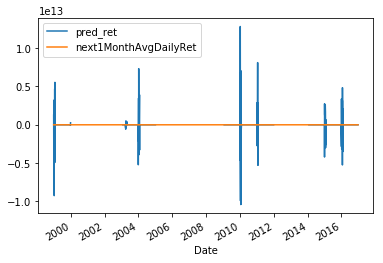

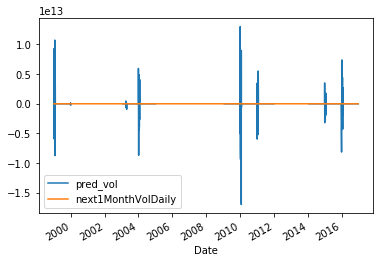

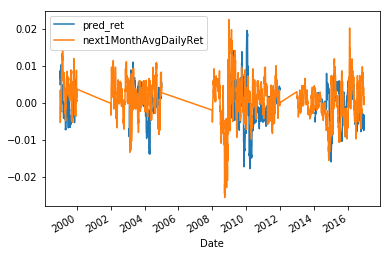

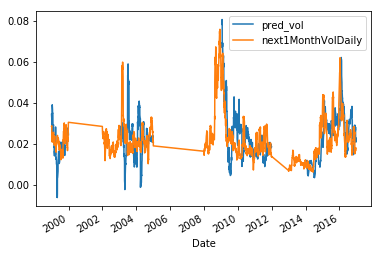

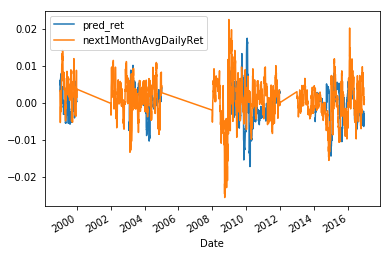

...

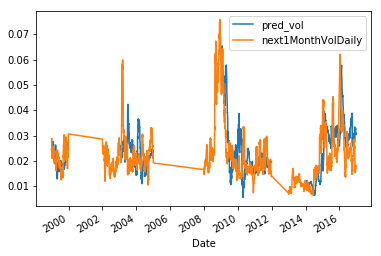

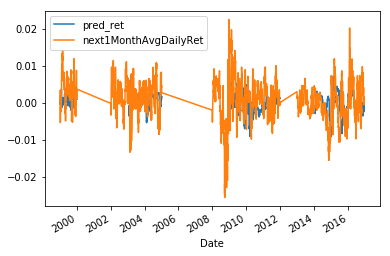

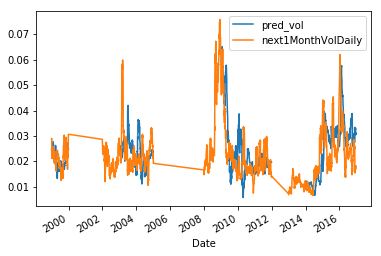

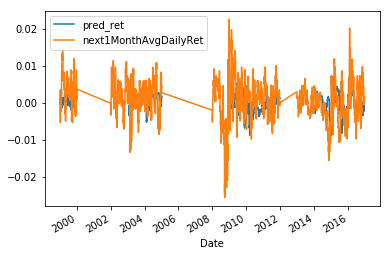

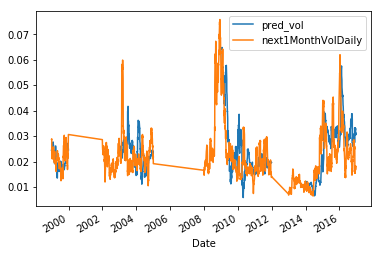

In [256]:
def parameterTune(run):
    if run  == True:
        alpha_list = [x/10 for x in range(20)]
        output = pd.DataFrame(columns=['alpha','rmse_r','rmse_v','days_in','tot_error'])
        output['alpha'] = pd.Series(alpha_list)
        for a in alpha_list:
            m_ridge = Ridge(alpha=a,random_state=10)
            Prediction_1M_ridge = prediction(response_data.next1MonthAvgDailyRet,response_data.next1MonthVolDaily,m_ridge,m_ridge,1,2,1)
            error = get_error(Prediction_1M_ridge,1)
            output.loc[output['alpha']==a,'rmse_r':'tot_error'] = [e for e in error]
        return output
    else:
        print('need to confirm to run')

ridge_tune = parameterTune(True)


array([<matplotlib.axes._subplots.AxesSubplot object at 0x00000205538DC8D0>,
      dtype=object)

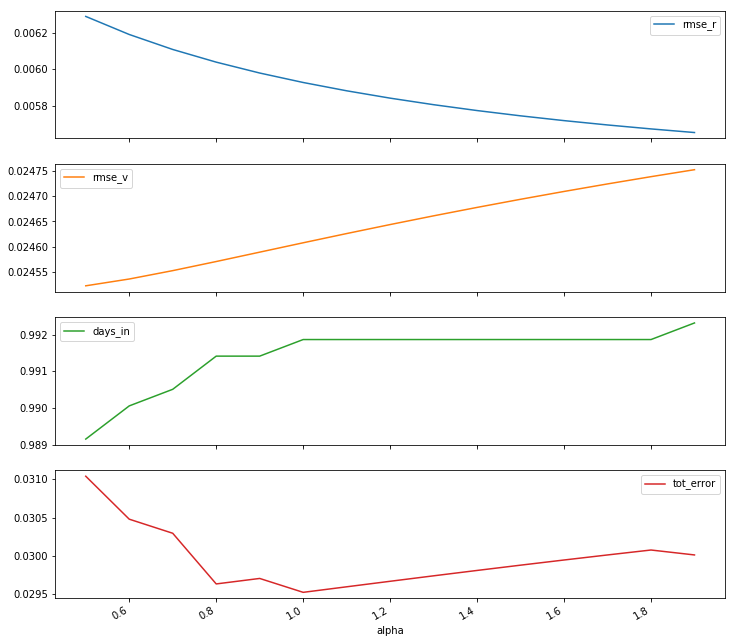

In [290]:
ridge_tune.set_index('alpha').iloc[5:,:].plot(subplots=True,figsize=(12,12))

In [271]:
ridge_tune.to_pickle('ridge_tune.pkl')

1998-12-31 00:00:00
mse of training: 1.3011334009764318e-05
predicted value: 0.00032299553348005654
1999-01-04 00:00:00
mse of training: 1.386802857361983e-05
predicted value: 0.0017282985963722759
1999-01-05 00:00:00
mse of training: 1.3908855605550075e-05
predicted value: 0.0017365169481020713
1999-01-06 00:00:00
mse of training: 1.4147683668876738e-05
predicted value: 0.0018917030026138117
1999-01-07 00:00:00
mse of training: 1.4440715370380872e-05
predicted value: 0.0020497373292700915
1999-01-08 00:00:00
mse of training: 1.4760913236074383e-05
predicted value: 0.002184990893499
1999-01-11 00:00:00
mse of training: 1.5450168803106228e-05
predicted value: 0.002722252396701423
1999-01-12 00:00:00
mse of training: 1.5494750588516733e-05
predicted value: 0.002722495059636303
1999-01-13 00:00:00
mse of training: 1.550025327612914e-05
predicted value: 0.0028050870467824333
1999-01-14 00:00:00
mse of training: 1.548524498247768e-05
predicted value: 0.002846171668948093
1999-01-15 00:00:00

mse of training: 1.7001116733783462e-05
predicted value: 0.000556302421259855
1999-05-25 00:00:00
mse of training: 1.705098327603285e-05
predicted value: 0.0006182841598031744
1999-05-26 00:00:00
mse of training: 1.7044699073668004e-05
predicted value: 0.0007337205060478011
1999-05-27 00:00:00
mse of training: 1.7038283708216545e-05
predicted value: 0.0007251041323982493
1999-05-28 00:00:00
mse of training: 1.7040159759048854e-05
predicted value: 0.003804435583073945
1999-06-01 00:00:00
mse of training: 1.7007332950725162e-05
predicted value: 0.0037853172654035115
1999-06-02 00:00:00
mse of training: 1.6982937426957156e-05
predicted value: 0.0037831910224321655
1999-06-03 00:00:00
mse of training: 1.6962514979162935e-05
predicted value: 0.0036958978930696183
1999-06-04 00:00:00
mse of training: 1.6922048423214374e-05
predicted value: 0.0013568605102896314
1999-06-07 00:00:00
mse of training: 1.688264576857556e-05
predicted value: 0.001282390450886007
1999-06-08 00:00:00
mse of training

mse of training: 1.781298969356268e-05
predicted value: 0.00042562823219353604
1999-10-27 00:00:00
mse of training: 1.7835312817107532e-05
predicted value: 0.0003302327624786182
1999-10-28 00:00:00
mse of training: 1.7833147142274802e-05
predicted value: 0.000310055507984245
1999-10-29 00:00:00
mse of training: 1.7809688134697172e-05
predicted value: -0.0009829646696506156
1999-11-01 00:00:00
mse of training: 1.7630430742102328e-05
predicted value: -0.0013177992477120606
1999-11-02 00:00:00
mse of training: 1.757188579741385e-05
predicted value: -0.0014092424966066532
1999-11-03 00:00:00
mse of training: 1.7549432965564464e-05
predicted value: -0.0014201757835808591
1999-11-04 00:00:00
mse of training: 1.7499225187755402e-05
predicted value: -0.001538151936059308
1999-11-05 00:00:00
mse of training: 1.7324554795804582e-05
predicted value: -0.0015689815622594132
1999-11-08 00:00:00
mse of training: 1.7383808863143588e-05
predicted value: -0.001313568976697519
1999-11-09 00:00:00
mse of 

mse of training: 9.25521444353863e-06
predicted value: -0.001862625185665189
2003-01-31 00:00:00
mse of training: 9.25521444353863e-06
predicted value: -0.003943121039359156
2003-02-03 00:00:00
mse of training: 9.182000547854301e-06
predicted value: -0.004525992138410151
2003-02-04 00:00:00
mse of training: 9.182000547854301e-06
predicted value: -0.004605763399947923
2003-02-05 00:00:00
mse of training: 9.181719530650523e-06
predicted value: -0.003931176732980213
2003-02-06 00:00:00
mse of training: 9.22113566123775e-06
predicted value: -0.003017046218601568
2003-02-07 00:00:00
mse of training: 9.263498086972545e-06
predicted value: -0.0008027163208335587
2003-02-10 00:00:00
mse of training: 9.339483891209652e-06
predicted value: 0.00031211605085152425
2003-02-11 00:00:00
mse of training: 9.339483891209652e-06
predicted value: 0.0003639877147089466
2003-02-12 00:00:00
mse of training: 9.470992081215475e-06
predicted value: 0.0012299329246092776
2003-02-13 00:00:00
mse of training: 9.54

mse of training: 1.5110044907218993e-05
predicted value: 0.00028248748340193707
2003-07-01 00:00:00
mse of training: 1.5151148944323202e-05
predicted value: 0.00026902130856473684
2003-07-02 00:00:00
mse of training: 1.5166636342056195e-05
predicted value: 0.000269281282566265
2003-07-03 00:00:00
mse of training: 1.5175564060798045e-05
predicted value: 0.00021331747106376154
2003-07-07 00:00:00
mse of training: 1.5126846877216007e-05
predicted value: -9.556457780376341e-05
2003-07-08 00:00:00
mse of training: 1.5126846877216007e-05
predicted value: -0.0001332172460133431
2003-07-09 00:00:00
mse of training: 1.5150145786879668e-05
predicted value: -0.00021043608937976188
2003-07-10 00:00:00
mse of training: 1.5164601282060565e-05
predicted value: -0.00020621841333613288
2003-07-11 00:00:00
mse of training: 1.517581726528224e-05
predicted value: 0.00032877953108513807
2003-07-14 00:00:00
mse of training: 1.5034511599888835e-05
predicted value: 0.0003724768077204791
2003-07-15 00:00:00
ms

mse of training: 1.4450360522562637e-05
predicted value: 0.0006396994212230604
2003-11-07 00:00:00
mse of training: 1.4353283031452797e-05
predicted value: -0.0002597284385654399
2003-11-10 00:00:00
mse of training: 1.429165513511147e-05
predicted value: -0.0003055640885803075
2003-11-11 00:00:00
mse of training: 1.429165513511147e-05
predicted value: -0.0004907807399803813
2003-11-12 00:00:00
mse of training: 1.429158737131115e-05
predicted value: -0.0003311934123605628
2003-11-13 00:00:00
mse of training: 1.429343537301524e-05
predicted value: -0.0003810664079690494
2003-11-14 00:00:00
mse of training: 1.4292505124191885e-05
predicted value: -0.0004044272658688284
2003-11-17 00:00:00
mse of training: 1.4257916559299572e-05
predicted value: -0.00022580044320065842
2003-11-18 00:00:00
mse of training: 1.4291721829816638e-05
predicted value: -0.0003097112886380725
2003-11-19 00:00:00
mse of training: 1.4320074896313445e-05
predicted value: -7.14364370348105e-05
2003-11-20 00:00:00
mse o

mse of training: 1.401140550269487e-05
predicted value: -0.0006215892864941007
2004-03-26 00:00:00
mse of training: 1.3825736276877776e-05
predicted value: 5.6330541209085845e-05
2004-03-29 00:00:00
mse of training: 1.357376916693129e-05
predicted value: 4.3041722929436756e-05
2004-03-30 00:00:00
mse of training: 1.3271298764519308e-05
predicted value: -0.00018923436974870207
2004-03-31 00:00:00
mse of training: 1.2930350726270248e-05
predicted value: -0.0025301691565704455
2004-04-01 00:00:00
mse of training: 1.2565108010691788e-05
predicted value: -0.0025923555139428997
2004-04-02 00:00:00
mse of training: 1.2075729755076074e-05
predicted value: -0.0037239527457518865
2004-04-05 00:00:00
mse of training: 1.1881855886511194e-05
predicted value: -0.0038106010957262757
2004-04-06 00:00:00
mse of training: 1.1826207722589348e-05
predicted value: -0.0038250560086225574
2004-04-07 00:00:00
mse of training: 1.1815795077993746e-05
predicted value: -0.003922552285057229
2004-04-08 00:00:00
ms

mse of training: 9.41399363814305e-06
predicted value: 0.0013607298408080497
2004-08-16 00:00:00
mse of training: 9.413025756564414e-06
predicted value: 0.0015551496855526134
2004-08-17 00:00:00
mse of training: 9.447768306801632e-06
predicted value: 0.0016082218972556144
2004-08-18 00:00:00
mse of training: 9.518521001187716e-06
predicted value: 0.001876050543571258
2004-08-19 00:00:00
mse of training: 9.563748005375765e-06
predicted value: 0.0021122835558887764
2004-08-20 00:00:00
mse of training: 9.601788648662882e-06
predicted value: 0.002856973706925371
2004-08-23 00:00:00
mse of training: 9.53622300923951e-06
predicted value: 0.0030718055436014247
2004-08-24 00:00:00
mse of training: 9.485299297947655e-06
predicted value: 0.0031938171512341457
2004-08-25 00:00:00
mse of training: 9.459094496543413e-06
predicted value: 0.0033195729069121476
2004-08-26 00:00:00
mse of training: 9.376148537449215e-06
predicted value: 0.003308888868519329
2004-08-27 00:00:00
mse of training: 9.342494

mse of training: 1.050200706485545e-05
predicted value: 0.0014166310758900466
2004-12-28 00:00:00
mse of training: 1.0506054146683945e-05
predicted value: 0.0012749066564475813
2004-12-29 00:00:00
mse of training: 1.048247999517143e-05
predicted value: 0.0009598101461332359
2004-12-30 00:00:00
mse of training: 1.046383658704107e-05
predicted value: 0.0009832053940674124
2005-01-03 00:00:00
mse of training: 1.0367143820437624e-05
predicted value: 0.0019955732169479132
2005-01-04 00:00:00
mse of training: 1.0377745199061982e-05
predicted value: 0.001892685953783002
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31

mse of training: 2.2990047661906413e-05
predicted value: -0.0018304161938790253
2009-03-04 00:00:00
mse of training: 2.2904205222662035e-05
predicted value: -0.0018362809771564417
2009-03-05 00:00:00
mse of training: 2.2837370204001764e-05
predicted value: 0.0015496937667602746
2009-03-06 00:00:00
mse of training: 2.279017810233893e-05
predicted value: 0.00490969110282552
2009-03-09 00:00:00
mse of training: 2.2694909201516792e-05
predicted value: 0.00503002782608291
2009-03-10 00:00:00
mse of training: 2.2694909201516792e-05
predicted value: 0.005364251968660506
2009-03-11 00:00:00
mse of training: 2.265667662731501e-05
predicted value: 0.005944463317226076
2009-03-12 00:00:00
mse of training: 2.2660964355803816e-05
predicted value: 0.0058806050133267534
2009-03-13 00:00:00
mse of training: 2.276196013786789e-05
predicted value: 0.0014567974562307781
2009-03-16 00:00:00
mse of training: 2.322761657844148e-05
predicted value: 0.002442859293036212
2009-03-17 00:00:00
mse of training: 2.

mse of training: 2.4624735454943555e-05
predicted value: 0.0021902660350855627
2009-07-06 00:00:00
mse of training: 2.4884206219243556e-05
predicted value: 0.0029241117587814128
2009-07-07 00:00:00
mse of training: 2.4884206219243556e-05
predicted value: 0.003121946054673863
2009-07-08 00:00:00
mse of training: 2.511809923833635e-05
predicted value: 0.0030960349921120636
2009-07-09 00:00:00
mse of training: 2.5429850389966263e-05
predicted value: 0.002739078575749676
2009-07-10 00:00:00
mse of training: 2.5756296038471513e-05
predicted value: 0.0027073115582954208
2009-07-13 00:00:00
mse of training: 2.6448790326525136e-05
predicted value: 0.001944596722157542
2009-07-14 00:00:00
mse of training: 2.65095104182305e-05
predicted value: 0.001877112555654939
2009-07-15 00:00:00
mse of training: 2.6652981832526e-05
predicted value: 0.0015659536511272026
2009-07-16 00:00:00
mse of training: 2.6752733437030284e-05
predicted value: 0.0013644858699722803
2009-07-17 00:00:00
mse of training: 2.6

mse of training: 2.5696254374991265e-05
predicted value: -0.005673204670392722
2009-11-16 00:00:00
mse of training: 2.5503063565257116e-05
predicted value: -0.0062066803342913784
2009-11-17 00:00:00
mse of training: 2.5287096362375274e-05
predicted value: -0.006454144928729019
2009-11-18 00:00:00
mse of training: 2.4944602030463347e-05
predicted value: -0.006913409360629723
2009-11-19 00:00:00
mse of training: 2.4481223937482993e-05
predicted value: -0.007149275956605118
2009-11-20 00:00:00
mse of training: 2.405129609867494e-05
predicted value: -0.008618779450631157
2009-11-23 00:00:00
mse of training: 2.398164214325368e-05
predicted value: -0.008954255048498054
2009-11-24 00:00:00
mse of training: 2.397434616545305e-05
predicted value: -0.008885177905288373
2009-11-25 00:00:00
mse of training: 2.3810327172575423e-05
predicted value: -0.009028740793310674
2009-11-27 00:00:00
mse of training: 2.3430478613267556e-05
predicted value: -0.009151120419264445
2009-11-30 00:00:00
mse of train

mse of training: 1.8887421701618572e-05
predicted value: -0.0029545559682131128
2010-04-09 00:00:00
mse of training: 1.9043984984489314e-05
predicted value: -0.0029765439679943764
2010-04-12 00:00:00
mse of training: 1.911395004632533e-05
predicted value: -0.0024146745979857363
2010-04-13 00:00:00
mse of training: 1.902244427641815e-05
predicted value: -0.0023843450836618808
2010-04-14 00:00:00
mse of training: 1.8937913764513923e-05
predicted value: -0.002447628776583581
2010-04-15 00:00:00
mse of training: 1.8894110638750652e-05
predicted value: -0.0024062701885251905
2010-04-16 00:00:00
mse of training: 1.8815295129180065e-05
predicted value: -0.0010632444007401091
2010-04-19 00:00:00
mse of training: 1.8865304609618423e-05
predicted value: -0.00048701849475389983
2010-04-20 00:00:00
mse of training: 1.893648328260264e-05
predicted value: -0.0007324412928699873
2010-04-21 00:00:00
mse of training: 1.8870734399635767e-05
predicted value: -0.0009293708975526708
2010-04-22 00:00:00
mse

mse of training: 9.797312751285486e-06
predicted value: -0.002190720762655739
2010-09-08 00:00:00
mse of training: 9.718330222631933e-06
predicted value: -0.002400342416920491
2010-09-09 00:00:00
mse of training: 9.626199940398577e-06
predicted value: -0.0023241470077459588
2010-09-10 00:00:00
mse of training: 9.435256010687005e-06
predicted value: -0.0023962566246088137
2010-09-13 00:00:00
mse of training: 9.134295503723551e-06
predicted value: -0.0024773180462479595
2010-09-14 00:00:00
mse of training: 8.935713792145989e-06
predicted value: -0.0025671850099317772
2010-09-15 00:00:00
mse of training: 8.887891573808711e-06
predicted value: -0.0025217173658267575
2010-09-16 00:00:00
mse of training: 8.853172948529035e-06
predicted value: -0.0023021654286002526
2010-09-17 00:00:00
mse of training: 8.737608385615447e-06
predicted value: -0.0020292480274285846
2010-09-20 00:00:00
mse of training: 8.538935867108902e-06
predicted value: -0.0022647431596576027
2010-09-21 00:00:00
mse of train

mse of training: 8.338356161800387e-06
predicted value: -0.0005687839190951713
2011-02-01 00:00:00
mse of training: 8.362398932049411e-06
predicted value: -0.000532698342539429
2011-02-02 00:00:00
mse of training: 8.359005349914738e-06
predicted value: -0.0008246787341042831
2011-02-03 00:00:00
mse of training: 8.33245081239113e-06
predicted value: -0.0008793263465135259
2011-02-04 00:00:00
mse of training: 8.301347264718663e-06
predicted value: -0.0020268940903715033
2011-02-07 00:00:00
mse of training: 8.248482576268957e-06
predicted value: -0.0018054866557451962
2011-02-08 00:00:00
mse of training: 8.1631243918084e-06
predicted value: -0.0018570363025644868
2011-02-09 00:00:00
mse of training: 8.080542304347308e-06
predicted value: -0.0019060183155934773
2011-02-10 00:00:00
mse of training: 7.990679809650441e-06
predicted value: -0.0021066893004726556
2011-02-11 00:00:00
mse of training: 7.867312352075888e-06
predicted value: -0.001681418422216075
2011-02-14 00:00:00
mse of training

mse of training: 7.984546003765516e-06
predicted value: 9.230507115383368e-05
2011-06-22 00:00:00
mse of training: 7.892473782096871e-06
predicted value: -0.00012564668078827654
2011-06-23 00:00:00
mse of training: 7.765486860153944e-06
predicted value: 0.0002899738482421803
2011-06-24 00:00:00
mse of training: 7.622635734047664e-06
predicted value: 0.000433872227824577
2011-06-27 00:00:00
mse of training: 7.488585729650097e-06
predicted value: 0.0002862985508912518
2011-06-28 00:00:00
mse of training: 7.443645062744603e-06
predicted value: 5.283006480191581e-05
2011-06-29 00:00:00
mse of training: 7.387826823186099e-06
predicted value: -0.00016215929999564144
2011-06-30 00:00:00
mse of training: 7.310603377499058e-06
predicted value: -0.0021581352016224065
2011-07-01 00:00:00
mse of training: 7.2233694422030025e-06
predicted value: -0.0019152106730333796
2011-07-05 00:00:00
mse of training: 7.150624781192472e-06
predicted value: -0.0021146720207959185
2011-07-06 00:00:00
mse of traini

mse of training: 7.42852517125606e-06
predicted value: 0.0006996106023428959
2011-11-03 00:00:00
mse of training: 7.448280173547577e-06
predicted value: 0.0007611843427471343
2011-11-04 00:00:00
mse of training: 7.414175657206083e-06
predicted value: 0.0012445050510557932
2011-11-07 00:00:00
mse of training: 7.355213409601855e-06
predicted value: 0.0013084073999784715
2011-11-08 00:00:00
mse of training: 7.353210309352247e-06
predicted value: 0.001173297322957366
2011-11-09 00:00:00
mse of training: 7.238976636424194e-06
predicted value: 0.0014437791285257136
2011-11-10 00:00:00
mse of training: 7.234597035704569e-06
predicted value: 0.001333913496168836
2011-11-11 00:00:00
mse of training: 7.249501886883252e-06
predicted value: 0.00030336597131744997
2011-11-14 00:00:00
mse of training: 7.271087484047704e-06
predicted value: 4.548508796133749e-05
2011-11-15 00:00:00
mse of training: 7.271087484047704e-06
predicted value: -4.5086726289219475e-05
2011-11-16 00:00:00
mse of training: 7.2

mse of training: 2.3947425903517192e-06
predicted value: -0.003284997433299606
2014-01-29 00:00:00
mse of training: 2.3888634350715583e-06
predicted value: -0.0036198261241793383
2014-01-30 00:00:00
mse of training: 2.379552703699117e-06
predicted value: -0.003086809750984458
2014-01-31 00:00:00
mse of training: 2.379552703699117e-06
predicted value: -0.0029913654519717354
2014-02-03 00:00:00
mse of training: 2.3695976717797233e-06
predicted value: -0.0017460322389957952
2014-02-04 00:00:00
mse of training: 2.3695976717797233e-06
predicted value: -0.0018677820284592837
2014-02-05 00:00:00
mse of training: 2.3693613637620813e-06
predicted value: -0.001492515437440941
2014-02-06 00:00:00
mse of training: 2.3757148861160223e-06
predicted value: -0.0010492120706344765
2014-02-07 00:00:00
mse of training: 2.3907125246250624e-06
predicted value: -0.0006252193608144874
2014-02-10 00:00:00
mse of training: 2.4168639919569114e-06
predicted value: 2.1878807935206065e-05
2014-02-11 00:00:00
mse o

mse of training: 2.151433514569531e-06
predicted value: 0.0015119161885533954
2014-06-26 00:00:00
mse of training: 2.1490235157320533e-06
predicted value: 0.0015283736238624682
2014-06-27 00:00:00
mse of training: 2.146859531024428e-06
predicted value: 0.0015151199570345442
2014-06-30 00:00:00
mse of training: 2.1272417319416436e-06
predicted value: 0.0004779782444783269
2014-07-01 00:00:00
mse of training: 2.122942020644632e-06
predicted value: 0.00046538243699731363
2014-07-02 00:00:00
mse of training: 2.114473026184246e-06
predicted value: 0.0004855936857064841
2014-07-03 00:00:00
mse of training: 2.1091037710255225e-06
predicted value: 0.0004715076138508967
2014-07-07 00:00:00
mse of training: 2.0939230355206222e-06
predicted value: 0.0004919816742731831
2014-07-08 00:00:00
mse of training: 2.0939230355206222e-06
predicted value: 0.0005114050367768207
2014-07-09 00:00:00
mse of training: 2.101076548766605e-06
predicted value: 0.00046494810250953013
2014-07-10 00:00:00
mse of traini

mse of training: 2.183979071091181e-06
predicted value: 0.0017761052509971146
2014-11-06 00:00:00
mse of training: 2.186186615478812e-06
predicted value: 0.0017158498621793195
2014-11-07 00:00:00
mse of training: 2.1785045232623303e-06
predicted value: 0.0026281949617635667
2014-11-10 00:00:00
mse of training: 2.1708834174095664e-06
predicted value: 0.0024711950286390606
2014-11-11 00:00:00
mse of training: 2.1708834174095664e-06
predicted value: 0.002138997831918443
2014-11-12 00:00:00
mse of training: 2.1743210119882945e-06
predicted value: 0.0022565971023011866
2014-11-13 00:00:00
mse of training: 2.1564984483403432e-06
predicted value: 0.002273394693075025
2014-11-14 00:00:00
mse of training: 2.1350516442389146e-06
predicted value: 0.002016231304259035
2014-11-17 00:00:00
mse of training: 2.182443585032679e-06
predicted value: 0.0016822163566780155
2014-11-18 00:00:00
mse of training: 2.18841043434249e-06
predicted value: 0.0017413263726793514
2014-11-19 00:00:00
mse of training: 2

mse of training: 6.0474163895358914e-06
predicted value: 0.002233310115707283
2015-03-25 00:00:00
mse of training: 5.9836817318495985e-06
predicted value: 0.002346733775932531
2015-03-26 00:00:00
mse of training: 5.932817338479037e-06
predicted value: 0.0023114476512743273
2015-03-27 00:00:00
mse of training: 5.863036859595557e-06
predicted value: 0.002931641911224219
2015-03-30 00:00:00
mse of training: 5.8355889741276365e-06
predicted value: 0.0027519514838378932
2015-03-31 00:00:00
mse of training: 5.8553549267639814e-06
predicted value: 0.0016765070309933197
2015-04-01 00:00:00
mse of training: 5.839231409822004e-06
predicted value: 0.0017353017492151273
2015-04-02 00:00:00
mse of training: 5.812284717665571e-06
predicted value: 0.0016565137371118317
2015-04-03 00:00:00
mse of training: 5.797302177052448e-06
predicted value: 0.0002392208633567594
2015-04-06 00:00:00
mse of training: 5.757971060540609e-06
predicted value: 0.00028164684819136174
2015-04-07 00:00:00
mse of training: 5

mse of training: 9.712431726871932e-06
predicted value: -0.004604223059536491
2015-07-28 00:00:00
mse of training: 9.730807377782577e-06
predicted value: -0.004598646385186345
2015-07-29 00:00:00
mse of training: 9.785958727706613e-06
predicted value: -0.004794574992427731
2015-07-30 00:00:00
mse of training: 9.869515288736624e-06
predicted value: -0.005249733659296474
2015-07-31 00:00:00
mse of training: 9.899279193056233e-06
predicted value: -0.004882059831416395
2015-08-03 00:00:00
mse of training: 9.986447846291267e-06
predicted value: -0.005440236778564777
2015-08-04 00:00:00
mse of training: 9.986447846291267e-06
predicted value: -0.005431244276762874
2015-08-05 00:00:00
mse of training: 9.934985532158401e-06
predicted value: -0.0056744366417274825
2015-08-06 00:00:00
mse of training: 9.868096930139114e-06
predicted value: -0.005762677840281524
2015-08-07 00:00:00
mse of training: 9.811451823244603e-06
predicted value: -0.0061870836922639375
2015-08-10 00:00:00
mse of training: 9

mse of training: 1.2748048550403473e-05
predicted value: -0.0048462367249799375
2015-11-26 00:00:00
mse of training: 1.2750473703693523e-05
predicted value: -0.0060695975143675905
2015-11-27 00:00:00
mse of training: 1.2745244570118766e-05
predicted value: -0.0032670887640503
2015-11-30 00:00:00
mse of training: 1.270841056461903e-05
predicted value: -0.0030738422483332934
2015-12-01 00:00:00
mse of training: 1.2732536848242399e-05
predicted value: -0.0030381713921962244
2015-12-02 00:00:00
mse of training: 1.2728791693068732e-05
predicted value: -0.0029034114964064193
2015-12-03 00:00:00
mse of training: 1.2712252680960084e-05
predicted value: -0.0030426298314689794
2015-12-04 00:00:00
mse of training: 1.2696618391629434e-05
predicted value: -0.0012264064166699002
2015-12-07 00:00:00
mse of training: 1.2619442145250956e-05
predicted value: -0.0011227342179885831
2015-12-08 00:00:00
mse of training: 1.261860710366785e-05
predicted value: -0.0011197266413922593
2015-12-09 00:00:00
mse o

mse of training: 1.4803615197893225e-05
predicted value: 0.0012674638018709515
2016-04-21 00:00:00
mse of training: 1.473986171194647e-05
predicted value: 0.0012283666123769363
2016-04-22 00:00:00
mse of training: 1.4694726760362449e-05
predicted value: 0.0022035441434603738
2016-04-25 00:00:00
mse of training: 1.466654206817753e-05
predicted value: 0.0022934173940614977
2016-04-26 00:00:00
mse of training: 1.4659884945531486e-05
predicted value: 0.002104741898798803
2016-04-27 00:00:00
mse of training: 1.4827911511143812e-05
predicted value: 0.0021414835523555125
2016-04-28 00:00:00
mse of training: 1.5037644084021525e-05
predicted value: 0.00216205570542976
2016-04-29 00:00:00
mse of training: 1.5235591359864616e-05
predicted value: 0.0023113006571693117
2016-05-02 00:00:00
mse of training: 1.5483397210480677e-05
predicted value: 0.0028152428828617003
2016-05-03 00:00:00
mse of training: 1.5529659433740964e-05
predicted value: 0.0029790463940724135
2016-05-04 00:00:00
mse of training

mse of training: 1.446480773236651e-05
predicted value: 0.003024015211996735
2016-09-15 00:00:00
mse of training: 1.438404167530127e-05
predicted value: 0.003001888425802057
2016-09-16 00:00:00
mse of training: 1.4245004911873964e-05
predicted value: 0.0031942337830420595
2016-09-19 00:00:00
mse of training: 1.4161166759596234e-05
predicted value: 0.0031754260825734397
2016-09-20 00:00:00
mse of training: 1.4167048286418052e-05
predicted value: 0.0032653608265632485
2016-09-21 00:00:00
mse of training: 1.4154876616223527e-05
predicted value: 0.0031754680736739756
2016-09-22 00:00:00
mse of training: 1.4064674231698341e-05
predicted value: 0.0031822495304919185
2016-09-23 00:00:00
mse of training: 1.3957295767043754e-05
predicted value: 0.0018318648336034821
2016-09-26 00:00:00
mse of training: 1.384959485697746e-05
predicted value: 0.0018107894159489542
2016-09-27 00:00:00
mse of training: 1.3828538709757647e-05
predicted value: 0.0019905034084042456
2016-09-28 00:00:00
mse of training

mse of training: 5.0541781154695896e-05
predicted value: 0.026995128961578102
1999-02-04 00:00:00
mse of training: 5.034405810296998e-05
predicted value: 0.026757086540101588
1999-02-05 00:00:00
mse of training: 5.014610276618388e-05
predicted value: 0.026921674937582962
1999-02-08 00:00:00
mse of training: 4.983980928707259e-05
predicted value: 0.026807704662945353
1999-02-09 00:00:00
mse of training: 4.969993629204078e-05
predicted value: 0.02676254547761369
1999-02-10 00:00:00
mse of training: 4.945028274608724e-05
predicted value: 0.02694153649920803
1999-02-11 00:00:00
mse of training: 4.9161722810112076e-05
predicted value: 0.026997614765624317
1999-02-12 00:00:00
mse of training: 4.884436341037082e-05
predicted value: 0.024851855359647693
1999-02-16 00:00:00
mse of training: 4.81844223527624e-05
predicted value: 0.023951586713327158
1999-02-17 00:00:00
mse of training: 4.807335359213723e-05
predicted value: 0.02394020567033299
1999-02-18 00:00:00
mse of training: 4.7818692575470

mse of training: 4.6230559472973005e-05
predicted value: 0.016645131796136928
1999-06-29 00:00:00
mse of training: 4.631745206159411e-05
predicted value: 0.01662780529575747
1999-06-30 00:00:00
mse of training: 4.6393355659816886e-05
predicted value: 0.015476832672000784
1999-07-01 00:00:00
mse of training: 4.633279441544251e-05
predicted value: 0.015428421651252341
1999-07-02 00:00:00
mse of training: 4.628060757581292e-05
predicted value: 0.01821251996481696
1999-07-06 00:00:00
mse of training: 4.6208773399602894e-05
predicted value: 0.01823941878891968
1999-07-07 00:00:00
mse of training: 4.623908779060362e-05
predicted value: 0.018192728286817186
1999-07-08 00:00:00
mse of training: 4.626042111640096e-05
predicted value: 0.01808365030494488
1999-07-09 00:00:00
mse of training: 4.628487416040947e-05
predicted value: 0.019582848049381846
1999-07-12 00:00:00
mse of training: 4.623353132297403e-05
predicted value: 0.019490869515981724
1999-07-13 00:00:00
mse of training: 4.615134275817

mse of training: 2.2144336225529904e-05
predicted value: 0.02291784111950154
1999-11-15 00:00:00
mse of training: 2.1802436061597474e-05
predicted value: 0.02300151642135488
1999-11-16 00:00:00
mse of training: 2.1605291594802067e-05
predicted value: 0.023082783636980422
1999-11-17 00:00:00
mse of training: 2.128641901081163e-05
predicted value: 0.023330596844845918
1999-11-18 00:00:00
mse of training: 2.084177890293643e-05
predicted value: 0.023422195910088327
1999-11-19 00:00:00
mse of training: 2.024850161732644e-05
predicted value: 0.02579678405638691
1999-11-22 00:00:00
mse of training: 1.944266966933398e-05
predicted value: 0.0260462484659562
1999-11-23 00:00:00
mse of training: 1.892506125547343e-05
predicted value: 0.026170932345512512
1999-11-24 00:00:00
mse of training: 1.8390603516434217e-05
predicted value: 0.026363355930205192
1999-11-26 00:00:00
mse of training: 1.6938549204865463e-05
predicted value: 0.02487047935176413
1999-11-29 00:00:00
mse of training: 1.615022576333

mse of training: 8.69192018786785e-06
predicted value: 0.023501357105418078
2003-02-04 00:00:00
mse of training: 8.69192018786785e-06
predicted value: 0.023438092273666736
2003-02-05 00:00:00
mse of training: 8.714195589779378e-06
predicted value: 0.022544566699563694
2003-02-06 00:00:00
mse of training: 8.737951420487456e-06
predicted value: 0.021758640419811612
2003-02-07 00:00:00
mse of training: 8.739931150379254e-06
predicted value: 0.021063685540262465
2003-02-10 00:00:00
mse of training: 8.719925610279142e-06
predicted value: 0.020569232341136577
2003-02-11 00:00:00
mse of training: 8.719925610279142e-06
predicted value: 0.020549166706972207
2003-02-12 00:00:00
mse of training: 8.68894672946031e-06
predicted value: 0.020414931937953924
2003-02-13 00:00:00
mse of training: 8.65704641210997e-06
predicted value: 0.020260027902335723
2003-02-14 00:00:00
mse of training: 8.624618006249356e-06
predicted value: 0.022634259564912336
2003-02-18 00:00:00
mse of training: 8.595296379780046

mse of training: 3.077071594585379e-05
predicted value: 0.042418455142336164
2003-07-07 00:00:00
mse of training: 3.072252747001591e-05
predicted value: 0.04548232308641878
2003-07-08 00:00:00
mse of training: 3.072252747001591e-05
predicted value: 0.04563122609489531
2003-07-09 00:00:00
mse of training: 3.0736261895683415e-05
predicted value: 0.04561959546911783
2003-07-10 00:00:00
mse of training: 3.075336631207073e-05
predicted value: 0.045553252515381074
2003-07-11 00:00:00
mse of training: 3.077731682222152e-05
predicted value: 0.038873889406313276
2003-07-14 00:00:00
mse of training: 3.07547747580611e-05
predicted value: 0.03889869848190437
2003-07-15 00:00:00
mse of training: 3.083113372361323e-05
predicted value: 0.03899374901464157
2003-07-16 00:00:00
mse of training: 3.0884708566230833e-05
predicted value: 0.038911589448293704
2003-07-17 00:00:00
mse of training: 3.092234342507458e-05
predicted value: 0.03892096245524142
2003-07-18 00:00:00
mse of training: 3.0938031998336395

mse of training: 3.0787632945767875e-05
predicted value: 0.016363171609663732
2003-12-01 00:00:00
mse of training: 3.108380476094775e-05
predicted value: 0.017255396807983357
2003-12-02 00:00:00
mse of training: 3.115139470656489e-05
predicted value: 0.017375008757071934
2003-12-03 00:00:00
mse of training: 3.131469025762005e-05
predicted value: 0.01765249386298421
2003-12-04 00:00:00
mse of training: 3.147694326917243e-05
predicted value: 0.018186028136782155
2003-12-05 00:00:00
mse of training: 3.15462640253237e-05
predicted value: 0.018573828384842637
2003-12-08 00:00:00
mse of training: 3.153752839220679e-05
predicted value: 0.01899640854253657
2003-12-09 00:00:00
mse of training: 3.1573611022638814e-05
predicted value: 0.019126339314436372
2003-12-10 00:00:00
mse of training: 3.157023313646966e-05
predicted value: 0.019400646557603173
2003-12-11 00:00:00
mse of training: 3.158176411301838e-05
predicted value: 0.019490802130131282
2003-12-12 00:00:00
mse of training: 3.158842643118

mse of training: 3.249873099629498e-05
predicted value: 0.013403473368684702
2004-04-26 00:00:00
mse of training: 3.248364615218016e-05
predicted value: 0.013266622378671548
2004-04-27 00:00:00
mse of training: 3.256981929576657e-05
predicted value: 0.01323153907321327
2004-04-28 00:00:00
mse of training: 3.260360271694885e-05
predicted value: 0.0131763277525557
2004-04-29 00:00:00
mse of training: 3.2620827678625564e-05
predicted value: 0.012944600444733136
2004-04-30 00:00:00
mse of training: 3.265849474919588e-05
predicted value: 0.010496127683064517
2004-05-03 00:00:00
mse of training: 3.2588352080618004e-05
predicted value: 0.011294412494544638
2004-05-04 00:00:00
mse of training: 3.26747073792908e-05
predicted value: 0.01149750972912537
2004-05-05 00:00:00
mse of training: 3.2665494472298623e-05
predicted value: 0.011680065020463998
2004-05-06 00:00:00
mse of training: 3.264998923594092e-05
predicted value: 0.011800254561587134
2004-05-07 00:00:00
mse of training: 3.2634968428988

mse of training: 7.099149692273891e-06
predicted value: 0.018800854235093478
2004-09-14 00:00:00
mse of training: 7.045417640144904e-06
predicted value: 0.018867497407040974
2004-09-15 00:00:00
mse of training: 7.009181358016648e-06
predicted value: 0.0190819840755082
2004-09-16 00:00:00
mse of training: 6.974862179056117e-06
predicted value: 0.019209257663444855
2004-09-17 00:00:00
mse of training: 6.921351085480937e-06
predicted value: 0.019284484394298924
2004-09-20 00:00:00
mse of training: 6.9053018692307086e-06
predicted value: 0.01946039269489193
2004-09-21 00:00:00
mse of training: 6.882978036701539e-06
predicted value: 0.01951495832463434
2004-09-22 00:00:00
mse of training: 6.821553078487338e-06
predicted value: 0.019649474005930527
2004-09-23 00:00:00
mse of training: 6.753551364817772e-06
predicted value: 0.01970937604811044
2004-09-24 00:00:00
mse of training: 6.714770257397596e-06
predicted value: 0.020720241473880255
2004-09-27 00:00:00
mse of training: 6.670036314366991

2008-09-09 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-12 00:00:00
2008-09-15 00:00:00
2008-09-16 00:00:00
2008-09-17 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-22 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2008-09-25 00:00:00
2008-09-26 00:00:00
2008-09-29 00:00:00
2008-09-30 00:00:00
2008-10-01 00:00:00
2008-10-02 00:00:00
2008-10-03 00:00:00
2008-10-06 00:00:00
2008-10-07 00:00:00
2008-10-08 00:00:00
2008-10-09 00:00:00
2008-10-10 00:00:00
2008-10-13 00:00:00
2008-10-14 00:00:00
2008-10-15 00:00:00
2008-10-16 00:00:00
2008-10-17 00:00:00
2008-10-20 00:00:00
2008-10-21 00:00:00
2008-10-22 00:00:00
2008-10-23 00:00:00
2008-10-24 00:00:00
2008-10-27 00:00:00
2008-10-28 00:00:00
2008-10-29 00:00:00
2008-10-30 00:00:00
2008-10-31 00:00:00
2008-11-03 00:00:00
2008-11-04 00:00:00
2008-11-05 00:00:00
2008-11-06 00:00:00
2008-11-07 00:00:00
2008-11-10 00:00:00
2008-11-11 00:00:00
2008-11-12 00:00:00
2008-11-13 00:00:00
2008-11-14 00:00:00
2008-11-17 00:00:00


mse of training: 5.7249607852852146e-05
predicted value: 0.02448470211336478
2009-06-04 00:00:00
mse of training: 5.722856967627233e-05
predicted value: 0.023757545299890145
2009-06-05 00:00:00
mse of training: 5.721415824430334e-05
predicted value: 0.028304227780092568
2009-06-08 00:00:00
mse of training: 5.689769163209836e-05
predicted value: 0.028094416675082418
2009-06-09 00:00:00
mse of training: 5.689769163209836e-05
predicted value: 0.02737291367167652
2009-06-10 00:00:00
mse of training: 5.668513596698411e-05
predicted value: 0.0269005569111982
2009-06-11 00:00:00
mse of training: 5.64691873539912e-05
predicted value: 0.026079207739326468
2009-06-12 00:00:00
mse of training: 5.626360932883098e-05
predicted value: 0.024042818299635837
2009-06-15 00:00:00
mse of training: 5.584048024383774e-05
predicted value: 0.024572213116018135
2009-06-16 00:00:00
mse of training: 5.5806002308563375e-05
predicted value: 0.02442770751022199
2009-06-17 00:00:00
mse of training: 5.562285076174174

mse of training: 4.034784605637932e-05
predicted value: 0.01910491437396794
2009-10-26 00:00:00
mse of training: 3.994956563952536e-05
predicted value: 0.019463754324771917
2009-10-27 00:00:00
mse of training: 3.9623937462375994e-05
predicted value: 0.019722177479081296
2009-10-28 00:00:00
mse of training: 3.918363279570048e-05
predicted value: 0.02025677337135256
2009-10-29 00:00:00
mse of training: 3.866793449222711e-05
predicted value: 0.01983639505279912
2009-10-30 00:00:00
mse of training: 3.834731774301038e-05
predicted value: 0.02562913598698238
2009-11-02 00:00:00
mse of training: 3.857922250227373e-05
predicted value: 0.024819038205895046
2009-11-03 00:00:00
mse of training: 3.868165276831282e-05
predicted value: 0.024703203966125672
2009-11-04 00:00:00
mse of training: 3.8839962054848714e-05
predicted value: 0.024176624863488844
2009-11-05 00:00:00
mse of training: 3.892537148871957e-05
predicted value: 0.024162436411343823
2009-11-06 00:00:00
mse of training: 3.9011708759030

mse of training: 1.9465452974577346e-05
predicted value: 0.029302879145411687
2010-03-18 00:00:00
mse of training: 1.9718938972657335e-05
predicted value: 0.029391707515421514
2010-03-19 00:00:00
mse of training: 1.9911286681508288e-05
predicted value: 0.027194427507614395
2010-03-22 00:00:00
mse of training: 2.0220396809329806e-05
predicted value: 0.027206528640535
2010-03-23 00:00:00
mse of training: 2.0203576685922512e-05
predicted value: 0.027098451664970755
2010-03-24 00:00:00
mse of training: 2.027722380113888e-05
predicted value: 0.02731592671053732
2010-03-25 00:00:00
mse of training: 2.0306625016569165e-05
predicted value: 0.027297681746453407
2010-03-26 00:00:00
mse of training: 2.0227490710031255e-05
predicted value: 0.029534359325435043
2010-03-29 00:00:00
mse of training: 2.051055243010078e-05
predicted value: 0.028915137939472875
2010-03-30 00:00:00
mse of training: 2.05823623438686e-05
predicted value: 0.028860008015749644
2010-03-31 00:00:00
mse of training: 2.078027182

mse of training: 1.9390594541747203e-05
predicted value: 0.024126232343151147
2010-08-05 00:00:00
mse of training: 1.8985244593352064e-05
predicted value: 0.023891173936262416
2010-08-06 00:00:00
mse of training: 1.886741674498445e-05
predicted value: 0.02416894490649946
2010-08-09 00:00:00
mse of training: 1.8688501205634946e-05
predicted value: 0.023642359037203905
2010-08-10 00:00:00
mse of training: 1.857140152682622e-05
predicted value: 0.024093406640315167
2010-08-11 00:00:00
mse of training: 1.8377340055533517e-05
predicted value: 0.024423080712866557
2010-08-12 00:00:00
mse of training: 1.8183754295990264e-05
predicted value: 0.02452936435490664
2010-08-13 00:00:00
mse of training: 1.7860263818178263e-05
predicted value: 0.025070197036015804
2010-08-16 00:00:00
mse of training: 1.712705558899612e-05
predicted value: 0.024737207398476135
2010-08-17 00:00:00
mse of training: 1.672003008393074e-05
predicted value: 0.02465284371342082
2010-08-18 00:00:00
mse of training: 1.61995098

mse of training: 1.10968358603343e-05
predicted value: 0.014285127291272525
2010-12-23 00:00:00
mse of training: 1.1098479701323163e-05
predicted value: 0.014175567469466757
2010-12-27 00:00:00
mse of training: 1.1161958785634486e-05
predicted value: 0.01578862696755081
2010-12-28 00:00:00
mse of training: 1.119231312203247e-05
predicted value: 0.015768688919487385
2010-12-29 00:00:00
mse of training: 1.1248021533798448e-05
predicted value: 0.015677069801731898
2010-12-30 00:00:00
mse of training: 1.1331121942365928e-05
predicted value: 0.015670948295674513
2010-12-31 00:00:00
mse of training: 1.1460209945159384e-05
predicted value: 0.01762430478560351
2011-01-03 00:00:00
mse of training: 1.1679044195559689e-05
predicted value: 0.015417076475541521
2011-01-04 00:00:00
mse of training: 1.1687712748161564e-05
predicted value: 0.015618806687471721
2011-01-05 00:00:00
mse of training: 1.1694189469792124e-05
predicted value: 0.015634829053877954
2011-01-06 00:00:00
mse of training: 1.168685

mse of training: 1.1617764083854509e-05
predicted value: 0.018381885738636763
2011-05-06 00:00:00
mse of training: 1.1731337138725979e-05
predicted value: 0.018986720089319
2011-05-09 00:00:00
mse of training: 1.1908338617283802e-05
predicted value: 0.01920542426657237
2011-05-10 00:00:00
mse of training: 1.1931523199371988e-05
predicted value: 0.01915922338477161
2011-05-11 00:00:00
mse of training: 1.2063026378231716e-05
predicted value: 0.01971437533107817
2011-05-12 00:00:00
mse of training: 1.215389229658063e-05
predicted value: 0.01995282409665177
2011-05-13 00:00:00
mse of training: 1.2221921818708142e-05
predicted value: 0.01970666609250834
2011-05-16 00:00:00
mse of training: 1.2514946654851916e-05
predicted value: 0.02039635365962173
2011-05-17 00:00:00
mse of training: 1.2551146520150736e-05
predicted value: 0.020458354988293775
2011-05-18 00:00:00
mse of training: 1.2732727791410425e-05
predicted value: 0.0206578822001608
2011-05-19 00:00:00
mse of training: 1.2908779764148

mse of training: 1.6025696502027003e-05
predicted value: 0.01704351189784213
2011-10-05 00:00:00
mse of training: 1.5875000732180053e-05
predicted value: 0.016981846830724512
2011-10-06 00:00:00
mse of training: 1.5967333917109856e-05
predicted value: 0.01707631022688168
2011-10-07 00:00:00
mse of training: 1.600955714148255e-05
predicted value: 0.0185670813079445
2011-10-10 00:00:00
mse of training: 1.6202293023011507e-05
predicted value: 0.01871431366064933
2011-10-11 00:00:00
mse of training: 1.616511918463609e-05
predicted value: 0.01881929434082375
2011-10-12 00:00:00
mse of training: 1.6180676499325296e-05
predicted value: 0.01902802994433143
2011-10-13 00:00:00
mse of training: 1.616668464652003e-05
predicted value: 0.019292412729529487
2011-10-14 00:00:00
mse of training: 1.6131257491505794e-05
predicted value: 0.019571208242591693
2011-10-17 00:00:00
mse of training: 1.6068975418042984e-05
predicted value: 0.019800615899071457
2011-10-18 00:00:00
mse of training: 1.59469974927

mse of training: 2.5113154710072086e-06
predicted value: 0.010427810395636198
2014-02-04 00:00:00
mse of training: 2.5113154710072086e-06
predicted value: 0.01041240895694712
2014-02-05 00:00:00
mse of training: 2.5050460787666383e-06
predicted value: 0.010122775114823217
2014-02-06 00:00:00
mse of training: 2.495289989030275e-06
predicted value: 0.010101305502297625
2014-02-07 00:00:00
mse of training: 2.4866417239726334e-06
predicted value: 0.00965127939625756
2014-02-10 00:00:00
mse of training: 2.4700284211767874e-06
predicted value: 0.009479883478682555
2014-02-11 00:00:00
mse of training: 2.4700284211767874e-06
predicted value: 0.009501870175554206
2014-02-12 00:00:00
mse of training: 2.4675790318545073e-06
predicted value: 0.009362436986521325
2014-02-13 00:00:00
mse of training: 2.4635689499858595e-06
predicted value: 0.009205807582440037
2014-02-14 00:00:00
mse of training: 2.4612448769266134e-06
predicted value: 0.008613630155892785
2014-02-18 00:00:00
mse of training: 2.4537

mse of training: 2.1777976501818566e-06
predicted value: 0.006051211858538694
2014-07-09 00:00:00
mse of training: 2.174032803845639e-06
predicted value: 0.006002114346701302
2014-07-10 00:00:00
mse of training: 2.1702217040674462e-06
predicted value: 0.006032847440699181
2014-07-11 00:00:00
mse of training: 2.1680150105389233e-06
predicted value: 0.006047930997508671
2014-07-14 00:00:00
mse of training: 2.1624737955188555e-06
predicted value: 0.005926744920867305
2014-07-15 00:00:00
mse of training: 2.1653481030242746e-06
predicted value: 0.005922244725848075
2014-07-16 00:00:00
mse of training: 2.1614767629093603e-06
predicted value: 0.005968696019732969
2014-07-17 00:00:00
mse of training: 2.1565814441007654e-06
predicted value: 0.00601175014696184
2014-07-18 00:00:00
mse of training: 2.1548176662871937e-06
predicted value: 0.005993032038077406
2014-07-21 00:00:00
mse of training: 2.1508429818822905e-06
predicted value: 0.006125356223204069
2014-07-22 00:00:00
mse of training: 2.146

mse of training: 2.6864040392688573e-06
predicted value: 0.01168881360387422
2014-11-25 00:00:00
mse of training: 2.6948775624635807e-06
predicted value: 0.011722423654251801
2014-11-26 00:00:00
mse of training: 2.6994391303583616e-06
predicted value: 0.011825177119493421
2014-11-28 00:00:00
mse of training: 3.418383966995872e-06
predicted value: 0.013915910515786199
2014-12-01 00:00:00
mse of training: 4.203825667075414e-06
predicted value: 0.015499246070633192
2014-12-02 00:00:00
mse of training: 4.215372818101915e-06
predicted value: 0.015639197752396368
2014-12-03 00:00:00
mse of training: 4.533671521745139e-06
predicted value: 0.016473700381138566
2014-12-04 00:00:00
mse of training: 4.794128099943182e-06
predicted value: 0.017212559144157636
2014-12-05 00:00:00
mse of training: 4.9944406659093996e-06
predicted value: 0.017451489228595636
2014-12-08 00:00:00
mse of training: 5.43567432383312e-06
predicted value: 0.018974004971636566
2014-12-09 00:00:00
mse of training: 5.448611144

mse of training: 9.772913959445515e-06
predicted value: 0.03198474842158585
2015-04-20 00:00:00
mse of training: 9.75073992511275e-06
predicted value: 0.03200374310177525
2015-04-21 00:00:00
mse of training: 9.766333675827948e-06
predicted value: 0.03222402575111523
2015-04-22 00:00:00
mse of training: 9.766806611951247e-06
predicted value: 0.03210643485059132
2015-04-23 00:00:00
mse of training: 9.763668783276298e-06
predicted value: 0.031751902717678554
2015-04-24 00:00:00
mse of training: 9.75723243360135e-06
predicted value: 0.030852703810213346
2015-04-27 00:00:00
mse of training: 9.801225091828806e-06
predicted value: 0.030755425889517324
2015-04-28 00:00:00
mse of training: 9.816547199010544e-06
predicted value: 0.03065995576608751
2015-04-29 00:00:00
mse of training: 9.897440716638917e-06
predicted value: 0.03034680150162259
2015-04-30 00:00:00
mse of training: 1.0021034637023844e-05
predicted value: 0.030354325930686883
2015-05-01 00:00:00
mse of training: 1.0149113018502592e-

mse of training: 1.990774969256506e-05
predicted value: 0.02854636226061378
2015-09-03 00:00:00
mse of training: 2.0355586287847627e-05
predicted value: 0.028790760061420978
2015-09-04 00:00:00
mse of training: 2.081980776525478e-05
predicted value: 0.030868351528594795
2015-09-07 00:00:00
mse of training: 2.1748056199337717e-05
predicted value: 0.02998741051151534
2015-09-08 00:00:00
mse of training: 2.1763196149792397e-05
predicted value: 0.03138041343142113
2015-09-09 00:00:00
mse of training: 2.2169904820796017e-05
predicted value: 0.03186019616164949
2015-09-10 00:00:00
mse of training: 2.2488050300185263e-05
predicted value: 0.03180962859117872
2015-09-11 00:00:00
mse of training: 2.2843429160748203e-05
predicted value: 0.03196165187233961
2015-09-14 00:00:00
mse of training: 2.3583032292586053e-05
predicted value: 0.03257472845588433
2015-09-15 00:00:00
mse of training: 2.363719800845715e-05
predicted value: 0.03242012830833183
2015-09-16 00:00:00
mse of training: 2.393891819813

mse of training: 2.815522275143809e-05
predicted value: 0.05653471877730177
2016-02-08 00:00:00
mse of training: 2.8075019343565623e-05
predicted value: 0.057117872155094715
2016-02-09 00:00:00
mse of training: 2.8155376084121538e-05
predicted value: 0.05745840360315595
2016-02-10 00:00:00
mse of training: 2.8156608879208682e-05
predicted value: 0.057243891350205925
2016-02-11 00:00:00
mse of training: 2.8189852918952537e-05
predicted value: 0.058039498891630695
2016-02-12 00:00:00
mse of training: 2.8236633565132702e-05
predicted value: 0.05773730879192347
2016-02-16 00:00:00
mse of training: 2.82280445866534e-05
predicted value: 0.05880789407044054
2016-02-17 00:00:00
mse of training: 2.8306132248279347e-05
predicted value: 0.05843468142923271
2016-02-18 00:00:00
mse of training: 2.8295235342475508e-05
predicted value: 0.058409200337365866
2016-02-19 00:00:00
mse of training: 2.829193424389446e-05
predicted value: 0.053692773828434015
2016-02-22 00:00:00
mse of training: 2.8492851199

mse of training: 3.152780842711719e-05
predicted value: 0.024828324813632317
2016-06-29 00:00:00
mse of training: 3.139106087583919e-05
predicted value: 0.024445702958816935
2016-06-30 00:00:00
mse of training: 3.122747168258562e-05
predicted value: 0.0273692055244273
2016-07-01 00:00:00
mse of training: 3.10713452097383e-05
predicted value: 0.02686697352981843
2016-07-05 00:00:00
mse of training: 3.089157792138927e-05
predicted value: 0.027720987364719375
2016-07-06 00:00:00
mse of training: 3.090463133320605e-05
predicted value: 0.027825345582852195
2016-07-07 00:00:00
mse of training: 3.081531897804681e-05
predicted value: 0.028363599356988983
2016-07-08 00:00:00
mse of training: 3.0735821115489706e-05
predicted value: 0.02953586593595516
2016-07-11 00:00:00
mse of training: 3.0748529842931984e-05
predicted value: 0.029793836987699617
2016-07-12 00:00:00
mse of training: 3.072402509165433e-05
predicted value: 0.02936217464360172
2016-07-13 00:00:00
mse of training: 3.058145492409896

mse of training: 3.978658471342406e-05
predicted value: 0.025537000103480006
2016-11-10 00:00:00
mse of training: 3.9735763293872354e-05
predicted value: 0.025908670132949445
2016-11-11 00:00:00
mse of training: 3.969481801222371e-05
predicted value: 0.025950739617359393
2016-11-14 00:00:00
mse of training: 3.9495002969093416e-05
predicted value: 0.02998340302802694
2016-11-15 00:00:00
mse of training: 3.960788695987371e-05
predicted value: 0.029120614020064883
2016-11-16 00:00:00
mse of training: 3.960454106235327e-05
predicted value: 0.028939798568052597
2016-11-17 00:00:00
mse of training: 3.957236927972657e-05
predicted value: 0.029454173412701415
2016-11-18 00:00:00
mse of training: 3.949267277013111e-05
predicted value: 0.030682288090043114
2016-11-21 00:00:00
mse of training: 3.947655949995188e-05
predicted value: 0.030087878123609257
2016-11-22 00:00:00
mse of training: 3.958788557706206e-05
predicted value: 0.02988227610837684
2016-11-23 00:00:00
mse of training: 3.96630408067

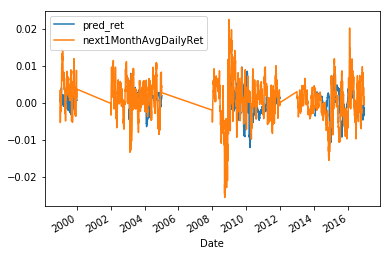

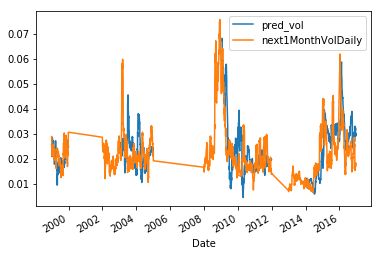

In [268]:
m_ridge_tuned = Ridge(alpha=1.0,random_state=10)
Prediction_1M_ridge_tune = prediction(response_data.next1MonthAvgDailyRet,response_data.next1MonthVolDaily,m_ridge_tuned,m_ridge_tuned,1,2,1)

In [272]:
Prediction_1M_ridge_tune.to_pickle('Prediction_1M_ridge_tune.pkl')

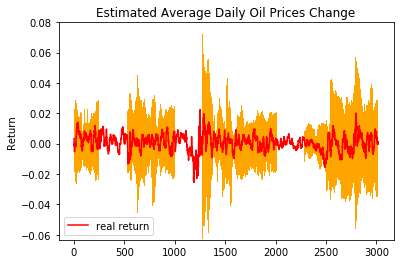

In [269]:
plot_to_use(Prediction_1M_ridge_tune,1)

In [270]:
get_error(Prediction_1M_ridge_tune,1)

rmse_r       0.005927
rmse_v       0.024608
days_in      0.991866
tot_error    0.029526
dtype: float64

1998-12-31 00:00:00
mse of training: 5.955183137741203e-06
predicted value: 0.021635873833105376
1999-01-04 00:00:00
mse of training: 6.096993222005617e-06
predicted value: 0.025265690464485388
1999-01-05 00:00:00
mse of training: 6.093452222822582e-06
predicted value: 0.025082996633938016
1999-01-06 00:00:00
mse of training: 6.1326046598208524e-06
predicted value: 0.024542968236173215
1999-01-07 00:00:00
mse of training: 6.219191696747326e-06
predicted value: 0.02357291773824333
1999-01-08 00:00:00


C:\Users\fzhan\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
C:\Users\fzhan\Anaconda3\lib\site-packages\sklearn\linear_model\coordinate_descent.py:477: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  positive)
C:\Users\fzhan\Anaconda3\lib\site-packages\sklearn\linear_model\coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


mse of training: 6.303661783796039e-06
predicted value: 0.020463941947640528
1999-01-11 00:00:00
mse of training: 6.382464639731772e-06
predicted value: 0.021371973957045917
1999-01-12 00:00:00
mse of training: 6.3978443186802115e-06
predicted value: 0.021681359477802822
1999-01-13 00:00:00
mse of training: 6.448990892087096e-06
predicted value: 0.022627387230647125
1999-01-14 00:00:00
mse of training: 6.465859872018895e-06
predicted value: 0.022866224187764364
1999-01-15 00:00:00
mse of training: 6.463500592128447e-06
predicted value: 0.02478476846347743
1999-01-19 00:00:00
mse of training: 6.4655268344718904e-06
predicted value: 0.023666762110221826
1999-01-20 00:00:00
mse of training: 6.468247119593768e-06
predicted value: 0.025363271234293383
1999-01-21 00:00:00
mse of training: 6.481115650525759e-06
predicted value: 0.02414455516392902
1999-01-22 00:00:00
mse of training: 6.494297664025049e-06
predicted value: 0.020710894935969046
1999-01-25 00:00:00
mse of training: 6.52198624848

mse of training: 7.705481798498145e-06
predicted value: 0.0028859230819434645
1999-05-19 00:00:00
mse of training: 7.70440076877385e-06
predicted value: 0.0036830129648910692
1999-05-20 00:00:00
mse of training: 7.709986028259097e-06
predicted value: 0.0035139670259409506
1999-05-21 00:00:00
mse of training: 7.71087966609184e-06
predicted value: 0.0019498366432808278
1999-05-24 00:00:00
mse of training: 7.705442957640015e-06
predicted value: 0.0032904757885891533
1999-05-25 00:00:00
mse of training: 7.72490937237106e-06
predicted value: 0.0028244037645125397
1999-05-26 00:00:00
mse of training: 7.710431573605955e-06
predicted value: 0.0015247608030781457
1999-05-27 00:00:00
mse of training: 7.711722852054602e-06
predicted value: 0.002228617329751048
1999-05-28 00:00:00
mse of training: 7.711897203074558e-06
predicted value: 0.007305460906106537
1999-06-01 00:00:00
mse of training: 7.68485392060026e-06
predicted value: 0.010839445760317451
1999-06-02 00:00:00
mse of training: 7.65156900

mse of training: 7.775234815807482e-06
predicted value: -0.0031437038276919127
1999-09-22 00:00:00
mse of training: 7.815984099819223e-06
predicted value: -0.0025533328389974463
1999-09-23 00:00:00
mse of training: 7.838975100869732e-06
predicted value: -0.0029101186598142204
1999-09-24 00:00:00
mse of training: 7.862970320434118e-06
predicted value: -0.004583404784371692
1999-09-27 00:00:00
mse of training: 7.905545081917734e-06
predicted value: -0.004188895317076391
1999-09-28 00:00:00
mse of training: 7.927361031157188e-06
predicted value: -0.0035473301134319457
1999-09-29 00:00:00
mse of training: 7.963429399701356e-06
predicted value: -0.0033000224892483776
1999-09-30 00:00:00
mse of training: 8.260108109469882e-06
predicted value: -5.261084571150931e-05
1999-10-01 00:00:00
mse of training: 8.517502775162513e-06
predicted value: -0.0009997086602512306
1999-10-04 00:00:00
mse of training: 8.600269350518678e-06
predicted value: 0.0008490443607542808
1999-10-05 00:00:00
mse of traini

mse of training: 2.5019229029568787e-06
predicted value: -0.007200163451935221
2003-01-31 00:00:00
mse of training: 2.5019229029568787e-06
predicted value: -0.0028394201255261264
2003-02-03 00:00:00
mse of training: 2.5000844355965644e-06
predicted value: -0.0016603405111539349
2003-02-04 00:00:00
mse of training: 2.5000844355965644e-06
predicted value: -0.0036121998633134034
2003-02-05 00:00:00
mse of training: 2.5259542443682464e-06
predicted value: -0.002367606677082995
2003-02-06 00:00:00
mse of training: 2.568022533275519e-06
predicted value: -0.0015373488307545147
2003-02-07 00:00:00
mse of training: 2.61786776438183e-06
predicted value: 0.0009628239577104125
2003-02-10 00:00:00
mse of training: 2.7860753134961555e-06
predicted value: 0.003661337830973471
2003-02-11 00:00:00
mse of training: 2.7860753134961555e-06
predicted value: 0.0007865235187921316
2003-02-12 00:00:00
mse of training: 2.9473012483338424e-06
predicted value: 0.000780276960284973
2003-02-13 00:00:00
mse of trai

mse of training: 6.2508738738835e-06
predicted value: 0.007984879397477218
2003-06-04 00:00:00
mse of training: 6.287837697658375e-06
predicted value: 0.010182795933700833
2003-06-05 00:00:00
mse of training: 6.317241070044729e-06
predicted value: 0.009848640319636198
2003-06-06 00:00:00
mse of training: 6.334896582206524e-06
predicted value: 0.008721212970188852
2003-06-09 00:00:00
mse of training: 6.321507969569174e-06
predicted value: 0.009054286951293927
2003-06-10 00:00:00
mse of training: 6.321507969569174e-06
predicted value: 0.00800103544659811
2003-06-11 00:00:00
mse of training: 6.303035729789317e-06
predicted value: 0.008469745964872988
2003-06-12 00:00:00
mse of training: 6.286098807136794e-06
predicted value: 0.009631954223494804
2003-06-13 00:00:00
mse of training: 6.272357237516053e-06
predicted value: 0.013794401492203318
2003-06-16 00:00:00
mse of training: 6.244945181794943e-06
predicted value: 0.012493468318163808
2003-06-17 00:00:00
mse of training: 6.25209882764855

mse of training: 5.501392331212679e-06
predicted value: 0.006126077691257212
2003-10-08 00:00:00
mse of training: 5.45628004411673e-06
predicted value: 0.007455410700425005
2003-10-09 00:00:00
mse of training: 5.4175206224970515e-06
predicted value: 0.005662620442177982
2003-10-10 00:00:00
mse of training: 5.356130292837138e-06
predicted value: 0.006266035911267481
2003-10-13 00:00:00
mse of training: 5.324089459263105e-06
predicted value: 0.005442195500819924
2003-10-14 00:00:00
mse of training: 5.3312128646907325e-06
predicted value: 0.007026919626835576
2003-10-15 00:00:00
mse of training: 5.32003936039386e-06
predicted value: 0.006794368598379216
2003-10-16 00:00:00
mse of training: 5.30395088877887e-06
predicted value: 0.007391532931246711
2003-10-17 00:00:00
mse of training: 5.277607435472379e-06
predicted value: 0.007493782537856486
2003-10-20 00:00:00
mse of training: 5.222407792166421e-06
predicted value: 0.008144455359929081
2003-10-21 00:00:00
mse of training: 5.184735061822

mse of training: 6.587328573273911e-06
predicted value: -0.009438981655274098
2004-02-19 00:00:00
mse of training: 6.614525780291356e-06
predicted value: -0.008889561527237577
2004-02-20 00:00:00
mse of training: 6.626912536114265e-06
predicted value: -0.008789009814828594
2004-02-23 00:00:00
mse of training: 6.76072464117448e-06
predicted value: -0.005578729455868944
2004-02-24 00:00:00
mse of training: 6.778924696283747e-06
predicted value: -0.004227149381001216
2004-02-25 00:00:00
mse of training: 6.846427306405122e-06
predicted value: -0.004894715106011555
2004-02-26 00:00:00
mse of training: 6.926901393957835e-06
predicted value: -0.005785565273240971
2004-02-27 00:00:00
mse of training: 6.9745757069946605e-06
predicted value: -0.006529782129504565
2004-03-01 00:00:00
mse of training: 7.061747083885932e-06
predicted value: -0.010948561904212221
2004-03-02 00:00:00
mse of training: 7.057828812815261e-06
predicted value: -0.01013113367606465
2004-03-03 00:00:00
mse of training: 7.11

mse of training: 5.739311302896763e-06
predicted value: 0.0036834277324010734
2004-06-28 00:00:00
mse of training: 5.72252246117015e-06
predicted value: 0.004809574679546652
2004-06-29 00:00:00
mse of training: 5.705052052901528e-06
predicted value: 0.005269247576123761
2004-06-30 00:00:00
mse of training: 5.6770797825208575e-06
predicted value: -0.002953388556845571
2004-07-01 00:00:00
mse of training: 5.645470327092583e-06
predicted value: -0.0048393802048103465
2004-07-02 00:00:00
mse of training: 5.604196054478844e-06
predicted value: -0.007433928271012372
2004-07-06 00:00:00
mse of training: 5.611472855192496e-06
predicted value: -0.0090897647395006
2004-07-07 00:00:00
mse of training: 5.6328447397122525e-06
predicted value: -0.008324254916261237
2004-07-08 00:00:00
mse of training: 5.64573475052273e-06
predicted value: -0.00987255529567492
2004-07-09 00:00:00
mse of training: 5.660681300283911e-06
predicted value: -0.008340663806657517
2004-07-12 00:00:00
mse of training: 5.67646

mse of training: 2.7540943864700548e-06
predicted value: 0.005959241236303231
2004-11-01 00:00:00
mse of training: 2.8131008492963597e-06
predicted value: 0.004985053631010351
2004-11-02 00:00:00
mse of training: 2.8193875529274327e-06
predicted value: 0.006709175842112058
2004-11-03 00:00:00
mse of training: 2.8567347661666307e-06
predicted value: 0.0049612857197012805
2004-11-04 00:00:00
mse of training: 2.8650551746080563e-06
predicted value: 0.00691122595276128
2004-11-05 00:00:00
mse of training: 2.8444637342075565e-06
predicted value: 0.0049414219156562605
2004-11-08 00:00:00
mse of training: 2.8269693162845674e-06
predicted value: 0.005357184619315891
2004-11-09 00:00:00
mse of training: 2.8269693162845674e-06
predicted value: 0.00793944531802851
2004-11-10 00:00:00
mse of training: 2.838924757648013e-06
predicted value: 0.00640959699027998
2004-11-11 00:00:00
mse of training: 2.8442844119249006e-06
predicted value: 0.008875766735631396
2004-11-12 00:00:00
mse of training: 2.841

2009-02-02 00:00:00
mse of training: 1.1203190937393366e-05
predicted value: 0.011765988180668097
2009-02-03 00:00:00
mse of training: 1.1203190937393366e-05
predicted value: 0.01296418867901461
2009-02-04 00:00:00
mse of training: 1.1160905489551703e-05
predicted value: 0.016114770515007315
2009-02-05 00:00:00
mse of training: 1.1128251867714538e-05
predicted value: 0.01777454167107556
2009-02-06 00:00:00
mse of training: 1.1092434679432852e-05
predicted value: 0.018766185339553876
2009-02-09 00:00:00
mse of training: 1.1038484620324364e-05
predicted value: 0.016633328841284767
2009-02-10 00:00:00
mse of training: 1.1038484620324364e-05
predicted value: 0.01666861575863876
2009-02-11 00:00:00
mse of training: 1.1104100340866195e-05
predicted value: 0.014520545544159158
2009-02-12 00:00:00
mse of training: 1.1062358330768695e-05
predicted value: 0.014381952032798906
2009-02-13 00:00:00
mse of training: 1.102286095519791e-05
predicted value: 0.015302672456107502
2009-02-17 00:00:00
mse 

mse of training: 1.2425109795587709e-05
predicted value: 0.010409895591495522
2009-06-11 00:00:00
mse of training: 1.2389336180402351e-05
predicted value: 0.008626585133669873
2009-06-12 00:00:00
mse of training: 1.2355478903172699e-05
predicted value: 0.010545840824015107
2009-06-15 00:00:00
mse of training: 1.2316157524929304e-05
predicted value: 0.011384913949895159
2009-06-16 00:00:00
mse of training: 1.2341544545441895e-05
predicted value: 0.011817970449818693
2009-06-17 00:00:00
mse of training: 1.2307010814770723e-05
predicted value: 0.01062182799844269
2009-06-18 00:00:00
mse of training: 1.2307326598253339e-05
predicted value: 0.009564588538196972
2009-06-19 00:00:00
mse of training: 1.2306222590502457e-05
predicted value: 0.006575811691188704
2009-06-22 00:00:00
mse of training: 1.2288275677726362e-05
predicted value: 0.009544487133702262
2009-06-23 00:00:00
mse of training: 1.2316627401299735e-05
predicted value: 0.009203155454790335
2009-06-24 00:00:00
mse of training: 1.23

mse of training: 1.4501348384876776e-05
predicted value: 0.006921607873254295
2009-10-16 00:00:00
mse of training: 1.4498455972220473e-05
predicted value: 0.00806700834958296
2009-10-19 00:00:00
mse of training: 1.453959053408669e-05
predicted value: 0.007474033184202478
2009-10-20 00:00:00
mse of training: 1.457625058831932e-05
predicted value: 0.007710330475138916
2009-10-21 00:00:00
mse of training: 1.4556638884487519e-05
predicted value: 0.006970730674395242
2009-10-22 00:00:00
mse of training: 1.4425946281810709e-05
predicted value: 0.006274797458080628
2009-10-23 00:00:00
mse of training: 1.4246321123014158e-05
predicted value: 0.007079572079524643
2009-10-26 00:00:00
mse of training: 1.426529879848117e-05
predicted value: 0.007597404095916138
2009-10-27 00:00:00
mse of training: 1.4283520142534194e-05
predicted value: 0.007348233086075129
2009-10-28 00:00:00
mse of training: 1.4267781350315438e-05
predicted value: 0.007840761996702306
2009-10-29 00:00:00
mse of training: 1.42385

mse of training: 9.69541192486346e-06
predicted value: -0.005859080748813195
2010-02-22 00:00:00
mse of training: 9.541246242480852e-06
predicted value: -0.006007286037412574
2010-02-23 00:00:00
mse of training: 9.408837068961796e-06
predicted value: -0.005760503187916655
2010-02-24 00:00:00
mse of training: 9.387605474356294e-06
predicted value: -0.0065124855614212
2010-02-25 00:00:00
mse of training: 9.378894102414943e-06
predicted value: -0.00524348693873905
2010-02-26 00:00:00
mse of training: 9.377637242810874e-06
predicted value: -0.0051292531116753914
2010-03-01 00:00:00
mse of training: 9.255666783459114e-06
predicted value: -0.005206061291303521
2010-03-02 00:00:00
mse of training: 9.27945998460359e-06
predicted value: -0.00594392984815173
2010-03-03 00:00:00
mse of training: 9.249489106264585e-06
predicted value: -0.00696216172776043
2010-03-04 00:00:00
mse of training: 9.24453774179066e-06
predicted value: -0.00706648041821345
2010-03-05 00:00:00
mse of training: 9.260593955

mse of training: 4.433736136243117e-06
predicted value: 0.0016071890775692932
2010-07-01 00:00:00
mse of training: 4.428920717069953e-06
predicted value: 0.0038179310892750284
2010-07-02 00:00:00
mse of training: 4.427511147595289e-06
predicted value: 0.006054951075304654
2010-07-06 00:00:00
mse of training: 4.413916678241516e-06
predicted value: 0.006577853653075005
2010-07-07 00:00:00
mse of training: 4.411668106879648e-06
predicted value: 0.005531821265723796
2010-07-08 00:00:00
mse of training: 4.3673783208664055e-06
predicted value: 0.00443390678111194
2010-07-09 00:00:00
mse of training: 4.351080171969144e-06
predicted value: 0.0044447878459817625
2010-07-12 00:00:00
mse of training: 4.163703273944087e-06
predicted value: 0.00545300472954123
2010-07-13 00:00:00
mse of training: 4.131269251668191e-06
predicted value: 0.0037011778763117176
2010-07-14 00:00:00
mse of training: 4.121752859067272e-06
predicted value: 0.003291952267015577
2010-07-15 00:00:00
mse of training: 4.11354173

mse of training: 2.432755670933534e-06
predicted value: -0.004184795555039249
2010-11-05 00:00:00
mse of training: 2.418278743283921e-06
predicted value: -0.0036626476150182774
2010-11-08 00:00:00
mse of training: 2.4080701588730104e-06
predicted value: -0.0032215996851752415
2010-11-09 00:00:00
mse of training: 2.4080701588730104e-06
predicted value: -0.0031332284858616166
2010-11-10 00:00:00
mse of training: 2.4329661588780594e-06
predicted value: -0.0036484344992564477
2010-11-11 00:00:00
mse of training: 2.429735268818241e-06
predicted value: -0.005733023543402216
2010-11-12 00:00:00
mse of training: 2.4227976102145843e-06
predicted value: -0.003634802677286386
2010-11-15 00:00:00
mse of training: 2.366025860367854e-06
predicted value: -0.003519207990223705
2010-11-16 00:00:00
mse of training: 2.3590646029940212e-06
predicted value: -0.0015961236502775589
2010-11-17 00:00:00
mse of training: 2.349941644829665e-06
predicted value: -1.188066262647336e-06
2010-11-18 00:00:00
mse of tr

mse of training: 3.1268727398105817e-06
predicted value: -0.0007423664367218752
2011-03-17 00:00:00
mse of training: 3.1410288560489667e-06
predicted value: -0.0038260148716528497
2011-03-18 00:00:00
mse of training: 3.16163316937095e-06
predicted value: -0.0066457869538305014
2011-03-21 00:00:00
mse of training: 3.2050646792353772e-06
predicted value: -0.006615046499931332
2011-03-22 00:00:00
mse of training: 3.2132407958848516e-06
predicted value: -0.007541852451410064
2011-03-23 00:00:00
mse of training: 3.2197498799706405e-06
predicted value: -0.007730330320304429
2011-03-24 00:00:00
mse of training: 3.228065596078286e-06
predicted value: -0.006994461452419054
2011-03-25 00:00:00
mse of training: 3.2893307098942863e-06
predicted value: -0.00596133882676117
2011-03-28 00:00:00
mse of training: 3.375661738786392e-06
predicted value: -0.005935256478229262
2011-03-29 00:00:00
mse of training: 3.3811228680820445e-06
predicted value: -0.005645425162637302
2011-03-30 00:00:00
mse of train

mse of training: 3.539982145095097e-06
predicted value: -0.005954096416049031
2011-07-25 00:00:00
mse of training: 3.570845496590122e-06
predicted value: -0.005760532066398649
2011-07-26 00:00:00
mse of training: 3.576407024882721e-06
predicted value: -0.005344010134595331
2011-07-27 00:00:00
mse of training: 3.5768867916541187e-06
predicted value: -0.005106511648387699
2011-07-28 00:00:00
mse of training: 3.575594183323693e-06
predicted value: -0.004183349683084231
2011-07-29 00:00:00
mse of training: 3.570066976449397e-06
predicted value: -0.0037326589569422752
2011-08-01 00:00:00
mse of training: 3.5928328981220035e-06
predicted value: -0.001455959778824456
2011-08-02 00:00:00
mse of training: 3.5928328981220035e-06
predicted value: -0.0012008564173362213
2011-08-03 00:00:00
mse of training: 3.6029305319662555e-06
predicted value: -0.0005720494932336014
2011-08-04 00:00:00
mse of training: 3.6209598302067323e-06
predicted value: 0.001010777724359202
2011-08-05 00:00:00
mse of traini

mse of training: 3.5446106640511735e-06
predicted value: 0.0048500116732143606
2011-11-21 00:00:00
mse of training: 3.5380514141830762e-06
predicted value: 0.005091855779570331
2011-11-22 00:00:00
mse of training: 3.5479214315981385e-06
predicted value: 0.004437019706446471
2011-11-23 00:00:00
mse of training: 3.5479226113747332e-06
predicted value: 0.0033554417114745883
2011-11-25 00:00:00
mse of training: 3.5536749289729495e-06
predicted value: 0.0031018622544157493
2011-11-28 00:00:00
mse of training: 3.557732740918775e-06
predicted value: 0.002819342521267809
2011-11-29 00:00:00
mse of training: 3.5677614633477265e-06
predicted value: 0.0012947350407733482
2011-11-30 00:00:00
mse of training: 3.563684516509448e-06
predicted value: 0.003108411093029728
2011-12-01 00:00:00
mse of training: 3.5630535147319288e-06
predicted value: 0.0024951909133999195
2011-12-02 00:00:00
mse of training: 3.564247021424174e-06
predicted value: 0.0025483800055914885
2011-12-05 00:00:00
mse of training: 

mse of training: 8.557568021318265e-07
predicted value: 0.00010659580162118709
2014-02-05 00:00:00
mse of training: 8.54150809888425e-07
predicted value: 2.6862731815752855e-05
2014-02-06 00:00:00
mse of training: 8.607015187582629e-07
predicted value: -3.249699999898631e-06
2014-02-07 00:00:00
mse of training: 8.665976158653593e-07
predicted value: -0.0018205136380619463
2014-02-10 00:00:00
mse of training: 8.712211809500754e-07
predicted value: -0.0017324464337303003
2014-02-11 00:00:00
mse of training: 8.712211809500754e-07
predicted value: -0.000926743351690934
2014-02-12 00:00:00
mse of training: 8.679734914325985e-07
predicted value: -0.00044196317399864717
2014-02-13 00:00:00
mse of training: 8.654102130945817e-07
predicted value: -0.00064350330879126
2014-02-14 00:00:00
mse of training: 8.632013720035462e-07
predicted value: -0.0014574274003111357
2014-02-18 00:00:00
mse of training: 8.589356403397355e-07
predicted value: -0.002234795448900262
2014-02-19 00:00:00
mse of trainin

mse of training: 8.727408618216736e-07
predicted value: -0.0010869696258375625
2014-06-13 00:00:00
mse of training: 8.708067746069007e-07
predicted value: -0.0010088076436013116
2014-06-16 00:00:00
mse of training: 8.659040612679817e-07
predicted value: -0.0011041047851848632
2014-06-17 00:00:00
mse of training: 8.68282993296768e-07
predicted value: -0.000936757686581198
2014-06-18 00:00:00
mse of training: 8.658610392647574e-07
predicted value: -0.0010212415396734474
2014-06-19 00:00:00
mse of training: 8.662389823896344e-07
predicted value: -0.0013475089204097734
2014-06-20 00:00:00
mse of training: 8.663459047596795e-07
predicted value: -0.0010815853537787384
2014-06-23 00:00:00
mse of training: 8.641315895508895e-07
predicted value: 0.00011149583802271684
2014-06-24 00:00:00
mse of training: 8.661159546409112e-07
predicted value: 0.0002634365229896851
2014-06-25 00:00:00
mse of training: 8.682019377655176e-07
predicted value: 1.2056930029272217e-05
2014-06-26 00:00:00
mse of traini

mse of training: 6.543677751526468e-07
predicted value: 0.0061672161725107
2014-10-17 00:00:00
mse of training: 6.464632787667795e-07
predicted value: 0.006878892004991574
2014-10-20 00:00:00
mse of training: 6.469803918810554e-07
predicted value: 0.0074283810174113375
2014-10-21 00:00:00
mse of training: 6.486671062519089e-07
predicted value: 0.006686139094477617
2014-10-22 00:00:00
mse of training: 6.485416787076788e-07
predicted value: 0.008333182813495292
2014-10-23 00:00:00
mse of training: 6.489961323308773e-07
predicted value: 0.006924771653114902
2014-10-24 00:00:00
mse of training: 6.536063906822513e-07
predicted value: 0.00812721904069763
2014-10-27 00:00:00
mse of training: 6.894995888286392e-07
predicted value: 0.00743130443055648
2014-10-28 00:00:00
mse of training: 6.914096364544489e-07
predicted value: 0.007463949778605476
2014-10-29 00:00:00
mse of training: 6.955918404300333e-07
predicted value: 0.006550391400460346
2014-10-30 00:00:00
mse of training: 7.34024543234867

mse of training: 2.703951432348305e-06
predicted value: -0.01663566062793276
2015-02-20 00:00:00
mse of training: 2.708093710474653e-06
predicted value: -0.015112459338538518
2015-02-23 00:00:00
mse of training: 2.7930915742271316e-06
predicted value: -0.013256104788212333
2015-02-24 00:00:00
mse of training: 2.7987791893161356e-06
predicted value: -0.013324298185584449
2015-02-25 00:00:00
mse of training: 2.7986860301367284e-06
predicted value: -0.013082609570546438
2015-02-26 00:00:00
mse of training: 2.811528863345954e-06
predicted value: -0.014546273076225144
2015-02-27 00:00:00
mse of training: 2.87348140016311e-06
predicted value: -0.012776735244427882
2015-03-02 00:00:00
mse of training: 2.906670808561343e-06
predicted value: -0.013124368500393448
2015-03-03 00:00:00
mse of training: 2.914300036984699e-06
predicted value: -0.011037433268661204
2015-03-04 00:00:00
mse of training: 2.9294310553342087e-06
predicted value: -0.010341982160620225
2015-03-05 00:00:00
mse of training: 2

mse of training: 2.7982758264093195e-06
predicted value: 0.0012027455802530451
2015-06-26 00:00:00
mse of training: 2.7980462327284913e-06
predicted value: -0.00043700157642095894
2015-06-29 00:00:00
mse of training: 2.8188704087250645e-06
predicted value: 0.06351050282046217
2015-06-30 00:00:00
mse of training: 2.82649233087735e-06
predicted value: -0.00467878635443858
2015-07-01 00:00:00
mse of training: 2.863390311685719e-06
predicted value: -0.006202946096066253
2015-07-02 00:00:00
mse of training: 2.8931725539523814e-06
predicted value: -0.007387453735665184
2015-07-03 00:00:00
mse of training: 2.8960691496390617e-06
predicted value: -0.010962016146530529
2015-07-06 00:00:00
mse of training: 2.963127733550351e-06
predicted value: -0.009573692469187434
2015-07-07 00:00:00
mse of training: 2.963127733550351e-06
predicted value: -0.009907066539096898
2015-07-08 00:00:00
mse of training: 2.9883396840423815e-06
predicted value: -0.011035649817154214
2015-07-09 00:00:00
mse of training:

mse of training: 4.912139972689531e-06
predicted value: 0.007903646277102251
2015-10-22 00:00:00
mse of training: 4.922202610557275e-06
predicted value: 0.008133498816854032
2015-10-23 00:00:00
mse of training: 4.912469856533357e-06
predicted value: 0.008970024518154776
2015-10-26 00:00:00
mse of training: 4.968373328953116e-06
predicted value: 0.008471335349103992
2015-10-27 00:00:00
mse of training: 4.964496117097639e-06
predicted value: 0.009242905165262171
2015-10-28 00:00:00
mse of training: 4.950179421021874e-06
predicted value: 0.007326861392169863
2015-10-29 00:00:00
mse of training: 4.9404834179980266e-06
predicted value: 0.004794626987994849
2015-10-30 00:00:00
mse of training: 4.93944779661063e-06
predicted value: 0.0020929756947223183
2015-11-02 00:00:00
mse of training: 5.005858293811469e-06
predicted value: -0.00010916841833150115
2015-11-03 00:00:00
mse of training: 4.995427755531204e-06
predicted value: 3.929594418483791e-05
2015-11-04 00:00:00
mse of training: 5.068633

mse of training: 6.8048011886036974e-06
predicted value: 0.0010478926379331628
2016-03-02 00:00:00
mse of training: 6.855374940929997e-06
predicted value: 0.0009410127569126278
2016-03-03 00:00:00
mse of training: 7.001447637076638e-06
predicted value: 0.0017832200695774986
2016-03-04 00:00:00
mse of training: 6.98840191067168e-06
predicted value: -0.0009314133044077914
2016-03-07 00:00:00
mse of training: 7.109302110033084e-06
predicted value: -0.0010249005635133788
2016-03-08 00:00:00
mse of training: 7.06895716744335e-06
predicted value: -0.003159517706100099
2016-03-09 00:00:00
mse of training: 7.122928729905737e-06
predicted value: -0.0028829205449234924
2016-03-10 00:00:00
mse of training: 7.1926660443821955e-06
predicted value: -0.0036981398467578093
2016-03-11 00:00:00
mse of training: 7.158681013075805e-06
predicted value: -0.007129203137857643
2016-03-14 00:00:00
mse of training: 7.0831084838739436e-06
predicted value: -0.011353715818104411
2016-03-15 00:00:00
mse of training

mse of training: 7.246074582508129e-06
predicted value: -0.012436454161157552
2016-07-06 00:00:00
mse of training: 7.219769091390712e-06
predicted value: -0.01285086958185308
2016-07-07 00:00:00
mse of training: 7.1821395717446376e-06
predicted value: -0.012028985887781271
2016-07-08 00:00:00
mse of training: 7.067912402957197e-06
predicted value: -0.012436161187660985
2016-07-11 00:00:00
mse of training: 7.040944482157962e-06
predicted value: -0.013333302700376554
2016-07-12 00:00:00
mse of training: 7.048737712693337e-06
predicted value: -0.014467351504877976
2016-07-13 00:00:00
mse of training: 7.009634995021869e-06
predicted value: -0.013240454121000264
2016-07-14 00:00:00
mse of training: 6.9324907262786e-06
predicted value: -0.014087134945513682
2016-07-15 00:00:00
mse of training: 6.83739116083544e-06
predicted value: -0.013936997321822672
2016-07-18 00:00:00
mse of training: 6.7953298748282345e-06
predicted value: -0.014221666700188308
2016-07-19 00:00:00
mse of training: 6.768

mse of training: 7.563390065891472e-06
predicted value: -0.007649809651446002
2016-11-03 00:00:00
mse of training: 7.549221697970854e-06
predicted value: -0.007073020188374343
2016-11-04 00:00:00
mse of training: 7.502258345280607e-06
predicted value: -0.005590170829791477
2016-11-07 00:00:00
mse of training: 7.456018793187829e-06
predicted value: -0.005390023845638775
2016-11-08 00:00:00
mse of training: 7.404131566156302e-06
predicted value: -0.005498713958468501
2016-11-09 00:00:00
mse of training: 7.364839556062395e-06
predicted value: -0.007112682014045947
2016-11-10 00:00:00
mse of training: 7.3339143476530445e-06
predicted value: -0.007573667729611579
2016-11-11 00:00:00
mse of training: 7.289611494386826e-06
predicted value: -0.00721351729315467
2016-11-14 00:00:00
mse of training: 7.2237279809239785e-06
predicted value: -0.005767151791126343
2016-11-15 00:00:00
mse of training: 7.195539559007088e-06
predicted value: -0.008112036636957289
2016-11-16 00:00:00
mse of training: 7.

mse of training: 1.8969223112258406e-05
predicted value: 0.03296361236416834
1999-03-22 00:00:00
mse of training: 1.8802690016503307e-05
predicted value: 0.03334417773531362
1999-03-23 00:00:00
mse of training: 1.8826097189451534e-05
predicted value: 0.03356264066695713
1999-03-24 00:00:00
mse of training: 1.8709780521839262e-05
predicted value: 0.034785281047923444
1999-03-25 00:00:00
mse of training: 1.8535188026503656e-05
predicted value: 0.034132550043010745
1999-03-26 00:00:00
mse of training: 1.8255654309875026e-05
predicted value: 0.03842284708778121
1999-03-29 00:00:00
mse of training: 1.8119598574651363e-05
predicted value: 0.03561590998473774
1999-03-30 00:00:00
mse of training: 1.765983621652086e-05
predicted value: 0.035145436444349754
1999-03-31 00:00:00
mse of training: 1.771191862002261e-05
predicted value: 0.01254165941798746
1999-04-01 00:00:00
mse of training: 1.7688570682708762e-05
predicted value: 0.013656904704317796
1999-04-05 00:00:00
mse of training: 1.796989166

mse of training: 1.7790397563116116e-05
predicted value: 0.04802397506795053
1999-07-27 00:00:00
mse of training: 1.730590524097003e-05
predicted value: 0.048520967172048124
1999-07-28 00:00:00
mse of training: 1.66979556669028e-05
predicted value: 0.04663658933657455
1999-07-29 00:00:00
mse of training: 1.6088209819749166e-05
predicted value: 0.04600062679085348
1999-07-30 00:00:00
mse of training: 1.6547181369348016e-05
predicted value: 0.03262590284718936
1999-08-02 00:00:00
mse of training: 1.665429922392797e-05
predicted value: 0.02516326420230519
1999-08-03 00:00:00
mse of training: 1.665429922392797e-05
predicted value: 0.02513538169456009
1999-08-04 00:00:00
mse of training: 1.6254154719195115e-05
predicted value: 0.02470125576197635
1999-08-05 00:00:00
mse of training: 1.5750245455294626e-05
predicted value: 0.022104771093519826
1999-08-06 00:00:00
mse of training: 1.4940604955712905e-05
predicted value: 0.021642555603058722
1999-08-09 00:00:00
mse of training: 1.4927652907147

mse of training: 8.157266075557712e-06
predicted value: 0.022205796596461713
1999-11-26 00:00:00
mse of training: 7.67171865454062e-06
predicted value: 0.012886608401193045
1999-11-29 00:00:00
mse of training: 7.43063488208593e-06
predicted value: 0.01706264529406115
1999-11-30 00:00:00
mse of training: 7.344566414524574e-06
predicted value: 0.018353687272793517
1999-12-01 00:00:00
mse of training: 7.2643668838373815e-06
predicted value: 0.019263478476064966
1999-12-02 00:00:00
mse of training: 7.055760046345699e-06
predicted value: 0.01897577888595503
1999-12-03 00:00:00
mse of training: 6.8188380712864974e-06
predicted value: 0.01804340718886266
1999-12-06 00:00:00
mse of training: 6.547656795717581e-06
predicted value: 0.019171353065284058
1999-12-07 00:00:00
mse of training: 6.55283791761909e-06
predicted value: 0.01817450310587332
1999-12-08 00:00:00
mse of training: 6.52279544845822e-06
predicted value: 0.019609526808665678
1999-12-09 00:00:00
mse of training: 6.535665324916145e-

mse of training: 3.0830865456453146e-06
predicted value: 0.025423059880881352
2003-02-11 00:00:00
mse of training: 3.0830865456453146e-06
predicted value: 0.02489001960002815
2003-02-12 00:00:00
mse of training: 3.071394872571151e-06
predicted value: 0.023840590660897065
2003-02-13 00:00:00
mse of training: 3.063563475011902e-06
predicted value: 0.022561254656124602
2003-02-14 00:00:00
mse of training: 3.0550686285412374e-06
predicted value: 0.028921407686830512
2003-02-18 00:00:00
mse of training: 3.0332156623016584e-06
predicted value: 0.02827898408095653
2003-02-19 00:00:00
mse of training: 3.0332156623016584e-06
predicted value: 0.028373703186854
2003-02-20 00:00:00
mse of training: 3.024016943018358e-06
predicted value: 0.029443130852994354
2003-02-21 00:00:00
mse of training: 3.0164861352942767e-06
predicted value: 0.028612807710251587
2003-02-24 00:00:00
mse of training: 3.0114485497082567e-06
predicted value: 0.029572928821060995
2003-02-25 00:00:00
mse of training: 3.011448549

mse of training: 1.0522386762139037e-05
predicted value: 0.050235053574615995
2003-06-13 00:00:00
mse of training: 1.051901626074309e-05
predicted value: 0.053950676833773095
2003-06-16 00:00:00
mse of training: 1.060040952025853e-05
predicted value: 0.05239979956772976
2003-06-17 00:00:00
mse of training: 1.0618300578116793e-05
predicted value: 0.05254841103068253
2003-06-18 00:00:00
mse of training: 1.0667049378158629e-05
predicted value: 0.050050254426276544
2003-06-19 00:00:00
mse of training: 1.0708709118215405e-05
predicted value: 0.04894816138167477
2003-06-20 00:00:00
mse of training: 1.0699351154094733e-05
predicted value: 0.0488503585546627
2003-06-23 00:00:00
mse of training: 1.0604219952739335e-05
predicted value: 0.046758020539044876
2003-06-24 00:00:00
mse of training: 1.0476476394582897e-05
predicted value: 0.0490223717796887
2003-06-25 00:00:00
mse of training: 1.0276613748783364e-05
predicted value: 0.049858415531759175
2003-06-26 00:00:00
mse of training: 1.0699855121

mse of training: 9.603685285736632e-06
predicted value: 0.018926735025103544
2003-10-20 00:00:00
mse of training: 9.717779687297918e-06
predicted value: 0.018712750579721327
2003-10-21 00:00:00
mse of training: 9.739840271190938e-06
predicted value: 0.019543629276922173
2003-10-22 00:00:00
mse of training: 9.750595042398863e-06
predicted value: 0.02064668903521591
2003-10-23 00:00:00
mse of training: 9.815852028173101e-06
predicted value: 0.021298730072105157
2003-10-24 00:00:00
mse of training: 9.813299256178901e-06
predicted value: 0.01902622172403741
2003-10-27 00:00:00
mse of training: 9.863819177799753e-06
predicted value: 0.021413039449179383
2003-10-28 00:00:00
mse of training: 9.868711965673665e-06
predicted value: 0.020149828457294336
2003-10-29 00:00:00
mse of training: 9.896014230489757e-06
predicted value: 0.02048396112634486
2003-10-30 00:00:00
mse of training: 9.877009383172518e-06
predicted value: 0.022148759206747193
2003-10-31 00:00:00
mse of training: 9.87412306596680

mse of training: 1.5714060800061836e-05
predicted value: 0.02783986730335297
2004-03-02 00:00:00
mse of training: 1.575806057700199e-05
predicted value: 0.026811231059058905
2004-03-03 00:00:00
mse of training: 1.5796983045157446e-05
predicted value: 0.025992943401299116
2004-03-04 00:00:00
mse of training: 1.580456805570759e-05
predicted value: 0.027073711099957667
2004-03-05 00:00:00
mse of training: 1.5819722783832913e-05
predicted value: 0.04614168233124491
2004-03-08 00:00:00
mse of training: 1.5838491010321265e-05
predicted value: 0.04567543281788044
2004-03-09 00:00:00
mse of training: 1.5856552276869956e-05
predicted value: 0.046146836741325956
2004-03-10 00:00:00
mse of training: 1.595142305715338e-05
predicted value: 0.04652511762493472
2004-03-11 00:00:00
mse of training: 1.6049224368560713e-05
predicted value: 0.047159209656894255
2004-03-12 00:00:00
mse of training: 1.6094415344019396e-05
predicted value: 0.04564188552493624
2004-03-15 00:00:00
mse of training: 1.621813088

mse of training: 2.0717620978362002e-05
predicted value: 0.02671525219072081
2004-07-02 00:00:00
mse of training: 2.072344288779064e-05
predicted value: 0.029662918579223967
2004-07-06 00:00:00
mse of training: 2.0845050934515724e-05
predicted value: 0.03440828551191294
2004-07-07 00:00:00
mse of training: 2.0883733886380736e-05
predicted value: 0.03181785868955205
2004-07-08 00:00:00
mse of training: 2.096128802572072e-05
predicted value: 0.03220892503570755
2004-07-09 00:00:00
mse of training: 2.1068588437583564e-05
predicted value: 0.028784583520605797
2004-07-12 00:00:00
mse of training: 2.1210890444425024e-05
predicted value: 0.029406806715610294
2004-07-13 00:00:00
mse of training: 2.1253603891290006e-05
predicted value: 0.02917627318162492
2004-07-14 00:00:00
mse of training: 2.107218754882758e-05
predicted value: 0.028388547475549253
2004-07-15 00:00:00
mse of training: 2.066365378892279e-05
predicted value: 0.026890952093278717
2004-07-16 00:00:00
mse of training: 2.0092247128

mse of training: 3.379840783085226e-06
predicted value: 0.013723370353841913
2004-11-05 00:00:00
mse of training: 3.3901471335438177e-06
predicted value: 0.014945631645285826
2004-11-08 00:00:00
mse of training: 3.3856426979140705e-06
predicted value: 0.015333159695049323
2004-11-09 00:00:00
mse of training: 3.3856426979140705e-06
predicted value: 0.014087605588274016
2004-11-10 00:00:00
mse of training: 3.3611839562197143e-06
predicted value: 0.01508525295760892
2004-11-11 00:00:00
mse of training: 3.339763386757564e-06
predicted value: 0.014893948573841076
2004-11-12 00:00:00
mse of training: 3.271632572029364e-06
predicted value: 0.012040751450507453
2004-11-15 00:00:00
mse of training: 3.2582248686611655e-06
predicted value: 0.011963099130540437
2004-11-16 00:00:00
mse of training: 3.2642323677975635e-06
predicted value: 0.011465434649560742
2004-11-17 00:00:00
mse of training: 3.2586156873594264e-06
predicted value: 0.010811204310340994
2004-11-18 00:00:00
mse of training: 3.29794

2009-01-07 00:00:00
2009-01-08 00:00:00
2009-01-09 00:00:00
2009-01-12 00:00:00
2009-01-13 00:00:00
2009-01-14 00:00:00
2009-01-15 00:00:00
2009-01-16 00:00:00
2009-01-20 00:00:00
2009-01-21 00:00:00
2009-01-22 00:00:00
2009-01-23 00:00:00
2009-01-26 00:00:00
mse of training: 2.096042296146936e-05
predicted value: 0.04737535490364464
2009-01-27 00:00:00
mse of training: 2.096042296146936e-05
predicted value: 0.04038364938299155
2009-01-28 00:00:00
mse of training: 2.091682983234867e-05
predicted value: 0.7544021518646851
2009-01-29 00:00:00
mse of training: 2.091682983234867e-05
predicted value: 0.7575780795503255
2009-01-30 00:00:00
mse of training: 2.0834208133910335e-05
predicted value: 0.07352538405086262
2009-02-02 00:00:00
mse of training: 2.075375216683231e-05
predicted value: 0.07180226108598742
2009-02-03 00:00:00
mse of training: 2.075375216683231e-05
predicted value: 0.06508237599560063
2009-02-04 00:00:00
mse of training: 2.1058263788251253e-05
predicted value: 0.0613957914

mse of training: 2.6489932454455903e-05
predicted value: 0.026141184660259886
2009-05-28 00:00:00
mse of training: 2.6673175240768714e-05
predicted value: 0.026078178572375432
2009-05-29 00:00:00
mse of training: 2.6644232938744876e-05
predicted value: 0.021441721837410305
2009-06-01 00:00:00
mse of training: 2.682326854411385e-05
predicted value: 0.018063532314191444
2009-06-02 00:00:00
mse of training: 2.682326854411385e-05
predicted value: 0.012197808073252409
2009-06-03 00:00:00
mse of training: 2.6797148979302993e-05
predicted value: 0.014438944305093182
2009-06-04 00:00:00
mse of training: 2.680501459328157e-05
predicted value: 0.013947075480430338
2009-06-05 00:00:00
mse of training: 2.6814717959083726e-05
predicted value: 0.013333395722269797
2009-06-08 00:00:00
mse of training: 2.6673114978577383e-05
predicted value: 0.014441115340146471
2009-06-09 00:00:00
mse of training: 2.6673114978577383e-05
predicted value: 0.012876056329061053
2009-06-10 00:00:00
mse of training: 2.6595

mse of training: 2.547940317058729e-05
predicted value: 0.030558996263538585
2009-09-29 00:00:00
mse of training: 2.555121130875479e-05
predicted value: 0.03148721615834987
2009-09-30 00:00:00
mse of training: 2.5822857095562117e-05
predicted value: 0.03100077669172277
2009-10-01 00:00:00
mse of training: 2.6102672400133235e-05
predicted value: 0.03141591371082603
2009-10-02 00:00:00
mse of training: 2.6325426779368308e-05
predicted value: 0.030487765172744652
2009-10-05 00:00:00
mse of training: 2.6278455687486312e-05
predicted value: 0.03061836347020097
2009-10-06 00:00:00
mse of training: 2.62447676440491e-05
predicted value: 0.02831230032565432
2009-10-07 00:00:00
mse of training: 2.621784632426426e-05
predicted value: 0.028797970298007708
2009-10-08 00:00:00
mse of training: 2.609467197871359e-05
predicted value: 0.02786754244934031
2009-10-09 00:00:00
mse of training: 2.5916997493350428e-05
predicted value: 0.026761133595893716
2009-10-12 00:00:00
mse of training: 2.5389199001712

mse of training: 1.3857081325327006e-05
predicted value: 0.029470952336913887
2010-02-04 00:00:00
mse of training: 1.234213211045588e-05
predicted value: 0.032221643382232795
2010-02-05 00:00:00
mse of training: 1.019452029133191e-05
predicted value: 0.03322014490513048
2010-02-08 00:00:00
mse of training: 1.0053681659735783e-05
predicted value: 0.030609399303947127
2010-02-09 00:00:00
mse of training: 9.989364355481623e-06
predicted value: 0.03043456192875832
2010-02-10 00:00:00
mse of training: 1.0045560985595492e-05
predicted value: 0.02935086487439087
2010-02-11 00:00:00
mse of training: 1.0157742262793694e-05
predicted value: 0.02869149003975252
2010-02-12 00:00:00
mse of training: 1.0186558835869275e-05
predicted value: 0.02929656782847123
2010-02-16 00:00:00
mse of training: 1.0305301531974613e-05
predicted value: 0.029293354663446847
2010-02-17 00:00:00
mse of training: 1.0287254136828462e-05
predicted value: 0.028722071809447525
2010-02-18 00:00:00
mse of training: 1.026739500

mse of training: 1.0121301850139078e-05
predicted value: 0.026575994612642706
2010-06-08 00:00:00
mse of training: 1.00737204337578e-05
predicted value: 0.02669550664310849
2010-06-09 00:00:00
mse of training: 1.0131304444591424e-05
predicted value: 0.0277186172210806
2010-06-10 00:00:00
mse of training: 1.0179885369819514e-05
predicted value: 0.02730390777065317
2010-06-11 00:00:00
mse of training: 1.0214923866005563e-05
predicted value: 0.024492777070361127
2010-06-14 00:00:00
mse of training: 1.024312862444793e-05
predicted value: 0.024227968496213226
2010-06-15 00:00:00
mse of training: 1.0272818623380903e-05
predicted value: 0.024582430663385946
2010-06-16 00:00:00
mse of training: 1.0243370940646604e-05
predicted value: 0.025273806907666785
2010-06-17 00:00:00
mse of training: 1.0243577579546509e-05
predicted value: 0.02544515911120704
2010-06-18 00:00:00
mse of training: 1.0217614251596575e-05
predicted value: 0.028774730266266535
2010-06-21 00:00:00
mse of training: 1.018172026

mse of training: 6.763326666156149e-06
predicted value: 0.017330980572694277
2010-10-11 00:00:00
mse of training: 6.7578549601456586e-06
predicted value: 0.023193169555310825
2010-10-12 00:00:00
mse of training: 6.772520034942332e-06
predicted value: 0.016459219781962405
2010-10-13 00:00:00
mse of training: 6.781352779814582e-06
predicted value: 0.015664783700686483
2010-10-14 00:00:00
mse of training: 6.782646810958447e-06
predicted value: 0.015168317174665408
2010-10-15 00:00:00
mse of training: 6.783167297759531e-06
predicted value: 0.015339426448923388
2010-10-18 00:00:00
mse of training: 6.765145395014788e-06
predicted value: 0.015246431437092506
2010-10-19 00:00:00
mse of training: 6.773951615681326e-06
predicted value: 0.015275024997949166
2010-10-20 00:00:00
mse of training: 6.786891914573301e-06
predicted value: 0.01521873922564192
2010-10-21 00:00:00
mse of training: 6.79651270755745e-06
predicted value: 0.015409036432667361
2010-10-22 00:00:00
mse of training: 6.782999923160

mse of training: 5.065955844473425e-06
predicted value: 0.022851856417592575
2011-02-17 00:00:00
mse of training: 5.052044934607452e-06
predicted value: 0.02277289344284994
2011-02-18 00:00:00
mse of training: 5.030103312360391e-06
predicted value: 0.018720697522714103
2011-02-22 00:00:00
mse of training: 5.002854130372967e-06
predicted value: 0.018361688174819535
2011-02-23 00:00:00
mse of training: 5.101330667603587e-06
predicted value: 0.012476501995434153
2011-02-24 00:00:00
mse of training: 5.090960119413135e-06
predicted value: 0.012524051928592073
2011-02-25 00:00:00
mse of training: 5.0467348680858664e-06
predicted value: 0.014088764180769764
2011-02-28 00:00:00
mse of training: 5.049062834126378e-06
predicted value: 0.013495001714787014
2011-03-01 00:00:00
mse of training: 4.989709886488381e-06
predicted value: 0.013724583126558776
2011-03-02 00:00:00
mse of training: 4.93189480539753e-06
predicted value: 0.012592497502654676
2011-03-03 00:00:00
mse of training: 4.833382363846

mse of training: 6.355453156043408e-06
predicted value: 0.010567688155974392
2011-06-23 00:00:00
mse of training: 6.35130691470819e-06
predicted value: 0.008979145451976978
2011-06-24 00:00:00
mse of training: 6.333371817871109e-06
predicted value: 0.004423758944815431
2011-06-27 00:00:00
mse of training: 6.306343391256912e-06
predicted value: 0.004814694992666957
2011-06-28 00:00:00
mse of training: 6.3244248141648525e-06
predicted value: 0.005354031269768106
2011-06-29 00:00:00
mse of training: 6.342487816666817e-06
predicted value: 0.00454048711256938
2011-06-30 00:00:00
mse of training: 6.46830531044179e-06
predicted value: -0.004140988768735643
2011-07-01 00:00:00
mse of training: 6.517795248564065e-06
predicted value: 0.0024255981171798086
2011-07-05 00:00:00
mse of training: 6.501141304451481e-06
predicted value: 0.005526232496493699
2011-07-06 00:00:00
mse of training: 6.503044863768681e-06
predicted value: 0.005555860393420042
2011-07-07 00:00:00
mse of training: 6.48924721022

mse of training: 4.213777981175452e-06
predicted value: -0.0016469106305652126
2011-10-28 00:00:00
mse of training: 4.103101725011799e-06
predicted value: -0.0020781980064707994
2011-10-31 00:00:00
mse of training: 5.059847164289209e-06
predicted value: 0.012737891640892895
2011-11-01 00:00:00
mse of training: 5.0217436058079816e-06
predicted value: 0.01305411632487008
2011-11-02 00:00:00
mse of training: 5.150654260195533e-06
predicted value: 0.01576251800178108
2011-11-03 00:00:00
mse of training: 5.120703454601468e-06
predicted value: 0.017197470437904983
2011-11-04 00:00:00
mse of training: 5.015815644642001e-06
predicted value: 0.015014015864287078
2011-11-07 00:00:00
mse of training: 4.8192492942881105e-06
predicted value: 0.01667975504417163
2011-11-08 00:00:00
mse of training: 4.63158164414148e-06
predicted value: 0.016018703596355044
2011-11-09 00:00:00
mse of training: 4.507149283289239e-06
predicted value: 0.015897145482500763
2011-11-10 00:00:00
mse of training: 4.503999189

2014-01-30 00:00:00
mse of training: 7.891038182555548e-07
predicted value: 0.008194557958249502
2014-01-31 00:00:00
mse of training: 7.891038182555548e-07
predicted value: 0.005385885360534439
2014-02-03 00:00:00
mse of training: 7.869896005756644e-07
predicted value: 0.006181593419745668
2014-02-04 00:00:00
mse of training: 7.869896005756644e-07
predicted value: 0.0065133764164583
2014-02-05 00:00:00
mse of training: 7.841157507637762e-07
predicted value: 0.006766121634815853
2014-02-06 00:00:00
mse of training: 7.834741158377237e-07
predicted value: 0.007204276337248419
2014-02-07 00:00:00
mse of training: 7.809048814328799e-07
predicted value: 0.007226250964424474
2014-02-10 00:00:00
mse of training: 7.761509689806312e-07
predicted value: 0.007198190828430515
2014-02-11 00:00:00
mse of training: 7.761509689806312e-07
predicted value: 0.007186797087461689
2014-02-12 00:00:00
mse of training: 7.75703611979833e-07
predicted value: 0.007362085581784743
2014-02-13 00:00:00
mse of traini

mse of training: 1.052150907814096e-06
predicted value: 0.011448938137089535
2014-06-09 00:00:00
mse of training: 1.0677255824842157e-06
predicted value: 0.011554005473388815
2014-06-10 00:00:00
mse of training: 1.0677255824842157e-06
predicted value: 0.010984230492837263
2014-06-11 00:00:00
mse of training: 1.0705245174053572e-06
predicted value: 0.010924526004943213
2014-06-12 00:00:00
mse of training: 1.0738880198783516e-06
predicted value: 0.011436790633046697
2014-06-13 00:00:00
mse of training: 1.0743320198613567e-06
predicted value: 0.01026331940911676
2014-06-16 00:00:00
mse of training: 1.074515053383896e-06
predicted value: 0.010126752769261867
2014-06-17 00:00:00
mse of training: 1.0737019092783783e-06
predicted value: 0.010155134812220367
2014-06-18 00:00:00
mse of training: 1.0728484929768133e-06
predicted value: 0.010234500495583741
2014-06-19 00:00:00
mse of training: 1.0738972740493793e-06
predicted value: 0.010364843068113916
2014-06-20 00:00:00
mse of training: 1.0773

mse of training: 8.706895361073207e-07
predicted value: 0.007158062838886939
2014-10-13 00:00:00
mse of training: 8.628932136212189e-07
predicted value: 0.007282044679645494
2014-10-14 00:00:00
mse of training: 8.612074006084237e-07
predicted value: 0.007156757820979562
2014-10-15 00:00:00
mse of training: 8.508163477343644e-07
predicted value: 0.007020448104654853
2014-10-16 00:00:00
mse of training: 8.321678751060845e-07
predicted value: 0.006822773921365599
2014-10-17 00:00:00
mse of training: 8.359349672320228e-07
predicted value: 0.007399456022826739
2014-10-20 00:00:00
mse of training: 8.45457204738821e-07
predicted value: 0.0076359682505879045
2014-10-21 00:00:00
mse of training: 8.456499165092596e-07
predicted value: 0.007321929120562329
2014-10-22 00:00:00
mse of training: 8.740402005231951e-07
predicted value: 0.007284031521988338
2014-10-23 00:00:00
mse of training: 9.007481020167334e-07
predicted value: 0.008108175710754673
2014-10-24 00:00:00
mse of training: 9.09229718054

mse of training: 3.0186829240844474e-06
predicted value: 0.04124997301483674
2015-02-12 00:00:00
mse of training: 3.0280161064170835e-06
predicted value: 0.041635498179285524
2015-02-13 00:00:00
mse of training: 3.0265511087066983e-06
predicted value: 0.04043807466664556
2015-02-17 00:00:00
mse of training: 3.0112910717462837e-06
predicted value: 0.040051584148434044
2015-02-18 00:00:00
mse of training: 3.019871714108264e-06
predicted value: 0.04136969948212668
2015-02-19 00:00:00
mse of training: 3.0362225296740135e-06
predicted value: 0.04163553858491095
2015-02-20 00:00:00
mse of training: 3.0456900462193252e-06
predicted value: 0.04140289613817774
2015-02-23 00:00:00
mse of training: 3.070844658227669e-06
predicted value: 0.039398213099122475
2015-02-24 00:00:00
mse of training: 3.0661810607965687e-06
predicted value: 0.039256891793091137
2015-02-25 00:00:00
mse of training: 3.0778487838670026e-06
predicted value: 0.04021113093127207
2015-02-26 00:00:00
mse of training: 3.078988393

mse of training: 3.1492417672977506e-06
predicted value: 0.019443260070898194
2015-06-19 00:00:00
mse of training: 3.1752317640195234e-06
predicted value: 0.01933714154615554
2015-06-22 00:00:00
mse of training: 3.2302169925217776e-06
predicted value: 0.018367958145131646
2015-06-23 00:00:00
mse of training: 3.22360226299269e-06
predicted value: 0.019208933010633977
2015-06-24 00:00:00
mse of training: 3.218764598226207e-06
predicted value: 0.018747349031180666
2015-06-25 00:00:00
mse of training: 3.296531204514801e-06
predicted value: 0.017697129611337098
2015-06-26 00:00:00
mse of training: 3.362193854782472e-06
predicted value: 0.016401810842390924
2015-06-29 00:00:00
mse of training: 3.4226842973011346e-06
predicted value: 0.011435337056661221
2015-06-30 00:00:00
mse of training: 3.4324381730944033e-06
predicted value: 0.022564628926841912
2015-07-01 00:00:00
mse of training: 3.432226378940345e-06
predicted value: 0.022284684502415303
2015-07-02 00:00:00
mse of training: 3.43022368

mse of training: 7.146135733810532e-06
predicted value: 0.030200798221764358
2015-10-19 00:00:00
mse of training: 7.1393742178318064e-06
predicted value: 0.030552435181012916
2015-10-20 00:00:00
mse of training: 7.158588561577518e-06
predicted value: 0.031266730298034937
2015-10-21 00:00:00
mse of training: 7.205584770738851e-06
predicted value: 0.03157585448340272
2015-10-22 00:00:00
mse of training: 7.219611556481437e-06
predicted value: 0.03197908953729969
2015-10-23 00:00:00
mse of training: 7.28073270726123e-06
predicted value: 0.03204295142883645
2015-10-26 00:00:00
mse of training: 7.39591659343044e-06
predicted value: 0.032732366343406816
2015-10-27 00:00:00
mse of training: 7.409207528797277e-06
predicted value: 0.03426585796930243
2015-10-28 00:00:00
mse of training: 7.403710218884013e-06
predicted value: 0.0367250440162257
2015-10-29 00:00:00
mse of training: 7.396782960028215e-06
predicted value: 0.0349492961160969
2015-10-30 00:00:00
mse of training: 7.383045924890021e-06


mse of training: 8.780894135296096e-06
predicted value: 0.03636161229627957
2016-02-29 00:00:00
mse of training: 8.768238395765312e-06
predicted value: 0.04033446069352888
2016-03-01 00:00:00
mse of training: 8.78820568118211e-06
predicted value: 0.04055575927649734
2016-03-02 00:00:00
mse of training: 8.773316309614007e-06
predicted value: 0.03961066139495285
2016-03-03 00:00:00
mse of training: 8.765010806914528e-06
predicted value: 0.0395374798850648
2016-03-04 00:00:00
mse of training: 8.766686585703058e-06
predicted value: 0.03833198104566568
2016-03-07 00:00:00
mse of training: 8.711230844287211e-06
predicted value: 0.036898564332568565
2016-03-08 00:00:00
mse of training: 8.71100856034938e-06
predicted value: 0.03506060655228038
2016-03-09 00:00:00
mse of training: 8.690286784086148e-06
predicted value: 0.034774540336113186
2016-03-10 00:00:00
mse of training: 8.692586365521578e-06
predicted value: 0.034430203306584445
2016-03-11 00:00:00
mse of training: 8.661749236856129e-06
p

mse of training: 8.842444234052792e-06
predicted value: 0.017205931844821443
2016-06-29 00:00:00
mse of training: 8.861308997022566e-06
predicted value: 0.01576575857552702
2016-06-30 00:00:00
mse of training: 9.087756164280511e-06
predicted value: 0.016754294501790917
2016-07-01 00:00:00
mse of training: 9.236222365587482e-06
predicted value: 0.014801142524564534
2016-07-05 00:00:00
mse of training: 9.349167178620561e-06
predicted value: 0.015559692777533995
2016-07-06 00:00:00
mse of training: 9.402992538964035e-06
predicted value: 0.015515742038893998
2016-07-07 00:00:00
mse of training: 9.394821157908191e-06
predicted value: 0.017139784067665448
2016-07-08 00:00:00
mse of training: 9.352883764803599e-06
predicted value: 0.015159977343819936
2016-07-11 00:00:00
mse of training: 9.371659933403384e-06
predicted value: 0.016647165868206006
2016-07-12 00:00:00
mse of training: 9.398477368725141e-06
predicted value: 0.016997674590349704
2016-07-13 00:00:00
mse of training: 9.395335998623

mse of training: 1.768964271120077e-05
predicted value: 0.010388940869817453
2016-10-31 00:00:00
mse of training: 1.8243289935350198e-05
predicted value: 0.014353021347744785
2016-11-01 00:00:00
mse of training: 1.8279599197812155e-05
predicted value: 0.008947493685300095
2016-11-02 00:00:00
mse of training: 1.8280634934795327e-05
predicted value: 0.012430501958949486
2016-11-03 00:00:00
mse of training: 1.8267054592644556e-05
predicted value: 0.013558238742907458
2016-11-04 00:00:00
mse of training: 1.826338832527453e-05
predicted value: 0.014351830308943825
2016-11-07 00:00:00
mse of training: 1.824863422017409e-05
predicted value: 0.014578761436615281
2016-11-08 00:00:00
mse of training: 1.8193439942445843e-05
predicted value: 0.015666568488228727
2016-11-09 00:00:00
mse of training: 1.8152349444356665e-05
predicted value: 0.01916758024208573
2016-11-10 00:00:00
mse of training: 1.81336770783872e-05
predicted value: 0.020582069405321646
2016-11-11 00:00:00
mse of training: 1.8093862

mse of training: 2.1405742790294858e-05
predicted value: 0.0002916376801486535
1999-03-19 00:00:00
mse of training: 2.1628521986254463e-05
predicted value: 0.0003232546046965136
1999-03-22 00:00:00
mse of training: 2.1773929699723104e-05
predicted value: 0.0006612646918333258
1999-03-23 00:00:00
mse of training: 2.181277050899556e-05
predicted value: 0.0006524897095958968
1999-03-24 00:00:00
mse of training: 2.1800109249066155e-05
predicted value: 0.0008202753315854879
1999-03-25 00:00:00
mse of training: 2.1729615207487016e-05
predicted value: 0.000954726495792496
1999-03-26 00:00:00
mse of training: 2.1671026830303038e-05
predicted value: -0.0003874427272404727
1999-03-29 00:00:00
mse of training: 2.166343813439363e-05
predicted value: -1.2951245361362065e-05
1999-03-30 00:00:00
mse of training: 2.1704942969581597e-05
predicted value: -7.42283064536671e-06
1999-03-31 00:00:00
mse of training: 2.1763579438547373e-05
predicted value: 0.00017156062237952754
1999-04-01 00:00:00
mse of tr

mse of training: 2.1522114648116746e-05
predicted value: 0.00037119891209557755
1999-08-20 00:00:00
mse of training: 2.1563100037360774e-05
predicted value: 0.00012805928968216349
1999-08-23 00:00:00
mse of training: 2.1598669490639165e-05
predicted value: 0.00023324922480388519
1999-08-24 00:00:00
mse of training: 2.1654127091154573e-05
predicted value: 0.00024213545186576105
1999-08-25 00:00:00
mse of training: 2.1658441306346424e-05
predicted value: 0.00026303144005442904
1999-08-26 00:00:00
mse of training: 2.1668475812898877e-05
predicted value: 0.0003109306039113906
1999-08-27 00:00:00
mse of training: 2.1671064222473317e-05
predicted value: -0.00010349837157925916
1999-08-30 00:00:00
mse of training: 2.161610367541057e-05
predicted value: -8.334986280305115e-05
1999-08-31 00:00:00
mse of training: 2.139464827402491e-05
predicted value: -3.0668623290600744e-06
1999-09-01 00:00:00
mse of training: 2.1169410983412518e-05
predicted value: 8.110169569803573e-05
1999-09-02 00:00:00
ms

2002-03-25 00:00:00
2002-03-26 00:00:00
2002-03-27 00:00:00
2002-03-28 00:00:00
2002-04-01 00:00:00
2002-04-02 00:00:00
2002-04-03 00:00:00
2002-04-04 00:00:00
2002-04-05 00:00:00
2002-04-08 00:00:00
2002-04-09 00:00:00
2002-04-10 00:00:00
2002-04-11 00:00:00
2002-04-12 00:00:00
2002-04-15 00:00:00
2002-04-16 00:00:00
2002-04-17 00:00:00
2002-04-18 00:00:00
2002-04-19 00:00:00
2002-04-22 00:00:00
2002-04-23 00:00:00
2002-04-24 00:00:00
2002-04-25 00:00:00
2002-04-26 00:00:00
2002-04-29 00:00:00
2002-04-30 00:00:00
2002-05-01 00:00:00
2002-05-02 00:00:00
2002-05-03 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00


mse of training: 1.9116664839823173e-05
predicted value: -0.0008624072037616648
2003-04-24 00:00:00
mse of training: 1.93101039283622e-05
predicted value: -0.0010263389575068179
2003-04-25 00:00:00
mse of training: 1.9269520848230995e-05
predicted value: -0.001078721045923794
2003-04-28 00:00:00
mse of training: 1.937963551209481e-05
predicted value: -0.0012957331096523166
2003-04-29 00:00:00
mse of training: 1.937963551209481e-05
predicted value: -0.0012957331096523166
2003-04-30 00:00:00
mse of training: 1.9419119458255565e-05
predicted value: -0.001395165893236505
2003-05-01 00:00:00
mse of training: 1.9400594463965186e-05
predicted value: -0.0014613816288897847
2003-05-02 00:00:00
mse of training: 1.9357730560505965e-05
predicted value: -0.0015061502637203304
2003-05-05 00:00:00
mse of training: 1.927725094637488e-05
predicted value: -0.0015878223309619373
2003-05-06 00:00:00
mse of training: 1.927725094637488e-05
predicted value: -0.0015878223309619373
2003-05-07 00:00:00
mse of t

mse of training: 1.914890678207191e-05
predicted value: 0.0007716523494881102
2003-09-12 00:00:00
mse of training: 1.9187783975601452e-05
predicted value: 0.0007743226700251782
2003-09-15 00:00:00
mse of training: 1.9217736837809808e-05
predicted value: 0.00047209792730894696
2003-09-16 00:00:00
mse of training: 1.9261379048210734e-05
predicted value: 0.00046970163253824866
2003-09-17 00:00:00
mse of training: 1.9333381540718937e-05
predicted value: 0.0002940725033141133
2003-09-18 00:00:00
mse of training: 1.941733539556602e-05
predicted value: 0.00011389914475722681
2003-09-19 00:00:00
mse of training: 1.9518542422037657e-05
predicted value: -0.00022788704948930368
2003-09-22 00:00:00
mse of training: 1.976812996942648e-05
predicted value: -0.0006781424454523086
2003-09-23 00:00:00
mse of training: 1.979255583524487e-05
predicted value: -0.0006857660588530912
2003-09-24 00:00:00
mse of training: 1.9779330132136453e-05
predicted value: -0.000813415050161263
2003-09-25 00:00:00
mse of 

mse of training: 1.825517074729494e-05
predicted value: 0.0006534588856801941
2004-01-21 00:00:00
mse of training: 1.8295700500958916e-05
predicted value: 0.0006557484346411974
2004-01-22 00:00:00
mse of training: 1.8285636566362392e-05
predicted value: 0.0006550391581584235
2004-01-23 00:00:00
mse of training: 1.8243367446918763e-05
predicted value: 0.00014562437679752245
2004-01-26 00:00:00
mse of training: 1.8231832274962675e-05
predicted value: 0.00014292712802863733
2004-01-27 00:00:00
mse of training: 1.8269878774637955e-05
predicted value: 0.0001402365295429431
2004-01-28 00:00:00
mse of training: 1.8265083441776745e-05
predicted value: 0.0001401613407908545
2004-01-29 00:00:00
mse of training: 1.825773274269949e-05
predicted value: 0.0001399557185255986
2004-01-30 00:00:00
mse of training: 1.8256611795556875e-05
predicted value: 0.00044546231188783043
2004-02-02 00:00:00
mse of training: 1.8292551776936466e-05
predicted value: 0.00044045073661375025
2004-02-03 00:00:00
mse of t

mse of training: 1.4424778279904175e-05
predicted value: 0.00280165352498565
2004-06-07 00:00:00
mse of training: 1.443130538564641e-05
predicted value: 0.0026540444651290936
2004-06-08 00:00:00
mse of training: 1.445885740196342e-05
predicted value: 0.0026372905954185587
2004-06-09 00:00:00
mse of training: 1.4451181335172741e-05
predicted value: 0.002570693154164412
2004-06-10 00:00:00
mse of training: 1.4481917822336922e-05
predicted value: 0.0025151895123741285
2004-06-14 00:00:00
mse of training: 1.4766334356973949e-05
predicted value: 0.002090448904998341
2004-06-15 00:00:00
mse of training: 1.4755447744373995e-05
predicted value: 0.0020632719344197245
2004-06-16 00:00:00
mse of training: 1.4756350445494524e-05
predicted value: 0.002013678264799479
2004-06-17 00:00:00
mse of training: 1.4779648323865242e-05
predicted value: 0.001963971912036136
2004-06-18 00:00:00
mse of training: 1.4814074073947848e-05
predicted value: 0.0024268781772155347
2004-06-21 00:00:00
mse of training: 1

mse of training: 1.1484199423595517e-05
predicted value: 0.0023337560255208296
2004-10-27 00:00:00
mse of training: 1.1472124521045628e-05
predicted value: 0.002328825574359637
2004-10-28 00:00:00
mse of training: 1.1467977042180792e-05
predicted value: 0.002326812787786317
2004-10-29 00:00:00
mse of training: 1.1437329745530442e-05
predicted value: 0.0023260082598573367
2004-11-01 00:00:00
mse of training: 1.1388513402355573e-05
predicted value: 0.0023139028532177127
2004-11-02 00:00:00
mse of training: 1.1416145396809693e-05
predicted value: 0.0023143004184608307
2004-11-03 00:00:00
mse of training: 1.1434151277941977e-05
predicted value: 0.0022986150775463833
2004-11-04 00:00:00
mse of training: 1.1460460737157055e-05
predicted value: 0.002281481953460881
2004-11-05 00:00:00
mse of training: 1.1492918539438639e-05
predicted value: 0.002259957960864571
2004-11-08 00:00:00
mse of training: 1.1636473186228612e-05
predicted value: 0.002204766183017118
2004-11-09 00:00:00
mse of training

2008-09-24 00:00:00
2008-09-25 00:00:00
2008-09-26 00:00:00
2008-09-29 00:00:00
2008-09-30 00:00:00
2008-10-01 00:00:00
2008-10-02 00:00:00
2008-10-03 00:00:00
2008-10-06 00:00:00
2008-10-07 00:00:00
2008-10-08 00:00:00
2008-10-09 00:00:00
2008-10-10 00:00:00
2008-10-13 00:00:00
2008-10-14 00:00:00
2008-10-15 00:00:00
2008-10-16 00:00:00
2008-10-17 00:00:00
2008-10-20 00:00:00
2008-10-21 00:00:00
2008-10-22 00:00:00
2008-10-23 00:00:00
2008-10-24 00:00:00
2008-10-27 00:00:00
2008-10-28 00:00:00
2008-10-29 00:00:00
2008-10-30 00:00:00
2008-10-31 00:00:00
2008-11-03 00:00:00
2008-11-04 00:00:00
2008-11-05 00:00:00
2008-11-06 00:00:00
2008-11-07 00:00:00
2008-11-10 00:00:00
2008-11-11 00:00:00
2008-11-12 00:00:00
2008-11-13 00:00:00
2008-11-14 00:00:00
2008-11-17 00:00:00
2008-11-18 00:00:00
2008-11-19 00:00:00
2008-11-20 00:00:00
2008-11-21 00:00:00
2008-11-24 00:00:00
2008-11-25 00:00:00
2008-11-26 00:00:00
2008-11-28 00:00:00
2008-12-01 00:00:00
2008-12-02 00:00:00
2008-12-03 00:00:00


mse of training: 3.159696339181403e-05
predicted value: -0.0031595840610763315
2009-05-18 00:00:00
mse of training: 3.151933505750985e-05
predicted value: -0.0028544123686406672
2009-05-19 00:00:00
mse of training: 3.151933505750985e-05
predicted value: -0.0028544123686406672
2009-05-20 00:00:00
mse of training: 3.172710438409607e-05
predicted value: -0.002531452555220269
2009-05-21 00:00:00
mse of training: 3.1901244708167356e-05
predicted value: -0.002210371110087865
2009-05-22 00:00:00
mse of training: 3.205075234043506e-05
predicted value: -0.002628837810639037
2009-05-26 00:00:00
mse of training: 3.222608820306352e-05
predicted value: -0.0023027497698102223
2009-05-27 00:00:00
mse of training: 3.240564286612855e-05
predicted value: -0.002108097955686686
2009-05-28 00:00:00
mse of training: 3.253572752087289e-05
predicted value: -0.001941101711797323
2009-05-29 00:00:00
mse of training: 3.2625673832450985e-05
predicted value: -0.00012519389403700676
2009-06-01 00:00:00
mse of train

mse of training: 3.517615453710651e-05
predicted value: 0.0006585818198491522
2009-10-15 00:00:00
mse of training: 3.5009645327243584e-05
predicted value: 0.0005270377755322332
2009-10-16 00:00:00
mse of training: 3.480572675917206e-05
predicted value: 0.0011473294479000286
2009-10-19 00:00:00
mse of training: 3.477229249245564e-05
predicted value: 0.0010264378048921129
2009-10-20 00:00:00
mse of training: 3.487723318125071e-05
predicted value: 0.001029973235529797
2009-10-21 00:00:00
mse of training: 3.48872679273579e-05
predicted value: 0.0007940500593169551
2009-10-22 00:00:00
mse of training: 3.487328667932474e-05
predicted value: 0.0008371581777218591
2009-10-23 00:00:00
mse of training: 3.488748113874561e-05
predicted value: -0.0008957486477683581
2009-10-26 00:00:00
mse of training: 3.498573548907196e-05
predicted value: -0.0007078480312886701
2009-10-27 00:00:00
mse of training: 3.50719582098109e-05
predicted value: -0.0008080687988914967
2009-10-28 00:00:00
mse of training: 3.

mse of training: 2.4948787036523144e-05
predicted value: -0.008593251838114425
2010-03-11 00:00:00
mse of training: 2.5050610363682596e-05
predicted value: -0.008376138927510716
2010-03-12 00:00:00
mse of training: 2.5179125962544784e-05
predicted value: -0.00820664489001631
2010-03-15 00:00:00
mse of training: 2.5339993445145377e-05
predicted value: -0.007421904182999246
2010-03-16 00:00:00
mse of training: 2.544629785790744e-05
predicted value: -0.007744019286213962
2010-03-17 00:00:00
mse of training: 2.5564242562996223e-05
predicted value: -0.007922513252700552
2010-03-18 00:00:00
mse of training: 2.5637904082621794e-05
predicted value: -0.007693938057967921
2010-03-19 00:00:00
mse of training: 2.5694937268029832e-05
predicted value: -0.008361806078651326
2010-03-22 00:00:00
mse of training: 2.584098562340387e-05
predicted value: -0.008167699249288016
2010-03-23 00:00:00
mse of training: 2.6028830800163544e-05
predicted value: -0.008109780086473428
2010-03-24 00:00:00
mse of traini

mse of training: 1.5153086166866055e-05
predicted value: 0.00023363982523378485
2010-08-09 00:00:00
mse of training: 1.5159130974871528e-05
predicted value: 0.0001378545461208202
2010-08-10 00:00:00
mse of training: 1.5104267752659528e-05
predicted value: 0.00037571235612098713
2010-08-11 00:00:00
mse of training: 1.5074717336606746e-05
predicted value: 0.0007543138626373222
2010-08-12 00:00:00
mse of training: 1.5083180503766948e-05
predicted value: 0.0011474293025732461
2010-08-13 00:00:00
mse of training: 1.5087822628407084e-05
predicted value: 0.0011044066810483744
2010-08-16 00:00:00
mse of training: 1.5058510795361448e-05
predicted value: 0.0011259504927174594
2010-08-17 00:00:00
mse of training: 1.5101024280953899e-05
predicted value: 0.0009929959989251943
2010-08-18 00:00:00
mse of training: 1.5130457882180787e-05
predicted value: 0.0010433591537378877
2010-08-19 00:00:00
mse of training: 1.5163662239266228e-05
predicted value: 0.0011975750738508137
2010-08-20 00:00:00
mse of t

mse of training: 1.2515725277173202e-05
predicted value: 0.0006442634370993519
2011-01-07 00:00:00
mse of training: 1.245580081779754e-05
predicted value: 0.000490900119964438
2011-01-10 00:00:00
mse of training: 1.2392657679826538e-05
predicted value: 0.0004839533215894097
2011-01-11 00:00:00
mse of training: 1.2418021410457976e-05
predicted value: 0.00047982946926913806
2011-01-12 00:00:00
mse of training: 1.2408931413500818e-05
predicted value: 0.0004779209051376603
2011-01-13 00:00:00
mse of training: 1.2345313336846711e-05
predicted value: 0.00047247964775626056
2011-01-14 00:00:00
mse of training: 1.2330653664423205e-05
predicted value: 0.00035530018615581734
2011-01-18 00:00:00
mse of training: 1.2277944140036955e-05
predicted value: 0.000355489830122035
2011-01-19 00:00:00
mse of training: 1.221196127225442e-05
predicted value: 0.00034341835227269567
2011-01-20 00:00:00
mse of training: 1.2130999160568434e-05
predicted value: 0.0003275154956204878
2011-01-21 00:00:00
mse of tra

mse of training: 1.245006512815871e-05
predicted value: 0.00023722085058411465
2011-06-14 00:00:00
mse of training: 1.247372448417201e-05
predicted value: 0.0002778882577608407
2011-06-15 00:00:00
mse of training: 1.2457225442108967e-05
predicted value: 0.00030830950216044093
2011-06-16 00:00:00
mse of training: 1.2429890443080712e-05
predicted value: 0.00033250093934463734
2011-06-17 00:00:00
mse of training: 1.2358342123175006e-05
predicted value: 0.0008595673413738442
2011-06-20 00:00:00
mse of training: 1.2288604586397818e-05
predicted value: 0.0007266585755786215
2011-06-21 00:00:00
mse of training: 1.22039099610649e-05
predicted value: 0.0008054434748586254
2011-06-22 00:00:00
mse of training: 1.2027913674434707e-05
predicted value: 0.0008333670687473941
2011-06-23 00:00:00
mse of training: 1.1803677472158937e-05
predicted value: 0.0008568390267960355
2011-06-24 00:00:00
mse of training: 1.1583109812237947e-05
predicted value: 0.0010149369506060187
2011-06-27 00:00:00
mse of trai

mse of training: 1.2086732707669542e-05
predicted value: 0.0002299363046558082
2011-11-11 00:00:00
mse of training: 1.2104171274200705e-05
predicted value: 0.0002463908848047967
2011-11-14 00:00:00
mse of training: 1.2123331150860503e-05
predicted value: 0.00045233925049859724
2011-11-15 00:00:00
mse of training: 1.2123331150860503e-05
predicted value: 0.0004326600497979854
2011-11-16 00:00:00
mse of training: 1.2078884255484422e-05
predicted value: 0.00046626144155371486
2011-11-17 00:00:00
mse of training: 1.2027582861312006e-05
predicted value: 0.0006162930873827269
2011-11-18 00:00:00
mse of training: 1.194433125003805e-05
predicted value: 0.0007650067899341457
2011-11-21 00:00:00
mse of training: 1.1890291808809773e-05
predicted value: 0.000948098018489774
2011-11-22 00:00:00
mse of training: 1.1908070835757231e-05
predicted value: 0.0008965129169128424
2011-11-23 00:00:00
mse of training: 1.191486554462869e-05
predicted value: 0.000981998435559808
2011-11-25 00:00:00
mse of train

mse of training: 4.9822453509666364e-06
predicted value: 0.000513433664654862
2014-02-18 00:00:00
mse of training: 4.963272759708243e-06
predicted value: 0.0010314089021890914
2014-02-19 00:00:00
mse of training: 4.963272759708243e-06
predicted value: 0.0010314089021890914
2014-02-20 00:00:00
mse of training: 4.962877457202563e-06
predicted value: 0.0012613448496978127
2014-02-21 00:00:00
mse of training: 4.953967684995646e-06
predicted value: 0.0015476452587976847
2014-02-24 00:00:00
mse of training: 4.939747198057919e-06
predicted value: 0.0017915551311621584
2014-02-25 00:00:00
mse of training: 4.939747198057919e-06
predicted value: 0.0017915551311621584
2014-02-26 00:00:00
mse of training: 4.9344060261844094e-06
predicted value: 0.0019047786704993255
2014-02-27 00:00:00
mse of training: 4.9147279672441395e-06
predicted value: 0.0019454021953391875
2014-02-28 00:00:00
mse of training: 4.895166382468216e-06
predicted value: 0.0019912934637639993
2014-03-03 00:00:00
mse of training: 4

mse of training: 4.73259390689754e-06
predicted value: 0.0009070964471707971
2014-06-23 00:00:00
mse of training: 4.71368293389419e-06
predicted value: 0.0009165302415545323
2014-06-24 00:00:00
mse of training: 4.716970772252772e-06
predicted value: 0.0009195860208025016
2014-06-25 00:00:00
mse of training: 4.7208025544286575e-06
predicted value: 0.000922614205034494
2014-06-26 00:00:00
mse of training: 4.7144035683165755e-06
predicted value: 0.0009218584495906414
2014-06-27 00:00:00
mse of training: 4.7096104814251055e-06
predicted value: 0.0009274518538053875
2014-06-30 00:00:00
mse of training: 4.687437831122946e-06
predicted value: 0.0009312033086652672
2014-07-01 00:00:00
mse of training: 4.6887790449309406e-06
predicted value: 0.0009343166259690489
2014-07-02 00:00:00
mse of training: 4.6824014125815515e-06
predicted value: 0.0009336223593158342
2014-07-03 00:00:00
mse of training: 4.679848789857439e-06
predicted value: 0.0009318908144674603
2014-07-07 00:00:00
mse of training: 4

mse of training: 4.905076471067448e-06
predicted value: -0.0012769473008189531
2014-11-21 00:00:00
mse of training: 4.891202283600378e-06
predicted value: -0.0014118086083720997
2014-11-24 00:00:00
mse of training: 4.923949164305451e-06
predicted value: -0.0014059976693553337
2014-11-25 00:00:00
mse of training: 4.928114027851098e-06
predicted value: -0.0013849805732494417
2014-11-26 00:00:00
mse of training: 4.952141177983684e-06
predicted value: -0.0013643279388781638
2014-11-28 00:00:00
mse of training: 5.36314195711298e-06
predicted value: -0.001362651483586121
2014-12-01 00:00:00
mse of training: 5.494143183373853e-06
predicted value: -0.0015661081147554476
2014-12-02 00:00:00
mse of training: 5.410838902244397e-06
predicted value: -0.0016054969600746596
2014-12-03 00:00:00
mse of training: 5.361398527415042e-06
predicted value: -0.00171905741810721
2014-12-04 00:00:00
mse of training: 5.290043815458049e-06
predicted value: -0.0018278230336527717
2014-12-05 00:00:00
mse of trainin

mse of training: 9.380638350280208e-06
predicted value: 0.0028453613113729164
2015-04-23 00:00:00
mse of training: 9.377472826872097e-06
predicted value: 0.0029133651575289094
2015-04-24 00:00:00
mse of training: 9.347273774025892e-06
predicted value: 0.0021688509076717294
2015-04-27 00:00:00
mse of training: 9.307514930905555e-06
predicted value: 0.0022226430057705384
2015-04-28 00:00:00
mse of training: 9.316973148638623e-06
predicted value: 0.0022192485073136703
2015-04-29 00:00:00
mse of training: 9.34506330112052e-06
predicted value: 0.0023002210688153196
2015-04-30 00:00:00
mse of training: 9.451167043005558e-06
predicted value: 0.0024268246118764793
2015-05-01 00:00:00
mse of training: 9.49270588051145e-06
predicted value: 0.0026751906752803117
2015-05-04 00:00:00
mse of training: 9.735753723131694e-06
predicted value: 0.002925902319224292
2015-05-05 00:00:00
mse of training: 9.752960948539167e-06
predicted value: 0.002924151998780298
2015-05-06 00:00:00
mse of training: 9.79540

mse of training: 1.3773913049579843e-05
predicted value: -0.003552952576888908
2015-09-15 00:00:00
mse of training: 1.380568334888803e-05
predicted value: -0.003534748190757017
2015-09-16 00:00:00
mse of training: 1.4141631296254969e-05
predicted value: -0.0033646008475960217
2015-09-17 00:00:00
mse of training: 1.4324191353060982e-05
predicted value: -0.003273040014003638
2015-09-18 00:00:00
mse of training: 1.4612637624594508e-05
predicted value: -0.0026973014175299664
2015-09-21 00:00:00
mse of training: 1.5345696638229795e-05
predicted value: -0.0024504329800360825
2015-09-22 00:00:00
mse of training: 1.5385434028960307e-05
predicted value: -0.002418477925971982
2015-09-23 00:00:00
mse of training: 1.588487262938754e-05
predicted value: -0.002279687411413831
2015-09-24 00:00:00
mse of training: 1.6335888708100392e-05
predicted value: -0.0021615305268850617
2015-09-25 00:00:00
mse of training: 1.6865566799750806e-05
predicted value: -0.001869587145667503
2015-09-28 00:00:00
mse of t

mse of training: 1.598094488054897e-05
predicted value: -0.0002840950490641137
2016-02-18 00:00:00
mse of training: 1.6008499927035987e-05
predicted value: -0.00024944995037894276
2016-02-19 00:00:00
mse of training: 1.6136444764322335e-05
predicted value: -8.218390502546039e-05
2016-02-22 00:00:00
mse of training: 1.607301071196715e-05
predicted value: 0.00012597600114045739
2016-02-23 00:00:00
mse of training: 1.610812538700644e-05
predicted value: 0.0001259649480660173
2016-02-24 00:00:00
mse of training: 1.612625289760985e-05
predicted value: 0.00030558011336039546
2016-02-25 00:00:00
mse of training: 1.6168015876638676e-05
predicted value: 0.0005686888465211704
2016-02-26 00:00:00
mse of training: 1.6161740432105822e-05
predicted value: 0.0018782038842681884
2016-02-29 00:00:00
mse of training: 1.6117073110693953e-05
predicted value: 0.0018091450035117463
2016-03-01 00:00:00
mse of training: 1.6160921426058637e-05
predicted value: 0.001812454406991102
2016-03-02 00:00:00
mse of tr

mse of training: 2.135075898157274e-05
predicted value: -0.0003165912648334327
2016-07-05 00:00:00
mse of training: 2.123764227338958e-05
predicted value: -0.00033493630815873907
2016-07-06 00:00:00
mse of training: 2.129095822165569e-05
predicted value: -0.00042180100164010935
2016-07-07 00:00:00
mse of training: 2.1369521778733933e-05
predicted value: -0.0005182616817797445
2016-07-08 00:00:00
mse of training: 2.1441609527193455e-05
predicted value: -7.039709769234535e-05
2016-07-11 00:00:00
mse of training: 2.143473427236608e-05
predicted value: -0.0002784332606210801
2016-07-12 00:00:00
mse of training: 2.1464109581525416e-05
predicted value: -0.0002778341846907586
2016-07-13 00:00:00
mse of training: 2.1408870774025757e-05
predicted value: -0.00034939587250494043
2016-07-14 00:00:00
mse of training: 2.129118852881105e-05
predicted value: -0.0003991220583920794
2016-07-15 00:00:00
mse of training: 2.1160269357512387e-05
predicted value: -4.732850097519635e-05
2016-07-18 00:00:00
ms

mse of training: 1.9351527610809895e-05
predicted value: -0.000714105979874544
2016-11-23 00:00:00
mse of training: 1.935805833314313e-05
predicted value: -0.0007682850543389227
2016-11-24 00:00:00
mse of training: 1.930269545576319e-05
predicted value: -0.0008408944125825064
2016-11-25 00:00:00
mse of training: 1.925554730843353e-05
predicted value: -0.0006102435234993861
2016-11-28 00:00:00
mse of training: 1.9161560790784396e-05
predicted value: -0.0007147823821023001
2016-11-29 00:00:00
mse of training: 1.916340828790812e-05
predicted value: -0.0007584454097788636
2016-11-30 00:00:00
mse of training: 1.919440916529726e-05
predicted value: -0.0007335548715937841
2016-12-01 00:00:00
mse of training: 1.923749061254827e-05
predicted value: -0.0007036055961703383
2016-12-02 00:00:00
mse of training: 1.931125523023142e-05
predicted value: 0.0009917532478234802
2016-12-05 00:00:00
mse of training: 1.9603083859709706e-05
predicted value: 0.001129494693069005
2016-12-06 00:00:00
mse of trai

mse of training: 5.605437971883768e-05
predicted value: 0.01954322371004684
1999-04-29 00:00:00
mse of training: 5.6324092101845605e-05
predicted value: 0.019473794049604323
1999-04-30 00:00:00
mse of training: 5.6413110655829934e-05
predicted value: 0.01709564087008876
1999-05-03 00:00:00
mse of training: 5.6484514291383e-05
predicted value: 0.01708643641838986
1999-05-04 00:00:00
mse of training: 5.659385474746278e-05
predicted value: 0.017071555615304802
1999-05-05 00:00:00
mse of training: 5.6587629307693235e-05
predicted value: 0.017074290423242024
1999-05-06 00:00:00
mse of training: 5.658160059286657e-05
predicted value: 0.017072775704484774
1999-05-07 00:00:00
mse of training: 5.6576567767439944e-05
predicted value: 0.01983031683711023
1999-05-10 00:00:00
mse of training: 5.65432750012765e-05
predicted value: 0.019792268174266048
1999-05-11 00:00:00
mse of training: 5.6699090331768995e-05
predicted value: 0.019807071451019502
1999-05-12 00:00:00
mse of training: 5.6746423371792

mse of training: 3.3589825396286306e-05
predicted value: 0.014940630086083307
1999-09-21 00:00:00
mse of training: 3.3607700785961804e-05
predicted value: 0.014965067240205944
1999-09-22 00:00:00
mse of training: 3.35433755953397e-05
predicted value: 0.015045750650401157
1999-09-23 00:00:00
mse of training: 3.343114715715781e-05
predicted value: 0.015117983630465341
1999-09-24 00:00:00
mse of training: 3.325458989657878e-05
predicted value: 0.015118904395132672
1999-09-27 00:00:00
mse of training: 3.3119644586349316e-05
predicted value: 0.015106212294310428
1999-09-28 00:00:00
mse of training: 3.3034930911554516e-05
predicted value: 0.015128361089136184
1999-09-29 00:00:00
mse of training: 3.285283772795148e-05
predicted value: 0.015129134102597988
1999-09-30 00:00:00
mse of training: 3.25914943091056e-05
predicted value: 0.016001249118526847
1999-10-01 00:00:00
mse of training: 3.225431281780371e-05
predicted value: 0.01618768018206993
1999-10-04 00:00:00
mse of training: 3.1813282301

2002-05-01 00:00:00
2002-05-02 00:00:00
2002-05-03 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00


mse of training: 4.303904382595647e-05
predicted value: 0.018340000774468856
2003-04-22 00:00:00
mse of training: 4.303904382595647e-05
predicted value: 0.018340000774468856
2003-04-23 00:00:00
mse of training: 4.281460470092073e-05
predicted value: 0.01810779601626666
2003-04-24 00:00:00
mse of training: 4.265153121708024e-05
predicted value: 0.01810550826610599
2003-04-25 00:00:00
mse of training: 4.3035189908940594e-05
predicted value: 0.014306210637319574
2003-04-28 00:00:00
mse of training: 4.357457116778204e-05
predicted value: 0.014714359891468774
2003-04-29 00:00:00
mse of training: 4.357457116778204e-05
predicted value: 0.014714359891468774
2003-04-30 00:00:00
mse of training: 4.3448519602442095e-05
predicted value: 0.014620144032509478
2003-05-01 00:00:00
mse of training: 4.332925717032449e-05
predicted value: 0.01443917102342795
2003-05-02 00:00:00
mse of training: 4.3210334764691135e-05
predicted value: 0.015149484962875352
2003-05-05 00:00:00
mse of training: 4.30750177274

mse of training: 4.639078195808694e-05
predicted value: 0.026774375715766262
2003-08-21 00:00:00
mse of training: 4.645349970623836e-05
predicted value: 0.02672724530640602
2003-08-22 00:00:00
mse of training: 4.6497710867454526e-05
predicted value: 0.027401510734611785
2003-08-25 00:00:00
mse of training: 4.644313740413736e-05
predicted value: 0.027324377891468056
2003-08-26 00:00:00
mse of training: 4.653492812791709e-05
predicted value: 0.02732379397454962
2003-08-27 00:00:00
mse of training: 4.642504144476798e-05
predicted value: 0.027287754003078993
2003-08-28 00:00:00
mse of training: 4.629718603455227e-05
predicted value: 0.027253181316013328
2003-08-29 00:00:00
mse of training: 4.614744298297548e-05
predicted value: 0.025859384206147633
2003-09-02 00:00:00
mse of training: 4.561969313959773e-05
predicted value: 0.025413727835141613
2003-09-03 00:00:00
mse of training: 4.524558882906056e-05
predicted value: 0.02526323075174795
2003-09-04 00:00:00
mse of training: 4.4827719869778

mse of training: 4.257443995178153e-05
predicted value: 0.017565577448980754
2004-01-05 00:00:00
mse of training: 4.2028535504426885e-05
predicted value: 0.01812070156182838
2004-01-06 00:00:00
mse of training: 4.2042415250400446e-05
predicted value: 0.018135147878276782
2004-01-07 00:00:00
mse of training: 4.199115641138946e-05
predicted value: 0.018119987140654756
2004-01-08 00:00:00
mse of training: 4.193682689748407e-05
predicted value: 0.01812763300303175
2004-01-09 00:00:00
mse of training: 4.18605554678131e-05
predicted value: 0.01773739700216587
2004-01-12 00:00:00
mse of training: 4.169004911375854e-05
predicted value: 0.01768776156429646
2004-01-13 00:00:00
mse of training: 4.1631736132976084e-05
predicted value: 0.017699228558971793
2004-01-14 00:00:00
mse of training: 4.1532697490176355e-05
predicted value: 0.0176850076112039
2004-01-15 00:00:00
mse of training: 4.143101864113366e-05
predicted value: 0.01762095684334465
2004-01-16 00:00:00
mse of training: 4.133154162219901

mse of training: 3.989231589821096e-05
predicted value: 0.01881833470980709
2004-05-28 00:00:00
mse of training: 3.9782029940130405e-05
predicted value: 0.019002828285073232
2004-06-01 00:00:00
mse of training: 4.003356768496872e-05
predicted value: 0.019592857123494924
2004-06-02 00:00:00
mse of training: 4.057876571060485e-05
predicted value: 0.019562204825023966
2004-06-03 00:00:00
mse of training: 4.1081067064099874e-05
predicted value: 0.019728736630151893
2004-06-04 00:00:00
mse of training: 4.159079318337667e-05
predicted value: 0.01829923238078706
2004-06-07 00:00:00
mse of training: 4.2439325890129184e-05
predicted value: 0.018613281918692264
2004-06-08 00:00:00
mse of training: 4.25117308513635e-05
predicted value: 0.018425927791106404
2004-06-09 00:00:00
mse of training: 4.282014150154678e-05
predicted value: 0.01864549727795559
2004-06-10 00:00:00
mse of training: 4.280735878567555e-05
predicted value: 0.01905839427441786
2004-06-14 00:00:00
mse of training: 4.2771588487642

mse of training: 1.013229528959076e-05
predicted value: 0.020430052036074016
2004-10-19 00:00:00
mse of training: 1.0157598346410318e-05
predicted value: 0.02042818020899455
2004-10-20 00:00:00
mse of training: 1.0236136542240857e-05
predicted value: 0.020378453034785866
2004-10-21 00:00:00
mse of training: 1.030449348050674e-05
predicted value: 0.020332267009373475
2004-10-22 00:00:00
mse of training: 1.0386616051201224e-05
predicted value: 0.020283889082716833
2004-10-25 00:00:00
mse of training: 1.0502731128661518e-05
predicted value: 0.02019648706990671
2004-10-26 00:00:00
mse of training: 1.0500077449962665e-05
predicted value: 0.02019395755888873
2004-10-27 00:00:00
mse of training: 1.0471915088835984e-05
predicted value: 0.020204248573420076
2004-10-28 00:00:00
mse of training: 1.0444585652899803e-05
predicted value: 0.02021602384295154
2004-10-29 00:00:00
mse of training: 1.0416751667170864e-05
predicted value: 0.020230571880042066
2004-11-01 00:00:00
mse of training: 1.0371569

mse of training: 5.975266279819147e-05
predicted value: 0.06042057681029639
2009-02-04 00:00:00
mse of training: 5.975283894045698e-05
predicted value: 0.05988154443011941
2009-02-05 00:00:00
mse of training: 5.969213251864358e-05
predicted value: 0.06050890353377367
2009-02-06 00:00:00
mse of training: 5.952717693754979e-05
predicted value: 0.06113647595220907
2009-02-09 00:00:00
mse of training: 5.9025348216594385e-05
predicted value: 0.05767787969927663
2009-02-10 00:00:00
mse of training: 5.9025348216594385e-05
predicted value: 0.05821132439015962
2009-02-11 00:00:00
mse of training: 5.8878720296068634e-05
predicted value: 0.05747928362954296
2009-02-12 00:00:00
mse of training: 5.8665154042194624e-05
predicted value: 0.057543944413074755
2009-02-13 00:00:00
mse of training: 5.846146233310811e-05
predicted value: 0.053754857779327064
2009-02-17 00:00:00
mse of training: 5.820254825608775e-05
predicted value: 0.05557091078796891
2009-02-18 00:00:00
mse of training: 5.820254825608775

mse of training: 5.76427541045815e-05
predicted value: 0.025404185197660984
2009-06-18 00:00:00
mse of training: 5.726556293469208e-05
predicted value: 0.024710835129328517
2009-06-19 00:00:00
mse of training: 5.6866666072968665e-05
predicted value: 0.024442422885288497
2009-06-22 00:00:00
mse of training: 5.616632993456564e-05
predicted value: 0.025615788497369733
2009-06-23 00:00:00
mse of training: 5.569163511185494e-05
predicted value: 0.024849015739080015
2009-06-24 00:00:00
mse of training: 5.54044981964565e-05
predicted value: 0.02423070980823157
2009-06-25 00:00:00
mse of training: 5.490822153490447e-05
predicted value: 0.024732245503174016
2009-06-26 00:00:00
mse of training: 5.421705589598545e-05
predicted value: 0.026242610803693823
2009-06-29 00:00:00
mse of training: 5.401246993155022e-05
predicted value: 0.026109983409878565
2009-06-30 00:00:00
mse of training: 5.403269695095973e-05
predicted value: 0.022365102073109225
2009-07-01 00:00:00
mse of training: 5.4052863692241

mse of training: 4.272878957345768e-05
predicted value: 0.01880330400524579
2009-10-29 00:00:00
mse of training: 4.2358825021543836e-05
predicted value: 0.018139537580528553
2009-10-30 00:00:00
mse of training: 4.214673704152363e-05
predicted value: 0.022720283192225417
2009-11-02 00:00:00
mse of training: 4.2227396085977196e-05
predicted value: 0.02198275029345117
2009-11-03 00:00:00
mse of training: 4.232492530134319e-05
predicted value: 0.02149654023415524
2009-11-04 00:00:00
mse of training: 4.237110362620263e-05
predicted value: 0.021051314974282365
2009-11-05 00:00:00
mse of training: 4.232117756715754e-05
predicted value: 0.02120408102011645
2009-11-06 00:00:00
mse of training: 4.226626194158635e-05
predicted value: 0.018183349598348414
2009-11-09 00:00:00
mse of training: 4.2183088533405785e-05
predicted value: 0.01752032471394535
2009-11-10 00:00:00
mse of training: 4.2183088533405785e-05
predicted value: 0.0176724147908964
2009-11-11 00:00:00
mse of training: 4.21964307926742

mse of training: 2.455588882747064e-05
predicted value: 0.03803979637418259
2010-03-18 00:00:00
mse of training: 2.4748523787195e-05
predicted value: 0.038219781042981765
2010-03-19 00:00:00
mse of training: 2.486321379157098e-05
predicted value: 0.03754187506329734
2010-03-22 00:00:00
mse of training: 2.5115416441505757e-05
predicted value: 0.037668297517976616
2010-03-23 00:00:00
mse of training: 2.5164595093300905e-05
predicted value: 0.03752714616645765
2010-03-24 00:00:00
mse of training: 2.524945247699493e-05
predicted value: 0.037818286129788554
2010-03-25 00:00:00
mse of training: 2.529872280396927e-05
predicted value: 0.03778414188442496
2010-03-26 00:00:00
mse of training: 2.5271397101555217e-05
predicted value: 0.0391380918324101
2010-03-29 00:00:00
mse of training: 2.5512236902656894e-05
predicted value: 0.038584911284680105
2010-03-30 00:00:00
mse of training: 2.5663201159094808e-05
predicted value: 0.03883875555063253
2010-03-31 00:00:00
mse of training: 2.590848362725849

mse of training: 2.549864270122414e-05
predicted value: 0.024487769789716913
2010-07-30 00:00:00
mse of training: 2.4988344320732793e-05
predicted value: 0.025224486804086257
2010-08-02 00:00:00
mse of training: 2.4900923477132338e-05
predicted value: 0.023222945878531864
2010-08-03 00:00:00
mse of training: 2.4900923477132338e-05
predicted value: 0.023068542090259388
2010-08-04 00:00:00
mse of training: 2.474001165358604e-05
predicted value: 0.023238276288818284
2010-08-05 00:00:00
mse of training: 2.4711035485736526e-05
predicted value: 0.022626694045864523
2010-08-06 00:00:00
mse of training: 2.4829474403258375e-05
predicted value: 0.022155900354031286
2010-08-09 00:00:00
mse of training: 2.4876338797538e-05
predicted value: 0.021471567712653482
2010-08-10 00:00:00
mse of training: 2.472715533615961e-05
predicted value: 0.021959994623793357
2010-08-11 00:00:00
mse of training: 2.448196008191892e-05
predicted value: 0.022449501232573662
2010-08-12 00:00:00
mse of training: 2.42869381

mse of training: 1.5607373130390434e-05
predicted value: 0.01674759465503956
2010-12-28 00:00:00
mse of training: 1.563902958050071e-05
predicted value: 0.016748025877832008
2010-12-29 00:00:00
mse of training: 1.5666526726172006e-05
predicted value: 0.016704323145519236
2010-12-30 00:00:00
mse of training: 1.572478766519945e-05
predicted value: 0.01664896402705982
2010-12-31 00:00:00
mse of training: 1.5778775180060323e-05
predicted value: 0.018048660379761224
2011-01-03 00:00:00
mse of training: 1.594051676794544e-05
predicted value: 0.01771227363999974
2011-01-04 00:00:00
mse of training: 1.593403493375352e-05
predicted value: 0.017707139752626055
2011-01-05 00:00:00
mse of training: 1.5923628990982146e-05
predicted value: 0.017587994488191778
2011-01-06 00:00:00
mse of training: 1.5901646886341462e-05
predicted value: 0.01747050650187572
2011-01-07 00:00:00
mse of training: 1.5865238548648498e-05
predicted value: 0.01778251935728534
2011-01-10 00:00:00
mse of training: 1.5786248823

mse of training: 1.7797974737543944e-05
predicted value: 0.021677119135683258
2011-06-03 00:00:00
mse of training: 1.7834902363761596e-05
predicted value: 0.021500459936322866
2011-06-06 00:00:00
mse of training: 1.7799935092587414e-05
predicted value: 0.02151075621278963
2011-06-07 00:00:00
mse of training: 1.783030387203619e-05
predicted value: 0.021515127998583114
2011-06-08 00:00:00
mse of training: 1.7855758360401922e-05
predicted value: 0.021471227524944115
2011-06-09 00:00:00
mse of training: 1.789613906742517e-05
predicted value: 0.021441982892218665
2011-06-10 00:00:00
mse of training: 1.8039463364791196e-05
predicted value: 0.021063885877659276
2011-06-13 00:00:00
mse of training: 1.819837347694821e-05
predicted value: 0.02090991561566254
2011-06-14 00:00:00
mse of training: 1.8224462618782082e-05
predicted value: 0.020930634899280563
2011-06-15 00:00:00
mse of training: 1.8259771020304445e-05
predicted value: 0.020907600956342212
2011-06-16 00:00:00
mse of training: 1.828546

mse of training: 1.7160110003602176e-05
predicted value: 0.02111010305015065
2011-11-01 00:00:00
mse of training: 1.66057173036041e-05
predicted value: 0.02114894681609899
2011-11-02 00:00:00
mse of training: 1.6018491072985747e-05
predicted value: 0.021202568419959416
2011-11-03 00:00:00
mse of training: 1.534167802206561e-05
predicted value: 0.02125156710679793
2011-11-04 00:00:00
mse of training: 1.455897569972858e-05
predicted value: 0.021240423371335262
2011-11-07 00:00:00
mse of training: 1.3736334118649096e-05
predicted value: 0.02121492820773544
2011-11-08 00:00:00
mse of training: 1.3042508056503231e-05
predicted value: 0.021193931287129455
2011-11-09 00:00:00
mse of training: 1.2451760192528948e-05
predicted value: 0.021105841014627515
2011-11-10 00:00:00
mse of training: 1.2350063796166838e-05
predicted value: 0.021057027470641986
2011-11-11 00:00:00
mse of training: 1.2288769278532335e-05
predicted value: 0.021001077983698536
2011-11-14 00:00:00
mse of training: 1.220143222

2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 4.107186689151195e-06
predicted value: 0.011189299832190927
2014-01-28 00:00:00
mse of training: 4.107186689151195e-06
predicted value: 0.011189299832190927
2014-01-29 00:00:00
mse of training: 4.1127254634472e-06
predicted value: 0.011201294658555438
2014-01-30 00:00:00
mse of training: 4.116915942788366e-06
predicted value: 0.011212627042613115
2014-01-31 00:00:00
mse of training: 4.116915942788366e-06
predicted value: 0.011212627042613115
2014-02-03 00:00:00
mse of training: 4.094419624886596e-06
predicted value: 0

mse of training: 3.6535419607894724e-06
predicted value: 0.009918482566207023
2014-06-04 00:00:00
mse of training: 3.658606277603253e-06
predicted value: 0.009887817290614888
2014-06-05 00:00:00
mse of training: 3.663311942346034e-06
predicted value: 0.009857829434440414
2014-06-06 00:00:00
mse of training: 3.6711239152804635e-06
predicted value: 0.009825703468040885
2014-06-09 00:00:00
mse of training: 3.675902371642741e-06
predicted value: 0.009772236449557409
2014-06-10 00:00:00
mse of training: 3.675902371642741e-06
predicted value: 0.009772236449557409
2014-06-11 00:00:00
mse of training: 3.668548432637562e-06
predicted value: 0.009757085997100562
2014-06-12 00:00:00
mse of training: 3.66253330982528e-06
predicted value: 0.00974008866000021
2014-06-13 00:00:00
mse of training: 3.6554259188810083e-06
predicted value: 0.009725069080379466
2014-06-16 00:00:00
mse of training: 3.6435557503274883e-06
predicted value: 0.009692195933764119
2014-06-17 00:00:00
mse of training: 3.606318792

mse of training: 4.946533356463253e-06
predicted value: 0.01238199901551873
2014-11-05 00:00:00
mse of training: 4.98499961810282e-06
predicted value: 0.012408582325558862
2014-11-06 00:00:00
mse of training: 5.028026431226672e-06
predicted value: 0.012436214532495899
2014-11-07 00:00:00
mse of training: 5.073398744927599e-06
predicted value: 0.012464417491828932
2014-11-10 00:00:00
mse of training: 5.124463738041767e-06
predicted value: 0.012502080403388677
2014-11-11 00:00:00
mse of training: 5.124463738041767e-06
predicted value: 0.012502080403388677
2014-11-12 00:00:00
mse of training: 5.205458313098099e-06
predicted value: 0.012540877887245342
2014-11-13 00:00:00
mse of training: 5.255808889694637e-06
predicted value: 0.012572058165869076
2014-11-14 00:00:00
mse of training: 5.312081672253318e-06
predicted value: 0.012603786918540374
2014-11-17 00:00:00
mse of training: 5.414903710493826e-06
predicted value: 0.012666620239165302
2014-11-18 00:00:00
mse of training: 5.4287921609006

mse of training: 1.377176040858663e-05
predicted value: 0.03546481741867055
2015-03-27 00:00:00
mse of training: 1.3795767087310227e-05
predicted value: 0.03459196283312202
2015-03-30 00:00:00
mse of training: 1.3929908780716504e-05
predicted value: 0.034314089311409064
2015-03-31 00:00:00
mse of training: 1.3962173260930378e-05
predicted value: 0.03589285767483986
2015-04-01 00:00:00
mse of training: 1.4030161086367823e-05
predicted value: 0.035506438899204656
2015-04-02 00:00:00
mse of training: 1.4098935192314884e-05
predicted value: 0.035534020722559435
2015-04-03 00:00:00
mse of training: 1.4157370261070043e-05
predicted value: 0.03636487723988056
2015-04-06 00:00:00
mse of training: 1.4165533422595446e-05
predicted value: 0.03578017201695081
2015-04-07 00:00:00
mse of training: 1.4200511588564827e-05
predicted value: 0.03562584647674866
2015-04-08 00:00:00
mse of training: 1.4214394652119227e-05
predicted value: 0.03601663896332241
2015-04-09 00:00:00
mse of training: 1.422044383

mse of training: 2.0809717192725042e-05
predicted value: 0.03109732892695985
2015-07-24 00:00:00
mse of training: 2.0801596490673366e-05
predicted value: 0.031300784434157465
2015-07-27 00:00:00
mse of training: 2.077263188085827e-05
predicted value: 0.03135449353763926
2015-07-28 00:00:00
mse of training: 2.0807300025407393e-05
predicted value: 0.031291163514733746
2015-07-29 00:00:00
mse of training: 2.0806428706383097e-05
predicted value: 0.03118228241186573
2015-07-30 00:00:00
mse of training: 2.083349705407588e-05
predicted value: 0.031174893618590917
2015-07-31 00:00:00
mse of training: 2.0879341221252335e-05
predicted value: 0.03183638094302896
2015-08-03 00:00:00
mse of training: 2.0922194535062762e-05
predicted value: 0.03199066197229275
2015-08-04 00:00:00
mse of training: 2.0922194535062762e-05
predicted value: 0.03192851735829984
2015-08-05 00:00:00
mse of training: 2.1185999893340924e-05
predicted value: 0.031879773711043266
2015-08-06 00:00:00
mse of training: 2.143335165

mse of training: 3.5414584320704584e-05
predicted value: 0.029143953815810687
2015-12-11 00:00:00
mse of training: 3.5464504743981675e-05
predicted value: 0.030197455254030767
2015-12-14 00:00:00
mse of training: 3.542823428654481e-05
predicted value: 0.029928772303571126
2015-12-15 00:00:00
mse of training: 3.548838661876917e-05
predicted value: 0.02992155332978744
2015-12-16 00:00:00
mse of training: 3.548052565361216e-05
predicted value: 0.0298869758018952
2015-12-17 00:00:00
mse of training: 3.546791730649183e-05
predicted value: 0.029821018935784115
2015-12-18 00:00:00
mse of training: 3.543707023240929e-05
predicted value: 0.029718007125611
2015-12-21 00:00:00
mse of training: 3.540623181607244e-05
predicted value: 0.02948698115238466
2015-12-31 00:00:00
mse of training: 3.565410306046224e-05
predicted value: 0.029460201103371546
2016-01-01 00:00:00
mse of training: 3.56466078676446e-05
predicted value: 0.028836885995094996
2016-01-04 00:00:00
mse of training: 3.55587494474403e-0

mse of training: 4.1261908097123096e-05
predicted value: 0.031396523729488694
2016-05-03 00:00:00
mse of training: 4.133496420889878e-05
predicted value: 0.03147144083798898
2016-05-04 00:00:00
mse of training: 4.123115805028714e-05
predicted value: 0.03126037321264325
2016-05-05 00:00:00
mse of training: 4.1075809531909385e-05
predicted value: 0.03101102681251909
2016-05-06 00:00:00
mse of training: 4.0973803421263595e-05
predicted value: 0.031183601005355808
2016-05-09 00:00:00
mse of training: 4.091680813243577e-05
predicted value: 0.03066286281243735
2016-05-10 00:00:00
mse of training: 4.0755699566102955e-05
predicted value: 0.030472111508852522
2016-05-11 00:00:00
mse of training: 4.0557170643908046e-05
predicted value: 0.02987036317198014
2016-05-12 00:00:00
mse of training: 4.024937173815248e-05
predicted value: 0.029403962025963862
2016-05-13 00:00:00
mse of training: 4.0199239099996915e-05
predicted value: 0.029382436993896595
2016-05-16 00:00:00
mse of training: 4.0184875521

mse of training: 3.854430928480125e-05
predicted value: 0.03599356536083673
2016-09-22 00:00:00
mse of training: 3.854691811447505e-05
predicted value: 0.03555738335016525
2016-09-23 00:00:00
mse of training: 3.857741152600108e-05
predicted value: 0.0364372411044937
2016-09-26 00:00:00
mse of training: 3.855266982694264e-05
predicted value: 0.03612203156109339
2016-09-27 00:00:00
mse of training: 3.858874254308642e-05
predicted value: 0.03647975455805811
2016-09-28 00:00:00
mse of training: 3.853408934301154e-05
predicted value: 0.035777730161635636
2016-09-29 00:00:00
mse of training: 3.8442288459683476e-05
predicted value: 0.03666072784838033
2016-09-30 00:00:00
mse of training: 3.839892400399089e-05
predicted value: 0.03689044834344664
2016-10-03 00:00:00
mse of training: 3.842527964501382e-05
predicted value: 0.036353749415982656
2016-10-04 00:00:00
mse of training: 3.846833479843255e-05
predicted value: 0.03634963954774647
2016-10-05 00:00:00
mse of training: 3.855936205495177e-05

mse of training: 2.4422299807751292e-05
predicted value: -0.0010513749383690677
1999-02-16 00:00:00
mse of training: 2.4301947435700572e-05
predicted value: -0.0010633419678680455
1999-02-17 00:00:00
mse of training: 2.422136578573483e-05
predicted value: -0.0010893244752456595
1999-02-18 00:00:00
mse of training: 2.4053779987992903e-05
predicted value: -0.0011134093755952293
1999-02-19 00:00:00
mse of training: 2.385595372146217e-05
predicted value: -0.001133704427505643
1999-02-22 00:00:00
mse of training: 2.3667907650790196e-05
predicted value: -0.0011667755687516646
1999-02-23 00:00:00
mse of training: 2.3580320457018517e-05
predicted value: -0.001201173548314657
1999-02-24 00:00:00
mse of training: 2.342246108184083e-05
predicted value: -0.0012346075582395767
1999-02-25 00:00:00
mse of training: 2.3247489974833967e-05
predicted value: -0.0012708374906786096
1999-02-26 00:00:00
mse of training: 2.3034278181519835e-05
predicted value: -0.0013143894502512783
1999-03-01 00:00:00
mse o

mse of training: 2.8586793922374132e-05
predicted value: 0.003054305923109623
1999-06-17 00:00:00
mse of training: 2.85951858349365e-05
predicted value: 0.003050339242510649
1999-06-18 00:00:00
mse of training: 2.8536680171741188e-05
predicted value: 0.002996730516936075
1999-06-21 00:00:00
mse of training: 2.8480526077053158e-05
predicted value: 0.0029884270464416085
1999-06-22 00:00:00
mse of training: 2.8538601025818707e-05
predicted value: 0.0029813909313568887
1999-06-23 00:00:00
mse of training: 2.8542796048843233e-05
predicted value: 0.0029956344804805486
1999-06-24 00:00:00
mse of training: 2.85444530685946e-05
predicted value: 0.0029908476978916174
1999-06-25 00:00:00
mse of training: 2.8544600356656668e-05
predicted value: 0.0030249775169485403
1999-06-28 00:00:00
mse of training: 2.850024994260934e-05
predicted value: 0.0030411826142215576
1999-06-29 00:00:00
mse of training: 2.853838099732432e-05
predicted value: 0.0030356560677196986
1999-06-30 00:00:00
mse of training: 2.

mse of training: 2.566532789815724e-05
predicted value: 0.0020548000327903684
1999-11-15 00:00:00
mse of training: 2.5672994809806164e-05
predicted value: 0.002144807846158793
1999-11-16 00:00:00
mse of training: 2.572045209711364e-05
predicted value: 0.002119517598168321
1999-11-17 00:00:00
mse of training: 2.5807351203785497e-05
predicted value: 0.0021913903779453335
1999-11-18 00:00:00
mse of training: 2.5952114169761598e-05
predicted value: 0.0022898540873068475
1999-11-19 00:00:00
mse of training: 2.6103309283036926e-05
predicted value: 0.0023843022013254936
1999-11-22 00:00:00
mse of training: 2.6279052061674013e-05
predicted value: 0.0025603519876661873
1999-11-23 00:00:00
mse of training: 2.6326847929782417e-05
predicted value: 0.0025342427882388808
1999-11-24 00:00:00
mse of training: 2.6466927006972124e-05
predicted value: 0.0026457399681267327
1999-11-26 00:00:00
mse of training: 2.6773516167001437e-05
predicted value: 0.0029722043230140513
1999-11-29 00:00:00
mse of trainin

mse of training: 1.4398025941036477e-05
predicted value: 0.0016030235810887872
2003-02-24 00:00:00
mse of training: 1.437757050157375e-05
predicted value: 0.0016359451462869372
2003-02-25 00:00:00
mse of training: 1.437757050157375e-05
predicted value: 0.0016359451462869372
2003-02-26 00:00:00
mse of training: 1.4430915535484194e-05
predicted value: 0.001664320045491202
2003-02-27 00:00:00
mse of training: 1.4465785018723484e-05
predicted value: 0.0016896909607052707
2003-02-28 00:00:00
mse of training: 1.4469834431082465e-05
predicted value: 0.0017092749871471132
2003-03-03 00:00:00
mse of training: 1.4457390727863256e-05
predicted value: 0.0017434952182641228
2003-03-04 00:00:00
mse of training: 1.4457390727863256e-05
predicted value: 0.0017434952182641228
2003-03-05 00:00:00
mse of training: 1.447338226031998e-05
predicted value: 0.0018280370469107774
2003-03-06 00:00:00
mse of training: 1.4474768549215497e-05
predicted value: 0.001907867403702427
2003-03-07 00:00:00
mse of training

mse of training: 2.141666965181772e-05
predicted value: 0.0006044352212866365
2003-07-24 00:00:00
mse of training: 2.137825930492688e-05
predicted value: 0.0005999567058892376
2003-07-25 00:00:00
mse of training: 2.1320211494099996e-05
predicted value: 0.0005802250797273866
2003-07-28 00:00:00
mse of training: 2.1347995423758795e-05
predicted value: 0.000609403035653335
2003-07-29 00:00:00
mse of training: 2.1451625220019117e-05
predicted value: 0.0006100401612992902
2003-07-30 00:00:00
mse of training: 2.1519058331299252e-05
predicted value: 0.0006149046638620664
2003-07-31 00:00:00
mse of training: 2.160931050319185e-05
predicted value: 0.0006360382088720054
2003-08-01 00:00:00
mse of training: 2.1714881683736785e-05
predicted value: 0.0006601395925424888
2003-08-04 00:00:00
mse of training: 2.1785062079202336e-05
predicted value: 0.0006835572043772442
2003-08-05 00:00:00
mse of training: 2.1785062079202336e-05
predicted value: 0.0006835572043772442
2003-08-06 00:00:00
mse of trainin

mse of training: 2.1630601602614304e-05
predicted value: 0.0005959382579651915
2003-12-11 00:00:00
mse of training: 2.1642281901271583e-05
predicted value: 0.0006072008907378646
2003-12-12 00:00:00
mse of training: 2.164952157729412e-05
predicted value: 0.000617892020675291
2003-12-15 00:00:00
mse of training: 2.159018930235727e-05
predicted value: 0.0006310960034990482
2003-12-16 00:00:00
mse of training: 2.1637731190735254e-05
predicted value: 0.0006301951025981475
2003-12-17 00:00:00
mse of training: 2.1653513596057174e-05
predicted value: 0.0006416133169035256
2003-12-18 00:00:00
mse of training: 2.164685200845688e-05
predicted value: 0.0006377517767055237
2003-12-19 00:00:00
mse of training: 2.1585223930046087e-05
predicted value: 0.0006369082966989361
2003-12-22 00:00:00
mse of training: 2.14653598023877e-05
predicted value: 0.0006314644727269086
2003-12-23 00:00:00
mse of training: 2.152452760509308e-05
predicted value: 0.0006305834154581864
2003-12-24 00:00:00
mse of training: 

mse of training: 1.623248949977546e-05
predicted value: 0.002442208326030635
2004-05-17 00:00:00
mse of training: 1.616381389311748e-05
predicted value: 0.002513336167154926
2004-05-18 00:00:00
mse of training: 1.6260824819137985e-05
predicted value: 0.0025041158577707827
2004-05-19 00:00:00
mse of training: 1.6320872718581958e-05
predicted value: 0.002510369325296376
2004-05-20 00:00:00
mse of training: 1.636976761812389e-05
predicted value: 0.0024872396037004954
2004-05-21 00:00:00
mse of training: 1.6270218103226975e-05
predicted value: 0.0022501990542150366
2004-05-24 00:00:00
mse of training: 1.6128646027540245e-05
predicted value: 0.0022063248366689147
2004-05-25 00:00:00
mse of training: 1.6121570396747227e-05
predicted value: 0.0021385702207361856
2004-05-26 00:00:00
mse of training: 1.6098126943087854e-05
predicted value: 0.0020888013249408983
2004-05-27 00:00:00
mse of training: 1.605682382829975e-05
predicted value: 0.002031809753920793
2004-05-28 00:00:00
mse of training: 1

mse of training: 1.1399754275490274e-05
predicted value: 0.0018589586351965934
2004-10-11 00:00:00
mse of training: 1.166100239297504e-05
predicted value: 0.001890040906261412
2004-10-12 00:00:00
mse of training: 1.1625452765682032e-05
predicted value: 0.0018758222321235904
2004-10-13 00:00:00
mse of training: 1.1719183749437397e-05
predicted value: 0.0018829060333871847
2004-10-14 00:00:00
mse of training: 1.181782147018334e-05
predicted value: 0.001891468145016832
2004-10-15 00:00:00
mse of training: 1.1934795590170417e-05
predicted value: 0.0019338749531404922
2004-10-18 00:00:00
mse of training: 1.2011027426778519e-05
predicted value: 0.002013723530608619
2004-10-19 00:00:00
mse of training: 1.1943766364550884e-05
predicted value: 0.0020148437273255003
2004-10-20 00:00:00
mse of training: 1.1827366454480383e-05
predicted value: 0.002043499865353094
2004-10-21 00:00:00
mse of training: 1.1746339653983967e-05
predicted value: 0.002073612120196254
2004-10-22 00:00:00
mse of training: 

2008-08-18 00:00:00
2008-08-19 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-03 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-09 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-12 00:00:00
2008-09-15 00:00:00
2008-09-16 00:00:00
2008-09-17 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-22 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2008-09-25 00:00:00
2008-09-26 00:00:00
2008-09-29 00:00:00
2008-09-30 00:00:00
2008-10-01 00:00:00
2008-10-02 00:00:00
2008-10-03 00:00:00
2008-10-06 00:00:00
2008-10-07 00:00:00
2008-10-08 00:00:00
2008-10-09 00:00:00
2008-10-10 00:00:00
2008-10-13 00:00:00
2008-10-14 00:00:00
2008-10-15 00:00:00
2008-10-16 00:00:00
2008-10-17 00:00:00
2008-10-20 00:00:00
2008-10-21 00:00:00
2008-10-22 00:00:00
2008-10-23 00:00:00
2008-10-24 00:00:00
2008-10-27 00:00:00


mse of training: 3.961688818454682e-05
predicted value: -0.0015694476952786418
2009-05-13 00:00:00
mse of training: 3.9702192707438095e-05
predicted value: -0.0014499727708704134
2009-05-14 00:00:00
mse of training: 3.974095704378084e-05
predicted value: -0.001350275675559013
2009-05-15 00:00:00
mse of training: 3.973841810245935e-05
predicted value: -0.002473141212050684
2009-05-18 00:00:00
mse of training: 3.983390203431839e-05
predicted value: -0.002046896342429487
2009-05-19 00:00:00
mse of training: 3.983390203431839e-05
predicted value: -0.002046896342429487
2009-05-20 00:00:00
mse of training: 4.025073350142167e-05
predicted value: -0.0016444571223639196
2009-05-21 00:00:00
mse of training: 4.0617385482833575e-05
predicted value: -0.00127228487849472
2009-05-22 00:00:00
mse of training: 4.0945971636552786e-05
predicted value: -0.0010239254420133966
2009-05-26 00:00:00
mse of training: 4.1475047299982235e-05
predicted value: -0.0004887455499609991
2009-05-27 00:00:00
mse of train

mse of training: 4.616398691416795e-05
predicted value: 0.0028652093845780886
2009-09-18 00:00:00
mse of training: 4.615154221294246e-05
predicted value: 0.0016279068157189422
2009-09-21 00:00:00
mse of training: 4.591046119723783e-05
predicted value: 0.0015710576809955072
2009-09-22 00:00:00
mse of training: 4.586564717671925e-05
predicted value: 0.0015857757596659007
2009-09-23 00:00:00
mse of training: 4.573099264030609e-05
predicted value: 0.0014804544475604774
2009-09-24 00:00:00
mse of training: 4.559609015540523e-05
predicted value: 0.0014056152162148158
2009-09-25 00:00:00
mse of training: 4.543138434991525e-05
predicted value: 0.002842410501802572
2009-09-28 00:00:00
mse of training: 4.526198653734646e-05
predicted value: 0.0026704887987574547
2009-09-29 00:00:00
mse of training: 4.531506352949118e-05
predicted value: 0.0026223249565587164
2009-09-30 00:00:00
mse of training: 4.5295319413199773e-05
predicted value: 0.0025727071946005653
2009-10-01 00:00:00
mse of training: 4.5

mse of training: 3.786544525578155e-05
predicted value: -0.00017608005840986582
2010-01-26 00:00:00
mse of training: 3.7878846282201576e-05
predicted value: -0.0001796563089114106
2010-01-27 00:00:00
mse of training: 3.775664757364438e-05
predicted value: -0.00015079125864497778
2010-01-28 00:00:00
mse of training: 3.76692353546901e-05
predicted value: -0.00015975873864088226
2010-01-29 00:00:00
mse of training: 3.757675398834469e-05
predicted value: -0.0002410900178678628
2010-02-01 00:00:00
mse of training: 3.7538663675599034e-05
predicted value: -0.00036273748653195634
2010-02-02 00:00:00
mse of training: 3.7531254289882476e-05
predicted value: -0.0005959590105621736
2010-02-03 00:00:00
mse of training: 3.729328037176797e-05
predicted value: -0.0006577577454572716
2010-02-04 00:00:00
mse of training: 3.707196784089276e-05
predicted value: -0.000444660845167864
2010-02-05 00:00:00
mse of training: 3.6940986522214866e-05
predicted value: -0.0007954117387096197
2010-02-08 00:00:00
mse 

mse of training: 2.4901166125581676e-05
predicted value: -0.00017055536684008844
2010-06-04 00:00:00
mse of training: 2.4794733087809987e-05
predicted value: -1.2802802240778274e-05
2010-06-07 00:00:00
mse of training: 2.487046925895722e-05
predicted value: -0.00012431978178266672
2010-06-08 00:00:00
mse of training: 2.464029637074171e-05
predicted value: -0.0004826504389807821
2010-06-09 00:00:00
mse of training: 2.3731725533291574e-05
predicted value: -0.0008600877693298692
2010-06-10 00:00:00
mse of training: 2.2659330776611655e-05
predicted value: -0.0009581954957307735
2010-06-11 00:00:00
mse of training: 2.2618716828533285e-05
predicted value: -0.0007011712654564572
2010-06-14 00:00:00
mse of training: 2.211645379872671e-05
predicted value: -0.0006852732350592682
2010-06-15 00:00:00
mse of training: 2.2092156959810134e-05
predicted value: -0.000706970236269179
2010-06-16 00:00:00
mse of training: 2.2206072338755785e-05
predicted value: -0.0006345303812665386
2010-06-17 00:00:00
m

mse of training: 1.567876894078848e-05
predicted value: 0.0006921058198257018
2010-11-03 00:00:00
mse of training: 1.5557975462354815e-05
predicted value: 0.000678853843253039
2010-11-04 00:00:00
mse of training: 1.5474378562909943e-05
predicted value: 0.0006673876183367726
2010-11-05 00:00:00
mse of training: 1.535224684316588e-05
predicted value: 0.0006632962483799903
2010-11-08 00:00:00
mse of training: 1.5274386805083663e-05
predicted value: 0.0006644475689100958
2010-11-09 00:00:00
mse of training: 1.5274386805083663e-05
predicted value: 0.0006644475689100958
2010-11-10 00:00:00
mse of training: 1.52320532167852e-05
predicted value: 0.0006599734039917999
2010-11-11 00:00:00
mse of training: 1.5190265564987202e-05
predicted value: 0.00065340973083752
2010-11-12 00:00:00
mse of training: 1.5166678816687036e-05
predicted value: 0.0005795428815826291
2010-11-15 00:00:00
mse of training: 1.5095967351629203e-05
predicted value: 0.0005760245489737589
2010-11-16 00:00:00
mse of training: 

mse of training: 1.3886110415118472e-05
predicted value: 0.0020351149394363327
2011-04-11 00:00:00
mse of training: 1.3819878874996047e-05
predicted value: 0.002116932533119207
2011-04-12 00:00:00
mse of training: 1.3854356443339186e-05
predicted value: 0.0021210141657722684
2011-04-13 00:00:00
mse of training: 1.3833573534136932e-05
predicted value: 0.0021361011468702456
2011-04-14 00:00:00
mse of training: 1.3831433879077325e-05
predicted value: 0.0021954353556666085
2011-04-15 00:00:00
mse of training: 1.3808799160804304e-05
predicted value: 0.00225016722449156
2011-04-18 00:00:00
mse of training: 1.3762981480601985e-05
predicted value: 0.0022797142544669683
2011-04-19 00:00:00
mse of training: 1.379559371385003e-05
predicted value: 0.002283417958170673
2011-04-20 00:00:00
mse of training: 1.3767690497712954e-05
predicted value: 0.002313471884994812
2011-04-21 00:00:00
mse of training: 1.373006122792785e-05
predicted value: 0.0023284400356625833
2011-04-25 00:00:00
mse of training: 

mse of training: 1.614401054144749e-05
predicted value: 0.0002754862461135794
2011-09-13 00:00:00
mse of training: 1.6183097736032565e-05
predicted value: 0.0002709116055686771
2011-09-14 00:00:00
mse of training: 1.6173584995691817e-05
predicted value: 0.000267356957241594
2011-09-15 00:00:00
mse of training: 1.616981207378115e-05
predicted value: 0.0002654043339479758
2011-09-16 00:00:00
mse of training: 1.616831509911333e-05
predicted value: 0.00026373879557871056
2011-09-19 00:00:00
mse of training: 1.6114344237843053e-05
predicted value: 0.00027815699231700504
2011-09-20 00:00:00
mse of training: 1.6088716306335463e-05
predicted value: 0.00029247988484542306
2011-09-21 00:00:00
mse of training: 1.5991460414570032e-05
predicted value: 0.00030375189970641874
2011-09-22 00:00:00
mse of training: 1.5915634729601472e-05
predicted value: 0.0003118621258793921
2011-09-23 00:00:00
mse of training: 1.583806716744089e-05
predicted value: 0.00032018524677783125
2011-09-26 00:00:00
mse of tra

2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 5.796657997874637e-06
predicted value: 9.494385442738575e-05
2014-01-28 00:00:00
mse of training: 5.796657997874637e-06
predicted value: 9.494385442738575e-05
2014-01-29 00:00:00
mse of training: 5.774093614021701e-06
predicted value: 9.362251

mse of training: 5.324877695578398e-06
predicted value: 0.00030856095871801615
2014-05-27 00:00:00
mse of training: 5.304953465775757e-06
predicted value: 0.0003168578190478058
2014-05-28 00:00:00
mse of training: 5.292644888705125e-06
predicted value: 0.00032016089087378766
2014-05-29 00:00:00
mse of training: 5.277632130822627e-06
predicted value: 0.00032174296415073193
2014-05-30 00:00:00
mse of training: 5.266647044242864e-06
predicted value: 0.00032552166239626577
2014-06-02 00:00:00
mse of training: 5.246354979256993e-06
predicted value: 0.0003335408579620372
2014-06-03 00:00:00
mse of training: 5.246354979256993e-06
predicted value: 0.0003335408579620372
2014-06-04 00:00:00
mse of training: 5.2352979844916865e-06
predicted value: 0.00033718071543159187
2014-06-05 00:00:00
mse of training: 5.224530061304757e-06
predicted value: 0.00034089994170614116
2014-06-06 00:00:00
mse of training: 5.210755886202887e-06
predicted value: 0.0003430670665392439
2014-06-09 00:00:00
mse of traini

mse of training: 5.480910981989864e-06
predicted value: -0.00023726612496018204
2014-10-23 00:00:00
mse of training: 5.508329223112911e-06
predicted value: -0.00025968490729402066
2014-10-24 00:00:00
mse of training: 5.56284813097646e-06
predicted value: -0.0002881327433896419
2014-10-27 00:00:00
mse of training: 5.701937678246961e-06
predicted value: -0.00034953753186592893
2014-10-28 00:00:00
mse of training: 5.709390933816691e-06
predicted value: -0.0003544258697342861
2014-10-29 00:00:00
mse of training: 5.7525466638746385e-06
predicted value: -0.0003888866973903672
2014-10-30 00:00:00
mse of training: 5.793238577678064e-06
predicted value: -0.0004131408917458398
2014-10-31 00:00:00
mse of training: 5.838660426354169e-06
predicted value: -0.00043624816311495533
2014-11-03 00:00:00
mse of training: 5.9637131968262885e-06
predicted value: -0.0004778395892405448
2014-11-04 00:00:00
mse of training: 5.9773805444237285e-06
predicted value: -0.0004781626595629007
2014-11-05 00:00:00
mse 

mse of training: 1.1795124389352252e-05
predicted value: 0.0006773893881356456
2015-03-25 00:00:00
mse of training: 1.1721328949441112e-05
predicted value: 0.0007518086682692824
2015-03-26 00:00:00
mse of training: 1.1676866531582216e-05
predicted value: 0.0007938661983384705
2015-03-27 00:00:00
mse of training: 1.1644037017393254e-05
predicted value: 0.0008297513449968446
2015-03-30 00:00:00
mse of training: 1.163294752557679e-05
predicted value: 0.0008376596130457254
2015-03-31 00:00:00
mse of training: 1.1633930720873384e-05
predicted value: -0.00023181712654994635
2015-04-01 00:00:00
mse of training: 1.1636190958525426e-05
predicted value: -0.0002232990890652974
2015-04-02 00:00:00
mse of training: 1.1645956966406025e-05
predicted value: -0.0002228664294337511
2015-04-03 00:00:00
mse of training: 1.1686210727222284e-05
predicted value: -0.0006094316125758318
2015-04-06 00:00:00
mse of training: 1.1663240097551839e-05
predicted value: -0.0005761680871535831
2015-04-07 00:00:00
mse o

mse of training: 1.5278525540198933e-05
predicted value: -0.0018877323284493862
2015-08-10 00:00:00
mse of training: 1.5458046625340213e-05
predicted value: -0.0019532701050673073
2015-08-11 00:00:00
mse of training: 1.549194878430451e-05
predicted value: -0.001953913952013696
2015-08-12 00:00:00
mse of training: 1.5627417467709027e-05
predicted value: -0.001988056085624683
2015-08-13 00:00:00
mse of training: 1.5782170693361608e-05
predicted value: -0.002025114911677661
2015-08-14 00:00:00
mse of training: 1.5897537822789102e-05
predicted value: -0.002073269030934942
2015-08-17 00:00:00
mse of training: 1.6119722379149634e-05
predicted value: -0.002136180271684369
2015-08-18 00:00:00
mse of training: 1.6132927637236594e-05
predicted value: -0.0021406662053739195
2015-08-19 00:00:00
mse of training: 1.625336999243953e-05
predicted value: -0.002171917163002542
2015-08-20 00:00:00
mse of training: 1.6420736593496557e-05
predicted value: -0.0022057020512433016
2015-08-21 00:00:00
mse of t

mse of training: 1.7337805954840698e-05
predicted value: -0.0020354123739555084
2016-01-05 00:00:00
mse of training: 1.7376977065043416e-05
predicted value: -0.0020294548029464576
2016-01-06 00:00:00
mse of training: 1.7373749850900093e-05
predicted value: -0.0020254775752305033
2016-01-07 00:00:00
mse of training: 1.737090668737641e-05
predicted value: -0.0020218297924769965
2016-01-08 00:00:00
mse of training: 1.7368571176027303e-05
predicted value: -0.00033550084989234126
2016-01-11 00:00:00
mse of training: 1.7329842920127506e-05
predicted value: -0.00032808789525348367
2016-01-12 00:00:00
mse of training: 1.7369686523627002e-05
predicted value: -0.00032207997856405213
2016-01-13 00:00:00
mse of training: 1.737845863375263e-05
predicted value: -0.0003312751132431395
2016-01-14 00:00:00
mse of training: 1.7469099638541292e-05
predicted value: -0.0003469305769347262
2016-01-15 00:00:00
mse of training: 1.7475153757624723e-05
predicted value: -0.0003539909355516624
2016-01-19 00:00:00

mse of training: 2.357681392400186e-05
predicted value: 0.002644566438367779
2016-05-20 00:00:00
mse of training: 2.3638808176124408e-05
predicted value: 0.0025214230668387065
2016-05-23 00:00:00
mse of training: 2.35321084202381e-05
predicted value: 0.0025878271480520264
2016-05-24 00:00:00
mse of training: 2.357317295845887e-05
predicted value: 0.0026178966139602817
2016-05-25 00:00:00
mse of training: 2.3567856408947796e-05
predicted value: 0.002699355570362756
2016-05-26 00:00:00
mse of training: 2.3581049325886227e-05
predicted value: 0.002765046411783309
2016-05-27 00:00:00
mse of training: 2.3580567026282293e-05
predicted value: 0.001808272745607126
2016-05-31 00:00:00
mse of training: 2.3571933425765015e-05
predicted value: 0.0018837258252190642
2016-06-01 00:00:00
mse of training: 2.3581067406421756e-05
predicted value: 0.001896821312584819
2016-06-02 00:00:00
mse of training: 2.359517846312061e-05
predicted value: 0.0019262777855625713
2016-06-03 00:00:00
mse of training: 2.3

mse of training: 2.1545085856660734e-05
predicted value: 0.0019442217119050023
2016-10-19 00:00:00
mse of training: 2.1563774560243957e-05
predicted value: 0.0019628867654790973
2016-10-20 00:00:00
mse of training: 2.1574634198141625e-05
predicted value: 0.001979370248273362
2016-10-21 00:00:00
mse of training: 2.158033823591969e-05
predicted value: 0.002513187956760152
2016-10-24 00:00:00
mse of training: 2.1540027187386925e-05
predicted value: 0.0025383694933284852
2016-10-25 00:00:00
mse of training: 2.1585281776075665e-05
predicted value: 0.002538783234802414
2016-10-26 00:00:00
mse of training: 2.1584913731086005e-05
predicted value: 0.002544246591614583
2016-10-27 00:00:00
mse of training: 2.1584327764037037e-05
predicted value: 0.0025498022542729155
2016-10-28 00:00:00
mse of training: 2.1593024562133104e-05
predicted value: 0.0023355677785700125
2016-10-31 00:00:00
mse of training: 2.1620526563885034e-05
predicted value: 0.002306416190616613
2016-11-01 00:00:00
mse of training:

mse of training: 7.571865717852234e-05
predicted value: 0.024642654047001278
1999-03-11 00:00:00
mse of training: 7.545794463660049e-05
predicted value: 0.02465256122662335
1999-03-12 00:00:00
mse of training: 7.516841909883971e-05
predicted value: 0.02478260165745574
1999-03-15 00:00:00
mse of training: 7.48596151101176e-05
predicted value: 0.024870525520356585
1999-03-16 00:00:00
mse of training: 7.474333675292219e-05
predicted value: 0.024898221046236176
1999-03-17 00:00:00
mse of training: 7.447866687528614e-05
predicted value: 0.024947068730493304
1999-03-18 00:00:00
mse of training: 7.394669695908069e-05
predicted value: 0.02492206419292051
1999-03-19 00:00:00
mse of training: 7.350594768932106e-05
predicted value: 0.02489204194437964
1999-03-22 00:00:00
mse of training: 7.303523144902303e-05
predicted value: 0.024824234553124942
1999-03-23 00:00:00
mse of training: 7.31100513562914e-05
predicted value: 0.024812161964600607
1999-03-24 00:00:00
mse of training: 7.293962191347483e-

mse of training: 4.566963586527403e-05
predicted value: 0.01777921909688873
1999-08-09 00:00:00
mse of training: 4.542205947697226e-05
predicted value: 0.01776313196708749
1999-08-10 00:00:00
mse of training: 4.5384147371938896e-05
predicted value: 0.01771728881451068
1999-08-11 00:00:00
mse of training: 4.523608475507284e-05
predicted value: 0.01768028373295236
1999-08-12 00:00:00
mse of training: 4.511952715332235e-05
predicted value: 0.017647598857298205
1999-08-13 00:00:00
mse of training: 4.503326014607222e-05
predicted value: 0.017618176768562248
1999-08-16 00:00:00
mse of training: 4.4870008159662774e-05
predicted value: 0.017602086877320035
1999-08-17 00:00:00
mse of training: 4.4888838584095855e-05
predicted value: 0.017569697681197833
1999-08-18 00:00:00
mse of training: 4.4781955165173366e-05
predicted value: 0.017530269570954073
1999-08-19 00:00:00
mse of training: 4.46938965443977e-05
predicted value: 0.017456625732669772
1999-08-20 00:00:00
mse of training: 4.464004633412

2002-01-02 00:00:00
2002-01-03 00:00:00
2002-01-04 00:00:00
2002-01-07 00:00:00
2002-01-08 00:00:00
2002-01-09 00:00:00
2002-01-10 00:00:00
2002-01-11 00:00:00
2002-01-14 00:00:00
2002-01-15 00:00:00
2002-01-16 00:00:00
2002-01-17 00:00:00
2002-01-18 00:00:00
2002-01-22 00:00:00
2002-01-23 00:00:00
2002-01-24 00:00:00
2002-01-25 00:00:00
2002-01-28 00:00:00
2002-01-29 00:00:00
2002-01-30 00:00:00
2002-01-31 00:00:00
2002-02-01 00:00:00
2002-02-04 00:00:00
2002-02-05 00:00:00
2002-02-06 00:00:00
2002-02-07 00:00:00
2002-02-08 00:00:00
2002-02-11 00:00:00
2002-02-12 00:00:00
2002-02-13 00:00:00
2002-02-14 00:00:00
2002-02-15 00:00:00
2002-02-19 00:00:00
2002-02-20 00:00:00
2002-02-21 00:00:00
2002-02-22 00:00:00
2002-02-25 00:00:00
2002-02-26 00:00:00
2002-02-27 00:00:00
2002-02-28 00:00:00
2002-03-01 00:00:00
2002-03-04 00:00:00
2002-03-05 00:00:00
2002-03-06 00:00:00
2002-03-07 00:00:00
2002-03-08 00:00:00
2002-03-11 00:00:00
2002-03-12 00:00:00
2002-03-13 00:00:00
2002-03-14 00:00:00


mse of training: 3.978236526745427e-05
predicted value: 0.028878419951287322
2003-04-08 00:00:00
mse of training: 3.978236526745427e-05
predicted value: 0.028878419951287322
2003-04-09 00:00:00
mse of training: 4.119974701761529e-05
predicted value: 0.02933531417534528
2003-04-10 00:00:00
mse of training: 4.264868688200743e-05
predicted value: 0.029781535610526794
2003-04-11 00:00:00
mse of training: 4.409631007536679e-05
predicted value: 0.027770818313487055
2003-04-14 00:00:00
mse of training: 4.713978902971943e-05
predicted value: 0.028349545697588373
2003-04-15 00:00:00
mse of training: 4.713978902971943e-05
predicted value: 0.028349545697588373
2003-04-16 00:00:00
mse of training: 4.8427983650973393e-05
predicted value: 0.02863751165136403
2003-04-17 00:00:00
mse of training: 4.937173933347483e-05
predicted value: 0.028887080219981244
2003-04-21 00:00:00
mse of training: 5.177011612034744e-05
predicted value: 0.026757183743828263
2003-04-22 00:00:00
mse of training: 5.177011612034

mse of training: 4.89869919469691e-05
predicted value: 0.027180533172960344
2003-08-29 00:00:00
mse of training: 4.8928283840458044e-05
predicted value: 0.025997856301772843
2003-09-02 00:00:00
mse of training: 4.877656940421543e-05
predicted value: 0.025871778912408244
2003-09-03 00:00:00
mse of training: 4.858077266331487e-05
predicted value: 0.02583031188091458
2003-09-04 00:00:00
mse of training: 4.836049511109178e-05
predicted value: 0.025785445916430706
2003-09-05 00:00:00
mse of training: 4.813828752431441e-05
predicted value: 0.026429700900984662
2003-09-08 00:00:00
mse of training: 4.781223869165148e-05
predicted value: 0.026293137318408294
2003-09-09 00:00:00
mse of training: 4.769676857625433e-05
predicted value: 0.0262731796597996
2003-09-10 00:00:00
mse of training: 4.745092345983882e-05
predicted value: 0.026121815154380494
2003-09-11 00:00:00
mse of training: 4.7155764232727366e-05
predicted value: 0.025983135918221982
2003-09-12 00:00:00
mse of training: 4.6833381785989

2004-01-15 00:00:00
mse of training: 4.8168476275413284e-05
predicted value: 0.02125997887211553
2004-01-16 00:00:00
mse of training: 4.8208395417143334e-05
predicted value: 0.023250667981819215
2004-01-20 00:00:00
mse of training: 4.8214702245421e-05
predicted value: 0.023243277616348666
2004-01-21 00:00:00
mse of training: 4.813647169205052e-05
predicted value: 0.023220588018742855
2004-01-22 00:00:00
mse of training: 4.8076432215145325e-05
predicted value: 0.023201610544328774
2004-01-23 00:00:00
mse of training: 4.7987256707869324e-05
predicted value: 0.026129407709769067
2004-01-26 00:00:00
mse of training: 4.796682250422279e-05
predicted value: 0.0260904908876516
2004-01-27 00:00:00
mse of training: 4.797817347074538e-05
predicted value: 0.026056299680547235
2004-01-28 00:00:00
mse of training: 4.7865914317095786e-05
predicted value: 0.026033605279484694
2004-01-29 00:00:00
mse of training: 4.772968442979304e-05
predicted value: 0.0260067649507619
2004-01-30 00:00:00
mse of train

mse of training: 4.9322600262209695e-05
predicted value: 0.017338125401452152
2004-05-26 00:00:00
mse of training: 4.928118973498577e-05
predicted value: 0.017466608889904516
2004-05-27 00:00:00
mse of training: 4.922481504704463e-05
predicted value: 0.017574274627446332
2004-05-28 00:00:00
mse of training: 4.9153869338220506e-05
predicted value: 0.017357893099032753
2004-06-01 00:00:00
mse of training: 4.940744061833441e-05
predicted value: 0.017664517747736495
2004-06-02 00:00:00
mse of training: 4.99789325061584e-05
predicted value: 0.017872661848111066
2004-06-03 00:00:00
mse of training: 5.055553706144189e-05
predicted value: 0.018076047600275955
2004-06-04 00:00:00
mse of training: 5.11459961692582e-05
predicted value: 0.017677410499393854
2004-06-07 00:00:00
mse of training: 5.2259241350985166e-05
predicted value: 0.017983853869411804
2004-06-08 00:00:00
mse of training: 5.232427021542497e-05
predicted value: 0.018005792320999952
2004-06-09 00:00:00
mse of training: 5.2838492978

mse of training: 1.0555971234617822e-05
predicted value: 0.020536210519852917
2004-09-29 00:00:00
mse of training: 1.045689128185611e-05
predicted value: 0.02053571638218241
2004-09-30 00:00:00
mse of training: 1.0333965870826407e-05
predicted value: 0.021190706693336288
2004-10-01 00:00:00
mse of training: 1.0220409749075285e-05
predicted value: 0.02115703286540586
2004-10-04 00:00:00
mse of training: 1.0176992199253575e-05
predicted value: 0.021147411742494626
2004-10-05 00:00:00
mse of training: 1.0142851397971205e-05
predicted value: 0.021126803646360964
2004-10-06 00:00:00
mse of training: 1.0110311233904073e-05
predicted value: 0.021106194736615437
2004-10-07 00:00:00
mse of training: 1.012371218716904e-05
predicted value: 0.0210874320178497
2004-10-08 00:00:00
mse of training: 1.0137381136633492e-05
predicted value: 0.021067829594522716
2004-10-11 00:00:00
mse of training: 1.0300536904907736e-05
predicted value: 0.021037333964598448
2004-10-12 00:00:00
mse of training: 1.0314386

2008-05-02 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-07 00:00:00
2008-05-08 00:00:00
2008-05-09 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-16 00:00:00
2008-05-19 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-05-29 00:00:00
2008-05-30 00:00:00
2008-06-02 00:00:00
2008-06-03 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-06 00:00:00
2008-06-09 00:00:00
2008-06-10 00:00:00
2008-06-11 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00


mse of training: 6.522854747076633e-05
predicted value: 0.06117643849702528
2009-04-23 00:00:00
mse of training: 6.49659803177606e-05
predicted value: 0.061036402376641305
2009-04-24 00:00:00
mse of training: 6.472111610775573e-05
predicted value: 0.061227995753799155
2009-04-27 00:00:00
mse of training: 6.424536870891211e-05
predicted value: 0.061375681656801434
2009-04-28 00:00:00
mse of training: 6.424536870891211e-05
predicted value: 0.061375681656801434
2009-04-29 00:00:00
mse of training: 6.41053788916703e-05
predicted value: 0.061048081708456145
2009-04-30 00:00:00
mse of training: 6.431126755144675e-05
predicted value: 0.06024911410550133
2009-05-01 00:00:00
mse of training: 6.451278808418926e-05
predicted value: 0.06182315666223106
2009-05-04 00:00:00
mse of training: 6.501432846811619e-05
predicted value: 0.06067158581147826
2009-05-05 00:00:00
mse of training: 6.501432846811619e-05
predicted value: 0.06073018337340701
2009-05-06 00:00:00
mse of training: 6.499819427905683e-0

mse of training: 7.460202633544987e-05
predicted value: 0.029354961604658523
2009-09-03 00:00:00
mse of training: 7.438962988288227e-05
predicted value: 0.029426302899607473
2009-09-04 00:00:00
mse of training: 7.40167033574922e-05
predicted value: 0.022266110963662978
2009-09-08 00:00:00
mse of training: 7.335648459852031e-05
predicted value: 0.0209040930396077
2009-09-09 00:00:00
mse of training: 7.280276455276945e-05
predicted value: 0.02089256578820407
2009-09-10 00:00:00
mse of training: 7.224399490793642e-05
predicted value: 0.020935664832723917
2009-09-11 00:00:00
mse of training: 7.173943084903681e-05
predicted value: 0.021677320330745955
2009-09-14 00:00:00
mse of training: 7.11928483358268e-05
predicted value: 0.02217266917405268
2009-09-15 00:00:00
mse of training: 7.083984816977327e-05
predicted value: 0.02185540091856042
2009-09-16 00:00:00
mse of training: 7.024433372658346e-05
predicted value: 0.021119193066869185
2009-09-17 00:00:00
mse of training: 6.959438898767004e-0

mse of training: 5.1738194642450315e-05
predicted value: 0.026878258313776972
2010-01-14 00:00:00
mse of training: 5.1768558133837585e-05
predicted value: 0.02674335363273849
2010-01-15 00:00:00
mse of training: 5.181219829466575e-05
predicted value: 0.029301223826145605
2010-01-19 00:00:00
mse of training: 5.126447982031715e-05
predicted value: 0.02830728737784951
2010-01-20 00:00:00
mse of training: 5.081769371068823e-05
predicted value: 0.02815575406383887
2010-01-21 00:00:00
mse of training: 5.02232954060251e-05
predicted value: 0.02797396313249296
2010-01-22 00:00:00
mse of training: 4.952264744616698e-05
predicted value: 0.025849687395059953
2010-01-25 00:00:00
mse of training: 4.869733151639744e-05
predicted value: 0.025380246388731112
2010-01-26 00:00:00
mse of training: 4.786491579768695e-05
predicted value: 0.02514996877646384
2010-01-27 00:00:00
mse of training: 4.67718933118836e-05
predicted value: 0.024908557907754092
2010-01-28 00:00:00
mse of training: 4.563051692279116e

mse of training: 3.888173497081325e-05
predicted value: 0.02047398240889416
2010-06-14 00:00:00
mse of training: 3.770552645533488e-05
predicted value: 0.02204686748273453
2010-06-15 00:00:00
mse of training: 3.567434913208019e-05
predicted value: 0.022575573466797144
2010-06-16 00:00:00
mse of training: 3.5582613940688875e-05
predicted value: 0.02296540168982626
2010-06-17 00:00:00
mse of training: 3.553347509712388e-05
predicted value: 0.022938458038038623
2010-06-18 00:00:00
mse of training: 3.544590772369989e-05
predicted value: 0.022353496612560163
2010-06-21 00:00:00
mse of training: 3.5508051266856326e-05
predicted value: 0.022250973530624385
2010-06-22 00:00:00
mse of training: 3.570733699146551e-05
predicted value: 0.022047398238181852
2010-06-23 00:00:00
mse of training: 3.592268959518581e-05
predicted value: 0.022033687853056184
2010-06-24 00:00:00
mse of training: 3.617513377196352e-05
predicted value: 0.021914238165511808
2010-06-25 00:00:00
mse of training: 3.666798246937

mse of training: 2.0647290816009675e-05
predicted value: 0.01906348649346013
2010-11-04 00:00:00
mse of training: 2.0617086663849473e-05
predicted value: 0.019033729684517425
2010-11-05 00:00:00
mse of training: 2.058690660554284e-05
predicted value: 0.01923214177633023
2010-11-08 00:00:00
mse of training: 2.0549421056552793e-05
predicted value: 0.01920480865527446
2010-11-09 00:00:00
mse of training: 2.0549421056552793e-05
predicted value: 0.01920480865527446
2010-11-10 00:00:00
mse of training: 2.0576339031536153e-05
predicted value: 0.019185598854091376
2010-11-11 00:00:00
mse of training: 2.0591702427529045e-05
predicted value: 0.019174885429992496
2010-11-12 00:00:00
mse of training: 2.0606088965607033e-05
predicted value: 0.019101494074876265
2010-11-15 00:00:00
mse of training: 2.0549146401372747e-05
predicted value: 0.019082119741786144
2010-11-16 00:00:00
mse of training: 2.0585667820133652e-05
predicted value: 0.019076702474090178
2010-11-17 00:00:00
mse of training: 2.056939

mse of training: 2.2252312828262555e-05
predicted value: 0.01858801588007828
2011-04-07 00:00:00
mse of training: 2.2244644956867073e-05
predicted value: 0.018533848457807006
2011-04-08 00:00:00
mse of training: 2.2218112613440592e-05
predicted value: 0.018505671806631385
2011-04-11 00:00:00
mse of training: 2.2169707010038826e-05
predicted value: 0.01841464493973575
2011-04-12 00:00:00
mse of training: 2.215627282192121e-05
predicted value: 0.018426973533480783
2011-04-13 00:00:00
mse of training: 2.2090232595658734e-05
predicted value: 0.018422217200341907
2011-04-14 00:00:00
mse of training: 2.202914307065815e-05
predicted value: 0.018375764438169986
2011-04-15 00:00:00
mse of training: 2.1965695635996476e-05
predicted value: 0.018237543425209963
2011-04-18 00:00:00
mse of training: 2.1955874127955263e-05
predicted value: 0.018113501592082755
2011-04-19 00:00:00
mse of training: 2.1963150111377992e-05
predicted value: 0.018121330853796667
2011-04-20 00:00:00
mse of training: 2.19724

mse of training: 2.63104290506776e-05
predicted value: 0.020513549199468434
2011-09-08 00:00:00
mse of training: 2.6183963780955298e-05
predicted value: 0.020535335334658723
2011-09-09 00:00:00
mse of training: 2.6056141129747706e-05
predicted value: 0.021048597280112286
2011-09-12 00:00:00
mse of training: 2.5820414757936654e-05
predicted value: 0.021106455925901157
2011-09-13 00:00:00
mse of training: 2.5718672118913236e-05
predicted value: 0.021164181717582258
2011-09-14 00:00:00
mse of training: 2.5554855832033513e-05
predicted value: 0.021211171263162115
2011-09-15 00:00:00
mse of training: 2.538266639375421e-05
predicted value: 0.021260791836066162
2011-09-16 00:00:00
mse of training: 2.5203616816558315e-05
predicted value: 0.02156148517646887
2011-09-19 00:00:00
mse of training: 2.5270028855449592e-05
predicted value: 0.021444276560782283
2011-09-20 00:00:00
mse of training: 2.522106556450997e-05
predicted value: 0.021517953730564345
2011-09-21 00:00:00
mse of training: 2.512006

2013-10-21 00:00:00
2013-10-22 00:00:00
2013-10-23 00:00:00
2013-10-24 00:00:00
2013-10-25 00:00:00
2013-10-28 00:00:00
2013-10-29 00:00:00
2013-10-30 00:00:00
2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00


mse of training: 3.8154862708605e-06
predicted value: 0.010437520652064835
2014-05-29 00:00:00
mse of training: 3.81096136538593e-06
predicted value: 0.010410374319061031
2014-05-30 00:00:00
mse of training: 3.8127228654753466e-06
predicted value: 0.0103768922307406
2014-06-02 00:00:00
mse of training: 3.812602184879105e-06
predicted value: 0.010314953154442317
2014-06-03 00:00:00
mse of training: 3.812602184879105e-06
predicted value: 0.010314953154442317
2014-06-04 00:00:00
mse of training: 3.816751349585533e-06
predicted value: 0.010280840546428843
2014-06-05 00:00:00
mse of training: 3.8205656369273086e-06
predicted value: 0.010247484606854207
2014-06-06 00:00:00
mse of training: 3.827509196665747e-06
predicted value: 0.010212067104404522
2014-06-09 00:00:00
mse of training: 3.830616657357029e-06
predicted value: 0.010152236449557409
2014-06-10 00:00:00
mse of training: 3.830616657357029e-06
predicted value: 0.010152236449557409
2014-06-11 00:00:00
mse of training: 3.82245868904782

mse of training: 5.395184750437783e-06
predicted value: 0.012001667830558472
2014-10-29 00:00:00
mse of training: 5.391629054390331e-06
predicted value: 0.01202561369449437
2014-10-30 00:00:00
mse of training: 5.402262020480545e-06
predicted value: 0.012043682269608095
2014-10-31 00:00:00
mse of training: 5.419625187967125e-06
predicted value: 0.012062661503407197
2014-11-03 00:00:00
mse of training: 5.468094444533384e-06
predicted value: 0.01209644920756028
2014-11-04 00:00:00
mse of training: 5.480225557234085e-06
predicted value: 0.01209761241316654
2014-11-05 00:00:00
mse of training: 5.527915330405829e-06
predicted value: 0.012112908205850006
2014-11-06 00:00:00
mse of training: 5.5802161896615324e-06
predicted value: 0.012129685378814013
2014-11-07 00:00:00
mse of training: 5.636085277419935e-06
predicted value: 0.012146055164181387
2014-11-10 00:00:00
mse of training: 5.745413402490741e-06
predicted value: 0.012178460047103715
2014-11-11 00:00:00
mse of training: 5.7454134024907

mse of training: 1.678663152924777e-05
predicted value: 0.03544162474361468
2015-03-25 00:00:00
mse of training: 1.6868800241886386e-05
predicted value: 0.035076228649923824
2015-03-26 00:00:00
mse of training: 1.6911951428842962e-05
predicted value: 0.034632352738516434
2015-03-27 00:00:00
mse of training: 1.695548898752088e-05
predicted value: 0.03436187548046712
2015-03-30 00:00:00
mse of training: 1.712879911340645e-05
predicted value: 0.034175128737036056
2015-03-31 00:00:00
mse of training: 1.7153054044389284e-05
predicted value: 0.03546935802693596
2015-04-01 00:00:00
mse of training: 1.7220822342560185e-05
predicted value: 0.03500244735287651
2015-04-02 00:00:00
mse of training: 1.7288895740601302e-05
predicted value: 0.03510344081489744
2015-04-03 00:00:00
mse of training: 1.73472699473722e-05
predicted value: 0.035197685334817264
2015-04-06 00:00:00
mse of training: 1.7362866182072097e-05
predicted value: 0.03457808797926864
2015-04-07 00:00:00
mse of training: 1.738952740229

mse of training: 3.270253017525838e-05
predicted value: 0.029510881781042147
2015-08-20 00:00:00
mse of training: 3.305524012514166e-05
predicted value: 0.029436480359024218
2015-08-21 00:00:00
mse of training: 3.340397209313126e-05
predicted value: 0.02932898780812772
2015-08-24 00:00:00
mse of training: 3.388727599927005e-05
predicted value: 0.02947620944584972
2015-08-25 00:00:00
mse of training: 3.391221458189471e-05
predicted value: 0.029369101851912695
2015-08-26 00:00:00
mse of training: 3.38645645481914e-05
predicted value: 0.02948499444314607
2015-08-27 00:00:00
mse of training: 3.383260160796986e-05
predicted value: 0.029055160818833588
2015-08-28 00:00:00
mse of training: 3.381675971038589e-05
predicted value: 0.02889733039493794
2015-08-31 00:00:00
mse of training: 3.388778119913849e-05
predicted value: 0.028608909086329928
2015-09-01 00:00:00
mse of training: 3.380436047678424e-05
predicted value: 0.029160712078052774
2015-09-02 00:00:00
mse of training: 3.386481512658757e

mse of training: 4.659147300461093e-05
predicted value: 0.030246244664695245
2016-01-25 00:00:00
mse of training: 4.666577850137697e-05
predicted value: 0.03030819561741494
2016-01-26 00:00:00
mse of training: 4.67514760505448e-05
predicted value: 0.03030552588298147
2016-01-27 00:00:00
mse of training: 4.6839071513559956e-05
predicted value: 0.030309885949291602
2016-01-28 00:00:00
mse of training: 4.6920754172053975e-05
predicted value: 0.03031156610769804
2016-01-29 00:00:00
mse of training: 4.700480023217298e-05
predicted value: 0.02976859600074441
2016-02-01 00:00:00
mse of training: 4.9049271364660334e-05
predicted value: 0.030811149952490766
2016-02-02 00:00:00
mse of training: 4.9139088327410834e-05
predicted value: 0.030799965237306753
2016-02-03 00:00:00
mse of training: 5.0511178449863594e-05
predicted value: 0.031125968549699644
2016-02-04 00:00:00
mse of training: 5.092428578985307e-05
predicted value: 0.0335206543820457
2016-02-05 00:00:00
mse of training: 5.0198164957475

mse of training: 5.0938496652478955e-05
predicted value: 0.031117713002471327
2016-06-08 00:00:00
mse of training: 5.099773770640042e-05
predicted value: 0.030865726110312276
2016-06-09 00:00:00
mse of training: 5.101964271283637e-05
predicted value: 0.030645383332891508
2016-06-10 00:00:00
mse of training: 5.0990070947358365e-05
predicted value: 0.0342359940177677
2016-06-13 00:00:00
mse of training: 5.099675122637113e-05
predicted value: 0.03393523648292755
2016-06-14 00:00:00
mse of training: 5.107347779790004e-05
predicted value: 0.03395226930283371
2016-06-15 00:00:00
mse of training: 5.110235534450479e-05
predicted value: 0.033783355306735915
2016-06-16 00:00:00
mse of training: 5.107105394093865e-05
predicted value: 0.03365294718975853
2016-06-17 00:00:00
mse of training: 5.101834639980823e-05
predicted value: 0.030578786225039047
2016-06-20 00:00:00
mse of training: 5.098714034463295e-05
predicted value: 0.03030183419820644
2016-06-21 00:00:00
mse of training: 5.075870328785366

mse of training: 5.80259341056335e-05
predicted value: 0.029583498837103407
2016-10-18 00:00:00
mse of training: 5.809026024599775e-05
predicted value: 0.029549495923861108
2016-10-19 00:00:00
mse of training: 5.8547841658984234e-05
predicted value: 0.02928080634200566
2016-10-20 00:00:00
mse of training: 5.891749161663916e-05
predicted value: 0.029307595530860216
2016-10-21 00:00:00
mse of training: 5.9272450863057844e-05
predicted value: 0.02909292234390011
2016-10-24 00:00:00
mse of training: 6.0216332921773714e-05
predicted value: 0.02878693857437447
2016-10-25 00:00:00
mse of training: 6.029709388695637e-05
predicted value: 0.028887293262463327
2016-10-26 00:00:00
mse of training: 6.091125572247029e-05
predicted value: 0.028906498026851378
2016-10-27 00:00:00
mse of training: 6.151707591498202e-05
predicted value: 0.028678637269009367
2016-10-28 00:00:00
mse of training: 6.21642236003398e-05
predicted value: 0.029836447506810276
2016-10-31 00:00:00
mse of training: 6.2672941761757

mse of training: 2.6263227953887458e-05
predicted value: 0.00045385355807348
1999-03-26 00:00:00
mse of training: 2.645818683203243e-05
predicted value: 0.0007659883924215976
1999-03-29 00:00:00
mse of training: 2.6867472464426633e-05
predicted value: 0.0013921110169585105
1999-03-30 00:00:00
mse of training: 2.6922894064422137e-05
predicted value: 0.0013998033907589589
1999-03-31 00:00:00
mse of training: 2.7103149496194495e-05
predicted value: 0.0017026352524385686
1999-04-01 00:00:00
mse of training: 2.722257211361785e-05
predicted value: 0.0019713553529088885
1999-04-05 00:00:00
mse of training: 2.7516559299213106e-05
predicted value: 0.002648711122922088
1999-04-06 00:00:00
mse of training: 2.7597845071202984e-05
predicted value: 0.002655528982994971
1999-04-07 00:00:00
mse of training: 2.7591785486143777e-05
predicted value: 0.0027597114819139595
1999-04-08 00:00:00
mse of training: 2.7628061720203476e-05
predicted value: 0.00289007659784726
1999-04-09 00:00:00
mse of training: 2

mse of training: 2.7275693618478746e-05
predicted value: 0.0032773829972407133
1999-08-24 00:00:00
mse of training: 2.730394184570198e-05
predicted value: 0.0032795106568151815
1999-08-25 00:00:00
mse of training: 2.7266363325971854e-05
predicted value: 0.003266029927054416
1999-08-26 00:00:00
mse of training: 2.7191438886221827e-05
predicted value: 0.003257244844668144
1999-08-27 00:00:00
mse of training: 2.7123393787987408e-05
predicted value: 0.003245966766424471
1999-08-30 00:00:00
mse of training: 2.6998320297369283e-05
predicted value: 0.003225996865492688
1999-08-31 00:00:00
mse of training: 2.6829237338764812e-05
predicted value: 0.003228051660013236
1999-09-01 00:00:00
mse of training: 2.6693640264070006e-05
predicted value: 0.0032220613766997196
1999-09-02 00:00:00
mse of training: 2.6622336800110913e-05
predicted value: 0.003226015316159465
1999-09-03 00:00:00
mse of training: 2.6552062967589235e-05
predicted value: 0.003226851117613983
1999-09-07 00:00:00
mse of training: 2

2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00


mse of training: 2.2175965810182108e-05
predicted value: -0.0003475994728862439
2003-05-05 00:00:00
mse of training: 2.2096753458570942e-05
predicted value: -0.0004574122294922578
2003-05-06 00:00:00
mse of training: 2.2096753458570942e-05
predicted value: -0.0004574122294922578
2003-05-07 00:00:00
mse of training: 2.2043405089190506e-05
predicted value: -0.00045796514823079055
2003-05-08 00:00:00
mse of training: 2.1999523023851636e-05
predicted value: -0.0004458764193693741
2003-05-09 00:00:00
mse of training: 2.194266559638053e-05
predicted value: -0.0004579426820317488
2003-05-12 00:00:00
mse of training: 2.186612042492907e-05
predicted value: -0.0004347452033582064
2003-05-13 00:00:00
mse of training: 2.186612042492907e-05
predicted value: -0.0004347452033582064
2003-05-14 00:00:00
mse of training: 2.1833134546689297e-05
predicted value: -0.0004138858661444384
2003-05-15 00:00:00
mse of training: 2.178768301456542e-05
predicted value: -0.0004057750551551757
2003-05-16 00:00:00
mse

mse of training: 2.250656890311805e-05
predicted value: 0.0002846327071201082
2003-10-03 00:00:00
mse of training: 2.2492681498059063e-05
predicted value: 0.00029214958449776145
2003-10-06 00:00:00
mse of training: 2.246373469158047e-05
predicted value: 0.0003197646839853363
2003-10-07 00:00:00
mse of training: 2.2526468527318418e-05
predicted value: 0.0003180204979388247
2003-10-08 00:00:00
mse of training: 2.256196168901534e-05
predicted value: 0.0003350618586269175
2003-10-09 00:00:00
mse of training: 2.2617873416823323e-05
predicted value: 0.0003570937304252206
2003-10-10 00:00:00
mse of training: 2.2670164088117264e-05
predicted value: 0.00037826763068403495
2003-10-13 00:00:00
mse of training: 2.278607078923129e-05
predicted value: 0.0004385937422861163
2003-10-14 00:00:00
mse of training: 2.275414093563401e-05
predicted value: 0.00043689882703187887
2003-10-15 00:00:00
mse of training: 2.2774188431153614e-05
predicted value: 0.000463041045483789
2003-10-16 00:00:00
mse of traini

mse of training: 2.2417985189416198e-05
predicted value: 0.001010769136893738
2004-03-12 00:00:00
mse of training: 2.2319114030342678e-05
predicted value: 0.001035667284763532
2004-03-15 00:00:00
mse of training: 2.213409231718368e-05
predicted value: 0.0011270835274098804
2004-03-16 00:00:00
mse of training: 2.2044159496804098e-05
predicted value: 0.0011968321828736013
2004-03-17 00:00:00
mse of training: 2.1932669235072974e-05
predicted value: 0.0012724442915141541
2004-03-18 00:00:00
mse of training: 2.1752999542380438e-05
predicted value: 0.001372981509702308
2004-03-19 00:00:00
mse of training: 2.1614252991161864e-05
predicted value: 0.001459521982372381
2004-03-22 00:00:00
mse of training: 2.140202421205632e-05
predicted value: 0.0015449917293645658
2004-03-23 00:00:00
mse of training: 2.12075716317058e-05
predicted value: 0.0016382251107381163
2004-03-24 00:00:00
mse of training: 2.1014378948119916e-05
predicted value: 0.001703011231312248
2004-03-25 00:00:00
mse of training: 2.

mse of training: 1.5920608434817848e-05
predicted value: 0.0011013606405414994
2004-08-10 00:00:00
mse of training: 1.5884954004463188e-05
predicted value: 0.0010732409430834705
2004-08-11 00:00:00
mse of training: 1.5859903738214023e-05
predicted value: 0.0011040484823218492
2004-08-12 00:00:00
mse of training: 1.5763187839775894e-05
predicted value: 0.0011300948446670259
2004-08-13 00:00:00
mse of training: 1.568047877683626e-05
predicted value: 0.0011356323489343382
2004-08-16 00:00:00
mse of training: 1.5710658677741968e-05
predicted value: 0.001179235719809201
2004-08-17 00:00:00
mse of training: 1.5582929136124238e-05
predicted value: 0.0011725355897991058
2004-08-18 00:00:00
mse of training: 1.5338548899813922e-05
predicted value: 0.001215606677902102
2004-08-19 00:00:00
mse of training: 1.5062725882573334e-05
predicted value: 0.0012564059228255958
2004-08-20 00:00:00
mse of training: 1.4736685944984559e-05
predicted value: 0.001301224801312022
2004-08-23 00:00:00
mse of trainin

2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00
2008-04-02 00:00:00
2008-04-03 00:00:00
2008-04-04 00:00:00
2008-04-07 00:00:00
2008-04-08 00:00:00
2008-04-09 00:00:00
2008-04-10 00:00:00
2008-04-11 00:00:00
2008-04-14 00:00:00
2008-04-15 00:00:00
2008-04-16 00:00:00
2008-04-17 00:00:00
2008-04-18 00:00:00
2008-04-21 00:00:00
2008-04-22 00:00:00
2008-04-23 00:00:00
2008-04-24 00:00:00
2008-04-25 00:00:00
2008-04-28 00:00:00
2008-04-29 00:00:00
2008-04-30 00:00:00
2008-05-01 00:00:00
2008-05-02 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-07 00:00:00
2008-05-08 00:00:00
2008-05-09 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00


mse of training: 4.614986591600022e-05
predicted value: 0.00043430079757706026
2009-04-21 00:00:00
mse of training: 4.614986591600022e-05
predicted value: 0.00043430079757706026
2009-04-22 00:00:00
mse of training: 4.625841653955022e-05
predicted value: 0.00031896954963282764
2009-04-23 00:00:00
mse of training: 4.6289439802272377e-05
predicted value: 0.00024392078124607468
2009-04-24 00:00:00
mse of training: 4.628939392721103e-05
predicted value: -0.0004643756678109241
2009-04-27 00:00:00
mse of training: 4.631079031308597e-05
predicted value: -0.0005794726413688514
2009-04-28 00:00:00
mse of training: 4.631079031308597e-05
predicted value: -0.0005794726413688514
2009-04-29 00:00:00
mse of training: 4.6258599532135556e-05
predicted value: -0.0005535804209895589
2009-04-30 00:00:00
mse of training: 4.6250445905456865e-05
predicted value: -0.0004979394066370827
2009-05-01 00:00:00
mse of training: 4.627397204165068e-05
predicted value: 0.00071566337021081
2009-05-04 00:00:00
mse of tra

mse of training: 5.59101959486113e-05
predicted value: 0.003505935699023832
2009-08-28 00:00:00
mse of training: 5.5933206431150956e-05
predicted value: 0.003238413960695165
2009-08-31 00:00:00
mse of training: 5.585054312685337e-05
predicted value: 0.0032260301120714176
2009-09-01 00:00:00
mse of training: 5.596346710283686e-05
predicted value: 0.003237115915432579
2009-09-02 00:00:00
mse of training: 5.590054831529963e-05
predicted value: 0.003088836902090882
2009-09-03 00:00:00
mse of training: 5.558013176215648e-05
predicted value: 0.002843856845664022
2009-09-04 00:00:00
mse of training: 5.5228201810149186e-05
predicted value: 0.0028297523577674975
2009-09-08 00:00:00
mse of training: 5.4750046048612287e-05
predicted value: 0.002583432695257482
2009-09-09 00:00:00
mse of training: 5.451089326883595e-05
predicted value: 0.002558922117761332
2009-09-10 00:00:00
mse of training: 5.4313815730817726e-05
predicted value: 0.002513108811017793
2009-09-11 00:00:00
mse of training: 5.412963

mse of training: 4.206656389310997e-05
predicted value: -0.001030979238835203
2010-01-26 00:00:00
mse of training: 4.2113402224662094e-05
predicted value: -0.0011396895256999898
2010-01-27 00:00:00
mse of training: 4.19754950373384e-05
predicted value: -0.0011868645280246996
2010-01-28 00:00:00
mse of training: 4.186537313153657e-05
predicted value: -0.0011663657354404064
2010-01-29 00:00:00
mse of training: 4.175346093133887e-05
predicted value: -0.001290973720668517
2010-02-01 00:00:00
mse of training: 4.1733593647077346e-05
predicted value: -0.0013995087339715847
2010-02-02 00:00:00
mse of training: 4.1776078489857945e-05
predicted value: -0.0014357836556818833
2010-02-03 00:00:00
mse of training: 4.160258164811521e-05
predicted value: -0.0015889815178887889
2010-02-04 00:00:00
mse of training: 4.143587604312668e-05
predicted value: -0.0015865191788640032
2010-02-05 00:00:00
mse of training: 4.1343846239486926e-05
predicted value: -0.001948504374217043
2010-02-08 00:00:00
mse of tra

mse of training: 2.8392438874553017e-05
predicted value: 8.956977994327474e-05
2010-06-09 00:00:00
mse of training: 2.704431247960858e-05
predicted value: -1.892841735967642e-05
2010-06-10 00:00:00
mse of training: 2.569812016777617e-05
predicted value: -0.0001405218205933524
2010-06-11 00:00:00
mse of training: 2.5647704514179427e-05
predicted value: -1.413176853120473e-05
2010-06-14 00:00:00
mse of training: 2.4977123749517254e-05
predicted value: -2.4291756398360466e-05
2010-06-15 00:00:00
mse of training: 2.491934474768949e-05
predicted value: -4.528331561459882e-05
2010-06-16 00:00:00
mse of training: 2.502821960895415e-05
predicted value: 1.80891007269127e-05
2010-06-17 00:00:00
mse of training: 2.5253687168462937e-05
predicted value: 8.914450203849345e-05
2010-06-18 00:00:00
mse of training: 2.5378562739679996e-05
predicted value: -0.00010888676335037151
2010-06-21 00:00:00
mse of training: 2.581632370024686e-05
predicted value: 8.38224593318615e-05
2010-06-22 00:00:00
mse of tr

mse of training: 1.5627078140298673e-05
predicted value: 0.0006496173306646184
2010-11-10 00:00:00
mse of training: 1.5596811664317772e-05
predicted value: 0.0006448515144383928
2010-11-11 00:00:00
mse of training: 1.5564798245563208e-05
predicted value: 0.0006380980535923846
2010-11-12 00:00:00
mse of training: 1.554779402750021e-05
predicted value: 0.0006324618760076235
2010-11-15 00:00:00
mse of training: 1.54832610841553e-05
predicted value: 0.0006301568383849299
2010-11-16 00:00:00
mse of training: 1.552032014592942e-05
predicted value: 0.0006347718344278081
2010-11-17 00:00:00
mse of training: 1.5515905591362366e-05
predicted value: 0.0006363847178691423
2010-11-18 00:00:00
mse of training: 1.5516992896911328e-05
predicted value: 0.000638166467265964
2010-11-19 00:00:00
mse of training: 1.5506972525823043e-05
predicted value: 0.0006419253436187528
2010-11-22 00:00:00
mse of training: 1.5424713460793293e-05
predicted value: 0.0006523048988807228
2010-11-23 00:00:00
mse of training

mse of training: 1.3738525555211793e-05
predicted value: 0.0008118457783605215
2011-03-14 00:00:00
mse of training: 1.391635613146545e-05
predicted value: 0.0008369112362626252
2011-03-15 00:00:00
mse of training: 1.3806654029388821e-05
predicted value: 0.0008161632357503351
2011-03-16 00:00:00
mse of training: 1.3908454830471247e-05
predicted value: 0.0008234011853360173
2011-03-17 00:00:00
mse of training: 1.407755380828231e-05
predicted value: 0.0008377509873402776
2011-03-18 00:00:00
mse of training: 1.4247721956226285e-05
predicted value: 0.0008520870841340236
2011-03-21 00:00:00
mse of training: 1.4554841804923725e-05
predicted value: 0.0008872901817771776
2011-03-22 00:00:00
mse of training: 1.4531881127759847e-05
predicted value: 0.0008736333168213186
2011-03-23 00:00:00
mse of training: 1.4543241997400498e-05
predicted value: 0.0008642367102233976
2011-03-24 00:00:00
mse of training: 1.4556864024891999e-05
predicted value: 0.0008657752099124199
2011-03-25 00:00:00
mse of train

mse of training: 1.4757308252582476e-05
predicted value: 0.0005408518261177434
2011-08-17 00:00:00
mse of training: 1.4873639804762498e-05
predicted value: 0.0005148700711481964
2011-08-18 00:00:00
mse of training: 1.5025635698744288e-05
predicted value: 0.0004886265148951389
2011-08-19 00:00:00
mse of training: 1.5196965922776786e-05
predicted value: 0.00045908797995345167
2011-08-22 00:00:00
mse of training: 1.5530971391260946e-05
predicted value: 0.0004040911208983551
2011-08-23 00:00:00
mse of training: 1.5569176423938985e-05
predicted value: 0.00039980073200668873
2011-08-24 00:00:00
mse of training: 1.568596245237874e-05
predicted value: 0.00037702588555882247
2011-08-25 00:00:00
mse of training: 1.5809957674977206e-05
predicted value: 0.0003544783612333495
2011-08-26 00:00:00
mse of training: 1.590647199735229e-05
predicted value: 0.000333836289727894
2011-08-29 00:00:00
mse of training: 1.6017211852549764e-05
predicted value: 0.0002995324805107111
2011-08-30 00:00:00
mse of tra

2013-06-07 00:00:00
2013-06-10 00:00:00
2013-06-11 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00


mse of training: 5.5325381000852095e-06
predicted value: 0.00034190658594015697
2014-05-01 00:00:00
mse of training: 5.515016708209265e-06
predicted value: 0.0003415398950213668
2014-05-02 00:00:00
mse of training: 5.497576004428275e-06
predicted value: 0.0003413456873215346
2014-05-05 00:00:00
mse of training: 5.466625957111144e-06
predicted value: 0.00033695672600569135
2014-05-06 00:00:00
mse of training: 5.466625957111144e-06
predicted value: 0.00033695672600569135
2014-05-07 00:00:00
mse of training: 5.449686669136371e-06
predicted value: 0.0003361687054151196
2014-05-08 00:00:00
mse of training: 5.437999120922411e-06
predicted value: 0.0003320762310055012
2014-05-09 00:00:00
mse of training: 5.431196794702406e-06
predicted value: 0.00032644748752607886
2014-05-12 00:00:00
mse of training: 5.4158198801689255e-06
predicted value: 0.00031579145754057227
2014-05-13 00:00:00
mse of training: 5.4158198801689255e-06
predicted value: 0.00031579145754057227
2014-05-14 00:00:00
mse of trai

mse of training: 5.5733681070267894e-06
predicted value: 0.00012271790845814744
2014-10-02 00:00:00
mse of training: 5.521406493853693e-06
predicted value: 0.00010537115373294832
2014-10-03 00:00:00
mse of training: 5.495918661804741e-06
predicted value: 8.54387646512237e-05
2014-10-06 00:00:00
mse of training: 5.451008782628803e-06
predicted value: 6.16878647180545e-05
2014-10-07 00:00:00
mse of training: 5.4478115346848645e-06
predicted value: 5.431709942853962e-05
2014-10-08 00:00:00
mse of training: 5.4645978262988075e-06
predicted value: 3.833445733891664e-05
2014-10-09 00:00:00
mse of training: 5.489606243754742e-06
predicted value: 2.4821441424053287e-05
2014-10-10 00:00:00
mse of training: 5.513584807942307e-06
predicted value: 1.5441142772985122e-05
2014-10-13 00:00:00
mse of training: 5.5666127113971384e-06
predicted value: -6.77529215751411e-06
2014-10-14 00:00:00
mse of training: 5.58257331331935e-06
predicted value: -6.291326148648122e-06
2014-10-15 00:00:00
mse of trainin

mse of training: 1.5311587167472426e-05
predicted value: -0.0009524100039021602
2015-03-06 00:00:00
mse of training: 1.5245651869759939e-05
predicted value: -0.0008974560395428335
2015-03-09 00:00:00
mse of training: 1.5197522581953075e-05
predicted value: -0.0008827512223276161
2015-03-10 00:00:00
mse of training: 1.515984944969033e-05
predicted value: -0.0008412581884601577
2015-03-11 00:00:00
mse of training: 1.5254192278713866e-05
predicted value: -0.0008832943775949167
2015-03-12 00:00:00
mse of training: 1.533587960351255e-05
predicted value: -0.0009212185375513716
2015-03-13 00:00:00
mse of training: 1.537136704006047e-05
predicted value: -0.0008688870605251279
2015-03-16 00:00:00
mse of training: 1.5836891366672854e-05
predicted value: -0.0010902341124988109
2015-03-17 00:00:00
mse of training: 1.5819996393190427e-05
predicted value: -0.0010548082369504384
2015-03-18 00:00:00
mse of training: 1.5784080632515767e-05
predicted value: -0.001008327534299774
2015-03-19 00:00:00
mse 

mse of training: 1.5924284261306122e-05
predicted value: -0.0003254168997163078
2015-07-14 00:00:00
mse of training: 1.5850219335773765e-05
predicted value: -0.0003236712856237549
2015-07-15 00:00:00
mse of training: 1.5846421561992925e-05
predicted value: -0.0004217052776997578
2015-07-16 00:00:00
mse of training: 1.584597566612267e-05
predicted value: -0.0005222343073727062
2015-07-17 00:00:00
mse of training: 1.5859432209425058e-05
predicted value: -0.00047985867253773264
2015-07-20 00:00:00
mse of training: 1.592870028934167e-05
predicted value: -0.0006805510224265933
2015-07-21 00:00:00
mse of training: 1.5910745579473708e-05
predicted value: -0.0006700820439383892
2015-07-22 00:00:00
mse of training: 1.596343038378401e-05
predicted value: -0.0007900631441894231
2015-07-23 00:00:00
mse of training: 1.604464889748512e-05
predicted value: -0.0009195375578127662
2015-07-24 00:00:00
mse of training: 1.611294509966068e-05
predicted value: -0.0012285213586485603
2015-07-27 00:00:00
mse 

mse of training: 1.9673067702319875e-05
predicted value: -0.003608066084964086
2015-12-02 00:00:00
mse of training: 1.9649574621519466e-05
predicted value: -0.0036216793339490768
2015-12-03 00:00:00
mse of training: 1.9614109895313626e-05
predicted value: -0.0036988349154159174
2015-12-04 00:00:00
mse of training: 1.9581307026000074e-05
predicted value: -0.002952917001124389
2015-12-07 00:00:00
mse of training: 1.9469529866176722e-05
predicted value: -0.00303668599090525
2015-12-08 00:00:00
mse of training: 1.9503781042258554e-05
predicted value: -0.0030343908831418163
2015-12-09 00:00:00
mse of training: 1.9450653307030065e-05
predicted value: -0.0030821801893636588
2015-12-10 00:00:00
mse of training: 1.9409719621749068e-05
predicted value: -0.0031577535176434213
2015-12-11 00:00:00
mse of training: 1.9360189203433602e-05
predicted value: -0.002342316499243626
2015-12-14 00:00:00
mse of training: 1.9254821285606135e-05
predicted value: -0.002371847925279052
2015-12-15 00:00:00
mse of

mse of training: 2.427989666225501e-05
predicted value: 0.004718371194469646
2016-04-14 00:00:00
mse of training: 2.4258184747628383e-05
predicted value: 0.004777887913960926
2016-04-15 00:00:00
mse of training: 2.426677845758861e-05
predicted value: 0.00389826382782729
2016-04-18 00:00:00
mse of training: 2.432518622479906e-05
predicted value: 0.0037810477920159668
2016-04-19 00:00:00
mse of training: 2.4374322141344603e-05
predicted value: 0.003788540309022625
2016-04-20 00:00:00
mse of training: 2.4350456005276168e-05
predicted value: 0.0037976614275608027
2016-04-21 00:00:00
mse of training: 2.4388934913738594e-05
predicted value: 0.0037640066057307766
2016-04-22 00:00:00
mse of training: 2.437353612709797e-05
predicted value: 0.002568713446542954
2016-04-25 00:00:00
mse of training: 2.4377022358253758e-05
predicted value: 0.0026110674212818184
2016-04-26 00:00:00
mse of training: 2.446458285759303e-05
predicted value: 0.002616408495901954
2016-04-27 00:00:00
mse of training: 2.451

mse of training: 2.5839827950954816e-05
predicted value: -7.917302491513255e-06
2016-08-25 00:00:00
mse of training: 2.5927440396776265e-05
predicted value: 6.686405130294521e-05
2016-08-26 00:00:00
mse of training: 2.6004111869672163e-05
predicted value: 0.0004567283717208763
2016-08-29 00:00:00
mse of training: 2.61308053856517e-05
predicted value: 0.0006106922320434239
2016-08-30 00:00:00
mse of training: 2.5872839447892866e-05
predicted value: 0.0006415605306275846
2016-08-31 00:00:00
mse of training: 2.559534223506137e-05
predicted value: 0.0007006967363618576
2016-09-01 00:00:00
mse of training: 2.5400741769756154e-05
predicted value: 0.0007745751545401884
2016-09-02 00:00:00
mse of training: 2.509821037215814e-05
predicted value: 0.0014837593726529773
2016-09-05 00:00:00
mse of training: 2.4836578582366632e-05
predicted value: 0.0015336481367904742
2016-09-06 00:00:00
mse of training: 2.4732620332290614e-05
predicted value: 0.0015454628461306396
2016-09-07 00:00:00
mse of traini

mse of training: 8.107290595147634e-05
predicted value: 0.02436368106166685
1999-01-26 00:00:00
mse of training: 8.108679075899573e-05
predicted value: 0.02441798808225524
1999-01-27 00:00:00
mse of training: 8.084903990537058e-05
predicted value: 0.02447534094449187
1999-01-28 00:00:00
mse of training: 8.058164579937113e-05
predicted value: 0.024536852427456617
1999-01-29 00:00:00
mse of training: 8.031782867445746e-05
predicted value: 0.024598300781082817
1999-02-01 00:00:00
mse of training: 8.008534298288454e-05
predicted value: 0.024680328638893093
1999-02-02 00:00:00
mse of training: 8.008330021714338e-05
predicted value: 0.02473923068823082
1999-02-03 00:00:00
mse of training: 7.988858192069152e-05
predicted value: 0.02481882495897786
1999-02-04 00:00:00
mse of training: 7.968450883451575e-05
predicted value: 0.024894715196393975
1999-02-05 00:00:00
mse of training: 7.945448169813392e-05
predicted value: 0.024954218497758144
1999-02-08 00:00:00
mse of training: 7.902765341134302e

mse of training: 7.874011145277573e-05
predicted value: 0.021483182282498906
1999-06-01 00:00:00
mse of training: 7.837632897010795e-05
predicted value: 0.021691398511343468
1999-06-02 00:00:00
mse of training: 7.819902897221493e-05
predicted value: 0.02180211789945123
1999-06-03 00:00:00
mse of training: 7.810724156360891e-05
predicted value: 0.021898852429760716
1999-06-04 00:00:00
mse of training: 7.817665619593824e-05
predicted value: 0.0219230409946377
1999-06-07 00:00:00
mse of training: 7.797773905607033e-05
predicted value: 0.021996937183462795
1999-06-08 00:00:00
mse of training: 7.770392582214254e-05
predicted value: 0.0220838315077673
1999-06-09 00:00:00
mse of training: 7.723162254353282e-05
predicted value: 0.0221937973621982
1999-06-10 00:00:00
mse of training: 7.676179278969337e-05
predicted value: 0.02229686813916954
1999-06-11 00:00:00
mse of training: 7.657147104443265e-05
predicted value: 0.022311589948453375
1999-06-14 00:00:00
mse of training: 7.636618546387608e-05

mse of training: 4.536133139725339e-05
predicted value: 0.020925815217743535
1999-10-13 00:00:00
mse of training: 4.55635401854333e-05
predicted value: 0.020939350577347624
1999-10-14 00:00:00
mse of training: 4.577061845742321e-05
predicted value: 0.02095298825950389
1999-10-15 00:00:00
mse of training: 4.5995782483885774e-05
predicted value: 0.02096714407611859
1999-10-18 00:00:00
mse of training: 4.636624716053951e-05
predicted value: 0.02099237067825678
1999-10-19 00:00:00
mse of training: 4.6456812264065725e-05
predicted value: 0.020997932818408328
1999-10-20 00:00:00
mse of training: 4.6634580295375115e-05
predicted value: 0.021011877180567295
1999-10-21 00:00:00
mse of training: 4.686600031241552e-05
predicted value: 0.02102750330735038
1999-10-22 00:00:00
mse of training: 4.712930031649382e-05
predicted value: 0.02104387496082934
1999-10-25 00:00:00
mse of training: 4.757392003518082e-05
predicted value: 0.021070726266975166
1999-10-26 00:00:00
mse of training: 4.76527889654931

2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00


mse of training: 4.952360783744323e-05
predicted value: 0.026979897833434994
2003-06-05 00:00:00
mse of training: 4.9377174317324774e-05
predicted value: 0.026893731347742717
2003-06-06 00:00:00
mse of training: 4.923072741476076e-05
predicted value: 0.02692818129700259
2003-06-09 00:00:00
mse of training: 4.897383788713491e-05
predicted value: 0.026769170424176918
2003-06-10 00:00:00
mse of training: 4.897383788713491e-05
predicted value: 0.026769170424176918
2003-06-11 00:00:00
mse of training: 4.88668589334132e-05
predicted value: 0.026673564907418103
2003-06-12 00:00:00
mse of training: 4.877094881482424e-05
predicted value: 0.026570225829498702
2003-06-13 00:00:00
mse of training: 4.867500335740824e-05
predicted value: 0.028974788873327155
2003-06-16 00:00:00
mse of training: 4.8503472837395546e-05
predicted value: 0.02881436315090966
2003-06-17 00:00:00
mse of training: 4.833275932789784e-05
predicted value: 0.028808219868151644
2003-06-18 00:00:00
mse of training: 4.824709825434

2003-10-06 00:00:00
mse of training: 4.710945463290055e-05
predicted value: 0.027865956358007392
2003-10-07 00:00:00
mse of training: 4.722007156024597e-05
predicted value: 0.027866058485771276
2003-10-08 00:00:00
mse of training: 4.7253237225939904e-05
predicted value: 0.027802710576811874
2003-10-09 00:00:00
mse of training: 4.725974875792105e-05
predicted value: 0.027751705764845355
2003-10-10 00:00:00
mse of training: 4.724995274451919e-05
predicted value: 0.02697491116622872
2003-10-13 00:00:00
mse of training: 4.712819388398928e-05
predicted value: 0.026879324396333247
2003-10-14 00:00:00
mse of training: 4.7037399852624695e-05
predicted value: 0.026877112637732715
2003-10-15 00:00:00
mse of training: 4.6826909565706514e-05
predicted value: 0.02681875082214243
2003-10-16 00:00:00
mse of training: 4.659897873591915e-05
predicted value: 0.02676876914095292
2003-10-17 00:00:00
mse of training: 4.634355962049343e-05
predicted value: 0.02449769506567232
2003-10-20 00:00:00
mse of trai

mse of training: 4.9498877244403386e-05
predicted value: 0.02920384911376239
2004-03-05 00:00:00
mse of training: 4.958518317207446e-05
predicted value: 0.03142635666664557
2004-03-08 00:00:00
mse of training: 4.952315220293081e-05
predicted value: 0.031221880000622464
2004-03-09 00:00:00
mse of training: 4.964330392097237e-05
predicted value: 0.03123018548499303
2004-03-10 00:00:00
mse of training: 4.973084817726489e-05
predicted value: 0.03111142386423981
2004-03-11 00:00:00
mse of training: 4.981439083696157e-05
predicted value: 0.030989467482796344
2004-03-12 00:00:00
mse of training: 4.986653436438192e-05
predicted value: 0.030426252268995195
2004-03-15 00:00:00
mse of training: 4.981948994579644e-05
predicted value: 0.030249398889000273
2004-03-16 00:00:00
mse of training: 4.993747000606214e-05
predicted value: 0.03025744824711728
2004-03-17 00:00:00
mse of training: 5.005839287382476e-05
predicted value: 0.0302652492777077
2004-03-18 00:00:00
mse of training: 5.012665892786638e-

mse of training: 5.8410191604347756e-05
predicted value: 0.01693156019824193
2004-07-09 00:00:00
mse of training: 5.7961488945475893e-05
predicted value: 0.01679877566620476
2004-07-12 00:00:00
mse of training: 5.782022399806453e-05
predicted value: 0.016830899535150646
2004-07-13 00:00:00
mse of training: 5.76329811556723e-05
predicted value: 0.016834137591433658
2004-07-14 00:00:00
mse of training: 5.735040409220622e-05
predicted value: 0.016855379643890826
2004-07-15 00:00:00
mse of training: 5.705304333666921e-05
predicted value: 0.016875826505565975
2004-07-16 00:00:00
mse of training: 5.678339436143916e-05
predicted value: 0.017715265539873057
2004-07-19 00:00:00
mse of training: 5.643196074630518e-05
predicted value: 0.01776570733713101
2004-07-20 00:00:00
mse of training: 5.608594388487883e-05
predicted value: 0.0177776671418811
2004-07-21 00:00:00
mse of training: 5.565029910600299e-05
predicted value: 0.017809400236785594
2004-07-22 00:00:00
mse of training: 5.523732222564389

mse of training: 1.4611824560061734e-05
predicted value: 0.020910965676455395
2004-12-17 00:00:00
mse of training: 1.4968863338677415e-05
predicted value: 0.02096112781039358
2004-12-20 00:00:00
mse of training: 1.5524379227680124e-05
predicted value: 0.021056185451588865
2004-12-21 00:00:00
mse of training: 1.5566011025360044e-05
predicted value: 0.021057528187385665
2004-12-22 00:00:00
mse of training: 1.5831878248774325e-05
predicted value: 0.021102356156498595
2004-12-23 00:00:00
mse of training: 1.6133939475091705e-05
predicted value: 0.02114971091294692
2004-12-27 00:00:00
mse of training: 1.6521144862722502e-05
predicted value: 0.021200782036494958
2004-12-28 00:00:00
mse of training: 1.656925075103658e-05
predicted value: 0.021202107026884753
2004-12-29 00:00:00
mse of training: 1.6902073498619146e-05
predicted value: 0.02125094791088573
2004-12-30 00:00:00
mse of training: 1.727927974562621e-05
predicted value: 0.021302589476087125
2005-01-03 00:00:00
mse of training: 1.773920

mse of training: 7.379872885543425e-05
predicted value: 0.05739573300877454
2009-03-17 00:00:00
mse of training: 7.379872885543425e-05
predicted value: 0.05688768289114151
2009-03-18 00:00:00
mse of training: 7.379872885543425e-05
predicted value: 0.05711630544407637
2009-03-19 00:00:00
mse of training: 7.357545834854307e-05
predicted value: 0.05580908834502182
2009-03-20 00:00:00
mse of training: 7.335747024182364e-05
predicted value: 0.055082644482816016
2009-03-23 00:00:00
mse of training: 7.311327309910198e-05
predicted value: 0.05405196780375757
2009-03-24 00:00:00
mse of training: 7.311327309910198e-05
predicted value: 0.054177734795278404
2009-03-25 00:00:00
mse of training: 7.311351462166268e-05
predicted value: 0.054556238271662796
2009-03-26 00:00:00
mse of training: 7.306480579505257e-05
predicted value: 0.054296448093231045
2009-03-27 00:00:00
mse of training: 7.302857760174742e-05
predicted value: 0.05364192069406007
2009-03-30 00:00:00
mse of training: 7.267832542529496e-

mse of training: 9.265056718782526e-05
predicted value: 0.028440525144014996
2009-07-23 00:00:00
mse of training: 9.231314338904766e-05
predicted value: 0.02791934497934178
2009-07-24 00:00:00
mse of training: 9.139848038784563e-05
predicted value: 0.026256222163108626
2009-07-27 00:00:00
mse of training: 9.102866633148235e-05
predicted value: 0.02574428087850309
2009-07-28 00:00:00
mse of training: 9.099149898676082e-05
predicted value: 0.025628569757016544
2009-07-29 00:00:00
mse of training: 9.069340570294119e-05
predicted value: 0.026404274976319194
2009-07-30 00:00:00
mse of training: 9.037828540727493e-05
predicted value: 0.025773227036126008
2009-07-31 00:00:00
mse of training: 9.004771737179143e-05
predicted value: 0.023943358823136675
2009-08-03 00:00:00
mse of training: 8.99523463446181e-05
predicted value: 0.022951538945749594
2009-08-04 00:00:00
mse of training: 8.99523463446181e-05
predicted value: 0.023049304951750442
2009-08-05 00:00:00
mse of training: 8.983403763603592

mse of training: 5.760225919529583e-05
predicted value: 0.01946673611415055
2009-11-25 00:00:00
mse of training: 5.7665879385656556e-05
predicted value: 0.01890572953223979
2009-11-27 00:00:00
mse of training: 5.781848580490751e-05
predicted value: 0.02208895180155776
2009-11-30 00:00:00
mse of training: 5.741485327033126e-05
predicted value: 0.021551644261942393
2009-12-01 00:00:00
mse of training: 5.741167994393282e-05
predicted value: 0.02122979694931655
2009-12-02 00:00:00
mse of training: 5.725295447751379e-05
predicted value: 0.021609584751550504
2009-12-03 00:00:00
mse of training: 5.712474457709859e-05
predicted value: 0.021507815265465614
2009-12-04 00:00:00
mse of training: 5.690904818401006e-05
predicted value: 0.019220352658778722
2009-12-07 00:00:00
mse of training: 5.661624277275519e-05
predicted value: 0.01950430290829456
2009-12-08 00:00:00
mse of training: 5.6627951249140714e-05
predicted value: 0.01987607939233796
2009-12-09 00:00:00
mse of training: 5.648389293885242

mse of training: 4.9945431820280885e-05
predicted value: 0.01631220354184104
2010-04-12 00:00:00
mse of training: 5.101013321490789e-05
predicted value: 0.015748666006134594
2010-04-13 00:00:00
mse of training: 5.102578198803212e-05
predicted value: 0.015779273139486502
2010-04-14 00:00:00
mse of training: 5.1007513562116866e-05
predicted value: 0.015448270446584249
2010-04-15 00:00:00
mse of training: 5.093380405587343e-05
predicted value: 0.015195133216797621
2010-04-16 00:00:00
mse of training: 5.080296237605825e-05
predicted value: 0.014269956900550856
2010-04-19 00:00:00
mse of training: 5.045414278973343e-05
predicted value: 0.014365740956829381
2010-04-20 00:00:00
mse of training: 5.051087757908023e-05
predicted value: 0.014248688460609636
2010-04-21 00:00:00
mse of training: 5.034687339663023e-05
predicted value: 0.014052951489352462
2010-04-22 00:00:00
mse of training: 5.0013686023542644e-05
predicted value: 0.01401255366487876
2010-04-23 00:00:00
mse of training: 4.9573671789

mse of training: 2.6497537768109747e-05
predicted value: 0.02168015972024388
2010-09-10 00:00:00
mse of training: 2.549324500489139e-05
predicted value: 0.021626448164588495
2010-09-13 00:00:00
mse of training: 2.4537998067497808e-05
predicted value: 0.021479809725052545
2010-09-14 00:00:00
mse of training: 2.398958556877093e-05
predicted value: 0.0214930347667895
2010-09-15 00:00:00
mse of training: 2.3566133465264513e-05
predicted value: 0.021360392598402764
2010-09-16 00:00:00
mse of training: 2.3095835895014903e-05
predicted value: 0.021230914359898562
2010-09-17 00:00:00
mse of training: 2.2881550538195696e-05
predicted value: 0.021125121941672664
2010-09-20 00:00:00
mse of training: 2.256947887510374e-05
predicted value: 0.020963278621114967
2010-09-21 00:00:00
mse of training: 2.230120423174564e-05
predicted value: 0.020921436391550384
2010-09-22 00:00:00
mse of training: 2.2081249379774634e-05
predicted value: 0.020827768309968117
2010-09-23 00:00:00
mse of training: 2.18169698

mse of training: 2.240615076464693e-05
predicted value: 0.017755161178687556
2011-02-18 00:00:00
mse of training: 2.2205460613372163e-05
predicted value: 0.01772777498162701
2011-02-22 00:00:00
mse of training: 2.1944156127555666e-05
predicted value: 0.017696458518310327
2011-02-23 00:00:00
mse of training: 2.2015083656663548e-05
predicted value: 0.01770165820170955
2011-02-24 00:00:00
mse of training: 2.2043877715793525e-05
predicted value: 0.017703772811993524
2011-02-25 00:00:00
mse of training: 2.2077222730452932e-05
predicted value: 0.01770604996437501
2011-02-28 00:00:00
mse of training: 2.219523746977043e-05
predicted value: 0.017729149602248234
2011-03-01 00:00:00
mse of training: 2.2170290579041216e-05
predicted value: 0.017713165584448905
2011-03-02 00:00:00
mse of training: 2.217739155460191e-05
predicted value: 0.017713844804412644
2011-03-03 00:00:00
mse of training: 2.2174589850574368e-05
predicted value: 0.01771357547908379
2011-03-04 00:00:00
mse of training: 2.21713210

mse of training: 2.6184023985371247e-05
predicted value: 0.019472168584705973
2011-06-22 00:00:00
mse of training: 2.618223588640548e-05
predicted value: 0.019473819181180067
2011-06-23 00:00:00
mse of training: 2.61861479296953e-05
predicted value: 0.019468627870815835
2011-06-24 00:00:00
mse of training: 2.618925297411425e-05
predicted value: 0.01946258327422426
2011-06-27 00:00:00
mse of training: 2.6115804690632643e-05
predicted value: 0.019456016616646497
2011-06-28 00:00:00
mse of training: 2.617703098206023e-05
predicted value: 0.019458929238005723
2011-06-29 00:00:00
mse of training: 2.6240846641197494e-05
predicted value: 0.01946184185936494
2011-06-30 00:00:00
mse of training: 2.6231131180960395e-05
predicted value: 0.019457431288740244
2011-07-01 00:00:00
mse of training: 2.6215065499256988e-05
predicted value: 0.019452414146886123
2011-07-05 00:00:00
mse of training: 2.6116960628585242e-05
predicted value: 0.019452343575828
2011-07-06 00:00:00
mse of training: 2.60742858201

mse of training: 1.5221490533719816e-05
predicted value: 0.02111687530073519
2011-11-22 00:00:00
mse of training: 1.5237161913049315e-05
predicted value: 0.021118338715369334
2011-11-23 00:00:00
mse of training: 1.5234250705176842e-05
predicted value: 0.02110656037653969
2011-11-25 00:00:00
mse of training: 1.52870467435918e-05
predicted value: 0.02107513142156147
2011-11-28 00:00:00
mse of training: 1.5440353216268616e-05
predicted value: 0.021020804794421085
2011-11-29 00:00:00
mse of training: 1.547022695005346e-05
predicted value: 0.021022233365849654
2011-11-30 00:00:00
mse of training: 1.558149465289064e-05
predicted value: 0.020994189280135515
2011-12-01 00:00:00
mse of training: 1.5700544244521834e-05
predicted value: 0.02096499509425165
2011-12-02 00:00:00
mse of training: 1.580226100868113e-05
predicted value: 0.02093770598552575
2011-12-05 00:00:00
mse of training: 1.5961083096047724e-05
predicted value: 0.02088356407618077
2011-12-06 00:00:00
mse of training: 1.597591838998

mse of training: 4.229059292154502e-06
predicted value: 0.011181598704766791
2014-02-25 00:00:00
mse of training: 4.229059292154502e-06
predicted value: 0.011181598704766791
2014-02-26 00:00:00
mse of training: 4.232223126549303e-06
predicted value: 0.011173232767244566
2014-02-27 00:00:00
mse of training: 4.24559984675849e-06
predicted value: 0.011162870124274681
2014-02-28 00:00:00
mse of training: 4.255681752319941e-06
predicted value: 0.01115313360866263
2014-03-03 00:00:00
mse of training: 4.258394490560931e-06
predicted value: 0.011137727280782838
2014-03-04 00:00:00
mse of training: 4.258394490560931e-06
predicted value: 0.011137727280782838
2014-03-05 00:00:00
mse of training: 4.2443380996605514e-06
predicted value: 0.011135443827150622
2014-03-06 00:00:00
mse of training: 4.2301865299791204e-06
predicted value: 0.0111333319844296
2014-03-07 00:00:00
mse of training: 4.215317598108736e-06
predicted value: 0.011132124370232132
2014-03-10 00:00:00
mse of training: 4.1858709834032

mse of training: 3.6694518808716144e-06
predicted value: 0.009981982946058341
2014-08-01 00:00:00
mse of training: 3.796973855090201e-06
predicted value: 0.010031726147816729
2014-08-04 00:00:00
mse of training: 3.933087101801293e-06
predicted value: 0.010083830746522781
2014-08-05 00:00:00
mse of training: 3.933087101801293e-06
predicted value: 0.010083830746522781
2014-08-06 00:00:00
mse of training: 4.033340372958303e-06
predicted value: 0.0101278855118658
2014-08-07 00:00:00
mse of training: 4.123921893380607e-06
predicted value: 0.010171560820655963
2014-08-08 00:00:00
mse of training: 4.194256681273246e-06
predicted value: 0.010216522493780736
2014-08-11 00:00:00
mse of training: 4.387454101795853e-06
predicted value: 0.010307306255687102
2014-08-12 00:00:00
mse of training: 4.356893675656321e-06
predicted value: 0.010305050616589359
2014-08-13 00:00:00
mse of training: 4.42656460292573e-06
predicted value: 0.010345410287867741
2014-08-14 00:00:00
mse of training: 4.5143230331019

mse of training: 2.3535455782360906e-05
predicted value: 0.012476795359048446
2015-01-07 00:00:00
mse of training: 2.3548358060348673e-05
predicted value: 0.012384993443359022
2015-01-08 00:00:00
mse of training: 2.355077468666205e-05
predicted value: 0.0123001999151885
2015-01-09 00:00:00
mse of training: 2.3538825716753534e-05
predicted value: 0.012051066200065096
2015-01-12 00:00:00
mse of training: 2.3547531898886504e-05
predicted value: 0.011866221300395892
2015-01-13 00:00:00
mse of training: 2.3545736771991292e-05
predicted value: 0.011833661286773002
2015-01-14 00:00:00
mse of training: 2.3679262632107862e-05
predicted value: 0.011691594409042891
2015-01-15 00:00:00
mse of training: 2.3836937088873797e-05
predicted value: 0.011548003673768655
2015-01-16 00:00:00
mse of training: 2.3939603187400343e-05
predicted value: 0.011899616284235776
2015-01-20 00:00:00
mse of training: 2.4161863289898143e-05
predicted value: 0.01176915088838337
2015-01-21 00:00:00
mse of training: 2.43148

mse of training: 3.059991488703947e-05
predicted value: 0.029531804618626686
2015-05-28 00:00:00
mse of training: 3.081173980235007e-05
predicted value: 0.02931471791526998
2015-05-29 00:00:00
mse of training: 3.1008303034665956e-05
predicted value: 0.028422430846234123
2015-06-01 00:00:00
mse of training: 3.129626900394352e-05
predicted value: 0.028145372628711744
2015-06-02 00:00:00
mse of training: 3.135571318924365e-05
predicted value: 0.027908797021643124
2015-06-03 00:00:00
mse of training: 3.14935418132315e-05
predicted value: 0.02830570231894994
2015-06-04 00:00:00
mse of training: 3.162252301432731e-05
predicted value: 0.028723551002719182
2015-06-05 00:00:00
mse of training: 3.176774807468153e-05
predicted value: 0.02848033360843891
2015-06-08 00:00:00
mse of training: 3.2074471644710034e-05
predicted value: 0.02844334274805343
2015-06-09 00:00:00
mse of training: 3.2183642601989686e-05
predicted value: 0.027845702723703306
2015-06-10 00:00:00
mse of training: 3.2344652696002

mse of training: 4.6039150202544715e-05
predicted value: 0.030090674926571467
2015-10-01 00:00:00
mse of training: 4.617939327486235e-05
predicted value: 0.030092798304375386
2015-10-02 00:00:00
mse of training: 4.630284547919062e-05
predicted value: 0.030002844043498317
2015-10-05 00:00:00
mse of training: 4.6237938193995384e-05
predicted value: 0.029804218079581467
2015-10-06 00:00:00
mse of training: 4.636279952790726e-05
predicted value: 0.02945737787693232
2015-10-07 00:00:00
mse of training: 4.6365486707725e-05
predicted value: 0.029523223518939913
2015-10-08 00:00:00
mse of training: 4.6365797138270296e-05
predicted value: 0.029253372456345364
2015-10-09 00:00:00
mse of training: 4.6401936920322506e-05
predicted value: 0.028757548090783965
2015-10-12 00:00:00
mse of training: 4.631873105411887e-05
predicted value: 0.029166519123972556
2015-10-13 00:00:00
mse of training: 4.6393081733455e-05
predicted value: 0.029163167352979046
2015-10-14 00:00:00
mse of training: 4.642162478374

mse of training: 5.918861423691539e-05
predicted value: 0.041076970319404715
2016-02-12 00:00:00
mse of training: 5.902572164798613e-05
predicted value: 0.0430907010026195
2016-02-16 00:00:00
mse of training: 5.8569154110743096e-05
predicted value: 0.046224321236388394
2016-02-17 00:00:00
mse of training: 5.886598930594847e-05
predicted value: 0.046235464266957356
2016-02-18 00:00:00
mse of training: 5.8766892819014445e-05
predicted value: 0.04720905828318894
2016-02-19 00:00:00
mse of training: 5.872455290180797e-05
predicted value: 0.04797286703181529
2016-02-22 00:00:00
mse of training: 5.847397183133474e-05
predicted value: 0.04875515333855583
2016-02-23 00:00:00
mse of training: 5.8810397801668946e-05
predicted value: 0.04876584463552221
2016-02-24 00:00:00
mse of training: 5.898412954994784e-05
predicted value: 0.04890573705831194
2016-02-25 00:00:00
mse of training: 5.919602725189135e-05
predicted value: 0.04901013276601683
2016-02-26 00:00:00
mse of training: 5.948096195066718e

mse of training: 5.9721860223731046e-05
predicted value: 0.0317735674600049
2016-07-15 00:00:00
mse of training: 5.9812047593986914e-05
predicted value: 0.030470917259840625
2016-07-18 00:00:00
mse of training: 5.9926246471247154e-05
predicted value: 0.030401788701744
2016-07-19 00:00:00
mse of training: 6.0106343415400334e-05
predicted value: 0.030409920167770593
2016-07-20 00:00:00
mse of training: 6.020791116384873e-05
predicted value: 0.030400460134856137
2016-07-21 00:00:00
mse of training: 6.0216806247881494e-05
predicted value: 0.030385029246587935
2016-07-22 00:00:00
mse of training: 6.020889785411397e-05
predicted value: 0.03037433351086383
2016-07-25 00:00:00
mse of training: 6.0143412814654364e-05
predicted value: 0.030350377264676976
2016-07-26 00:00:00
mse of training: 6.022098073583862e-05
predicted value: 0.030345091849552672
2016-07-27 00:00:00
mse of training: 6.0202155968495e-05
predicted value: 0.030313304790077843
2016-07-28 00:00:00
mse of training: 6.0208707228742

mse of training: 8.834193195202144e-05
predicted value: 0.028866491711239298
2016-12-08 00:00:00
mse of training: 8.828337239846932e-05
predicted value: 0.0288682420902932
2016-12-09 00:00:00
mse of training: 8.825371983276833e-05
predicted value: 0.029496854044583982
2016-12-12 00:00:00
mse of training: 8.79384021833017e-05
predicted value: 0.0295007720445897
2016-12-13 00:00:00
mse of training: 8.784741310792157e-05
predicted value: 0.029540346411564614
2016-12-14 00:00:00
mse of training: 8.760508672362784e-05
predicted value: 0.029560664773326008
2016-12-15 00:00:00
mse of training: 8.733878385121811e-05
predicted value: 0.029560759403807816
2016-12-16 00:00:00
mse of training: 8.708514730535999e-05
predicted value: 0.029312402579611756
2016-12-19 00:00:00
mse of training: 8.673793090962989e-05
predicted value: 0.02930320281977049
2016-12-20 00:00:00
mse of training: 8.611544239985286e-05
predicted value: 0.02937342043849024
2016-12-21 00:00:00
mse of training: 8.546720729194126e-0

1999-05-06 00:00:00
mse of training: 2.8363738589160846e-05
predicted value: 0.0033933966415484918
1999-05-07 00:00:00
mse of training: 2.8349998675170954e-05
predicted value: 0.003433561247395028
1999-05-10 00:00:00
mse of training: 2.8226159206265518e-05
predicted value: 0.0035052611343423254
1999-05-11 00:00:00
mse of training: 2.8294283823414126e-05
predicted value: 0.003511143487283503
1999-05-12 00:00:00
mse of training: 2.8274070773495406e-05
predicted value: 0.0035242194553536076
1999-05-13 00:00:00
mse of training: 2.8267258791201866e-05
predicted value: 0.0035235645755880216
1999-05-14 00:00:00
mse of training: 2.818398984063151e-05
predicted value: 0.0035279399278761348
1999-05-17 00:00:00
mse of training: 2.807021427502302e-05
predicted value: 0.003485894019598139
1999-05-18 00:00:00
mse of training: 2.8136339075569132e-05
predicted value: 0.0034913734716529327
1999-05-19 00:00:00
mse of training: 2.8256287387458403e-05
predicted value: 0.00342064800806673
1999-05-20 00:00:

mse of training: 2.6373141657400948e-05
predicted value: 0.0031741900898876775
1999-10-13 00:00:00
mse of training: 2.650527825129369e-05
predicted value: 0.0031398149853933445
1999-10-14 00:00:00
mse of training: 2.6593432089651444e-05
predicted value: 0.003112906987674811
1999-10-15 00:00:00
mse of training: 2.6698772085227645e-05
predicted value: 0.003083318289159834
1999-10-18 00:00:00
mse of training: 2.6923549379700772e-05
predicted value: 0.003006095410373248
1999-10-19 00:00:00
mse of training: 2.6995941106796552e-05
predicted value: 0.0030083176325954707
1999-10-20 00:00:00
mse of training: 2.711254215598707e-05
predicted value: 0.0029774238638138038
1999-10-21 00:00:00
mse of training: 2.7190528822877563e-05
predicted value: 0.00295307188733998
1999-10-22 00:00:00
mse of training: 2.7256815798972092e-05
predicted value: 0.002930856964819213
1999-10-25 00:00:00
mse of training: 2.7391447556344733e-05
predicted value: 0.0028704327329086184
1999-10-26 00:00:00
mse of training: 2

2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00


mse of training: 2.4091682468613943e-05
predicted value: 0.00013944781972939375
2003-05-27 00:00:00
mse of training: 2.425219395913968e-05
predicted value: 0.0002849578566841431
2003-05-28 00:00:00
mse of training: 2.437334823579144e-05
predicted value: 0.0003699219095094524
2003-05-29 00:00:00
mse of training: 2.451440870005034e-05
predicted value: 0.0004590735923518795
2003-05-30 00:00:00
mse of training: 2.4597949222989925e-05
predicted value: 0.0005328065986178041
2003-06-02 00:00:00
mse of training: 2.4919236283992023e-05
predicted value: 0.0007142247203010033
2003-06-03 00:00:00
mse of training: 2.4919236283992023e-05
predicted value: 0.0007142247203010033
2003-06-04 00:00:00
mse of training: 2.503876799206092e-05
predicted value: 0.0007954639322036405
2003-06-05 00:00:00
mse of training: 2.5257261537781472e-05
predicted value: 0.0008973698473423126
2003-06-06 00:00:00
mse of training: 2.543117798538555e-05
predicted value: 0.0009895242910500897
2003-06-09 00:00:00
mse of trainin

mse of training: 2.2656177202092522e-05
predicted value: 0.0008444525490694162
2003-10-30 00:00:00
mse of training: 2.256618967947026e-05
predicted value: 0.0008411848708871878
2003-10-31 00:00:00
mse of training: 2.247889498869836e-05
predicted value: 0.0008360388782023614
2003-11-03 00:00:00
mse of training: 2.234149251787699e-05
predicted value: 0.0008130444318961232
2003-11-04 00:00:00
mse of training: 2.229599958892034e-05
predicted value: 0.0008109610985627902
2003-11-05 00:00:00
mse of training: 2.2226565818102004e-05
predicted value: 0.0008066629117827114
2003-11-06 00:00:00
mse of training: 2.2169264722635184e-05
predicted value: 0.0008053754614973785
2003-11-07 00:00:00
mse of training: 2.2135506643414322e-05
predicted value: 0.0008109609567703436
2003-11-10 00:00:00
mse of training: 2.2063154552903633e-05
predicted value: 0.0007966179242784225
2003-11-11 00:00:00
mse of training: 2.2063154552903633e-05
predicted value: 0.0007966179242784225
2003-11-12 00:00:00
mse of trainin

mse of training: 1.964115740164072e-05
predicted value: 0.0012931836191802217
2004-04-08 00:00:00
mse of training: 1.9571281623918026e-05
predicted value: 0.0012926840506953191
2004-04-12 00:00:00
mse of training: 1.941686434042238e-05
predicted value: 0.0013009820904042021
2004-04-13 00:00:00
mse of training: 1.9389900562769455e-05
predicted value: 0.0013010161729255158
2004-04-14 00:00:00
mse of training: 1.933813265004803e-05
predicted value: 0.0012864866824914155
2004-04-15 00:00:00
mse of training: 1.9281462431067702e-05
predicted value: 0.0012735194959512793
2004-04-16 00:00:00
mse of training: 1.9206121123649588e-05
predicted value: 0.0012408130218678857
2004-04-19 00:00:00
mse of training: 1.9122832050287648e-05
predicted value: 0.0011848176166380988
2004-04-20 00:00:00
mse of training: 1.9123091554341304e-05
predicted value: 0.0011848086819936056
2004-04-21 00:00:00
mse of training: 1.9105581448247552e-05
predicted value: 0.0011815050868693117
2004-04-22 00:00:00
mse of traini

mse of training: 1.1128543132109726e-05
predicted value: 0.0015746770788798749
2004-09-14 00:00:00
mse of training: 1.091790797733119e-05
predicted value: 0.001601259546378588
2004-09-15 00:00:00
mse of training: 1.0796755298268929e-05
predicted value: 0.001612662604230037
2004-09-16 00:00:00
mse of training: 1.0707489138157793e-05
predicted value: 0.0016231854172531137
2004-09-17 00:00:00
mse of training: 1.0586427814324922e-05
predicted value: 0.0016349815056810677
2004-09-20 00:00:00
mse of training: 1.0572605642985437e-05
predicted value: 0.0016275781989485937
2004-09-21 00:00:00
mse of training: 1.0585531452243164e-05
predicted value: 0.0016347913397950714
2004-09-22 00:00:00
mse of training: 1.0580133707971407e-05
predicted value: 0.001642167615173264
2004-09-23 00:00:00
mse of training: 1.0556928982470055e-05
predicted value: 0.0016565722151548898
2004-09-24 00:00:00
mse of training: 1.0597245277207425e-05
predicted value: 0.0016685794438087212
2004-09-27 00:00:00
mse of trainin

2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00
2008-04-02 00:00:00
2008-04-03 00:00:00
2008-04-04 00:00:00
2008-04-07 00:00:00
2008-04-08 00:00:00
2008-04-09 00:00:00
2008-04-10 00:00:00
2008-04-11 00:00:00
2008-04-14 00:00:00
2008-04-15 00:00:00
2008-04-16 00:00:00
2008-04-17 00:00:00
2008-04-18 00:00:00
2008-04-21 00:00:00
2008-04-22 00:00:00
2008-04-23 00:00:00
2008-04-24 00:00:00
2008-04-25 00:00:00
2008-04-28 00:00:00
2008-04-29 00:00:00
2008-04-30 00:00:00
2008-05-01 00:00:00
2008-05-02 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-07 00:00:00
2008-05-08 00:00:00
2008-05-09 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-16 00:00:00
2008-05-19 00:00:00


mse of training: 5.4939146726058776e-05
predicted value: 0.001454458846766083
2009-04-21 00:00:00
mse of training: 5.4939146726058776e-05
predicted value: 0.001454458846766083
2009-04-22 00:00:00
mse of training: 5.506054750861119e-05
predicted value: 0.001340498013985397
2009-04-23 00:00:00
mse of training: 5.5085119215356966e-05
predicted value: 0.0012622187956091522
2009-04-24 00:00:00
mse of training: 5.506827170656277e-05
predicted value: 0.0009231422374711574
2009-04-27 00:00:00
mse of training: 5.513071397901284e-05
predicted value: 0.0007661991132580179
2009-04-28 00:00:00
mse of training: 5.513071397901284e-05
predicted value: 0.0007661991132580179
2009-04-29 00:00:00
mse of training: 5.5026028528157855e-05
predicted value: 0.0007688616980662411
2009-04-30 00:00:00
mse of training: 5.49485484792163e-05
predicted value: 0.0008158318729399767
2009-05-01 00:00:00
mse of training: 5.489994980582559e-05
predicted value: 0.001376579538097153
2009-05-04 00:00:00
mse of training: 5.47

mse of training: 5.9518443020938783e-05
predicted value: 0.003335038762409149
2009-09-08 00:00:00
mse of training: 5.947450584271363e-05
predicted value: 0.0032701421236786023
2009-09-09 00:00:00
mse of training: 5.930735811688663e-05
predicted value: 0.0032672041047257976
2009-09-10 00:00:00
mse of training: 5.921608789650634e-05
predicted value: 0.003256427818700852
2009-09-11 00:00:00
mse of training: 5.9149946256618565e-05
predicted value: 0.0033695723586905446
2009-09-14 00:00:00
mse of training: 5.897797609875209e-05
predicted value: 0.0033275993631270862
2009-09-15 00:00:00
mse of training: 5.904338099396722e-05
predicted value: 0.0033287520240689924
2009-09-16 00:00:00
mse of training: 5.892596288360031e-05
predicted value: 0.003331195939579333
2009-09-17 00:00:00
mse of training: 5.885563581596341e-05
predicted value: 0.0033211993057317667
2009-09-18 00:00:00
mse of training: 5.8783896041165456e-05
predicted value: 0.0032302166471816834
2009-09-21 00:00:00
mse of training: 5.8

mse of training: 4.6013174130229754e-05
predicted value: -0.001154726853666842
2010-01-14 00:00:00
mse of training: 4.6106926993114453e-05
predicted value: -0.0011817457699983425
2010-01-15 00:00:00
mse of training: 4.614729135246028e-05
predicted value: -0.001390194163142803
2010-01-19 00:00:00
mse of training: 4.6255873137533944e-05
predicted value: -0.0014088380187607654
2010-01-20 00:00:00
mse of training: 4.626947464884199e-05
predicted value: -0.0014192294098774602
2010-01-21 00:00:00
mse of training: 4.6255417874522125e-05
predicted value: -0.0014308775798898467
2010-01-22 00:00:00
mse of training: 4.622561399608591e-05
predicted value: -0.0011817362383117732
2010-01-25 00:00:00
mse of training: 4.617909691982189e-05
predicted value: -0.0011872164167175021
2010-01-26 00:00:00
mse of training: 4.628130849779388e-05
predicted value: -0.0011917404396935612
2010-01-27 00:00:00
mse of training: 4.6233751245114296e-05
predicted value: -0.0011774110880035321
2010-01-28 00:00:00
mse of 

mse of training: 3.261064873293345e-05
predicted value: 0.001211685299184605
2010-06-01 00:00:00
mse of training: 3.216495852964312e-05
predicted value: 0.0010858583914704935
2010-06-02 00:00:00
mse of training: 3.186955362578913e-05
predicted value: 0.001024343152360217
2010-06-03 00:00:00
mse of training: 3.1772976586045586e-05
predicted value: 0.000942826312789017
2010-06-04 00:00:00
mse of training: 3.179082154525837e-05
predicted value: 0.000876480272488468
2010-06-07 00:00:00
mse of training: 3.168632318345794e-05
predicted value: 0.0008006715106966917
2010-06-08 00:00:00
mse of training: 3.122632356907302e-05
predicted value: 0.0007689745143955181
2010-06-09 00:00:00
mse of training: 3.0029269785855965e-05
predicted value: 0.0007012729358961032
2010-06-10 00:00:00
mse of training: 2.9197079289692696e-05
predicted value: 0.0006368358119732142
2010-06-11 00:00:00
mse of training: 2.911078136669682e-05
predicted value: 0.0006277225234906953
2010-06-14 00:00:00
mse of training: 2.87

mse of training: 1.7071588108691805e-05
predicted value: 0.0007868677101932775
2010-10-28 00:00:00
mse of training: 1.6804918546682503e-05
predicted value: 0.0007650269443847499
2010-10-29 00:00:00
mse of training: 1.652573787889134e-05
predicted value: 0.0007405702336713398
2010-11-01 00:00:00
mse of training: 1.6153733531496313e-05
predicted value: 0.000711496682122492
2010-11-02 00:00:00
mse of training: 1.6006193293896387e-05
predicted value: 0.0006878802072694725
2010-11-03 00:00:00
mse of training: 1.5891068209659628e-05
predicted value: 0.00067472703513359
2010-11-04 00:00:00
mse of training: 1.581148394812188e-05
predicted value: 0.0006633838117177149
2010-11-05 00:00:00
mse of training: 1.5692821665906397e-05
predicted value: 0.0006485924585298006
2010-11-08 00:00:00
mse of training: 1.5627078140298673e-05
predicted value: 0.0006496173306646184
2010-11-09 00:00:00
mse of training: 1.5627078140298673e-05
predicted value: 0.0006496173306646184
2010-11-10 00:00:00
mse of training

mse of training: 1.4578174238350261e-05
predicted value: 0.0009005327731071841
2011-04-05 00:00:00
mse of training: 1.4610793955221062e-05
predicted value: 0.0009057689074483706
2011-04-06 00:00:00
mse of training: 1.4603789392435894e-05
predicted value: 0.0009140207107060948
2011-04-07 00:00:00
mse of training: 1.4587703084256228e-05
predicted value: 0.0009291671933227101
2011-04-08 00:00:00
mse of training: 1.4577095803414699e-05
predicted value: 0.0009454972186354022
2011-04-11 00:00:00
mse of training: 1.4568356683769363e-05
predicted value: 0.0009724100007752519
2011-04-12 00:00:00
mse of training: 1.4603469275409243e-05
predicted value: 0.0009768990156992657
2011-04-13 00:00:00
mse of training: 1.4590906889809176e-05
predicted value: 0.0009905024700877713
2011-04-14 00:00:00
mse of training: 1.4632814381444698e-05
predicted value: 0.001007398741611369
2011-04-15 00:00:00
mse of training: 1.464776303441468e-05
predicted value: 0.0010286199749648946
2011-04-18 00:00:00
mse of train

mse of training: 1.615752368470386e-05
predicted value: 0.0002688972437822237
2011-09-08 00:00:00
mse of training: 1.619798964620587e-05
predicted value: 0.0002751216189351411
2011-09-09 00:00:00
mse of training: 1.6197979542088983e-05
predicted value: 0.00027511943280526574
2011-09-12 00:00:00
mse of training: 1.614401054144749e-05
predicted value: 0.0002754862461135794
2011-09-13 00:00:00
mse of training: 1.6183097736032565e-05
predicted value: 0.0002709116055686771
2011-09-14 00:00:00
mse of training: 1.6173584995691817e-05
predicted value: 0.000267356957241594
2011-09-15 00:00:00
mse of training: 1.616981207378115e-05
predicted value: 0.0002654043339479758
2011-09-16 00:00:00
mse of training: 1.616831509911333e-05
predicted value: 0.00026373879557871056
2011-09-19 00:00:00
mse of training: 1.6114344237843053e-05
predicted value: 0.00027815699231700504
2011-09-20 00:00:00
mse of training: 1.6088716306335463e-05
predicted value: 0.00029247988484542306
2011-09-21 00:00:00
mse of train

2013-01-31 00:00:00
2013-02-01 00:00:00
2013-02-04 00:00:00
2013-02-05 00:00:00
2013-02-06 00:00:00
2013-02-07 00:00:00
2013-02-08 00:00:00
2013-02-11 00:00:00
2013-02-12 00:00:00
2013-02-13 00:00:00
2013-02-14 00:00:00
2013-02-15 00:00:00
2013-02-19 00:00:00
2013-02-20 00:00:00
2013-02-21 00:00:00
2013-02-22 00:00:00
2013-02-25 00:00:00
2013-02-26 00:00:00
2013-02-27 00:00:00
2013-02-28 00:00:00
2013-03-01 00:00:00
2013-03-04 00:00:00
2013-03-05 00:00:00
2013-03-06 00:00:00
2013-03-07 00:00:00
2013-03-08 00:00:00
2013-03-11 00:00:00
2013-03-12 00:00:00
2013-03-13 00:00:00
2013-03-14 00:00:00
2013-03-15 00:00:00
2013-03-18 00:00:00
2013-03-19 00:00:00
2013-03-20 00:00:00
2013-03-21 00:00:00
2013-03-22 00:00:00
2013-03-25 00:00:00
2013-03-26 00:00:00
2013-03-27 00:00:00
2013-03-28 00:00:00
2013-04-01 00:00:00
2013-04-02 00:00:00
2013-04-03 00:00:00
2013-04-04 00:00:00
2013-04-05 00:00:00
2013-04-08 00:00:00
2013-04-09 00:00:00
2013-04-10 00:00:00
2013-04-11 00:00:00
2013-04-12 00:00:00


mse of training: 5.6577467793381445e-06
predicted value: 0.00032976483923116234
2014-04-21 00:00:00
mse of training: 5.632423771956724e-06
predicted value: 0.0003466973302069217
2014-04-22 00:00:00
mse of training: 5.632423771956724e-06
predicted value: 0.0003466973302069217
2014-04-23 00:00:00
mse of training: 5.615625231692487e-06
predicted value: 0.0003488515833113379
2014-04-24 00:00:00
mse of training: 5.597695931168257e-06
predicted value: 0.0003496266385406132
2014-04-25 00:00:00
mse of training: 5.579808244640035e-06
predicted value: 0.00034902734928820043
2014-04-28 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-29 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-30 00:00:00
mse of training: 5.5325381000852095e-06
predicted value: 0.00034190658594015697
2014-05-01 00:00:00
mse of training: 5.515016708209265e-06
predicted value: 0.0003415398950213668
2014-05-02 00:00:00
mse of training: 

mse of training: 5.615558899759224e-06
predicted value: 0.00016211648248716805
2014-09-24 00:00:00
mse of training: 5.616393003721735e-06
predicted value: 0.0001574892815794312
2014-09-25 00:00:00
mse of training: 5.615536788835696e-06
predicted value: 0.0001555178395623236
2014-09-26 00:00:00
mse of training: 5.611619303653518e-06
predicted value: 0.00015173175346768416
2014-09-29 00:00:00
mse of training: 5.59551935114271e-06
predicted value: 0.00014033554615141503
2014-09-30 00:00:00
mse of training: 5.588152032267704e-06
predicted value: 0.0001321391045672551
2014-10-01 00:00:00
mse of training: 5.5733681070267894e-06
predicted value: 0.00012271790845814744
2014-10-02 00:00:00
mse of training: 5.521406493853693e-06
predicted value: 0.00010537115373294832
2014-10-03 00:00:00
mse of training: 5.495918661804741e-06
predicted value: 8.54387646512237e-05
2014-10-06 00:00:00
mse of training: 5.451008782628803e-06
predicted value: 6.16878647180545e-05
2014-10-07 00:00:00
mse of training: 

mse of training: 1.7260053561778487e-05
predicted value: -0.0018471885722119365
2015-02-27 00:00:00
mse of training: 1.7394305552030858e-05
predicted value: -0.0017448258227683558
2015-03-02 00:00:00
mse of training: 1.7530610761226953e-05
predicted value: -0.0016013803354812948
2015-03-03 00:00:00
mse of training: 1.7551632999385586e-05
predicted value: -0.0015891898949034124
2015-03-04 00:00:00
mse of training: 1.7560192962907146e-05
predicted value: -0.0015472435579578577
2015-03-05 00:00:00
mse of training: 1.7547008198018856e-05
predicted value: -0.0015391610879966398
2015-03-06 00:00:00
mse of training: 1.7540593375870044e-05
predicted value: -0.001496366420565541
2015-03-09 00:00:00
mse of training: 1.7492459656721222e-05
predicted value: -0.0014756010903233293
2015-03-10 00:00:00
mse of training: 1.750192622299688e-05
predicted value: -0.0014556971771470073
2015-03-11 00:00:00
mse of training: 1.755042927488182e-05
predicted value: -0.0014811993470988695
2015-03-12 00:00:00
mse

mse of training: 2.0501864696503045e-05
predicted value: -1.5283974013734734e-05
2015-07-24 00:00:00
mse of training: 2.0558516890520686e-05
predicted value: -0.0001886437248935476
2015-07-27 00:00:00
mse of training: 2.0760078957454945e-05
predicted value: -0.0004784434864631374
2015-07-28 00:00:00
mse of training: 2.07711611643617e-05
predicted value: -0.0004821891268840619
2015-07-29 00:00:00
mse of training: 2.0795768549615174e-05
predicted value: -0.0005829024523633956
2015-07-30 00:00:00
mse of training: 2.087954466215049e-05
predicted value: -0.0007137678446966899
2015-07-31 00:00:00
mse of training: 2.091696471805022e-05
predicted value: -0.0007991663398416692
2015-08-03 00:00:00
mse of training: 2.1047531833176386e-05
predicted value: -0.0010392918815199954
2015-08-04 00:00:00
mse of training: 2.1047531833176386e-05
predicted value: -0.0010392918815199954
2015-08-05 00:00:00
mse of training: 2.1045415597582013e-05
predicted value: -0.0011175153655325091
2015-08-06 00:00:00
mse

mse of training: 2.1119293046277795e-05
predicted value: -0.002094238816875458
2015-12-18 00:00:00
mse of training: 2.1064041730978977e-05
predicted value: -0.0024960701444570422
2015-12-21 00:00:00
mse of training: 2.0903915227729364e-05
predicted value: -0.0025632487576067097
2015-12-31 00:00:00
mse of training: 2.0975480193541785e-05
predicted value: -0.0030251999940596004
2016-01-01 00:00:00
mse of training: 2.0986240440039073e-05
predicted value: -0.002142052689753757
2016-01-04 00:00:00
mse of training: 2.0928406404214216e-05
predicted value: -0.0021469299901049977
2016-01-05 00:00:00
mse of training: 2.095758018262613e-05
predicted value: -0.0021406870321805894
2016-01-06 00:00:00
mse of training: 2.0940648835613536e-05
predicted value: -0.0021393893054180296
2016-01-07 00:00:00
mse of training: 2.092474033896281e-05
predicted value: -0.00213826542183212
2016-01-08 00:00:00
mse of training: 2.0910969428734988e-05
predicted value: -0.001171532849409719
2016-01-11 00:00:00
mse of 

mse of training: 2.7886107952428193e-05
predicted value: 0.0025178995868906633
2016-06-02 00:00:00
mse of training: 2.7971671875319568e-05
predicted value: 0.0025870408191705847
2016-06-03 00:00:00
mse of training: 2.804000574682514e-05
predicted value: 0.0026804462858261444
2016-06-06 00:00:00
mse of training: 2.804148264937317e-05
predicted value: 0.0027807913883851195
2016-06-07 00:00:00
mse of training: 2.81424105694646e-05
predicted value: 0.002831188086157323
2016-06-08 00:00:00
mse of training: 2.818184908830113e-05
predicted value: 0.0029514203211240373
2016-06-09 00:00:00
mse of training: 2.8206659758198622e-05
predicted value: 0.0030351600197381394
2016-06-10 00:00:00
mse of training: 2.8158771899012137e-05
predicted value: 0.003025171008642818
2016-06-13 00:00:00
mse of training: 2.8034510475897084e-05
predicted value: 0.0030491809758977032
2016-06-14 00:00:00
mse of training: 2.8038943113241625e-05
predicted value: 0.003074978329128588
2016-06-15 00:00:00
mse of training: 2

mse of training: 2.5615920981352797e-05
predicted value: 0.0019839275297798874
2016-11-01 00:00:00
mse of training: 2.5655040884225012e-05
predicted value: 0.0019864774671970327
2016-11-02 00:00:00
mse of training: 2.57400098179738e-05
predicted value: 0.0019576316585054013
2016-11-03 00:00:00
mse of training: 2.583222235374297e-05
predicted value: 0.0019260606768899719
2016-11-04 00:00:00
mse of training: 2.599330384789281e-05
predicted value: 0.001888669584196491
2016-11-07 00:00:00
mse of training: 2.625124244262723e-05
predicted value: 0.0018112067753150271
2016-11-08 00:00:00
mse of training: 2.6277727558805187e-05
predicted value: 0.0018134289491238773
2016-11-09 00:00:00
mse of training: 2.635083618197478e-05
predicted value: 0.0017810480312466584
2016-11-10 00:00:00
mse of training: 2.6519714484359244e-05
predicted value: 0.0017387546824912331
2016-11-11 00:00:00
mse of training: 2.6676004384868506e-05
predicted value: 0.0016979751769640905
2016-11-14 00:00:00
mse of training: 

mse of training: 8.130356132680015e-05
predicted value: 0.023999480462080322
1999-04-07 00:00:00
mse of training: 8.127418070632311e-05
predicted value: 0.023972623076277174
1999-04-08 00:00:00
mse of training: 8.127515655963013e-05
predicted value: 0.023971262293122766
1999-04-09 00:00:00
mse of training: 8.128559631859165e-05
predicted value: 0.023894589588769586
1999-04-12 00:00:00
mse of training: 8.114405986418854e-05
predicted value: 0.0237186017137032
1999-04-13 00:00:00
mse of training: 8.133608450097944e-05
predicted value: 0.023708657598927013
1999-04-14 00:00:00
mse of training: 8.137080397030105e-05
predicted value: 0.023620363626716868
1999-04-15 00:00:00
mse of training: 8.140113293905464e-05
predicted value: 0.023546464332890465
1999-04-16 00:00:00
mse of training: 8.144400006672159e-05
predicted value: 0.023466921262843592
1999-04-19 00:00:00
mse of training: 8.129415850505287e-05
predicted value: 0.023350938826944674
1999-04-20 00:00:00
mse of training: 8.1507587054148

mse of training: 6.107544402735715e-05
predicted value: 0.02108832607585106
1999-08-23 00:00:00
mse of training: 6.1112301431646e-05
predicted value: 0.020973068592995133
1999-08-24 00:00:00
mse of training: 6.148257547124557e-05
predicted value: 0.021011209586794234
1999-08-25 00:00:00
mse of training: 6.170433323653382e-05
predicted value: 0.020999287802670553
1999-08-26 00:00:00
mse of training: 6.197283989818295e-05
predicted value: 0.020999508391066082
1999-08-27 00:00:00
mse of training: 6.230475436465153e-05
predicted value: 0.021018871115396888
1999-08-30 00:00:00
mse of training: 6.244494995254649e-05
predicted value: 0.02097176297540121
1999-08-31 00:00:00
mse of training: 6.283379192824925e-05
predicted value: 0.02100936104371141
1999-09-01 00:00:00
mse of training: 6.307536631066611e-05
predicted value: 0.020997977649966575
1999-09-02 00:00:00
mse of training: 6.331254947422895e-05
predicted value: 0.02098683648030252
1999-09-03 00:00:00
mse of training: 6.36313019253108e-0

2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00


mse of training: 5.4629293766240624e-05
predicted value: 0.026908462511666082
2003-05-01 00:00:00
mse of training: 5.4584411641256995e-05
predicted value: 0.026883274583561597
2003-05-02 00:00:00
mse of training: 5.452863604943896e-05
predicted value: 0.027229262886342295
2003-05-05 00:00:00
mse of training: 5.4310764831227546e-05
predicted value: 0.02721970144756372
2003-05-06 00:00:00
mse of training: 5.4310764831227546e-05
predicted value: 0.02721970144756372
2003-05-07 00:00:00
mse of training: 5.4166858436523684e-05
predicted value: 0.027223164308358277
2003-05-08 00:00:00
mse of training: 5.4021979628186964e-05
predicted value: 0.027238289881198197
2003-05-09 00:00:00
mse of training: 5.3878499703127674e-05
predicted value: 0.028282986171210694
2003-05-12 00:00:00
mse of training: 5.3604946135202035e-05
predicted value: 0.028219122676315107
2003-05-13 00:00:00
mse of training: 5.3604946135202035e-05
predicted value: 0.028219122676315107
2003-05-14 00:00:00
mse of training: 5.3461

mse of training: 4.927940503814626e-05
predicted value: 0.027423511546600603
2003-09-23 00:00:00
mse of training: 4.915276945655239e-05
predicted value: 0.027403128698859695
2003-09-24 00:00:00
mse of training: 4.897215316976912e-05
predicted value: 0.027286358609095646
2003-09-25 00:00:00
mse of training: 4.8795274509958225e-05
predicted value: 0.02716189910399148
2003-09-26 00:00:00
mse of training: 4.870024164034635e-05
predicted value: 0.027004529777583396
2003-09-29 00:00:00
mse of training: 4.8590784083521255e-05
predicted value: 0.02683743854398821
2003-09-30 00:00:00
mse of training: 4.868105616451383e-05
predicted value: 0.027030558725707643
2003-10-01 00:00:00
mse of training: 4.877374863704641e-05
predicted value: 0.027029091282164217
2003-10-02 00:00:00
mse of training: 4.8889032434152314e-05
predicted value: 0.026921905104487373
2003-10-03 00:00:00
mse of training: 4.898324700743483e-05
predicted value: 0.027943655897867917
2003-10-06 00:00:00
mse of training: 4.9118269574

mse of training: 5.272478123035443e-05
predicted value: 0.02589183290168338
2004-01-30 00:00:00
mse of training: 5.2664032943903853e-05
predicted value: 0.026437681601673504
2004-02-02 00:00:00
mse of training: 5.266796822362347e-05
predicted value: 0.026435674279703836
2004-02-03 00:00:00
mse of training: 5.271348817082317e-05
predicted value: 0.02643689973306406
2004-02-04 00:00:00
mse of training: 5.264202838407126e-05
predicted value: 0.025743673031357862
2004-02-05 00:00:00
mse of training: 5.2551754904325654e-05
predicted value: 0.025566673307958546
2004-02-06 00:00:00
mse of training: 5.244163210695377e-05
predicted value: 0.02643499620941478
2004-02-09 00:00:00
mse of training: 5.21281281797771e-05
predicted value: 0.026412312353528294
2004-02-10 00:00:00
mse of training: 5.2122340232478604e-05
predicted value: 0.026436164048422115
2004-02-11 00:00:00
mse of training: 5.200610875982032e-05
predicted value: 0.026449268378250353
2004-02-12 00:00:00
mse of training: 5.189174849243

mse of training: 6.465570362537975e-05
predicted value: 0.019833519153650867
2004-06-21 00:00:00
mse of training: 6.528870412716894e-05
predicted value: 0.020069664545414055
2004-06-22 00:00:00
mse of training: 6.521061426821349e-05
predicted value: 0.020027820513983736
2004-06-23 00:00:00
mse of training: 6.507373783798135e-05
predicted value: 0.020051332483575737
2004-06-24 00:00:00
mse of training: 6.492664425224814e-05
predicted value: 0.02007289033591817
2004-06-25 00:00:00
mse of training: 6.472885509619265e-05
predicted value: 0.019839731339256213
2004-06-28 00:00:00
mse of training: 6.475016300764678e-05
predicted value: 0.01995906039988258
2004-06-29 00:00:00
mse of training: 6.466836530013557e-05
predicted value: 0.019921452986762345
2004-06-30 00:00:00
mse of training: 6.458300567580603e-05
predicted value: 0.018219379427600477
2004-07-01 00:00:00
mse of training: 6.447425795210764e-05
predicted value: 0.018235057997361213
2004-07-02 00:00:00
mse of training: 6.4311587842971

mse of training: 1.2818353092112843e-05
predicted value: 0.020827026550265727
2004-10-21 00:00:00
mse of training: 1.2956937296108159e-05
predicted value: 0.020804972385428028
2004-10-22 00:00:00
mse of training: 1.3114309622090816e-05
predicted value: 0.020781373885765324
2004-10-25 00:00:00
mse of training: 1.3356305840400893e-05
predicted value: 0.020740617292020192
2004-10-26 00:00:00
mse of training: 1.3387902513196498e-05
predicted value: 0.020740705139357617
2004-10-27 00:00:00
mse of training: 1.338221007918333e-05
predicted value: 0.020742717716499184
2004-10-28 00:00:00
mse of training: 1.3377146566968071e-05
predicted value: 0.020745481521121722
2004-10-29 00:00:00
mse of training: 1.3371182694596279e-05
predicted value: 0.020750341452542984
2004-11-01 00:00:00
mse of training: 1.333976676220513e-05
predicted value: 0.02076250089518083
2004-11-02 00:00:00
mse of training: 1.3358253683305185e-05
predicted value: 0.020766074761364384
2004-11-03 00:00:00
mse of training: 1.3382

2009-01-05 00:00:00
2009-01-06 00:00:00
2009-01-07 00:00:00
2009-01-08 00:00:00
2009-01-09 00:00:00
2009-01-12 00:00:00
2009-01-13 00:00:00
2009-01-14 00:00:00
2009-01-15 00:00:00
2009-01-16 00:00:00
2009-01-20 00:00:00
2009-01-21 00:00:00
2009-01-22 00:00:00
2009-01-23 00:00:00
2009-01-26 00:00:00
mse of training: 8.706375784292005e-05
predicted value: 0.06221252793742012
2009-01-27 00:00:00
mse of training: 8.706375784292005e-05
predicted value: 0.06275588435558005
2009-01-28 00:00:00
mse of training: 8.678117082692129e-05
predicted value: 0.06237412750069765
2009-01-29 00:00:00
mse of training: 8.678117082692129e-05
predicted value: 0.062482858329504495
2009-01-30 00:00:00
mse of training: 8.716872727542859e-05
predicted value: 0.06187904727775941
2009-02-02 00:00:00
mse of training: 8.732075677761754e-05
predicted value: 0.06155451775079612
2009-02-03 00:00:00
mse of training: 8.732075677761754e-05
predicted value: 0.06195608185637691
2009-02-04 00:00:00
mse of training: 8.76194144

mse of training: 0.00010826147783886105
predicted value: 0.0505602463153345
2009-05-27 00:00:00
mse of training: 0.00011083753817778861
predicted value: 0.04973015355167617
2009-05-28 00:00:00
mse of training: 0.00011321869516523203
predicted value: 0.048609131827388775
2009-05-29 00:00:00
mse of training: 0.00011489836156233092
predicted value: 0.04022504611267652
2009-06-01 00:00:00
mse of training: 0.00011749897200181735
predicted value: 0.0374445004644952
2009-06-02 00:00:00
mse of training: 0.00011749897200181735
predicted value: 0.0373275997195672
2009-06-03 00:00:00
mse of training: 0.00011794411986624331
predicted value: 0.03684342235314745
2009-06-04 00:00:00
mse of training: 0.0001182900369967606
predicted value: 0.035800521163648916
2009-06-05 00:00:00
mse of training: 0.00011870441533609487
predicted value: 0.03734741689508511
2009-06-08 00:00:00
mse of training: 0.00011901572128471484
predicted value: 0.03650904431455056
2009-06-09 00:00:00
mse of training: 0.0001190157212

mse of training: 8.223021132883089e-05
predicted value: 0.023347440608545836
2009-10-13 00:00:00
mse of training: 8.122666480343638e-05
predicted value: 0.022902296492763805
2009-10-14 00:00:00
mse of training: 7.969347267057084e-05
predicted value: 0.022485338401866686
2009-10-15 00:00:00
mse of training: 7.795669052836394e-05
predicted value: 0.02152047328664581
2009-10-16 00:00:00
mse of training: 7.615862667998236e-05
predicted value: 0.022850699271822025
2009-10-19 00:00:00
mse of training: 7.381094453026451e-05
predicted value: 0.022437037004987843
2009-10-20 00:00:00
mse of training: 7.228328101933184e-05
predicted value: 0.02260366500154426
2009-10-21 00:00:00
mse of training: 7.13292036843486e-05
predicted value: 0.021593809618450942
2009-10-22 00:00:00
mse of training: 7.046992171431963e-05
predicted value: 0.02155090890108117
2009-10-23 00:00:00
mse of training: 6.965836726491977e-05
predicted value: 0.02122405697306061
2009-10-26 00:00:00
mse of training: 6.897362189880493e

mse of training: 4.964830206181042e-05
predicted value: 0.04305517692979111
2010-03-19 00:00:00
mse of training: 4.898711251805351e-05
predicted value: 0.04238855304155845
2010-03-22 00:00:00
mse of training: 4.866376819623872e-05
predicted value: 0.04213633908123164
2010-03-23 00:00:00
mse of training: 4.8551351642857705e-05
predicted value: 0.04219263551458763
2010-03-24 00:00:00
mse of training: 4.842164398110882e-05
predicted value: 0.04208610796554002
2010-03-25 00:00:00
mse of training: 4.834666778755233e-05
predicted value: 0.04197162429664722
2010-03-26 00:00:00
mse of training: 4.830871827340038e-05
predicted value: 0.04238588969144879
2010-03-29 00:00:00
mse of training: 4.8190661797882044e-05
predicted value: 0.042088637633488316
2010-03-30 00:00:00
mse of training: 4.788808668245222e-05
predicted value: 0.04215445791786665
2010-03-31 00:00:00
mse of training: 4.764216269489001e-05
predicted value: 0.018453074503854167
2010-04-01 00:00:00
mse of training: 4.7374540579553544e

mse of training: 4.383757304791546e-05
predicted value: 0.02297316361695023
2010-08-17 00:00:00
mse of training: 4.2307306520466574e-05
predicted value: 0.023000924467229532
2010-08-18 00:00:00
mse of training: 4.087752866072652e-05
predicted value: 0.022871161705301138
2010-08-19 00:00:00
mse of training: 3.969744429646178e-05
predicted value: 0.022745314013041015
2010-08-20 00:00:00
mse of training: 3.850484422522096e-05
predicted value: 0.02262850794803373
2010-08-23 00:00:00
mse of training: 3.754221640559919e-05
predicted value: 0.02231106863300107
2010-08-24 00:00:00
mse of training: 3.624939353687563e-05
predicted value: 0.02233486102246925
2010-08-25 00:00:00
mse of training: 3.500153761563606e-05
predicted value: 0.022212659131639084
2010-08-26 00:00:00
mse of training: 3.399121359569345e-05
predicted value: 0.022105647728820926
2010-08-27 00:00:00
mse of training: 3.342956768597722e-05
predicted value: 0.022005390268269146
2010-08-30 00:00:00
mse of training: 3.28284640848638

mse of training: 2.3276062080166832e-05
predicted value: 0.018309031879512248
2011-01-13 00:00:00
mse of training: 2.33463386035691e-05
predicted value: 0.018273811073642218
2011-01-14 00:00:00
mse of training: 2.3452424621359634e-05
predicted value: 0.01824512384097546
2011-01-18 00:00:00
mse of training: 2.3655716427993458e-05
predicted value: 0.018189125043422724
2011-01-19 00:00:00
mse of training: 2.3733022043930488e-05
predicted value: 0.018166131869597372
2011-01-20 00:00:00
mse of training: 2.380666293553602e-05
predicted value: 0.018141920126428627
2011-01-21 00:00:00
mse of training: 2.3863761578924322e-05
predicted value: 0.01811695076853753
2011-01-24 00:00:00
mse of training: 2.391182379471012e-05
predicted value: 0.018090945691461382
2011-01-25 00:00:00
mse of training: 2.3910465286622538e-05
predicted value: 0.018076735784855975
2011-01-26 00:00:00
mse of training: 2.3865143400128468e-05
predicted value: 0.018046406763355772
2011-01-27 00:00:00
mse of training: 2.3747806

mse of training: 2.6587436863600655e-05
predicted value: 0.01913495036701197
2011-06-20 00:00:00
mse of training: 2.645776487081818e-05
predicted value: 0.019112984911236586
2011-06-21 00:00:00
mse of training: 2.6530035413942675e-05
predicted value: 0.019117066543889644
2011-06-22 00:00:00
mse of training: 2.652612781776729e-05
predicted value: 0.019122304029664913
2011-06-23 00:00:00
mse of training: 2.652797373614691e-05
predicted value: 0.01912062787081583
2011-06-24 00:00:00
mse of training: 2.652906457470749e-05
predicted value: 0.019118028818778714
2011-06-27 00:00:00
mse of training: 2.645229809974148e-05
predicted value: 0.01911718166519019
2011-06-28 00:00:00
mse of training: 2.6512964407857738e-05
predicted value: 0.01912106516033582
2011-06-29 00:00:00
mse of training: 2.6576221064243772e-05
predicted value: 0.01912494865548145
2011-06-30 00:00:00
mse of training: 2.6564647721004702e-05
predicted value: 0.019123777442586396
2011-07-01 00:00:00
mse of training: 2.65467707334

mse of training: 1.5523682099025723e-05
predicted value: 0.020937142900811535
2011-11-25 00:00:00
mse of training: 1.5577761078016236e-05
predicted value: 0.020907342960023008
2011-11-28 00:00:00
mse of training: 1.5732019882935272e-05
predicted value: 0.02085413812775442
2011-11-29 00:00:00
mse of training: 1.5762315679070245e-05
predicted value: 0.020856042889659178
2011-11-30 00:00:00
mse of training: 1.587430562891922e-05
predicted value: 0.020828786436533617
2011-12-01 00:00:00
mse of training: 1.5994101261461645e-05
predicted value: 0.020800372452742216
2011-12-02 00:00:00
mse of training: 1.609658819730306e-05
predicted value: 0.020773856220267534
2011-12-05 00:00:00
mse of training: 1.6256518065901313e-05
predicted value: 0.020720773378506353
2011-12-06 00:00:00
mse of training: 1.627185972980107e-05
predicted value: 0.02072263384362263
2011-12-07 00:00:00
mse of training: 1.6346849525648347e-05
predicted value: 0.02069789959006902
2011-12-08 00:00:00
mse of training: 1.6422516

mse of training: 4.2301865299791204e-06
predicted value: 0.0111333319844296
2014-03-07 00:00:00
mse of training: 4.215317598108736e-06
predicted value: 0.011132124370232132
2014-03-10 00:00:00
mse of training: 4.185870983403232e-06
predicted value: 0.011130211426619735
2014-03-11 00:00:00
mse of training: 4.185870983403232e-06
predicted value: 0.011130211426619735
2014-03-12 00:00:00
mse of training: 4.171007951387114e-06
predicted value: 0.011130768258448694
2014-03-13 00:00:00
mse of training: 4.156395655412478e-06
predicted value: 0.011131676845837806
2014-03-14 00:00:00
mse of training: 4.142469105758316e-06
predicted value: 0.011133377214263131
2014-03-17 00:00:00
mse of training: 4.118018492340658e-06
predicted value: 0.011139150440225025
2014-03-18 00:00:00
mse of training: 4.118018492340658e-06
predicted value: 0.011139150440225025
2014-03-19 00:00:00
mse of training: 4.118018492340658e-06
predicted value: 0.011139150440225025
2014-03-20 00:00:00
mse of training: 4.103590372523

mse of training: 3.917338760727767e-06
predicted value: 0.010322738892999152
2014-07-10 00:00:00
mse of training: 3.908357689477184e-06
predicted value: 0.010300665412606262
2014-07-11 00:00:00
mse of training: 3.9001784472407325e-06
predicted value: 0.010280558719775412
2014-07-14 00:00:00
mse of training: 3.914719582998831e-06
predicted value: 0.010217604812243222
2014-07-15 00:00:00
mse of training: 3.909414564747971e-06
predicted value: 0.0102140960403134
2014-07-16 00:00:00
mse of training: 3.883767063274145e-06
predicted value: 0.010199728553128258
2014-07-17 00:00:00
mse of training: 3.859179417274669e-06
predicted value: 0.010185305133394027
2014-07-18 00:00:00
mse of training: 3.837408973772159e-06
predicted value: 0.010172781468782977
2014-07-21 00:00:00
mse of training: 3.8050059687255994e-06
predicted value: 0.010157687881754321
2014-07-22 00:00:00
mse of training: 3.797012612393059e-06
predicted value: 0.010154326537216506
2014-07-23 00:00:00
mse of training: 3.77830654123

mse of training: 1.0502387226353284e-05
predicted value: 0.012170078162662148
2014-12-03 00:00:00
mse of training: 1.1190653556621153e-05
predicted value: 0.012221425433232026
2014-12-04 00:00:00
mse of training: 1.1862154860616468e-05
predicted value: 0.012271528893390324
2014-12-05 00:00:00
mse of training: 1.2530926450161515e-05
predicted value: 0.012330409712995979
2014-12-08 00:00:00
mse of training: 1.4011215631201476e-05
predicted value: 0.01244820550560386
2014-12-09 00:00:00
mse of training: 1.4033978925892256e-05
predicted value: 0.012452729181432053
2014-12-10 00:00:00
mse of training: 1.4784995320799957e-05
predicted value: 0.012512665184508005
2014-12-11 00:00:00
mse of training: 1.555333255130109e-05
predicted value: 0.012572497010906365
2014-12-12 00:00:00
mse of training: 1.638128557087933e-05
predicted value: 0.012634570751367176
2014-12-15 00:00:00
mse of training: 1.778993262896303e-05
predicted value: 0.01280705790338359
2014-12-16 00:00:00
mse of training: 1.781639

mse of training: 2.791898059107875e-05
predicted value: 0.03209450456627801
2015-04-29 00:00:00
mse of training: 2.8016064239919435e-05
predicted value: 0.031925491551102914
2015-04-30 00:00:00
mse of training: 2.820414683315727e-05
predicted value: 0.031730129837583686
2015-05-01 00:00:00
mse of training: 2.839398675157482e-05
predicted value: 0.03168557058480986
2015-05-04 00:00:00
mse of training: 2.8843694114750636e-05
predicted value: 0.03158715037557549
2015-05-05 00:00:00
mse of training: 2.882511687141166e-05
predicted value: 0.031432009603734365
2015-05-06 00:00:00
mse of training: 2.905879114570372e-05
predicted value: 0.03127793461793908
2015-05-07 00:00:00
mse of training: 2.9307130890980128e-05
predicted value: 0.031473340787537794
2015-05-08 00:00:00
mse of training: 2.9992014452340122e-05
predicted value: 0.03118813623879647
2015-05-11 00:00:00
mse of training: 3.112800836324705e-05
predicted value: 0.030713510385520258
2015-05-12 00:00:00
mse of training: 3.109372318762

mse of training: 4.799117063025298e-05
predicted value: 0.027931670014135667
2015-09-10 00:00:00
mse of training: 4.819167548567219e-05
predicted value: 0.027790522709331703
2015-09-11 00:00:00
mse of training: 4.844402306614246e-05
predicted value: 0.028173827533762557
2015-09-14 00:00:00
mse of training: 4.891765751845207e-05
predicted value: 0.02853250657762183
2015-09-15 00:00:00
mse of training: 4.900117110909775e-05
predicted value: 0.028440086065766125
2015-09-16 00:00:00
mse of training: 4.9215469927173464e-05
predicted value: 0.028181571471518875
2015-09-17 00:00:00
mse of training: 4.950555736568201e-05
predicted value: 0.028343191240912686
2015-09-18 00:00:00
mse of training: 4.977222435375925e-05
predicted value: 0.028768986048147694
2015-09-21 00:00:00
mse of training: 5.027405101241668e-05
predicted value: 0.028716700660478135
2015-09-22 00:00:00
mse of training: 5.0358543247584065e-05
predicted value: 0.02879822973705927
2015-09-23 00:00:00
mse of training: 5.04430111330

mse of training: 6.0171331677337e-05
predicted value: 0.025487114988914213
2016-01-22 00:00:00
mse of training: 6.0308626560156215e-05
predicted value: 0.025503499450620873
2016-01-25 00:00:00
mse of training: 6.0446098100859464e-05
predicted value: 0.025520187428345907
2016-01-26 00:00:00
mse of training: 6.057251666520035e-05
predicted value: 0.025538972822795894
2016-01-27 00:00:00
mse of training: 6.0698805861217127e-05
predicted value: 0.025558114527665057
2016-01-28 00:00:00
mse of training: 6.0833822374446995e-05
predicted value: 0.025576239453467264
2016-01-29 00:00:00
mse of training: 6.096819865494914e-05
predicted value: 0.02559482599371326
2016-02-01 00:00:00
mse of training: 6.376248406756598e-05
predicted value: 0.02689395167181682
2016-02-02 00:00:00
mse of training: 6.389412344007191e-05
predicted value: 0.026895526474966427
2016-02-03 00:00:00
mse of training: 6.571581496388214e-05
predicted value: 0.026998150441912224
2016-02-04 00:00:00
mse of training: 6.75152537944

mse of training: 7.45023332136958e-05
predicted value: 0.032075493052027323
2016-06-27 00:00:00
mse of training: 7.439565135640978e-05
predicted value: 0.031778182010105765
2016-06-28 00:00:00
mse of training: 7.428547158465056e-05
predicted value: 0.031713365529095844
2016-06-29 00:00:00
mse of training: 7.415556772520849e-05
predicted value: 0.031644628648210216
2016-06-30 00:00:00
mse of training: 7.397208971555701e-05
predicted value: 0.03212075676404891
2016-07-01 00:00:00
mse of training: 7.379182367644206e-05
predicted value: 0.03223361181685321
2016-07-05 00:00:00
mse of training: 7.37063190547836e-05
predicted value: 0.03205128820194472
2016-07-06 00:00:00
mse of training: 7.378030931651514e-05
predicted value: 0.0319522889885685
2016-07-07 00:00:00
mse of training: 7.383657885587758e-05
predicted value: 0.03184172036942125
2016-07-08 00:00:00
mse of training: 7.390325084646829e-05
predicted value: 0.03182348017731305
2016-07-11 00:00:00
mse of training: 7.411601671766861e-05


mse of training: 9.953351070789626e-05
predicted value: 0.027788849336313974
2016-11-21 00:00:00
mse of training: 9.953186327138053e-05
predicted value: 0.027722811834688586
2016-11-22 00:00:00
mse of training: 9.977516960520648e-05
predicted value: 0.027724926657105704
2016-11-23 00:00:00
mse of training: 9.980174306578614e-05
predicted value: 0.027702795257848866
2016-11-24 00:00:00
mse of training: 9.976953329904701e-05
predicted value: 0.027705364214542883
2016-11-25 00:00:00
mse of training: 9.974413873977759e-05
predicted value: 0.027707530484714492
2016-11-28 00:00:00
mse of training: 9.95130916963216e-05
predicted value: 0.027694412246005065
2016-11-29 00:00:00
mse of training: 9.969488873442653e-05
predicted value: 0.027711781147893404
2016-11-30 00:00:00
mse of training: 9.958343989064283e-05
predicted value: 0.027731001781499804
2016-12-01 00:00:00
mse of training: 9.947199899054766e-05
predicted value: 0.027750110624431196
2016-12-02 00:00:00
mse of training: 9.934575933708

mse of training: 2.9530540359813945e-05
predicted value: -1.237721065723812e-05
1999-04-01 00:00:00
mse of training: 2.9637183237667635e-05
predicted value: 0.00029818806877649547
1999-04-05 00:00:00
mse of training: 2.9890734755750705e-05
predicted value: 0.0010850679452094193
1999-04-06 00:00:00
mse of training: 2.9988452983669663e-05
predicted value: 0.0010964304288615186
1999-04-07 00:00:00
mse of training: 2.9979004241787743e-05
predicted value: 0.0012352559615396678
1999-04-08 00:00:00
mse of training: 3.0014156746576447e-05
predicted value: 0.0013987542611412032
1999-04-09 00:00:00
mse of training: 3.0012287155262564e-05
predicted value: 0.0014935863694774416
1999-04-12 00:00:00
mse of training: 2.9925336514770296e-05
predicted value: 0.001710091486326446
1999-04-13 00:00:00
mse of training: 2.997620130124026e-05
predicted value: 0.0017202955679590992
1999-04-14 00:00:00
mse of training: 2.994355322963691e-05
predicted value: 0.0018279331566798446
1999-04-15 00:00:00
mse of trai

mse of training: 2.7348429858299688e-05
predicted value: 0.0027513130773799913
1999-09-02 00:00:00
mse of training: 2.7275986813760903e-05
predicted value: 0.0027584477485918975
1999-09-03 00:00:00
mse of training: 2.720462182017666e-05
predicted value: 0.0027624215874126404
1999-09-07 00:00:00
mse of training: 2.6933019183271445e-05
predicted value: 0.0027642833611977603
1999-09-08 00:00:00
mse of training: 2.6832428713331027e-05
predicted value: 0.0027736375599411627
1999-09-09 00:00:00
mse of training: 2.6555034072765472e-05
predicted value: 0.0027861336634357305
1999-09-10 00:00:00
mse of training: 2.6200454923055372e-05
predicted value: 0.002796578947556159
1999-09-13 00:00:00
mse of training: 2.6118382245045657e-05
predicted value: 0.002825084355277398
1999-09-14 00:00:00
mse of training: 2.6189830179311315e-05
predicted value: 0.0028282894834825265
1999-09-15 00:00:00
mse of training: 2.6178355382240657e-05
predicted value: 0.0028515084137324316
1999-09-16 00:00:00
mse of traini

2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-10 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-16 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2002-09-20 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00


mse of training: 2.4757956156099196e-05
predicted value: 0.0005482047349679003
2003-05-21 00:00:00
mse of training: 2.4676902483509625e-05
predicted value: 0.0005207389520023656
2003-05-22 00:00:00
mse of training: 2.4605210665609823e-05
predicted value: 0.0005220230655575307
2003-05-23 00:00:00
mse of training: 2.458822400707549e-05
predicted value: 0.0005599606402422141
2003-05-27 00:00:00
mse of training: 2.4742243959139678e-05
predicted value: 0.0006974578566841429
2003-05-28 00:00:00
mse of training: 2.4860286013569225e-05
predicted value: 0.0007785638848180946
2003-05-29 00:00:00
mse of training: 2.499831894395278e-05
predicted value: 0.0008639516411323672
2003-05-30 00:00:00
mse of training: 2.507891356033933e-05
predicted value: 0.0009340114178949124
2003-06-02 00:00:00
mse of training: 2.539454216634499e-05
predicted value: 0.0011083423673598268
2003-06-03 00:00:00
mse of training: 2.539454216634499e-05
predicted value: 0.0011083423673598268
2003-06-04 00:00:00
mse of training

mse of training: 2.3136088016563144e-05
predicted value: 0.0006905045383735288
2003-10-20 00:00:00
mse of training: 2.31832434866535e-05
predicted value: 0.0007304787940313188
2003-10-21 00:00:00
mse of training: 2.323029396478837e-05
predicted value: 0.0007381096049172581
2003-10-22 00:00:00
mse of training: 2.3239466628048503e-05
predicted value: 0.0007632098428368439
2003-10-23 00:00:00
mse of training: 2.317888758495402e-05
predicted value: 0.0007923057753787121
2003-10-24 00:00:00
mse of training: 2.307421143987875e-05
predicted value: 0.000817091399773906
2003-10-27 00:00:00
mse of training: 2.2865373931375476e-05
predicted value: 0.0008516041654865697
2003-10-28 00:00:00
mse of training: 2.2834870297590208e-05
predicted value: 0.0008683287346519159
2003-10-29 00:00:00
mse of training: 2.272969724094508e-05
predicted value: 0.0008851457725260059
2003-10-30 00:00:00
mse of training: 2.266816835455512e-05
predicted value: 0.0008967135123338671
2003-10-31 00:00:00
mse of training: 2

mse of training: 2.1082467504705456e-05
predicted value: 0.0012607574081305863
2004-03-30 00:00:00
mse of training: 2.093523179153148e-05
predicted value: 0.0012854816848024801
2004-03-31 00:00:00
mse of training: 2.080292717319686e-05
predicted value: 0.001296690745439232
2004-04-01 00:00:00
mse of training: 2.06834520469945e-05
predicted value: 0.0013073206078942157
2004-04-02 00:00:00
mse of training: 2.0491455415358386e-05
predicted value: 0.0013349460743137952
2004-04-05 00:00:00
mse of training: 2.047827917159932e-05
predicted value: 0.0013124845168647503
2004-04-06 00:00:00
mse of training: 2.046748398764465e-05
predicted value: 0.0013157104858101275
2004-04-07 00:00:00
mse of training: 2.042733986068108e-05
predicted value: 0.0013144021432031033
2004-04-08 00:00:00
mse of training: 2.037214507744947e-05
predicted value: 0.0013142543133424632
2004-04-12 00:00:00
mse of training: 2.0252687376521386e-05
predicted value: 0.0013170704115870427
2004-04-13 00:00:00
mse of training: 2.

mse of training: 1.216307065448797e-05
predicted value: 0.0015448934752421313
2004-09-01 00:00:00
mse of training: 1.2153968175716799e-05
predicted value: 0.0015477524806566101
2004-09-02 00:00:00
mse of training: 1.2160362033246854e-05
predicted value: 0.0015427539025556864
2004-09-03 00:00:00
mse of training: 1.2140231064982736e-05
predicted value: 0.0015349570154949762
2004-09-07 00:00:00
mse of training: 1.2009398457837517e-05
predicted value: 0.0015171578595043513
2004-09-08 00:00:00
mse of training: 1.1600061561288545e-05
predicted value: 0.001547243139901797
2004-09-09 00:00:00
mse of training: 1.1529909164250497e-05
predicted value: 0.0015552150443910629
2004-09-10 00:00:00
mse of training: 1.1337870550426834e-05
predicted value: 0.0015710646825034087
2004-09-13 00:00:00
mse of training: 1.1128543132109726e-05
predicted value: 0.0015746770788798749
2004-09-14 00:00:00
mse of training: 1.091790797733119e-05
predicted value: 0.001601259546378588
2004-09-15 00:00:00
mse of trainin

2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00
2008-08-19 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-03 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00


mse of training: 6.118712727735136e-05
predicted value: 0.0011253743307916312
2009-05-01 00:00:00
mse of training: 6.115655996940019e-05
predicted value: 0.001324130380222062
2009-05-04 00:00:00
mse of training: 6.1007363555838355e-05
predicted value: 0.0013236150668569377
2009-05-05 00:00:00
mse of training: 6.1007363555838355e-05
predicted value: 0.0013236150668569377
2009-05-06 00:00:00
mse of training: 6.1030571195122434e-05
predicted value: 0.0013958950490796963
2009-05-07 00:00:00
mse of training: 6.120578196181094e-05
predicted value: 0.0015226710872317016
2009-05-08 00:00:00
mse of training: 6.13804676208694e-05
predicted value: 0.0015878358318504714
2009-05-11 00:00:00
mse of training: 6.142478939370852e-05
predicted value: 0.0016741874952561275
2009-05-12 00:00:00
mse of training: 6.142478939370852e-05
predicted value: 0.0016741874952561275
2009-05-13 00:00:00
mse of training: 6.147131167937288e-05
predicted value: 0.0017742896627170966
2009-05-14 00:00:00
mse of training: 6.

mse of training: 6.005882461323491e-05
predicted value: 0.0030784389494813743
2009-09-18 00:00:00
mse of training: 5.983665757436299e-05
predicted value: 0.0030580149311338085
2009-09-21 00:00:00
mse of training: 5.952654075760602e-05
predicted value: 0.0030031903301772087
2009-09-22 00:00:00
mse of training: 5.9401403406400274e-05
predicted value: 0.0030064482176943587
2009-09-23 00:00:00
mse of training: 5.928153219716689e-05
predicted value: 0.0029580611397284928
2009-09-24 00:00:00
mse of training: 5.913132520840703e-05
predicted value: 0.00291880520384767
2009-09-25 00:00:00
mse of training: 5.893702936980489e-05
predicted value: 0.00287990755444898
2009-09-28 00:00:00
mse of training: 5.8842347998517464e-05
predicted value: 0.0027915355693630055
2009-09-29 00:00:00
mse of training: 5.8751593943700734e-05
predicted value: 0.0027946959153377243
2009-09-30 00:00:00
mse of training: 5.8520004865961416e-05
predicted value: 0.002782678400725732
2009-10-01 00:00:00
mse of training: 5.82

mse of training: 4.77605899568528e-05
predicted value: -0.0014429692172200914
2010-01-26 00:00:00
mse of training: 4.787134276589525e-05
predicted value: -0.001449740260687022
2010-01-27 00:00:00
mse of training: 4.794853395783528e-05
predicted value: -0.0014710987656186194
2010-01-28 00:00:00
mse of training: 4.8073930393048e-05
predicted value: -0.001487598811312451
2010-01-29 00:00:00
mse of training: 4.821673241644871e-05
predicted value: -0.0015055267730805502
2010-02-01 00:00:00
mse of training: 4.824480194441954e-05
predicted value: -0.001508350016040677
2010-02-02 00:00:00
mse of training: 4.836887957415532e-05
predicted value: -0.001512160292267156
2010-02-03 00:00:00
mse of training: 4.8328833683730823e-05
predicted value: -0.0015367983388921936
2010-02-04 00:00:00
mse of training: 4.833123840499415e-05
predicted value: -0.0015632152253304103
2010-02-05 00:00:00
mse of training: 4.84113590847261e-05
predicted value: -0.0015808266589924904
2010-02-08 00:00:00
mse of training: 

mse of training: 3.04999865809971e-05
predicted value: 0.0010878586917538026
2010-06-10 00:00:00
mse of training: 2.9663931765323467e-05
predicted value: 0.0010191092821708332
2010-06-11 00:00:00
mse of training: 2.9575198690896903e-05
predicted value: 0.0010068997558160368
2010-06-14 00:00:00
mse of training: 2.9164966645914796e-05
predicted value: 0.0009940732773046001
2010-06-15 00:00:00
mse of training: 2.9232084705668306e-05
predicted value: 0.0009836336958792419
2010-06-16 00:00:00
mse of training: 2.9232266670433844e-05
predicted value: 0.0010279724940319397
2010-06-17 00:00:00
mse of training: 2.926466448561268e-05
predicted value: 0.0010731361519793025
2010-06-18 00:00:00
mse of training: 2.927922414480771e-05
predicted value: 0.001121416157789057
2010-06-21 00:00:00
mse of training: 2.9370409258635673e-05
predicted value: 0.001245255071645606
2010-06-22 00:00:00
mse of training: 2.9198751491254185e-05
predicted value: 0.0012401530308292787
2010-06-23 00:00:00
mse of training:

mse of training: 1.5627078140298673e-05
predicted value: 0.0006496173306646184
2010-11-10 00:00:00
mse of training: 1.5596811664317772e-05
predicted value: 0.0006448515144383928
2010-11-11 00:00:00
mse of training: 1.5564798245563208e-05
predicted value: 0.0006380980535923846
2010-11-12 00:00:00
mse of training: 1.554779402750021e-05
predicted value: 0.0006324618760076235
2010-11-15 00:00:00
mse of training: 1.54832610841553e-05
predicted value: 0.0006301568383849299
2010-11-16 00:00:00
mse of training: 1.552032014592942e-05
predicted value: 0.0006347718344278081
2010-11-17 00:00:00
mse of training: 1.5515905591362366e-05
predicted value: 0.0006363847178691423
2010-11-18 00:00:00
mse of training: 1.5516992896911328e-05
predicted value: 0.000638166467265964
2010-11-19 00:00:00
mse of training: 1.5506972525823043e-05
predicted value: 0.0006419253436187528
2010-11-22 00:00:00
mse of training: 1.5424713460793293e-05
predicted value: 0.0006523048988807228
2010-11-23 00:00:00
mse of training

mse of training: 1.4590906889809176e-05
predicted value: 0.0009905024700877713
2011-04-14 00:00:00
mse of training: 1.4632814381444698e-05
predicted value: 0.001007398741611369
2011-04-15 00:00:00
mse of training: 1.464776303441468e-05
predicted value: 0.0010286199749648946
2011-04-18 00:00:00
mse of training: 1.4630695267224543e-05
predicted value: 0.0010430248013447384
2011-04-19 00:00:00
mse of training: 1.466305344196256e-05
predicted value: 0.0010483734718140926
2011-04-20 00:00:00
mse of training: 1.4654788088198605e-05
predicted value: 0.0010663445019746239
2011-04-21 00:00:00
mse of training: 1.4623382133848174e-05
predicted value: 0.001083606818130266
2011-04-25 00:00:00
mse of training: 1.4549084175026022e-05
predicted value: 0.0011213891833844038
2011-04-26 00:00:00
mse of training: 1.4473816239757684e-05
predicted value: 0.0011397764135961802
2011-04-27 00:00:00
mse of training: 1.4369441729938427e-05
predicted value: 0.0011665986457296213
2011-04-28 00:00:00
mse of trainin

mse of training: 1.6183097736032565e-05
predicted value: 0.0002709116055686771
2011-09-14 00:00:00
mse of training: 1.6173584995691817e-05
predicted value: 0.000267356957241594
2011-09-15 00:00:00
mse of training: 1.616981207378115e-05
predicted value: 0.0002654043339479758
2011-09-16 00:00:00
mse of training: 1.616831509911333e-05
predicted value: 0.00026373879557871056
2011-09-19 00:00:00
mse of training: 1.6114344237843053e-05
predicted value: 0.00027815699231700504
2011-09-20 00:00:00
mse of training: 1.6088716306335463e-05
predicted value: 0.00029247988484542306
2011-09-21 00:00:00
mse of training: 1.5991460414570032e-05
predicted value: 0.00030375189970641874
2011-09-22 00:00:00
mse of training: 1.5915634729601472e-05
predicted value: 0.0003118621258793921
2011-09-23 00:00:00
mse of training: 1.583806716744089e-05
predicted value: 0.00032018524677783125
2011-09-26 00:00:00
mse of training: 1.579644218361282e-05
predicted value: 0.000314122397194035
2011-09-27 00:00:00
mse of trai

2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00


mse of training: 5.304953465775757e-06
predicted value: 0.0003168578190478058
2014-05-28 00:00:00
mse of training: 5.292644888705125e-06
predicted value: 0.00032016089087378766
2014-05-29 00:00:00
mse of training: 5.277632130822627e-06
predicted value: 0.00032174296415073193
2014-05-30 00:00:00
mse of training: 5.266647044242864e-06
predicted value: 0.00032552166239626577
2014-06-02 00:00:00
mse of training: 5.246354979256993e-06
predicted value: 0.0003335408579620372
2014-06-03 00:00:00
mse of training: 5.246354979256993e-06
predicted value: 0.0003335408579620372
2014-06-04 00:00:00
mse of training: 5.2352979844916865e-06
predicted value: 0.00033718071543159187
2014-06-05 00:00:00
mse of training: 5.224530061304757e-06
predicted value: 0.00034089994170614116
2014-06-06 00:00:00
mse of training: 5.210755886202887e-06
predicted value: 0.0003430670665392439
2014-06-09 00:00:00
mse of training: 5.1952958081639255e-06
predicted value: 0.00035203625876263254
2014-06-10 00:00:00
mse of train

mse of training: 6.597129778747337e-06
predicted value: -0.0001919567962481523
2014-10-30 00:00:00
mse of training: 6.657217955168442e-06
predicted value: -0.00021281604159048198
2014-10-31 00:00:00
mse of training: 6.7215809804124654e-06
predicted value: -0.0002326511595045841
2014-11-03 00:00:00
mse of training: 6.878665004326179e-06
predicted value: -0.00026906586776626653
2014-11-04 00:00:00
mse of training: 6.898180377626284e-06
predicted value: -0.00026812529324861904
2014-11-05 00:00:00
mse of training: 7.001875577370612e-06
predicted value: -0.00028406452595391225
2014-11-06 00:00:00
mse of training: 7.069191129332665e-06
predicted value: -0.00029880480207480675
2014-11-07 00:00:00
mse of training: 7.1209222250241255e-06
predicted value: -0.0003116423687081042
2014-11-10 00:00:00
mse of training: 7.191260614738363e-06
predicted value: -0.00033782031372155396
2014-11-11 00:00:00
mse of training: 7.191260614738363e-06
predicted value: -0.00033782031372155396
2014-11-12 00:00:00
m

mse of training: 1.927823566770525e-05
predicted value: -0.0017401388979343447
2015-04-01 00:00:00
mse of training: 1.9246083067370512e-05
predicted value: -0.0017056176439012867
2015-04-02 00:00:00
mse of training: 1.9200780513632014e-05
predicted value: -0.0016716856653167579
2015-04-03 00:00:00
mse of training: 1.9175747592316247e-05
predicted value: -0.0016546881460937168
2015-04-06 00:00:00
mse of training: 1.909655473475579e-05
predicted value: -0.0015844145860978898
2015-04-07 00:00:00
mse of training: 1.9143189181338807e-05
predicted value: -0.0015778922023254255
2015-04-08 00:00:00
mse of training: 1.913871304121145e-05
predicted value: -0.0015494730257074975
2015-04-09 00:00:00
mse of training: 1.9160211727124246e-05
predicted value: -0.0015021998342605101
2015-04-10 00:00:00
mse of training: 1.9190263471988653e-05
predicted value: -0.0014504649629393724
2015-04-13 00:00:00
mse of training: 1.932208464391353e-05
predicted value: -0.0012907286063147025
2015-04-14 00:00:00
mse 

mse of training: 2.578558154449561e-05
predicted value: -0.0010321318945506325
2015-08-17 00:00:00
mse of training: 2.6033427561764903e-05
predicted value: -0.001171273986240332
2015-08-18 00:00:00
mse of training: 2.6067530554010335e-05
predicted value: -0.0011758032993922105
2015-08-19 00:00:00
mse of training: 2.6178867678591993e-05
predicted value: -0.001247221828432208
2015-08-20 00:00:00
mse of training: 2.6340292995719116e-05
predicted value: -0.001321196538488698
2015-08-21 00:00:00
mse of training: 2.6473603364408263e-05
predicted value: -0.0013872482370006502
2015-08-24 00:00:00
mse of training: 2.6639817424047386e-05
predicted value: -0.0015536262773726817
2015-08-25 00:00:00
mse of training: 2.675694503072026e-05
predicted value: -0.0015275592805602087
2015-08-26 00:00:00
mse of training: 2.684851468328182e-05
predicted value: -0.0015160657188396565
2015-08-27 00:00:00
mse of training: 2.6974729909911124e-05
predicted value: -0.001465683933974614
2015-08-28 00:00:00
mse of 

mse of training: 2.3388657969492757e-05
predicted value: -0.001717489014274899
2016-01-25 00:00:00
mse of training: 2.3416273994846543e-05
predicted value: -0.0017215610253745895
2016-01-26 00:00:00
mse of training: 2.3442939588062756e-05
predicted value: -0.0017269113294093447
2016-01-27 00:00:00
mse of training: 2.3469766225172085e-05
predicted value: -0.0017325422713099824
2016-01-28 00:00:00
mse of training: 2.3498454342092273e-05
predicted value: -0.0017368773372462764
2016-01-29 00:00:00
mse of training: 2.351764058903627e-05
predicted value: -0.0018017085919734476
2016-02-01 00:00:00
mse of training: 2.352907740135746e-05
predicted value: -0.002353025437722902
2016-02-02 00:00:00
mse of training: 2.353397143995717e-05
predicted value: -0.0023746164459824103
2016-02-03 00:00:00
mse of training: 2.352160970999201e-05
predicted value: -0.0024328632869850576
2016-02-04 00:00:00
mse of training: 2.3529367129129805e-05
predicted value: -0.0024813830719929725
2016-02-05 00:00:00
mse of

mse of training: 3.0532398403049976e-05
predicted value: 0.0031749664543905967
2016-06-10 00:00:00
mse of training: 3.0455713999918958e-05
predicted value: 0.003166865347384432
2016-06-13 00:00:00
mse of training: 3.0188978025206882e-05
predicted value: 0.003151861895265194
2016-06-14 00:00:00
mse of training: 3.011896655387608e-05
predicted value: 0.0031567758646099107
2016-06-15 00:00:00
mse of training: 3.0186513650065155e-05
predicted value: 0.0031079813268365063
2016-06-16 00:00:00
mse of training: 3.021466442495035e-05
predicted value: 0.003074172126501312
2016-06-17 00:00:00
mse of training: 3.0231160601667262e-05
predicted value: 0.0030427206493406824
2016-06-20 00:00:00
mse of training: 3.0220670299648074e-05
predicted value: 0.0029952496666432377
2016-06-21 00:00:00
mse of training: 3.0286810818300658e-05
predicted value: 0.003000777043415249
2016-06-22 00:00:00
mse of training: 3.023839426537951e-05
predicted value: 0.0029836798093737116
2016-06-23 00:00:00
mse of training: 

mse of training: 2.6431220821309875e-05
predicted value: 0.001693918841377079
2016-11-07 00:00:00
mse of training: 2.6690102790162328e-05
predicted value: 0.0016178776539451218
2016-11-08 00:00:00
mse of training: 2.6716978289501707e-05
predicted value: 0.0016206553712061846
2016-11-09 00:00:00
mse of training: 2.679080157727277e-05
predicted value: 0.0015892480572578427
2016-11-10 00:00:00
mse of training: 2.6960426799043518e-05
predicted value: 0.001547918527467186
2016-11-11 00:00:00
mse of training: 2.711749619072162e-05
predicted value: 0.0015080932027151626
2016-11-14 00:00:00
mse of training: 2.754639812295546e-05
predicted value: 0.0014208051440071211
2016-11-15 00:00:00
mse of training: 2.761933016463308e-05
predicted value: 0.0014235141058904343
2016-11-16 00:00:00
mse of training: 2.7736468715119553e-05
predicted value: 0.0013969078968711131
2016-11-17 00:00:00
mse of training: 2.7845668215831905e-05
predicted value: 0.0013706582611762675
2016-11-18 00:00:00
mse of training:

mse of training: 8.25459862195977e-05
predicted value: 0.02427639451221767
1999-04-07 00:00:00
mse of training: 8.252650849272415e-05
predicted value: 0.024263243565743373
1999-04-08 00:00:00
mse of training: 8.253692929373285e-05
predicted value: 0.024268219121907637
1999-04-09 00:00:00
mse of training: 8.256022764584432e-05
predicted value: 0.024253055966228752
1999-04-12 00:00:00
mse of training: 8.239171462598289e-05
predicted value: 0.024090717751853695
1999-04-13 00:00:00
mse of training: 8.262961856421692e-05
predicted value: 0.024086541074031947
1999-04-14 00:00:00
mse of training: 8.267365978056868e-05
predicted value: 0.02399329499722288
1999-04-15 00:00:00
mse of training: 8.271363945562804e-05
predicted value: 0.023913873784360207
1999-04-16 00:00:00
mse of training: 8.276690001579041e-05
predicted value: 0.02382908289510136
1999-04-19 00:00:00
mse of training: 8.259138260386939e-05
predicted value: 0.023697787270184636
1999-04-20 00:00:00
mse of training: 8.285357946550214

mse of training: 6.804533215328588e-05
predicted value: 0.02192446514875327
1999-08-24 00:00:00
mse of training: 6.821410897085397e-05
predicted value: 0.021924212147676543
1999-08-25 00:00:00
mse of training: 6.829663029250856e-05
predicted value: 0.021878907615146465
1999-08-26 00:00:00
mse of training: 6.836295470701609e-05
predicted value: 0.021835372922309713
1999-08-27 00:00:00
mse of training: 6.839668202544013e-05
predicted value: 0.02179507134523944
1999-08-30 00:00:00
mse of training: 6.837307961259799e-05
predicted value: 0.021706976222678497
1999-08-31 00:00:00
mse of training: 6.855545529714558e-05
predicted value: 0.02170634223479196
1999-09-01 00:00:00
mse of training: 6.865511125915549e-05
predicted value: 0.02166334359257898
1999-09-02 00:00:00
mse of training: 6.875495928639216e-05
predicted value: 0.02162176180297488
1999-09-03 00:00:00
mse of training: 6.883657995609884e-05
predicted value: 0.021582906093108627
1999-09-07 00:00:00
mse of training: 6.899936188966318e

2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00


mse of training: 5.658050185663392e-05
predicted value: 0.028385381507479046
2003-05-07 00:00:00
mse of training: 5.644342660487418e-05
predicted value: 0.028395303814264732
2003-05-08 00:00:00
mse of training: 5.630538856473211e-05
predicted value: 0.028416812980097204
2003-05-09 00:00:00
mse of training: 5.616875855628335e-05
predicted value: 0.029205447391812994
2003-05-12 00:00:00
mse of training: 5.59040687931151e-05
predicted value: 0.029135380204693275
2003-05-13 00:00:00
mse of training: 5.59040687931151e-05
predicted value: 0.029135380204693275
2003-05-14 00:00:00
mse of training: 5.576301532459738e-05
predicted value: 0.029128453477710203
2003-05-15 00:00:00
mse of training: 5.5618147086517555e-05
predicted value: 0.029096838225490963
2003-05-16 00:00:00
mse of training: 5.5477997985859314e-05
predicted value: 0.02925849503650252
2003-05-19 00:00:00
mse of training: 5.5338019879043166e-05
predicted value: 0.02924301496660104
2003-05-20 00:00:00
mse of training: 5.533801987904

mse of training: 5.146949866740881e-05
predicted value: 0.02692599213024629
2003-10-03 00:00:00
mse of training: 5.156370895140883e-05
predicted value: 0.027826347604181834
2003-10-06 00:00:00
mse of training: 5.170103164119103e-05
predicted value: 0.02761122665450213
2003-10-07 00:00:00
mse of training: 5.1805199607421943e-05
predicted value: 0.02761275723478917
2003-10-08 00:00:00
mse of training: 5.183874853334591e-05
predicted value: 0.027541113213976127
2003-10-09 00:00:00
mse of training: 5.1845892140088214e-05
predicted value: 0.027482080938378808
2003-10-10 00:00:00
mse of training: 5.183696956156812e-05
predicted value: 0.02683579835464825
2003-10-13 00:00:00
mse of training: 5.172960403118056e-05
predicted value: 0.02672438639194437
2003-10-14 00:00:00
mse of training: 5.163821856941055e-05
predicted value: 0.02672304563302239
2003-10-15 00:00:00
mse of training: 5.143521398762823e-05
predicted value: 0.02665760605881761
2003-10-16 00:00:00
mse of training: 5.121505954355606e

mse of training: 5.510047421474111e-05
predicted value: 0.025632110626453763
2004-02-20 00:00:00
mse of training: 5.516362691282362e-05
predicted value: 0.027099393084310294
2004-02-23 00:00:00
mse of training: 5.533202073495095e-05
predicted value: 0.026899957028026576
2004-02-24 00:00:00
mse of training: 5.547865751826859e-05
predicted value: 0.02691711168854663
2004-02-25 00:00:00
mse of training: 5.556083650695788e-05
predicted value: 0.0268661741475458
2004-02-26 00:00:00
mse of training: 5.56330495340723e-05
predicted value: 0.026815120817520882
2004-02-27 00:00:00
mse of training: 5.571682831797938e-05
predicted value: 0.028078372690597878
2004-03-01 00:00:00
mse of training: 5.576920798468891e-05
predicted value: 0.027948252481848637
2004-03-02 00:00:00
mse of training: 5.594802382873177e-05
predicted value: 0.027970712814116803
2004-03-03 00:00:00
mse of training: 5.607629680566201e-05
predicted value: 0.02791723029408285
2004-03-04 00:00:00
mse of training: 5.62047185734835e-

mse of training: 6.857006989600886e-05
predicted value: 0.019563875889778013
2004-07-12 00:00:00
mse of training: 6.844773343130384e-05
predicted value: 0.0195512181279967
2004-07-13 00:00:00
mse of training: 6.83242308368126e-05
predicted value: 0.019504916441810825
2004-07-14 00:00:00
mse of training: 6.80672567988748e-05
predicted value: 0.019472815707323822
2004-07-15 00:00:00
mse of training: 6.780212798803304e-05
predicted value: 0.019438163631179825
2004-07-16 00:00:00
mse of training: 6.757083322172754e-05
predicted value: 0.019797396967573315
2004-07-19 00:00:00
mse of training: 6.730217070480276e-05
predicted value: 0.019797267668270592
2004-07-20 00:00:00
mse of training: 6.721890522224161e-05
predicted value: 0.019760575074099607
2004-07-21 00:00:00
mse of training: 6.697845459434158e-05
predicted value: 0.01973142317593421
2004-07-22 00:00:00
mse of training: 6.675791437648474e-05
predicted value: 0.01970324364786602
2004-07-23 00:00:00
mse of training: 6.655686971333949e-

mse of training: 1.3547136655518284e-05
predicted value: 0.020706178675637246
2004-12-03 00:00:00
mse of training: 1.3632586864140135e-05
predicted value: 0.020713149310739042
2004-12-06 00:00:00
mse of training: 1.3804090780652796e-05
predicted value: 0.020739638682571233
2004-12-07 00:00:00
mse of training: 1.3755036235483104e-05
predicted value: 0.020723560727906116
2004-12-08 00:00:00
mse of training: 1.3784916559580302e-05
predicted value: 0.020726007817490347
2004-12-09 00:00:00
mse of training: 1.3881590041230982e-05
predicted value: 0.020735271369315588
2004-12-10 00:00:00
mse of training: 1.3938346396011189e-05
predicted value: 0.020767037604680457
2004-12-13 00:00:00
mse of training: 1.411593944636695e-05
predicted value: 0.020819740246639105
2004-12-14 00:00:00
mse of training: 1.4040786206467552e-05
predicted value: 0.020838091722320585
2004-12-15 00:00:00
mse of training: 1.4276179932513478e-05
predicted value: 0.020872660228642773
2004-12-16 00:00:00
mse of training: 1.46

mse of training: 9.507560242218034e-05
predicted value: 0.05991381950345959
2009-03-09 00:00:00
mse of training: 9.493526863582871e-05
predicted value: 0.059865706535214405
2009-03-10 00:00:00
mse of training: 9.493526863582871e-05
predicted value: 0.06008315713554796
2009-03-11 00:00:00
mse of training: 9.470441554119337e-05
predicted value: 0.06060299505316398
2009-03-12 00:00:00
mse of training: 9.444291773019966e-05
predicted value: 0.06004326821634742
2009-03-13 00:00:00
mse of training: 9.418455101364384e-05
predicted value: 0.06015527869491164
2009-03-16 00:00:00
mse of training: 9.371189125503968e-05
predicted value: 0.060229349763809704
2009-03-17 00:00:00
mse of training: 9.371189125503968e-05
predicted value: 0.05974060379251648
2009-03-18 00:00:00
mse of training: 9.371189125503968e-05
predicted value: 0.05996053947959843
2009-03-19 00:00:00
mse of training: 9.367911824777593e-05
predicted value: 0.058660959710754884
2009-03-20 00:00:00
mse of training: 9.361538294597216e-0

mse of training: 0.000117700752890016
predicted value: 0.030458394895965156
2009-08-06 00:00:00
mse of training: 0.00011744924543195423
predicted value: 0.030474568355810024
2009-08-07 00:00:00
mse of training: 0.00011737137682182305
predicted value: 0.03447635258644716
2009-08-10 00:00:00
mse of training: 0.00011706358261507126
predicted value: 0.034378216550213045
2009-08-11 00:00:00
mse of training: 0.00011720434357028439
predicted value: 0.03470027474044661
2009-08-12 00:00:00
mse of training: 0.00011716462472853844
predicted value: 0.03437224123849129
2009-08-13 00:00:00
mse of training: 0.00011716634943693725
predicted value: 0.03407645899950662
2009-08-14 00:00:00
mse of training: 0.00011713665224888762
predicted value: 0.03690919365226594
2009-08-17 00:00:00
mse of training: 0.00011681018282061268
predicted value: 0.03724459751775689
2009-08-18 00:00:00
mse of training: 0.00011708891334733456
predicted value: 0.036900677208198486
2009-08-19 00:00:00
mse of training: 0.000117085

mse of training: 7.242407192827061e-05
predicted value: 0.023225744863220918
2009-12-11 00:00:00
mse of training: 7.220853269577381e-05
predicted value: 0.0263441095140782
2009-12-14 00:00:00
mse of training: 7.198064927997025e-05
predicted value: 0.026227706723863944
2009-12-15 00:00:00
mse of training: 7.206404778408495e-05
predicted value: 0.02612419829919861
2009-12-16 00:00:00
mse of training: 7.21071633747537e-05
predicted value: 0.025714584565225712
2009-12-17 00:00:00
mse of training: 7.214636143866228e-05
predicted value: 0.025729005358927456
2009-12-18 00:00:00
mse of training: 7.219089115600359e-05
predicted value: 0.021959694520343624
2009-12-21 00:00:00
mse of training: 7.196720184982144e-05
predicted value: 0.022013376065473572
2009-12-22 00:00:00
mse of training: 7.218283121429048e-05
predicted value: 0.021805028621016263
2009-12-23 00:00:00
mse of training: 7.223900582472349e-05
predicted value: 0.021406862705284316
2009-12-24 00:00:00
mse of training: 7.229877497551378

mse of training: 6.62456632002676e-05
predicted value: 0.01602796545585561
2010-04-20 00:00:00
mse of training: 6.617552425221268e-05
predicted value: 0.016002987459730028
2010-04-21 00:00:00
mse of training: 6.655532773070523e-05
predicted value: 0.015919760675994335
2010-04-22 00:00:00
mse of training: 6.679786172401614e-05
predicted value: 0.01583975527403428
2010-04-23 00:00:00
mse of training: 6.696655367707345e-05
predicted value: 0.015760040145063256
2010-04-26 00:00:00
mse of training: 6.785722922053127e-05
predicted value: 0.01565896312567222
2010-04-27 00:00:00
mse of training: 6.779247803350223e-05
predicted value: 0.015636859344968966
2010-04-28 00:00:00
mse of training: 6.819778188242187e-05
predicted value: 0.015508147635746844
2010-04-29 00:00:00
mse of training: 6.855756265522914e-05
predicted value: 0.01538149627054184
2010-04-30 00:00:00
mse of training: 6.831522210705031e-05
predicted value: 0.015228045799274316
2010-05-03 00:00:00
mse of training: 6.807678165686395e

mse of training: 2.43383857154032e-05
predicted value: 0.020349351551414402
2010-09-22 00:00:00
mse of training: 2.412251001365166e-05
predicted value: 0.020260841380264957
2010-09-23 00:00:00
mse of training: 2.3862447318035e-05
predicted value: 0.020166994533521183
2010-09-24 00:00:00
mse of training: 2.3653804310188125e-05
predicted value: 0.020082903745066806
2010-09-27 00:00:00
mse of training: 2.3608610333256253e-05
predicted value: 0.020017364514927145
2010-09-28 00:00:00
mse of training: 2.349343312871052e-05
predicted value: 0.02001435246673438
2010-09-29 00:00:00
mse of training: 2.326778553176065e-05
predicted value: 0.020001006374162158
2010-09-30 00:00:00
mse of training: 2.3033716117905082e-05
predicted value: 0.019975920912705444
2010-10-01 00:00:00
mse of training: 2.2762430187692014e-05
predicted value: 0.01994665028597662
2010-10-04 00:00:00
mse of training: 2.2372900046461913e-05
predicted value: 0.01988620154502787
2010-10-05 00:00:00
mse of training: 2.239604665382

mse of training: 2.219523746977043e-05
predicted value: 0.017729149602248234
2011-03-01 00:00:00
mse of training: 2.2170290579041216e-05
predicted value: 0.017713165584448905
2011-03-02 00:00:00
mse of training: 2.217739155460191e-05
predicted value: 0.017713844804412644
2011-03-03 00:00:00
mse of training: 2.2174589850574368e-05
predicted value: 0.01771357547908379
2011-03-04 00:00:00
mse of training: 2.217132108462592e-05
predicted value: 0.01771328977514547
2011-03-07 00:00:00
mse of training: 2.220496097712678e-05
predicted value: 0.017729977016500045
2011-03-08 00:00:00
mse of training: 2.2222493405543932e-05
predicted value: 0.017718422695321038
2011-03-09 00:00:00
mse of training: 2.223981464122101e-05
predicted value: 0.017720475421009164
2011-03-10 00:00:00
mse of training: 2.2296837216593505e-05
predicted value: 0.017728482528167323
2011-03-11 00:00:00
mse of training: 2.237721454692094e-05
predicted value: 0.017746281375821637
2011-03-14 00:00:00
mse of training: 2.249169266

mse of training: 2.7007416751017628e-05
predicted value: 0.01878805545159795
2011-06-30 00:00:00
mse of training: 2.69934547010617e-05
predicted value: 0.01879012359643255
2011-07-01 00:00:00
mse of training: 2.697324889162219e-05
predicted value: 0.01879146176593374
2011-07-05 00:00:00
mse of training: 2.686837180475928e-05
predicted value: 0.018801876286108375
2011-07-06 00:00:00
mse of training: 2.682184137568506e-05
predicted value: 0.01881299633133594
2011-07-07 00:00:00
mse of training: 2.6774368975414266e-05
predicted value: 0.01883016724443035
2011-07-08 00:00:00
mse of training: 2.6728359628940846e-05
predicted value: 0.018848255659668193
2011-07-11 00:00:00
mse of training: 2.6620056091470718e-05
predicted value: 0.018878788070885857
2011-07-12 00:00:00
mse of training: 2.665768645341011e-05
predicted value: 0.01888325235660014
2011-07-13 00:00:00
mse of training: 2.6610376553514096e-05
predicted value: 0.018896958430370803
2011-07-14 00:00:00
mse of training: 2.6559305493347

mse of training: 1.6475008868388395e-05
predicted value: 0.02061000645500932
2011-12-05 00:00:00
mse of training: 1.6636363027141634e-05
predicted value: 0.02055798268083193
2011-12-06 00:00:00
mse of training: 1.6652355738131514e-05
predicted value: 0.020560308262227284
2011-12-07 00:00:00
mse of training: 1.6728431605848863e-05
predicted value: 0.02053632551599495
2011-12-08 00:00:00
mse of training: 1.68052175227481e-05
predicted value: 0.020512167434724473
2011-12-09 00:00:00
mse of training: 1.686724732916813e-05
predicted value: 0.020488772361613738
2011-12-12 00:00:00
mse of training: 1.7015388011345393e-05
predicted value: 0.020438958456658544
2011-12-13 00:00:00
mse of training: 1.7045943759642874e-05
predicted value: 0.020441231183931274
2011-12-14 00:00:00
mse of training: 1.705589037435358e-05
predicted value: 0.02043589203372576
2011-12-15 00:00:00
mse of training: 1.7066030829829665e-05
predicted value: 0.020429443451977773
2011-12-16 00:00:00
mse of training: 1.710262896

mse of training: 4.185870983403232e-06
predicted value: 0.011130211426619735
2014-03-12 00:00:00
mse of training: 4.171007951387114e-06
predicted value: 0.011130768258448694
2014-03-13 00:00:00
mse of training: 4.156395655412478e-06
predicted value: 0.011131676845837806
2014-03-14 00:00:00
mse of training: 4.142469105758316e-06
predicted value: 0.011133377214263131
2014-03-17 00:00:00
mse of training: 4.118018492340658e-06
predicted value: 0.011139150440225025
2014-03-18 00:00:00
mse of training: 4.118018492340658e-06
predicted value: 0.011139150440225025
2014-03-19 00:00:00
mse of training: 4.118018492340658e-06
predicted value: 0.011139150440225025
2014-03-20 00:00:00
mse of training: 4.103590372523172e-06
predicted value: 0.011138878075289207
2014-03-21 00:00:00
mse of training: 4.089248129799195e-06
predicted value: 0.011138733278253243
2014-03-24 00:00:00
mse of training: 4.06111293322847e-06
predicted value: 0.011140077356790158
2014-03-25 00:00:00
mse of training: 4.061112933228

mse of training: 4.806851351019742e-06
predicted value: 0.010705406974502117
2014-08-08 00:00:00
mse of training: 4.875110512203418e-06
predicted value: 0.010746293486147149
2014-08-11 00:00:00
mse of training: 5.065077462523254e-06
predicted value: 0.010830614526363793
2014-08-12 00:00:00
mse of training: 5.033776537015323e-06
predicted value: 0.010826855127867555
2014-08-13 00:00:00
mse of training: 5.101550238129991e-06
predicted value: 0.010863320735628934
2014-08-14 00:00:00
mse of training: 5.187469084814035e-06
predicted value: 0.010902517835228014
2014-08-15 00:00:00
mse of training: 5.2699640058743965e-06
predicted value: 0.0109415869498519
2014-08-18 00:00:00
mse of training: 5.409965388777064e-06
predicted value: 0.01101522768776304
2014-08-19 00:00:00
mse of training: 5.410856653512884e-06
predicted value: 0.011013812712068045
2014-08-20 00:00:00
mse of training: 5.506550218002073e-06
predicted value: 0.011039684454239718
2014-08-21 00:00:00
mse of training: 5.5933368580453

mse of training: 2.9013295504997145e-05
predicted value: 0.013230093024579776
2015-01-09 00:00:00
mse of training: 2.922438234791816e-05
predicted value: 0.013255584530476653
2015-01-12 00:00:00
mse of training: 2.9678569664937936e-05
predicted value: 0.013308364018948636
2015-01-13 00:00:00
mse of training: 2.971898440762498e-05
predicted value: 0.013302846757034928
2015-01-14 00:00:00
mse of training: 3.0179496705742922e-05
predicted value: 0.013331625918433523
2015-01-15 00:00:00
mse of training: 3.080485228763398e-05
predicted value: 0.013365645214922676
2015-01-16 00:00:00
mse of training: 3.148200667247295e-05
predicted value: 0.013405402478585798
2015-01-20 00:00:00
mse of training: 3.262930338890326e-05
predicted value: 0.013477716736057412
2015-01-21 00:00:00
mse of training: 3.314750549205983e-05
predicted value: 0.013510994767922427
2015-01-22 00:00:00
mse of training: 3.3578444126755964e-05
predicted value: 0.013541214726111719
2015-01-23 00:00:00
mse of training: 3.4050995

mse of training: 4.36905667278732e-05
predicted value: 0.028332858983450303
2015-06-08 00:00:00
mse of training: 4.406067756781215e-05
predicted value: 0.028140326381342444
2015-06-09 00:00:00
mse of training: 4.426788426926157e-05
predicted value: 0.02782559584748859
2015-06-10 00:00:00
mse of training: 4.457581243576696e-05
predicted value: 0.02757889563388654
2015-06-11 00:00:00
mse of training: 4.4646880986018965e-05
predicted value: 0.02750580020909062
2015-06-12 00:00:00
mse of training: 4.4924973819810806e-05
predicted value: 0.02766363346255247
2015-06-15 00:00:00
mse of training: 4.5288767882499656e-05
predicted value: 0.027753629948503878
2015-06-16 00:00:00
mse of training: 4.5531798099454764e-05
predicted value: 0.027752446404024987
2015-06-17 00:00:00
mse of training: 4.5676923056603986e-05
predicted value: 0.02765394560838618
2015-06-18 00:00:00
mse of training: 4.5852692825095384e-05
predicted value: 0.027510596003934278
2015-06-19 00:00:00
mse of training: 4.60498761068

mse of training: 6.170846134835257e-05
predicted value: 0.02757069093140885
2015-10-30 00:00:00
mse of training: 6.186779512370918e-05
predicted value: 0.027490974809056275
2015-11-02 00:00:00
mse of training: 6.203503216427883e-05
predicted value: 0.02746842282769672
2015-11-03 00:00:00
mse of training: 6.217984963329092e-05
predicted value: 0.02734126204667204
2015-11-04 00:00:00
mse of training: 6.230715073226633e-05
predicted value: 0.027429966941863726
2015-11-05 00:00:00
mse of training: 6.24798581508907e-05
predicted value: 0.027451549776406226
2015-11-06 00:00:00
mse of training: 6.26432917665147e-05
predicted value: 0.027460250255557348
2015-11-09 00:00:00
mse of training: 6.283887389905224e-05
predicted value: 0.02740772709453286
2015-11-10 00:00:00
mse of training: 6.283887389905224e-05
predicted value: 0.027392012225697975
2015-11-11 00:00:00
mse of training: 6.31212763776174e-05
predicted value: 0.027266743684666375
2015-11-12 00:00:00
mse of training: 6.334238151093059e-0

mse of training: 6.572002354297065e-05
predicted value: 0.04257172949177505
2016-03-24 00:00:00
mse of training: 6.581423121444697e-05
predicted value: 0.04236758247936513
2016-03-28 00:00:00
mse of training: 6.633101035655261e-05
predicted value: 0.04172541685608004
2016-03-29 00:00:00
mse of training: 6.627873714389748e-05
predicted value: 0.041736970411659184
2016-03-30 00:00:00
mse of training: 6.641802688561746e-05
predicted value: 0.04152609219935301
2016-03-31 00:00:00
mse of training: 6.655361380859394e-05
predicted value: 0.04132568837722614
2016-04-01 00:00:00
mse of training: 6.663003871255742e-05
predicted value: 0.04115261521948693
2016-04-04 00:00:00
mse of training: 6.67378429978921e-05
predicted value: 0.04084652578566238
2016-04-05 00:00:00
mse of training: 6.663087485851775e-05
predicted value: 0.040856555037195236
2016-04-06 00:00:00
mse of training: 6.650693447421199e-05
predicted value: 0.040762059416364356
2016-04-07 00:00:00
mse of training: 6.625577337530615e-05

mse of training: 8.889641405240812e-05
predicted value: 0.030570200862640368
2016-08-24 00:00:00
mse of training: 8.865024385227732e-05
predicted value: 0.030534410878176307
2016-08-25 00:00:00
mse of training: 8.835795927964756e-05
predicted value: 0.030499724623670045
2016-08-26 00:00:00
mse of training: 8.802310187750301e-05
predicted value: 0.030696496702025712
2016-08-29 00:00:00
mse of training: 8.785449036449107e-05
predicted value: 0.0306118521263413
2016-08-30 00:00:00
mse of training: 8.772182440121153e-05
predicted value: 0.030641562387688736
2016-08-31 00:00:00
mse of training: 8.75932925386079e-05
predicted value: 0.03061317539373189
2016-09-01 00:00:00
mse of training: 8.742351878355964e-05
predicted value: 0.030587235182018033
2016-09-02 00:00:00
mse of training: 8.723599770471022e-05
predicted value: 0.03056106866339557
2016-09-05 00:00:00
mse of training: 8.698084417492312e-05
predicted value: 0.030491464944431744
2016-09-06 00:00:00
mse of training: 8.678710030415834e

1998-12-31 00:00:00
mse of training: 2.1266144402535762e-05
predicted value: -0.0012451960427125478
1999-01-04 00:00:00
mse of training: 2.1526607383175548e-05
predicted value: -0.001203817609753858
1999-01-05 00:00:00
mse of training: 2.156952138623642e-05
predicted value: -0.0012112757784403488
1999-01-06 00:00:00
mse of training: 2.1713040662242427e-05
predicted value: -0.0011964904234847882
1999-01-07 00:00:00
mse of training: 2.1931788194871737e-05
predicted value: -0.001174853133567309
1999-01-08 00:00:00
mse of training: 2.2201056512730808e-05
predicted value: -0.0011502652275911043
1999-01-11 00:00:00
mse of training: 2.304949531082433e-05
predicted value: -0.00107826169058503
1999-01-12 00:00:00
mse of training: 2.3113250350199556e-05
predicted value: -0.0010811335951812274
1999-01-13 00:00:00
mse of training: 2.3207717666874506e-05
predicted value: -0.0010652828615717285
1999-01-14 00:00:00
mse of training: 2.3257550429544152e-05
predicted value: -0.0010513985909368214
1999-0

mse of training: 2.9700196795125037e-05
predicted value: 0.0023184883672825608
1999-05-06 00:00:00
mse of training: 2.966297768941077e-05
predicted value: 0.0023410889492408
1999-05-07 00:00:00
mse of training: 2.96341883984911e-05
predicted value: 0.002397197611031392
1999-05-10 00:00:00
mse of training: 2.948443728113183e-05
predicted value: 0.0024964376049305607
1999-05-11 00:00:00
mse of training: 2.9549801212851637e-05
predicted value: 0.0025052611343423263
1999-05-12 00:00:00
mse of training: 2.951592457187096e-05
predicted value: 0.0025329151075275213
1999-05-13 00:00:00
mse of training: 2.9495872236580022e-05
predicted value: 0.0025464217184451637
1999-05-14 00:00:00
mse of training: 2.9402392906083046e-05
predicted value: 0.002561742744777544
1999-05-17 00:00:00
mse of training: 2.926909622506329e-05
predicted value: 0.0025406885401460843
1999-05-18 00:00:00
mse of training: 2.933267936773914e-05
predicted value: 0.002548907718228276
1999-05-19 00:00:00
mse of training: 2.9440

mse of training: 2.691191358669136e-05
predicted value: 0.002899656105199911
1999-10-08 00:00:00
mse of training: 2.691698830329999e-05
predicted value: 0.002862239853002439
1999-10-11 00:00:00
mse of training: 2.709984817723149e-05
predicted value: 0.0027753329470305344
1999-10-12 00:00:00
mse of training: 2.717324859140258e-05
predicted value: 0.0027787615184591058
1999-10-13 00:00:00
mse of training: 2.7305518893004906e-05
predicted value: 0.002746633167211527
1999-10-14 00:00:00
mse of training: 2.7393859997250114e-05
predicted value: 0.002721946535697411
1999-10-15 00:00:00
mse of training: 2.7499440892076217e-05
predicted value: 0.002694554244216013
1999-10-18 00:00:00
mse of training: 2.77246737975318e-05
predicted value: 0.002620539854817692
1999-10-19 00:00:00
mse of training: 2.779725302112056e-05
predicted value: 0.002623873188151026
1999-10-20 00:00:00
mse of training: 2.7914256537369964e-05
predicted value: 0.0025951034218248533
1999-10-21 00:00:00
mse of training: 2.79926

2002-09-10 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-16 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2002-09-20 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00


mse of training: 2.5292184588772782e-05
predicted value: 0.000949686320423418
2003-05-22 00:00:00
mse of training: 2.5216233522752707e-05
predicted value: 0.0009466983902328557
2003-05-23 00:00:00
mse of training: 2.519510810963957e-05
predicted value: 0.0009804734607550345
2003-05-27 00:00:00
mse of training: 2.5341193959139684e-05
predicted value: 0.0011099578566841429
2003-05-28 00:00:00
mse of training: 2.545543218640874e-05
predicted value: 0.001187205860126736
2003-05-29 00:00:00
mse of training: 2.55897647976113e-05
predicted value: 0.0012688296899128549
2003-05-30 00:00:00
mse of training: 2.566675886154413e-05
predicted value: 0.0013352162371720205
2003-06-02 00:00:00
mse of training: 2.597547157810969e-05
predicted value: 0.00150246001441865
2003-06-03 00:00:00
mse of training: 2.597547157810969e-05
predicted value: 0.00150246001441865
2003-06-04 00:00:00
mse of training: 2.6024896455907045e-05
predicted value: 0.001536792865954277
2003-06-05 00:00:00
mse of training: 2.61242

mse of training: 2.317888758495402e-05
predicted value: 0.0007923057753787121
2003-10-24 00:00:00
mse of training: 2.307421143987875e-05
predicted value: 0.000817091399773906
2003-10-27 00:00:00
mse of training: 2.2865373931375476e-05
predicted value: 0.0008516041654865697
2003-10-28 00:00:00
mse of training: 2.2834870297590208e-05
predicted value: 0.0008683287346519159
2003-10-29 00:00:00
mse of training: 2.272969724094508e-05
predicted value: 0.0008851457725260059
2003-10-30 00:00:00
mse of training: 2.266816835455512e-05
predicted value: 0.0008967135123338671
2003-10-31 00:00:00
mse of training: 2.2611226251314553e-05
predicted value: 0.0009068987764665879
2003-11-03 00:00:00
mse of training: 2.2519910225393585e-05
predicted value: 0.0009062790097440574
2003-11-04 00:00:00
mse of training: 2.2509782288580588e-05
predicted value: 0.0009210413895704095
2003-11-05 00:00:00
mse of training: 2.2468848607045144e-05
predicted value: 0.0009295364235253804
2003-11-06 00:00:00
mse of training

mse of training: 2.047827917159932e-05
predicted value: 0.0013124845168647503
2004-04-06 00:00:00
mse of training: 2.0510152212544295e-05
predicted value: 0.0013215619233753442
2004-04-07 00:00:00
mse of training: 2.0504334543684732e-05
predicted value: 0.001324696838500874
2004-04-08 00:00:00
mse of training: 2.049380071435196e-05
predicted value: 0.001330090875903584
2004-04-12 00:00:00
mse of training: 2.0428564170382803e-05
predicted value: 0.0013387718371047621
2004-04-13 00:00:00
mse of training: 2.0478978076831263e-05
predicted value: 0.001344040609271036
2004-04-14 00:00:00
mse of training: 2.0477444444448984e-05
predicted value: 0.001344881534677416
2004-04-15 00:00:00
mse of training: 2.0475312077167768e-05
predicted value: 0.0013460423634142312
2004-04-16 00:00:00
mse of training: 2.047554990580068e-05
predicted value: 0.001345974922857029
2004-04-19 00:00:00
mse of training: 2.0430187871047308e-05
predicted value: 0.0013385570655318959
2004-04-20 00:00:00
mse of training: 2

mse of training: 1.091790797733119e-05
predicted value: 0.001601259546378588
2004-09-15 00:00:00
mse of training: 1.0796755298268929e-05
predicted value: 0.001612662604230037
2004-09-16 00:00:00
mse of training: 1.0707489138157793e-05
predicted value: 0.0016231854172531137
2004-09-17 00:00:00
mse of training: 1.0586427814324922e-05
predicted value: 0.0016349815056810677
2004-09-20 00:00:00
mse of training: 1.0572605642985437e-05
predicted value: 0.0016275781989485937
2004-09-21 00:00:00
mse of training: 1.0585531452243164e-05
predicted value: 0.0016347913397950714
2004-09-22 00:00:00
mse of training: 1.0580133707971407e-05
predicted value: 0.001642167615173264
2004-09-23 00:00:00
mse of training: 1.0556928982470055e-05
predicted value: 0.0016565722151548898
2004-09-24 00:00:00
mse of training: 1.0597245277207425e-05
predicted value: 0.0016685794438087212
2004-09-27 00:00:00
mse of training: 1.069836009222619e-05
predicted value: 0.0017073920863690632
2004-09-28 00:00:00
mse of training

2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00
2008-04-02 00:00:00
2008-04-03 00:00:00
2008-04-04 00:00:00
2008-04-07 00:00:00
2008-04-08 00:00:00
2008-04-09 00:00:00
2008-04-10 00:00:00
2008-04-11 00:00:00
2008-04-14 00:00:00
2008-04-15 00:00:00
2008-04-16 00:00:00
2008-04-17 00:00:00
2008-04-18 00:00:00
2008-04-21 00:00:00
2008-04-22 00:00:00
2008-04-23 00:00:00
2008-04-24 00:00:00
2008-04-25 00:00:00
2008-04-28 00:00:00
2008-04-29 00:00:00
2008-04-30 00:00:00
2008-05-01 00:00:00
2008-05-02 00:00:00


mse of training: 6.767091534286904e-05
predicted value: 0.0018355026580497372
2009-04-20 00:00:00
mse of training: 6.789830004179671e-05
predicted value: 0.0016680331879004918
2009-04-21 00:00:00
mse of training: 6.789830004179671e-05
predicted value: 0.0016680331879004918
2009-04-22 00:00:00
mse of training: 6.80156311934827e-05
predicted value: 0.0015791278640962816
2009-04-23 00:00:00
mse of training: 6.80369095361531e-05
predicted value: 0.001525289176334784
2009-04-24 00:00:00
mse of training: 6.801748359497912e-05
predicted value: 0.0014898140336892865
2009-04-27 00:00:00
mse of training: 6.809958022175222e-05
predicted value: 0.0013711719436541466
2009-04-28 00:00:00
mse of training: 6.809958022175222e-05
predicted value: 0.0013711719436541466
2009-04-29 00:00:00
mse of training: 6.799699291589302e-05
predicted value: 0.0013907936202127904
2009-04-30 00:00:00
mse of training: 6.793561378122641e-05
predicted value: 0.0014283163127033647
2009-05-01 00:00:00
mse of training: 6.7905

mse of training: 6.109996383089607e-05
predicted value: 0.0028459220853045706
2009-09-16 00:00:00
mse of training: 6.077883478202709e-05
predicted value: 0.0028534472961490847
2009-09-17 00:00:00
mse of training: 6.055251975421985e-05
predicted value: 0.0028480755672312
2009-09-18 00:00:00
mse of training: 6.032989070117851e-05
predicted value: 0.0028290913200227
2009-09-21 00:00:00
mse of training: 6.001913054771478e-05
predicted value: 0.002776441358983795
2009-09-22 00:00:00
mse of training: 5.989381365512642e-05
predicted value: 0.0027803508240043704
2009-09-23 00:00:00
mse of training: 5.977358124872456e-05
predicted value: 0.00273335084661329
2009-09-24 00:00:00
mse of training: 5.9623046358424296e-05
predicted value: 0.002695465095446585
2009-09-25 00:00:00
mse of training: 5.942845578187018e-05
predicted value: 0.0026579210224624487
2009-09-28 00:00:00
mse of training: 5.933338963531761e-05
predicted value: 0.0025715754895226863
2009-09-29 00:00:00
mse of training: 5.9242529910

mse of training: 4.868926274266198e-05
predicted value: -0.001409348454714153
2010-01-29 00:00:00
mse of training: 4.8836143083307184e-05
predicted value: -0.0014252159838493515
2010-02-01 00:00:00
mse of training: 4.8868850020587345e-05
predicted value: -0.0014265404665472128
2010-02-02 00:00:00
mse of training: 4.899605660227113e-05
predicted value: -0.0014287976317379127
2010-02-03 00:00:00
mse of training: 4.896082082076073e-05
predicted value: -0.0014518847908227767
2010-02-04 00:00:00
mse of training: 4.896812856719911e-05
predicted value: -0.0014767242958759934
2010-02-05 00:00:00
mse of training: 4.905324780002246e-05
predicted value: -0.0014927310938226308
2010-02-08 00:00:00
mse of training: 4.8543776744256736e-05
predicted value: -0.0015799797440816657
2010-02-09 00:00:00
mse of training: 4.843659664007634e-05
predicted value: -0.0016140278735818992
2010-02-10 00:00:00
mse of training: 4.8324623845114625e-05
predicted value: -0.0016430243982726179
2010-02-11 00:00:00
mse of 

mse of training: 2.9703095427708443e-05
predicted value: 0.0017072166139039853
2010-06-25 00:00:00
mse of training: 2.9721164080614217e-05
predicted value: 0.001736037755031875
2010-06-28 00:00:00
mse of training: 2.9645564017424424e-05
predicted value: 0.0017635127489084514
2010-06-29 00:00:00
mse of training: 2.959000340273168e-05
predicted value: 0.0017576875061900044
2010-06-30 00:00:00
mse of training: 2.9654288500030565e-05
predicted value: 0.0017518622634715582
2010-07-01 00:00:00
mse of training: 2.9636670313097176e-05
predicted value: 0.0017332432766120087
2010-07-02 00:00:00
mse of training: 2.9623899240646692e-05
predicted value: 0.0017138272311285297
2010-07-06 00:00:00
mse of training: 2.952906171742001e-05
predicted value: 0.001679464883824844
2010-07-07 00:00:00
mse of training: 2.954212441724346e-05
predicted value: 0.0016879768924972752
2010-07-08 00:00:00
mse of training: 2.9469157653123007e-05
predicted value: 0.0016978356842437974
2010-07-09 00:00:00
mse of training

mse of training: 1.4382542163074764e-05
predicted value: 0.000782033586793892
2010-11-30 00:00:00
mse of training: 1.4308284464882298e-05
predicted value: 0.0008002323337468211
2010-12-01 00:00:00
mse of training: 1.4241588570645429e-05
predicted value: 0.0008210638864085874
2010-12-02 00:00:00
mse of training: 1.4155365611066137e-05
predicted value: 0.0008439185682905174
2010-12-03 00:00:00
mse of training: 1.4048618411301183e-05
predicted value: 0.000867722955785705
2010-12-06 00:00:00
mse of training: 1.3944462374883294e-05
predicted value: 0.0008858963372684203
2010-12-07 00:00:00
mse of training: 1.39795474221561e-05
predicted value: 0.0008896758048359854
2010-12-08 00:00:00
mse of training: 1.3969244247074097e-05
predicted value: 0.0008948710779833345
2010-12-09 00:00:00
mse of training: 1.3963276859005416e-05
predicted value: 0.0008981179375880541
2010-12-10 00:00:00
mse of training: 1.3944447873396263e-05
predicted value: 0.0009036651629169139
2010-12-13 00:00:00
mse of trainin

mse of training: 1.4250792318105648e-05
predicted value: 0.0011945954984312775
2011-04-29 00:00:00
mse of training: 1.417252704003526e-05
predicted value: 0.0012211908408056816
2011-05-02 00:00:00
mse of training: 1.4054289754454228e-05
predicted value: 0.0012480882139750075
2011-05-03 00:00:00
mse of training: 1.4025202515100725e-05
predicted value: 0.0012622615515594392
2011-05-04 00:00:00
mse of training: 1.402570151727861e-05
predicted value: 0.001262207010658011
2011-05-05 00:00:00
mse of training: 1.4051307302975162e-05
predicted value: 0.0012598419620183027
2011-05-06 00:00:00
mse of training: 1.4121882980671185e-05
predicted value: 0.0012528967565127978
2011-05-09 00:00:00
mse of training: 1.4309350155348196e-05
predicted value: 0.0012244858752066242
2011-05-10 00:00:00
mse of training: 1.434855707415162e-05
predicted value: 0.0012269748043166086
2011-05-11 00:00:00
mse of training: 1.4439874594543882e-05
predicted value: 0.0012102472417329449
2011-05-12 00:00:00
mse of trainin

mse of training: 1.541983167805803e-05
predicted value: 0.0003573574300530626
2011-10-03 00:00:00
mse of training: 1.5374685946345703e-05
predicted value: 0.0003477999946353114
2011-10-04 00:00:00
mse of training: 1.5242466537399893e-05
predicted value: 0.00037024185286874546
2011-10-05 00:00:00
mse of training: 1.5063477528312062e-05
predicted value: 0.00039550772848660423
2011-10-06 00:00:00
mse of training: 1.483357962373263e-05
predicted value: 0.00041682213649337684
2011-10-07 00:00:00
mse of training: 1.4604697607970047e-05
predicted value: 0.0004342527370963849
2011-10-10 00:00:00
mse of training: 1.4298267112205514e-05
predicted value: 0.0004503089858952806
2011-10-11 00:00:00
mse of training: 1.4261043899912595e-05
predicted value: 0.0004652884548199274
2011-10-12 00:00:00
mse of training: 1.4213073259185123e-05
predicted value: 0.00047229022503936924
2011-10-13 00:00:00
mse of training: 1.414173713849079e-05
predicted value: 0.0004824535352231215
2011-10-14 00:00:00
mse of tr

2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00


mse of training: 5.449686669136371e-06
predicted value: 0.0003361687054151196
2014-05-08 00:00:00
mse of training: 5.437999120922411e-06
predicted value: 0.0003320762310055012
2014-05-09 00:00:00
mse of training: 5.431196794702406e-06
predicted value: 0.00032644748752607886
2014-05-12 00:00:00
mse of training: 5.4158198801689255e-06
predicted value: 0.00031579145754057227
2014-05-13 00:00:00
mse of training: 5.4158198801689255e-06
predicted value: 0.00031579145754057227
2014-05-14 00:00:00
mse of training: 5.404288917608445e-06
predicted value: 0.0003117850652423619
2014-05-15 00:00:00
mse of training: 5.390071029866679e-06
predicted value: 0.0003090573533495279
2014-05-16 00:00:00
mse of training: 5.376101500256531e-06
predicted value: 0.0003062483400520988
2014-05-19 00:00:00
mse of training: 5.364365034179942e-06
predicted value: 0.000302449643434237
2014-05-20 00:00:00
mse of training: 5.364365034179942e-06
predicted value: 0.000302449643434237
2014-05-21 00:00:00
mse of training: 

mse of training: 5.451008782628803e-06
predicted value: 6.16878647180545e-05
2014-10-07 00:00:00
mse of training: 5.4478115346848645e-06
predicted value: 5.431709942853962e-05
2014-10-08 00:00:00
mse of training: 5.4645978262988075e-06
predicted value: 3.833445733891664e-05
2014-10-09 00:00:00
mse of training: 5.489606243754742e-06
predicted value: 2.4821441424053287e-05
2014-10-10 00:00:00
mse of training: 5.513584807942307e-06
predicted value: 1.5441142772985122e-05
2014-10-13 00:00:00
mse of training: 5.5666127113971384e-06
predicted value: -6.77529215751411e-06
2014-10-14 00:00:00
mse of training: 5.58257331331935e-06
predicted value: -6.291326148648122e-06
2014-10-15 00:00:00
mse of training: 5.6559733822985215e-06
predicted value: -1.9366593397864514e-05
2014-10-16 00:00:00
mse of training: 5.750469355275854e-06
predicted value: -3.8067891008599774e-05
2014-10-17 00:00:00
mse of training: 5.843298066944051e-06
predicted value: -5.2127389573769454e-05
2014-10-20 00:00:00
mse of tr

mse of training: 1.8943819347768196e-05
predicted value: -0.0017993797441142013
2015-03-11 00:00:00
mse of training: 1.897047128647039e-05
predicted value: -0.001806431724609045
2015-03-12 00:00:00
mse of training: 1.8991506677974257e-05
predicted value: -0.001812829687332442
2015-03-13 00:00:00
mse of training: 1.899850388148473e-05
predicted value: -0.0018155169212164687
2015-03-16 00:00:00
mse of training: 1.9134200406091092e-05
predicted value: -0.0018476846641756845
2015-03-17 00:00:00
mse of training: 1.918772771574517e-05
predicted value: -0.0018455307595018268
2015-03-18 00:00:00
mse of training: 1.923737163150882e-05
predicted value: -0.0018414381906100496
2015-03-19 00:00:00
mse of training: 1.9275462658299886e-05
predicted value: -0.0018469739058208888
2015-03-20 00:00:00
mse of training: 1.9294967658340224e-05
predicted value: -0.0018503631164791476
2015-03-23 00:00:00
mse of training: 1.9243596003623694e-05
predicted value: -0.0018518545887721049
2015-03-24 00:00:00
mse of

mse of training: 2.3656477022650183e-05
predicted value: -0.000597777850068687
2015-07-30 00:00:00
mse of training: 2.3967100841063706e-05
predicted value: -0.0006699594263218161
2015-07-31 00:00:00
mse of training: 2.4186770696124607e-05
predicted value: -0.0007294410732342307
2015-08-03 00:00:00
mse of training: 2.473109562612855e-05
predicted value: -0.0008705498823533906
2015-08-04 00:00:00
mse of training: 2.473109562612855e-05
predicted value: -0.0008705498823533906
2015-08-05 00:00:00
mse of training: 2.4874817686534906e-05
predicted value: -0.0009156478553041759
2015-08-06 00:00:00
mse of training: 2.5051013842504547e-05
predicted value: -0.0009651315377646559
2015-08-07 00:00:00
mse of training: 2.5211128690111816e-05
predicted value: -0.0010117525531463472
2015-08-10 00:00:00
mse of training: 2.5538988484287223e-05
predicted value: -0.001119331465941263
2015-08-11 00:00:00
mse of training: 2.5588358264943035e-05
predicted value: -0.0011149197012353812
2015-08-12 00:00:00
mse 

mse of training: 2.58011099639551e-05
predicted value: -0.0024324034250718628
2016-01-06 00:00:00
mse of training: 2.577305826826136e-05
predicted value: -0.0024338401532021233
2016-01-07 00:00:00
mse of training: 2.5746238429814768e-05
predicted value: -0.0024354328305329887
2016-01-08 00:00:00
mse of training: 2.572176026736202e-05
predicted value: -0.002252199451158977
2016-01-11 00:00:00
mse of training: 2.5684267148581814e-05
predicted value: -0.0022505858176568735
2016-01-12 00:00:00
mse of training: 2.5708700343628578e-05
predicted value: -0.002242195948136895
2016-01-13 00:00:00
mse of training: 2.5735722641989624e-05
predicted value: -0.0022495013124784863
2016-01-14 00:00:00
mse of training: 2.5863416931082984e-05
predicted value: -0.0022570115907993883
2016-01-15 00:00:00
mse of training: 2.5917455747807507e-05
predicted value: -0.0022854369591438894
2016-01-19 00:00:00
mse of training: 2.5967135808135365e-05
predicted value: -0.0023242217478273413
2016-01-20 00:00:00
mse of

mse of training: 3.293539448804865e-05
predicted value: 0.002521658575734492
2016-05-27 00:00:00
mse of training: 3.26819118964129e-05
predicted value: 0.0025391634666919994
2016-05-31 00:00:00
mse of training: 3.225732322390924e-05
predicted value: 0.002561907164668247
2016-06-01 00:00:00
mse of training: 3.2175594346271834e-05
predicted value: 0.0025825978629624856
2016-06-02 00:00:00
mse of training: 3.207158137351736e-05
predicted value: 0.0026108719664180075
2016-06-03 00:00:00
mse of training: 3.201193993532247e-05
predicted value: 0.0026399649351516825
2016-06-06 00:00:00
mse of training: 3.176600552382507e-05
predicted value: 0.002689077201512533
2016-06-07 00:00:00
mse of training: 3.16999695403691e-05
predicted value: 0.002695503413842214
2016-06-08 00:00:00
mse of training: 3.144857216536362e-05
predicted value: 0.002741829801797233
2016-06-09 00:00:00
mse of training: 3.1211946160272584e-05
predicted value: 0.0027589007315014626
2016-06-10 00:00:00
mse of training: 3.113176

mse of training: 2.6764995523495247e-05
predicted value: 0.0015811736500990353
2016-10-26 00:00:00
mse of training: 2.6747250332046165e-05
predicted value: 0.001593607346250827
2016-10-27 00:00:00
mse of training: 2.672702947377662e-05
predicted value: 0.0016061206083912553
2016-10-28 00:00:00
mse of training: 2.669764032552132e-05
predicted value: 0.0016064828423616138
2016-10-31 00:00:00
mse of training: 2.6642041582978892e-05
predicted value: 0.0015881356349565496
2016-11-01 00:00:00
mse of training: 2.6665117547962022e-05
predicted value: 0.0015915556993342322
2016-11-02 00:00:00
mse of training: 2.671047382832765e-05
predicted value: 0.0015640938880413036
2016-11-03 00:00:00
mse of training: 2.680399417894798e-05
predicted value: 0.0015345514516344528
2016-11-04 00:00:00
mse of training: 2.6966452677708454e-05
predicted value: 0.0014991680985576672
2016-11-07 00:00:00
mse of training: 2.7226487659371987e-05
predicted value: 0.0014245485325752169
2016-11-08 00:00:00
mse of training

mse of training: 8.314257573719036e-05
predicted value: 0.02449782495851365
1999-04-06 00:00:00
mse of training: 8.338978813653059e-05
predicted value: 0.024503391317329492
1999-04-07 00:00:00
mse of training: 8.338075384735637e-05
predicted value: 0.02449418188053924
1999-04-08 00:00:00
mse of training: 8.340190874098084e-05
predicted value: 0.024503205587168474
1999-04-09 00:00:00
mse of training: 8.343624402708025e-05
predicted value: 0.024492201705076648
1999-04-12 00:00:00
mse of training: 8.328163756425245e-05
predicted value: 0.024363716575419934
1999-04-13 00:00:00
mse of training: 8.352991477602017e-05
predicted value: 0.024359062686210096
1999-04-14 00:00:00
mse of training: 8.358517895039436e-05
predicted value: 0.024260134524303964
1999-04-15 00:00:00
mse of training: 8.363714557519415e-05
predicted value: 0.02417557825940763
1999-04-16 00:00:00
mse of training: 8.370318549016435e-05
predicted value: 0.0240858700287364
1999-04-19 00:00:00
mse of training: 8.354206765774886e

mse of training: 7.077693051045497e-05
predicted value: 0.02215926644725108
1999-08-27 00:00:00
mse of training: 7.064078504911117e-05
predicted value: 0.022109946688185597
1999-08-30 00:00:00
mse of training: 7.042083195954914e-05
predicted value: 0.022010491822373725
1999-08-31 00:00:00
mse of training: 7.053410168077997e-05
predicted value: 0.022006382233332625
1999-09-01 00:00:00
mse of training: 7.051901829197324e-05
predicted value: 0.02195679148842048
1999-09-02 00:00:00
mse of training: 7.050864443406626e-05
predicted value: 0.0219088651869345
1999-09-03 00:00:00
mse of training: 7.045552840409578e-05
predicted value: 0.02186275941522146
1999-09-07 00:00:00
mse of training: 7.03726258088871e-05
predicted value: 0.021778309823805526
1999-09-08 00:00:00
mse of training: 7.03467705846463e-05
predicted value: 0.02174127671575203
1999-09-09 00:00:00
mse of training: 7.038824903826611e-05
predicted value: 0.021705414636869466
1999-09-10 00:00:00
mse of training: 7.04183838977864e-05


2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00


mse of training: 5.969204839959422e-05
predicted value: 0.02934049670463914
2003-05-01 00:00:00
mse of training: 5.9635096161465124e-05
predicted value: 0.029338066135225285
2003-05-02 00:00:00
mse of training: 5.9567981330336965e-05
predicted value: 0.029525804122434853
2003-05-05 00:00:00
mse of training: 5.935462488768624e-05
predicted value: 0.029551061567394357
2003-05-06 00:00:00
mse of training: 5.935462488768624e-05
predicted value: 0.029551061567394357
2003-05-07 00:00:00
mse of training: 5.922589881063596e-05
predicted value: 0.029567443320171225
2003-05-08 00:00:00
mse of training: 5.909622170939838e-05
predicted value: 0.02959533607899622
2003-05-09 00:00:00
mse of training: 5.8967963821251406e-05
predicted value: 0.030127908612415304
2003-05-12 00:00:00
mse of training: 5.871410759723107e-05
predicted value: 0.030051637733071436
2003-05-13 00:00:00
mse of training: 5.871410759723107e-05
predicted value: 0.030051637733071436
2003-05-14 00:00:00
mse of training: 5.8575789317

mse of training: 5.6139894847353943e-05
predicted value: 0.025898647489719942
2003-09-03 00:00:00
mse of training: 5.5953402206874005e-05
predicted value: 0.025854674186502658
2003-09-04 00:00:00
mse of training: 5.5742548291730475e-05
predicted value: 0.025807347603249074
2003-09-05 00:00:00
mse of training: 5.552988540669795e-05
predicted value: 0.02617910817516346
2003-09-08 00:00:00
mse of training: 5.525904094522031e-05
predicted value: 0.026094437160546685
2003-09-09 00:00:00
mse of training: 5.514189532156404e-05
predicted value: 0.026092158852508672
2003-09-10 00:00:00
mse of training: 5.495467740153218e-05
predicted value: 0.026047707940907463
2003-09-11 00:00:00
mse of training: 5.4717905504090165e-05
predicted value: 0.026005534512691934
2003-09-12 00:00:00
mse of training: 5.445984948156118e-05
predicted value: 0.026021958277303768
2003-09-15 00:00:00
mse of training: 5.442895752134476e-05
predicted value: 0.025941353414929296
2003-09-16 00:00:00
mse of training: 5.43037755

mse of training: 5.93781499926658e-05
predicted value: 0.022274985907471234
2004-01-14 00:00:00
mse of training: 5.939489519143946e-05
predicted value: 0.022282748102724792
2004-01-15 00:00:00
mse of training: 5.9448372675023055e-05
predicted value: 0.022294340408504837
2004-01-16 00:00:00
mse of training: 5.951840980389549e-05
predicted value: 0.023541785695719068
2004-01-20 00:00:00
mse of training: 5.959193786094955e-05
predicted value: 0.023547068388464987
2004-01-21 00:00:00
mse of training: 5.957244007242107e-05
predicted value: 0.023544590635533505
2004-01-22 00:00:00
mse of training: 5.9566970572252226e-05
predicted value: 0.02354433405778513
2004-01-23 00:00:00
mse of training: 5.954412180252744e-05
predicted value: 0.02524805545327949
2004-01-26 00:00:00
mse of training: 5.962408253187202e-05
predicted value: 0.025251085963726827
2004-01-27 00:00:00
mse of training: 5.973106343594059e-05
predicted value: 0.025257573828665864
2004-01-28 00:00:00
mse of training: 5.970390980594

mse of training: 7.124933710182537e-05
predicted value: 0.021376343456950858
2004-06-09 00:00:00
mse of training: 7.160790143838953e-05
predicted value: 0.021486784571195128
2004-06-10 00:00:00
mse of training: 7.191160012892833e-05
predicted value: 0.021604654185775736
2004-06-14 00:00:00
mse of training: 7.328552038445302e-05
predicted value: 0.022111927673891904
2004-06-15 00:00:00
mse of training: 7.341403295533928e-05
predicted value: 0.022096794351044016
2004-06-16 00:00:00
mse of training: 7.390982722156199e-05
predicted value: 0.022202754034454448
2004-06-17 00:00:00
mse of training: 7.423774937364609e-05
predicted value: 0.022313964072384545
2004-06-18 00:00:00
mse of training: 7.466372164056702e-05
predicted value: 0.022021110924714492
2004-06-21 00:00:00
mse of training: 7.534125247106538e-05
predicted value: 0.022233776993419597
2004-06-22 00:00:00
mse of training: 7.534669844414388e-05
predicted value: 0.022202724428256194
2004-06-23 00:00:00
mse of training: 7.52870451274

mse of training: 1.399476841213861e-05
predicted value: 0.020720870999391947
2004-11-04 00:00:00
mse of training: 1.402266159307326e-05
predicted value: 0.02072809299098791
2004-11-05 00:00:00
mse of training: 1.405327294193573e-05
predicted value: 0.020735280968424377
2004-11-08 00:00:00
mse of training: 1.4086597335209406e-05
predicted value: 0.020754289470387897
2004-11-09 00:00:00
mse of training: 1.4086597335209406e-05
predicted value: 0.020754289470387897
2004-11-10 00:00:00
mse of training: 1.3957410525695253e-05
predicted value: 0.020743869714435852
2004-11-11 00:00:00
mse of training: 1.3825587081644104e-05
predicted value: 0.02073329549238486
2004-11-12 00:00:00
mse of training: 1.3693894833667748e-05
predicted value: 0.02072328785594041
2004-11-15 00:00:00
mse of training: 1.3563309310754981e-05
predicted value: 0.02072610976554614
2004-11-16 00:00:00
mse of training: 1.3475900944883785e-05
predicted value: 0.020706935765138598
2004-11-17 00:00:00
mse of training: 1.33743117

mse of training: 9.745559140933608e-05
predicted value: 0.05989479211829066
2009-02-03 00:00:00
mse of training: 9.745559140933608e-05
predicted value: 0.06028783301886099
2009-02-04 00:00:00
mse of training: 9.785673876027961e-05
predicted value: 0.060115000616373024
2009-02-05 00:00:00
mse of training: 9.804163967803089e-05
predicted value: 0.06156566835866681
2009-02-06 00:00:00
mse of training: 9.915568734724964e-05
predicted value: 0.06138690856273797
2009-02-09 00:00:00
mse of training: 0.000100845181264114
predicted value: 0.06049708846998833
2009-02-10 00:00:00
mse of training: 0.000100845181264114
predicted value: 0.06049708846998833
2009-02-11 00:00:00
mse of training: 0.00010178787517947757
predicted value: 0.060326194989461825
2009-02-12 00:00:00
mse of training: 0.00010194099348033648
predicted value: 0.06027188510867647
2009-02-13 00:00:00
mse of training: 0.00010198110856348748
predicted value: 0.059939856268588707
2009-02-17 00:00:00
mse of training: 0.00010208425621980

mse of training: 0.00014352493963082762
predicted value: 0.03606504101316846
2009-07-10 00:00:00
mse of training: 0.00014313355971035696
predicted value: 0.03398433706097075
2009-07-13 00:00:00
mse of training: 0.00014135485193218845
predicted value: 0.033782783102752977
2009-07-14 00:00:00
mse of training: 0.0001403985365135263
predicted value: 0.033524994598137806
2009-07-15 00:00:00
mse of training: 0.00013916834903964542
predicted value: 0.032757278172516203
2009-07-16 00:00:00
mse of training: 0.00013794014251644496
predicted value: 0.032658060167740886
2009-07-17 00:00:00
mse of training: 0.00013678970140043926
predicted value: 0.035332691761147735
2009-07-20 00:00:00
mse of training: 0.0001357031001314625
predicted value: 0.03501059006583557
2009-07-21 00:00:00
mse of training: 0.00013527610990334943
predicted value: 0.035107318511992766
2009-07-22 00:00:00
mse of training: 0.00013453343805611544
predicted value: 0.03490700547245795
2009-07-23 00:00:00
mse of training: 0.0001337

mse of training: 8.576322010581458e-05
predicted value: 0.02365088129545001
2009-11-27 00:00:00
mse of training: 8.597320325992876e-05
predicted value: 0.025641939748945977
2009-11-30 00:00:00
mse of training: 8.5379697142197e-05
predicted value: 0.025196792577504623
2009-12-01 00:00:00
mse of training: 8.530800423569691e-05
predicted value: 0.024910234477378224
2009-12-02 00:00:00
mse of training: 8.50689783242845e-05
predicted value: 0.02519099753856452
2009-12-03 00:00:00
mse of training: 8.486207710631324e-05
predicted value: 0.025059472703578257
2009-12-04 00:00:00
mse of training: 8.456473140293955e-05
predicted value: 0.02375134380752484
2009-12-07 00:00:00
mse of training: 8.41090952316622e-05
predicted value: 0.02391197497873953
2009-12-08 00:00:00
mse of training: 8.406546458328093e-05
predicted value: 0.02421218736094735
2009-12-09 00:00:00
mse of training: 8.378153847467791e-05
predicted value: 0.02464046894632968
2009-12-10 00:00:00
mse of training: 8.348177495798718e-05
p

mse of training: 7.288889375586363e-05
predicted value: 0.016127045974369498
2010-05-06 00:00:00
mse of training: 7.300042678625964e-05
predicted value: 0.016144636940490037
2010-05-07 00:00:00
mse of training: 7.311588173975388e-05
predicted value: 0.016163783297764245
2010-05-10 00:00:00
mse of training: 7.328322650205828e-05
predicted value: 0.01622704343811303
2010-05-11 00:00:00
mse of training: 7.339886027052312e-05
predicted value: 0.016212881648367948
2010-05-12 00:00:00
mse of training: 7.37443722408694e-05
predicted value: 0.016268208790284625
2010-05-13 00:00:00
mse of training: 7.413859551154393e-05
predicted value: 0.0163261501095269
2010-05-14 00:00:00
mse of training: 7.413982374502964e-05
predicted value: 0.016363149655647287
2010-05-17 00:00:00
mse of training: 7.457892041037855e-05
predicted value: 0.0164684055220204
2010-05-18 00:00:00
mse of training: 7.501427792225826e-05
predicted value: 0.0165154137850025
2010-05-19 00:00:00
mse of training: 7.546681700102426e-05

mse of training: 2.2372900046461913e-05
predicted value: 0.01988620154502787
2010-10-05 00:00:00
mse of training: 2.2396046653820093e-05
predicted value: 0.0198753438651235
2010-10-06 00:00:00
mse of training: 2.241973657511625e-05
predicted value: 0.01986450916142197
2010-10-07 00:00:00
mse of training: 2.2416072361017972e-05
predicted value: 0.0198401785068544
2010-10-08 00:00:00
mse of training: 2.239159205773961e-05
predicted value: 0.019815460313531607
2010-10-11 00:00:00
mse of training: 2.236532489638215e-05
predicted value: 0.019780820505287337
2010-10-12 00:00:00
mse of training: 2.2418547497667667e-05
predicted value: 0.019775139627759047
2010-10-13 00:00:00
mse of training: 2.2470522225234536e-05
predicted value: 0.019757345736170277
2010-10-14 00:00:00
mse of training: 2.2505022858528583e-05
predicted value: 0.01973992054641524
2010-10-15 00:00:00
mse of training: 2.2531945124756166e-05
predicted value: 0.019721516952193048
2010-10-18 00:00:00
mse of training: 2.25531133010

mse of training: 2.220496097712678e-05
predicted value: 0.017729977016500045
2011-03-08 00:00:00
mse of training: 2.2222493405543932e-05
predicted value: 0.017718422695321038
2011-03-09 00:00:00
mse of training: 2.223981464122101e-05
predicted value: 0.017720475421009164
2011-03-10 00:00:00
mse of training: 2.2296837216593505e-05
predicted value: 0.017728482528167323
2011-03-11 00:00:00
mse of training: 2.237721454692094e-05
predicted value: 0.017746281375821637
2011-03-14 00:00:00
mse of training: 2.249169266362314e-05
predicted value: 0.017777946800566477
2011-03-15 00:00:00
mse of training: 2.2550977703130596e-05
predicted value: 0.017773959565690427
2011-03-16 00:00:00
mse of training: 2.265888874018945e-05
predicted value: 0.017784586146866857
2011-03-17 00:00:00
mse of training: 2.279334720214436e-05
predicted value: 0.01780299483722159
2011-03-18 00:00:00
mse of training: 2.294924042963017e-05
predicted value: 0.01782183898228469
2011-03-21 00:00:00
mse of training: 2.3243534124

mse of training: 2.725678290612972e-05
predicted value: 0.018386122477037498
2011-08-04 00:00:00
mse of training: 2.7216387285017805e-05
predicted value: 0.018395504894780316
2011-08-05 00:00:00
mse of training: 2.7167329369113214e-05
predicted value: 0.018406998709923694
2011-08-08 00:00:00
mse of training: 2.7066380915808405e-05
predicted value: 0.018425943114172106
2011-08-09 00:00:00
mse of training: 2.7090166154743108e-05
predicted value: 0.018438381122944998
2011-08-10 00:00:00
mse of training: 2.713509943103004e-05
predicted value: 0.018470112368479986
2011-08-11 00:00:00
mse of training: 2.7153093868446608e-05
predicted value: 0.0184998120403759
2011-08-12 00:00:00
mse of training: 2.7164623964089862e-05
predicted value: 0.018532346309938698
2011-08-15 00:00:00
mse of training: 2.719852512799126e-05
predicted value: 0.018612965024699224
2011-08-16 00:00:00
mse of training: 2.72096922345008e-05
predicted value: 0.018617376789405105
2011-08-17 00:00:00
mse of training: 2.72842522

2013-01-08 00:00:00
2013-01-09 00:00:00
2013-01-10 00:00:00
2013-01-11 00:00:00
2013-01-14 00:00:00
2013-01-15 00:00:00
2013-01-16 00:00:00
2013-01-17 00:00:00
2013-01-18 00:00:00
2013-01-22 00:00:00
2013-01-23 00:00:00
2013-01-24 00:00:00
2013-01-25 00:00:00
2013-01-28 00:00:00
2013-01-29 00:00:00
2013-01-30 00:00:00
2013-01-31 00:00:00
2013-02-01 00:00:00
2013-02-04 00:00:00
2013-02-05 00:00:00
2013-02-06 00:00:00
2013-02-07 00:00:00
2013-02-08 00:00:00
2013-02-11 00:00:00
2013-02-12 00:00:00
2013-02-13 00:00:00
2013-02-14 00:00:00
2013-02-15 00:00:00
2013-02-19 00:00:00
2013-02-20 00:00:00
2013-02-21 00:00:00
2013-02-22 00:00:00
2013-02-25 00:00:00
2013-02-26 00:00:00
2013-02-27 00:00:00
2013-02-28 00:00:00
2013-03-01 00:00:00
2013-03-04 00:00:00
2013-03-05 00:00:00
2013-03-06 00:00:00
2013-03-07 00:00:00
2013-03-08 00:00:00
2013-03-11 00:00:00
2013-03-12 00:00:00
2013-03-13 00:00:00
2013-03-14 00:00:00
2013-03-15 00:00:00
2013-03-18 00:00:00
2013-03-19 00:00:00
2013-03-20 00:00:00


mse of training: 3.955172466182386e-06
predicted value: 0.011117914027408488
2014-04-09 00:00:00
mse of training: 3.946307472177217e-06
predicted value: 0.011114087676020262
2014-04-10 00:00:00
mse of training: 3.940177658170093e-06
predicted value: 0.011109240670865033
2014-04-11 00:00:00
mse of training: 3.946277312674662e-06
predicted value: 0.011101242765779382
2014-04-14 00:00:00
mse of training: 3.952493822121998e-06
predicted value: 0.011086601764105293
2014-04-15 00:00:00
mse of training: 3.952493822121998e-06
predicted value: 0.011086601764105293
2014-04-16 00:00:00
mse of training: 3.964691081034999e-06
predicted value: 0.011077482299677754
2014-04-17 00:00:00
mse of training: 3.984313494919518e-06
predicted value: 0.011067123378872563
2014-04-21 00:00:00
mse of training: 4.044233428033609e-06
predicted value: 0.011035984565862177
2014-04-22 00:00:00
mse of training: 4.044233428033609e-06
predicted value: 0.011035984565862177
2014-04-23 00:00:00
mse of training: 4.03862402810

mse of training: 6.82672394057886e-06
predicted value: 0.011241685276373346
2014-09-11 00:00:00
mse of training: 6.920632460930604e-06
predicted value: 0.011251375852027396
2014-09-12 00:00:00
mse of training: 7.025630813589839e-06
predicted value: 0.011261603917118683
2014-09-15 00:00:00
mse of training: 7.237324585722633e-06
predicted value: 0.01129968898210172
2014-09-16 00:00:00
mse of training: 7.1731463763944316e-06
predicted value: 0.011284085081419629
2014-09-17 00:00:00
mse of training: 7.1950277456533604e-06
predicted value: 0.011285865246159934
2014-09-18 00:00:00
mse of training: 7.208162647986602e-06
predicted value: 0.011287007493138662
2014-09-19 00:00:00
mse of training: 7.214291915340098e-06
predicted value: 0.011287562198529331
2014-09-22 00:00:00
mse of training: 7.26846173724171e-06
predicted value: 0.01130223503278749
2014-09-23 00:00:00
mse of training: 7.223553370680087e-06
predicted value: 0.01128850464162612
2014-09-24 00:00:00
mse of training: 7.22420562299933

predicted value: 0.01931548720986465
2015-02-13 00:00:00
mse of training: 4.519056712747134e-05
predicted value: 0.021416100433910863
2015-02-17 00:00:00
mse of training: 4.3360198049564045e-05
predicted value: 0.024662355735141542
2015-02-18 00:00:00
mse of training: 4.336455239456815e-05
predicted value: 0.024726178756684727
2015-02-19 00:00:00
mse of training: 4.265377315707536e-05
predicted value: 0.02590064867856208
2015-02-20 00:00:00
mse of training: 4.206949121005433e-05
predicted value: 0.026922591719289436
2015-02-23 00:00:00
mse of training: 4.111091037696223e-05
predicted value: 0.02861133552477533
2015-02-24 00:00:00
mse of training: 4.112266536837189e-05
predicted value: 0.02863034971576195
2015-02-25 00:00:00
mse of training: 4.071092511383459e-05
predicted value: 0.02933373620946702
2015-02-26 00:00:00
mse of training: 4.035174199614747e-05
predicted value: 0.03004353669264483
2015-02-27 00:00:00
mse of training: 4.000891127331855e-05
predicted value: 0.0305988993606371

mse of training: 5.674941213658273e-05
predicted value: 0.0261416820581981
2015-07-14 00:00:00
mse of training: 5.670262990215631e-05
predicted value: 0.02610460468926733
2015-07-15 00:00:00
mse of training: 5.6699174860738614e-05
predicted value: 0.026166886995711718
2015-07-16 00:00:00
mse of training: 5.669497661801619e-05
predicted value: 0.026163590096073962
2015-07-17 00:00:00
mse of training: 5.66993705255294e-05
predicted value: 0.02613358492505769
2015-07-20 00:00:00
mse of training: 5.6713413552355606e-05
predicted value: 0.026108448796866038
2015-07-21 00:00:00
mse of training: 5.6703241323941505e-05
predicted value: 0.026092380838969174
2015-07-22 00:00:00
mse of training: 5.6724042242562625e-05
predicted value: 0.02611627069797818
2015-07-23 00:00:00
mse of training: 5.675511783423695e-05
predicted value: 0.026125297638612214
2015-07-24 00:00:00
mse of training: 5.6799949362080075e-05
predicted value: 0.026111503345237208
2015-07-27 00:00:00
mse of training: 5.688631795600

mse of training: 6.32241696906464e-05
predicted value: 0.0265757812361774
2015-12-04 00:00:00
mse of training: 6.305941110365622e-05
predicted value: 0.02654286979794564
2015-12-07 00:00:00
mse of training: 6.281172948573878e-05
predicted value: 0.026489401608200673
2015-12-08 00:00:00
mse of training: 6.263115743496324e-05
predicted value: 0.026492116540327373
2015-12-09 00:00:00
mse of training: 6.246544430033649e-05
predicted value: 0.02646915621729371
2015-12-10 00:00:00
mse of training: 6.22990226342186e-05
predicted value: 0.026447353212960784
2015-12-11 00:00:00
mse of training: 6.213787043708093e-05
predicted value: 0.026426004036379316
2015-12-14 00:00:00
mse of training: 6.18846971045019e-05
predicted value: 0.02638292976416115
2015-12-15 00:00:00
mse of training: 6.199806710946622e-05
predicted value: 0.02638558463141779
2015-12-16 00:00:00
mse of training: 6.199372841269975e-05
predicted value: 0.02637070334971416
2015-12-17 00:00:00
mse of training: 6.200281328604106e-05
p

mse of training: 6.874973484138063e-05
predicted value: 0.03867671844217218
2016-05-06 00:00:00
mse of training: 6.925512572848864e-05
predicted value: 0.0385056570358812
2016-05-09 00:00:00
mse of training: 7.027799919074232e-05
predicted value: 0.03814501454974282
2016-05-10 00:00:00
mse of training: 7.036098275579097e-05
predicted value: 0.03815526057620601
2016-05-11 00:00:00
mse of training: 7.097773004011612e-05
predicted value: 0.0379710335445303
2016-05-12 00:00:00
mse of training: 7.163270877730801e-05
predicted value: 0.03777899671246703
2016-05-13 00:00:00
mse of training: 7.217282792608167e-05
predicted value: 0.037587208969019924
2016-05-16 00:00:00
mse of training: 7.333281348413663e-05
predicted value: 0.03723536883502575
2016-05-17 00:00:00
mse of training: 7.348979004238825e-05
predicted value: 0.037243605700539376
2016-05-18 00:00:00
mse of training: 7.424567054065942e-05
predicted value: 0.03705632327010643
2016-05-19 00:00:00
mse of training: 7.499695693494128e-05
p

mse of training: 9.346231772282339e-05
predicted value: 0.0289423283530025
2016-10-10 00:00:00
mse of training: 9.335452266425225e-05
predicted value: 0.02887414520001462
2016-10-11 00:00:00
mse of training: 9.34923459150497e-05
predicted value: 0.028877855100356516
2016-10-12 00:00:00
mse of training: 9.360699375601573e-05
predicted value: 0.028838564138556372
2016-10-13 00:00:00
mse of training: 9.376962766289096e-05
predicted value: 0.028793321684391093
2016-10-14 00:00:00
mse of training: 9.398069412340234e-05
predicted value: 0.028743776875740257
2016-10-17 00:00:00
mse of training: 9.418603668830032e-05
predicted value: 0.028644965133280454
2016-10-18 00:00:00
mse of training: 9.439234108330147e-05
predicted value: 0.028648573113283282
2016-10-19 00:00:00
mse of training: 9.458119960402197e-05
predicted value: 0.02860372038916881
2016-10-20 00:00:00
mse of training: 9.477781508480929e-05
predicted value: 0.028559202180554615
2016-10-21 00:00:00
mse of training: 9.497576397036694e

mse of training: 2.4521968430503858e-05
predicted value: -0.0009633973931480793
1999-02-18 00:00:00
mse of training: 2.433620850059502e-05
predicted value: -0.0009866822153214447
1999-02-19 00:00:00
mse of training: 2.411453871403239e-05
predicted value: -0.0010088766053886979
1999-02-22 00:00:00
mse of training: 2.392941153174019e-05
predicted value: -0.0010362906793726161
1999-02-23 00:00:00
mse of training: 2.3870945073561927e-05
predicted value: -0.0010555545752420122
1999-02-24 00:00:00
mse of training: 2.3760422175503554e-05
predicted value: -0.0010684970687573697
1999-02-25 00:00:00
mse of training: 2.3638121683745992e-05
predicted value: -0.00108263927810638
1999-02-26 00:00:00
mse of training: 2.3487726420937123e-05
predicted value: -0.0011008259429837277
1999-03-01 00:00:00
mse of training: 2.3320174068448617e-05
predicted value: -0.0011186383542032615
1999-03-02 00:00:00
mse of training: 2.3316253278739543e-05
predicted value: -0.001133055734354468
1999-03-03 00:00:00
mse of

mse of training: 3.026151791039959e-05
predicted value: 0.002108993789906987
1999-07-27 00:00:00
mse of training: 3.0241106124060796e-05
predicted value: 0.0021147314948250203
1999-07-28 00:00:00
mse of training: 3.0142319864569063e-05
predicted value: 0.002153144694878186
1999-07-29 00:00:00
mse of training: 3.004248508336828e-05
predicted value: 0.002174190585501898
1999-07-30 00:00:00
mse of training: 2.9954567562074763e-05
predicted value: 0.002180909557558184
1999-08-02 00:00:00
mse of training: 2.9676736365576308e-05
predicted value: 0.002181001943227241
1999-08-03 00:00:00
mse of training: 2.9676736365576308e-05
predicted value: 0.002181001943227241
1999-08-04 00:00:00
mse of training: 2.9722181049691225e-05
predicted value: 0.0021865137542508633
1999-08-05 00:00:00
mse of training: 2.9643049974854405e-05
predicted value: 0.002189228690611609
1999-08-06 00:00:00
mse of training: 2.9569404271064383e-05
predicted value: 0.002189231627307278
1999-08-09 00:00:00
mse of training: 2.9

mse of training: 2.8343857451637145e-05
predicted value: 0.0025080864443761093
1999-12-23 00:00:00
mse of training: 2.8429616164432555e-05
predicted value: 0.0024898496287169168
1999-12-27 00:00:00
mse of training: 2.8599997714637306e-05
predicted value: 0.0024523323717243247
1999-12-28 00:00:00
mse of training: 2.8679198663014676e-05
predicted value: 0.002455389140283276
1999-12-29 00:00:00
mse of training: 2.8683981633708384e-05
predicted value: 0.0024450668070629756
1999-12-30 00:00:00
mse of training: 2.8655855001984823e-05
predicted value: 0.002442588936878187
2001-12-31 00:00:00
2002-01-02 00:00:00
2002-01-03 00:00:00
2002-01-04 00:00:00
2002-01-07 00:00:00
2002-01-08 00:00:00
2002-01-09 00:00:00
2002-01-10 00:00:00
2002-01-11 00:00:00
2002-01-14 00:00:00
2002-01-15 00:00:00
2002-01-16 00:00:00
2002-01-17 00:00:00
2002-01-18 00:00:00
2002-01-22 00:00:00
2002-01-23 00:00:00
2002-01-24 00:00:00
2002-01-25 00:00:00
2002-01-28 00:00:00
2002-01-29 00:00:00
2002-01-30 00:00:00
2002-01-

mse of training: 2.212312068930821e-05
predicted value: 0.002044145145065639
2003-04-04 00:00:00
mse of training: 2.254970128510709e-05
predicted value: 0.002002760026900397
2003-04-07 00:00:00
mse of training: 2.371002788232175e-05
predicted value: 0.0019084578325693912
2003-04-08 00:00:00
mse of training: 2.371002788232175e-05
predicted value: 0.0019084578325693912
2003-04-09 00:00:00
mse of training: 2.4264867326637373e-05
predicted value: 0.001862152763527108
2003-04-10 00:00:00
mse of training: 2.4629388669957713e-05
predicted value: 0.0018234035016636329
2003-04-11 00:00:00
mse of training: 2.5132897983355368e-05
predicted value: 0.0017790633789862558
2003-04-14 00:00:00
mse of training: 2.5757331179765907e-05
predicted value: 0.0017063911351298513
2003-04-15 00:00:00
mse of training: 2.5757331179765907e-05
predicted value: 0.0017063911351298513
2003-04-16 00:00:00
mse of training: 2.5807852629499802e-05
predicted value: 0.001685149711155818
2003-04-17 00:00:00
mse of training: 2

mse of training: 2.1490759536572616e-05
predicted value: 0.0009834019021406697
2003-09-05 00:00:00
mse of training: 2.1568164394229794e-05
predicted value: 0.0009661984835783005
2003-09-08 00:00:00
mse of training: 2.1736207821328987e-05
predicted value: 0.0009271550052225674
2003-09-09 00:00:00
mse of training: 2.179823767802536e-05
predicted value: 0.0009254775068830048
2003-09-10 00:00:00
mse of training: 2.186952253166899e-05
predicted value: 0.0009049874965623201
2003-09-11 00:00:00
mse of training: 2.197068008862466e-05
predicted value: 0.0008815986762430476
2003-09-12 00:00:00
mse of training: 2.2034496770919942e-05
predicted value: 0.0008640222324020293
2003-09-15 00:00:00
mse of training: 2.206659826742768e-05
predicted value: 0.0008336807404196421
2003-09-16 00:00:00
mse of training: 2.2125286341877813e-05
predicted value: 0.000837510030359336
2003-09-17 00:00:00
mse of training: 2.2223008237011856e-05
predicted value: 0.0008257177155899727
2003-09-18 00:00:00
mse of training

mse of training: 2.234678429497751e-05
predicted value: 0.0008458661342887072
2004-02-12 00:00:00
mse of training: 2.232169119010974e-05
predicted value: 0.0008363926819203654
2004-02-13 00:00:00
mse of training: 2.2308917224094288e-05
predicted value: 0.0008276640632427243
2004-02-17 00:00:00
mse of training: 2.2240436251273266e-05
predicted value: 0.0008188618454481844
2004-02-18 00:00:00
mse of training: 2.2291396238722376e-05
predicted value: 0.0008124570076480281
2004-02-19 00:00:00
mse of training: 2.228906918376334e-05
predicted value: 0.0008046363885907303
2004-02-20 00:00:00
mse of training: 2.2289105429985586e-05
predicted value: 0.0008028984791640279
2004-02-23 00:00:00
mse of training: 2.2224449712085116e-05
predicted value: 0.0008064736565678289
2004-02-24 00:00:00
mse of training: 2.2278507940353684e-05
predicted value: 0.000812117493429147
2004-02-25 00:00:00
mse of training: 2.2276777122240455e-05
predicted value: 0.0008174586035332609
2004-02-26 00:00:00
mse of trainin

mse of training: 1.748842551573579e-05
predicted value: 0.0006066730577964442
2004-07-20 00:00:00
mse of training: 1.7457912163811148e-05
predicted value: 0.0005912808958644288
2004-07-21 00:00:00
mse of training: 1.7434807774336e-05
predicted value: 0.0005886894739737544
2004-07-22 00:00:00
mse of training: 1.741245743197279e-05
predicted value: 0.0005860876742221677
2004-07-23 00:00:00
mse of training: 1.7423145324547534e-05
predicted value: 0.0005872630499210155
2004-07-26 00:00:00
mse of training: 1.748524254386525e-05
predicted value: 0.0006075242431081768
2004-07-27 00:00:00
mse of training: 1.752774919226129e-05
predicted value: 0.0006025619623843692
2004-07-28 00:00:00
mse of training: 1.7670995997168108e-05
predicted value: 0.0006241672464195202
2004-07-29 00:00:00
mse of training: 1.7899702317166293e-05
predicted value: 0.000652882545456544
2004-07-30 00:00:00
mse of training: 1.8053771912973287e-05
predicted value: 0.0006810744416397236
2004-08-02 00:00:00
mse of training: 1

mse of training: 1.610095378737093e-05
predicted value: 0.001289821361981424
2004-12-22 00:00:00
mse of training: 1.6251866785987516e-05
predicted value: 0.0012638858523780995
2004-12-23 00:00:00
mse of training: 1.6431865765917916e-05
predicted value: 0.0012383037169265022
2004-12-27 00:00:00
mse of training: 1.6697311317908718e-05
predicted value: 0.0012113292597599435
2004-12-28 00:00:00
mse of training: 1.673941376278485e-05
predicted value: 0.0012157020625463422
2004-12-29 00:00:00
mse of training: 1.6867491452177893e-05
predicted value: 0.00120098810051615
2004-12-30 00:00:00
mse of training: 1.698994938403425e-05
predicted value: 0.001185428133572713
2005-01-03 00:00:00
mse of training: 1.694720983352355e-05
predicted value: 0.0011830388501297422
2005-01-04 00:00:00
mse of training: 1.699460961059475e-05
predicted value: 0.0011854554821518633
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:0

mse of training: 7.421223875189467e-05
predicted value: -0.0015193871262083288
2009-03-24 00:00:00
mse of training: 7.421223875189467e-05
predicted value: -0.0015193871262083288
2009-03-25 00:00:00
mse of training: 7.458547114871803e-05
predicted value: -0.0011516042760841096
2009-03-26 00:00:00
mse of training: 7.454427347831601e-05
predicted value: -0.000756374897664099
2009-03-27 00:00:00
mse of training: 7.43542129964527e-05
predicted value: -0.0004505213308147692
2009-03-30 00:00:00
mse of training: 7.379224820980884e-05
predicted value: -6.0902268164705984e-05
2009-03-31 00:00:00
mse of training: 7.379224820980884e-05
predicted value: -6.0902268164705984e-05
2009-04-01 00:00:00
mse of training: 7.367030198306452e-05
predicted value: 0.0002396995195540195
2009-04-02 00:00:00
mse of training: 7.346837609112844e-05
predicted value: 0.0004854639643475339
2009-04-03 00:00:00
mse of training: 7.317503267975443e-05
predicted value: 0.0006374017773815533
2009-04-06 00:00:00
mse of traini

mse of training: 6.397833406946686e-05
predicted value: 0.002774736117646548
2009-08-21 00:00:00
mse of training: 6.392955990440098e-05
predicted value: 0.0027979075844043956
2009-08-24 00:00:00
mse of training: 6.365261035785475e-05
predicted value: 0.002824524115312308
2009-08-25 00:00:00
mse of training: 6.376183490400848e-05
predicted value: 0.0028297275581918094
2009-08-26 00:00:00
mse of training: 6.370725033682873e-05
predicted value: 0.002830359476136608
2009-08-27 00:00:00
mse of training: 6.365722819396705e-05
predicted value: 0.0028368005045395516
2009-08-28 00:00:00
mse of training: 6.361832080128872e-05
predicted value: 0.002862139929208699
2009-08-31 00:00:00
mse of training: 6.341360166304017e-05
predicted value: 0.002851748233081099
2009-09-01 00:00:00
mse of training: 6.341694065439458e-05
predicted value: 0.0028567746881075517
2009-09-02 00:00:00
mse of training: 6.340781524986245e-05
predicted value: 0.002823361585676916
2009-09-03 00:00:00
mse of training: 6.3251405

mse of training: 4.9234720958402045e-05
predicted value: -0.0012579507116741474
2010-01-06 00:00:00
mse of training: 4.92223333849964e-05
predicted value: -0.0012549374131681302
2010-01-07 00:00:00
mse of training: 4.919773426808739e-05
predicted value: -0.001253928901724495
2010-01-08 00:00:00
mse of training: 4.922342749274311e-05
predicted value: -0.0012472777493497513
2010-01-11 00:00:00
mse of training: 4.9200632928880784e-05
predicted value: -0.001225787508421181
2010-01-12 00:00:00
mse of training: 4.926698062009849e-05
predicted value: -0.0012378521084328142
2010-01-13 00:00:00
mse of training: 4.920396330784136e-05
predicted value: -0.0012420826972093088
2010-01-14 00:00:00
mse of training: 4.9170651376679e-05
predicted value: -0.0012433635504427998
2010-01-15 00:00:00
mse of training: 4.910799802721066e-05
predicted value: -0.0012508294695514005
2010-01-19 00:00:00
mse of training: 4.904159402880571e-05
predicted value: -0.0012563111915385372
2010-01-20 00:00:00
mse of traini

mse of training: 3.409392640007576e-05
predicted value: 0.0022792292655107378
2010-06-01 00:00:00
mse of training: 3.390831819060225e-05
predicted value: 0.0022888631081233652
2010-06-02 00:00:00
mse of training: 3.3757655307876704e-05
predicted value: 0.0022588593542166944
2010-06-03 00:00:00
mse of training: 3.371247726441818e-05
predicted value: 0.002177918838690165
2010-06-04 00:00:00
mse of training: 3.373030637798991e-05
predicted value: 0.002101588900712645
2010-06-07 00:00:00
mse of training: 3.3589182855319455e-05
predicted value: 0.0019928124881381484
2010-06-08 00:00:00
mse of training: 3.296677930145721e-05
predicted value: 0.0019419442058931705
2010-06-09 00:00:00
mse of training: 3.175523136804019e-05
predicted value: 0.0018610302034692008
2010-06-10 00:00:00
mse of training: 3.090887170033895e-05
predicted value: 0.0017836562225660697
2010-06-11 00:00:00
mse of training: 3.0813644888763916e-05
predicted value: 0.0017652542204667195
2010-06-14 00:00:00
mse of training: 3.

mse of training: 1.652573787889134e-05
predicted value: 0.0007405702336713398
2010-11-01 00:00:00
mse of training: 1.6153733531496313e-05
predicted value: 0.000711496682122492
2010-11-02 00:00:00
mse of training: 1.6006193293896387e-05
predicted value: 0.0006878802072694725
2010-11-03 00:00:00
mse of training: 1.5891068209659628e-05
predicted value: 0.00067472703513359
2010-11-04 00:00:00
mse of training: 1.581148394812188e-05
predicted value: 0.0006633838117177149
2010-11-05 00:00:00
mse of training: 1.5692821665906397e-05
predicted value: 0.0006485924585298006
2010-11-08 00:00:00
mse of training: 1.5627078140298673e-05
predicted value: 0.0006496173306646184
2010-11-09 00:00:00
mse of training: 1.5627078140298673e-05
predicted value: 0.0006496173306646184
2010-11-10 00:00:00
mse of training: 1.5596811664317772e-05
predicted value: 0.0006448515144383928
2010-11-11 00:00:00
mse of training: 1.5564798245563208e-05
predicted value: 0.0006380980535923846
2010-11-12 00:00:00
mse of training

mse of training: 1.4603789392435894e-05
predicted value: 0.0009140207107060948
2011-04-07 00:00:00
mse of training: 1.4587703084256228e-05
predicted value: 0.0009291671933227101
2011-04-08 00:00:00
mse of training: 1.4577095803414699e-05
predicted value: 0.0009454972186354022
2011-04-11 00:00:00
mse of training: 1.4568356683769363e-05
predicted value: 0.0009724100007752519
2011-04-12 00:00:00
mse of training: 1.4603469275409243e-05
predicted value: 0.0009768990156992657
2011-04-13 00:00:00
mse of training: 1.4590906889809176e-05
predicted value: 0.0009905024700877713
2011-04-14 00:00:00
mse of training: 1.4632814381444698e-05
predicted value: 0.001007398741611369
2011-04-15 00:00:00
mse of training: 1.464776303441468e-05
predicted value: 0.0010286199749648946
2011-04-18 00:00:00
mse of training: 1.4630695267224543e-05
predicted value: 0.0010430248013447384
2011-04-19 00:00:00
mse of training: 1.466305344196256e-05
predicted value: 0.0010483734718140926
2011-04-20 00:00:00
mse of traini

mse of training: 1.5809957674977206e-05
predicted value: 0.0003544783612333495
2011-08-26 00:00:00
mse of training: 1.590647199735229e-05
predicted value: 0.000333836289727894
2011-08-29 00:00:00
mse of training: 1.6017211852549764e-05
predicted value: 0.0002995324805107111
2011-08-30 00:00:00
mse of training: 1.604063472827009e-05
predicted value: 0.0002914847014260335
2011-08-31 00:00:00
mse of training: 1.6061696157141666e-05
predicted value: 0.00028220089057110707
2011-09-01 00:00:00
mse of training: 1.6094910192323186e-05
predicted value: 0.0002728814758378861
2011-09-02 00:00:00
mse of training: 1.6114208826707163e-05
predicted value: 0.0002644631207636117
2011-09-06 00:00:00
mse of training: 1.611224084089593e-05
predicted value: 0.00026061059482732107
2011-09-07 00:00:00
mse of training: 1.615752368470386e-05
predicted value: 0.0002688972437822237
2011-09-08 00:00:00
mse of training: 1.619798964620587e-05
predicted value: 0.0002751216189351411
2011-09-09 00:00:00
mse of trainin

2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00


mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-30 00:00:00
mse of training: 5.5325381000852095e-06
predicted value: 0.00034190658594015697
2014-05-01 00:00:00
mse of training: 5.515016708209265e-06
predicted value: 0.0003415398950213668
2014-05-02 00:00:00
mse of training: 5.497576004428275e-06
predicted value: 0.0003413456873215346
2014-05-05 00:00:00
mse of training: 5.466625957111144e-06
predicted value: 0.00033695672600569135
2014-05-06 00:00:00
mse of training: 5.466625957111144e-06
predicted value: 0.00033695672600569135
2014-05-07 00:00:00
mse of training: 5.449686669136371e-06
predicted value: 0.0003361687054151196
2014-05-08 00:00:00
mse of training: 5.437999120922411e-06
predicted value: 0.0003320762310055012
2014-05-09 00:00:00
mse of training: 5.431196794702406e-06
predicted value: 0.00032644748752607886
2014-05-12 00:00:00
mse of training: 5.4158198801689255e-06
predicted value: 0.00031579145754057227
2014-05-13 00:00:00
mse of trainin

mse of training: 5.59551935114271e-06
predicted value: 0.00014033554615141503
2014-09-30 00:00:00
mse of training: 5.588152032267704e-06
predicted value: 0.0001321391045672551
2014-10-01 00:00:00
mse of training: 5.5733681070267894e-06
predicted value: 0.00012271790845814744
2014-10-02 00:00:00
mse of training: 5.521406493853693e-06
predicted value: 0.00010537115373294832
2014-10-03 00:00:00
mse of training: 5.495918661804741e-06
predicted value: 8.54387646512237e-05
2014-10-06 00:00:00
mse of training: 5.451008782628803e-06
predicted value: 6.16878647180545e-05
2014-10-07 00:00:00
mse of training: 5.4478115346848645e-06
predicted value: 5.431709942853962e-05
2014-10-08 00:00:00
mse of training: 5.4645978262988075e-06
predicted value: 3.833445733891664e-05
2014-10-09 00:00:00
mse of training: 5.489606243754742e-06
predicted value: 2.4821441424053287e-05
2014-10-10 00:00:00
mse of training: 5.513584807942307e-06
predicted value: 1.5441142772985122e-05
2014-10-13 00:00:00
mse of training

mse of training: 1.80982073191161e-05
predicted value: -0.001944647844476777
2015-02-24 00:00:00
mse of training: 1.8149127869105775e-05
predicted value: -0.001942763496462843
2015-02-25 00:00:00
mse of training: 1.8240522901998277e-05
predicted value: -0.0019259500798717395
2015-02-26 00:00:00
mse of training: 1.8367549918630996e-05
predicted value: -0.0019056704470543759
2015-02-27 00:00:00
mse of training: 1.8581833859272403e-05
predicted value: -0.0018777922047843603
2015-03-02 00:00:00
mse of training: 1.8815593916721395e-05
predicted value: -0.0018369780285071348
2015-03-03 00:00:00
mse of training: 1.8868998796896335e-05
predicted value: -0.001835444182936211
2015-03-04 00:00:00
mse of training: 1.8914027492252736e-05
predicted value: -0.001824072394884592
2015-03-05 00:00:00
mse of training: 1.890997381644037e-05
predicted value: -0.0018219417764249925
2015-03-06 00:00:00
mse of training: 1.8942564062022746e-05
predicted value: -0.0018103318374118982
2015-03-09 00:00:00
mse of 

mse of training: 2.2131899489339124e-05
predicted value: -0.0002552247126842886
2015-07-17 00:00:00
mse of training: 2.2269417660368004e-05
predicted value: -0.00031304168050680673
2015-07-20 00:00:00
mse of training: 2.2587847250526558e-05
predicted value: -0.0004448532871536789
2015-07-21 00:00:00
mse of training: 2.2555152657457262e-05
predicted value: -0.00043906816318673705
2015-07-22 00:00:00
mse of training: 2.279262082757471e-05
predicted value: -0.0005118473789666339
2015-07-23 00:00:00
mse of training: 2.3078087653040294e-05
predicted value: -0.000590524347283475
2015-07-24 00:00:00
mse of training: 2.333959224393828e-05
predicted value: -0.0006654227638557329
2015-07-27 00:00:00
mse of training: 2.3986191026852492e-05
predicted value: -0.000824623369333827
2015-07-28 00:00:00
mse of training: 2.4028232566710286e-05
predicted value: -0.0008190678137782713
2015-07-29 00:00:00
mse of training: 2.421878061362508e-05
predicted value: -0.0008733684012497897
2015-07-30 00:00:00
mse

mse of training: 2.686295360178497e-05
predicted value: -0.0015375592835173311
2015-12-16 00:00:00
mse of training: 2.698974754682688e-05
predicted value: -0.0015630478359802175
2015-12-17 00:00:00
mse of training: 2.708774591535931e-05
predicted value: -0.0015853837643024305
2015-12-18 00:00:00
mse of training: 2.7195802990491377e-05
predicted value: -0.0016089431736079295
2015-12-21 00:00:00
mse of training: 2.726214248509496e-05
predicted value: -0.0016574774107749927
2015-12-31 00:00:00
mse of training: 2.7266635487781703e-05
predicted value: -0.002463592685517338
2016-01-01 00:00:00
mse of training: 2.726368349484827e-05
predicted value: -0.0024697403068244857
2016-01-04 00:00:00
mse of training: 2.724895847640396e-05
predicted value: -0.002483677589773507
2016-01-05 00:00:00
mse of training: 2.7321992518925118e-05
predicted value: -0.0024811852245721997
2016-01-06 00:00:00
mse of training: 2.7378405715234477e-05
predicted value: -0.0024877329477397884
2016-01-07 00:00:00
mse of t

mse of training: 3.548278745378197e-05
predicted value: 0.001801106742418208
2016-05-20 00:00:00
mse of training: 3.516958313984325e-05
predicted value: 0.001844323258201361
2016-05-23 00:00:00
mse of training: 3.462302741156073e-05
predicted value: 0.0019237989395173237
2016-05-24 00:00:00
mse of training: 3.442682510958259e-05
predicted value: 0.00193209967220229
2016-05-25 00:00:00
mse of training: 3.407571038288058e-05
predicted value: 0.001997483579344954
2016-05-26 00:00:00
mse of training: 3.380288783856289e-05
predicted value: 0.002054421978541888
2016-05-27 00:00:00
mse of training: 3.354214000419121e-05
predicted value: 0.0020776061888701206
2016-05-31 00:00:00
mse of training: 3.310361534785196e-05
predicted value: 0.0021113024837093406
2016-06-01 00:00:00
mse of training: 3.30152023266216e-05
predicted value: 0.0021372760093406797
2016-06-02 00:00:00
mse of training: 3.290468603448607e-05
predicted value: 0.0021707099558102333
2016-06-03 00:00:00
mse of training: 3.28387161

mse of training: 2.9387993020081564e-05
predicted value: 0.0011245796515910007
2016-09-19 00:00:00
mse of training: 2.928935954147773e-05
predicted value: 0.0010433606295069226
2016-09-20 00:00:00
mse of training: 2.917859659829527e-05
predicted value: 0.001048089607411867
2016-09-21 00:00:00
mse of training: 2.9068428647330437e-05
predicted value: 0.0010393245944872306
2016-09-22 00:00:00
mse of training: 2.885798538742638e-05
predicted value: 0.001016468168539108
2016-09-23 00:00:00
mse of training: 2.861200519686197e-05
predicted value: 0.0010003859026283095
2016-09-26 00:00:00
mse of training: 2.84137354916242e-05
predicted value: 0.0009588038807552407
2016-09-27 00:00:00
mse of training: 2.8256737338500103e-05
predicted value: 0.0009633912724953658
2016-09-28 00:00:00
mse of training: 2.8088496050653464e-05
predicted value: 0.0009639252764192538
2016-09-29 00:00:00
mse of training: 2.800218815907787e-05
predicted value: 0.0009680131924129894
2016-09-30 00:00:00
mse of training: 2.

mse of training: 8.462952255622624e-05
predicted value: 0.02519358999457209
1999-02-19 00:00:00
mse of training: 8.464429347729635e-05
predicted value: 0.025217535266182492
1999-02-22 00:00:00
mse of training: 8.445827999738121e-05
predicted value: 0.02520465338960046
1999-02-23 00:00:00
mse of training: 8.471184343653494e-05
predicted value: 0.025215204930750693
1999-02-24 00:00:00
mse of training: 8.474156922583817e-05
predicted value: 0.025218025439346977
1999-02-25 00:00:00
mse of training: 8.476794402696985e-05
predicted value: 0.025219427335737454
1999-02-26 00:00:00
mse of training: 8.479112778641204e-05
predicted value: 0.025219764003848018
1999-03-01 00:00:00
mse of training: 8.456528765030181e-05
predicted value: 0.02520520400069194
1999-03-02 00:00:00
mse of training: 8.478690236616914e-05
predicted value: 0.025199726051801593
1999-03-03 00:00:00
mse of training: 8.478220471485965e-05
predicted value: 0.025185975960311042
1999-03-04 00:00:00
mse of training: 8.47751146029881

mse of training: 8.011551028146994e-05
predicted value: 0.023966146437784504
1999-07-08 00:00:00
mse of training: 8.003719398325259e-05
predicted value: 0.02392587227583451
1999-07-09 00:00:00
mse of training: 7.997233630191695e-05
predicted value: 0.02388877121489107
1999-07-12 00:00:00
mse of training: 7.97446995547744e-05
predicted value: 0.023816799369317763
1999-07-13 00:00:00
mse of training: 7.966701903172904e-05
predicted value: 0.023810549369317757
1999-07-14 00:00:00
mse of training: 7.936987771538208e-05
predicted value: 0.023769236106571154
1999-07-15 00:00:00
mse of training: 7.907000389888146e-05
predicted value: 0.023728477621021142
1999-07-16 00:00:00
mse of training: 7.872193584727479e-05
predicted value: 0.02367149831737315
1999-07-19 00:00:00
mse of training: 7.807561601925552e-05
predicted value: 0.023573128564919735
1999-07-20 00:00:00
mse of training: 7.772580853759687e-05
predicted value: 0.023567145658936833
1999-07-21 00:00:00
mse of training: 7.710113757026321

mse of training: 2.9737195741121405e-05
predicted value: 0.022153763052042738
1999-12-09 00:00:00
mse of training: 2.988705036584604e-05
predicted value: 0.022181273283921013
1999-12-10 00:00:00
mse of training: 3.005554535898579e-05
predicted value: 0.02221149103264622
1999-12-13 00:00:00
mse of training: 3.0360478434001496e-05
predicted value: 0.022278824887760982
1999-12-14 00:00:00
mse of training: 3.0431749832676836e-05
predicted value: 0.02227564306957916
1999-12-15 00:00:00
mse of training: 3.056401562953153e-05
predicted value: 0.022302246545044625
1999-12-16 00:00:00
mse of training: 3.067833077723952e-05
predicted value: 0.022326022982643894
1999-12-17 00:00:00
mse of training: 3.080931368077445e-05
predicted value: 0.022351098745438586
1999-12-20 00:00:00
mse of training: 3.084533080229517e-05
predicted value: 0.022399524279685088
1999-12-21 00:00:00
mse of training: 3.087823876744659e-05
predicted value: 0.022396413168573975
1999-12-22 00:00:00
mse of training: 3.0846265892

mse of training: 1.5420515401724596e-05
predicted value: 0.020083439993186843
2003-03-19 00:00:00
mse of training: 1.5420515401724596e-05
predicted value: 0.020083439993186843
2003-03-20 00:00:00
mse of training: 1.584274655777658e-05
predicted value: 0.02012455566679436
2003-03-21 00:00:00
mse of training: 1.6301383584175255e-05
predicted value: 0.020167190667316048
2003-03-24 00:00:00
mse of training: 1.7986964875534763e-05
predicted value: 0.02027778728788813
2003-03-25 00:00:00
mse of training: 1.7986964875534763e-05
predicted value: 0.02027778728788813
2003-03-26 00:00:00
mse of training: 2.2431459542416682e-05
predicted value: 0.020403323439012168
2003-03-27 00:00:00
mse of training: 2.6748988882687574e-05
predicted value: 0.0205270773866502
2003-03-28 00:00:00
mse of training: 3.0433288460252153e-05
predicted value: 0.020964940656376326
2003-03-31 00:00:00
mse of training: 3.643305740567546e-05
predicted value: 0.022701569718652587
2003-04-01 00:00:00
mse of training: 3.64330574

mse of training: 5.636199856805826e-05
predicted value: 0.02649014857031713
2003-07-28 00:00:00
mse of training: 5.72702563563185e-05
predicted value: 0.026278106440901353
2003-07-29 00:00:00
mse of training: 5.7367776700513694e-05
predicted value: 0.026270987281592356
2003-07-30 00:00:00
mse of training: 5.7974969768475996e-05
predicted value: 0.026140903941170336
2003-07-31 00:00:00
mse of training: 5.829775778626307e-05
predicted value: 0.026049010173708923
2003-08-01 00:00:00
mse of training: 5.859207871738938e-05
predicted value: 0.026852193152418664
2003-08-04 00:00:00
mse of training: 5.885514519982037e-05
predicted value: 0.026775874984832616
2003-08-05 00:00:00
mse of training: 5.885514519982037e-05
predicted value: 0.026775874984832616
2003-08-06 00:00:00
mse of training: 5.9103534075222605e-05
predicted value: 0.02669796189749564
2003-08-07 00:00:00
mse of training: 5.933530857982812e-05
predicted value: 0.026621228852805694
2003-08-08 00:00:00
mse of training: 5.95574962619

mse of training: 6.198782601430536e-05
predicted value: 0.02126008468534898
2003-12-09 00:00:00
mse of training: 6.214124601753362e-05
predicted value: 0.021259668549820147
2003-12-10 00:00:00
mse of training: 6.227689284659716e-05
predicted value: 0.021296093250022664
2003-12-11 00:00:00
mse of training: 6.245028858029977e-05
predicted value: 0.021342530710957576
2003-12-12 00:00:00
mse of training: 6.264453348348759e-05
predicted value: 0.021465567982786635
2003-12-15 00:00:00
mse of training: 6.288148941681885e-05
predicted value: 0.021565910505443972
2003-12-16 00:00:00
mse of training: 6.301677485599377e-05
predicted value: 0.02156095177356105
2003-12-17 00:00:00
mse of training: 6.312269567355797e-05
predicted value: 0.021589366051528353
2003-12-18 00:00:00
mse of training: 6.318881703816064e-05
predicted value: 0.021606994636463168
2003-12-19 00:00:00
mse of training: 6.314506475065047e-05
predicted value: 0.02194014493071539
2003-12-22 00:00:00
mse of training: 6.31328531045857

mse of training: 7.670528379462661e-05
predicted value: 0.022489400255728445
2004-05-06 00:00:00
mse of training: 7.6741999014753e-05
predicted value: 0.022477267529951824
2004-05-07 00:00:00
mse of training: 7.669308357033236e-05
predicted value: 0.022539493467746686
2004-05-10 00:00:00
mse of training: 7.658244033957293e-05
predicted value: 0.02243248485539758
2004-05-11 00:00:00
mse of training: 7.666932862962168e-05
predicted value: 0.02241531702237865
2004-05-12 00:00:00
mse of training: 7.65087039238384e-05
predicted value: 0.02234152264278806
2004-05-13 00:00:00
mse of training: 7.634810219361621e-05
predicted value: 0.022260165791559712
2004-05-14 00:00:00
mse of training: 7.610219877424008e-05
predicted value: 0.022051833482408877
2004-05-17 00:00:00
mse of training: 7.561258532201954e-05
predicted value: 0.02190903436647523
2004-05-18 00:00:00
mse of training: 7.571660499855415e-05
predicted value: 0.021890969342240336
2004-05-19 00:00:00
mse of training: 7.55831487731328e-05

mse of training: 1.2500562103847616e-05
predicted value: 0.02125568160373307
2004-09-27 00:00:00
mse of training: 1.229278909556011e-05
predicted value: 0.02122941740267653
2004-09-28 00:00:00
mse of training: 1.2107349227304752e-05
predicted value: 0.021204054977190984
2004-09-29 00:00:00
mse of training: 1.1936491711621534e-05
predicted value: 0.02117488216268923
2004-09-30 00:00:00
mse of training: 1.1736024979236867e-05
predicted value: 0.02114368704110152
2004-10-01 00:00:00
mse of training: 1.1553916050491182e-05
predicted value: 0.0211104787904803
2004-10-04 00:00:00
mse of training: 1.1521408843402181e-05
predicted value: 0.02109630507003257
2004-10-05 00:00:00
mse of training: 1.1432102224563021e-05
predicted value: 0.021077438714240036
2004-10-06 00:00:00
mse of training: 1.1346058755024574e-05
predicted value: 0.021058810371428316
2004-10-07 00:00:00
mse of training: 1.1354199367765368e-05
predicted value: 0.02103754979148636
2004-10-08 00:00:00
mse of training: 1.1361460769

2008-05-28 00:00:00
2008-05-29 00:00:00
2008-05-30 00:00:00
2008-06-02 00:00:00
2008-06-03 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-06 00:00:00
2008-06-09 00:00:00
2008-06-10 00:00:00
2008-06-11 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00


mse of training: 0.00011625154258410102
predicted value: 0.057101312985544106
2009-04-28 00:00:00
mse of training: 0.00011625154258410102
predicted value: 0.057101312985544106
2009-04-29 00:00:00
mse of training: 0.00011660078566325677
predicted value: 0.05663085249938079
2009-04-30 00:00:00
mse of training: 0.00011776404413892092
predicted value: 0.05586502101603516
2009-05-01 00:00:00
mse of training: 0.00011885432245031855
predicted value: 0.05637814284308878
2009-05-04 00:00:00
mse of training: 0.00012110128066821758
predicted value: 0.05503911910783266
2009-05-05 00:00:00
mse of training: 0.00012110128066821758
predicted value: 0.05508917236258601
2009-05-06 00:00:00
mse of training: 0.00012192208190727617
predicted value: 0.054379538557690295
2009-05-07 00:00:00
mse of training: 0.0001227822657320445
predicted value: 0.0537493110625641
2009-05-08 00:00:00
mse of training: 0.0001234920629496154
predicted value: 0.05258447774978792
2009-05-11 00:00:00
mse of training: 0.00012425325

mse of training: 0.00012946448643279759
predicted value: 0.03130490722835286
2009-09-18 00:00:00
mse of training: 0.00012851130932738276
predicted value: 0.03282326824568618
2009-09-21 00:00:00
mse of training: 0.0001279848044287282
predicted value: 0.03313493146664516
2009-09-22 00:00:00
mse of training: 0.00012729949053649832
predicted value: 0.03257515526272961
2009-09-23 00:00:00
mse of training: 0.00012640479520756363
predicted value: 0.033005371035687514
2009-09-24 00:00:00
mse of training: 0.0001256408792449503
predicted value: 0.03372580121498081
2009-09-25 00:00:00
mse of training: 0.00012483109330004258
predicted value: 0.032447827857976286
2009-09-28 00:00:00
mse of training: 0.00012388380823996945
predicted value: 0.03214185394721233
2009-09-29 00:00:00
mse of training: 0.00012313906266597967
predicted value: 0.03216948929105949
2009-09-30 00:00:00
mse of training: 0.00012243079226845012
predicted value: 0.03102519940542403
2009-10-01 00:00:00
mse of training: 0.00012185324

mse of training: 7.503099937850187e-05
predicted value: 0.02406202936893869
2010-02-16 00:00:00
mse of training: 7.46228651729029e-05
predicted value: 0.023975141600187974
2010-02-17 00:00:00
mse of training: 7.470143369793872e-05
predicted value: 0.023940890680892453
2010-02-18 00:00:00
mse of training: 7.460198572964282e-05
predicted value: 0.023758640586862632
2010-02-19 00:00:00
mse of training: 7.447239434182115e-05
predicted value: 0.023572156091815115
2010-02-22 00:00:00
mse of training: 7.416745756056157e-05
predicted value: 0.02323039344557061
2010-02-23 00:00:00
mse of training: 7.42057392188624e-05
predicted value: 0.02321845172777673
2010-02-24 00:00:00
mse of training: 7.400121384731453e-05
predicted value: 0.023074674047281342
2010-02-25 00:00:00
mse of training: 7.372559393627691e-05
predicted value: 0.022969206865840905
2010-02-26 00:00:00
mse of training: 7.335206315004328e-05
predicted value: 0.022885306238829436
2010-03-01 00:00:00
mse of training: 7.2789704031742e-0

mse of training: 9.870161438262132e-05
predicted value: 0.021831349728032478
2010-07-07 00:00:00
mse of training: 9.797081414353755e-05
predicted value: 0.02168909449922405
2010-07-08 00:00:00
mse of training: 9.750137964473228e-05
predicted value: 0.021598318055124476
2010-07-09 00:00:00
mse of training: 9.682180191312455e-05
predicted value: 0.02180521049196335
2010-07-12 00:00:00
mse of training: 9.631667750183272e-05
predicted value: 0.02179216181550029
2010-07-13 00:00:00
mse of training: 9.599777555108536e-05
predicted value: 0.022027956553190405
2010-07-14 00:00:00
mse of training: 9.585725609137864e-05
predicted value: 0.02208846660187145
2010-07-15 00:00:00
mse of training: 9.562119981825595e-05
predicted value: 0.022139724601357304
2010-07-16 00:00:00
mse of training: 9.527497138780461e-05
predicted value: 0.022301387366469944
2010-07-19 00:00:00
mse of training: 9.48085257357665e-05
predicted value: 0.022515812446639746
2010-07-20 00:00:00
mse of training: 9.462218470829189e

mse of training: 2.255551022042503e-05
predicted value: 0.019238162466596695
2010-12-06 00:00:00
mse of training: 2.245731176877563e-05
predicted value: 0.01921594239993213
2010-12-07 00:00:00
mse of training: 2.2497447031614306e-05
predicted value: 0.019207581410861752
2010-12-08 00:00:00
mse of training: 2.249764812802557e-05
predicted value: 0.019193753407496447
2010-12-09 00:00:00
mse of training: 2.2490259121610592e-05
predicted value: 0.01917888735680899
2010-12-10 00:00:00
mse of training: 2.2480332546521365e-05
predicted value: 0.019165211582193947
2010-12-13 00:00:00
mse of training: 2.242242939423813e-05
predicted value: 0.019142192591038994
2010-12-14 00:00:00
mse of training: 2.2337714295814662e-05
predicted value: 0.019121519991979953
2010-12-15 00:00:00
mse of training: 2.2193016516765483e-05
predicted value: 0.019088205687870043
2010-12-16 00:00:00
mse of training: 2.2058840725929346e-05
predicted value: 0.019048520179017713
2010-12-17 00:00:00
mse of training: 2.1986160

mse of training: 2.369378337770902e-05
predicted value: 0.017645654516347573
2011-05-06 00:00:00
mse of training: 2.3822626139519868e-05
predicted value: 0.01766777707471349
2011-05-09 00:00:00
mse of training: 2.4069152475365073e-05
predicted value: 0.0177133042138025
2011-05-10 00:00:00
mse of training: 2.413844257601093e-05
predicted value: 0.017712415728627535
2011-05-11 00:00:00
mse of training: 2.4403876517715563e-05
predicted value: 0.01773986038736413
2011-05-12 00:00:00
mse of training: 2.4627959831629013e-05
predicted value: 0.017767943489032302
2011-05-13 00:00:00
mse of training: 2.4808596083458238e-05
predicted value: 0.017794910081481055
2011-05-16 00:00:00
mse of training: 2.528861464887254e-05
predicted value: 0.01785311853147319
2011-05-17 00:00:00
mse of training: 2.5352947373445996e-05
predicted value: 0.01785807382802432
2011-05-18 00:00:00
mse of training: 2.5602280541719873e-05
predicted value: 0.017890105557226282
2011-05-19 00:00:00
mse of training: 2.5851759360

mse of training: 2.892784266311992e-05
predicted value: 0.019541401744505766
2011-10-03 00:00:00
mse of training: 2.9009320018367687e-05
predicted value: 0.019618365038524356
2011-10-04 00:00:00
mse of training: 2.9080296395589603e-05
predicted value: 0.019622458605775817
2011-10-05 00:00:00
mse of training: 2.915640941060738e-05
predicted value: 0.019626552173027282
2011-10-06 00:00:00
mse of training: 2.9327028057886183e-05
predicted value: 0.01968028829210433
2011-10-07 00:00:00
mse of training: 2.9464246966664554e-05
predicted value: 0.01972944683947453
2011-10-10 00:00:00
mse of training: 2.974452799292186e-05
predicted value: 0.019832687292904265
2011-10-11 00:00:00
mse of training: 2.9227558077566344e-05
predicted value: 0.01983668729290427
2011-10-12 00:00:00
mse of training: 2.8775588448349996e-05
predicted value: 0.019883915213451543
2011-10-13 00:00:00
mse of training: 2.82860053354295e-05
predicted value: 0.019933430672024494
2011-10-14 00:00:00
mse of training: 2.779392209

2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-23 00:00:00
2013-09-24 00:00:00


mse of training: 3.96061645641204e-06
predicted value: 0.010992284755717235
2014-05-08 00:00:00
mse of training: 3.97170105114641e-06
predicted value: 0.010983708795813066
2014-05-09 00:00:00
mse of training: 3.985010518989482e-06
predicted value: 0.010974750146306523
2014-05-12 00:00:00
mse of training: 4.002612603796741e-06
predicted value: 0.010958522800150606
2014-05-13 00:00:00
mse of training: 4.002612603796741e-06
predicted value: 0.010958522800150606
2014-05-14 00:00:00
mse of training: 4.006589800469165e-06
predicted value: 0.010951412231712055
2014-05-15 00:00:00
mse of training: 4.00921374550001e-06
predicted value: 0.010944619008498541
2014-05-16 00:00:00
mse of training: 4.009105064313009e-06
predicted value: 0.010938494776556416
2014-05-19 00:00:00
mse of training: 4.007785894335107e-06
predicted value: 0.010932701536853938
2014-05-20 00:00:00
mse of training: 4.007785894335107e-06
predicted value: 0.010932701536853938
2014-05-21 00:00:00
mse of training: 4.00543892880243

mse of training: 7.449974194850036e-06
predicted value: 0.011320861740885235
2014-10-14 00:00:00
mse of training: 7.467840704230453e-06
predicted value: 0.011317643993365455
2014-10-15 00:00:00
mse of training: 7.527227782712176e-06
predicted value: 0.011327092942375909
2014-10-16 00:00:00
mse of training: 7.570375607353515e-06
predicted value: 0.011337060355587885
2014-10-17 00:00:00
mse of training: 7.612811203229665e-06
predicted value: 0.011354303916482879
2014-10-20 00:00:00
mse of training: 7.697209191306146e-06
predicted value: 0.011385396850542405
2014-10-21 00:00:00
mse of training: 7.707811016707504e-06
predicted value: 0.011391165457032478
2014-10-22 00:00:00
mse of training: 7.817230480949994e-06
predicted value: 0.011414015346431819
2014-10-23 00:00:00
mse of training: 7.933059235507069e-06
predicted value: 0.011437449924789558
2014-10-24 00:00:00
mse of training: 8.028592878969441e-06
predicted value: 0.011458490220771082
2014-10-27 00:00:00
mse of training: 8.19060158954

mse of training: 4.564829866629084e-05
predicted value: 0.030776954901172576
2015-03-10 00:00:00
mse of training: 4.5618372180209675e-05
predicted value: 0.03083155087474657
2015-03-11 00:00:00
mse of training: 4.570733508977658e-05
predicted value: 0.03073269723843849
2015-03-12 00:00:00
mse of training: 4.58188934955104e-05
predicted value: 0.03061879920152879
2015-03-13 00:00:00
mse of training: 4.590937922626603e-05
predicted value: 0.030558417209248068
2015-03-16 00:00:00
mse of training: 4.636796752106893e-05
predicted value: 0.03025630269158392
2015-03-17 00:00:00
mse of training: 4.635128434280937e-05
predicted value: 0.030294770555965536
2015-03-18 00:00:00
mse of training: 4.634741804062101e-05
predicted value: 0.0303032074967823
2015-03-19 00:00:00
mse of training: 4.64904907049165e-05
predicted value: 0.030217535323055517
2015-03-20 00:00:00
mse of training: 4.66192484520078e-05
predicted value: 0.03010308909257033
2015-03-23 00:00:00
mse of training: 4.678645386886355e-05


mse of training: 6.452473321438186e-05
predicted value: 0.025428517133037416
2015-07-30 00:00:00
mse of training: 6.45537422254063e-05
predicted value: 0.02540178462285564
2015-07-31 00:00:00
mse of training: 6.460924065915003e-05
predicted value: 0.025370222227970897
2015-08-03 00:00:00
mse of training: 6.452951840019398e-05
predicted value: 0.0253162119123915
2015-08-04 00:00:00
mse of training: 6.452951840019398e-05
predicted value: 0.0253162119123915
2015-08-05 00:00:00
mse of training: 6.478216684039343e-05
predicted value: 0.02524999926251204
2015-08-06 00:00:00
mse of training: 6.50223536357859e-05
predicted value: 0.025185829758389733
2015-08-07 00:00:00
mse of training: 6.524574866220243e-05
predicted value: 0.025125014100309068
2015-08-10 00:00:00
mse of training: 6.557749164129277e-05
predicted value: 0.024998123260957163
2015-08-11 00:00:00
mse of training: 6.569403413405611e-05
predicted value: 0.02500327031978069
2015-08-12 00:00:00
mse of training: 6.582083768709423e-05


mse of training: 6.232327575008164e-05
predicted value: 0.026158024018162054
2015-12-31 00:00:00
mse of training: 6.210602639354659e-05
predicted value: 0.025132813785697084
2016-01-01 00:00:00
mse of training: 6.204081014685761e-05
predicted value: 0.025158565746187352
2016-01-04 00:00:00
mse of training: 6.18103324983174e-05
predicted value: 0.025186216294864856
2016-01-05 00:00:00
mse of training: 6.192909150130058e-05
predicted value: 0.02520612097035786
2016-01-06 00:00:00
mse of training: 6.188639676577308e-05
predicted value: 0.025226001203094726
2016-01-07 00:00:00
mse of training: 6.185192281592902e-05
predicted value: 0.025245142839570894
2016-01-08 00:00:00
mse of training: 6.182194625351241e-05
predicted value: 0.02526508446977017
2016-01-11 00:00:00
mse of training: 6.162355356980052e-05
predicted value: 0.025294888025067547
2016-01-12 00:00:00
mse of training: 6.173152239243718e-05
predicted value: 0.02531723797231701
2016-01-13 00:00:00
mse of training: 6.168850132692509

mse of training: 7.590404924125594e-05
predicted value: 0.03637474162623247
2016-05-20 00:00:00
mse of training: 7.673408359799631e-05
predicted value: 0.036189587209059626
2016-05-23 00:00:00
mse of training: 7.81003560228779e-05
predicted value: 0.03583387882171017
2016-05-24 00:00:00
mse of training: 7.829602329016079e-05
predicted value: 0.035843157283178
2016-05-25 00:00:00
mse of training: 7.921747691858439e-05
predicted value: 0.03565413808771666
2016-05-26 00:00:00
mse of training: 8.012891634690615e-05
predicted value: 0.03546740253978813
2016-05-27 00:00:00
mse of training: 8.142373752980822e-05
predicted value: 0.03523935376291194
2016-05-31 00:00:00
mse of training: 8.388796370364494e-05
predicted value: 0.034807473504889413
2016-06-01 00:00:00
mse of training: 8.533168098003927e-05
predicted value: 0.03457796809028236
2016-06-02 00:00:00
mse of training: 8.687425377195355e-05
predicted value: 0.03434192497116206
2016-06-03 00:00:00
mse of training: 8.830194418253308e-05
pr

mse of training: 9.501667292996238e-05
predicted value: 0.028439911603119625
2016-10-19 00:00:00
mse of training: 9.520590590001117e-05
predicted value: 0.028396199105836652
2016-10-20 00:00:00
mse of training: 9.540293796275123e-05
predicted value: 0.028352808730284042
2016-10-21 00:00:00
mse of training: 9.560134573063483e-05
predicted value: 0.028307686823113413
2016-10-24 00:00:00
mse of training: 9.58931503535854e-05
predicted value: 0.02820701629524106
2016-10-25 00:00:00
mse of training: 9.611277958377776e-05
predicted value: 0.028211113056848553
2016-10-26 00:00:00
mse of training: 9.644179388625091e-05
predicted value: 0.02815664617349727
2016-10-27 00:00:00
mse of training: 9.678157404999624e-05
predicted value: 0.028102469582330775
2016-10-28 00:00:00
mse of training: 9.737074411261831e-05
predicted value: 0.02803185549075592
2016-10-31 00:00:00
mse of training: 9.810468505262984e-05
predicted value: 0.02790170460879424
2016-11-01 00:00:00
mse of training: 9.831721742277666e

mse of training: 2.8734321467354106e-05
predicted value: -0.0007046771734481093
1999-03-29 00:00:00
mse of training: 2.9741564081779105e-05
predicted value: -0.0006167527886066455
1999-03-30 00:00:00
mse of training: 2.9827737780560563e-05
predicted value: -0.0006155040676536961
1999-03-31 00:00:00
mse of training: 3.0403400198900085e-05
predicted value: -0.0005780920438147576
1999-04-01 00:00:00
mse of training: 3.0911192719157455e-05
predicted value: -0.0005437189251360159
1999-04-05 00:00:00
mse of training: 3.217200277463386e-05
predicted value: -0.0004310997952288736
1999-04-06 00:00:00
mse of training: 3.224398678425224e-05
predicted value: -0.00042313696062083267
1999-04-07 00:00:00
mse of training: 3.241358887306312e-05
predicted value: -0.0003964699543950721
1999-04-08 00:00:00
mse of training: 3.2627441433216794e-05
predicted value: -0.00036057501664040983
1999-04-09 00:00:00
mse of training: 3.271677338262701e-05
predicted value: -0.0003343262103442402
1999-04-12 00:00:00
ms

mse of training: 2.8944479494234454e-05
predicted value: 0.0020451906284004
1999-09-02 00:00:00
mse of training: 2.8869258722032812e-05
predicted value: 0.002057096397240546
1999-09-03 00:00:00
mse of training: 2.8795234023358653e-05
predicted value: 0.002065777292110627
1999-09-07 00:00:00
mse of training: 2.851866156737737e-05
predicted value: 0.002076866142654714
1999-09-08 00:00:00
mse of training: 2.8415758881535013e-05
predicted value: 0.002090742823099058
1999-09-09 00:00:00
mse of training: 2.8136165841535135e-05
predicted value: 0.0021077022908867113
1999-09-10 00:00:00
mse of training: 2.7779501189289126e-05
predicted value: 0.002122552973530185
1999-09-13 00:00:00
mse of training: 2.76944162764593e-05
predicted value: 0.0021577766629697057
1999-09-14 00:00:00
mse of training: 2.77650407056271e-05
predicted value: 0.002162904868097911
1999-09-15 00:00:00
mse of training: 2.7751814082068723e-05
predicted value: 0.002190361916917145
1999-09-16 00:00:00
mse of training: 2.772701

2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-10 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-16 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2002-09-20 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00


mse of training: 2.6116313877277012e-05
predicted value: 0.0014183626458883587
2003-05-21 00:00:00
mse of training: 2.6072760866665863e-05
predicted value: 0.0014077566415438766
2003-05-22 00:00:00
mse of training: 2.59980864687941e-05
predicted value: 0.001403817372596495
2003-05-23 00:00:00
mse of training: 2.592638622088713e-05
predicted value: 0.0014086263253963924
2003-05-27 00:00:00
mse of training: 2.588769309244652e-05
predicted value: 0.001433785252502592
2003-05-28 00:00:00
mse of training: 2.589515546710299e-05
predicted value: 0.0014498978231461924
2003-05-29 00:00:00
mse of training: 2.5919242033846348e-05
predicted value: 0.0014674594559155967
2003-05-30 00:00:00
mse of training: 2.5907866338581654e-05
predicted value: 0.0014816079653945998
2003-06-02 00:00:00
mse of training: 2.6003111315885378e-05
predicted value: 0.0015195868836319678
2003-06-03 00:00:00
mse of training: 2.6003111315885378e-05
predicted value: 0.0015195868836319678
2003-06-04 00:00:00
mse of training: 

mse of training: 2.2865373931375476e-05
predicted value: 0.0008516041654865697
2003-10-28 00:00:00
mse of training: 2.2834870297590208e-05
predicted value: 0.0008683287346519159
2003-10-29 00:00:00
mse of training: 2.272969724094508e-05
predicted value: 0.0008851457725260059
2003-10-30 00:00:00
mse of training: 2.266816835455512e-05
predicted value: 0.0008967135123338671
2003-10-31 00:00:00
mse of training: 2.2611226251314553e-05
predicted value: 0.0009068987764665879
2003-11-03 00:00:00
mse of training: 2.2519910225393585e-05
predicted value: 0.0009062790097440574
2003-11-04 00:00:00
mse of training: 2.2509782288580588e-05
predicted value: 0.0009210413895704095
2003-11-05 00:00:00
mse of training: 2.2468848607045144e-05
predicted value: 0.0009295364235253804
2003-11-06 00:00:00
mse of training: 2.2435123517039022e-05
predicted value: 0.0009383907601798643
2003-11-07 00:00:00
mse of training: 2.2414895192938985e-05
predicted value: 0.0009492844120706597
2003-11-10 00:00:00
mse of train

mse of training: 2.080292717319686e-05
predicted value: 0.001296690745439232
2004-04-01 00:00:00
mse of training: 2.06834520469945e-05
predicted value: 0.0013073206078942157
2004-04-02 00:00:00
mse of training: 2.05080591509442e-05
predicted value: 0.0013229600413274256
2004-04-05 00:00:00
mse of training: 2.047827917159932e-05
predicted value: 0.0013124845168647503
2004-04-06 00:00:00
mse of training: 2.0510152212544295e-05
predicted value: 0.0013215619233753442
2004-04-07 00:00:00
mse of training: 2.0504334543684732e-05
predicted value: 0.001324696838500874
2004-04-08 00:00:00
mse of training: 2.049380071435196e-05
predicted value: 0.001330090875903584
2004-04-12 00:00:00
mse of training: 2.0428564170382803e-05
predicted value: 0.0013387718371047621
2004-04-13 00:00:00
mse of training: 2.0478978076831263e-05
predicted value: 0.001344040609271036
2004-04-14 00:00:00
mse of training: 2.0477444444448984e-05
predicted value: 0.001344881534677416
2004-04-15 00:00:00
mse of training: 2.047

mse of training: 1.81816511293244e-05
predicted value: 0.0007236364144933594
2004-08-03 00:00:00
mse of training: 1.81816511293244e-05
predicted value: 0.0007236364144933594
2004-08-04 00:00:00
mse of training: 1.7710420946041677e-05
predicted value: 0.000762674183642278
2004-08-05 00:00:00
mse of training: 1.71677154793011e-05
predicted value: 0.0008155990605521505
2004-08-06 00:00:00
mse of training: 1.6643194417927862e-05
predicted value: 0.0008701496211281428
2004-08-09 00:00:00
mse of training: 1.6374271899560375e-05
predicted value: 0.0009249214743576201
2004-08-10 00:00:00
mse of training: 1.6220575504088023e-05
predicted value: 0.0009491199510005186
2004-08-11 00:00:00
mse of training: 1.616624614762053e-05
predicted value: 0.000985937391232271
2004-08-12 00:00:00
mse of training: 1.6003899847740143e-05
predicted value: 0.0010327726037286495
2004-08-13 00:00:00
mse of training: 1.584897363551826e-05
predicted value: 0.0010728676836698357
2004-08-16 00:00:00
mse of training: 1.5

mse of training: 1.4097293138643402e-05
predicted value: 0.001573627321026258
2004-12-02 00:00:00
mse of training: 1.429795426780513e-05
predicted value: 0.0015452570459229557
2004-12-03 00:00:00
mse of training: 1.457658747045628e-05
predicted value: 0.0015096426438332413
2004-12-06 00:00:00
mse of training: 1.4950876387364705e-05
predicted value: 0.0014589093685019538
2004-12-07 00:00:00
mse of training: 1.4993962581402334e-05
predicted value: 0.0014599528519735126
2004-12-08 00:00:00
mse of training: 1.5179709822745015e-05
predicted value: 0.0014386625244599438
2004-12-09 00:00:00
mse of training: 1.5348910278264572e-05
predicted value: 0.001423882983964185
2004-12-10 00:00:00
mse of training: 1.563421983251297e-05
predicted value: 0.001392070526664975
2004-12-13 00:00:00
mse of training: 1.603138398572463e-05
predicted value: 0.0013410308702224542
2004-12-14 00:00:00
mse of training: 1.6076865036291448e-05
predicted value: 0.0013428340958803488
2004-12-15 00:00:00
mse of training: 

mse of training: 6.535762607024742e-05
predicted value: -0.0024151712805733257
2009-03-04 00:00:00
mse of training: 6.558366566421163e-05
predicted value: -0.002353033968165123
2009-03-05 00:00:00
mse of training: 6.601445420658579e-05
predicted value: -0.002273580173632214
2009-03-06 00:00:00
mse of training: 6.653094699664237e-05
predicted value: -0.002187980944548444
2009-03-09 00:00:00
mse of training: 6.736131061676046e-05
predicted value: -0.0020490816844677536
2009-03-10 00:00:00
mse of training: 6.736131061676046e-05
predicted value: -0.0020490816844677536
2009-03-11 00:00:00
mse of training: 6.76192567405934e-05
predicted value: -0.0020066983484785983
2009-03-12 00:00:00
mse of training: 6.802217929523047e-05
predicted value: -0.001958638503014649
2009-03-13 00:00:00
mse of training: 6.868746668502511e-05
predicted value: -0.0019017125108897498
2009-03-16 00:00:00
mse of training: 7.03174177584458e-05
predicted value: -0.0017798690457520138
2009-03-17 00:00:00
mse of training:

mse of training: 6.61905809876094e-05
predicted value: 0.003198706141057819
2009-07-07 00:00:00
mse of training: 6.61905809876094e-05
predicted value: 0.003198706141057819
2009-07-08 00:00:00
mse of training: 6.637661427358815e-05
predicted value: 0.003121969068213339
2009-07-09 00:00:00
mse of training: 6.660795510871413e-05
predicted value: 0.003031720923506635
2009-07-10 00:00:00
mse of training: 6.697125934692686e-05
predicted value: 0.0029318468985916274
2009-07-13 00:00:00
mse of training: 6.784869658415336e-05
predicted value: 0.0027081969546025133
2009-07-14 00:00:00
mse of training: 6.78350198183804e-05
predicted value: 0.002715669914287862
2009-07-15 00:00:00
mse of training: 6.799258508226459e-05
predicted value: 0.00264315412247108
2009-07-16 00:00:00
mse of training: 6.808201000669544e-05
predicted value: 0.0025817799097367063
2009-07-17 00:00:00
mse of training: 6.817319797242865e-05
predicted value: 0.0025161563436382267
2009-07-20 00:00:00
mse of training: 6.82263602481

mse of training: 4.910929015521778e-05
predicted value: 0.0023058500073486693
2009-11-27 00:00:00
mse of training: 4.863354763910146e-05
predicted value: 0.0022717490687643163
2009-11-30 00:00:00
mse of training: 4.8273114321292284e-05
predicted value: 0.002236582161423822
2009-12-01 00:00:00
mse of training: 4.8300430214603717e-05
predicted value: 0.002240584267795597
2009-12-02 00:00:00
mse of training: 4.8255106658445515e-05
predicted value: 0.00222620596850858
2009-12-03 00:00:00
mse of training: 4.828374473488617e-05
predicted value: 0.0022050425954073874
2009-12-04 00:00:00
mse of training: 4.827379249227031e-05
predicted value: 0.0021815560736182776
2009-12-07 00:00:00
mse of training: 4.822212046496992e-05
predicted value: 0.002135670019715429
2009-12-08 00:00:00
mse of training: 4.8308701196075615e-05
predicted value: 0.002139579484736004
2009-12-09 00:00:00
mse of training: 4.850643692626604e-05
predicted value: 0.0021055694757285102
2009-12-10 00:00:00
mse of training: 4.869

mse of training: 4.193463816234398e-05
predicted value: 0.0021181879570601383
2010-04-29 00:00:00
mse of training: 4.1675329882111905e-05
predicted value: 0.0021459170533341255
2010-04-30 00:00:00
mse of training: 4.1261204619300904e-05
predicted value: 0.0021789403948068715
2010-05-03 00:00:00
mse of training: 4.0788426487170907e-05
predicted value: 0.00221270902253697
2010-05-04 00:00:00
mse of training: 3.9882550000934074e-05
predicted value: 0.002267289696280722
2010-05-05 00:00:00
mse of training: 3.853534847710863e-05
predicted value: 0.0023127707822826306
2010-05-06 00:00:00
mse of training: 3.7202811471902525e-05
predicted value: 0.0023554027796147186
2010-05-07 00:00:00
mse of training: 3.628210026317815e-05
predicted value: 0.0023886336762566408
2010-05-10 00:00:00
mse of training: 3.49570069460744e-05
predicted value: 0.0024123017314971605
2010-05-11 00:00:00
mse of training: 3.345295296024625e-05
predicted value: 0.002480628270017737
2010-05-12 00:00:00
mse of training: 3.3

mse of training: 2.2063248425590387e-05
predicted value: 0.0011620630497232766
2010-10-05 00:00:00
mse of training: 2.1760921383265195e-05
predicted value: 0.001129691319977095
2010-10-06 00:00:00
mse of training: 2.147490723256676e-05
predicted value: 0.0010980355865484446
2010-10-07 00:00:00
mse of training: 2.1179669177723594e-05
predicted value: 0.0010779604140898748
2010-10-08 00:00:00
mse of training: 2.0909342618508904e-05
predicted value: 0.0010587512939227387
2010-10-11 00:00:00
mse of training: 2.070129932780407e-05
predicted value: 0.0010531328803767659
2010-10-12 00:00:00
mse of training: 2.035165988114304e-05
predicted value: 0.0010188379555739677
2010-10-13 00:00:00
mse of training: 1.9873171465404308e-05
predicted value: 0.0009873417547836072
2010-10-14 00:00:00
mse of training: 1.942195474303568e-05
predicted value: 0.0009556108246242884
2010-10-15 00:00:00
mse of training: 1.8937090608966895e-05
predicted value: 0.0009241861810240054
2010-10-18 00:00:00
mse of training

mse of training: 1.29478261924836e-05
predicted value: 0.0007526830451905121
2011-02-04 00:00:00
mse of training: 1.2956067982203094e-05
predicted value: 0.000749683722116479
2011-02-07 00:00:00
mse of training: 1.2904551701248734e-05
predicted value: 0.0007508297517171841
2011-02-08 00:00:00
mse of training: 1.2850083819071296e-05
predicted value: 0.0007670587869980454
2011-02-09 00:00:00
mse of training: 1.2817604974259573e-05
predicted value: 0.0007717971277742226
2011-02-10 00:00:00
mse of training: 1.2813917531968728e-05
predicted value: 0.0007722366247705672
2011-02-11 00:00:00
mse of training: 1.2797987786427197e-05
predicted value: 0.0007738471830604879
2011-02-14 00:00:00
mse of training: 1.2831437371286667e-05
predicted value: 0.0007596558559255469
2011-02-15 00:00:00
mse of training: 1.2868414828034891e-05
predicted value: 0.0007596094651342
2011-02-16 00:00:00
mse of training: 1.2904325459519336e-05
predicted value: 0.0007576878612129954
2011-02-17 00:00:00
mse of training:

mse of training: 1.4209503859494433e-05
predicted value: 0.0008453765653641826
2011-07-11 00:00:00
mse of training: 1.4197310520211206e-05
predicted value: 0.0008184224384205589
2011-07-12 00:00:00
mse of training: 1.423367326186516e-05
predicted value: 0.0008148579978137451
2011-07-13 00:00:00
mse of training: 1.4221879838948261e-05
predicted value: 0.0008042872508616473
2011-07-14 00:00:00
mse of training: 1.4199250380474506e-05
predicted value: 0.0007905067276561891
2011-07-15 00:00:00
mse of training: 1.416610369392475e-05
predicted value: 0.0007822552447399606
2011-07-18 00:00:00
mse of training: 1.409700592810537e-05
predicted value: 0.000777020689708463
2011-07-19 00:00:00
mse of training: 1.4113877484599668e-05
predicted value: 0.0007687909857983958
2011-07-20 00:00:00
mse of training: 1.4116278071793354e-05
predicted value: 0.0007693920172668045
2011-07-21 00:00:00
mse of training: 1.4115794064359032e-05
predicted value: 0.0007692796459667734
2011-07-22 00:00:00
mse of trainin

mse of training: 1.5126610311591255e-05
predicted value: 0.0009164366016033716
2011-12-13 00:00:00
mse of training: 1.5168409954587351e-05
predicted value: 0.0009185363158422699
2011-12-14 00:00:00
mse of training: 1.5187689185785525e-05
predicted value: 0.0009079259951233113
2011-12-15 00:00:00
mse of training: 1.5217429379516617e-05
predicted value: 0.0008944165951646127
2011-12-16 00:00:00
mse of training: 1.5264024415982794e-05
predicted value: 0.000870824191239417
2011-12-19 00:00:00
mse of training: 1.519534456558319e-05
predicted value: 0.0008380870127387077
2011-12-20 00:00:00
mse of training: 1.519534456558319e-05
predicted value: 0.0008380870127387077
2011-12-21 00:00:00
mse of training: 1.5144184501845372e-05
predicted value: 0.0008275272022812155
2011-12-22 00:00:00
mse of training: 1.511524049249593e-05
predicted value: 0.0008190855801177853
2011-12-23 00:00:00
mse of training: 1.5100925216424788e-05
predicted value: 0.0008150593637693641
2011-12-27 00:00:00
mse of trainin

mse of training: 5.867787040375049e-06
predicted value: 0.00032435396009273024
2014-03-26 00:00:00
mse of training: 5.851503695669939e-06
predicted value: 0.000320617681176506
2014-03-27 00:00:00
mse of training: 5.832056870962758e-06
predicted value: 0.0003190275143299062
2014-03-28 00:00:00
mse of training: 5.814156105069114e-06
predicted value: 0.00031631060263701704
2014-03-31 00:00:00
mse of training: 5.778625973854206e-06
predicted value: 0.0003109964320791871
2014-04-01 00:00:00
mse of training: 5.778625973854206e-06
predicted value: 0.0003109964320791871
2014-04-02 00:00:00
mse of training: 5.778365733500337e-06
predicted value: 0.0003028604399015441
2014-04-03 00:00:00
mse of training: 5.764531598992078e-06
predicted value: 0.0002984366537217872
2014-04-04 00:00:00
mse of training: 5.745957574693887e-06
predicted value: 0.00029668926378700894
2014-04-07 00:00:00
mse of training: 5.714697578301684e-06
predicted value: 0.00029021735448406927
2014-04-08 00:00:00
mse of training: 

mse of training: 5.014564176376034e-06
predicted value: 0.00039930520926911546
2014-07-25 00:00:00
mse of training: 5.001933911909935e-06
predicted value: 0.00040286590262110777
2014-07-28 00:00:00
mse of training: 4.9764332183150974e-06
predicted value: 0.0004047159757788564
2014-07-29 00:00:00
mse of training: 4.975915289181122e-06
predicted value: 0.0004112504192773593
2014-07-30 00:00:00
mse of training: 5.0019144454033665e-06
predicted value: 0.0004069392016138725
2014-07-31 00:00:00
mse of training: 5.033232220657194e-06
predicted value: 0.000401768426264906
2014-08-01 00:00:00
mse of training: 5.056602263276002e-06
predicted value: 0.0003979028589628249
2014-08-04 00:00:00
mse of training: 5.088273363426177e-06
predicted value: 0.0003917997785682303
2014-08-05 00:00:00
mse of training: 5.088273363426177e-06
predicted value: 0.0003917997785682303
2014-08-06 00:00:00
mse of training: 5.108234305954488e-06
predicted value: 0.0003878572536959364
2014-08-07 00:00:00
mse of training: 

mse of training: 1.295297362673631e-05
predicted value: -0.001530036845959628
2014-12-31 00:00:00
mse of training: 1.3208500995749789e-05
predicted value: -0.0015645621170551336
2015-01-01 00:00:00
mse of training: 1.3427089972052585e-05
predicted value: -0.0015965732060277181
2015-01-02 00:00:00
mse of training: 1.3689451140358202e-05
predicted value: -0.0016287482765097018
2015-01-05 00:00:00
mse of training: 1.430864757669194e-05
predicted value: -0.0016941347154407576
2015-01-06 00:00:00
mse of training: 1.4346429939773681e-05
predicted value: -0.0016972257136936392
2015-01-07 00:00:00
mse of training: 1.4604983039733321e-05
predicted value: -0.0017292151445920001
2015-01-08 00:00:00
mse of training: 1.4902729142714282e-05
predicted value: -0.0017657436149402064
2015-01-09 00:00:00
mse of training: 1.5116124415119578e-05
predicted value: -0.0017980299778899052
2015-01-12 00:00:00
mse of training: 1.5508139401023962e-05
predicted value: -0.0018558897035007376
2015-01-13 00:00:00
mse

mse of training: 2.342994000963151e-05
predicted value: -0.00022078830442513134
2015-06-02 00:00:00
mse of training: 2.3468188768719748e-05
predicted value: -0.00020575870880187148
2015-06-03 00:00:00
mse of training: 2.346711385330245e-05
predicted value: -0.00020456648115947207
2015-06-04 00:00:00
mse of training: 2.3466547616506715e-05
predicted value: -0.00020385878256566495
2015-06-05 00:00:00
mse of training: 2.3468197939544366e-05
predicted value: -0.00020494726950628255
2015-06-08 00:00:00
mse of training: 2.3396521924999233e-05
predicted value: -0.000202336626113237
2015-06-09 00:00:00
mse of training: 2.3445553359772385e-05
predicted value: -0.00019428957952857622
2015-06-10 00:00:00
mse of training: 2.3423668759617903e-05
predicted value: -0.00017616622240217497
2015-06-11 00:00:00
mse of training: 2.3377753011979184e-05
predicted value: -0.00018632191718222137
2015-06-12 00:00:00
mse of training: 2.337352912803411e-05
predicted value: -0.00018321686508809593
2015-06-15 00:0

mse of training: 2.7477973545762172e-05
predicted value: -0.0011808880556999288
2015-10-27 00:00:00
mse of training: 2.739923193024115e-05
predicted value: -0.0011766995740245354
2015-10-28 00:00:00
mse of training: 2.727149664053975e-05
predicted value: -0.0011609210678160222
2015-10-29 00:00:00
mse of training: 2.7146816975609272e-05
predicted value: -0.0011467288455028603
2015-10-30 00:00:00
mse of training: 2.7000397474980015e-05
predicted value: -0.0011313809296803969
2015-11-02 00:00:00
mse of training: 2.6800872880718786e-05
predicted value: -0.001107795625816417
2015-11-03 00:00:00
mse of training: 2.675026377094896e-05
predicted value: -0.0011037139931633552
2015-11-04 00:00:00
mse of training: 2.6616613082801148e-05
predicted value: -0.0011012311047748392
2015-11-05 00:00:00
mse of training: 2.6546130494901397e-05
predicted value: -0.0011140570714590875
2015-11-06 00:00:00
mse of training: 2.6455921879522024e-05
predicted value: -0.0011244322699186314
2015-11-09 00:00:00
mse 

mse of training: 3.657130498237098e-05
predicted value: -0.0007668201444488896
2016-04-01 00:00:00
mse of training: 3.651653967331233e-05
predicted value: -0.0006464365736937833
2016-04-04 00:00:00
mse of training: 3.647467943419135e-05
predicted value: -0.0006478985602776384
2016-04-05 00:00:00
mse of training: 3.6502378904507946e-05
predicted value: -0.0006290446488011678
2016-04-06 00:00:00
mse of training: 3.6477835143070696e-05
predicted value: -0.0006228629788544893
2016-04-07 00:00:00
mse of training: 3.6351803885310185e-05
predicted value: -0.0005669457269814129
2016-04-08 00:00:00
mse of training: 3.6264279649917545e-05
predicted value: -0.0004662304423004072
2016-04-11 00:00:00
mse of training: 3.606882722145111e-05
predicted value: -0.00038578478347604133
2016-04-12 00:00:00
mse of training: 3.610696518639579e-05
predicted value: -0.0003642216369802952
2016-04-13 00:00:00
mse of training: 3.608870642234628e-05
predicted value: -0.00025922182188805633
2016-04-14 00:00:00
mse 

mse of training: 3.283755203960111e-05
predicted value: 0.0008422729205135467
2016-09-05 00:00:00
mse of training: 3.232889170730771e-05
predicted value: 0.0008657213168879622
2016-09-06 00:00:00
mse of training: 3.21200231156915e-05
predicted value: 0.0008714814253135329
2016-09-07 00:00:00
mse of training: 3.1838440647155445e-05
predicted value: 0.000896380422852884
2016-09-08 00:00:00
mse of training: 3.161550569276985e-05
predicted value: 0.0009124187911558081
2016-09-09 00:00:00
mse of training: 3.1498676335819336e-05
predicted value: 0.000936298001768974
2016-09-12 00:00:00
mse of training: 3.120211317213842e-05
predicted value: 0.0009507459806090523
2016-09-13 00:00:00
mse of training: 3.09136254902317e-05
predicted value: 0.0009563226460911326
2016-09-14 00:00:00
mse of training: 3.056359248496864e-05
predicted value: 0.0009405940145119681
2016-09-15 00:00:00
mse of training: 3.0373588796793923e-05
predicted value: 0.0009149282834323522
2016-09-16 00:00:00
mse of training: 3.01

mse of training: 8.556255171797075e-05
predicted value: 0.025205900825829217
1999-02-12 00:00:00
mse of training: 8.5476767616623e-05
predicted value: 0.02524820065459545
1999-02-16 00:00:00
mse of training: 8.518949276546928e-05
predicted value: 0.02528018821015329
1999-02-17 00:00:00
mse of training: 8.543986625532937e-05
predicted value: 0.02530562053360165
1999-02-18 00:00:00
mse of training: 8.546181964442434e-05
predicted value: 0.02533069319708534
1999-02-19 00:00:00
mse of training: 8.548332778239078e-05
predicted value: 0.025356561299294058
1999-02-22 00:00:00
mse of training: 8.53057748351569e-05
predicted value: 0.0253454931114337
1999-02-23 00:00:00
mse of training: 8.556474624384337e-05
predicted value: 0.025358181854844054
1999-02-24 00:00:00
mse of training: 8.560161089452368e-05
predicted value: 0.025363032464881162
1999-02-25 00:00:00
mse of training: 8.563526626045755e-05
predicted value: 0.025366502326881195
1999-02-26 00:00:00
mse of training: 8.566587645583837e-05


mse of training: 8.073232811401552e-05
predicted value: 0.02424330346849506
1999-07-09 00:00:00
mse of training: 8.066406973797252e-05
predicted value: 0.024203316669436523
1999-07-12 00:00:00
mse of training: 8.04309210593337e-05
predicted value: 0.02412662079788919
1999-07-13 00:00:00
mse of training: 8.035220676066673e-05
predicted value: 0.02411947794074633
1999-07-14 00:00:00
mse of training: 8.005191653189614e-05
predicted value: 0.024075430796836644
1999-07-15 00:00:00
mse of training: 7.974897395332798e-05
predicted value: 0.024031986392950965
1999-07-16 00:00:00
mse of training: 7.939791551977617e-05
predicted value: 0.023972367882590544
1999-07-19 00:00:00
mse of training: 7.874679216195326e-05
predicted value: 0.02386970976150093
1999-07-20 00:00:00
mse of training: 7.839603583577182e-05
predicted value: 0.02386287215466333
1999-07-21 00:00:00
mse of training: 7.776859965768513e-05
predicted value: 0.02382792074139111
1999-07-22 00:00:00
mse of training: 7.716618166885657e-0

mse of training: 3.037549620761842e-05
predicted value: 0.022314411200190884
1999-12-09 00:00:00
mse of training: 3.052729673238275e-05
predicted value: 0.022341181118022392
1999-12-10 00:00:00
mse of training: 3.069779519896871e-05
predicted value: 0.022370665344572827
1999-12-13 00:00:00
mse of training: 3.100556366127425e-05
predicted value: 0.022437006705942803
1999-12-14 00:00:00
mse of training: 3.1078183261452776e-05
predicted value: 0.022433370342306434
1999-12-15 00:00:00
mse of training: 3.121263122961774e-05
predicted value: 0.022459260119705258
1999-12-16 00:00:00
mse of training: 3.132919023669894e-05
predicted value: 0.0224823292889502
1999-12-17 00:00:00
mse of training: 3.146247981703941e-05
predicted value: 0.0225067041266045
1999-12-20 00:00:00
mse of training: 3.1500174888316706e-05
predicted value: 0.0225546353907962
1999-12-21 00:00:00
mse of training: 3.153462901134906e-05
predicted value: 0.022551079835240642
1999-12-22 00:00:00
mse of training: 3.150510819674253

mse of training: 1.5420515401724596e-05
predicted value: 0.020083439993186843
2003-03-19 00:00:00
mse of training: 1.5420515401724596e-05
predicted value: 0.020083439993186843
2003-03-20 00:00:00
mse of training: 1.584274655777658e-05
predicted value: 0.02012455566679436
2003-03-21 00:00:00
mse of training: 1.6301383584175255e-05
predicted value: 0.020167190667316048
2003-03-24 00:00:00
mse of training: 1.7986964875534763e-05
predicted value: 0.02027778728788813
2003-03-25 00:00:00
mse of training: 1.7986964875534763e-05
predicted value: 0.02027778728788813
2003-03-26 00:00:00
mse of training: 2.2431459542416682e-05
predicted value: 0.020403323439012168
2003-03-27 00:00:00
mse of training: 2.6748988882687574e-05
predicted value: 0.0205270773866502
2003-03-28 00:00:00
mse of training: 3.095964005304576e-05
predicted value: 0.020649313613795798
2003-03-31 00:00:00
mse of training: 3.7672291552016925e-05
predicted value: 0.02199181362109161
2003-04-01 00:00:00
mse of training: 3.767229155

mse of training: 6.207575533029583e-05
predicted value: 0.026997648025889158
2003-08-04 00:00:00
mse of training: 6.233826865362014e-05
predicted value: 0.026922381226019865
2003-08-05 00:00:00
mse of training: 6.233826865362014e-05
predicted value: 0.026922381226019865
2003-08-06 00:00:00
mse of training: 6.258631114227126e-05
predicted value: 0.026845341542211718
2003-08-07 00:00:00
mse of training: 6.281774755716296e-05
predicted value: 0.026769467123306953
2003-08-08 00:00:00
mse of training: 6.303960528550873e-05
predicted value: 0.026799856780595488
2003-08-11 00:00:00
mse of training: 6.320036285204067e-05
predicted value: 0.026667822114773327
2003-08-12 00:00:00
mse of training: 6.324497762111871e-05
predicted value: 0.0266642955288982
2003-08-13 00:00:00
mse of training: 6.312640683582487e-05
predicted value: 0.02659981657225702
2003-08-14 00:00:00
mse of training: 6.30158167668093e-05
predicted value: 0.02653520129941241
2003-08-15 00:00:00
mse of training: 6.290322038134642e

mse of training: 6.799712152816132e-05
predicted value: 0.02214470036490715
2003-12-19 00:00:00
mse of training: 6.795849189288262e-05
predicted value: 0.022416156710013888
2003-12-22 00:00:00
mse of training: 6.79555436618742e-05
predicted value: 0.02248214384681146
2003-12-23 00:00:00
mse of training: 6.809898739549855e-05
predicted value: 0.0224785863959377
2003-12-24 00:00:00
mse of training: 6.812839705312963e-05
predicted value: 0.02246405275364658
2003-12-29 00:00:00
mse of training: 6.832576734336629e-05
predicted value: 0.022609673894919944
2003-12-30 00:00:00
mse of training: 6.843894094749231e-05
predicted value: 0.022602600175020294
2003-12-31 00:00:00
mse of training: 6.844698304121205e-05
predicted value: 0.021689205460426204
2004-01-05 00:00:00
mse of training: 6.835475656505938e-05
predicted value: 0.022206440418699368
2004-01-06 00:00:00
mse of training: 6.851938850738316e-05
predicted value: 0.022226417025613343
2004-01-07 00:00:00
mse of training: 6.855997061795903e-

mse of training: 8.281757324926196e-05
predicted value: 0.02290670651283761
2004-05-27 00:00:00
mse of training: 8.28160503822833e-05
predicted value: 0.022896198412263615
2004-05-28 00:00:00
mse of training: 8.282432690286341e-05
predicted value: 0.022890032785230236
2004-06-01 00:00:00
mse of training: 8.287373990401496e-05
predicted value: 0.02290951895991066
2004-06-02 00:00:00
mse of training: 8.312113538785261e-05
predicted value: 0.022987062769065286
2004-06-03 00:00:00
mse of training: 8.338248548929823e-05
predicted value: 0.023063914761489866
2004-06-04 00:00:00
mse of training: 8.36623266482648e-05
predicted value: 0.023140759366602735
2004-06-07 00:00:00
mse of training: 8.410719718992521e-05
predicted value: 0.02331455519914633
2004-06-08 00:00:00
mse of training: 8.425055220138254e-05
predicted value: 0.023308453181739498
2004-06-09 00:00:00
mse of training: 8.45122052358551e-05
predicted value: 0.023387712195915702
2004-06-10 00:00:00
mse of training: 8.458165452004086e-

mse of training: 1.3942895976550198e-05
predicted value: 0.020700383377381906
2004-11-01 00:00:00
mse of training: 1.3919446557474116e-05
predicted value: 0.02071096963053878
2004-11-02 00:00:00
mse of training: 1.3959942026384842e-05
predicted value: 0.02071146965359996
2004-11-03 00:00:00
mse of training: 1.399476841213861e-05
predicted value: 0.020720870999391947
2004-11-04 00:00:00
mse of training: 1.402266159307326e-05
predicted value: 0.02072809299098791
2004-11-05 00:00:00
mse of training: 1.405327294193573e-05
predicted value: 0.020735280968424377
2004-11-08 00:00:00
mse of training: 1.4086597335209406e-05
predicted value: 0.020754289470387897
2004-11-09 00:00:00
mse of training: 1.4086597335209406e-05
predicted value: 0.020754289470387897
2004-11-10 00:00:00
mse of training: 1.3957410525695253e-05
predicted value: 0.020743869714435852
2004-11-11 00:00:00
mse of training: 1.3825587081644104e-05
predicted value: 0.02073329549238486
2004-11-12 00:00:00
mse of training: 1.36938948

mse of training: 0.0001086975578090948
predicted value: 0.057982653219735565
2009-02-04 00:00:00
mse of training: 0.0001090016759730905
predicted value: 0.05784240946545843
2009-02-05 00:00:00
mse of training: 0.00010910636449720489
predicted value: 0.05920770650533061
2009-02-06 00:00:00
mse of training: 0.00011012461613368974
predicted value: 0.05905570183391887
2009-02-09 00:00:00
mse of training: 0.00011164092597564379
predicted value: 0.058256643381897025
2009-02-10 00:00:00
mse of training: 0.00011164092597564379
predicted value: 0.058256643381897025
2009-02-11 00:00:00
mse of training: 0.00011250470796819843
predicted value: 0.05810891700170985
2009-02-12 00:00:00
mse of training: 0.00011258856555995836
predicted value: 0.058074823134570706
2009-02-13 00:00:00
mse of training: 0.00011256170370617652
predicted value: 0.0577829055137556
2009-02-17 00:00:00
mse of training: 0.00011252742734818771
predicted value: 0.058331570286714915
2009-02-18 00:00:00
mse of training: 0.000112527

mse of training: 0.00017369520215131676
predicted value: 0.03930061396130192
2009-06-11 00:00:00
mse of training: 0.00017497959518656647
predicted value: 0.038956585407996194
2009-06-12 00:00:00
mse of training: 0.00017622977178993735
predicted value: 0.03686685206007328
2009-06-15 00:00:00
mse of training: 0.00017866060059768845
predicted value: 0.03646445529225795
2009-06-16 00:00:00
mse of training: 0.0001792404155045162
predicted value: 0.03644079687911878
2009-06-17 00:00:00
mse of training: 0.00018075354627534795
predicted value: 0.03617543547766017
2009-06-18 00:00:00
mse of training: 0.00018260195020169089
predicted value: 0.03598026866694828
2009-06-19 00:00:00
mse of training: 0.0001844472793813368
predicted value: 0.04028833987344687
2009-06-22 00:00:00
mse of training: 0.0001870871328838665
predicted value: 0.0401599933075579
2009-06-23 00:00:00
mse of training: 0.000186816668995735
predicted value: 0.039968514295552635
2009-06-24 00:00:00
mse of training: 0.000186566707054

mse of training: 0.0001188959131916679
predicted value: 0.027263762777354164
2009-10-26 00:00:00
mse of training: 0.00011821129865460504
predicted value: 0.02750444464838972
2009-10-27 00:00:00
mse of training: 0.000117601962781414
predicted value: 0.027264281491612606
2009-10-28 00:00:00
mse of training: 0.00011696040147013884
predicted value: 0.027668032252131172
2009-10-29 00:00:00
mse of training: 0.0001162519576755664
predicted value: 0.02698655263379919
2009-10-30 00:00:00
mse of training: 0.00011558607157382406
predicted value: 0.028586950760088152
2009-11-02 00:00:00
mse of training: 0.00011528835071338898
predicted value: 0.028148436770066426
2009-11-03 00:00:00
mse of training: 0.00011534769987848406
predicted value: 0.02778609801530075
2009-11-04 00:00:00
mse of training: 0.00011515391364977589
predicted value: 0.027510404733286434
2009-11-05 00:00:00
mse of training: 0.00011495296291286711
predicted value: 0.027644118008870226
2009-11-06 00:00:00
mse of training: 0.00011477

mse of training: 7.193090398473215e-05
predicted value: 0.03681428956097357
2010-03-29 00:00:00
mse of training: 7.132551388140868e-05
predicted value: 0.03675758198788472
2010-03-30 00:00:00
mse of training: 7.091318804279029e-05
predicted value: 0.036807540680214204
2010-03-31 00:00:00
mse of training: 7.03302774178735e-05
predicted value: 0.01943009080840643
2010-04-01 00:00:00
mse of training: 6.974521929894268e-05
predicted value: 0.019369086775867114
2010-04-05 00:00:00
mse of training: 7.077016742590023e-05
predicted value: 0.019141089583117464
2010-04-06 00:00:00
mse of training: 7.016715992498563e-05
predicted value: 0.019108178720544308
2010-04-07 00:00:00
mse of training: 7.168222796259736e-05
predicted value: 0.018979837316171214
2010-04-08 00:00:00
mse of training: 7.296193520615458e-05
predicted value: 0.01886157178822491
2010-04-09 00:00:00
mse of training: 7.409969679488288e-05
predicted value: 0.01875465551369592
2010-04-12 00:00:00
mse of training: 7.672200316443366e-

mse of training: 3.679601492248582e-05
predicted value: 0.02112298638251994
2010-09-01 00:00:00
mse of training: 3.613511743410189e-05
predicted value: 0.02106621470251586
2010-09-02 00:00:00
mse of training: 3.54221802181297e-05
predicted value: 0.021006278803338482
2010-09-03 00:00:00
mse of training: 3.489148310957444e-05
predicted value: 0.020953817641338968
2010-09-07 00:00:00
mse of training: 3.298019920036667e-05
predicted value: 0.020827209652219156
2010-09-08 00:00:00
mse of training: 3.1976366735010775e-05
predicted value: 0.020760437227551283
2010-09-09 00:00:00
mse of training: 3.086119051478267e-05
predicted value: 0.020694968845454537
2010-09-10 00:00:00
mse of training: 2.9703223873845216e-05
predicted value: 0.02062722336636536
2010-09-13 00:00:00
mse of training: 2.8519038481982973e-05
predicted value: 0.020545433427841993
2010-09-14 00:00:00
mse of training: 2.7908914587880894e-05
predicted value: 0.02050083073331725
2010-09-15 00:00:00
mse of training: 2.721771825146

mse of training: 2.338168927827213e-05
predicted value: 0.017942457681382133
2011-02-07 00:00:00
mse of training: 2.3281441912097423e-05
predicted value: 0.01793139822424766
2011-02-08 00:00:00
mse of training: 2.3242478492737046e-05
predicted value: 0.017913940812036826
2011-02-09 00:00:00
mse of training: 2.3156223290465104e-05
predicted value: 0.017894788761968726
2011-02-10 00:00:00
mse of training: 2.305546644057901e-05
predicted value: 0.017872219360005655
2011-02-11 00:00:00
mse of training: 2.29446833907776e-05
predicted value: 0.017849588390209125
2011-02-14 00:00:00
mse of training: 2.2759782461190394e-05
predicted value: 0.017824472540627793
2011-02-15 00:00:00
mse of training: 2.2656282655545214e-05
predicted value: 0.01780242961249774
2011-02-16 00:00:00
mse of training: 2.2573907157314357e-05
predicted value: 0.017781787465695326
2011-02-17 00:00:00
mse of training: 2.240615076464693e-05
predicted value: 0.017755161178687556
2011-02-18 00:00:00
mse of training: 2.22054606

mse of training: 2.735649925989206e-05
predicted value: 0.018440366514290762
2011-07-12 00:00:00
mse of training: 2.7417374891988498e-05
predicted value: 0.018433237937078725
2011-07-13 00:00:00
mse of training: 2.7405273399492278e-05
predicted value: 0.018430750791697113
2011-07-14 00:00:00
mse of training: 2.7387144741001306e-05
predicted value: 0.018426928791782336
2011-07-15 00:00:00
mse of training: 2.7351382666536228e-05
predicted value: 0.01841552086936734
2011-07-18 00:00:00
mse of training: 2.72352727173896e-05
predicted value: 0.018404284023996246
2011-07-19 00:00:00
mse of training: 2.729272521525075e-05
predicted value: 0.0183965621798532
2011-07-20 00:00:00
mse of training: 2.728756426983412e-05
predicted value: 0.018389723412631988
2011-07-21 00:00:00
mse of training: 2.7277889480716963e-05
predicted value: 0.018381670521877856
2011-07-22 00:00:00
mse of training: 2.7273591057434415e-05
predicted value: 0.018383963159051993
2011-07-25 00:00:00
mse of training: 2.724151557

mse of training: 1.8685842556799952e-05
predicted value: 0.01996168572938582
2011-12-13 00:00:00
mse of training: 1.871974185689447e-05
predicted value: 0.019965322093022184
2011-12-14 00:00:00
mse of training: 1.873513210229477e-05
predicted value: 0.01996213637761716
2011-12-15 00:00:00
mse of training: 1.8750871221402328e-05
predicted value: 0.019957821830356152
2011-12-16 00:00:00
mse of training: 1.8793225801450123e-05
predicted value: 0.019948214327552775
2011-12-19 00:00:00
mse of training: 1.887901167357588e-05
predicted value: 0.019915084230089475
2011-12-20 00:00:00
mse of training: 1.887901167357588e-05
predicted value: 0.019915084230089475
2011-12-21 00:00:00
mse of training: 1.8921461915605318e-05
predicted value: 0.01990558680656201
2011-12-22 00:00:00
mse of training: 1.8966238420638695e-05
predicted value: 0.01989569009538301
2011-12-23 00:00:00
mse of training: 1.901115076775827e-05
predicted value: 0.019885842810585953
2011-12-27 00:00:00
mse of training: 1.9093866336

mse of training: 4.118018492340658e-06
predicted value: 0.011139150440225025
2014-03-19 00:00:00
mse of training: 4.118018492340658e-06
predicted value: 0.011139150440225025
2014-03-20 00:00:00
mse of training: 4.103590372523172e-06
predicted value: 0.011138878075289207
2014-03-21 00:00:00
mse of training: 4.089248129799195e-06
predicted value: 0.011138733278253243
2014-03-24 00:00:00
mse of training: 4.06111293322847e-06
predicted value: 0.011140077356790158
2014-03-25 00:00:00
mse of training: 4.06111293322847e-06
predicted value: 0.011140077356790158
2014-03-26 00:00:00
mse of training: 4.047092483666049e-06
predicted value: 0.011139744835256891
2014-03-27 00:00:00
mse of training: 4.033275947645396e-06
predicted value: 0.01113905142758825
2014-03-28 00:00:00
mse of training: 4.0194316443974795e-06
predicted value: 0.011138818370284432
2014-03-31 00:00:00
mse of training: 3.992214331672275e-06
predicted value: 0.011140045001218808
2014-04-01 00:00:00
mse of training: 3.9922143316722

mse of training: 5.885431227964178e-06
predicted value: 0.01112004817778003
2014-08-26 00:00:00
mse of training: 5.897815917426695e-06
predicted value: 0.011123674473603929
2014-08-27 00:00:00
mse of training: 5.9797825147931885e-06
predicted value: 0.011139270481953198
2014-08-28 00:00:00
mse of training: 6.074124311897894e-06
predicted value: 0.011155291775908703
2014-08-29 00:00:00
mse of training: 6.180141752137887e-06
predicted value: 0.011171852687205679
2014-09-02 00:00:00
mse of training: 6.173378875798896e-06
predicted value: 0.011170005328533603
2014-09-03 00:00:00
mse of training: 6.273541902200412e-06
predicted value: 0.011182166951753416
2014-09-04 00:00:00
mse of training: 6.374968381101357e-06
predicted value: 0.011194246541665275
2014-09-05 00:00:00
mse of training: 6.4876762608366886e-06
predicted value: 0.011206705349088538
2014-09-08 00:00:00
mse of training: 6.74023686274725e-06
predicted value: 0.011240772251972566
2014-09-09 00:00:00
mse of training: 6.72840798574

mse of training: 3.637893942467505e-05
predicted value: 0.013443006536438226
2015-01-20 00:00:00
mse of training: 3.796148141841132e-05
predicted value: 0.013543757121402272
2015-01-21 00:00:00
mse of training: 3.869348386622111e-05
predicted value: 0.013591913095327255
2015-01-22 00:00:00
mse of training: 3.932384746049417e-05
predicted value: 0.013636698560362885
2015-01-23 00:00:00
mse of training: 4.0005302255439773e-05
predicted value: 0.013683232554305562
2015-01-26 00:00:00
mse of training: 4.066931881272787e-05
predicted value: 0.013731622771516966
2015-01-27 00:00:00
mse of training: 4.0782464600127234e-05
predicted value: 0.013735037100886808
2015-01-28 00:00:00
mse of training: 4.145864372918842e-05
predicted value: 0.013782806803817702
2015-01-29 00:00:00
mse of training: 4.270262416451424e-05
predicted value: 0.013845544017899676
2015-01-30 00:00:00
mse of training: 4.403418670400168e-05
predicted value: 0.01390970324371185
2015-02-02 00:00:00
mse of training: 4.6853675619

mse of training: 6.28423488398562e-05
predicted value: 0.02672221765318357
2015-06-12 00:00:00
mse of training: 6.26933936020766e-05
predicted value: 0.026720427432626655
2015-06-15 00:00:00
mse of training: 6.25039497890474e-05
predicted value: 0.026665417165576324
2015-06-16 00:00:00
mse of training: 6.235423861440172e-05
predicted value: 0.02672605637715967
2015-06-17 00:00:00
mse of training: 6.252209132975848e-05
predicted value: 0.02666778072301222
2015-06-18 00:00:00
mse of training: 6.260625593383739e-05
predicted value: 0.026589611582679567
2015-06-19 00:00:00
mse of training: 6.281674476099409e-05
predicted value: 0.026516737176274584
2015-06-22 00:00:00
mse of training: 6.314257056769091e-05
predicted value: 0.026360800480897402
2015-06-23 00:00:00
mse of training: 6.32284243047492e-05
predicted value: 0.02636872127297661
2015-06-24 00:00:00
mse of training: 6.346082168288226e-05
predicted value: 0.026293568775864293
2015-06-25 00:00:00
mse of training: 6.372847682603277e-05

mse of training: 6.980104461435231e-05
predicted value: 0.02655807988333659
2015-11-11 00:00:00
mse of training: 6.955324921423534e-05
predicted value: 0.026536236387452387
2015-11-12 00:00:00
mse of training: 6.925781472433767e-05
predicted value: 0.02651644710672128
2015-11-13 00:00:00
mse of training: 6.89415368773575e-05
predicted value: 0.02649924252488323
2015-11-16 00:00:00
mse of training: 6.845266845323906e-05
predicted value: 0.02646792925695888
2015-11-17 00:00:00
mse of training: 6.822759048497103e-05
predicted value: 0.02647181275210451
2015-11-18 00:00:00
mse of training: 6.790252761283197e-05
predicted value: 0.026452692074286493
2015-11-19 00:00:00
mse of training: 6.756834292525715e-05
predicted value: 0.026436079671943145
2015-11-20 00:00:00
mse of training: 6.722754708170019e-05
predicted value: 0.026421847319034044
2015-11-23 00:00:00
mse of training: 6.674275600996958e-05
predicted value: 0.026393947713101374
2015-11-24 00:00:00
mse of training: 6.647019206935184e-

mse of training: 6.907071119863524e-05
predicted value: 0.03825283815806392
2016-04-21 00:00:00
mse of training: 6.915184333703716e-05
predicted value: 0.03821414511970057
2016-04-22 00:00:00
mse of training: 6.941979460443206e-05
predicted value: 0.03811505978692323
2016-04-25 00:00:00
mse of training: 6.963365107208772e-05
predicted value: 0.03803165838614642
2016-04-26 00:00:00
mse of training: 6.980011743221065e-05
predicted value: 0.03804605187145343
2016-04-27 00:00:00
mse of training: 6.995420421874852e-05
predicted value: 0.037978360326506304
2016-04-28 00:00:00
mse of training: 7.013870301489292e-05
predicted value: 0.037898879878129815
2016-04-29 00:00:00
mse of training: 7.027737732419674e-05
predicted value: 0.037832829515855426
2016-05-02 00:00:00
mse of training: 7.038512811515561e-05
predicted value: 0.03769930548342873
2016-05-03 00:00:00
mse of training: 7.055247473584096e-05
predicted value: 0.03771309205432799
2016-05-04 00:00:00
mse of training: 7.074709701093315e-0

mse of training: 9.50153475609213e-05
predicted value: 0.028932911166712476
2016-09-14 00:00:00
mse of training: 9.513867280897388e-05
predicted value: 0.028900778100972066
2016-09-15 00:00:00
mse of training: 9.527565418289649e-05
predicted value: 0.028868028596115772
2016-09-16 00:00:00
mse of training: 9.539350766925855e-05
predicted value: 0.028838594388065044
2016-09-19 00:00:00
mse of training: 9.540800172021889e-05
predicted value: 0.028768535585189672
2016-09-20 00:00:00
mse of training: 9.567178671268467e-05
predicted value: 0.02877394013136676
2016-09-21 00:00:00
mse of training: 9.581299275007919e-05
predicted value: 0.02874104709312517
2016-09-22 00:00:00
mse of training: 9.580398057244491e-05
predicted value: 0.02871415863180516
2016-09-23 00:00:00
mse of training: 9.580779152484503e-05
predicted value: 0.028687655528371905
2016-09-26 00:00:00
mse of training: 9.561081022031436e-05
predicted value: 0.02863763450062737
2016-09-27 00:00:00
mse of training: 9.577054195591995e

mse of training: 2.4805824298423115e-05
predicted value: -0.000912489135048693
1999-02-12 00:00:00
mse of training: 2.4756927935690826e-05
predicted value: -0.0009261098336106052
1999-02-16 00:00:00
mse of training: 2.461349371789227e-05
predicted value: -0.000941656085291769
1999-02-17 00:00:00
mse of training: 2.4521968430503858e-05
predicted value: -0.0009633973931480793
1999-02-18 00:00:00
mse of training: 2.433620850059502e-05
predicted value: -0.0009866822153214447
1999-02-19 00:00:00
mse of training: 2.411453871403239e-05
predicted value: -0.0010088766053886979
1999-02-22 00:00:00
mse of training: 2.392941153174019e-05
predicted value: -0.0010362906793726161
1999-02-23 00:00:00
mse of training: 2.3870945073561927e-05
predicted value: -0.0010555545752420122
1999-02-24 00:00:00
mse of training: 2.3760422175503554e-05
predicted value: -0.0010684970687573697
1999-02-25 00:00:00
mse of training: 2.3638121683745992e-05
predicted value: -0.00108263927810638
1999-02-26 00:00:00
mse of t

mse of training: 3.249226149282064e-05
predicted value: 0.0006004588044472342
1999-06-18 00:00:00
mse of training: 3.242495665057446e-05
predicted value: 0.0006092401133134441
1999-06-21 00:00:00
mse of training: 3.234794351238151e-05
predicted value: 0.0006235026643954312
1999-06-22 00:00:00
mse of training: 3.2437409853366145e-05
predicted value: 0.0006269083831138194
1999-06-23 00:00:00
mse of training: 3.2472708215153226e-05
predicted value: 0.0006373307589725362
1999-06-24 00:00:00
mse of training: 3.2481663627607216e-05
predicted value: 0.0006455066766093284
1999-06-25 00:00:00
mse of training: 3.246765086026108e-05
predicted value: 0.0006623195805056808
1999-06-28 00:00:00
mse of training: 3.2347544925731614e-05
predicted value: 0.0007108985723776593
1999-06-29 00:00:00
mse of training: 3.2422160869869437e-05
predicted value: 0.0007196364364553288
1999-06-30 00:00:00
mse of training: 3.249831203092681e-05
predicted value: 0.0007283743005329987
1999-07-01 00:00:00
mse of training

mse of training: 2.9620559339560943e-05
predicted value: 0.0019012231986455987
1999-11-18 00:00:00
mse of training: 2.971204331434746e-05
predicted value: 0.0019235994700346236
1999-11-19 00:00:00
mse of training: 2.9812547866435705e-05
predicted value: 0.001950764042810134
1999-11-22 00:00:00
mse of training: 2.9884399738707366e-05
predicted value: 0.0020012749998996365
1999-11-23 00:00:00
mse of training: 2.9954625992051552e-05
predicted value: 0.0020080335483615448
1999-11-24 00:00:00
mse of training: 3.0043438333316025e-05
predicted value: 0.0020247160035335907
1999-11-26 00:00:00
mse of training: 3.0225419740887273e-05
predicted value: 0.002048526967844478
1999-11-29 00:00:00
mse of training: 3.0314555465478502e-05
predicted value: 0.002123751054071967
1999-11-30 00:00:00
mse of training: 3.0037385997868953e-05
predicted value: 0.002128036768357681
1999-12-01 00:00:00
mse of training: 2.9937881251912706e-05
predicted value: 0.002150481833034909
1999-12-02 00:00:00
mse of training:

mse of training: 1.8011762303503105e-05
predicted value: 0.002448556563862504
2003-02-26 00:00:00
mse of training: 1.799135477941674e-05
predicted value: 0.002461796010116677
2003-02-27 00:00:00
mse of training: 1.7959381308708653e-05
predicted value: 0.002473209031134635
2003-02-28 00:00:00
mse of training: 1.7909120440885574e-05
predicted value: 0.002480982630351304
2003-03-03 00:00:00
mse of training: 1.7799306478213366e-05
predicted value: 0.002493577375965186
2003-03-04 00:00:00
mse of training: 1.7799306478213366e-05
predicted value: 0.002493577375965186
2003-03-05 00:00:00
mse of training: 1.7776113499903676e-05
predicted value: 0.0025060045086557083
2003-03-06 00:00:00
mse of training: 1.774366511522425e-05
predicted value: 0.0025169033007994526
2003-03-07 00:00:00
mse of training: 1.7707789334048788e-05
predicted value: 0.0025271282590695575
2003-03-10 00:00:00
mse of training: 1.7602132416863883e-05
predicted value: 0.002538092261467604
2003-03-11 00:00:00
mse of training: 1.

mse of training: 2.580693731256991e-05
predicted value: 0.0017135904986771066
2003-06-30 00:00:00
mse of training: 2.571733031215887e-05
predicted value: 0.0017015760829794148
2003-07-01 00:00:00
mse of training: 2.5749033445634354e-05
predicted value: 0.00169040461989558
2003-07-02 00:00:00
mse of training: 2.5706906209279746e-05
predicted value: 0.0016730508359380587
2003-07-03 00:00:00
mse of training: 2.565604957868325e-05
predicted value: 0.0016543944819498745
2003-07-07 00:00:00
mse of training: 2.5302555589682916e-05
predicted value: 0.0015955133108488543
2003-07-08 00:00:00
mse of training: 2.5302555589682916e-05
predicted value: 0.0015955133108488543
2003-07-09 00:00:00
mse of training: 2.5248220174724325e-05
predicted value: 0.0015771145393256101
2003-07-10 00:00:00
mse of training: 2.5230521845224108e-05
predicted value: 0.0015631365578332053
2003-07-11 00:00:00
mse of training: 2.523564294021711e-05
predicted value: 0.0015500692650046689
2003-07-14 00:00:00
mse of training:

mse of training: 2.2865373931375476e-05
predicted value: 0.0008516041654865697
2003-10-28 00:00:00
mse of training: 2.2834870297590208e-05
predicted value: 0.0008683287346519159
2003-10-29 00:00:00
mse of training: 2.272969724094508e-05
predicted value: 0.0008851457725260059
2003-10-30 00:00:00
mse of training: 2.266816835455512e-05
predicted value: 0.0008967135123338671
2003-10-31 00:00:00
mse of training: 2.2611226251314553e-05
predicted value: 0.0009068987764665879
2003-11-03 00:00:00
mse of training: 2.2519910225393585e-05
predicted value: 0.0009062790097440574
2003-11-04 00:00:00
mse of training: 2.2509782288580588e-05
predicted value: 0.0009210413895704095
2003-11-05 00:00:00
mse of training: 2.2468848607045144e-05
predicted value: 0.0009295364235253804
2003-11-06 00:00:00
mse of training: 2.2435123517039022e-05
predicted value: 0.0009383907601798643
2003-11-07 00:00:00
mse of training: 2.2414895192938985e-05
predicted value: 0.0009492844120706597
2003-11-10 00:00:00
mse of train

mse of training: 1.770633097859008e-05
predicted value: 0.0006435230502361124
2004-07-06 00:00:00
mse of training: 1.762192400418587e-05
predicted value: 0.0006266728008222727
2004-07-07 00:00:00
mse of training: 1.7612432296502682e-05
predicted value: 0.0006242215487604594
2004-07-08 00:00:00
mse of training: 1.761343297094625e-05
predicted value: 0.0006243915700350773
2004-07-09 00:00:00
mse of training: 1.7593032017880395e-05
predicted value: 0.0006211494298516899
2004-07-12 00:00:00
mse of training: 1.7576839811430036e-05
predicted value: 0.0006174748370851576
2004-07-13 00:00:00
mse of training: 1.754347570331208e-05
predicted value: 0.0006017918827910015
2004-07-14 00:00:00
mse of training: 1.7503517767455956e-05
predicted value: 0.0005969142407999151
2004-07-15 00:00:00
mse of training: 1.7508692538399958e-05
predicted value: 0.0005975478580131516
2004-07-16 00:00:00
mse of training: 1.7517693234592775e-05
predicted value: 0.0005986629019052095
2004-07-19 00:00:00
mse of trainin

mse of training: 1.5179709822745015e-05
predicted value: 0.0014386625244599438
2004-12-09 00:00:00
mse of training: 1.5348910278264572e-05
predicted value: 0.001423882983964185
2004-12-10 00:00:00
mse of training: 1.563421983251297e-05
predicted value: 0.001392070526664975
2004-12-13 00:00:00
mse of training: 1.603138398572463e-05
predicted value: 0.0013410308702224542
2004-12-14 00:00:00
mse of training: 1.6076865036291448e-05
predicted value: 0.0013428340958803488
2004-12-15 00:00:00
mse of training: 1.6112248922258847e-05
predicted value: 0.0013275250686835753
2004-12-16 00:00:00
mse of training: 1.6103756667151738e-05
predicted value: 0.0013205261483819
2004-12-17 00:00:00
mse of training: 1.6099655525980018e-05
predicted value: 0.001311292462171712
2004-12-20 00:00:00
mse of training: 1.6067615473010187e-05
predicted value: 0.0012960060167074548
2004-12-21 00:00:00
mse of training: 1.610095378737093e-05
predicted value: 0.001289821361981424
2004-12-22 00:00:00
mse of training: 1.6

mse of training: 6.76192567405934e-05
predicted value: -0.0020066983484785983
2009-03-12 00:00:00
mse of training: 6.802217929523047e-05
predicted value: -0.001958638503014649
2009-03-13 00:00:00
mse of training: 6.868746668502511e-05
predicted value: -0.0019017125108897498
2009-03-16 00:00:00
mse of training: 7.03174177584458e-05
predicted value: -0.0017798690457520138
2009-03-17 00:00:00
mse of training: 7.03174177584458e-05
predicted value: -0.0017798690457520138
2009-03-18 00:00:00
mse of training: 7.03174177584458e-05
predicted value: -0.0017798690457520138
2009-03-19 00:00:00
mse of training: 7.151163925064992e-05
predicted value: -0.001708491434628943
2009-03-20 00:00:00
mse of training: 7.286457045652888e-05
predicted value: -0.0016333425392743262
2009-03-23 00:00:00
mse of training: 7.421223875189467e-05
predicted value: -0.0015193871262083288
2009-03-24 00:00:00
mse of training: 7.421223875189467e-05
predicted value: -0.0015193871262083288
2009-03-25 00:00:00
mse of training:

mse of training: 6.576520658073204e-05
predicted value: 0.0021802491310196886
2009-08-17 00:00:00
mse of training: 6.554371365510618e-05
predicted value: 0.0021921332553009767
2009-08-18 00:00:00
mse of training: 6.566083269034978e-05
predicted value: 0.002199067561870319
2009-08-19 00:00:00
mse of training: 6.55280310258052e-05
predicted value: 0.002224935623423981
2009-08-20 00:00:00
mse of training: 6.546180561965549e-05
predicted value: 0.0022492365173268037
2009-08-21 00:00:00
mse of training: 6.54095851094489e-05
predicted value: 0.0022761615526583627
2009-08-24 00:00:00
mse of training: 6.512739604517963e-05
predicted value: 0.0023086399212591015
2009-08-25 00:00:00
mse of training: 6.523532036774707e-05
predicted value: 0.002315330062104171
2009-08-26 00:00:00
mse of training: 6.517763949641325e-05
predicted value: 0.002319559165336296
2009-08-27 00:00:00
mse of training: 6.51246349222942e-05
predicted value: 0.0023295474181197996
2009-08-28 00:00:00
mse of training: 6.50828576

mse of training: 5.0878311902504275e-05
predicted value: -0.001141353098823553
2010-01-11 00:00:00
mse of training: 5.08664820372484e-05
predicted value: -0.001115436342440385
2010-01-12 00:00:00
mse of training: 5.093874897516176e-05
predicted value: -0.0011251415011484783
2010-01-13 00:00:00
mse of training: 5.088450082283484e-05
predicted value: -0.0011259132792723588
2010-01-14 00:00:00
mse of training: 5.0860183504110125e-05
predicted value: -0.0011236894258393826
2010-01-15 00:00:00
mse of training: 5.080675599484372e-05
predicted value: -0.0011276031692297643
2010-01-19 00:00:00
mse of training: 5.075952165417689e-05
predicted value: -0.0011258315527694499
2010-01-20 00:00:00
mse of training: 5.074567776277595e-05
predicted value: -0.001127301702672277
2010-01-21 00:00:00
mse of training: 5.075121390222011e-05
predicted value: -0.0011318158650089928
2010-01-22 00:00:00
mse of training: 5.0806817285517374e-05
predicted value: -0.0011372023980464573
2010-01-25 00:00:00
mse of trai

mse of training: 3.1395850007526056e-05
predicted value: 0.002055017124833399
2010-06-14 00:00:00
mse of training: 3.0955947275959446e-05
predicted value: 0.0020196882129656876
2010-06-15 00:00:00
mse of training: 3.103453809612551e-05
predicted value: 0.0020140148895158205
2010-06-16 00:00:00
mse of training: 3.096488949272422e-05
predicted value: 0.00202163762313639
2010-06-17 00:00:00
mse of training: 3.0955462159927994e-05
predicted value: 0.0020419756547353607
2010-06-18 00:00:00
mse of training: 3.089505716489685e-05
predicted value: 0.0020510996923577825
2010-06-21 00:00:00
mse of training: 3.0839170371782614e-05
predicted value: 0.0020963921714767953
2010-06-22 00:00:00
mse of training: 3.0730069802676286e-05
predicted value: 0.0021202436189941697
2010-06-23 00:00:00
mse of training: 3.0511776014182966e-05
predicted value: 0.0021562310322307734
2010-06-24 00:00:00
mse of training: 3.060656888820625e-05
predicted value: 0.00218769655478734
2010-06-25 00:00:00
mse of training: 3.

mse of training: 1.5627078140298673e-05
predicted value: 0.0006496173306646184
2010-11-10 00:00:00
mse of training: 1.5596811664317772e-05
predicted value: 0.0006448515144383928
2010-11-11 00:00:00
mse of training: 1.5564798245563208e-05
predicted value: 0.0006380980535923846
2010-11-12 00:00:00
mse of training: 1.554779402750021e-05
predicted value: 0.0006324618760076235
2010-11-15 00:00:00
mse of training: 1.54832610841553e-05
predicted value: 0.0006301568383849299
2010-11-16 00:00:00
mse of training: 1.552032014592942e-05
predicted value: 0.0006347718344278081
2010-11-17 00:00:00
mse of training: 1.5515905591362366e-05
predicted value: 0.0006363847178691423
2010-11-18 00:00:00
mse of training: 1.5516992896911328e-05
predicted value: 0.000638166467265964
2010-11-19 00:00:00
mse of training: 1.5506972525823043e-05
predicted value: 0.0006419253436187528
2010-11-22 00:00:00
mse of training: 1.5424713460793293e-05
predicted value: 0.0006523048988807228
2010-11-23 00:00:00
mse of training

mse of training: 1.4632814381444698e-05
predicted value: 0.001007398741611369
2011-04-15 00:00:00
mse of training: 1.464776303441468e-05
predicted value: 0.0010286199749648946
2011-04-18 00:00:00
mse of training: 1.4630695267224543e-05
predicted value: 0.0010430248013447384
2011-04-19 00:00:00
mse of training: 1.466305344196256e-05
predicted value: 0.0010483734718140926
2011-04-20 00:00:00
mse of training: 1.4654788088198605e-05
predicted value: 0.0010663445019746239
2011-04-21 00:00:00
mse of training: 1.4623382133848174e-05
predicted value: 0.001083606818130266
2011-04-25 00:00:00
mse of training: 1.4549084175026022e-05
predicted value: 0.0011213891833844038
2011-04-26 00:00:00
mse of training: 1.4473816239757684e-05
predicted value: 0.0011397764135961802
2011-04-27 00:00:00
mse of training: 1.4369441729938427e-05
predicted value: 0.0011665986457296213
2011-04-28 00:00:00
mse of training: 1.4250792318105648e-05
predicted value: 0.0011945954984312775
2011-04-29 00:00:00
mse of trainin

mse of training: 1.6114344237843053e-05
predicted value: 0.00027815699231700504
2011-09-20 00:00:00
mse of training: 1.6088716306335463e-05
predicted value: 0.00029247988484542306
2011-09-21 00:00:00
mse of training: 1.5991460414570032e-05
predicted value: 0.00030375189970641874
2011-09-22 00:00:00
mse of training: 1.5915634729601472e-05
predicted value: 0.0003118621258793921
2011-09-23 00:00:00
mse of training: 1.583806716744089e-05
predicted value: 0.00032018524677783125
2011-09-26 00:00:00
mse of training: 1.579644218361282e-05
predicted value: 0.000314122397194035
2011-09-27 00:00:00
mse of training: 1.5756652469618962e-05
predicted value: 0.0003297110126352815
2011-09-28 00:00:00
mse of training: 1.5643052604313323e-05
predicted value: 0.0003412289154485255
2011-09-29 00:00:00
mse of training: 1.5532515399373492e-05
predicted value: 0.00034932613210157085
2011-09-30 00:00:00
mse of training: 1.541983167805803e-05
predicted value: 0.0003573574300530626
2011-10-03 00:00:00
mse of tr

2013-04-16 00:00:00
2013-04-17 00:00:00
2013-04-18 00:00:00
2013-04-19 00:00:00
2013-04-22 00:00:00
2013-04-23 00:00:00
2013-04-24 00:00:00
2013-04-25 00:00:00
2013-04-26 00:00:00
2013-04-29 00:00:00
2013-04-30 00:00:00
2013-05-01 00:00:00
2013-05-02 00:00:00
2013-05-03 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-16 00:00:00
2013-05-17 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-10 00:00:00
2013-06-11 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00


mse of training: 5.632423771956724e-06
predicted value: 0.0003466973302069217
2014-04-23 00:00:00
mse of training: 5.615625231692487e-06
predicted value: 0.0003488515833113379
2014-04-24 00:00:00
mse of training: 5.597695931168257e-06
predicted value: 0.0003496266385406132
2014-04-25 00:00:00
mse of training: 5.579808244640035e-06
predicted value: 0.00034902734928820043
2014-04-28 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-29 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-30 00:00:00
mse of training: 5.5325381000852095e-06
predicted value: 0.00034190658594015697
2014-05-01 00:00:00
mse of training: 5.515016708209265e-06
predicted value: 0.0003415398950213668
2014-05-02 00:00:00
mse of training: 5.497576004428275e-06
predicted value: 0.0003413456873215346
2014-05-05 00:00:00
mse of training: 5.466625957111144e-06
predicted value: 0.00033695672600569135
2014-05-06 00:00:00
mse of training: 5

mse of training: 5.611619303653518e-06
predicted value: 0.00015173175346768416
2014-09-29 00:00:00
mse of training: 5.59551935114271e-06
predicted value: 0.00014033554615141503
2014-09-30 00:00:00
mse of training: 5.588152032267704e-06
predicted value: 0.0001321391045672551
2014-10-01 00:00:00
mse of training: 5.5733681070267894e-06
predicted value: 0.00012271790845814744
2014-10-02 00:00:00
mse of training: 5.521406493853693e-06
predicted value: 0.00010537115373294832
2014-10-03 00:00:00
mse of training: 5.495918661804741e-06
predicted value: 8.54387646512237e-05
2014-10-06 00:00:00
mse of training: 5.451008782628803e-06
predicted value: 6.16878647180545e-05
2014-10-07 00:00:00
mse of training: 5.4478115346848645e-06
predicted value: 5.431709942853962e-05
2014-10-08 00:00:00
mse of training: 5.4645978262988075e-06
predicted value: 3.833445733891664e-05
2014-10-09 00:00:00
mse of training: 5.489606243754742e-06
predicted value: 2.4821441424053287e-05
2014-10-10 00:00:00
mse of training

mse of training: 1.6138474093416672e-05
predicted value: -0.0021163787608737598
2015-01-27 00:00:00
mse of training: 1.6154159219417356e-05
predicted value: -0.0021257900900813267
2015-01-28 00:00:00
mse of training: 1.6238694071480885e-05
predicted value: -0.00215170036335546
2015-01-29 00:00:00
mse of training: 1.623922193608508e-05
predicted value: -0.0021683387318980917
2015-01-30 00:00:00
mse of training: 1.623699858911826e-05
predicted value: -0.002183297369835046
2015-02-02 00:00:00
mse of training: 1.6203455627389994e-05
predicted value: -0.0021978851525281456
2015-02-03 00:00:00
mse of training: 1.623934332719092e-05
predicted value: -0.0022034581110848416
2015-02-04 00:00:00
mse of training: 1.6260408207568703e-05
predicted value: -0.0021997749164973657
2015-02-05 00:00:00
mse of training: 1.635939228167599e-05
predicted value: -0.0021888835531684316
2015-02-06 00:00:00
mse of training: 1.6446631358197773e-05
predicted value: -0.002178120992382005
2015-02-09 00:00:00
mse of t

mse of training: 2.3928060873981005e-05
predicted value: -0.00048128343712976977
2015-06-23 00:00:00
mse of training: 2.391164396971961e-05
predicted value: -0.00047237254604066015
2015-06-24 00:00:00
mse of training: 2.380453540328404e-05
predicted value: -0.0004609255961097247
2015-06-25 00:00:00
mse of training: 2.3657592099337076e-05
predicted value: -0.0004395770525346454
2015-06-26 00:00:00
mse of training: 2.349083301876283e-05
predicted value: -0.00041955782418575456
2015-06-29 00:00:00
mse of training: 2.3318415796309814e-05
predicted value: -0.0004185053973978284
2015-06-30 00:00:00
mse of training: 2.3231496256438786e-05
predicted value: -0.0004100148313600925
2015-07-01 00:00:00
mse of training: 2.3152961687605402e-05
predicted value: -0.0004275378904711881
2015-07-02 00:00:00
mse of training: 2.311888849408317e-05
predicted value: -0.00045182029773904514
2015-07-03 00:00:00
mse of training: 2.3042398970882425e-05
predicted value: -0.0004658404337890376
2015-07-06 00:00:00


mse of training: 2.717756810609431e-05
predicted value: -0.0014909863004303288
2015-11-20 00:00:00
mse of training: 2.7185005094768345e-05
predicted value: -0.0015124786852888294
2015-11-23 00:00:00
mse of training: 2.7206185708429466e-05
predicted value: -0.0015543355335582583
2015-11-24 00:00:00
mse of training: 2.7216837055692157e-05
predicted value: -0.0015500701307146567
2015-11-25 00:00:00
mse of training: 2.7192195231725626e-05
predicted value: -0.0015509258615170115
2015-11-26 00:00:00
mse of training: 2.7177001969224965e-05
predicted value: -0.0015550869098722444
2015-11-27 00:00:00
mse of training: 2.7246214709135724e-05
predicted value: -0.0015730972646441229
2015-11-30 00:00:00
mse of training: 2.7377124878651754e-05
predicted value: -0.0016195726368580857
2015-12-01 00:00:00
mse of training: 2.7408395049349535e-05
predicted value: -0.001615405970191419
2015-12-02 00:00:00
mse of training: 2.7430405612038738e-05
predicted value: -0.0016300464564430498
2015-12-03 00:00:00
ms

mse of training: 4.0768319372528816e-05
predicted value: -0.0007334785055502396
2016-04-28 00:00:00
mse of training: 4.109332931279228e-05
predicted value: -0.0007102499994685791
2016-04-29 00:00:00
mse of training: 4.144712560071316e-05
predicted value: -0.000677098396708285
2016-05-02 00:00:00
mse of training: 4.1615881223153036e-05
predicted value: -0.00042421479415615296
2016-05-03 00:00:00
mse of training: 4.19418616850601e-05
predicted value: -0.00041475741058889245
2016-05-04 00:00:00
mse of training: 4.1742145369421824e-05
predicted value: -0.00023000625864883406
2016-05-05 00:00:00
mse of training: 4.14912141821078e-05
predicted value: -5.137773437601336e-05
2016-05-06 00:00:00
mse of training: 4.1051531849551274e-05
predicted value: 6.635097905610546e-05
2016-05-09 00:00:00
mse of training: 4.03252598448264e-05
predicted value: 0.00024326715095816212
2016-05-10 00:00:00
mse of training: 3.998502596951205e-05
predicted value: 0.0002556291233965529
2016-05-11 00:00:00
mse of tr

mse of training: 3.577842899628538e-05
predicted value: 0.0004269850048573767
2016-08-29 00:00:00
mse of training: 3.5531981147110866e-05
predicted value: 0.0005056883930749601
2016-08-30 00:00:00
mse of training: 3.511880780030306e-05
predicted value: 0.0005123889273659294
2016-08-31 00:00:00
mse of training: 3.462363369964197e-05
predicted value: 0.000532898697995914
2016-09-01 00:00:00
mse of training: 3.4197839225323286e-05
predicted value: 0.0005653868025924804
2016-09-02 00:00:00
mse of training: 3.366724786425002e-05
predicted value: 0.0005890969548483111
2016-09-05 00:00:00
mse of training: 3.315659802253091e-05
predicted value: 0.0006151566003756519
2016-09-06 00:00:00
mse of training: 3.2947199621034785e-05
predicted value: 0.0006216367223544183
2016-09-07 00:00:00
mse of training: 3.266444669857974e-05
predicted value: 0.0006481686918085353
2016-09-08 00:00:00
mse of training: 3.2440400101570555e-05
predicted value: 0.0006658188245987604
2016-09-09 00:00:00
mse of training: 

mse of training: 8.705375522101899e-05
predicted value: 0.025053255910788393
1999-02-05 00:00:00
mse of training: 8.692480163314117e-05
predicted value: 0.025112418830166332
1999-02-08 00:00:00
mse of training: 8.658395533231863e-05
predicted value: 0.025175342453724388
1999-02-09 00:00:00
mse of training: 8.667608942443834e-05
predicted value: 0.025234404874026613
1999-02-10 00:00:00
mse of training: 8.657900213792678e-05
predicted value: 0.025286112183426513
1999-02-11 00:00:00
mse of training: 8.647667540588824e-05
predicted value: 0.02533564136293105
1999-02-12 00:00:00
mse of training: 8.639797607445404e-05
predicted value: 0.025379734351977275
1999-02-16 00:00:00
mse of training: 8.611973895538719e-05
predicted value: 0.025413420401036675
1999-02-17 00:00:00
mse of training: 8.637564418557784e-05
predicted value: 0.025440834683919708
1999-02-18 00:00:00
mse of training: 8.640508967771547e-05
predicted value: 0.02546779639959858
1999-02-19 00:00:00
mse of training: 8.6434233328164

mse of training: 8.216700206007871e-05
predicted value: 0.024735543352462593
1999-07-02 00:00:00
mse of training: 8.204410583886998e-05
predicted value: 0.02470130929939831
1999-07-06 00:00:00
mse of training: 8.170027687855511e-05
predicted value: 0.02465012437998733
1999-07-07 00:00:00
mse of training: 8.160590555068865e-05
predicted value: 0.024606887178525248
1999-07-08 00:00:00
mse of training: 8.152014679554685e-05
predicted value: 0.02456073466115561
1999-07-09 00:00:00
mse of training: 8.144803429883527e-05
predicted value: 0.02451786212398198
1999-07-12 00:00:00
mse of training: 8.120863876450083e-05
predicted value: 0.024436442226460617
1999-07-13 00:00:00
mse of training: 8.112875285346287e-05
predicted value: 0.0244284065121749
1999-07-14 00:00:00
mse of training: 8.082489385727887e-05
predicted value: 0.02438162548710213
1999-07-15 00:00:00
mse of training: 8.051847334836726e-05
predicted value: 0.024335495164880788
1999-07-16 00:00:00
mse of training: 8.016402581527791e-0

mse of training: 3.2160509658196414e-05
predicted value: 0.022370407744991837
1999-12-03 00:00:00
mse of training: 3.155839552096921e-05
predicted value: 0.02239466647431735
1999-12-06 00:00:00
mse of training: 3.090846934042734e-05
predicted value: 0.0224524746399528
1999-12-07 00:00:00
mse of training: 3.094216894670294e-05
predicted value: 0.022448288593441168
1999-12-08 00:00:00
mse of training: 3.1098903402981715e-05
predicted value: 0.022475059348339033
1999-12-09 00:00:00
mse of training: 3.125290928112433e-05
predicted value: 0.022501088952123775
1999-12-10 00:00:00
mse of training: 3.142567835094933e-05
predicted value: 0.022529839656499427
1999-12-13 00:00:00
mse of training: 3.173666025218332e-05
predicted value: 0.02259518852412462
1999-12-14 00:00:00
mse of training: 3.181080781406553e-05
predicted value: 0.022591097615033705
1999-12-15 00:00:00
mse of training: 3.19477289097154e-05
predicted value: 0.02261627369436589
1999-12-16 00:00:00
mse of training: 3.206683095741966

mse of training: 1.5420515401724596e-05
predicted value: 0.020083439993186843
2003-03-18 00:00:00
mse of training: 1.5420515401724596e-05
predicted value: 0.020083439993186843
2003-03-19 00:00:00
mse of training: 1.5420515401724596e-05
predicted value: 0.020083439993186843
2003-03-20 00:00:00
mse of training: 1.584274655777658e-05
predicted value: 0.02012455566679436
2003-03-21 00:00:00
mse of training: 1.6301383584175255e-05
predicted value: 0.020167190667316048
2003-03-24 00:00:00
mse of training: 1.7986964875534763e-05
predicted value: 0.02027778728788813
2003-03-25 00:00:00
mse of training: 1.7986964875534763e-05
predicted value: 0.02027778728788813
2003-03-26 00:00:00
mse of training: 2.2431459542416682e-05
predicted value: 0.020403323439012168
2003-03-27 00:00:00
mse of training: 2.6748988882687574e-05
predicted value: 0.0205270773866502
2003-03-28 00:00:00
mse of training: 3.095964005304576e-05
predicted value: 0.020649313613795798
2003-03-31 00:00:00
mse of training: 3.90767569

mse of training: 6.62858085679265e-05
predicted value: 0.02706888746720712
2003-08-06 00:00:00
mse of training: 6.653345848492636e-05
predicted value: 0.026992721186927797
2003-08-07 00:00:00
mse of training: 6.676451173147589e-05
predicted value: 0.026917705393808215
2003-08-08 00:00:00
mse of training: 6.698599551218993e-05
predicted value: 0.026913955560837227
2003-08-11 00:00:00
mse of training: 6.715562310425866e-05
predicted value: 0.026780542768708438
2003-08-12 00:00:00
mse of training: 6.718967235358319e-05
predicted value: 0.026776667981456965
2003-08-13 00:00:00
mse of training: 6.706912102470524e-05
predicted value: 0.026709685525161432
2003-08-14 00:00:00
mse of training: 6.695662360997292e-05
predicted value: 0.026642622251006408
2003-08-15 00:00:00
mse of training: 6.684219108088866e-05
predicted value: 0.02684299163221581
2003-08-18 00:00:00
mse of training: 6.662918190841435e-05
predicted value: 0.02673864936419288
2003-08-19 00:00:00
mse of training: 6.668683301232645

mse of training: 7.35751180016256e-05
predicted value: 0.022950232911621116
2003-12-24 00:00:00
mse of training: 7.362006392603496e-05
predicted value: 0.022933796813142726
2003-12-29 00:00:00
mse of training: 7.385244138822211e-05
predicted value: 0.023034663114293374
2003-12-30 00:00:00
mse of training: 7.396815290631792e-05
predicted value: 0.023027486593207438
2003-12-31 00:00:00
mse of training: 7.398334042019533e-05
predicted value: 0.021931961535128216
2004-01-05 00:00:00
mse of training: 7.392290960451417e-05
predicted value: 0.022334055857260206
2004-01-06 00:00:00
mse of training: 7.409676993132703e-05
predicted value: 0.022357604346624448
2004-01-07 00:00:00
mse of training: 7.41496795172595e-05
predicted value: 0.022377582204844627
2004-01-08 00:00:00
mse of training: 7.420011888148076e-05
predicted value: 0.02239551166852113
2004-01-09 00:00:00
mse of training: 7.425232759749149e-05
predicted value: 0.022558971115310893
2004-01-12 00:00:00
mse of training: 7.41722650802144

mse of training: 8.621918525530205e-05
predicted value: 0.023557695687028885
2004-06-03 00:00:00
mse of training: 8.646659228904035e-05
predicted value: 0.023626941573793785
2004-06-04 00:00:00
mse of training: 8.673297376235324e-05
predicted value: 0.023696350994130335
2004-06-07 00:00:00
mse of training: 8.715897025661882e-05
predicted value: 0.02385797033872505
2004-06-08 00:00:00
mse of training: 8.729562590927448e-05
predicted value: 0.02384964711729488
2004-06-09 00:00:00
mse of training: 8.754515333810281e-05
predicted value: 0.023921938186789102
2004-06-10 00:00:00
mse of training: 8.760941068051268e-05
predicted value: 0.023998687436001642
2004-06-14 00:00:00
mse of training: 8.797459704698533e-05
predicted value: 0.02411646827230857
2004-06-15 00:00:00
mse of training: 8.820001680328113e-05
predicted value: 0.02410886542326178
2004-06-16 00:00:00
mse of training: 8.831382617848978e-05
predicted value: 0.024119230153871372
2004-06-17 00:00:00
mse of training: 8.819486986589746

mse of training: 1.399476841213861e-05
predicted value: 0.020720870999391947
2004-11-04 00:00:00
mse of training: 1.402266159307326e-05
predicted value: 0.02072809299098791
2004-11-05 00:00:00
mse of training: 1.405327294193573e-05
predicted value: 0.020735280968424377
2004-11-08 00:00:00
mse of training: 1.4086597335209406e-05
predicted value: 0.020754289470387897
2004-11-09 00:00:00
mse of training: 1.4086597335209406e-05
predicted value: 0.020754289470387897
2004-11-10 00:00:00
mse of training: 1.3957410525695253e-05
predicted value: 0.020743869714435852
2004-11-11 00:00:00
mse of training: 1.3825587081644104e-05
predicted value: 0.02073329549238486
2004-11-12 00:00:00
mse of training: 1.3693894833667748e-05
predicted value: 0.02072328785594041
2004-11-15 00:00:00
mse of training: 1.3563309310754981e-05
predicted value: 0.02072610976554614
2004-11-16 00:00:00
mse of training: 1.3475900944883785e-05
predicted value: 0.020706935765138598
2004-11-17 00:00:00
mse of training: 1.33743117

mse of training: 0.00011576823992965574
predicted value: 0.05670611552415642
2009-02-05 00:00:00
mse of training: 0.00011582422702961121
predicted value: 0.058028727867454666
2009-02-06 00:00:00
mse of training: 0.00011678433712802967
predicted value: 0.05789009430846455
2009-02-09 00:00:00
mse of training: 0.00011819550293280649
predicted value: 0.05713641652670111
2009-02-10 00:00:00
mse of training: 0.00011819550293280649
predicted value: 0.05713641652670111
2009-02-11 00:00:00
mse of training: 0.00011901140927857454
predicted value: 0.05700026297470123
2009-02-12 00:00:00
mse of training: 0.00011905322076188199
predicted value: 0.0569762760011778
2009-02-13 00:00:00
mse of training: 0.00011898543215225571
predicted value: 0.056704487003958616
2009-02-17 00:00:00
mse of training: 0.00011886777747527814
predicted value: 0.05725254882315083
2009-02-18 00:00:00
mse of training: 0.00011886777747527814
predicted value: 0.05767534576607004
2009-02-19 00:00:00
mse of training: 0.0001185500

mse of training: 0.00018437762478513945
predicted value: 0.04036229289033269
2009-06-09 00:00:00
mse of training: 0.00018437762478513945
predicted value: 0.040130971488098036
2009-06-10 00:00:00
mse of training: 0.00018579305818081863
predicted value: 0.03960560912924427
2009-06-11 00:00:00
mse of training: 0.0001871122173413643
predicted value: 0.03926374960904305
2009-06-12 00:00:00
mse of training: 0.00018839677847074418
predicted value: 0.037574833881545214
2009-06-15 00:00:00
mse of training: 0.0001908961464720708
predicted value: 0.03719211038367058
2009-06-16 00:00:00
mse of training: 0.00019152855192809847
predicted value: 0.037165445056807946
2009-06-17 00:00:00
mse of training: 0.00019307577185405104
predicted value: 0.03690850375373285
2009-06-18 00:00:00
mse of training: 0.00019501149988867088
predicted value: 0.03672193257695371
2009-06-19 00:00:00
mse of training: 0.00019586030433525045
predicted value: 0.040061292071734145
2009-06-22 00:00:00
mse of training: 0.000196797

mse of training: 0.0001339895507286976
predicted value: 0.02879066380532007
2009-10-27 00:00:00
mse of training: 0.00013399933066828246
predicted value: 0.028603501675812673
2009-10-28 00:00:00
mse of training: 0.0001339794424519356
predicted value: 0.02902595673539865
2009-10-29 00:00:00
mse of training: 0.00013326613267479551
predicted value: 0.028362597649002563
2009-10-30 00:00:00
mse of training: 0.00013259425097958348
predicted value: 0.029411144546840795
2009-11-02 00:00:00
mse of training: 0.00013224624988260978
predicted value: 0.028971206961345947
2009-11-03 00:00:00
mse of training: 0.0001322830430741668
predicted value: 0.02861966323186628
2009-11-04 00:00:00
mse of training: 0.00013204068953760214
predicted value: 0.028343314904767415
2009-11-05 00:00:00
mse of training: 0.0001317974695542176
predicted value: 0.02846195320006356
2009-11-06 00:00:00
mse of training: 0.00013157999782538164
predicted value: 0.02831119265860623
2009-11-09 00:00:00
mse of training: 0.0001307716

mse of training: 8.640866224825641e-05
predicted value: 0.023645346528603166
2010-03-02 00:00:00
mse of training: 8.613278561366122e-05
predicted value: 0.023633868399670917
2010-03-03 00:00:00
mse of training: 8.574253737411292e-05
predicted value: 0.023512543551372604
2010-03-04 00:00:00
mse of training: 8.536243502710693e-05
predicted value: 0.023350657014615278
2010-03-05 00:00:00
mse of training: 8.486433409749574e-05
predicted value: 0.03763268958560653
2010-03-08 00:00:00
mse of training: 8.446745234496405e-05
predicted value: 0.03685222155300649
2010-03-09 00:00:00
mse of training: 8.442451773517468e-05
predicted value: 0.03694099764897789
2010-03-10 00:00:00
mse of training: 8.418182123102787e-05
predicted value: 0.036760225425357604
2010-03-11 00:00:00
mse of training: 8.397886055783616e-05
predicted value: 0.036585155614707
2010-03-12 00:00:00
mse of training: 8.36628541567218e-05
predicted value: 0.036470335350119225
2010-03-15 00:00:00
mse of training: 8.327830873827569e-0

mse of training: 7.116145094228836e-05
predicted value: 0.022295395437989037
2010-08-02 00:00:00
mse of training: 6.749901984012791e-05
predicted value: 0.022196465606308138
2010-08-03 00:00:00
mse of training: 6.749901984012791e-05
predicted value: 0.022196465606308138
2010-08-04 00:00:00
mse of training: 6.50753848255165e-05
predicted value: 0.022189378992134905
2010-08-05 00:00:00
mse of training: 6.23180447393463e-05
predicted value: 0.022139174788250424
2010-08-06 00:00:00
mse of training: 6.048328316794427e-05
predicted value: 0.022085763950895797
2010-08-09 00:00:00
mse of training: 5.853648558496654e-05
predicted value: 0.02198837629393421
2010-08-10 00:00:00
mse of training: 5.721618675603395e-05
predicted value: 0.021981506064926576
2010-08-11 00:00:00
mse of training: 5.563847517383892e-05
predicted value: 0.021945190999644655
2010-08-12 00:00:00
mse of training: 5.414253258180012e-05
predicted value: 0.02190075203650427
2010-08-13 00:00:00
mse of training: 5.252129298737855

mse of training: 2.3392165243506198e-05
predicted value: 0.018540994494884507
2011-01-06 00:00:00
mse of training: 2.3401463361613302e-05
predicted value: 0.01849321657298201
2011-01-07 00:00:00
mse of training: 2.33799649087865e-05
predicted value: 0.018445003923704465
2011-01-10 00:00:00
mse of training: 2.3440693978794257e-05
predicted value: 0.018376026846093057
2011-01-11 00:00:00
mse of training: 2.3312819348556606e-05
predicted value: 0.01835237506555051
2011-01-12 00:00:00
mse of training: 2.3276062080166832e-05
predicted value: 0.018309031879512248
2011-01-13 00:00:00
mse of training: 2.33463386035691e-05
predicted value: 0.018273811073642218
2011-01-14 00:00:00
mse of training: 2.3452424621359634e-05
predicted value: 0.01824512384097546
2011-01-18 00:00:00
mse of training: 2.3655716427993458e-05
predicted value: 0.018189125043422724
2011-01-19 00:00:00
mse of training: 2.3733022043930488e-05
predicted value: 0.018166131869597372
2011-01-20 00:00:00
mse of training: 2.38066629

mse of training: 2.7975168424450106e-05
predicted value: 0.018365454714937217
2011-06-09 00:00:00
mse of training: 2.7940968405516774e-05
predicted value: 0.01837888570084872
2011-06-10 00:00:00
mse of training: 2.7920135530963202e-05
predicted value: 0.018382568905427277
2011-06-13 00:00:00
mse of training: 2.777401115200833e-05
predicted value: 0.01837362002911871
2011-06-14 00:00:00
mse of training: 2.7771605855888654e-05
predicted value: 0.01838901200288915
2011-06-15 00:00:00
mse of training: 2.7690431054365922e-05
predicted value: 0.01840602459868482
2011-06-16 00:00:00
mse of training: 2.761456628548222e-05
predicted value: 0.018423856304248948
2011-06-17 00:00:00
mse of training: 2.7544285170660858e-05
predicted value: 0.018437843275614464
2011-06-20 00:00:00
mse of training: 2.7386531738630285e-05
predicted value: 0.018437962471937692
2011-06-21 00:00:00
mse of training: 2.7464065494486374e-05
predicted value: 0.018439788089097787
2011-06-22 00:00:00
mse of training: 2.7468110

mse of training: 2.0116975334603207e-05
predicted value: 0.020121649158842465
2011-11-07 00:00:00
mse of training: 1.9412386232178818e-05
predicted value: 0.020114403568639538
2011-11-08 00:00:00
mse of training: 1.884667639946098e-05
predicted value: 0.02011901895325492
2011-11-09 00:00:00
mse of training: 1.8411701912966484e-05
predicted value: 0.020113602130048713
2011-11-10 00:00:00
mse of training: 1.838278532367677e-05
predicted value: 0.020108431512706217
2011-11-11 00:00:00
mse of training: 1.8378156934267596e-05
predicted value: 0.020104941070591378
2011-11-14 00:00:00
mse of training: 1.8363540537798637e-05
predicted value: 0.020088592554200525
2011-11-15 00:00:00
mse of training: 1.8363540537798637e-05
predicted value: 0.020088592554200525
2011-11-16 00:00:00
mse of training: 1.832463706574648e-05
predicted value: 0.02009099104294629
2011-11-17 00:00:00
mse of training: 1.8274380892159675e-05
predicted value: 0.020093295702930884
2011-11-18 00:00:00
mse of training: 1.823393

mse of training: 4.224162639649325e-06
predicted value: 0.011236359588336846
2014-02-14 00:00:00
mse of training: 4.233002998859254e-06
predicted value: 0.0112266104810938
2014-02-18 00:00:00
mse of training: 4.2417296876531016e-06
predicted value: 0.011209044102345762
2014-02-19 00:00:00
mse of training: 4.2417296876531016e-06
predicted value: 0.011209044102345762
2014-02-20 00:00:00
mse of training: 4.234772366447026e-06
predicted value: 0.01120321993959821
2014-02-21 00:00:00
mse of training: 4.23324524267558e-06
predicted value: 0.011195879289852991
2014-02-24 00:00:00
mse of training: 4.229059292154502e-06
predicted value: 0.011181598704766791
2014-02-25 00:00:00
mse of training: 4.229059292154502e-06
predicted value: 0.011181598704766791
2014-02-26 00:00:00
mse of training: 4.232223126549303e-06
predicted value: 0.011173232767244566
2014-02-27 00:00:00
mse of training: 4.24559984675849e-06
predicted value: 0.011162870124274681
2014-02-28 00:00:00
mse of training: 4.25568175231994

mse of training: 4.320427184348373e-06
predicted value: 0.010752409844487247
2014-06-20 00:00:00
mse of training: 4.306434231435174e-06
predicted value: 0.010754436998907631
2014-06-23 00:00:00
mse of training: 4.314266062398653e-06
predicted value: 0.010746780082053936
2014-06-24 00:00:00
mse of training: 4.2981861528312844e-06
predicted value: 0.010755831809674463
2014-06-25 00:00:00
mse of training: 4.28214889276897e-06
predicted value: 0.010764888111856104
2014-06-26 00:00:00
mse of training: 4.285419559445169e-06
predicted value: 0.010764356632630477
2014-06-27 00:00:00
mse of training: 4.298843647867165e-06
predicted value: 0.010762313265258984
2014-06-30 00:00:00
mse of training: 4.3496864167257945e-06
predicted value: 0.010747872543490047
2014-07-01 00:00:00
mse of training: 4.3391448902832475e-06
predicted value: 0.010756033897997718
2014-07-02 00:00:00
mse of training: 4.363009166781219e-06
predicted value: 0.010752334711409762
2014-07-03 00:00:00
mse of training: 4.382383803

mse of training: 9.56778659885551e-06
predicted value: 0.011798520553828247
2014-11-25 00:00:00
mse of training: 9.587574156070888e-06
predicted value: 0.011793821568253237
2014-11-26 00:00:00
mse of training: 9.616852412834619e-06
predicted value: 0.011799497392135755
2014-11-28 00:00:00
mse of training: 1.0760942279920364e-05
predicted value: 0.011869742580100087
2014-12-01 00:00:00
mse of training: 1.2240917348675947e-05
predicted value: 0.01195719055037786
2014-12-02 00:00:00
mse of training: 1.2269044254692573e-05
predicted value: 0.011952696637323058
2014-12-03 00:00:00
mse of training: 1.3040108058456706e-05
predicted value: 0.01199547895380768
2014-12-04 00:00:00
mse of training: 1.3793658495513396e-05
predicted value: 0.012037212183583581
2014-12-05 00:00:00
mse of training: 1.4551764306808029e-05
predicted value: 0.012087069457189015
2014-12-08 00:00:00
mse of training: 1.619916752580273e-05
predicted value: 0.012188603945043744
2014-12-09 00:00:00
mse of training: 1.62443195

mse of training: 5.327954579627468e-05
predicted value: 0.029223632341989415
2015-05-01 00:00:00
mse of training: 5.338698749561413e-05
predicted value: 0.02917181520382795
2015-05-04 00:00:00
mse of training: 5.349258862205211e-05
predicted value: 0.029060561973542905
2015-05-05 00:00:00
mse of training: 5.3591426090899355e-05
predicted value: 0.02907023120539839
2015-05-06 00:00:00
mse of training: 5.3785296412550416e-05
predicted value: 0.02899217415462635
2015-05-07 00:00:00
mse of training: 5.402695579834902e-05
predicted value: 0.02890389293140746
2015-05-08 00:00:00
mse of training: 5.461448083132598e-05
predicted value: 0.02874629862492488
2015-05-11 00:00:00
mse of training: 5.555957940015268e-05
predicted value: 0.028448146034019413
2015-05-12 00:00:00
mse of training: 5.56412361872776e-05
predicted value: 0.02845579702679122
2015-05-13 00:00:00
mse of training: 5.611954252539335e-05
predicted value: 0.028316528876772572
2015-05-14 00:00:00
mse of training: 5.659311377434496e

mse of training: 7.440979768553938e-05
predicted value: 0.02580134342090224
2015-09-18 00:00:00
mse of training: 7.500643413203236e-05
predicted value: 0.025911368790588814
2015-09-21 00:00:00
mse of training: 7.633618214758867e-05
predicted value: 0.026137620194580997
2015-09-22 00:00:00
mse of training: 7.639365127464199e-05
predicted value: 0.02614304188132798
2015-09-23 00:00:00
mse of training: 7.677780463080242e-05
predicted value: 0.026241013485275508
2015-09-24 00:00:00
mse of training: 7.713594578732949e-05
predicted value: 0.02633708189112766
2015-09-25 00:00:00
mse of training: 7.754692610790333e-05
predicted value: 0.026435759537127
2015-09-28 00:00:00
mse of training: 7.761551940361001e-05
predicted value: 0.026560449743450724
2015-09-29 00:00:00
mse of training: 7.763149980890552e-05
predicted value: 0.02656571290134546
2015-09-30 00:00:00
mse of training: 7.744362539676727e-05
predicted value: 0.026585169348814643
2015-10-01 00:00:00
mse of training: 7.72783074913217e-05

mse of training: 8.147819844149756e-05
predicted value: 0.035610289831066066
2016-02-25 00:00:00
mse of training: 8.003849745868503e-05
predicted value: 0.03645790665202786
2016-02-26 00:00:00
mse of training: 7.8786608471019e-05
predicted value: 0.037068958311534415
2016-02-29 00:00:00
mse of training: 7.674001208955604e-05
predicted value: 0.03817496685324323
2016-03-01 00:00:00
mse of training: 7.657231163792945e-05
predicted value: 0.03821730548713136
2016-03-02 00:00:00
mse of training: 7.568025138312382e-05
predicted value: 0.038583432720152466
2016-03-03 00:00:00
mse of training: 7.491856948006135e-05
predicted value: 0.038857637811987616
2016-03-04 00:00:00
mse of training: 7.429839752888218e-05
predicted value: 0.03903725782443014
2016-03-07 00:00:00
mse of training: 7.321620588004611e-05
predicted value: 0.03939283434069505
2016-03-08 00:00:00
mse of training: 7.313575519499467e-05
predicted value: 0.039427459701647766
2016-03-09 00:00:00
mse of training: 7.274621698235625e-0

mse of training: 9.164400095015481e-05
predicted value: 0.030235810366201016
2016-07-28 00:00:00
mse of training: 9.182367008945553e-05
predicted value: 0.030188805003313227
2016-07-29 00:00:00
mse of training: 9.210713145696679e-05
predicted value: 0.030129318042281764
2016-08-01 00:00:00
mse of training: 9.241001096328309e-05
predicted value: 0.030005947701610667
2016-08-02 00:00:00
mse of training: 9.241001096328309e-05
predicted value: 0.030005947701610667
2016-08-03 00:00:00
mse of training: 9.265708045842866e-05
predicted value: 0.030013642846460454
2016-08-04 00:00:00
mse of training: 9.293337407659857e-05
predicted value: 0.029955849559948074
2016-08-05 00:00:00
mse of training: 9.319282148743247e-05
predicted value: 0.02990018746306527
2016-08-08 00:00:00
mse of training: 9.353026139017653e-05
predicted value: 0.029773195331876452
2016-08-09 00:00:00
mse of training: 9.372955221198582e-05
predicted value: 0.029780657290518677
2016-08-10 00:00:00
mse of training: 9.383196116790

1998-12-31 00:00:00
mse of training: 2.1266144402535762e-05
predicted value: -0.0012451960427125478
1999-01-04 00:00:00
mse of training: 2.1526607383175548e-05
predicted value: -0.001203817609753858
1999-01-05 00:00:00
mse of training: 2.156952138623642e-05
predicted value: -0.0012112757784403488
1999-01-06 00:00:00
mse of training: 2.1713040662242427e-05
predicted value: -0.0011964904234847882
1999-01-07 00:00:00
mse of training: 2.1931788194871737e-05
predicted value: -0.001174853133567309
1999-01-08 00:00:00
mse of training: 2.2201056512730808e-05
predicted value: -0.0011502652275911043
1999-01-11 00:00:00
mse of training: 2.304949531082433e-05
predicted value: -0.00107826169058503
1999-01-12 00:00:00
mse of training: 2.3113250350199556e-05
predicted value: -0.0010811335951812274
1999-01-13 00:00:00
mse of training: 2.3207717666874506e-05
predicted value: -0.0010652828615717285
1999-01-14 00:00:00
mse of training: 2.3257550429544152e-05
predicted value: -0.0010513985909368214
1999-0

mse of training: 3.3567456859051735e-05
predicted value: 0.0004934964284599725
1999-05-12 00:00:00
mse of training: 3.3489856726672654e-05
predicted value: 0.0005503064118753468
1999-05-13 00:00:00
mse of training: 3.3427435261790074e-05
predicted value: 0.0005921360041594497
1999-05-14 00:00:00
mse of training: 3.3301282715527935e-05
predicted value: 0.0006293483785803596
1999-05-17 00:00:00
mse of training: 3.310551846519221e-05
predicted value: 0.0006502775812419738
1999-05-18 00:00:00
mse of training: 3.3160968302683316e-05
predicted value: 0.0006639762113789604
1999-05-19 00:00:00
mse of training: 3.323137447454552e-05
predicted value: 0.0006314588188775405
1999-05-20 00:00:00
mse of training: 3.3270686659110016e-05
predicted value: 0.0006069081985617779
1999-05-21 00:00:00
mse of training: 3.33465581249691e-05
predicted value: 0.0005735390599258832
1999-05-24 00:00:00
mse of training: 3.344612865900917e-05
predicted value: 0.00048229989625280315
1999-05-25 00:00:00
mse of trainin

mse of training: 3.0061581073991704e-05
predicted value: 0.0019170261543283724
1999-10-18 00:00:00
mse of training: 3.0288271934590943e-05
predicted value: 0.0018494287437065807
1999-10-19 00:00:00
mse of training: 3.0361451146957214e-05
predicted value: 0.0018549842992621373
1999-10-20 00:00:00
mse of training: 3.0479742557795225e-05
predicted value: 0.0018304625378469525
1999-10-21 00:00:00
mse of training: 3.055964702175184e-05
predicted value: 0.0018124125466806393
1999-10-22 00:00:00
mse of training: 3.062808000494612e-05
predicted value: 0.0017964307353110164
1999-10-25 00:00:00
mse of training: 3.076627438317152e-05
predicted value: 0.0017450273275032126
1999-10-26 00:00:00
mse of training: 3.0691906277066184e-05
predicted value: 0.0017504327329086182
1999-10-27 00:00:00
mse of training: 3.0774291887585215e-05
predicted value: 0.0017124473977259244
1999-10-28 00:00:00
mse of training: 3.075308566031375e-05
predicted value: 0.001696695428166052
1999-10-29 00:00:00
mse of training

2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00


mse of training: 2.6116313877277012e-05
predicted value: 0.0014183626458883587
2003-05-21 00:00:00
mse of training: 2.6072760866665863e-05
predicted value: 0.0014077566415438766
2003-05-22 00:00:00
mse of training: 2.59980864687941e-05
predicted value: 0.001403817372596495
2003-05-23 00:00:00
mse of training: 2.592638622088713e-05
predicted value: 0.0014086263253963924
2003-05-27 00:00:00
mse of training: 2.588769309244652e-05
predicted value: 0.001433785252502592
2003-05-28 00:00:00
mse of training: 2.589515546710299e-05
predicted value: 0.0014498978231461924
2003-05-29 00:00:00
mse of training: 2.5919242033846348e-05
predicted value: 0.0014674594559155967
2003-05-30 00:00:00
mse of training: 2.5907866338581654e-05
predicted value: 0.0014816079653945998
2003-06-02 00:00:00
mse of training: 2.6003111315885378e-05
predicted value: 0.0015195868836319678
2003-06-03 00:00:00
mse of training: 2.6003111315885378e-05
predicted value: 0.0015195868836319678
2003-06-04 00:00:00
mse of training: 

mse of training: 2.307421143987875e-05
predicted value: 0.000817091399773906
2003-10-27 00:00:00
mse of training: 2.2865373931375476e-05
predicted value: 0.0008516041654865697
2003-10-28 00:00:00
mse of training: 2.2834870297590208e-05
predicted value: 0.0008683287346519159
2003-10-29 00:00:00
mse of training: 2.272969724094508e-05
predicted value: 0.0008851457725260059
2003-10-30 00:00:00
mse of training: 2.266816835455512e-05
predicted value: 0.0008967135123338671
2003-10-31 00:00:00
mse of training: 2.2611226251314553e-05
predicted value: 0.0009068987764665879
2003-11-03 00:00:00
mse of training: 2.2519910225393585e-05
predicted value: 0.0009062790097440574
2003-11-04 00:00:00
mse of training: 2.2509782288580588e-05
predicted value: 0.0009210413895704095
2003-11-05 00:00:00
mse of training: 2.2468848607045144e-05
predicted value: 0.0009295364235253804
2003-11-06 00:00:00
mse of training: 2.2435123517039022e-05
predicted value: 0.0009383907601798643
2003-11-07 00:00:00
mse of trainin

mse of training: 2.0504334543684732e-05
predicted value: 0.001324696838500874
2004-04-08 00:00:00
mse of training: 2.049380071435196e-05
predicted value: 0.001330090875903584
2004-04-12 00:00:00
mse of training: 2.0428564170382803e-05
predicted value: 0.0013387718371047621
2004-04-13 00:00:00
mse of training: 2.0478978076831263e-05
predicted value: 0.001344040609271036
2004-04-14 00:00:00
mse of training: 2.0477444444448984e-05
predicted value: 0.001344881534677416
2004-04-15 00:00:00
mse of training: 2.0475312077167768e-05
predicted value: 0.0013460423634142312
2004-04-16 00:00:00
mse of training: 2.047554990580068e-05
predicted value: 0.001345974922857029
2004-04-19 00:00:00
mse of training: 2.0430187871047308e-05
predicted value: 0.0013385570655318959
2004-04-20 00:00:00
mse of training: 2.0489449281610924e-05
predicted value: 0.001339936916187291
2004-04-21 00:00:00
mse of training: 2.0488963320797424e-05
predicted value: 0.0013370224158059689
2004-04-22 00:00:00
mse of training: 2

mse of training: 1.1128543132109726e-05
predicted value: 0.0015746770788798749
2004-09-14 00:00:00
mse of training: 1.091790797733119e-05
predicted value: 0.001601259546378588
2004-09-15 00:00:00
mse of training: 1.0796755298268929e-05
predicted value: 0.001612662604230037
2004-09-16 00:00:00
mse of training: 1.0707489138157793e-05
predicted value: 0.0016231854172531137
2004-09-17 00:00:00
mse of training: 1.0586427814324922e-05
predicted value: 0.0016349815056810677
2004-09-20 00:00:00
mse of training: 1.0572605642985437e-05
predicted value: 0.0016275781989485937
2004-09-21 00:00:00
mse of training: 1.0585531452243164e-05
predicted value: 0.0016347913397950714
2004-09-22 00:00:00
mse of training: 1.0580133707971407e-05
predicted value: 0.001642167615173264
2004-09-23 00:00:00
mse of training: 1.0556928982470055e-05
predicted value: 0.0016565722151548898
2004-09-24 00:00:00
mse of training: 1.0597245277207425e-05
predicted value: 0.0016685794438087212
2004-09-27 00:00:00
mse of trainin

2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00
2008-04-02 00:00:00
2008-04-03 00:00:00
2008-04-04 00:00:00
2008-04-07 00:00:00
2008-04-08 00:00:00
2008-04-09 00:00:00
2008-04-10 00:00:00
2008-04-11 00:00:00
2008-04-14 00:00:00
2008-04-15 00:00:00
2008-04-16 00:00:00
2008-04-17 00:00:00
2008-04-18 00:00:00
2008-04-21 00:00:00
2008-04-22 00:00:00
2008-04-23 00:00:00
2008-04-24 00:00:00


mse of training: 7.45460162879787e-05
predicted value: -0.00033002568826127833
2009-04-20 00:00:00
mse of training: 7.441598650368409e-05
predicted value: -0.0004569189123466683
2009-04-21 00:00:00
mse of training: 7.441598650368409e-05
predicted value: -0.0004569189123466683
2009-04-22 00:00:00
mse of training: 7.43585252227296e-05
predicted value: -0.0005274915162064303
2009-04-23 00:00:00
mse of training: 7.420746121984455e-05
predicted value: -0.0005642096052356007
2009-04-24 00:00:00
mse of training: 7.401803323424238e-05
predicted value: -0.0005837135744361258
2009-04-27 00:00:00
mse of training: 7.376674307716328e-05
predicted value: -0.0006736317083859186
2009-04-28 00:00:00
mse of training: 7.376674307716328e-05
predicted value: -0.0006736317083859186
2009-04-29 00:00:00
mse of training: 7.350058526717745e-05
predicted value: -0.0006411517281769141
2009-04-30 00:00:00
mse of training: 7.322988539064237e-05
predicted value: -0.0006004604344387889
2009-05-01 00:00:00
mse of trai

mse of training: 6.642971601846484e-05
predicted value: 0.0019247772131274156
2009-08-18 00:00:00
mse of training: 6.65459506173898e-05
predicted value: 0.0019324819982044633
2009-08-19 00:00:00
mse of training: 6.641095959342426e-05
predicted value: 0.00196028183920498
2009-08-20 00:00:00
mse of training: 6.634261685258008e-05
predicted value: 0.00198648671716693
2009-08-21 00:00:00
mse of training: 6.628835007494607e-05
predicted value: 0.0020152885367853467
2009-08-24 00:00:00
mse of training: 6.60030500470287e-05
predicted value: 0.0020506978242324967
2009-08-25 00:00:00
mse of training: 6.61102023618419e-05
predicted value: 0.0020581313140603536
2009-08-26 00:00:00
mse of training: 6.605068305991662e-05
predicted value: 0.0020641590099361416
2009-08-27 00:00:00
mse of training: 6.599590766723844e-05
predicted value: 0.0020759208749099225
2009-08-28 00:00:00
mse of training: 6.595242642896128e-05
predicted value: 0.0021065077453006524
2009-08-31 00:00:00
mse of training: 6.57408567

mse of training: 5.1783209367557195e-05
predicted value: -0.0010628442600707205
2010-01-22 00:00:00
mse of training: 5.1845033642385646e-05
predicted value: -0.0010663231857723828
2010-01-25 00:00:00
mse of training: 5.1884004343803515e-05
predicted value: -0.0010788895931050872
2010-01-26 00:00:00
mse of training: 5.201329008936242e-05
predicted value: -0.001078598930698619
2010-01-27 00:00:00
mse of training: 5.211688619548956e-05
predicted value: -0.001089982613355244
2010-01-28 00:00:00
mse of training: 5.226937823132461e-05
predicted value: -0.0010963470283209603
2010-01-29 00:00:00
mse of training: 5.243998696321093e-05
predicted value: -0.0011039728269245548
2010-02-01 00:00:00
mse of training: 5.249967519101798e-05
predicted value: -0.001099302268573351
2010-02-02 00:00:00
mse of training: 5.2645086584035265e-05
predicted value: -0.00109534698962094
2010-02-03 00:00:00
mse of training: 5.2637836890752754e-05
predicted value: -0.0011122305985451037
2010-02-04 00:00:00
mse of tra

mse of training: 3.333045852467586e-05
predicted value: 0.0023964286387488536
2010-05-24 00:00:00
mse of training: 3.380026612038477e-05
predicted value: 0.0023005294590937434
2010-05-25 00:00:00
mse of training: 3.3888968745350904e-05
predicted value: 0.002305791839277421
2010-05-26 00:00:00
mse of training: 3.4030357869450014e-05
predicted value: 0.0022884554085371833
2010-05-27 00:00:00
mse of training: 3.4135788276521285e-05
predicted value: 0.0022764587568422628
2010-05-28 00:00:00
mse of training: 3.409392640007576e-05
predicted value: 0.0022792292655107378
2010-06-01 00:00:00
mse of training: 3.390831819060225e-05
predicted value: 0.0022888631081233652
2010-06-02 00:00:00
mse of training: 3.382280606344771e-05
predicted value: 0.0022935571103266015
2010-06-03 00:00:00
mse of training: 3.392029424455678e-05
predicted value: 0.0022868473572121694
2010-06-04 00:00:00
mse of training: 3.4058647199801304e-05
predicted value: 0.0022713395054080802
2010-06-07 00:00:00
mse of training: 

mse of training: 1.6804918546682503e-05
predicted value: 0.0007650269443847499
2010-10-29 00:00:00
mse of training: 1.652573787889134e-05
predicted value: 0.0007405702336713398
2010-11-01 00:00:00
mse of training: 1.6153733531496313e-05
predicted value: 0.000711496682122492
2010-11-02 00:00:00
mse of training: 1.6006193293896387e-05
predicted value: 0.0006878802072694725
2010-11-03 00:00:00
mse of training: 1.5891068209659628e-05
predicted value: 0.00067472703513359
2010-11-04 00:00:00
mse of training: 1.581148394812188e-05
predicted value: 0.0006633838117177149
2010-11-05 00:00:00
mse of training: 1.5692821665906397e-05
predicted value: 0.0006485924585298006
2010-11-08 00:00:00
mse of training: 1.5627078140298673e-05
predicted value: 0.0006496173306646184
2010-11-09 00:00:00
mse of training: 1.5627078140298673e-05
predicted value: 0.0006496173306646184
2010-11-10 00:00:00
mse of training: 1.5596811664317772e-05
predicted value: 0.0006448515144383928
2010-11-11 00:00:00
mse of training

mse of training: 1.4603789392435894e-05
predicted value: 0.0009140207107060948
2011-04-07 00:00:00
mse of training: 1.4587703084256228e-05
predicted value: 0.0009291671933227101
2011-04-08 00:00:00
mse of training: 1.4577095803414699e-05
predicted value: 0.0009454972186354022
2011-04-11 00:00:00
mse of training: 1.4568356683769363e-05
predicted value: 0.0009724100007752519
2011-04-12 00:00:00
mse of training: 1.4603469275409243e-05
predicted value: 0.0009768990156992657
2011-04-13 00:00:00
mse of training: 1.4590906889809176e-05
predicted value: 0.0009905024700877713
2011-04-14 00:00:00
mse of training: 1.4632814381444698e-05
predicted value: 0.001007398741611369
2011-04-15 00:00:00
mse of training: 1.464776303441468e-05
predicted value: 0.0010286199749648946
2011-04-18 00:00:00
mse of training: 1.4630695267224543e-05
predicted value: 0.0010430248013447384
2011-04-19 00:00:00
mse of training: 1.466305344196256e-05
predicted value: 0.0010483734718140926
2011-04-20 00:00:00
mse of traini

mse of training: 1.616981207378115e-05
predicted value: 0.0002654043339479758
2011-09-16 00:00:00
mse of training: 1.616831509911333e-05
predicted value: 0.00026373879557871056
2011-09-19 00:00:00
mse of training: 1.6114344237843053e-05
predicted value: 0.00027815699231700504
2011-09-20 00:00:00
mse of training: 1.6088716306335463e-05
predicted value: 0.00029247988484542306
2011-09-21 00:00:00
mse of training: 1.5991460414570032e-05
predicted value: 0.00030375189970641874
2011-09-22 00:00:00
mse of training: 1.5915634729601472e-05
predicted value: 0.0003118621258793921
2011-09-23 00:00:00
mse of training: 1.583806716744089e-05
predicted value: 0.00032018524677783125
2011-09-26 00:00:00
mse of training: 1.579644218361282e-05
predicted value: 0.000314122397194035
2011-09-27 00:00:00
mse of training: 1.5756652469618962e-05
predicted value: 0.0003297110126352815
2011-09-28 00:00:00
mse of training: 1.5643052604313323e-05
predicted value: 0.0003412289154485255
2011-09-29 00:00:00
mse of tra

2013-04-17 00:00:00
2013-04-18 00:00:00
2013-04-19 00:00:00
2013-04-22 00:00:00
2013-04-23 00:00:00
2013-04-24 00:00:00
2013-04-25 00:00:00
2013-04-26 00:00:00
2013-04-29 00:00:00
2013-04-30 00:00:00
2013-05-01 00:00:00
2013-05-02 00:00:00
2013-05-03 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-16 00:00:00
2013-05-17 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-10 00:00:00
2013-06-11 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00


mse of training: 5.579808244640035e-06
predicted value: 0.00034902734928820043
2014-04-28 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-29 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-30 00:00:00
mse of training: 5.5325381000852095e-06
predicted value: 0.00034190658594015697
2014-05-01 00:00:00
mse of training: 5.515016708209265e-06
predicted value: 0.0003415398950213668
2014-05-02 00:00:00
mse of training: 5.497576004428275e-06
predicted value: 0.0003413456873215346
2014-05-05 00:00:00
mse of training: 5.466625957111144e-06
predicted value: 0.00033695672600569135
2014-05-06 00:00:00
mse of training: 5.466625957111144e-06
predicted value: 0.00033695672600569135
2014-05-07 00:00:00
mse of training: 5.449686669136371e-06
predicted value: 0.0003361687054151196
2014-05-08 00:00:00
mse of training: 5.437999120922411e-06
predicted value: 0.0003320762310055012
2014-05-09 00:00:00
mse of training: 

mse of training: 5.53734454050314e-06
predicted value: 0.00020671780453133964
2014-08-26 00:00:00
mse of training: 5.5525394308606396e-06
predicted value: 0.00020523720694219004
2014-08-27 00:00:00
mse of training: 5.597831253311926e-06
predicted value: 0.00019574241678968317
2014-08-28 00:00:00
mse of training: 5.6232346259816e-06
predicted value: 0.00018912373109865676
2014-08-29 00:00:00
mse of training: 5.644400755375924e-06
predicted value: 0.00018385854193515258
2014-09-02 00:00:00
mse of training: 5.596861660159622e-06
predicted value: 0.00019927777293552145
2014-09-03 00:00:00
mse of training: 5.5907439271315835e-06
predicted value: 0.00020075520011325133
2014-09-04 00:00:00
mse of training: 5.578820708836504e-06
predicted value: 0.00020324468203192385
2014-09-05 00:00:00
mse of training: 5.569811683767491e-06
predicted value: 0.0002052893249755822
2014-09-08 00:00:00
mse of training: 5.567129387148362e-06
predicted value: 0.00019910009846815167
2014-09-09 00:00:00
mse of train

mse of training: 1.623699858911826e-05
predicted value: -0.002183297369835046
2015-02-02 00:00:00
mse of training: 1.6203455627389994e-05
predicted value: -0.0021978851525281456
2015-02-03 00:00:00
mse of training: 1.623934332719092e-05
predicted value: -0.0022034581110848416
2015-02-04 00:00:00
mse of training: 1.6260408207568703e-05
predicted value: -0.0021997749164973657
2015-02-05 00:00:00
mse of training: 1.635939228167599e-05
predicted value: -0.0021888835531684316
2015-02-06 00:00:00
mse of training: 1.6446631358197773e-05
predicted value: -0.002178120992382005
2015-02-09 00:00:00
mse of training: 1.6670629435466898e-05
predicted value: -0.00214133980391333
2015-02-10 00:00:00
mse of training: 1.6715595208743595e-05
predicted value: -0.0021443130497883984
2015-02-11 00:00:00
mse of training: 1.6894304703812042e-05
predicted value: -0.0021202248751089384
2015-02-12 00:00:00
mse of training: 1.714143306206336e-05
predicted value: -0.0020902339349408152
2015-02-13 00:00:00
mse of t

mse of training: 2.421831527048242e-05
predicted value: -0.000748694076643112
2015-06-30 00:00:00
mse of training: 2.412994295261084e-05
predicted value: -0.000739260114378961
2015-07-01 00:00:00
mse of training: 2.404668957823641e-05
predicted value: -0.0007537061147702539
2015-07-02 00:00:00
mse of training: 2.4008015203780415e-05
predicted value: -0.0007749684458871933
2015-07-03 00:00:00
mse of training: 2.3927039261402316e-05
predicted value: -0.0007860239200275699
2015-07-06 00:00:00
mse of training: 2.3920326301047693e-05
predicted value: -0.000835975543539493
2015-07-07 00:00:00
mse of training: 2.3920326301047693e-05
predicted value: -0.000835975543539493
2015-07-08 00:00:00
mse of training: 2.3886899723462625e-05
predicted value: -0.0008638262390769068
2015-07-09 00:00:00
mse of training: 2.3937323837913237e-05
predicted value: -0.0009045633340666105
2015-07-10 00:00:00
mse of training: 2.4048786080925617e-05
predicted value: -0.0009547864982432019
2015-07-13 00:00:00
mse of 

mse of training: 2.7984236915119154e-05
predicted value: -0.0017174352954792756
2015-11-26 00:00:00
mse of training: 2.797095602690439e-05
predicted value: -0.0017208146094027604
2015-11-27 00:00:00
mse of training: 2.804214390970049e-05
predicted value: -0.0017380505356721602
2015-11-30 00:00:00
mse of training: 2.8175905071888455e-05
predicted value: -0.001783461525746975
2015-12-01 00:00:00
mse of training: 2.8208466352404425e-05
predicted value: -0.0017788318961173453
2015-12-02 00:00:00
mse of training: 2.8232645717758424e-05
predicted value: -0.0017927192675029576
2015-12-03 00:00:00
mse of training: 2.834935624154435e-05
predicted value: -0.001819333536524593
2015-12-04 00:00:00
mse of training: 2.842680298876942e-05
predicted value: -0.0018405186126120617
2015-12-07 00:00:00
mse of training: 2.8553797045446424e-05
predicted value: -0.001888044210453004
2015-12-08 00:00:00
mse of training: 2.8589097742949453e-05
predicted value: -0.0018835193235751762
2015-12-09 00:00:00
mse of 

mse of training: 4.2454782542363276e-05
predicted value: -0.00047887795639033634
2016-05-09 00:00:00
mse of training: 4.1747864410193284e-05
predicted value: -0.0003049724025931693
2016-05-10 00:00:00
mse of training: 4.140464660080593e-05
predicted value: -0.0002910461629146079
2016-05-11 00:00:00
mse of training: 4.0908805859895235e-05
predicted value: -0.00019573876243416134
2016-05-12 00:00:00
mse of training: 4.03761035758833e-05
predicted value: -0.00013383165085015011
2016-05-13 00:00:00
mse of training: 4.0220937574063164e-05
predicted value: -7.788449544879e-05
2016-05-16 00:00:00
mse of training: 3.9822343353570794e-05
predicted value: 9.42576370784914e-05
2016-05-17 00:00:00
mse of training: 3.963653811621238e-05
predicted value: 0.00010755593133183813
2016-05-18 00:00:00
mse of training: 3.9371078516059465e-05
predicted value: 0.0002201655911138311
2016-05-19 00:00:00
mse of training: 3.9041380347785766e-05
predicted value: 0.00030747568694148577
2016-05-20 00:00:00
mse of 

mse of training: 2.9881188067352308e-05
predicted value: 0.00047785411053392283
2016-10-12 00:00:00
mse of training: 2.9800093430446176e-05
predicted value: 0.0004977194456296931
2016-10-13 00:00:00
mse of training: 2.9762859552639125e-05
predicted value: 0.0005239755906716111
2016-10-14 00:00:00
mse of training: 2.9773350494441048e-05
predicted value: 0.0005585060826637182
2016-10-17 00:00:00
mse of training: 2.9766445421057174e-05
predicted value: 0.0006240413017231691
2016-10-18 00:00:00
mse of training: 2.9820594500667237e-05
predicted value: 0.0006300546017278855
2016-10-19 00:00:00
mse of training: 2.9853335487467763e-05
predicted value: 0.0006632923908413001
2016-10-20 00:00:00
mse of training: 2.9885662376515795e-05
predicted value: 0.0006947973516283353
2016-10-21 00:00:00
mse of training: 2.9873369989150323e-05
predicted value: 0.0007192562587513556
2016-10-24 00:00:00
mse of training: 2.9832669367499547e-05
predicted value: 0.0007629918319172163
2016-10-25 00:00:00
mse of tr

mse of training: 8.745716686289455e-05
predicted value: 0.025403017294007152
1999-03-24 00:00:00
mse of training: 8.751948715706823e-05
predicted value: 0.025402827170991106
1999-03-25 00:00:00
mse of training: 8.758560243570409e-05
predicted value: 0.025400551269324112
1999-03-26 00:00:00
mse of training: 8.763899660029055e-05
predicted value: 0.025397247698383692
1999-03-29 00:00:00
mse of training: 8.74829221760904e-05
predicted value: 0.025377376010007495
1999-03-30 00:00:00
mse of training: 8.777411409276249e-05
predicted value: 0.025397065813561527
1999-03-31 00:00:00
mse of training: 8.78896248348513e-05
predicted value: 0.025402176634254852
1999-04-01 00:00:00
mse of training: 8.800097250086929e-05
predicted value: 0.025405329869164203
1999-04-05 00:00:00
mse of training: 8.79976972193366e-05
predicted value: 0.02538875386421273
1999-04-06 00:00:00
mse of training: 8.829918110777665e-05
predicted value: 0.025411378537776776
1999-04-07 00:00:00
mse of training: 8.835090863794352

mse of training: 7.349280579819212e-05
predicted value: 0.0235390522807184
1999-08-19 00:00:00
mse of training: 7.352910424543094e-05
predicted value: 0.023464056645198055
1999-08-20 00:00:00
mse of training: 7.351145854373671e-05
predicted value: 0.023392132773154956
1999-08-23 00:00:00
mse of training: 7.346384954911892e-05
predicted value: 0.02325226604879237
1999-08-24 00:00:00
mse of training: 7.354946066990437e-05
predicted value: 0.023245173850210812
1999-08-25 00:00:00
mse of training: 7.349967492352135e-05
predicted value: 0.023185516258570755
1999-08-26 00:00:00
mse of training: 7.341629941741009e-05
predicted value: 0.02312709861508325
1999-08-27 00:00:00
mse of training: 7.327480045065135e-05
predicted value: 0.02307105779929671
1999-08-30 00:00:00
mse of training: 7.304680347185073e-05
predicted value: 0.02296117675388057
1999-08-31 00:00:00
mse of training: 7.315801400954712e-05
predicted value: 0.022954327438812077
1999-09-01 00:00:00
mse of training: 7.313817666889194e-

2002-04-22 00:00:00
2002-04-23 00:00:00
2002-04-24 00:00:00
2002-04-25 00:00:00
2002-04-26 00:00:00
2002-04-29 00:00:00
2002-04-30 00:00:00
2002-05-01 00:00:00
2002-05-02 00:00:00
2002-05-03 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00


mse of training: 7.016184022359092e-05
predicted value: 0.030905360525923006
2003-04-28 00:00:00
mse of training: 6.965156971458816e-05
predicted value: 0.030972105609587228
2003-04-29 00:00:00
mse of training: 6.965156971458816e-05
predicted value: 0.030972105609587228
2003-04-30 00:00:00
mse of training: 6.942546292840658e-05
predicted value: 0.030981552085076677
2003-05-01 00:00:00
mse of training: 6.924218262638984e-05
predicted value: 0.03096626116861301
2003-05-02 00:00:00
mse of training: 6.905323204359624e-05
predicted value: 0.030954558208879785
2003-05-05 00:00:00
mse of training: 6.864409920471472e-05
predicted value: 0.030951305227352614
2003-05-06 00:00:00
mse of training: 6.864409920471472e-05
predicted value: 0.030951305227352614
2003-05-07 00:00:00
mse of training: 6.84401142330078e-05
predicted value: 0.030950414517516685
2003-05-08 00:00:00
mse of training: 6.822720444152282e-05
predicted value: 0.030956345438545703
2003-05-09 00:00:00
mse of training: 6.8018759616372

mse of training: 6.981431101652924e-05
predicted value: 0.025792478445772166
2003-09-11 00:00:00
mse of training: 6.96039902817877e-05
predicted value: 0.025749140866492975
2003-09-12 00:00:00
mse of training: 6.937270413014923e-05
predicted value: 0.02572567678897346
2003-09-15 00:00:00
mse of training: 6.942697846022892e-05
predicted value: 0.025642842429823585
2003-09-16 00:00:00
mse of training: 6.92806061834226e-05
predicted value: 0.025642977214948317
2003-09-17 00:00:00
mse of training: 6.92268490237972e-05
predicted value: 0.025601610035057266
2003-09-18 00:00:00
mse of training: 6.914075215514267e-05
predicted value: 0.025560793450944128
2003-09-19 00:00:00
mse of training: 6.90602803124769e-05
predicted value: 0.02598042446354459
2003-09-22 00:00:00
mse of training: 6.911510114886869e-05
predicted value: 0.02589468838297592
2003-09-23 00:00:00
mse of training: 6.897381066672349e-05
predicted value: 0.02590260030509635
2003-09-24 00:00:00
mse of training: 6.888617624659279e-05

mse of training: 8.159447546263158e-05
predicted value: 0.024105884608067122
2004-02-12 00:00:00
mse of training: 8.168209942524265e-05
predicted value: 0.024101590948563054
2004-02-13 00:00:00
mse of training: 8.176835133145778e-05
predicted value: 0.024109195255776334
2004-02-17 00:00:00
mse of training: 8.18201158875481e-05
predicted value: 0.024028154079355248
2004-02-18 00:00:00
mse of training: 8.209127801291676e-05
predicted value: 0.024067050692774157
2004-02-19 00:00:00
mse of training: 8.23720926189725e-05
predicted value: 0.024011966813999988
2004-02-20 00:00:00
mse of training: 8.267238699463832e-05
predicted value: 0.024334650376628016
2004-02-23 00:00:00
mse of training: 8.308061850399098e-05
predicted value: 0.02414906092266516
2004-02-24 00:00:00
mse of training: 8.335203940998675e-05
predicted value: 0.024201918214499903
2004-02-25 00:00:00
mse of training: 8.362181527505266e-05
predicted value: 0.024185273297470333
2004-02-26 00:00:00
mse of training: 8.38906243674861

mse of training: 8.948099278145307e-05
predicted value: 0.02425352994370098
2004-07-26 00:00:00
mse of training: 8.924470192425074e-05
predicted value: 0.024244962845908092
2004-07-27 00:00:00
mse of training: 8.949763874108527e-05
predicted value: 0.024249554236522176
2004-07-28 00:00:00
mse of training: 8.957553139312833e-05
predicted value: 0.024239112237857966
2004-07-29 00:00:00
mse of training: 8.967635501949843e-05
predicted value: 0.024225871262600153
2004-07-30 00:00:00
mse of training: 8.979962013130424e-05
predicted value: 0.024210895899724524
2004-08-02 00:00:00
mse of training: 8.973829319309228e-05
predicted value: 0.024131150057808422
2004-08-03 00:00:00
mse of training: 8.973829319309228e-05
predicted value: 0.024131150057808422
2004-08-04 00:00:00
mse of training: 8.98515968951672e-05
predicted value: 0.0241123154252027
2004-08-05 00:00:00
mse of training: 8.973891530597716e-05
predicted value: 0.02406133544654743
2004-08-06 00:00:00
mse of training: 8.959254110934158e

mse of training: 1.351955290714824e-05
predicted value: 0.020721332774102492
2004-11-23 00:00:00
mse of training: 1.346550389861332e-05
predicted value: 0.020704883463784563
2004-11-24 00:00:00
mse of training: 1.349099075607786e-05
predicted value: 0.0207070072640548
2004-11-29 00:00:00
mse of training: 1.3358610543103965e-05
predicted value: 0.020702267532663222
2004-11-30 00:00:00
mse of training: 1.3337763423668382e-05
predicted value: 0.020689115105255257
2004-12-01 00:00:00
mse of training: 1.343888399573514e-05
predicted value: 0.02069733573297228
2004-12-02 00:00:00
mse of training: 1.3547136655518284e-05
predicted value: 0.020706178675637246
2004-12-03 00:00:00
mse of training: 1.3632586864140135e-05
predicted value: 0.020713149310739042
2004-12-06 00:00:00
mse of training: 1.3804090780652796e-05
predicted value: 0.020739638682571233
2004-12-07 00:00:00
mse of training: 1.3755036235483104e-05
predicted value: 0.020723560727906116
2004-12-08 00:00:00
mse of training: 1.37849165

mse of training: 0.00012501257278436755
predicted value: 0.05556320516152864
2009-03-02 00:00:00
mse of training: 0.0001245960777718297
predicted value: 0.05643289926820167
2009-03-03 00:00:00
mse of training: 0.0001245960777718297
predicted value: 0.05639067031142401
2009-03-04 00:00:00
mse of training: 0.00012418429649783922
predicted value: 0.05633330584145204
2009-03-05 00:00:00
mse of training: 0.0001237693092763158
predicted value: 0.05663785655305084
2009-03-06 00:00:00
mse of training: 0.0001233257996821646
predicted value: 0.05653582971798471
2009-03-09 00:00:00
mse of training: 0.00012242328464351376
predicted value: 0.05637844491341393
2009-03-10 00:00:00
mse of training: 0.00012242328464351376
predicted value: 0.05657006347533387
2009-03-11 00:00:00
mse of training: 0.00012194009318241816
predicted value: 0.057008069864655286
2009-03-12 00:00:00
mse of training: 0.00012147129800188475
predicted value: 0.05650705029853319
2009-03-13 00:00:00
mse of training: 0.00012100688502

mse of training: 0.0002060439168418637
predicted value: 0.043001851567065166
2009-07-01 00:00:00
mse of training: 0.00020533517949711507
predicted value: 0.043097676939781
2009-07-02 00:00:00
mse of training: 0.00020461528234880176
predicted value: 0.043547713927445164
2009-07-06 00:00:00
mse of training: 0.00020289701028575066
predicted value: 0.04033839572032874
2009-07-07 00:00:00
mse of training: 0.00020289701028575066
predicted value: 0.04062025723348103
2009-07-08 00:00:00
mse of training: 0.00020244795354639052
predicted value: 0.0408611639349936
2009-07-09 00:00:00
mse of training: 0.00020198604874163527
predicted value: 0.04051467321565014
2009-07-10 00:00:00
mse of training: 0.00020150948028414709
predicted value: 0.038424866697715956
2009-07-13 00:00:00
mse of training: 0.00019841708887840764
predicted value: 0.037772216649261406
2009-07-14 00:00:00
mse of training: 0.0001960926383858995
predicted value: 0.037469355281645064
2009-07-15 00:00:00
mse of training: 0.00019306081

mse of training: 0.00014582260601703765
predicted value: 0.029019676922925966
2009-11-23 00:00:00
mse of training: 0.00014569970939340914
predicted value: 0.028775147218402373
2009-11-24 00:00:00
mse of training: 0.000146097225135498
predicted value: 0.029058811287744818
2009-11-25 00:00:00
mse of training: 0.00014607446761463665
predicted value: 0.028631640467008265
2009-11-27 00:00:00
mse of training: 0.00014562824637984477
predicted value: 0.029002561390025848
2009-11-30 00:00:00
mse of training: 0.00014534743069037514
predicted value: 0.02867727212380032
2009-12-01 00:00:00
mse of training: 0.00014550588019452147
predicted value: 0.02847268129280884
2009-12-02 00:00:00
mse of training: 0.00014552834610018713
predicted value: 0.02873754717944675
2009-12-03 00:00:00
mse of training: 0.0001455897409416441
predicted value: 0.02866915786880793
2009-12-04 00:00:00
mse of training: 0.00014553225366192594
predicted value: 0.028773364877293647
2009-12-07 00:00:00
mse of training: 0.00014551

mse of training: 8.45406563009125e-05
predicted value: 0.020523641130803467
2010-04-07 00:00:00
mse of training: 8.605109309440533e-05
predicted value: 0.020406401787457715
2010-04-08 00:00:00
mse of training: 8.733444848868441e-05
predicted value: 0.020298535516344456
2010-04-09 00:00:00
mse of training: 8.848361862254967e-05
predicted value: 0.020201426985030982
2010-04-12 00:00:00
mse of training: 9.111678051010376e-05
predicted value: 0.020072078705687012
2010-04-13 00:00:00
mse of training: 9.111262733513973e-05
predicted value: 0.020049529835000877
2010-04-14 00:00:00
mse of training: 9.245891564344822e-05
predicted value: 0.01998300215723823
2010-04-15 00:00:00
mse of training: 9.355250164706991e-05
predicted value: 0.019920916092152446
2010-04-16 00:00:00
mse of training: 9.463171729342235e-05
predicted value: 0.019865650258259752
2010-04-19 00:00:00
mse of training: 9.667052779134137e-05
predicted value: 0.01979807478536014
2010-04-20 00:00:00
mse of training: 9.67033744926731

mse of training: 3.489148310957444e-05
predicted value: 0.020953817641338968
2010-09-07 00:00:00
mse of training: 3.298019920036667e-05
predicted value: 0.020827209652219156
2010-09-08 00:00:00
mse of training: 3.1976366735010775e-05
predicted value: 0.020760437227551283
2010-09-09 00:00:00
mse of training: 3.086119051478267e-05
predicted value: 0.020694968845454537
2010-09-10 00:00:00
mse of training: 2.9703223873845216e-05
predicted value: 0.02062722336636536
2010-09-13 00:00:00
mse of training: 2.8519038481982973e-05
predicted value: 0.020545433427841993
2010-09-14 00:00:00
mse of training: 2.7908914587880894e-05
predicted value: 0.02050083073331725
2010-09-15 00:00:00
mse of training: 2.7217718251461606e-05
predicted value: 0.020443366309631804
2010-09-16 00:00:00
mse of training: 2.6482311918665682e-05
predicted value: 0.020385098285531762
2010-09-17 00:00:00
mse of training: 2.606863729339945e-05
predicted value: 0.020339495714048857
2010-09-20 00:00:00
mse of training: 2.5498486

mse of training: 2.305546644057901e-05
predicted value: 0.017872219360005655
2011-02-11 00:00:00
mse of training: 2.29446833907776e-05
predicted value: 0.017849588390209125
2011-02-14 00:00:00
mse of training: 2.2759782461190394e-05
predicted value: 0.017824472540627793
2011-02-15 00:00:00
mse of training: 2.2656282655545214e-05
predicted value: 0.01780242961249774
2011-02-16 00:00:00
mse of training: 2.2573907157314357e-05
predicted value: 0.017781787465695326
2011-02-17 00:00:00
mse of training: 2.240615076464693e-05
predicted value: 0.017755161178687556
2011-02-18 00:00:00
mse of training: 2.2205460613372163e-05
predicted value: 0.01772777498162701
2011-02-22 00:00:00
mse of training: 2.1944156127555666e-05
predicted value: 0.017696458518310327
2011-02-23 00:00:00
mse of training: 2.2015083656663548e-05
predicted value: 0.01770165820170955
2011-02-24 00:00:00
mse of training: 2.2043877715793525e-05
predicted value: 0.017703772811993524
2011-02-25 00:00:00
mse of training: 2.20772227

mse of training: 2.72352727173896e-05
predicted value: 0.018404284023996246
2011-07-19 00:00:00
mse of training: 2.729272521525075e-05
predicted value: 0.0183965621798532
2011-07-20 00:00:00
mse of training: 2.728756426983412e-05
predicted value: 0.018389723412631988
2011-07-21 00:00:00
mse of training: 2.7277889480716963e-05
predicted value: 0.018381670521877856
2011-07-22 00:00:00
mse of training: 2.7273591057434415e-05
predicted value: 0.018383963159051993
2011-07-25 00:00:00
mse of training: 2.72415155799138e-05
predicted value: 0.018372276877260917
2011-07-26 00:00:00
mse of training: 2.7283834924164924e-05
predicted value: 0.01838242772700481
2011-07-27 00:00:00
mse of training: 2.727117915262482e-05
predicted value: 0.018384243606312068
2011-07-28 00:00:00
mse of training: 2.726628246810416e-05
predicted value: 0.01838496552178291
2011-07-29 00:00:00
mse of training: 2.7272676586952543e-05
predicted value: 0.01838401764230644
2011-08-01 00:00:00
mse of training: 2.72266446883819

mse of training: 2.0545694743836313e-05
predicted value: 0.019587320051330147
2011-12-23 00:00:00
mse of training: 2.0596569231951526e-05
predicted value: 0.019578825266726302
2011-12-27 00:00:00
mse of training: 2.0689512624484546e-05
predicted value: 0.01957645326923465
2011-12-28 00:00:00
mse of training: 2.073786441874826e-05
predicted value: 0.01956860769472072
2011-12-29 00:00:00
mse of training: 2.078908972085829e-05
predicted value: 0.0195598688947473
2012-12-31 00:00:00
2013-01-02 00:00:00
2013-01-03 00:00:00
2013-01-04 00:00:00
2013-01-07 00:00:00
2013-01-08 00:00:00
2013-01-09 00:00:00
2013-01-10 00:00:00
2013-01-11 00:00:00
2013-01-14 00:00:00
2013-01-15 00:00:00
2013-01-16 00:00:00
2013-01-17 00:00:00
2013-01-18 00:00:00
2013-01-22 00:00:00
2013-01-23 00:00:00
2013-01-24 00:00:00
2013-01-25 00:00:00
2013-01-28 00:00:00
2013-01-29 00:00:00
2013-01-30 00:00:00
2013-01-31 00:00:00
2013-02-01 00:00:00
2013-02-04 00:00:00
2013-02-05 00:00:00
2013-02-06 00:00:00
2013-02-07 00:00

mse of training: 3.981347959904627e-06
predicted value: 0.01113700230810589
2014-04-03 00:00:00
mse of training: 3.972125899098906e-06
predicted value: 0.011133189496738605
2014-04-04 00:00:00
mse of training: 3.967436443643663e-06
predicted value: 0.011127749566280903
2014-04-07 00:00:00
mse of training: 3.955172466182386e-06
predicted value: 0.011117914027408488
2014-04-08 00:00:00
mse of training: 3.955172466182386e-06
predicted value: 0.011117914027408488
2014-04-09 00:00:00
mse of training: 3.946307472177217e-06
predicted value: 0.011114087676020262
2014-04-10 00:00:00
mse of training: 3.940177658170093e-06
predicted value: 0.011109240670865033
2014-04-11 00:00:00
mse of training: 3.946277312674662e-06
predicted value: 0.011101242765779382
2014-04-14 00:00:00
mse of training: 3.952493822121998e-06
predicted value: 0.011086601764105293
2014-04-15 00:00:00
mse of training: 3.952493822121998e-06
predicted value: 0.011086601764105293
2014-04-16 00:00:00
mse of training: 3.964691081034

mse of training: 4.9047405962567316e-06
predicted value: 0.010794972269991947
2014-08-06 00:00:00
mse of training: 4.967444760152635e-06
predicted value: 0.010814152039495407
2014-08-07 00:00:00
mse of training: 5.024190744677103e-06
predicted value: 0.010835027850915294
2014-08-08 00:00:00
mse of training: 5.066134222007859e-06
predicted value: 0.010860295198463864
2014-08-11 00:00:00
mse of training: 5.179546405329697e-06
predicted value: 0.010899520651399474
2014-08-12 00:00:00
mse of training: 5.169446442364538e-06
predicted value: 0.010908000954755982
2014-08-13 00:00:00
mse of training: 5.212853493930993e-06
predicted value: 0.010929929036153373
2014-08-14 00:00:00
mse of training: 5.271007042198371e-06
predicted value: 0.010952580377356788
2014-08-15 00:00:00
mse of training: 5.327172643768439e-06
predicted value: 0.010975911982491404
2014-08-18 00:00:00
mse of training: 5.409965388777064e-06
predicted value: 0.01101522768776304
2014-08-19 00:00:00
mse of training: 5.41991189585

mse of training: 3.279110057635342e-05
predicted value: 0.013193739078844727
2015-01-09 00:00:00
mse of training: 3.31376650593917e-05
predicted value: 0.01322751302608575
2015-01-12 00:00:00
mse of training: 3.384696337005313e-05
predicted value: 0.013297926299909248
2015-01-13 00:00:00
mse of training: 3.3943203662501364e-05
predicted value: 0.013296215809316093
2015-01-14 00:00:00
mse of training: 3.461093949943595e-05
predicted value: 0.013339319408010806
2015-01-15 00:00:00
mse of training: 3.5470717507693265e-05
predicted value: 0.013389010814060768
2015-01-16 00:00:00
mse of training: 3.637893942467505e-05
predicted value: 0.013443006536438226
2015-01-20 00:00:00
mse of training: 3.796148141841132e-05
predicted value: 0.013543757121402272
2015-01-21 00:00:00
mse of training: 3.869348386622111e-05
predicted value: 0.013591913095327255
2015-01-22 00:00:00
mse of training: 3.932384746049417e-05
predicted value: 0.013636698560362885
2015-01-23 00:00:00
mse of training: 4.00053022554

mse of training: 5.697647127174898e-05
predicted value: 0.027910444917269274
2015-05-12 00:00:00
mse of training: 5.7056011477377416e-05
predicted value: 0.027919445685636472
2015-05-13 00:00:00
mse of training: 5.752071164268483e-05
predicted value: 0.027787413827536776
2015-05-14 00:00:00
mse of training: 5.798109694189033e-05
predicted value: 0.027652734415274154
2015-05-15 00:00:00
mse of training: 5.864672779091553e-05
predicted value: 0.02747250440075458
2015-05-18 00:00:00
mse of training: 5.99708077207259e-05
predicted value: 0.02713562199585791
2015-05-19 00:00:00
mse of training: 6.0098719614466445e-05
predicted value: 0.027145973338231807
2015-05-20 00:00:00
mse of training: 6.0601063308552246e-05
predicted value: 0.027019676070014154
2015-05-21 00:00:00
mse of training: 6.105615688191858e-05
predicted value: 0.02690123669699758
2015-05-22 00:00:00
mse of training: 6.147754109999872e-05
predicted value: 0.026790095990082495
2015-05-25 00:00:00
mse of training: 6.212344903133

mse of training: 7.747495919852544e-05
predicted value: 0.02636348731342599
2015-10-06 00:00:00
mse of training: 7.750237713367252e-05
predicted value: 0.02636916913160781
2015-10-07 00:00:00
mse of training: 7.723978320734233e-05
predicted value: 0.026378552767273643
2015-10-08 00:00:00
mse of training: 7.698158289156585e-05
predicted value: 0.026387683617093816
2015-10-09 00:00:00
mse of training: 7.672937788612547e-05
predicted value: 0.026391502379781034
2015-10-12 00:00:00
mse of training: 7.624286542035285e-05
predicted value: 0.026400358290165293
2015-10-13 00:00:00
mse of training: 7.618656586081555e-05
predicted value: 0.02640588315204375
2015-10-14 00:00:00
mse of training: 7.593799958346431e-05
predicted value: 0.026410911733477226
2015-10-15 00:00:00
mse of training: 7.565342279865587e-05
predicted value: 0.026416811530211238
2015-10-16 00:00:00
mse of training: 7.539081074071996e-05
predicted value: 0.026411952117879427
2015-10-19 00:00:00
mse of training: 7.49548802841399

mse of training: 7.502896151832979e-05
predicted value: 0.03803615046533683
2016-03-17 00:00:00
mse of training: 7.508261834350903e-05
predicted value: 0.037881866554665064
2016-03-18 00:00:00
mse of training: 7.517471895370916e-05
predicted value: 0.03772120415480654
2016-03-21 00:00:00
mse of training: 7.554375260118769e-05
predicted value: 0.037382966341954135
2016-03-22 00:00:00
mse of training: 7.539027684003115e-05
predicted value: 0.037411320580458284
2016-03-23 00:00:00
mse of training: 7.531630715083955e-05
predicted value: 0.03732384686591454
2016-03-24 00:00:00
mse of training: 7.518195911318245e-05
predicted value: 0.037261358543811636
2016-03-28 00:00:00
mse of training: 7.510422578723783e-05
predicted value: 0.036988168056139796
2016-03-29 00:00:00
mse of training: 7.503048641831881e-05
predicted value: 0.03701322787571348
2016-03-30 00:00:00
mse of training: 7.498485328833838e-05
predicted value: 0.03691740563916777
2016-03-31 00:00:00
mse of training: 7.494450781715292e

mse of training: 9.498919417960245e-05
predicted value: 0.029394628448219842
2016-08-12 00:00:00
mse of training: 9.529341018931845e-05
predicted value: 0.02933126016513145
2016-08-15 00:00:00
mse of training: 9.564743557643575e-05
predicted value: 0.02920755064644436
2016-08-16 00:00:00
mse of training: 9.585950402929838e-05
predicted value: 0.029215539117983472
2016-08-17 00:00:00
mse of training: 9.611049015009456e-05
predicted value: 0.02916103842275055
2016-08-18 00:00:00
mse of training: 9.636740387756646e-05
predicted value: 0.029105398864735742
2016-08-19 00:00:00
mse of training: 9.657890820733832e-05
predicted value: 0.02905390721037078
2016-08-22 00:00:00
mse of training: 9.66728703437327e-05
predicted value: 0.028951247428451166
2016-08-23 00:00:00
mse of training: 9.668953115564056e-05
predicted value: 0.028958954615781154
2016-08-24 00:00:00
mse of training: 9.67084841194901e-05
predicted value: 0.028912811178894073
2016-08-25 00:00:00
mse of training: 9.668815273722268e-

C:\Users\fzhan\Anaconda3\lib\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


1998-12-31 00:00:00
mse of training: 2.1266144402535762e-05
predicted value: -0.0012451960427125478
1999-01-04 00:00:00
mse of training: 2.1526607383175548e-05
predicted value: -0.001203817609753858
1999-01-05 00:00:00
mse of training: 2.156952138623642e-05
predicted value: -0.0012112757784403488
1999-01-06 00:00:00
mse of training: 2.1713040662242427e-05
predicted value: -0.0011964904234847882
1999-01-07 00:00:00
mse of training: 2.1931788194871737e-05
predicted value: -0.001174853133567309
1999-01-08 00:00:00
mse of training: 2.2201056512730808e-05
predicted value: -0.0011502652275911043
1999-01-11 00:00:00
mse of training: 2.304949531082433e-05
predicted value: -0.00107826169058503
1999-01-12 00:00:00
mse of training: 2.3113250350199556e-05
predicted value: -0.0010811335951812274
1999-01-13 00:00:00
mse of training: 2.3207717666874506e-05
predicted value: -0.0010652828615717285
1999-01-14 00:00:00
mse of training: 2.3257550429544152e-05
predicted value: -0.0010513985909368214
1999-0

mse of training: 3.372846661547272e-05
predicted value: 0.00027389480533305014
1999-05-07 00:00:00
mse of training: 3.381164915025066e-05
predicted value: 0.0002970824763444583
1999-05-10 00:00:00
mse of training: 3.3853577103242204e-05
predicted value: 0.00034325186494125
1999-05-11 00:00:00
mse of training: 3.392516325819898e-05
predicted value: 0.00035218976416620756
1999-05-12 00:00:00
mse of training: 3.3939628435367284e-05
predicted value: 0.00037393040279681686
1999-05-13 00:00:00
mse of training: 3.394193636186641e-05
predicted value: 0.00039165246082551976
1999-05-14 00:00:00
mse of training: 3.388590225068657e-05
predicted value: 0.0004028552658611424
1999-05-17 00:00:00
mse of training: 3.3718833037823785e-05
predicted value: 0.00041439386881689987
1999-05-18 00:00:00
mse of training: 3.378620045302414e-05
predicted value: 0.0004238197733453148
1999-05-19 00:00:00
mse of training: 3.376064611536865e-05
predicted value: 0.00042819438961141536
1999-05-20 00:00:00
mse of traini

mse of training: 3.03169883033e-05
predicted value: 0.001862239853002438
1999-10-11 00:00:00
mse of training: 3.050010233005544e-05
predicted value: 0.0017839043756019625
1999-10-12 00:00:00
mse of training: 3.057370306090973e-05
predicted value: 0.0017901900898876768
1999-10-13 00:00:00
mse of training: 3.0706541620277654e-05
predicted value: 0.0017636786217569804
1999-10-14 00:00:00
mse of training: 3.07956786045446e-05
predicted value: 0.001744545405753907
1999-10-15 00:00:00
mse of training: 3.090228332118267e-05
predicted value: 0.001722644131856462
1999-10-18 00:00:00
mse of training: 3.1072522014582795e-05
predicted value: 0.001669141779373553
1999-10-19 00:00:00
mse of training: 3.1128756349452033e-05
predicted value: 0.0016789777016049826
1999-10-20 00:00:00
mse of training: 3.1165692872541944e-05
predicted value: 0.001673360604638051
1999-10-21 00:00:00
mse of training: 3.117931409726041e-05
predicted value: 0.0016708273428461746
1999-10-22 00:00:00
mse of training: 3.1193696

2002-09-13 00:00:00
2002-09-16 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2002-09-20 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00


mse of training: 2.6174088912839307e-05
predicted value: 0.0014267441037138812
2003-05-19 00:00:00
mse of training: 2.6116313877277012e-05
predicted value: 0.0014183626458883587
2003-05-20 00:00:00
mse of training: 2.6116313877277012e-05
predicted value: 0.0014183626458883587
2003-05-21 00:00:00
mse of training: 2.6072760866665863e-05
predicted value: 0.0014077566415438766
2003-05-22 00:00:00
mse of training: 2.59980864687941e-05
predicted value: 0.001403817372596495
2003-05-23 00:00:00
mse of training: 2.592638622088713e-05
predicted value: 0.0014086263253963924
2003-05-27 00:00:00
mse of training: 2.588769309244652e-05
predicted value: 0.001433785252502592
2003-05-28 00:00:00
mse of training: 2.589515546710299e-05
predicted value: 0.0014498978231461924
2003-05-29 00:00:00
mse of training: 2.5919242033846348e-05
predicted value: 0.0014674594559155967
2003-05-30 00:00:00
mse of training: 2.5907866338581654e-05
predicted value: 0.0014816079653945998
2003-06-02 00:00:00
mse of training: 

mse of training: 2.31832434866535e-05
predicted value: 0.0007304787940313188
2003-10-21 00:00:00
mse of training: 2.323029396478837e-05
predicted value: 0.0007381096049172581
2003-10-22 00:00:00
mse of training: 2.3239466628048503e-05
predicted value: 0.0007632098428368439
2003-10-23 00:00:00
mse of training: 2.317888758495402e-05
predicted value: 0.0007923057753787121
2003-10-24 00:00:00
mse of training: 2.307421143987875e-05
predicted value: 0.000817091399773906
2003-10-27 00:00:00
mse of training: 2.2865373931375476e-05
predicted value: 0.0008516041654865697
2003-10-28 00:00:00
mse of training: 2.2834870297590208e-05
predicted value: 0.0008683287346519159
2003-10-29 00:00:00
mse of training: 2.272969724094508e-05
predicted value: 0.0008851457725260059
2003-10-30 00:00:00
mse of training: 2.266816835455512e-05
predicted value: 0.0008967135123338671
2003-10-31 00:00:00
mse of training: 2.2611226251314553e-05
predicted value: 0.0009068987764665879
2003-11-03 00:00:00
mse of training: 2

mse of training: 2.05080591509442e-05
predicted value: 0.0013229600413274256
2004-04-05 00:00:00
mse of training: 2.047827917159932e-05
predicted value: 0.0013124845168647503
2004-04-06 00:00:00
mse of training: 2.0510152212544295e-05
predicted value: 0.0013215619233753442
2004-04-07 00:00:00
mse of training: 2.0504334543684732e-05
predicted value: 0.001324696838500874
2004-04-08 00:00:00
mse of training: 2.049380071435196e-05
predicted value: 0.001330090875903584
2004-04-12 00:00:00
mse of training: 2.0428564170382803e-05
predicted value: 0.0013387718371047621
2004-04-13 00:00:00
mse of training: 2.0478978076831263e-05
predicted value: 0.001344040609271036
2004-04-14 00:00:00
mse of training: 2.0477444444448984e-05
predicted value: 0.001344881534677416
2004-04-15 00:00:00
mse of training: 2.0475312077167768e-05
predicted value: 0.0013460423634142312
2004-04-16 00:00:00
mse of training: 2.047554990580068e-05
predicted value: 0.001345974922857029
2004-04-19 00:00:00
mse of training: 2.0

mse of training: 1.1529909164250497e-05
predicted value: 0.0015552150443910629
2004-09-10 00:00:00
mse of training: 1.1337870550426834e-05
predicted value: 0.0015710646825034087
2004-09-13 00:00:00
mse of training: 1.1128543132109726e-05
predicted value: 0.0015746770788798749
2004-09-14 00:00:00
mse of training: 1.091790797733119e-05
predicted value: 0.001601259546378588
2004-09-15 00:00:00
mse of training: 1.0796755298268929e-05
predicted value: 0.001612662604230037
2004-09-16 00:00:00
mse of training: 1.0707489138157793e-05
predicted value: 0.0016231854172531137
2004-09-17 00:00:00
mse of training: 1.0586427814324922e-05
predicted value: 0.0016349815056810677
2004-09-20 00:00:00
mse of training: 1.0572605642985437e-05
predicted value: 0.0016275781989485937
2004-09-21 00:00:00
mse of training: 1.0585531452243164e-05
predicted value: 0.0016347913397950714
2004-09-22 00:00:00
mse of training: 1.0580133707971407e-05
predicted value: 0.001642167615173264
2004-09-23 00:00:00
mse of trainin

2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00
2008-04-02 00:00:00
2008-04-03 00:00:00
2008-04-04 00:00:00
2008-04-07 00:00:00
2008-04-08 00:00:00
2008-04-09 00:00:00
2008-04-10 00:00:00
2008-04-11 00:00:00
2008-04-14 00:00:00
2008-04-15 00:00:00
2008-04-16 00:00:00
2008-04-17 00:00:00
2008-04-18 00:00:00
2008-04-21 00:00:00
2008-04-22 00:00:00
2008-04-23 00:00:00
2008-04-24 00:00:00
2008-04-25 00:00:00
2008-04-28 00:00:00
2008-04-29 00:00:00


mse of training: 7.57377063336385e-05
predicted value: -0.0009501850515091168
2009-04-22 00:00:00
mse of training: 7.551049569754406e-05
predicted value: -0.000957987792163106
2009-04-23 00:00:00
mse of training: 7.526731322117202e-05
predicted value: -0.0009599518026587385
2009-04-24 00:00:00
mse of training: 7.502484483261246e-05
predicted value: -0.0009589193267253572
2009-04-27 00:00:00
mse of training: 7.455413743711642e-05
predicted value: -0.0009670397287166971
2009-04-28 00:00:00
mse of training: 7.455413743711642e-05
predicted value: -0.0009670397287166971
2009-04-29 00:00:00
mse of training: 7.435126505323119e-05
predicted value: -0.0009563999767402253
2009-04-30 00:00:00
mse of training: 7.416260604745965e-05
predicted value: -0.0009439997728679877
2009-05-01 00:00:00
mse of training: 7.401120116967335e-05
predicted value: -0.0009276407469590085
2009-05-04 00:00:00
mse of training: 7.358253855989716e-05
predicted value: -0.0009137880288274259
2009-05-05 00:00:00
mse of train

2009-09-21 00:00:00
mse of training: 6.382550619855481e-05
predicted value: 0.0016426965030167163
2009-09-22 00:00:00
mse of training: 6.369880194073711e-05
predicted value: 0.001649863855554439
2009-09-23 00:00:00
mse of training: 6.35757784653075e-05
predicted value: 0.001609799381037285
2009-09-24 00:00:00
mse of training: 6.342270979037662e-05
predicted value: 0.0015787645534411656
2009-09-25 00:00:00
mse of training: 6.322584169328388e-05
predicted value: 0.0015479883625297871
2009-09-28 00:00:00
mse of training: 6.312780228331813e-05
predicted value: 0.0014717750903210903
2009-09-29 00:00:00
mse of training: 6.303612601535982e-05
predicted value: 0.0014787278514654689
2009-09-30 00:00:00
mse of training: 6.280282722809481e-05
predicted value: 0.0014745434800908109
2009-10-01 00:00:00
mse of training: 6.256701826386365e-05
predicted value: 0.0014742472726457234
2009-10-02 00:00:00
mse of training: 6.231495012586008e-05
predicted value: 0.0014746825765962106
2009-10-05 00:00:00
mse

mse of training: 5.336284822973651e-05
predicted value: -0.0012013369629975054
2010-02-19 00:00:00
mse of training: 5.340626732937834e-05
predicted value: -0.0011914706505515857
2010-02-22 00:00:00
mse of training: 5.3528866827529785e-05
predicted value: -0.0011454716896742729
2010-02-23 00:00:00
mse of training: 5.3694194088124835e-05
predicted value: -0.0011359917387751797
2010-02-24 00:00:00
mse of training: 5.381807053941925e-05
predicted value: -0.0010948952616637157
2010-02-25 00:00:00
mse of training: 5.39743150798921e-05
predicted value: -0.0010480100692227797
2010-02-26 00:00:00
mse of training: 5.416023740757654e-05
predicted value: -0.0009990874323115104
2010-03-01 00:00:00
mse of training: 5.435271672926274e-05
predicted value: -0.0009389418289850048
2010-03-02 00:00:00
mse of training: 5.453420884075773e-05
predicted value: -0.0009039180413918336
2010-03-03 00:00:00
mse of training: 5.470756445576267e-05
predicted value: -0.0008653548527802596
2010-03-04 00:00:00
mse of tr

mse of training: 3.002015178514696e-05
predicted value: 0.002166995381326015
2010-07-23 00:00:00
mse of training: 2.9958644726366553e-05
predicted value: 0.002152883733855348
2010-07-26 00:00:00
mse of training: 2.971938349746664e-05
predicted value: 0.002125948334588405
2010-07-27 00:00:00
mse of training: 2.9635894872693172e-05
predicted value: 0.0021039024535454134
2010-07-28 00:00:00
mse of training: 2.9393736349095293e-05
predicted value: 0.002071434378475674
2010-07-29 00:00:00
mse of training: 2.8979991120744756e-05
predicted value: 0.002036329634138831
2010-07-30 00:00:00
mse of training: 2.829933367841231e-05
predicted value: 0.0019924517256372227
2010-08-02 00:00:00
mse of training: 2.7911962330452485e-05
predicted value: 0.001977706375694306
2010-08-03 00:00:00
mse of training: 2.7911962330452485e-05
predicted value: 0.001977706375694306
2010-08-04 00:00:00
mse of training: 2.7204253139378066e-05
predicted value: 0.0019301165597360764
2010-08-05 00:00:00
mse of training: 2.6

mse of training: 1.3944447873396263e-05
predicted value: 0.0009036651629169139
2010-12-13 00:00:00
mse of training: 1.390693854553502e-05
predicted value: 0.0009090997028509218
2010-12-14 00:00:00
mse of training: 1.3910388313594337e-05
predicted value: 0.0009193281393938814
2010-12-15 00:00:00
mse of training: 1.3909327879890863e-05
predicted value: 0.0009239516282464258
2010-12-16 00:00:00
mse of training: 1.392237757430248e-05
predicted value: 0.0009319805391208078
2010-12-17 00:00:00
mse of training: 1.3951517098082683e-05
predicted value: 0.0009380754432679432
2010-12-20 00:00:00
mse of training: 1.392411343334939e-05
predicted value: 0.0009553527390345838
2010-12-21 00:00:00
mse of training: 1.390810305290511e-05
predicted value: 0.0009427140734624195
2010-12-22 00:00:00
mse of training: 1.3897801283672366e-05
predicted value: 0.0009415496762509845
2010-12-23 00:00:00
mse of training: 1.3827281770436583e-05
predicted value: 0.0009354655531521513
2010-12-27 00:00:00
mse of trainin

mse of training: 1.4743840287270582e-05
predicted value: 0.0011426632158586842
2011-05-19 00:00:00
mse of training: 1.4795024369239514e-05
predicted value: 0.0011281150482624941
2011-05-20 00:00:00
mse of training: 1.489722343314671e-05
predicted value: 0.001107764566058754
2011-05-23 00:00:00
mse of training: 1.4996445120806247e-05
predicted value: 0.0010794865751048161
2011-05-24 00:00:00
mse of training: 1.4984788078967148e-05
predicted value: 0.0010668969118115372
2011-05-25 00:00:00
mse of training: 1.4987836315872509e-05
predicted value: 0.0010359613343121125
2011-05-26 00:00:00
mse of training: 1.4925644484707572e-05
predicted value: 0.001000742031613722
2011-05-27 00:00:00
mse of training: 1.4852533858739453e-05
predicted value: 0.0009627824278541837
2011-05-31 00:00:00
mse of training: 1.480002482564762e-05
predicted value: 0.0008882966447786736
2011-06-01 00:00:00
mse of training: 1.4853530270447093e-05
predicted value: 0.0008599823873177258
2011-06-02 00:00:00
mse of trainin

mse of training: 1.3532216271891736e-05
predicted value: 0.0005663847487537052
2011-10-21 00:00:00
mse of training: 1.3489501037461345e-05
predicted value: 0.0005793188464237247
2011-10-24 00:00:00
mse of training: 1.358327551269024e-05
predicted value: 0.0006149245950982133
2011-10-25 00:00:00
mse of training: 1.3619649280726932e-05
predicted value: 0.0006176846420548801
2011-10-26 00:00:00
mse of training: 1.3744944657190627e-05
predicted value: 0.000641896792552024
2011-10-27 00:00:00
mse of training: 1.3791077204472181e-05
predicted value: 0.0006575268191512419
2011-10-28 00:00:00
mse of training: 1.3899099962849495e-05
predicted value: 0.0006764903088518604
2011-10-31 00:00:00
mse of training: 1.4109043977206029e-05
predicted value: 0.0007089535365792413
2011-11-01 00:00:00
mse of training: 1.4104793569385568e-05
predicted value: 0.0006976244354710416
2011-11-02 00:00:00
mse of training: 1.4232590795644733e-05
predicted value: 0.0007076663779574996
2011-11-03 00:00:00
mse of train

2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 5.796657997874637e-06
predicted value: 9.494385442738575e-05
2014-01-28 00:00:00
mse of training: 5.796657997874637e-06
predicted value: 9.494385442738575e-05
2014-01-29 00:00:00
mse of training: 5.774093614021701e-06
predicted value: 9.362251976206434e-05
2014-01-30 00:00:00
mse of training: 5.751672843618247e-06
predicted value: 9.23599103

mse of training: 5.292644888705125e-06
predicted value: 0.00032016089087378766
2014-05-29 00:00:00
mse of training: 5.277632130822627e-06
predicted value: 0.00032174296415073193
2014-05-30 00:00:00
mse of training: 5.266647044242864e-06
predicted value: 0.00032552166239626577
2014-06-02 00:00:00
mse of training: 5.246354979256993e-06
predicted value: 0.0003335408579620372
2014-06-03 00:00:00
mse of training: 5.246354979256993e-06
predicted value: 0.0003335408579620372
2014-06-04 00:00:00
mse of training: 5.2352979844916865e-06
predicted value: 0.00033718071543159187
2014-06-05 00:00:00
mse of training: 5.224530061304757e-06
predicted value: 0.00034089994170614116
2014-06-06 00:00:00
mse of training: 5.210755886202887e-06
predicted value: 0.0003430670665392439
2014-06-09 00:00:00
mse of training: 5.1952958081639255e-06
predicted value: 0.00035203625876263254
2014-06-10 00:00:00
mse of training: 5.1952958081639255e-06
predicted value: 0.00035203625876263254
2014-06-11 00:00:00
mse of tra

mse of training: 6.657217955168442e-06
predicted value: -0.00021281604159048198
2014-10-31 00:00:00
mse of training: 6.7215809804124654e-06
predicted value: -0.0002326511595045841
2014-11-03 00:00:00
mse of training: 6.878665004326179e-06
predicted value: -0.00026906586776626653
2014-11-04 00:00:00
mse of training: 6.898180377626284e-06
predicted value: -0.00026812529324861904
2014-11-05 00:00:00
mse of training: 7.001875577370612e-06
predicted value: -0.00028406452595391225
2014-11-06 00:00:00
mse of training: 7.069191129332665e-06
predicted value: -0.00029880480207480675
2014-11-07 00:00:00
mse of training: 7.1209222250241255e-06
predicted value: -0.0003116423687081042
2014-11-10 00:00:00
mse of training: 7.191260614738363e-06
predicted value: -0.00033782031372155396
2014-11-11 00:00:00
mse of training: 7.191260614738363e-06
predicted value: -0.00033782031372155396
2014-11-12 00:00:00
mse of training: 7.283421897449075e-06
predicted value: -0.0003578962618602575
2014-11-13 00:00:00
m

mse of training: 1.8868998796896335e-05
predicted value: -0.001835444182936211
2015-03-04 00:00:00
mse of training: 1.8914027492252736e-05
predicted value: -0.001824072394884592
2015-03-05 00:00:00
mse of training: 1.890997381644037e-05
predicted value: -0.0018219417764249925
2015-03-06 00:00:00
mse of training: 1.8942564062022746e-05
predicted value: -0.0018103318374118982
2015-03-09 00:00:00
mse of training: 1.889333840415924e-05
predicted value: -0.0018027559273883103
2015-03-10 00:00:00
mse of training: 1.8943819347768196e-05
predicted value: -0.0017993797441142013
2015-03-11 00:00:00
mse of training: 1.897047128647039e-05
predicted value: -0.001806431724609045
2015-03-12 00:00:00
mse of training: 1.8991506677974257e-05
predicted value: -0.001812829687332442
2015-03-13 00:00:00
mse of training: 1.899850388148473e-05
predicted value: -0.0018155169212164687
2015-03-16 00:00:00
mse of training: 1.9134200406091092e-05
predicted value: -0.0018476846641756845
2015-03-17 00:00:00
mse of t

mse of training: 2.6511243235889252e-05
predicted value: -0.0016768626243461766
2015-08-03 00:00:00
mse of training: 2.6800855576898738e-05
predicted value: -0.0017247080189682746
2015-08-04 00:00:00
mse of training: 2.6800855576898738e-05
predicted value: -0.0017247080189682746
2015-08-05 00:00:00
mse of training: 2.6873322599788617e-05
predicted value: -0.0017411799971249456
2015-08-06 00:00:00
mse of training: 2.6967245725836063e-05
predicted value: -0.0017582739605718069
2015-08-07 00:00:00
mse of training: 2.7051451947110784e-05
predicted value: -0.001774694856805549
2015-08-10 00:00:00
mse of training: 2.719600591652001e-05
predicted value: -0.0018121328985909008
2015-08-11 00:00:00
mse of training: 2.7270297098898338e-05
predicted value: -0.0018151434463170972
2015-08-12 00:00:00
mse of training: 2.7406808542565045e-05
predicted value: -0.0018402486143876472
2015-08-13 00:00:00
mse of training: 2.756725991681815e-05
predicted value: -0.0018659242596488262
2015-08-14 00:00:00
mse

mse of training: 3.0839785964536497e-05
predicted value: -0.0024419715542953525
2016-01-11 00:00:00
mse of training: 3.0902368835299396e-05
predicted value: -0.002449786054697082
2016-01-12 00:00:00
mse of training: 3.0978380025029505e-05
predicted value: -0.002446387709457205
2016-01-13 00:00:00
mse of training: 3.105767774491943e-05
predicted value: -0.00245550198507126
2016-01-14 00:00:00
mse of training: 3.1282033185655006e-05
predicted value: -0.0024747055692314994
2016-01-15 00:00:00
mse of training: 3.1353866207998344e-05
predicted value: -0.002497826957327171
2016-01-19 00:00:00
mse of training: 3.150188132589627e-05
predicted value: -0.0025378207827368676
2016-01-20 00:00:00
mse of training: 3.155500106746814e-05
predicted value: -0.00255073740064562
2016-01-21 00:00:00
mse of training: 3.158591324158524e-05
predicted value: -0.002555007806956387
2016-01-22 00:00:00
mse of training: 3.1624079750469535e-05
predicted value: -0.0025584152162185275
2016-01-25 00:00:00
mse of train

mse of training: 3.594016982094857e-05
predicted value: 0.0007328575140503245
2016-06-15 00:00:00
mse of training: 3.596979812439825e-05
predicted value: 0.0007094721784290066
2016-06-16 00:00:00
mse of training: 3.590102777645146e-05
predicted value: 0.0007185534812826574
2016-06-17 00:00:00
mse of training: 3.581021372886629e-05
predicted value: 0.0007328331508671491
2016-06-20 00:00:00
mse of training: 3.5678773032745156e-05
predicted value: 0.0007441017148066096
2016-06-21 00:00:00
mse of training: 3.57807101589959e-05
predicted value: 0.0007425083148837405
2016-06-22 00:00:00
mse of training: 3.5746263649847254e-05
predicted value: 0.000734011418325372
2016-06-23 00:00:00
mse of training: 3.5729420971320984e-05
predicted value: 0.0007201722846676154
2016-06-24 00:00:00
mse of training: 3.5725622163942016e-05
predicted value: 0.0007029460493474534
2016-06-27 00:00:00
mse of training: 3.562866730906836e-05
predicted value: 0.0006686366241431911
2016-06-28 00:00:00
mse of training: 3

mse of training: 3.22680505514116e-05
predicted value: 0.0002895426615356977
2016-11-15 00:00:00
mse of training: 3.23462618927155e-05
predicted value: 0.00029550237767898585
2016-11-16 00:00:00
mse of training: 3.247277927599572e-05
predicted value: 0.00027445287668041154
2016-11-17 00:00:00
mse of training: 3.2591720262847344e-05
predicted value: 0.00025370547147669624
2016-11-18 00:00:00
mse of training: 3.27478872272546e-05
predicted value: 0.00022659636888576343
2016-11-21 00:00:00
mse of training: 3.287824018904244e-05
predicted value: 0.0001839639385588205
2016-11-22 00:00:00
mse of training: 3.296332894234213e-05
predicted value: 0.00018977970020589397
2016-11-23 00:00:00
mse of training: 3.30402581743757e-05
predicted value: 0.0001751095838407415
2016-11-24 00:00:00
mse of training: 3.308252747376141e-05
predicted value: 0.00016360619389332648
2016-11-25 00:00:00
mse of training: 3.3114469815756884e-05
predicted value: 0.00015479387820646807
2016-11-28 00:00:00
mse of training

mse of training: 9.22937477449436e-05
predicted value: 0.024706904091312903
1999-04-28 00:00:00
mse of training: 9.254102704832305e-05
predicted value: 0.02461531135330269
1999-04-29 00:00:00
mse of training: 9.279851656339408e-05
predicted value: 0.024526093238259557
1999-04-30 00:00:00
mse of training: 9.306645183589137e-05
predicted value: 0.024446401100621542
1999-05-03 00:00:00
mse of training: 9.335558673187079e-05
predicted value: 0.024376009878236883
1999-05-04 00:00:00
mse of training: 9.385103006053163e-05
predicted value: 0.024378802211080172
1999-05-05 00:00:00
mse of training: 9.377434260526077e-05
predicted value: 0.024437534883947246
1999-05-06 00:00:00
mse of training: 9.370389911148188e-05
predicted value: 0.024491102150248197
1999-05-07 00:00:00
mse of training: 9.360496609595055e-05
predicted value: 0.024528406370504876
1999-05-10 00:00:00
mse of training: 9.315213349116934e-05
predicted value: 0.02451275692747682
1999-05-11 00:00:00
mse of training: 9.32072587379177

mse of training: 6.348035296159834e-05
predicted value: 0.022423737663313195
1999-09-27 00:00:00
mse of training: 6.329732470473386e-05
predicted value: 0.022345757458542486
1999-09-28 00:00:00
mse of training: 6.259670830435456e-05
predicted value: 0.022339130952518382
1999-09-29 00:00:00
mse of training: 6.174790137322407e-05
predicted value: 0.02228878375761341
1999-09-30 00:00:00
mse of training: 6.0817147542354396e-05
predicted value: 0.022239158339355317
1999-10-01 00:00:00
mse of training: 5.978813792422508e-05
predicted value: 0.022187392217935843
1999-10-04 00:00:00
mse of training: 5.8672447217161514e-05
predicted value: 0.022101318532444066
1999-10-05 00:00:00
mse of training: 5.734734764118109e-05
predicted value: 0.022094885783906053
1999-10-06 00:00:00
mse of training: 5.589439922537992e-05
predicted value: 0.022088453035368036
1999-10-07 00:00:00
mse of training: 5.4170451075828055e-05
predicted value: 0.022086004341868255
1999-10-08 00:00:00
mse of training: 5.329894980

2002-05-01 00:00:00
2002-05-02 00:00:00
2002-05-03 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00


mse of training: 7.184739350674442e-05
predicted value: 0.030072105224311918
2003-04-24 00:00:00
mse of training: 7.181070382486076e-05
predicted value: 0.030310100640171436
2003-04-25 00:00:00
mse of training: 7.15212307320655e-05
predicted value: 0.030381631712363688
2003-04-28 00:00:00
mse of training: 7.098346545229304e-05
predicted value: 0.030462269544013456
2003-04-29 00:00:00
mse of training: 7.098346545229304e-05
predicted value: 0.030462269544013456
2003-04-30 00:00:00
mse of training: 7.074431712195501e-05
predicted value: 0.030478326278625057
2003-05-01 00:00:00
mse of training: 7.054843595972317e-05
predicted value: 0.03046943577178761
2003-05-02 00:00:00
mse of training: 7.034730454359624e-05
predicted value: 0.030463933208879787
2003-05-05 00:00:00
mse of training: 6.991499375016925e-05
predicted value: 0.030472517348564737
2003-05-06 00:00:00
mse of training: 6.991499375016925e-05
predicted value: 0.030472517348564737
2003-05-07 00:00:00
mse of training: 6.9699976322559

mse of training: 7.484263200027639e-05
predicted value: 0.025774600732334715
2003-09-10 00:00:00
mse of training: 7.469012829645028e-05
predicted value: 0.025728671071988347
2003-09-11 00:00:00
mse of training: 7.448848684946957e-05
predicted value: 0.025685042454943234
2003-09-12 00:00:00
mse of training: 7.426598456171718e-05
predicted value: 0.02565160641689088
2003-09-15 00:00:00
mse of training: 7.434820408080023e-05
predicted value: 0.025568214683547155
2003-09-16 00:00:00
mse of training: 7.419487874639066e-05
predicted value: 0.025568684939328793
2003-09-17 00:00:00
mse of training: 7.414828397062605e-05
predicted value: 0.02552777100679474
2003-09-18 00:00:00
mse of training: 7.406943768377376e-05
predicted value: 0.02548740277197166
2003-09-19 00:00:00
mse of training: 7.399630604215614e-05
predicted value: 0.02572225458121352
2003-09-22 00:00:00
mse of training: 7.407031717072871e-05
predicted value: 0.025636721924639724
2003-09-23 00:00:00
mse of training: 7.392061650428217

mse of training: 8.748328909398417e-05
predicted value: 0.023636812624801738
2004-02-06 00:00:00
mse of training: 8.760310179085891e-05
predicted value: 0.02372721323393356
2004-02-09 00:00:00
mse of training: 8.755385877598432e-05
predicted value: 0.023674103749992844
2004-02-10 00:00:00
mse of training: 8.77482997041506e-05
predicted value: 0.023706793514933714
2004-02-11 00:00:00
mse of training: 8.787097773636675e-05
predicted value: 0.023704922056041598
2004-02-12 00:00:00
mse of training: 8.799810788034025e-05
predicted value: 0.023702124675299148
2004-02-13 00:00:00
mse of training: 8.812454221228009e-05
predicted value: 0.023705800118703393
2004-02-17 00:00:00
mse of training: 8.824139709488737e-05
predicted value: 0.023623024997641986
2004-02-18 00:00:00
mse of training: 8.85518827670299e-05
predicted value: 0.02366840023147424
2004-02-19 00:00:00
mse of training: 8.88909033789637e-05
predicted value: 0.023616731772108265
2004-02-20 00:00:00
mse of training: 8.925090136612462e

mse of training: 8.962795534095611e-05
predicted value: 0.024233730601428305
2004-07-15 00:00:00
mse of training: 8.96002473401948e-05
predicted value: 0.02423749848707109
2004-07-16 00:00:00
mse of training: 8.957592626778121e-05
predicted value: 0.024241310686722393
2004-07-19 00:00:00
mse of training: 8.932800513317426e-05
predicted value: 0.02423480168193886
2004-07-20 00:00:00
mse of training: 8.952593789464925e-05
predicted value: 0.02424828064275931
2004-07-21 00:00:00
mse of training: 8.949932847771952e-05
predicted value: 0.024251311296130784
2004-07-22 00:00:00
mse of training: 8.948564110394699e-05
predicted value: 0.024252943900147733
2004-07-23 00:00:00
mse of training: 8.948099278145307e-05
predicted value: 0.02425352994370098
2004-07-26 00:00:00
mse of training: 8.924470192425074e-05
predicted value: 0.024244962845908092
2004-07-27 00:00:00
mse of training: 8.949763874108527e-05
predicted value: 0.024249554236522176
2004-07-28 00:00:00
mse of training: 8.957553139312833e

mse of training: 1.5635351631307973e-05
predicted value: 0.0210187250534948
2004-12-22 00:00:00
mse of training: 1.5920567032962925e-05
predicted value: 0.02105364676521595
2004-12-23 00:00:00
mse of training: 1.6244704764257206e-05
predicted value: 0.021090071251536276
2004-12-27 00:00:00
mse of training: 1.6653923554376274e-05
predicted value: 0.0211310435550541
2004-12-28 00:00:00
mse of training: 1.6699476618838374e-05
predicted value: 0.021133996996348242
2004-12-29 00:00:00
mse of training: 1.7060130222018233e-05
predicted value: 0.021170079993454927
2004-12-30 00:00:00
mse of training: 1.7469539050192736e-05
predicted value: 0.02120750354334677
2005-01-03 00:00:00
mse of training: 1.799739785210277e-05
predicted value: 0.021283144169604546
2005-01-04 00:00:00
mse of training: 1.8046426064450972e-05
predicted value: 0.021286307520476194
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-

mse of training: 0.00012769677885571392
predicted value: 0.05299972515633915
2009-03-24 00:00:00
mse of training: 0.00012769677885571392
predicted value: 0.05310314728357202
2009-03-25 00:00:00
mse of training: 0.00012836566953065476
predicted value: 0.05354339127275321
2009-03-26 00:00:00
mse of training: 0.00012891045125267106
predicted value: 0.053438224299438446
2009-03-27 00:00:00
mse of training: 0.0001294805016630749
predicted value: 0.05383935423222911
2009-03-30 00:00:00
mse of training: 0.00012996979175278965
predicted value: 0.05454405727981962
2009-03-31 00:00:00
mse of training: 0.00012996979175278965
predicted value: 0.05808414905454983
2009-04-01 00:00:00
mse of training: 0.00013050466726034882
predicted value: 0.058505200421020816
2009-04-02 00:00:00
mse of training: 0.00013103354745890215
predicted value: 0.05744513398860833
2009-04-03 00:00:00
mse of training: 0.00013177334544035505
predicted value: 0.057423339423394434
2009-04-06 00:00:00
mse of training: 0.000133246

mse of training: 0.0001896118238982914
predicted value: 0.03974011809532865
2009-08-31 00:00:00
mse of training: 0.00018903370906015772
predicted value: 0.03982980233852682
2009-09-01 00:00:00
mse of training: 0.00018836364471745188
predicted value: 0.04006306665688558
2009-09-02 00:00:00
mse of training: 0.0001876202601769881
predicted value: 0.03996890522664572
2009-09-03 00:00:00
mse of training: 0.00018621140244820937
predicted value: 0.03986337552423988
2009-09-04 00:00:00
mse of training: 0.00018473079079516297
predicted value: 0.03525778085292062
2009-09-08 00:00:00
mse of training: 0.00018367520860735899
predicted value: 0.034686631860575856
2009-09-09 00:00:00
mse of training: 0.0001827466367536058
predicted value: 0.03452670202670992
2009-09-10 00:00:00
mse of training: 0.000181840020842963
predicted value: 0.03436139451339325
2009-09-11 00:00:00
mse of training: 0.00018096128307939344
predicted value: 0.0348671056607587
2009-09-14 00:00:00
mse of training: 0.0001802263811375

mse of training: 0.00015134965018170533
predicted value: 0.03289853476148073
2010-01-14 00:00:00
mse of training: 0.000148798613671562
predicted value: 0.03287003799327951
2010-01-15 00:00:00
mse of training: 0.00014628933936149262
predicted value: 0.03285725520751983
2010-01-19 00:00:00
mse of training: 0.00014134314784503932
predicted value: 0.03285077750821977
2010-01-20 00:00:00
mse of training: 0.0001388001305371825
predicted value: 0.03286749466577908
2010-01-21 00:00:00
mse of training: 0.00013628626590701733
predicted value: 0.03289361497306095
2010-01-22 00:00:00
mse of training: 0.00013376929609392452
predicted value: 0.032905940425741416
2010-01-25 00:00:00
mse of training: 0.00013101305533266076
predicted value: 0.03293102394192194
2010-01-26 00:00:00
mse of training: 0.00012849624441784756
predicted value: 0.0330435078844207
2010-01-27 00:00:00
mse of training: 0.00012555703207462843
predicted value: 0.033060740861279386
2010-01-28 00:00:00
mse of training: 0.0001224587475

mse of training: 0.0001332785996860099
predicted value: 0.02220546964600735
2010-06-03 00:00:00
mse of training: 0.0001318665247377825
predicted value: 0.02235692839244339
2010-06-04 00:00:00
mse of training: 0.00013053217784791482
predicted value: 0.02250775771996645
2010-06-07 00:00:00
mse of training: 0.00012998101454711366
predicted value: 0.022789046839780808
2010-06-08 00:00:00
mse of training: 0.0001284923558961081
predicted value: 0.022751447437284536
2010-06-09 00:00:00
mse of training: 0.00012726530801127753
predicted value: 0.022801569520350302
2010-06-10 00:00:00
mse of training: 0.00012599745263293274
predicted value: 0.02285218558060618
2010-06-11 00:00:00
mse of training: 0.00012649421566420129
predicted value: 0.02297999935843687
2010-06-14 00:00:00
mse of training: 0.00012661430763507943
predicted value: 0.02316761965152809
2010-06-15 00:00:00
mse of training: 0.00012561868530966595
predicted value: 0.02310325158661933
2010-06-16 00:00:00
mse of training: 0.00012593409

mse of training: 2.25160291765566e-05
predicted value: 0.01955611784429815
2010-11-08 00:00:00
mse of training: 2.247782220366456e-05
predicted value: 0.019534032202306095
2010-11-09 00:00:00
mse of training: 2.247782220366456e-05
predicted value: 0.019534032202306095
2010-11-10 00:00:00
mse of training: 2.2506001430901148e-05
predicted value: 0.01951881732039241
2010-11-11 00:00:00
mse of training: 2.2505342382104627e-05
predicted value: 0.01950692124866573
2010-11-12 00:00:00
mse of training: 2.2504002941293595e-05
predicted value: 0.019495479676630248
2010-11-15 00:00:00
mse of training: 2.2436223843542775e-05
predicted value: 0.019477171709254983
2010-11-16 00:00:00
mse of training: 2.2475874732887582e-05
predicted value: 0.019468738418311565
2010-11-17 00:00:00
mse of training: 2.2445257538846853e-05
predicted value: 0.01945558218836825
2010-11-18 00:00:00
mse of training: 2.245694963195968e-05
predicted value: 0.01943813727522198
2010-11-19 00:00:00
mse of training: 2.25023107756

mse of training: 2.3374370909679964e-05
predicted value: 0.017759286953693488
2011-04-08 00:00:00
mse of training: 2.337418141610914e-05
predicted value: 0.017747669454701107
2011-04-11 00:00:00
mse of training: 2.331631420681153e-05
predicted value: 0.017731134846445576
2011-04-12 00:00:00
mse of training: 2.3359750937717975e-05
predicted value: 0.01772282675510765
2011-04-13 00:00:00
mse of training: 2.33339559625536e-05
predicted value: 0.017713346199267302
2011-04-14 00:00:00
mse of training: 2.3331536576030255e-05
predicted value: 0.017697567432567635
2011-04-15 00:00:00
mse of training: 2.3335679393756486e-05
predicted value: 0.017685171775736114
2011-04-18 00:00:00
mse of training: 2.331901053862886e-05
predicted value: 0.01766543534780198
2011-04-19 00:00:00
mse of training: 2.3384878510568452e-05
predicted value: 0.017663336897518787
2011-04-20 00:00:00
mse of training: 2.3394747008822983e-05
predicted value: 0.017656842625701656
2011-04-21 00:00:00
mse of training: 2.34048146

mse of training: 2.9329832644621952e-05
predicted value: 0.019209481582004757
2011-09-07 00:00:00
mse of training: 2.9300417490173865e-05
predicted value: 0.019236522740804143
2011-09-08 00:00:00
mse of training: 2.9256192771675768e-05
predicted value: 0.019263836592287226
2011-09-09 00:00:00
mse of training: 2.919437030097127e-05
predicted value: 0.019286125487389734
2011-09-12 00:00:00
mse of training: 2.9054575332302385e-05
predicted value: 0.01931416096331898
2011-09-13 00:00:00
mse of training: 2.9055530449905194e-05
predicted value: 0.01932953919761183
2011-09-14 00:00:00
mse of training: 2.8978831430309084e-05
predicted value: 0.01934747446267282
2011-09-15 00:00:00
mse of training: 2.8901968368018544e-05
predicted value: 0.01936562168794781
2011-09-16 00:00:00
mse of training: 2.88302807555334e-05
predicted value: 0.019384496944123985
2011-09-19 00:00:00
mse of training: 2.8703591506974768e-05
predicted value: 0.01937010340959297
2011-09-20 00:00:00
mse of training: 2.877535892

mse of training: 3.952493822121998e-06
predicted value: 0.011086601764105293
2014-04-15 00:00:00
mse of training: 3.952493822121998e-06
predicted value: 0.011086601764105293
2014-04-16 00:00:00
mse of training: 3.964691081034999e-06
predicted value: 0.011077482299677754
2014-04-17 00:00:00
mse of training: 3.984313494919518e-06
predicted value: 0.011067123378872563
2014-04-21 00:00:00
mse of training: 4.044233428033609e-06
predicted value: 0.011035984565862177
2014-04-22 00:00:00
mse of training: 4.044233428033609e-06
predicted value: 0.011035984565862177
2014-04-23 00:00:00
mse of training: 4.038624028103173e-06
predicted value: 0.011031056929070216
2014-04-24 00:00:00
mse of training: 4.029559783017058e-06
predicted value: 0.011027475434761043
2014-04-25 00:00:00
mse of training: 4.020283699886654e-06
predicted value: 0.011024029679664328
2014-04-28 00:00:00
mse of training: 4.000218162423575e-06
predicted value: 0.011018017470094307
2014-04-29 00:00:00
mse of training: 4.00021816242

mse of training: 7.1950277456533604e-06
predicted value: 0.011285865246159934
2014-09-18 00:00:00
mse of training: 7.208162647986602e-06
predicted value: 0.011287007493138662
2014-09-19 00:00:00
mse of training: 7.214291915340098e-06
predicted value: 0.011287562198529331
2014-09-22 00:00:00
mse of training: 7.26846173724171e-06
predicted value: 0.01130223503278749
2014-09-23 00:00:00
mse of training: 7.223553370680087e-06
predicted value: 0.01128850464162612
2014-09-24 00:00:00
mse of training: 7.22420562299933e-06
predicted value: 0.011288573348627633
2014-09-25 00:00:00
mse of training: 7.232733894751871e-06
predicted value: 0.01128939039736671
2014-09-26 00:00:00
mse of training: 7.249729541329532e-06
predicted value: 0.011290940585657881
2014-09-29 00:00:00
mse of training: 7.376760375418858e-06
predicted value: 0.011312421789419888
2014-09-30 00:00:00
mse of training: 7.376495476469648e-06
predicted value: 0.011304579781052837
2014-10-01 00:00:00
mse of training: 7.375514146730037

mse of training: 7.047620237638076e-05
predicted value: 0.018358159180330926
2015-02-24 00:00:00
mse of training: 7.052818760440701e-05
predicted value: 0.018417093813479807
2015-02-25 00:00:00
mse of training: 6.899505311428744e-05
predicted value: 0.019702375785103792
2015-02-26 00:00:00
mse of training: 6.76219108698442e-05
predicted value: 0.020894241656613716
2015-02-27 00:00:00
mse of training: 6.638335776237881e-05
predicted value: 0.02196673519668242
2015-03-02 00:00:00
mse of training: 6.418999316317333e-05
predicted value: 0.023712666641067963
2015-03-03 00:00:00
mse of training: 6.425575880476749e-05
predicted value: 0.023758679169760315
2015-03-04 00:00:00
mse of training: 6.335951398483627e-05
predicted value: 0.024385237403245913
2015-03-05 00:00:00
mse of training: 6.262452404158022e-05
predicted value: 0.024819188654862434
2015-03-06 00:00:00
mse of training: 6.216160111889365e-05
predicted value: 0.025042625225158096
2015-03-09 00:00:00
mse of training: 6.1370526335429

mse of training: 6.760556618516868e-05
predicted value: 0.024486493181082297
2015-07-20 00:00:00
mse of training: 6.746395341764374e-05
predicted value: 0.02443952018495696
2015-07-21 00:00:00
mse of training: 6.756466656555834e-05
predicted value: 0.024448611094047865
2015-07-22 00:00:00
mse of training: 6.756975403117821e-05
predicted value: 0.02442733660878551
2015-07-23 00:00:00
mse of training: 6.76038179297845e-05
predicted value: 0.024400788643720587
2015-07-24 00:00:00
mse of training: 6.762794131870215e-05
predicted value: 0.024378088870700886
2015-07-27 00:00:00
mse of training: 6.75161287185395e-05
predicted value: 0.024332861222275362
2015-07-28 00:00:00
mse of training: 6.763558577301188e-05
predicted value: 0.02434159138100552
2015-07-29 00:00:00
mse of training: 6.763903002593513e-05
predicted value: 0.024326154928313005
2015-07-30 00:00:00
mse of training: 6.765762736054145e-05
predicted value: 0.024308034622855638
2015-07-31 00:00:00
mse of training: 6.770300052445567e

mse of training: 6.556689428370544e-05
predicted value: 0.025599743923453187
2015-12-15 00:00:00
mse of training: 6.568832040191969e-05
predicted value: 0.02560461118009036
2015-12-16 00:00:00
mse of training: 6.569688378644977e-05
predicted value: 0.025593170310066582
2015-12-17 00:00:00
mse of training: 6.571922205797085e-05
predicted value: 0.025580790295494336
2015-12-18 00:00:00
mse of training: 6.573922219255175e-05
predicted value: 0.025570525298316712
2015-12-21 00:00:00
mse of training: 6.549105957915575e-05
predicted value: 0.02554330540344344
2015-12-31 00:00:00
mse of training: 6.53741921426048e-05
predicted value: 0.02515965293893041
2016-01-01 00:00:00
mse of training: 6.53236014875889e-05
predicted value: 0.025190676910184652
2016-01-04 00:00:00
mse of training: 6.511301867433839e-05
predicted value: 0.025225369626383273
2016-01-05 00:00:00
mse of training: 6.524226008353534e-05
predicted value: 0.025248928422436798
2016-01-06 00:00:00
mse of training: 6.521533419198326e

mse of training: 8.171154787723715e-05
predicted value: 0.03422386585664835
2016-05-23 00:00:00
mse of training: 8.299847747742115e-05
predicted value: 0.03391230880691996
2016-05-24 00:00:00
mse of training: 8.31845708716322e-05
predicted value: 0.03392704942036226
2016-05-25 00:00:00
mse of training: 8.406344390691598e-05
predicted value: 0.03376190597438022
2016-05-26 00:00:00
mse of training: 8.493349490360064e-05
predicted value: 0.03359845615101772
2016-05-27 00:00:00
mse of training: 8.623031311051608e-05
predicted value: 0.03339230940105931
2016-05-31 00:00:00
mse of training: 8.866275187177713e-05
predicted value: 0.033003983329878306
2016-06-01 00:00:00
mse of training: 9.003393983501204e-05
predicted value: 0.03279589980383041
2016-06-02 00:00:00
mse of training: 9.149460009784306e-05
predicted value: 0.03258081664403561
2016-06-03 00:00:00
mse of training: 9.28810125217602e-05
predicted value: 0.03237441662795542
2016-06-06 00:00:00
mse of training: 9.527686579121426e-05
pr

mse of training: 9.74122875592425e-05
predicted value: 0.027831008480990904
2016-10-21 00:00:00
mse of training: 9.7430457303534e-05
predicted value: 0.027829815967499057
2016-10-24 00:00:00
mse of training: 9.742802701787698e-05
predicted value: 0.027801292335641322
2016-10-25 00:00:00
mse of training: 9.759327119779186e-05
predicted value: 0.027819512590273224
2016-10-26 00:00:00
mse of training: 9.77402053590725e-05
predicted value: 0.02781067162147659
2016-10-27 00:00:00
mse of training: 9.79074036905254e-05
predicted value: 0.027800346752055765
2016-10-28 00:00:00
mse of training: 9.830210745377835e-05
predicted value: 0.027779572513449678
2016-10-31 00:00:00
mse of training: 9.87348284637974e-05
predicted value: 0.027728184199185685
2016-11-01 00:00:00
mse of training: 9.889137011908889e-05
predicted value: 0.027747362488160694
2016-11-02 00:00:00
mse of training: 9.906734177462716e-05
predicted value: 0.027738136098814793
2016-11-03 00:00:00
mse of training: 9.921584823674497e-0

mse of training: 3.0403400198900085e-05
predicted value: -0.0005780920438147576
1999-04-01 00:00:00
mse of training: 3.0911192719157455e-05
predicted value: -0.0005437189251360159
1999-04-05 00:00:00
mse of training: 3.217200277463386e-05
predicted value: -0.0004310997952288736
1999-04-06 00:00:00
mse of training: 3.224398678425224e-05
predicted value: -0.00042313696062083267
1999-04-07 00:00:00
mse of training: 3.241358887306312e-05
predicted value: -0.0003964699543950721
1999-04-08 00:00:00
mse of training: 3.2627441433216794e-05
predicted value: -0.00036057501664040983
1999-04-09 00:00:00
mse of training: 3.271677338262701e-05
predicted value: -0.0003343262103442402
1999-04-12 00:00:00
mse of training: 3.290751288034755e-05
predicted value: -0.00028201773013005626
1999-04-13 00:00:00
mse of training: 3.295980435636749e-05
predicted value: -0.00027075336013866475
1999-04-14 00:00:00
mse of training: 3.309702607363744e-05
predicted value: -0.00024154416992520778
1999-04-15 00:00:00
ms

mse of training: 3.2006057325414006e-05
predicted value: 0.0013199607165476147
1999-08-04 00:00:00
mse of training: 3.202887674851455e-05
predicted value: 0.0013341317216445038
1999-08-05 00:00:00
mse of training: 3.189791373312437e-05
predicted value: 0.0013573221442432064
1999-08-06 00:00:00
mse of training: 3.176748804390111e-05
predicted value: 0.001379255743043892
1999-08-09 00:00:00
mse of training: 3.1690133047757913e-05
predicted value: 0.0013908007428073195
1999-08-10 00:00:00
mse of training: 3.1738870031710745e-05
predicted value: 0.0013796878824386524
1999-08-11 00:00:00
mse of training: 3.170559025994217e-05
predicted value: 0.0013740025267578654
1999-08-12 00:00:00
mse of training: 3.167229197689484e-05
predicted value: 0.0013677176254546495
1999-08-13 00:00:00
mse of training: 3.1656083311943664e-05
predicted value: 0.001365129269719446
1999-08-16 00:00:00
mse of training: 3.1564867722745875e-05
predicted value: 0.0013659962819135168
1999-08-17 00:00:00
mse of training: 

2002-02-08 00:00:00
2002-02-11 00:00:00
2002-02-12 00:00:00
2002-02-13 00:00:00
2002-02-14 00:00:00
2002-02-15 00:00:00
2002-02-19 00:00:00
2002-02-20 00:00:00
2002-02-21 00:00:00
2002-02-22 00:00:00
2002-02-25 00:00:00
2002-02-26 00:00:00
2002-02-27 00:00:00
2002-02-28 00:00:00
2002-03-01 00:00:00
2002-03-04 00:00:00
2002-03-05 00:00:00
2002-03-06 00:00:00
2002-03-07 00:00:00
2002-03-08 00:00:00
2002-03-11 00:00:00
2002-03-12 00:00:00
2002-03-13 00:00:00
2002-03-14 00:00:00
2002-03-15 00:00:00
2002-03-18 00:00:00
2002-03-19 00:00:00
2002-03-20 00:00:00
2002-03-21 00:00:00
2002-03-22 00:00:00
2002-03-25 00:00:00
2002-03-26 00:00:00
2002-03-27 00:00:00
2002-03-28 00:00:00
2002-04-01 00:00:00
2002-04-02 00:00:00
2002-04-03 00:00:00
2002-04-04 00:00:00
2002-04-05 00:00:00
2002-04-08 00:00:00
2002-04-09 00:00:00
2002-04-10 00:00:00
2002-04-11 00:00:00
2002-04-12 00:00:00
2002-04-15 00:00:00
2002-04-16 00:00:00
2002-04-17 00:00:00
2002-04-18 00:00:00
2002-04-19 00:00:00
2002-04-22 00:00:00


mse of training: 2.5627681382202475e-05
predicted value: 0.0017061709076803913
2003-04-22 00:00:00
mse of training: 2.5627681382202475e-05
predicted value: 0.0017061709076803913
2003-04-23 00:00:00
mse of training: 2.5583324528799337e-05
predicted value: 0.001694863998445073
2003-04-24 00:00:00
mse of training: 2.5976053708594145e-05
predicted value: 0.0016554963617354315
2003-04-25 00:00:00
mse of training: 2.6003192951945906e-05
predicted value: 0.0016364949825916142
2003-04-28 00:00:00
mse of training: 2.6404207066077246e-05
predicted value: 0.0015759583593277786
2003-04-29 00:00:00
mse of training: 2.6404207066077246e-05
predicted value: 0.0015759583593277786
2003-04-30 00:00:00
mse of training: 2.6585254044633702e-05
predicted value: 0.00154673057845436
2003-05-01 00:00:00
mse of training: 2.666576351228778e-05
predicted value: 0.0015237028372734871
2003-05-02 00:00:00
mse of training: 2.669330383729969e-05
predicted value: 0.0015047474382394136
2003-05-05 00:00:00
mse of training

mse of training: 2.295497310341424e-05
predicted value: 0.0005961945167502433
2003-09-30 00:00:00
mse of training: 2.2938090176928895e-05
predicted value: 0.0005807075342658864
2003-10-01 00:00:00
mse of training: 2.2932548727921073e-05
predicted value: 0.0005662792516967126
2003-10-02 00:00:00
mse of training: 2.290080262211214e-05
predicted value: 0.0005585635835051114
2003-10-03 00:00:00
mse of training: 2.286339839734033e-05
predicted value: 0.0005506705238300166
2003-10-06 00:00:00
mse of training: 2.279748968610435e-05
predicted value: 0.0005540316949276525
2003-10-07 00:00:00
mse of training: 2.2863500669186463e-05
predicted value: 0.0005535861091034324
2003-10-08 00:00:00
mse of training: 2.2884516670873484e-05
predicted value: 0.0005605754140165231
2003-10-09 00:00:00
mse of training: 2.292183789366653e-05
predicted value: 0.0005700678323285858
2003-10-10 00:00:00
mse of training: 2.2956960489730663e-05
predicted value: 0.0005795495825943378
2003-10-13 00:00:00
mse of training

mse of training: 2.2319114030342678e-05
predicted value: 0.001035667284763532
2004-03-15 00:00:00
mse of training: 2.2182693537224044e-05
predicted value: 0.0010702653724113404
2004-03-16 00:00:00
mse of training: 2.2139033642957766e-05
predicted value: 0.0010880527111844364
2004-03-17 00:00:00
mse of training: 2.2079863343380974e-05
predicted value: 0.0011071012911150974
2004-03-18 00:00:00
mse of training: 2.197217505739282e-05
predicted value: 0.0011340863922002906
2004-03-19 00:00:00
mse of training: 2.189859712178405e-05
predicted value: 0.001157306510733212
2004-03-22 00:00:00
mse of training: 2.1752921821693317e-05
predicted value: 0.0011821732010435613
2004-03-23 00:00:00
mse of training: 2.1635957520325604e-05
predicted value: 0.0012051628924126534
2004-03-24 00:00:00
mse of training: 2.1498185590097005e-05
predicted value: 0.0012224321154068372
2004-03-25 00:00:00
mse of training: 2.136618434845881e-05
predicted value: 0.0012387652730019598
2004-03-26 00:00:00
mse of training

mse of training: 1.5071698751156164e-05
predicted value: 0.0012475000752674892
2004-08-20 00:00:00
mse of training: 1.4736685944984559e-05
predicted value: 0.001301224801312022
2004-08-23 00:00:00
mse of training: 1.4225851255329335e-05
predicted value: 0.0013680065137652137
2004-08-24 00:00:00
mse of training: 1.3756918044685902e-05
predicted value: 0.0014065259137265955
2004-08-25 00:00:00
mse of training: 1.339776082088451e-05
predicted value: 0.001440242202220388
2004-08-26 00:00:00
mse of training: 1.2913109332888468e-05
predicted value: 0.0014780432054345386
2004-08-27 00:00:00
mse of training: 1.2551160202645362e-05
predicted value: 0.001507857777689957
2004-08-30 00:00:00
mse of training: 1.2241060241505229e-05
predicted value: 0.0015267149508808805
2004-08-31 00:00:00
mse of training: 1.216307065448797e-05
predicted value: 0.0015448934752421313
2004-09-01 00:00:00
mse of training: 1.2153968175716799e-05
predicted value: 0.0015477524806566101
2004-09-02 00:00:00
mse of training

2008-06-09 00:00:00
2008-06-10 00:00:00
2008-06-11 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00


mse of training: 7.358253855989716e-05
predicted value: -0.0009137880288274259
2009-05-06 00:00:00
mse of training: 7.347128162395548e-05
predicted value: -0.000894320779394783
2009-05-07 00:00:00
mse of training: 7.35203549030847e-05
predicted value: -0.0008646798052691553
2009-05-08 00:00:00
mse of training: 7.35777567054351e-05
predicted value: -0.0008346770409543739
2009-05-11 00:00:00
mse of training: 7.350514091346656e-05
predicted value: -0.000812555331921201
2009-05-12 00:00:00
mse of training: 7.350514091346656e-05
predicted value: -0.000812555331921201
2009-05-13 00:00:00
mse of training: 7.347301828337031e-05
predicted value: -0.0007878354555088819
2009-05-14 00:00:00
mse of training: 7.339768208452744e-05
predicted value: -0.000766099144331635
2009-05-15 00:00:00
mse of training: 7.334477244858653e-05
predicted value: -0.0007429141686881312
2009-05-18 00:00:00
mse of training: 7.316214443437433e-05
predicted value: -0.0006558770757298475
2009-05-19 00:00:00
mse of training:

mse of training: 6.251744660861952e-05
predicted value: 0.0012702684362478722
2009-10-09 00:00:00
mse of training: 6.220794784109044e-05
predicted value: 0.0012663939148401123
2009-10-12 00:00:00
mse of training: 6.179413874549097e-05
predicted value: 0.0012621729488379138
2009-10-13 00:00:00
mse of training: 6.175307474153096e-05
predicted value: 0.0012693699185348842
2009-10-14 00:00:00
mse of training: 6.148347712641724e-05
predicted value: 0.001292995249588611
2009-10-15 00:00:00
mse of training: 6.114367979288169e-05
predicted value: 0.0013125563073589884
2009-10-16 00:00:00
mse of training: 6.0747070529790084e-05
predicted value: 0.0013270507047673588
2009-10-19 00:00:00
mse of training: 6.029359953158023e-05
predicted value: 0.0013558008779210352
2009-10-20 00:00:00
mse of training: 6.0234431395565774e-05
predicted value: 0.0013627990363004085
2009-10-21 00:00:00
mse of training: 5.986192633372102e-05
predicted value: 0.0013919440636390897
2009-10-22 00:00:00
mse of training: 5.

mse of training: 5.4706684662527256e-05
predicted value: 0.0005364847721473267
2010-03-22 00:00:00
mse of training: 5.448414742109749e-05
predicted value: 0.0006486421737887046
2010-03-23 00:00:00
mse of training: 5.4553367276676524e-05
predicted value: 0.0007347166709041005
2010-03-24 00:00:00
mse of training: 5.44867491414081e-05
predicted value: 0.000831555171039852
2010-03-25 00:00:00
mse of training: 5.441664828560334e-05
predicted value: 0.0009332638120522916
2010-03-26 00:00:00
mse of training: 5.4365271408332134e-05
predicted value: 0.001031352316190088
2010-03-29 00:00:00
mse of training: 5.4422242957200496e-05
predicted value: 0.0011041374585223928
2010-03-30 00:00:00
mse of training: 5.4551638367591745e-05
predicted value: 0.0011919358721967305
2010-03-31 00:00:00
mse of training: 5.464555524132222e-05
predicted value: 0.0012931424714615197
2010-04-01 00:00:00
mse of training: 5.428686051161973e-05
predicted value: 0.0013373299383780328
2010-04-05 00:00:00
mse of training: 5

mse of training: 2.2952242741729285e-05
predicted value: 0.0014801970499876854
2010-08-24 00:00:00
mse of training: 2.296981121827684e-05
predicted value: 0.0014683823509780663
2010-08-25 00:00:00
mse of training: 2.293603050686514e-05
predicted value: 0.0014390446751222296
2010-08-26 00:00:00
mse of training: 2.270122481995159e-05
predicted value: 0.001404481543183854
2010-08-27 00:00:00
mse of training: 2.265345859521269e-05
predicted value: 0.0013839836456876438
2010-08-30 00:00:00
mse of training: 2.2623108456732812e-05
predicted value: 0.0013536335070612093
2010-08-31 00:00:00
mse of training: 2.2678851909683858e-05
predicted value: 0.0013484216657077344
2010-09-01 00:00:00
mse of training: 2.2740782469867477e-05
predicted value: 0.0013332182334264444
2010-09-02 00:00:00
mse of training: 2.282462219266347e-05
predicted value: 0.001312622523695702
2010-09-03 00:00:00
mse of training: 2.2911535515660443e-05
predicted value: 0.0013011022050977113
2010-09-07 00:00:00
mse of training: 

mse of training: 1.2941554659074541e-05
predicted value: 0.0007864948185303956
2011-01-27 00:00:00
mse of training: 1.2954388265814666e-05
predicted value: 0.0007826284755695777
2011-01-28 00:00:00
mse of training: 1.2963357566526209e-05
predicted value: 0.0007801119577380412
2011-01-31 00:00:00
mse of training: 1.2934586967899892e-05
predicted value: 0.0007718007817759193
2011-02-01 00:00:00
mse of training: 1.294108855226574e-05
predicted value: 0.0007623970220728585
2011-02-02 00:00:00
mse of training: 1.294488512791504e-05
predicted value: 0.0007539483005811773
2011-02-03 00:00:00
mse of training: 1.29478261924836e-05
predicted value: 0.0007526830451905121
2011-02-04 00:00:00
mse of training: 1.2956067982203094e-05
predicted value: 0.000749683722116479
2011-02-07 00:00:00
mse of training: 1.2904551701248734e-05
predicted value: 0.0007508297517171841
2011-02-08 00:00:00
mse of training: 1.2850083819071296e-05
predicted value: 0.0007670587869980454
2011-02-09 00:00:00
mse of training

mse of training: 1.4225366740733123e-05
predicted value: 0.0008637639961891974
2011-06-29 00:00:00
mse of training: 1.420548708139889e-05
predicted value: 0.0008769900320475519
2011-06-30 00:00:00
mse of training: 1.4206671084312297e-05
predicted value: 0.0008768469942720124
2011-07-01 00:00:00
mse of training: 1.418911802602763e-05
predicted value: 0.0008792402956526481
2011-07-05 00:00:00
mse of training: 1.4184759442129843e-05
predicted value: 0.000868985492677648
2011-07-06 00:00:00
mse of training: 1.4186664686142065e-05
predicted value: 0.000867123235616087
2011-07-07 00:00:00
mse of training: 1.4196738798051766e-05
predicted value: 0.0008590116370450692
2011-07-08 00:00:00
mse of training: 1.4209503859494433e-05
predicted value: 0.0008453765653641826
2011-07-11 00:00:00
mse of training: 1.4197310520211206e-05
predicted value: 0.0008184224384205589
2011-07-12 00:00:00
mse of training: 1.423367326186516e-05
predicted value: 0.0008148579978137451
2011-07-13 00:00:00
mse of training

mse of training: 1.3619649280726932e-05
predicted value: 0.0006176846420548801
2011-10-26 00:00:00
mse of training: 1.3744944657190627e-05
predicted value: 0.000641896792552024
2011-10-27 00:00:00
mse of training: 1.3791077204472181e-05
predicted value: 0.0006575268191512419
2011-10-28 00:00:00
mse of training: 1.3899099962849495e-05
predicted value: 0.0006764903088518604
2011-10-31 00:00:00
mse of training: 1.4109043977206029e-05
predicted value: 0.0007089535365792413
2011-11-01 00:00:00
mse of training: 1.4104793569385568e-05
predicted value: 0.0006976244354710416
2011-11-02 00:00:00
mse of training: 1.4232590795644733e-05
predicted value: 0.0007076663779574996
2011-11-03 00:00:00
mse of training: 1.4421876586654341e-05
predicted value: 0.0007214121426132504
2011-11-04 00:00:00
mse of training: 1.4474818677287416e-05
predicted value: 0.0007254181528009647
2011-11-07 00:00:00
mse of training: 1.4528177236869004e-05
predicted value: 0.0007419729425189029
2011-11-08 00:00:00
mse of trai

mse of training: 5.796657997874637e-06
predicted value: 9.494385442738575e-05
2014-01-28 00:00:00
mse of training: 5.796657997874637e-06
predicted value: 9.494385442738575e-05
2014-01-29 00:00:00
mse of training: 5.774093614021701e-06
predicted value: 9.362251976206434e-05
2014-01-30 00:00:00
mse of training: 5.751672843618247e-06
predicted value: 9.23599103454667e-05
2014-01-31 00:00:00
mse of training: 5.751672843618247e-06
predicted value: 9.23599103454667e-05
2014-02-03 00:00:00
mse of training: 5.7201690465400306e-06
predicted value: 0.00010269876465711712
2014-02-04 00:00:00
mse of training: 5.7201690465400306e-06
predicted value: 0.00010269876465711712
2014-02-05 00:00:00
mse of training: 5.716551533984255e-06
predicted value: 0.00011126840962248435
2014-02-06 00:00:00
mse of training: 5.731237126835396e-06
predicted value: 0.00012327898179381202
2014-02-07 00:00:00
mse of training: 5.769158531730554e-06
predicted value: 0.00013857572266461318
2014-02-10 00:00:00
mse of training

mse of training: 5.246354979256993e-06
predicted value: 0.0003335408579620372
2014-06-03 00:00:00
mse of training: 5.246354979256993e-06
predicted value: 0.0003335408579620372
2014-06-04 00:00:00
mse of training: 5.2352979844916865e-06
predicted value: 0.00033718071543159187
2014-06-05 00:00:00
mse of training: 5.224530061304757e-06
predicted value: 0.00034089994170614116
2014-06-06 00:00:00
mse of training: 5.210755886202887e-06
predicted value: 0.0003430670665392439
2014-06-09 00:00:00
mse of training: 5.1952958081639255e-06
predicted value: 0.00035203625876263254
2014-06-10 00:00:00
mse of training: 5.1952958081639255e-06
predicted value: 0.00035203625876263254
2014-06-11 00:00:00
mse of training: 5.1975061735418995e-06
predicted value: 0.0003591602648772034
2014-06-12 00:00:00
mse of training: 5.194635010574159e-06
predicted value: 0.00036513344756227594
2014-06-13 00:00:00
mse of training: 5.189731520139773e-06
predicted value: 0.0003705662887607297
2014-06-16 00:00:00
mse of trai

mse of training: 6.878665004326179e-06
predicted value: -0.00026906586776626653
2014-11-04 00:00:00
mse of training: 6.898180377626284e-06
predicted value: -0.00026812529324861904
2014-11-05 00:00:00
mse of training: 7.001875577370612e-06
predicted value: -0.00028406452595391225
2014-11-06 00:00:00
mse of training: 7.069191129332665e-06
predicted value: -0.00029880480207480675
2014-11-07 00:00:00
mse of training: 7.1209222250241255e-06
predicted value: -0.0003116423687081042
2014-11-10 00:00:00
mse of training: 7.191260614738363e-06
predicted value: -0.00033782031372155396
2014-11-11 00:00:00
mse of training: 7.191260614738363e-06
predicted value: -0.00033782031372155396
2014-11-12 00:00:00
mse of training: 7.283421897449075e-06
predicted value: -0.0003578962618602575
2014-11-13 00:00:00
mse of training: 7.292975994119006e-06
predicted value: -0.00037133692482890605
2014-11-14 00:00:00
mse of training: 7.306909057066721e-06
predicted value: -0.0003849119348504895
2014-11-17 00:00:00
ms

mse of training: 1.890997381644037e-05
predicted value: -0.0018219417764249925
2015-03-06 00:00:00
mse of training: 1.8942564062022746e-05
predicted value: -0.0018103318374118982
2015-03-09 00:00:00
mse of training: 1.889333840415924e-05
predicted value: -0.0018027559273883103
2015-03-10 00:00:00
mse of training: 1.8943819347768196e-05
predicted value: -0.0017993797441142013
2015-03-11 00:00:00
mse of training: 1.897047128647039e-05
predicted value: -0.001806431724609045
2015-03-12 00:00:00
mse of training: 1.8991506677974257e-05
predicted value: -0.001812829687332442
2015-03-13 00:00:00
mse of training: 1.899850388148473e-05
predicted value: -0.0018155169212164687
2015-03-16 00:00:00
mse of training: 1.9134200406091092e-05
predicted value: -0.0018476846641756845
2015-03-17 00:00:00
mse of training: 1.918772771574517e-05
predicted value: -0.0018455307595018268
2015-03-18 00:00:00
mse of training: 1.923737163150882e-05
predicted value: -0.0018414381906100496
2015-03-19 00:00:00
mse of t

mse of training: 2.6800855576898738e-05
predicted value: -0.0017247080189682746
2015-08-05 00:00:00
mse of training: 2.6873322599788617e-05
predicted value: -0.0017411799971249456
2015-08-06 00:00:00
mse of training: 2.6967245725836063e-05
predicted value: -0.0017582739605718069
2015-08-07 00:00:00
mse of training: 2.7051451947110784e-05
predicted value: -0.001774694856805549
2015-08-10 00:00:00
mse of training: 2.719600591652001e-05
predicted value: -0.0018121328985909008
2015-08-11 00:00:00
mse of training: 2.7270297098898338e-05
predicted value: -0.0018151434463170972
2015-08-12 00:00:00
mse of training: 2.7406808542565045e-05
predicted value: -0.0018402486143876472
2015-08-13 00:00:00
mse of training: 2.756725991681815e-05
predicted value: -0.0018659242596488262
2015-08-14 00:00:00
mse of training: 2.7685847824785438e-05
predicted value: -0.0018890657758392376
2015-08-17 00:00:00
mse of training: 2.786621222307462e-05
predicted value: -0.0019317215039513559
2015-08-18 00:00:00
mse 

mse of training: 3.172009580188668e-05
predicted value: -0.002490310316370803
2016-01-19 00:00:00
mse of training: 3.1853350493291205e-05
predicted value: -0.0025297120728919316
2016-01-20 00:00:00
mse of training: 3.1891695767871855e-05
predicted value: -0.0025425379201939047
2016-01-21 00:00:00
mse of training: 3.197974721331522e-05
predicted value: -0.0025450831615577043
2016-01-22 00:00:00
mse of training: 3.206954795973138e-05
predicted value: -0.0025468085002706854
2016-01-25 00:00:00
mse of training: 3.216088207993317e-05
predicted value: -0.002547110544921008
2016-01-26 00:00:00
mse of training: 3.2252613814191134e-05
predicted value: -0.0025477782796555237
2016-01-27 00:00:00
mse of training: 3.234488241677735e-05
predicted value: -0.0025484236226286676
2016-01-28 00:00:00
mse of training: 3.243782702652763e-05
predicted value: -0.0025484597164939352
2016-01-29 00:00:00
mse of training: 3.2528829121311576e-05
predicted value: -0.002551128541811849
2016-02-01 00:00:00
mse of tr

mse of training: 3.5678773032745156e-05
predicted value: 0.0007441017148066096
2016-06-21 00:00:00
mse of training: 3.57807101589959e-05
predicted value: 0.0007425083148837405
2016-06-22 00:00:00
mse of training: 3.5746263649847254e-05
predicted value: 0.000734011418325372
2016-06-23 00:00:00
mse of training: 3.5729420971320984e-05
predicted value: 0.0007201722846676154
2016-06-24 00:00:00
mse of training: 3.5725622163942016e-05
predicted value: 0.0007029460493474534
2016-06-27 00:00:00
mse of training: 3.562866730906836e-05
predicted value: 0.0006686366241431911
2016-06-28 00:00:00
mse of training: 3.565652770159498e-05
predicted value: 0.0006539741493497989
2016-06-29 00:00:00
mse of training: 3.56346846026381e-05
predicted value: 0.0006350022569575385
2016-06-30 00:00:00
mse of training: 3.558245191003472e-05
predicted value: 0.0006215514898243389
2016-07-01 00:00:00
mse of training: 3.54523910342025e-05
predicted value: 0.0006011872904642285
2016-07-05 00:00:00
mse of training: 3.5

mse of training: 3.3887383998573596e-05
predicted value: 4.134566230144489e-05
2016-11-21 00:00:00
mse of training: 3.402129060127674e-05
predicted value: -2.5611730412270634e-08
2016-11-22 00:00:00
mse of training: 3.410793732788719e-05
predicted value: 6.3188555209408226e-06
2016-11-23 00:00:00
mse of training: 3.4187558638304015e-05
predicted value: -7.469237552457108e-06
2016-11-24 00:00:00
mse of training: 3.423261245445266e-05
predicted value: -1.8099044622392685e-05
2016-11-25 00:00:00
mse of training: 3.4267433007035896e-05
predicted value: -2.6046097268700067e-05
2016-11-28 00:00:00
mse of training: 3.432926953714943e-05
predicted value: -5.813730325766162e-05
2016-11-29 00:00:00
mse of training: 3.4380110517418486e-05
predicted value: -5.0293844753824374e-05
2016-11-30 00:00:00
mse of training: 3.429469454017617e-05
predicted value: -1.8360680765108077e-05
2016-12-01 00:00:00
mse of training: 3.421594792693057e-05
predicted value: 1.6191672773322656e-05
2016-12-02 00:00:00
ms

mse of training: 9.5301641131281e-05
predicted value: 0.024696979480192376
1999-05-03 00:00:00
mse of training: 9.525850707892054e-05
predicted value: 0.02473751625472078
1999-05-04 00:00:00
mse of training: 9.548758851822642e-05
predicted value: 0.02482829867837759
1999-05-05 00:00:00
mse of training: 9.540964330663518e-05
predicted value: 0.024886623584614576
1999-05-06 00:00:00
mse of training: 9.533794416664931e-05
predicted value: 0.024939783759539112
1999-05-07 00:00:00
mse of training: 9.523775760975694e-05
predicted value: 0.024976681561985608
1999-05-10 00:00:00
mse of training: 9.477506467708073e-05
predicted value: 0.02495696432005089
1999-05-11 00:00:00
mse of training: 9.48375494625562e-05
predicted value: 0.025091469249895706
1999-05-12 00:00:00
mse of training: 9.459865609202404e-05
predicted value: 0.025183878048299836
1999-05-13 00:00:00
mse of training: 9.436148163392293e-05
predicted value: 0.025273245718793635
1999-05-14 00:00:00
mse of training: 9.406257704873098e-

mse of training: 6.440284961129019e-05
predicted value: 0.02263471327306929
1999-09-27 00:00:00
mse of training: 6.421927359921273e-05
predicted value: 0.022555396012759354
1999-09-28 00:00:00
mse of training: 6.351843066340416e-05
predicted value: 0.022548167097096693
1999-09-29 00:00:00
mse of training: 6.266919445372967e-05
predicted value: 0.02249656818875113
1999-09-30 00:00:00
mse of training: 6.17380729879516e-05
predicted value: 0.022445705958402933
1999-10-01 00:00:00
mse of training: 6.07087572314521e-05
predicted value: 0.022392717661722825
1999-10-04 00:00:00
mse of training: 5.959272078243054e-05
predicted value: 0.022304827304373893
1999-10-05 00:00:00
mse of training: 5.826753869647082e-05
predicted value: 0.02229780976051424
1999-10-06 00:00:00
mse of training: 5.6814522199481846e-05
predicted value: 0.022290792216654587
1999-10-07 00:00:00
mse of training: 5.509048181627186e-05
predicted value: 0.022287167132565927
1999-10-08 00:00:00
mse of training: 5.421894980490588

2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00


mse of training: 7.331544313520561e-05
predicted value: 0.029779066157412815
2003-04-25 00:00:00
mse of training: 7.30100870032519e-05
predicted value: 0.029857902898804377
2003-04-28 00:00:00
mse of training: 7.24422084031127e-05
predicted value: 0.029952433478439695
2003-04-29 00:00:00
mse of training: 7.24422084031127e-05
predicted value: 0.029952433478439695
2003-04-30 00:00:00
mse of training: 7.218877647679372e-05
predicted value: 0.02997510047217345
2003-05-01 00:00:00
mse of training: 7.197909437242152e-05
predicted value: 0.029972610374962218
2003-05-02 00:00:00
mse of training: 7.176462204359625e-05
predicted value: 0.029973308208879786
2003-05-05 00:00:00
mse of training: 7.130692587138135e-05
predicted value: 0.029993729469776857
2003-05-06 00:00:00
mse of training: 7.130692587138135e-05
predicted value: 0.029993729469776857
2003-05-07 00:00:00
mse of training: 7.107982527778387e-05
predicted value: 0.030004145860800278
2003-05-08 00:00:00
mse of training: 7.084453150034626

mse of training: 8.017341957216325e-05
predicted value: 0.025711089108299924
2003-09-10 00:00:00
mse of training: 8.003030912683968e-05
predicted value: 0.02566486369820452
2003-09-11 00:00:00
mse of training: 7.983817356645468e-05
predicted value: 0.025620944043393493
2003-09-12 00:00:00
mse of training: 7.962529170105357e-05
predicted value: 0.0255775360448083
2003-09-15 00:00:00
mse of training: 7.973811785571172e-05
predicted value: 0.02549358693727073
2003-09-16 00:00:00
mse of training: 7.957717726773664e-05
predicted value: 0.025494392663709276
2003-09-17 00:00:00
mse of training: 7.953842700762911e-05
predicted value: 0.02545393197853221
2003-09-18 00:00:00
mse of training: 7.946752183417917e-05
predicted value: 0.025414012092999195
2003-09-19 00:00:00
mse of training: 7.940242946037641e-05
predicted value: 0.025464084698882453
2003-09-22 00:00:00
mse of training: 7.949745852800398e-05
predicted value: 0.02537875546630353
2003-09-23 00:00:00
mse of training: 7.933854670732257e-

mse of training: 9.315150032217153e-05
predicted value: 0.02351204614744785
2004-02-12 00:00:00
mse of training: 9.316130918085443e-05
predicted value: 0.023529826437397858
2004-02-13 00:00:00
mse of training: 9.317477046709507e-05
predicted value: 0.02354957424336731
2004-02-17 00:00:00
mse of training: 9.289906588971372e-05
predicted value: 0.023521596430060326
2004-02-18 00:00:00
mse of training: 9.317129584533257e-05
predicted value: 0.023580569542264247
2004-02-19 00:00:00
mse of training: 9.317820267967302e-05
predicted value: 0.02357794853495512
2004-02-20 00:00:00
mse of training: 9.317887133677653e-05
predicted value: 0.023580043436966104
2004-02-23 00:00:00
mse of training: 9.290522932160494e-05
predicted value: 0.02352634420417292
2004-02-24 00:00:00
mse of training: 9.315319248811485e-05
predicted value: 0.023600606531641317
2004-02-25 00:00:00
mse of training: 9.312513563167394e-05
predicted value: 0.02365294578063824
2004-02-26 00:00:00
mse of training: 9.29974368231218e-

mse of training: 8.948564110394699e-05
predicted value: 0.024252943900147733
2004-07-23 00:00:00
mse of training: 8.948099278145307e-05
predicted value: 0.02425352994370098
2004-07-26 00:00:00
mse of training: 8.924470192425074e-05
predicted value: 0.024244962845908092
2004-07-27 00:00:00
mse of training: 8.949763874108527e-05
predicted value: 0.024249554236522176
2004-07-28 00:00:00
mse of training: 8.957553139312833e-05
predicted value: 0.024239112237857966
2004-07-29 00:00:00
mse of training: 8.967635501949843e-05
predicted value: 0.024225871262600153
2004-07-30 00:00:00
mse of training: 8.979962013130424e-05
predicted value: 0.024210895899724524
2004-08-02 00:00:00
mse of training: 8.993767108338285e-05
predicted value: 0.024166291986298945
2004-08-03 00:00:00
mse of training: 8.993767108338285e-05
predicted value: 0.024166291986298945
2004-08-04 00:00:00
mse of training: 9.003308013533267e-05
predicted value: 0.024144271917384035
2004-08-05 00:00:00
mse of training: 8.996785573799

mse of training: 1.6699476618838374e-05
predicted value: 0.021133996996348242
2004-12-29 00:00:00
mse of training: 1.7060130222018233e-05
predicted value: 0.021170079993454927
2004-12-30 00:00:00
mse of training: 1.7469539050192736e-05
predicted value: 0.02120750354334677
2005-01-03 00:00:00
mse of training: 1.799739785210277e-05
predicted value: 0.021283144169604546
2005-01-04 00:00:00
mse of training: 1.8046426064450972e-05
predicted value: 0.021286307520476194
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 0

mse of training: 0.0001384565923692246
predicted value: 0.056205187381951946
2009-04-03 00:00:00
mse of training: 0.00013917129867052118
predicted value: 0.05618553204032005
2009-04-06 00:00:00
mse of training: 0.0001405953853607743
predicted value: 0.05599088572114311
2009-04-07 00:00:00
mse of training: 0.0001405953853607743
predicted value: 0.05600988874341906
2009-04-08 00:00:00
mse of training: 0.00014122927779714478
predicted value: 0.05578863911070961
2009-04-09 00:00:00
mse of training: 0.00014181336854120696
predicted value: 0.05546140815448469
2009-04-13 00:00:00
mse of training: 0.0001453540350653517
predicted value: 0.055007413026073884
2009-04-14 00:00:00
mse of training: 0.0001453540350653517
predicted value: 0.055025738538489494
2009-04-15 00:00:00
mse of training: 0.00014678460987546242
predicted value: 0.05486535209059963
2009-04-16 00:00:00
mse of training: 0.0001481959708756557
predicted value: 0.05465306120405296
2009-04-17 00:00:00
mse of training: 0.00014949896594

mse of training: 0.00019998866963666864
predicted value: 0.03584817145261802
2009-09-08 00:00:00
mse of training: 0.00019893371096792918
predicted value: 0.03534144295420557
2009-09-09 00:00:00
mse of training: 0.00019799061083149974
predicted value: 0.03518242375397916
2009-09-10 00:00:00
mse of training: 0.00019707052338837461
predicted value: 0.03502299046505852
2009-09-11 00:00:00
mse of training: 0.00019617792545392426
predicted value: 0.035436171280061476
2009-09-14 00:00:00
mse of training: 0.0001954681843981727
predicted value: 0.03525741474695541
2009-09-15 00:00:00
mse of training: 0.00019410252339117174
predicted value: 0.035007689737478975
2009-09-16 00:00:00
mse of training: 0.00019315189700304912
predicted value: 0.03466338162129507
2009-09-17 00:00:00
mse of training: 0.0001922093079499822
predicted value: 0.0344849544734491
2009-09-18 00:00:00
mse of training: 0.00019122699170476425
predicted value: 0.03517937547005157
2009-09-21 00:00:00
mse of training: 0.000190801092

mse of training: 0.00013954362505776545
predicted value: 0.03442504315972315
2010-01-27 00:00:00
mse of training: 0.00013654235677939972
predicted value: 0.03443161948724938
2010-01-28 00:00:00
mse of training: 0.00013338312298734678
predicted value: 0.0344475639797326
2010-01-29 00:00:00
mse of training: 0.00013023979156673375
predicted value: 0.03446853856443148
2010-02-01 00:00:00
mse of training: 0.0001271172749425935
predicted value: 0.03425090682744518
2010-02-02 00:00:00
mse of training: 0.00012525240638856103
predicted value: 0.03434230160867505
2010-02-03 00:00:00
mse of training: 0.00012312909529360832
predicted value: 0.03416973810168767
2010-02-04 00:00:00
mse of training: 0.0001210252276580684
predicted value: 0.032308769945907645
2010-02-05 00:00:00
mse of training: 0.00011883741774434735
predicted value: 0.02986440023439993
2010-02-08 00:00:00
mse of training: 0.00011778846271713707
predicted value: 0.029671657787534497
2010-02-09 00:00:00
mse of training: 0.000117760985

mse of training: 0.00013461718538986556
predicted value: 0.023803416360562168
2010-06-18 00:00:00
mse of training: 0.00013496370492752042
predicted value: 0.02390212796159874
2010-06-21 00:00:00
mse of training: 0.00013573250721401838
predicted value: 0.024110144779791207
2010-06-22 00:00:00
mse of training: 0.00013608870620120816
predicted value: 0.02412200528550101
2010-06-23 00:00:00
mse of training: 0.000136698061487868
predicted value: 0.024218124371144994
2010-06-24 00:00:00
mse of training: 0.00013742153177577498
predicted value: 0.024286382315923206
2010-06-25 00:00:00
mse of training: 0.00013666312284953854
predicted value: 0.024252745116985688
2010-06-28 00:00:00
mse of training: 0.00013510190663634038
predicted value: 0.02415815401666026
2010-06-29 00:00:00
mse of training: 0.00013448277835751806
predicted value: 0.024146503531223364
2010-06-30 00:00:00
mse of training: 0.0001331999971402237
predicted value: 0.02413485304578647
2010-07-01 00:00:00
mse of training: 0.00013134

mse of training: 2.255311330104824e-05
predicted value: 0.01969034454067334
2010-10-19 00:00:00
mse of training: 2.2578499302670203e-05
predicted value: 0.019679676002600448
2010-10-20 00:00:00
mse of training: 2.2544445772284828e-05
predicted value: 0.019668232294105265
2010-10-21 00:00:00
mse of training: 2.252824364490201e-05
predicted value: 0.019656592278471354
2010-10-22 00:00:00
mse of training: 2.249988309565283e-05
predicted value: 0.01964449909719711
2010-10-25 00:00:00
mse of training: 2.2414063669983917e-05
predicted value: 0.019633253741489633
2010-10-26 00:00:00
mse of training: 2.246887440751392e-05
predicted value: 0.019627951631223522
2010-10-27 00:00:00
mse of training: 2.246502682740702e-05
predicted value: 0.019616681520205053
2010-10-28 00:00:00
mse of training: 2.24611399066349e-05
predicted value: 0.019606031842005104
2010-10-29 00:00:00
mse of training: 2.245070436501939e-05
predicted value: 0.01959360701282514
2010-11-01 00:00:00
mse of training: 2.240867206970

mse of training: 2.240615076464693e-05
predicted value: 0.017755161178687556
2011-02-18 00:00:00
mse of training: 2.2205460613372163e-05
predicted value: 0.01772777498162701
2011-02-22 00:00:00
mse of training: 2.1944156127555666e-05
predicted value: 0.017696458518310327
2011-02-23 00:00:00
mse of training: 2.2015083656663548e-05
predicted value: 0.01770165820170955
2011-02-24 00:00:00
mse of training: 2.2043877715793525e-05
predicted value: 0.017703772811993524
2011-02-25 00:00:00
mse of training: 2.2077222730452932e-05
predicted value: 0.01770604996437501
2011-02-28 00:00:00
mse of training: 2.219523746977043e-05
predicted value: 0.017729149602248234
2011-03-01 00:00:00
mse of training: 2.2170290579041216e-05
predicted value: 0.017713165584448905
2011-03-02 00:00:00
mse of training: 2.217739155460191e-05
predicted value: 0.017713844804412644
2011-03-03 00:00:00
mse of training: 2.2174589850574368e-05
predicted value: 0.01771357547908379
2011-03-04 00:00:00
mse of training: 2.21713210

mse of training: 2.727117915262482e-05
predicted value: 0.018384243606312068
2011-07-28 00:00:00
mse of training: 2.726628246810416e-05
predicted value: 0.01838496552178291
2011-07-29 00:00:00
mse of training: 2.7272676586952543e-05
predicted value: 0.01838401764230644
2011-08-01 00:00:00
mse of training: 2.7226644688381906e-05
predicted value: 0.0183743827901059
2011-08-02 00:00:00
mse of training: 2.7226644688381906e-05
predicted value: 0.0183743827901059
2011-08-03 00:00:00
mse of training: 2.725678290612972e-05
predicted value: 0.018386122477037498
2011-08-04 00:00:00
mse of training: 2.7216387285017805e-05
predicted value: 0.018395504894780316
2011-08-05 00:00:00
mse of training: 2.7167329369113214e-05
predicted value: 0.018406998709923694
2011-08-08 00:00:00
mse of training: 2.7066380915808405e-05
predicted value: 0.018425943114172106
2011-08-09 00:00:00
mse of training: 2.7090166154743108e-05
predicted value: 0.018438381122944998
2011-08-10 00:00:00
mse of training: 2.7135099431

mse of training: 2.2639746976740768e-05
predicted value: 0.01927164977578487
2011-12-28 00:00:00
mse of training: 2.2695936760728495e-05
predicted value: 0.01926512943385116
2011-12-29 00:00:00
mse of training: 2.2755207557823554e-05
predicted value: 0.0192577043925828
2012-12-31 00:00:00
2013-01-02 00:00:00
2013-01-03 00:00:00
2013-01-04 00:00:00
2013-01-07 00:00:00
2013-01-08 00:00:00
2013-01-09 00:00:00
2013-01-10 00:00:00
2013-01-11 00:00:00
2013-01-14 00:00:00
2013-01-15 00:00:00
2013-01-16 00:00:00
2013-01-17 00:00:00
2013-01-18 00:00:00
2013-01-22 00:00:00
2013-01-23 00:00:00
2013-01-24 00:00:00
2013-01-25 00:00:00
2013-01-28 00:00:00
2013-01-29 00:00:00
2013-01-30 00:00:00
2013-01-31 00:00:00
2013-02-01 00:00:00
2013-02-04 00:00:00
2013-02-05 00:00:00
2013-02-06 00:00:00
2013-02-07 00:00:00
2013-02-08 00:00:00
2013-02-11 00:00:00
2013-02-12 00:00:00
2013-02-13 00:00:00
2013-02-14 00:00:00
2013-02-15 00:00:00
2013-02-19 00:00:00
2013-02-20 00:00:00
2013-02-21 00:00:00
2013-02-22

mse of training: 3.972125899098906e-06
predicted value: 0.011133189496738605
2014-04-04 00:00:00
mse of training: 3.967436443643663e-06
predicted value: 0.011127749566280903
2014-04-07 00:00:00
mse of training: 3.955172466182386e-06
predicted value: 0.011117914027408488
2014-04-08 00:00:00
mse of training: 3.955172466182386e-06
predicted value: 0.011117914027408488
2014-04-09 00:00:00
mse of training: 3.946307472177217e-06
predicted value: 0.011114087676020262
2014-04-10 00:00:00
mse of training: 3.940177658170093e-06
predicted value: 0.011109240670865033
2014-04-11 00:00:00
mse of training: 3.946277312674662e-06
predicted value: 0.011101242765779382
2014-04-14 00:00:00
mse of training: 3.952493822121998e-06
predicted value: 0.011086601764105293
2014-04-15 00:00:00
mse of training: 3.952493822121998e-06
predicted value: 0.011086601764105293
2014-04-16 00:00:00
mse of training: 3.964691081034999e-06
predicted value: 0.011077482299677754
2014-04-17 00:00:00
mse of training: 3.98431349491

mse of training: 4.9047405962567316e-06
predicted value: 0.010794972269991947
2014-08-06 00:00:00
mse of training: 4.967444760152635e-06
predicted value: 0.010814152039495407
2014-08-07 00:00:00
mse of training: 5.024190744677103e-06
predicted value: 0.010835027850915294
2014-08-08 00:00:00
mse of training: 5.066134222007859e-06
predicted value: 0.010860295198463864
2014-08-11 00:00:00
mse of training: 5.179546405329697e-06
predicted value: 0.010899520651399474
2014-08-12 00:00:00
mse of training: 5.169446442364538e-06
predicted value: 0.010908000954755982
2014-08-13 00:00:00
mse of training: 5.212853493930993e-06
predicted value: 0.010929929036153373
2014-08-14 00:00:00
mse of training: 5.271007042198371e-06
predicted value: 0.010952580377356788
2014-08-15 00:00:00
mse of training: 5.327172643768439e-06
predicted value: 0.010975911982491404
2014-08-18 00:00:00
mse of training: 5.409965388777064e-06
predicted value: 0.01101522768776304
2014-08-19 00:00:00
mse of training: 5.41991189585

mse of training: 3.31376650593917e-05
predicted value: 0.01322751302608575
2015-01-12 00:00:00
mse of training: 3.384696337005313e-05
predicted value: 0.013297926299909248
2015-01-13 00:00:00
mse of training: 3.3943203662501364e-05
predicted value: 0.013296215809316093
2015-01-14 00:00:00
mse of training: 3.461093949943595e-05
predicted value: 0.013339319408010806
2015-01-15 00:00:00
mse of training: 3.5470717507693265e-05
predicted value: 0.013389010814060768
2015-01-16 00:00:00
mse of training: 3.637893942467505e-05
predicted value: 0.013443006536438226
2015-01-20 00:00:00
mse of training: 3.796148141841132e-05
predicted value: 0.013543757121402272
2015-01-21 00:00:00
mse of training: 3.869348386622111e-05
predicted value: 0.013591913095327255
2015-01-22 00:00:00
mse of training: 3.932384746049417e-05
predicted value: 0.013636698560362885
2015-01-23 00:00:00
mse of training: 4.0005302255439773e-05
predicted value: 0.013683232554305562
2015-01-26 00:00:00
mse of training: 4.0669318812

mse of training: 6.635900051916362e-05
predicted value: 0.02527605637715967
2015-06-17 00:00:00
mse of training: 6.650135776915556e-05
predicted value: 0.02523272917662047
2015-06-18 00:00:00
mse of training: 6.656758612328367e-05
predicted value: 0.025165121786761203
2015-06-19 00:00:00
mse of training: 6.675374678119616e-05
predicted value: 0.025106636166173577
2015-06-22 00:00:00
mse of training: 6.703934578738154e-05
predicted value: 0.024974661867036015
2015-06-23 00:00:00
mse of training: 6.71185871920057e-05
predicted value: 0.02498654305515483
2015-06-24 00:00:00
mse of training: 6.732844095731271e-05
predicted value: 0.024924941324883904
2015-06-25 00:00:00
mse of training: 6.757411578727678e-05
predicted value: 0.02485552771513752
2015-06-26 00:00:00
mse of training: 6.778838630120256e-05
predicted value: 0.024791234730294157
2015-06-29 00:00:00
mse of training: 6.820013852150142e-05
predicted value: 0.0246419824199799
2015-06-30 00:00:00
mse of training: 6.825891402401951e-0

mse of training: 7.25316143959304e-05
predicted value: 0.025820880604258224
2015-11-13 00:00:00
mse of training: 7.222115261627064e-05
predicted value: 0.02580708566213813
2015-11-16 00:00:00
mse of training: 7.174093924830596e-05
predicted value: 0.02578055061618218
2015-11-17 00:00:00
mse of training: 7.151955270675294e-05
predicted value: 0.025786375858900625
2015-11-18 00:00:00
mse of training: 7.120102539590394e-05
predicted value: 0.025770566470421762
2015-11-19 00:00:00
mse of training: 7.087362143984598e-05
predicted value: 0.02575723351809699
2015-11-20 00:00:00
mse of training: 7.053985436506011e-05
predicted value: 0.025746249232909642
2015-11-23 00:00:00
mse of training: 7.006535568517585e-05
predicted value: 0.02572285766570801
2015-11-24 00:00:00
mse of training: 6.979731308931045e-05
predicted value: 0.025728544869499482
2015-11-25 00:00:00
mse of training: 6.945896278744052e-05
predicted value: 0.02572272321038664
2015-11-26 00:00:00
mse of training: 6.912413264838151e-

mse of training: 7.670576104368649e-05
predicted value: 0.03542612779785912
2016-04-29 00:00:00
mse of training: 7.676179856777246e-05
predicted value: 0.035399872454039485
2016-05-02 00:00:00
mse of training: 7.672623538547153e-05
predicted value: 0.035335458847654884
2016-05-03 00:00:00
mse of training: 7.68798593431999e-05
predicted value: 0.03535599294786794
2016-05-04 00:00:00
mse of training: 7.699983187152419e-05
predicted value: 0.03530104786635963
2016-05-05 00:00:00
mse of training: 7.70934236463713e-05
predicted value: 0.03524795789062427
2016-05-06 00:00:00
mse of training: 7.750444099133058e-05
predicted value: 0.03512794649736075
2016-05-09 00:00:00
mse of training: 7.83643830359861e-05
predicted value: 0.03485557722843483
2016-05-10 00:00:00
mse of training: 7.843040529156685e-05
predicted value: 0.03487520885833905
2016-05-11 00:00:00
mse of training: 7.896138518136901e-05
predicted value: 0.03473771749296009
2016-05-12 00:00:00
mse of training: 7.953322874009524e-05
pr

mse of training: 9.847865273644267e-05
predicted value: 0.02771807083049488
2016-10-04 00:00:00
mse of training: 9.847708682211101e-05
predicted value: 0.02774670677699442
2016-10-05 00:00:00
mse of training: 9.824163460473913e-05
predicted value: 0.02776507879061604
2016-10-06 00:00:00
mse of training: 9.801816095931032e-05
predicted value: 0.02778334419962297
2016-10-07 00:00:00
mse of training: 9.780742677582827e-05
predicted value: 0.027801846749023685
2016-10-10 00:00:00
mse of training: 9.741069406238611e-05
predicted value: 0.027801830182891174
2016-10-11 00:00:00
mse of training: 9.745468759383981e-05
predicted value: 0.02782791189191232
2016-10-12 00:00:00
mse of training: 9.738281517839363e-05
predicted value: 0.02783315354258357
2016-10-13 00:00:00
mse of training: 9.73443218391031e-05
predicted value: 0.027835707065131558
2016-10-14 00:00:00
mse of training: 9.73487726031721e-05
predicted value: 0.027835425780934082
2016-10-17 00:00:00
mse of training: 9.723198332976819e-05

mse of training: 2.461349371789227e-05
predicted value: -0.000941656085291769
1999-02-17 00:00:00
mse of training: 2.4521968430503858e-05
predicted value: -0.0009633973931480793
1999-02-18 00:00:00
mse of training: 2.433620850059502e-05
predicted value: -0.0009866822153214447
1999-02-19 00:00:00
mse of training: 2.411453871403239e-05
predicted value: -0.0010088766053886979
1999-02-22 00:00:00
mse of training: 2.392941153174019e-05
predicted value: -0.0010362906793726161
1999-02-23 00:00:00
mse of training: 2.3870945073561927e-05
predicted value: -0.0010555545752420122
1999-02-24 00:00:00
mse of training: 2.3760422175503554e-05
predicted value: -0.0010684970687573697
1999-02-25 00:00:00
mse of training: 2.3638121683745992e-05
predicted value: -0.00108263927810638
1999-02-26 00:00:00
mse of training: 2.3487726420937123e-05
predicted value: -0.0011008259429837277
1999-03-01 00:00:00
mse of training: 2.3320174068448617e-05
predicted value: -0.0011186383542032615
1999-03-02 00:00:00
mse of 

mse of training: 3.242495665057446e-05
predicted value: 0.0006092401133134441
1999-06-21 00:00:00
mse of training: 3.234794351238151e-05
predicted value: 0.0006235026643954312
1999-06-22 00:00:00
mse of training: 3.2437409853366145e-05
predicted value: 0.0006269083831138194
1999-06-23 00:00:00
mse of training: 3.2472708215153226e-05
predicted value: 0.0006373307589725362
1999-06-24 00:00:00
mse of training: 3.2481663627607216e-05
predicted value: 0.0006455066766093284
1999-06-25 00:00:00
mse of training: 3.2487886186957627e-05
predicted value: 0.0006543695619469924
1999-06-28 00:00:00
mse of training: 3.244537455404865e-05
predicted value: 0.000672919290522415
1999-06-29 00:00:00
mse of training: 3.2528246707487255e-05
predicted value: 0.0006785240963514155
1999-06-30 00:00:00
mse of training: 3.261575672665819e-05
predicted value: 0.0006829490498615899
1999-07-01 00:00:00
mse of training: 3.278018956310834e-05
predicted value: 0.0007108818340296284
1999-07-02 00:00:00
mse of training:

mse of training: 2.9954625992051552e-05
predicted value: 0.0020080335483615448
1999-11-24 00:00:00
mse of training: 3.0043438333316025e-05
predicted value: 0.0020247160035335907
1999-11-26 00:00:00
mse of training: 3.0228206656524686e-05
predicted value: 0.002047906888917098
1999-11-29 00:00:00
mse of training: 3.049988842052883e-05
predicted value: 0.0020834650922803427
1999-11-30 00:00:00
mse of training: 3.036376604627532e-05
predicted value: 0.002058093242422024
1999-12-01 00:00:00
mse of training: 3.037142573277654e-05
predicted value: 0.0020589145790861603
1999-12-02 00:00:00
mse of training: 3.03770103923545e-05
predicted value: 0.002059565173607258
1999-12-03 00:00:00
mse of training: 3.0274124130585122e-05
predicted value: 0.002050982670184039
1999-12-06 00:00:00
mse of training: 3.0240230507725404e-05
predicted value: 0.0020626864730066584
1999-12-07 00:00:00
mse of training: 3.0327302690025903e-05
predicted value: 0.0020631521206533293
1999-12-08 00:00:00
mse of training: 3.

mse of training: 1.774366511522425e-05
predicted value: 0.0025169033007994526
2003-03-07 00:00:00
mse of training: 1.7707789334048788e-05
predicted value: 0.0025271282590695575
2003-03-10 00:00:00
mse of training: 1.7602132416863883e-05
predicted value: 0.002538092261467604
2003-03-11 00:00:00
mse of training: 1.7602132416863883e-05
predicted value: 0.002538092261467604
2003-03-12 00:00:00
mse of training: 1.7539002541427032e-05
predicted value: 0.0025372702984097144
2003-03-13 00:00:00
mse of training: 1.7495264104294143e-05
predicted value: 0.0025289759449391956
2003-03-14 00:00:00
mse of training: 1.746133884688473e-05
predicted value: 0.0025188587413295335
2003-03-17 00:00:00
mse of training: 1.7467675494247598e-05
predicted value: 0.0024884575197795995
2003-03-18 00:00:00
mse of training: 1.7467675494247598e-05
predicted value: 0.0024884575197795995
2003-03-19 00:00:00
mse of training: 1.7467675494247598e-05
predicted value: 0.0024884575197795995
2003-03-20 00:00:00
mse of trainin

mse of training: 2.5248220174724325e-05
predicted value: 0.0015771145393256101
2003-07-10 00:00:00
mse of training: 2.5230521845224108e-05
predicted value: 0.0015631365578332053
2003-07-11 00:00:00
mse of training: 2.523564294021711e-05
predicted value: 0.0015500692650046689
2003-07-14 00:00:00
mse of training: 2.5167778993664714e-05
predicted value: 0.0015459317206930993
2003-07-15 00:00:00
mse of training: 2.5221629426223816e-05
predicted value: 0.0015385019626312937
2003-07-16 00:00:00
mse of training: 2.5135293865065737e-05
predicted value: 0.0015203006094668288
2003-07-17 00:00:00
mse of training: 2.5019042130190475e-05
predicted value: 0.0015022015992552538
2003-07-18 00:00:00
mse of training: 2.494728076187605e-05
predicted value: 0.0014912897051499734
2003-07-21 00:00:00
mse of training: 2.4848194404858063e-05
predicted value: 0.001488194625417098
2003-07-22 00:00:00
mse of training: 2.4803984794110066e-05
predicted value: 0.0014698661073612985
2003-07-23 00:00:00
mse of traini

mse of training: 2.2244546688379058e-05
predicted value: 0.0009002239592617239
2003-11-26 00:00:00
mse of training: 2.2164254742703375e-05
predicted value: 0.0008848880725645913
2003-12-01 00:00:00
mse of training: 2.2034833202856505e-05
predicted value: 0.0008733834851507319
2003-12-02 00:00:00
mse of training: 2.20876196593357e-05
predicted value: 0.000867779340804688
2003-12-03 00:00:00
mse of training: 2.2080327441761106e-05
predicted value: 0.0008667289777564049
2003-12-04 00:00:00
mse of training: 2.2061620373145278e-05
predicted value: 0.0008635161162708312
2003-12-05 00:00:00
mse of training: 2.2024191832719155e-05
predicted value: 0.0008532467694735993
2003-12-08 00:00:00
mse of training: 2.1962789072484915e-05
predicted value: 0.0008543409698783272
2003-12-09 00:00:00
mse of training: 2.2026242226234773e-05
predicted value: 0.0008545990678075435
2003-12-10 00:00:00
mse of training: 2.2028797634860098e-05
predicted value: 0.0008569236426695367
2003-12-11 00:00:00
mse of traini

mse of training: 1.9787477105697684e-05
predicted value: 0.0012203417172340209
2004-05-12 00:00:00
mse of training: 1.955044523536457e-05
predicted value: 0.0012001383448190758
2004-05-13 00:00:00
mse of training: 1.9335671844921273e-05
predicted value: 0.001183747171619636
2004-05-14 00:00:00
mse of training: 1.9340155787900017e-05
predicted value: 0.0011971621317677704
2004-05-17 00:00:00
mse of training: 1.9297124471906535e-05
predicted value: 0.0012173799539426469
2004-05-18 00:00:00
mse of training: 1.922555083619794e-05
predicted value: 0.0011980622951176926
2004-05-19 00:00:00
mse of training: 1.904100926087403e-05
predicted value: 0.0011816779071888639
2004-05-20 00:00:00
mse of training: 1.8759861477044043e-05
predicted value: 0.0011571035500290239
2004-05-21 00:00:00
mse of training: 1.8514182108560673e-05
predicted value: 0.0011374121334276927
2004-05-24 00:00:00
mse of training: 1.8325086142839174e-05
predicted value: 0.001131586455316318
2004-05-25 00:00:00
mse of training

mse of training: 1.1961879104669299e-05
predicted value: 0.0019024603531292731
2004-10-18 00:00:00
mse of training: 1.2094995046545865e-05
predicted value: 0.0019237890248829678
2004-10-19 00:00:00
mse of training: 1.2045719503442393e-05
predicted value: 0.001908112616955724
2004-10-20 00:00:00
mse of training: 1.1968858668943303e-05
predicted value: 0.001902024191366873
2004-10-21 00:00:00
mse of training: 1.192894137806345e-05
predicted value: 0.0018987788767847692
2004-10-22 00:00:00
mse of training: 1.1894588445252323e-05
predicted value: 0.0018955038355602336
2004-10-25 00:00:00
mse of training: 1.1924241642453044e-05
predicted value: 0.0019091016573576625
2004-10-26 00:00:00
mse of training: 1.1895947914451494e-05
predicted value: 0.0018955624935692267
2004-10-27 00:00:00
mse of training: 1.1889256345196991e-05
predicted value: 0.0018895641137765958
2004-10-28 00:00:00
mse of training: 1.1888265182829394e-05
predicted value: 0.0018880448455481957
2004-10-29 00:00:00
mse of traini

2008-11-25 00:00:00
2008-11-26 00:00:00
2008-11-28 00:00:00
2008-12-01 00:00:00
2008-12-02 00:00:00
2008-12-03 00:00:00
2008-12-04 00:00:00
2008-12-05 00:00:00
2008-12-08 00:00:00
2008-12-09 00:00:00
2008-12-10 00:00:00
2008-12-11 00:00:00
2008-12-12 00:00:00
2008-12-15 00:00:00
2008-12-16 00:00:00
2008-12-17 00:00:00
2008-12-18 00:00:00
2008-12-19 00:00:00
2008-12-22 00:00:00
2008-12-23 00:00:00
2008-12-24 00:00:00
2008-12-26 00:00:00
2008-12-29 00:00:00
2008-12-31 00:00:00
2009-01-02 00:00:00
2009-01-05 00:00:00
2009-01-06 00:00:00
2009-01-07 00:00:00
2009-01-08 00:00:00
2009-01-09 00:00:00
2009-01-12 00:00:00
2009-01-13 00:00:00
2009-01-14 00:00:00
2009-01-15 00:00:00
2009-01-16 00:00:00
2009-01-20 00:00:00
2009-01-21 00:00:00
2009-01-22 00:00:00
2009-01-23 00:00:00
2009-01-26 00:00:00
mse of training: 7.140742358245061e-05
predicted value: -0.002368959406346443
2009-01-27 00:00:00
mse of training: 7.140742358245061e-05
predicted value: -0.002368959406346443
2009-01-28 00:00:00
mse 

mse of training: 7.343482453616683e-05
predicted value: 0.0005717903252556745
2009-06-05 00:00:00
mse of training: 7.322991566132293e-05
predicted value: 0.0006597090543956066
2009-06-08 00:00:00
mse of training: 7.279959534201517e-05
predicted value: 0.000810758370363099
2009-06-09 00:00:00
mse of training: 7.279959534201517e-05
predicted value: 0.000810758370363099
2009-06-10 00:00:00
mse of training: 7.262584718635986e-05
predicted value: 0.0009055205263421055
2009-06-11 00:00:00
mse of training: 7.242605987167927e-05
predicted value: 0.00098553563156548
2009-06-12 00:00:00
mse of training: 7.225294331691552e-05
predicted value: 0.0010758880301289754
2009-06-15 00:00:00
mse of training: 7.192838228495526e-05
predicted value: 0.0012585184241862644
2009-06-16 00:00:00
mse of training: 7.209177258501364e-05
predicted value: 0.0012731165329333083
2009-06-17 00:00:00
mse of training: 7.188473138883657e-05
predicted value: 0.0013390225824171475
2009-06-18 00:00:00
mse of training: 7.18023

mse of training: 5.825602885573142e-05
predicted value: 0.0014807838169346174
2009-11-06 00:00:00
mse of training: 5.805908006019428e-05
predicted value: 0.0014990575842042326
2009-11-09 00:00:00
mse of training: 5.77276411563748e-05
predicted value: 0.0015220955971359503
2009-11-10 00:00:00
mse of training: 5.77276411563748e-05
predicted value: 0.0015220955971359503
2009-11-11 00:00:00
mse of training: 5.7435663992570455e-05
predicted value: 0.0015270929721317387
2009-11-12 00:00:00
mse of training: 5.718633788195237e-05
predicted value: 0.0015268747055174167
2009-11-13 00:00:00
mse of training: 5.6835987235787274e-05
predicted value: 0.0015236067987923212
2009-11-16 00:00:00
mse of training: 5.6422153850639114e-05
predicted value: 0.0015009012238516102
2009-11-17 00:00:00
mse of training: 5.610412123458018e-05
predicted value: 0.0015077282000815696
2009-11-18 00:00:00
mse of training: 5.559482356435275e-05
predicted value: 0.0014957534579576838
2009-11-19 00:00:00
mse of training: 5.

mse of training: 4.8780655149490706e-05
predicted value: 0.0017514761340908533
2010-04-20 00:00:00
mse of training: 4.805989104572178e-05
predicted value: 0.0018014781147430614
2010-04-21 00:00:00
mse of training: 4.6275743595824184e-05
predicted value: 0.0018710910814325702
2010-04-22 00:00:00
mse of training: 4.479570240733306e-05
predicted value: 0.0019356796204591897
2010-04-23 00:00:00
mse of training: 4.3624601194018404e-05
predicted value: 0.001995420789461555
2010-04-26 00:00:00
mse of training: 4.264874945007063e-05
predicted value: 0.0020491306372222382
2010-04-27 00:00:00
mse of training: 4.233294635545753e-05
predicted value: 0.0020848340052050103
2010-04-28 00:00:00
mse of training: 4.193463816234398e-05
predicted value: 0.0021181879570601383
2010-04-29 00:00:00
mse of training: 4.1675329882111905e-05
predicted value: 0.0021459170533341255
2010-04-30 00:00:00
mse of training: 4.1261204619300904e-05
predicted value: 0.0021789403948068715
2010-05-03 00:00:00
mse of training:

mse of training: 2.249672453706151e-05
predicted value: 0.001196884841817419
2010-09-27 00:00:00
mse of training: 2.2367982356261947e-05
predicted value: 0.001195872197496687
2010-09-28 00:00:00
mse of training: 2.2330187434908294e-05
predicted value: 0.0011787705518778685
2010-09-29 00:00:00
mse of training: 2.226911324497585e-05
predicted value: 0.0011702173046634022
2010-09-30 00:00:00
mse of training: 2.2242899744284138e-05
predicted value: 0.0011676636556910323
2010-10-01 00:00:00
mse of training: 2.2202399555765273e-05
predicted value: 0.0011630798672569464
2010-10-04 00:00:00
mse of training: 2.2063248425590387e-05
predicted value: 0.0011620630497232766
2010-10-05 00:00:00
mse of training: 2.1760921383265195e-05
predicted value: 0.001129691319977095
2010-10-06 00:00:00
mse of training: 2.147490723256676e-05
predicted value: 0.0010980355865484446
2010-10-07 00:00:00
mse of training: 2.1179669177723594e-05
predicted value: 0.0010779604140898748
2010-10-08 00:00:00
mse of training:

mse of training: 1.2894456570376653e-05
predicted value: 0.0007965909211662974
2011-01-26 00:00:00
mse of training: 1.2941554659074541e-05
predicted value: 0.0007864948185303956
2011-01-27 00:00:00
mse of training: 1.2954388265814666e-05
predicted value: 0.0007826284755695777
2011-01-28 00:00:00
mse of training: 1.2963357566526209e-05
predicted value: 0.0007801119577380412
2011-01-31 00:00:00
mse of training: 1.2934586967899892e-05
predicted value: 0.0007718007817759193
2011-02-01 00:00:00
mse of training: 1.294108855226574e-05
predicted value: 0.0007623970220728585
2011-02-02 00:00:00
mse of training: 1.294488512791504e-05
predicted value: 0.0007539483005811773
2011-02-03 00:00:00
mse of training: 1.29478261924836e-05
predicted value: 0.0007526830451905121
2011-02-04 00:00:00
mse of training: 1.2956067982203094e-05
predicted value: 0.000749683722116479
2011-02-07 00:00:00
mse of training: 1.2904551701248734e-05
predicted value: 0.0007508297517171841
2011-02-08 00:00:00
mse of training

mse of training: 1.4184759442129843e-05
predicted value: 0.000868985492677648
2011-07-06 00:00:00
mse of training: 1.4186664686142065e-05
predicted value: 0.000867123235616087
2011-07-07 00:00:00
mse of training: 1.4196738798051766e-05
predicted value: 0.0008590116370450692
2011-07-08 00:00:00
mse of training: 1.4209503859494433e-05
predicted value: 0.0008453765653641826
2011-07-11 00:00:00
mse of training: 1.4197310520211206e-05
predicted value: 0.0008184224384205589
2011-07-12 00:00:00
mse of training: 1.423367326186516e-05
predicted value: 0.0008148579978137451
2011-07-13 00:00:00
mse of training: 1.4221879838948261e-05
predicted value: 0.0008042872508616473
2011-07-14 00:00:00
mse of training: 1.4199250380474506e-05
predicted value: 0.0007905067276561891
2011-07-15 00:00:00
mse of training: 1.416610369392475e-05
predicted value: 0.0007822552447399606
2011-07-18 00:00:00
mse of training: 1.409700592810537e-05
predicted value: 0.000777020689708463
2011-07-19 00:00:00
mse of training:

mse of training: 1.5166494127451679e-05
predicted value: 0.0009198031461643631
2011-12-07 00:00:00
mse of training: 1.5167224900963103e-05
predicted value: 0.0009208867387282103
2011-12-08 00:00:00
mse of training: 1.5164989217170174e-05
predicted value: 0.0009192590455687268
2011-12-09 00:00:00
mse of training: 1.5164766132627443e-05
predicted value: 0.0009191483184814506
2011-12-12 00:00:00
mse of training: 1.5126610311591255e-05
predicted value: 0.0009164366016033716
2011-12-13 00:00:00
mse of training: 1.5168409954587351e-05
predicted value: 0.0009185363158422699
2011-12-14 00:00:00
mse of training: 1.5187689185785525e-05
predicted value: 0.0009079259951233113
2011-12-15 00:00:00
mse of training: 1.5217429379516617e-05
predicted value: 0.0008944165951646127
2011-12-16 00:00:00
mse of training: 1.5264024415982794e-05
predicted value: 0.000870824191239417
2011-12-19 00:00:00
mse of training: 1.519534456558319e-05
predicted value: 0.0008380870127387077
2011-12-20 00:00:00
mse of train

mse of training: 5.913448141616829e-06
predicted value: 0.0003468405621137013
2014-03-18 00:00:00
mse of training: 5.913448141616829e-06
predicted value: 0.0003468405621137013
2014-03-19 00:00:00
mse of training: 5.913448141616829e-06
predicted value: 0.0003468405621137013
2014-03-20 00:00:00
mse of training: 5.899441679098814e-06
predicted value: 0.0003419680760050022
2014-03-21 00:00:00
mse of training: 5.890597358876069e-06
predicted value: 0.0003355381301004405
2014-03-24 00:00:00
mse of training: 5.867787040375049e-06
predicted value: 0.00032435396009273024
2014-03-25 00:00:00
mse of training: 5.867787040375049e-06
predicted value: 0.00032435396009273024
2014-03-26 00:00:00
mse of training: 5.851503695669939e-06
predicted value: 0.000320617681176506
2014-03-27 00:00:00
mse of training: 5.832056870962758e-06
predicted value: 0.0003190275143299062
2014-03-28 00:00:00
mse of training: 5.814156105069114e-06
predicted value: 0.00031631060263701704
2014-03-31 00:00:00
mse of training: 5

mse of training: 5.169106486863002e-06
predicted value: 0.00036977102348035505
2014-07-17 00:00:00
mse of training: 5.13117307081461e-06
predicted value: 0.000376448935363262
2014-07-18 00:00:00
mse of training: 5.092130500238623e-06
predicted value: 0.00038338218363922246
2014-07-21 00:00:00
mse of training: 5.042947801500204e-06
predicted value: 0.0003856727874253033
2014-07-22 00:00:00
mse of training: 5.037838727697274e-06
predicted value: 0.0003931856240617362
2014-07-23 00:00:00
mse of training: 5.031292721846414e-06
predicted value: 0.0003945736554555016
2014-07-24 00:00:00
mse of training: 5.014564176376034e-06
predicted value: 0.00039930520926911546
2014-07-25 00:00:00
mse of training: 5.001933911909935e-06
predicted value: 0.00040286590262110777
2014-07-28 00:00:00
mse of training: 4.9764332183150974e-06
predicted value: 0.0004047159757788564
2014-07-29 00:00:00
mse of training: 4.975915289181122e-06
predicted value: 0.0004112504192773593
2014-07-30 00:00:00
mse of training: 

mse of training: 9.36669897895215e-06
predicted value: -0.0011565935695808283
2014-12-17 00:00:00
mse of training: 9.827156890809034e-06
predicted value: -0.0012080548346808675
2014-12-18 00:00:00
mse of training: 1.0102953782186957e-05
predicted value: -0.0012483866220721115
2014-12-19 00:00:00
mse of training: 1.0417968257236322e-05
predicted value: -0.0012798254317641633
2014-12-22 00:00:00
mse of training: 1.1372803687277494e-05
predicted value: -0.0013642700993153148
2014-12-23 00:00:00
mse of training: 1.139785795751337e-05
predicted value: -0.0013689092371088618
2014-12-24 00:00:00
mse of training: 1.1831987399279689e-05
predicted value: -0.0014122424265957062
2014-12-26 00:00:00
mse of training: 1.2726845855657203e-05
predicted value: -0.0014945142004046898
2014-12-29 00:00:00
mse of training: 1.2928433021444526e-05
predicted value: -0.0015240258569039797
2014-12-30 00:00:00
mse of training: 1.295297362673631e-05
predicted value: -0.001530036845959628
2014-12-31 00:00:00
mse of

mse of training: 2.1367857333579384e-05
predicted value: -0.0015389746530811903
2015-04-20 00:00:00
mse of training: 2.2215926773667768e-05
predicted value: -0.0014695082612403644
2015-04-21 00:00:00
mse of training: 2.225829055782168e-05
predicted value: -0.0014774424459688036
2015-04-22 00:00:00
mse of training: 2.2495229438921184e-05
predicted value: -0.0014594475041937902
2015-04-23 00:00:00
mse of training: 2.2735043263511055e-05
predicted value: -0.0014401271905647825
2015-04-24 00:00:00
mse of training: 2.290200131610472e-05
predicted value: -0.0014254992354274935
2015-04-27 00:00:00
mse of training: 2.309835220527066e-05
predicted value: -0.0013934106528447404
2015-04-28 00:00:00
mse of training: 2.3147919761342626e-05
predicted value: -0.0014004491814962985
2015-04-29 00:00:00
mse of training: 2.3449718350719687e-05
predicted value: -0.0013782397287995351
2015-04-30 00:00:00
mse of training: 2.3784620912352443e-05
predicted value: -0.0013537463070863018
2015-05-01 00:00:00
mse

mse of training: 2.895012312630279e-05
predicted value: -0.0020457660812089142
2015-09-18 00:00:00
mse of training: 2.908694142365158e-05
predicted value: -0.0020308864330687844
2015-09-21 00:00:00
mse of training: 2.9419868924403724e-05
predicted value: -0.001986377208373882
2015-09-22 00:00:00
mse of training: 2.9491420602806228e-05
predicted value: -0.001992280215114586
2015-09-23 00:00:00
mse of training: 2.9769738683532157e-05
predicted value: -0.001966842186843255
2015-09-24 00:00:00
mse of training: 3.0023055670116212e-05
predicted value: -0.0019413086089523678
2015-09-25 00:00:00
mse of training: 3.033711281339073e-05
predicted value: -0.0019126928695955864
2015-09-28 00:00:00
mse of training: 3.0359153107314745e-05
predicted value: -0.0018926990580771456
2015-09-29 00:00:00
mse of training: 3.0443278258793116e-05
predicted value: -0.0018952928455728652
2015-09-30 00:00:00
mse of training: 3.0447122190614016e-05
predicted value: -0.0019040877251167365
2015-10-01 00:00:00
mse of

mse of training: 3.3339560180742064e-05
predicted value: -0.0024923951809767103
2016-03-02 00:00:00
mse of training: 3.347321498895166e-05
predicted value: -0.0024609805870398384
2016-03-03 00:00:00
mse of training: 3.384141318756907e-05
predicted value: -0.0024173643626718556
2016-03-04 00:00:00
mse of training: 3.401786211306792e-05
predicted value: -0.0023844734907072173
2016-03-07 00:00:00
mse of training: 3.470090795868608e-05
predicted value: -0.002309439203395954
2016-03-08 00:00:00
mse of training: 3.4791109489009045e-05
predicted value: -0.00230413222299149
2016-03-09 00:00:00
mse of training: 3.534494412362034e-05
predicted value: -0.002255572670428869
2016-03-10 00:00:00
mse of training: 3.6195059603348625e-05
predicted value: -0.0021931423512434227
2016-03-11 00:00:00
mse of training: 3.7182805252829685e-05
predicted value: -0.002125692415977562
2016-03-14 00:00:00
mse of training: 3.901719543532e-05
predicted value: -0.0020041084783621716
2016-03-15 00:00:00
mse of trainin

mse of training: 3.565652770159498e-05
predicted value: 0.0006539741493497989
2016-06-29 00:00:00
mse of training: 3.56346846026381e-05
predicted value: 0.0006350022569575385
2016-06-30 00:00:00
mse of training: 3.558245191003472e-05
predicted value: 0.0006215514898243389
2016-07-01 00:00:00
mse of training: 3.54523910342025e-05
predicted value: 0.0006011872904642285
2016-07-05 00:00:00
mse of training: 3.5286624214032514e-05
predicted value: 0.0005868222899223757
2016-07-06 00:00:00
mse of training: 3.531359814550767e-05
predicted value: 0.0005646253659007472
2016-07-07 00:00:00
mse of training: 3.536634476693898e-05
predicted value: 0.0005437085242623897
2016-07-08 00:00:00
mse of training: 3.5406557886996155e-05
predicted value: 0.000513650804464425
2016-07-11 00:00:00
mse of training: 3.5383488672718586e-05
predicted value: 0.0004703244335488147
2016-07-12 00:00:00
mse of training: 3.5455298902120894e-05
predicted value: 0.0004610150206587905
2016-07-13 00:00:00
mse of training: 3.

mse of training: 3.415089733915951e-05
predicted value: 5.731251979039137e-05
2016-12-05 00:00:00
mse of training: 3.419874568524592e-05
predicted value: 0.00012435824269526238
2016-12-06 00:00:00
mse of training: 3.403961360287036e-05
predicted value: 0.0001515700315454915
2016-12-07 00:00:00
mse of training: 3.3821460499633895e-05
predicted value: 0.00019766426830486813
2016-12-08 00:00:00
mse of training: 3.3634081862517514e-05
predicted value: 0.0002442896138602178
2016-12-09 00:00:00
mse of training: 3.343578733723751e-05
predicted value: 0.00029143620421842646
2016-12-12 00:00:00
mse of training: 3.338219738476773e-05
predicted value: 0.0003700265744391396
2016-12-13 00:00:00
mse of training: 3.328946606466384e-05
predicted value: 0.00039332706146248333
2016-12-14 00:00:00
mse of training: 3.3128940128576894e-05
predicted value: 0.0004431501005975907
2016-12-15 00:00:00
mse of training: 3.298598474880494e-05
predicted value: 0.0004837648148575895
2016-12-16 00:00:00
mse of traini

predicted value: 0.025672081663910266
1999-05-17 00:00:00
mse of training: 9.521559974978096e-05
predicted value: 0.02557740228184629
1999-05-18 00:00:00
mse of training: 9.530248439109596e-05
predicted value: 0.02570596339358506
1999-05-19 00:00:00
mse of training: 9.509341362753452e-05
predicted value: 0.025788394888908932
1999-05-20 00:00:00
mse of training: 9.492361954587573e-05
predicted value: 0.02585942604927434
1999-05-21 00:00:00
mse of training: 9.527838773253471e-05
predicted value: 0.025787079863157415
1999-05-24 00:00:00
mse of training: 9.480837811699913e-05
predicted value: 0.025758106998915193
1999-05-25 00:00:00
mse of training: 9.466310871295377e-05
predicted value: 0.025844236892835028
1999-05-26 00:00:00
mse of training: 9.424013528931115e-05
predicted value: 0.025889451874843025
1999-05-27 00:00:00
mse of training: 9.372612526407051e-05
predicted value: 0.025945780941594127
1999-05-28 00:00:00
mse of training: 9.322292856604346e-05
predicted value: 0.02598805277547

mse of training: 5.452506174825519e-05
predicted value: 0.022540053198608273
1999-10-18 00:00:00
mse of training: 5.462256606741712e-05
predicted value: 0.022590002806613958
1999-10-19 00:00:00
mse of training: 5.4758312176949316e-05
predicted value: 0.02258278058439174
1999-10-20 00:00:00
mse of training: 5.484269539217788e-05
predicted value: 0.02260013532887315
1999-10-21 00:00:00
mse of training: 5.496493323011249e-05
predicted value: 0.022622409968835102
1999-10-22 00:00:00
mse of training: 5.5110928356992e-05
predicted value: 0.02264744409216895
1999-10-25 00:00:00
mse of training: 5.527704541336913e-05
predicted value: 0.022706297271753995
1999-10-26 00:00:00
mse of training: 5.538647714003504e-05
predicted value: 0.022699270244726965
1999-10-27 00:00:00
mse of training: 5.553309063951904e-05
predicted value: 0.02272817942120787
1999-10-28 00:00:00
mse of training: 5.566785268432425e-05
predicted value: 0.022757620128418157
1999-10-29 00:00:00
mse of training: 5.580818029620438e

2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00


mse of training: 7.101453228344804e-05
predicted value: 0.029306623845450276
2003-05-27 00:00:00
mse of training: 7.13995943135122e-05
predicted value: 0.029109366337897395
2003-05-28 00:00:00
mse of training: 7.170491481781699e-05
predicted value: 0.02899165346621046
2003-05-29 00:00:00
mse of training: 7.199348382194982e-05
predicted value: 0.02887722964008374
2003-05-30 00:00:00
mse of training: 7.227980616505126e-05
predicted value: 0.028763865539987152
2003-06-02 00:00:00
mse of training: 7.269685905263653e-05
predicted value: 0.02856361241179578
2003-06-03 00:00:00
mse of training: 7.269685905263653e-05
predicted value: 0.02856361241179578
2003-06-04 00:00:00
mse of training: 7.27971942623593e-05
predicted value: 0.028482845632502835
2003-06-05 00:00:00
mse of training: 7.298564563953415e-05
predicted value: 0.02838746443017329
2003-06-06 00:00:00
mse of training: 7.314424326033111e-05
predicted value: 0.028297550726347778
2003-06-09 00:00:00
mse of training: 7.344253899022171e-0

mse of training: 8.590011734718449e-05
predicted value: 0.024589827143820887
2003-10-20 00:00:00
mse of training: 8.590892207922133e-05
predicted value: 0.02452541017990604
2003-10-21 00:00:00
mse of training: 8.607510713231789e-05
predicted value: 0.024532553037048897
2003-10-22 00:00:00
mse of training: 8.622938004784956e-05
predicted value: 0.024501029053739073
2003-10-23 00:00:00
mse of training: 8.639386993858547e-05
predicted value: 0.024471268076546794
2003-10-24 00:00:00
mse of training: 8.662637132832029e-05
predicted value: 0.024433382978190036
2003-10-27 00:00:00
mse of training: 8.68355762876638e-05
predicted value: 0.02435615882799136
2003-10-28 00:00:00
mse of training: 8.703212921244943e-05
predicted value: 0.02436311069964911
2003-10-29 00:00:00
mse of training: 8.722018636135568e-05
predicted value: 0.024329850568580343
2003-10-30 00:00:00
mse of training: 8.744440174330946e-05
predicted value: 0.02429388249195059
2003-10-31 00:00:00
mse of training: 8.764025804983375e

mse of training: 8.853814245500542e-05
predicted value: 0.024070246227074567
2004-04-01 00:00:00
mse of training: 8.840718202756519e-05
predicted value: 0.02408114698288244
2004-04-02 00:00:00
mse of training: 8.827210540067446e-05
predicted value: 0.024092301349029198
2004-04-05 00:00:00
mse of training: 8.810705148693128e-05
predicted value: 0.024075505567152537
2004-04-06 00:00:00
mse of training: 8.825892767520965e-05
predicted value: 0.024093152383361408
2004-04-07 00:00:00
mse of training: 8.821025966704265e-05
predicted value: 0.024098501921252624
2004-04-08 00:00:00
mse of training: 8.816310822945172e-05
predicted value: 0.02410411146684531
2004-04-12 00:00:00
mse of training: 8.783137240112028e-05
predicted value: 0.02410847355393732
2004-04-13 00:00:00
mse of training: 8.80127181006095e-05
predicted value: 0.02412340265612927
2004-04-14 00:00:00
mse of training: 8.797583601192327e-05
predicted value: 0.024127755879548646
2004-04-15 00:00:00
mse of training: 8.795213890126718e

mse of training: 2.799426651190275e-05
predicted value: 0.02195705582265578
2004-09-03 00:00:00
mse of training: 2.4395731052318066e-05
predicted value: 0.021852287551992165
2004-09-07 00:00:00
mse of training: 1.8256332548976213e-05
predicted value: 0.021653522384496682
2004-09-08 00:00:00
mse of training: 1.6666295604151657e-05
predicted value: 0.021584242922657298
2004-09-09 00:00:00
mse of training: 1.6092621272967995e-05
predicted value: 0.02154623729140166
2004-09-10 00:00:00
mse of training: 1.5658755453199324e-05
predicted value: 0.02151491521256175
2004-09-13 00:00:00
mse of training: 1.5172330882192798e-05
predicted value: 0.021488364663347748
2004-09-14 00:00:00
mse of training: 1.4858287096604976e-05
predicted value: 0.02145609229475712
2004-09-15 00:00:00
mse of training: 1.4595647586862881e-05
predicted value: 0.021431844863499163
2004-09-16 00:00:00
mse of training: 1.4332329672927283e-05
predicted value: 0.021410213312465322
2004-09-17 00:00:00
mse of training: 1.405174

2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00


mse of training: 0.0001532289724649719
predicted value: 0.05380831898483957
2009-04-14 00:00:00
mse of training: 0.0001532289724649719
predicted value: 0.053826116345943684
2009-04-15 00:00:00
mse of training: 0.0001546402406636108
predicted value: 0.053668883716681284
2009-04-16 00:00:00
mse of training: 0.00015603421679760915
predicted value: 0.05346098901095302
2009-04-17 00:00:00
mse of training: 0.0001573198954546876
predicted value: 0.05322730099863211
2009-04-20 00:00:00
mse of training: 0.00015937091410564717
predicted value: 0.05315560805985001
2009-04-21 00:00:00
mse of training: 0.00015937091410564717
predicted value: 0.05307008548511917
2009-04-22 00:00:00
mse of training: 0.0001601063278695281
predicted value: 0.052887125058530784
2009-04-23 00:00:00
mse of training: 0.00016068283275772846
predicted value: 0.05273690913611661
2009-04-24 00:00:00
mse of training: 0.00016122465571831733
predicted value: 0.052405064655762376
2009-04-27 00:00:00
mse of training: 0.000162237961

mse of training: 0.00021062403311895937
predicted value: 0.03560656287311315
2009-09-16 00:00:00
mse of training: 0.00020966982400154668
predicted value: 0.035297785347693796
2009-09-17 00:00:00
mse of training: 0.00020872141202548834
predicted value: 0.035120987041397184
2009-09-18 00:00:00
mse of training: 0.00020773121359897364
predicted value: 0.03565060925819927
2009-09-21 00:00:00
mse of training: 0.00020733170881311806
predicted value: 0.03553144051269695
2009-09-22 00:00:00
mse of training: 0.0002064424647958822
predicted value: 0.03521616148204412
2009-09-23 00:00:00
mse of training: 0.0002054867770672075
predicted value: 0.03530311206692196
2009-09-24 00:00:00
mse of training: 0.00020469193193525188
predicted value: 0.035552585695369246
2009-09-25 00:00:00
mse of training: 0.000203855272096109
predicted value: 0.0352390398559793
2009-09-28 00:00:00
mse of training: 0.0002030718638053552
predicted value: 0.03501740272607859
2009-09-29 00:00:00
mse of training: 0.00020212260889

mse of training: 0.00012748783518395676
predicted value: 0.03057294171560997
2010-02-10 00:00:00
mse of training: 0.00012726517539012782
predicted value: 0.030477038840228256
2010-02-11 00:00:00
mse of training: 0.00012709336176258118
predicted value: 0.030380628322258872
2010-02-12 00:00:00
mse of training: 0.0001269640724698211
predicted value: 0.030288069216487672
2010-02-16 00:00:00
mse of training: 0.0001264542625442101
predicted value: 0.028572135302597633
2010-02-17 00:00:00
mse of training: 0.00012655794338612607
predicted value: 0.028543151938166533
2010-02-18 00:00:00
mse of training: 0.00012628087402765292
predicted value: 0.02794180097668071
2010-02-19 00:00:00
mse of training: 0.00012600205203060005
predicted value: 0.02743394537193533
2010-02-22 00:00:00
mse of training: 0.00012560232438846771
predicted value: 0.026587286661408666
2010-02-23 00:00:00
mse of training: 0.0001255010673094355
predicted value: 0.026565860101172158
2010-02-24 00:00:00
mse of training: 0.0001252

mse of training: 0.00011505001299983097
predicted value: 0.02398359728794137
2010-07-15 00:00:00
mse of training: 0.00011327117279198116
predicted value: 0.023924284460544603
2010-07-16 00:00:00
mse of training: 0.00011130362141386478
predicted value: 0.023867982347338793
2010-07-19 00:00:00
mse of training: 0.00010835259147182822
predicted value: 0.023774640425390122
2010-07-20 00:00:00
mse of training: 0.00010568906091309469
predicted value: 0.02376352931427901
2010-07-21 00:00:00
mse of training: 0.00010260670130638399
predicted value: 0.02372190310639599
2010-07-22 00:00:00
mse of training: 9.92696716608411e-05
predicted value: 0.02368026420880897
2010-07-23 00:00:00
mse of training: 9.562546138487428e-05
predicted value: 0.02363973863038428
2010-07-26 00:00:00
mse of training: 9.150943137962892e-05
predicted value: 0.02351627969955428
2010-07-27 00:00:00
mse of training: 8.697709692306704e-05
predicted value: 0.023398883984067042
2010-07-28 00:00:00
mse of training: 8.250347379412

mse of training: 2.2058840725929346e-05
predicted value: 0.019048520179017713
2010-12-17 00:00:00
mse of training: 2.198616063093453e-05
predicted value: 0.01900820119959529
2010-12-20 00:00:00
mse of training: 2.2077671929627765e-05
predicted value: 0.018972875093841764
2010-12-21 00:00:00
mse of training: 2.205832783487578e-05
predicted value: 0.018957512439708356
2010-12-22 00:00:00
mse of training: 2.211394666482599e-05
predicted value: 0.01892301369723362
2010-12-23 00:00:00
mse of training: 2.221182414986941e-05
predicted value: 0.018894066531104304
2010-12-27 00:00:00
mse of training: 2.246603592800718e-05
predicted value: 0.018827610103350535
2010-12-28 00:00:00
mse of training: 2.2499053640785382e-05
predicted value: 0.01881810367938352
2010-12-29 00:00:00
mse of training: 2.2601754236533336e-05
predicted value: 0.01877839881875812
2010-12-30 00:00:00
mse of training: 2.2733881299636354e-05
predicted value: 0.018737175336000538
2010-12-31 00:00:00
mse of training: 2.2943893717

mse of training: 2.6682570389724117e-05
predicted value: 0.018070223617581874
2011-05-27 00:00:00
mse of training: 2.684192401177962e-05
predicted value: 0.018112028471791154
2011-05-31 00:00:00
mse of training: 2.726683115609397e-05
predicted value: 0.018198256645809208
2011-06-01 00:00:00
mse of training: 2.7503530365978658e-05
predicted value: 0.018236315888306574
2011-06-02 00:00:00
mse of training: 2.7710257497256455e-05
predicted value: 0.018275603156789548
2011-06-03 00:00:00
mse of training: 2.7950399415883314e-05
predicted value: 0.01831543916816747
2011-06-06 00:00:00
mse of training: 2.7919859849800283e-05
predicted value: 0.01834809957252798
2011-06-07 00:00:00
mse of training: 2.798071141072175e-05
predicted value: 0.018355661359448872
2011-06-08 00:00:00
mse of training: 2.7975168424450106e-05
predicted value: 0.018365454714937217
2011-06-09 00:00:00
mse of training: 2.7940968405516774e-05
predicted value: 0.01837888570084872
2011-06-10 00:00:00
mse of training: 2.7920135

mse of training: 2.5888554229280542e-05
predicted value: 0.01939877674422023
2011-11-01 00:00:00
mse of training: 2.5573805625003663e-05
predicted value: 0.01936538487101373
2011-11-02 00:00:00
mse of training: 2.5005756250066017e-05
predicted value: 0.019382016416672903
2011-11-03 00:00:00
mse of training: 2.4348971399577318e-05
predicted value: 0.019395367600900208
2011-11-04 00:00:00
mse of training: 2.367945302138241e-05
predicted value: 0.019400405635526405
2011-11-07 00:00:00
mse of training: 2.298164630543887e-05
predicted value: 0.019398506132742098
2011-11-08 00:00:00
mse of training: 2.24187065653735e-05
predicted value: 0.01940517279940876
2011-11-09 00:00:00
mse of training: 2.198888773466357e-05
predicted value: 0.019403398048416058
2011-11-10 00:00:00
mse of training: 2.1965382560372904e-05
predicted value: 0.01940183252793464
2011-11-11 00:00:00
mse of training: 2.1966423600934273e-05
predicted value: 0.019401910767561075
2011-11-14 00:00:00
mse of training: 2.1960348591

mse of training: 4.2909572999254854e-06
predicted value: 0.011286797579486491
2014-02-03 00:00:00
mse of training: 4.264931160618161e-06
predicted value: 0.011279123256426453
2014-02-04 00:00:00
mse of training: 4.264931160618161e-06
predicted value: 0.011279123256426453
2014-02-05 00:00:00
mse of training: 4.258496867554087e-06
predicted value: 0.01127279077115338
2014-02-06 00:00:00
mse of training: 4.244348273488531e-06
predicted value: 0.01126971526772886
2014-02-07 00:00:00
mse of training: 4.234939519628867e-06
predicted value: 0.011264480614993163
2014-02-10 00:00:00
mse of training: 4.217550231708254e-06
predicted value: 0.011253637284771339
2014-02-11 00:00:00
mse of training: 4.217550231708254e-06
predicted value: 0.011253637284771339
2014-02-12 00:00:00
mse of training: 4.220957212147375e-06
predicted value: 0.011244962348121341
2014-02-13 00:00:00
mse of training: 4.224162639649325e-06
predicted value: 0.011236359588336846
2014-02-14 00:00:00
mse of training: 4.233002998859

mse of training: 4.27091646373174e-06
predicted value: 0.01080567237241809
2014-06-09 00:00:00
mse of training: 4.317398240940579e-06
predicted value: 0.010785286496768185
2014-06-10 00:00:00
mse of training: 4.317398240940579e-06
predicted value: 0.010785286496768185
2014-06-11 00:00:00
mse of training: 4.322859683178428e-06
predicted value: 0.010778021945104094
2014-06-12 00:00:00
mse of training: 4.331184548436299e-06
predicted value: 0.010770217610914455
2014-06-13 00:00:00
mse of training: 4.337085366986005e-06
predicted value: 0.010762893118579257
2014-06-16 00:00:00
mse of training: 4.353841299587342e-06
predicted value: 0.010747335202138745
2014-06-17 00:00:00
mse of training: 4.3306769463670955e-06
predicted value: 0.01075748504627341
2014-06-18 00:00:00
mse of training: 4.341931735721575e-06
predicted value: 0.010749202617212822
2014-06-19 00:00:00
mse of training: 4.320427184348373e-06
predicted value: 0.010752409844487247
2014-06-20 00:00:00
mse of training: 4.3064342314351

mse of training: 8.937236226476613e-06
predicted value: 0.01167551281813836
2014-11-13 00:00:00
mse of training: 9.013807989612435e-06
predicted value: 0.011690629998364257
2014-11-14 00:00:00
mse of training: 9.100710064454433e-06
predicted value: 0.011706037327813484
2014-11-17 00:00:00
mse of training: 9.259967601414093e-06
predicted value: 0.011739494328148928
2014-11-18 00:00:00
mse of training: 9.28641708412809e-06
predicted value: 0.011738818042174682
2014-11-19 00:00:00
mse of training: 9.37046060289363e-06
predicted value: 0.01175357126520664
2014-11-20 00:00:00
mse of training: 9.459225118129072e-06
predicted value: 0.011768050535938861
2014-11-21 00:00:00
mse of training: 9.523074513885524e-06
predicted value: 0.011779618471243557
2014-11-24 00:00:00
mse of training: 9.56778659885551e-06
predicted value: 0.011798520553828247
2014-11-25 00:00:00
mse of training: 9.587574156070888e-06
predicted value: 0.011793821568253237
2014-11-26 00:00:00
mse of training: 9.616852412834619e

mse of training: 6.760373384432852e-05
predicted value: 0.023282473101982455
2015-03-18 00:00:00
mse of training: 6.767856993962247e-05
predicted value: 0.023318985769485816
2015-03-19 00:00:00
mse of training: 6.74411587321257e-05
predicted value: 0.02340676819152647
2015-03-20 00:00:00
mse of training: 6.720442073958201e-05
predicted value: 0.023496424563608738
2015-03-23 00:00:00
mse of training: 6.659949872828086e-05
predicted value: 0.023672346310157077
2015-03-24 00:00:00
mse of training: 6.667882443708628e-05
predicted value: 0.023703804370371048
2015-03-25 00:00:00
mse of training: 6.632309115587943e-05
predicted value: 0.02386374128990644
2015-03-26 00:00:00
mse of training: 6.592959016448676e-05
predicted value: 0.02405418488322028
2015-03-27 00:00:00
mse of training: 6.555727659577403e-05
predicted value: 0.024227780471243566
2015-03-30 00:00:00
mse of training: 6.495497155312746e-05
predicted value: 0.024416896989394234
2015-03-31 00:00:00
mse of training: 6.503899037392958

mse of training: 6.989636360253534e-05
predicted value: 0.023654544717057493
2015-08-06 00:00:00
mse of training: 7.012138102076213e-05
predicted value: 0.02360237111177319
2015-08-07 00:00:00
mse of training: 7.033004606917677e-05
predicted value: 0.02355337230926429
2015-08-10 00:00:00
mse of training: 7.06389295497896e-05
predicted value: 0.02344518208448658
2015-08-11 00:00:00
mse of training: 7.075016272502735e-05
predicted value: 0.023454740908015987
2015-08-12 00:00:00
mse of training: 7.086351454090427e-05
predicted value: 0.0234181622750336
2015-08-13 00:00:00
mse of training: 7.10054203973066e-05
predicted value: 0.02337796065330602
2015-08-14 00:00:00
mse of training: 7.116163740458122e-05
predicted value: 0.02333677922762197
2015-08-17 00:00:00
mse of training: 7.130829370269494e-05
predicted value: 0.02325227836588664
2015-08-18 00:00:00
mse of training: 7.13959926237514e-05
predicted value: 0.023261498224042665
2015-08-19 00:00:00
mse of training: 7.142146127568188e-05
pr

mse of training: 6.651990450567765e-05
predicted value: 0.02541013259081915
2016-01-13 00:00:00
mse of training: 6.633506014261788e-05
predicted value: 0.025442163877733907
2016-01-14 00:00:00
mse of training: 6.618034950852593e-05
predicted value: 0.025475501394514218
2016-01-15 00:00:00
mse of training: 6.573529973886226e-05
predicted value: 0.02552056948409499
2016-01-19 00:00:00
mse of training: 6.51811920298981e-05
predicted value: 0.025601812100688903
2016-01-20 00:00:00
mse of training: 6.555755871859415e-05
predicted value: 0.02566475439020266
2016-01-21 00:00:00
mse of training: 6.557134400115535e-05
predicted value: 0.025686792504415395
2016-01-22 00:00:00
mse of training: 6.560122373185975e-05
predicted value: 0.025707841650776372
2016-01-25 00:00:00
mse of training: 6.563045851847312e-05
predicted value: 0.025729005465755708
2016-01-26 00:00:00
mse of training: 6.563649228356994e-05
predicted value: 0.025751744028872616
2016-01-27 00:00:00
mse of training: 6.564164100660935

mse of training: 0.00010730363292476698
predicted value: 0.029767987649250555
2016-06-20 00:00:00
mse of training: 0.00010828749133009396
predicted value: 0.029511133770418713
2016-06-21 00:00:00
mse of training: 0.00010785635334005728
predicted value: 0.02952550495002594
2016-06-22 00:00:00
mse of training: 0.00010799408181504395
predicted value: 0.02940498421688294
2016-06-23 00:00:00
mse of training: 0.00010773576970185765
predicted value: 0.029320551207928494
2016-06-24 00:00:00
mse of training: 0.00010737404896362156
predicted value: 0.029236375449172017
2016-06-27 00:00:00
mse of training: 0.00010707284598574011
predicted value: 0.029070919401801773
2016-06-28 00:00:00
mse of training: 0.0001064955287882174
predicted value: 0.029084599659312503
2016-06-29 00:00:00
mse of training: 0.00010588623481893946
predicted value: 0.029098279916823233
2016-06-30 00:00:00
mse of training: 0.00010520419084140043
predicted value: 0.0290596602127027
2016-07-01 00:00:00
mse of training: 0.000104

mse of training: 9.980174306578614e-05
predicted value: 0.027702795257848866
2016-11-24 00:00:00
mse of training: 9.976953329904701e-05
predicted value: 0.027705364214542883
2016-11-25 00:00:00
mse of training: 9.974413873977759e-05
predicted value: 0.027707530484714492
2016-11-28 00:00:00
mse of training: 9.95130916963216e-05
predicted value: 0.027694412246005065
2016-11-29 00:00:00
mse of training: 9.969488873442653e-05
predicted value: 0.027711781147893404
2016-11-30 00:00:00
mse of training: 9.958343989064283e-05
predicted value: 0.027731001781499804
2016-12-01 00:00:00
mse of training: 9.948712383291534e-05
predicted value: 0.027748887884218584
2016-12-02 00:00:00
mse of training: 9.939754022971076e-05
predicted value: 0.027765188719789575
2016-12-05 00:00:00
mse of training: 9.902322572543016e-05
predicted value: 0.027782175228030035
2016-12-06 00:00:00
mse of training: 9.920699595203724e-05
predicted value: 0.02779926183130377
2016-12-07 00:00:00
mse of training: 9.9079803231649

mse of training: 3.3853577103242204e-05
predicted value: 0.00034325186494125
1999-05-11 00:00:00
mse of training: 3.392516325819898e-05
predicted value: 0.00035218976416620756
1999-05-12 00:00:00
mse of training: 3.3939628435367284e-05
predicted value: 0.00037393040279681686
1999-05-13 00:00:00
mse of training: 3.394193636186641e-05
predicted value: 0.00039165246082551976
1999-05-14 00:00:00
mse of training: 3.388590225068657e-05
predicted value: 0.0004028552658611424
1999-05-17 00:00:00
mse of training: 3.3718833037823785e-05
predicted value: 0.00041439386881689987
1999-05-18 00:00:00
mse of training: 3.378620045302414e-05
predicted value: 0.0004238197733453148
1999-05-19 00:00:00
mse of training: 3.376064611536865e-05
predicted value: 0.00042819438961141536
1999-05-20 00:00:00
mse of training: 3.371680114852894e-05
predicted value: 0.000435678788197442
1999-05-21 00:00:00
mse of training: 3.3696947239376086e-05
predicted value: 0.0004390483427280198
1999-05-24 00:00:00
mse of trainin

mse of training: 3.1072522014582795e-05
predicted value: 0.001669141779373553
1999-10-19 00:00:00
mse of training: 3.1128756349452033e-05
predicted value: 0.0016789777016049826
1999-10-20 00:00:00
mse of training: 3.1165692872541944e-05
predicted value: 0.001673360604638051
1999-10-21 00:00:00
mse of training: 3.117931409726041e-05
predicted value: 0.0016708273428461746
1999-10-22 00:00:00
mse of training: 3.1193696928793556e-05
predicted value: 0.001667590024848494
1999-10-25 00:00:00
mse of training: 3.1164726375291616e-05
predicted value: 0.0016542152819496352
1999-10-26 00:00:00
mse of training: 3.0992783805199466e-05
predicted value: 0.0016816940677730674
1999-10-27 00:00:00
mse of training: 3.087763604146729e-05
predicted value: 0.0016887043194875088
1999-10-28 00:00:00
mse of training: 3.075308566031375e-05
predicted value: 0.001696695428166052
1999-10-29 00:00:00
mse of training: 3.060220034410494e-05
predicted value: 0.0017055851070979585
1999-11-01 00:00:00
mse of training: 3

2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00


mse of training: 2.6003111315885378e-05
predicted value: 0.0015195868836319678
2003-06-03 00:00:00
mse of training: 2.6003111315885378e-05
predicted value: 0.0015195868836319678
2003-06-04 00:00:00
mse of training: 2.6024896455907045e-05
predicted value: 0.001536792865954277
2003-06-05 00:00:00
mse of training: 2.612420128435897e-05
predicted value: 0.0015597141884566921
2003-06-06 00:00:00
mse of training: 2.6193410014703828e-05
predicted value: 0.0015805640307796803
2003-06-09 00:00:00
mse of training: 2.6221038941581817e-05
predicted value: 0.0016131758324612045
2003-06-10 00:00:00
mse of training: 2.6221038941581817e-05
predicted value: 0.0016131758324612045
2003-06-11 00:00:00
mse of training: 2.6215495268024013e-05
predicted value: 0.0016276622225032276
2003-06-12 00:00:00
mse of training: 2.6148834979250073e-05
predicted value: 0.0016330756862665882
2003-06-13 00:00:00
mse of training: 2.607466258639567e-05
predicted value: 0.0016355318978928176
2003-06-16 00:00:00
mse of traini

mse of training: 2.2435123517039022e-05
predicted value: 0.0009383907601798643
2003-11-07 00:00:00
mse of training: 2.2414895192938985e-05
predicted value: 0.0009492844120706597
2003-11-10 00:00:00
mse of training: 2.2363982353923883e-05
predicted value: 0.0009432496818723673
2003-11-11 00:00:00
mse of training: 2.2363982353923883e-05
predicted value: 0.0009432496818723673
2003-11-12 00:00:00
mse of training: 2.2353539455623148e-05
predicted value: 0.0009348025379529693
2003-11-13 00:00:00
mse of training: 2.2349331169818445e-05
predicted value: 0.000931452881876681
2003-11-14 00:00:00
mse of training: 2.2324812434021877e-05
predicted value: 0.0009230725622505859
2003-11-17 00:00:00
mse of training: 2.2254346114986566e-05
predicted value: 0.0009218216379117283
2003-11-18 00:00:00
mse of training: 2.2304687202279262e-05
predicted value: 0.0009154748326578922
2003-11-19 00:00:00
mse of training: 2.2314624657905215e-05
predicted value: 0.0009176302399154419
2003-11-20 00:00:00
mse of trai

mse of training: 2.2139033642957766e-05
predicted value: 0.0010880527111844364
2004-03-17 00:00:00
mse of training: 2.2079863343380974e-05
predicted value: 0.0011071012911150974
2004-03-18 00:00:00
mse of training: 2.197217505739282e-05
predicted value: 0.0011340863922002906
2004-03-19 00:00:00
mse of training: 2.189859712178405e-05
predicted value: 0.001157306510733212
2004-03-22 00:00:00
mse of training: 2.1752921821693317e-05
predicted value: 0.0011821732010435613
2004-03-23 00:00:00
mse of training: 2.1635957520325604e-05
predicted value: 0.0012051628924126534
2004-03-24 00:00:00
mse of training: 2.1498185590097005e-05
predicted value: 0.0012224321154068372
2004-03-25 00:00:00
mse of training: 2.136618434845881e-05
predicted value: 0.0012387652730019598
2004-03-26 00:00:00
mse of training: 2.1268764127429887e-05
predicted value: 0.0012488917743861407
2004-03-29 00:00:00
mse of training: 2.1082467504705456e-05
predicted value: 0.0012607574081305863
2004-03-30 00:00:00
mse of trainin

mse of training: 1.7517693234592775e-05
predicted value: 0.0005986629019052095
2004-07-19 00:00:00
mse of training: 1.748842551573579e-05
predicted value: 0.0006066730577964442
2004-07-20 00:00:00
mse of training: 1.7457912163811148e-05
predicted value: 0.0005912808958644288
2004-07-21 00:00:00
mse of training: 1.7434807774336e-05
predicted value: 0.0005886894739737544
2004-07-22 00:00:00
mse of training: 1.741245743197279e-05
predicted value: 0.0005860876742221677
2004-07-23 00:00:00
mse of training: 1.7423145324547534e-05
predicted value: 0.0005872630499210155
2004-07-26 00:00:00
mse of training: 1.748524254386525e-05
predicted value: 0.0006075242431081768
2004-07-27 00:00:00
mse of training: 1.752774919226129e-05
predicted value: 0.0006025619623843692
2004-07-28 00:00:00
mse of training: 1.7670995997168108e-05
predicted value: 0.0006241672464195202
2004-07-29 00:00:00
mse of training: 1.7899702317166293e-05
predicted value: 0.000652882545456544
2004-07-30 00:00:00
mse of training: 1

mse of training: 1.2888337316105596e-05
predicted value: 0.0017234773125645573
2004-11-17 00:00:00
mse of training: 1.3051966908943783e-05
predicted value: 0.0017064960597947892
2004-11-18 00:00:00
mse of training: 1.3125086795036757e-05
predicted value: 0.001693006263721348
2004-11-19 00:00:00
mse of training: 1.3238718611841829e-05
predicted value: 0.0016798160767109742
2004-11-22 00:00:00
mse of training: 1.347485440341858e-05
predicted value: 0.0016473070119636566
2004-11-23 00:00:00
mse of training: 1.3505013365402806e-05
predicted value: 0.0016524179908817217
2004-11-24 00:00:00
mse of training: 1.3629817183139793e-05
predicted value: 0.0016380106848407556
2004-11-29 00:00:00
mse of training: 1.3868617872408104e-05
predicted value: 0.0015947744941561812
2004-11-30 00:00:00
mse of training: 1.39069085651683e-05
predicted value: 0.0015971972467343034
2004-12-01 00:00:00
mse of training: 1.4097293138643402e-05
predicted value: 0.001573627321026258
2004-12-02 00:00:00
mse of training

mse of training: 6.869219562225609e-05
predicted value: -0.0022877135212871014
2009-02-18 00:00:00
mse of training: 6.869219562225609e-05
predicted value: -0.0022877135212871014
2009-02-19 00:00:00
mse of training: 6.851959555313198e-05
predicted value: -0.0022696002661150736
2009-02-20 00:00:00
mse of training: 6.826200535065928e-05
predicted value: -0.0022696926560343447
2009-02-23 00:00:00
mse of training: 6.785756298460294e-05
predicted value: -0.0022890243760898786
2009-02-24 00:00:00
mse of training: 6.785756298460294e-05
predicted value: -0.0022890243760898786
2009-02-25 00:00:00
mse of training: 6.760586088308266e-05
predicted value: -0.0022875833760543124
2009-02-26 00:00:00
mse of training: 6.749406785117347e-05
predicted value: -0.002264884519538594
2009-02-27 00:00:00
mse of training: 6.73715211256368e-05
predicted value: -0.0022432384716236996
2009-03-02 00:00:00
mse of training: 6.704669652247087e-05
predicted value: -0.0022126809822739417
2009-03-03 00:00:00
mse of train

mse of training: 7.320913329803653e-05
predicted value: 0.0010739148433388424
2009-06-22 00:00:00
mse of training: 7.29149739397429e-05
predicted value: 0.0011596994043523313
2009-06-23 00:00:00
mse of training: 7.307301601453506e-05
predicted value: 0.0011746264526127132
2009-06-24 00:00:00
mse of training: 7.323520540906274e-05
predicted value: 0.0011895535008730946
2009-06-25 00:00:00
mse of training: 7.317905073023329e-05
predicted value: 0.0012241765473618874
2009-06-26 00:00:00
mse of training: 7.312515864464742e-05
predicted value: 0.0012535087212044368
2009-06-29 00:00:00
mse of training: 7.286366506321711e-05
predicted value: 0.0012822670626631656
2009-06-30 00:00:00
mse of training: 7.300006351436602e-05
predicted value: 0.0012966144197289675
2009-07-01 00:00:00
mse of training: 7.303915712001215e-05
predicted value: 0.0012747636869956448
2009-07-02 00:00:00
mse of training: 7.30605734594956e-05
predicted value: 0.0012529698219260566
2009-07-06 00:00:00
mse of training: 7.304

mse of training: 5.7655176492531665e-05
predicted value: 0.001318148321695722
2009-11-17 00:00:00
mse of training: 5.7338464614711564e-05
predicted value: 0.001325500449943371
2009-11-18 00:00:00
mse of training: 5.6831526904514416e-05
predicted value: 0.0013144278253944281
2009-11-19 00:00:00
mse of training: 5.621918754142162e-05
predicted value: 0.0013033119575771458
2009-11-20 00:00:00
mse of training: 5.579643720737657e-05
predicted value: 0.001285992918133333
2009-11-23 00:00:00
mse of training: 5.5687087988805814e-05
predicted value: 0.0012458606613575882
2009-11-24 00:00:00
mse of training: 5.555953379395901e-05
predicted value: 0.00125303433989049
2009-11-25 00:00:00
mse of training: 5.522007075742107e-05
predicted value: 0.0012441752891522097
2009-11-27 00:00:00
mse of training: 5.477356642600436e-05
predicted value: 0.0012202339172491658
2009-11-30 00:00:00
mse of training: 5.443468718138387e-05
predicted value: 0.0011920323983906464
2009-12-01 00:00:00
mse of training: 5.44

mse of training: 4.233294635545753e-05
predicted value: 0.0020848340052050103
2010-04-28 00:00:00
mse of training: 4.193463816234398e-05
predicted value: 0.0021181879570601383
2010-04-29 00:00:00
mse of training: 4.1675329882111905e-05
predicted value: 0.0021459170533341255
2010-04-30 00:00:00
mse of training: 4.1261204619300904e-05
predicted value: 0.0021789403948068715
2010-05-03 00:00:00
mse of training: 4.0788426487170907e-05
predicted value: 0.00221270902253697
2010-05-04 00:00:00
mse of training: 3.9882550000934074e-05
predicted value: 0.002267289696280722
2010-05-05 00:00:00
mse of training: 3.853534847710863e-05
predicted value: 0.0023127707822826306
2010-05-06 00:00:00
mse of training: 3.7202811471902525e-05
predicted value: 0.0023554027796147186
2010-05-07 00:00:00
mse of training: 3.628210026317815e-05
predicted value: 0.0023886336762566408
2010-05-10 00:00:00
mse of training: 3.49570069460744e-05
predicted value: 0.0024123017314971605
2010-05-11 00:00:00
mse of training: 3.

mse of training: 2.2924540336473535e-05
predicted value: 0.0012716072492498928
2010-09-20 00:00:00
mse of training: 2.2863146084102478e-05
predicted value: 0.0012629625335385667
2010-09-21 00:00:00
mse of training: 2.2882471293345308e-05
predicted value: 0.0012513952863996206
2010-09-22 00:00:00
mse of training: 2.2729263985657073e-05
predicted value: 0.001228389581503957
2010-09-23 00:00:00
mse of training: 2.2569533823352903e-05
predicted value: 0.0012097228324641984
2010-09-24 00:00:00
mse of training: 2.249672453706151e-05
predicted value: 0.001196884841817419
2010-09-27 00:00:00
mse of training: 2.2367982356261947e-05
predicted value: 0.001195872197496687
2010-09-28 00:00:00
mse of training: 2.2330187434908294e-05
predicted value: 0.0011787705518778685
2010-09-29 00:00:00
mse of training: 2.226911324497585e-05
predicted value: 0.0011702173046634022
2010-09-30 00:00:00
mse of training: 2.2242899744284138e-05
predicted value: 0.0011676636556910323
2010-10-01 00:00:00
mse of training

mse of training: 1.2904551701248734e-05
predicted value: 0.0007508297517171841
2011-02-08 00:00:00
mse of training: 1.2850083819071296e-05
predicted value: 0.0007670587869980454
2011-02-09 00:00:00
mse of training: 1.2817604974259573e-05
predicted value: 0.0007717971277742226
2011-02-10 00:00:00
mse of training: 1.2813917531968728e-05
predicted value: 0.0007722366247705672
2011-02-11 00:00:00
mse of training: 1.2797987786427197e-05
predicted value: 0.0007738471830604879
2011-02-14 00:00:00
mse of training: 1.2831437371286667e-05
predicted value: 0.0007596558559255469
2011-02-15 00:00:00
mse of training: 1.2868414828034891e-05
predicted value: 0.0007596094651342
2011-02-16 00:00:00
mse of training: 1.2904325459519336e-05
predicted value: 0.0007576878612129954
2011-02-17 00:00:00
mse of training: 1.2943044412912256e-05
predicted value: 0.0007445575728019806
2011-02-18 00:00:00
mse of training: 1.2977816089832786e-05
predicted value: 0.0007312959178282589
2011-02-22 00:00:00
mse of traini

mse of training: 1.409700592810537e-05
predicted value: 0.000777020689708463
2011-07-19 00:00:00
mse of training: 1.4113877484599668e-05
predicted value: 0.0007687909857983958
2011-07-20 00:00:00
mse of training: 1.4116278071793354e-05
predicted value: 0.0007693920172668045
2011-07-21 00:00:00
mse of training: 1.4115794064359032e-05
predicted value: 0.0007692796459667734
2011-07-22 00:00:00
mse of training: 1.4056918855171464e-05
predicted value: 0.0007601514263179933
2011-07-25 00:00:00
mse of training: 1.3983222794172068e-05
predicted value: 0.0007636936150033354
2011-07-26 00:00:00
mse of training: 1.3938958889366048e-05
predicted value: 0.00074813840972728
2011-07-27 00:00:00
mse of training: 1.3918016739580269e-05
predicted value: 0.0007449057095588934
2011-07-28 00:00:00
mse of training: 1.3883750692738873e-05
predicted value: 0.0007368262255809994
2011-07-29 00:00:00
mse of training: 1.3853609675047258e-05
predicted value: 0.0007269073837648256
2011-08-01 00:00:00
mse of trainin

mse of training: 1.519534456558319e-05
predicted value: 0.0008380870127387077
2011-12-21 00:00:00
mse of training: 1.5144184501845372e-05
predicted value: 0.0008275272022812155
2011-12-22 00:00:00
mse of training: 1.511524049249593e-05
predicted value: 0.0008190855801177853
2011-12-23 00:00:00
mse of training: 1.5100925216424788e-05
predicted value: 0.0008150593637693641
2011-12-27 00:00:00
mse of training: 1.5126988843102518e-05
predicted value: 0.0008106325243620701
2011-12-28 00:00:00
mse of training: 1.5118774092844161e-05
predicted value: 0.000815547870051052
2011-12-29 00:00:00
mse of training: 1.5114401218602861e-05
predicted value: 0.0008171356026620036
2012-12-31 00:00:00
2013-01-02 00:00:00
2013-01-03 00:00:00
2013-01-04 00:00:00
2013-01-07 00:00:00
2013-01-08 00:00:00
2013-01-09 00:00:00
2013-01-10 00:00:00
2013-01-11 00:00:00
2013-01-14 00:00:00
2013-01-15 00:00:00
2013-01-16 00:00:00
2013-01-17 00:00:00
2013-01-18 00:00:00
2013-01-22 00:00:00
2013-01-23 00:00:00
2013-01-24

mse of training: 5.778625973854206e-06
predicted value: 0.0003109964320791871
2014-04-02 00:00:00
mse of training: 5.778365733500337e-06
predicted value: 0.0003028604399015441
2014-04-03 00:00:00
mse of training: 5.764531598992078e-06
predicted value: 0.0002984366537217872
2014-04-04 00:00:00
mse of training: 5.745957574693887e-06
predicted value: 0.00029668926378700894
2014-04-07 00:00:00
mse of training: 5.714697578301684e-06
predicted value: 0.00029021735448406927
2014-04-08 00:00:00
mse of training: 5.714697578301684e-06
predicted value: 0.00029021735448406927
2014-04-09 00:00:00
mse of training: 5.696788071799185e-06
predicted value: 0.00029222672383676356
2014-04-10 00:00:00
mse of training: 5.6825898353475614e-06
predicted value: 0.0002962296730509705
2014-04-11 00:00:00
mse of training: 5.679320443401884e-06
predicted value: 0.0003034430042398534
2014-04-14 00:00:00
mse of training: 5.670003980928196e-06
predicted value: 0.0003171155416189436
2014-04-15 00:00:00
mse of training

mse of training: 5.033232220657194e-06
predicted value: 0.000401768426264906
2014-08-01 00:00:00
mse of training: 5.056602263276002e-06
predicted value: 0.0003979028589628249
2014-08-04 00:00:00
mse of training: 5.088273363426177e-06
predicted value: 0.0003917997785682303
2014-08-05 00:00:00
mse of training: 5.088273363426177e-06
predicted value: 0.0003917997785682303
2014-08-06 00:00:00
mse of training: 5.108234305954488e-06
predicted value: 0.0003878572536959364
2014-08-07 00:00:00
mse of training: 5.1314532550647416e-06
predicted value: 0.00038221160656865357
2014-08-08 00:00:00
mse of training: 5.151781973331986e-06
predicted value: 0.0003746566726711613
2014-08-11 00:00:00
mse of training: 5.173473090320463e-06
predicted value: 0.0003593728824407596
2014-08-12 00:00:00
mse of training: 5.179686975147673e-06
predicted value: 0.0003543742448317452
2014-08-13 00:00:00
mse of training: 5.19436347781095e-06
predicted value: 0.00034041804214588974
2014-08-14 00:00:00
mse of training: 5.

mse of training: 7.619781828171068e-06
predicted value: -0.0008262018599113896
2014-12-08 00:00:00
mse of training: 7.851757871741233e-06
predicted value: -0.0008950930339523668
2014-12-09 00:00:00
mse of training: 7.780993878287485e-06
predicted value: -0.000911445746902869
2014-12-10 00:00:00
mse of training: 7.994393867389633e-06
predicted value: -0.0009559107853067033
2014-12-11 00:00:00
mse of training: 8.321903699194863e-06
predicted value: -0.0010061593149468544
2014-12-12 00:00:00
mse of training: 8.675375881541374e-06
predicted value: -0.001055316051995991
2014-12-15 00:00:00
mse of training: 9.43155995890741e-06
predicted value: -0.0011403607396618556
2014-12-16 00:00:00
mse of training: 9.36669897895215e-06
predicted value: -0.0011565935695808283
2014-12-17 00:00:00
mse of training: 9.827156890809034e-06
predicted value: -0.0012080548346808675
2014-12-18 00:00:00
mse of training: 1.0102953782186957e-05
predicted value: -0.0012483866220721115
2014-12-19 00:00:00
mse of traini

mse of training: 1.9477426283833523e-05
predicted value: -0.001720310461935859
2015-04-10 00:00:00
mse of training: 1.9565873644020747e-05
predicted value: -0.0017062553234844515
2015-04-13 00:00:00
mse of training: 1.988254337805845e-05
predicted value: -0.0016603453977210839
2015-04-14 00:00:00
mse of training: 1.993372162917548e-05
predicted value: -0.0016560892791942033
2015-04-15 00:00:00
mse of training: 2.0443002852972748e-05
predicted value: -0.001614589327625225
2015-04-16 00:00:00
mse of training: 2.093509774315726e-05
predicted value: -0.0015754206409462213
2015-04-17 00:00:00
mse of training: 2.1367857333579384e-05
predicted value: -0.0015389746530811903
2015-04-20 00:00:00
mse of training: 2.2215926773667768e-05
predicted value: -0.0014695082612403644
2015-04-21 00:00:00
mse of training: 2.225829055782168e-05
predicted value: -0.0014774424459688036
2015-04-22 00:00:00
mse of training: 2.2495229438921184e-05
predicted value: -0.0014594475041937902
2015-04-23 00:00:00
mse of

mse of training: 2.6873322599788617e-05
predicted value: -0.0017411799971249456
2015-08-06 00:00:00
mse of training: 2.6967245725836063e-05
predicted value: -0.0017582739605718069
2015-08-07 00:00:00
mse of training: 2.7051451947110784e-05
predicted value: -0.001774694856805549
2015-08-10 00:00:00
mse of training: 2.719600591652001e-05
predicted value: -0.0018121328985909008
2015-08-11 00:00:00
mse of training: 2.7270297098898338e-05
predicted value: -0.0018151434463170972
2015-08-12 00:00:00
mse of training: 2.7406808542565045e-05
predicted value: -0.0018402486143876472
2015-08-13 00:00:00
mse of training: 2.756725991681815e-05
predicted value: -0.0018659242596488262
2015-08-14 00:00:00
mse of training: 2.7685847824785438e-05
predicted value: -0.0018890657758392376
2015-08-17 00:00:00
mse of training: 2.786621222307462e-05
predicted value: -0.0019317215039513559
2015-08-18 00:00:00
mse of training: 2.794553948540203e-05
predicted value: -0.001931296251061907
2015-08-19 00:00:00
mse of

2015-12-03 00:00:00
mse of training: 3.069326290956435e-05
predicted value: -0.0022183648809529113
2015-12-04 00:00:00
mse of training: 3.074254668878357e-05
predicted value: -0.0022324106449888846
2015-12-07 00:00:00
mse of training: 3.0763823264535716e-05
predicted value: -0.0022600151224773006
2015-12-08 00:00:00
mse of training: 3.085015459622476e-05
predicted value: -0.0022615355198448723
2015-12-09 00:00:00
mse of training: 3.09170899467064e-05
predicted value: -0.0022810200933629896
2015-12-10 00:00:00
mse of training: 3.1041563009443086e-05
predicted value: -0.0023046543757878754
2015-12-11 00:00:00
mse of training: 3.1130538343947954e-05
predicted value: -0.002326354572507325
2015-12-14 00:00:00
mse of training: 3.112141203421008e-05
predicted value: -0.0023539686959297983
2015-12-15 00:00:00
mse of training: 3.1206732513735154e-05
predicted value: -0.0023511351993583266
2015-12-16 00:00:00
mse of training: 3.1272778405015536e-05
predicted value: -0.0023619067029453053
2015-12

mse of training: 4.3415577551556815e-05
predicted value: -0.0012036185557934827
2016-04-20 00:00:00
mse of training: 4.341241131933062e-05
predicted value: -0.0011718774814962038
2016-04-21 00:00:00
mse of training: 4.330647757302105e-05
predicted value: -0.0011427744880738886
2016-04-22 00:00:00
mse of training: 4.331296709633831e-05
predicted value: -0.0011032472950774706
2016-04-25 00:00:00
mse of training: 4.321183865332136e-05
predicted value: -0.0010547418145489995
2016-04-26 00:00:00
mse of training: 4.304549379179247e-05
predicted value: -0.0010257114055485178
2016-04-27 00:00:00
mse of training: 4.291515160536433e-05
predicted value: -0.0009621526895819246
2016-04-28 00:00:00
mse of training: 4.28347893407608e-05
predicted value: -0.0008945795255730469
2016-04-29 00:00:00
mse of training: 4.286364904790187e-05
predicted value: -0.000829452379750008
2016-05-02 00:00:00
mse of training: 4.3044552195955346e-05
predicted value: -0.0007185060710379525
2016-05-03 00:00:00
mse of tra

mse of training: 3.592507205551939e-05
predicted value: 0.00030661270162586683
2016-08-22 00:00:00
mse of training: 3.5900088875465606e-05
predicted value: 0.0003227505935409386
2016-08-23 00:00:00
mse of training: 3.6000658242473794e-05
predicted value: 0.00031986927122039903
2016-08-24 00:00:00
mse of training: 3.602932063248286e-05
predicted value: 0.00032372172740112714
2016-08-25 00:00:00
mse of training: 3.607267740029105e-05
predicted value: 0.00032865489514787526
2016-08-26 00:00:00
mse of training: 3.610664789369968e-05
predicted value: 0.00033191194273369406
2016-08-29 00:00:00
mse of training: 3.608863002610373e-05
predicted value: 0.0003478241944461973
2016-08-30 00:00:00
mse of training: 3.5821478933924855e-05
predicted value: 0.00031516640296699606
2016-08-31 00:00:00
mse of training: 3.5492940824419644e-05
predicted value: 0.0002923563704621892
2016-09-01 00:00:00
mse of training: 3.5255856825346446e-05
predicted value: 0.000277049941017055
2016-09-02 00:00:00
mse of tra

mse of training: 3.298598474880494e-05
predicted value: 0.0004837648148575895
2016-12-16 00:00:00
mse of training: 3.283713741959532e-05
predicted value: 0.0005271105034361253
2016-12-19 00:00:00
mse of training: 3.260292144125802e-05
predicted value: 0.0005947784220717234
2016-12-20 00:00:00
mse of training: 3.2537831353423755e-05
predicted value: 0.0006161566950801634
2016-12-21 00:00:00
mse of training: 3.238516124739116e-05
predicted value: 0.0006500253645653091
2016-12-22 00:00:00
mse of training: 3.2233538774815114e-05
predicted value: 0.0006815891060665767
2016-12-23 00:00:00
mse of training: 3.204128186232843e-05
predicted value: 0.0007213692062930086
1998-12-31 00:00:00
mse of training: 9.014006530965336e-05
predicted value: 0.024250620196281988
1999-01-04 00:00:00
mse of training: 9.06079956555982e-05
predicted value: 0.0243665072084629
1999-01-05 00:00:00
mse of training: 9.085841443380656e-05
predicted value: 0.024392054388346258
1999-01-06 00:00:00
mse of training: 9.11382

mse of training: 9.204166671760743e-05
predicted value: 0.026678688792625874
1999-06-07 00:00:00
mse of training: 9.123303440597881e-05
predicted value: 0.02673302110066653
1999-06-08 00:00:00
mse of training: 9.096059780400748e-05
predicted value: 0.026822769318346668
1999-06-09 00:00:00
mse of training: 9.03941060135669e-05
predicted value: 0.026890555341843134
1999-06-10 00:00:00
mse of training: 8.983624539135097e-05
predicted value: 0.026952695438582933
1999-06-11 00:00:00
mse of training: 8.955860535765226e-05
predicted value: 0.02692474122367282
1999-06-14 00:00:00
mse of training: 8.9211839717523e-05
predicted value: 0.026864187582214722
1999-06-15 00:00:00
mse of training: 8.941807281167632e-05
predicted value: 0.02687783045416652
1999-06-16 00:00:00
mse of training: 8.936273205687641e-05
predicted value: 0.026855916441792072
1999-06-17 00:00:00
mse of training: 8.920057243615299e-05
predicted value: 0.026801953242142466
1999-06-18 00:00:00
mse of training: 8.892526863598258e-

mse of training: 6.034797064756074e-05
predicted value: 0.022703657713730615
1999-10-06 00:00:00
mse of training: 5.889480022788619e-05
predicted value: 0.022695470579227685
1999-10-07 00:00:00
mse of training: 5.7170551316405536e-05
predicted value: 0.022689492713961278
1999-10-08 00:00:00
mse of training: 5.629894980490595e-05
predicted value: 0.022686178410411064
1999-10-11 00:00:00
mse of training: 5.518148908252665e-05
predicted value: 0.02269048428780441
1999-10-12 00:00:00
mse of training: 5.531622474239179e-05
predicted value: 0.02268248428780441
1999-10-13 00:00:00
mse of training: 5.540619894964738e-05
predicted value: 0.022698504802725564
1999-10-14 00:00:00
mse of training: 5.550077002834319e-05
predicted value: 0.022715291577587875
1999-10-15 00:00:00
mse of training: 5.560596463750087e-05
predicted value: 0.022734435221080186
1999-10-18 00:00:00
mse of training: 5.570408403148908e-05
predicted value: 0.022782780584391735
1999-10-19 00:00:00
mse of training: 5.584008326128

2002-09-18 00:00:00
2002-09-19 00:00:00
2002-09-20 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00


mse of training: 7.253248488403677e-05
predicted value: 0.028999299718629492
2003-05-22 00:00:00
mse of training: 7.243979867719479e-05
predicted value: 0.028961217388500007
2003-05-23 00:00:00
mse of training: 7.250415689883276e-05
predicted value: 0.028886111024937447
2003-05-27 00:00:00
mse of training: 7.286974431351224e-05
predicted value: 0.02869686633789739
2003-05-28 00:00:00
mse of training: 7.316572815115036e-05
predicted value: 0.028583011490901818
2003-05-29 00:00:00
mse of training: 7.344521455365719e-05
predicted value: 0.02847235159130325
2003-05-30 00:00:00
mse of training: 7.372269917709957e-05
predicted value: 0.02836266072071003
2003-06-02 00:00:00
mse of training: 7.41227766996954e-05
predicted value: 0.028169494764736954
2003-06-03 00:00:00
mse of training: 7.41227766996954e-05
predicted value: 0.028169494764736954
2003-06-04 00:00:00
mse of training: 7.42149579832895e-05
predicted value: 0.028092147958084235
2003-06-05 00:00:00
mse of training: 7.439546770849973e-

mse of training: 8.747869136715689e-05
predicted value: 0.024283768076546794
2003-10-24 00:00:00
mse of training: 8.771207234183382e-05
predicted value: 0.02424689649170355
2003-10-27 00:00:00
mse of training: 8.792269564998845e-05
predicted value: 0.024171132090023445
2003-10-28 00:00:00
mse of training: 8.811981451672081e-05
predicted value: 0.024178618721039484
2003-10-29 00:00:00
mse of training: 8.830897718667073e-05
predicted value: 0.02414633993028247
2003-10-30 00:00:00
mse of training: 8.85343742707819e-05
predicted value: 0.024111342809410907
2003-10-31 00:00:00
mse of training: 8.873148894966402e-05
predicted value: 0.024078340899174343
2003-11-03 00:00:00
mse of training: 8.89159134651002e-05
predicted value: 0.024006259558324555
2003-11-04 00:00:00
mse of training: 8.912839428209023e-05
predicted value: 0.024013551224991225
2003-11-05 00:00:00
mse of training: 8.924855040414103e-05
predicted value: 0.02399256272694257
2003-11-06 00:00:00
mse of training: 8.935292483992253e

mse of training: 8.825892767520965e-05
predicted value: 0.024093152383361408
2004-04-07 00:00:00
mse of training: 8.821025966704265e-05
predicted value: 0.024098501921252624
2004-04-08 00:00:00
mse of training: 8.816310822945172e-05
predicted value: 0.02410411146684531
2004-04-12 00:00:00
mse of training: 8.783137240112028e-05
predicted value: 0.02410847355393732
2004-04-13 00:00:00
mse of training: 8.80127181006095e-05
predicted value: 0.02412340265612927
2004-04-14 00:00:00
mse of training: 8.797583601192327e-05
predicted value: 0.024127755879548646
2004-04-15 00:00:00
mse of training: 8.795213890126718e-05
predicted value: 0.024130712849217646
2004-04-16 00:00:00
mse of training: 8.793842412146737e-05
predicted value: 0.02413246857181362
2004-04-19 00:00:00
mse of training: 8.769684745190266e-05
predicted value: 0.024125091752793548
2004-04-20 00:00:00
mse of training: 8.790397847460585e-05
predicted value: 0.024137188400995498
2004-04-21 00:00:00
mse of training: 8.785154670660851e

mse of training: 8.640352657977923e-05
predicted value: 0.023880325764687446
2004-08-11 00:00:00
mse of training: 8.353309226159654e-05
predicted value: 0.023765023265048753
2004-08-12 00:00:00
mse of training: 8.06567468420262e-05
predicted value: 0.023651377079765737
2004-08-13 00:00:00
mse of training: 7.757286255028445e-05
predicted value: 0.02353210631759995
2004-08-16 00:00:00
mse of training: 7.425551068149362e-05
predicted value: 0.02339193611496785
2004-08-17 00:00:00
mse of training: 7.131353959301354e-05
predicted value: 0.023296115615118813
2004-08-18 00:00:00
mse of training: 6.832467734618636e-05
predicted value: 0.02318173219107469
2004-08-19 00:00:00
mse of training: 6.505613018514567e-05
predicted value: 0.02306476647085854
2004-08-20 00:00:00
mse of training: 6.151485283846076e-05
predicted value: 0.022944856197930037
2004-08-23 00:00:00
mse of training: 5.785832926042279e-05
predicted value: 0.022815810407052904
2004-08-24 00:00:00
mse of training: 5.453695861922334e

2008-03-18 00:00:00
2008-03-19 00:00:00
2008-03-20 00:00:00
2008-03-24 00:00:00
2008-03-25 00:00:00
2008-03-26 00:00:00
2008-03-27 00:00:00
2008-03-28 00:00:00
2008-03-31 00:00:00
2008-04-01 00:00:00
2008-04-02 00:00:00
2008-04-03 00:00:00
2008-04-04 00:00:00
2008-04-07 00:00:00
2008-04-08 00:00:00
2008-04-09 00:00:00
2008-04-10 00:00:00
2008-04-11 00:00:00
2008-04-14 00:00:00
2008-04-15 00:00:00
2008-04-16 00:00:00
2008-04-17 00:00:00
2008-04-18 00:00:00
2008-04-21 00:00:00
2008-04-22 00:00:00
2008-04-23 00:00:00
2008-04-24 00:00:00
2008-04-25 00:00:00
2008-04-28 00:00:00
2008-04-29 00:00:00
2008-04-30 00:00:00
2008-05-01 00:00:00
2008-05-02 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-07 00:00:00
2008-05-08 00:00:00
2008-05-09 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-16 00:00:00
2008-05-19 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00


mse of training: 0.00016449917802977592
predicted value: 0.05226896060191119
2009-04-17 00:00:00
mse of training: 0.00016576614383173908
predicted value: 0.05204067369520389
2009-04-20 00:00:00
mse of training: 0.00016778953831500529
predicted value: 0.05196803416621834
2009-04-21 00:00:00
mse of training: 0.00016778953831500529
predicted value: 0.05188503810723688
2009-04-22 00:00:00
mse of training: 0.00016851402635859655
predicted value: 0.05170620934343615
2009-04-23 00:00:00
mse of training: 0.00016907972669914667
predicted value: 0.05155958695669849
2009-04-24 00:00:00
mse of training: 0.00016960955186054997
predicted value: 0.051236969078922084
2009-04-27 00:00:00
mse of training: 0.00017059860088456676
predicted value: 0.051187980224317337
2009-04-28 00:00:00
mse of training: 0.00017059860088456676
predicted value: 0.051187980224317337
2009-04-29 00:00:00
mse of training: 0.0001718340629637943
predicted value: 0.05093548485958463
2009-04-30 00:00:00
mse of training: 0.000173740

mse of training: 0.00023487577039163878
predicted value: 0.03936979283716415
2009-08-20 00:00:00
mse of training: 0.00023536147230916805
predicted value: 0.03942133446578149
2009-08-21 00:00:00
mse of training: 0.00023581219250713294
predicted value: 0.038317218814497456
2009-08-24 00:00:00
mse of training: 0.0002356221698430422
predicted value: 0.03826618250123754
2009-08-25 00:00:00
mse of training: 0.00023531710110029008
predicted value: 0.03844433249520332
2009-08-26 00:00:00
mse of training: 0.00023497751644335765
predicted value: 0.03847930114756839
2009-08-27 00:00:00
mse of training: 0.00023469332079272855
predicted value: 0.03843008259183741
2009-08-28 00:00:00
mse of training: 0.0002346177992895185
predicted value: 0.03969732719045461
2009-08-31 00:00:00
mse of training: 0.00023492541197029995
predicted value: 0.03981812487346815
2009-09-01 00:00:00
mse of training: 0.00023439210792623857
predicted value: 0.03999890894193281
2009-09-02 00:00:00
mse of training: 0.000234263451

mse of training: 0.00017283048987963497
predicted value: 0.03711682619400086
2010-01-22 00:00:00
mse of training: 0.00017010300610377518
predicted value: 0.03709620137012918
2010-01-25 00:00:00
mse of training: 0.0001671400402237482
predicted value: 0.037088815242251875
2010-01-26 00:00:00
mse of training: 0.0001639696753802347
predicted value: 0.03714284970457343
2010-01-27 00:00:00
mse of training: 0.0001600586045291101
predicted value: 0.03706349703003024
2010-01-28 00:00:00
mse of training: 0.00015596320064856326
predicted value: 0.03698958900964269
2010-01-29 00:00:00
mse of training: 0.00015189492741538656
predicted value: 0.03691973760720473
2010-02-01 00:00:00
mse of training: 0.0001480832145964907
predicted value: 0.036615234500650254
2010-02-02 00:00:00
mse of training: 0.00014542875155891955
predicted value: 0.03662983663641295
2010-02-03 00:00:00
mse of training: 0.00014279099717971392
predicted value: 0.036385093810526944
2010-02-04 00:00:00
mse of training: 0.000140097409

mse of training: 0.0001412652747437397
predicted value: 0.02495004367462245
2010-06-24 00:00:00
mse of training: 0.00014038150989064378
predicted value: 0.024986884266094307
2010-06-25 00:00:00
mse of training: 0.0001391831534379633
predicted value: 0.024939873829856976
2010-06-28 00:00:00
mse of training: 0.00013759741208512177
predicted value: 0.024833882172000065
2010-06-29 00:00:00
mse of training: 0.00013697413121443368
predicted value: 0.024820289938990357
2010-06-30 00:00:00
mse of training: 0.00013568720477936266
predicted value: 0.024806697705980645
2010-07-01 00:00:00
mse of training: 0.00013381694187395235
predicted value: 0.02476004091831402
2010-07-02 00:00:00
mse of training: 0.00013196592660152636
predicted value: 0.02471846544988988
2010-07-06 00:00:00
mse of training: 0.00012952764799353182
predicted value: 0.024629634008423624
2010-07-07 00:00:00
mse of training: 0.0001268651643566601
predicted value: 0.024576059936549932
2010-07-08 00:00:00
mse of training: 0.0001247

mse of training: 2.2608145755445224e-05
predicted value: 0.019255637818344218
2010-12-03 00:00:00
mse of training: 2.255551022042503e-05
predicted value: 0.019238162466596695
2010-12-06 00:00:00
mse of training: 2.245731176877563e-05
predicted value: 0.01921594239993213
2010-12-07 00:00:00
mse of training: 2.2497447031614306e-05
predicted value: 0.019207581410861752
2010-12-08 00:00:00
mse of training: 2.249764812802557e-05
predicted value: 0.019193753407496447
2010-12-09 00:00:00
mse of training: 2.2490259121610592e-05
predicted value: 0.01917888735680899
2010-12-10 00:00:00
mse of training: 2.2480332546521365e-05
predicted value: 0.019165211582193947
2010-12-13 00:00:00
mse of training: 2.242242939423813e-05
predicted value: 0.019142192591038994
2010-12-14 00:00:00
mse of training: 2.2337714295814662e-05
predicted value: 0.019121519991979953
2010-12-15 00:00:00
mse of training: 2.2193016516765483e-05
predicted value: 0.019088205687870043
2010-12-16 00:00:00
mse of training: 2.2058840

mse of training: 2.413844257601093e-05
predicted value: 0.017712415728627535
2011-05-11 00:00:00
mse of training: 2.4403876517715563e-05
predicted value: 0.01773986038736413
2011-05-12 00:00:00
mse of training: 2.4627959831629013e-05
predicted value: 0.017767943489032302
2011-05-13 00:00:00
mse of training: 2.4808596083458238e-05
predicted value: 0.017794910081481055
2011-05-16 00:00:00
mse of training: 2.528861464887254e-05
predicted value: 0.01785311853147319
2011-05-17 00:00:00
mse of training: 2.5352947373445996e-05
predicted value: 0.01785807382802432
2011-05-18 00:00:00
mse of training: 2.5602280541719873e-05
predicted value: 0.017890105557226282
2011-05-19 00:00:00
mse of training: 2.5851759360387992e-05
predicted value: 0.01792393003543971
2011-05-20 00:00:00
mse of training: 2.60706693237427e-05
predicted value: 0.017954901622995602
2011-05-23 00:00:00
mse of training: 2.631861238213185e-05
predicted value: 0.0179859831927797
2011-05-24 00:00:00
mse of training: 2.637242716005

mse of training: 2.951781329423119e-05
predicted value: 0.019553520166431214
2011-10-14 00:00:00
mse of training: 2.926742093698624e-05
predicted value: 0.019542631643896097
2011-10-17 00:00:00
mse of training: 2.9215435696018683e-05
predicted value: 0.019560842626563192
2011-10-18 00:00:00
mse of training: 2.880019695143378e-05
predicted value: 0.01952302269632478
2011-10-19 00:00:00
mse of training: 2.8530815214960058e-05
predicted value: 0.019511049840359004
2011-10-20 00:00:00
mse of training: 2.8241829870089642e-05
predicted value: 0.019498337650571736
2011-10-21 00:00:00
mse of training: 2.7971692406071034e-05
predicted value: 0.01948676395710834
2011-10-24 00:00:00
mse of training: 2.7685215462150044e-05
predicted value: 0.019489900027282597
2011-10-25 00:00:00
mse of training: 2.7320760551180156e-05
predicted value: 0.01945423161936673
2011-10-26 00:00:00
mse of training: 2.7077966072349832e-05
predicted value: 0.019442948758935368
2011-10-27 00:00:00
mse of training: 2.6709122

2013-10-24 00:00:00
2013-10-25 00:00:00
2013-10-28 00:00:00
2013-10-29 00:00:00
2013-10-30 00:00:00
2013-10-31 00:00:00
2013-11-01 00:00:00
2013-11-04 00:00:00
2013-11-05 00:00:00
2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00


mse of training: 4.09353869005897e-06
predicted value: 0.01088650476375227
2014-05-28 00:00:00
mse of training: 4.110021913569725e-06
predicted value: 0.010877194817572986
2014-05-29 00:00:00
mse of training: 4.122229923912063e-06
predicted value: 0.010868614956878915
2014-05-30 00:00:00
mse of training: 4.145087288431349e-06
predicted value: 0.01085835449727171
2014-06-02 00:00:00
mse of training: 4.185279615743097e-06
predicted value: 0.010838687595139911
2014-06-03 00:00:00
mse of training: 4.185279615743097e-06
predicted value: 0.010838687595139911
2014-06-04 00:00:00
mse of training: 4.212356113019576e-06
predicted value: 0.010827866829666962
2014-06-05 00:00:00
mse of training: 4.239092149195209e-06
predicted value: 0.010817102838439141
2014-06-06 00:00:00
mse of training: 4.27091646373174e-06
predicted value: 0.01080567237241809
2014-06-09 00:00:00
mse of training: 4.317398240940579e-06
predicted value: 0.010785286496768185
2014-06-10 00:00:00
mse of training: 4.317398240940579e

mse of training: 7.376495476469648e-06
predicted value: 0.011304579781052837
2014-10-01 00:00:00
mse of training: 7.375514146730037e-06
predicted value: 0.011296585666519561
2014-10-02 00:00:00
mse of training: 7.39548288833567e-06
predicted value: 0.01130052216800787
2014-10-03 00:00:00
mse of training: 7.396710049834118e-06
predicted value: 0.011300819795169654
2014-10-06 00:00:00
mse of training: 7.3937459000361455e-06
predicted value: 0.01130816303770125
2014-10-07 00:00:00
mse of training: 7.400659160496884e-06
predicted value: 0.011301731621317633
2014-10-08 00:00:00
mse of training: 7.406124589509945e-06
predicted value: 0.011302837936575069
2014-10-09 00:00:00
mse of training: 7.415294549523513e-06
predicted value: 0.011304812364335497
2014-10-10 00:00:00
mse of training: 7.434184772214239e-06
predicted value: 0.011309328820720136
2014-10-13 00:00:00
mse of training: 7.449974194850036e-06
predicted value: 0.011320861740885235
2014-10-14 00:00:00
mse of training: 7.4678407042304

mse of training: 7.371479915991361e-05
predicted value: 0.02122947034683357
2015-03-11 00:00:00
mse of training: 7.309045862769692e-05
predicted value: 0.021474639346685736
2015-03-12 00:00:00
mse of training: 7.254883980664363e-05
predicted value: 0.02168367632265455
2015-03-13 00:00:00
mse of training: 7.202518005426096e-05
predicted value: 0.021888583665425454
2015-03-16 00:00:00
mse of training: 7.134849347593382e-05
predicted value: 0.02207238953939971
2015-03-17 00:00:00
mse of training: 7.14116447888823e-05
predicted value: 0.02211101923071122
2015-03-18 00:00:00
mse of training: 7.147873606224636e-05
predicted value: 0.022150501805962248
2015-03-19 00:00:00
mse of training: 7.114115737996776e-05
predicted value: 0.022272945548718736
2015-03-20 00:00:00
mse of training: 7.081016144406825e-05
predicted value: 0.022395249415899543
2015-03-23 00:00:00
mse of training: 7.00393627438219e-05
predicted value: 0.0226284362490847
2015-03-24 00:00:00
mse of training: 7.01118365958383e-05


mse of training: 7.188779165799587e-05
predicted value: 0.023196652672721866
2015-08-12 00:00:00
mse of training: 7.199811683301146e-05
predicted value: 0.023161957895471555
2015-08-13 00:00:00
mse of training: 7.213708910520618e-05
predicted value: 0.023123612827219066
2015-08-14 00:00:00
mse of training: 7.229046426761906e-05
predicted value: 0.023084261242010462
2015-08-17 00:00:00
mse of training: 7.243276279617079e-05
predicted value: 0.02300263297581572
2015-08-18 00:00:00
mse of training: 7.25194059976117e-05
predicted value: 0.0230125620538299
2015-08-19 00:00:00
mse of training: 7.254230061795551e-05
predicted value: 0.0229877666583786
2015-08-20 00:00:00
mse of training: 7.256065724997138e-05
predicted value: 0.022960756059809045
2015-08-21 00:00:00
mse of training: 7.258061234873315e-05
predicted value: 0.022934760622998533
2015-08-24 00:00:00
mse of training: 7.24503597867708e-05
predicted value: 0.02289292218494661
2015-08-25 00:00:00
mse of training: 7.252450835166922e-05

mse of training: 6.618034950852593e-05
predicted value: 0.025475501394514218
2016-01-15 00:00:00
mse of training: 6.573529973886226e-05
predicted value: 0.02552056948409499
2016-01-19 00:00:00
mse of training: 6.51811920298981e-05
predicted value: 0.025601812100688903
2016-01-20 00:00:00
mse of training: 6.555755871859415e-05
predicted value: 0.02566475439020266
2016-01-21 00:00:00
mse of training: 6.557134400115535e-05
predicted value: 0.025686792504415395
2016-01-22 00:00:00
mse of training: 6.560122373185975e-05
predicted value: 0.025707841650776372
2016-01-25 00:00:00
mse of training: 6.563045851847312e-05
predicted value: 0.025729005465755708
2016-01-26 00:00:00
mse of training: 6.563649228356994e-05
predicted value: 0.025751744028872616
2016-01-27 00:00:00
mse of training: 6.564164100660935e-05
predicted value: 0.02577460519091179
2016-01-28 00:00:00
mse of training: 6.566334382536245e-05
predicted value: 0.02579647499231213
2016-01-29 00:00:00
mse of training: 6.568295611216402e

mse of training: 0.00010874739996791214
predicted value: 0.029074694007246757
2016-06-24 00:00:00
mse of training: 0.0001083156244201628
predicted value: 0.02900812441503866
2016-06-27 00:00:00
mse of training: 0.00010769057686761086
predicted value: 0.028921064718379998
2016-06-28 00:00:00
mse of training: 0.00010735355626657284
predicted value: 0.028877934066666174
2016-06-29 00:00:00
mse of training: 0.00010699175605370664
predicted value: 0.028833924943735198
2016-06-30 00:00:00
mse of training: 0.0001063821062785779
predicted value: 0.02877968493713989
2016-07-01 00:00:00
mse of training: 0.00010578330484397033
predicted value: 0.028728000773684603
2016-07-05 00:00:00
mse of training: 0.00010485929882629131
predicted value: 0.028671957911556373
2016-07-06 00:00:00
mse of training: 0.0001044129186489613
predicted value: 0.028635945056291762
2016-07-07 00:00:00
mse of training: 0.00010383584152292708
predicted value: 0.028613220875208855
2016-07-08 00:00:00
mse of training: 0.000103

mse of training: 9.976953329904701e-05
predicted value: 0.027705364214542883
2016-11-25 00:00:00
mse of training: 9.974413873977759e-05
predicted value: 0.027707530484714492
2016-11-28 00:00:00
mse of training: 9.95130916963216e-05
predicted value: 0.027694412246005065
2016-11-29 00:00:00
mse of training: 9.969488873442653e-05
predicted value: 0.027711781147893404
2016-11-30 00:00:00
mse of training: 9.958343989064283e-05
predicted value: 0.027731001781499804
2016-12-01 00:00:00
mse of training: 9.948712383291534e-05
predicted value: 0.027748887884218584
2016-12-02 00:00:00
mse of training: 9.939754022971076e-05
predicted value: 0.027765188719789575
2016-12-05 00:00:00
mse of training: 9.902322572543016e-05
predicted value: 0.027782175228030035
2016-12-06 00:00:00
mse of training: 9.920699595203724e-05
predicted value: 0.02779926183130377
2016-12-07 00:00:00
mse of training: 9.907980323164982e-05
predicted value: 0.027817829027911738
2016-12-08 00:00:00
mse of training: 9.8967683275837

mse of training: 3.370874316320393e-05
predicted value: 0.00021889734444083093
1999-05-04 00:00:00
mse of training: 3.374877656906312e-05
predicted value: 0.00023196034168165286
1999-05-05 00:00:00
mse of training: 3.373206636173922e-05
predicted value: 0.0002527868792204505
1999-05-06 00:00:00
mse of training: 3.372846661547272e-05
predicted value: 0.00027389480533305014
1999-05-07 00:00:00
mse of training: 3.381164915025066e-05
predicted value: 0.0002970824763444583
1999-05-10 00:00:00
mse of training: 3.3853577103242204e-05
predicted value: 0.00034325186494125
1999-05-11 00:00:00
mse of training: 3.392516325819898e-05
predicted value: 0.00035218976416620756
1999-05-12 00:00:00
mse of training: 3.3939628435367284e-05
predicted value: 0.00037393040279681686
1999-05-13 00:00:00
mse of training: 3.394193636186641e-05
predicted value: 0.00039165246082551976
1999-05-14 00:00:00
mse of training: 3.388590225068657e-05
predicted value: 0.0004028552658611424
1999-05-17 00:00:00
mse of trainin

mse of training: 3.13603680617019e-05
predicted value: 0.001307658537328847
1999-09-07 00:00:00
mse of training: 3.104769031493744e-05
predicted value: 0.0013358252688990312
1999-09-08 00:00:00
mse of training: 3.0892541390095665e-05
predicted value: 0.001366723882059902
1999-09-09 00:00:00
mse of training: 3.052201348223171e-05
predicted value: 0.001410336397344958
1999-09-10 00:00:00
mse of training: 3.0055371158942572e-05
predicted value: 0.0014566033080594416
1999-09-13 00:00:00
mse of training: 2.9993304097902742e-05
predicted value: 0.001491606761591272
1999-09-14 00:00:00
mse of training: 3.0062612870730322e-05
predicted value: 0.001498683344960367
1999-09-15 00:00:00
mse of training: 3.0130216831063315e-05
predicted value: 0.0015097449863127564
1999-09-16 00:00:00
mse of training: 3.0184413438424102e-05
predicted value: 0.00151877346941826
1999-09-17 00:00:00
mse of training: 3.0261726154635646e-05
predicted value: 0.001532449902071663
1999-09-20 00:00:00
mse of training: 3.029

2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00


mse of training: 2.592638622088713e-05
predicted value: 0.0014086263253963924
2003-05-27 00:00:00
mse of training: 2.588769309244652e-05
predicted value: 0.001433785252502592
2003-05-28 00:00:00
mse of training: 2.589515546710299e-05
predicted value: 0.0014498978231461924
2003-05-29 00:00:00
mse of training: 2.5919242033846348e-05
predicted value: 0.0014674594559155967
2003-05-30 00:00:00
mse of training: 2.5907866338581654e-05
predicted value: 0.0014816079653945998
2003-06-02 00:00:00
mse of training: 2.6003111315885378e-05
predicted value: 0.0015195868836319678
2003-06-03 00:00:00
mse of training: 2.6003111315885378e-05
predicted value: 0.0015195868836319678
2003-06-04 00:00:00
mse of training: 2.6024896455907045e-05
predicted value: 0.001536792865954277
2003-06-05 00:00:00
mse of training: 2.612420128435897e-05
predicted value: 0.0015597141884566921
2003-06-06 00:00:00
mse of training: 2.6193410014703828e-05
predicted value: 0.0015805640307796803
2003-06-09 00:00:00
mse of training:

2003-10-29 00:00:00
mse of training: 2.272969724094508e-05
predicted value: 0.0008851457725260059
2003-10-30 00:00:00
mse of training: 2.266816835455512e-05
predicted value: 0.0008967135123338671
2003-10-31 00:00:00
mse of training: 2.2611226251314553e-05
predicted value: 0.0009068987764665879
2003-11-03 00:00:00
mse of training: 2.2519910225393585e-05
predicted value: 0.0009062790097440574
2003-11-04 00:00:00
mse of training: 2.2509782288580588e-05
predicted value: 0.0009210413895704095
2003-11-05 00:00:00
mse of training: 2.2468848607045144e-05
predicted value: 0.0009295364235253804
2003-11-06 00:00:00
mse of training: 2.2435123517039022e-05
predicted value: 0.0009383907601798643
2003-11-07 00:00:00
mse of training: 2.2414895192938985e-05
predicted value: 0.0009492844120706597
2003-11-10 00:00:00
mse of training: 2.2363982353923883e-05
predicted value: 0.0009432496818723673
2003-11-11 00:00:00
mse of training: 2.2363982353923883e-05
predicted value: 0.0009432496818723673
2003-11-12 0

mse of training: 2.247286768537433e-05
predicted value: 0.0008831333130107138
2004-03-05 00:00:00
mse of training: 2.2546957646059102e-05
predicted value: 0.0008999735264311592
2004-03-08 00:00:00
mse of training: 2.260725673977369e-05
predicted value: 0.0009384773610339887
2004-03-09 00:00:00
mse of training: 2.259247863934477e-05
predicted value: 0.0009538333116579838
2004-03-10 00:00:00
mse of training: 2.2531332818259363e-05
predicted value: 0.0009857476326742027
2004-03-11 00:00:00
mse of training: 2.2417985189416198e-05
predicted value: 0.001010769136893738
2004-03-12 00:00:00
mse of training: 2.2319114030342678e-05
predicted value: 0.001035667284763532
2004-03-15 00:00:00
mse of training: 2.2182693537224044e-05
predicted value: 0.0010702653724113404
2004-03-16 00:00:00
mse of training: 2.2139033642957766e-05
predicted value: 0.0010880527111844364
2004-03-17 00:00:00
mse of training: 2.2079863343380974e-05
predicted value: 0.0011071012911150974
2004-03-18 00:00:00
mse of training

mse of training: 1.6003899847740143e-05
predicted value: 0.0010327726037286495
2004-08-13 00:00:00
mse of training: 1.584897363551826e-05
predicted value: 0.0010728676836698357
2004-08-16 00:00:00
mse of training: 1.5793662821277596e-05
predicted value: 0.001123075700698205
2004-08-17 00:00:00
mse of training: 1.5606521150801803e-05
predicted value: 0.0011491116404536072
2004-08-18 00:00:00
mse of training: 1.535615259216453e-05
predicted value: 0.0011981467725621356
2004-08-19 00:00:00
mse of training: 1.5071698751156164e-05
predicted value: 0.0012475000752674892
2004-08-20 00:00:00
mse of training: 1.4736685944984559e-05
predicted value: 0.001301224801312022
2004-08-23 00:00:00
mse of training: 1.4225851255329335e-05
predicted value: 0.0013680065137652137
2004-08-24 00:00:00
mse of training: 1.3756918044685902e-05
predicted value: 0.0014065259137265955
2004-08-25 00:00:00
mse of training: 1.339776082088451e-05
predicted value: 0.001440242202220388
2004-08-26 00:00:00
mse of training:

mse of training: 1.6112248922258847e-05
predicted value: 0.0013275250686835753
2004-12-16 00:00:00
mse of training: 1.6103756667151738e-05
predicted value: 0.0013205261483819
2004-12-17 00:00:00
mse of training: 1.6099655525980018e-05
predicted value: 0.001311292462171712
2004-12-20 00:00:00
mse of training: 1.6067615473010187e-05
predicted value: 0.0012960060167074548
2004-12-21 00:00:00
mse of training: 1.610095378737093e-05
predicted value: 0.001289821361981424
2004-12-22 00:00:00
mse of training: 1.6251866785987516e-05
predicted value: 0.0012638858523780995
2004-12-23 00:00:00
mse of training: 1.6431865765917916e-05
predicted value: 0.0012383037169265022
2004-12-27 00:00:00
mse of training: 1.6697311317908718e-05
predicted value: 0.0012113292597599435
2004-12-28 00:00:00
mse of training: 1.673941376278485e-05
predicted value: 0.0012157020625463422
2004-12-29 00:00:00
mse of training: 1.6867491452177893e-05
predicted value: 0.00120098810051615
2004-12-30 00:00:00
mse of training: 1.

mse of training: 7.03174177584458e-05
predicted value: -0.0017798690457520138
2009-03-17 00:00:00
mse of training: 7.03174177584458e-05
predicted value: -0.0017798690457520138
2009-03-18 00:00:00
mse of training: 7.03174177584458e-05
predicted value: -0.0017798690457520138
2009-03-19 00:00:00
mse of training: 7.151163925064992e-05
predicted value: -0.001708491434628943
2009-03-20 00:00:00
mse of training: 7.286457045652888e-05
predicted value: -0.0016333425392743262
2009-03-23 00:00:00
mse of training: 7.421223875189467e-05
predicted value: -0.0015193871262083288
2009-03-24 00:00:00
mse of training: 7.421223875189467e-05
predicted value: -0.0015193871262083288
2009-03-25 00:00:00
mse of training: 7.511256148299914e-05
predicted value: -0.0014558665976694984
2009-03-26 00:00:00
mse of training: 7.569900337134898e-05
predicted value: -0.0014016567768666797
2009-03-27 00:00:00
mse of training: 7.601931183075786e-05
predicted value: -0.0013568064102861075
2009-03-30 00:00:00
mse of trainin

mse of training: 7.176393163814124e-05
predicted value: 0.0007609873390994761
2009-08-25 00:00:00
mse of training: 7.18660049545709e-05
predicted value: 0.0007721375738412604
2009-08-26 00:00:00
mse of training: 7.179439071454387e-05
predicted value: 0.0007871582329353633
2009-08-27 00:00:00
mse of training: 7.172796519976638e-05
predicted value: 0.0008077881588605385
2009-08-28 00:00:00
mse of training: 7.167327355560985e-05
predicted value: 0.0008471207721205756
2009-08-31 00:00:00
mse of training: 7.14449133116503e-05
predicted value: 0.0008583997825897913
2009-09-01 00:00:00
mse of training: 7.144215509478325e-05
predicted value: 0.0008691707576464799
2009-09-02 00:00:00
mse of training: 7.141906279370259e-05
predicted value: 0.000849187411502742
2009-09-03 00:00:00
mse of training: 7.124927991665125e-05
predicted value: 0.000830461612164731
2009-09-04 00:00:00
mse of training: 7.105642860663405e-05
predicted value: 0.0008089781719793567
2009-09-08 00:00:00
mse of training: 7.08122

mse of training: 5.867540441125517e-05
predicted value: -0.0007119271244020071
2010-01-25 00:00:00
mse of training: 5.875636165538783e-05
predicted value: -0.0007148099689900829
2010-01-26 00:00:00
mse of training: 5.8916535628474466e-05
predicted value: -0.0007074576007102171
2010-01-27 00:00:00
mse of training: 5.906413992491345e-05
predicted value: -0.0007088664610918703
2010-01-28 00:00:00
mse of training: 5.926179129511879e-05
predicted value: -0.0007050952453294692
2010-01-29 00:00:00
mse of training: 5.9478744541147955e-05
predicted value: -0.0007024188807685599
2010-02-01 00:00:00
mse of training: 5.959113060201537e-05
predicted value: -0.0006902545211060242
2010-02-02 00:00:00
mse of training: 5.977209826716854e-05
predicted value: -0.0006785336869747243
2010-02-03 00:00:00
mse of training: 5.981950890245577e-05
predicted value: -0.0006876628581980147
2010-02-04 00:00:00
mse of training: 5.991105953599301e-05
predicted value: -0.0006983059307862421
2010-02-05 00:00:00
mse of t

mse of training: 3.3888968745350904e-05
predicted value: 0.002305791839277421
2010-05-26 00:00:00
mse of training: 3.4030357869450014e-05
predicted value: 0.0022884554085371833
2010-05-27 00:00:00
mse of training: 3.4135788276521285e-05
predicted value: 0.0022764587568422628
2010-05-28 00:00:00
mse of training: 3.409392640007576e-05
predicted value: 0.0022792292655107378
2010-06-01 00:00:00
mse of training: 3.390831819060225e-05
predicted value: 0.0022888631081233652
2010-06-02 00:00:00
mse of training: 3.382280606344771e-05
predicted value: 0.0022935571103266015
2010-06-03 00:00:00
mse of training: 3.392029424455678e-05
predicted value: 0.0022868473572121694
2010-06-04 00:00:00
mse of training: 3.4058647199801304e-05
predicted value: 0.0022713395054080802
2010-06-07 00:00:00
mse of training: 3.406159059162854e-05
predicted value: 0.0022325132425479424
2010-06-08 00:00:00
mse of training: 3.345058311130212e-05
predicted value: 0.0021871476189654036
2010-06-09 00:00:00
mse of training: 

mse of training: 1.727506193888453e-05
predicted value: 0.0008049529030342714
2010-10-27 00:00:00
mse of training: 1.7071588108691805e-05
predicted value: 0.0007868677101932775
2010-10-28 00:00:00
mse of training: 1.6804918546682503e-05
predicted value: 0.0007650269443847499
2010-10-29 00:00:00
mse of training: 1.652573787889134e-05
predicted value: 0.0007405702336713398
2010-11-01 00:00:00
mse of training: 1.6153733531496313e-05
predicted value: 0.000711496682122492
2010-11-02 00:00:00
mse of training: 1.6006193293896387e-05
predicted value: 0.0006878802072694725
2010-11-03 00:00:00
mse of training: 1.5891068209659628e-05
predicted value: 0.00067472703513359
2010-11-04 00:00:00
mse of training: 1.581148394812188e-05
predicted value: 0.0006633838117177149
2010-11-05 00:00:00
mse of training: 1.5692821665906397e-05
predicted value: 0.0006485924585298006
2010-11-08 00:00:00
mse of training: 1.5627078140298673e-05
predicted value: 0.0006496173306646184
2010-11-09 00:00:00
mse of training:

mse of training: 1.3172362364974292e-05
predicted value: 0.0007570550032595963
2011-02-28 00:00:00
mse of training: 1.328809758332219e-05
predicted value: 0.0007814563615029689
2011-03-01 00:00:00
mse of training: 1.3263371707223534e-05
predicted value: 0.000767999309187287
2011-03-02 00:00:00
mse of training: 1.3279616726830752e-05
predicted value: 0.0007698746176842882
2011-03-03 00:00:00
mse of training: 1.3371402198295486e-05
predicted value: 0.0007794486099795956
2011-03-04 00:00:00
mse of training: 1.346748608813288e-05
predicted value: 0.0007890728214241794
2011-03-07 00:00:00
mse of training: 1.3738496346328883e-05
predicted value: 0.0008223778204686256
2011-03-08 00:00:00
mse of training: 1.3679355628239446e-05
predicted value: 0.0008055339697727422
2011-03-09 00:00:00
mse of training: 1.3781165225474033e-05
predicted value: 0.0008141910471551284
2011-03-10 00:00:00
mse of training: 1.3802092733311802e-05
predicted value: 0.0008157676304815086
2011-03-11 00:00:00
mse of traini

mse of training: 1.3821852328578047e-05
predicted value: 0.0007114244693621133
2011-08-04 00:00:00
mse of training: 1.3896961095828023e-05
predicted value: 0.0006924834575428113
2011-08-05 00:00:00
mse of training: 1.3978843213017453e-05
predicted value: 0.0006760163819263213
2011-08-08 00:00:00
mse of training: 1.4264181180601373e-05
predicted value: 0.0006321438453500989
2011-08-09 00:00:00
mse of training: 1.4304664594878808e-05
predicted value: 0.0006333474837021388
2011-08-10 00:00:00
mse of training: 1.4375641525351205e-05
predicted value: 0.0006187961119767812
2011-08-11 00:00:00
mse of training: 1.4482883740090367e-05
predicted value: 0.000602667066242885
2011-08-12 00:00:00
mse of training: 1.4609356623024968e-05
predicted value: 0.0005819397056788734
2011-08-15 00:00:00
mse of training: 1.473508201504961e-05
predicted value: 0.0005484438503155383
2011-08-16 00:00:00
mse of training: 1.4757308252582476e-05
predicted value: 0.0005408518261177434
2011-08-17 00:00:00
mse of train

2013-02-27 00:00:00
2013-02-28 00:00:00
2013-03-01 00:00:00
2013-03-04 00:00:00
2013-03-05 00:00:00
2013-03-06 00:00:00
2013-03-07 00:00:00
2013-03-08 00:00:00
2013-03-11 00:00:00
2013-03-12 00:00:00
2013-03-13 00:00:00
2013-03-14 00:00:00
2013-03-15 00:00:00
2013-03-18 00:00:00
2013-03-19 00:00:00
2013-03-20 00:00:00
2013-03-21 00:00:00
2013-03-22 00:00:00
2013-03-25 00:00:00
2013-03-26 00:00:00
2013-03-27 00:00:00
2013-03-28 00:00:00
2013-04-01 00:00:00
2013-04-02 00:00:00
2013-04-03 00:00:00
2013-04-04 00:00:00
2013-04-05 00:00:00
2013-04-08 00:00:00
2013-04-09 00:00:00
2013-04-10 00:00:00
2013-04-11 00:00:00
2013-04-12 00:00:00
2013-04-15 00:00:00
2013-04-16 00:00:00
2013-04-17 00:00:00
2013-04-18 00:00:00
2013-04-19 00:00:00
2013-04-22 00:00:00
2013-04-23 00:00:00
2013-04-24 00:00:00
2013-04-25 00:00:00
2013-04-26 00:00:00
2013-04-29 00:00:00
2013-04-30 00:00:00
2013-05-01 00:00:00
2013-05-02 00:00:00
2013-05-03 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00


mse of training: 5.667974727787886e-06
predicted value: 0.00032452218294884785
2014-04-17 00:00:00
mse of training: 5.6577467793381445e-06
predicted value: 0.00032976483923116234
2014-04-21 00:00:00
mse of training: 5.632423771956724e-06
predicted value: 0.0003466973302069217
2014-04-22 00:00:00
mse of training: 5.632423771956724e-06
predicted value: 0.0003466973302069217
2014-04-23 00:00:00
mse of training: 5.615625231692487e-06
predicted value: 0.0003488515833113379
2014-04-24 00:00:00
mse of training: 5.597695931168257e-06
predicted value: 0.0003496266385406132
2014-04-25 00:00:00
mse of training: 5.579808244640035e-06
predicted value: 0.00034902734928820043
2014-04-28 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-29 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-30 00:00:00
mse of training: 5.5325381000852095e-06
predicted value: 0.00034190658594015697
2014-05-01 00:00:00
mse of training:

mse of training: 5.620136444570907e-06
predicted value: 0.00017582249636846793
2014-09-22 00:00:00
mse of training: 5.603729799039142e-06
predicted value: 0.00016561579519751667
2014-09-23 00:00:00
mse of training: 5.615558899759224e-06
predicted value: 0.00016211648248716805
2014-09-24 00:00:00
mse of training: 5.616393003721735e-06
predicted value: 0.0001574892815794312
2014-09-25 00:00:00
mse of training: 5.615536788835696e-06
predicted value: 0.0001555178395623236
2014-09-26 00:00:00
mse of training: 5.611619303653518e-06
predicted value: 0.00015173175346768416
2014-09-29 00:00:00
mse of training: 5.59551935114271e-06
predicted value: 0.00014033554615141503
2014-09-30 00:00:00
mse of training: 5.588152032267704e-06
predicted value: 0.0001321391045672551
2014-10-01 00:00:00
mse of training: 5.5733681070267894e-06
predicted value: 0.00012271790845814744
2014-10-02 00:00:00
mse of training: 5.521406493853693e-06
predicted value: 0.00010537115373294832
2014-10-03 00:00:00
mse of traini

mse of training: 1.5807269840328345e-05
predicted value: -0.0020081545328228707
2015-01-22 00:00:00
mse of training: 1.5937654535481428e-05
predicted value: -0.0020460083537771527
2015-01-23 00:00:00
mse of training: 1.602706645126394e-05
predicted value: -0.002084343046760768
2015-01-26 00:00:00
mse of training: 1.6138474093416672e-05
predicted value: -0.0021163787608737598
2015-01-27 00:00:00
mse of training: 1.6154159219417356e-05
predicted value: -0.0021257900900813267
2015-01-28 00:00:00
mse of training: 1.6238694071480885e-05
predicted value: -0.00215170036335546
2015-01-29 00:00:00
mse of training: 1.623922193608508e-05
predicted value: -0.0021683387318980917
2015-01-30 00:00:00
mse of training: 1.623699858911826e-05
predicted value: -0.002183297369835046
2015-02-02 00:00:00
mse of training: 1.6203455627389994e-05
predicted value: -0.0021978851525281456
2015-02-03 00:00:00
mse of training: 1.623934332719092e-05
predicted value: -0.0022034581110848416
2015-02-04 00:00:00
mse of t

mse of training: 2.5380868954103308e-05
predicted value: -0.001209816451517742
2015-05-20 00:00:00
mse of training: 2.543186386163284e-05
predicted value: -0.0011981665966521928
2015-05-21 00:00:00
mse of training: 2.5474282638192934e-05
predicted value: -0.0011856039186246385
2015-05-22 00:00:00
mse of training: 2.5508128719933872e-05
predicted value: -0.0011735600223437101
2015-05-25 00:00:00
mse of training: 2.550105083645063e-05
predicted value: -0.0011500621185529122
2015-05-26 00:00:00
mse of training: 2.5566244329392685e-05
predicted value: -0.0011451794235928672
2015-05-27 00:00:00
mse of training: 2.558234839706684e-05
predicted value: -0.001131579971532391
2015-05-28 00:00:00
mse of training: 2.561630880300707e-05
predicted value: -0.0011169300662902054
2015-05-29 00:00:00
mse of training: 2.5629395367813227e-05
predicted value: -0.0011050689519299232
2015-06-01 00:00:00
mse of training: 2.557211118904838e-05
predicted value: -0.0010891044106636286
2015-06-02 00:00:00
mse of 

mse of training: 2.8652149419915144e-05
predicted value: -0.002066021705851164
2015-09-15 00:00:00
mse of training: 2.8729180651894443e-05
predicted value: -0.002069636237502299
2015-09-16 00:00:00
mse of training: 2.8890703033804786e-05
predicted value: -0.0020537346497867194
2015-09-17 00:00:00
mse of training: 2.895012312630279e-05
predicted value: -0.0020457660812089142
2015-09-18 00:00:00
mse of training: 2.908694142365158e-05
predicted value: -0.0020308864330687844
2015-09-21 00:00:00
mse of training: 2.9419868924403724e-05
predicted value: -0.001986377208373882
2015-09-22 00:00:00
mse of training: 2.9491420602806228e-05
predicted value: -0.001992280215114586
2015-09-23 00:00:00
mse of training: 2.9769738683532157e-05
predicted value: -0.001966842186843255
2015-09-24 00:00:00
mse of training: 3.0023055670116212e-05
predicted value: -0.0019413086089523678
2015-09-25 00:00:00
mse of training: 3.033711281339073e-05
predicted value: -0.0019126928695955864
2015-09-28 00:00:00
mse of t

mse of training: 3.332402254552113e-05
predicted value: -0.0025235052964096387
2016-02-26 00:00:00
mse of training: 3.334077193638757e-05
predicted value: -0.002512627043837494
2016-02-29 00:00:00
mse of training: 3.326306410325313e-05
predicted value: -0.0024998544375249804
2016-03-01 00:00:00
mse of training: 3.3339560180742064e-05
predicted value: -0.0024923951809767103
2016-03-02 00:00:00
mse of training: 3.347321498895166e-05
predicted value: -0.0024609805870398384
2016-03-03 00:00:00
mse of training: 3.384141318756907e-05
predicted value: -0.0024173643626718556
2016-03-04 00:00:00
mse of training: 3.401786211306792e-05
predicted value: -0.0023844734907072173
2016-03-07 00:00:00
mse of training: 3.470090795868608e-05
predicted value: -0.002309439203395954
2016-03-08 00:00:00
mse of training: 3.4791109489009045e-05
predicted value: -0.00230413222299149
2016-03-09 00:00:00
mse of training: 3.534494412362034e-05
predicted value: -0.002255572670428869
2016-03-10 00:00:00
mse of traini

mse of training: 3.582928416820764e-05
predicted value: 0.00027789807053658314
2016-08-02 00:00:00
mse of training: 3.582928416820764e-05
predicted value: 0.00027789807053658314
2016-08-03 00:00:00
mse of training: 3.5809667303422184e-05
predicted value: 0.00029668845126986976
2016-08-04 00:00:00
mse of training: 3.5786685036839204e-05
predicted value: 0.0002988860183788307
2016-08-05 00:00:00
mse of training: 3.5809218660469135e-05
predicted value: 0.0002967637782811654
2016-08-08 00:00:00
mse of training: 3.574886997076983e-05
predicted value: 0.0002855595331411636
2016-08-09 00:00:00
mse of training: 3.584297903329196e-05
predicted value: 0.0002804985210470833
2016-08-10 00:00:00
mse of training: 3.584631605640546e-05
predicted value: 0.00027551745763498695
2016-08-11 00:00:00
mse of training: 3.585770918811213e-05
predicted value: 0.00027212323763950647
2016-08-12 00:00:00
mse of training: 3.585314611335145e-05
predicted value: 0.00026693503636636407
2016-08-15 00:00:00
mse of trai

mse of training: 9.246916167727847e-05
predicted value: 0.02452736046074362
1999-01-07 00:00:00
mse of training: 9.271752315434867e-05
predicted value: 0.024583665287457465
1999-01-08 00:00:00
mse of training: 9.30086096483297e-05
predicted value: 0.02464062967348576
1999-01-11 00:00:00
mse of training: 9.332774903849174e-05
predicted value: 0.0247221554048116
1999-01-12 00:00:00
mse of training: 9.359577265151063e-05
predicted value: 0.024748779000871763
1999-01-13 00:00:00
mse of training: 9.391301133716902e-05
predicted value: 0.024808225095946348
1999-01-14 00:00:00
mse of training: 9.420300843124033e-05
predicted value: 0.02486888340746852
1999-01-15 00:00:00
mse of training: 9.436951500075404e-05
predicted value: 0.024924059558996337
1999-01-19 00:00:00
mse of training: 9.449259627043266e-05
predicted value: 0.025000801395815384
1999-01-20 00:00:00
mse of training: 9.451153886527237e-05
predicted value: 0.0250477850407217
1999-01-21 00:00:00
mse of training: 9.452717722654702e-05

mse of training: 9.088998540984776e-05
predicted value: 0.02724766920992747
1999-06-16 00:00:00
mse of training: 9.082569933669336e-05
predicted value: 0.027222937718387814
1999-06-17 00:00:00
mse of training: 9.065393033088984e-05
predicted value: 0.027165111136879305
1999-06-18 00:00:00
mse of training: 9.037183696931592e-05
predicted value: 0.027124054772185244
1999-06-21 00:00:00
mse of training: 8.992283432438948e-05
predicted value: 0.027038061409739356
1999-06-22 00:00:00
mse of training: 9.001513875658765e-05
predicted value: 0.02702275528729038
1999-06-23 00:00:00
mse of training: 8.982187392006798e-05
predicted value: 0.026977066524428002
1999-06-24 00:00:00
mse of training: 8.964064313524062e-05
predicted value: 0.026926467716269095
1999-06-25 00:00:00
mse of training: 8.948197276570332e-05
predicted value: 0.02688195419920577
1999-06-28 00:00:00
mse of training: 8.904498847009114e-05
predicted value: 0.0268127380928614
1999-06-29 00:00:00
mse of training: 8.91140490506563e-

mse of training: 5.7001985537056375e-05
predicted value: 0.022967225028836184
1999-10-20 00:00:00
mse of training: 5.708749566004999e-05
predicted value: 0.0229824557708621
1999-10-21 00:00:00
mse of training: 5.7211012029362015e-05
predicted value: 0.02300262974905488
1999-10-22 00:00:00
mse of training: 5.7358437827641304e-05
predicted value: 0.023025586168671685
1999-10-25 00:00:00
mse of training: 5.7526929964587086e-05
predicted value: 0.023081432406889126
1999-10-26 00:00:00
mse of training: 5.763730675225602e-05
predicted value: 0.02307332429878102
1999-10-27 00:00:00
mse of training: 5.7785811069626605e-05
predicted value: 0.023100222431960554
1999-10-28 00:00:00
mse of training: 5.79226187691458e-05
predicted value: 0.023127673604353985
1999-10-29 00:00:00
mse of training: 5.806514770800073e-05
predicted value: 0.023157612514882284
1999-11-01 00:00:00
mse of training: 5.829878110537824e-05
predicted value: 0.023236443617688844
1999-11-02 00:00:00
mse of training: 5.81496342689

2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 1.6270321173023793e-05
predicted value: 0.01981905392655429
2003-01-31 00:00:00
mse of training: 1.6270321173023793e-05
predicted value: 0.01981905392655429
2003-02-03 00:00:00
mse of training: 1.650560116427198e-05
predicted value: 0.01987275074722479
2003-02-04 00:00:00
mse of training: 1.650560116427198e-05
predicted value: 0.01987275074722479
2003-02-05 00:00:00
mse of training: 1.6530136280126736e-05
predicted value: 0.019891560991427665
2003-02-06 00:00

mse of training: 7.573774123910346e-05
predicted value: 0.027701450283665628
2003-06-05 00:00:00
mse of training: 7.590972104183297e-05
predicted value: 0.02761275178649513
2003-06-06 00:00:00
mse of training: 7.605227235124018e-05
predicted value: 0.02752936890816596
2003-06-09 00:00:00
mse of training: 7.631969454577724e-05
predicted value: 0.027366968507649504
2003-06-10 00:00:00
mse of training: 7.631969454577724e-05
predicted value: 0.027366968507649504
2003-06-11 00:00:00
mse of training: 7.647258671029747e-05
predicted value: 0.027283303721415283
2003-06-12 00:00:00
mse of training: 7.665716330965673e-05
predicted value: 0.0271951383104604
2003-06-13 00:00:00
mse of training: 7.683554651175332e-05
predicted value: 0.02710839887767271
2003-06-16 00:00:00
mse of training: 7.720100990667878e-05
predicted value: 0.02693499969861542
2003-06-17 00:00:00
mse of training: 7.714318642221861e-05
predicted value: 0.02695078917229963
2003-06-18 00:00:00
mse of training: 7.730211357051395e-0

mse of training: 8.909034237248532e-05
predicted value: 0.02398610535205553
2003-10-28 00:00:00
mse of training: 8.928806910278995e-05
predicted value: 0.023994126742429858
2003-10-29 00:00:00
mse of training: 8.947841918423142e-05
predicted value: 0.023962829291984594
2003-10-30 00:00:00
mse of training: 8.970508550399315e-05
predicted value: 0.023928803126871224
2003-10-31 00:00:00
mse of training: 8.990355176800017e-05
predicted value: 0.02389676195180592
2003-11-03 00:00:00
mse of training: 9.009007607332524e-05
predicted value: 0.023826051224991224
2003-11-04 00:00:00
mse of training: 9.030340960071774e-05
predicted value: 0.023833863724991224
2003-11-05 00:00:00
mse of training: 9.042516787073492e-05
predicted value: 0.023813806250258633
2003-11-06 00:00:00
mse of training: 9.053122927086406e-05
predicted value: 0.023795281496881277
2003-11-07 00:00:00
mse of training: 9.065262482096775e-05
predicted value: 0.023774044003764334
2003-11-10 00:00:00
mse of training: 9.0927832888381

mse of training: 8.825892767520965e-05
predicted value: 0.024093152383361408
2004-04-07 00:00:00
mse of training: 8.821025966704265e-05
predicted value: 0.024098501921252624
2004-04-08 00:00:00
mse of training: 8.816310822945172e-05
predicted value: 0.02410411146684531
2004-04-12 00:00:00
mse of training: 8.783137240112028e-05
predicted value: 0.02410847355393732
2004-04-13 00:00:00
mse of training: 8.80127181006095e-05
predicted value: 0.02412340265612927
2004-04-14 00:00:00
mse of training: 8.797583601192327e-05
predicted value: 0.024127755879548646
2004-04-15 00:00:00
mse of training: 8.795213890126718e-05
predicted value: 0.024130712849217646
2004-04-16 00:00:00
mse of training: 8.793842412146737e-05
predicted value: 0.02413246857181362
2004-04-19 00:00:00
mse of training: 8.769684745190266e-05
predicted value: 0.024125091752793548
2004-04-20 00:00:00
mse of training: 8.790397847460585e-05
predicted value: 0.024137188400995498
2004-04-21 00:00:00
mse of training: 8.785154670660851e

mse of training: 8.640352657977923e-05
predicted value: 0.023880325764687446
2004-08-11 00:00:00
mse of training: 8.353309226159654e-05
predicted value: 0.023765023265048753
2004-08-12 00:00:00
mse of training: 8.06567468420262e-05
predicted value: 0.023651377079765737
2004-08-13 00:00:00
mse of training: 7.757286255028445e-05
predicted value: 0.02353210631759995
2004-08-16 00:00:00
mse of training: 7.425551068149362e-05
predicted value: 0.02339193611496785
2004-08-17 00:00:00
mse of training: 7.131353959301354e-05
predicted value: 0.023296115615118813
2004-08-18 00:00:00
mse of training: 6.832467734618636e-05
predicted value: 0.02318173219107469
2004-08-19 00:00:00
mse of training: 6.505613018514567e-05
predicted value: 0.02306476647085854
2004-08-20 00:00:00
mse of training: 6.151485283846076e-05
predicted value: 0.022944856197930037
2004-08-23 00:00:00
mse of training: 5.785832926042279e-05
predicted value: 0.022815810407052904
2004-08-24 00:00:00
mse of training: 5.453695861922334e

mse of training: 1.3938346396011189e-05
predicted value: 0.020767037604680457
2004-12-13 00:00:00
mse of training: 1.411593944636695e-05
predicted value: 0.020819740246639105
2004-12-14 00:00:00
mse of training: 1.4040786206467552e-05
predicted value: 0.020838091722320585
2004-12-15 00:00:00
mse of training: 1.4276179932513478e-05
predicted value: 0.020872660228642773
2004-12-16 00:00:00
mse of training: 1.4611824560061734e-05
predicted value: 0.020910965676455395
2004-12-17 00:00:00
mse of training: 1.4988569686773376e-05
predicted value: 0.02094965091803287
2004-12-20 00:00:00
mse of training: 1.5601486217403306e-05
predicted value: 0.021012996036672837
2004-12-21 00:00:00
mse of training: 1.5635351631307973e-05
predicted value: 0.0210187250534948
2004-12-22 00:00:00
mse of training: 1.5920567032962925e-05
predicted value: 0.02105364676521595
2004-12-23 00:00:00
mse of training: 1.6244704764257206e-05
predicted value: 0.021090071251536276
2004-12-27 00:00:00
mse of training: 1.665392

mse of training: 0.0001620602487108784
predicted value: 0.05097352631087147
2009-03-20 00:00:00
mse of training: 0.00016175295955365345
predicted value: 0.05040594744439534
2009-03-23 00:00:00
mse of training: 0.0001621479001387443
predicted value: 0.049879768396584125
2009-03-24 00:00:00
mse of training: 0.0001621479001387443
predicted value: 0.04997061478119339
2009-03-25 00:00:00
mse of training: 0.00016267352005306266
predicted value: 0.05037164399050444
2009-03-26 00:00:00
mse of training: 0.00016308128199598833
predicted value: 0.05029421867546755
2009-03-27 00:00:00
mse of training: 0.0001635213561494263
predicted value: 0.05066139335081709
2009-03-30 00:00:00
mse of training: 0.00016377789832480098
predicted value: 0.051316765252173574
2009-03-31 00:00:00
mse of training: 0.00016377789832480098
predicted value: 0.05302970055224748
2009-04-01 00:00:00
mse of training: 0.00016418866110751246
predicted value: 0.05341212412833978
2009-04-02 00:00:00
mse of training: 0.0001645985409

mse of training: 0.000249784460348453
predicted value: 0.03816865167875947
2009-08-26 00:00:00
mse of training: 0.00024943877051103295
predicted value: 0.03820038018336143
2009-08-27 00:00:00
mse of training: 0.0002491487208708009
predicted value: 0.03815447729550084
2009-08-28 00:00:00
mse of training: 0.00024906811808121285
predicted value: 0.03900827620221317
2009-08-31 00:00:00
mse of training: 0.00024941041441066094
predicted value: 0.03911321716615922
2009-09-01 00:00:00
mse of training: 0.0002488364290168275
predicted value: 0.039286629772620235
2009-09-02 00:00:00
mse of training: 0.00024870613750436425
predicted value: 0.039316508416446426
2009-09-03 00:00:00
mse of training: 0.0002480933503485546
predicted value: 0.03936524852973438
2009-09-04 00:00:00
mse of training: 0.00024744766596484916
predicted value: 0.037081131513331436
2009-09-08 00:00:00
mse of training: 0.00024859912480282867
predicted value: 0.03691819057636287
2009-09-09 00:00:00
mse of training: 0.0002492024882

mse of training: 0.00015500381397450235
predicted value: 0.037631328226419083
2010-02-03 00:00:00
mse of training: 0.00015231283172983216
predicted value: 0.03736974118151441
2010-02-04 00:00:00
mse of training: 0.00014959906795386735
predicted value: 0.03621858854397199
2010-02-05 00:00:00
mse of training: 0.00014644870994529714
predicted value: 0.03235650536521123
2010-02-08 00:00:00
mse of training: 0.000145489168302656
predicted value: 0.03214941455042996
2010-02-09 00:00:00
mse of training: 0.00014558986062009855
predicted value: 0.032115219837774045
2010-02-10 00:00:00
mse of training: 0.0001453367740647719
predicted value: 0.03200544967355786
2010-02-11 00:00:00
mse of training: 0.0001451379117325975
predicted value: 0.03189540457519691
2010-02-12 00:00:00
mse of training: 0.0001449848731719981
predicted value: 0.03178944733776894
2010-02-16 00:00:00
mse of training: 0.0001444180836139956
predicted value: 0.03009814120241858
2010-02-17 00:00:00
mse of training: 0.000144658257500

mse of training: 0.00013898913627771137
predicted value: 0.02517174624966997
2010-06-29 00:00:00
mse of training: 0.00013836353953848254
predicted value: 0.025157183142873848
2010-06-30 00:00:00
mse of training: 0.00013707430134734367
predicted value: 0.025142620036077732
2010-07-01 00:00:00
mse of training: 0.00013519637766543356
predicted value: 0.02509273322600633
2010-07-02 00:00:00
mse of training: 0.0001333378941968633
predicted value: 0.02504798925941369
2010-07-06 00:00:00
mse of training: 0.00013088740694991826
predicted value: 0.024953933073844185
2010-07-07 00:00:00
mse of training: 0.00012821796964102402
predicted value: 0.02489735623284623
2010-07-08 00:00:00
mse of training: 0.00012604987235047835
predicted value: 0.024842115030065788
2010-07-09 00:00:00
mse of training: 0.00012347235287774337
predicted value: 0.02473678196908584
2010-07-12 00:00:00
mse of training: 0.00012091838950677956
predicted value: 0.024614043121417944
2010-07-13 00:00:00
mse of training: 0.0001186

mse of training: 2.245731176877563e-05
predicted value: 0.01921594239993213
2010-12-07 00:00:00
mse of training: 2.2497447031614306e-05
predicted value: 0.019207581410861752
2010-12-08 00:00:00
mse of training: 2.249764812802557e-05
predicted value: 0.019193753407496447
2010-12-09 00:00:00
mse of training: 2.2490259121610592e-05
predicted value: 0.01917888735680899
2010-12-10 00:00:00
mse of training: 2.2480332546521365e-05
predicted value: 0.019165211582193947
2010-12-13 00:00:00
mse of training: 2.242242939423813e-05
predicted value: 0.019142192591038994
2010-12-14 00:00:00
mse of training: 2.2337714295814662e-05
predicted value: 0.019121519991979953
2010-12-15 00:00:00
mse of training: 2.2193016516765483e-05
predicted value: 0.019088205687870043
2010-12-16 00:00:00
mse of training: 2.2058840725929346e-05
predicted value: 0.019048520179017713
2010-12-17 00:00:00
mse of training: 2.198616063093453e-05
predicted value: 0.01900820119959529
2010-12-20 00:00:00
mse of training: 2.20776719

mse of training: 2.4627959831629013e-05
predicted value: 0.017767943489032302
2011-05-13 00:00:00
mse of training: 2.4808596083458238e-05
predicted value: 0.017794910081481055
2011-05-16 00:00:00
mse of training: 2.528861464887254e-05
predicted value: 0.01785311853147319
2011-05-17 00:00:00
mse of training: 2.5352947373445996e-05
predicted value: 0.01785807382802432
2011-05-18 00:00:00
mse of training: 2.5602280541719873e-05
predicted value: 0.017890105557226282
2011-05-19 00:00:00
mse of training: 2.5851759360387992e-05
predicted value: 0.01792393003543971
2011-05-20 00:00:00
mse of training: 2.60706693237427e-05
predicted value: 0.017954901622995602
2011-05-23 00:00:00
mse of training: 2.631861238213185e-05
predicted value: 0.0179859831927797
2011-05-24 00:00:00
mse of training: 2.637242716005523e-05
predicted value: 0.01799399085765646
2011-05-25 00:00:00
mse of training: 2.6550400057750218e-05
predicted value: 0.018029579812059243
2011-05-26 00:00:00
mse of training: 2.668257038972

mse of training: 2.8530815214960058e-05
predicted value: 0.019511049840359004
2011-10-20 00:00:00
mse of training: 2.8241829870089642e-05
predicted value: 0.019498337650571736
2011-10-21 00:00:00
mse of training: 2.7971692406071034e-05
predicted value: 0.01948676395710834
2011-10-24 00:00:00
mse of training: 2.7685215462150044e-05
predicted value: 0.019489900027282597
2011-10-25 00:00:00
mse of training: 2.7320760551180156e-05
predicted value: 0.01945423161936673
2011-10-26 00:00:00
mse of training: 2.7077966072349832e-05
predicted value: 0.019442948758935368
2011-10-27 00:00:00
mse of training: 2.6709122067438458e-05
predicted value: 0.01942510548742561
2011-10-28 00:00:00
mse of training: 2.624955549720919e-05
predicted value: 0.019402387535329083
2011-10-31 00:00:00
mse of training: 2.5888554229280542e-05
predicted value: 0.01939877674422023
2011-11-01 00:00:00
mse of training: 2.5573805625003663e-05
predicted value: 0.01936538487101373
2011-11-02 00:00:00
mse of training: 2.5232838

2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 4.316958681369879e-06
predicted value: 0.011278751557475403
2014-01-28 00:00:00
mse of training: 4.316958681369879e-06
predicted value: 0.011278751557475403
2014-01-29 00:00:00
mse of training: 4.303950642151706e-06
predicted value: 0.011282804370772035
2014-01-30 00:00:00
mse of training: 4.2909572999254854e-06
predicted value: 0.011286797579486491
2014-01-31 00:00:00
mse of training: 4.2909572999254854e-06
predicted value: 0.011286797579486491
2014-02-03 00:00:00
mse of training: 4.264931160618161e-06
predicted valu

mse of training: 4.145087288431349e-06
predicted value: 0.01085835449727171
2014-06-02 00:00:00
mse of training: 4.185279615743097e-06
predicted value: 0.010838687595139911
2014-06-03 00:00:00
mse of training: 4.185279615743097e-06
predicted value: 0.010838687595139911
2014-06-04 00:00:00
mse of training: 4.212356113019576e-06
predicted value: 0.010827866829666962
2014-06-05 00:00:00
mse of training: 4.239092149195209e-06
predicted value: 0.010817102838439141
2014-06-06 00:00:00
mse of training: 4.27091646373174e-06
predicted value: 0.01080567237241809
2014-06-09 00:00:00
mse of training: 4.317398240940579e-06
predicted value: 0.010785286496768185
2014-06-10 00:00:00
mse of training: 4.317398240940579e-06
predicted value: 0.010785286496768185
2014-06-11 00:00:00
mse of training: 4.322859683178428e-06
predicted value: 0.010778021945104094
2014-06-12 00:00:00
mse of training: 4.331184548436299e-06
predicted value: 0.010770217610914455
2014-06-13 00:00:00
mse of training: 4.33708536698600

mse of training: 7.376495476469648e-06
predicted value: 0.011304579781052837
2014-10-01 00:00:00
mse of training: 7.375514146730037e-06
predicted value: 0.011296585666519561
2014-10-02 00:00:00
mse of training: 7.39548288833567e-06
predicted value: 0.01130052216800787
2014-10-03 00:00:00
mse of training: 7.396710049834118e-06
predicted value: 0.011300819795169654
2014-10-06 00:00:00
mse of training: 7.3937459000361455e-06
predicted value: 0.01130816303770125
2014-10-07 00:00:00
mse of training: 7.400659160496884e-06
predicted value: 0.011301731621317633
2014-10-08 00:00:00
mse of training: 7.406124589509945e-06
predicted value: 0.011302837936575069
2014-10-09 00:00:00
mse of training: 7.415294549523513e-06
predicted value: 0.011304812364335497
2014-10-10 00:00:00
mse of training: 7.434184772214239e-06
predicted value: 0.011309328820720136
2014-10-13 00:00:00
mse of training: 7.449974194850036e-06
predicted value: 0.011320861740885235
2014-10-14 00:00:00
mse of training: 7.4678407042304

mse of training: 8.040055623258639e-05
predicted value: 0.01907786829067013
2015-03-09 00:00:00
mse of training: 7.843652959302455e-05
predicted value: 0.01979929302570925
2015-03-10 00:00:00
mse of training: 7.846370666031055e-05
predicted value: 0.019846279659795563
2015-03-11 00:00:00
mse of training: 7.768882135050481e-05
predicted value: 0.020139752423899034
2015-03-12 00:00:00
mse of training: 7.700699118650568e-05
predicted value: 0.020393811695558428
2015-03-13 00:00:00
mse of training: 7.635243692488346e-05
predicted value: 0.020640783046889356
2015-03-16 00:00:00
mse of training: 7.544679628218484e-05
predicted value: 0.020897965072923484
2015-03-17 00:00:00
mse of training: 7.550162321081045e-05
predicted value: 0.020939565359439985
2015-03-18 00:00:00
mse of training: 7.55603959717313e-05
predicted value: 0.020982017842438687
2015-03-19 00:00:00
mse of training: 7.511523000172408e-05
predicted value: 0.021139122905911002
2015-03-20 00:00:00
mse of training: 7.46829940525905

mse of training: 7.205324359103369e-05
predicted value: 0.023172700462009824
2015-08-05 00:00:00
mse of training: 7.228298875820163e-05
predicted value: 0.023122726535239307
2015-08-06 00:00:00
mse of training: 7.250092713375101e-05
predicted value: 0.02307455156290101
2015-08-07 00:00:00
mse of training: 7.270271819243147e-05
predicted value: 0.02302949171224937
2015-08-10 00:00:00
mse of training: 7.300093390708808e-05
predicted value: 0.022927535025663047
2015-08-11 00:00:00
mse of training: 7.310968940081395e-05
predicted value: 0.02293856443742775
2015-08-12 00:00:00
mse of training: 7.321676373934892e-05
predicted value: 0.02290575351590951
2015-08-13 00:00:00
mse of training: 7.335258512480196e-05
predicted value: 0.022869265001132108
2015-08-14 00:00:00
mse of training: 7.350290793532636e-05
predicted value: 0.02283174325639895
2015-08-17 00:00:00
mse of training: 7.364052589657075e-05
predicted value: 0.022752987585744795
2015-08-18 00:00:00
mse of training: 7.372603517694297e

mse of training: 6.573529973886226e-05
predicted value: 0.02552056948409499
2016-01-19 00:00:00
mse of training: 6.51811920298981e-05
predicted value: 0.025601812100688903
2016-01-20 00:00:00
mse of training: 6.555755871859415e-05
predicted value: 0.02566475439020266
2016-01-21 00:00:00
mse of training: 6.557134400115535e-05
predicted value: 0.025686792504415395
2016-01-22 00:00:00
mse of training: 6.560122373185975e-05
predicted value: 0.025707841650776372
2016-01-25 00:00:00
mse of training: 6.563045851847312e-05
predicted value: 0.025729005465755708
2016-01-26 00:00:00
mse of training: 6.563649228356994e-05
predicted value: 0.025751744028872616
2016-01-27 00:00:00
mse of training: 6.564164100660935e-05
predicted value: 0.02577460519091179
2016-01-28 00:00:00
mse of training: 6.566334382536245e-05
predicted value: 0.02579647499231213
2016-01-29 00:00:00
mse of training: 6.568295611216402e-05
predicted value: 0.025818552393484573
2016-02-01 00:00:00
mse of training: 6.870827868709653e

mse of training: 0.0001083156244201628
predicted value: 0.02900812441503866
2016-06-27 00:00:00
mse of training: 0.00010769057686761086
predicted value: 0.028921064718379998
2016-06-28 00:00:00
mse of training: 0.00010735355626657284
predicted value: 0.028877934066666174
2016-06-29 00:00:00
mse of training: 0.00010699175605370664
predicted value: 0.028833924943735198
2016-06-30 00:00:00
mse of training: 0.0001063821062785779
predicted value: 0.02877968493713989
2016-07-01 00:00:00
mse of training: 0.00010578330484397033
predicted value: 0.028728000773684603
2016-07-05 00:00:00
mse of training: 0.00010485929882629131
predicted value: 0.028671957911556373
2016-07-06 00:00:00
mse of training: 0.0001044129186489613
predicted value: 0.028635945056291762
2016-07-07 00:00:00
mse of training: 0.00010390790930201519
predicted value: 0.02859718480801904
2016-07-08 00:00:00
mse of training: 0.0001034087161162537
predicted value: 0.028559544108272262
2016-07-11 00:00:00
mse of training: 0.00010262

mse of training: 9.77402053590725e-05
predicted value: 0.02781067162147659
2016-10-27 00:00:00
mse of training: 9.79074036905254e-05
predicted value: 0.027800346752055765
2016-10-28 00:00:00
mse of training: 9.830210745377835e-05
predicted value: 0.027779572513449678
2016-10-31 00:00:00
mse of training: 9.87348284637974e-05
predicted value: 0.027728184199185685
2016-11-01 00:00:00
mse of training: 9.889137011908889e-05
predicted value: 0.027747362488160694
2016-11-02 00:00:00
mse of training: 9.906734177462716e-05
predicted value: 0.027738136098814793
2016-11-03 00:00:00
mse of training: 9.921584823674497e-05
predicted value: 0.02773047236931105
2016-11-04 00:00:00
mse of training: 9.940202129899887e-05
predicted value: 0.02772117932948114
2016-11-07 00:00:00
mse of training: 9.963764091538768e-05
predicted value: 0.027681151690017693
2016-11-08 00:00:00
mse of training: 9.969182286134204e-05
predicted value: 0.027707024845990306
2016-11-09 00:00:00
mse of training: 9.979169967161143e-

mse of training: 3.217200277463386e-05
predicted value: -0.0004310997952288736
1999-04-06 00:00:00
mse of training: 3.224398678425224e-05
predicted value: -0.00042313696062083267
1999-04-07 00:00:00
mse of training: 3.241358887306312e-05
predicted value: -0.0003964699543950721
1999-04-08 00:00:00
mse of training: 3.2627441433216794e-05
predicted value: -0.00036057501664040983
1999-04-09 00:00:00
mse of training: 3.271677338262701e-05
predicted value: -0.0003343262103442402
1999-04-12 00:00:00
mse of training: 3.290751288034755e-05
predicted value: -0.00028201773013005626
1999-04-13 00:00:00
mse of training: 3.295980435636749e-05
predicted value: -0.00027075336013866475
1999-04-14 00:00:00
mse of training: 3.309702607363744e-05
predicted value: -0.00024154416992520778
1999-04-15 00:00:00
mse of training: 3.325285922653598e-05
predicted value: -0.00020615314567208062
1999-04-16 00:00:00
mse of training: 3.331412650803488e-05
predicted value: -0.00017062378472273355
1999-04-19 00:00:00
ms

mse of training: 3.0055371158942572e-05
predicted value: 0.0014566033080594416
1999-09-13 00:00:00
mse of training: 2.9993304097902742e-05
predicted value: 0.001491606761591272
1999-09-14 00:00:00
mse of training: 3.0062612870730322e-05
predicted value: 0.001498683344960367
1999-09-15 00:00:00
mse of training: 3.0130216831063315e-05
predicted value: 0.0015097449863127564
1999-09-16 00:00:00
mse of training: 3.0184413438424102e-05
predicted value: 0.00151877346941826
1999-09-17 00:00:00
mse of training: 3.0261726154635646e-05
predicted value: 0.001532449902071663
1999-09-20 00:00:00
mse of training: 3.0295303958660132e-05
predicted value: 0.0015604262186117766
1999-09-21 00:00:00
mse of training: 3.0379982986116944e-05
predicted value: 0.001563306967846254
1999-09-22 00:00:00
mse of training: 3.0443679021495037e-05
predicted value: 0.0015796974665335476
1999-09-23 00:00:00
mse of training: 3.0517163795150392e-05
predicted value: 0.0016006412492525124
1999-09-24 00:00:00
mse of training:

2002-03-26 00:00:00
2002-03-27 00:00:00
2002-03-28 00:00:00
2002-04-01 00:00:00
2002-04-02 00:00:00
2002-04-03 00:00:00
2002-04-04 00:00:00
2002-04-05 00:00:00
2002-04-08 00:00:00
2002-04-09 00:00:00
2002-04-10 00:00:00
2002-04-11 00:00:00
2002-04-12 00:00:00
2002-04-15 00:00:00
2002-04-16 00:00:00
2002-04-17 00:00:00
2002-04-18 00:00:00
2002-04-19 00:00:00
2002-04-22 00:00:00
2002-04-23 00:00:00
2002-04-24 00:00:00
2002-04-25 00:00:00
2002-04-26 00:00:00
2002-04-29 00:00:00
2002-04-30 00:00:00
2002-05-01 00:00:00
2002-05-02 00:00:00
2002-05-03 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00


mse of training: 2.6404207066077246e-05
predicted value: 0.0015759583593277786
2003-04-30 00:00:00
mse of training: 2.6585254044633702e-05
predicted value: 0.00154673057845436
2003-05-01 00:00:00
mse of training: 2.666576351228778e-05
predicted value: 0.0015237028372734871
2003-05-02 00:00:00
mse of training: 2.669330383729969e-05
predicted value: 0.0015047474382394136
2003-05-05 00:00:00
mse of training: 2.674602723678642e-05
predicted value: 0.0014679805169333893
2003-05-06 00:00:00
mse of training: 2.674602723678642e-05
predicted value: 0.0014679805169333893
2003-05-07 00:00:00
mse of training: 2.667850051335338e-05
predicted value: 0.0014606792247304663
2003-05-08 00:00:00
mse of training: 2.6601225063233473e-05
predicted value: 0.0014561096760976014
2003-05-09 00:00:00
mse of training: 2.6547530248772013e-05
predicted value: 0.0014464463814461744
2003-05-12 00:00:00
mse of training: 2.6405010289224105e-05
predicted value: 0.001437491787358194
2003-05-13 00:00:00
mse of training: 2

mse of training: 2.134965872028337e-05
predicted value: 0.0010197241574406715
2003-08-29 00:00:00
mse of training: 2.132930073541539e-05
predicted value: 0.0010297029657964727
2003-09-02 00:00:00
mse of training: 2.1337217931631053e-05
predicted value: 0.001027042555438706
2003-09-03 00:00:00
mse of training: 2.1405530564898083e-05
predicted value: 0.001006676686157158
2003-09-04 00:00:00
mse of training: 2.1490759536572616e-05
predicted value: 0.0009834019021406697
2003-09-05 00:00:00
mse of training: 2.1568164394229794e-05
predicted value: 0.0009661984835783005
2003-09-08 00:00:00
mse of training: 2.1736207821328987e-05
predicted value: 0.0009271550052225674
2003-09-09 00:00:00
mse of training: 2.179823767802536e-05
predicted value: 0.0009254775068830048
2003-09-10 00:00:00
mse of training: 2.186952253166899e-05
predicted value: 0.0009049874965623201
2003-09-11 00:00:00
mse of training: 2.197068008862466e-05
predicted value: 0.0008815986762430476
2003-09-12 00:00:00
mse of training: 

mse of training: 2.2230497770441428e-05
predicted value: 0.0009267110127839439
2004-01-05 00:00:00
mse of training: 2.2237126216030456e-05
predicted value: 0.0009415342635063694
2004-01-06 00:00:00
mse of training: 2.2240872615398865e-05
predicted value: 0.0009283275549298007
2004-01-07 00:00:00
mse of training: 2.2206178369516796e-05
predicted value: 0.0009234706369222023
2004-01-08 00:00:00
mse of training: 2.218633672897486e-05
predicted value: 0.0009209470406336501
2004-01-09 00:00:00
mse of training: 2.215250330688237e-05
predicted value: 0.0009168268853637987
2004-01-12 00:00:00
mse of training: 2.209903612654765e-05
predicted value: 0.0009229709678285501
2004-01-13 00:00:00
mse of training: 2.2139440274383356e-05
predicted value: 0.0009147475215613486
2004-01-14 00:00:00
mse of training: 2.213195999932449e-05
predicted value: 0.0009100167158144618
2004-01-15 00:00:00
mse of training: 2.213735950467353e-05
predicted value: 0.0009110608926686187
2004-01-16 00:00:00
mse of training

mse of training: 1.7697282253287356e-05
predicted value: 0.0008903198478606953
2004-06-17 00:00:00
mse of training: 1.7662911814644247e-05
predicted value: 0.0008832642276617205
2004-06-18 00:00:00
mse of training: 1.770150448010613e-05
predicted value: 0.0008659922495634419
2004-06-21 00:00:00
mse of training: 1.771106603040936e-05
predicted value: 0.0008499298507737698
2004-06-22 00:00:00
mse of training: 1.7747293970031228e-05
predicted value: 0.0008432796426603721
2004-06-23 00:00:00
mse of training: 1.7770079845664295e-05
predicted value: 0.0008134084528151471
2004-06-24 00:00:00
mse of training: 1.7755125248199275e-05
predicted value: 0.0007805578352544383
2004-06-25 00:00:00
mse of training: 1.7766870089680595e-05
predicted value: 0.0007551607621778411
2004-06-28 00:00:00
mse of training: 1.778338456782083e-05
predicted value: 0.0007193453137808419
2004-06-29 00:00:00
mse of training: 1.774400494909642e-05
predicted value: 0.000703097637996466
2004-06-30 00:00:00
mse of training

mse of training: 1.3238718611841829e-05
predicted value: 0.0016798160767109742
2004-11-22 00:00:00
mse of training: 1.347485440341858e-05
predicted value: 0.0016473070119636566
2004-11-23 00:00:00
mse of training: 1.3505013365402806e-05
predicted value: 0.0016524179908817217
2004-11-24 00:00:00
mse of training: 1.3629817183139793e-05
predicted value: 0.0016380106848407556
2004-11-29 00:00:00
mse of training: 1.3868617872408104e-05
predicted value: 0.0015947744941561812
2004-11-30 00:00:00
mse of training: 1.39069085651683e-05
predicted value: 0.0015971972467343034
2004-12-01 00:00:00
mse of training: 1.4097293138643402e-05
predicted value: 0.001573627321026258
2004-12-02 00:00:00
mse of training: 1.429795426780513e-05
predicted value: 0.0015452570459229557
2004-12-03 00:00:00
mse of training: 1.457658747045628e-05
predicted value: 0.0015096426438332413
2004-12-06 00:00:00
mse of training: 1.4950876387364705e-05
predicted value: 0.0014589093685019538
2004-12-07 00:00:00
mse of training:

mse of training: 6.704669652247087e-05
predicted value: -0.0022126809822739417
2009-03-04 00:00:00
mse of training: 6.694216286737286e-05
predicted value: -0.002190022317643678
2009-03-05 00:00:00
mse of training: 6.697212626509664e-05
predicted value: -0.0021584347932818745
2009-03-06 00:00:00
mse of training: 6.706658733128505e-05
predicted value: -0.002123422395603149
2009-03-09 00:00:00
mse of training: 6.736131061676046e-05
predicted value: -0.0020490816844677536
2009-03-10 00:00:00
mse of training: 6.736131061676046e-05
predicted value: -0.0020490816844677536
2009-03-11 00:00:00
mse of training: 6.76192567405934e-05
predicted value: -0.0020066983484785983
2009-03-12 00:00:00
mse of training: 6.802217929523047e-05
predicted value: -0.001958638503014649
2009-03-13 00:00:00
mse of training: 6.868746668502511e-05
predicted value: -0.0019017125108897498
2009-03-16 00:00:00
mse of training: 7.03174177584458e-05
predicted value: -0.0017798690457520138
2009-03-17 00:00:00
mse of training

mse of training: 7.62904284446671e-05
predicted value: 0.00044143899685757993
2009-07-09 00:00:00
mse of training: 7.647326949552004e-05
predicted value: 0.00037555930734501974
2009-07-10 00:00:00
mse of training: 7.678929889001602e-05
predicted value: 0.0002996146663593957
2009-07-13 00:00:00
mse of training: 7.759024669943011e-05
predicted value: 0.00011507994378638682
2009-07-14 00:00:00
mse of training: 7.756207217439394e-05
predicted value: 0.00013002586315708604
2009-07-15 00:00:00
mse of training: 7.767587158716024e-05
predicted value: 8.019115950811694e-05
2009-07-16 00:00:00
mse of training: 7.772264849649335e-05
predicted value: 4.1103581234290504e-05
2009-07-17 00:00:00
mse of training: 7.777228198597736e-05
predicted value: -2.617602721926383e-06
2009-07-20 00:00:00
mse of training: 7.775881780672513e-05
predicted value: -9.732160547402644e-05
2009-07-21 00:00:00
mse of training: 7.762920684078298e-05
predicted value: -8.30089877715793e-05
2009-07-22 00:00:00
mse of trainin

mse of training: 6.167137298262264e-05
predicted value: 0.00096146634543527
2009-11-11 00:00:00
mse of training: 6.13855349614242e-05
predicted value: 0.0009693095541960365
2009-11-12 00:00:00
mse of training: 6.11426353238081e-05
predicted value: 0.0009719083755510868
2009-11-13 00:00:00
mse of training: 6.0799001195098306e-05
predicted value: 0.00097142924435346
2009-11-16 00:00:00
mse of training: 6.03952268078485e-05
predicted value: 0.0009526425173839474
2009-11-17 00:00:00
mse of training: 6.0081449903892125e-05
predicted value: 0.0009610449496669756
2009-11-18 00:00:00
mse of training: 5.9579756549318e-05
predicted value: 0.0009517765602679151
2009-11-19 00:00:00
mse of training: 5.8972870022822006e-05
predicted value: 0.0009424471518847538
2009-11-20 00:00:00
mse of training: 5.855578337137952e-05
predicted value: 0.0009268970575668839
2009-11-23 00:00:00
mse of training: 5.8454771110187815e-05
predicted value: 0.0008892263571504688
2009-11-24 00:00:00
mse of training: 5.833084

mse of training: 6.286794743918126e-05
predicted value: 0.0007494656742320156
2010-03-16 00:00:00
mse of training: 6.228864226806433e-05
predicted value: 0.0007968385833320341
2010-03-17 00:00:00
mse of training: 6.165163092914982e-05
predicted value: 0.0008455341169609508
2010-03-18 00:00:00
mse of training: 6.087067025701599e-05
predicted value: 0.0008968593347201433
2010-03-19 00:00:00
mse of training: 6.021149754217482e-05
predicted value: 0.0009439312046193527
2010-03-22 00:00:00
mse of training: 5.9087454220522474e-05
predicted value: 0.0009967753208904857
2010-03-23 00:00:00
mse of training: 5.853439094792032e-05
predicted value: 0.0010426114855849342
2010-03-24 00:00:00
mse of training: 5.773601921923479e-05
predicted value: 0.0010883729548377455
2010-03-25 00:00:00
mse of training: 5.69236417559153e-05
predicted value: 0.0011358400312447717
2010-03-26 00:00:00
mse of training: 5.616363109535604e-05
predicted value: 0.0011798490467665227
2010-03-29 00:00:00
mse of training: 5.5

mse of training: 3.0069234215258776e-05
predicted value: 0.00220695656452357
2010-07-20 00:00:00
mse of training: 3.0146640775062204e-05
predicted value: 0.0022018014159302136
2010-07-21 00:00:00
mse of training: 3.009844566658265e-05
predicted value: 0.002185544457787527
2010-07-22 00:00:00
mse of training: 3.002015178514696e-05
predicted value: 0.002166995381326015
2010-07-23 00:00:00
mse of training: 2.9958644726366553e-05
predicted value: 0.002152883733855348
2010-07-26 00:00:00
mse of training: 2.971938349746664e-05
predicted value: 0.002125948334588405
2010-07-27 00:00:00
mse of training: 2.9635894872693172e-05
predicted value: 0.0021039024535454134
2010-07-28 00:00:00
mse of training: 2.9393736349095293e-05
predicted value: 0.002071434378475674
2010-07-29 00:00:00
mse of training: 2.8979991120744756e-05
predicted value: 0.002036329634138831
2010-07-30 00:00:00
mse of training: 2.829933367841231e-05
predicted value: 0.0019924517256372227
2010-08-02 00:00:00
mse of training: 2.791

mse of training: 1.5515905591362366e-05
predicted value: 0.0006363847178691423
2010-11-18 00:00:00
mse of training: 1.5516992896911328e-05
predicted value: 0.000638166467265964
2010-11-19 00:00:00
mse of training: 1.5506972525823043e-05
predicted value: 0.0006419253436187528
2010-11-22 00:00:00
mse of training: 1.5424713460793293e-05
predicted value: 0.0006523048988807228
2010-11-23 00:00:00
mse of training: 1.5371492269848808e-05
predicted value: 0.0006690231164033415
2010-11-24 00:00:00
mse of training: 1.5210520758296747e-05
predicted value: 0.0006908332618063371
2010-11-26 00:00:00
mse of training: 1.4697445117252535e-05
predicted value: 0.0007468569987349697
2010-11-29 00:00:00
mse of training: 1.4382542163074764e-05
predicted value: 0.000782033586793892
2010-11-30 00:00:00
mse of training: 1.4308284464882298e-05
predicted value: 0.0008002323337468211
2010-12-01 00:00:00
mse of training: 1.4241588570645429e-05
predicted value: 0.0008210638864085874
2010-12-02 00:00:00
mse of train

mse of training: 1.4562508080178418e-05
predicted value: 0.0008666781806174928
2011-03-28 00:00:00
mse of training: 1.452693867207022e-05
predicted value: 0.0008725160763696765
2011-03-29 00:00:00
mse of training: 1.4561184514660827e-05
predicted value: 0.0008677933526848885
2011-03-30 00:00:00
mse of training: 1.4589126308554367e-05
predicted value: 0.0008751825495194712
2011-03-31 00:00:00
mse of training: 1.4608448038388841e-05
predicted value: 0.0008826622040821707
2011-04-01 00:00:00
mse of training: 1.4609085154644034e-05
predicted value: 0.0008912961245337112
2011-04-04 00:00:00
mse of training: 1.4578174238350261e-05
predicted value: 0.0009005327731071841
2011-04-05 00:00:00
mse of training: 1.4610793955221062e-05
predicted value: 0.0009057689074483706
2011-04-06 00:00:00
mse of training: 1.4603789392435894e-05
predicted value: 0.0009140207107060948
2011-04-07 00:00:00
mse of training: 1.4587703084256228e-05
predicted value: 0.0009291671933227101
2011-04-08 00:00:00
mse of trai

mse of training: 1.6094910192323186e-05
predicted value: 0.0002728814758378861
2011-09-02 00:00:00
mse of training: 1.6114208826707163e-05
predicted value: 0.0002644631207636117
2011-09-06 00:00:00
mse of training: 1.611224084089593e-05
predicted value: 0.00026061059482732107
2011-09-07 00:00:00
mse of training: 1.615752368470386e-05
predicted value: 0.0002688972437822237
2011-09-08 00:00:00
mse of training: 1.619798964620587e-05
predicted value: 0.0002751216189351411
2011-09-09 00:00:00
mse of training: 1.6197979542088983e-05
predicted value: 0.00027511943280526574
2011-09-12 00:00:00
mse of training: 1.614401054144749e-05
predicted value: 0.0002754862461135794
2011-09-13 00:00:00
mse of training: 1.6183097736032565e-05
predicted value: 0.0002709116055686771
2011-09-14 00:00:00
mse of training: 1.6173584995691817e-05
predicted value: 0.000267356957241594
2011-09-15 00:00:00
mse of training: 1.616981207378115e-05
predicted value: 0.0002654043339479758
2011-09-16 00:00:00
mse of trainin

2013-01-04 00:00:00
2013-01-07 00:00:00
2013-01-08 00:00:00
2013-01-09 00:00:00
2013-01-10 00:00:00
2013-01-11 00:00:00
2013-01-14 00:00:00
2013-01-15 00:00:00
2013-01-16 00:00:00
2013-01-17 00:00:00
2013-01-18 00:00:00
2013-01-22 00:00:00
2013-01-23 00:00:00
2013-01-24 00:00:00
2013-01-25 00:00:00
2013-01-28 00:00:00
2013-01-29 00:00:00
2013-01-30 00:00:00
2013-01-31 00:00:00
2013-02-01 00:00:00
2013-02-04 00:00:00
2013-02-05 00:00:00
2013-02-06 00:00:00
2013-02-07 00:00:00
2013-02-08 00:00:00
2013-02-11 00:00:00
2013-02-12 00:00:00
2013-02-13 00:00:00
2013-02-14 00:00:00
2013-02-15 00:00:00
2013-02-19 00:00:00
2013-02-20 00:00:00
2013-02-21 00:00:00
2013-02-22 00:00:00
2013-02-25 00:00:00
2013-02-26 00:00:00
2013-02-27 00:00:00
2013-02-28 00:00:00
2013-03-01 00:00:00
2013-03-04 00:00:00
2013-03-05 00:00:00
2013-03-06 00:00:00
2013-03-07 00:00:00
2013-03-08 00:00:00
2013-03-11 00:00:00
2013-03-12 00:00:00
2013-03-13 00:00:00
2013-03-14 00:00:00
2013-03-15 00:00:00
2013-03-18 00:00:00


mse of training: 5.667974727787886e-06
predicted value: 0.00032452218294884785
2014-04-17 00:00:00
mse of training: 5.6577467793381445e-06
predicted value: 0.00032976483923116234
2014-04-21 00:00:00
mse of training: 5.632423771956724e-06
predicted value: 0.0003466973302069217
2014-04-22 00:00:00
mse of training: 5.632423771956724e-06
predicted value: 0.0003466973302069217
2014-04-23 00:00:00
mse of training: 5.615625231692487e-06
predicted value: 0.0003488515833113379
2014-04-24 00:00:00
mse of training: 5.597695931168257e-06
predicted value: 0.0003496266385406132
2014-04-25 00:00:00
mse of training: 5.579808244640035e-06
predicted value: 0.00034902734928820043
2014-04-28 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-29 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-30 00:00:00
mse of training: 5.5325381000852095e-06
predicted value: 0.00034190658594015697
2014-05-01 00:00:00
mse of training:

mse of training: 5.225539189100303e-06
predicted value: 0.0002837498641756259
2014-08-20 00:00:00
mse of training: 5.298703848309099e-06
predicted value: 0.000267065614844925
2014-08-21 00:00:00
mse of training: 5.365906162131592e-06
predicted value: 0.00025004019200810076
2014-08-22 00:00:00
mse of training: 5.431236378745194e-06
predicted value: 0.0002348898324159229
2014-08-25 00:00:00
mse of training: 5.53734454050314e-06
predicted value: 0.00020671780453133964
2014-08-26 00:00:00
mse of training: 5.5525394308606396e-06
predicted value: 0.00020523720694219004
2014-08-27 00:00:00
mse of training: 5.597831253311926e-06
predicted value: 0.00019574241678968317
2014-08-28 00:00:00
mse of training: 5.6232346259816e-06
predicted value: 0.00018912373109865676
2014-08-29 00:00:00
mse of training: 5.644400755375924e-06
predicted value: 0.00018385854193515258
2014-09-02 00:00:00
mse of training: 5.596861660159622e-06
predicted value: 0.00019927777293552145
2014-09-03 00:00:00
mse of training:

mse of training: 1.6154159219417356e-05
predicted value: -0.0021257900900813267
2015-01-28 00:00:00
mse of training: 1.6238694071480885e-05
predicted value: -0.00215170036335546
2015-01-29 00:00:00
mse of training: 1.623922193608508e-05
predicted value: -0.0021683387318980917
2015-01-30 00:00:00
mse of training: 1.623699858911826e-05
predicted value: -0.002183297369835046
2015-02-02 00:00:00
mse of training: 1.6203455627389994e-05
predicted value: -0.0021978851525281456
2015-02-03 00:00:00
mse of training: 1.623934332719092e-05
predicted value: -0.0022034581110848416
2015-02-04 00:00:00
mse of training: 1.6260408207568703e-05
predicted value: -0.0021997749164973657
2015-02-05 00:00:00
mse of training: 1.635939228167599e-05
predicted value: -0.0021888835531684316
2015-02-06 00:00:00
mse of training: 1.6446631358197773e-05
predicted value: -0.002178120992382005
2015-02-09 00:00:00
mse of training: 1.6670629435466898e-05
predicted value: -0.00214133980391333
2015-02-10 00:00:00
mse of tra

mse of training: 2.5566244329392685e-05
predicted value: -0.0011451794235928672
2015-05-27 00:00:00
mse of training: 2.558234839706684e-05
predicted value: -0.001131579971532391
2015-05-28 00:00:00
mse of training: 2.561630880300707e-05
predicted value: -0.0011169300662902054
2015-05-29 00:00:00
mse of training: 2.5629395367813227e-05
predicted value: -0.0011050689519299232
2015-06-01 00:00:00
mse of training: 2.557211118904838e-05
predicted value: -0.0010891044106636286
2015-06-02 00:00:00
mse of training: 2.564451607051302e-05
predicted value: -0.0010871791076865855
2015-06-03 00:00:00
mse of training: 2.5645244977954412e-05
predicted value: -0.0010843386480597402
2015-06-04 00:00:00
mse of training: 2.5644027192757222e-05
predicted value: -0.001081104689388727
2015-06-05 00:00:00
mse of training: 2.5639278222331258e-05
predicted value: -0.0010776201350735663
2015-06-08 00:00:00
mse of training: 2.5561686108506524e-05
predicted value: -0.0010676413021308865
2015-06-09 00:00:00
mse of

mse of training: 2.9491420602806228e-05
predicted value: -0.001992280215114586
2015-09-23 00:00:00
mse of training: 2.9769738683532157e-05
predicted value: -0.001966842186843255
2015-09-24 00:00:00
mse of training: 3.0023055670116212e-05
predicted value: -0.0019413086089523678
2015-09-25 00:00:00
mse of training: 3.033711281339073e-05
predicted value: -0.0019126928695955864
2015-09-28 00:00:00
mse of training: 3.0359153107314745e-05
predicted value: -0.0018926990580771456
2015-09-29 00:00:00
mse of training: 3.0443278258793116e-05
predicted value: -0.0018952928455728652
2015-09-30 00:00:00
mse of training: 3.0447122190614016e-05
predicted value: -0.0019040877251167365
2015-10-01 00:00:00
mse of training: 3.0458531747794325e-05
predicted value: -0.0019009872769774159
2015-10-02 00:00:00
mse of training: 3.046214146000054e-05
predicted value: -0.0018995118344609084
2015-10-05 00:00:00
mse of training: 3.031021207124212e-05
predicted value: -0.0018895548007813608
2015-10-06 00:00:00
mse o

mse of training: 3.243782702652763e-05
predicted value: -0.0025484597164939352
2016-01-29 00:00:00
mse of training: 3.2528829121311576e-05
predicted value: -0.002551128541811849
2016-02-01 00:00:00
mse of training: 3.248863804969716e-05
predicted value: -0.0025675167270163934
2016-02-02 00:00:00
mse of training: 3.2578698588401406e-05
predicted value: -0.0025707181366763938
2016-02-03 00:00:00
mse of training: 3.259394860094818e-05
predicted value: -0.002584292243611758
2016-02-04 00:00:00
mse of training: 3.2617886785020506e-05
predicted value: -0.00259497669433051
2016-02-05 00:00:00
mse of training: 3.2608350409134404e-05
predicted value: -0.002602159107230164
2016-02-08 00:00:00
mse of training: 3.2513772456037664e-05
predicted value: -0.002610153963360379
2016-02-09 00:00:00
mse of training: 3.2597314729895614e-05
predicted value: -0.0026155565379329337
2016-02-10 00:00:00
mse of training: 3.2628382974075304e-05
predicted value: -0.0026353816364170918
2016-02-11 00:00:00
mse of tr

mse of training: 3.75602897598591e-05
predicted value: 0.00038902381758638787
2016-06-02 00:00:00
mse of training: 3.747710529403965e-05
predicted value: 0.00042309787019600856
2016-06-03 00:00:00
mse of training: 3.7455323563852984e-05
predicted value: 0.0004527004009550305
2016-06-06 00:00:00
mse of training: 3.727072416018859e-05
predicted value: 0.0005042969940764756
2016-06-07 00:00:00
mse of training: 3.71526100088696e-05
predicted value: 0.0005298080815272329
2016-06-08 00:00:00
mse of training: 3.6928810605438644e-05
predicted value: 0.0005798290074321395
2016-06-09 00:00:00
mse of training: 3.6651720838249644e-05
predicted value: 0.0006211574166799362
2016-06-10 00:00:00
mse of training: 3.656204173354344e-05
predicted value: 0.0006279460187868076
2016-06-13 00:00:00
mse of training: 3.619233572239063e-05
predicted value: 0.0006691895048709062
2016-06-14 00:00:00
mse of training: 3.6065920759780874e-05
predicted value: 0.0006949378248654806
2016-06-15 00:00:00
mse of training:

mse of training: 3.248823001795778e-05
predicted value: -0.00013748974889771673
2016-10-03 00:00:00
mse of training: 3.25126037339783e-05
predicted value: -0.00011772248711478308
2016-10-04 00:00:00
mse of training: 3.257810061207529e-05
predicted value: -0.00012672430466210703
2016-10-05 00:00:00
mse of training: 3.265903963497786e-05
predicted value: -0.00011751737346136611
2016-10-06 00:00:00
mse of training: 3.2712592044510484e-05
predicted value: -0.00011025805240276109
2016-10-07 00:00:00
mse of training: 3.2758144114212846e-05
predicted value: -0.00010346791591433867
2016-10-10 00:00:00
mse of training: 3.271213370887742e-05
predicted value: -9.19197771754959e-05
2016-10-11 00:00:00
mse of training: 3.279591512961769e-05
predicted value: -9.741006587454931e-05
2016-10-12 00:00:00
mse of training: 3.282400336575308e-05
predicted value: -9.326794916909648e-05
2016-10-13 00:00:00
mse of training: 3.289725871328203e-05
predicted value: -8.260798589165169e-05
2016-10-14 00:00:00
mse 

mse of training: 9.779688797749135e-05
predicted value: 0.026543135594674725
1999-03-19 00:00:00
mse of training: 9.782574034455626e-05
predicted value: 0.0265320017820833
1999-03-22 00:00:00
mse of training: 9.776003157904287e-05
predicted value: 0.026523444631461522
1999-03-23 00:00:00
mse of training: 9.813728208300582e-05
predicted value: 0.026558692466400878
1999-03-24 00:00:00
mse of training: 9.831424306813735e-05
predicted value: 0.0265769596259964
1999-03-25 00:00:00
mse of training: 9.849781124716735e-05
predicted value: 0.026593577014017614
1999-03-26 00:00:00
mse of training: 9.86715739198781e-05
predicted value: 0.026609618832404314
1999-03-29 00:00:00
mse of training: 9.86522682758317e-05
predicted value: 0.026607452699212015
1999-03-30 00:00:00
mse of training: 9.90566148611894e-05
predicted value: 0.026649552442933877
1999-03-31 00:00:00
mse of training: 9.930191435108077e-05
predicted value: 0.02667546975700078
1999-04-01 00:00:00
mse of training: 9.954643470953149e-05

mse of training: 7.984976112811319e-05
predicted value: 0.024578846866831504
1999-08-27 00:00:00
mse of training: 7.969521299190555e-05
predicted value: 0.02451272446596338
1999-08-30 00:00:00
mse of training: 7.944760903308564e-05
predicted value: 0.024387204151140845
1999-08-31 00:00:00
mse of training: 7.955380031091693e-05
predicted value: 0.024376245247031254
1999-09-01 00:00:00
mse of training: 7.952237521263096e-05
predicted value: 0.02431053298501912
1999-09-02 00:00:00
mse of training: 7.94963321217538e-05
predicted value: 0.02424670302477234
1999-09-03 00:00:00
mse of training: 7.942821262717344e-05
predicted value: 0.024184907066228174
1999-09-07 00:00:00
mse of training: 7.93172751551259e-05
predicted value: 0.024069700552282344
1999-09-08 00:00:00
mse of training: 7.927837666169467e-05
predicted value: 0.024017592505225716
1999-09-09 00:00:00
mse of training: 7.930745388773601e-05
predicted value: 0.023966852545366197
1999-09-10 00:00:00
mse of training: 7.932582437397696e

2002-01-31 00:00:00
2002-02-01 00:00:00
2002-02-04 00:00:00
2002-02-05 00:00:00
2002-02-06 00:00:00
2002-02-07 00:00:00
2002-02-08 00:00:00
2002-02-11 00:00:00
2002-02-12 00:00:00
2002-02-13 00:00:00
2002-02-14 00:00:00
2002-02-15 00:00:00
2002-02-19 00:00:00
2002-02-20 00:00:00
2002-02-21 00:00:00
2002-02-22 00:00:00
2002-02-25 00:00:00
2002-02-26 00:00:00
2002-02-27 00:00:00
2002-02-28 00:00:00
2002-03-01 00:00:00
2002-03-04 00:00:00
2002-03-05 00:00:00
2002-03-06 00:00:00
2002-03-07 00:00:00
2002-03-08 00:00:00
2002-03-11 00:00:00
2002-03-12 00:00:00
2002-03-13 00:00:00
2002-03-14 00:00:00
2002-03-15 00:00:00
2002-03-18 00:00:00
2002-03-19 00:00:00
2002-03-20 00:00:00
2002-03-21 00:00:00
2002-03-22 00:00:00
2002-03-25 00:00:00
2002-03-26 00:00:00
2002-03-27 00:00:00
2002-03-28 00:00:00
2002-04-01 00:00:00
2002-04-02 00:00:00
2002-04-03 00:00:00
2002-04-04 00:00:00
2002-04-05 00:00:00
2002-04-08 00:00:00
2002-04-09 00:00:00
2002-04-10 00:00:00
2002-04-11 00:00:00
2002-04-12 00:00:00


mse of training: 7.954565233753892e-05
predicted value: 0.02791308921614461
2003-04-30 00:00:00
mse of training: 7.922266550905179e-05
predicted value: 0.027962197246366997
2003-05-01 00:00:00
mse of training: 7.894577881686604e-05
predicted value: 0.027985308787660618
2003-05-02 00:00:00
mse of training: 7.866634204359627e-05
predicted value: 0.02801080820887978
2003-05-05 00:00:00
mse of training: 7.808503011380558e-05
predicted value: 0.028078577954625344
2003-05-06 00:00:00
mse of training: 7.808503011380558e-05
predicted value: 0.028078577954625344
2003-05-07 00:00:00
mse of training: 7.77990897553958e-05
predicted value: 0.028111608547367443
2003-05-08 00:00:00
mse of training: 7.750681855916985e-05
predicted value: 0.028150463085604538
2003-05-09 00:00:00
mse of training: 7.722149352941589e-05
predicted value: 0.028186194608081992
2003-05-12 00:00:00
mse of training: 7.681360801173721e-05
predicted value: 0.02818062202437744
2003-05-13 00:00:00
mse of training: 7.681360801173721

mse of training: 8.813969919164977e-05
predicted value: 0.024214821068714667
2003-10-07 00:00:00
mse of training: 8.836464735597263e-05
predicted value: 0.02422412339429606
2003-10-08 00:00:00
mse of training: 8.857000090469341e-05
predicted value: 0.0241938062996545
2003-10-09 00:00:00
mse of training: 8.87305030303151e-05
predicted value: 0.02416903842501187
2003-10-10 00:00:00
mse of training: 8.886847873062143e-05
predicted value: 0.024147070899970195
2003-10-13 00:00:00
mse of training: 8.896505022958046e-05
predicted value: 0.024088910326126155
2003-10-14 00:00:00
mse of training: 8.91218900838208e-05
predicted value: 0.024097949874148754
2003-10-15 00:00:00
mse of training: 8.923063030222161e-05
predicted value: 0.02406848976217381
2003-10-16 00:00:00
mse of training: 8.930972779824246e-05
predicted value: 0.024042671714000312
2003-10-17 00:00:00
mse of training: 8.93867082562754e-05
predicted value: 0.024014827143820888
2003-10-20 00:00:00
mse of training: 8.93983659280554e-05


mse of training: 9.351731910699746e-05
predicted value: 0.02362060897741628
2004-02-12 00:00:00
mse of training: 9.348272744932105e-05
predicted value: 0.02362535642711318
2004-02-13 00:00:00
mse of training: 9.344708999043333e-05
predicted value: 0.02363064647074833
2004-02-17 00:00:00
mse of training: 9.322795537895942e-05
predicted value: 0.023619041426920482
2004-02-18 00:00:00
mse of training: 9.336642589347224e-05
predicted value: 0.02363881609386098
2004-02-19 00:00:00
mse of training: 9.337907453063812e-05
predicted value: 0.023637900095035237
2004-02-20 00:00:00
mse of training: 9.337388002566985e-05
predicted value: 0.023638258975789115
2004-02-23 00:00:00
mse of training: 9.321953761342476e-05
predicted value: 0.023619530264311014
2004-02-24 00:00:00
mse of training: 9.329634794472572e-05
predicted value: 0.0236434202829708
2004-02-25 00:00:00
mse of training: 9.314031377658451e-05
predicted value: 0.023657504975234594
2004-02-26 00:00:00
mse of training: 9.29974368231218e-0

mse of training: 8.92299956551555e-05
predicted value: 0.024118994038867816
2004-06-16 00:00:00
mse of training: 8.93170606330465e-05
predicted value: 0.02412882888561203
2004-06-17 00:00:00
mse of training: 8.914746411964225e-05
predicted value: 0.02414503151152985
2004-06-18 00:00:00
mse of training: 8.92035201174264e-05
predicted value: 0.0241518071939522
2004-06-21 00:00:00
mse of training: 8.913338805785427e-05
predicted value: 0.024180223068125867
2004-06-22 00:00:00
mse of training: 8.939185182230906e-05
predicted value: 0.024178855830606596
2004-06-23 00:00:00
mse of training: 8.939912772956792e-05
predicted value: 0.02418579712022226
2004-06-24 00:00:00
mse of training: 8.940611240969377e-05
predicted value: 0.02419266526569957
2004-06-25 00:00:00
mse of training: 8.941196109180136e-05
predicted value: 0.024203061337141386
2004-06-28 00:00:00
mse of training: 8.917043804012077e-05
predicted value: 0.024218209625103886
2004-06-29 00:00:00
mse of training: 8.942202652360472e-05


mse of training: 1.2140094702782494e-05
predicted value: 0.0209241875750745
2004-10-15 00:00:00
mse of training: 1.2454862004527462e-05
predicted value: 0.020893010572598368
2004-10-18 00:00:00
mse of training: 1.2975888687750188e-05
predicted value: 0.0208328743717048
2004-10-19 00:00:00
mse of training: 1.300101069001001e-05
predicted value: 0.020826796252110348
2004-10-20 00:00:00
mse of training: 1.3197887680858428e-05
predicted value: 0.020800802628910656
2004-10-21 00:00:00
mse of training: 1.337638339738818e-05
predicted value: 0.02077493149503024
2004-10-22 00:00:00
mse of training: 1.3574196190489882e-05
predicted value: 0.020747283833659945
2004-10-25 00:00:00
mse of training: 1.3902375047164073e-05
predicted value: 0.02069856143440944
2004-10-26 00:00:00
mse of training: 1.394200638972904e-05
predicted value: 0.0206969436165496
2004-10-27 00:00:00
mse of training: 1.3942006688330653e-05
predicted value: 0.020696937839886805
2004-10-28 00:00:00
mse of training: 1.394209820036

2008-11-10 00:00:00
2008-11-11 00:00:00
2008-11-12 00:00:00
2008-11-13 00:00:00
2008-11-14 00:00:00
2008-11-17 00:00:00
2008-11-18 00:00:00
2008-11-19 00:00:00
2008-11-20 00:00:00
2008-11-21 00:00:00
2008-11-24 00:00:00
2008-11-25 00:00:00
2008-11-26 00:00:00
2008-11-28 00:00:00
2008-12-01 00:00:00
2008-12-02 00:00:00
2008-12-03 00:00:00
2008-12-04 00:00:00
2008-12-05 00:00:00
2008-12-08 00:00:00
2008-12-09 00:00:00
2008-12-10 00:00:00
2008-12-11 00:00:00
2008-12-12 00:00:00
2008-12-15 00:00:00
2008-12-16 00:00:00
2008-12-17 00:00:00
2008-12-18 00:00:00
2008-12-19 00:00:00
2008-12-22 00:00:00
2008-12-23 00:00:00
2008-12-24 00:00:00
2008-12-26 00:00:00
2008-12-29 00:00:00
2008-12-31 00:00:00
2009-01-02 00:00:00
2009-01-05 00:00:00
2009-01-06 00:00:00
2009-01-07 00:00:00
2009-01-08 00:00:00
2009-01-09 00:00:00
2009-01-12 00:00:00
2009-01-13 00:00:00
2009-01-14 00:00:00
2009-01-15 00:00:00
2009-01-16 00:00:00
2009-01-20 00:00:00
2009-01-21 00:00:00
2009-01-22 00:00:00
2009-01-23 00:00:00


mse of training: 0.000229727233527471
predicted value: 0.04168924911584524
2009-06-02 00:00:00
mse of training: 0.000229727233527471
predicted value: 0.04161200319802619
2009-06-03 00:00:00
mse of training: 0.000231338958230148
predicted value: 0.04163827472870643
2009-06-04 00:00:00
mse of training: 0.00023295894520522476
predicted value: 0.04119028336201455
2009-06-05 00:00:00
mse of training: 0.0002346205440815499
predicted value: 0.0411086297420362
2009-06-08 00:00:00
mse of training: 0.00023762026204206268
predicted value: 0.04084332263566971
2009-06-09 00:00:00
mse of training: 0.00023762026204206268
predicted value: 0.040661628220320725
2009-06-10 00:00:00
mse of training: 0.00023925717669803388
predicted value: 0.04038480500707836
2009-06-11 00:00:00
mse of training: 0.0002407899939519768
predicted value: 0.04024412322405704
2009-06-12 00:00:00
mse of training: 0.00024230340169816638
predicted value: 0.03998105569650015
2009-06-15 00:00:00
mse of training: 0.0002452787092414954

mse of training: 0.00024217684783516468
predicted value: 0.034326362323763716
2009-11-04 00:00:00
mse of training: 0.0002425710796430892
predicted value: 0.034225956657779194
2009-11-05 00:00:00
mse of training: 0.0002430339296486586
predicted value: 0.03419826544127906
2009-11-06 00:00:00
mse of training: 0.00024346803965021076
predicted value: 0.03421479717219328
2009-11-09 00:00:00
mse of training: 0.00024389146987426101
predicted value: 0.034030163220664954
2009-11-10 00:00:00
mse of training: 0.00024389146987426101
predicted value: 0.034044870186829876
2009-11-11 00:00:00
mse of training: 0.00024410993360448731
predicted value: 0.033976607680100676
2009-11-12 00:00:00
mse of training: 0.0002443499104371695
predicted value: 0.03398790986536085
2009-11-13 00:00:00
mse of training: 0.00024441991284187696
predicted value: 0.033947804286540546
2009-11-16 00:00:00
mse of training: 0.00024417767759713594
predicted value: 0.03375229363807086
2009-11-17 00:00:00
mse of training: 0.00024441

mse of training: 0.0001469213118191081
predicted value: 0.025135780604750642
2010-04-01 00:00:00
mse of training: 0.000146373228328256
predicted value: 0.025044085848477997
2010-04-05 00:00:00
mse of training: 0.0001473288704382172
predicted value: 0.02481031693010476
2010-04-06 00:00:00
mse of training: 0.00014683004262005693
predicted value: 0.024770818582454914
2010-04-07 00:00:00
mse of training: 0.00014831674068177815
predicted value: 0.024686303487077895
2010-04-08 00:00:00
mse of training: 0.00014961441295641644
predicted value: 0.024609340649526662
2010-04-09 00:00:00
mse of training: 0.000150811828818067
predicted value: 0.024541484544164292
2010-04-12 00:00:00
mse of training: 0.00015349351280361504
predicted value: 0.024469701016333494
2010-04-13 00:00:00
mse of training: 0.00015363048855516437
predicted value: 0.024444028218997684
2010-04-14 00:00:00
mse of training: 0.0001551183969509583
predicted value: 0.024403873471099506
2010-04-15 00:00:00
mse of training: 0.000155867

mse of training: 6.19290733327204e-05
predicted value: 0.022546530526232046
2010-08-09 00:00:00
mse of training: 5.9917040256849106e-05
predicted value: 0.022426491786558127
2010-08-10 00:00:00
mse of training: 5.83858954923266e-05
predicted value: 0.02235652019235699
2010-08-11 00:00:00
mse of training: 5.664485204539462e-05
predicted value: 0.02226939348194747
2010-08-12 00:00:00
mse of training: 5.500797298046936e-05
predicted value: 0.022180593316421682
2010-08-13 00:00:00
mse of training: 5.323212846485357e-05
predicted value: 0.0220906198482051
2010-08-16 00:00:00
mse of training: 5.085820347617568e-05
predicted value: 0.021977086373252477
2010-08-17 00:00:00
mse of training: 4.9182019369460386e-05
predicted value: 0.02190471382307655
2010-08-18 00:00:00
mse of training: 4.747196164815393e-05
predicted value: 0.0218161048835689
2010-08-19 00:00:00
mse of training: 4.603251549674985e-05
predicted value: 0.021733423579417713
2010-08-20 00:00:00
mse of training: 4.4589992775645075e-

mse of training: 2.2490259121610592e-05
predicted value: 0.01917888735680899
2010-12-10 00:00:00
mse of training: 2.2480332546521365e-05
predicted value: 0.019165211582193947
2010-12-13 00:00:00
mse of training: 2.242242939423813e-05
predicted value: 0.019142192591038994
2010-12-14 00:00:00
mse of training: 2.2337714295814662e-05
predicted value: 0.019121519991979953
2010-12-15 00:00:00
mse of training: 2.2193016516765483e-05
predicted value: 0.019088205687870043
2010-12-16 00:00:00
mse of training: 2.2058840725929346e-05
predicted value: 0.019048520179017713
2010-12-17 00:00:00
mse of training: 2.198616063093453e-05
predicted value: 0.01900820119959529
2010-12-20 00:00:00
mse of training: 2.2077671929627765e-05
predicted value: 0.018972875093841764
2010-12-21 00:00:00
mse of training: 2.205832783487578e-05
predicted value: 0.018957512439708356
2010-12-22 00:00:00
mse of training: 2.211394666482599e-05
predicted value: 0.01892301369723362
2010-12-23 00:00:00
mse of training: 2.22118241

mse of training: 2.5851759360387992e-05
predicted value: 0.01792393003543971
2011-05-20 00:00:00
mse of training: 2.60706693237427e-05
predicted value: 0.017954901622995602
2011-05-23 00:00:00
mse of training: 2.631861238213185e-05
predicted value: 0.0179859831927797
2011-05-24 00:00:00
mse of training: 2.637242716005523e-05
predicted value: 0.01799399085765646
2011-05-25 00:00:00
mse of training: 2.6550400057750218e-05
predicted value: 0.018029579812059243
2011-05-26 00:00:00
mse of training: 2.6682570389724117e-05
predicted value: 0.018070223617581874
2011-05-27 00:00:00
mse of training: 2.684192401177962e-05
predicted value: 0.018112028471791154
2011-05-31 00:00:00
mse of training: 2.726683115609397e-05
predicted value: 0.018198256645809208
2011-06-01 00:00:00
mse of training: 2.7503530365978658e-05
predicted value: 0.018236315888306574
2011-06-02 00:00:00
mse of training: 2.7710257497256455e-05
predicted value: 0.018275603156789548
2011-06-03 00:00:00
mse of training: 2.79503994158

mse of training: 2.8784385330856908e-05
predicted value: 0.01939273944477804
2011-09-23 00:00:00
mse of training: 2.8796777175607683e-05
predicted value: 0.01940073918279083
2011-09-26 00:00:00
mse of training: 2.8755182013946228e-05
predicted value: 0.01941495967525041
2011-09-27 00:00:00
mse of training: 2.8837317578586623e-05
predicted value: 0.019415817424852194
2011-09-28 00:00:00
mse of training: 2.8923279706503392e-05
predicted value: 0.019429450093426996
2011-09-29 00:00:00
mse of training: 2.9025830009297723e-05
predicted value: 0.01944584084954655
2011-09-30 00:00:00
mse of training: 2.914752610647281e-05
predicted value: 0.019462617379327116
2011-10-03 00:00:00
mse of training: 2.934291797672957e-05
predicted value: 0.01950128350405548
2011-10-04 00:00:00
mse of training: 2.9426995078648867e-05
predicted value: 0.019501292279647878
2011-10-05 00:00:00
mse of training: 2.9509967409515205e-05
predicted value: 0.019503425386009278
2011-10-06 00:00:00
mse of training: 2.97608571

2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00


mse of training: 4.009105064313009e-06
predicted value: 0.010938494776556416
2014-05-19 00:00:00
mse of training: 4.007785894335107e-06
predicted value: 0.010932701536853938
2014-05-20 00:00:00
mse of training: 4.007785894335107e-06
predicted value: 0.010932701536853938
2014-05-21 00:00:00
mse of training: 4.005438928802437e-06
predicted value: 0.010927207059810075
2014-05-22 00:00:00
mse of training: 4.027901877514037e-06
predicted value: 0.010916930764698334
2014-05-23 00:00:00
mse of training: 4.047426433848815e-06
predicted value: 0.0109071101363872
2014-05-27 00:00:00
mse of training: 4.09353869005897e-06
predicted value: 0.01088650476375227
2014-05-28 00:00:00
mse of training: 4.110021913569725e-06
predicted value: 0.010877194817572986
2014-05-29 00:00:00
mse of training: 4.122229923912063e-06
predicted value: 0.010868614956878915
2014-05-30 00:00:00
mse of training: 4.145087288431349e-06
predicted value: 0.01085835449727171
2014-06-02 00:00:00
mse of training: 4.185279615743097e

mse of training: 7.570375607353515e-06
predicted value: 0.011337060355587885
2014-10-17 00:00:00
mse of training: 7.612811203229665e-06
predicted value: 0.011354303916482879
2014-10-20 00:00:00
mse of training: 7.697209191306146e-06
predicted value: 0.011385396850542405
2014-10-21 00:00:00
mse of training: 7.707811016707504e-06
predicted value: 0.011391165457032478
2014-10-22 00:00:00
mse of training: 7.817230480949994e-06
predicted value: 0.011414015346431819
2014-10-23 00:00:00
mse of training: 7.933059235507069e-06
predicted value: 0.011437449924789558
2014-10-24 00:00:00
mse of training: 8.028592878969441e-06
predicted value: 0.011458490220771082
2014-10-27 00:00:00
mse of training: 8.190601589540932e-06
predicted value: 0.011495571628424964
2014-10-28 00:00:00
mse of training: 8.202393497638294e-06
predicted value: 0.011501397682437834
2014-10-29 00:00:00
mse of training: 8.263875957289744e-06
predicted value: 0.011521653164337424
2014-10-30 00:00:00
mse of training: 8.29648300486

mse of training: 7.887016560214609e-05
predicted value: 0.015231280840716477
2015-02-24 00:00:00
mse of training: 7.90682922737059e-05
predicted value: 0.015240435462682436
2015-02-25 00:00:00
mse of training: 8.112585346056598e-05
predicted value: 0.015328818467825474
2015-02-26 00:00:00
mse of training: 8.328828891764657e-05
predicted value: 0.01541865339266291
2015-02-27 00:00:00
mse of training: 8.54250674253069e-05
predicted value: 0.015508428629817496
2015-03-02 00:00:00
mse of training: 8.922478125663904e-05
predicted value: 0.01567230223518533
2015-03-03 00:00:00
mse of training: 8.94402313885517e-05
predicted value: 0.0156832464251813
2015-03-04 00:00:00
mse of training: 8.887367922120603e-05
predicted value: 0.01629717349546298
2015-03-05 00:00:00
mse of training: 8.718150155649382e-05
predicted value: 0.017060111625454503
2015-03-06 00:00:00
mse of training: 8.583716785301398e-05
predicted value: 0.017586679057048138
2015-03-09 00:00:00
mse of training: 8.352351133326911e-05

mse of training: 7.337844518714756e-05
predicted value: 0.022904761530712112
2015-08-04 00:00:00
mse of training: 7.337844518714756e-05
predicted value: 0.022904761530712112
2015-08-05 00:00:00
mse of training: 7.360415625508834e-05
predicted value: 0.02285681744433022
2015-08-06 00:00:00
mse of training: 7.381817587486989e-05
predicted value: 0.022810641788464918
2015-08-07 00:00:00
mse of training: 7.401616168923315e-05
predicted value: 0.022767551413741906
2015-08-10 00:00:00
mse of training: 7.43084720334497e-05
predicted value: 0.022668711496251284
2015-08-11 00:00:00
mse of training: 7.441585595348155e-05
predicted value: 0.022680476202133634
2015-08-12 00:00:00
mse of training: 7.451945525991644e-05
predicted value: 0.02264954913634747
2015-08-13 00:00:00
mse of training: 7.46519084560941e-05
predicted value: 0.02261491717504515
2015-08-14 00:00:00
mse of training: 7.479896840770324e-05
predicted value: 0.022579225270787436
2015-08-17 00:00:00
mse of training: 7.493158300389491e

mse of training: 7.292103981280416e-05
predicted value: 0.02499772336039721
2015-12-02 00:00:00
mse of training: 7.269354074242985e-05
predicted value: 0.024980843428182346
2015-12-03 00:00:00
mse of training: 7.253914760433983e-05
predicted value: 0.02495651518113153
2015-12-04 00:00:00
mse of training: 7.24010522131771e-05
predicted value: 0.024930997651826915
2015-12-07 00:00:00
mse of training: 7.219135048393563e-05
predicted value: 0.024887591653449545
2015-12-08 00:00:00
mse of training: 7.202851791761794e-05
predicted value: 0.02489483147245407
2015-12-09 00:00:00
mse of training: 7.189188677334386e-05
predicted value: 0.024879066127203624
2015-12-10 00:00:00
mse of training: 7.175537999882706e-05
predicted value: 0.024864393571705178
2015-12-11 00:00:00
mse of training: 7.147258528249674e-05
predicted value: 0.024867576214602623
2015-12-14 00:00:00
mse of training: 7.077616758724526e-05
predicted value: 0.024889823596989658
2015-12-15 00:00:00
mse of training: 7.075086183737269

mse of training: 8.685221956707889e-05
predicted value: 0.032536197514456695
2016-04-15 00:00:00
mse of training: 8.661755615898357e-05
predicted value: 0.032624554018327666
2016-04-18 00:00:00
mse of training: 8.60594120544483e-05
predicted value: 0.03274839990019517
2016-04-19 00:00:00
mse of training: 8.618628141471315e-05
predicted value: 0.03278000404384852
2016-04-20 00:00:00
mse of training: 8.599508370750843e-05
predicted value: 0.03285036552484833
2016-04-21 00:00:00
mse of training: 8.583889741446644e-05
predicted value: 0.03290632727220596
2016-04-22 00:00:00
mse of training: 8.587181176686781e-05
predicted value: 0.032898620785481385
2016-04-25 00:00:00
mse of training: 8.585358999625309e-05
predicted value: 0.032903656447862126
2016-04-26 00:00:00
mse of training: 8.597913424292657e-05
predicted value: 0.032933271068851355
2016-04-27 00:00:00
mse of training: 8.59204945771238e-05
predicted value: 0.03295061224370591
2016-04-28 00:00:00
mse of training: 8.589964228399742e-0

mse of training: 0.00010107632542322857
predicted value: 0.028028196774919616
2016-08-19 00:00:00
mse of training: 0.00010117272438529844
predicted value: 0.028004794185601263
2016-08-22 00:00:00
mse of training: 0.00010101639522745665
predicted value: 0.02795981670849284
2016-08-23 00:00:00
mse of training: 0.00010118036827570846
predicted value: 0.02794070267661704
2016-08-24 00:00:00
mse of training: 0.00010116208669295963
predicted value: 0.027907070236967903
2016-08-25 00:00:00
mse of training: 0.00010111691652422251
predicted value: 0.027871369811187464
2016-08-26 00:00:00
mse of training: 0.00010104063512041149
predicted value: 0.027835462270693563
2016-08-29 00:00:00
mse of training: 0.00010081469058378005
predicted value: 0.027791236706459988
2016-08-30 00:00:00
mse of training: 0.00010103821837803888
predicted value: 0.027777360772685635
2016-08-31 00:00:00
mse of training: 0.0001010133611112359
predicted value: 0.02775118047686711
2016-09-01 00:00:00
mse of training: 0.00010

1998-12-31 00:00:00
mse of training: 2.1266144402535762e-05
predicted value: -0.0012451960427125478
1999-01-04 00:00:00
mse of training: 2.1526607383175548e-05
predicted value: -0.001203817609753858
1999-01-05 00:00:00
mse of training: 2.156952138623642e-05
predicted value: -0.0012112757784403488
1999-01-06 00:00:00
mse of training: 2.1713040662242427e-05
predicted value: -0.0011964904234847882
1999-01-07 00:00:00
mse of training: 2.1931788194871737e-05
predicted value: -0.001174853133567309
1999-01-08 00:00:00
mse of training: 2.2201056512730808e-05
predicted value: -0.0011502652275911043
1999-01-11 00:00:00
mse of training: 2.304949531082433e-05
predicted value: -0.00107826169058503
1999-01-12 00:00:00
mse of training: 2.3113250350199556e-05
predicted value: -0.0010811335951812274
1999-01-13 00:00:00
mse of training: 2.3207717666874506e-05
predicted value: -0.0010652828615717285
1999-01-14 00:00:00
mse of training: 2.3257550429544152e-05
predicted value: -0.0010513985909368214
1999-0

mse of training: 3.381164915025066e-05
predicted value: 0.0002970824763444583
1999-05-10 00:00:00
mse of training: 3.3853577103242204e-05
predicted value: 0.00034325186494125
1999-05-11 00:00:00
mse of training: 3.392516325819898e-05
predicted value: 0.00035218976416620756
1999-05-12 00:00:00
mse of training: 3.3939628435367284e-05
predicted value: 0.00037393040279681686
1999-05-13 00:00:00
mse of training: 3.394193636186641e-05
predicted value: 0.00039165246082551976
1999-05-14 00:00:00
mse of training: 3.388590225068657e-05
predicted value: 0.0004028552658611424
1999-05-17 00:00:00
mse of training: 3.3718833037823785e-05
predicted value: 0.00041439386881689987
1999-05-18 00:00:00
mse of training: 3.378620045302414e-05
predicted value: 0.0004238197733453148
1999-05-19 00:00:00
mse of training: 3.376064611536865e-05
predicted value: 0.00042819438961141536
1999-05-20 00:00:00
mse of training: 3.371680114852894e-05
predicted value: 0.000435678788197442
1999-05-21 00:00:00
mse of training

mse of training: 3.0130216831063315e-05
predicted value: 0.0015097449863127564
1999-09-16 00:00:00
mse of training: 3.0184413438424102e-05
predicted value: 0.00151877346941826
1999-09-17 00:00:00
mse of training: 3.0261726154635646e-05
predicted value: 0.001532449902071663
1999-09-20 00:00:00
mse of training: 3.0295303958660132e-05
predicted value: 0.0015604262186117766
1999-09-21 00:00:00
mse of training: 3.0379982986116944e-05
predicted value: 0.001563306967846254
1999-09-22 00:00:00
mse of training: 3.0443679021495037e-05
predicted value: 0.0015796974665335476
1999-09-23 00:00:00
mse of training: 3.0517163795150392e-05
predicted value: 0.0016006412492525124
1999-09-24 00:00:00
mse of training: 3.066165412874091e-05
predicted value: 0.0016261746799165304
1999-09-27 00:00:00
mse of training: 3.0705795771521024e-05
predicted value: 0.0016617731489711827
1999-09-28 00:00:00
mse of training: 3.0790907244498984e-05
predicted value: 0.0016648886700028759
1999-09-29 00:00:00
mse of training

2002-05-01 00:00:00
2002-05-02 00:00:00
2002-05-03 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-13 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00


mse of training: 2.667850051335338e-05
predicted value: 0.0014606792247304663
2003-05-08 00:00:00
mse of training: 2.6601225063233473e-05
predicted value: 0.0014561096760976014
2003-05-09 00:00:00
mse of training: 2.6547530248772013e-05
predicted value: 0.0014464463814461744
2003-05-12 00:00:00
mse of training: 2.6405010289224105e-05
predicted value: 0.001437491787358194
2003-05-13 00:00:00
mse of training: 2.6405010289224105e-05
predicted value: 0.001437491787358194
2003-05-14 00:00:00
mse of training: 2.632465674071178e-05
predicted value: 0.0014352248716911894
2003-05-15 00:00:00
mse of training: 2.6251177688139728e-05
predicted value: 0.0014302337514105143
2003-05-16 00:00:00
mse of training: 2.6174088912839307e-05
predicted value: 0.0014267441037138812
2003-05-19 00:00:00
mse of training: 2.6116313877277012e-05
predicted value: 0.0014183626458883587
2003-05-20 00:00:00
mse of training: 2.6116313877277012e-05
predicted value: 0.0014183626458883587
2003-05-21 00:00:00
mse of trainin

mse of training: 2.186952253166899e-05
predicted value: 0.0009049874965623201
2003-09-11 00:00:00
mse of training: 2.197068008862466e-05
predicted value: 0.0008815986762430476
2003-09-12 00:00:00
mse of training: 2.2034496770919942e-05
predicted value: 0.0008640222324020293
2003-09-15 00:00:00
mse of training: 2.206659826742768e-05
predicted value: 0.0008336807404196421
2003-09-16 00:00:00
mse of training: 2.2125286341877813e-05
predicted value: 0.000837510030359336
2003-09-17 00:00:00
mse of training: 2.2223008237011856e-05
predicted value: 0.0008257177155899727
2003-09-18 00:00:00
mse of training: 2.234112828433818e-05
predicted value: 0.0008117685124534618
2003-09-19 00:00:00
mse of training: 2.249145173977551e-05
predicted value: 0.0007917142683225984
2003-09-22 00:00:00
mse of training: 2.2860009835481975e-05
predicted value: 0.0007433829137230523
2003-09-23 00:00:00
mse of training: 2.2911836219095787e-05
predicted value: 0.0007369761879311464
2003-09-24 00:00:00
mse of training:

mse of training: 2.213195999932449e-05
predicted value: 0.0009100167158144618
2004-01-15 00:00:00
mse of training: 2.213735950467353e-05
predicted value: 0.0009110608926686187
2004-01-16 00:00:00
mse of training: 2.211750866390674e-05
predicted value: 0.0009075941463207383
2004-01-20 00:00:00
mse of training: 2.2106626155223443e-05
predicted value: 0.0009049642833839513
2004-01-21 00:00:00
mse of training: 2.215254665758602e-05
predicted value: 0.0009106876317754857
2004-01-22 00:00:00
mse of training: 2.215003307883644e-05
predicted value: 0.0009103887829391991
2004-01-23 00:00:00
mse of training: 2.2116305911771534e-05
predicted value: 0.000905597916407495
2004-01-26 00:00:00
mse of training: 2.2122390875836807e-05
predicted value: 0.0008926484514396826
2004-01-27 00:00:00
mse of training: 2.2183456709387432e-05
predicted value: 0.0008895823004506316
2004-01-28 00:00:00
mse of training: 2.217598709649994e-05
predicted value: 0.0008844870013972752
2004-01-29 00:00:00
mse of training: 

mse of training: 1.8325086142839174e-05
predicted value: 0.001131586455316318
2004-05-25 00:00:00
mse of training: 1.8245401070913482e-05
predicted value: 0.0011118751870504667
2004-05-26 00:00:00
mse of training: 1.8166555825019378e-05
predicted value: 0.0011008575486547365
2004-05-27 00:00:00
mse of training: 1.8063146998290788e-05
predicted value: 0.0010881055792507563
2004-05-28 00:00:00
mse of training: 1.799780905074278e-05
predicted value: 0.0010795165951327757
2004-06-01 00:00:00
mse of training: 1.787932381990387e-05
predicted value: 0.0010638939320929083
2004-06-02 00:00:00
mse of training: 1.7808494530504315e-05
predicted value: 0.0010510622075947857
2004-06-03 00:00:00
mse of training: 1.774880840238571e-05
predicted value: 0.0010341926878922841
2004-06-04 00:00:00
mse of training: 1.7697468623189878e-05
predicted value: 0.0010142721440441291
2004-06-07 00:00:00
mse of training: 1.759489525921031e-05
predicted value: 0.0009880294224499215
2004-06-08 00:00:00
mse of training

mse of training: 1.102876576384129e-05
predicted value: 0.001805729665326786
2004-10-05 00:00:00
mse of training: 1.1017726074072778e-05
predicted value: 0.0018169067712446333
2004-10-06 00:00:00
mse of training: 1.1041424413005902e-05
predicted value: 0.001821855141727125
2004-10-07 00:00:00
mse of training: 1.1205772362243463e-05
predicted value: 0.0018406473550591365
2004-10-08 00:00:00
mse of training: 1.1399754275490274e-05
predicted value: 0.0018589586351965934
2004-10-11 00:00:00
mse of training: 1.166100239297504e-05
predicted value: 0.001890040906261412
2004-10-12 00:00:00
mse of training: 1.1625452765682032e-05
predicted value: 0.0018758222321235904
2004-10-13 00:00:00
mse of training: 1.1719183749437397e-05
predicted value: 0.0018829060333871847
2004-10-14 00:00:00
mse of training: 1.181782147018334e-05
predicted value: 0.001891468145016832
2004-10-15 00:00:00
mse of training: 1.1961879104669299e-05
predicted value: 0.0019024603531292731
2004-10-18 00:00:00
mse of training: 

2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-03 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-09 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-12 00:00:00
2008-09-15 00:00:00
2008-09-16 00:00:00
2008-09-17 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-22 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2008-09-25 00:00:00
2008-09-26 00:00:00
2008-09-29 00:00:00
2008-09-30 00:00:00
2008-10-01 00:00:00
2008-10-02 00:00:00
2008-10-03 00:00:00
2008-10-06 00:00:00
2008-10-07 00:00:00
2008-10-08 00:00:00
2008-10-09 00:00:00
2008-10-10 00:00:00
2008-10-13 00:00:00
2008-10-14 00:00:00
2008-10-15 00:00:00
2008-10-16 00:00:00
2008-10-17 00:00:00
2008-10-20 00:00:00
2008-10-21 00:00:00
2008-10-22 00:00:00
2008-10-23 00:00:00
2008-10-24 00:00:00
2008-10-27 00:00:00
2008-10-28 00:00:00
2008-10-29 00:00:00
2008-10-30 00:00:00
2008-10-31 00:00:00
2008-11-03 00:00:00


mse of training: 7.328740219268346e-05
predicted value: -0.0006939674738051016
2009-05-20 00:00:00
mse of training: 7.358818819163754e-05
predicted value: -0.0006538408913121364
2009-05-21 00:00:00
mse of training: 7.385934198336712e-05
predicted value: -0.0006149138434126522
2009-05-22 00:00:00
mse of training: 7.411130541812618e-05
predicted value: -0.0005768005689282144
2009-05-26 00:00:00
mse of training: 7.441720703071438e-05
predicted value: -0.0005093051517696202
2009-05-27 00:00:00
mse of training: 7.473733725086845e-05
predicted value: -0.00046875461882167635
2009-05-28 00:00:00
mse of training: 7.514520292920197e-05
predicted value: -0.00042511376093009576
2009-05-29 00:00:00
mse of training: 7.550628606942595e-05
predicted value: -0.00038316180865717836
2009-06-01 00:00:00
mse of training: 7.629077777806743e-05
predicted value: -0.0002972040285936626
2009-06-02 00:00:00
mse of training: 7.629077777806743e-05
predicted value: -0.0002972040285936626
2009-06-03 00:00:00
mse of 

mse of training: 7.214523048725056e-05
predicted value: 0.00030341213440506366
2009-09-17 00:00:00
mse of training: 7.19075079968728e-05
predicted value: 0.00031407836247927844
2009-09-18 00:00:00
mse of training: 7.167425261793603e-05
predicted value: 0.0003109315978004764
2009-09-21 00:00:00
mse of training: 7.1348695720215e-05
predicted value: 0.0002822026758562213
2009-09-22 00:00:00
mse of training: 7.121924937582654e-05
predicted value: 0.0002932794934145213
2009-09-23 00:00:00
mse of training: 7.109070943455362e-05
predicted value: 0.000261537622346079
2009-09-24 00:00:00
mse of training: 7.093263280882358e-05
predicted value: 0.00023872390303466173
2009-09-25 00:00:00
mse of training: 7.073126325937213e-05
predicted value: 0.00021606917061059742
2009-09-28 00:00:00
mse of training: 7.062734728171906e-05
predicted value: 0.00015201461127917443
2009-09-29 00:00:00
mse of training: 7.053405714076328e-05
predicted value: 0.00016275978759321347
2009-09-30 00:00:00
mse of training: 7

mse of training: 6.197692520007605e-05
predicted value: -0.0005905647263549525
2010-01-21 00:00:00
mse of training: 6.204884847012126e-05
predicted value: -0.0005800430255028205
2010-01-22 00:00:00
mse of training: 6.217255424491632e-05
predicted value: -0.0005701686998538574
2010-01-25 00:00:00
mse of training: 6.227500859891907e-05
predicted value: -0.0005691781193440813
2010-01-26 00:00:00
mse of training: 6.245099734449979e-05
predicted value: -0.0005590010687148569
2010-01-27 00:00:00
mse of training: 6.262113383437844e-05
predicted value: -0.0005564200001865205
2010-01-28 00:00:00
mse of training: 6.28419067837814e-05
predicted value: -0.000548594532132873
2010-01-29 00:00:00
mse of training: 6.308258842105174e-05
predicted value: -0.0005417973023061613
2010-02-01 00:00:00
mse of training: 6.322195577244609e-05
predicted value: -0.0005266354221190935
2010-02-02 00:00:00
mse of training: 6.34211282489327e-05
predicted value: -0.0005118083659162377
2010-02-03 00:00:00
mse of traini

mse of training: 3.3888968745350904e-05
predicted value: 0.002305791839277421
2010-05-26 00:00:00
mse of training: 3.4030357869450014e-05
predicted value: 0.0022884554085371833
2010-05-27 00:00:00
mse of training: 3.4135788276521285e-05
predicted value: 0.0022764587568422628
2010-05-28 00:00:00
mse of training: 3.409392640007576e-05
predicted value: 0.0022792292655107378
2010-06-01 00:00:00
mse of training: 3.390831819060225e-05
predicted value: 0.0022888631081233652
2010-06-02 00:00:00
mse of training: 3.382280606344771e-05
predicted value: 0.0022935571103266015
2010-06-03 00:00:00
mse of training: 3.392029424455678e-05
predicted value: 0.0022868473572121694
2010-06-04 00:00:00
mse of training: 3.4058647199801304e-05
predicted value: 0.0022713395054080802
2010-06-07 00:00:00
mse of training: 3.406159059162854e-05
predicted value: 0.0022325132425479424
2010-06-08 00:00:00
mse of training: 3.345058311130212e-05
predicted value: 0.0021871476189654036
2010-06-09 00:00:00
mse of training: 

mse of training: 2.2242899744284138e-05
predicted value: 0.0011676636556910323
2010-10-01 00:00:00
mse of training: 2.2202399555765273e-05
predicted value: 0.0011630798672569464
2010-10-04 00:00:00
mse of training: 2.2063248425590387e-05
predicted value: 0.0011620630497232766
2010-10-05 00:00:00
mse of training: 2.1760921383265195e-05
predicted value: 0.001129691319977095
2010-10-06 00:00:00
mse of training: 2.147490723256676e-05
predicted value: 0.0010980355865484446
2010-10-07 00:00:00
mse of training: 2.1179669177723594e-05
predicted value: 0.0010779604140898748
2010-10-08 00:00:00
mse of training: 2.0909342618508904e-05
predicted value: 0.0010587512939227387
2010-10-11 00:00:00
mse of training: 2.070129932780407e-05
predicted value: 0.0010531328803767659
2010-10-12 00:00:00
mse of training: 2.035165988114304e-05
predicted value: 0.0010188379555739677
2010-10-13 00:00:00
mse of training: 1.9873171465404308e-05
predicted value: 0.0009873417547836072
2010-10-14 00:00:00
mse of trainin

mse of training: 1.294488512791504e-05
predicted value: 0.0007539483005811773
2011-02-03 00:00:00
mse of training: 1.29478261924836e-05
predicted value: 0.0007526830451905121
2011-02-04 00:00:00
mse of training: 1.2956067982203094e-05
predicted value: 0.000749683722116479
2011-02-07 00:00:00
mse of training: 1.2904551701248734e-05
predicted value: 0.0007508297517171841
2011-02-08 00:00:00
mse of training: 1.2850083819071296e-05
predicted value: 0.0007670587869980454
2011-02-09 00:00:00
mse of training: 1.2817604974259573e-05
predicted value: 0.0007717971277742226
2011-02-10 00:00:00
mse of training: 1.2813917531968728e-05
predicted value: 0.0007722366247705672
2011-02-11 00:00:00
mse of training: 1.2797987786427197e-05
predicted value: 0.0007738471830604879
2011-02-14 00:00:00
mse of training: 1.2831437371286667e-05
predicted value: 0.0007596558559255469
2011-02-15 00:00:00
mse of training: 1.2868414828034891e-05
predicted value: 0.0007596094651342
2011-02-16 00:00:00
mse of training: 

mse of training: 1.4809785484500338e-05
predicted value: 0.0008174643864367904
2011-06-15 00:00:00
mse of training: 1.4758260094907041e-05
predicted value: 0.0008259399268250413
2011-06-16 00:00:00
mse of training: 1.4700756181436995e-05
predicted value: 0.0008338506243717513
2011-06-17 00:00:00
mse of training: 1.4664366969914233e-05
predicted value: 0.0008378333307267957
2011-06-20 00:00:00
mse of training: 1.4650548933386162e-05
predicted value: 0.000817762890878223
2011-06-21 00:00:00
mse of training: 1.4602818058312395e-05
predicted value: 0.0008338063627689764
2011-06-22 00:00:00
mse of training: 1.4503475810086443e-05
predicted value: 0.0008431113692169192
2011-06-23 00:00:00
mse of training: 1.4377580928037987e-05
predicted value: 0.0008530517770617267
2011-06-24 00:00:00
mse of training: 1.4277742910213633e-05
predicted value: 0.0008603384270275692
2011-06-27 00:00:00
mse of training: 1.4252547778238996e-05
predicted value: 0.0008497913833361183
2011-06-28 00:00:00
mse of trai

mse of training: 1.4019066551353344e-05
predicted value: 0.0004981972945536812
2011-10-17 00:00:00
mse of training: 1.3826951653290152e-05
predicted value: 0.00051280592948214
2011-10-18 00:00:00
mse of training: 1.3744068448530561e-05
predicted value: 0.0005315498549128733
2011-10-19 00:00:00
mse of training: 1.3616245852550845e-05
predicted value: 0.0005508821256488786
2011-10-20 00:00:00
mse of training: 1.3532216271891736e-05
predicted value: 0.0005663847487537052
2011-10-21 00:00:00
mse of training: 1.3489501037461345e-05
predicted value: 0.0005793188464237247
2011-10-24 00:00:00
mse of training: 1.358327551269024e-05
predicted value: 0.0006149245950982133
2011-10-25 00:00:00
mse of training: 1.3619649280726932e-05
predicted value: 0.0006176846420548801
2011-10-26 00:00:00
mse of training: 1.3744944657190627e-05
predicted value: 0.000641896792552024
2011-10-27 00:00:00
mse of training: 1.3791077204472181e-05
predicted value: 0.0006575268191512419
2011-10-28 00:00:00
mse of trainin

2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 5.796657997874637e-06
predicted value: 9.494385442738575e-05
2014-01-28 00:00:00
mse of training: 5.796657997874637e-06
predicted value: 9.494385442738575e-05
2014-01-29 00:00:00
mse of training: 5.774093614021701e-06
predicted value: 9.362251976206434e-05
2014-01-30 00:00:00
mse of training: 5.751672843618247e-06
predicted value: 9.23599103454667e-05
2014-01-31 00:00:00
mse of training: 5.751672843618247e-06
predicted value: 9.23599103454667e-05
2014-02-03 00:00:00
mse of training: 5.7201690465400306e-06
predicted va

mse of training: 5.224530061304757e-06
predicted value: 0.00034089994170614116
2014-06-06 00:00:00
mse of training: 5.210755886202887e-06
predicted value: 0.0003430670665392439
2014-06-09 00:00:00
mse of training: 5.1952958081639255e-06
predicted value: 0.00035203625876263254
2014-06-10 00:00:00
mse of training: 5.1952958081639255e-06
predicted value: 0.00035203625876263254
2014-06-11 00:00:00
mse of training: 5.1975061735418995e-06
predicted value: 0.0003591602648772034
2014-06-12 00:00:00
mse of training: 5.194635010574159e-06
predicted value: 0.00036513344756227594
2014-06-13 00:00:00
mse of training: 5.189731520139773e-06
predicted value: 0.0003705662887607297
2014-06-16 00:00:00
mse of training: 5.189746985897677e-06
predicted value: 0.0003837154614259974
2014-06-17 00:00:00
mse of training: 5.185558792956135e-06
predicted value: 0.00037627938190540095
2014-06-18 00:00:00
mse of training: 5.176607196889805e-06
predicted value: 0.00038044099335143535
2014-06-19 00:00:00
mse of trai

mse of training: 7.191260614738363e-06
predicted value: -0.00033782031372155396
2014-11-12 00:00:00
mse of training: 7.283421897449075e-06
predicted value: -0.0003578962618602575
2014-11-13 00:00:00
mse of training: 7.292975994119006e-06
predicted value: -0.00037133692482890605
2014-11-14 00:00:00
mse of training: 7.306909057066721e-06
predicted value: -0.0003849119348504895
2014-11-17 00:00:00
mse of training: 7.3226613963345165e-06
predicted value: -0.00041514882856283147
2014-11-18 00:00:00
mse of training: 7.2864229348442096e-06
predicted value: -0.000427960064670265
2014-11-19 00:00:00
mse of training: 7.245442735850384e-06
predicted value: -0.0004519564216430172
2014-11-20 00:00:00
mse of training: 7.196776408707461e-06
predicted value: -0.0004754105349942551
2014-11-21 00:00:00
mse of training: 7.138464316890651e-06
predicted value: -0.0004940975220746571
2014-11-24 00:00:00
mse of training: 7.119890081038306e-06
predicted value: -0.0005225574064345742
2014-11-25 00:00:00
mse of

mse of training: 1.9275462658299886e-05
predicted value: -0.0018469739058208888
2015-03-20 00:00:00
mse of training: 1.9294967658340224e-05
predicted value: -0.0018503631164791476
2015-03-23 00:00:00
mse of training: 1.9243596003623694e-05
predicted value: -0.0018518545887721049
2015-03-24 00:00:00
mse of training: 1.928794836353791e-05
predicted value: -0.0018461568796475471
2015-03-25 00:00:00
mse of training: 1.9319404666287532e-05
predicted value: -0.0018290463349587597
2015-03-26 00:00:00
mse of training: 1.9333794154010815e-05
predicted value: -0.0018174175298242407
2015-03-27 00:00:00
mse of training: 1.9322216206628192e-05
predicted value: -0.0018080727937779255
2015-03-30 00:00:00
mse of training: 1.9296371760466503e-05
predicted value: -0.0017907412924213443
2015-03-31 00:00:00
mse of training: 1.93405150826148e-05
predicted value: -0.001784952866517768
2015-04-01 00:00:00
mse of training: 1.9343960124473952e-05
predicted value: -0.001775574259930752
2015-04-02 00:00:00
mse o

mse of training: 2.5201243846594523e-05
predicted value: -0.0014293804875693628
2015-07-21 00:00:00
mse of training: 2.5228429562225464e-05
predicted value: -0.0014406803171594454
2015-07-22 00:00:00
mse of training: 2.535803724332354e-05
predicted value: -0.0014747176122119519
2015-07-23 00:00:00
mse of training: 2.55252899324726e-05
predicted value: -0.0015113726119223637
2015-07-24 00:00:00
mse of training: 2.5676986387004004e-05
predicted value: -0.0015468703190647825
2015-07-27 00:00:00
mse of training: 2.602718546827649e-05
predicted value: -0.0016035669252019674
2015-07-28 00:00:00
mse of training: 2.6098918010909118e-05
predicted value: -0.0016063046766966534
2015-07-29 00:00:00
mse of training: 2.6199976818876967e-05
predicted value: -0.0016275814791600533
2015-07-30 00:00:00
mse of training: 2.6388064370118653e-05
predicted value: -0.0016543123331487907
2015-07-31 00:00:00
mse of training: 2.6511243235889252e-05
predicted value: -0.0016768626243461766
2015-08-03 00:00:00
mse 

mse of training: 3.0424324834822488e-05
predicted value: -0.0021074869705610794
2015-11-20 00:00:00
mse of training: 3.0442688669236364e-05
predicted value: -0.002126678967716052
2015-11-23 00:00:00
mse of training: 3.0401916989716608e-05
predicted value: -0.002152885769116083
2015-11-24 00:00:00
mse of training: 3.048138543038937e-05
predicted value: -0.0021572219166365266
2015-11-25 00:00:00
mse of training: 3.0480771244711402e-05
predicted value: -0.0021578029030617485
2015-11-26 00:00:00
mse of training: 3.0480131059376147e-05
predicted value: -0.0021601515664516012
2015-11-27 00:00:00
mse of training: 3.0509101759673488e-05
predicted value: -0.0021677792280839284
2015-11-30 00:00:00
mse of training: 3.0511672265158692e-05
predicted value: -0.002188650056364249
2015-12-01 00:00:00
mse of training: 3.059693095326594e-05
predicted value: -0.002190473200175862
2015-12-02 00:00:00
mse of training: 3.061380827969526e-05
predicted value: -0.0022003426160389964
2015-12-03 00:00:00
mse of 

mse of training: 4.3526980152754115e-05
predicted value: -0.0014729379497366536
2016-04-05 00:00:00
mse of training: 4.36376003817727e-05
predicted value: -0.0014663237802350181
2016-04-06 00:00:00
mse of training: 4.363116465640894e-05
predicted value: -0.0014563657989813466
2016-04-07 00:00:00
mse of training: 4.3727987571806386e-05
predicted value: -0.0014373978594659604
2016-04-08 00:00:00
mse of training: 4.3780209311708934e-05
predicted value: -0.0014171780192601107
2016-04-11 00:00:00
mse of training: 4.3771414596976594e-05
predicted value: -0.001384789156088831
2016-04-12 00:00:00
mse of training: 4.387311598264907e-05
predicted value: -0.0013763342250665115
2016-04-13 00:00:00
mse of training: 4.383907849007506e-05
predicted value: -0.0013335639341028565
2016-04-14 00:00:00
mse of training: 4.375221819603623e-05
predicted value: -0.0012882487052784104
2016-04-15 00:00:00
mse of training: 4.359180046088208e-05
predicted value: -0.0012507922284171527
2016-04-18 00:00:00
mse of t

mse of training: 3.582928416820764e-05
predicted value: 0.00027789807053658314
2016-08-03 00:00:00
mse of training: 3.5809667303422184e-05
predicted value: 0.00029668845126986976
2016-08-04 00:00:00
mse of training: 3.5786685036839204e-05
predicted value: 0.0002988860183788307
2016-08-05 00:00:00
mse of training: 3.5809218660469135e-05
predicted value: 0.0002967637782811654
2016-08-08 00:00:00
mse of training: 3.574886997076983e-05
predicted value: 0.0002855595331411636
2016-08-09 00:00:00
mse of training: 3.584297903329196e-05
predicted value: 0.0002804985210470833
2016-08-10 00:00:00
mse of training: 3.584631605640546e-05
predicted value: 0.00027551745763498695
2016-08-11 00:00:00
mse of training: 3.585770918811213e-05
predicted value: 0.00027212323763950647
2016-08-12 00:00:00
mse of training: 3.585314611335145e-05
predicted value: 0.00026693503636636407
2016-08-15 00:00:00
mse of training: 3.575209040906712e-05
predicted value: 0.0002654398175154816
2016-08-16 00:00:00
mse of train

mse of training: 3.419874568524592e-05
predicted value: 0.00012435824269526238
2016-12-06 00:00:00
mse of training: 3.403961360287036e-05
predicted value: 0.0001515700315454915
2016-12-07 00:00:00
mse of training: 3.3821460499633895e-05
predicted value: 0.00019766426830486813
2016-12-08 00:00:00
mse of training: 3.3634081862517514e-05
predicted value: 0.0002442896138602178
2016-12-09 00:00:00
mse of training: 3.343578733723751e-05
predicted value: 0.00029143620421842646
2016-12-12 00:00:00
mse of training: 3.338219738476773e-05
predicted value: 0.0003700265744391396
2016-12-13 00:00:00
mse of training: 3.328946606466384e-05
predicted value: 0.00039332706146248333
2016-12-14 00:00:00
mse of training: 3.3128940128576894e-05
predicted value: 0.0004431501005975907
2016-12-15 00:00:00
mse of training: 3.298598474880494e-05
predicted value: 0.0004837648148575895
2016-12-16 00:00:00
mse of training: 3.283713741959532e-05
predicted value: 0.0005271105034361253
2016-12-19 00:00:00
mse of traini

mse of training: 0.00010137467046672361
predicted value: 0.027514619670571967
1999-05-26 00:00:00
mse of training: 0.00010090514056839878
predicted value: 0.027545730760245565
1999-05-27 00:00:00
mse of training: 0.00010034530923568138
predicted value: 0.027588173510359405
1999-05-28 00:00:00
mse of training: 9.97970094050873e-05
predicted value: 0.027616771560635283
1999-06-01 00:00:00
mse of training: 9.865987613075978e-05
predicted value: 0.02768867783738519
1999-06-02 00:00:00
mse of training: 9.80965758293187e-05
predicted value: 0.027731209848786853
1999-06-03 00:00:00
mse of training: 9.755617006333201e-05
predicted value: 0.027786292745696783
1999-06-04 00:00:00
mse of training: 9.696972000336673e-05
predicted value: 0.02785121768816564
1999-06-07 00:00:00
mse of training: 9.610314352747781e-05
predicted value: 0.02788663012407031
1999-06-08 00:00:00
mse of training: 9.58253851737844e-05
predicted value: 0.027976689808862417
1999-06-09 00:00:00
mse of training: 9.52279624247707

mse of training: 6.847734648300444e-05
predicted value: 0.023535490344439754
1999-09-30 00:00:00
mse of training: 6.754390731889069e-05
predicted value: 0.02347844405364103
1999-10-01 00:00:00
mse of training: 6.651266155962173e-05
predicted value: 0.02341934488065774
1999-10-04 00:00:00
mse of training: 6.539444543304011e-05
predicted value: 0.023322371164023015
1999-10-05 00:00:00
mse of training: 6.40687431754714e-05
predicted value: 0.023312429643555174
1999-10-06 00:00:00
mse of training: 6.261529747099388e-05
predicted value: 0.023302488123087335
1999-10-07 00:00:00
mse of training: 6.08906756147214e-05
predicted value: 0.0232929810860543
1999-10-08 00:00:00
mse of training: 6.001894980490589e-05
predicted value: 0.023286178410411064
1999-10-11 00:00:00
mse of training: 5.890176715561629e-05
predicted value: 0.023285341430661553
1999-10-12 00:00:00
mse of training: 5.903672198549957e-05
predicted value: 0.02327562714494727
1999-10-13 00:00:00
mse of training: 5.912731793360466e-0

2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-10 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-16 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2002-09-20 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-30 00:00:00
2002-10-01 00:00:00
2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00


mse of training: 7.773441541035259e-05
predicted value: 0.027712457613366326
2003-05-22 00:00:00
mse of training: 7.760571919667534e-05
predicted value: 0.027687191414474035
2003-05-23 00:00:00
mse of training: 7.763508612960193e-05
predicted value: 0.02762457256339899
2003-05-27 00:00:00
mse of training: 7.793359431351224e-05
predicted value: 0.027459366337897397
2003-05-28 00:00:00
mse of training: 7.819741852152071e-05
predicted value: 0.027357085564975892
2003-05-29 00:00:00
mse of training: 7.844562040731569e-05
predicted value: 0.027257717444961783
2003-05-30 00:00:00
mse of training: 7.869266399637664e-05
predicted value: 0.027159046262878718
2003-06-02 00:00:00
mse of training: 7.903427081734244e-05
predicted value: 0.026987141823560486
2003-06-03 00:00:00
mse of training: 7.903427081734244e-05
predicted value: 0.026987141823560486
2003-06-04 00:00:00
mse of training: 7.90983663553825e-05
predicted value: 0.02692005493482842
2003-06-05 00:00:00
mse of training: 7.92515215016031

mse of training: 8.762673543379045e-05
predicted value: 0.024303576911596403
2003-09-24 00:00:00
mse of training: 8.761735703864458e-05
predicted value: 0.024285024055234104
2003-09-25 00:00:00
mse of training: 8.762639383615836e-05
predicted value: 0.02426310547587314
2003-09-26 00:00:00
mse of training: 8.769854363681601e-05
predicted value: 0.024241384359390997
2003-09-29 00:00:00
mse of training: 8.774137949815366e-05
predicted value: 0.024191392715429062
2003-09-30 00:00:00
mse of training: 8.795811412357355e-05
predicted value: 0.024201511763048113
2003-10-01 00:00:00
mse of training: 8.817670932404695e-05
predicted value: 0.02421163081066716
2003-10-02 00:00:00
mse of training: 8.856578825714512e-05
predicted value: 0.024163176725947293
2003-10-03 00:00:00
mse of training: 8.89314963847131e-05
predicted value: 0.024117100976683847
2003-10-06 00:00:00
mse of training: 8.945974329750388e-05
predicted value: 0.02401365827801699
2003-10-07 00:00:00
mse of training: 8.968465844617294

mse of training: 9.324796746244873e-05
predicted value: 0.023574562174463413
2004-02-02 00:00:00
mse of training: 9.34733866429837e-05
predicted value: 0.023586181222441112
2004-02-03 00:00:00
mse of training: 9.367038747259771e-05
predicted value: 0.02360109723282092
2004-02-04 00:00:00
mse of training: 9.363722135273729e-05
predicted value: 0.023604736586068518
2004-02-05 00:00:00
mse of training: 9.360197053252133e-05
predicted value: 0.023609012673909722
2004-02-06 00:00:00
mse of training: 9.356847319880221e-05
predicted value: 0.023613540491088627
2004-02-09 00:00:00
mse of training: 9.332672280488462e-05
predicted value: 0.023603886037337384
2004-02-10 00:00:00
mse of training: 9.35513196759575e-05
predicted value: 0.023615751203460777
2004-02-11 00:00:00
mse of training: 9.351731910699746e-05
predicted value: 0.02362060897741628
2004-02-12 00:00:00
mse of training: 9.348272744932105e-05
predicted value: 0.02362535642711318
2004-02-13 00:00:00
mse of training: 9.344708999043333e

mse of training: 8.881254912093235e-05
predicted value: 0.024044526729649265
2004-06-08 00:00:00
mse of training: 8.906252132586881e-05
predicted value: 0.02404984834276936
2004-06-09 00:00:00
mse of training: 8.915408467738378e-05
predicted value: 0.024069293728794038
2004-06-10 00:00:00
mse of training: 8.897531340866235e-05
predicted value: 0.024084697948653543
2004-06-14 00:00:00
mse of training: 8.899193950378578e-05
predicted value: 0.02412688050934391
2004-06-15 00:00:00
mse of training: 8.92299956551555e-05
predicted value: 0.024118994038867816
2004-06-16 00:00:00
mse of training: 8.93170606330465e-05
predicted value: 0.02412882888561203
2004-06-17 00:00:00
mse of training: 8.914746411964225e-05
predicted value: 0.02414503151152985
2004-06-18 00:00:00
mse of training: 8.92035201174264e-05
predicted value: 0.0241518071939522
2004-06-21 00:00:00
mse of training: 8.913338805785427e-05
predicted value: 0.024180223068125867
2004-06-22 00:00:00
mse of training: 8.939185182230906e-05


mse of training: 1.3475900944883785e-05
predicted value: 0.020706935765138598
2004-11-17 00:00:00
mse of training: 1.3374311794955986e-05
predicted value: 0.020698018540053143
2004-11-18 00:00:00
mse of training: 1.3382275009319211e-05
predicted value: 0.02069857791098612
2004-11-19 00:00:00
mse of training: 1.3389291173106871e-05
predicted value: 0.02069909725329846
2004-11-22 00:00:00
mse of training: 1.351955290714824e-05
predicted value: 0.020721332774102492
2004-11-23 00:00:00
mse of training: 1.346550389861332e-05
predicted value: 0.020704883463784563
2004-11-24 00:00:00
mse of training: 1.349099075607786e-05
predicted value: 0.0207070072640548
2004-11-29 00:00:00
mse of training: 1.3358610543103965e-05
predicted value: 0.020702267532663222
2004-11-30 00:00:00
mse of training: 1.3337763423668382e-05
predicted value: 0.020689115105255257
2004-12-01 00:00:00
mse of training: 1.343888399573514e-05
predicted value: 0.02069733573297228
2004-12-02 00:00:00
mse of training: 1.3547136655

mse of training: 0.00019257666324446268
predicted value: 0.048662403233466246
2009-03-02 00:00:00
mse of training: 0.00019147050572282582
predicted value: 0.04944351307244539
2009-03-03 00:00:00
mse of training: 0.00019147050572282582
predicted value: 0.04941171669668494
2009-03-04 00:00:00
mse of training: 0.00019073985452972394
predicted value: 0.04944348967880671
2009-03-05 00:00:00
mse of training: 0.00019000373725498664
predicted value: 0.049750489980265655
2009-03-06 00:00:00
mse of training: 0.00018924977895980115
predicted value: 0.04975159439911404
2009-03-09 00:00:00
mse of training: 0.00018764961083480553
predicted value: 0.04980268019903121
2009-03-10 00:00:00
mse of training: 0.00018764961083480553
predicted value: 0.04995002547465778
2009-03-11 00:00:00
mse of training: 0.00018684829043751978
predicted value: 0.0503794565983573
2009-03-12 00:00:00
mse of training: 0.00018607276374742277
predicted value: 0.05007625901459839
2009-03-13 00:00:00
mse of training: 0.0001853100

mse of training: 0.0002671576030869935
predicted value: 0.0400433153346956
2009-07-09 00:00:00
mse of training: 0.0002679131417118495
predicted value: 0.03985909168290432
2009-07-10 00:00:00
mse of training: 0.0002686979892921314
predicted value: 0.039711439515078696
2009-07-13 00:00:00
mse of training: 0.0002702138572828372
predicted value: 0.03950428310252297
2009-07-14 00:00:00
mse of training: 0.0002703858988972045
predicted value: 0.0394337924997253
2009-07-15 00:00:00
mse of training: 0.0002699530981857994
predicted value: 0.039086214287205996
2009-07-16 00:00:00
mse of training: 0.00026872080410348596
predicted value: 0.038751813101746184
2009-07-17 00:00:00
mse of training: 0.00026823562037352644
predicted value: 0.03849002460899641
2009-07-20 00:00:00
mse of training: 0.0002685410164178294
predicted value: 0.03835767816800554
2009-07-21 00:00:00
mse of training: 0.00026837163805049796
predicted value: 0.03839788462498627
2009-07-22 00:00:00
mse of training: 0.00026871656761475

mse of training: 0.00026386079498864147
predicted value: 0.03485665938521786
2009-11-10 00:00:00
mse of training: 0.00026386079498864147
predicted value: 0.034856876546427835
2009-11-11 00:00:00
mse of training: 0.00026379091808543484
predicted value: 0.03478715982028549
2009-11-12 00:00:00
mse of training: 0.0002634606332243311
predicted value: 0.03470941092423024
2009-11-13 00:00:00
mse of training: 0.0002630553318341679
predicted value: 0.03463355283671009
2009-11-16 00:00:00
mse of training: 0.0002623488783852933
predicted value: 0.03449178651479081
2009-11-17 00:00:00
mse of training: 0.00026211136799730785
predicted value: 0.034482858930490086
2009-11-18 00:00:00
mse of training: 0.0002615006232319406
predicted value: 0.03441028786958469
2009-11-19 00:00:00
mse of training: 0.0002608833563912559
predicted value: 0.034338485409782425
2009-11-20 00:00:00
mse of training: 0.00026020310989661864
predicted value: 0.03426485089963451
2009-11-23 00:00:00
mse of training: 0.0002584123900

mse of training: 0.0001591214094918384
predicted value: 0.028628064493035312
2010-03-31 00:00:00
mse of training: 0.00015875164016992727
predicted value: 0.02570187961157657
2010-04-01 00:00:00
mse of training: 0.000158387832768703
predicted value: 0.025625879031458396
2010-04-05 00:00:00
mse of training: 0.0001603538836545255
predicted value: 0.02550513533988335
2010-04-06 00:00:00
mse of training: 0.00015991771807386654
predicted value: 0.025469466294135625
2010-04-07 00:00:00
mse of training: 0.0001614889708860789
predicted value: 0.025399693057696397
2010-04-08 00:00:00
mse of training: 0.0001627882193669296
predicted value: 0.025327724661649675
2010-04-09 00:00:00
mse of training: 0.0001639956755698423
predicted value: 0.02526471036917031
2010-04-12 00:00:00
mse of training: 0.00016560991485826853
predicted value: 0.02518831413444363
2010-04-13 00:00:00
mse of training: 0.000165833683615879
predicted value: 0.025162897019401255
2010-04-14 00:00:00
mse of training: 0.00016606774811

mse of training: 6.688668492173472e-05
predicted value: 0.02276094052413922
2010-08-05 00:00:00
mse of training: 6.391454934292259e-05
predicted value: 0.02264625436938669
2010-08-06 00:00:00
mse of training: 6.19290733327204e-05
predicted value: 0.022546530526232046
2010-08-09 00:00:00
mse of training: 5.9917040256849106e-05
predicted value: 0.022426491786558127
2010-08-10 00:00:00
mse of training: 5.83858954923266e-05
predicted value: 0.02235652019235699
2010-08-11 00:00:00
mse of training: 5.664485204539462e-05
predicted value: 0.02226939348194747
2010-08-12 00:00:00
mse of training: 5.500797298046936e-05
predicted value: 0.022180593316421682
2010-08-13 00:00:00
mse of training: 5.323212846485357e-05
predicted value: 0.0220906198482051
2010-08-16 00:00:00
mse of training: 5.085820347617568e-05
predicted value: 0.021977086373252477
2010-08-17 00:00:00
mse of training: 4.9182019369460386e-05
predicted value: 0.02190471382307655
2010-08-18 00:00:00
mse of training: 4.747196164815393e-0

mse of training: 2.2490259121610592e-05
predicted value: 0.01917888735680899
2010-12-10 00:00:00
mse of training: 2.2480332546521365e-05
predicted value: 0.019165211582193947
2010-12-13 00:00:00
mse of training: 2.242242939423813e-05
predicted value: 0.019142192591038994
2010-12-14 00:00:00
mse of training: 2.2337714295814662e-05
predicted value: 0.019121519991979953
2010-12-15 00:00:00
mse of training: 2.2193016516765483e-05
predicted value: 0.019088205687870043
2010-12-16 00:00:00
mse of training: 2.2058840725929346e-05
predicted value: 0.019048520179017713
2010-12-17 00:00:00
mse of training: 2.198616063093453e-05
predicted value: 0.01900820119959529
2010-12-20 00:00:00
mse of training: 2.2077671929627765e-05
predicted value: 0.018972875093841764
2010-12-21 00:00:00
mse of training: 2.205832783487578e-05
predicted value: 0.018957512439708356
2010-12-22 00:00:00
mse of training: 2.211394666482599e-05
predicted value: 0.01892301369723362
2010-12-23 00:00:00
mse of training: 2.22118241

mse of training: 2.3359750937717975e-05
predicted value: 0.01772282675510765
2011-04-13 00:00:00
mse of training: 2.33339559625536e-05
predicted value: 0.017713346199267302
2011-04-14 00:00:00
mse of training: 2.3331536576030255e-05
predicted value: 0.017697567432567635
2011-04-15 00:00:00
mse of training: 2.3335679393756486e-05
predicted value: 0.017685171775736114
2011-04-18 00:00:00
mse of training: 2.331901053862886e-05
predicted value: 0.01766543534780198
2011-04-19 00:00:00
mse of training: 2.3384878510568452e-05
predicted value: 0.017663336897518787
2011-04-20 00:00:00
mse of training: 2.3394747008822983e-05
predicted value: 0.017656842625701656
2011-04-21 00:00:00
mse of training: 2.3404814695375413e-05
predicted value: 0.01764936479607168
2011-04-25 00:00:00
mse of training: 2.3349669806396734e-05
predicted value: 0.0176328744333571
2011-04-26 00:00:00
mse of training: 2.3416363025006168e-05
predicted value: 0.017634384606550518
2011-04-27 00:00:00
mse of training: 2.343192829

mse of training: 2.7164623964089862e-05
predicted value: 0.018532346309938698
2011-08-15 00:00:00
mse of training: 2.725542345106547e-05
predicted value: 0.01858429371422927
2011-08-16 00:00:00
mse of training: 2.724334178322912e-05
predicted value: 0.018600388157037386
2011-08-17 00:00:00
mse of training: 2.7361626349662587e-05
predicted value: 0.018640339395332915
2011-08-18 00:00:00
mse of training: 2.7457525794750385e-05
predicted value: 0.01867924806942684
2011-08-19 00:00:00
mse of training: 2.7574218593655493e-05
predicted value: 0.018719164764644598
2011-08-22 00:00:00
mse of training: 2.7897872238318035e-05
predicted value: 0.018786587852940333
2011-08-23 00:00:00
mse of training: 2.7891484587613605e-05
predicted value: 0.018802336046109064
2011-08-24 00:00:00
mse of training: 2.8014917620891933e-05
predicted value: 0.01884251864658087
2011-08-25 00:00:00
mse of training: 2.8140101097227606e-05
predicted value: 0.018881748773145916
2011-08-26 00:00:00
mse of training: 2.829160

mse of training: 2.3731701318281566e-05
predicted value: 0.019101475471236185
2011-12-14 00:00:00
mse of training: 2.3715642755730468e-05
predicted value: 0.019108721019788343
2011-12-15 00:00:00
mse of training: 2.370370822667194e-05
predicted value: 0.01911426971454883
2011-12-16 00:00:00
mse of training: 2.3666509931673866e-05
predicted value: 0.019121515421343206
2011-12-19 00:00:00
mse of training: 2.3603840125856037e-05
predicted value: 0.019116602667303154
2011-12-20 00:00:00
mse of training: 2.3603840125856037e-05
predicted value: 0.019116602667303154
2011-12-21 00:00:00
mse of training: 2.3576869857391255e-05
predicted value: 0.019122332454783043
2011-12-22 00:00:00
mse of training: 2.3540079333550107e-05
predicted value: 0.01912921775935283
2011-12-23 00:00:00
mse of training: 2.350312721770803e-05
predicted value: 0.019136096566447942
2011-12-27 00:00:00
mse of training: 2.3520074816198204e-05
predicted value: 0.01914960086099927
2011-12-28 00:00:00
mse of training: 2.349768

mse of training: 4.033275947645396e-06
predicted value: 0.01113905142758825
2014-03-28 00:00:00
mse of training: 4.0194316443974795e-06
predicted value: 0.011138818370284432
2014-03-31 00:00:00
mse of training: 3.992214331672275e-06
predicted value: 0.011140045001218808
2014-04-01 00:00:00
mse of training: 3.992214331672275e-06
predicted value: 0.011140045001218808
2014-04-02 00:00:00
mse of training: 3.981347959904627e-06
predicted value: 0.01113700230810589
2014-04-03 00:00:00
mse of training: 3.972125899098906e-06
predicted value: 0.011133189496738605
2014-04-04 00:00:00
mse of training: 3.967436443643663e-06
predicted value: 0.011127749566280903
2014-04-07 00:00:00
mse of training: 3.955172466182386e-06
predicted value: 0.011117914027408488
2014-04-08 00:00:00
mse of training: 3.955172466182386e-06
predicted value: 0.011117914027408488
2014-04-09 00:00:00
mse of training: 3.946307472177217e-06
predicted value: 0.011114087676020262
2014-04-10 00:00:00
mse of training: 3.940177658170

mse of training: 4.59285625929826e-06
predicted value: 0.010711692524699825
2014-07-30 00:00:00
mse of training: 4.6625783296014905e-06
predicted value: 0.010732139864579998
2014-07-31 00:00:00
mse of training: 4.732918879547346e-06
predicted value: 0.010751999867973757
2014-08-01 00:00:00
mse of training: 4.814543530746841e-06
predicted value: 0.010772362449373529
2014-08-04 00:00:00
mse of training: 4.9047405962567316e-06
predicted value: 0.010794972269991947
2014-08-05 00:00:00
mse of training: 4.9047405962567316e-06
predicted value: 0.010794972269991947
2014-08-06 00:00:00
mse of training: 4.967444760152635e-06
predicted value: 0.010814152039495407
2014-08-07 00:00:00
mse of training: 5.024190744677103e-06
predicted value: 0.010835027850915294
2014-08-08 00:00:00
mse of training: 5.066134222007859e-06
predicted value: 0.010860295198463864
2014-08-11 00:00:00
mse of training: 5.179546405329697e-06
predicted value: 0.010899520651399474
2014-08-12 00:00:00
mse of training: 5.169446442

mse of training: 9.616852412834619e-06
predicted value: 0.011799497392135755
2014-11-28 00:00:00
mse of training: 1.0760942279920364e-05
predicted value: 0.011869742580100087
2014-12-01 00:00:00
mse of training: 1.2240917348675947e-05
predicted value: 0.01195719055037786
2014-12-02 00:00:00
mse of training: 1.2269044254692573e-05
predicted value: 0.011952696637323058
2014-12-03 00:00:00
mse of training: 1.3040108058456706e-05
predicted value: 0.01199547895380768
2014-12-04 00:00:00
mse of training: 1.3793658495513396e-05
predicted value: 0.012037212183583581
2014-12-05 00:00:00
mse of training: 1.4551764306808029e-05
predicted value: 0.012087069457189015
2014-12-08 00:00:00
mse of training: 1.619916752580273e-05
predicted value: 0.012188603945043744
2014-12-09 00:00:00
mse of training: 1.6244319557819065e-05
predicted value: 0.012190604876026464
2014-12-10 00:00:00
mse of training: 1.7090287166997142e-05
predicted value: 0.012241327812116402
2014-12-11 00:00:00
mse of training: 1.79547

mse of training: 7.718331467290742e-05
predicted value: 0.02133396906288871
2015-04-06 00:00:00
mse of training: 7.61093649386351e-05
predicted value: 0.021709265468540195
2015-04-07 00:00:00
mse of training: 7.617494678954174e-05
predicted value: 0.021741802400763732
2015-04-08 00:00:00
mse of training: 7.56434114039769e-05
predicted value: 0.022005544199791068
2015-04-09 00:00:00
mse of training: 7.513999995358386e-05
predicted value: 0.022246921487939976
2015-04-10 00:00:00
mse of training: 7.465523575630324e-05
predicted value: 0.022492728212996214
2015-04-13 00:00:00
mse of training: 7.368349415205313e-05
predicted value: 0.022903480837132686
2015-04-14 00:00:00
mse of training: 7.374682995815974e-05
predicted value: 0.022931954301954178
2015-04-15 00:00:00
mse of training: 7.33332878346878e-05
predicted value: 0.023109518800830786
2015-04-16 00:00:00
mse of training: 7.293041596384984e-05
predicted value: 0.023283504997208486
2015-04-17 00:00:00
mse of training: 7.25383442316146e

mse of training: 6.51811920298981e-05
predicted value: 0.025601812100688903
2016-01-20 00:00:00
mse of training: 6.555755871859415e-05
predicted value: 0.02566475439020266
2016-01-21 00:00:00
mse of training: 6.557134400115535e-05
predicted value: 0.025686792504415395
2016-01-22 00:00:00
mse of training: 6.560122373185975e-05
predicted value: 0.025707841650776372
2016-01-25 00:00:00
mse of training: 6.563045851847312e-05
predicted value: 0.025729005465755708
2016-01-26 00:00:00
mse of training: 6.563649228356994e-05
predicted value: 0.025751744028872616
2016-01-27 00:00:00
mse of training: 6.564164100660935e-05
predicted value: 0.02577460519091179
2016-01-28 00:00:00
mse of training: 6.566334382536245e-05
predicted value: 0.02579647499231213
2016-01-29 00:00:00
mse of training: 6.568295611216402e-05
predicted value: 0.025818552393484573
2016-02-01 00:00:00
mse of training: 6.870827868709653e-05
predicted value: 0.025982301023524206
2016-02-02 00:00:00
mse of training: 6.870997035438564

mse of training: 9.33256311954657e-05
predicted value: 0.031275283828031436
2016-05-23 00:00:00
mse of training: 9.442742753802217e-05
predicted value: 0.031029953784734634
2016-05-24 00:00:00
mse of training: 9.459118189506528e-05
predicted value: 0.031052887626138653
2016-05-25 00:00:00
mse of training: 9.537070021302327e-05
predicted value: 0.03092355780437555
2016-05-26 00:00:00
mse of training: 9.614417820255389e-05
predicted value: 0.030795036567862102
2016-05-27 00:00:00
mse of training: 9.734710711872788e-05
predicted value: 0.030622965734128045
2016-05-31 00:00:00
mse of training: 9.959945008888299e-05
predicted value: 0.030300355244124874
2016-06-01 00:00:00
mse of training: 0.00010088425835030112
predicted value: 0.03012396868209958
2016-06-02 00:00:00
mse of training: 0.00010226087571651497
predicted value: 0.029939844580388973
2016-06-03 00:00:00
mse of training: 0.00010337048854783055
predicted value: 0.029803038452905405
2016-06-06 00:00:00
mse of training: 0.00010431629

mse of training: 0.00010106131600092099
predicted value: 0.02753922078894791
2016-09-22 00:00:00
mse of training: 0.00010084977747518541
predicted value: 0.027556324626747182
2016-09-23 00:00:00
mse of training: 0.00010065979549541786
predicted value: 0.027572210988372495
2016-09-26 00:00:00
mse of training: 0.0001001919536008863
predicted value: 0.027582194864055665
2016-09-27 00:00:00
mse of training: 0.00010026125536145551
predicted value: 0.02760730587379227
2016-09-28 00:00:00
mse of training: 0.0001000212841949491
predicted value: 0.027631938637210324
2016-09-29 00:00:00
mse of training: 9.959049911516147e-05
predicted value: 0.027664913621384513
2016-09-30 00:00:00
mse of training: 9.918426592392243e-05
predicted value: 0.02769519068402351
2016-10-03 00:00:00
mse of training: 9.847865273644267e-05
predicted value: 0.02771807083049488
2016-10-04 00:00:00
mse of training: 9.847708682211101e-05
predicted value: 0.02774670677699442
2016-10-05 00:00:00
mse of training: 9.824163460473

mse of training: 2.433620850059502e-05
predicted value: -0.0009866822153214447
1999-02-19 00:00:00
mse of training: 2.411453871403239e-05
predicted value: -0.0010088766053886979
1999-02-22 00:00:00
mse of training: 2.392941153174019e-05
predicted value: -0.0010362906793726161
1999-02-23 00:00:00
mse of training: 2.3870945073561927e-05
predicted value: -0.0010555545752420122
1999-02-24 00:00:00
mse of training: 2.3760422175503554e-05
predicted value: -0.0010684970687573697
1999-02-25 00:00:00
mse of training: 2.3638121683745992e-05
predicted value: -0.00108263927810638
1999-02-26 00:00:00
mse of training: 2.3487726420937123e-05
predicted value: -0.0011008259429837277
1999-03-01 00:00:00
mse of training: 2.3320174068448617e-05
predicted value: -0.0011186383542032615
1999-03-02 00:00:00
mse of training: 2.3316253278739543e-05
predicted value: -0.001133055734354468
1999-03-03 00:00:00
mse of training: 2.330942294962522e-05
predicted value: -0.0011337509526364445
1999-03-04 00:00:00
mse of 

mse of training: 3.261575672665819e-05
predicted value: 0.0006829490498615899
1999-07-01 00:00:00
mse of training: 3.278018956310834e-05
predicted value: 0.0007108818340296284
1999-07-02 00:00:00
mse of training: 3.2928393296038126e-05
predicted value: 0.0007360115833465565
1999-07-06 00:00:00
mse of training: 3.306468583499484e-05
predicted value: 0.0007786845596733802
1999-07-07 00:00:00
mse of training: 3.310367144733506e-05
predicted value: 0.0007936321587106456
1999-07-08 00:00:00
mse of training: 3.317359736192837e-05
predicted value: 0.0008084953544240839
1999-07-09 00:00:00
mse of training: 3.3227450142740884e-05
predicted value: 0.0008204880644095659
1999-07-12 00:00:00
mse of training: 3.3224046648575606e-05
predicted value: 0.0008491910445222414
1999-07-13 00:00:00
mse of training: 3.3248836149400035e-05
predicted value: 0.0008635188007196458
1999-07-14 00:00:00
mse of training: 3.322011206490962e-05
predicted value: 0.000890268653516738
1999-07-15 00:00:00
mse of training: 

mse of training: 3.060220034410494e-05
predicted value: 0.0017055851070979585
1999-11-01 00:00:00
mse of training: 3.0339164801562474e-05
predicted value: 0.0017038532572268637
1999-11-02 00:00:00
mse of training: 3.0186055223404014e-05
predicted value: 0.0017301958803165344
1999-11-03 00:00:00
mse of training: 3.0114632916502235e-05
predicted value: 0.001739355365356151
1999-11-04 00:00:00
mse of training: 2.998824201886423e-05
predicted value: 0.0017532336086485646
1999-11-05 00:00:00
mse of training: 2.9685572953692064e-05
predicted value: 0.0017777359204827108
1999-11-08 00:00:00
mse of training: 2.956592914688463e-05
predicted value: 0.001802726223482771
1999-11-09 00:00:00
mse of training: 2.956592914688463e-05
predicted value: 0.001802726223482771
1999-11-10 00:00:00
mse of training: 2.9583599367637662e-05
predicted value: 0.001821208103119314
1999-11-11 00:00:00
mse of training: 2.9568480575459556e-05
predicted value: 0.0018356619659031892
1999-11-12 00:00:00
mse of training: 2

mse of training: 1.8554008797062155e-05
predicted value: 0.0023591674062735006
2003-02-10 00:00:00
mse of training: 1.8454879381043268e-05
predicted value: 0.0023778234287645445
2003-02-11 00:00:00
mse of training: 1.8454879381043268e-05
predicted value: 0.0023778234287645445
2003-02-12 00:00:00
mse of training: 1.8443049435512764e-05
predicted value: 0.002392999962953122
2003-02-13 00:00:00
mse of training: 1.8416639362954966e-05
predicted value: 0.002406111414660765
2003-02-14 00:00:00
mse of training: 1.8369597614980963e-05
predicted value: 0.002415622559675081
2003-02-18 00:00:00
mse of training: 1.826255352488064e-05
predicted value: 0.0024314157732876636
2003-02-19 00:00:00
mse of training: 1.826255352488064e-05
predicted value: 0.0024314157732876636
2003-02-20 00:00:00
mse of training: 1.819452591497345e-05
predicted value: 0.0024335056995168523
2003-02-21 00:00:00
mse of training: 1.8130452174229606e-05
predicted value: 0.0024376730544363075
2003-02-24 00:00:00
mse of training:

mse of training: 2.607466258639567e-05
predicted value: 0.0016355318978928176
2003-06-16 00:00:00
mse of training: 2.594744736851725e-05
predicted value: 0.00164734670437582
2003-06-17 00:00:00
mse of training: 2.601302511256549e-05
predicted value: 0.0016526902314157204
2003-06-18 00:00:00
mse of training: 2.593768102126742e-05
predicted value: 0.001653093638028505
2003-06-19 00:00:00
mse of training: 2.591308659606803e-05
predicted value: 0.0016634410419383778
2003-06-20 00:00:00
mse of training: 2.590282395678674e-05
predicted value: 0.0016699612782142348
2003-06-23 00:00:00
mse of training: 2.5765229022069194e-05
predicted value: 0.0016853890656246793
2003-06-24 00:00:00
mse of training: 2.576529862293639e-05
predicted value: 0.0017000738285178581
2003-06-25 00:00:00
mse of training: 2.581961673046854e-05
predicted value: 0.0017077975012140634
2003-06-26 00:00:00
mse of training: 2.5817996411955732e-05
predicted value: 0.0017083477800453328
2003-06-27 00:00:00
mse of training: 2.58

mse of training: 2.3025190919470524e-05
predicted value: 0.0006262301846885419
2003-10-15 00:00:00
mse of training: 2.3042955933758008e-05
predicted value: 0.0006498607827042732
2003-10-16 00:00:00
mse of training: 2.3070966787183697e-05
predicted value: 0.0006690381711698527
2003-10-17 00:00:00
mse of training: 2.3136088016563144e-05
predicted value: 0.0006905045383735288
2003-10-20 00:00:00
mse of training: 2.31832434866535e-05
predicted value: 0.0007304787940313188
2003-10-21 00:00:00
mse of training: 2.323029396478837e-05
predicted value: 0.0007381096049172581
2003-10-22 00:00:00
mse of training: 2.3239466628048503e-05
predicted value: 0.0007632098428368439
2003-10-23 00:00:00
mse of training: 2.317888758495402e-05
predicted value: 0.0007923057753787121
2003-10-24 00:00:00
mse of training: 2.307421143987875e-05
predicted value: 0.000817091399773906
2003-10-27 00:00:00
mse of training: 2.2865373931375476e-05
predicted value: 0.0008516041654865697
2003-10-28 00:00:00
mse of training:

mse of training: 2.2224449712085116e-05
predicted value: 0.0008064736565678289
2004-02-24 00:00:00
mse of training: 2.2278507940353684e-05
predicted value: 0.000812117493429147
2004-02-25 00:00:00
mse of training: 2.2276777122240455e-05
predicted value: 0.0008174586035332609
2004-02-26 00:00:00
mse of training: 2.228461432395766e-05
predicted value: 0.0008274916300214475
2004-02-27 00:00:00
mse of training: 2.230657508597582e-05
predicted value: 0.0008356419132016814
2004-03-01 00:00:00
mse of training: 2.235212615675426e-05
predicted value: 0.0008621546805471942
2004-03-02 00:00:00
mse of training: 2.2417468876475754e-05
predicted value: 0.0008623593939861725
2004-03-03 00:00:00
mse of training: 2.244274623988966e-05
predicted value: 0.0008711292561048422
2004-03-04 00:00:00
mse of training: 2.247286768537433e-05
predicted value: 0.0008831333130107138
2004-03-05 00:00:00
mse of training: 2.2546957646059102e-05
predicted value: 0.0008999735264311592
2004-03-08 00:00:00
mse of training:

mse of training: 1.7766870089680595e-05
predicted value: 0.0007551607621778411
2004-06-28 00:00:00
mse of training: 1.778338456782083e-05
predicted value: 0.0007193453137808419
2004-06-29 00:00:00
mse of training: 1.774400494909642e-05
predicted value: 0.000703097637996466
2004-06-30 00:00:00
mse of training: 1.7719718163255323e-05
predicted value: 0.0006882320993114983
2004-07-01 00:00:00
mse of training: 1.77359561648818e-05
predicted value: 0.00066186808827475
2004-07-02 00:00:00
mse of training: 1.770633097859008e-05
predicted value: 0.0006435230502361124
2004-07-06 00:00:00
mse of training: 1.762192400418587e-05
predicted value: 0.0006266728008222727
2004-07-07 00:00:00
mse of training: 1.7612432296502682e-05
predicted value: 0.0006242215487604594
2004-07-08 00:00:00
mse of training: 1.761343297094625e-05
predicted value: 0.0006243915700350773
2004-07-09 00:00:00
mse of training: 1.7593032017880395e-05
predicted value: 0.0006211494298516899
2004-07-12 00:00:00
mse of training: 1.7

mse of training: 1.1895947914451494e-05
predicted value: 0.0018955624935692267
2004-10-27 00:00:00
mse of training: 1.1889256345196991e-05
predicted value: 0.0018895641137765958
2004-10-28 00:00:00
mse of training: 1.1888265182829394e-05
predicted value: 0.0018880448455481957
2004-10-29 00:00:00
mse of training: 1.1879119041006227e-05
predicted value: 0.001883842326154441
2004-11-01 00:00:00
mse of training: 1.1844144027763529e-05
predicted value: 0.0018751389205225232
2004-11-02 00:00:00
mse of training: 1.1878654783886707e-05
predicted value: 0.001875381700136798
2004-11-03 00:00:00
mse of training: 1.1896426723384148e-05
predicted value: 0.0018669788985285745
2004-11-04 00:00:00
mse of training: 1.1919316151498304e-05
predicted value: 0.0018583860791931545
2004-11-05 00:00:00
mse of training: 1.1955195715029545e-05
predicted value: 0.0018449664756939477
2004-11-08 00:00:00
mse of training: 1.2059397042351133e-05
predicted value: 0.0018188926955978182
2004-11-09 00:00:00
mse of train

mse of training: 7.140742358245061e-05
predicted value: -0.002368959406346443
2009-01-27 00:00:00
mse of training: 7.140742358245061e-05
predicted value: -0.002368959406346443
2009-01-28 00:00:00
mse of training: 7.128323222824782e-05
predicted value: -0.0023437770880547124
2009-01-29 00:00:00
mse of training: 7.128323222824782e-05
predicted value: -0.0023437770880547124
2009-01-30 00:00:00
mse of training: 7.100301985644902e-05
predicted value: -0.002341305395747035
2009-02-02 00:00:00
mse of training: 7.073342596181861e-05
predicted value: -0.0023475752034498205
2009-02-03 00:00:00
mse of training: 7.073342596181861e-05
predicted value: -0.0023475752034498205
2009-02-04 00:00:00
mse of training: 7.051341386332471e-05
predicted value: -0.0023626045560521825
2009-02-05 00:00:00
mse of training: 7.032672105404807e-05
predicted value: -0.0023812603876723144
2009-02-06 00:00:00
mse of training: 7.005447273199746e-05
predicted value: -0.0023789247709899127
2009-02-09 00:00:00
mse of traini

mse of training: 7.666227643932767e-05
predicted value: -0.000200748687681524
2009-06-08 00:00:00
mse of training: 7.668580414568697e-05
predicted value: -0.00014823036202256303
2009-06-09 00:00:00
mse of training: 7.668580414568697e-05
predicted value: -0.00014823036202256303
2009-06-10 00:00:00
mse of training: 7.680540859038639e-05
predicted value: -0.00011647654625438061
2009-06-11 00:00:00
mse of training: 7.685362658440733e-05
predicted value: -8.826781776999036e-05
2009-06-12 00:00:00
mse of training: 7.696570238513328e-05
predicted value: -5.6993264457783364e-05
2009-06-15 00:00:00
mse of training: 7.722807892945329e-05
predicted value: 7.1034525219946215e-06
2009-06-16 00:00:00
mse of training: 7.743982592737413e-05
predicted value: 1.3017701559999738e-05
2009-06-17 00:00:00
mse of training: 7.744394173984214e-05
predicted value: 3.8721157498035315e-05
2009-06-18 00:00:00
mse of training: 7.751626703748707e-05
predicted value: 7.506712584232696e-05
2009-06-19 00:00:00
mse of t

mse of training: 6.507041589130029e-05
predicted value: 0.0005577631970335563
2009-11-09 00:00:00
mse of training: 6.475383004221857e-05
predicted value: 0.0005877135109681503
2009-11-10 00:00:00
mse of training: 6.475383004221857e-05
predicted value: 0.0005877135109681503
2009-11-11 00:00:00
mse of training: 6.447279043133298e-05
predicted value: 0.0005974539422389023
2009-11-12 00:00:00
mse of training: 6.423491378410915e-05
predicted value: 0.0006019308222402005
2009-11-13 00:00:00
mse of training: 6.38965293472035e-05
predicted value: 0.0006033108747275531
2009-11-16 00:00:00
mse of training: 6.350061716520762e-05
predicted value: 0.0005871367130721736
2009-11-17 00:00:00
mse of training: 6.31901665649637e-05
predicted value: 0.0005965894493905801
2009-11-18 00:00:00
mse of training: 6.269441681342871e-05
predicted value: 0.0005891252951414029
2009-11-19 00:00:00
mse of training: 6.209371016840904e-05
predicted value: 0.0005815823461923623
2009-11-20 00:00:00
mse of training: 6.168

mse of training: 6.087067025701599e-05
predicted value: 0.0008968593347201433
2010-03-19 00:00:00
mse of training: 6.021149754217482e-05
predicted value: 0.0009439312046193527
2010-03-22 00:00:00
mse of training: 5.9087454220522474e-05
predicted value: 0.0009967753208904857
2010-03-23 00:00:00
mse of training: 5.853439094792032e-05
predicted value: 0.0010426114855849342
2010-03-24 00:00:00
mse of training: 5.773601921923479e-05
predicted value: 0.0010883729548377455
2010-03-25 00:00:00
mse of training: 5.69236417559153e-05
predicted value: 0.0011358400312447717
2010-03-26 00:00:00
mse of training: 5.616363109535604e-05
predicted value: 0.0011798490467665227
2010-03-29 00:00:00
mse of training: 5.568908945299813e-05
predicted value: 0.001210379797665238
2010-03-30 00:00:00
mse of training: 5.525262059512234e-05
predicted value: 0.0012520254994919477
2010-03-31 00:00:00
mse of training: 5.47012301225231e-05
predicted value: 0.0012980149898802267
2010-04-01 00:00:00
mse of training: 5.428

mse of training: 3.0146640775062204e-05
predicted value: 0.0022018014159302136
2010-07-21 00:00:00
mse of training: 3.009844566658265e-05
predicted value: 0.002185544457787527
2010-07-22 00:00:00
mse of training: 3.002015178514696e-05
predicted value: 0.002166995381326015
2010-07-23 00:00:00
mse of training: 2.9958644726366553e-05
predicted value: 0.002152883733855348
2010-07-26 00:00:00
mse of training: 2.971938349746664e-05
predicted value: 0.002125948334588405
2010-07-27 00:00:00
mse of training: 2.9635894872693172e-05
predicted value: 0.0021039024535454134
2010-07-28 00:00:00
mse of training: 2.9393736349095293e-05
predicted value: 0.002071434378475674
2010-07-29 00:00:00
mse of training: 2.8979991120744756e-05
predicted value: 0.002036329634138831
2010-07-30 00:00:00
mse of training: 2.829933367841231e-05
predicted value: 0.0019924517256372227
2010-08-02 00:00:00
mse of training: 2.7911962330452485e-05
predicted value: 0.001977706375694306
2010-08-03 00:00:00
mse of training: 2.79

mse of training: 1.552032014592942e-05
predicted value: 0.0006347718344278081
2010-11-17 00:00:00
mse of training: 1.5515905591362366e-05
predicted value: 0.0006363847178691423
2010-11-18 00:00:00
mse of training: 1.5516992896911328e-05
predicted value: 0.000638166467265964
2010-11-19 00:00:00
mse of training: 1.5506972525823043e-05
predicted value: 0.0006419253436187528
2010-11-22 00:00:00
mse of training: 1.5424713460793293e-05
predicted value: 0.0006523048988807228
2010-11-23 00:00:00
mse of training: 1.5371492269848808e-05
predicted value: 0.0006690231164033415
2010-11-24 00:00:00
mse of training: 1.5210520758296747e-05
predicted value: 0.0006908332618063371
2010-11-26 00:00:00
mse of training: 1.4697445117252535e-05
predicted value: 0.0007468569987349697
2010-11-29 00:00:00
mse of training: 1.4382542163074764e-05
predicted value: 0.000782033586793892
2010-11-30 00:00:00
mse of training: 1.4308284464882298e-05
predicted value: 0.0008002323337468211
2010-12-01 00:00:00
mse of traini

mse of training: 1.4250792318105648e-05
predicted value: 0.0011945954984312775
2011-04-29 00:00:00
mse of training: 1.417252704003526e-05
predicted value: 0.0012211908408056816
2011-05-02 00:00:00
mse of training: 1.4054289754454228e-05
predicted value: 0.0012480882139750075
2011-05-03 00:00:00
mse of training: 1.4025202515100725e-05
predicted value: 0.0012622615515594392
2011-05-04 00:00:00
mse of training: 1.402570151727861e-05
predicted value: 0.001262207010658011
2011-05-05 00:00:00
mse of training: 1.4051307302975162e-05
predicted value: 0.0012598419620183027
2011-05-06 00:00:00
mse of training: 1.4121882980671185e-05
predicted value: 0.0012528967565127978
2011-05-09 00:00:00
mse of training: 1.4309350155348196e-05
predicted value: 0.0012244858752066242
2011-05-10 00:00:00
mse of training: 1.434855707415162e-05
predicted value: 0.0012269748043166086
2011-05-11 00:00:00
mse of training: 1.4439874594543882e-05
predicted value: 0.0012102472417329449
2011-05-12 00:00:00
mse of trainin

mse of training: 1.6094910192323186e-05
predicted value: 0.0002728814758378861
2011-09-02 00:00:00
mse of training: 1.6114208826707163e-05
predicted value: 0.0002644631207636117
2011-09-06 00:00:00
mse of training: 1.611224084089593e-05
predicted value: 0.00026061059482732107
2011-09-07 00:00:00
mse of training: 1.615752368470386e-05
predicted value: 0.0002688972437822237
2011-09-08 00:00:00
mse of training: 1.619798964620587e-05
predicted value: 0.0002751216189351411
2011-09-09 00:00:00
mse of training: 1.6197979542088983e-05
predicted value: 0.00027511943280526574
2011-09-12 00:00:00
mse of training: 1.614401054144749e-05
predicted value: 0.0002754862461135794
2011-09-13 00:00:00
mse of training: 1.6183097736032565e-05
predicted value: 0.0002709116055686771
2011-09-14 00:00:00
mse of training: 1.6173584995691817e-05
predicted value: 0.000267356957241594
2011-09-15 00:00:00
mse of training: 1.616981207378115e-05
predicted value: 0.0002654043339479758
2011-09-16 00:00:00
mse of trainin

2013-01-28 00:00:00
2013-01-29 00:00:00
2013-01-30 00:00:00
2013-01-31 00:00:00
2013-02-01 00:00:00
2013-02-04 00:00:00
2013-02-05 00:00:00
2013-02-06 00:00:00
2013-02-07 00:00:00
2013-02-08 00:00:00
2013-02-11 00:00:00
2013-02-12 00:00:00
2013-02-13 00:00:00
2013-02-14 00:00:00
2013-02-15 00:00:00
2013-02-19 00:00:00
2013-02-20 00:00:00
2013-02-21 00:00:00
2013-02-22 00:00:00
2013-02-25 00:00:00
2013-02-26 00:00:00
2013-02-27 00:00:00
2013-02-28 00:00:00
2013-03-01 00:00:00
2013-03-04 00:00:00
2013-03-05 00:00:00
2013-03-06 00:00:00
2013-03-07 00:00:00
2013-03-08 00:00:00
2013-03-11 00:00:00
2013-03-12 00:00:00
2013-03-13 00:00:00
2013-03-14 00:00:00
2013-03-15 00:00:00
2013-03-18 00:00:00
2013-03-19 00:00:00
2013-03-20 00:00:00
2013-03-21 00:00:00
2013-03-22 00:00:00
2013-03-25 00:00:00
2013-03-26 00:00:00
2013-03-27 00:00:00
2013-03-28 00:00:00
2013-04-01 00:00:00
2013-04-02 00:00:00
2013-04-03 00:00:00
2013-04-04 00:00:00
2013-04-05 00:00:00
2013-04-08 00:00:00
2013-04-09 00:00:00


mse of training: 5.579808244640035e-06
predicted value: 0.00034902734928820043
2014-04-28 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-29 00:00:00
mse of training: 5.54605424045372e-06
predicted value: 0.0003455462909952461
2014-04-30 00:00:00
mse of training: 5.5325381000852095e-06
predicted value: 0.00034190658594015697
2014-05-01 00:00:00
mse of training: 5.515016708209265e-06
predicted value: 0.0003415398950213668
2014-05-02 00:00:00
mse of training: 5.497576004428275e-06
predicted value: 0.0003413456873215346
2014-05-05 00:00:00
mse of training: 5.466625957111144e-06
predicted value: 0.00033695672600569135
2014-05-06 00:00:00
mse of training: 5.466625957111144e-06
predicted value: 0.00033695672600569135
2014-05-07 00:00:00
mse of training: 5.449686669136371e-06
predicted value: 0.0003361687054151196
2014-05-08 00:00:00
mse of training: 5.437999120922411e-06
predicted value: 0.0003320762310055012
2014-05-09 00:00:00
mse of training: 

mse of training: 5.644400755375924e-06
predicted value: 0.00018385854193515258
2014-09-02 00:00:00
mse of training: 5.596861660159622e-06
predicted value: 0.00019927777293552145
2014-09-03 00:00:00
mse of training: 5.5907439271315835e-06
predicted value: 0.00020075520011325133
2014-09-04 00:00:00
mse of training: 5.578820708836504e-06
predicted value: 0.00020324468203192385
2014-09-05 00:00:00
mse of training: 5.569811683767491e-06
predicted value: 0.0002052893249755822
2014-09-08 00:00:00
mse of training: 5.567129387148362e-06
predicted value: 0.00019910009846815167
2014-09-09 00:00:00
mse of training: 5.581706083157832e-06
predicted value: 0.0002011532041405228
2014-09-10 00:00:00
mse of training: 5.591410388133899e-06
predicted value: 0.0001988595400194183
2014-09-11 00:00:00
mse of training: 5.597542013373332e-06
predicted value: 0.00019751975731157232
2014-09-12 00:00:00
mse of training: 5.600832883921635e-06
predicted value: 0.0001968927538295422
2014-09-15 00:00:00
mse of traini

mse of training: 1.3208500995749789e-05
predicted value: -0.0015645621170551336
2015-01-01 00:00:00
mse of training: 1.3427089972052585e-05
predicted value: -0.0015965732060277181
2015-01-02 00:00:00
mse of training: 1.3689451140358202e-05
predicted value: -0.0016287482765097018
2015-01-05 00:00:00
mse of training: 1.430864757669194e-05
predicted value: -0.0016941347154407576
2015-01-06 00:00:00
mse of training: 1.4346429939773681e-05
predicted value: -0.0016972257136936392
2015-01-07 00:00:00
mse of training: 1.4604983039733321e-05
predicted value: -0.0017292151445920001
2015-01-08 00:00:00
mse of training: 1.4902729142714282e-05
predicted value: -0.0017657436149402064
2015-01-09 00:00:00
mse of training: 1.5116124415119578e-05
predicted value: -0.0017980299778899052
2015-01-12 00:00:00
mse of training: 1.5508139401023962e-05
predicted value: -0.0018558897035007376
2015-01-13 00:00:00
mse of training: 1.5516497534816923e-05
predicted value: -0.0018660750186751441
2015-01-14 00:00:00
m

mse of training: 2.4657670076927374e-05
predicted value: -0.0012866288700020293
2015-05-07 00:00:00
mse of training: 2.4702636573803935e-05
predicted value: -0.0012821118313551677
2015-05-08 00:00:00
mse of training: 2.4901425939029653e-05
predicted value: -0.0012657687852494102
2015-05-11 00:00:00
mse of training: 2.520882913900095e-05
predicted value: -0.0012268427819992528
2015-05-12 00:00:00
mse of training: 2.5237721580460516e-05
predicted value: -0.0012380989613748935
2015-05-13 00:00:00
mse of training: 2.5346829979504023e-05
predicted value: -0.0012290871489180307
2015-05-14 00:00:00
mse of training: 2.5380119206168527e-05
predicted value: -0.0012262517155152849
2015-05-15 00:00:00
mse of training: 2.535473850288617e-05
predicted value: -0.0012145027946909152
2015-05-18 00:00:00
mse of training: 2.531989821277579e-05
predicted value: -0.0012039449185350243
2015-05-19 00:00:00
mse of training: 2.5380868954103308e-05
predicted value: -0.001209816451517742
2015-05-20 00:00:00
mse 

mse of training: 2.8433385941328535e-05
predicted value: -0.0021120351480904613
2015-09-02 00:00:00
mse of training: 2.8441133749887025e-05
predicted value: -0.0021111121508655675
2015-09-03 00:00:00
mse of training: 2.8428576274839818e-05
predicted value: -0.0021128990432124034
2015-09-04 00:00:00
mse of training: 2.8415370935582226e-05
predicted value: -0.0021144912900862745
2015-09-07 00:00:00
mse of training: 2.841698462915969e-05
predicted value: -0.002099109438249516
2015-09-08 00:00:00
mse of training: 2.8470284204858923e-05
predicted value: -0.0021079740279296337
2015-09-09 00:00:00
mse of training: 2.849181937378951e-05
predicted value: -0.002104684045630673
2015-09-10 00:00:00
mse of training: 2.853677879549934e-05
predicted value: -0.002098108454646093
2015-09-11 00:00:00
mse of training: 2.8585263960834285e-05
predicted value: -0.0020906603679502114
2015-09-14 00:00:00
mse of training: 2.8652149419915144e-05
predicted value: -0.002066021705851164
2015-09-15 00:00:00
mse of 

mse of training: 3.1372336676018096e-05
predicted value: -0.002442369018449556
2016-01-12 00:00:00
mse of training: 3.145548911203933e-05
predicted value: -0.002438443664256308
2016-01-13 00:00:00
mse of training: 3.149366727275132e-05
predicted value: -0.002447679985395155
2016-01-14 00:00:00
mse of training: 3.1646523044504865e-05
predicted value: -0.0024676855594241093
2016-01-15 00:00:00
mse of training: 3.172009580188668e-05
predicted value: -0.002490310316370803
2016-01-19 00:00:00
mse of training: 3.1853350493291205e-05
predicted value: -0.0025297120728919316
2016-01-20 00:00:00
mse of training: 3.1891695767871855e-05
predicted value: -0.0025425379201939047
2016-01-21 00:00:00
mse of training: 3.197974721331522e-05
predicted value: -0.0025450831615577043
2016-01-22 00:00:00
mse of training: 3.206954795973138e-05
predicted value: -0.0025468085002706854
2016-01-25 00:00:00
mse of training: 3.216088207993317e-05
predicted value: -0.002547110544921008
2016-01-26 00:00:00
mse of trai

mse of training: 4.118403679446239e-05
predicted value: -0.0002951416510415159
2016-05-12 00:00:00
mse of training: 4.0674487514969824e-05
predicted value: -0.00024110807047185486
2016-05-13 00:00:00
mse of training: 4.063572933401117e-05
predicted value: -0.00022599514852809425
2016-05-16 00:00:00
mse of training: 4.053680169969681e-05
predicted value: -0.0001566174838795757
2016-05-17 00:00:00
mse of training: 4.029691861595613e-05
predicted value: -0.00012454042113467856
2016-05-18 00:00:00
mse of training: 4.0201678214518105e-05
predicted value: -6.898658848676872e-05
2016-05-19 00:00:00
mse of training: 3.997819420466696e-05
predicted value: -1.622512447322477e-05
2016-05-20 00:00:00
mse of training: 3.967920520652186e-05
predicted value: 3.1945957192710835e-05
2016-05-23 00:00:00
mse of training: 3.921454051710814e-05
predicted value: 0.00010157764745744052
2016-05-24 00:00:00
mse of training: 3.894971721452694e-05
predicted value: 0.0001345897457063013
2016-05-25 00:00:00
mse of

mse of training: 3.426813125235959e-05
predicted value: 0.00019962513751097135
2016-09-12 00:00:00
mse of training: 3.40844922699731e-05
predicted value: 0.00019460784254255126
2016-09-13 00:00:00
mse of training: 3.394586907543282e-05
predicted value: 0.00016851949810191164
2016-09-14 00:00:00
mse of training: 3.369087274773431e-05
predicted value: 0.00013613692787106492
2016-09-15 00:00:00
mse of training: 3.354873722997799e-05
predicted value: 0.00010442679587309885
2016-09-16 00:00:00
mse of training: 3.334792682130366e-05
predicted value: 6.784050750607087e-05
2016-09-19 00:00:00
mse of training: 3.316985278642264e-05
predicted value: 1.2543869197476044e-05
2016-09-20 00:00:00
mse of training: 3.317109524104925e-05
predicted value: -3.921690402631228e-06
2016-09-21 00:00:00
mse of training: 3.311350914577881e-05
predicted value: -1.7913378845569434e-05
2016-09-22 00:00:00
mse of training: 3.296470353156229e-05
predicted value: -4.772406494526325e-05
2016-09-23 00:00:00
mse of trai

mse of training: 9.907862339236253e-05
predicted value: 0.02520863521061744
1999-01-19 00:00:00
mse of training: 9.925468402356672e-05
predicted value: 0.025296920007194364
1999-01-20 00:00:00
mse of training: 9.930114646276684e-05
predicted value: 0.025349809692166436
1999-01-21 00:00:00
mse of training: 9.934501625093723e-05
predicted value: 0.025404430415020433
1999-01-22 00:00:00
mse of training: 9.937277122946318e-05
predicted value: 0.0254634333111958
1999-01-25 00:00:00
mse of training: 9.93531071801846e-05
predicted value: 0.02553168449568109
1999-01-26 00:00:00
mse of training: 9.95249750254127e-05
predicted value: 0.02559460111196478
1999-01-27 00:00:00
mse of training: 9.95068869851012e-05
predicted value: 0.025663882450990733
1999-01-28 00:00:00
mse of training: 9.94636760123028e-05
predicted value: 0.025737508985470267
1999-01-29 00:00:00
mse of training: 9.94112550806621e-05
predicted value: 0.02581362805997257
1999-02-01 00:00:00
mse of training: 9.94075681171372e-05
pre

mse of training: 0.00010438556457006985
predicted value: 0.02787070419107672
1999-05-24 00:00:00
mse of training: 0.00010348475917314846
predicted value: 0.027844943308270337
1999-05-25 00:00:00
mse of training: 0.00010333220931157321
predicted value: 0.027932215365006202
1999-05-26 00:00:00
mse of training: 0.00010284910044146601
predicted value: 0.0279598004815962
1999-05-27 00:00:00
mse of training: 0.0001022759045607345
predicted value: 0.027998771652550727
1999-05-28 00:00:00
mse of training: 0.0001017144496498082
predicted value: 0.028023951256926097
1999-06-01 00:00:00
mse of training: 0.00010055161554706127
predicted value: 0.02808917519060429
1999-06-02 00:00:00
mse of training: 9.99757603218509e-05
predicted value: 0.028128440970782282
1999-06-03 00:00:00
mse of training: 9.942299073764134e-05
predicted value: 0.028180306098883084
1999-06-04 00:00:00
mse of training: 9.88243637130609e-05
predicted value: 0.02824206065334556
1999-06-07 00:00:00
mse of training: 9.7935980293633

mse of training: 6.987931421420874e-05
predicted value: 0.02374327477557748
1999-09-30 00:00:00
mse of training: 6.894531560566907e-05
predicted value: 0.02368499167268865
1999-10-01 00:00:00
mse of training: 6.79136039836627e-05
predicted value: 0.023624670324444718
1999-10-04 00:00:00
mse of training: 6.679486172801491e-05
predicted value: 0.02352587993595284
1999-10-05 00:00:00
mse of training: 6.546903391178193e-05
predicted value: 0.02351535362016336
1999-10-06 00:00:00
mse of training: 6.401548460549683e-05
predicted value: 0.023504827304373886
1999-10-07 00:00:00
mse of training: 6.229072239365758e-05
predicted value: 0.02349414387675197
1999-10-08 00:00:00
mse of training: 6.141894980490581e-05
predicted value: 0.023486178410411063
1999-10-11 00:00:00
mse of training: 6.030187180677915e-05
predicted value: 0.023483627144947262
1999-10-12 00:00:00
mse of training: 6.0436909120002494e-05
predicted value: 0.023473341430661557
1999-10-13 00:00:00
mse of training: 6.052773905659932e

2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00


mse of training: 8.030075341392333e-05
predicted value: 0.027288683124178696
2003-05-16 00:00:00
mse of training: 8.006622756483799e-05
predicted value: 0.027297246301485233
2003-05-19 00:00:00
mse of training: 7.983913918213064e-05
predicted value: 0.027303472628709025
2003-05-20 00:00:00
mse of training: 7.983913918213064e-05
predicted value: 0.027303472628709025
2003-05-21 00:00:00
mse of training: 7.969213119982636e-05
predicted value: 0.027283510244945273
2003-05-22 00:00:00
mse of training: 7.954988283303897e-05
predicted value: 0.02726251608979871
2003-05-23 00:00:00
mse of training: 7.956608100139684e-05
predicted value: 0.027204059742886165
2003-05-27 00:00:00
mse of training: 7.983934431351225e-05
predicted value: 0.027046866337897393
2003-05-28 00:00:00
mse of training: 8.009106543510096e-05
predicted value: 0.02694844358966725
2003-05-29 00:00:00
mse of training: 8.03274935780474e-05
predicted value: 0.0268528393961813
2003-05-30 00:00:00
mse of training: 8.056308086384651e

mse of training: 9.212574732714407e-05
predicted value: 0.02357486072935659
2003-10-21 00:00:00
mse of training: 9.229396879213051e-05
predicted value: 0.023584750839246698
2003-10-22 00:00:00
mse of training: 9.245243712131643e-05
predicted value: 0.023558406102919403
2003-10-23 00:00:00
mse of training: 9.26215485100141e-05
predicted value: 0.02353376807654679
2003-10-24 00:00:00
mse of training: 9.285909936886097e-05
predicted value: 0.023500950545757605
2003-10-27 00:00:00
mse of training: 9.307644670100914e-05
predicted value: 0.023431025138151786
2003-10-28 00:00:00
mse of training: 9.327624855178482e-05
predicted value: 0.02344065080660098
2003-10-29 00:00:00
mse of training: 9.347065221038672e-05
predicted value: 0.02341229737709098
2003-10-30 00:00:00
mse of training: 9.37016514380592e-05
predicted value: 0.023381184079252177
2003-10-31 00:00:00
mse of training: 9.390473173404438e-05
predicted value: 0.02335202510970066
2003-11-03 00:00:00
mse of training: 9.409842428761098e-0

mse of training: 9.236154725652446e-05
predicted value: 0.023695381339236824
2004-03-02 00:00:00
mse of training: 9.23516991730576e-05
predicted value: 0.023723948231077697
2004-03-03 00:00:00
mse of training: 9.209482638986825e-05
predicted value: 0.023744153783265907
2004-03-04 00:00:00
mse of training: 9.182833944925972e-05
predicted value: 0.023765007066551616
2004-03-05 00:00:00
mse of training: 9.160342922405092e-05
predicted value: 0.023781400377005418
2004-03-08 00:00:00
mse of training: 9.126783904734704e-05
predicted value: 0.023780748912152656
2004-03-09 00:00:00
mse of training: 9.12323172342224e-05
predicted value: 0.023810440565600832
2004-03-10 00:00:00
mse of training: 9.102817150332091e-05
predicted value: 0.023825412265018473
2004-03-11 00:00:00
mse of training: 9.084981488417053e-05
predicted value: 0.023838434055381077
2004-03-12 00:00:00
mse of training: 9.067469519749928e-05
predicted value: 0.0238518570521796
2004-03-15 00:00:00
mse of training: 9.024404925347108

mse of training: 8.945236575293759e-05
predicted value: 0.024216831241463697
2004-07-13 00:00:00
mse of training: 8.965832283602995e-05
predicted value: 0.024229457002568795
2004-07-14 00:00:00
mse of training: 8.962795534095611e-05
predicted value: 0.024233730601428305
2004-07-15 00:00:00
mse of training: 8.96002473401948e-05
predicted value: 0.02423749848707109
2004-07-16 00:00:00
mse of training: 8.957592626778121e-05
predicted value: 0.024241310686722393
2004-07-19 00:00:00
mse of training: 8.932800513317426e-05
predicted value: 0.02423480168193886
2004-07-20 00:00:00
mse of training: 8.952593789464925e-05
predicted value: 0.02424828064275931
2004-07-21 00:00:00
mse of training: 8.949932847771952e-05
predicted value: 0.024251311296130784
2004-07-22 00:00:00
mse of training: 8.948564110394699e-05
predicted value: 0.024252943900147733
2004-07-23 00:00:00
mse of training: 8.948099278145307e-05
predicted value: 0.02425352994370098
2004-07-26 00:00:00
mse of training: 8.924470192425074e

mse of training: 1.3825587081644104e-05
predicted value: 0.02073329549238486
2004-11-12 00:00:00
mse of training: 1.3693894833667748e-05
predicted value: 0.02072328785594041
2004-11-15 00:00:00
mse of training: 1.3563309310754981e-05
predicted value: 0.02072610976554614
2004-11-16 00:00:00
mse of training: 1.3475900944883785e-05
predicted value: 0.020706935765138598
2004-11-17 00:00:00
mse of training: 1.3374311794955986e-05
predicted value: 0.020698018540053143
2004-11-18 00:00:00
mse of training: 1.3382275009319211e-05
predicted value: 0.02069857791098612
2004-11-19 00:00:00
mse of training: 1.3389291173106871e-05
predicted value: 0.02069909725329846
2004-11-22 00:00:00
mse of training: 1.351955290714824e-05
predicted value: 0.020721332774102492
2004-11-23 00:00:00
mse of training: 1.346550389861332e-05
predicted value: 0.020704883463784563
2004-11-24 00:00:00
mse of training: 1.349099075607786e-05
predicted value: 0.0207070072640548
2004-11-29 00:00:00
mse of training: 1.33586105431

mse of training: 0.00020949871210858775
predicted value: 0.04754109698389357
2009-02-18 00:00:00
mse of training: 0.00020949871210858775
predicted value: 0.04782165353981987
2009-02-19 00:00:00
mse of training: 0.00020856604513840986
predicted value: 0.047813829754126395
2009-02-20 00:00:00
mse of training: 0.00020786802772082278
predicted value: 0.04816755484115372
2009-02-23 00:00:00
mse of training: 0.00020645213925895
predicted value: 0.0481106799088864
2009-02-24 00:00:00
mse of training: 0.00020645213925895
predicted value: 0.04806563330620688
2009-02-25 00:00:00
mse of training: 0.00020576410806304277
predicted value: 0.04803498501931749
2009-02-26 00:00:00
mse of training: 0.0002054892109985575
predicted value: 0.047762591036733554
2009-02-27 00:00:00
mse of training: 0.0002050886618993221
predicted value: 0.04767655468793594
2009-03-02 00:00:00
mse of training: 0.0002038549828638275
predicted value: 0.04844497861394295
2009-03-03 00:00:00
mse of training: 0.0002038549828638275

mse of training: 0.0002629428287964776
predicted value: 0.039415035130374615
2009-06-25 00:00:00
mse of training: 0.00026429230600558845
predicted value: 0.03927562317330148
2009-06-26 00:00:00
mse of training: 0.0002654994597151055
predicted value: 0.03924379994858224
2009-06-29 00:00:00
mse of training: 0.0002675364562114398
predicted value: 0.0389764016697157
2009-06-30 00:00:00
mse of training: 0.0002675923639628219
predicted value: 0.03910948484169624
2009-07-01 00:00:00
mse of training: 0.0002683226857620732
predicted value: 0.039105583552599146
2009-07-02 00:00:00
mse of training: 0.0002689459265047077
predicted value: 0.03930692114345037
2009-07-06 00:00:00
mse of training: 0.0002713385711726704
predicted value: 0.039338681669249455
2009-07-07 00:00:00
mse of training: 0.0002713385711726704
predicted value: 0.03949587088613304
2009-07-08 00:00:00
mse of training: 0.0002720482965343933
predicted value: 0.03962478795133437
2009-07-09 00:00:00
mse of training: 0.000272801649414009

mse of training: 0.0002677654830568906
predicted value: 0.03591330673312577
2009-10-27 00:00:00
mse of training: 0.00026774078371315566
predicted value: 0.03590309167936232
2009-10-28 00:00:00
mse of training: 0.0002675030467736336
predicted value: 0.035813564543657486
2009-10-29 00:00:00
mse of training: 0.00026716014733886887
predicted value: 0.03573483798687711
2009-10-30 00:00:00
mse of training: 0.0002670668375043006
predicted value: 0.03564233577744563
2009-11-02 00:00:00
mse of training: 0.00026673252339541516
predicted value: 0.035473163292443474
2009-11-03 00:00:00
mse of training: 0.0002667712415264671
predicted value: 0.03546321564846442
2009-11-04 00:00:00
mse of training: 0.00026666005334369697
predicted value: 0.03537251203321156
2009-11-05 00:00:00
mse of training: 0.00026643500674495305
predicted value: 0.03528930144567048
2009-11-06 00:00:00
mse of training: 0.00026622113721719786
predicted value: 0.03520671903981834
2009-11-09 00:00:00
mse of training: 0.0002657327337

mse of training: 0.0001716790142838479
predicted value: 0.02717341519923142
2010-03-26 00:00:00
mse of training: 0.00017171687592711977
predicted value: 0.02718128768916048
2010-03-29 00:00:00
mse of training: 0.00017143595979561378
predicted value: 0.02711884453272756
2010-03-30 00:00:00
mse of training: 0.00017118929025332144
predicted value: 0.027193384453509318
2010-03-31 00:00:00
mse of training: 0.0001708645269634245
predicted value: 0.026221150562695163
2010-04-01 00:00:00
mse of training: 0.00017054793342135955
predicted value: 0.02614475022668293
2010-04-05 00:00:00
mse of training: 0.00017245056276432816
predicted value: 0.02602436038240208
2010-04-06 00:00:00
mse of training: 0.00017206212544312427
predicted value: 0.02599002997331113
2010-04-07 00:00:00
mse of training: 0.00017418450201917273
predicted value: 0.025988272042105354
2010-04-08 00:00:00
mse of training: 0.00017519705890217378
predicted value: 0.025956394992890944
2010-04-09 00:00:00
mse of training: 0.000175159

mse of training: 8.25034737941295e-05
predicted value: 0.023268699798368875
2010-07-29 00:00:00
mse of training: 7.795861461174212e-05
predicted value: 0.02313410463330112
2010-07-30 00:00:00
mse of training: 7.342790609694665e-05
predicted value: 0.023001246819306223
2010-08-02 00:00:00
mse of training: 6.960594145840433e-05
predicted value: 0.02285253950690324
2010-08-03 00:00:00
mse of training: 6.960594145840433e-05
predicted value: 0.02285253950690324
2010-08-04 00:00:00
mse of training: 6.688668492173472e-05
predicted value: 0.02276094052413922
2010-08-05 00:00:00
mse of training: 6.391454934292259e-05
predicted value: 0.02264625436938669
2010-08-06 00:00:00
mse of training: 6.19290733327204e-05
predicted value: 0.022546530526232046
2010-08-09 00:00:00
mse of training: 5.9917040256849106e-05
predicted value: 0.022426491786558127
2010-08-10 00:00:00
mse of training: 5.83858954923266e-05
predicted value: 0.02235652019235699
2010-08-11 00:00:00
mse of training: 5.664485204539462e-05

mse of training: 2.3358994340801546e-05
predicted value: 0.018587053752664735
2011-01-05 00:00:00
mse of training: 2.3392165243506198e-05
predicted value: 0.018540994494884507
2011-01-06 00:00:00
mse of training: 2.3401463361613302e-05
predicted value: 0.01849321657298201
2011-01-07 00:00:00
mse of training: 2.33799649087865e-05
predicted value: 0.018445003923704465
2011-01-10 00:00:00
mse of training: 2.3440693978794257e-05
predicted value: 0.018376026846093057
2011-01-11 00:00:00
mse of training: 2.3312819348556606e-05
predicted value: 0.01835237506555051
2011-01-12 00:00:00
mse of training: 2.3276062080166832e-05
predicted value: 0.018309031879512248
2011-01-13 00:00:00
mse of training: 2.33463386035691e-05
predicted value: 0.018273811073642218
2011-01-14 00:00:00
mse of training: 2.3452424621359634e-05
predicted value: 0.01824512384097546
2011-01-18 00:00:00
mse of training: 2.3655716427993458e-05
predicted value: 0.018189125043422724
2011-01-19 00:00:00
mse of training: 2.37330220

mse of training: 2.4069152475365073e-05
predicted value: 0.0177133042138025
2011-05-10 00:00:00
mse of training: 2.413844257601093e-05
predicted value: 0.017712415728627535
2011-05-11 00:00:00
mse of training: 2.4403876517715563e-05
predicted value: 0.01773986038736413
2011-05-12 00:00:00
mse of training: 2.4627959831629013e-05
predicted value: 0.017767943489032302
2011-05-13 00:00:00
mse of training: 2.4808596083458238e-05
predicted value: 0.017794910081481055
2011-05-16 00:00:00
mse of training: 2.528861464887254e-05
predicted value: 0.01785311853147319
2011-05-17 00:00:00
mse of training: 2.5352947373445996e-05
predicted value: 0.01785807382802432
2011-05-18 00:00:00
mse of training: 2.5602280541719873e-05
predicted value: 0.017890105557226282
2011-05-19 00:00:00
mse of training: 2.5851759360387992e-05
predicted value: 0.01792393003543971
2011-05-20 00:00:00
mse of training: 2.60706693237427e-05
predicted value: 0.017954901622995602
2011-05-23 00:00:00
mse of training: 2.63186123821

mse of training: 2.880019695143378e-05
predicted value: 0.01952302269632478
2011-10-19 00:00:00
mse of training: 2.8530815214960058e-05
predicted value: 0.019511049840359004
2011-10-20 00:00:00
mse of training: 2.8241829870089642e-05
predicted value: 0.019498337650571736
2011-10-21 00:00:00
mse of training: 2.7971692406071034e-05
predicted value: 0.01948676395710834
2011-10-24 00:00:00
mse of training: 2.7685215462150044e-05
predicted value: 0.019489900027282597
2011-10-25 00:00:00
mse of training: 2.7320760551180156e-05
predicted value: 0.01945423161936673
2011-10-26 00:00:00
mse of training: 2.7077966072349832e-05
predicted value: 0.019442948758935368
2011-10-27 00:00:00
mse of training: 2.6709122067438458e-05
predicted value: 0.01942510548742561
2011-10-28 00:00:00
mse of training: 2.624955549720919e-05
predicted value: 0.019402387535329083
2011-10-31 00:00:00
mse of training: 2.5888554229280542e-05
predicted value: 0.01939877674422023
2011-11-01 00:00:00
mse of training: 2.55738056

2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 4.316958681369879e-06
predicted value: 0.011278751557475403
2014-01-28 00:00:00
mse of training: 4.316958681369879e-06
predicted value: 0.011278751557475403
2014-01-29 00:00:00
mse of training: 4.303950642151706e-06
predicted value: 0.011282804370772035
2014-01-30 00:00:00
mse of training: 4.2909572999254854e-06
predicted value: 0.011286797579486491
2014-01-31 00:00:00
mse of trai

mse of training: 4.331184548436299e-06
predicted value: 0.010770217610914455
2014-06-13 00:00:00
mse of training: 4.337085366986005e-06
predicted value: 0.010762893118579257
2014-06-16 00:00:00
mse of training: 4.353841299587342e-06
predicted value: 0.010747335202138745
2014-06-17 00:00:00
mse of training: 4.3306769463670955e-06
predicted value: 0.01075748504627341
2014-06-18 00:00:00
mse of training: 4.341931735721575e-06
predicted value: 0.010749202617212822
2014-06-19 00:00:00
mse of training: 4.320427184348373e-06
predicted value: 0.010752409844487247
2014-06-20 00:00:00
mse of training: 4.306434231435174e-06
predicted value: 0.010754436998907631
2014-06-23 00:00:00
mse of training: 4.314266062398653e-06
predicted value: 0.010746780082053936
2014-06-24 00:00:00
mse of training: 4.2981861528312844e-06
predicted value: 0.010755831809674463
2014-06-25 00:00:00
mse of training: 4.28214889276897e-06
predicted value: 0.010764888111856104
2014-06-26 00:00:00
mse of training: 4.28541955944

mse of training: 9.28641708412809e-06
predicted value: 0.011738818042174682
2014-11-19 00:00:00
mse of training: 9.37046060289363e-06
predicted value: 0.01175357126520664
2014-11-20 00:00:00
mse of training: 9.459225118129072e-06
predicted value: 0.011768050535938861
2014-11-21 00:00:00
mse of training: 9.523074513885524e-06
predicted value: 0.011779618471243557
2014-11-24 00:00:00
mse of training: 9.56778659885551e-06
predicted value: 0.011798520553828247
2014-11-25 00:00:00
mse of training: 9.587574156070888e-06
predicted value: 0.011793821568253237
2014-11-26 00:00:00
mse of training: 9.616852412834619e-06
predicted value: 0.011799497392135755
2014-11-28 00:00:00
mse of training: 1.0760942279920364e-05
predicted value: 0.011869742580100087
2014-12-01 00:00:00
mse of training: 1.2240917348675947e-05
predicted value: 0.01195719055037786
2014-12-02 00:00:00
mse of training: 1.2269044254692573e-05
predicted value: 0.011952696637323058
2014-12-03 00:00:00
mse of training: 1.3040108058456

mse of training: 8.638685720029224e-05
predicted value: 0.01849751024072867
2015-03-25 00:00:00
mse of training: 8.557581645478894e-05
predicted value: 0.01879522711287904
2015-03-26 00:00:00
mse of training: 8.475119953756905e-05
predicted value: 0.019116276177658688
2015-03-27 00:00:00
mse of training: 8.397012774973833e-05
predicted value: 0.019413848171364365
2015-03-30 00:00:00
mse of training: 8.264514393102875e-05
predicted value: 0.019821267472796188
2015-03-31 00:00:00
mse of training: 8.269494800234491e-05
predicted value: 0.019860217734633034
2015-04-01 00:00:00
mse of training: 8.208398255026488e-05
predicted value: 0.020077905080651763
2015-04-02 00:00:00
mse of training: 8.150624091796314e-05
predicted value: 0.020279980716579275
2015-04-03 00:00:00
mse of training: 8.094339787813947e-05
predicted value: 0.020478402649014474
2015-04-06 00:00:00
mse of training: 7.97418670673666e-05
predicted value: 0.020888026874883173
2015-04-07 00:00:00
mse of training: 7.98006513689400

mse of training: 7.650975259315688e-05
predicted value: 0.022419139887474033
2015-07-23 00:00:00
mse of training: 7.651019664114866e-05
predicted value: 0.022408918725021397
2015-07-24 00:00:00
mse of training: 7.650158533811415e-05
predicted value: 0.02240228241908798
2015-07-27 00:00:00
mse of training: 7.633792871853953e-05
predicted value: 0.02238286122227536
2015-07-28 00:00:00
mse of training: 7.644634966190073e-05
predicted value: 0.02239714693656108
2015-07-29 00:00:00
mse of training: 7.641961686962007e-05
predicted value: 0.022397021070045285
2015-07-30 00:00:00
mse of training: 7.640885906099183e-05
predicted value: 0.02239397212285564
2015-07-31 00:00:00
mse of training: 7.642568458913705e-05
predicted value: 0.022385726103939886
2015-08-03 00:00:00
mse of training: 7.628533901088103e-05
predicted value: 0.022368883668116693
2015-08-04 00:00:00
mse of training: 7.628533901088103e-05
predicted value: 0.022368883668116693
2015-08-05 00:00:00
mse of training: 7.650220108696871

mse of training: 6.790507869253877e-05
predicted value: 0.025209360429163094
2016-01-04 00:00:00
mse of training: 6.749193996868783e-05
predicted value: 0.025246391845443535
2016-01-05 00:00:00
mse of training: 6.747541156313671e-05
predicted value: 0.025270549986590354
2016-01-06 00:00:00
mse of training: 6.726790475283089e-05
predicted value: 0.025296673013575768
2016-01-07 00:00:00
mse of training: 6.707644015973556e-05
predicted value: 0.025321778957329216
2016-01-08 00:00:00
mse of training: 6.690293336435457e-05
predicted value: 0.025347499209738916
2016-01-11 00:00:00
mse of training: 6.655727567124197e-05
predicted value: 0.025384935560556484
2016-01-12 00:00:00
mse of training: 6.651990450567765e-05
predicted value: 0.02541013259081915
2016-01-13 00:00:00
mse of training: 6.633506014261788e-05
predicted value: 0.025442163877733907
2016-01-14 00:00:00
mse of training: 6.618034950852593e-05
predicted value: 0.025475501394514218
2016-01-15 00:00:00
mse of training: 6.573529973886

mse of training: 0.00010749325084456763
predicted value: 0.0295030902133749
2016-06-14 00:00:00
mse of training: 0.00010780261531977234
predicted value: 0.029504181381778617
2016-06-15 00:00:00
mse of training: 0.0001083946089820432
predicted value: 0.029445494702546683
2016-06-16 00:00:00
mse of training: 0.00010877248145145263
predicted value: 0.029391083460387532
2016-06-17 00:00:00
mse of training: 0.00010908531928601873
predicted value: 0.02933527055665123
2016-06-20 00:00:00
mse of training: 0.00010936651224943719
predicted value: 0.029246793139627834
2016-06-21 00:00:00
mse of training: 0.00010916033869968546
predicted value: 0.02920808739669648
2016-06-22 00:00:00
mse of training: 0.00010909100660204893
predicted value: 0.029137811860292368
2016-06-23 00:00:00
mse of training: 0.00010874739996791214
predicted value: 0.029074694007246757
2016-06-24 00:00:00
mse of training: 0.0001083156244201628
predicted value: 0.02900812441503866
2016-06-27 00:00:00
mse of training: 0.00010769

mse of training: 9.73443218391031e-05
predicted value: 0.027835707065131558
2016-10-14 00:00:00
mse of training: 9.73487726031721e-05
predicted value: 0.027835425780934082
2016-10-17 00:00:00
mse of training: 9.723198332976819e-05
predicted value: 0.027813763599908174
2016-10-18 00:00:00
mse of training: 9.737613222770961e-05
predicted value: 0.027833536632949903
2016-10-19 00:00:00
mse of training: 9.73864553025435e-05
predicted value: 0.02783282660324433
2016-10-20 00:00:00
mse of training: 9.74122875592425e-05
predicted value: 0.027831008480990904
2016-10-21 00:00:00
mse of training: 9.7430457303534e-05
predicted value: 0.027829815967499057
2016-10-24 00:00:00
mse of training: 9.742802701787698e-05
predicted value: 0.027801292335641322
2016-10-25 00:00:00
mse of training: 9.759327119779186e-05
predicted value: 0.027819512590273224
2016-10-26 00:00:00
mse of training: 9.77402053590725e-05
predicted value: 0.02781067162147659
2016-10-27 00:00:00
mse of training: 9.79074036905254e-05
p

mse of training: 2.9741564081779105e-05
predicted value: -0.0006167527886066455
1999-03-30 00:00:00
mse of training: 2.9827737780560563e-05
predicted value: -0.0006155040676536961
1999-03-31 00:00:00
mse of training: 3.0403400198900085e-05
predicted value: -0.0005780920438147576
1999-04-01 00:00:00
mse of training: 3.0911192719157455e-05
predicted value: -0.0005437189251360159
1999-04-05 00:00:00
mse of training: 3.217200277463386e-05
predicted value: -0.0004310997952288736
1999-04-06 00:00:00
mse of training: 3.224398678425224e-05
predicted value: -0.00042313696062083267
1999-04-07 00:00:00
mse of training: 3.241358887306312e-05
predicted value: -0.0003964699543950721
1999-04-08 00:00:00
mse of training: 3.2627441433216794e-05
predicted value: -0.00036057501664040983
1999-04-09 00:00:00
mse of training: 3.271677338262701e-05
predicted value: -0.0003343262103442402
1999-04-12 00:00:00
mse of training: 3.290751288034755e-05
predicted value: -0.00028201773013005626
1999-04-13 00:00:00
ms

mse of training: 3.176748804390111e-05
predicted value: 0.001379255743043892
1999-08-09 00:00:00
mse of training: 3.1690133047757913e-05
predicted value: 0.0013908007428073195
1999-08-10 00:00:00
mse of training: 3.1738870031710745e-05
predicted value: 0.0013796878824386524
1999-08-11 00:00:00
mse of training: 3.170559025994217e-05
predicted value: 0.0013740025267578654
1999-08-12 00:00:00
mse of training: 3.167229197689484e-05
predicted value: 0.0013677176254546495
1999-08-13 00:00:00
mse of training: 3.1656083311943664e-05
predicted value: 0.001365129269719446
1999-08-16 00:00:00
mse of training: 3.1564867722745875e-05
predicted value: 0.0013659962819135168
1999-08-17 00:00:00
mse of training: 3.1650846866795206e-05
predicted value: 0.0013621070381393133
1999-08-18 00:00:00
mse of training: 3.165574360849274e-05
predicted value: 0.0013634631450434712
1999-08-19 00:00:00
mse of training: 3.1685580718407686e-05
predicted value: 0.00136929067587011
1999-08-20 00:00:00
mse of training: 3

mse of training: 3.0240230507725404e-05
predicted value: 0.0020626864730066584
1999-12-07 00:00:00
mse of training: 3.0327302690025903e-05
predicted value: 0.0020631521206533293
1999-12-08 00:00:00
mse of training: 3.0313072074061735e-05
predicted value: 0.002084449419923481
1999-12-09 00:00:00
mse of training: 3.0271935146844444e-05
predicted value: 0.0020957715210734025
1999-12-10 00:00:00
mse of training: 3.026388502012851e-05
predicted value: 0.0021003950007364883
1999-12-13 00:00:00
mse of training: 3.0174408291939235e-05
predicted value: 0.0021020097053419573
1999-12-14 00:00:00
mse of training: 3.025065636608899e-05
predicted value: 0.0021075572725882024
1999-12-15 00:00:00
mse of training: 3.0242013103377293e-05
predicted value: 0.0021153091163077457
1999-12-16 00:00:00
mse of training: 3.022520784382172e-05
predicted value: 0.002120983524576503
1999-12-17 00:00:00
mse of training: 3.0207101908392763e-05
predicted value: 0.0021252328068296204
1999-12-20 00:00:00
mse of training

mse of training: 2.067886558036239e-05
predicted value: 0.0022195874398838883
2003-03-28 00:00:00
mse of training: 2.1022702588859524e-05
predicted value: 0.0021816094593943083
2003-03-31 00:00:00
mse of training: 2.1454944313443065e-05
predicted value: 0.0021186619446084388
2003-04-01 00:00:00
mse of training: 2.1454944313443065e-05
predicted value: 0.0021186619446084388
2003-04-02 00:00:00
mse of training: 2.171772310092971e-05
predicted value: 0.002084669089882366
2003-04-03 00:00:00
mse of training: 2.212312068930821e-05
predicted value: 0.002044145145065639
2003-04-04 00:00:00
mse of training: 2.254970128510709e-05
predicted value: 0.002002760026900397
2003-04-07 00:00:00
mse of training: 2.371002788232175e-05
predicted value: 0.0019084578325693912
2003-04-08 00:00:00
mse of training: 2.371002788232175e-05
predicted value: 0.0019084578325693912
2003-04-09 00:00:00
mse of training: 2.4264867326637373e-05
predicted value: 0.001862152763527108
2003-04-10 00:00:00
mse of training: 2.4

mse of training: 2.3746324823157605e-05
predicted value: 0.001310470936753427
2003-08-04 00:00:00
mse of training: 2.3629082127021875e-05
predicted value: 0.0012965773247835023
2003-08-05 00:00:00
mse of training: 2.3629082127021875e-05
predicted value: 0.0012965773247835023
2003-08-06 00:00:00
mse of training: 2.3459116905414762e-05
predicted value: 0.0012797372851085112
2003-08-07 00:00:00
mse of training: 2.32102920692081e-05
predicted value: 0.0012570565279249643
2003-08-08 00:00:00
mse of training: 2.2990409599783844e-05
predicted value: 0.0012342859292120323
2003-08-11 00:00:00
mse of training: 2.270343381878992e-05
predicted value: 0.001210666114381337
2003-08-12 00:00:00
mse of training: 2.2466616059975404e-05
predicted value: 0.0011810918318218777
2003-08-13 00:00:00
mse of training: 2.227653439204212e-05
predicted value: 0.0011530239610279595
2003-08-14 00:00:00
mse of training: 2.2069249293933805e-05
predicted value: 0.0011228910348691757
2003-08-15 00:00:00
mse of training:

mse of training: 2.2024191832719155e-05
predicted value: 0.0008532467694735993
2003-12-08 00:00:00
mse of training: 2.1962789072484915e-05
predicted value: 0.0008543409698783272
2003-12-09 00:00:00
mse of training: 2.2026242226234773e-05
predicted value: 0.0008545990678075435
2003-12-10 00:00:00
mse of training: 2.2028797634860098e-05
predicted value: 0.0008569236426695367
2003-12-11 00:00:00
mse of training: 2.2040030922891213e-05
predicted value: 0.0008661126808350566
2003-12-12 00:00:00
mse of training: 2.204853438847812e-05
predicted value: 0.0008755915854247789
2003-12-15 00:00:00
mse of training: 2.1987815395800628e-05
predicted value: 0.00088559467775393
2003-12-16 00:00:00
mse of training: 2.2046887490143125e-05
predicted value: 0.0008891864170223294
2003-12-17 00:00:00
mse of training: 2.2060634239508805e-05
predicted value: 0.0008977356872207317
2003-12-18 00:00:00
mse of training: 2.2063044755895627e-05
predicted value: 0.0008963734403505366
2003-12-19 00:00:00
mse of traini

mse of training: 2.0489449281610924e-05
predicted value: 0.001339936916187291
2004-04-21 00:00:00
mse of training: 2.0488963320797424e-05
predicted value: 0.0013370224158059689
2004-04-22 00:00:00
mse of training: 2.049357218324935e-05
predicted value: 0.0013277386002123232
2004-04-23 00:00:00
mse of training: 2.048148816936548e-05
predicted value: 0.0013185831539151342
2004-04-26 00:00:00
mse of training: 2.041744867018929e-05
predicted value: 0.0013187556264642475
2004-04-27 00:00:00
mse of training: 2.0455905669507834e-05
predicted value: 0.0013108419443448218
2004-04-28 00:00:00
mse of training: 2.044064484961878e-05
predicted value: 0.0013072047360506486
2004-04-29 00:00:00
mse of training: 2.0377103223676214e-05
predicted value: 0.0012944212787484395
2004-04-30 00:00:00
mse of training: 2.0313675400285423e-05
predicted value: 0.0012832192181737227
2004-05-03 00:00:00
mse of training: 2.015163943019382e-05
predicted value: 0.0012810022198173488
2004-05-04 00:00:00
mse of training:

mse of training: 1.5071698751156164e-05
predicted value: 0.0012475000752674892
2004-08-20 00:00:00
mse of training: 1.4736685944984559e-05
predicted value: 0.001301224801312022
2004-08-23 00:00:00
mse of training: 1.4225851255329335e-05
predicted value: 0.0013680065137652137
2004-08-24 00:00:00
mse of training: 1.3756918044685902e-05
predicted value: 0.0014065259137265955
2004-08-25 00:00:00
mse of training: 1.339776082088451e-05
predicted value: 0.001440242202220388
2004-08-26 00:00:00
mse of training: 1.2913109332888468e-05
predicted value: 0.0014780432054345386
2004-08-27 00:00:00
mse of training: 1.2551160202645362e-05
predicted value: 0.001507857777689957
2004-08-30 00:00:00
mse of training: 1.2241060241505229e-05
predicted value: 0.0015267149508808805
2004-08-31 00:00:00
mse of training: 1.216307065448797e-05
predicted value: 0.0015448934752421313
2004-09-01 00:00:00
mse of training: 1.2153968175716799e-05
predicted value: 0.0015477524806566101
2004-09-02 00:00:00
mse of training

mse of training: 1.6431865765917916e-05
predicted value: 0.0012383037169265022
2004-12-27 00:00:00
mse of training: 1.6697311317908718e-05
predicted value: 0.0012113292597599435
2004-12-28 00:00:00
mse of training: 1.673941376278485e-05
predicted value: 0.0012157020625463422
2004-12-29 00:00:00
mse of training: 1.6867491452177893e-05
predicted value: 0.00120098810051615
2004-12-30 00:00:00
mse of training: 1.698994938403425e-05
predicted value: 0.001185428133572713
2005-01-03 00:00:00
mse of training: 1.694720983352355e-05
predicted value: 0.0011830388501297422
2005-01-04 00:00:00
mse of training: 1.699460961059475e-05
predicted value: 0.0011854554821518633
2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:

mse of training: 7.695863398820702e-05
predicted value: -0.0011067068408066054
2009-04-07 00:00:00
mse of training: 7.695863398820702e-05
predicted value: -0.0011067068408066054
2009-04-08 00:00:00
mse of training: 7.684991589830267e-05
predicted value: -0.0010842685708497867
2009-04-09 00:00:00
mse of training: 7.681723089209866e-05
predicted value: -0.0010568311421022252
2009-04-13 00:00:00
mse of training: 7.680254291916172e-05
predicted value: -0.0009739856918942754
2009-04-14 00:00:00
mse of training: 7.680254291916172e-05
predicted value: -0.0009739856918942754
2009-04-15 00:00:00
mse of training: 7.660534342266498e-05
predicted value: -0.0009603351039450634
2009-04-16 00:00:00
mse of training: 7.638096788436097e-05
predicted value: -0.0009507883243911758
2009-04-17 00:00:00
mse of training: 7.617801844240322e-05
predicted value: -0.0009382909613875112
2009-04-20 00:00:00
mse of training: 7.57377063336385e-05
predicted value: -0.0009501850515091168
2009-04-21 00:00:00
mse of trai

mse of training: 7.706341732345703e-05
predicted value: -0.00031762222967759106
2009-08-12 00:00:00
mse of training: 7.72207535796515e-05
predicted value: -0.0003027481454436753
2009-08-13 00:00:00
mse of training: 7.729187615366854e-05
predicted value: -0.0002951990512289488
2009-08-14 00:00:00
mse of training: 7.73476263631476e-05
predicted value: -0.0002871005071236815
2009-08-17 00:00:00
mse of training: 7.720903611771807e-05
predicted value: -0.00026694454978830085
2009-08-18 00:00:00
mse of training: 7.742743004990583e-05
predicted value: -0.0002706457728288706
2009-08-19 00:00:00
mse of training: 7.749875672654725e-05
predicted value: -0.0002631089223799552
2009-08-20 00:00:00
mse of training: 7.759302441389373e-05
predicted value: -0.0002499591352004117
2009-08-21 00:00:00
mse of training: 7.770427406536426e-05
predicted value: -0.00023429271585227352
2009-08-24 00:00:00
mse of training: 7.762538545154552e-05
predicted value: -0.0002105563845662649
2009-08-25 00:00:00
mse of tr

mse of training: 6.377756330782056e-05
predicted value: 0.00013387644551487044
2009-12-17 00:00:00
mse of training: 6.395551307120119e-05
predicted value: 0.00011846489808958402
2009-12-18 00:00:00
mse of training: 6.415714202501526e-05
predicted value: 0.00010122534000394376
2009-12-21 00:00:00
mse of training: 6.412884460543989e-05
predicted value: 5.941578939294527e-05
2009-12-22 00:00:00
mse of training: 6.430177771746219e-05
predicted value: 6.828992901929598e-05
2009-12-23 00:00:00
mse of training: 6.438788449780457e-05
predicted value: 6.958960511679749e-05
2009-12-24 00:00:00
mse of training: 6.446378669122087e-05
predicted value: 7.534985620998719e-05
2009-12-28 00:00:00
mse of training: 6.461144622297991e-05
predicted value: 8.242487986470518e-05
2009-12-29 00:00:00
mse of training: 6.478532094458422e-05
predicted value: 9.114468662798931e-05
2009-12-30 00:00:00
mse of training: 6.48694156450862e-05
predicted value: 9.684498013595071e-05
2009-12-31 00:00:00
mse of training: 6

mse of training: 3.4135788276521285e-05
predicted value: 0.0022764587568422628
2010-05-28 00:00:00
mse of training: 3.409392640007576e-05
predicted value: 0.0022792292655107378
2010-06-01 00:00:00
mse of training: 3.390831819060225e-05
predicted value: 0.0022888631081233652
2010-06-02 00:00:00
mse of training: 3.382280606344771e-05
predicted value: 0.0022935571103266015
2010-06-03 00:00:00
mse of training: 3.392029424455678e-05
predicted value: 0.0022868473572121694
2010-06-04 00:00:00
mse of training: 3.4058647199801304e-05
predicted value: 0.0022713395054080802
2010-06-07 00:00:00
mse of training: 3.406159059162854e-05
predicted value: 0.0022325132425479424
2010-06-08 00:00:00
mse of training: 3.345058311130212e-05
predicted value: 0.0021871476189654036
2010-06-09 00:00:00
mse of training: 3.227102919300805e-05
predicted value: 0.002120875169673129
2010-06-10 00:00:00
mse of training: 3.14666563535633e-05
predicted value: 0.0020627181806237163
2010-06-11 00:00:00
mse of training: 3.1

mse of training: 2.226911324497585e-05
predicted value: 0.0011702173046634022
2010-09-30 00:00:00
mse of training: 2.2242899744284138e-05
predicted value: 0.0011676636556910323
2010-10-01 00:00:00
mse of training: 2.2202399555765273e-05
predicted value: 0.0011630798672569464
2010-10-04 00:00:00
mse of training: 2.2063248425590387e-05
predicted value: 0.0011620630497232766
2010-10-05 00:00:00
mse of training: 2.1760921383265195e-05
predicted value: 0.001129691319977095
2010-10-06 00:00:00
mse of training: 2.147490723256676e-05
predicted value: 0.0010980355865484446
2010-10-07 00:00:00
mse of training: 2.1179669177723594e-05
predicted value: 0.0010779604140898748
2010-10-08 00:00:00
mse of training: 2.0909342618508904e-05
predicted value: 0.0010587512939227387
2010-10-11 00:00:00
mse of training: 2.070129932780407e-05
predicted value: 0.0010531328803767659
2010-10-12 00:00:00
mse of training: 2.035165988114304e-05
predicted value: 0.0010188379555739677
2010-10-13 00:00:00
mse of training

mse of training: 1.294488512791504e-05
predicted value: 0.0007539483005811773
2011-02-03 00:00:00
mse of training: 1.29478261924836e-05
predicted value: 0.0007526830451905121
2011-02-04 00:00:00
mse of training: 1.2956067982203094e-05
predicted value: 0.000749683722116479
2011-02-07 00:00:00
mse of training: 1.2904551701248734e-05
predicted value: 0.0007508297517171841
2011-02-08 00:00:00
mse of training: 1.2850083819071296e-05
predicted value: 0.0007670587869980454
2011-02-09 00:00:00
mse of training: 1.2817604974259573e-05
predicted value: 0.0007717971277742226
2011-02-10 00:00:00
mse of training: 1.2813917531968728e-05
predicted value: 0.0007722366247705672
2011-02-11 00:00:00
mse of training: 1.2797987786427197e-05
predicted value: 0.0007738471830604879
2011-02-14 00:00:00
mse of training: 1.2831437371286667e-05
predicted value: 0.0007596558559255469
2011-02-15 00:00:00
mse of training: 1.2868414828034891e-05
predicted value: 0.0007596094651342
2011-02-16 00:00:00
mse of training: 

mse of training: 1.4900701242422395e-05
predicted value: 0.000805909784450435
2011-06-09 00:00:00
mse of training: 1.4907113325517752e-05
predicted value: 0.0008044490893800401
2011-06-10 00:00:00
mse of training: 1.4887682031927052e-05
predicted value: 0.0008119690315002896
2011-06-13 00:00:00
mse of training: 1.4810515582837099e-05
predicted value: 0.0008062953997880931
2011-06-14 00:00:00
mse of training: 1.4809785484500338e-05
predicted value: 0.0008174643864367904
2011-06-15 00:00:00
mse of training: 1.4758260094907041e-05
predicted value: 0.0008259399268250413
2011-06-16 00:00:00
mse of training: 1.4700756181436995e-05
predicted value: 0.0008338506243717513
2011-06-17 00:00:00
mse of training: 1.4664366969914233e-05
predicted value: 0.0008378333307267957
2011-06-20 00:00:00
mse of training: 1.4650548933386162e-05
predicted value: 0.000817762890878223
2011-06-21 00:00:00
mse of training: 1.4602818058312395e-05
predicted value: 0.0008338063627689764
2011-06-22 00:00:00
mse of train

mse of training: 1.4723569287116946e-05
predicted value: 0.0007678408142461144
2011-11-16 00:00:00
mse of training: 1.480143745962479e-05
predicted value: 0.0007857843135209672
2011-11-17 00:00:00
mse of training: 1.4839193013492036e-05
predicted value: 0.0007997977781615287
2011-11-18 00:00:00
mse of training: 1.4899891012924723e-05
predicted value: 0.0008209954552099146
2011-11-21 00:00:00
mse of training: 1.4994462321885615e-05
predicted value: 0.0008495256203363006
2011-11-22 00:00:00
mse of training: 1.50286338623575e-05
predicted value: 0.0008445134822270997
2011-11-23 00:00:00
mse of training: 1.5027170776978827e-05
predicted value: 0.0008441178909839579
2011-11-25 00:00:00
mse of training: 1.5051882264546885e-05
predicted value: 0.0008550792271776216
2011-11-28 00:00:00
mse of training: 1.5020201360076538e-05
predicted value: 0.0008626002754475946
2011-11-29 00:00:00
mse of training: 1.5062973029130084e-05
predicted value: 0.0008617282381071443
2011-11-30 00:00:00
mse of traini

mse of training: 6.024354076227224e-06
predicted value: 0.00029980435888315776
2014-02-28 00:00:00
mse of training: 6.022876799339854e-06
predicted value: 0.0003085380328852972
2014-03-03 00:00:00
mse of training: 6.04048535174926e-06
predicted value: 0.0003290421275984383
2014-03-04 00:00:00
mse of training: 6.04048535174926e-06
predicted value: 0.0003290421275984383
2014-03-05 00:00:00
mse of training: 6.036000480870748e-06
predicted value: 0.0003370294648397517
2014-03-06 00:00:00
mse of training: 6.032535268663217e-06
predicted value: 0.00034521023047454633
2014-03-07 00:00:00
mse of training: 6.0297018139726816e-06
predicted value: 0.0003534951589446964
2014-03-10 00:00:00
mse of training: 6.004209751689462e-06
predicted value: 0.0003628017411489223
2014-03-11 00:00:00
mse of training: 6.004209751689462e-06
predicted value: 0.0003628017411489223
2014-03-12 00:00:00
mse of training: 5.9863831021485e-06
predicted value: 0.0003592011852803125
2014-03-13 00:00:00
mse of training: 5.96

mse of training: 5.1763517284420245e-06
predicted value: 0.00037166904595809294
2014-07-02 00:00:00
mse of training: 5.174085723368678e-06
predicted value: 0.00036994717954984854
2014-07-03 00:00:00
mse of training: 5.1735841183378265e-06
predicted value: 0.00036929986141100727
2014-07-07 00:00:00
mse of training: 5.159434491162452e-06
predicted value: 0.00037243545809848325
2014-07-08 00:00:00
mse of training: 5.159434491162452e-06
predicted value: 0.00037243545809848325
2014-07-09 00:00:00
mse of training: 5.153440725289253e-06
predicted value: 0.00037461637287490145
2014-07-10 00:00:00
mse of training: 5.158915499979569e-06
predicted value: 0.0003729098567885881
2014-07-11 00:00:00
mse of training: 5.1636841856051855e-06
predicted value: 0.0003715419369489181
2014-07-14 00:00:00
mse of training: 5.196305575366548e-06
predicted value: 0.0003583682045670544
2014-07-15 00:00:00
mse of training: 5.197183043108489e-06
predicted value: 0.0003647329503835269
2014-07-16 00:00:00
mse of trai

mse of training: 6.597129778747337e-06
predicted value: -0.0001919567962481523
2014-10-30 00:00:00
mse of training: 6.657217955168442e-06
predicted value: -0.00021281604159048198
2014-10-31 00:00:00
mse of training: 6.7215809804124654e-06
predicted value: -0.0002326511595045841
2014-11-03 00:00:00
mse of training: 6.878665004326179e-06
predicted value: -0.00026906586776626653
2014-11-04 00:00:00
mse of training: 6.898180377626284e-06
predicted value: -0.00026812529324861904
2014-11-05 00:00:00
mse of training: 7.001875577370612e-06
predicted value: -0.00028406452595391225
2014-11-06 00:00:00
mse of training: 7.069191129332665e-06
predicted value: -0.00029880480207480675
2014-11-07 00:00:00
mse of training: 7.1209222250241255e-06
predicted value: -0.0003116423687081042
2014-11-10 00:00:00
mse of training: 7.191260614738363e-06
predicted value: -0.00033782031372155396
2014-11-11 00:00:00
mse of training: 7.191260614738363e-06
predicted value: -0.00033782031372155396
2014-11-12 00:00:00
m

mse of training: 1.8914027492252736e-05
predicted value: -0.001824072394884592
2015-03-05 00:00:00
mse of training: 1.890997381644037e-05
predicted value: -0.0018219417764249925
2015-03-06 00:00:00
mse of training: 1.8942564062022746e-05
predicted value: -0.0018103318374118982
2015-03-09 00:00:00
mse of training: 1.889333840415924e-05
predicted value: -0.0018027559273883103
2015-03-10 00:00:00
mse of training: 1.8943819347768196e-05
predicted value: -0.0017993797441142013
2015-03-11 00:00:00
mse of training: 1.897047128647039e-05
predicted value: -0.001806431724609045
2015-03-12 00:00:00
mse of training: 1.8991506677974257e-05
predicted value: -0.001812829687332442
2015-03-13 00:00:00
mse of training: 1.899850388148473e-05
predicted value: -0.0018155169212164687
2015-03-16 00:00:00
mse of training: 1.9134200406091092e-05
predicted value: -0.0018476846641756845
2015-03-17 00:00:00
mse of training: 1.918772771574517e-05
predicted value: -0.0018455307595018268
2015-03-18 00:00:00
mse of t

mse of training: 2.5200250997683462e-05
predicted value: -0.0010928841273352365
2015-07-01 00:00:00
mse of training: 2.5132454987830123e-05
predicted value: -0.0011106185439102162
2015-07-02 00:00:00
mse of training: 2.5088474136652812e-05
predicted value: -0.0011286643192047383
2015-07-03 00:00:00
mse of training: 2.502789261044689e-05
predicted value: -0.0011444760921783747
2015-07-06 00:00:00
mse of training: 2.494608243521255e-05
predicted value: -0.0011686486714684815
2015-07-07 00:00:00
mse of training: 2.494608243521255e-05
predicted value: -0.0011686486714684815
2015-07-08 00:00:00
mse of training: 2.4898506526911633e-05
predicted value: -0.0011906792859676823
2015-07-09 00:00:00
mse of training: 2.4899822262377087e-05
predicted value: -0.0012148916388978464
2015-07-10 00:00:00
mse of training: 2.493908305997128e-05
predicted value: -0.0012415513574235693
2015-07-13 00:00:00
mse of training: 2.495937197820941e-05
predicted value: -0.001283941050127009
2015-07-14 00:00:00
mse of

mse of training: 3.0514393016313978e-05
predicted value: -0.001908937680875318
2015-11-02 00:00:00
mse of training: 3.0443834447842932e-05
predicted value: -0.0019017137909465096
2015-11-03 00:00:00
mse of training: 3.0490853352555493e-05
predicted value: -0.0019122878601073783
2015-11-04 00:00:00
mse of training: 3.044621381526015e-05
predicted value: -0.0019204426305431085
2015-11-05 00:00:00
mse of training: 3.041789678186089e-05
predicted value: -0.0019355125952888609
2015-11-06 00:00:00
mse of training: 3.0380695231705092e-05
predicted value: -0.0019498875518825813
2015-11-09 00:00:00
mse of training: 3.033396753543559e-05
predicted value: -0.001976718563810267
2015-11-10 00:00:00
mse of training: 3.033396753543559e-05
predicted value: -0.001976718563810267
2015-11-11 00:00:00
mse of training: 3.033878500287729e-05
predicted value: -0.0019928901940934884
2015-11-12 00:00:00
mse of training: 3.0345828804799017e-05
predicted value: -0.0020129656847795436
2015-11-13 00:00:00
mse of t

mse of training: 3.9070621148755915e-05
predicted value: -0.001991085976619668
2016-03-16 00:00:00
mse of training: 3.9152535012551325e-05
predicted value: -0.0019816330740148416
2016-03-17 00:00:00
mse of training: 3.9852685433397734e-05
predicted value: -0.0019259971531695504
2016-03-18 00:00:00
mse of training: 4.0373561395796876e-05
predicted value: -0.001874745849381558
2016-03-21 00:00:00
mse of training: 4.1595222350837175e-05
predicted value: -0.0017731264762204963
2016-03-22 00:00:00
mse of training: 4.1656188827173836e-05
predicted value: -0.0017600592669682732
2016-03-23 00:00:00
mse of training: 4.196415768954242e-05
predicted value: -0.0017188490542047019
2016-03-24 00:00:00
mse of training: 4.226299612373169e-05
predicted value: -0.0016800985772151833
2016-03-28 00:00:00
mse of training: 4.338075348787424e-05
predicted value: -0.0015590535652915511
2016-03-29 00:00:00
mse of training: 4.344540145934007e-05
predicted value: -0.0015458242718863779
2016-03-30 00:00:00
mse of

mse of training: 3.521199549027541e-05
predicted value: 0.00038971823006834464
2016-07-18 00:00:00
mse of training: 3.51198167901136e-05
predicted value: 0.00037447288062233015
2016-07-19 00:00:00
mse of training: 3.521218954435305e-05
predicted value: 0.0003694336402301822
2016-07-20 00:00:00
mse of training: 3.526955765771034e-05
predicted value: 0.0003622826363185333
2016-07-21 00:00:00
mse of training: 3.5348890606267494e-05
predicted value: 0.000343140243780567
2016-07-22 00:00:00
mse of training: 3.544491684154116e-05
predicted value: 0.0003285238865188942
2016-07-25 00:00:00
mse of training: 3.5513336926134186e-05
predicted value: 0.0003013343706996981
2016-07-26 00:00:00
mse of training: 3.553700622573887e-05
predicted value: 0.000316370210149035
2016-07-27 00:00:00
mse of training: 3.553591133972328e-05
predicted value: 0.00031648284172468245
2016-07-28 00:00:00
mse of training: 3.561387456458928e-05
predicted value: 0.0003089814294232714
2016-07-29 00:00:00
mse of training: 3

mse of training: 3.440624839351449e-05
predicted value: -3.720314322640742e-05
2016-11-11 00:00:00
mse of training: 3.451556118572419e-05
predicted value: -6.022544098053823e-05
2016-11-14 00:00:00
mse of training: 3.468944893533708e-05
predicted value: -9.645939616900712e-05
2016-11-15 00:00:00
mse of training: 3.4775575777095745e-05
predicted value: -9.015241415149032e-05
2016-11-16 00:00:00
mse of training: 3.4793870965294105e-05
predicted value: -9.282534916483892e-05
2016-11-17 00:00:00
mse of training: 3.4826628752344455e-05
predicted value: -9.852564500832401e-05
2016-11-18 00:00:00
mse of training: 3.4903343272777785e-05
predicted value: -0.0001116728663938317
2016-11-21 00:00:00
mse of training: 3.479629936735637e-05
predicted value: -0.00011650356036389585
2016-11-22 00:00:00
mse of training: 3.4853987643551205e-05
predicted value: -0.00010544088058474316
2016-11-23 00:00:00
mse of training: 3.479297695968092e-05
predicted value: -9.793219623555717e-05
2016-11-24 00:00:00
mse

mse of training: 0.00010476464983659221
predicted value: 0.027094520331546516
1999-03-19 00:00:00
mse of training: 0.00010486537164157019
predicted value: 0.02709200577114188
1999-03-22 00:00:00
mse of training: 0.0001048829850300862
predicted value: 0.027091387763770625
1999-03-23 00:00:00
mse of training: 0.00010532582117346507
predicted value: 0.027136530052597738
1999-03-24 00:00:00
mse of training: 0.0001055799441621264
predicted value: 0.027164025853499047
1999-03-25 00:00:00
mse of training: 0.00010584256717795989
predicted value: 0.027190089886364364
1999-03-26 00:00:00
mse of training: 0.0001060973471157543
predicted value: 0.02721580439941462
1999-03-29 00:00:00
mse of training: 0.00010617009738142685
predicted value: 0.027222491043814273
1999-03-30 00:00:00
mse of training: 0.00010665060576301504
predicted value: 0.027275795757620052
1999-03-31 00:00:00
mse of training: 0.00010698326306392737
predicted value: 0.02731211631837374
1999-04-01 00:00:00
mse of training: 0.0001073

mse of training: 8.882359548972357e-05
predicted value: 0.026806439732875522
1999-07-27 00:00:00
mse of training: 8.837593763950245e-05
predicted value: 0.02679086596238372
1999-07-28 00:00:00
mse of training: 8.770896136938961e-05
predicted value: 0.026721933948046193
1999-07-29 00:00:00
mse of training: 8.703957800482559e-05
predicted value: 0.026662978953975076
1999-07-30 00:00:00
mse of training: 8.641804762705766e-05
predicted value: 0.02659444407613012
1999-08-02 00:00:00
mse of training: 8.578160575848435e-05
predicted value: 0.026480997169166295
1999-08-03 00:00:00
mse of training: 8.578160575848435e-05
predicted value: 0.026480997169166295
1999-08-04 00:00:00
mse of training: 8.570626879202937e-05
predicted value: 0.02646603653924504
1999-08-05 00:00:00
mse of training: 8.535479980614713e-05
predicted value: 0.026397290664101212
1999-08-06 00:00:00
mse of training: 8.502631366568928e-05
predicted value: 0.02633210187197912
1999-08-09 00:00:00
mse of training: 8.476548654137073

mse of training: 4.049475980078311e-05
predicted value: 0.02343547785174629
1999-12-01 00:00:00
mse of training: 3.935446947130252e-05
predicted value: 0.02338703626097657
1999-12-02 00:00:00
mse of training: 3.809291690574607e-05
predicted value: 0.023336100533132852
1999-12-03 00:00:00
mse of training: 3.701516389914214e-05
predicted value: 0.023291228423696582
1999-12-06 00:00:00
mse of training: 3.5753418260235096e-05
predicted value: 0.023258297924727767
1999-12-07 00:00:00
mse of training: 3.567723411065502e-05
predicted value: 0.023235604317275955
1999-12-08 00:00:00
mse of training: 3.573062235920865e-05
predicted value: 0.02324270422862248
1999-12-09 00:00:00
mse of training: 3.577152453900742e-05
predicted value: 0.023247831590864416
1999-12-10 00:00:00
mse of training: 3.584835783704057e-05
predicted value: 0.023258137236138957
1999-12-13 00:00:00
mse of training: 3.593565273837204e-05
predicted value: 0.02328574010616629
1999-12-14 00:00:00
mse of training: 3.60335871467319

mse of training: 1.5420515401724596e-05
predicted value: 0.020083439993186843
2003-03-19 00:00:00
mse of training: 1.5420515401724596e-05
predicted value: 0.020083439993186843
2003-03-20 00:00:00
mse of training: 1.584274655777658e-05
predicted value: 0.02012455566679436
2003-03-21 00:00:00
mse of training: 1.6301383584175255e-05
predicted value: 0.020167190667316048
2003-03-24 00:00:00
mse of training: 1.7986964875534763e-05
predicted value: 0.02027778728788813
2003-03-25 00:00:00
mse of training: 1.7986964875534763e-05
predicted value: 0.02027778728788813
2003-03-26 00:00:00
mse of training: 2.2431459542416682e-05
predicted value: 0.020403323439012168
2003-03-27 00:00:00
mse of training: 2.6748988882687574e-05
predicted value: 0.0205270773866502
2003-03-28 00:00:00
mse of training: 3.095964005304576e-05
predicted value: 0.020649313613795798
2003-03-31 00:00:00
mse of training: 3.9899020926305155e-05
predicted value: 0.02090097356444352
2003-04-01 00:00:00
mse of training: 3.989902092

mse of training: 8.265166830906741e-05
predicted value: 0.025551802868578045
2003-07-28 00:00:00
mse of training: 8.353006321135571e-05
predicted value: 0.02538702263023274
2003-07-29 00:00:00
mse of training: 8.369594619806238e-05
predicted value: 0.025402345210877905
2003-07-30 00:00:00
mse of training: 8.439198296163738e-05
predicted value: 0.025315181110088562
2003-07-31 00:00:00
mse of training: 8.476621130130357e-05
predicted value: 0.025259618842542148
2003-08-01 00:00:00
mse of training: 8.510619091489835e-05
predicted value: 0.025207845752440318
2003-08-04 00:00:00
mse of training: 8.540855553615922e-05
predicted value: 0.025160486112168656
2003-08-05 00:00:00
mse of training: 8.540855553615922e-05
predicted value: 0.025160486112168656
2003-08-06 00:00:00
mse of training: 8.572312964924008e-05
predicted value: 0.025113013237137095
2003-08-07 00:00:00
mse of training: 8.602625771469535e-05
predicted value: 0.025066727217574483
2003-08-08 00:00:00
mse of training: 8.631734938789

mse of training: 9.360911660921437e-05
predicted value: 0.023447549081129424
2004-01-12 00:00:00
mse of training: 9.336181905149899e-05
predicted value: 0.023438217818820106
2004-01-13 00:00:00
mse of training: 9.354964915169027e-05
predicted value: 0.02345359040068317
2004-01-14 00:00:00
mse of training: 9.347309152633944e-05
predicted value: 0.023460942641714097
2004-01-15 00:00:00
mse of training: 9.33573234942609e-05
predicted value: 0.0234751655858526
2004-01-16 00:00:00
mse of training: 9.322460006508502e-05
predicted value: 0.02349174754309965
2004-01-20 00:00:00
mse of training: 9.305545306601068e-05
predicted value: 0.023517559631355073
2004-01-21 00:00:00
mse of training: 9.30182079252129e-05
predicted value: 0.023522976766699077
2004-01-22 00:00:00
mse of training: 9.296776796985472e-05
predicted value: 0.02352998485190963
2004-01-23 00:00:00
mse of training: 9.29337051259993e-05
predicted value: 0.023534819487823346
2004-01-26 00:00:00
mse of training: 9.314829154967273e-05

mse of training: 8.842995743016751e-05
predicted value: 0.024064268602529564
2004-05-19 00:00:00
mse of training: 8.851077624846594e-05
predicted value: 0.024053122965149165
2004-05-20 00:00:00
mse of training: 8.855610284687268e-05
predicted value: 0.024046324262082162
2004-05-21 00:00:00
mse of training: 8.862406341815462e-05
predicted value: 0.024036240348587676
2004-05-24 00:00:00
mse of training: 8.847607064220689e-05
predicted value: 0.024012894823029204
2004-05-25 00:00:00
mse of training: 8.872189115564421e-05
predicted value: 0.024006766589960978
2004-05-26 00:00:00
mse of training: 8.87114229695358e-05
predicted value: 0.023995853191231792
2004-05-27 00:00:00
mse of training: 8.869365132134825e-05
predicted value: 0.023983953612934077
2004-05-28 00:00:00
mse of training: 8.866698957338471e-05
predicted value: 0.02397223356901151
2004-06-01 00:00:00
mse of training: 8.863530216033792e-05
predicted value: 0.023964538308416314
2004-06-02 00:00:00
mse of training: 8.8703686205583

mse of training: 1.3942006688330653e-05
predicted value: 0.020696937839886805
2004-10-28 00:00:00
mse of training: 1.3942098200363044e-05
predicted value: 0.020697693101680414
2004-10-29 00:00:00
mse of training: 1.3942895976550198e-05
predicted value: 0.020700383377381906
2004-11-01 00:00:00
mse of training: 1.3919446557474116e-05
predicted value: 0.02071096963053878
2004-11-02 00:00:00
mse of training: 1.3959942026384842e-05
predicted value: 0.02071146965359996
2004-11-03 00:00:00
mse of training: 1.399476841213861e-05
predicted value: 0.020720870999391947
2004-11-04 00:00:00
mse of training: 1.402266159307326e-05
predicted value: 0.02072809299098791
2004-11-05 00:00:00
mse of training: 1.405327294193573e-05
predicted value: 0.020735280968424377
2004-11-08 00:00:00
mse of training: 1.4086597335209406e-05
predicted value: 0.020754289470387897
2004-11-09 00:00:00
mse of training: 1.4086597335209406e-05
predicted value: 0.020754289470387897
2004-11-10 00:00:00
mse of training: 1.3957410

mse of training: 0.0002290768046879872
predicted value: 0.04505009685373802
2009-02-02 00:00:00
mse of training: 0.00022794240510096023
predicted value: 0.045096573570034944
2009-02-03 00:00:00
mse of training: 0.00022794240510096023
predicted value: 0.04530420508572991
2009-02-04 00:00:00
mse of training: 0.0002272172523995977
predicted value: 0.04534320917631979
2009-02-05 00:00:00
mse of training: 0.00022647104557780502
predicted value: 0.046238986252569524
2009-02-06 00:00:00
mse of training: 0.00022647347509829747
predicted value: 0.04623407447421059
2009-02-09 00:00:00
mse of training: 0.00022615272227925138
predicted value: 0.04593422922214397
2009-02-10 00:00:00
mse of training: 0.00022615272227925138
predicted value: 0.04593422922214397
2009-02-11 00:00:00
mse of training: 0.0002261800062549854
predicted value: 0.0459138241382305
2009-02-12 00:00:00
mse of training: 0.00022552920301039875
predicted value: 0.045990925557921156
2009-02-13 00:00:00
mse of training: 0.000224789967

mse of training: 0.0002601722265220866
predicted value: 0.03912190865664291
2009-06-16 00:00:00
mse of training: 0.0002603210665027787
predicted value: 0.03915798195104036
2009-06-17 00:00:00
mse of training: 0.00026212940139389284
predicted value: 0.03907934848584113
2009-06-18 00:00:00
mse of training: 0.0002637993920929783
predicted value: 0.03907825500891844
2009-06-19 00:00:00
mse of training: 0.0002654109791435045
predicted value: 0.038995961550596515
2009-06-22 00:00:00
mse of training: 0.0002681695310062276
predicted value: 0.03902892433114929
2009-06-23 00:00:00
mse of training: 0.0002680574028244861
predicted value: 0.0390247926011764
2009-06-24 00:00:00
mse of training: 0.0002681507122569074
predicted value: 0.03910843338040343
2009-06-25 00:00:00
mse of training: 0.0002694920028174874
predicted value: 0.03897926028991895
2009-06-26 00:00:00
mse of training: 0.00027069066931215217
predicted value: 0.03894493943482164
2009-06-29 00:00:00
mse of training: 0.0002727234630765117

mse of training: 0.00026076484378423115
predicted value: 0.034479518409811276
2009-11-25 00:00:00
mse of training: 0.00025935955752886825
predicted value: 0.034412495298891246
2009-11-27 00:00:00
mse of training: 0.0002562978849567493
predicted value: 0.034280464179727244
2009-11-30 00:00:00
mse of training: 0.0002545287938605406
predicted value: 0.03414614296950986
2009-12-01 00:00:00
mse of training: 0.00025379317975431553
predicted value: 0.03413663796687688
2009-12-02 00:00:00
mse of training: 0.0002528137821619046
predicted value: 0.034062368444135904
2009-12-03 00:00:00
mse of training: 0.000251856580618366
predicted value: 0.03398707006631597
2009-12-04 00:00:00
mse of training: 0.0002507951704616526
predicted value: 0.03391364263241978
2009-12-07 00:00:00
mse of training: 0.00024945256758370106
predicted value: 0.033779733108954005
2009-12-08 00:00:00
mse of training: 0.00024857672063963426
predicted value: 0.03377044812953013
2009-12-09 00:00:00
mse of training: 0.000247556494

mse of training: 0.0001864130372253281
predicted value: 0.02571889338522218
2010-04-28 00:00:00
mse of training: 0.0001874406537587509
predicted value: 0.025703775637173056
2010-04-29 00:00:00
mse of training: 0.0001885431585280247
predicted value: 0.025692826986446732
2010-04-30 00:00:00
mse of training: 0.00018972996320424545
predicted value: 0.025685704799979704
2010-05-03 00:00:00
mse of training: 0.00019099762186591018
predicted value: 0.0256827731013445
2010-05-04 00:00:00
mse of training: 0.00019263003956565352
predicted value: 0.025722825174102428
2010-05-05 00:00:00
mse of training: 0.00019419371996368248
predicted value: 0.025755362079485537
2010-05-06 00:00:00
mse of training: 0.0001959380663191661
predicted value: 0.025801231210147265
2010-05-07 00:00:00
mse of training: 0.00019779207235063427
predicted value: 0.025852620548239193
2010-05-10 00:00:00
mse of training: 0.0001995092651986197
predicted value: 0.025904177135500563
2010-05-11 00:00:00
mse of training: 0.000201781

mse of training: 3.489148310957444e-05
predicted value: 0.020953817641338968
2010-09-07 00:00:00
mse of training: 3.298019920036667e-05
predicted value: 0.020827209652219156
2010-09-08 00:00:00
mse of training: 3.1976366735010775e-05
predicted value: 0.020760437227551283
2010-09-09 00:00:00
mse of training: 3.086119051478267e-05
predicted value: 0.020694968845454537
2010-09-10 00:00:00
mse of training: 2.9703223873845216e-05
predicted value: 0.02062722336636536
2010-09-13 00:00:00
mse of training: 2.8519038481982973e-05
predicted value: 0.020545433427841993
2010-09-14 00:00:00
mse of training: 2.7908914587880894e-05
predicted value: 0.02050083073331725
2010-09-15 00:00:00
mse of training: 2.7217718251461606e-05
predicted value: 0.020443366309631804
2010-09-16 00:00:00
mse of training: 2.6482311918665682e-05
predicted value: 0.020385098285531762
2010-09-17 00:00:00
mse of training: 2.606863729339945e-05
predicted value: 0.020339495714048857
2010-09-20 00:00:00
mse of training: 2.5498486

mse of training: 2.3401463361613302e-05
predicted value: 0.01849321657298201
2011-01-07 00:00:00
mse of training: 2.33799649087865e-05
predicted value: 0.018445003923704465
2011-01-10 00:00:00
mse of training: 2.3440693978794257e-05
predicted value: 0.018376026846093057
2011-01-11 00:00:00
mse of training: 2.3312819348556606e-05
predicted value: 0.01835237506555051
2011-01-12 00:00:00
mse of training: 2.3276062080166832e-05
predicted value: 0.018309031879512248
2011-01-13 00:00:00
mse of training: 2.33463386035691e-05
predicted value: 0.018273811073642218
2011-01-14 00:00:00
mse of training: 2.3452424621359634e-05
predicted value: 0.01824512384097546
2011-01-18 00:00:00
mse of training: 2.3655716427993458e-05
predicted value: 0.018189125043422724
2011-01-19 00:00:00
mse of training: 2.3733022043930488e-05
predicted value: 0.018166131869597372
2011-01-20 00:00:00
mse of training: 2.380666293553602e-05
predicted value: 0.018141920126428627
2011-01-21 00:00:00
mse of training: 2.386376157

mse of training: 2.5352947373445996e-05
predicted value: 0.01785807382802432
2011-05-18 00:00:00
mse of training: 2.5602280541719873e-05
predicted value: 0.017890105557226282
2011-05-19 00:00:00
mse of training: 2.5851759360387992e-05
predicted value: 0.01792393003543971
2011-05-20 00:00:00
mse of training: 2.60706693237427e-05
predicted value: 0.017954901622995602
2011-05-23 00:00:00
mse of training: 2.631861238213185e-05
predicted value: 0.0179859831927797
2011-05-24 00:00:00
mse of training: 2.637242716005523e-05
predicted value: 0.01799399085765646
2011-05-25 00:00:00
mse of training: 2.6550400057750218e-05
predicted value: 0.018029579812059243
2011-05-26 00:00:00
mse of training: 2.6682570389724117e-05
predicted value: 0.018070223617581874
2011-05-27 00:00:00
mse of training: 2.684192401177962e-05
predicted value: 0.018112028471791154
2011-05-31 00:00:00
mse of training: 2.726683115609397e-05
predicted value: 0.018198256645809208
2011-06-01 00:00:00
mse of training: 2.750353036597

mse of training: 2.877938605683032e-05
predicted value: 0.019384918763709444
2011-09-22 00:00:00
mse of training: 2.8784385330856908e-05
predicted value: 0.01939273944477804
2011-09-23 00:00:00
mse of training: 2.8796777175607683e-05
predicted value: 0.01940073918279083
2011-09-26 00:00:00
mse of training: 2.8755182013946228e-05
predicted value: 0.01941495967525041
2011-09-27 00:00:00
mse of training: 2.8837317578586623e-05
predicted value: 0.019415817424852194
2011-09-28 00:00:00
mse of training: 2.8923279706503392e-05
predicted value: 0.019429450093426996
2011-09-29 00:00:00
mse of training: 2.9025830009297723e-05
predicted value: 0.01944584084954655
2011-09-30 00:00:00
mse of training: 2.914752610647281e-05
predicted value: 0.019462617379327116
2011-10-03 00:00:00
mse of training: 2.934291797672957e-05
predicted value: 0.01950128350405548
2011-10-04 00:00:00
mse of training: 2.9426995078648867e-05
predicted value: 0.019501292279647878
2011-10-05 00:00:00
mse of training: 2.950996740

2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00


mse of training: 3.96061645641204e-06
predicted value: 0.010992284755717235
2014-05-08 00:00:00
mse of training: 3.97170105114641e-06
predicted value: 0.010983708795813066
2014-05-09 00:00:00
mse of training: 3.985010518989482e-06
predicted value: 0.010974750146306523
2014-05-12 00:00:00
mse of training: 4.002612603796741e-06
predicted value: 0.010958522800150606
2014-05-13 00:00:00
mse of training: 4.002612603796741e-06
predicted value: 0.010958522800150606
2014-05-14 00:00:00
mse of training: 4.006589800469165e-06
predicted value: 0.010951412231712055
2014-05-15 00:00:00
mse of training: 4.00921374550001e-06
predicted value: 0.010944619008498541
2014-05-16 00:00:00
mse of training: 4.009105064313009e-06
predicted value: 0.010938494776556416
2014-05-19 00:00:00
mse of training: 4.007785894335107e-06
predicted value: 0.010932701536853938
2014-05-20 00:00:00
mse of training: 4.007785894335107e-06
predicted value: 0.010932701536853938
2014-05-21 00:00:00
mse of training: 4.00543892880243

mse of training: 6.72840798574013e-06
predicted value: 0.011231295542662547
2014-09-10 00:00:00
mse of training: 6.82672394057886e-06
predicted value: 0.011241685276373346
2014-09-11 00:00:00
mse of training: 6.920632460930604e-06
predicted value: 0.011251375852027396
2014-09-12 00:00:00
mse of training: 7.025630813589839e-06
predicted value: 0.011261603917118683
2014-09-15 00:00:00
mse of training: 7.237324585722633e-06
predicted value: 0.01129968898210172
2014-09-16 00:00:00
mse of training: 7.1731463763944316e-06
predicted value: 0.011284085081419629
2014-09-17 00:00:00
mse of training: 7.1950277456533604e-06
predicted value: 0.011285865246159934
2014-09-18 00:00:00
mse of training: 7.208162647986602e-06
predicted value: 0.011287007493138662
2014-09-19 00:00:00
mse of training: 7.214291915340098e-06
predicted value: 0.011287562198529331
2014-09-22 00:00:00
mse of training: 7.26846173724171e-06
predicted value: 0.01130223503278749
2014-09-23 00:00:00
mse of training: 7.22355337068008

mse of training: 7.302524309891581e-05
predicted value: 0.014983450996947279
2015-02-20 00:00:00
mse of training: 7.508071178500352e-05
predicted value: 0.015068181074841015
2015-02-23 00:00:00
mse of training: 7.887016560214609e-05
predicted value: 0.015231280840716477
2015-02-24 00:00:00
mse of training: 7.90682922737059e-05
predicted value: 0.015240435462682436
2015-02-25 00:00:00
mse of training: 8.112585346056598e-05
predicted value: 0.015328818467825474
2015-02-26 00:00:00
mse of training: 8.328828891764657e-05
predicted value: 0.01541865339266291
2015-02-27 00:00:00
mse of training: 8.54250674253069e-05
predicted value: 0.015508428629817496
2015-03-02 00:00:00
mse of training: 8.922478125663904e-05
predicted value: 0.01567230223518533
2015-03-03 00:00:00
mse of training: 8.94402313885517e-05
predicted value: 0.0156832464251813
2015-03-04 00:00:00
mse of training: 9.09006854118941e-05
predicted value: 0.015760570405326628
2015-03-05 00:00:00
mse of training: 9.189940170952343e-05

mse of training: 7.811894902638138e-05
predicted value: 0.02212002435457185
2015-07-27 00:00:00
mse of training: 7.794584300425383e-05
predicted value: 0.02210428979370393
2015-07-28 00:00:00
mse of training: 7.80522524396786e-05
predicted value: 0.0221193691587833
2015-07-29 00:00:00
mse of training: 7.802001939777936e-05
predicted value: 0.022121430518864185
2015-07-30 00:00:00
mse of training: 7.800391114432518e-05
predicted value: 0.022120534622855636
2015-07-31 00:00:00
mse of training: 7.801553340880801e-05
predicted value: 0.02211440827448252
2015-08-03 00:00:00
mse of training: 7.786703123850082e-05
predicted value: 0.022100944736818985
2015-08-04 00:00:00
mse of training: 7.786703123850082e-05
predicted value: 0.022100944736818985
2015-08-05 00:00:00
mse of training: 7.807907842196255e-05
predicted value: 0.022059090171602947
2015-08-06 00:00:00
mse of training: 7.827982483672402e-05
predicted value: 0.022018912465156647
2015-08-07 00:00:00
mse of training: 7.846492192033573e-

mse of training: 7.88221288559482e-05
predicted value: 0.024557454822106115
2015-11-25 00:00:00
mse of training: 7.85049125398827e-05
predicted value: 0.024557157172650793
2015-11-26 00:00:00
mse of training: 7.819192372819364e-05
predicted value: 0.024557613135863694
2015-11-27 00:00:00
mse of training: 7.787380160773104e-05
predicted value: 0.02454001578052069
2015-11-30 00:00:00
mse of training: 7.684983848214222e-05
predicted value: 0.02456625264768851
2015-12-01 00:00:00
mse of training: 7.633987486090727e-05
predicted value: 0.0246115909412683
2015-12-02 00:00:00
mse of training: 7.56360397965662e-05
predicted value: 0.02464787469822528
2015-12-03 00:00:00
mse of training: 7.49863814553749e-05
predicted value: 0.02467891506422302
2015-12-04 00:00:00
mse of training: 7.435566032827596e-05
predicted value: 0.024708709860072536
2015-12-07 00:00:00
mse of training: 7.35665722749669e-05
predicted value: 0.024730918185071317
2015-12-08 00:00:00
mse of training: 7.307440422426838e-05
pr

mse of training: 9.500261819666424e-05
predicted value: 0.03096551543279484
2016-05-12 00:00:00
mse of training: 9.540742162828803e-05
predicted value: 0.030871885251078816
2016-05-13 00:00:00
mse of training: 9.575345432348278e-05
predicted value: 0.030756283955238956
2016-05-16 00:00:00
mse of training: 9.649519680261624e-05
predicted value: 0.030569596938639285
2016-05-17 00:00:00
mse of training: 9.660525094550578e-05
predicted value: 0.030596790679611643
2016-05-18 00:00:00
mse of training: 9.713880971481495e-05
predicted value: 0.030497878700302627
2016-05-19 00:00:00
mse of training: 9.767426459280855e-05
predicted value: 0.03040021740432558
2016-05-20 00:00:00
mse of training: 9.830309547470655e-05
predicted value: 0.0302924231518258
2016-05-23 00:00:00
mse of training: 9.932554899256548e-05
predicted value: 0.030069168777339526
2016-05-24 00:00:00
mse of training: 9.947972947653662e-05
predicted value: 0.030094833694730785
2016-05-25 00:00:00
mse of training: 9.990590424300828

mse of training: 0.00010084246445175785
predicted value: 0.027591040766012567
2016-09-12 00:00:00
mse of training: 0.00010061844002446095
predicted value: 0.027569753874040585
2016-09-13 00:00:00
mse of training: 0.00010090836739591182
predicted value: 0.027570089988153385
2016-09-14 00:00:00
mse of training: 0.00010094727646275787
predicted value: 0.02756086792705482
2016-09-15 00:00:00
mse of training: 0.00010098507366047027
predicted value: 0.027553612842184827
2016-09-16 00:00:00
mse of training: 0.00010101224738350806
predicted value: 0.027547991227348117
2016-09-19 00:00:00
mse of training: 0.00010080566832441597
predicted value: 0.02752927565039271
2016-09-20 00:00:00
mse of training: 0.00010106371305714036
predicted value: 0.027538933818880174
2016-09-21 00:00:00
mse of training: 0.00010106131600092099
predicted value: 0.02753922078894791
2016-09-22 00:00:00
mse of training: 0.00010084977747518541
predicted value: 0.027556324626747182
2016-09-23 00:00:00
mse of training: 0.0001

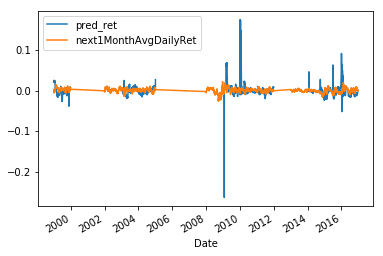

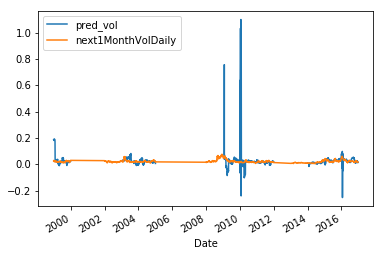

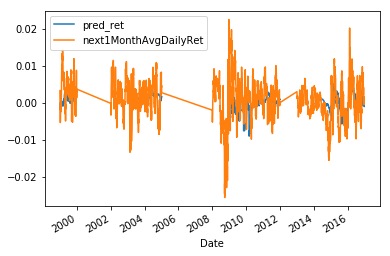

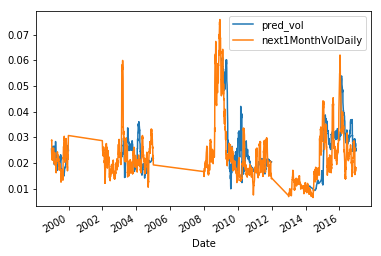

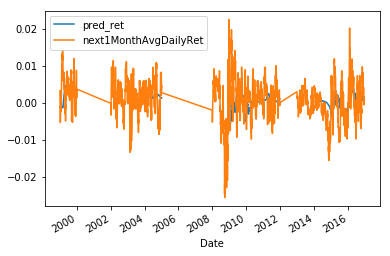

...

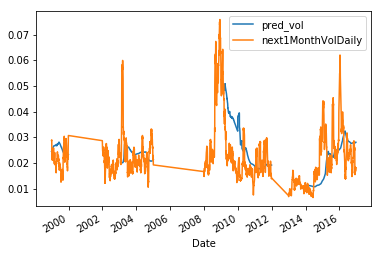

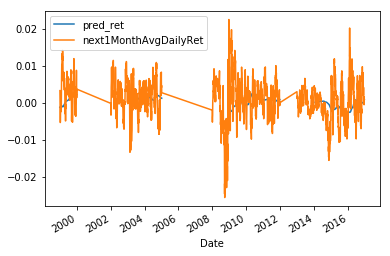

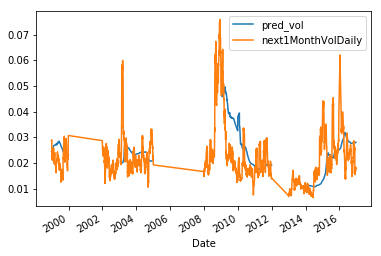

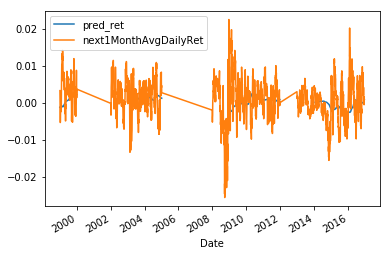

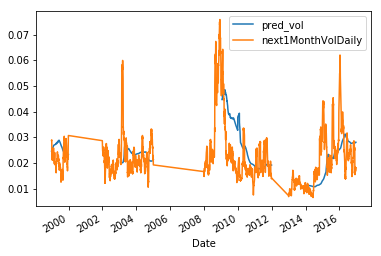

In [278]:
def parameterTune(run):
    if run  == True:
        alpha_list = [x/10000 for x in range(20)]
        output = pd.DataFrame(columns=['alpha','rmse_r','rmse_v','days_in','tot_error'])
        output['alpha'] = pd.Series(alpha_list)
        for a in alpha_list:
            m_lasso = Lasso(alpha=a,random_state=10)
            Prediction_1M_lasso = prediction(response_data.next1MonthAvgDailyRet,response_data.next1MonthVolDaily,m_lasso,m_lasso,1,2,1)
            error = get_error(Prediction_1M_lasso,1)
            output.loc[output['alpha']==a,'rmse_r':'tot_error'] = [e for e in error]
        return output
    else:
        print('need to confirm to run')

lasso_tune = parameterTune(True)

In [279]:
lasso_tune.to_pickle("lasso_tune.pkl")

array([<matplotlib.axes._subplots.AxesSubplot object at 0x000002054EBAA668>,
      dtype=object)

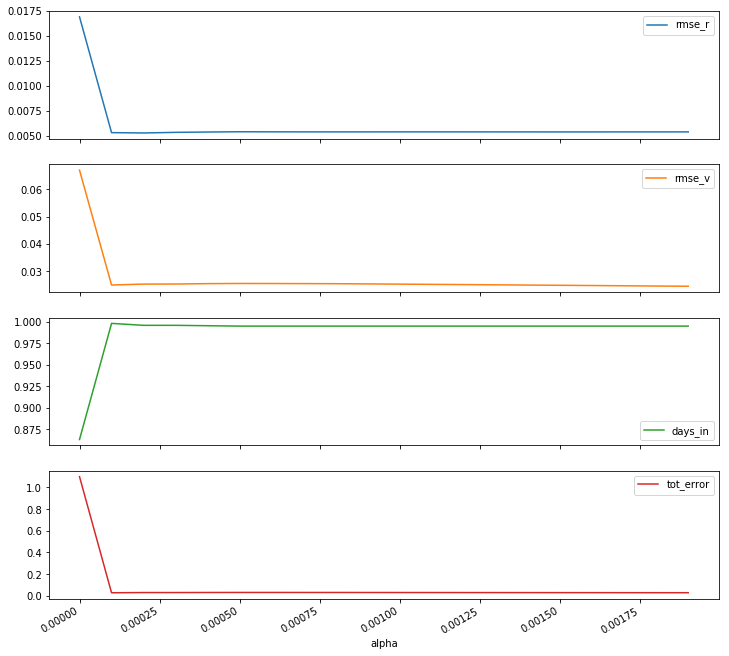

In [288]:
lasso_tune.set_index('alpha').iloc[:,:].plot(subplots=True,figsize=(12,12))

In [286]:
lasso_tune.head()

,alpha,rmse_r,rmse_v,days_in,tot_error
0,0.0000,0.0168849,0.0670528,0.863082,1.09848
1,0.0001,0.00530094,0.0249153,0.998192,0.027932
2,0.0002,0.00526602,0.0252423,0.995933,0.0300423
3,0.0003,0.00532752,0.0252767,0.995933,0.0300745
4,0.0004,0.0053607,0.0254122,0.995481,0.0305793


1998-12-31 00:00:00
mse of training: 1.916195934689861e-05
predicted value: -0.0012773769701328785
1999-01-04 00:00:00
mse of training: 2.0004461591598935e-05
predicted value: -0.0012892029580583936
1999-01-05 00:00:00
mse of training: 2.0061572643074493e-05
predicted value: -0.0012925396030652233
1999-01-06 00:00:00
mse of training: 2.0404602856048424e-05
predicted value: -0.00129780421575116
1999-01-07 00:00:00
mse of training: 2.082603919546676e-05
predicted value: -0.0013018493398607167
1999-01-08 00:00:00
mse of training: 2.1302732336878785e-05
predicted value: -0.0013061219109276223
1999-01-11 00:00:00
mse of training: 2.2525053365328838e-05
predicted value: -0.0012807258638274574
1999-01-12 00:00:00
mse of training: 2.2588085857450237e-05
predicted value: -0.0012830316401387378
1999-01-13 00:00:00
mse of training: 2.26614492294767e-05
predicted value: -0.001233855573957133
1999-01-14 00:00:00
mse of training: 2.2684716633444852e-05
predicted value: -0.0011960140743669514
1999-01

mse of training: 2.7521155523883586e-05
predicted value: 0.0042762415318951105
1999-05-21 00:00:00
mse of training: 2.770083793872151e-05
predicted value: 0.00419459169150483
1999-05-24 00:00:00
mse of training: 2.7959525374653102e-05
predicted value: 0.004020761434714342
1999-05-25 00:00:00
mse of training: 2.7994127357733443e-05
predicted value: 0.004023325537278444
1999-05-26 00:00:00
mse of training: 2.8024809124095295e-05
predicted value: 0.003959828529209191
1999-05-27 00:00:00
mse of training: 2.8125325366655804e-05
predicted value: 0.0038824486899749384
1999-05-28 00:00:00
mse of training: 2.8241552777661656e-05
predicted value: 0.0037752907441417063
1999-06-01 00:00:00
mse of training: 2.855363907155144e-05
predicted value: 0.0035589833433852893
1999-06-02 00:00:00
mse of training: 2.87463405327806e-05
predicted value: 0.0034554190373549693
1999-06-03 00:00:00
mse of training: 2.88606389004401e-05
predicted value: 0.003367681000072777
1999-06-04 00:00:00
mse of training: 2.893

mse of training: 2.5893077496999894e-05
predicted value: 0.0035696186613162484
1999-10-13 00:00:00
mse of training: 2.6025133866266907e-05
predicted value: 0.003532996803575163
1999-10-14 00:00:00
mse of training: 2.6113175345092157e-05
predicted value: 0.003503867439652213
1999-10-15 00:00:00
mse of training: 2.6218370801118477e-05
predicted value: 0.003472082334103653
1999-10-18 00:00:00
mse of training: 2.6442874729002114e-05
predicted value: 0.0033916509659288035
1999-10-19 00:00:00
mse of training: 2.651515395820217e-05
predicted value: 0.003392762077039915
1999-10-20 00:00:00
mse of training: 2.6631513527157358e-05
predicted value: 0.003359744305802754
1999-10-21 00:00:00
mse of training: 2.6700510397471552e-05
predicted value: 0.0033286799409166954
1999-10-22 00:00:00
mse of training: 2.6711741035303465e-05
predicted value: 0.0032736230210697655
1999-10-25 00:00:00
mse of training: 2.6785394705798877e-05
predicted value: 0.003177057270891917
1999-10-26 00:00:00
mse of training: 

2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00
2002-12-13 00:00:00
2002-12-16 00:00:00
2002-12-17 00:00:00
2002-12-18 00:00:00
2002-12-19 00:00:00
2002-12-20 00:00:00
2002-12-23 00:00:00
2002-12-24 00:00:00
2002-12-26 00:00:00
2002-12-27 00:00:00
2002-12-30 00:00:00
2002-12-31 00:00:00
2003-01-02 00:00:00
2003-01-03 00:00:00
2003-01-06 00:00:00
2003-01-07 00:00:00
2003-01-08 00:00:00
2003-01-09 00:00:00
2003-01-10 00:00:00
2003-01-13 00:00:00
2003-01-14 00:00:00
2003-01-15 00:00:00
2003-01-16 00:00:00
2003-01-17 00:00:00
2003-01-21 00:00:00
2003-01-22 00:00:00
2003-01-23 00:00:00
2003-01-24 00:00:00
2003-01-27 00:00:00
2003-01-28 00:00:00
2003-01-29 00:00:00
2003-01-30 00:00:00
mse of training: 1.4346459880422005e-05
predicted value: 0.0013757850570002557
2003-01-31 00:00:00
mse of training: 1.4346459880422005e-05
p

mse of training: 2.0072458669566233e-05
predicted value: -0.0006852412428240088
2003-05-28 00:00:00
mse of training: 2.0229387304132727e-05
predicted value: -0.000589925626936753
2003-05-29 00:00:00
mse of training: 2.0406458575937397e-05
predicted value: -0.0004906579524591242
2003-05-30 00:00:00
mse of training: 2.0523497436906986e-05
predicted value: -0.0004071191862987935
2003-06-02 00:00:00
mse of training: 2.0915537702034894e-05
predicted value: -0.00020664389282533868
2003-06-03 00:00:00
mse of training: 2.0915537702034894e-05
predicted value: -0.00020664389282533868
2003-06-04 00:00:00
mse of training: 2.106863819751157e-05
predicted value: -0.0001162486320648898
2003-06-05 00:00:00
mse of training: 2.132323537506494e-05
predicted value: -5.314341556498115e-06
2003-06-06 00:00:00
mse of training: 2.153158925723188e-05
predicted value: 9.562344070340192e-05
2003-06-09 00:00:00
mse of training: 2.1781158533325584e-05
predicted value: 0.0002576725850369395
2003-06-10 00:00:00
mse 

mse of training: 2.2792980807437584e-05
predicted value: 0.00038552547041285006
2003-10-22 00:00:00
mse of training: 2.2801244844723097e-05
predicted value: 0.00041217927335442225
2003-10-23 00:00:00
mse of training: 2.2728034502804456e-05
predicted value: 0.00043578581879455543
2003-10-24 00:00:00
mse of training: 2.2600887385484556e-05
predicted value: 0.00044947664471648254
2003-10-27 00:00:00
mse of training: 2.2375268643604874e-05
predicted value: 0.0004775742362507668
2003-10-28 00:00:00
mse of training: 2.231093936306342e-05
predicted value: 0.0004765047175341893
2003-10-29 00:00:00
mse of training: 2.2172270168619146e-05
predicted value: 0.00047743127247367145
2003-10-30 00:00:00
mse of training: 2.2081757445038034e-05
predicted value: 0.00047610550580782276
2003-10-31 00:00:00
mse of training: 2.19939034776627e-05
predicted value: 0.000472880983465519
2003-11-03 00:00:00
mse of training: 2.1855632128266618e-05
predicted value: 0.0004526277652294561
2003-11-04 00:00:00
mse of t

mse of training: 1.8601042104166515e-05
predicted value: 0.001569399484623324
2004-04-01 00:00:00
mse of training: 1.814437457070058e-05
predicted value: 0.0014565893132972448
2004-04-02 00:00:00
mse of training: 1.758558183652755e-05
predicted value: 0.0015898790740163796
2004-04-05 00:00:00
mse of training: 1.7212541683283925e-05
predicted value: 0.0014129138443135594
2004-04-06 00:00:00
mse of training: 1.7068361210369727e-05
predicted value: 0.0014171083829501614
2004-04-07 00:00:00
mse of training: 1.696107711201515e-05
predicted value: 0.0014343219482703118
2004-04-08 00:00:00
mse of training: 1.6835811799232295e-05
predicted value: 0.0014589897555522492
2004-04-12 00:00:00
mse of training: 1.663046635785461e-05
predicted value: 0.0018206419569659735
2004-04-13 00:00:00
mse of training: 1.6547331657443197e-05
predicted value: 0.0018294519304971155
2004-04-14 00:00:00
mse of training: 1.6451393293109023e-05
predicted value: 0.0018374953404093975
2004-04-15 00:00:00
mse of training

mse of training: 1.3478883926510505e-05
predicted value: 0.0020584070355785175
2004-08-17 00:00:00
mse of training: 1.3492860328555108e-05
predicted value: 0.0020147202087276075
2004-08-18 00:00:00
mse of training: 1.345026657431387e-05
predicted value: 0.001999941399666143
2004-08-19 00:00:00
mse of training: 1.3387784493597068e-05
predicted value: 0.0019783818743891782
2004-08-20 00:00:00
mse of training: 1.3294962946124191e-05
predicted value: 0.0019860313590075365
2004-08-23 00:00:00
mse of training: 1.3095608210110865e-05
predicted value: 0.0019432225360800797
2004-08-24 00:00:00
mse of training: 1.2971527840179265e-05
predicted value: 0.0018405579897932097
2004-08-25 00:00:00
mse of training: 1.2904895645225635e-05
predicted value: 0.0017473676336839383
2004-08-26 00:00:00
mse of training: 1.2759522717197136e-05
predicted value: 0.0016305739236937371
2004-08-27 00:00:00
mse of training: 1.2479091465053271e-05
predicted value: 0.0016031951908272082
2004-08-30 00:00:00
mse of train

2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00
2008-03-13 00:00:00
2008-03-14 00:00:00
2008-03-17 00:00:00
2008-03-18 00:00:00
2008-03-19 00:00:00


mse of training: 3.8807984325809456e-05
predicted value: -3.6524188186323747e-06
2009-03-20 00:00:00
mse of training: 3.925334825971305e-05
predicted value: 0.0012228019296990147
2009-03-23 00:00:00
mse of training: 3.947006671477928e-05
predicted value: 0.001976088901595268
2009-03-24 00:00:00
mse of training: 3.947006671477928e-05
predicted value: 0.001976088901595268
2009-03-25 00:00:00
mse of training: 3.9708074673440805e-05
predicted value: 0.00243054767037109
2009-03-26 00:00:00
mse of training: 3.9678201333054336e-05
predicted value: 0.002734860483491419
2009-03-27 00:00:00
mse of training: 3.956309935507079e-05
predicted value: 0.0018082220948104528
2009-03-30 00:00:00
mse of training: 3.932197017482069e-05
predicted value: 0.001962155851723116
2009-03-31 00:00:00
mse of training: 3.932197017482069e-05
predicted value: -0.0003540642314634121
2009-04-01 00:00:00
mse of training: 3.926587278508395e-05
predicted value: 2.189872863420095e-06
2009-04-02 00:00:00
mse of training: 3.9

mse of training: 4.523461989638968e-05
predicted value: 0.000806808756586952
2009-08-03 00:00:00
mse of training: 4.521621315083493e-05
predicted value: 0.000721568690307775
2009-08-04 00:00:00
mse of training: 4.521621315083493e-05
predicted value: 0.000721568690307775
2009-08-05 00:00:00
mse of training: 4.5320971457868595e-05
predicted value: 0.0008046770249699117
2009-08-06 00:00:00
mse of training: 4.542840293259313e-05
predicted value: 0.0008953836468916058
2009-08-07 00:00:00
mse of training: 4.561990549930995e-05
predicted value: 0.0014126487007935715
2009-08-10 00:00:00
mse of training: 4.596764624517688e-05
predicted value: 0.0017847322341191033
2009-08-11 00:00:00
mse of training: 4.60737376482492e-05
predicted value: 0.0016798984079058228
2009-08-12 00:00:00
mse of training: 4.6294031494135615e-05
predicted value: 0.0017835458896313452
2009-08-13 00:00:00
mse of training: 4.643309836753001e-05
predicted value: 0.0018092172585578957
2009-08-14 00:00:00
mse of training: 4.652

mse of training: 3.534215218718108e-05
predicted value: -0.00386301685643395
2009-12-02 00:00:00
mse of training: 3.52802103623735e-05
predicted value: -0.0038435916806969853
2009-12-03 00:00:00
mse of training: 3.5207780603194256e-05
predicted value: -0.0038891386651838285
2009-12-04 00:00:00
mse of training: 3.5091327049972424e-05
predicted value: -0.002985793612918515
2009-12-07 00:00:00
mse of training: 3.492480969072179e-05
predicted value: -0.00298260376139412
2009-12-08 00:00:00
mse of training: 3.497807295430043e-05
predicted value: -0.0029953428244428888
2009-12-09 00:00:00
mse of training: 3.489603711967958e-05
predicted value: -0.0030183221468458397
2009-12-10 00:00:00
mse of training: 3.480531913313304e-05
predicted value: -0.0030512123100417624
2009-12-11 00:00:00
mse of training: 3.47302563115928e-05
predicted value: -0.003589541891827374
2009-12-14 00:00:00
mse of training: 3.454773012918226e-05
predicted value: -0.003694258586185089
2009-12-15 00:00:00
mse of training: 

mse of training: 3.1311261795582234e-05
predicted value: -0.0014456881012159745
2010-04-26 00:00:00
mse of training: 3.116331280017042e-05
predicted value: -0.0012919941701863358
2010-04-27 00:00:00
mse of training: 3.1235084787811525e-05
predicted value: -0.0012368413627967569
2010-04-28 00:00:00
mse of training: 3.127295737332535e-05
predicted value: -0.0011560667422976512
2010-04-29 00:00:00
mse of training: 3.134351382123971e-05
predicted value: -0.0010880679299826957
2010-04-30 00:00:00
mse of training: 3.137044135727852e-05
predicted value: -0.0003817428877531002
2010-05-03 00:00:00
mse of training: 3.138432976980254e-05
predicted value: -0.0003025917768995686
2010-05-04 00:00:00
mse of training: 3.120316470005618e-05
predicted value: -0.00015912503128597596
2010-05-05 00:00:00
mse of training: 3.063751892228454e-05
predicted value: 2.623961994688718e-05
2010-05-06 00:00:00
mse of training: 3.0049696067445168e-05
predicted value: 0.00020991695732466235
2010-05-07 00:00:00
mse of 

predicted value: 0.0003613236183974097
2010-09-03 00:00:00
mse of training: 2.1518825190264156e-05
predicted value: 0.000328938303960144
2010-09-07 00:00:00
mse of training: 2.1350941613047032e-05
predicted value: 0.0002703012599189472
2010-09-08 00:00:00
mse of training: 2.134696344398267e-05
predicted value: 0.00024179105046296566
2010-09-09 00:00:00
mse of training: 2.1328514583177775e-05
predicted value: 0.0002267054856419603
2010-09-10 00:00:00
mse of training: 2.126504092354751e-05
predicted value: 0.00021946219339574706
2010-09-13 00:00:00
mse of training: 2.114814720933201e-05
predicted value: 0.00023020823138622352
2010-09-14 00:00:00
mse of training: 2.1208453887811844e-05
predicted value: 0.0002289261801041727
2010-09-15 00:00:00
mse of training: 2.1207805749269998e-05
predicted value: 0.0002260556838830875
2010-09-16 00:00:00
mse of training: 2.120205143196319e-05
predicted value: 0.0002172989467209007
2010-09-17 00:00:00
mse of training: 2.1187008272359904e-05
predicted va

mse of training: 1.2944517247717079e-05
predicted value: 0.0007639733102701823
2011-01-18 00:00:00
mse of training: 1.2932129757006566e-05
predicted value: 0.0007803172162608706
2011-01-19 00:00:00
mse of training: 1.2912506137209915e-05
predicted value: 0.000785934810647504
2011-01-20 00:00:00
mse of training: 1.2888219706295982e-05
predicted value: 0.0007913666383842334
2011-01-21 00:00:00
mse of training: 1.2864574095107906e-05
predicted value: 0.0007961819414136975
2011-01-24 00:00:00
mse of training: 1.2857725815725543e-05
predicted value: 0.0007975546457354371
2011-01-25 00:00:00
mse of training: 1.2894456570376653e-05
predicted value: 0.0007965909211662974
2011-01-26 00:00:00
mse of training: 1.2941554659074541e-05
predicted value: 0.0007864948185303956
2011-01-27 00:00:00
mse of training: 1.2954388265814666e-05
predicted value: 0.0007826284755695777
2011-01-28 00:00:00
mse of training: 1.2963357566526209e-05
predicted value: 0.0007801119577380412
2011-01-31 00:00:00
mse of trai

mse of training: 1.4810515582837099e-05
predicted value: 0.0008062953997880931
2011-06-14 00:00:00
mse of training: 1.4809785484500338e-05
predicted value: 0.0008174643864367904
2011-06-15 00:00:00
mse of training: 1.4758260094907041e-05
predicted value: 0.0008259399268250413
2011-06-16 00:00:00
mse of training: 1.4700756181436995e-05
predicted value: 0.0008338506243717513
2011-06-17 00:00:00
mse of training: 1.4664366969914233e-05
predicted value: 0.0008378333307267957
2011-06-20 00:00:00
mse of training: 1.4650548933386162e-05
predicted value: 0.000817762890878223
2011-06-21 00:00:00
mse of training: 1.4602818058312395e-05
predicted value: 0.0008338063627689764
2011-06-22 00:00:00
mse of training: 1.4503475810086443e-05
predicted value: 0.0008431113692169192
2011-06-23 00:00:00
mse of training: 1.4377580928037987e-05
predicted value: 0.0008530517770617267
2011-06-24 00:00:00
mse of training: 1.4267117146088297e-05
predicted value: 0.0008616086657185106
2011-06-27 00:00:00
mse of trai

mse of training: 1.3279105391140501e-05
predicted value: 0.0005213480240087259
2011-11-03 00:00:00
mse of training: 1.3517676711935023e-05
predicted value: 0.000570809882469607
2011-11-04 00:00:00
mse of training: 1.3631480107648e-05
predicted value: 0.0006079800215059683
2011-11-07 00:00:00
mse of training: 1.3763146462782412e-05
predicted value: 0.0006716239194921987
2011-11-08 00:00:00
mse of training: 1.3774066057301309e-05
predicted value: 0.0006688984315445318
2011-11-09 00:00:00
mse of training: 1.3737170475335787e-05
predicted value: 0.0006933166097852709
2011-11-10 00:00:00
mse of training: 1.3825161207089978e-05
predicted value: 0.0007222538568584583
2011-11-11 00:00:00
mse of training: 1.3940548234225827e-05
predicted value: 0.0007544087232434598
2011-11-14 00:00:00
mse of training: 1.4142599984610357e-05
predicted value: 0.0008192786373684533
2011-11-15 00:00:00
mse of training: 1.4142599984610357e-05
predicted value: 0.0008192786373684533
2011-11-16 00:00:00
mse of trainin

2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00
2014-01-21 00:00:00
2014-01-22 00:00:00
2014-01-23 00:00:00
2014-01-24 00:00:00
2014-01-27 00:00:00
mse of training: 5.796657997874637e-06
predicted value: 9.494385442738575e-05
2014-01-28 00:00:00
ms

mse of training: 5.157911328589764e-06
predicted value: 0.0004248041066819045
2014-06-18 00:00:00
mse of training: 5.143953511859601e-06
predicted value: 0.00043725779883812795
2014-06-19 00:00:00
mse of training: 5.133319239142672e-06
predicted value: 0.00045600662784754333
2014-06-20 00:00:00
mse of training: 5.117316386697565e-06
predicted value: 0.0004683316120761274
2014-06-23 00:00:00
mse of training: 5.095414207144676e-06
predicted value: 0.0004846924763546287
2014-06-24 00:00:00
mse of training: 5.1047426543969285e-06
predicted value: 0.0004866924763546289
2014-06-25 00:00:00
mse of training: 5.114559543515687e-06
predicted value: 0.0004886924763546287
2014-06-26 00:00:00
mse of training: 5.1090472147681565e-06
predicted value: 0.0004909879989535523
2014-06-27 00:00:00
mse of training: 5.105188605130597e-06
predicted value: 0.0004995563842186952
2014-06-30 00:00:00
mse of training: 5.0800569076476926e-06
predicted value: 0.0005097407167094416
2014-07-01 00:00:00
mse of training

mse of training: 5.456683702355443e-06
predicted value: -0.00021722151604080994
2014-10-21 00:00:00
mse of training: 5.468740740274805e-06
predicted value: -0.00021730596438022698
2014-10-22 00:00:00
mse of training: 5.480910981989864e-06
predicted value: -0.00023726612496018204
2014-10-23 00:00:00
mse of training: 5.508329223112911e-06
predicted value: -0.00025968490729402066
2014-10-24 00:00:00
mse of training: 5.56284813097646e-06
predicted value: -0.0002881327433896419
2014-10-27 00:00:00
mse of training: 5.701937678246961e-06
predicted value: -0.00034953753186592893
2014-10-28 00:00:00
mse of training: 5.709390933816691e-06
predicted value: -0.0003544258697342861
2014-10-29 00:00:00
mse of training: 5.7525466638746385e-06
predicted value: -0.0003888866973903672
2014-10-30 00:00:00
mse of training: 5.793238577678064e-06
predicted value: -0.0004131408917458398
2014-10-31 00:00:00
mse of training: 5.838660426354169e-06
predicted value: -0.00043624816311495533
2014-11-03 00:00:00
mse 

mse of training: 1.1023899401296487e-05
predicted value: 0.001029760571834724
2015-03-13 00:00:00
mse of training: 1.1068907242054097e-05
predicted value: 0.0009718828339564025
2015-03-16 00:00:00
mse of training: 1.153597898433077e-05
predicted value: 0.000731162146700077
2015-03-17 00:00:00
mse of training: 1.1530088836717603e-05
predicted value: 0.0007671776930312695
2015-03-18 00:00:00
mse of training: 1.1513178058798947e-05
predicted value: 0.0008126069162707533
2015-03-19 00:00:00
mse of training: 1.164683434063353e-05
predicted value: 0.0007555668508888447
2015-03-20 00:00:00
mse of training: 1.174206347426122e-05
predicted value: 0.0007103824558683048
2015-03-23 00:00:00
mse of training: 1.1833887640558927e-05
predicted value: 0.0006262164852728928
2015-03-24 00:00:00
mse of training: 1.1795124389352252e-05
predicted value: 0.0006773893881356456
2015-03-25 00:00:00
mse of training: 1.1721328949441112e-05
predicted value: 0.0007518086682692824
2015-03-26 00:00:00
mse of training

mse of training: 1.3284482167876306e-05
predicted value: -0.0010808972272046196
2015-07-22 00:00:00
mse of training: 1.3422044577217409e-05
predicted value: -0.0011316654959099151
2015-07-23 00:00:00
mse of training: 1.3597757458910092e-05
predicted value: -0.0011869301392626501
2015-07-24 00:00:00
mse of training: 1.3756344290479766e-05
predicted value: -0.0015221749149383597
2015-07-27 00:00:00
mse of training: 1.4183751795883732e-05
predicted value: -0.0016217217938993105
2015-07-28 00:00:00
mse of training: 1.4213216667998378e-05
predicted value: -0.0016215826925960533
2015-07-29 00:00:00
mse of training: 1.4328527381671334e-05
predicted value: -0.0016529424573644572
2015-07-30 00:00:00
mse of training: 1.453432911382013e-05
predicted value: -0.0016945385938388667
2015-07-31 00:00:00
mse of training: 1.4671736747647021e-05
predicted value: -0.0016333333827656853
2015-08-03 00:00:00
mse of training: 1.5024976168601519e-05
predicted value: -0.0017189056710853407
2015-08-04 00:00:00
m

mse of training: 1.777884073785476e-05
predicted value: -0.0059075305887451406
2015-11-17 00:00:00
mse of training: 1.7779716944893085e-05
predicted value: -0.005888667874304805
2015-11-18 00:00:00
mse of training: 1.7731783730979386e-05
predicted value: -0.005880239533788135
2015-11-19 00:00:00
mse of training: 1.7666391766209307e-05
predicted value: -0.005908415143463406
2015-11-20 00:00:00
mse of training: 1.7602808596992073e-05
predicted value: -0.005401153793288649
2015-11-23 00:00:00
mse of training: 1.7512076765009582e-05
predicted value: -0.005417273216237775
2015-11-24 00:00:00
mse of training: 1.7541329941764204e-05
predicted value: -0.005404813245916391
2015-11-25 00:00:00
mse of training: 1.7604782261271706e-05
predicted value: -0.0053218047017402435
2015-11-26 00:00:00
mse of training: 1.764480479440644e-05
predicted value: -0.005260404999317679
2015-11-27 00:00:00
mse of training: 1.7631126380989e-05
predicted value: -0.004733062392597284
2015-11-30 00:00:00
mse of traini

mse of training: 2.1855692982030114e-05
predicted value: 0.00461615104431962
2016-03-31 00:00:00
mse of training: 2.1920082274080246e-05
predicted value: 0.004528507409354336
2016-04-01 00:00:00
mse of training: 2.1991432777752095e-05
predicted value: 0.005272159920132552
2016-04-04 00:00:00
mse of training: 2.2201954150460908e-05
predicted value: 0.004992011500480988
2016-04-05 00:00:00
mse of training: 2.2205257675298828e-05
predicted value: 0.004964169368076542
2016-04-06 00:00:00
mse of training: 2.2283874010252508e-05
predicted value: 0.00479765530830813
2016-04-07 00:00:00
mse of training: 2.2181112439759604e-05
predicted value: 0.00473076373960501
2016-04-08 00:00:00
mse of training: 2.213998486216325e-05
predicted value: 0.0048686005742323585
2016-04-11 00:00:00
mse of training: 2.2022311359690177e-05
predicted value: 0.0047560319928350876
2016-04-12 00:00:00
mse of training: 2.199776756201061e-05
predicted value: 0.004717086673246294
2016-04-13 00:00:00
mse of training: 2.2001

mse of training: 2.2865631108005444e-05
predicted value: 0.00011460009131165905
2016-08-05 00:00:00
mse of training: 2.2714401730091653e-05
predicted value: -0.00014203966078998008
2016-08-08 00:00:00
mse of training: 2.2587317619688057e-05
predicted value: -0.00018188022036126628
2016-08-09 00:00:00
mse of training: 2.2650176996050264e-05
predicted value: -0.00018462699705575764
2016-08-10 00:00:00
mse of training: 2.2650631572233126e-05
predicted value: -0.00018442549493530996
2016-08-11 00:00:00
mse of training: 2.261233619910578e-05
predicted value: -0.00019374247516829209
2016-08-12 00:00:00
mse of training: 2.263128138065472e-05
predicted value: -0.0006731524650984717
2016-08-15 00:00:00
mse of training: 2.255553041752141e-05
predicted value: -0.0006667019108317924
2016-08-16 00:00:00
mse of training: 2.258912274390896e-05
predicted value: -0.0006688094306760931
2016-08-17 00:00:00
mse of training: 2.2618501429843423e-05
predicted value: -0.0006277826462952087
2016-08-18 00:00:00

mse of training: 2.248547553567079e-05
predicted value: 0.0005473816375675565
2016-12-23 00:00:00
mse of training: 2.2374224029327908e-05
predicted value: 0.00034630337851877715
1998-12-31 00:00:00
mse of training: 7.064521933183287e-05
predicted value: 0.025020646267189386
1999-01-04 00:00:00
mse of training: 7.21018539897249e-05
predicted value: 0.024422268851459383
1999-01-05 00:00:00
mse of training: 7.21925326390284e-05
predicted value: 0.024415373457067353
1999-01-06 00:00:00
mse of training: 7.298332897863497e-05
predicted value: 0.024468333845132535
1999-01-07 00:00:00
mse of training: 7.367974078505087e-05
predicted value: 0.024518456769684602
1999-01-08 00:00:00
mse of training: 7.443030701699358e-05
predicted value: 0.024512318808103218
1999-01-11 00:00:00
mse of training: 7.6161807167798e-05
predicted value: 0.02474658073229035
1999-01-12 00:00:00
mse of training: 7.628952265516418e-05
predicted value: 0.024738896906946358
1999-01-13 00:00:00
mse of training: 7.740574825117

mse of training: 7.357938030858632e-05
predicted value: 0.021209120465433953
1999-05-10 00:00:00
mse of training: 7.35897412135487e-05
predicted value: 0.021059754114432908
1999-05-11 00:00:00
mse of training: 7.36911775818696e-05
predicted value: 0.02105628156767642
1999-05-12 00:00:00
mse of training: 7.366411794351305e-05
predicted value: 0.02103434450094158
1999-05-13 00:00:00
mse of training: 7.363805642777339e-05
predicted value: 0.021010424476234225
1999-05-14 00:00:00
mse of training: 7.351148037932044e-05
predicted value: 0.021052701258191513
1999-05-17 00:00:00
mse of training: 7.325385722727987e-05
predicted value: 0.021016695497036317
1999-05-18 00:00:00
mse of training: 7.334741458332637e-05
predicted value: 0.021014359378982335
1999-05-19 00:00:00
mse of training: 7.330957329626818e-05
predicted value: 0.021000480409315975
1999-05-20 00:00:00
mse of training: 7.326859974879395e-05
predicted value: 0.020988793359142985
1999-05-21 00:00:00
mse of training: 7.322061414720975

mse of training: 4.27056485195436e-05
predicted value: 0.016626807321439098
1999-09-09 00:00:00
mse of training: 4.1999916620949955e-05
predicted value: 0.01648692012182037
1999-09-10 00:00:00
mse of training: 4.1291292439370396e-05
predicted value: 0.01634989935911078
1999-09-13 00:00:00
mse of training: 4.1560423205303065e-05
predicted value: 0.016531814351703707
1999-09-14 00:00:00
mse of training: 4.193628953348808e-05
predicted value: 0.016646317523017262
1999-09-15 00:00:00
mse of training: 4.176466222822952e-05
predicted value: 0.01671513866066103
1999-09-16 00:00:00
mse of training: 4.151495905007469e-05
predicted value: 0.01678784830746477
1999-09-17 00:00:00
mse of training: 4.118849439662124e-05
predicted value: 0.016867842505890462
1999-09-20 00:00:00
mse of training: 4.078697038424052e-05
predicted value: 0.016972052815078204
1999-09-21 00:00:00
mse of training: 4.065838490827717e-05
predicted value: 0.017030605030932927
1999-09-22 00:00:00
mse of training: 4.0452966577156

2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-03 00:00:00


mse of training: 5.189723065694431e-05
predicted value: 0.0268371983211579
2003-04-25 00:00:00
mse of training: 5.181900253300701e-05
predicted value: 0.02451430817280324
2003-04-28 00:00:00
mse of training: 5.168146057453763e-05
predicted value: 0.02450860801684428
2003-04-29 00:00:00
mse of training: 5.168146057453763e-05
predicted value: 0.02450860801684428
2003-04-30 00:00:00
mse of training: 5.159164098622844e-05
predicted value: 0.02447642831869301
2003-05-01 00:00:00
mse of training: 5.15540009291321e-05
predicted value: 0.02442848303189788
2003-05-02 00:00:00
mse of training: 5.1505028880900115e-05
predicted value: 0.024932721650249755
2003-05-05 00:00:00
mse of training: 5.12844487973523e-05
predicted value: 0.024888341327733127
2003-05-06 00:00:00
mse of training: 5.12844487973523e-05
predicted value: 0.024888341327733127
2003-05-07 00:00:00
mse of training: 5.1131434212056294e-05
predicted value: 0.024878885296545288
2003-05-08 00:00:00
mse of training: 5.0977434379460024e-0

mse of training: 4.654447594980562e-05
predicted value: 0.0256808256424055
2003-09-17 00:00:00
mse of training: 4.639345551161577e-05
predicted value: 0.02553625116009975
2003-09-18 00:00:00
mse of training: 4.620760607062631e-05
predicted value: 0.025397586065724793
2003-09-19 00:00:00
mse of training: 4.602396313781724e-05
predicted value: 0.027166943647462954
2003-09-22 00:00:00
mse of training: 4.5832788347374405e-05
predicted value: 0.02688553136952565
2003-09-23 00:00:00
mse of training: 4.571083809284457e-05
predicted value: 0.0268649609895231
2003-09-24 00:00:00
mse of training: 4.553029501735909e-05
predicted value: 0.02676292401324757
2003-09-25 00:00:00
mse of training: 4.535326030941395e-05
predicted value: 0.026652602627006673
2003-09-26 00:00:00
mse of training: 4.525785154465659e-05
predicted value: 0.02650023594931522
2003-09-29 00:00:00
mse of training: 4.514398952260021e-05
predicted value: 0.02636249787272308
2003-09-30 00:00:00
mse of training: 4.523722445883298e-05

mse of training: 4.7493956422421656e-05
predicted value: 0.02799379138490713
2004-02-04 00:00:00
mse of training: 4.7355277385500314e-05
predicted value: 0.027148119588337728
2004-02-05 00:00:00
mse of training: 4.719323377171896e-05
predicted value: 0.02704938549465738
2004-02-06 00:00:00
mse of training: 4.700589233547067e-05
predicted value: 0.02860180248976219
2004-02-09 00:00:00
mse of training: 4.660860085099883e-05
predicted value: 0.028636552466874077
2004-02-10 00:00:00
mse of training: 4.64996271321091e-05
predicted value: 0.02874788898033072
2004-02-11 00:00:00
mse of training: 4.62898682490562e-05
predicted value: 0.02879526043339589
2004-02-12 00:00:00
mse of training: 4.607783953467212e-05
predicted value: 0.028821864227930136
2004-02-13 00:00:00
mse of training: 4.5844325160564134e-05
predicted value: 0.028703970566997118
2004-02-17 00:00:00
mse of training: 4.5534367906107544e-05
predicted value: 0.028246110104348583
2004-02-18 00:00:00
mse of training: 4.54286113014409

mse of training: 5.2259241350985166e-05
predicted value: 0.017983853869411804
2004-06-08 00:00:00
mse of training: 5.232427021542497e-05
predicted value: 0.018005792320999952
2004-06-09 00:00:00
mse of training: 5.283849297831349e-05
predicted value: 0.018127870337917955
2004-06-10 00:00:00
mse of training: 5.316310012509901e-05
predicted value: 0.018246424054361915
2004-06-14 00:00:00
mse of training: 5.426567709582178e-05
predicted value: 0.019190690260185175
2004-06-15 00:00:00
mse of training: 5.438524275581109e-05
predicted value: 0.019190458804176642
2004-06-16 00:00:00
mse of training: 5.454472244917709e-05
predicted value: 0.019347823603167433
2004-06-17 00:00:00
mse of training: 5.465289053247391e-05
predicted value: 0.01947989522185585
2004-06-18 00:00:00
mse of training: 5.464227674827266e-05
predicted value: 0.017967603106707104
2004-06-21 00:00:00
mse of training: 5.4696425771157344e-05
predicted value: 0.018221113303991586
2004-06-22 00:00:00
mse of training: 5.4539696847

mse of training: 1.1439851941495672e-05
predicted value: 0.02090886720551769
2004-10-21 00:00:00
mse of training: 1.1561131723716827e-05
predicted value: 0.020891012907212243
2004-10-22 00:00:00
mse of training: 1.1681092408519066e-05
predicted value: 0.020859263205914077
2004-10-25 00:00:00
mse of training: 1.179806405016029e-05
predicted value: 0.020761446219762756
2004-10-26 00:00:00
mse of training: 1.1803317956781194e-05
predicted value: 0.02075772151620285
2004-10-27 00:00:00
mse of training: 1.178009874039871e-05
predicted value: 0.020762245085835303
2004-10-28 00:00:00
mse of training: 1.175810901318268e-05
predicted value: 0.020768271489561466
2004-10-29 00:00:00
mse of training: 1.1736030703689781e-05
predicted value: 0.020777084404236718
2004-11-01 00:00:00
mse of training: 1.1702980616699784e-05
predicted value: 0.020801359199471486
2004-11-02 00:00:00
mse of training: 1.1684687071815139e-05
predicted value: 0.020797659262889522
2004-11-03 00:00:00
mse of training: 1.170589

2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-22 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2008-09-25 00:00:00
2008-09-26 00:00:00
2008-09-29 00:00:00
2008-09-30 00:00:00
2008-10-01 00:00:00
2008-10-02 00:00:00
2008-10-03 00:00:00
2008-10-06 00:00:00
2008-10-07 00:00:00
2008-10-08 00:00:00
2008-10-09 00:00:00
2008-10-10 00:00:00
2008-10-13 00:00:00
2008-10-14 00:00:00
2008-10-15 00:00:00
2008-10-16 00:00:00
2008-10-17 00:00:00
2008-10-20 00:00:00
2008-10-21 00:00:00
2008-10-22 00:00:00
2008-10-23 00:00:00
2008-10-24 00:00:00
2008-10-27 00:00:00
2008-10-28 00:00:00
2008-10-29 00:00:00
2008-10-30 00:00:00
2008-10-31 00:00:00
2008-11-03 00:00:00
2008-11-04 00:00:00
2008-11-05 00:00:00
2008-11-06 00:00:00
2008-11-07 00:00:00
2008-11-10 00:00:00
2008-11-11 00:00:00
2008-11-12 00:00:00
2008-11-13 00:00:00
2008-11-14 00:00:00
2008-11-17 00:00:00
2008-11-18 00:00:00
2008-11-19 00:00:00
2008-11-20 00:00:00
2008-11-21 00:00:00
2008-11-24 00:00:00
2008-11-25 00:00:00
2008-11-26 00:00:00


mse of training: 6.500255014137383e-05
predicted value: 0.055376605508974844
2009-05-11 00:00:00
mse of training: 6.500544344510662e-05
predicted value: 0.0548054671216088
2009-05-12 00:00:00
mse of training: 6.500544344510662e-05
predicted value: 0.05468460451213332
2009-05-13 00:00:00
mse of training: 6.563899785715884e-05
predicted value: 0.05399324824239627
2009-05-14 00:00:00
mse of training: 6.607494221490068e-05
predicted value: 0.05324085815800088
2009-05-15 00:00:00
mse of training: 6.645811398410958e-05
predicted value: 0.053166755837128446
2009-05-18 00:00:00
mse of training: 6.760357362318114e-05
predicted value: 0.05105240609160393
2009-05-19 00:00:00
mse of training: 6.760357362318114e-05
predicted value: 0.050687902214557976
2009-05-20 00:00:00
mse of training: 6.978954925090442e-05
predicted value: 0.048707161854050295
2009-05-21 00:00:00
mse of training: 7.176175938827524e-05
predicted value: 0.04763650533995588
2009-05-22 00:00:00
mse of training: 7.349936164728185e-0

mse of training: 7.280276455276945e-05
predicted value: 0.02089256578820407
2009-09-10 00:00:00
mse of training: 7.224399490793642e-05
predicted value: 0.020935664832723917
2009-09-11 00:00:00
mse of training: 7.173943084903681e-05
predicted value: 0.021677320330745955
2009-09-14 00:00:00
mse of training: 7.11928483358268e-05
predicted value: 0.02217266917405268
2009-09-15 00:00:00
mse of training: 7.083984816977327e-05
predicted value: 0.02185540091856042
2009-09-16 00:00:00
mse of training: 7.024433372658346e-05
predicted value: 0.021119193066869185
2009-09-17 00:00:00
mse of training: 6.959438898767004e-05
predicted value: 0.021104967259473716
2009-09-18 00:00:00
mse of training: 6.891979141098214e-05
predicted value: 0.022728372505206033
2009-09-21 00:00:00
mse of training: 6.815633714334548e-05
predicted value: 0.02341168986165719
2009-09-22 00:00:00
mse of training: 6.770019804859829e-05
predicted value: 0.022683425752970998
2009-09-23 00:00:00
mse of training: 6.710977374178375e

mse of training: 5.02232954060251e-05
predicted value: 0.02797396313249296
2010-01-22 00:00:00
mse of training: 4.952264744616698e-05
predicted value: 0.025849687395059953
2010-01-25 00:00:00
mse of training: 4.869733151639744e-05
predicted value: 0.025380246388731112
2010-01-26 00:00:00
mse of training: 4.786491579768695e-05
predicted value: 0.02514996877646384
2010-01-27 00:00:00
mse of training: 4.67718933118836e-05
predicted value: 0.024908557907754092
2010-01-28 00:00:00
mse of training: 4.563051692279116e-05
predicted value: 0.0244562019083056
2010-01-29 00:00:00
mse of training: 4.4438281987082655e-05
predicted value: 0.026617278893140625
2010-02-01 00:00:00
mse of training: 4.331955002667779e-05
predicted value: 0.02590329914266945
2010-02-02 00:00:00
mse of training: 4.2560515254928885e-05
predicted value: 0.025586464560678382
2010-02-03 00:00:00
mse of training: 4.1969957491758824e-05
predicted value: 0.024556326201863633
2010-02-04 00:00:00
mse of training: 4.137158616913144

mse of training: 3.570733699146551e-05
predicted value: 0.022047398238181852
2010-06-23 00:00:00
mse of training: 3.592268959518581e-05
predicted value: 0.022033687853056184
2010-06-24 00:00:00
mse of training: 3.617513377196352e-05
predicted value: 0.021914238165511808
2010-06-25 00:00:00
mse of training: 3.666798246937192e-05
predicted value: 0.02056716505239138
2010-06-28 00:00:00
mse of training: 3.7404701986393876e-05
predicted value: 0.01982204902912267
2010-06-29 00:00:00
mse of training: 3.764826944489943e-05
predicted value: 0.02024207067014821
2010-06-30 00:00:00
mse of training: 3.800546560518075e-05
predicted value: 0.022058763515428008
2010-07-01 00:00:00
mse of training: 3.853204039363038e-05
predicted value: 0.021376856406920098
2010-07-02 00:00:00
mse of training: 3.90400031676994e-05
predicted value: 0.02213344637927541
2010-07-06 00:00:00
mse of training: 3.998972097534111e-05
predicted value: 0.020686626218543242
2010-07-07 00:00:00
mse of training: 4.073270601268709

mse of training: 2.0549421056552793e-05
predicted value: 0.01920480865527446
2010-11-10 00:00:00
mse of training: 2.0576339031536153e-05
predicted value: 0.019185598854091376
2010-11-11 00:00:00
mse of training: 2.0591702427529045e-05
predicted value: 0.019174885429992496
2010-11-12 00:00:00
mse of training: 2.0606088965607033e-05
predicted value: 0.019101494074876265
2010-11-15 00:00:00
mse of training: 2.0549146401372747e-05
predicted value: 0.019082119741786144
2010-11-16 00:00:00
mse of training: 2.0585667820133652e-05
predicted value: 0.019076702474090178
2010-11-17 00:00:00
mse of training: 2.0569395855225856e-05
predicted value: 0.019068081177313026
2010-11-18 00:00:00
mse of training: 2.0556426773972137e-05
predicted value: 0.01904460427797051
2010-11-19 00:00:00
mse of training: 2.0553897859946783e-05
predicted value: 0.018840558374250464
2010-11-22 00:00:00
mse of training: 2.0528467685604837e-05
predicted value: 0.018757426326421255
2010-11-23 00:00:00
mse of training: 2.056

mse of training: 2.2169707010038826e-05
predicted value: 0.01841464493973575
2011-04-12 00:00:00
mse of training: 2.215627282192121e-05
predicted value: 0.018426973533480783
2011-04-13 00:00:00
mse of training: 2.2090232595658734e-05
predicted value: 0.018422217200341907
2011-04-14 00:00:00
mse of training: 2.202914307065815e-05
predicted value: 0.018375764438169986
2011-04-15 00:00:00
mse of training: 2.1965695635996476e-05
predicted value: 0.018237543425209963
2011-04-18 00:00:00
mse of training: 2.1955874127955263e-05
predicted value: 0.018113501592082755
2011-04-19 00:00:00
mse of training: 2.1963150111377992e-05
predicted value: 0.018121330853796667
2011-04-20 00:00:00
mse of training: 2.1972445905532244e-05
predicted value: 0.01808037225521067
2011-04-21 00:00:00
mse of training: 2.197561078446182e-05
predicted value: 0.018039878048520648
2011-04-25 00:00:00
mse of training: 2.1960209553261252e-05
predicted value: 0.017983570486546578
2011-04-26 00:00:00
mse of training: 2.199418

mse of training: 2.5554855832033513e-05
predicted value: 0.021211171263162115
2011-09-15 00:00:00
mse of training: 2.538266639375421e-05
predicted value: 0.021260791836066162
2011-09-16 00:00:00
mse of training: 2.5203616816558315e-05
predicted value: 0.02156148517646887
2011-09-19 00:00:00
mse of training: 2.5270028855449592e-05
predicted value: 0.021444276560782283
2011-09-20 00:00:00
mse of training: 2.522106556450997e-05
predicted value: 0.021517953730564345
2011-09-21 00:00:00
mse of training: 2.512006813646351e-05
predicted value: 0.02157902522427571
2011-09-22 00:00:00
mse of training: 2.5027597647911923e-05
predicted value: 0.021635466392293228
2011-09-23 00:00:00
mse of training: 2.493696205710496e-05
predicted value: 0.0213132986900662
2011-09-26 00:00:00
mse of training: 2.4841781847534585e-05
predicted value: 0.021339134799433994
2011-09-27 00:00:00
mse of training: 2.4848507336626262e-05
predicted value: 0.021370846066533142
2011-09-28 00:00:00
mse of training: 2.486865318

2013-11-06 00:00:00
2013-11-07 00:00:00
2013-11-08 00:00:00
2013-11-11 00:00:00
2013-11-12 00:00:00
2013-11-13 00:00:00
2013-11-14 00:00:00
2013-11-15 00:00:00
2013-11-18 00:00:00
2013-11-19 00:00:00
2013-11-20 00:00:00
2013-11-21 00:00:00
2013-11-22 00:00:00
2013-11-25 00:00:00
2013-11-26 00:00:00
2013-11-27 00:00:00
2013-11-29 00:00:00
2013-12-02 00:00:00
2013-12-03 00:00:00
2013-12-04 00:00:00
2013-12-05 00:00:00
2013-12-06 00:00:00
2013-12-09 00:00:00
2013-12-10 00:00:00
2013-12-11 00:00:00
2013-12-12 00:00:00
2013-12-13 00:00:00
2013-12-16 00:00:00
2013-12-17 00:00:00
2013-12-18 00:00:00
2013-12-19 00:00:00
2013-12-20 00:00:00
2013-12-23 00:00:00
2013-12-24 00:00:00
2013-12-26 00:00:00
2013-12-27 00:00:00
2013-12-30 00:00:00
2013-12-31 00:00:00
2014-01-02 00:00:00
2014-01-03 00:00:00
2014-01-06 00:00:00
2014-01-07 00:00:00
2014-01-08 00:00:00
2014-01-09 00:00:00
2014-01-10 00:00:00
2014-01-13 00:00:00
2014-01-14 00:00:00
2014-01-15 00:00:00
2014-01-16 00:00:00
2014-01-17 00:00:00


mse of training: 3.822248755333131e-06
predicted value: 0.010628356014889132
2014-05-20 00:00:00
mse of training: 3.822248755333131e-06
predicted value: 0.010628356014889132
2014-05-21 00:00:00
mse of training: 3.810854252629468e-06
predicted value: 0.010611279133988832
2014-05-22 00:00:00
mse of training: 3.812934477702671e-06
predicted value: 0.010574071690275308
2014-05-23 00:00:00
mse of training: 3.8130274919605113e-06
predicted value: 0.010539482609913112
2014-05-27 00:00:00
mse of training: 3.817518960406718e-06
predicted value: 0.010468161001640013
2014-05-28 00:00:00
mse of training: 3.8154862708605e-06
predicted value: 0.010437520652064835
2014-05-29 00:00:00
mse of training: 3.81096136538593e-06
predicted value: 0.010410374319061031
2014-05-30 00:00:00
mse of training: 3.8127228654753466e-06
predicted value: 0.0103768922307406
2014-06-02 00:00:00
mse of training: 3.812602184879105e-06
predicted value: 0.010314953154442317
2014-06-03 00:00:00
mse of training: 3.81260218487910

mse of training: 5.381987874982233e-06
predicted value: 0.011754414433787051
2014-10-06 00:00:00
mse of training: 5.354870567926999e-06
predicted value: 0.011758017103867155
2014-10-07 00:00:00
mse of training: 5.357525369171459e-06
predicted value: 0.01175266871510175
2014-10-08 00:00:00
mse of training: 5.343638761057269e-06
predicted value: 0.011753240771162621
2014-10-09 00:00:00
mse of training: 5.3326397329419685e-06
predicted value: 0.011754761111184566
2014-10-10 00:00:00
mse of training: 5.326565439349352e-06
predicted value: 0.01175953358592698
2014-10-13 00:00:00
mse of training: 5.3036356536024225e-06
predicted value: 0.01176927675696782
2014-10-14 00:00:00
mse of training: 5.313889661859582e-06
predicted value: 0.011767582561656055
2014-10-15 00:00:00
mse of training: 5.321306782504408e-06
predicted value: 0.011781201104927834
2014-10-16 00:00:00
mse of training: 5.322685838766223e-06
predicted value: 0.01179360958765377
2014-10-17 00:00:00
mse of training: 5.3131458503757

mse of training: 1.4860979628232814e-05
predicted value: 0.03259911791569167
2015-02-12 00:00:00
mse of training: 1.4709559640722076e-05
predicted value: 0.03331925609644249
2015-02-13 00:00:00
mse of training: 1.456819511813012e-05
predicted value: 0.033878416237117605
2015-02-17 00:00:00
mse of training: 1.427657491651813e-05
predicted value: 0.03506078811047994
2015-02-18 00:00:00
mse of training: 1.4237727524355419e-05
predicted value: 0.03525920949515198
2015-02-19 00:00:00
mse of training: 1.4089242925502224e-05
predicted value: 0.035683070246721245
2015-02-20 00:00:00
mse of training: 1.3939736920361694e-05
predicted value: 0.03602114710860093
2015-02-23 00:00:00
mse of training: 1.373923911896608e-05
predicted value: 0.0364574875379854
2015-02-24 00:00:00
mse of training: 1.3706526873617858e-05
predicted value: 0.036484373740155306
2015-02-25 00:00:00
mse of training: 1.361016159879035e-05
predicted value: 0.03649432295197272
2015-02-26 00:00:00
mse of training: 1.3506342955145

mse of training: 2.8226870455988194e-05
predicted value: 0.027166032406528474
2015-06-22 00:00:00
mse of training: 2.8267810276898074e-05
predicted value: 0.026757254717178665
2015-06-23 00:00:00
mse of training: 2.8330509178416246e-05
predicted value: 0.026492923421273427
2015-06-24 00:00:00
mse of training: 2.8432998126371713e-05
predicted value: 0.026512431566831363
2015-06-25 00:00:00
mse of training: 2.8621244679594876e-05
predicted value: 0.026454265794866337
2015-06-26 00:00:00
mse of training: 2.8792288437901904e-05
predicted value: 0.026199942331795435
2015-06-29 00:00:00
mse of training: 2.9025227732368584e-05
predicted value: 0.025657882816921683
2015-06-30 00:00:00
mse of training: 2.9017410886464372e-05
predicted value: 0.02588827972108526
2015-07-01 00:00:00
mse of training: 2.9074283904244003e-05
predicted value: 0.026291684320606794
2015-07-02 00:00:00
mse of training: 2.9138052277761406e-05
predicted value: 0.026211124323520296
2015-07-03 00:00:00
mse of training: 2.92

mse of training: 3.995252411331376e-05
predicted value: 0.029739180702121917
2015-11-12 00:00:00
mse of training: 4.02194102524214e-05
predicted value: 0.030027819363898017
2015-11-13 00:00:00
mse of training: 4.044644473510019e-05
predicted value: 0.029904865014544594
2015-11-16 00:00:00
mse of training: 4.06755037064154e-05
predicted value: 0.029534248867636056
2015-11-17 00:00:00
mse of training: 4.083636802123614e-05
predicted value: 0.029672249303983374
2015-11-18 00:00:00
mse of training: 4.10280692487452e-05
predicted value: 0.029436077322377456
2015-11-19 00:00:00
mse of training: 4.120601977527978e-05
predicted value: 0.02928628690849796
2015-11-20 00:00:00
mse of training: 4.137407599912734e-05
predicted value: 0.03026023938987285
2015-11-23 00:00:00
mse of training: 4.154007867065327e-05
predicted value: 0.029980623849359286
2015-11-24 00:00:00
mse of training: 4.166048298396636e-05
predicted value: 0.029851217796514323
2015-11-25 00:00:00
mse of training: 4.183562949687109e

mse of training: 5.467660213134758e-05
predicted value: 0.0421726772893474
2016-03-31 00:00:00
mse of training: 5.4432232103742276e-05
predicted value: 0.04188270521762694
2016-04-01 00:00:00
mse of training: 5.4125280526329726e-05
predicted value: 0.04243931460843134
2016-04-04 00:00:00
mse of training: 5.362014359674814e-05
predicted value: 0.04202327283240251
2016-04-05 00:00:00
mse of training: 5.32573769878745e-05
predicted value: 0.04201442017750528
2016-04-06 00:00:00
mse of training: 5.276686868059794e-05
predicted value: 0.04186557898354894
2016-04-07 00:00:00
mse of training: 5.2176636183915244e-05
predicted value: 0.041769506157345454
2016-04-08 00:00:00
mse of training: 5.142151160824583e-05
predicted value: 0.04175713232793556
2016-04-11 00:00:00
mse of training: 5.073431191455141e-05
predicted value: 0.04162973947913274
2016-04-12 00:00:00
mse of training: 5.014472404039975e-05
predicted value: 0.04161201632105073
2016-04-13 00:00:00
mse of training: 5.023797604997325e-05

mse of training: 5.025761974859023e-05
predicted value: 0.03300638133029596
2016-08-16 00:00:00
mse of training: 5.034072879430302e-05
predicted value: 0.03301978605765422
2016-08-17 00:00:00
mse of training: 5.032758325619065e-05
predicted value: 0.03299709570292453
2016-08-18 00:00:00
mse of training: 5.032397701891631e-05
predicted value: 0.03297601776650726
2016-08-19 00:00:00
mse of training: 5.0321921781282924e-05
predicted value: 0.033756963672977244
2016-08-22 00:00:00
mse of training: 5.026357181604381e-05
predicted value: 0.033626402571335375
2016-08-23 00:00:00
mse of training: 5.041697494132085e-05
predicted value: 0.03360139117348143
2016-08-24 00:00:00
mse of training: 5.047654092113465e-05
predicted value: 0.033517945922771485
2016-08-25 00:00:00
mse of training: 5.054305172190343e-05
predicted value: 0.03343005937810462
2016-08-26 00:00:00
mse of training: 5.054414110650911e-05
predicted value: 0.036519457451355535
2016-08-29 00:00:00
mse of training: 5.053124403697056e

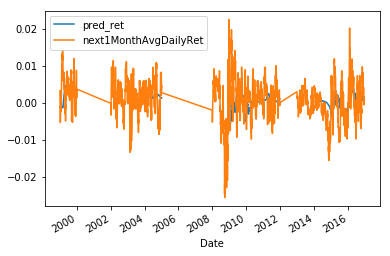

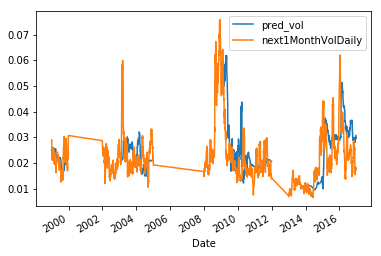

In [291]:
m_lasso_tuned = Lasso(alpha=0.0002,random_state=10)
Prediction_1M_lasso_tune = prediction(response_data.next1MonthAvgDailyRet,response_data.next1MonthVolDaily,m_lasso_tuned,m_lasso_tuned,1,2,1)


In [292]:
Prediction_1M_lasso_tune.to_pickle("Prediction_1M_lasso_tune.pkl")

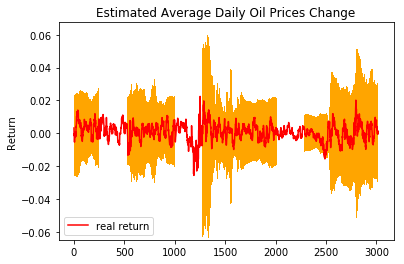

In [293]:
plot_to_use(Prediction_1M_lasso_tune,1)

In [294]:
get_error(Prediction_1M_lasso_tune,1)

rmse_r       0.005266
rmse_v       0.025242
days_in      0.995933
tot_error    0.030042
dtype: float64

In [295]:
m_neural

MLPRegressor(activation='tanh', alpha=0.0001, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(140, 140, 140, 140), learning_rate='constant',
       learning_rate_init=0.001, max_iter=200, momentum=0.9,
       nesterovs_momentum=True, power_t=0.5, random_state=10, shuffle=True,
       solver='adam', tol=0.0001, validation_fraction=0.1, verbose=False,
       warm_start=False)

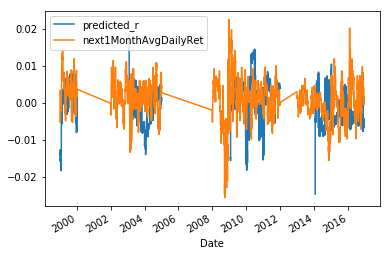

In [16]:
next1MonthRetPred_div = next1MonthRetPred/5
next1MonthRetPred_div.join(response_data['next1MonthAvgDailyRet']).plot()

In [17]:
next1MonthRetPred.apply(lambda x: sum(x.isna()),axis=0)

predicted_r    807
dtype: int64

In [ ]:
next1MonthVol = predict_reg(X_data=feature_data,Y_data=response_data['next1MonthVolDaily'],startdate='19981231',enddate='20161223',tLen=251*2,tperiod=30,min_data=251)

1998-12-31 00:00:00
1999-01-04 00:00:00
1999-01-05 00:00:00
1999-01-06 00:00:00
1999-01-07 00:00:00
1999-01-08 00:00:00
1999-01-11 00:00:00
1999-01-12 00:00:00
1999-01-13 00:00:00
1999-01-14 00:00:00
1999-01-15 00:00:00
1999-01-19 00:00:00
1999-01-20 00:00:00
1999-01-21 00:00:00
1999-01-22 00:00:00
1999-01-25 00:00:00
1999-01-26 00:00:00
1999-01-27 00:00:00
1999-01-28 00:00:00
1999-01-29 00:00:00
1999-02-01 00:00:00
1999-02-02 00:00:00
1999-02-03 00:00:00
1999-02-04 00:00:00
1999-02-05 00:00:00
1999-02-08 00:00:00
1999-02-09 00:00:00
1999-02-10 00:00:00
1999-02-11 00:00:00
1999-02-12 00:00:00
1999-02-16 00:00:00
1999-02-17 00:00:00
1999-02-18 00:00:00
1999-02-19 00:00:00
1999-02-22 00:00:00
1999-02-23 00:00:00
1999-02-24 00:00:00
1999-02-25 00:00:00
1999-02-26 00:00:00
1999-03-01 00:00:00
1999-03-02 00:00:00
1999-03-03 00:00:00
1999-03-04 00:00:00
1999-03-05 00:00:00
1999-03-08 00:00:00
1999-03-09 00:00:00
1999-03-10 00:00:00
1999-03-11 00:00:00
1999-03-12 00:00:00
1999-03-15 00:00:00


2002-10-02 00:00:00
2002-10-03 00:00:00
2002-10-04 00:00:00
2002-10-07 00:00:00
2002-10-08 00:00:00
2002-10-09 00:00:00
2002-10-10 00:00:00
2002-10-11 00:00:00
2002-10-14 00:00:00
2002-10-15 00:00:00
2002-10-16 00:00:00
2002-10-17 00:00:00
2002-10-18 00:00:00
2002-10-21 00:00:00
2002-10-22 00:00:00
2002-10-23 00:00:00
2002-10-24 00:00:00
2002-10-25 00:00:00
2002-10-28 00:00:00
2002-10-29 00:00:00
2002-10-30 00:00:00
2002-10-31 00:00:00
2002-11-01 00:00:00
2002-11-04 00:00:00
2002-11-05 00:00:00
2002-11-06 00:00:00
2002-11-07 00:00:00
2002-11-08 00:00:00
2002-11-11 00:00:00
2002-11-12 00:00:00
2002-11-13 00:00:00
2002-11-14 00:00:00
2002-11-15 00:00:00
2002-11-18 00:00:00
2002-11-19 00:00:00
2002-11-20 00:00:00
2002-11-21 00:00:00
2002-11-22 00:00:00
2002-11-25 00:00:00
2002-11-26 00:00:00
2002-11-27 00:00:00
2002-12-02 00:00:00
2002-12-03 00:00:00
2002-12-04 00:00:00
2002-12-05 00:00:00
2002-12-06 00:00:00
2002-12-09 00:00:00
2002-12-10 00:00:00
2002-12-11 00:00:00
2002-12-12 00:00:00


2004-05-27 00:00:00
2004-05-28 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-10 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-12 00:00:00
2004-07-13 00:00:00
2004-07-14 00:00:00
2004-07-15 00:00:00
2004-07-16 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-23 00:00:00
2004-07-26 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-07-30 00:00:00
2004-08-02 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-09 00:00:00


2009-01-28 00:00:00
2009-01-29 00:00:00
2009-01-30 00:00:00
2009-02-02 00:00:00
2009-02-03 00:00:00
2009-02-04 00:00:00
2009-02-05 00:00:00
2009-02-06 00:00:00
2009-02-09 00:00:00
2009-02-10 00:00:00
2009-02-11 00:00:00
2009-02-12 00:00:00
2009-02-13 00:00:00
2009-02-17 00:00:00
2009-02-18 00:00:00
2009-02-19 00:00:00
2009-02-20 00:00:00
2009-02-23 00:00:00
2009-02-24 00:00:00
2009-02-25 00:00:00
2009-02-26 00:00:00
2009-02-27 00:00:00
2009-03-02 00:00:00
2009-03-03 00:00:00
2009-03-04 00:00:00
2009-03-05 00:00:00
2009-03-06 00:00:00
2009-03-09 00:00:00
2009-03-10 00:00:00
2009-03-11 00:00:00
2009-03-12 00:00:00
2009-03-13 00:00:00
2009-03-16 00:00:00
2009-03-17 00:00:00
2009-03-18 00:00:00
2009-03-19 00:00:00
2009-03-20 00:00:00
2009-03-23 00:00:00
2009-03-24 00:00:00
2009-03-25 00:00:00
2009-03-26 00:00:00
2009-03-27 00:00:00
2009-03-30 00:00:00
2009-03-31 00:00:00
2009-04-01 00:00:00
2009-04-02 00:00:00
2009-04-03 00:00:00
2009-04-06 00:00:00
2009-04-07 00:00:00
2009-04-08 00:00:00


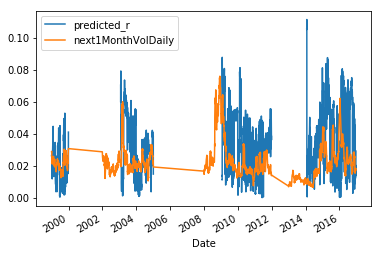

In [117]:
next1MonthVol.abs().join(response_data['next1MonthVolDaily']).plot()

In [119]:
next1MonthVol = next1MonthVol.abs()
next1MonthVol.rename(columns={'predicted_r':'predicted_vol'},inplace=True)
next1monthpred = next1MonthRetPred_div.join(next1MonthVol)
next1monthpred.head()

,predicted_r,predicted_vol
Date,,
1998-12-31,-0.0152478,0.0262666
1999-01-04,-0.0154372,0.0268458
1999-01-05,-0.015503,0.0281878
1999-01-06,-0.01415,0.0269716
1999-01-07,-0.0157678,0.0271707


In [125]:
next1monthpred['lower'] = next1monthpred['predicted_r'] - next1monthpred['predicted_vol']
next1monthpred['upper'] = next1monthpred['predicted_r'] + next1monthpred['predicted_vol']
next1monthpred['lower'] = next1monthpred['lower']/5
next1monthpred['upper'] = next1monthpred['upper']/5
next1monthpred.head()

,predicted_r,predicted_vol,lower,upper
Date,,,,
1998-12-31,-0.0152478,0.0262666,-0.00830287,0.00220377
1999-01-04,-0.0154372,0.0268458,-0.00845659,0.00228171
1999-01-05,-0.015503,0.0281878,-0.00873817,0.00253695
1999-01-06,-0.01415,0.0269716,-0.00822431,0.00256432
1999-01-07,-0.0157678,0.0271707,-0.0085877,0.00228058


In [131]:
prediction1Month = next1monthpred.iloc[:,[2,3]].join(response_data['next1MonthAvgDailyRet'])
prediction1Month.head()

,lower,upper,next1MonthAvgDailyRet
Date,,,
1998-12-31,-0.00830287,0.00220377,0.00324009
1999-01-04,-0.00845659,0.00228171,-0.00137344
1999-01-05,-0.00873817,0.00253695,-0.000325344
1999-01-06,-0.00822431,0.00256432,-0.00350489
1999-01-07,-0.0085877,0.00228058,-0.00426425


In [111]:
'next'+str(1)+'MonthAvgDailyRet'

'next1MonthAvgDailyRet'

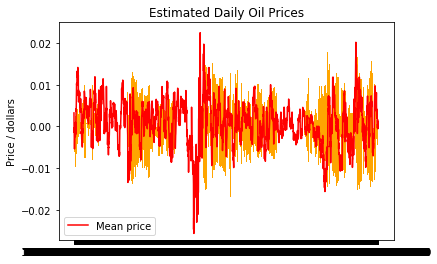

In [134]:
plot_to_use(prediction1Month)

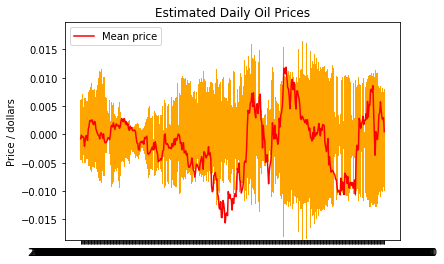

In [148]:
plot_to_use(prediction1Month.iloc[2300:2700,:])

In [110]:
next2MonthVol = predict_reg(X_data=feature_data,Y_data=response_data['next2MonthVolDaily'],startdate='20071231',enddate='20161223',tLen=251*2,tperiod=60,min_data=251)

2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00


2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-17 00:00:00
2009-09-18 00:00:00
2009-09-21 00:00:00
2009-09-22 00:00:00
2009-09-23 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2009-09-28 00:00:00
2009-09-29 00:00:00
2009-09-30 00:00:00
2009-10-01 00:00:00
2009-10-02 00:00:00
2009-10-05 00:00:00
2009-10-06 00:00:00
2009-10-07 00:00:00
2009-10-08 00:00:00
2009-10-09 00:00:00
2009-10-12 00:00:00
2009-10-13 00:00:00
2009-10-14 00:00:00
2009-10-15 00:00:00
2009-10-16 00:00:00
2009-10-19 00:00:00
2009-10-20 00:00:00
2009-10-21 00:00:00
2009-10-22 00:00:00
2009-10-23 00:00:00
2009-10-26 00:00:00
2009-10-27 00:00:00
2009-10-28 00:00:00


2011-04-05 00:00:00
2011-04-06 00:00:00
2011-04-07 00:00:00
2011-04-08 00:00:00
2011-04-11 00:00:00
2011-04-12 00:00:00
2011-04-13 00:00:00
2011-04-14 00:00:00
2011-04-15 00:00:00
2011-04-18 00:00:00
2011-04-19 00:00:00
2011-04-20 00:00:00
2011-04-21 00:00:00
2011-04-25 00:00:00
2011-04-26 00:00:00
2011-04-27 00:00:00
2011-04-28 00:00:00
2011-04-29 00:00:00
2011-05-02 00:00:00
2011-05-03 00:00:00
2011-05-04 00:00:00
2011-05-05 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-13 00:00:00
2011-05-16 00:00:00
2011-05-17 00:00:00
2011-05-18 00:00:00
2011-05-19 00:00:00
2011-05-20 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-05-25 00:00:00
2011-05-26 00:00:00
2011-05-27 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-13 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00


2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-07-31 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-06 00:00:00
2015-08-07 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-17 00:00:00
2015-08-18 00:00:00
2015-08-19 00:00:00
2015-08-20 00:00:00
2015-08-21 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-26 00:00:00
2015-08-27 00:00:00
2015-08-28 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-04 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00


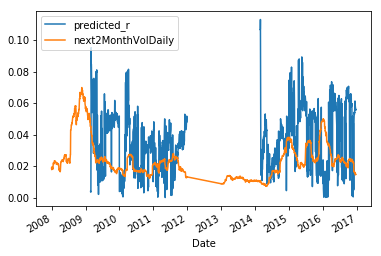

In [116]:
next2MonthVol.abs().join(response_data['next2MonthVolDaily']).plot()

2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00


2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-17 00:00:00
2009-09-18 00:00:00
2009-09-21 00:00:00
2009-09-22 00:00:00
2009-09-23 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2009-09-28 00:00:00
2009-09-29 00:00:00
2009-09-30 00:00:00
2009-10-01 00:00:00
2009-10-02 00:00:00
2009-10-05 00:00:00
2009-10-06 00:00:00
2009-10-07 00:00:00
2009-10-08 00:00:00
2009-10-09 00:00:00
2009-10-12 00:00:00
2009-10-13 00:00:00
2009-10-14 00:00:00
2009-10-15 00:00:00
2009-10-16 00:00:00
2009-10-19 00:00:00
2009-10-20 00:00:00
2009-10-21 00:00:00
2009-10-22 00:00:00
2009-10-23 00:00:00
2009-10-26 00:00:00
2009-10-27 00:00:00
2009-10-28 00:00:00


2011-04-07 00:00:00
2011-04-08 00:00:00
2011-04-11 00:00:00
2011-04-12 00:00:00
2011-04-13 00:00:00
2011-04-14 00:00:00
2011-04-15 00:00:00
2011-04-18 00:00:00
2011-04-19 00:00:00
2011-04-20 00:00:00
2011-04-21 00:00:00
2011-04-25 00:00:00
2011-04-26 00:00:00
2011-04-27 00:00:00
2011-04-28 00:00:00
2011-04-29 00:00:00
2011-05-02 00:00:00
2011-05-03 00:00:00
2011-05-04 00:00:00
2011-05-05 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-13 00:00:00
2011-05-16 00:00:00
2011-05-17 00:00:00
2011-05-18 00:00:00
2011-05-19 00:00:00
2011-05-20 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-05-25 00:00:00
2011-05-26 00:00:00
2011-05-27 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-13 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00


2014-02-11 00:00:00
2014-02-12 00:00:00
2014-02-13 00:00:00
2014-02-14 00:00:00
2014-02-18 00:00:00
2014-02-19 00:00:00
2014-02-20 00:00:00
2014-02-21 00:00:00
2014-02-24 00:00:00
2014-02-25 00:00:00
2014-02-26 00:00:00
2014-02-27 00:00:00
2014-02-28 00:00:00
2014-03-03 00:00:00
2014-03-04 00:00:00
2014-03-05 00:00:00
2014-03-06 00:00:00
2014-03-07 00:00:00
2014-03-10 00:00:00
2014-03-11 00:00:00
2014-03-12 00:00:00
2014-03-13 00:00:00
2014-03-14 00:00:00
2014-03-17 00:00:00
2014-03-18 00:00:00
2014-03-19 00:00:00
2014-03-20 00:00:00
2014-03-21 00:00:00
2014-03-24 00:00:00
2014-03-25 00:00:00
2014-03-26 00:00:00
2014-03-27 00:00:00
2014-03-28 00:00:00
2014-03-31 00:00:00
2014-04-01 00:00:00
2014-04-02 00:00:00
2014-04-03 00:00:00
2014-04-04 00:00:00
2014-04-07 00:00:00
2014-04-08 00:00:00
2014-04-09 00:00:00
2014-04-10 00:00:00
2014-04-11 00:00:00
2014-04-14 00:00:00
2014-04-15 00:00:00
2014-04-16 00:00:00
2014-04-17 00:00:00
2014-04-21 00:00:00
2014-04-22 00:00:00
2014-04-23 00:00:00


2015-09-22 00:00:00
2015-09-23 00:00:00
2015-09-24 00:00:00
2015-09-25 00:00:00
2015-09-28 00:00:00
2015-09-29 00:00:00
2015-09-30 00:00:00
2015-10-01 00:00:00
2015-10-02 00:00:00
2015-10-05 00:00:00
2015-10-06 00:00:00
2015-10-07 00:00:00
2015-10-08 00:00:00
2015-10-09 00:00:00
2015-10-12 00:00:00
2015-10-13 00:00:00
2015-10-14 00:00:00
2015-10-15 00:00:00
2015-10-16 00:00:00
2015-10-19 00:00:00
2015-10-20 00:00:00
2015-10-21 00:00:00
2015-10-22 00:00:00
2015-10-23 00:00:00
2015-10-26 00:00:00
2015-10-27 00:00:00
2015-10-28 00:00:00
2015-10-29 00:00:00
2015-10-30 00:00:00
2015-11-02 00:00:00
2015-11-03 00:00:00
2015-11-04 00:00:00
2015-11-05 00:00:00
2015-11-06 00:00:00
2015-11-09 00:00:00
2015-11-10 00:00:00
2015-11-11 00:00:00
2015-11-12 00:00:00
2015-11-13 00:00:00
2015-11-16 00:00:00
2015-11-17 00:00:00
2015-11-18 00:00:00
2015-11-19 00:00:00
2015-11-20 00:00:00
2015-11-23 00:00:00
2015-11-24 00:00:00
2015-11-25 00:00:00
2015-11-26 00:00:00
2015-11-27 00:00:00
2015-11-30 00:00:00


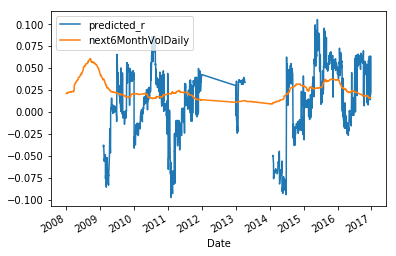

In [114]:
next6MonthVol = predict_reg(X_data=feature_data,Y_data=response_data['next6MonthVolDaily'],startdate='20071231',enddate='20161223',tLen=251*2,tperiod=180,min_data=150)
next6MonthVol.abs().join(response_data['next6MonthVolDaily']).plot()

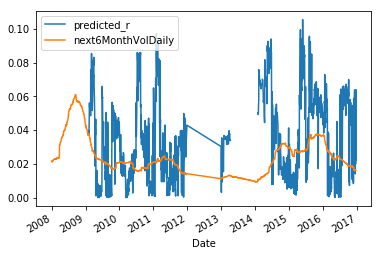

In [115]:
next6MonthVol.abs().join(response_data['next6MonthVolDaily']).plot()

In [15]:
next1MonthRet = predict_reg(X_data=feature_data,Y_data=response_data['next1MonthAvgDailyRet'],startdate='20071231',enddate='20161223',tLen=251*2,tperiod=30,min_data=251,model=m_neural)

            

2007-12-31 00:00:00
2008-01-02 00:00:00
2008-01-03 00:00:00
2008-01-04 00:00:00
2008-01-07 00:00:00
2008-01-08 00:00:00
2008-01-09 00:00:00
2008-01-10 00:00:00
2008-01-11 00:00:00
2008-01-14 00:00:00
2008-01-15 00:00:00
2008-01-16 00:00:00
2008-01-17 00:00:00
2008-01-18 00:00:00
2008-01-22 00:00:00
2008-01-23 00:00:00
2008-01-24 00:00:00
2008-01-25 00:00:00
2008-01-28 00:00:00
2008-01-29 00:00:00
2008-01-30 00:00:00
2008-01-31 00:00:00
2008-02-01 00:00:00
2008-02-04 00:00:00
2008-02-05 00:00:00
2008-02-06 00:00:00
2008-02-07 00:00:00
2008-02-08 00:00:00
2008-02-11 00:00:00
2008-02-12 00:00:00
2008-02-13 00:00:00
2008-02-14 00:00:00
2008-02-15 00:00:00
2008-02-19 00:00:00
2008-02-20 00:00:00
2008-02-21 00:00:00
2008-02-22 00:00:00
2008-02-25 00:00:00
2008-02-26 00:00:00
2008-02-27 00:00:00
2008-02-28 00:00:00
2008-02-29 00:00:00
2008-03-03 00:00:00
2008-03-04 00:00:00
2008-03-05 00:00:00
2008-03-06 00:00:00
2008-03-07 00:00:00
2008-03-10 00:00:00
2008-03-11 00:00:00
2008-03-12 00:00:00


mse of training: 0.0055855052465133
predicted value: 0.05486448440981334
2009-03-12 00:00:00
mse of training: 0.0057817332703348325
predicted value: 0.06462589281615047
2009-03-13 00:00:00
mse of training: 0.005920978684769915
predicted value: 0.04171312714475775
2009-03-16 00:00:00
mse of training: 0.006115849304322358
predicted value: 0.04751708734375376
2009-03-17 00:00:00
mse of training: 0.006115849304322358
predicted value: 0.04793671187211962
2009-03-18 00:00:00
mse of training: 0.006115849304322358
predicted value: 0.04781800556711474
2009-03-19 00:00:00
mse of training: 0.006817713149660332
predicted value: 0.05673499015137781
2009-03-20 00:00:00
mse of training: 0.00663394414458285
predicted value: 0.06664508370015101
2009-03-23 00:00:00
mse of training: 0.005557132543087579
predicted value: 0.05177813550995072
2009-03-24 00:00:00
mse of training: 0.005557132543087579
predicted value: 0.051686520140842324
2009-03-25 00:00:00
mse of training: 0.005613389317893832
predicted val

mse of training: 0.0015132263781565188
predicted value: -0.04695416643547362
2009-07-16 00:00:00
mse of training: 0.001381165191391648
predicted value: -0.04314268492803769
2009-07-17 00:00:00
mse of training: 0.0015227432436360777
predicted value: -0.046011611504089195
2009-07-20 00:00:00
mse of training: 0.0020827543742832
predicted value: -0.06376811414204636
2009-07-21 00:00:00
mse of training: 0.001668843452612937
predicted value: -0.050777858290479094
2009-07-22 00:00:00
mse of training: 0.0017821708105612126
predicted value: -0.05424228669861897
2009-07-23 00:00:00
mse of training: 0.0018342230055842228
predicted value: -0.05670174687310611
2009-07-24 00:00:00
mse of training: 0.002153797669788928
predicted value: -0.057465156735895195
2009-07-27 00:00:00
mse of training: 0.0021309667621263162
predicted value: -0.05797592168527291
2009-07-28 00:00:00
mse of training: 0.0015843240111036892
predicted value: -0.048032589927577335
2009-07-29 00:00:00
mse of training: 0.0015354181674

mse of training: 0.005829990698858763
predicted value: 0.05713902110506369
2009-11-17 00:00:00
mse of training: 0.00471189949413286
predicted value: 0.045885143402065454
2009-11-18 00:00:00
mse of training: 0.004746053611802082
predicted value: 0.04257072245488164
2009-11-19 00:00:00
mse of training: 0.004907381270541807
predicted value: 0.04537948025509553
2009-11-20 00:00:00
mse of training: 0.004972122371503841
predicted value: 0.04821632238305526
2009-11-23 00:00:00
mse of training: 0.0058433733136695355
predicted value: 0.057331200905368834
2009-11-24 00:00:00
mse of training: 0.004964604739037165
predicted value: 0.0481599193270508
2009-11-25 00:00:00
mse of training: 0.00489565034400296
predicted value: 0.0500755518550271
2009-11-27 00:00:00
mse of training: 0.00492077718716584
predicted value: 0.046682595845091296
2009-11-30 00:00:00
mse of training: 0.003473450454067607
predicted value: 0.01291543434007758
2009-12-01 00:00:00
mse of training: 0.0048878045071763
predicted value

mse of training: 0.0029486058783328027
predicted value: 0.01627484293823514
2010-03-23 00:00:00
mse of training: 0.0034164612290127575
predicted value: 0.015584713282007612
2010-03-24 00:00:00
mse of training: 0.003313909782142155
predicted value: 0.019075378625630662
2010-03-25 00:00:00
mse of training: 0.0032847289093758223
predicted value: 0.022396131714631035
2010-03-26 00:00:00
mse of training: 0.003595694600537816
predicted value: 0.02520296745430628
2010-03-29 00:00:00
mse of training: 0.00335468884372565
predicted value: 0.028190805608760167
2010-03-30 00:00:00
mse of training: 0.0033561784560456995
predicted value: 0.02319461227101327
2010-03-31 00:00:00
mse of training: 0.0037662887050919198
predicted value: 0.029086786322080477
2010-04-01 00:00:00
mse of training: 0.004140578238697171
predicted value: 0.037335140453780835
2010-04-05 00:00:00
mse of training: 0.0043705553004688025
predicted value: 0.05069302466772213
2010-04-06 00:00:00
mse of training: 0.004020867747837164
p

mse of training: 0.008412487738252443
predicted value: -0.12530238927211082
2010-07-23 00:00:00
mse of training: 0.00808945766018263
predicted value: -0.12841657964729195
2010-07-26 00:00:00
mse of training: 0.005711668360392543
predicted value: -0.1039516540393847
2010-07-27 00:00:00
mse of training: 0.007846101445577071
predicted value: -0.12792476697377533
2010-07-28 00:00:00
mse of training: 0.007520753326300411
predicted value: -0.12525669483804802
2010-07-29 00:00:00
mse of training: 0.0072698706880387045
predicted value: -0.12180681840340432
2010-07-30 00:00:00
mse of training: 0.006413729580358544
predicted value: -0.11568508457780657
2010-08-02 00:00:00
mse of training: 0.004741287545730413
predicted value: -0.09463801179226836
2010-08-03 00:00:00
mse of training: 0.004741287545730413
predicted value: -0.09412323921107954
2010-08-04 00:00:00
mse of training: 0.006220548726595789
predicted value: -0.11329634452467444
2010-08-05 00:00:00
mse of training: 0.0066082956944831595
pr

mse of training: 0.0041803378976665315
predicted value: -0.07965092627233916
2010-11-23 00:00:00
mse of training: 0.0026944382510419996
predicted value: -0.05403975965800542
2010-11-24 00:00:00
mse of training: 0.0028508708004319015
predicted value: -0.05449771752690502
2010-11-26 00:00:00
mse of training: 0.002851733833434236
predicted value: -0.05047388904700875
2010-11-29 00:00:00
mse of training: 0.0036289382681539825
predicted value: -0.06930979690254618
2010-11-30 00:00:00
mse of training: 0.002917312633736044
predicted value: -0.049125377319546804
2010-12-01 00:00:00
mse of training: 0.0031261725656508057
predicted value: -0.046652606711668904
2010-12-02 00:00:00
mse of training: 0.0031599260658728996
predicted value: -0.04420218539514814
2010-12-03 00:00:00
mse of training: 0.0033635732712185037
predicted value: -0.04227366030741178
2010-12-06 00:00:00
mse of training: 0.0034467216132239116
predicted value: -0.05611204695550531
2010-12-07 00:00:00
mse of training: 0.00356453566

predicted value: 0.018648485404450577
2011-03-29 00:00:00
mse of training: 0.0032718330171559703
predicted value: -0.06327440711997115
2011-03-30 00:00:00
mse of training: 0.0035816670312373363
predicted value: -0.06849183206329817
2011-03-31 00:00:00
mse of training: 0.003873758165174384
predicted value: -0.0662701548875804
2011-04-01 00:00:00
mse of training: 0.004300087444548952
predicted value: -0.07543196095444452
2011-04-04 00:00:00
mse of training: 0.004319937729370442
predicted value: -0.015977403201894863
2011-04-05 00:00:00
mse of training: 0.005351259527235796
predicted value: -0.08146678307858196
2011-04-06 00:00:00
mse of training: 0.0034415391401408633
predicted value: 0.14112514142392385
2011-04-07 00:00:00
mse of training: 0.005068120869180531
predicted value: -0.0734051050538922
2011-04-08 00:00:00
mse of training: 0.0032370889044086716
predicted value: 0.13907043195799665
2011-04-11 00:00:00
mse of training: 0.005334505955866093
predicted value: 0.027243711079645128
2

mse of training: 0.0031968182038039634
predicted value: 0.0916465581923801
2011-08-03 00:00:00
mse of training: 0.0027295105368498394
predicted value: 0.07889813074399782
2011-08-04 00:00:00
mse of training: 0.00271793424027824
predicted value: 0.07197560696727906
2011-08-05 00:00:00
mse of training: 0.002882797168108086
predicted value: 0.07731244897665016
2011-08-08 00:00:00
mse of training: 0.004359331591082853
predicted value: 0.1057270627644348
2011-08-09 00:00:00
mse of training: 0.002779066385336579
predicted value: 0.0719742049304116
2011-08-10 00:00:00
mse of training: 0.002822438066884305
predicted value: 0.0723375026788467
2011-08-11 00:00:00
mse of training: 0.0028735233090949495
predicted value: 0.06935362407920961
2011-08-12 00:00:00
mse of training: 0.002760159099241171
predicted value: 0.06446179915780004
2011-08-15 00:00:00
mse of training: 0.0033300550577910165
predicted value: 0.08220347723945723
2011-08-16 00:00:00
mse of training: 0.003319934702293355
predicted val

mse of training: 0.018607328334225938
predicted value: -0.08443755749809824
2011-12-05 00:00:00
mse of training: 0.004672145265291236
predicted value: 0.09176358693973347
2011-12-06 00:00:00
mse of training: 0.021963923664517243
predicted value: -0.0766367044788949
2011-12-07 00:00:00
mse of training: 0.02093766404619089
predicted value: -0.0757254720604689
2011-12-08 00:00:00
mse of training: 0.020227951871517092
predicted value: -0.07528098728370776
2011-12-09 00:00:00
mse of training: 0.019577043326420445
predicted value: -0.08508019181832051
2011-12-12 00:00:00
mse of training: 0.004271007231221676
predicted value: 0.06795200253271202
2011-12-13 00:00:00
mse of training: 0.018327251702745493
predicted value: -0.08241072200226009
2011-12-14 00:00:00
mse of training: 0.02005677819995998
predicted value: -0.07932787655284954
2011-12-15 00:00:00
mse of training: 0.020976630647974434
predicted value: -0.07496234141098795
2011-12-16 00:00:00
mse of training: 0.021270265987619563
predicte

predicted value: -0.04210656772878915
2014-02-12 00:00:00
mse of training: 0.0006099413725162497
predicted value: -0.001081013332707409
2014-02-13 00:00:00
mse of training: 0.0007697540287201249
predicted value: -0.023079655582157577
2014-02-14 00:00:00
mse of training: 0.0006717678513527175
predicted value: -0.011879188637293009
2014-02-18 00:00:00
mse of training: 0.0010748767917663727
predicted value: -0.0028997258749891286
2014-02-19 00:00:00
mse of training: 0.0010748767917663727
predicted value: -0.0027872190796494056
2014-02-20 00:00:00
mse of training: 0.0008994666636838587
predicted value: -0.014067233860594719
2014-02-21 00:00:00
mse of training: 0.0010457076541259783
predicted value: -0.020468616190058603
2014-02-24 00:00:00
mse of training: 0.0007437129464801337
predicted value: -0.03383291824402854
2014-02-25 00:00:00
mse of training: 0.0007437129464801337
predicted value: -0.033328659301028796
2014-02-26 00:00:00
mse of training: 0.0015530540968933249
predicted value: -0.

predicted value: -0.026686547592486176
2014-06-16 00:00:00
mse of training: 0.014117052053307306
predicted value: 0.0917708772536247
2014-06-17 00:00:00
mse of training: 0.019491084185637754
predicted value: 0.08683746068338766
2014-06-18 00:00:00
mse of training: 0.014945345599929757
predicted value: 0.09069557550735757
2014-06-19 00:00:00
mse of training: 0.015139038786566132
predicted value: 0.09226676761112779
2014-06-20 00:00:00
mse of training: 0.015226537142972544
predicted value: 0.08758192682452515
2014-06-23 00:00:00
mse of training: 0.016630839719726127
predicted value: 0.09574483681082932
2014-06-24 00:00:00
mse of training: 0.017037902465006943
predicted value: 0.08417152230025879
2014-06-25 00:00:00
mse of training: 0.02257905334959549
predicted value: 0.07458854935271508
2014-06-26 00:00:00
mse of training: 0.02358679717111475
predicted value: 0.07383888176622821
2014-06-27 00:00:00
mse of training: 0.022884908086589485
predicted value: 0.06969058110939011
2014-06-30 00:

mse of training: 0.025547049722391628
predicted value: 0.21093360381356194
2014-10-20 00:00:00
mse of training: 0.023570940738508836
predicted value: 0.20163615036362534
2014-10-21 00:00:00
mse of training: 0.02238154269499462
predicted value: 0.19730047631920833
2014-10-22 00:00:00
mse of training: 0.021606825606748953
predicted value: 0.19353298098368474
2014-10-23 00:00:00
mse of training: 0.005360221381950959
predicted value: -0.09946199401439904
2014-10-24 00:00:00
mse of training: 0.00576717792405063
predicted value: -0.10568291696164575
2014-10-27 00:00:00
mse of training: 0.006512276716651038
predicted value: -0.11223236653307933
2014-10-28 00:00:00
mse of training: 0.020807972362302852
predicted value: 0.18471160553843505
2014-10-29 00:00:00
mse of training: 0.0017244202794966317
predicted value: 0.04769617410964977
2014-10-30 00:00:00
mse of training: 0.0014891761744358365
predicted value: 0.04432304355823152
2014-10-31 00:00:00
mse of training: 0.0015596163765245576
predicte

mse of training: 0.002180585743656921
predicted value: 0.039764917199586164
2015-02-24 00:00:00
mse of training: 0.0004957788562301139
predicted value: -0.004627431588605985
2015-02-25 00:00:00
mse of training: 0.00031613725604018886
predicted value: 0.022737936820466154
2015-02-26 00:00:00
mse of training: 0.0007315144425300844
predicted value: 0.04259480974473753
2015-02-27 00:00:00
mse of training: 0.0003654861606284011
predicted value: 0.021430002725046943
2015-03-02 00:00:00
mse of training: 0.0005373153504135132
predicted value: 0.0052696257955164305
2015-03-03 00:00:00
mse of training: 0.0011564583569149886
predicted value: -0.0014169136869683074
2015-03-04 00:00:00
mse of training: 0.0018797860476431091
predicted value: -0.010764659723646652
2015-03-05 00:00:00
mse of training: 0.0008949404541147272
predicted value: 0.004134963716081491
2015-03-06 00:00:00
mse of training: 0.0005346336864434793
predicted value: 0.01822014617896303
2015-03-09 00:00:00
mse of training: 0.00193753

mse of training: 0.002923645588232507
predicted value: 0.02633415342387238
2015-06-24 00:00:00
mse of training: 0.009101200909806552
predicted value: 0.13081398120826337
2015-06-25 00:00:00
mse of training: 0.0014587018574896055
predicted value: 0.013494913323379237
2015-06-26 00:00:00
mse of training: 0.004011301560755196
predicted value: 0.10377417850172638
2015-06-29 00:00:00
mse of training: 0.006633560712849122
predicted value: -0.1295839486286925
2015-06-30 00:00:00
mse of training: 0.025974880845885694
predicted value: -0.009828973861568752
2015-07-01 00:00:00
mse of training: 0.005278448903040003
predicted value: -0.12786382060997858
2015-07-02 00:00:00
mse of training: 0.009352684651033475
predicted value: -0.022153360167628616
2015-07-03 00:00:00
mse of training: 0.0020689334514881518
predicted value: 0.013988504413104813
2015-07-06 00:00:00
mse of training: 0.04888308627268152
predicted value: 0.06189224604070906
2015-07-07 00:00:00
mse of training: 0.04888308627268152
predi

mse of training: 0.019828964225006816
predicted value: 0.1634554552992749
2015-10-26 00:00:00
mse of training: 0.020558384109404266
predicted value: 0.1626319306414218
2015-10-27 00:00:00
mse of training: 0.019488910295811054
predicted value: 0.15874619113422175
2015-10-28 00:00:00
mse of training: 0.019131583000076446
predicted value: 0.15535534805547618
2015-10-29 00:00:00
mse of training: 0.01845094142750464
predicted value: 0.14948599191292752
2015-10-30 00:00:00
mse of training: 0.017762716230173937
predicted value: 0.14896727306641105
2015-11-02 00:00:00
mse of training: 0.01875577714770644
predicted value: 0.15084795760259304
2015-11-03 00:00:00
mse of training: 0.016946701350052072
predicted value: 0.1431450676942741
2015-11-04 00:00:00
mse of training: 0.016939820847972218
predicted value: 0.14172940182308882
2015-11-05 00:00:00
mse of training: 0.016424724020971507
predicted value: 0.13512876251834877
2015-11-06 00:00:00
mse of training: 0.015510692710576564
predicted value: 

mse of training: 0.0001477507834814574
predicted value: -0.024887598528697263
2016-03-07 00:00:00
mse of training: 0.0006225413003199481
predicted value: -0.00738721251864824
2016-03-08 00:00:00
mse of training: 8.480851127539071e-05
predicted value: -0.017242067312252918
2016-03-09 00:00:00
mse of training: 0.00015553779220345258
predicted value: -0.010982334846839803
2016-03-10 00:00:00
mse of training: 0.00017285994572524606
predicted value: -0.0080017976085702
2016-03-11 00:00:00
mse of training: 0.00031338801937483095
predicted value: -0.002733871497206136
2016-03-14 00:00:00
mse of training: 0.001104925509558134
predicted value: 0.019435167063847486
2016-03-15 00:00:00
mse of training: 0.000610267301986532
predicted value: 0.005952197785831198
2016-03-16 00:00:00
mse of training: 0.0009342073150389897
predicted value: -0.007991696079983318
2016-03-17 00:00:00
mse of training: 0.0011348820031856178
predicted value: -0.0044602428788990955
2016-03-18 00:00:00
mse of training: 0.0013

mse of training: 0.00425141325508562
predicted value: 0.030028818118071232
2016-07-11 00:00:00
mse of training: 0.004035782886993819
predicted value: -0.006651966545091981
2016-07-12 00:00:00
mse of training: 0.0037014309998659382
predicted value: 0.026119267681467384
2016-07-13 00:00:00
mse of training: 0.0035312304939815325
predicted value: 0.01993380518488222
2016-07-14 00:00:00
mse of training: 0.0033541675287708504
predicted value: 0.022465426411432565
2016-07-15 00:00:00
mse of training: 0.0031527450189525064
predicted value: 0.021525440698829446
2016-07-18 00:00:00
mse of training: 0.0031917011175029144
predicted value: -0.009817683980023528
2016-07-19 00:00:00
mse of training: 0.002692909933268124
predicted value: 0.02301163433695297
2016-07-20 00:00:00
mse of training: 0.0025915392327902974
predicted value: 0.02126030885059721
2016-07-21 00:00:00
mse of training: 0.0023294099805502805
predicted value: 0.015677195238158442
2016-07-22 00:00:00
mse of training: 0.0021881358953632

predicted value: -0.009087622466525447
2016-11-04 00:00:00
mse of training: 0.00027929163374356824
predicted value: -0.007368701081161638
2016-11-07 00:00:00
mse of training: 0.0006511824540259961
predicted value: -0.013477456224957052
2016-11-08 00:00:00
mse of training: 0.00038057061977379386
predicted value: -0.0063465874847072334
2016-11-09 00:00:00
mse of training: 0.0005268493258051344
predicted value: -0.010468711345477
2016-11-10 00:00:00
mse of training: 0.0006811786712884834
predicted value: -0.016376903902368817
2016-11-11 00:00:00
mse of training: 0.0008774262798334477
predicted value: -0.015459296795293676
2016-11-14 00:00:00
mse of training: 0.001469973106279651
predicted value: -0.02745985509794438
2016-11-15 00:00:00
mse of training: 0.0006112166932288605
predicted value: -0.0166374731481832
2016-11-16 00:00:00
mse of training: 0.0005922353551018725
predicted value: -0.01845409247876134
2016-11-17 00:00:00
mse of training: 0.0007414670057821011
predicted value: -0.02218

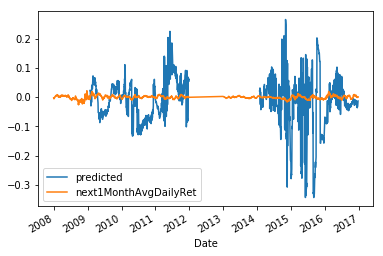

In [16]:
next1MonthRet.join(response_data.next1MonthAvgDailyRet).plot()